In [48]:
import numpy as np
import librosa
import matplotlib.pyplot as plt
import math
import soundfile as sf
from scipy.fft import fft, ifft
from scipy import signal
from scipy.fft import fft, ifft, fftfreq

In [5]:
sig, sr = librosa.load('JCT.wav' , sr = 128)

In [6]:
print(len(sig))

295


In [7]:
window_length = 32
shift = int(window_length / 2)

In [8]:
print(int(window_length - (shift+1)))
print(math.ceil(len(sig)/shift)*shift-(len(sig)-1))
print(int(window_length - (shift+1)) + math.ceil(len(sig)/shift)*shift-(len(sig)-1))

15
10
25


In [9]:
zero = np.zeros([int(window_length - (shift+1)) + int(math.ceil(len(sig)/shift)*shift-(len(sig)-1))])
print(len(zero))

25


In [10]:
sig = np.concatenate([sig,zero],axis=None)
print(len(sig))

320


In [11]:
print(len(sig)-(window_length-1))

289


In [12]:
window_list = np.zeros(len(sig))
print(len(window_list))

320


In [13]:
print(STFT.shape)

NameError: name 'STFT' is not defined

0
[-2.40724906e-03 -2.10987520e-03  3.40984087e-04  6.27512636e-04
 -9.60365578e-04 -4.23800288e-04  7.25175138e-04 -9.20794337e-05
  8.87432252e-05  1.26336876e-03 -2.21211652e-04 -1.19494775e-03
  1.09356153e-03  8.90683674e-04 -1.61895785e-03  2.08808415e-04
  2.33063707e-03 -5.20299771e-04 -1.33540540e-03  1.61938672e-03
  6.91259163e-04 -1.64030131e-03  3.52019590e-04  1.29934098e-03
 -7.92308769e-04 -3.56194039e-04  9.74035647e-04 -1.57305854e-04
 -3.43241496e-04  5.12627652e-04 -1.80236573e-04 -1.00035533e-04]
16
[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  2.33063707e-03 -5.20299771e-04 -1.33540540e-03  1.61938672e-03
  6.91259163e-04 -1.64030131e-03  3.52019590e-04  1.29934098e-03
 -7.92308769e-04 -3.56194039e-04  9.74035647e-04 -1.57305854e-04
 -3.43241496e-04  5

112
[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.0

176
[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.0

224
[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.0

256
[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.0

TypeError: Image data of dtype complex128 cannot be converted to float

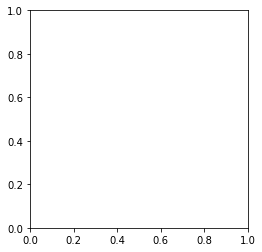

In [27]:
window = np.hanning(len(window_list))
STFT = []
for i in range(0, len(sig)-(window_length-1), shift):
    print(i)
    globals()['F{}'.format(i)] = []
    window_list = np.zeros(len(sig))
    window_list[i:i+32] = sig[i:i+32]
    print(window_list[:i+32])
    for k in range(0, len(window_list),1):
        F = 0
        for l, x in enumerate(window_list):
            value = (((2*np.pi)*k*l)/len(window_list))*1j
            F = F + ( window[l]*x*np.exp(value) )
        globals()['F{}'.format(i)].append(F)
        
    STFT.append(globals()['F{}'.format(i)])
 

In [35]:
STFT = np.array(STFT)

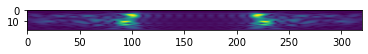

In [33]:
# print(STFT.shape)
# plt.title("STFT")
# plt.plot(STFT[1,:])
# plt.plot(STFT[6,:])
# plt.plot(STFT[12,:])
# plt.plot(STFT[18,:])
STFT1 = STFT[:(,np.shape(STFT)[1])/2]
plt.imshow(np.abs(STFT))

In [17]:
signal, sr = librosa.load('JCT.wav' , sr = 128)
stft = librosa.stft(signal,n_fft=len(window_list), win_length=32, hop_length=16,window='hanning')
print(stft.shape)


(161, 19)


C:\Users\yegee\anaconda3\lib\site-packages\librosa\core\spectrum.py:222: UserWarning: n_fft=320 is too small for input signal of length=295
  warnings.warn(


(161, 19)


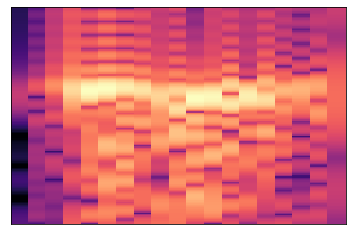

In [45]:
import librosa.display
half_STFT = STFT[:,:161].T
print(half_STFT.shape)
log_spectrogram = librosa.amplitude_to_db(abs(half_STFT))
librosa.display.specshow(log_spectrogram, sr=128, hop_length=16)


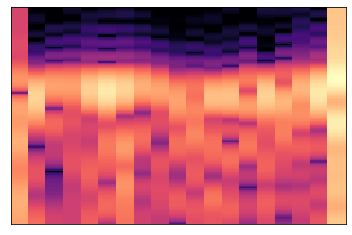

In [46]:

log_spectrogram1 = librosa.amplitude_to_db(abs(stft))
librosa.display.specshow(log_spectrogram1, sr=128, hop_length=16)

In [62]:
half_lib_fft_STFT = lib_fft_STFT[:,:161].T
print(half_lib_fft_STFT.shape)
half_modif_STFT = modif_STFT[:,:161].T
print(half_modif_STFT.shape)

(161, 19)
(161, 19)


C:\Users\yegee\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\yegee\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\yegee\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


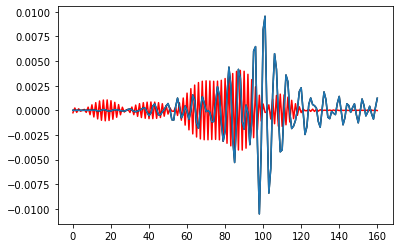

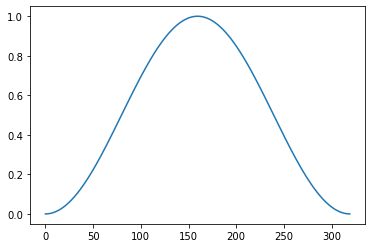

In [71]:
plt.plot(stft[:,15],c='r')
#plt.plot(half_STFT[:,15],c='b')
plt.plot(half_lib_fft_STFT[:,15],c='black')
plt.plot(half_modif_STFT[:,15])
plt.show()
plt.plot(window)

In [70]:
ISTFT = []
for m in range(0, len(modif_STFT),1):
    globals()['y{}'.format(m)] = []
    for l in range(0, len(window_list),1):
        y = 0
        for k in range(0, len(window_list),1):
            print(m,l,k)
            value =  (((2*np.pi)*k*l)/len(window_list)) *-1j
            y = y + (modif_STFT[m,k]*np.exp(value) )
        y = y * (1/len(window_list))
        globals()['y{}'.format(m)].append(y)
        
        
    ISTFT.append(globals()['y{}'.format(m)])
    print(len(ISTFT))

0 0 0
0 0 1
0 0 2
0 0 3
0 0 4
0 0 5
0 0 6
0 0 7
0 0 8
0 0 9
0 0 10
0 0 11
0 0 12
0 0 13
0 0 14
0 0 15
0 0 16
0 0 17
0 0 18
0 0 19
0 0 20
0 0 21
0 0 22
0 0 23
0 0 24
0 0 25
0 0 26
0 0 27
0 0 28
0 0 29
0 0 30
0 0 31
0 0 32
0 0 33
0 0 34
0 0 35
0 0 36
0 0 37
0 0 38
0 0 39
0 0 40
0 0 41
0 0 42
0 0 43
0 0 44
0 0 45
0 0 46
0 0 47
0 0 48
0 0 49
0 0 50
0 0 51
0 0 52
0 0 53
0 0 54
0 0 55
0 0 56
0 0 57
0 0 58
0 0 59
0 0 60
0 0 61
0 0 62
0 0 63
0 0 64
0 0 65
0 0 66
0 0 67
0 0 68
0 0 69
0 0 70
0 0 71
0 0 72
0 0 73
0 0 74
0 0 75
0 0 76
0 0 77
0 0 78
0 0 79
0 0 80
0 0 81
0 0 82
0 0 83
0 0 84
0 0 85
0 0 86
0 0 87
0 0 88
0 0 89
0 0 90
0 0 91
0 0 92
0 0 93
0 0 94
0 0 95
0 0 96
0 0 97
0 0 98
0 0 99
0 0 100
0 0 101
0 0 102
0 0 103
0 0 104
0 0 105
0 0 106
0 0 107
0 0 108
0 0 109
0 0 110
0 0 111
0 0 112
0 0 113
0 0 114
0 0 115
0 0 116
0 0 117
0 0 118
0 0 119
0 0 120
0 0 121
0 0 122
0 0 123
0 0 124
0 0 125
0 0 126
0 0 127
0 0 128
0 0 129
0 0 130
0 0 131
0 0 132
0 0 133
0 0 134
0 0 135
0 0 136
0 0 137
0 0 13

0 4 149
0 4 150
0 4 151
0 4 152
0 4 153
0 4 154
0 4 155
0 4 156
0 4 157
0 4 158
0 4 159
0 4 160
0 4 161
0 4 162
0 4 163
0 4 164
0 4 165
0 4 166
0 4 167
0 4 168
0 4 169
0 4 170
0 4 171
0 4 172
0 4 173
0 4 174
0 4 175
0 4 176
0 4 177
0 4 178
0 4 179
0 4 180
0 4 181
0 4 182
0 4 183
0 4 184
0 4 185
0 4 186
0 4 187
0 4 188
0 4 189
0 4 190
0 4 191
0 4 192
0 4 193
0 4 194
0 4 195
0 4 196
0 4 197
0 4 198
0 4 199
0 4 200
0 4 201
0 4 202
0 4 203
0 4 204
0 4 205
0 4 206
0 4 207
0 4 208
0 4 209
0 4 210
0 4 211
0 4 212
0 4 213
0 4 214
0 4 215
0 4 216
0 4 217
0 4 218
0 4 219
0 4 220
0 4 221
0 4 222
0 4 223
0 4 224
0 4 225
0 4 226
0 4 227
0 4 228
0 4 229
0 4 230
0 4 231
0 4 232
0 4 233
0 4 234
0 4 235
0 4 236
0 4 237
0 4 238
0 4 239
0 4 240
0 4 241
0 4 242
0 4 243
0 4 244
0 4 245
0 4 246
0 4 247
0 4 248
0 4 249
0 4 250
0 4 251
0 4 252
0 4 253
0 4 254
0 4 255
0 4 256
0 4 257
0 4 258
0 4 259
0 4 260
0 4 261
0 4 262
0 4 263
0 4 264
0 4 265
0 4 266
0 4 267
0 4 268
0 4 269
0 4 270
0 4 271
0 4 272
0 4 273


0 7 317
0 7 318
0 7 319
0 8 0
0 8 1
0 8 2
0 8 3
0 8 4
0 8 5
0 8 6
0 8 7
0 8 8
0 8 9
0 8 10
0 8 11
0 8 12
0 8 13
0 8 14
0 8 15
0 8 16
0 8 17
0 8 18
0 8 19
0 8 20
0 8 21
0 8 22
0 8 23
0 8 24
0 8 25
0 8 26
0 8 27
0 8 28
0 8 29
0 8 30
0 8 31
0 8 32
0 8 33
0 8 34
0 8 35
0 8 36
0 8 37
0 8 38
0 8 39
0 8 40
0 8 41
0 8 42
0 8 43
0 8 44
0 8 45
0 8 46
0 8 47
0 8 48
0 8 49
0 8 50
0 8 51
0 8 52
0 8 53
0 8 54
0 8 55
0 8 56
0 8 57
0 8 58
0 8 59
0 8 60
0 8 61
0 8 62
0 8 63
0 8 64
0 8 65
0 8 66
0 8 67
0 8 68
0 8 69
0 8 70
0 8 71
0 8 72
0 8 73
0 8 74
0 8 75
0 8 76
0 8 77
0 8 78
0 8 79
0 8 80
0 8 81
0 8 82
0 8 83
0 8 84
0 8 85
0 8 86
0 8 87
0 8 88
0 8 89
0 8 90
0 8 91
0 8 92
0 8 93
0 8 94
0 8 95
0 8 96
0 8 97
0 8 98
0 8 99
0 8 100
0 8 101
0 8 102
0 8 103
0 8 104
0 8 105
0 8 106
0 8 107
0 8 108
0 8 109
0 8 110
0 8 111
0 8 112
0 8 113
0 8 114
0 8 115
0 8 116
0 8 117
0 8 118
0 8 119
0 8 120
0 8 121
0 8 122
0 8 123
0 8 124
0 8 125
0 8 126
0 8 127
0 8 128
0 8 129
0 8 130
0 8 131
0 8 132
0 8 133
0 8 134
0 8 13

0 11 93
0 11 94
0 11 95
0 11 96
0 11 97
0 11 98
0 11 99
0 11 100
0 11 101
0 11 102
0 11 103
0 11 104
0 11 105
0 11 106
0 11 107
0 11 108
0 11 109
0 11 110
0 11 111
0 11 112
0 11 113
0 11 114
0 11 115
0 11 116
0 11 117
0 11 118
0 11 119
0 11 120
0 11 121
0 11 122
0 11 123
0 11 124
0 11 125
0 11 126
0 11 127
0 11 128
0 11 129
0 11 130
0 11 131
0 11 132
0 11 133
0 11 134
0 11 135
0 11 136
0 11 137
0 11 138
0 11 139
0 11 140
0 11 141
0 11 142
0 11 143
0 11 144
0 11 145
0 11 146
0 11 147
0 11 148
0 11 149
0 11 150
0 11 151
0 11 152
0 11 153
0 11 154
0 11 155
0 11 156
0 11 157
0 11 158
0 11 159
0 11 160
0 11 161
0 11 162
0 11 163
0 11 164
0 11 165
0 11 166
0 11 167
0 11 168
0 11 169
0 11 170
0 11 171
0 11 172
0 11 173
0 11 174
0 11 175
0 11 176
0 11 177
0 11 178
0 11 179
0 11 180
0 11 181
0 11 182
0 11 183
0 11 184
0 11 185
0 11 186
0 11 187
0 11 188
0 11 189
0 11 190
0 11 191
0 11 192
0 11 193
0 11 194
0 11 195
0 11 196
0 11 197
0 11 198
0 11 199
0 11 200
0 11 201
0 11 202
0 11 203
0 11 204

0 15 301
0 15 302
0 15 303
0 15 304
0 15 305
0 15 306
0 15 307
0 15 308
0 15 309
0 15 310
0 15 311
0 15 312
0 15 313
0 15 314
0 15 315
0 15 316
0 15 317
0 15 318
0 15 319
0 16 0
0 16 1
0 16 2
0 16 3
0 16 4
0 16 5
0 16 6
0 16 7
0 16 8
0 16 9
0 16 10
0 16 11
0 16 12
0 16 13
0 16 14
0 16 15
0 16 16
0 16 17
0 16 18
0 16 19
0 16 20
0 16 21
0 16 22
0 16 23
0 16 24
0 16 25
0 16 26
0 16 27
0 16 28
0 16 29
0 16 30
0 16 31
0 16 32
0 16 33
0 16 34
0 16 35
0 16 36
0 16 37
0 16 38
0 16 39
0 16 40
0 16 41
0 16 42
0 16 43
0 16 44
0 16 45
0 16 46
0 16 47
0 16 48
0 16 49
0 16 50
0 16 51
0 16 52
0 16 53
0 16 54
0 16 55
0 16 56
0 16 57
0 16 58
0 16 59
0 16 60
0 16 61
0 16 62
0 16 63
0 16 64
0 16 65
0 16 66
0 16 67
0 16 68
0 16 69
0 16 70
0 16 71
0 16 72
0 16 73
0 16 74
0 16 75
0 16 76
0 16 77
0 16 78
0 16 79
0 16 80
0 16 81
0 16 82
0 16 83
0 16 84
0 16 85
0 16 86
0 16 87
0 16 88
0 16 89
0 16 90
0 16 91
0 16 92
0 16 93
0 16 94
0 16 95
0 16 96
0 16 97
0 16 98
0 16 99
0 16 100
0 16 101
0 16 102
0 16 103
0 1

0 19 122
0 19 123
0 19 124
0 19 125
0 19 126
0 19 127
0 19 128
0 19 129
0 19 130
0 19 131
0 19 132
0 19 133
0 19 134
0 19 135
0 19 136
0 19 137
0 19 138
0 19 139
0 19 140
0 19 141
0 19 142
0 19 143
0 19 144
0 19 145
0 19 146
0 19 147
0 19 148
0 19 149
0 19 150
0 19 151
0 19 152
0 19 153
0 19 154
0 19 155
0 19 156
0 19 157
0 19 158
0 19 159
0 19 160
0 19 161
0 19 162
0 19 163
0 19 164
0 19 165
0 19 166
0 19 167
0 19 168
0 19 169
0 19 170
0 19 171
0 19 172
0 19 173
0 19 174
0 19 175
0 19 176
0 19 177
0 19 178
0 19 179
0 19 180
0 19 181
0 19 182
0 19 183
0 19 184
0 19 185
0 19 186
0 19 187
0 19 188
0 19 189
0 19 190
0 19 191
0 19 192
0 19 193
0 19 194
0 19 195
0 19 196
0 19 197
0 19 198
0 19 199
0 19 200
0 19 201
0 19 202
0 19 203
0 19 204
0 19 205
0 19 206
0 19 207
0 19 208
0 19 209
0 19 210
0 19 211
0 19 212
0 19 213
0 19 214
0 19 215
0 19 216
0 19 217
0 19 218
0 19 219
0 19 220
0 19 221
0 19 222
0 19 223
0 19 224
0 19 225
0 19 226
0 19 227
0 19 228
0 19 229
0 19 230
0 19 231
0 19 232
0

0 22 264
0 22 265
0 22 266
0 22 267
0 22 268
0 22 269
0 22 270
0 22 271
0 22 272
0 22 273
0 22 274
0 22 275
0 22 276
0 22 277
0 22 278
0 22 279
0 22 280
0 22 281
0 22 282
0 22 283
0 22 284
0 22 285
0 22 286
0 22 287
0 22 288
0 22 289
0 22 290
0 22 291
0 22 292
0 22 293
0 22 294
0 22 295
0 22 296
0 22 297
0 22 298
0 22 299
0 22 300
0 22 301
0 22 302
0 22 303
0 22 304
0 22 305
0 22 306
0 22 307
0 22 308
0 22 309
0 22 310
0 22 311
0 22 312
0 22 313
0 22 314
0 22 315
0 22 316
0 22 317
0 22 318
0 22 319
0 23 0
0 23 1
0 23 2
0 23 3
0 23 4
0 23 5
0 23 6
0 23 7
0 23 8
0 23 9
0 23 10
0 23 11
0 23 12
0 23 13
0 23 14
0 23 15
0 23 16
0 23 17
0 23 18
0 23 19
0 23 20
0 23 21
0 23 22
0 23 23
0 23 24
0 23 25
0 23 26
0 23 27
0 23 28
0 23 29
0 23 30
0 23 31
0 23 32
0 23 33
0 23 34
0 23 35
0 23 36
0 23 37
0 23 38
0 23 39
0 23 40
0 23 41
0 23 42
0 23 43
0 23 44
0 23 45
0 23 46
0 23 47
0 23 48
0 23 49
0 23 50
0 23 51
0 23 52
0 23 53
0 23 54
0 23 55
0 23 56
0 23 57
0 23 58
0 23 59
0 23 60
0 23 61
0 23 62
0 

0 26 94
0 26 95
0 26 96
0 26 97
0 26 98
0 26 99
0 26 100
0 26 101
0 26 102
0 26 103
0 26 104
0 26 105
0 26 106
0 26 107
0 26 108
0 26 109
0 26 110
0 26 111
0 26 112
0 26 113
0 26 114
0 26 115
0 26 116
0 26 117
0 26 118
0 26 119
0 26 120
0 26 121
0 26 122
0 26 123
0 26 124
0 26 125
0 26 126
0 26 127
0 26 128
0 26 129
0 26 130
0 26 131
0 26 132
0 26 133
0 26 134
0 26 135
0 26 136
0 26 137
0 26 138
0 26 139
0 26 140
0 26 141
0 26 142
0 26 143
0 26 144
0 26 145
0 26 146
0 26 147
0 26 148
0 26 149
0 26 150
0 26 151
0 26 152
0 26 153
0 26 154
0 26 155
0 26 156
0 26 157
0 26 158
0 26 159
0 26 160
0 26 161
0 26 162
0 26 163
0 26 164
0 26 165
0 26 166
0 26 167
0 26 168
0 26 169
0 26 170
0 26 171
0 26 172
0 26 173
0 26 174
0 26 175
0 26 176
0 26 177
0 26 178
0 26 179
0 26 180
0 26 181
0 26 182
0 26 183
0 26 184
0 26 185
0 26 186
0 26 187
0 26 188
0 26 189
0 26 190
0 26 191
0 26 192
0 26 193
0 26 194
0 26 195
0 26 196
0 26 197
0 26 198
0 26 199
0 26 200
0 26 201
0 26 202
0 26 203
0 26 204
0 26 20

0 29 255
0 29 256
0 29 257
0 29 258
0 29 259
0 29 260
0 29 261
0 29 262
0 29 263
0 29 264
0 29 265
0 29 266
0 29 267
0 29 268
0 29 269
0 29 270
0 29 271
0 29 272
0 29 273
0 29 274
0 29 275
0 29 276
0 29 277
0 29 278
0 29 279
0 29 280
0 29 281
0 29 282
0 29 283
0 29 284
0 29 285
0 29 286
0 29 287
0 29 288
0 29 289
0 29 290
0 29 291
0 29 292
0 29 293
0 29 294
0 29 295
0 29 296
0 29 297
0 29 298
0 29 299
0 29 300
0 29 301
0 29 302
0 29 303
0 29 304
0 29 305
0 29 306
0 29 307
0 29 308
0 29 309
0 29 310
0 29 311
0 29 312
0 29 313
0 29 314
0 29 315
0 29 316
0 29 317
0 29 318
0 29 319
0 30 0
0 30 1
0 30 2
0 30 3
0 30 4
0 30 5
0 30 6
0 30 7
0 30 8
0 30 9
0 30 10
0 30 11
0 30 12
0 30 13
0 30 14
0 30 15
0 30 16
0 30 17
0 30 18
0 30 19
0 30 20
0 30 21
0 30 22
0 30 23
0 30 24
0 30 25
0 30 26
0 30 27
0 30 28
0 30 29
0 30 30
0 30 31
0 30 32
0 30 33
0 30 34
0 30 35
0 30 36
0 30 37
0 30 38
0 30 39
0 30 40
0 30 41
0 30 42
0 30 43
0 30 44
0 30 45
0 30 46
0 30 47
0 30 48
0 30 49
0 30 50
0 30 51
0 30 52
0

0 33 46
0 33 47
0 33 48
0 33 49
0 33 50
0 33 51
0 33 52
0 33 53
0 33 54
0 33 55
0 33 56
0 33 57
0 33 58
0 33 59
0 33 60
0 33 61
0 33 62
0 33 63
0 33 64
0 33 65
0 33 66
0 33 67
0 33 68
0 33 69
0 33 70
0 33 71
0 33 72
0 33 73
0 33 74
0 33 75
0 33 76
0 33 77
0 33 78
0 33 79
0 33 80
0 33 81
0 33 82
0 33 83
0 33 84
0 33 85
0 33 86
0 33 87
0 33 88
0 33 89
0 33 90
0 33 91
0 33 92
0 33 93
0 33 94
0 33 95
0 33 96
0 33 97
0 33 98
0 33 99
0 33 100
0 33 101
0 33 102
0 33 103
0 33 104
0 33 105
0 33 106
0 33 107
0 33 108
0 33 109
0 33 110
0 33 111
0 33 112
0 33 113
0 33 114
0 33 115
0 33 116
0 33 117
0 33 118
0 33 119
0 33 120
0 33 121
0 33 122
0 33 123
0 33 124
0 33 125
0 33 126
0 33 127
0 33 128
0 33 129
0 33 130
0 33 131
0 33 132
0 33 133
0 33 134
0 33 135
0 33 136
0 33 137
0 33 138
0 33 139
0 33 140
0 33 141
0 33 142
0 33 143
0 33 144
0 33 145
0 33 146
0 33 147
0 33 148
0 33 149
0 33 150
0 33 151
0 33 152
0 33 153
0 33 154
0 33 155
0 33 156
0 33 157
0 33 158
0 33 159
0 33 160
0 33 161
0 33 162
0

0 37 193
0 37 194
0 37 195
0 37 196
0 37 197
0 37 198
0 37 199
0 37 200
0 37 201
0 37 202
0 37 203
0 37 204
0 37 205
0 37 206
0 37 207
0 37 208
0 37 209
0 37 210
0 37 211
0 37 212
0 37 213
0 37 214
0 37 215
0 37 216
0 37 217
0 37 218
0 37 219
0 37 220
0 37 221
0 37 222
0 37 223
0 37 224
0 37 225
0 37 226
0 37 227
0 37 228
0 37 229
0 37 230
0 37 231
0 37 232
0 37 233
0 37 234
0 37 235
0 37 236
0 37 237
0 37 238
0 37 239
0 37 240
0 37 241
0 37 242
0 37 243
0 37 244
0 37 245
0 37 246
0 37 247
0 37 248
0 37 249
0 37 250
0 37 251
0 37 252
0 37 253
0 37 254
0 37 255
0 37 256
0 37 257
0 37 258
0 37 259
0 37 260
0 37 261
0 37 262
0 37 263
0 37 264
0 37 265
0 37 266
0 37 267
0 37 268
0 37 269
0 37 270
0 37 271
0 37 272
0 37 273
0 37 274
0 37 275
0 37 276
0 37 277
0 37 278
0 37 279
0 37 280
0 37 281
0 37 282
0 37 283
0 37 284
0 37 285
0 37 286
0 37 287
0 37 288
0 37 289
0 37 290
0 37 291
0 37 292
0 37 293
0 37 294
0 37 295
0 37 296
0 37 297
0 37 298
0 37 299
0 37 300
0 37 301
0 37 302
0 37 303
0

0 40 267
0 40 268
0 40 269
0 40 270
0 40 271
0 40 272
0 40 273
0 40 274
0 40 275
0 40 276
0 40 277
0 40 278
0 40 279
0 40 280
0 40 281
0 40 282
0 40 283
0 40 284
0 40 285
0 40 286
0 40 287
0 40 288
0 40 289
0 40 290
0 40 291
0 40 292
0 40 293
0 40 294
0 40 295
0 40 296
0 40 297
0 40 298
0 40 299
0 40 300
0 40 301
0 40 302
0 40 303
0 40 304
0 40 305
0 40 306
0 40 307
0 40 308
0 40 309
0 40 310
0 40 311
0 40 312
0 40 313
0 40 314
0 40 315
0 40 316
0 40 317
0 40 318
0 40 319
0 41 0
0 41 1
0 41 2
0 41 3
0 41 4
0 41 5
0 41 6
0 41 7
0 41 8
0 41 9
0 41 10
0 41 11
0 41 12
0 41 13
0 41 14
0 41 15
0 41 16
0 41 17
0 41 18
0 41 19
0 41 20
0 41 21
0 41 22
0 41 23
0 41 24
0 41 25
0 41 26
0 41 27
0 41 28
0 41 29
0 41 30
0 41 31
0 41 32
0 41 33
0 41 34
0 41 35
0 41 36
0 41 37
0 41 38
0 41 39
0 41 40
0 41 41
0 41 42
0 41 43
0 41 44
0 41 45
0 41 46
0 41 47
0 41 48
0 41 49
0 41 50
0 41 51
0 41 52
0 41 53
0 41 54
0 41 55
0 41 56
0 41 57
0 41 58
0 41 59
0 41 60
0 41 61
0 41 62
0 41 63
0 41 64
0 41 65
0 41 

0 43 273
0 43 274
0 43 275
0 43 276
0 43 277
0 43 278
0 43 279
0 43 280
0 43 281
0 43 282
0 43 283
0 43 284
0 43 285
0 43 286
0 43 287
0 43 288
0 43 289
0 43 290
0 43 291
0 43 292
0 43 293
0 43 294
0 43 295
0 43 296
0 43 297
0 43 298
0 43 299
0 43 300
0 43 301
0 43 302
0 43 303
0 43 304
0 43 305
0 43 306
0 43 307
0 43 308
0 43 309
0 43 310
0 43 311
0 43 312
0 43 313
0 43 314
0 43 315
0 43 316
0 43 317
0 43 318
0 43 319
0 44 0
0 44 1
0 44 2
0 44 3
0 44 4
0 44 5
0 44 6
0 44 7
0 44 8
0 44 9
0 44 10
0 44 11
0 44 12
0 44 13
0 44 14
0 44 15
0 44 16
0 44 17
0 44 18
0 44 19
0 44 20
0 44 21
0 44 22
0 44 23
0 44 24
0 44 25
0 44 26
0 44 27
0 44 28
0 44 29
0 44 30
0 44 31
0 44 32
0 44 33
0 44 34
0 44 35
0 44 36
0 44 37
0 44 38
0 44 39
0 44 40
0 44 41
0 44 42
0 44 43
0 44 44
0 44 45
0 44 46
0 44 47
0 44 48
0 44 49
0 44 50
0 44 51
0 44 52
0 44 53
0 44 54
0 44 55
0 44 56
0 44 57
0 44 58
0 44 59
0 44 60
0 44 61
0 44 62
0 44 63
0 44 64
0 44 65
0 44 66
0 44 67
0 44 68
0 44 69
0 44 70
0 44 71
0 44 72
0 4

0 46 312
0 46 313
0 46 314
0 46 315
0 46 316
0 46 317
0 46 318
0 46 319
0 47 0
0 47 1
0 47 2
0 47 3
0 47 4
0 47 5
0 47 6
0 47 7
0 47 8
0 47 9
0 47 10
0 47 11
0 47 12
0 47 13
0 47 14
0 47 15
0 47 16
0 47 17
0 47 18
0 47 19
0 47 20
0 47 21
0 47 22
0 47 23
0 47 24
0 47 25
0 47 26
0 47 27
0 47 28
0 47 29
0 47 30
0 47 31
0 47 32
0 47 33
0 47 34
0 47 35
0 47 36
0 47 37
0 47 38
0 47 39
0 47 40
0 47 41
0 47 42
0 47 43
0 47 44
0 47 45
0 47 46
0 47 47
0 47 48
0 47 49
0 47 50
0 47 51
0 47 52
0 47 53
0 47 54
0 47 55
0 47 56
0 47 57
0 47 58
0 47 59
0 47 60
0 47 61
0 47 62
0 47 63
0 47 64
0 47 65
0 47 66
0 47 67
0 47 68
0 47 69
0 47 70
0 47 71
0 47 72
0 47 73
0 47 74
0 47 75
0 47 76
0 47 77
0 47 78
0 47 79
0 47 80
0 47 81
0 47 82
0 47 83
0 47 84
0 47 85
0 47 86
0 47 87
0 47 88
0 47 89
0 47 90
0 47 91
0 47 92
0 47 93
0 47 94
0 47 95
0 47 96
0 47 97
0 47 98
0 47 99
0 47 100
0 47 101
0 47 102
0 47 103
0 47 104
0 47 105
0 47 106
0 47 107
0 47 108
0 47 109
0 47 110
0 47 111
0 47 112
0 47 113
0 47 114
0 4

0 50 135
0 50 136
0 50 137
0 50 138
0 50 139
0 50 140
0 50 141
0 50 142
0 50 143
0 50 144
0 50 145
0 50 146
0 50 147
0 50 148
0 50 149
0 50 150
0 50 151
0 50 152
0 50 153
0 50 154
0 50 155
0 50 156
0 50 157
0 50 158
0 50 159
0 50 160
0 50 161
0 50 162
0 50 163
0 50 164
0 50 165
0 50 166
0 50 167
0 50 168
0 50 169
0 50 170
0 50 171
0 50 172
0 50 173
0 50 174
0 50 175
0 50 176
0 50 177
0 50 178
0 50 179
0 50 180
0 50 181
0 50 182
0 50 183
0 50 184
0 50 185
0 50 186
0 50 187
0 50 188
0 50 189
0 50 190
0 50 191
0 50 192
0 50 193
0 50 194
0 50 195
0 50 196
0 50 197
0 50 198
0 50 199
0 50 200
0 50 201
0 50 202
0 50 203
0 50 204
0 50 205
0 50 206
0 50 207
0 50 208
0 50 209
0 50 210
0 50 211
0 50 212
0 50 213
0 50 214
0 50 215
0 50 216
0 50 217
0 50 218
0 50 219
0 50 220
0 50 221
0 50 222
0 50 223
0 50 224
0 50 225
0 50 226
0 50 227
0 50 228
0 50 229
0 50 230
0 50 231
0 50 232
0 50 233
0 50 234
0 50 235
0 50 236
0 50 237
0 50 238
0 50 239
0 50 240
0 50 241
0 50 242
0 50 243
0 50 244
0 50 245
0

0 53 247
0 53 248
0 53 249
0 53 250
0 53 251
0 53 252
0 53 253
0 53 254
0 53 255
0 53 256
0 53 257
0 53 258
0 53 259
0 53 260
0 53 261
0 53 262
0 53 263
0 53 264
0 53 265
0 53 266
0 53 267
0 53 268
0 53 269
0 53 270
0 53 271
0 53 272
0 53 273
0 53 274
0 53 275
0 53 276
0 53 277
0 53 278
0 53 279
0 53 280
0 53 281
0 53 282
0 53 283
0 53 284
0 53 285
0 53 286
0 53 287
0 53 288
0 53 289
0 53 290
0 53 291
0 53 292
0 53 293
0 53 294
0 53 295
0 53 296
0 53 297
0 53 298
0 53 299
0 53 300
0 53 301
0 53 302
0 53 303
0 53 304
0 53 305
0 53 306
0 53 307
0 53 308
0 53 309
0 53 310
0 53 311
0 53 312
0 53 313
0 53 314
0 53 315
0 53 316
0 53 317
0 53 318
0 53 319
0 54 0
0 54 1
0 54 2
0 54 3
0 54 4
0 54 5
0 54 6
0 54 7
0 54 8
0 54 9
0 54 10
0 54 11
0 54 12
0 54 13
0 54 14
0 54 15
0 54 16
0 54 17
0 54 18
0 54 19
0 54 20
0 54 21
0 54 22
0 54 23
0 54 24
0 54 25
0 54 26
0 54 27
0 54 28
0 54 29
0 54 30
0 54 31
0 54 32
0 54 33
0 54 34
0 54 35
0 54 36
0 54 37
0 54 38
0 54 39
0 54 40
0 54 41
0 54 42
0 54 43
0

0 57 88
0 57 89
0 57 90
0 57 91
0 57 92
0 57 93
0 57 94
0 57 95
0 57 96
0 57 97
0 57 98
0 57 99
0 57 100
0 57 101
0 57 102
0 57 103
0 57 104
0 57 105
0 57 106
0 57 107
0 57 108
0 57 109
0 57 110
0 57 111
0 57 112
0 57 113
0 57 114
0 57 115
0 57 116
0 57 117
0 57 118
0 57 119
0 57 120
0 57 121
0 57 122
0 57 123
0 57 124
0 57 125
0 57 126
0 57 127
0 57 128
0 57 129
0 57 130
0 57 131
0 57 132
0 57 133
0 57 134
0 57 135
0 57 136
0 57 137
0 57 138
0 57 139
0 57 140
0 57 141
0 57 142
0 57 143
0 57 144
0 57 145
0 57 146
0 57 147
0 57 148
0 57 149
0 57 150
0 57 151
0 57 152
0 57 153
0 57 154
0 57 155
0 57 156
0 57 157
0 57 158
0 57 159
0 57 160
0 57 161
0 57 162
0 57 163
0 57 164
0 57 165
0 57 166
0 57 167
0 57 168
0 57 169
0 57 170
0 57 171
0 57 172
0 57 173
0 57 174
0 57 175
0 57 176
0 57 177
0 57 178
0 57 179
0 57 180
0 57 181
0 57 182
0 57 183
0 57 184
0 57 185
0 57 186
0 57 187
0 57 188
0 57 189
0 57 190
0 57 191
0 57 192
0 57 193
0 57 194
0 57 195
0 57 196
0 57 197
0 57 198
0 57 199
0 57

0 60 164
0 60 165
0 60 166
0 60 167
0 60 168
0 60 169
0 60 170
0 60 171
0 60 172
0 60 173
0 60 174
0 60 175
0 60 176
0 60 177
0 60 178
0 60 179
0 60 180
0 60 181
0 60 182
0 60 183
0 60 184
0 60 185
0 60 186
0 60 187
0 60 188
0 60 189
0 60 190
0 60 191
0 60 192
0 60 193
0 60 194
0 60 195
0 60 196
0 60 197
0 60 198
0 60 199
0 60 200
0 60 201
0 60 202
0 60 203
0 60 204
0 60 205
0 60 206
0 60 207
0 60 208
0 60 209
0 60 210
0 60 211
0 60 212
0 60 213
0 60 214
0 60 215
0 60 216
0 60 217
0 60 218
0 60 219
0 60 220
0 60 221
0 60 222
0 60 223
0 60 224
0 60 225
0 60 226
0 60 227
0 60 228
0 60 229
0 60 230
0 60 231
0 60 232
0 60 233
0 60 234
0 60 235
0 60 236
0 60 237
0 60 238
0 60 239
0 60 240
0 60 241
0 60 242
0 60 243
0 60 244
0 60 245
0 60 246
0 60 247
0 60 248
0 60 249
0 60 250
0 60 251
0 60 252
0 60 253
0 60 254
0 60 255
0 60 256
0 60 257
0 60 258
0 60 259
0 60 260
0 60 261
0 60 262
0 60 263
0 60 264
0 60 265
0 60 266
0 60 267
0 60 268
0 60 269
0 60 270
0 60 271
0 60 272
0 60 273
0 60 274
0

0 63 204
0 63 205
0 63 206
0 63 207
0 63 208
0 63 209
0 63 210
0 63 211
0 63 212
0 63 213
0 63 214
0 63 215
0 63 216
0 63 217
0 63 218
0 63 219
0 63 220
0 63 221
0 63 222
0 63 223
0 63 224
0 63 225
0 63 226
0 63 227
0 63 228
0 63 229
0 63 230
0 63 231
0 63 232
0 63 233
0 63 234
0 63 235
0 63 236
0 63 237
0 63 238
0 63 239
0 63 240
0 63 241
0 63 242
0 63 243
0 63 244
0 63 245
0 63 246
0 63 247
0 63 248
0 63 249
0 63 250
0 63 251
0 63 252
0 63 253
0 63 254
0 63 255
0 63 256
0 63 257
0 63 258
0 63 259
0 63 260
0 63 261
0 63 262
0 63 263
0 63 264
0 63 265
0 63 266
0 63 267
0 63 268
0 63 269
0 63 270
0 63 271
0 63 272
0 63 273
0 63 274
0 63 275
0 63 276
0 63 277
0 63 278
0 63 279
0 63 280
0 63 281
0 63 282
0 63 283
0 63 284
0 63 285
0 63 286
0 63 287
0 63 288
0 63 289
0 63 290
0 63 291
0 63 292
0 63 293
0 63 294
0 63 295
0 63 296
0 63 297
0 63 298
0 63 299
0 63 300
0 63 301
0 63 302
0 63 303
0 63 304
0 63 305
0 63 306
0 63 307
0 63 308
0 63 309
0 63 310
0 63 311
0 63 312
0 63 313
0 63 314
0

0 67 90
0 67 91
0 67 92
0 67 93
0 67 94
0 67 95
0 67 96
0 67 97
0 67 98
0 67 99
0 67 100
0 67 101
0 67 102
0 67 103
0 67 104
0 67 105
0 67 106
0 67 107
0 67 108
0 67 109
0 67 110
0 67 111
0 67 112
0 67 113
0 67 114
0 67 115
0 67 116
0 67 117
0 67 118
0 67 119
0 67 120
0 67 121
0 67 122
0 67 123
0 67 124
0 67 125
0 67 126
0 67 127
0 67 128
0 67 129
0 67 130
0 67 131
0 67 132
0 67 133
0 67 134
0 67 135
0 67 136
0 67 137
0 67 138
0 67 139
0 67 140
0 67 141
0 67 142
0 67 143
0 67 144
0 67 145
0 67 146
0 67 147
0 67 148
0 67 149
0 67 150
0 67 151
0 67 152
0 67 153
0 67 154
0 67 155
0 67 156
0 67 157
0 67 158
0 67 159
0 67 160
0 67 161
0 67 162
0 67 163
0 67 164
0 67 165
0 67 166
0 67 167
0 67 168
0 67 169
0 67 170
0 67 171
0 67 172
0 67 173
0 67 174
0 67 175
0 67 176
0 67 177
0 67 178
0 67 179
0 67 180
0 67 181
0 67 182
0 67 183
0 67 184
0 67 185
0 67 186
0 67 187
0 67 188
0 67 189
0 67 190
0 67 191
0 67 192
0 67 193
0 67 194
0 67 195
0 67 196
0 67 197
0 67 198
0 67 199
0 67 200
0 67 201
0 

0 70 179
0 70 180
0 70 181
0 70 182
0 70 183
0 70 184
0 70 185
0 70 186
0 70 187
0 70 188
0 70 189
0 70 190
0 70 191
0 70 192
0 70 193
0 70 194
0 70 195
0 70 196
0 70 197
0 70 198
0 70 199
0 70 200
0 70 201
0 70 202
0 70 203
0 70 204
0 70 205
0 70 206
0 70 207
0 70 208
0 70 209
0 70 210
0 70 211
0 70 212
0 70 213
0 70 214
0 70 215
0 70 216
0 70 217
0 70 218
0 70 219
0 70 220
0 70 221
0 70 222
0 70 223
0 70 224
0 70 225
0 70 226
0 70 227
0 70 228
0 70 229
0 70 230
0 70 231
0 70 232
0 70 233
0 70 234
0 70 235
0 70 236
0 70 237
0 70 238
0 70 239
0 70 240
0 70 241
0 70 242
0 70 243
0 70 244
0 70 245
0 70 246
0 70 247
0 70 248
0 70 249
0 70 250
0 70 251
0 70 252
0 70 253
0 70 254
0 70 255
0 70 256
0 70 257
0 70 258
0 70 259
0 70 260
0 70 261
0 70 262
0 70 263
0 70 264
0 70 265
0 70 266
0 70 267
0 70 268
0 70 269
0 70 270
0 70 271
0 70 272
0 70 273
0 70 274
0 70 275
0 70 276
0 70 277
0 70 278
0 70 279
0 70 280
0 70 281
0 70 282
0 70 283
0 70 284
0 70 285
0 70 286
0 70 287
0 70 288
0 70 289
0

0 74 6
0 74 7
0 74 8
0 74 9
0 74 10
0 74 11
0 74 12
0 74 13
0 74 14
0 74 15
0 74 16
0 74 17
0 74 18
0 74 19
0 74 20
0 74 21
0 74 22
0 74 23
0 74 24
0 74 25
0 74 26
0 74 27
0 74 28
0 74 29
0 74 30
0 74 31
0 74 32
0 74 33
0 74 34
0 74 35
0 74 36
0 74 37
0 74 38
0 74 39
0 74 40
0 74 41
0 74 42
0 74 43
0 74 44
0 74 45
0 74 46
0 74 47
0 74 48
0 74 49
0 74 50
0 74 51
0 74 52
0 74 53
0 74 54
0 74 55
0 74 56
0 74 57
0 74 58
0 74 59
0 74 60
0 74 61
0 74 62
0 74 63
0 74 64
0 74 65
0 74 66
0 74 67
0 74 68
0 74 69
0 74 70
0 74 71
0 74 72
0 74 73
0 74 74
0 74 75
0 74 76
0 74 77
0 74 78
0 74 79
0 74 80
0 74 81
0 74 82
0 74 83
0 74 84
0 74 85
0 74 86
0 74 87
0 74 88
0 74 89
0 74 90
0 74 91
0 74 92
0 74 93
0 74 94
0 74 95
0 74 96
0 74 97
0 74 98
0 74 99
0 74 100
0 74 101
0 74 102
0 74 103
0 74 104
0 74 105
0 74 106
0 74 107
0 74 108
0 74 109
0 74 110
0 74 111
0 74 112
0 74 113
0 74 114
0 74 115
0 74 116
0 74 117
0 74 118
0 74 119
0 74 120
0 74 121
0 74 122
0 74 123
0 74 124
0 74 125
0 74 126
0 74 127


0 77 137
0 77 138
0 77 139
0 77 140
0 77 141
0 77 142
0 77 143
0 77 144
0 77 145
0 77 146
0 77 147
0 77 148
0 77 149
0 77 150
0 77 151
0 77 152
0 77 153
0 77 154
0 77 155
0 77 156
0 77 157
0 77 158
0 77 159
0 77 160
0 77 161
0 77 162
0 77 163
0 77 164
0 77 165
0 77 166
0 77 167
0 77 168
0 77 169
0 77 170
0 77 171
0 77 172
0 77 173
0 77 174
0 77 175
0 77 176
0 77 177
0 77 178
0 77 179
0 77 180
0 77 181
0 77 182
0 77 183
0 77 184
0 77 185
0 77 186
0 77 187
0 77 188
0 77 189
0 77 190
0 77 191
0 77 192
0 77 193
0 77 194
0 77 195
0 77 196
0 77 197
0 77 198
0 77 199
0 77 200
0 77 201
0 77 202
0 77 203
0 77 204
0 77 205
0 77 206
0 77 207
0 77 208
0 77 209
0 77 210
0 77 211
0 77 212
0 77 213
0 77 214
0 77 215
0 77 216
0 77 217
0 77 218
0 77 219
0 77 220
0 77 221
0 77 222
0 77 223
0 77 224
0 77 225
0 77 226
0 77 227
0 77 228
0 77 229
0 77 230
0 77 231
0 77 232
0 77 233
0 77 234
0 77 235
0 77 236
0 77 237
0 77 238
0 77 239
0 77 240
0 77 241
0 77 242
0 77 243
0 77 244
0 77 245
0 77 246
0 77 247
0

0 80 262
0 80 263
0 80 264
0 80 265
0 80 266
0 80 267
0 80 268
0 80 269
0 80 270
0 80 271
0 80 272
0 80 273
0 80 274
0 80 275
0 80 276
0 80 277
0 80 278
0 80 279
0 80 280
0 80 281
0 80 282
0 80 283
0 80 284
0 80 285
0 80 286
0 80 287
0 80 288
0 80 289
0 80 290
0 80 291
0 80 292
0 80 293
0 80 294
0 80 295
0 80 296
0 80 297
0 80 298
0 80 299
0 80 300
0 80 301
0 80 302
0 80 303
0 80 304
0 80 305
0 80 306
0 80 307
0 80 308
0 80 309
0 80 310
0 80 311
0 80 312
0 80 313
0 80 314
0 80 315
0 80 316
0 80 317
0 80 318
0 80 319
0 81 0
0 81 1
0 81 2
0 81 3
0 81 4
0 81 5
0 81 6
0 81 7
0 81 8
0 81 9
0 81 10
0 81 11
0 81 12
0 81 13
0 81 14
0 81 15
0 81 16
0 81 17
0 81 18
0 81 19
0 81 20
0 81 21
0 81 22
0 81 23
0 81 24
0 81 25
0 81 26
0 81 27
0 81 28
0 81 29
0 81 30
0 81 31
0 81 32
0 81 33
0 81 34
0 81 35
0 81 36
0 81 37
0 81 38
0 81 39
0 81 40
0 81 41
0 81 42
0 81 43
0 81 44
0 81 45
0 81 46
0 81 47
0 81 48
0 81 49
0 81 50
0 81 51
0 81 52
0 81 53
0 81 54
0 81 55
0 81 56
0 81 57
0 81 58
0 81 59
0 81 60


0 84 44
0 84 45
0 84 46
0 84 47
0 84 48
0 84 49
0 84 50
0 84 51
0 84 52
0 84 53
0 84 54
0 84 55
0 84 56
0 84 57
0 84 58
0 84 59
0 84 60
0 84 61
0 84 62
0 84 63
0 84 64
0 84 65
0 84 66
0 84 67
0 84 68
0 84 69
0 84 70
0 84 71
0 84 72
0 84 73
0 84 74
0 84 75
0 84 76
0 84 77
0 84 78
0 84 79
0 84 80
0 84 81
0 84 82
0 84 83
0 84 84
0 84 85
0 84 86
0 84 87
0 84 88
0 84 89
0 84 90
0 84 91
0 84 92
0 84 93
0 84 94
0 84 95
0 84 96
0 84 97
0 84 98
0 84 99
0 84 100
0 84 101
0 84 102
0 84 103
0 84 104
0 84 105
0 84 106
0 84 107
0 84 108
0 84 109
0 84 110
0 84 111
0 84 112
0 84 113
0 84 114
0 84 115
0 84 116
0 84 117
0 84 118
0 84 119
0 84 120
0 84 121
0 84 122
0 84 123
0 84 124
0 84 125
0 84 126
0 84 127
0 84 128
0 84 129
0 84 130
0 84 131
0 84 132
0 84 133
0 84 134
0 84 135
0 84 136
0 84 137
0 84 138
0 84 139
0 84 140
0 84 141
0 84 142
0 84 143
0 84 144
0 84 145
0 84 146
0 84 147
0 84 148
0 84 149
0 84 150
0 84 151
0 84 152
0 84 153
0 84 154
0 84 155
0 84 156
0 84 157
0 84 158
0 84 159
0 84 160
0 8

0 87 85
0 87 86
0 87 87
0 87 88
0 87 89
0 87 90
0 87 91
0 87 92
0 87 93
0 87 94
0 87 95
0 87 96
0 87 97
0 87 98
0 87 99
0 87 100
0 87 101
0 87 102
0 87 103
0 87 104
0 87 105
0 87 106
0 87 107
0 87 108
0 87 109
0 87 110
0 87 111
0 87 112
0 87 113
0 87 114
0 87 115
0 87 116
0 87 117
0 87 118
0 87 119
0 87 120
0 87 121
0 87 122
0 87 123
0 87 124
0 87 125
0 87 126
0 87 127
0 87 128
0 87 129
0 87 130
0 87 131
0 87 132
0 87 133
0 87 134
0 87 135
0 87 136
0 87 137
0 87 138
0 87 139
0 87 140
0 87 141
0 87 142
0 87 143
0 87 144
0 87 145
0 87 146
0 87 147
0 87 148
0 87 149
0 87 150
0 87 151
0 87 152
0 87 153
0 87 154
0 87 155
0 87 156
0 87 157
0 87 158
0 87 159
0 87 160
0 87 161
0 87 162
0 87 163
0 87 164
0 87 165
0 87 166
0 87 167
0 87 168
0 87 169
0 87 170
0 87 171
0 87 172
0 87 173
0 87 174
0 87 175
0 87 176
0 87 177
0 87 178
0 87 179
0 87 180
0 87 181
0 87 182
0 87 183
0 87 184
0 87 185
0 87 186
0 87 187
0 87 188
0 87 189
0 87 190
0 87 191
0 87 192
0 87 193
0 87 194
0 87 195
0 87 196
0 87 19

0 90 184
0 90 185
0 90 186
0 90 187
0 90 188
0 90 189
0 90 190
0 90 191
0 90 192
0 90 193
0 90 194
0 90 195
0 90 196
0 90 197
0 90 198
0 90 199
0 90 200
0 90 201
0 90 202
0 90 203
0 90 204
0 90 205
0 90 206
0 90 207
0 90 208
0 90 209
0 90 210
0 90 211
0 90 212
0 90 213
0 90 214
0 90 215
0 90 216
0 90 217
0 90 218
0 90 219
0 90 220
0 90 221
0 90 222
0 90 223
0 90 224
0 90 225
0 90 226
0 90 227
0 90 228
0 90 229
0 90 230
0 90 231
0 90 232
0 90 233
0 90 234
0 90 235
0 90 236
0 90 237
0 90 238
0 90 239
0 90 240
0 90 241
0 90 242
0 90 243
0 90 244
0 90 245
0 90 246
0 90 247
0 90 248
0 90 249
0 90 250
0 90 251
0 90 252
0 90 253
0 90 254
0 90 255
0 90 256
0 90 257
0 90 258
0 90 259
0 90 260
0 90 261
0 90 262
0 90 263
0 90 264
0 90 265
0 90 266
0 90 267
0 90 268
0 90 269
0 90 270
0 90 271
0 90 272
0 90 273
0 90 274
0 90 275
0 90 276
0 90 277
0 90 278
0 90 279
0 90 280
0 90 281
0 90 282
0 90 283
0 90 284
0 90 285
0 90 286
0 90 287
0 90 288
0 90 289
0 90 290
0 90 291
0 90 292
0 90 293
0 90 294
0

0 94 47
0 94 48
0 94 49
0 94 50
0 94 51
0 94 52
0 94 53
0 94 54
0 94 55
0 94 56
0 94 57
0 94 58
0 94 59
0 94 60
0 94 61
0 94 62
0 94 63
0 94 64
0 94 65
0 94 66
0 94 67
0 94 68
0 94 69
0 94 70
0 94 71
0 94 72
0 94 73
0 94 74
0 94 75
0 94 76
0 94 77
0 94 78
0 94 79
0 94 80
0 94 81
0 94 82
0 94 83
0 94 84
0 94 85
0 94 86
0 94 87
0 94 88
0 94 89
0 94 90
0 94 91
0 94 92
0 94 93
0 94 94
0 94 95
0 94 96
0 94 97
0 94 98
0 94 99
0 94 100
0 94 101
0 94 102
0 94 103
0 94 104
0 94 105
0 94 106
0 94 107
0 94 108
0 94 109
0 94 110
0 94 111
0 94 112
0 94 113
0 94 114
0 94 115
0 94 116
0 94 117
0 94 118
0 94 119
0 94 120
0 94 121
0 94 122
0 94 123
0 94 124
0 94 125
0 94 126
0 94 127
0 94 128
0 94 129
0 94 130
0 94 131
0 94 132
0 94 133
0 94 134
0 94 135
0 94 136
0 94 137
0 94 138
0 94 139
0 94 140
0 94 141
0 94 142
0 94 143
0 94 144
0 94 145
0 94 146
0 94 147
0 94 148
0 94 149
0 94 150
0 94 151
0 94 152
0 94 153
0 94 154
0 94 155
0 94 156
0 94 157
0 94 158
0 94 159
0 94 160
0 94 161
0 94 162
0 94 163


0 97 154
0 97 155
0 97 156
0 97 157
0 97 158
0 97 159
0 97 160
0 97 161
0 97 162
0 97 163
0 97 164
0 97 165
0 97 166
0 97 167
0 97 168
0 97 169
0 97 170
0 97 171
0 97 172
0 97 173
0 97 174
0 97 175
0 97 176
0 97 177
0 97 178
0 97 179
0 97 180
0 97 181
0 97 182
0 97 183
0 97 184
0 97 185
0 97 186
0 97 187
0 97 188
0 97 189
0 97 190
0 97 191
0 97 192
0 97 193
0 97 194
0 97 195
0 97 196
0 97 197
0 97 198
0 97 199
0 97 200
0 97 201
0 97 202
0 97 203
0 97 204
0 97 205
0 97 206
0 97 207
0 97 208
0 97 209
0 97 210
0 97 211
0 97 212
0 97 213
0 97 214
0 97 215
0 97 216
0 97 217
0 97 218
0 97 219
0 97 220
0 97 221
0 97 222
0 97 223
0 97 224
0 97 225
0 97 226
0 97 227
0 97 228
0 97 229
0 97 230
0 97 231
0 97 232
0 97 233
0 97 234
0 97 235
0 97 236
0 97 237
0 97 238
0 97 239
0 97 240
0 97 241
0 97 242
0 97 243
0 97 244
0 97 245
0 97 246
0 97 247
0 97 248
0 97 249
0 97 250
0 97 251
0 97 252
0 97 253
0 97 254
0 97 255
0 97 256
0 97 257
0 97 258
0 97 259
0 97 260
0 97 261
0 97 262
0 97 263
0 97 264
0

0 100 301
0 100 302
0 100 303
0 100 304
0 100 305
0 100 306
0 100 307
0 100 308
0 100 309
0 100 310
0 100 311
0 100 312
0 100 313
0 100 314
0 100 315
0 100 316
0 100 317
0 100 318
0 100 319
0 101 0
0 101 1
0 101 2
0 101 3
0 101 4
0 101 5
0 101 6
0 101 7
0 101 8
0 101 9
0 101 10
0 101 11
0 101 12
0 101 13
0 101 14
0 101 15
0 101 16
0 101 17
0 101 18
0 101 19
0 101 20
0 101 21
0 101 22
0 101 23
0 101 24
0 101 25
0 101 26
0 101 27
0 101 28
0 101 29
0 101 30
0 101 31
0 101 32
0 101 33
0 101 34
0 101 35
0 101 36
0 101 37
0 101 38
0 101 39
0 101 40
0 101 41
0 101 42
0 101 43
0 101 44
0 101 45
0 101 46
0 101 47
0 101 48
0 101 49
0 101 50
0 101 51
0 101 52
0 101 53
0 101 54
0 101 55
0 101 56
0 101 57
0 101 58
0 101 59
0 101 60
0 101 61
0 101 62
0 101 63
0 101 64
0 101 65
0 101 66
0 101 67
0 101 68
0 101 69
0 101 70
0 101 71
0 101 72
0 101 73
0 101 74
0 101 75
0 101 76
0 101 77
0 101 78
0 101 79
0 101 80
0 101 81
0 101 82
0 101 83
0 101 84
0 101 85
0 101 86
0 101 87
0 101 88
0 101 89
0 101 90
0

0 104 132
0 104 133
0 104 134
0 104 135
0 104 136
0 104 137
0 104 138
0 104 139
0 104 140
0 104 141
0 104 142
0 104 143
0 104 144
0 104 145
0 104 146
0 104 147
0 104 148
0 104 149
0 104 150
0 104 151
0 104 152
0 104 153
0 104 154
0 104 155
0 104 156
0 104 157
0 104 158
0 104 159
0 104 160
0 104 161
0 104 162
0 104 163
0 104 164
0 104 165
0 104 166
0 104 167
0 104 168
0 104 169
0 104 170
0 104 171
0 104 172
0 104 173
0 104 174
0 104 175
0 104 176
0 104 177
0 104 178
0 104 179
0 104 180
0 104 181
0 104 182
0 104 183
0 104 184
0 104 185
0 104 186
0 104 187
0 104 188
0 104 189
0 104 190
0 104 191
0 104 192
0 104 193
0 104 194
0 104 195
0 104 196
0 104 197
0 104 198
0 104 199
0 104 200
0 104 201
0 104 202
0 104 203
0 104 204
0 104 205
0 104 206
0 104 207
0 104 208
0 104 209
0 104 210
0 104 211
0 104 212
0 104 213
0 104 214
0 104 215
0 104 216
0 104 217
0 104 218
0 104 219
0 104 220
0 104 221
0 104 222
0 104 223
0 104 224
0 104 225
0 104 226
0 104 227
0 104 228
0 104 229
0 104 230
0 104 231


0 107 223
0 107 224
0 107 225
0 107 226
0 107 227
0 107 228
0 107 229
0 107 230
0 107 231
0 107 232
0 107 233
0 107 234
0 107 235
0 107 236
0 107 237
0 107 238
0 107 239
0 107 240
0 107 241
0 107 242
0 107 243
0 107 244
0 107 245
0 107 246
0 107 247
0 107 248
0 107 249
0 107 250
0 107 251
0 107 252
0 107 253
0 107 254
0 107 255
0 107 256
0 107 257
0 107 258
0 107 259
0 107 260
0 107 261
0 107 262
0 107 263
0 107 264
0 107 265
0 107 266
0 107 267
0 107 268
0 107 269
0 107 270
0 107 271
0 107 272
0 107 273
0 107 274
0 107 275
0 107 276
0 107 277
0 107 278
0 107 279
0 107 280
0 107 281
0 107 282
0 107 283
0 107 284
0 107 285
0 107 286
0 107 287
0 107 288
0 107 289
0 107 290
0 107 291
0 107 292
0 107 293
0 107 294
0 107 295
0 107 296
0 107 297
0 107 298
0 107 299
0 107 300
0 107 301
0 107 302
0 107 303
0 107 304
0 107 305
0 107 306
0 107 307
0 107 308
0 107 309
0 107 310
0 107 311
0 107 312
0 107 313
0 107 314
0 107 315
0 107 316
0 107 317
0 107 318
0 107 319
0 108 0
0 108 1
0 108 2
0 108 

0 111 173
0 111 174
0 111 175
0 111 176
0 111 177
0 111 178
0 111 179
0 111 180
0 111 181
0 111 182
0 111 183
0 111 184
0 111 185
0 111 186
0 111 187
0 111 188
0 111 189
0 111 190
0 111 191
0 111 192
0 111 193
0 111 194
0 111 195
0 111 196
0 111 197
0 111 198
0 111 199
0 111 200
0 111 201
0 111 202
0 111 203
0 111 204
0 111 205
0 111 206
0 111 207
0 111 208
0 111 209
0 111 210
0 111 211
0 111 212
0 111 213
0 111 214
0 111 215
0 111 216
0 111 217
0 111 218
0 111 219
0 111 220
0 111 221
0 111 222
0 111 223
0 111 224
0 111 225
0 111 226
0 111 227
0 111 228
0 111 229
0 111 230
0 111 231
0 111 232
0 111 233
0 111 234
0 111 235
0 111 236
0 111 237
0 111 238
0 111 239
0 111 240
0 111 241
0 111 242
0 111 243
0 111 244
0 111 245
0 111 246
0 111 247
0 111 248
0 111 249
0 111 250
0 111 251
0 111 252
0 111 253
0 111 254
0 111 255
0 111 256
0 111 257
0 111 258
0 111 259
0 111 260
0 111 261
0 111 262
0 111 263
0 111 264
0 111 265
0 111 266
0 111 267
0 111 268
0 111 269
0 111 270
0 111 271
0 111 272


0 115 59
0 115 60
0 115 61
0 115 62
0 115 63
0 115 64
0 115 65
0 115 66
0 115 67
0 115 68
0 115 69
0 115 70
0 115 71
0 115 72
0 115 73
0 115 74
0 115 75
0 115 76
0 115 77
0 115 78
0 115 79
0 115 80
0 115 81
0 115 82
0 115 83
0 115 84
0 115 85
0 115 86
0 115 87
0 115 88
0 115 89
0 115 90
0 115 91
0 115 92
0 115 93
0 115 94
0 115 95
0 115 96
0 115 97
0 115 98
0 115 99
0 115 100
0 115 101
0 115 102
0 115 103
0 115 104
0 115 105
0 115 106
0 115 107
0 115 108
0 115 109
0 115 110
0 115 111
0 115 112
0 115 113
0 115 114
0 115 115
0 115 116
0 115 117
0 115 118
0 115 119
0 115 120
0 115 121
0 115 122
0 115 123
0 115 124
0 115 125
0 115 126
0 115 127
0 115 128
0 115 129
0 115 130
0 115 131
0 115 132
0 115 133
0 115 134
0 115 135
0 115 136
0 115 137
0 115 138
0 115 139
0 115 140
0 115 141
0 115 142
0 115 143
0 115 144
0 115 145
0 115 146
0 115 147
0 115 148
0 115 149
0 115 150
0 115 151
0 115 152
0 115 153
0 115 154
0 115 155
0 115 156
0 115 157
0 115 158
0 115 159
0 115 160
0 115 161
0 115 162
0

0 118 265
0 118 266
0 118 267
0 118 268
0 118 269
0 118 270
0 118 271
0 118 272
0 118 273
0 118 274
0 118 275
0 118 276
0 118 277
0 118 278
0 118 279
0 118 280
0 118 281
0 118 282
0 118 283
0 118 284
0 118 285
0 118 286
0 118 287
0 118 288
0 118 289
0 118 290
0 118 291
0 118 292
0 118 293
0 118 294
0 118 295
0 118 296
0 118 297
0 118 298
0 118 299
0 118 300
0 118 301
0 118 302
0 118 303
0 118 304
0 118 305
0 118 306
0 118 307
0 118 308
0 118 309
0 118 310
0 118 311
0 118 312
0 118 313
0 118 314
0 118 315
0 118 316
0 118 317
0 118 318
0 118 319
0 119 0
0 119 1
0 119 2
0 119 3
0 119 4
0 119 5
0 119 6
0 119 7
0 119 8
0 119 9
0 119 10
0 119 11
0 119 12
0 119 13
0 119 14
0 119 15
0 119 16
0 119 17
0 119 18
0 119 19
0 119 20
0 119 21
0 119 22
0 119 23
0 119 24
0 119 25
0 119 26
0 119 27
0 119 28
0 119 29
0 119 30
0 119 31
0 119 32
0 119 33
0 119 34
0 119 35
0 119 36
0 119 37
0 119 38
0 119 39
0 119 40
0 119 41
0 119 42
0 119 43
0 119 44
0 119 45
0 119 46
0 119 47
0 119 48
0 119 49
0 119 50
0

0 122 152
0 122 153
0 122 154
0 122 155
0 122 156
0 122 157
0 122 158
0 122 159
0 122 160
0 122 161
0 122 162
0 122 163
0 122 164
0 122 165
0 122 166
0 122 167
0 122 168
0 122 169
0 122 170
0 122 171
0 122 172
0 122 173
0 122 174
0 122 175
0 122 176
0 122 177
0 122 178
0 122 179
0 122 180
0 122 181
0 122 182
0 122 183
0 122 184
0 122 185
0 122 186
0 122 187
0 122 188
0 122 189
0 122 190
0 122 191
0 122 192
0 122 193
0 122 194
0 122 195
0 122 196
0 122 197
0 122 198
0 122 199
0 122 200
0 122 201
0 122 202
0 122 203
0 122 204
0 122 205
0 122 206
0 122 207
0 122 208
0 122 209
0 122 210
0 122 211
0 122 212
0 122 213
0 122 214
0 122 215
0 122 216
0 122 217
0 122 218
0 122 219
0 122 220
0 122 221
0 122 222
0 122 223
0 122 224
0 122 225
0 122 226
0 122 227
0 122 228
0 122 229
0 122 230
0 122 231
0 122 232
0 122 233
0 122 234
0 122 235
0 122 236
0 122 237
0 122 238
0 122 239
0 122 240
0 122 241
0 122 242
0 122 243
0 122 244
0 122 245
0 122 246
0 122 247
0 122 248
0 122 249
0 122 250
0 122 251


0 125 209
0 125 210
0 125 211
0 125 212
0 125 213
0 125 214
0 125 215
0 125 216
0 125 217
0 125 218
0 125 219
0 125 220
0 125 221
0 125 222
0 125 223
0 125 224
0 125 225
0 125 226
0 125 227
0 125 228
0 125 229
0 125 230
0 125 231
0 125 232
0 125 233
0 125 234
0 125 235
0 125 236
0 125 237
0 125 238
0 125 239
0 125 240
0 125 241
0 125 242
0 125 243
0 125 244
0 125 245
0 125 246
0 125 247
0 125 248
0 125 249
0 125 250
0 125 251
0 125 252
0 125 253
0 125 254
0 125 255
0 125 256
0 125 257
0 125 258
0 125 259
0 125 260
0 125 261
0 125 262
0 125 263
0 125 264
0 125 265
0 125 266
0 125 267
0 125 268
0 125 269
0 125 270
0 125 271
0 125 272
0 125 273
0 125 274
0 125 275
0 125 276
0 125 277
0 125 278
0 125 279
0 125 280
0 125 281
0 125 282
0 125 283
0 125 284
0 125 285
0 125 286
0 125 287
0 125 288
0 125 289
0 125 290
0 125 291
0 125 292
0 125 293
0 125 294
0 125 295
0 125 296
0 125 297
0 125 298
0 125 299
0 125 300
0 125 301
0 125 302
0 125 303
0 125 304
0 125 305
0 125 306
0 125 307
0 125 308


0 129 120
0 129 121
0 129 122
0 129 123
0 129 124
0 129 125
0 129 126
0 129 127
0 129 128
0 129 129
0 129 130
0 129 131
0 129 132
0 129 133
0 129 134
0 129 135
0 129 136
0 129 137
0 129 138
0 129 139
0 129 140
0 129 141
0 129 142
0 129 143
0 129 144
0 129 145
0 129 146
0 129 147
0 129 148
0 129 149
0 129 150
0 129 151
0 129 152
0 129 153
0 129 154
0 129 155
0 129 156
0 129 157
0 129 158
0 129 159
0 129 160
0 129 161
0 129 162
0 129 163
0 129 164
0 129 165
0 129 166
0 129 167
0 129 168
0 129 169
0 129 170
0 129 171
0 129 172
0 129 173
0 129 174
0 129 175
0 129 176
0 129 177
0 129 178
0 129 179
0 129 180
0 129 181
0 129 182
0 129 183
0 129 184
0 129 185
0 129 186
0 129 187
0 129 188
0 129 189
0 129 190
0 129 191
0 129 192
0 129 193
0 129 194
0 129 195
0 129 196
0 129 197
0 129 198
0 129 199
0 129 200
0 129 201
0 129 202
0 129 203
0 129 204
0 129 205
0 129 206
0 129 207
0 129 208
0 129 209
0 129 210
0 129 211
0 129 212
0 129 213
0 129 214
0 129 215
0 129 216
0 129 217
0 129 218
0 129 219


0 132 299
0 132 300
0 132 301
0 132 302
0 132 303
0 132 304
0 132 305
0 132 306
0 132 307
0 132 308
0 132 309
0 132 310
0 132 311
0 132 312
0 132 313
0 132 314
0 132 315
0 132 316
0 132 317
0 132 318
0 132 319
0 133 0
0 133 1
0 133 2
0 133 3
0 133 4
0 133 5
0 133 6
0 133 7
0 133 8
0 133 9
0 133 10
0 133 11
0 133 12
0 133 13
0 133 14
0 133 15
0 133 16
0 133 17
0 133 18
0 133 19
0 133 20
0 133 21
0 133 22
0 133 23
0 133 24
0 133 25
0 133 26
0 133 27
0 133 28
0 133 29
0 133 30
0 133 31
0 133 32
0 133 33
0 133 34
0 133 35
0 133 36
0 133 37
0 133 38
0 133 39
0 133 40
0 133 41
0 133 42
0 133 43
0 133 44
0 133 45
0 133 46
0 133 47
0 133 48
0 133 49
0 133 50
0 133 51
0 133 52
0 133 53
0 133 54
0 133 55
0 133 56
0 133 57
0 133 58
0 133 59
0 133 60
0 133 61
0 133 62
0 133 63
0 133 64
0 133 65
0 133 66
0 133 67
0 133 68
0 133 69
0 133 70
0 133 71
0 133 72
0 133 73
0 133 74
0 133 75
0 133 76
0 133 77
0 133 78
0 133 79
0 133 80
0 133 81
0 133 82
0 133 83
0 133 84
0 133 85
0 133 86
0 133 87
0 133 88

0 136 23
0 136 24
0 136 25
0 136 26
0 136 27
0 136 28
0 136 29
0 136 30
0 136 31
0 136 32
0 136 33
0 136 34
0 136 35
0 136 36
0 136 37
0 136 38
0 136 39
0 136 40
0 136 41
0 136 42
0 136 43
0 136 44
0 136 45
0 136 46
0 136 47
0 136 48
0 136 49
0 136 50
0 136 51
0 136 52
0 136 53
0 136 54
0 136 55
0 136 56
0 136 57
0 136 58
0 136 59
0 136 60
0 136 61
0 136 62
0 136 63
0 136 64
0 136 65
0 136 66
0 136 67
0 136 68
0 136 69
0 136 70
0 136 71
0 136 72
0 136 73
0 136 74
0 136 75
0 136 76
0 136 77
0 136 78
0 136 79
0 136 80
0 136 81
0 136 82
0 136 83
0 136 84
0 136 85
0 136 86
0 136 87
0 136 88
0 136 89
0 136 90
0 136 91
0 136 92
0 136 93
0 136 94
0 136 95
0 136 96
0 136 97
0 136 98
0 136 99
0 136 100
0 136 101
0 136 102
0 136 103
0 136 104
0 136 105
0 136 106
0 136 107
0 136 108
0 136 109
0 136 110
0 136 111
0 136 112
0 136 113
0 136 114
0 136 115
0 136 116
0 136 117
0 136 118
0 136 119
0 136 120
0 136 121
0 136 122
0 136 123
0 136 124
0 136 125
0 136 126
0 136 127
0 136 128
0 136 129
0 136 1

0 138 283
0 138 284
0 138 285
0 138 286
0 138 287
0 138 288
0 138 289
0 138 290
0 138 291
0 138 292
0 138 293
0 138 294
0 138 295
0 138 296
0 138 297
0 138 298
0 138 299
0 138 300
0 138 301
0 138 302
0 138 303
0 138 304
0 138 305
0 138 306
0 138 307
0 138 308
0 138 309
0 138 310
0 138 311
0 138 312
0 138 313
0 138 314
0 138 315
0 138 316
0 138 317
0 138 318
0 138 319
0 139 0
0 139 1
0 139 2
0 139 3
0 139 4
0 139 5
0 139 6
0 139 7
0 139 8
0 139 9
0 139 10
0 139 11
0 139 12
0 139 13
0 139 14
0 139 15
0 139 16
0 139 17
0 139 18
0 139 19
0 139 20
0 139 21
0 139 22
0 139 23
0 139 24
0 139 25
0 139 26
0 139 27
0 139 28
0 139 29
0 139 30
0 139 31
0 139 32
0 139 33
0 139 34
0 139 35
0 139 36
0 139 37
0 139 38
0 139 39
0 139 40
0 139 41
0 139 42
0 139 43
0 139 44
0 139 45
0 139 46
0 139 47
0 139 48
0 139 49
0 139 50
0 139 51
0 139 52
0 139 53
0 139 54
0 139 55
0 139 56
0 139 57
0 139 58
0 139 59
0 139 60
0 139 61
0 139 62
0 139 63
0 139 64
0 139 65
0 139 66
0 139 67
0 139 68
0 139 69
0 139 70
0

0 142 83
0 142 84
0 142 85
0 142 86
0 142 87
0 142 88
0 142 89
0 142 90
0 142 91
0 142 92
0 142 93
0 142 94
0 142 95
0 142 96
0 142 97
0 142 98
0 142 99
0 142 100
0 142 101
0 142 102
0 142 103
0 142 104
0 142 105
0 142 106
0 142 107
0 142 108
0 142 109
0 142 110
0 142 111
0 142 112
0 142 113
0 142 114
0 142 115
0 142 116
0 142 117
0 142 118
0 142 119
0 142 120
0 142 121
0 142 122
0 142 123
0 142 124
0 142 125
0 142 126
0 142 127
0 142 128
0 142 129
0 142 130
0 142 131
0 142 132
0 142 133
0 142 134
0 142 135
0 142 136
0 142 137
0 142 138
0 142 139
0 142 140
0 142 141
0 142 142
0 142 143
0 142 144
0 142 145
0 142 146
0 142 147
0 142 148
0 142 149
0 142 150
0 142 151
0 142 152
0 142 153
0 142 154
0 142 155
0 142 156
0 142 157
0 142 158
0 142 159
0 142 160
0 142 161
0 142 162
0 142 163
0 142 164
0 142 165
0 142 166
0 142 167
0 142 168
0 142 169
0 142 170
0 142 171
0 142 172
0 142 173
0 142 174
0 142 175
0 142 176
0 142 177
0 142 178
0 142 179
0 142 180
0 142 181
0 142 182
0 142 183
0 142 1

0 145 234
0 145 235
0 145 236
0 145 237
0 145 238
0 145 239
0 145 240
0 145 241
0 145 242
0 145 243
0 145 244
0 145 245
0 145 246
0 145 247
0 145 248
0 145 249
0 145 250
0 145 251
0 145 252
0 145 253
0 145 254
0 145 255
0 145 256
0 145 257
0 145 258
0 145 259
0 145 260
0 145 261
0 145 262
0 145 263
0 145 264
0 145 265
0 145 266
0 145 267
0 145 268
0 145 269
0 145 270
0 145 271
0 145 272
0 145 273
0 145 274
0 145 275
0 145 276
0 145 277
0 145 278
0 145 279
0 145 280
0 145 281
0 145 282
0 145 283
0 145 284
0 145 285
0 145 286
0 145 287
0 145 288
0 145 289
0 145 290
0 145 291
0 145 292
0 145 293
0 145 294
0 145 295
0 145 296
0 145 297
0 145 298
0 145 299
0 145 300
0 145 301
0 145 302
0 145 303
0 145 304
0 145 305
0 145 306
0 145 307
0 145 308
0 145 309
0 145 310
0 145 311
0 145 312
0 145 313
0 145 314
0 145 315
0 145 316
0 145 317
0 145 318
0 145 319
0 146 0
0 146 1
0 146 2
0 146 3
0 146 4
0 146 5
0 146 6
0 146 7
0 146 8
0 146 9
0 146 10
0 146 11
0 146 12
0 146 13
0 146 14
0 146 15
0 146 

0 149 9
0 149 10
0 149 11
0 149 12
0 149 13
0 149 14
0 149 15
0 149 16
0 149 17
0 149 18
0 149 19
0 149 20
0 149 21
0 149 22
0 149 23
0 149 24
0 149 25
0 149 26
0 149 27
0 149 28
0 149 29
0 149 30
0 149 31
0 149 32
0 149 33
0 149 34
0 149 35
0 149 36
0 149 37
0 149 38
0 149 39
0 149 40
0 149 41
0 149 42
0 149 43
0 149 44
0 149 45
0 149 46
0 149 47
0 149 48
0 149 49
0 149 50
0 149 51
0 149 52
0 149 53
0 149 54
0 149 55
0 149 56
0 149 57
0 149 58
0 149 59
0 149 60
0 149 61
0 149 62
0 149 63
0 149 64
0 149 65
0 149 66
0 149 67
0 149 68
0 149 69
0 149 70
0 149 71
0 149 72
0 149 73
0 149 74
0 149 75
0 149 76
0 149 77
0 149 78
0 149 79
0 149 80
0 149 81
0 149 82
0 149 83
0 149 84
0 149 85
0 149 86
0 149 87
0 149 88
0 149 89
0 149 90
0 149 91
0 149 92
0 149 93
0 149 94
0 149 95
0 149 96
0 149 97
0 149 98
0 149 99
0 149 100
0 149 101
0 149 102
0 149 103
0 149 104
0 149 105
0 149 106
0 149 107
0 149 108
0 149 109
0 149 110
0 149 111
0 149 112
0 149 113
0 149 114
0 149 115
0 149 116
0 149 117
0 

0 152 141
0 152 142
0 152 143
0 152 144
0 152 145
0 152 146
0 152 147
0 152 148
0 152 149
0 152 150
0 152 151
0 152 152
0 152 153
0 152 154
0 152 155
0 152 156
0 152 157
0 152 158
0 152 159
0 152 160
0 152 161
0 152 162
0 152 163
0 152 164
0 152 165
0 152 166
0 152 167
0 152 168
0 152 169
0 152 170
0 152 171
0 152 172
0 152 173
0 152 174
0 152 175
0 152 176
0 152 177
0 152 178
0 152 179
0 152 180
0 152 181
0 152 182
0 152 183
0 152 184
0 152 185
0 152 186
0 152 187
0 152 188
0 152 189
0 152 190
0 152 191
0 152 192
0 152 193
0 152 194
0 152 195
0 152 196
0 152 197
0 152 198
0 152 199
0 152 200
0 152 201
0 152 202
0 152 203
0 152 204
0 152 205
0 152 206
0 152 207
0 152 208
0 152 209
0 152 210
0 152 211
0 152 212
0 152 213
0 152 214
0 152 215
0 152 216
0 152 217
0 152 218
0 152 219
0 152 220
0 152 221
0 152 222
0 152 223
0 152 224
0 152 225
0 152 226
0 152 227
0 152 228
0 152 229
0 152 230
0 152 231
0 152 232
0 152 233
0 152 234
0 152 235
0 152 236
0 152 237
0 152 238
0 152 239
0 152 240


0 156 9
0 156 10
0 156 11
0 156 12
0 156 13
0 156 14
0 156 15
0 156 16
0 156 17
0 156 18
0 156 19
0 156 20
0 156 21
0 156 22
0 156 23
0 156 24
0 156 25
0 156 26
0 156 27
0 156 28
0 156 29
0 156 30
0 156 31
0 156 32
0 156 33
0 156 34
0 156 35
0 156 36
0 156 37
0 156 38
0 156 39
0 156 40
0 156 41
0 156 42
0 156 43
0 156 44
0 156 45
0 156 46
0 156 47
0 156 48
0 156 49
0 156 50
0 156 51
0 156 52
0 156 53
0 156 54
0 156 55
0 156 56
0 156 57
0 156 58
0 156 59
0 156 60
0 156 61
0 156 62
0 156 63
0 156 64
0 156 65
0 156 66
0 156 67
0 156 68
0 156 69
0 156 70
0 156 71
0 156 72
0 156 73
0 156 74
0 156 75
0 156 76
0 156 77
0 156 78
0 156 79
0 156 80
0 156 81
0 156 82
0 156 83
0 156 84
0 156 85
0 156 86
0 156 87
0 156 88
0 156 89
0 156 90
0 156 91
0 156 92
0 156 93
0 156 94
0 156 95
0 156 96
0 156 97
0 156 98
0 156 99
0 156 100
0 156 101
0 156 102
0 156 103
0 156 104
0 156 105
0 156 106
0 156 107
0 156 108
0 156 109
0 156 110
0 156 111
0 156 112
0 156 113
0 156 114
0 156 115
0 156 116
0 156 117
0 

0 159 159
0 159 160
0 159 161
0 159 162
0 159 163
0 159 164
0 159 165
0 159 166
0 159 167
0 159 168
0 159 169
0 159 170
0 159 171
0 159 172
0 159 173
0 159 174
0 159 175
0 159 176
0 159 177
0 159 178
0 159 179
0 159 180
0 159 181
0 159 182
0 159 183
0 159 184
0 159 185
0 159 186
0 159 187
0 159 188
0 159 189
0 159 190
0 159 191
0 159 192
0 159 193
0 159 194
0 159 195
0 159 196
0 159 197
0 159 198
0 159 199
0 159 200
0 159 201
0 159 202
0 159 203
0 159 204
0 159 205
0 159 206
0 159 207
0 159 208
0 159 209
0 159 210
0 159 211
0 159 212
0 159 213
0 159 214
0 159 215
0 159 216
0 159 217
0 159 218
0 159 219
0 159 220
0 159 221
0 159 222
0 159 223
0 159 224
0 159 225
0 159 226
0 159 227
0 159 228
0 159 229
0 159 230
0 159 231
0 159 232
0 159 233
0 159 234
0 159 235
0 159 236
0 159 237
0 159 238
0 159 239
0 159 240
0 159 241
0 159 242
0 159 243
0 159 244
0 159 245
0 159 246
0 159 247
0 159 248
0 159 249
0 159 250
0 159 251
0 159 252
0 159 253
0 159 254
0 159 255
0 159 256
0 159 257
0 159 258


0 163 28
0 163 29
0 163 30
0 163 31
0 163 32
0 163 33
0 163 34
0 163 35
0 163 36
0 163 37
0 163 38
0 163 39
0 163 40
0 163 41
0 163 42
0 163 43
0 163 44
0 163 45
0 163 46
0 163 47
0 163 48
0 163 49
0 163 50
0 163 51
0 163 52
0 163 53
0 163 54
0 163 55
0 163 56
0 163 57
0 163 58
0 163 59
0 163 60
0 163 61
0 163 62
0 163 63
0 163 64
0 163 65
0 163 66
0 163 67
0 163 68
0 163 69
0 163 70
0 163 71
0 163 72
0 163 73
0 163 74
0 163 75
0 163 76
0 163 77
0 163 78
0 163 79
0 163 80
0 163 81
0 163 82
0 163 83
0 163 84
0 163 85
0 163 86
0 163 87
0 163 88
0 163 89
0 163 90
0 163 91
0 163 92
0 163 93
0 163 94
0 163 95
0 163 96
0 163 97
0 163 98
0 163 99
0 163 100
0 163 101
0 163 102
0 163 103
0 163 104
0 163 105
0 163 106
0 163 107
0 163 108
0 163 109
0 163 110
0 163 111
0 163 112
0 163 113
0 163 114
0 163 115
0 163 116
0 163 117
0 163 118
0 163 119
0 163 120
0 163 121
0 163 122
0 163 123
0 163 124
0 163 125
0 163 126
0 163 127
0 163 128
0 163 129
0 163 130
0 163 131
0 163 132
0 163 133
0 163 134
0 

0 166 197
0 166 198
0 166 199
0 166 200
0 166 201
0 166 202
0 166 203
0 166 204
0 166 205
0 166 206
0 166 207
0 166 208
0 166 209
0 166 210
0 166 211
0 166 212
0 166 213
0 166 214
0 166 215
0 166 216
0 166 217
0 166 218
0 166 219
0 166 220
0 166 221
0 166 222
0 166 223
0 166 224
0 166 225
0 166 226
0 166 227
0 166 228
0 166 229
0 166 230
0 166 231
0 166 232
0 166 233
0 166 234
0 166 235
0 166 236
0 166 237
0 166 238
0 166 239
0 166 240
0 166 241
0 166 242
0 166 243
0 166 244
0 166 245
0 166 246
0 166 247
0 166 248
0 166 249
0 166 250
0 166 251
0 166 252
0 166 253
0 166 254
0 166 255
0 166 256
0 166 257
0 166 258
0 166 259
0 166 260
0 166 261
0 166 262
0 166 263
0 166 264
0 166 265
0 166 266
0 166 267
0 166 268
0 166 269
0 166 270
0 166 271
0 166 272
0 166 273
0 166 274
0 166 275
0 166 276
0 166 277
0 166 278
0 166 279
0 166 280
0 166 281
0 166 282
0 166 283
0 166 284
0 166 285
0 166 286
0 166 287
0 166 288
0 166 289
0 166 290
0 166 291
0 166 292
0 166 293
0 166 294
0 166 295
0 166 296


0 169 271
0 169 272
0 169 273
0 169 274
0 169 275
0 169 276
0 169 277
0 169 278
0 169 279
0 169 280
0 169 281
0 169 282
0 169 283
0 169 284
0 169 285
0 169 286
0 169 287
0 169 288
0 169 289
0 169 290
0 169 291
0 169 292
0 169 293
0 169 294
0 169 295
0 169 296
0 169 297
0 169 298
0 169 299
0 169 300
0 169 301
0 169 302
0 169 303
0 169 304
0 169 305
0 169 306
0 169 307
0 169 308
0 169 309
0 169 310
0 169 311
0 169 312
0 169 313
0 169 314
0 169 315
0 169 316
0 169 317
0 169 318
0 169 319
0 170 0
0 170 1
0 170 2
0 170 3
0 170 4
0 170 5
0 170 6
0 170 7
0 170 8
0 170 9
0 170 10
0 170 11
0 170 12
0 170 13
0 170 14
0 170 15
0 170 16
0 170 17
0 170 18
0 170 19
0 170 20
0 170 21
0 170 22
0 170 23
0 170 24
0 170 25
0 170 26
0 170 27
0 170 28
0 170 29
0 170 30
0 170 31
0 170 32
0 170 33
0 170 34
0 170 35
0 170 36
0 170 37
0 170 38
0 170 39
0 170 40
0 170 41
0 170 42
0 170 43
0 170 44
0 170 45
0 170 46
0 170 47
0 170 48
0 170 49
0 170 50
0 170 51
0 170 52
0 170 53
0 170 54
0 170 55
0 170 56
0 170 5

0 173 160
0 173 161
0 173 162
0 173 163
0 173 164
0 173 165
0 173 166
0 173 167
0 173 168
0 173 169
0 173 170
0 173 171
0 173 172
0 173 173
0 173 174
0 173 175
0 173 176
0 173 177
0 173 178
0 173 179
0 173 180
0 173 181
0 173 182
0 173 183
0 173 184
0 173 185
0 173 186
0 173 187
0 173 188
0 173 189
0 173 190
0 173 191
0 173 192
0 173 193
0 173 194
0 173 195
0 173 196
0 173 197
0 173 198
0 173 199
0 173 200
0 173 201
0 173 202
0 173 203
0 173 204
0 173 205
0 173 206
0 173 207
0 173 208
0 173 209
0 173 210
0 173 211
0 173 212
0 173 213
0 173 214
0 173 215
0 173 216
0 173 217
0 173 218
0 173 219
0 173 220
0 173 221
0 173 222
0 173 223
0 173 224
0 173 225
0 173 226
0 173 227
0 173 228
0 173 229
0 173 230
0 173 231
0 173 232
0 173 233
0 173 234
0 173 235
0 173 236
0 173 237
0 173 238
0 173 239
0 173 240
0 173 241
0 173 242
0 173 243
0 173 244
0 173 245
0 173 246
0 173 247
0 173 248
0 173 249
0 173 250
0 173 251
0 173 252
0 173 253
0 173 254
0 173 255
0 173 256
0 173 257
0 173 258
0 173 259


0 176 200
0 176 201
0 176 202
0 176 203
0 176 204
0 176 205
0 176 206
0 176 207
0 176 208
0 176 209
0 176 210
0 176 211
0 176 212
0 176 213
0 176 214
0 176 215
0 176 216
0 176 217
0 176 218
0 176 219
0 176 220
0 176 221
0 176 222
0 176 223
0 176 224
0 176 225
0 176 226
0 176 227
0 176 228
0 176 229
0 176 230
0 176 231
0 176 232
0 176 233
0 176 234
0 176 235
0 176 236
0 176 237
0 176 238
0 176 239
0 176 240
0 176 241
0 176 242
0 176 243
0 176 244
0 176 245
0 176 246
0 176 247
0 176 248
0 176 249
0 176 250
0 176 251
0 176 252
0 176 253
0 176 254
0 176 255
0 176 256
0 176 257
0 176 258
0 176 259
0 176 260
0 176 261
0 176 262
0 176 263
0 176 264
0 176 265
0 176 266
0 176 267
0 176 268
0 176 269
0 176 270
0 176 271
0 176 272
0 176 273
0 176 274
0 176 275
0 176 276
0 176 277
0 176 278
0 176 279
0 176 280
0 176 281
0 176 282
0 176 283
0 176 284
0 176 285
0 176 286
0 176 287
0 176 288
0 176 289
0 176 290
0 176 291
0 176 292
0 176 293
0 176 294
0 176 295
0 176 296
0 176 297
0 176 298
0 176 299


0 179 260
0 179 261
0 179 262
0 179 263
0 179 264
0 179 265
0 179 266
0 179 267
0 179 268
0 179 269
0 179 270
0 179 271
0 179 272
0 179 273
0 179 274
0 179 275
0 179 276
0 179 277
0 179 278
0 179 279
0 179 280
0 179 281
0 179 282
0 179 283
0 179 284
0 179 285
0 179 286
0 179 287
0 179 288
0 179 289
0 179 290
0 179 291
0 179 292
0 179 293
0 179 294
0 179 295
0 179 296
0 179 297
0 179 298
0 179 299
0 179 300
0 179 301
0 179 302
0 179 303
0 179 304
0 179 305
0 179 306
0 179 307
0 179 308
0 179 309
0 179 310
0 179 311
0 179 312
0 179 313
0 179 314
0 179 315
0 179 316
0 179 317
0 179 318
0 179 319
0 180 0
0 180 1
0 180 2
0 180 3
0 180 4
0 180 5
0 180 6
0 180 7
0 180 8
0 180 9
0 180 10
0 180 11
0 180 12
0 180 13
0 180 14
0 180 15
0 180 16
0 180 17
0 180 18
0 180 19
0 180 20
0 180 21
0 180 22
0 180 23
0 180 24
0 180 25
0 180 26
0 180 27
0 180 28
0 180 29
0 180 30
0 180 31
0 180 32
0 180 33
0 180 34
0 180 35
0 180 36
0 180 37
0 180 38
0 180 39
0 180 40
0 180 41
0 180 42
0 180 43
0 180 44
0 180

0 183 56
0 183 57
0 183 58
0 183 59
0 183 60
0 183 61
0 183 62
0 183 63
0 183 64
0 183 65
0 183 66
0 183 67
0 183 68
0 183 69
0 183 70
0 183 71
0 183 72
0 183 73
0 183 74
0 183 75
0 183 76
0 183 77
0 183 78
0 183 79
0 183 80
0 183 81
0 183 82
0 183 83
0 183 84
0 183 85
0 183 86
0 183 87
0 183 88
0 183 89
0 183 90
0 183 91
0 183 92
0 183 93
0 183 94
0 183 95
0 183 96
0 183 97
0 183 98
0 183 99
0 183 100
0 183 101
0 183 102
0 183 103
0 183 104
0 183 105
0 183 106
0 183 107
0 183 108
0 183 109
0 183 110
0 183 111
0 183 112
0 183 113
0 183 114
0 183 115
0 183 116
0 183 117
0 183 118
0 183 119
0 183 120
0 183 121
0 183 122
0 183 123
0 183 124
0 183 125
0 183 126
0 183 127
0 183 128
0 183 129
0 183 130
0 183 131
0 183 132
0 183 133
0 183 134
0 183 135
0 183 136
0 183 137
0 183 138
0 183 139
0 183 140
0 183 141
0 183 142
0 183 143
0 183 144
0 183 145
0 183 146
0 183 147
0 183 148
0 183 149
0 183 150
0 183 151
0 183 152
0 183 153
0 183 154
0 183 155
0 183 156
0 183 157
0 183 158
0 183 159
0 18

0 187 3
0 187 4
0 187 5
0 187 6
0 187 7
0 187 8
0 187 9
0 187 10
0 187 11
0 187 12
0 187 13
0 187 14
0 187 15
0 187 16
0 187 17
0 187 18
0 187 19
0 187 20
0 187 21
0 187 22
0 187 23
0 187 24
0 187 25
0 187 26
0 187 27
0 187 28
0 187 29
0 187 30
0 187 31
0 187 32
0 187 33
0 187 34
0 187 35
0 187 36
0 187 37
0 187 38
0 187 39
0 187 40
0 187 41
0 187 42
0 187 43
0 187 44
0 187 45
0 187 46
0 187 47
0 187 48
0 187 49
0 187 50
0 187 51
0 187 52
0 187 53
0 187 54
0 187 55
0 187 56
0 187 57
0 187 58
0 187 59
0 187 60
0 187 61
0 187 62
0 187 63
0 187 64
0 187 65
0 187 66
0 187 67
0 187 68
0 187 69
0 187 70
0 187 71
0 187 72
0 187 73
0 187 74
0 187 75
0 187 76
0 187 77
0 187 78
0 187 79
0 187 80
0 187 81
0 187 82
0 187 83
0 187 84
0 187 85
0 187 86
0 187 87
0 187 88
0 187 89
0 187 90
0 187 91
0 187 92
0 187 93
0 187 94
0 187 95
0 187 96
0 187 97
0 187 98
0 187 99
0 187 100
0 187 101
0 187 102
0 187 103
0 187 104
0 187 105
0 187 106
0 187 107
0 187 108
0 187 109
0 187 110
0 187 111
0 187 112
0 18

0 190 172
0 190 173
0 190 174
0 190 175
0 190 176
0 190 177
0 190 178
0 190 179
0 190 180
0 190 181
0 190 182
0 190 183
0 190 184
0 190 185
0 190 186
0 190 187
0 190 188
0 190 189
0 190 190
0 190 191
0 190 192
0 190 193
0 190 194
0 190 195
0 190 196
0 190 197
0 190 198
0 190 199
0 190 200
0 190 201
0 190 202
0 190 203
0 190 204
0 190 205
0 190 206
0 190 207
0 190 208
0 190 209
0 190 210
0 190 211
0 190 212
0 190 213
0 190 214
0 190 215
0 190 216
0 190 217
0 190 218
0 190 219
0 190 220
0 190 221
0 190 222
0 190 223
0 190 224
0 190 225
0 190 226
0 190 227
0 190 228
0 190 229
0 190 230
0 190 231
0 190 232
0 190 233
0 190 234
0 190 235
0 190 236
0 190 237
0 190 238
0 190 239
0 190 240
0 190 241
0 190 242
0 190 243
0 190 244
0 190 245
0 190 246
0 190 247
0 190 248
0 190 249
0 190 250
0 190 251
0 190 252
0 190 253
0 190 254
0 190 255
0 190 256
0 190 257
0 190 258
0 190 259
0 190 260
0 190 261
0 190 262
0 190 263
0 190 264
0 190 265
0 190 266
0 190 267
0 190 268
0 190 269
0 190 270
0 190 271


0 194 78
0 194 79
0 194 80
0 194 81
0 194 82
0 194 83
0 194 84
0 194 85
0 194 86
0 194 87
0 194 88
0 194 89
0 194 90
0 194 91
0 194 92
0 194 93
0 194 94
0 194 95
0 194 96
0 194 97
0 194 98
0 194 99
0 194 100
0 194 101
0 194 102
0 194 103
0 194 104
0 194 105
0 194 106
0 194 107
0 194 108
0 194 109
0 194 110
0 194 111
0 194 112
0 194 113
0 194 114
0 194 115
0 194 116
0 194 117
0 194 118
0 194 119
0 194 120
0 194 121
0 194 122
0 194 123
0 194 124
0 194 125
0 194 126
0 194 127
0 194 128
0 194 129
0 194 130
0 194 131
0 194 132
0 194 133
0 194 134
0 194 135
0 194 136
0 194 137
0 194 138
0 194 139
0 194 140
0 194 141
0 194 142
0 194 143
0 194 144
0 194 145
0 194 146
0 194 147
0 194 148
0 194 149
0 194 150
0 194 151
0 194 152
0 194 153
0 194 154
0 194 155
0 194 156
0 194 157
0 194 158
0 194 159
0 194 160
0 194 161
0 194 162
0 194 163
0 194 164
0 194 165
0 194 166
0 194 167
0 194 168
0 194 169
0 194 170
0 194 171
0 194 172
0 194 173
0 194 174
0 194 175
0 194 176
0 194 177
0 194 178
0 194 179
0 

0 197 23
0 197 24
0 197 25
0 197 26
0 197 27
0 197 28
0 197 29
0 197 30
0 197 31
0 197 32
0 197 33
0 197 34
0 197 35
0 197 36
0 197 37
0 197 38
0 197 39
0 197 40
0 197 41
0 197 42
0 197 43
0 197 44
0 197 45
0 197 46
0 197 47
0 197 48
0 197 49
0 197 50
0 197 51
0 197 52
0 197 53
0 197 54
0 197 55
0 197 56
0 197 57
0 197 58
0 197 59
0 197 60
0 197 61
0 197 62
0 197 63
0 197 64
0 197 65
0 197 66
0 197 67
0 197 68
0 197 69
0 197 70
0 197 71
0 197 72
0 197 73
0 197 74
0 197 75
0 197 76
0 197 77
0 197 78
0 197 79
0 197 80
0 197 81
0 197 82
0 197 83
0 197 84
0 197 85
0 197 86
0 197 87
0 197 88
0 197 89
0 197 90
0 197 91
0 197 92
0 197 93
0 197 94
0 197 95
0 197 96
0 197 97
0 197 98
0 197 99
0 197 100
0 197 101
0 197 102
0 197 103
0 197 104
0 197 105
0 197 106
0 197 107
0 197 108
0 197 109
0 197 110
0 197 111
0 197 112
0 197 113
0 197 114
0 197 115
0 197 116
0 197 117
0 197 118
0 197 119
0 197 120
0 197 121
0 197 122
0 197 123
0 197 124
0 197 125
0 197 126
0 197 127
0 197 128
0 197 129
0 197 1

0 200 77
0 200 78
0 200 79
0 200 80
0 200 81
0 200 82
0 200 83
0 200 84
0 200 85
0 200 86
0 200 87
0 200 88
0 200 89
0 200 90
0 200 91
0 200 92
0 200 93
0 200 94
0 200 95
0 200 96
0 200 97
0 200 98
0 200 99
0 200 100
0 200 101
0 200 102
0 200 103
0 200 104
0 200 105
0 200 106
0 200 107
0 200 108
0 200 109
0 200 110
0 200 111
0 200 112
0 200 113
0 200 114
0 200 115
0 200 116
0 200 117
0 200 118
0 200 119
0 200 120
0 200 121
0 200 122
0 200 123
0 200 124
0 200 125
0 200 126
0 200 127
0 200 128
0 200 129
0 200 130
0 200 131
0 200 132
0 200 133
0 200 134
0 200 135
0 200 136
0 200 137
0 200 138
0 200 139
0 200 140
0 200 141
0 200 142
0 200 143
0 200 144
0 200 145
0 200 146
0 200 147
0 200 148
0 200 149
0 200 150
0 200 151
0 200 152
0 200 153
0 200 154
0 200 155
0 200 156
0 200 157
0 200 158
0 200 159
0 200 160
0 200 161
0 200 162
0 200 163
0 200 164
0 200 165
0 200 166
0 200 167
0 200 168
0 200 169
0 200 170
0 200 171
0 200 172
0 200 173
0 200 174
0 200 175
0 200 176
0 200 177
0 200 178
0 2

0 203 278
0 203 279
0 203 280
0 203 281
0 203 282
0 203 283
0 203 284
0 203 285
0 203 286
0 203 287
0 203 288
0 203 289
0 203 290
0 203 291
0 203 292
0 203 293
0 203 294
0 203 295
0 203 296
0 203 297
0 203 298
0 203 299
0 203 300
0 203 301
0 203 302
0 203 303
0 203 304
0 203 305
0 203 306
0 203 307
0 203 308
0 203 309
0 203 310
0 203 311
0 203 312
0 203 313
0 203 314
0 203 315
0 203 316
0 203 317
0 203 318
0 203 319
0 204 0
0 204 1
0 204 2
0 204 3
0 204 4
0 204 5
0 204 6
0 204 7
0 204 8
0 204 9
0 204 10
0 204 11
0 204 12
0 204 13
0 204 14
0 204 15
0 204 16
0 204 17
0 204 18
0 204 19
0 204 20
0 204 21
0 204 22
0 204 23
0 204 24
0 204 25
0 204 26
0 204 27
0 204 28
0 204 29
0 204 30
0 204 31
0 204 32
0 204 33
0 204 34
0 204 35
0 204 36
0 204 37
0 204 38
0 204 39
0 204 40
0 204 41
0 204 42
0 204 43
0 204 44
0 204 45
0 204 46
0 204 47
0 204 48
0 204 49
0 204 50
0 204 51
0 204 52
0 204 53
0 204 54
0 204 55
0 204 56
0 204 57
0 204 58
0 204 59
0 204 60
0 204 61
0 204 62
0 204 63
0 204 64
0 204

0 207 21
0 207 22
0 207 23
0 207 24
0 207 25
0 207 26
0 207 27
0 207 28
0 207 29
0 207 30
0 207 31
0 207 32
0 207 33
0 207 34
0 207 35
0 207 36
0 207 37
0 207 38
0 207 39
0 207 40
0 207 41
0 207 42
0 207 43
0 207 44
0 207 45
0 207 46
0 207 47
0 207 48
0 207 49
0 207 50
0 207 51
0 207 52
0 207 53
0 207 54
0 207 55
0 207 56
0 207 57
0 207 58
0 207 59
0 207 60
0 207 61
0 207 62
0 207 63
0 207 64
0 207 65
0 207 66
0 207 67
0 207 68
0 207 69
0 207 70
0 207 71
0 207 72
0 207 73
0 207 74
0 207 75
0 207 76
0 207 77
0 207 78
0 207 79
0 207 80
0 207 81
0 207 82
0 207 83
0 207 84
0 207 85
0 207 86
0 207 87
0 207 88
0 207 89
0 207 90
0 207 91
0 207 92
0 207 93
0 207 94
0 207 95
0 207 96
0 207 97
0 207 98
0 207 99
0 207 100
0 207 101
0 207 102
0 207 103
0 207 104
0 207 105
0 207 106
0 207 107
0 207 108
0 207 109
0 207 110
0 207 111
0 207 112
0 207 113
0 207 114
0 207 115
0 207 116
0 207 117
0 207 118
0 207 119
0 207 120
0 207 121
0 207 122
0 207 123
0 207 124
0 207 125
0 207 126
0 207 127
0 207 128

0 211 76
0 211 77
0 211 78
0 211 79
0 211 80
0 211 81
0 211 82
0 211 83
0 211 84
0 211 85
0 211 86
0 211 87
0 211 88
0 211 89
0 211 90
0 211 91
0 211 92
0 211 93
0 211 94
0 211 95
0 211 96
0 211 97
0 211 98
0 211 99
0 211 100
0 211 101
0 211 102
0 211 103
0 211 104
0 211 105
0 211 106
0 211 107
0 211 108
0 211 109
0 211 110
0 211 111
0 211 112
0 211 113
0 211 114
0 211 115
0 211 116
0 211 117
0 211 118
0 211 119
0 211 120
0 211 121
0 211 122
0 211 123
0 211 124
0 211 125
0 211 126
0 211 127
0 211 128
0 211 129
0 211 130
0 211 131
0 211 132
0 211 133
0 211 134
0 211 135
0 211 136
0 211 137
0 211 138
0 211 139
0 211 140
0 211 141
0 211 142
0 211 143
0 211 144
0 211 145
0 211 146
0 211 147
0 211 148
0 211 149
0 211 150
0 211 151
0 211 152
0 211 153
0 211 154
0 211 155
0 211 156
0 211 157
0 211 158
0 211 159
0 211 160
0 211 161
0 211 162
0 211 163
0 211 164
0 211 165
0 211 166
0 211 167
0 211 168
0 211 169
0 211 170
0 211 171
0 211 172
0 211 173
0 211 174
0 211 175
0 211 176
0 211 177
0 21

0 214 292
0 214 293
0 214 294
0 214 295
0 214 296
0 214 297
0 214 298
0 214 299
0 214 300
0 214 301
0 214 302
0 214 303
0 214 304
0 214 305
0 214 306
0 214 307
0 214 308
0 214 309
0 214 310
0 214 311
0 214 312
0 214 313
0 214 314
0 214 315
0 214 316
0 214 317
0 214 318
0 214 319
0 215 0
0 215 1
0 215 2
0 215 3
0 215 4
0 215 5
0 215 6
0 215 7
0 215 8
0 215 9
0 215 10
0 215 11
0 215 12
0 215 13
0 215 14
0 215 15
0 215 16
0 215 17
0 215 18
0 215 19
0 215 20
0 215 21
0 215 22
0 215 23
0 215 24
0 215 25
0 215 26
0 215 27
0 215 28
0 215 29
0 215 30
0 215 31
0 215 32
0 215 33
0 215 34
0 215 35
0 215 36
0 215 37
0 215 38
0 215 39
0 215 40
0 215 41
0 215 42
0 215 43
0 215 44
0 215 45
0 215 46
0 215 47
0 215 48
0 215 49
0 215 50
0 215 51
0 215 52
0 215 53
0 215 54
0 215 55
0 215 56
0 215 57
0 215 58
0 215 59
0 215 60
0 215 61
0 215 62
0 215 63
0 215 64
0 215 65
0 215 66
0 215 67
0 215 68
0 215 69
0 215 70
0 215 71
0 215 72
0 215 73
0 215 74
0 215 75
0 215 76
0 215 77
0 215 78
0 215 79
0 215 80
0

0 218 135
0 218 136
0 218 137
0 218 138
0 218 139
0 218 140
0 218 141
0 218 142
0 218 143
0 218 144
0 218 145
0 218 146
0 218 147
0 218 148
0 218 149
0 218 150
0 218 151
0 218 152
0 218 153
0 218 154
0 218 155
0 218 156
0 218 157
0 218 158
0 218 159
0 218 160
0 218 161
0 218 162
0 218 163
0 218 164
0 218 165
0 218 166
0 218 167
0 218 168
0 218 169
0 218 170
0 218 171
0 218 172
0 218 173
0 218 174
0 218 175
0 218 176
0 218 177
0 218 178
0 218 179
0 218 180
0 218 181
0 218 182
0 218 183
0 218 184
0 218 185
0 218 186
0 218 187
0 218 188
0 218 189
0 218 190
0 218 191
0 218 192
0 218 193
0 218 194
0 218 195
0 218 196
0 218 197
0 218 198
0 218 199
0 218 200
0 218 201
0 218 202
0 218 203
0 218 204
0 218 205
0 218 206
0 218 207
0 218 208
0 218 209
0 218 210
0 218 211
0 218 212
0 218 213
0 218 214
0 218 215
0 218 216
0 218 217
0 218 218
0 218 219
0 218 220
0 218 221
0 218 222
0 218 223
0 218 224
0 218 225
0 218 226
0 218 227
0 218 228
0 218 229
0 218 230
0 218 231
0 218 232
0 218 233
0 218 234


0 221 310
0 221 311
0 221 312
0 221 313
0 221 314
0 221 315
0 221 316
0 221 317
0 221 318
0 221 319
0 222 0
0 222 1
0 222 2
0 222 3
0 222 4
0 222 5
0 222 6
0 222 7
0 222 8
0 222 9
0 222 10
0 222 11
0 222 12
0 222 13
0 222 14
0 222 15
0 222 16
0 222 17
0 222 18
0 222 19
0 222 20
0 222 21
0 222 22
0 222 23
0 222 24
0 222 25
0 222 26
0 222 27
0 222 28
0 222 29
0 222 30
0 222 31
0 222 32
0 222 33
0 222 34
0 222 35
0 222 36
0 222 37
0 222 38
0 222 39
0 222 40
0 222 41
0 222 42
0 222 43
0 222 44
0 222 45
0 222 46
0 222 47
0 222 48
0 222 49
0 222 50
0 222 51
0 222 52
0 222 53
0 222 54
0 222 55
0 222 56
0 222 57
0 222 58
0 222 59
0 222 60
0 222 61
0 222 62
0 222 63
0 222 64
0 222 65
0 222 66
0 222 67
0 222 68
0 222 69
0 222 70
0 222 71
0 222 72
0 222 73
0 222 74
0 222 75
0 222 76
0 222 77
0 222 78
0 222 79
0 222 80
0 222 81
0 222 82
0 222 83
0 222 84
0 222 85
0 222 86
0 222 87
0 222 88
0 222 89
0 222 90
0 222 91
0 222 92
0 222 93
0 222 94
0 222 95
0 222 96
0 222 97
0 222 98
0 222 99
0 222 100


0 225 98
0 225 99
0 225 100
0 225 101
0 225 102
0 225 103
0 225 104
0 225 105
0 225 106
0 225 107
0 225 108
0 225 109
0 225 110
0 225 111
0 225 112
0 225 113
0 225 114
0 225 115
0 225 116
0 225 117
0 225 118
0 225 119
0 225 120
0 225 121
0 225 122
0 225 123
0 225 124
0 225 125
0 225 126
0 225 127
0 225 128
0 225 129
0 225 130
0 225 131
0 225 132
0 225 133
0 225 134
0 225 135
0 225 136
0 225 137
0 225 138
0 225 139
0 225 140
0 225 141
0 225 142
0 225 143
0 225 144
0 225 145
0 225 146
0 225 147
0 225 148
0 225 149
0 225 150
0 225 151
0 225 152
0 225 153
0 225 154
0 225 155
0 225 156
0 225 157
0 225 158
0 225 159
0 225 160
0 225 161
0 225 162
0 225 163
0 225 164
0 225 165
0 225 166
0 225 167
0 225 168
0 225 169
0 225 170
0 225 171
0 225 172
0 225 173
0 225 174
0 225 175
0 225 176
0 225 177
0 225 178
0 225 179
0 225 180
0 225 181
0 225 182
0 225 183
0 225 184
0 225 185
0 225 186
0 225 187
0 225 188
0 225 189
0 225 190
0 225 191
0 225 192
0 225 193
0 225 194
0 225 195
0 225 196
0 225 197
0 

0 229 43
0 229 44
0 229 45
0 229 46
0 229 47
0 229 48
0 229 49
0 229 50
0 229 51
0 229 52
0 229 53
0 229 54
0 229 55
0 229 56
0 229 57
0 229 58
0 229 59
0 229 60
0 229 61
0 229 62
0 229 63
0 229 64
0 229 65
0 229 66
0 229 67
0 229 68
0 229 69
0 229 70
0 229 71
0 229 72
0 229 73
0 229 74
0 229 75
0 229 76
0 229 77
0 229 78
0 229 79
0 229 80
0 229 81
0 229 82
0 229 83
0 229 84
0 229 85
0 229 86
0 229 87
0 229 88
0 229 89
0 229 90
0 229 91
0 229 92
0 229 93
0 229 94
0 229 95
0 229 96
0 229 97
0 229 98
0 229 99
0 229 100
0 229 101
0 229 102
0 229 103
0 229 104
0 229 105
0 229 106
0 229 107
0 229 108
0 229 109
0 229 110
0 229 111
0 229 112
0 229 113
0 229 114
0 229 115
0 229 116
0 229 117
0 229 118
0 229 119
0 229 120
0 229 121
0 229 122
0 229 123
0 229 124
0 229 125
0 229 126
0 229 127
0 229 128
0 229 129
0 229 130
0 229 131
0 229 132
0 229 133
0 229 134
0 229 135
0 229 136
0 229 137
0 229 138
0 229 139
0 229 140
0 229 141
0 229 142
0 229 143
0 229 144
0 229 145
0 229 146
0 229 147
0 229 1

0 232 119
0 232 120
0 232 121
0 232 122
0 232 123
0 232 124
0 232 125
0 232 126
0 232 127
0 232 128
0 232 129
0 232 130
0 232 131
0 232 132
0 232 133
0 232 134
0 232 135
0 232 136
0 232 137
0 232 138
0 232 139
0 232 140
0 232 141
0 232 142
0 232 143
0 232 144
0 232 145
0 232 146
0 232 147
0 232 148
0 232 149
0 232 150
0 232 151
0 232 152
0 232 153
0 232 154
0 232 155
0 232 156
0 232 157
0 232 158
0 232 159
0 232 160
0 232 161
0 232 162
0 232 163
0 232 164
0 232 165
0 232 166
0 232 167
0 232 168
0 232 169
0 232 170
0 232 171
0 232 172
0 232 173
0 232 174
0 232 175
0 232 176
0 232 177
0 232 178
0 232 179
0 232 180
0 232 181
0 232 182
0 232 183
0 232 184
0 232 185
0 232 186
0 232 187
0 232 188
0 232 189
0 232 190
0 232 191
0 232 192
0 232 193
0 232 194
0 232 195
0 232 196
0 232 197
0 232 198
0 232 199
0 232 200
0 232 201
0 232 202
0 232 203
0 232 204
0 232 205
0 232 206
0 232 207
0 232 208
0 232 209
0 232 210
0 232 211
0 232 212
0 232 213
0 232 214
0 232 215
0 232 216
0 232 217
0 232 218


0 235 128
0 235 129
0 235 130
0 235 131
0 235 132
0 235 133
0 235 134
0 235 135
0 235 136
0 235 137
0 235 138
0 235 139
0 235 140
0 235 141
0 235 142
0 235 143
0 235 144
0 235 145
0 235 146
0 235 147
0 235 148
0 235 149
0 235 150
0 235 151
0 235 152
0 235 153
0 235 154
0 235 155
0 235 156
0 235 157
0 235 158
0 235 159
0 235 160
0 235 161
0 235 162
0 235 163
0 235 164
0 235 165
0 235 166
0 235 167
0 235 168
0 235 169
0 235 170
0 235 171
0 235 172
0 235 173
0 235 174
0 235 175
0 235 176
0 235 177
0 235 178
0 235 179
0 235 180
0 235 181
0 235 182
0 235 183
0 235 184
0 235 185
0 235 186
0 235 187
0 235 188
0 235 189
0 235 190
0 235 191
0 235 192
0 235 193
0 235 194
0 235 195
0 235 196
0 235 197
0 235 198
0 235 199
0 235 200
0 235 201
0 235 202
0 235 203
0 235 204
0 235 205
0 235 206
0 235 207
0 235 208
0 235 209
0 235 210
0 235 211
0 235 212
0 235 213
0 235 214
0 235 215
0 235 216
0 235 217
0 235 218
0 235 219
0 235 220
0 235 221
0 235 222
0 235 223
0 235 224
0 235 225
0 235 226
0 235 227


0 238 187
0 238 188
0 238 189
0 238 190
0 238 191
0 238 192
0 238 193
0 238 194
0 238 195
0 238 196
0 238 197
0 238 198
0 238 199
0 238 200
0 238 201
0 238 202
0 238 203
0 238 204
0 238 205
0 238 206
0 238 207
0 238 208
0 238 209
0 238 210
0 238 211
0 238 212
0 238 213
0 238 214
0 238 215
0 238 216
0 238 217
0 238 218
0 238 219
0 238 220
0 238 221
0 238 222
0 238 223
0 238 224
0 238 225
0 238 226
0 238 227
0 238 228
0 238 229
0 238 230
0 238 231
0 238 232
0 238 233
0 238 234
0 238 235
0 238 236
0 238 237
0 238 238
0 238 239
0 238 240
0 238 241
0 238 242
0 238 243
0 238 244
0 238 245
0 238 246
0 238 247
0 238 248
0 238 249
0 238 250
0 238 251
0 238 252
0 238 253
0 238 254
0 238 255
0 238 256
0 238 257
0 238 258
0 238 259
0 238 260
0 238 261
0 238 262
0 238 263
0 238 264
0 238 265
0 238 266
0 238 267
0 238 268
0 238 269
0 238 270
0 238 271
0 238 272
0 238 273
0 238 274
0 238 275
0 238 276
0 238 277
0 238 278
0 238 279
0 238 280
0 238 281
0 238 282
0 238 283
0 238 284
0 238 285
0 238 286


0 243 86
0 243 87
0 243 88
0 243 89
0 243 90
0 243 91
0 243 92
0 243 93
0 243 94
0 243 95
0 243 96
0 243 97
0 243 98
0 243 99
0 243 100
0 243 101
0 243 102
0 243 103
0 243 104
0 243 105
0 243 106
0 243 107
0 243 108
0 243 109
0 243 110
0 243 111
0 243 112
0 243 113
0 243 114
0 243 115
0 243 116
0 243 117
0 243 118
0 243 119
0 243 120
0 243 121
0 243 122
0 243 123
0 243 124
0 243 125
0 243 126
0 243 127
0 243 128
0 243 129
0 243 130
0 243 131
0 243 132
0 243 133
0 243 134
0 243 135
0 243 136
0 243 137
0 243 138
0 243 139
0 243 140
0 243 141
0 243 142
0 243 143
0 243 144
0 243 145
0 243 146
0 243 147
0 243 148
0 243 149
0 243 150
0 243 151
0 243 152
0 243 153
0 243 154
0 243 155
0 243 156
0 243 157
0 243 158
0 243 159
0 243 160
0 243 161
0 243 162
0 243 163
0 243 164
0 243 165
0 243 166
0 243 167
0 243 168
0 243 169
0 243 170
0 243 171
0 243 172
0 243 173
0 243 174
0 243 175
0 243 176
0 243 177
0 243 178
0 243 179
0 243 180
0 243 181
0 243 182
0 243 183
0 243 184
0 243 185
0 243 186
0 24

0 246 293
0 246 294
0 246 295
0 246 296
0 246 297
0 246 298
0 246 299
0 246 300
0 246 301
0 246 302
0 246 303
0 246 304
0 246 305
0 246 306
0 246 307
0 246 308
0 246 309
0 246 310
0 246 311
0 246 312
0 246 313
0 246 314
0 246 315
0 246 316
0 246 317
0 246 318
0 246 319
0 247 0
0 247 1
0 247 2
0 247 3
0 247 4
0 247 5
0 247 6
0 247 7
0 247 8
0 247 9
0 247 10
0 247 11
0 247 12
0 247 13
0 247 14
0 247 15
0 247 16
0 247 17
0 247 18
0 247 19
0 247 20
0 247 21
0 247 22
0 247 23
0 247 24
0 247 25
0 247 26
0 247 27
0 247 28
0 247 29
0 247 30
0 247 31
0 247 32
0 247 33
0 247 34
0 247 35
0 247 36
0 247 37
0 247 38
0 247 39
0 247 40
0 247 41
0 247 42
0 247 43
0 247 44
0 247 45
0 247 46
0 247 47
0 247 48
0 247 49
0 247 50
0 247 51
0 247 52
0 247 53
0 247 54
0 247 55
0 247 56
0 247 57
0 247 58
0 247 59
0 247 60
0 247 61
0 247 62
0 247 63
0 247 64
0 247 65
0 247 66
0 247 67
0 247 68
0 247 69
0 247 70
0 247 71
0 247 72
0 247 73
0 247 74
0 247 75
0 247 76
0 247 77
0 247 78
0 247 79
0 247 80
0 247 81
0 

0 250 247
0 250 248
0 250 249
0 250 250
0 250 251
0 250 252
0 250 253
0 250 254
0 250 255
0 250 256
0 250 257
0 250 258
0 250 259
0 250 260
0 250 261
0 250 262
0 250 263
0 250 264
0 250 265
0 250 266
0 250 267
0 250 268
0 250 269
0 250 270
0 250 271
0 250 272
0 250 273
0 250 274
0 250 275
0 250 276
0 250 277
0 250 278
0 250 279
0 250 280
0 250 281
0 250 282
0 250 283
0 250 284
0 250 285
0 250 286
0 250 287
0 250 288
0 250 289
0 250 290
0 250 291
0 250 292
0 250 293
0 250 294
0 250 295
0 250 296
0 250 297
0 250 298
0 250 299
0 250 300
0 250 301
0 250 302
0 250 303
0 250 304
0 250 305
0 250 306
0 250 307
0 250 308
0 250 309
0 250 310
0 250 311
0 250 312
0 250 313
0 250 314
0 250 315
0 250 316
0 250 317
0 250 318
0 250 319
0 251 0
0 251 1
0 251 2
0 251 3
0 251 4
0 251 5
0 251 6
0 251 7
0 251 8
0 251 9
0 251 10
0 251 11
0 251 12
0 251 13
0 251 14
0 251 15
0 251 16
0 251 17
0 251 18
0 251 19
0 251 20
0 251 21
0 251 22
0 251 23
0 251 24
0 251 25
0 251 26
0 251 27
0 251 28
0 251 29
0 251 30
0

0 254 181
0 254 182
0 254 183
0 254 184
0 254 185
0 254 186
0 254 187
0 254 188
0 254 189
0 254 190
0 254 191
0 254 192
0 254 193
0 254 194
0 254 195
0 254 196
0 254 197
0 254 198
0 254 199
0 254 200
0 254 201
0 254 202
0 254 203
0 254 204
0 254 205
0 254 206
0 254 207
0 254 208
0 254 209
0 254 210
0 254 211
0 254 212
0 254 213
0 254 214
0 254 215
0 254 216
0 254 217
0 254 218
0 254 219
0 254 220
0 254 221
0 254 222
0 254 223
0 254 224
0 254 225
0 254 226
0 254 227
0 254 228
0 254 229
0 254 230
0 254 231
0 254 232
0 254 233
0 254 234
0 254 235
0 254 236
0 254 237
0 254 238
0 254 239
0 254 240
0 254 241
0 254 242
0 254 243
0 254 244
0 254 245
0 254 246
0 254 247
0 254 248
0 254 249
0 254 250
0 254 251
0 254 252
0 254 253
0 254 254
0 254 255
0 254 256
0 254 257
0 254 258
0 254 259
0 254 260
0 254 261
0 254 262
0 254 263
0 254 264
0 254 265
0 254 266
0 254 267
0 254 268
0 254 269
0 254 270
0 254 271
0 254 272
0 254 273
0 254 274
0 254 275
0 254 276
0 254 277
0 254 278
0 254 279
0 254 280


0 258 9
0 258 10
0 258 11
0 258 12
0 258 13
0 258 14
0 258 15
0 258 16
0 258 17
0 258 18
0 258 19
0 258 20
0 258 21
0 258 22
0 258 23
0 258 24
0 258 25
0 258 26
0 258 27
0 258 28
0 258 29
0 258 30
0 258 31
0 258 32
0 258 33
0 258 34
0 258 35
0 258 36
0 258 37
0 258 38
0 258 39
0 258 40
0 258 41
0 258 42
0 258 43
0 258 44
0 258 45
0 258 46
0 258 47
0 258 48
0 258 49
0 258 50
0 258 51
0 258 52
0 258 53
0 258 54
0 258 55
0 258 56
0 258 57
0 258 58
0 258 59
0 258 60
0 258 61
0 258 62
0 258 63
0 258 64
0 258 65
0 258 66
0 258 67
0 258 68
0 258 69
0 258 70
0 258 71
0 258 72
0 258 73
0 258 74
0 258 75
0 258 76
0 258 77
0 258 78
0 258 79
0 258 80
0 258 81
0 258 82
0 258 83
0 258 84
0 258 85
0 258 86
0 258 87
0 258 88
0 258 89
0 258 90
0 258 91
0 258 92
0 258 93
0 258 94
0 258 95
0 258 96
0 258 97
0 258 98
0 258 99
0 258 100
0 258 101
0 258 102
0 258 103
0 258 104
0 258 105
0 258 106
0 258 107
0 258 108
0 258 109
0 258 110
0 258 111
0 258 112
0 258 113
0 258 114
0 258 115
0 258 116
0 258 117
0 

0 261 174
0 261 175
0 261 176
0 261 177
0 261 178
0 261 179
0 261 180
0 261 181
0 261 182
0 261 183
0 261 184
0 261 185
0 261 186
0 261 187
0 261 188
0 261 189
0 261 190
0 261 191
0 261 192
0 261 193
0 261 194
0 261 195
0 261 196
0 261 197
0 261 198
0 261 199
0 261 200
0 261 201
0 261 202
0 261 203
0 261 204
0 261 205
0 261 206
0 261 207
0 261 208
0 261 209
0 261 210
0 261 211
0 261 212
0 261 213
0 261 214
0 261 215
0 261 216
0 261 217
0 261 218
0 261 219
0 261 220
0 261 221
0 261 222
0 261 223
0 261 224
0 261 225
0 261 226
0 261 227
0 261 228
0 261 229
0 261 230
0 261 231
0 261 232
0 261 233
0 261 234
0 261 235
0 261 236
0 261 237
0 261 238
0 261 239
0 261 240
0 261 241
0 261 242
0 261 243
0 261 244
0 261 245
0 261 246
0 261 247
0 261 248
0 261 249
0 261 250
0 261 251
0 261 252
0 261 253
0 261 254
0 261 255
0 261 256
0 261 257
0 261 258
0 261 259
0 261 260
0 261 261
0 261 262
0 261 263
0 261 264
0 261 265
0 261 266
0 261 267
0 261 268
0 261 269
0 261 270
0 261 271
0 261 272
0 261 273


0 265 211
0 265 212
0 265 213
0 265 214
0 265 215
0 265 216
0 265 217
0 265 218
0 265 219
0 265 220
0 265 221
0 265 222
0 265 223
0 265 224
0 265 225
0 265 226
0 265 227
0 265 228
0 265 229
0 265 230
0 265 231
0 265 232
0 265 233
0 265 234
0 265 235
0 265 236
0 265 237
0 265 238
0 265 239
0 265 240
0 265 241
0 265 242
0 265 243
0 265 244
0 265 245
0 265 246
0 265 247
0 265 248
0 265 249
0 265 250
0 265 251
0 265 252
0 265 253
0 265 254
0 265 255
0 265 256
0 265 257
0 265 258
0 265 259
0 265 260
0 265 261
0 265 262
0 265 263
0 265 264
0 265 265
0 265 266
0 265 267
0 265 268
0 265 269
0 265 270
0 265 271
0 265 272
0 265 273
0 265 274
0 265 275
0 265 276
0 265 277
0 265 278
0 265 279
0 265 280
0 265 281
0 265 282
0 265 283
0 265 284
0 265 285
0 265 286
0 265 287
0 265 288
0 265 289
0 265 290
0 265 291
0 265 292
0 265 293
0 265 294
0 265 295
0 265 296
0 265 297
0 265 298
0 265 299
0 265 300
0 265 301
0 265 302
0 265 303
0 265 304
0 265 305
0 265 306
0 265 307
0 265 308
0 265 309
0 265 310


0 269 146
0 269 147
0 269 148
0 269 149
0 269 150
0 269 151
0 269 152
0 269 153
0 269 154
0 269 155
0 269 156
0 269 157
0 269 158
0 269 159
0 269 160
0 269 161
0 269 162
0 269 163
0 269 164
0 269 165
0 269 166
0 269 167
0 269 168
0 269 169
0 269 170
0 269 171
0 269 172
0 269 173
0 269 174
0 269 175
0 269 176
0 269 177
0 269 178
0 269 179
0 269 180
0 269 181
0 269 182
0 269 183
0 269 184
0 269 185
0 269 186
0 269 187
0 269 188
0 269 189
0 269 190
0 269 191
0 269 192
0 269 193
0 269 194
0 269 195
0 269 196
0 269 197
0 269 198
0 269 199
0 269 200
0 269 201
0 269 202
0 269 203
0 269 204
0 269 205
0 269 206
0 269 207
0 269 208
0 269 209
0 269 210
0 269 211
0 269 212
0 269 213
0 269 214
0 269 215
0 269 216
0 269 217
0 269 218
0 269 219
0 269 220
0 269 221
0 269 222
0 269 223
0 269 224
0 269 225
0 269 226
0 269 227
0 269 228
0 269 229
0 269 230
0 269 231
0 269 232
0 269 233
0 269 234
0 269 235
0 269 236
0 269 237
0 269 238
0 269 239
0 269 240
0 269 241
0 269 242
0 269 243
0 269 244
0 269 245


0 272 304
0 272 305
0 272 306
0 272 307
0 272 308
0 272 309
0 272 310
0 272 311
0 272 312
0 272 313
0 272 314
0 272 315
0 272 316
0 272 317
0 272 318
0 272 319
0 273 0
0 273 1
0 273 2
0 273 3
0 273 4
0 273 5
0 273 6
0 273 7
0 273 8
0 273 9
0 273 10
0 273 11
0 273 12
0 273 13
0 273 14
0 273 15
0 273 16
0 273 17
0 273 18
0 273 19
0 273 20
0 273 21
0 273 22
0 273 23
0 273 24
0 273 25
0 273 26
0 273 27
0 273 28
0 273 29
0 273 30
0 273 31
0 273 32
0 273 33
0 273 34
0 273 35
0 273 36
0 273 37
0 273 38
0 273 39
0 273 40
0 273 41
0 273 42
0 273 43
0 273 44
0 273 45
0 273 46
0 273 47
0 273 48
0 273 49
0 273 50
0 273 51
0 273 52
0 273 53
0 273 54
0 273 55
0 273 56
0 273 57
0 273 58
0 273 59
0 273 60
0 273 61
0 273 62
0 273 63
0 273 64
0 273 65
0 273 66
0 273 67
0 273 68
0 273 69
0 273 70
0 273 71
0 273 72
0 273 73
0 273 74
0 273 75
0 273 76
0 273 77
0 273 78
0 273 79
0 273 80
0 273 81
0 273 82
0 273 83
0 273 84
0 273 85
0 273 86
0 273 87
0 273 88
0 273 89
0 273 90
0 273 91
0 273 92
0 273 93
0 27

0 276 55
0 276 56
0 276 57
0 276 58
0 276 59
0 276 60
0 276 61
0 276 62
0 276 63
0 276 64
0 276 65
0 276 66
0 276 67
0 276 68
0 276 69
0 276 70
0 276 71
0 276 72
0 276 73
0 276 74
0 276 75
0 276 76
0 276 77
0 276 78
0 276 79
0 276 80
0 276 81
0 276 82
0 276 83
0 276 84
0 276 85
0 276 86
0 276 87
0 276 88
0 276 89
0 276 90
0 276 91
0 276 92
0 276 93
0 276 94
0 276 95
0 276 96
0 276 97
0 276 98
0 276 99
0 276 100
0 276 101
0 276 102
0 276 103
0 276 104
0 276 105
0 276 106
0 276 107
0 276 108
0 276 109
0 276 110
0 276 111
0 276 112
0 276 113
0 276 114
0 276 115
0 276 116
0 276 117
0 276 118
0 276 119
0 276 120
0 276 121
0 276 122
0 276 123
0 276 124
0 276 125
0 276 126
0 276 127
0 276 128
0 276 129
0 276 130
0 276 131
0 276 132
0 276 133
0 276 134
0 276 135
0 276 136
0 276 137
0 276 138
0 276 139
0 276 140
0 276 141
0 276 142
0 276 143
0 276 144
0 276 145
0 276 146
0 276 147
0 276 148
0 276 149
0 276 150
0 276 151
0 276 152
0 276 153
0 276 154
0 276 155
0 276 156
0 276 157
0 276 158
0 276

0 280 76
0 280 77
0 280 78
0 280 79
0 280 80
0 280 81
0 280 82
0 280 83
0 280 84
0 280 85
0 280 86
0 280 87
0 280 88
0 280 89
0 280 90
0 280 91
0 280 92
0 280 93
0 280 94
0 280 95
0 280 96
0 280 97
0 280 98
0 280 99
0 280 100
0 280 101
0 280 102
0 280 103
0 280 104
0 280 105
0 280 106
0 280 107
0 280 108
0 280 109
0 280 110
0 280 111
0 280 112
0 280 113
0 280 114
0 280 115
0 280 116
0 280 117
0 280 118
0 280 119
0 280 120
0 280 121
0 280 122
0 280 123
0 280 124
0 280 125
0 280 126
0 280 127
0 280 128
0 280 129
0 280 130
0 280 131
0 280 132
0 280 133
0 280 134
0 280 135
0 280 136
0 280 137
0 280 138
0 280 139
0 280 140
0 280 141
0 280 142
0 280 143
0 280 144
0 280 145
0 280 146
0 280 147
0 280 148
0 280 149
0 280 150
0 280 151
0 280 152
0 280 153
0 280 154
0 280 155
0 280 156
0 280 157
0 280 158
0 280 159
0 280 160
0 280 161
0 280 162
0 280 163
0 280 164
0 280 165
0 280 166
0 280 167
0 280 168
0 280 169
0 280 170
0 280 171
0 280 172
0 280 173
0 280 174
0 280 175
0 280 176
0 280 177
0 28

0 283 283
0 283 284
0 283 285
0 283 286
0 283 287
0 283 288
0 283 289
0 283 290
0 283 291
0 283 292
0 283 293
0 283 294
0 283 295
0 283 296
0 283 297
0 283 298
0 283 299
0 283 300
0 283 301
0 283 302
0 283 303
0 283 304
0 283 305
0 283 306
0 283 307
0 283 308
0 283 309
0 283 310
0 283 311
0 283 312
0 283 313
0 283 314
0 283 315
0 283 316
0 283 317
0 283 318
0 283 319
0 284 0
0 284 1
0 284 2
0 284 3
0 284 4
0 284 5
0 284 6
0 284 7
0 284 8
0 284 9
0 284 10
0 284 11
0 284 12
0 284 13
0 284 14
0 284 15
0 284 16
0 284 17
0 284 18
0 284 19
0 284 20
0 284 21
0 284 22
0 284 23
0 284 24
0 284 25
0 284 26
0 284 27
0 284 28
0 284 29
0 284 30
0 284 31
0 284 32
0 284 33
0 284 34
0 284 35
0 284 36
0 284 37
0 284 38
0 284 39
0 284 40
0 284 41
0 284 42
0 284 43
0 284 44
0 284 45
0 284 46
0 284 47
0 284 48
0 284 49
0 284 50
0 284 51
0 284 52
0 284 53
0 284 54
0 284 55
0 284 56
0 284 57
0 284 58
0 284 59
0 284 60
0 284 61
0 284 62
0 284 63
0 284 64
0 284 65
0 284 66
0 284 67
0 284 68
0 284 69
0 284 70
0

0 287 233
0 287 234
0 287 235
0 287 236
0 287 237
0 287 238
0 287 239
0 287 240
0 287 241
0 287 242
0 287 243
0 287 244
0 287 245
0 287 246
0 287 247
0 287 248
0 287 249
0 287 250
0 287 251
0 287 252
0 287 253
0 287 254
0 287 255
0 287 256
0 287 257
0 287 258
0 287 259
0 287 260
0 287 261
0 287 262
0 287 263
0 287 264
0 287 265
0 287 266
0 287 267
0 287 268
0 287 269
0 287 270
0 287 271
0 287 272
0 287 273
0 287 274
0 287 275
0 287 276
0 287 277
0 287 278
0 287 279
0 287 280
0 287 281
0 287 282
0 287 283
0 287 284
0 287 285
0 287 286
0 287 287
0 287 288
0 287 289
0 287 290
0 287 291
0 287 292
0 287 293
0 287 294
0 287 295
0 287 296
0 287 297
0 287 298
0 287 299
0 287 300
0 287 301
0 287 302
0 287 303
0 287 304
0 287 305
0 287 306
0 287 307
0 287 308
0 287 309
0 287 310
0 287 311
0 287 312
0 287 313
0 287 314
0 287 315
0 287 316
0 287 317
0 287 318
0 287 319
0 288 0
0 288 1
0 288 2
0 288 3
0 288 4
0 288 5
0 288 6
0 288 7
0 288 8
0 288 9
0 288 10
0 288 11
0 288 12
0 288 13
0 288 14
0 288

0 291 195
0 291 196
0 291 197
0 291 198
0 291 199
0 291 200
0 291 201
0 291 202
0 291 203
0 291 204
0 291 205
0 291 206
0 291 207
0 291 208
0 291 209
0 291 210
0 291 211
0 291 212
0 291 213
0 291 214
0 291 215
0 291 216
0 291 217
0 291 218
0 291 219
0 291 220
0 291 221
0 291 222
0 291 223
0 291 224
0 291 225
0 291 226
0 291 227
0 291 228
0 291 229
0 291 230
0 291 231
0 291 232
0 291 233
0 291 234
0 291 235
0 291 236
0 291 237
0 291 238
0 291 239
0 291 240
0 291 241
0 291 242
0 291 243
0 291 244
0 291 245
0 291 246
0 291 247
0 291 248
0 291 249
0 291 250
0 291 251
0 291 252
0 291 253
0 291 254
0 291 255
0 291 256
0 291 257
0 291 258
0 291 259
0 291 260
0 291 261
0 291 262
0 291 263
0 291 264
0 291 265
0 291 266
0 291 267
0 291 268
0 291 269
0 291 270
0 291 271
0 291 272
0 291 273
0 291 274
0 291 275
0 291 276
0 291 277
0 291 278
0 291 279
0 291 280
0 291 281
0 291 282
0 291 283
0 291 284
0 291 285
0 291 286
0 291 287
0 291 288
0 291 289
0 291 290
0 291 291
0 291 292
0 291 293
0 291 294


0 295 64
0 295 65
0 295 66
0 295 67
0 295 68
0 295 69
0 295 70
0 295 71
0 295 72
0 295 73
0 295 74
0 295 75
0 295 76
0 295 77
0 295 78
0 295 79
0 295 80
0 295 81
0 295 82
0 295 83
0 295 84
0 295 85
0 295 86
0 295 87
0 295 88
0 295 89
0 295 90
0 295 91
0 295 92
0 295 93
0 295 94
0 295 95
0 295 96
0 295 97
0 295 98
0 295 99
0 295 100
0 295 101
0 295 102
0 295 103
0 295 104
0 295 105
0 295 106
0 295 107
0 295 108
0 295 109
0 295 110
0 295 111
0 295 112
0 295 113
0 295 114
0 295 115
0 295 116
0 295 117
0 295 118
0 295 119
0 295 120
0 295 121
0 295 122
0 295 123
0 295 124
0 295 125
0 295 126
0 295 127
0 295 128
0 295 129
0 295 130
0 295 131
0 295 132
0 295 133
0 295 134
0 295 135
0 295 136
0 295 137
0 295 138
0 295 139
0 295 140
0 295 141
0 295 142
0 295 143
0 295 144
0 295 145
0 295 146
0 295 147
0 295 148
0 295 149
0 295 150
0 295 151
0 295 152
0 295 153
0 295 154
0 295 155
0 295 156
0 295 157
0 295 158
0 295 159
0 295 160
0 295 161
0 295 162
0 295 163
0 295 164
0 295 165
0 295 166
0 295 

0 298 315
0 298 316
0 298 317
0 298 318
0 298 319
0 299 0
0 299 1
0 299 2
0 299 3
0 299 4
0 299 5
0 299 6
0 299 7
0 299 8
0 299 9
0 299 10
0 299 11
0 299 12
0 299 13
0 299 14
0 299 15
0 299 16
0 299 17
0 299 18
0 299 19
0 299 20
0 299 21
0 299 22
0 299 23
0 299 24
0 299 25
0 299 26
0 299 27
0 299 28
0 299 29
0 299 30
0 299 31
0 299 32
0 299 33
0 299 34
0 299 35
0 299 36
0 299 37
0 299 38
0 299 39
0 299 40
0 299 41
0 299 42
0 299 43
0 299 44
0 299 45
0 299 46
0 299 47
0 299 48
0 299 49
0 299 50
0 299 51
0 299 52
0 299 53
0 299 54
0 299 55
0 299 56
0 299 57
0 299 58
0 299 59
0 299 60
0 299 61
0 299 62
0 299 63
0 299 64
0 299 65
0 299 66
0 299 67
0 299 68
0 299 69
0 299 70
0 299 71
0 299 72
0 299 73
0 299 74
0 299 75
0 299 76
0 299 77
0 299 78
0 299 79
0 299 80
0 299 81
0 299 82
0 299 83
0 299 84
0 299 85
0 299 86
0 299 87
0 299 88
0 299 89
0 299 90
0 299 91
0 299 92
0 299 93
0 299 94
0 299 95
0 299 96
0 299 97
0 299 98
0 299 99
0 299 100
0 299 101
0 299 102
0 299 103
0 299 104
0 299 105


0 302 197
0 302 198
0 302 199
0 302 200
0 302 201
0 302 202
0 302 203
0 302 204
0 302 205
0 302 206
0 302 207
0 302 208
0 302 209
0 302 210
0 302 211
0 302 212
0 302 213
0 302 214
0 302 215
0 302 216
0 302 217
0 302 218
0 302 219
0 302 220
0 302 221
0 302 222
0 302 223
0 302 224
0 302 225
0 302 226
0 302 227
0 302 228
0 302 229
0 302 230
0 302 231
0 302 232
0 302 233
0 302 234
0 302 235
0 302 236
0 302 237
0 302 238
0 302 239
0 302 240
0 302 241
0 302 242
0 302 243
0 302 244
0 302 245
0 302 246
0 302 247
0 302 248
0 302 249
0 302 250
0 302 251
0 302 252
0 302 253
0 302 254
0 302 255
0 302 256
0 302 257
0 302 258
0 302 259
0 302 260
0 302 261
0 302 262
0 302 263
0 302 264
0 302 265
0 302 266
0 302 267
0 302 268
0 302 269
0 302 270
0 302 271
0 302 272
0 302 273
0 302 274
0 302 275
0 302 276
0 302 277
0 302 278
0 302 279
0 302 280
0 302 281
0 302 282
0 302 283
0 302 284
0 302 285
0 302 286
0 302 287
0 302 288
0 302 289
0 302 290
0 302 291
0 302 292
0 302 293
0 302 294
0 302 295
0 302 296


0 306 51
0 306 52
0 306 53
0 306 54
0 306 55
0 306 56
0 306 57
0 306 58
0 306 59
0 306 60
0 306 61
0 306 62
0 306 63
0 306 64
0 306 65
0 306 66
0 306 67
0 306 68
0 306 69
0 306 70
0 306 71
0 306 72
0 306 73
0 306 74
0 306 75
0 306 76
0 306 77
0 306 78
0 306 79
0 306 80
0 306 81
0 306 82
0 306 83
0 306 84
0 306 85
0 306 86
0 306 87
0 306 88
0 306 89
0 306 90
0 306 91
0 306 92
0 306 93
0 306 94
0 306 95
0 306 96
0 306 97
0 306 98
0 306 99
0 306 100
0 306 101
0 306 102
0 306 103
0 306 104
0 306 105
0 306 106
0 306 107
0 306 108
0 306 109
0 306 110
0 306 111
0 306 112
0 306 113
0 306 114
0 306 115
0 306 116
0 306 117
0 306 118
0 306 119
0 306 120
0 306 121
0 306 122
0 306 123
0 306 124
0 306 125
0 306 126
0 306 127
0 306 128
0 306 129
0 306 130
0 306 131
0 306 132
0 306 133
0 306 134
0 306 135
0 306 136
0 306 137
0 306 138
0 306 139
0 306 140
0 306 141
0 306 142
0 306 143
0 306 144
0 306 145
0 306 146
0 306 147
0 306 148
0 306 149
0 306 150
0 306 151
0 306 152
0 306 153
0 306 154
0 306 155

0 309 294
0 309 295
0 309 296
0 309 297
0 309 298
0 309 299
0 309 300
0 309 301
0 309 302
0 309 303
0 309 304
0 309 305
0 309 306
0 309 307
0 309 308
0 309 309
0 309 310
0 309 311
0 309 312
0 309 313
0 309 314
0 309 315
0 309 316
0 309 317
0 309 318
0 309 319
0 310 0
0 310 1
0 310 2
0 310 3
0 310 4
0 310 5
0 310 6
0 310 7
0 310 8
0 310 9
0 310 10
0 310 11
0 310 12
0 310 13
0 310 14
0 310 15
0 310 16
0 310 17
0 310 18
0 310 19
0 310 20
0 310 21
0 310 22
0 310 23
0 310 24
0 310 25
0 310 26
0 310 27
0 310 28
0 310 29
0 310 30
0 310 31
0 310 32
0 310 33
0 310 34
0 310 35
0 310 36
0 310 37
0 310 38
0 310 39
0 310 40
0 310 41
0 310 42
0 310 43
0 310 44
0 310 45
0 310 46
0 310 47
0 310 48
0 310 49
0 310 50
0 310 51
0 310 52
0 310 53
0 310 54
0 310 55
0 310 56
0 310 57
0 310 58
0 310 59
0 310 60
0 310 61
0 310 62
0 310 63
0 310 64
0 310 65
0 310 66
0 310 67
0 310 68
0 310 69
0 310 70
0 310 71
0 310 72
0 310 73
0 310 74
0 310 75
0 310 76
0 310 77
0 310 78
0 310 79
0 310 80
0 310 81
0 310 82
0 3

0 313 180
0 313 181
0 313 182
0 313 183
0 313 184
0 313 185
0 313 186
0 313 187
0 313 188
0 313 189
0 313 190
0 313 191
0 313 192
0 313 193
0 313 194
0 313 195
0 313 196
0 313 197
0 313 198
0 313 199
0 313 200
0 313 201
0 313 202
0 313 203
0 313 204
0 313 205
0 313 206
0 313 207
0 313 208
0 313 209
0 313 210
0 313 211
0 313 212
0 313 213
0 313 214
0 313 215
0 313 216
0 313 217
0 313 218
0 313 219
0 313 220
0 313 221
0 313 222
0 313 223
0 313 224
0 313 225
0 313 226
0 313 227
0 313 228
0 313 229
0 313 230
0 313 231
0 313 232
0 313 233
0 313 234
0 313 235
0 313 236
0 313 237
0 313 238
0 313 239
0 313 240
0 313 241
0 313 242
0 313 243
0 313 244
0 313 245
0 313 246
0 313 247
0 313 248
0 313 249
0 313 250
0 313 251
0 313 252
0 313 253
0 313 254
0 313 255
0 313 256
0 313 257
0 313 258
0 313 259
0 313 260
0 313 261
0 313 262
0 313 263
0 313 264
0 313 265
0 313 266
0 313 267
0 313 268
0 313 269
0 313 270
0 313 271
0 313 272
0 313 273
0 313 274
0 313 275
0 313 276
0 313 277
0 313 278
0 313 279


0 317 141
0 317 142
0 317 143
0 317 144
0 317 145
0 317 146
0 317 147
0 317 148
0 317 149
0 317 150
0 317 151
0 317 152
0 317 153
0 317 154
0 317 155
0 317 156
0 317 157
0 317 158
0 317 159
0 317 160
0 317 161
0 317 162
0 317 163
0 317 164
0 317 165
0 317 166
0 317 167
0 317 168
0 317 169
0 317 170
0 317 171
0 317 172
0 317 173
0 317 174
0 317 175
0 317 176
0 317 177
0 317 178
0 317 179
0 317 180
0 317 181
0 317 182
0 317 183
0 317 184
0 317 185
0 317 186
0 317 187
0 317 188
0 317 189
0 317 190
0 317 191
0 317 192
0 317 193
0 317 194
0 317 195
0 317 196
0 317 197
0 317 198
0 317 199
0 317 200
0 317 201
0 317 202
0 317 203
0 317 204
0 317 205
0 317 206
0 317 207
0 317 208
0 317 209
0 317 210
0 317 211
0 317 212
0 317 213
0 317 214
0 317 215
0 317 216
0 317 217
0 317 218
0 317 219
0 317 220
0 317 221
0 317 222
0 317 223
0 317 224
0 317 225
0 317 226
0 317 227
0 317 228
0 317 229
0 317 230
0 317 231
0 317 232
0 317 233
0 317 234
0 317 235
0 317 236
0 317 237
0 317 238
0 317 239
0 317 240


1 0 272
1 0 273
1 0 274
1 0 275
1 0 276
1 0 277
1 0 278
1 0 279
1 0 280
1 0 281
1 0 282
1 0 283
1 0 284
1 0 285
1 0 286
1 0 287
1 0 288
1 0 289
1 0 290
1 0 291
1 0 292
1 0 293
1 0 294
1 0 295
1 0 296
1 0 297
1 0 298
1 0 299
1 0 300
1 0 301
1 0 302
1 0 303
1 0 304
1 0 305
1 0 306
1 0 307
1 0 308
1 0 309
1 0 310
1 0 311
1 0 312
1 0 313
1 0 314
1 0 315
1 0 316
1 0 317
1 0 318
1 0 319
1 1 0
1 1 1
1 1 2
1 1 3
1 1 4
1 1 5
1 1 6
1 1 7
1 1 8
1 1 9
1 1 10
1 1 11
1 1 12
1 1 13
1 1 14
1 1 15
1 1 16
1 1 17
1 1 18
1 1 19
1 1 20
1 1 21
1 1 22
1 1 23
1 1 24
1 1 25
1 1 26
1 1 27
1 1 28
1 1 29
1 1 30
1 1 31
1 1 32
1 1 33
1 1 34
1 1 35
1 1 36
1 1 37
1 1 38
1 1 39
1 1 40
1 1 41
1 1 42
1 1 43
1 1 44
1 1 45
1 1 46
1 1 47
1 1 48
1 1 49
1 1 50
1 1 51
1 1 52
1 1 53
1 1 54
1 1 55
1 1 56
1 1 57
1 1 58
1 1 59
1 1 60
1 1 61
1 1 62
1 1 63
1 1 64
1 1 65
1 1 66
1 1 67
1 1 68
1 1 69
1 1 70
1 1 71
1 1 72
1 1 73
1 1 74
1 1 75
1 1 76
1 1 77
1 1 78
1 1 79
1 1 80
1 1 81
1 1 82
1 1 83
1 1 84
1 1 85
1 1 86
1 1 87
1 1 88
1 1

1 4 175
1 4 176
1 4 177
1 4 178
1 4 179
1 4 180
1 4 181
1 4 182
1 4 183
1 4 184
1 4 185
1 4 186
1 4 187
1 4 188
1 4 189
1 4 190
1 4 191
1 4 192
1 4 193
1 4 194
1 4 195
1 4 196
1 4 197
1 4 198
1 4 199
1 4 200
1 4 201
1 4 202
1 4 203
1 4 204
1 4 205
1 4 206
1 4 207
1 4 208
1 4 209
1 4 210
1 4 211
1 4 212
1 4 213
1 4 214
1 4 215
1 4 216
1 4 217
1 4 218
1 4 219
1 4 220
1 4 221
1 4 222
1 4 223
1 4 224
1 4 225
1 4 226
1 4 227
1 4 228
1 4 229
1 4 230
1 4 231
1 4 232
1 4 233
1 4 234
1 4 235
1 4 236
1 4 237
1 4 238
1 4 239
1 4 240
1 4 241
1 4 242
1 4 243
1 4 244
1 4 245
1 4 246
1 4 247
1 4 248
1 4 249
1 4 250
1 4 251
1 4 252
1 4 253
1 4 254
1 4 255
1 4 256
1 4 257
1 4 258
1 4 259
1 4 260
1 4 261
1 4 262
1 4 263
1 4 264
1 4 265
1 4 266
1 4 267
1 4 268
1 4 269
1 4 270
1 4 271
1 4 272
1 4 273
1 4 274
1 4 275
1 4 276
1 4 277
1 4 278
1 4 279
1 4 280
1 4 281
1 4 282
1 4 283
1 4 284
1 4 285
1 4 286
1 4 287
1 4 288
1 4 289
1 4 290
1 4 291
1 4 292
1 4 293
1 4 294
1 4 295
1 4 296
1 4 297
1 4 298
1 4 299


1 8 185
1 8 186
1 8 187
1 8 188
1 8 189
1 8 190
1 8 191
1 8 192
1 8 193
1 8 194
1 8 195
1 8 196
1 8 197
1 8 198
1 8 199
1 8 200
1 8 201
1 8 202
1 8 203
1 8 204
1 8 205
1 8 206
1 8 207
1 8 208
1 8 209
1 8 210
1 8 211
1 8 212
1 8 213
1 8 214
1 8 215
1 8 216
1 8 217
1 8 218
1 8 219
1 8 220
1 8 221
1 8 222
1 8 223
1 8 224
1 8 225
1 8 226
1 8 227
1 8 228
1 8 229
1 8 230
1 8 231
1 8 232
1 8 233
1 8 234
1 8 235
1 8 236
1 8 237
1 8 238
1 8 239
1 8 240
1 8 241
1 8 242
1 8 243
1 8 244
1 8 245
1 8 246
1 8 247
1 8 248
1 8 249
1 8 250
1 8 251
1 8 252
1 8 253
1 8 254
1 8 255
1 8 256
1 8 257
1 8 258
1 8 259
1 8 260
1 8 261
1 8 262
1 8 263
1 8 264
1 8 265
1 8 266
1 8 267
1 8 268
1 8 269
1 8 270
1 8 271
1 8 272
1 8 273
1 8 274
1 8 275
1 8 276
1 8 277
1 8 278
1 8 279
1 8 280
1 8 281
1 8 282
1 8 283
1 8 284
1 8 285
1 8 286
1 8 287
1 8 288
1 8 289
1 8 290
1 8 291
1 8 292
1 8 293
1 8 294
1 8 295
1 8 296
1 8 297
1 8 298
1 8 299
1 8 300
1 8 301
1 8 302
1 8 303
1 8 304
1 8 305
1 8 306
1 8 307
1 8 308
1 8 309


1 12 109
1 12 110
1 12 111
1 12 112
1 12 113
1 12 114
1 12 115
1 12 116
1 12 117
1 12 118
1 12 119
1 12 120
1 12 121
1 12 122
1 12 123
1 12 124
1 12 125
1 12 126
1 12 127
1 12 128
1 12 129
1 12 130
1 12 131
1 12 132
1 12 133
1 12 134
1 12 135
1 12 136
1 12 137
1 12 138
1 12 139
1 12 140
1 12 141
1 12 142
1 12 143
1 12 144
1 12 145
1 12 146
1 12 147
1 12 148
1 12 149
1 12 150
1 12 151
1 12 152
1 12 153
1 12 154
1 12 155
1 12 156
1 12 157
1 12 158
1 12 159
1 12 160
1 12 161
1 12 162
1 12 163
1 12 164
1 12 165
1 12 166
1 12 167
1 12 168
1 12 169
1 12 170
1 12 171
1 12 172
1 12 173
1 12 174
1 12 175
1 12 176
1 12 177
1 12 178
1 12 179
1 12 180
1 12 181
1 12 182
1 12 183
1 12 184
1 12 185
1 12 186
1 12 187
1 12 188
1 12 189
1 12 190
1 12 191
1 12 192
1 12 193
1 12 194
1 12 195
1 12 196
1 12 197
1 12 198
1 12 199
1 12 200
1 12 201
1 12 202
1 12 203
1 12 204
1 12 205
1 12 206
1 12 207
1 12 208
1 12 209
1 12 210
1 12 211
1 12 212
1 12 213
1 12 214
1 12 215
1 12 216
1 12 217
1 12 218
1 12 219
1

1 15 258
1 15 259
1 15 260
1 15 261
1 15 262
1 15 263
1 15 264
1 15 265
1 15 266
1 15 267
1 15 268
1 15 269
1 15 270
1 15 271
1 15 272
1 15 273
1 15 274
1 15 275
1 15 276
1 15 277
1 15 278
1 15 279
1 15 280
1 15 281
1 15 282
1 15 283
1 15 284
1 15 285
1 15 286
1 15 287
1 15 288
1 15 289
1 15 290
1 15 291
1 15 292
1 15 293
1 15 294
1 15 295
1 15 296
1 15 297
1 15 298
1 15 299
1 15 300
1 15 301
1 15 302
1 15 303
1 15 304
1 15 305
1 15 306
1 15 307
1 15 308
1 15 309
1 15 310
1 15 311
1 15 312
1 15 313
1 15 314
1 15 315
1 15 316
1 15 317
1 15 318
1 15 319
1 16 0
1 16 1
1 16 2
1 16 3
1 16 4
1 16 5
1 16 6
1 16 7
1 16 8
1 16 9
1 16 10
1 16 11
1 16 12
1 16 13
1 16 14
1 16 15
1 16 16
1 16 17
1 16 18
1 16 19
1 16 20
1 16 21
1 16 22
1 16 23
1 16 24
1 16 25
1 16 26
1 16 27
1 16 28
1 16 29
1 16 30
1 16 31
1 16 32
1 16 33
1 16 34
1 16 35
1 16 36
1 16 37
1 16 38
1 16 39
1 16 40
1 16 41
1 16 42
1 16 43
1 16 44
1 16 45
1 16 46
1 16 47
1 16 48
1 16 49
1 16 50
1 16 51
1 16 52
1 16 53
1 16 54
1 16 55
1 16

1 19 186
1 19 187
1 19 188
1 19 189
1 19 190
1 19 191
1 19 192
1 19 193
1 19 194
1 19 195
1 19 196
1 19 197
1 19 198
1 19 199
1 19 200
1 19 201
1 19 202
1 19 203
1 19 204
1 19 205
1 19 206
1 19 207
1 19 208
1 19 209
1 19 210
1 19 211
1 19 212
1 19 213
1 19 214
1 19 215
1 19 216
1 19 217
1 19 218
1 19 219
1 19 220
1 19 221
1 19 222
1 19 223
1 19 224
1 19 225
1 19 226
1 19 227
1 19 228
1 19 229
1 19 230
1 19 231
1 19 232
1 19 233
1 19 234
1 19 235
1 19 236
1 19 237
1 19 238
1 19 239
1 19 240
1 19 241
1 19 242
1 19 243
1 19 244
1 19 245
1 19 246
1 19 247
1 19 248
1 19 249
1 19 250
1 19 251
1 19 252
1 19 253
1 19 254
1 19 255
1 19 256
1 19 257
1 19 258
1 19 259
1 19 260
1 19 261
1 19 262
1 19 263
1 19 264
1 19 265
1 19 266
1 19 267
1 19 268
1 19 269
1 19 270
1 19 271
1 19 272
1 19 273
1 19 274
1 19 275
1 19 276
1 19 277
1 19 278
1 19 279
1 19 280
1 19 281
1 19 282
1 19 283
1 19 284
1 19 285
1 19 286
1 19 287
1 19 288
1 19 289
1 19 290
1 19 291
1 19 292
1 19 293
1 19 294
1 19 295
1 19 296
1

1 22 289
1 22 290
1 22 291
1 22 292
1 22 293
1 22 294
1 22 295
1 22 296
1 22 297
1 22 298
1 22 299
1 22 300
1 22 301
1 22 302
1 22 303
1 22 304
1 22 305
1 22 306
1 22 307
1 22 308
1 22 309
1 22 310
1 22 311
1 22 312
1 22 313
1 22 314
1 22 315
1 22 316
1 22 317
1 22 318
1 22 319
1 23 0
1 23 1
1 23 2
1 23 3
1 23 4
1 23 5
1 23 6
1 23 7
1 23 8
1 23 9
1 23 10
1 23 11
1 23 12
1 23 13
1 23 14
1 23 15
1 23 16
1 23 17
1 23 18
1 23 19
1 23 20
1 23 21
1 23 22
1 23 23
1 23 24
1 23 25
1 23 26
1 23 27
1 23 28
1 23 29
1 23 30
1 23 31
1 23 32
1 23 33
1 23 34
1 23 35
1 23 36
1 23 37
1 23 38
1 23 39
1 23 40
1 23 41
1 23 42
1 23 43
1 23 44
1 23 45
1 23 46
1 23 47
1 23 48
1 23 49
1 23 50
1 23 51
1 23 52
1 23 53
1 23 54
1 23 55
1 23 56
1 23 57
1 23 58
1 23 59
1 23 60
1 23 61
1 23 62
1 23 63
1 23 64
1 23 65
1 23 66
1 23 67
1 23 68
1 23 69
1 23 70
1 23 71
1 23 72
1 23 73
1 23 74
1 23 75
1 23 76
1 23 77
1 23 78
1 23 79
1 23 80
1 23 81
1 23 82
1 23 83
1 23 84
1 23 85
1 23 86
1 23 87
1 23 88
1 23 89
1 23 90
1 2

1 26 283
1 26 284
1 26 285
1 26 286
1 26 287
1 26 288
1 26 289
1 26 290
1 26 291
1 26 292
1 26 293
1 26 294
1 26 295
1 26 296
1 26 297
1 26 298
1 26 299
1 26 300
1 26 301
1 26 302
1 26 303
1 26 304
1 26 305
1 26 306
1 26 307
1 26 308
1 26 309
1 26 310
1 26 311
1 26 312
1 26 313
1 26 314
1 26 315
1 26 316
1 26 317
1 26 318
1 26 319
1 27 0
1 27 1
1 27 2
1 27 3
1 27 4
1 27 5
1 27 6
1 27 7
1 27 8
1 27 9
1 27 10
1 27 11
1 27 12
1 27 13
1 27 14
1 27 15
1 27 16
1 27 17
1 27 18
1 27 19
1 27 20
1 27 21
1 27 22
1 27 23
1 27 24
1 27 25
1 27 26
1 27 27
1 27 28
1 27 29
1 27 30
1 27 31
1 27 32
1 27 33
1 27 34
1 27 35
1 27 36
1 27 37
1 27 38
1 27 39
1 27 40
1 27 41
1 27 42
1 27 43
1 27 44
1 27 45
1 27 46
1 27 47
1 27 48
1 27 49
1 27 50
1 27 51
1 27 52
1 27 53
1 27 54
1 27 55
1 27 56
1 27 57
1 27 58
1 27 59
1 27 60
1 27 61
1 27 62
1 27 63
1 27 64
1 27 65
1 27 66
1 27 67
1 27 68
1 27 69
1 27 70
1 27 71
1 27 72
1 27 73
1 27 74
1 27 75
1 27 76
1 27 77
1 27 78
1 27 79
1 27 80
1 27 81
1 27 82
1 27 83
1 27 

1 30 150
1 30 151
1 30 152
1 30 153
1 30 154
1 30 155
1 30 156
1 30 157
1 30 158
1 30 159
1 30 160
1 30 161
1 30 162
1 30 163
1 30 164
1 30 165
1 30 166
1 30 167
1 30 168
1 30 169
1 30 170
1 30 171
1 30 172
1 30 173
1 30 174
1 30 175
1 30 176
1 30 177
1 30 178
1 30 179
1 30 180
1 30 181
1 30 182
1 30 183
1 30 184
1 30 185
1 30 186
1 30 187
1 30 188
1 30 189
1 30 190
1 30 191
1 30 192
1 30 193
1 30 194
1 30 195
1 30 196
1 30 197
1 30 198
1 30 199
1 30 200
1 30 201
1 30 202
1 30 203
1 30 204
1 30 205
1 30 206
1 30 207
1 30 208
1 30 209
1 30 210
1 30 211
1 30 212
1 30 213
1 30 214
1 30 215
1 30 216
1 30 217
1 30 218
1 30 219
1 30 220
1 30 221
1 30 222
1 30 223
1 30 224
1 30 225
1 30 226
1 30 227
1 30 228
1 30 229
1 30 230
1 30 231
1 30 232
1 30 233
1 30 234
1 30 235
1 30 236
1 30 237
1 30 238
1 30 239
1 30 240
1 30 241
1 30 242
1 30 243
1 30 244
1 30 245
1 30 246
1 30 247
1 30 248
1 30 249
1 30 250
1 30 251
1 30 252
1 30 253
1 30 254
1 30 255
1 30 256
1 30 257
1 30 258
1 30 259
1 30 260
1

1 33 209
1 33 210
1 33 211
1 33 212
1 33 213
1 33 214
1 33 215
1 33 216
1 33 217
1 33 218
1 33 219
1 33 220
1 33 221
1 33 222
1 33 223
1 33 224
1 33 225
1 33 226
1 33 227
1 33 228
1 33 229
1 33 230
1 33 231
1 33 232
1 33 233
1 33 234
1 33 235
1 33 236
1 33 237
1 33 238
1 33 239
1 33 240
1 33 241
1 33 242
1 33 243
1 33 244
1 33 245
1 33 246
1 33 247
1 33 248
1 33 249
1 33 250
1 33 251
1 33 252
1 33 253
1 33 254
1 33 255
1 33 256
1 33 257
1 33 258
1 33 259
1 33 260
1 33 261
1 33 262
1 33 263
1 33 264
1 33 265
1 33 266
1 33 267
1 33 268
1 33 269
1 33 270
1 33 271
1 33 272
1 33 273
1 33 274
1 33 275
1 33 276
1 33 277
1 33 278
1 33 279
1 33 280
1 33 281
1 33 282
1 33 283
1 33 284
1 33 285
1 33 286
1 33 287
1 33 288
1 33 289
1 33 290
1 33 291
1 33 292
1 33 293
1 33 294
1 33 295
1 33 296
1 33 297
1 33 298
1 33 299
1 33 300
1 33 301
1 33 302
1 33 303
1 33 304
1 33 305
1 33 306
1 33 307
1 33 308
1 33 309
1 33 310
1 33 311
1 33 312
1 33 313
1 33 314
1 33 315
1 33 316
1 33 317
1 33 318
1 33 319
1

1 37 9
1 37 10
1 37 11
1 37 12
1 37 13
1 37 14
1 37 15
1 37 16
1 37 17
1 37 18
1 37 19
1 37 20
1 37 21
1 37 22
1 37 23
1 37 24
1 37 25
1 37 26
1 37 27
1 37 28
1 37 29
1 37 30
1 37 31
1 37 32
1 37 33
1 37 34
1 37 35
1 37 36
1 37 37
1 37 38
1 37 39
1 37 40
1 37 41
1 37 42
1 37 43
1 37 44
1 37 45
1 37 46
1 37 47
1 37 48
1 37 49
1 37 50
1 37 51
1 37 52
1 37 53
1 37 54
1 37 55
1 37 56
1 37 57
1 37 58
1 37 59
1 37 60
1 37 61
1 37 62
1 37 63
1 37 64
1 37 65
1 37 66
1 37 67
1 37 68
1 37 69
1 37 70
1 37 71
1 37 72
1 37 73
1 37 74
1 37 75
1 37 76
1 37 77
1 37 78
1 37 79
1 37 80
1 37 81
1 37 82
1 37 83
1 37 84
1 37 85
1 37 86
1 37 87
1 37 88
1 37 89
1 37 90
1 37 91
1 37 92
1 37 93
1 37 94
1 37 95
1 37 96
1 37 97
1 37 98
1 37 99
1 37 100
1 37 101
1 37 102
1 37 103
1 37 104
1 37 105
1 37 106
1 37 107
1 37 108
1 37 109
1 37 110
1 37 111
1 37 112
1 37 113
1 37 114
1 37 115
1 37 116
1 37 117
1 37 118
1 37 119
1 37 120
1 37 121
1 37 122
1 37 123
1 37 124
1 37 125
1 37 126
1 37 127
1 37 128
1 37 129
1 3

1 40 291
1 40 292
1 40 293
1 40 294
1 40 295
1 40 296
1 40 297
1 40 298
1 40 299
1 40 300
1 40 301
1 40 302
1 40 303
1 40 304
1 40 305
1 40 306
1 40 307
1 40 308
1 40 309
1 40 310
1 40 311
1 40 312
1 40 313
1 40 314
1 40 315
1 40 316
1 40 317
1 40 318
1 40 319
1 41 0
1 41 1
1 41 2
1 41 3
1 41 4
1 41 5
1 41 6
1 41 7
1 41 8
1 41 9
1 41 10
1 41 11
1 41 12
1 41 13
1 41 14
1 41 15
1 41 16
1 41 17
1 41 18
1 41 19
1 41 20
1 41 21
1 41 22
1 41 23
1 41 24
1 41 25
1 41 26
1 41 27
1 41 28
1 41 29
1 41 30
1 41 31
1 41 32
1 41 33
1 41 34
1 41 35
1 41 36
1 41 37
1 41 38
1 41 39
1 41 40
1 41 41
1 41 42
1 41 43
1 41 44
1 41 45
1 41 46
1 41 47
1 41 48
1 41 49
1 41 50
1 41 51
1 41 52
1 41 53
1 41 54
1 41 55
1 41 56
1 41 57
1 41 58
1 41 59
1 41 60
1 41 61
1 41 62
1 41 63
1 41 64
1 41 65
1 41 66
1 41 67
1 41 68
1 41 69
1 41 70
1 41 71
1 41 72
1 41 73
1 41 74
1 41 75
1 41 76
1 41 77
1 41 78
1 41 79
1 41 80
1 41 81
1 41 82
1 41 83
1 41 84
1 41 85
1 41 86
1 41 87
1 41 88
1 41 89
1 41 90
1 41 91
1 41 92
1 41 

1 44 156
1 44 157
1 44 158
1 44 159
1 44 160
1 44 161
1 44 162
1 44 163
1 44 164
1 44 165
1 44 166
1 44 167
1 44 168
1 44 169
1 44 170
1 44 171
1 44 172
1 44 173
1 44 174
1 44 175
1 44 176
1 44 177
1 44 178
1 44 179
1 44 180
1 44 181
1 44 182
1 44 183
1 44 184
1 44 185
1 44 186
1 44 187
1 44 188
1 44 189
1 44 190
1 44 191
1 44 192
1 44 193
1 44 194
1 44 195
1 44 196
1 44 197
1 44 198
1 44 199
1 44 200
1 44 201
1 44 202
1 44 203
1 44 204
1 44 205
1 44 206
1 44 207
1 44 208
1 44 209
1 44 210
1 44 211
1 44 212
1 44 213
1 44 214
1 44 215
1 44 216
1 44 217
1 44 218
1 44 219
1 44 220
1 44 221
1 44 222
1 44 223
1 44 224
1 44 225
1 44 226
1 44 227
1 44 228
1 44 229
1 44 230
1 44 231
1 44 232
1 44 233
1 44 234
1 44 235
1 44 236
1 44 237
1 44 238
1 44 239
1 44 240
1 44 241
1 44 242
1 44 243
1 44 244
1 44 245
1 44 246
1 44 247
1 44 248
1 44 249
1 44 250
1 44 251
1 44 252
1 44 253
1 44 254
1 44 255
1 44 256
1 44 257
1 44 258
1 44 259
1 44 260
1 44 261
1 44 262
1 44 263
1 44 264
1 44 265
1 44 266
1

1 47 234
1 47 235
1 47 236
1 47 237
1 47 238
1 47 239
1 47 240
1 47 241
1 47 242
1 47 243
1 47 244
1 47 245
1 47 246
1 47 247
1 47 248
1 47 249
1 47 250
1 47 251
1 47 252
1 47 253
1 47 254
1 47 255
1 47 256
1 47 257
1 47 258
1 47 259
1 47 260
1 47 261
1 47 262
1 47 263
1 47 264
1 47 265
1 47 266
1 47 267
1 47 268
1 47 269
1 47 270
1 47 271
1 47 272
1 47 273
1 47 274
1 47 275
1 47 276
1 47 277
1 47 278
1 47 279
1 47 280
1 47 281
1 47 282
1 47 283
1 47 284
1 47 285
1 47 286
1 47 287
1 47 288
1 47 289
1 47 290
1 47 291
1 47 292
1 47 293
1 47 294
1 47 295
1 47 296
1 47 297
1 47 298
1 47 299
1 47 300
1 47 301
1 47 302
1 47 303
1 47 304
1 47 305
1 47 306
1 47 307
1 47 308
1 47 309
1 47 310
1 47 311
1 47 312
1 47 313
1 47 314
1 47 315
1 47 316
1 47 317
1 47 318
1 47 319
1 48 0
1 48 1
1 48 2
1 48 3
1 48 4
1 48 5
1 48 6
1 48 7
1 48 8
1 48 9
1 48 10
1 48 11
1 48 12
1 48 13
1 48 14
1 48 15
1 48 16
1 48 17
1 48 18
1 48 19
1 48 20
1 48 21
1 48 22
1 48 23
1 48 24
1 48 25
1 48 26
1 48 27
1 48 28
1 48

1 51 146
1 51 147
1 51 148
1 51 149
1 51 150
1 51 151
1 51 152
1 51 153
1 51 154
1 51 155
1 51 156
1 51 157
1 51 158
1 51 159
1 51 160
1 51 161
1 51 162
1 51 163
1 51 164
1 51 165
1 51 166
1 51 167
1 51 168
1 51 169
1 51 170
1 51 171
1 51 172
1 51 173
1 51 174
1 51 175
1 51 176
1 51 177
1 51 178
1 51 179
1 51 180
1 51 181
1 51 182
1 51 183
1 51 184
1 51 185
1 51 186
1 51 187
1 51 188
1 51 189
1 51 190
1 51 191
1 51 192
1 51 193
1 51 194
1 51 195
1 51 196
1 51 197
1 51 198
1 51 199
1 51 200
1 51 201
1 51 202
1 51 203
1 51 204
1 51 205
1 51 206
1 51 207
1 51 208
1 51 209
1 51 210
1 51 211
1 51 212
1 51 213
1 51 214
1 51 215
1 51 216
1 51 217
1 51 218
1 51 219
1 51 220
1 51 221
1 51 222
1 51 223
1 51 224
1 51 225
1 51 226
1 51 227
1 51 228
1 51 229
1 51 230
1 51 231
1 51 232
1 51 233
1 51 234
1 51 235
1 51 236
1 51 237
1 51 238
1 51 239
1 51 240
1 51 241
1 51 242
1 51 243
1 51 244
1 51 245
1 51 246
1 51 247
1 51 248
1 51 249
1 51 250
1 51 251
1 51 252
1 51 253
1 51 254
1 51 255
1 51 256
1

1 55 16
1 55 17
1 55 18
1 55 19
1 55 20
1 55 21
1 55 22
1 55 23
1 55 24
1 55 25
1 55 26
1 55 27
1 55 28
1 55 29
1 55 30
1 55 31
1 55 32
1 55 33
1 55 34
1 55 35
1 55 36
1 55 37
1 55 38
1 55 39
1 55 40
1 55 41
1 55 42
1 55 43
1 55 44
1 55 45
1 55 46
1 55 47
1 55 48
1 55 49
1 55 50
1 55 51
1 55 52
1 55 53
1 55 54
1 55 55
1 55 56
1 55 57
1 55 58
1 55 59
1 55 60
1 55 61
1 55 62
1 55 63
1 55 64
1 55 65
1 55 66
1 55 67
1 55 68
1 55 69
1 55 70
1 55 71
1 55 72
1 55 73
1 55 74
1 55 75
1 55 76
1 55 77
1 55 78
1 55 79
1 55 80
1 55 81
1 55 82
1 55 83
1 55 84
1 55 85
1 55 86
1 55 87
1 55 88
1 55 89
1 55 90
1 55 91
1 55 92
1 55 93
1 55 94
1 55 95
1 55 96
1 55 97
1 55 98
1 55 99
1 55 100
1 55 101
1 55 102
1 55 103
1 55 104
1 55 105
1 55 106
1 55 107
1 55 108
1 55 109
1 55 110
1 55 111
1 55 112
1 55 113
1 55 114
1 55 115
1 55 116
1 55 117
1 55 118
1 55 119
1 55 120
1 55 121
1 55 122
1 55 123
1 55 124
1 55 125
1 55 126
1 55 127
1 55 128
1 55 129
1 55 130
1 55 131
1 55 132
1 55 133
1 55 134
1 55 135
1 55

1 59 63
1 59 64
1 59 65
1 59 66
1 59 67
1 59 68
1 59 69
1 59 70
1 59 71
1 59 72
1 59 73
1 59 74
1 59 75
1 59 76
1 59 77
1 59 78
1 59 79
1 59 80
1 59 81
1 59 82
1 59 83
1 59 84
1 59 85
1 59 86
1 59 87
1 59 88
1 59 89
1 59 90
1 59 91
1 59 92
1 59 93
1 59 94
1 59 95
1 59 96
1 59 97
1 59 98
1 59 99
1 59 100
1 59 101
1 59 102
1 59 103
1 59 104
1 59 105
1 59 106
1 59 107
1 59 108
1 59 109
1 59 110
1 59 111
1 59 112
1 59 113
1 59 114
1 59 115
1 59 116
1 59 117
1 59 118
1 59 119
1 59 120
1 59 121
1 59 122
1 59 123
1 59 124
1 59 125
1 59 126
1 59 127
1 59 128
1 59 129
1 59 130
1 59 131
1 59 132
1 59 133
1 59 134
1 59 135
1 59 136
1 59 137
1 59 138
1 59 139
1 59 140
1 59 141
1 59 142
1 59 143
1 59 144
1 59 145
1 59 146
1 59 147
1 59 148
1 59 149
1 59 150
1 59 151
1 59 152
1 59 153
1 59 154
1 59 155
1 59 156
1 59 157
1 59 158
1 59 159
1 59 160
1 59 161
1 59 162
1 59 163
1 59 164
1 59 165
1 59 166
1 59 167
1 59 168
1 59 169
1 59 170
1 59 171
1 59 172
1 59 173
1 59 174
1 59 175
1 59 176
1 59 177
1 

1 63 273
1 63 274
1 63 275
1 63 276
1 63 277
1 63 278
1 63 279
1 63 280
1 63 281
1 63 282
1 63 283
1 63 284
1 63 285
1 63 286
1 63 287
1 63 288
1 63 289
1 63 290
1 63 291
1 63 292
1 63 293
1 63 294
1 63 295
1 63 296
1 63 297
1 63 298
1 63 299
1 63 300
1 63 301
1 63 302
1 63 303
1 63 304
1 63 305
1 63 306
1 63 307
1 63 308
1 63 309
1 63 310
1 63 311
1 63 312
1 63 313
1 63 314
1 63 315
1 63 316
1 63 317
1 63 318
1 63 319
1 64 0
1 64 1
1 64 2
1 64 3
1 64 4
1 64 5
1 64 6
1 64 7
1 64 8
1 64 9
1 64 10
1 64 11
1 64 12
1 64 13
1 64 14
1 64 15
1 64 16
1 64 17
1 64 18
1 64 19
1 64 20
1 64 21
1 64 22
1 64 23
1 64 24
1 64 25
1 64 26
1 64 27
1 64 28
1 64 29
1 64 30
1 64 31
1 64 32
1 64 33
1 64 34
1 64 35
1 64 36
1 64 37
1 64 38
1 64 39
1 64 40
1 64 41
1 64 42
1 64 43
1 64 44
1 64 45
1 64 46
1 64 47
1 64 48
1 64 49
1 64 50
1 64 51
1 64 52
1 64 53
1 64 54
1 64 55
1 64 56
1 64 57
1 64 58
1 64 59
1 64 60
1 64 61
1 64 62
1 64 63
1 64 64
1 64 65
1 64 66
1 64 67
1 64 68
1 64 69
1 64 70
1 64 71
1 64 72
1 6

1 66 313
1 66 314
1 66 315
1 66 316
1 66 317
1 66 318
1 66 319
1 67 0
1 67 1
1 67 2
1 67 3
1 67 4
1 67 5
1 67 6
1 67 7
1 67 8
1 67 9
1 67 10
1 67 11
1 67 12
1 67 13
1 67 14
1 67 15
1 67 16
1 67 17
1 67 18
1 67 19
1 67 20
1 67 21
1 67 22
1 67 23
1 67 24
1 67 25
1 67 26
1 67 27
1 67 28
1 67 29
1 67 30
1 67 31
1 67 32
1 67 33
1 67 34
1 67 35
1 67 36
1 67 37
1 67 38
1 67 39
1 67 40
1 67 41
1 67 42
1 67 43
1 67 44
1 67 45
1 67 46
1 67 47
1 67 48
1 67 49
1 67 50
1 67 51
1 67 52
1 67 53
1 67 54
1 67 55
1 67 56
1 67 57
1 67 58
1 67 59
1 67 60
1 67 61
1 67 62
1 67 63
1 67 64
1 67 65
1 67 66
1 67 67
1 67 68
1 67 69
1 67 70
1 67 71
1 67 72
1 67 73
1 67 74
1 67 75
1 67 76
1 67 77
1 67 78
1 67 79
1 67 80
1 67 81
1 67 82
1 67 83
1 67 84
1 67 85
1 67 86
1 67 87
1 67 88
1 67 89
1 67 90
1 67 91
1 67 92
1 67 93
1 67 94
1 67 95
1 67 96
1 67 97
1 67 98
1 67 99
1 67 100
1 67 101
1 67 102
1 67 103
1 67 104
1 67 105
1 67 106
1 67 107
1 67 108
1 67 109
1 67 110
1 67 111
1 67 112
1 67 113
1 67 114
1 67 115
1 6

1 70 137
1 70 138
1 70 139
1 70 140
1 70 141
1 70 142
1 70 143
1 70 144
1 70 145
1 70 146
1 70 147
1 70 148
1 70 149
1 70 150
1 70 151
1 70 152
1 70 153
1 70 154
1 70 155
1 70 156
1 70 157
1 70 158
1 70 159
1 70 160
1 70 161
1 70 162
1 70 163
1 70 164
1 70 165
1 70 166
1 70 167
1 70 168
1 70 169
1 70 170
1 70 171
1 70 172
1 70 173
1 70 174
1 70 175
1 70 176
1 70 177
1 70 178
1 70 179
1 70 180
1 70 181
1 70 182
1 70 183
1 70 184
1 70 185
1 70 186
1 70 187
1 70 188
1 70 189
1 70 190
1 70 191
1 70 192
1 70 193
1 70 194
1 70 195
1 70 196
1 70 197
1 70 198
1 70 199
1 70 200
1 70 201
1 70 202
1 70 203
1 70 204
1 70 205
1 70 206
1 70 207
1 70 208
1 70 209
1 70 210
1 70 211
1 70 212
1 70 213
1 70 214
1 70 215
1 70 216
1 70 217
1 70 218
1 70 219
1 70 220
1 70 221
1 70 222
1 70 223
1 70 224
1 70 225
1 70 226
1 70 227
1 70 228
1 70 229
1 70 230
1 70 231
1 70 232
1 70 233
1 70 234
1 70 235
1 70 236
1 70 237
1 70 238
1 70 239
1 70 240
1 70 241
1 70 242
1 70 243
1 70 244
1 70 245
1 70 246
1 70 247
1

1 74 17
1 74 18
1 74 19
1 74 20
1 74 21
1 74 22
1 74 23
1 74 24
1 74 25
1 74 26
1 74 27
1 74 28
1 74 29
1 74 30
1 74 31
1 74 32
1 74 33
1 74 34
1 74 35
1 74 36
1 74 37
1 74 38
1 74 39
1 74 40
1 74 41
1 74 42
1 74 43
1 74 44
1 74 45
1 74 46
1 74 47
1 74 48
1 74 49
1 74 50
1 74 51
1 74 52
1 74 53
1 74 54
1 74 55
1 74 56
1 74 57
1 74 58
1 74 59
1 74 60
1 74 61
1 74 62
1 74 63
1 74 64
1 74 65
1 74 66
1 74 67
1 74 68
1 74 69
1 74 70
1 74 71
1 74 72
1 74 73
1 74 74
1 74 75
1 74 76
1 74 77
1 74 78
1 74 79
1 74 80
1 74 81
1 74 82
1 74 83
1 74 84
1 74 85
1 74 86
1 74 87
1 74 88
1 74 89
1 74 90
1 74 91
1 74 92
1 74 93
1 74 94
1 74 95
1 74 96
1 74 97
1 74 98
1 74 99
1 74 100
1 74 101
1 74 102
1 74 103
1 74 104
1 74 105
1 74 106
1 74 107
1 74 108
1 74 109
1 74 110
1 74 111
1 74 112
1 74 113
1 74 114
1 74 115
1 74 116
1 74 117
1 74 118
1 74 119
1 74 120
1 74 121
1 74 122
1 74 123
1 74 124
1 74 125
1 74 126
1 74 127
1 74 128
1 74 129
1 74 130
1 74 131
1 74 132
1 74 133
1 74 134
1 74 135
1 74 136
1 7

1 77 158
1 77 159
1 77 160
1 77 161
1 77 162
1 77 163
1 77 164
1 77 165
1 77 166
1 77 167
1 77 168
1 77 169
1 77 170
1 77 171
1 77 172
1 77 173
1 77 174
1 77 175
1 77 176
1 77 177
1 77 178
1 77 179
1 77 180
1 77 181
1 77 182
1 77 183
1 77 184
1 77 185
1 77 186
1 77 187
1 77 188
1 77 189
1 77 190
1 77 191
1 77 192
1 77 193
1 77 194
1 77 195
1 77 196
1 77 197
1 77 198
1 77 199
1 77 200
1 77 201
1 77 202
1 77 203
1 77 204
1 77 205
1 77 206
1 77 207
1 77 208
1 77 209
1 77 210
1 77 211
1 77 212
1 77 213
1 77 214
1 77 215
1 77 216
1 77 217
1 77 218
1 77 219
1 77 220
1 77 221
1 77 222
1 77 223
1 77 224
1 77 225
1 77 226
1 77 227
1 77 228
1 77 229
1 77 230
1 77 231
1 77 232
1 77 233
1 77 234
1 77 235
1 77 236
1 77 237
1 77 238
1 77 239
1 77 240
1 77 241
1 77 242
1 77 243
1 77 244
1 77 245
1 77 246
1 77 247
1 77 248
1 77 249
1 77 250
1 77 251
1 77 252
1 77 253
1 77 254
1 77 255
1 77 256
1 77 257
1 77 258
1 77 259
1 77 260
1 77 261
1 77 262
1 77 263
1 77 264
1 77 265
1 77 266
1 77 267
1 77 268
1

1 81 84
1 81 85
1 81 86
1 81 87
1 81 88
1 81 89
1 81 90
1 81 91
1 81 92
1 81 93
1 81 94
1 81 95
1 81 96
1 81 97
1 81 98
1 81 99
1 81 100
1 81 101
1 81 102
1 81 103
1 81 104
1 81 105
1 81 106
1 81 107
1 81 108
1 81 109
1 81 110
1 81 111
1 81 112
1 81 113
1 81 114
1 81 115
1 81 116
1 81 117
1 81 118
1 81 119
1 81 120
1 81 121
1 81 122
1 81 123
1 81 124
1 81 125
1 81 126
1 81 127
1 81 128
1 81 129
1 81 130
1 81 131
1 81 132
1 81 133
1 81 134
1 81 135
1 81 136
1 81 137
1 81 138
1 81 139
1 81 140
1 81 141
1 81 142
1 81 143
1 81 144
1 81 145
1 81 146
1 81 147
1 81 148
1 81 149
1 81 150
1 81 151
1 81 152
1 81 153
1 81 154
1 81 155
1 81 156
1 81 157
1 81 158
1 81 159
1 81 160
1 81 161
1 81 162
1 81 163
1 81 164
1 81 165
1 81 166
1 81 167
1 81 168
1 81 169
1 81 170
1 81 171
1 81 172
1 81 173
1 81 174
1 81 175
1 81 176
1 81 177
1 81 178
1 81 179
1 81 180
1 81 181
1 81 182
1 81 183
1 81 184
1 81 185
1 81 186
1 81 187
1 81 188
1 81 189
1 81 190
1 81 191
1 81 192
1 81 193
1 81 194
1 81 195
1 81 196

1 84 255
1 84 256
1 84 257
1 84 258
1 84 259
1 84 260
1 84 261
1 84 262
1 84 263
1 84 264
1 84 265
1 84 266
1 84 267
1 84 268
1 84 269
1 84 270
1 84 271
1 84 272
1 84 273
1 84 274
1 84 275
1 84 276
1 84 277
1 84 278
1 84 279
1 84 280
1 84 281
1 84 282
1 84 283
1 84 284
1 84 285
1 84 286
1 84 287
1 84 288
1 84 289
1 84 290
1 84 291
1 84 292
1 84 293
1 84 294
1 84 295
1 84 296
1 84 297
1 84 298
1 84 299
1 84 300
1 84 301
1 84 302
1 84 303
1 84 304
1 84 305
1 84 306
1 84 307
1 84 308
1 84 309
1 84 310
1 84 311
1 84 312
1 84 313
1 84 314
1 84 315
1 84 316
1 84 317
1 84 318
1 84 319
1 85 0
1 85 1
1 85 2
1 85 3
1 85 4
1 85 5
1 85 6
1 85 7
1 85 8
1 85 9
1 85 10
1 85 11
1 85 12
1 85 13
1 85 14
1 85 15
1 85 16
1 85 17
1 85 18
1 85 19
1 85 20
1 85 21
1 85 22
1 85 23
1 85 24
1 85 25
1 85 26
1 85 27
1 85 28
1 85 29
1 85 30
1 85 31
1 85 32
1 85 33
1 85 34
1 85 35
1 85 36
1 85 37
1 85 38
1 85 39
1 85 40
1 85 41
1 85 42
1 85 43
1 85 44
1 85 45
1 85 46
1 85 47
1 85 48
1 85 49
1 85 50
1 85 51
1 85 52
1

1 88 182
1 88 183
1 88 184
1 88 185
1 88 186
1 88 187
1 88 188
1 88 189
1 88 190
1 88 191
1 88 192
1 88 193
1 88 194
1 88 195
1 88 196
1 88 197
1 88 198
1 88 199
1 88 200
1 88 201
1 88 202
1 88 203
1 88 204
1 88 205
1 88 206
1 88 207
1 88 208
1 88 209
1 88 210
1 88 211
1 88 212
1 88 213
1 88 214
1 88 215
1 88 216
1 88 217
1 88 218
1 88 219
1 88 220
1 88 221
1 88 222
1 88 223
1 88 224
1 88 225
1 88 226
1 88 227
1 88 228
1 88 229
1 88 230
1 88 231
1 88 232
1 88 233
1 88 234
1 88 235
1 88 236
1 88 237
1 88 238
1 88 239
1 88 240
1 88 241
1 88 242
1 88 243
1 88 244
1 88 245
1 88 246
1 88 247
1 88 248
1 88 249
1 88 250
1 88 251
1 88 252
1 88 253
1 88 254
1 88 255
1 88 256
1 88 257
1 88 258
1 88 259
1 88 260
1 88 261
1 88 262
1 88 263
1 88 264
1 88 265
1 88 266
1 88 267
1 88 268
1 88 269
1 88 270
1 88 271
1 88 272
1 88 273
1 88 274
1 88 275
1 88 276
1 88 277
1 88 278
1 88 279
1 88 280
1 88 281
1 88 282
1 88 283
1 88 284
1 88 285
1 88 286
1 88 287
1 88 288
1 88 289
1 88 290
1 88 291
1 88 292
1

1 92 105
1 92 106
1 92 107
1 92 108
1 92 109
1 92 110
1 92 111
1 92 112
1 92 113
1 92 114
1 92 115
1 92 116
1 92 117
1 92 118
1 92 119
1 92 120
1 92 121
1 92 122
1 92 123
1 92 124
1 92 125
1 92 126
1 92 127
1 92 128
1 92 129
1 92 130
1 92 131
1 92 132
1 92 133
1 92 134
1 92 135
1 92 136
1 92 137
1 92 138
1 92 139
1 92 140
1 92 141
1 92 142
1 92 143
1 92 144
1 92 145
1 92 146
1 92 147
1 92 148
1 92 149
1 92 150
1 92 151
1 92 152
1 92 153
1 92 154
1 92 155
1 92 156
1 92 157
1 92 158
1 92 159
1 92 160
1 92 161
1 92 162
1 92 163
1 92 164
1 92 165
1 92 166
1 92 167
1 92 168
1 92 169
1 92 170
1 92 171
1 92 172
1 92 173
1 92 174
1 92 175
1 92 176
1 92 177
1 92 178
1 92 179
1 92 180
1 92 181
1 92 182
1 92 183
1 92 184
1 92 185
1 92 186
1 92 187
1 92 188
1 92 189
1 92 190
1 92 191
1 92 192
1 92 193
1 92 194
1 92 195
1 92 196
1 92 197
1 92 198
1 92 199
1 92 200
1 92 201
1 92 202
1 92 203
1 92 204
1 92 205
1 92 206
1 92 207
1 92 208
1 92 209
1 92 210
1 92 211
1 92 212
1 92 213
1 92 214
1 92 215
1

1 95 238
1 95 239
1 95 240
1 95 241
1 95 242
1 95 243
1 95 244
1 95 245
1 95 246
1 95 247
1 95 248
1 95 249
1 95 250
1 95 251
1 95 252
1 95 253
1 95 254
1 95 255
1 95 256
1 95 257
1 95 258
1 95 259
1 95 260
1 95 261
1 95 262
1 95 263
1 95 264
1 95 265
1 95 266
1 95 267
1 95 268
1 95 269
1 95 270
1 95 271
1 95 272
1 95 273
1 95 274
1 95 275
1 95 276
1 95 277
1 95 278
1 95 279
1 95 280
1 95 281
1 95 282
1 95 283
1 95 284
1 95 285
1 95 286
1 95 287
1 95 288
1 95 289
1 95 290
1 95 291
1 95 292
1 95 293
1 95 294
1 95 295
1 95 296
1 95 297
1 95 298
1 95 299
1 95 300
1 95 301
1 95 302
1 95 303
1 95 304
1 95 305
1 95 306
1 95 307
1 95 308
1 95 309
1 95 310
1 95 311
1 95 312
1 95 313
1 95 314
1 95 315
1 95 316
1 95 317
1 95 318
1 95 319
1 96 0
1 96 1
1 96 2
1 96 3
1 96 4
1 96 5
1 96 6
1 96 7
1 96 8
1 96 9
1 96 10
1 96 11
1 96 12
1 96 13
1 96 14
1 96 15
1 96 16
1 96 17
1 96 18
1 96 19
1 96 20
1 96 21
1 96 22
1 96 23
1 96 24
1 96 25
1 96 26
1 96 27
1 96 28
1 96 29
1 96 30
1 96 31
1 96 32
1 96 33


1 99 83
1 99 84
1 99 85
1 99 86
1 99 87
1 99 88
1 99 89
1 99 90
1 99 91
1 99 92
1 99 93
1 99 94
1 99 95
1 99 96
1 99 97
1 99 98
1 99 99
1 99 100
1 99 101
1 99 102
1 99 103
1 99 104
1 99 105
1 99 106
1 99 107
1 99 108
1 99 109
1 99 110
1 99 111
1 99 112
1 99 113
1 99 114
1 99 115
1 99 116
1 99 117
1 99 118
1 99 119
1 99 120
1 99 121
1 99 122
1 99 123
1 99 124
1 99 125
1 99 126
1 99 127
1 99 128
1 99 129
1 99 130
1 99 131
1 99 132
1 99 133
1 99 134
1 99 135
1 99 136
1 99 137
1 99 138
1 99 139
1 99 140
1 99 141
1 99 142
1 99 143
1 99 144
1 99 145
1 99 146
1 99 147
1 99 148
1 99 149
1 99 150
1 99 151
1 99 152
1 99 153
1 99 154
1 99 155
1 99 156
1 99 157
1 99 158
1 99 159
1 99 160
1 99 161
1 99 162
1 99 163
1 99 164
1 99 165
1 99 166
1 99 167
1 99 168
1 99 169
1 99 170
1 99 171
1 99 172
1 99 173
1 99 174
1 99 175
1 99 176
1 99 177
1 99 178
1 99 179
1 99 180
1 99 181
1 99 182
1 99 183
1 99 184
1 99 185
1 99 186
1 99 187
1 99 188
1 99 189
1 99 190
1 99 191
1 99 192
1 99 193
1 99 194
1 99 195


1 102 318
1 102 319
1 103 0
1 103 1
1 103 2
1 103 3
1 103 4
1 103 5
1 103 6
1 103 7
1 103 8
1 103 9
1 103 10
1 103 11
1 103 12
1 103 13
1 103 14
1 103 15
1 103 16
1 103 17
1 103 18
1 103 19
1 103 20
1 103 21
1 103 22
1 103 23
1 103 24
1 103 25
1 103 26
1 103 27
1 103 28
1 103 29
1 103 30
1 103 31
1 103 32
1 103 33
1 103 34
1 103 35
1 103 36
1 103 37
1 103 38
1 103 39
1 103 40
1 103 41
1 103 42
1 103 43
1 103 44
1 103 45
1 103 46
1 103 47
1 103 48
1 103 49
1 103 50
1 103 51
1 103 52
1 103 53
1 103 54
1 103 55
1 103 56
1 103 57
1 103 58
1 103 59
1 103 60
1 103 61
1 103 62
1 103 63
1 103 64
1 103 65
1 103 66
1 103 67
1 103 68
1 103 69
1 103 70
1 103 71
1 103 72
1 103 73
1 103 74
1 103 75
1 103 76
1 103 77
1 103 78
1 103 79
1 103 80
1 103 81
1 103 82
1 103 83
1 103 84
1 103 85
1 103 86
1 103 87
1 103 88
1 103 89
1 103 90
1 103 91
1 103 92
1 103 93
1 103 94
1 103 95
1 103 96
1 103 97
1 103 98
1 103 99
1 103 100
1 103 101
1 103 102
1 103 103
1 103 104
1 103 105
1 103 106
1 103 107
1 103 108


1 106 147
1 106 148
1 106 149
1 106 150
1 106 151
1 106 152
1 106 153
1 106 154
1 106 155
1 106 156
1 106 157
1 106 158
1 106 159
1 106 160
1 106 161
1 106 162
1 106 163
1 106 164
1 106 165
1 106 166
1 106 167
1 106 168
1 106 169
1 106 170
1 106 171
1 106 172
1 106 173
1 106 174
1 106 175
1 106 176
1 106 177
1 106 178
1 106 179
1 106 180
1 106 181
1 106 182
1 106 183
1 106 184
1 106 185
1 106 186
1 106 187
1 106 188
1 106 189
1 106 190
1 106 191
1 106 192
1 106 193
1 106 194
1 106 195
1 106 196
1 106 197
1 106 198
1 106 199
1 106 200
1 106 201
1 106 202
1 106 203
1 106 204
1 106 205
1 106 206
1 106 207
1 106 208
1 106 209
1 106 210
1 106 211
1 106 212
1 106 213
1 106 214
1 106 215
1 106 216
1 106 217
1 106 218
1 106 219
1 106 220
1 106 221
1 106 222
1 106 223
1 106 224
1 106 225
1 106 226
1 106 227
1 106 228
1 106 229
1 106 230
1 106 231
1 106 232
1 106 233
1 106 234
1 106 235
1 106 236
1 106 237
1 106 238
1 106 239
1 106 240
1 106 241
1 106 242
1 106 243
1 106 244
1 106 245
1 106 246


1 110 62
1 110 63
1 110 64
1 110 65
1 110 66
1 110 67
1 110 68
1 110 69
1 110 70
1 110 71
1 110 72
1 110 73
1 110 74
1 110 75
1 110 76
1 110 77
1 110 78
1 110 79
1 110 80
1 110 81
1 110 82
1 110 83
1 110 84
1 110 85
1 110 86
1 110 87
1 110 88
1 110 89
1 110 90
1 110 91
1 110 92
1 110 93
1 110 94
1 110 95
1 110 96
1 110 97
1 110 98
1 110 99
1 110 100
1 110 101
1 110 102
1 110 103
1 110 104
1 110 105
1 110 106
1 110 107
1 110 108
1 110 109
1 110 110
1 110 111
1 110 112
1 110 113
1 110 114
1 110 115
1 110 116
1 110 117
1 110 118
1 110 119
1 110 120
1 110 121
1 110 122
1 110 123
1 110 124
1 110 125
1 110 126
1 110 127
1 110 128
1 110 129
1 110 130
1 110 131
1 110 132
1 110 133
1 110 134
1 110 135
1 110 136
1 110 137
1 110 138
1 110 139
1 110 140
1 110 141
1 110 142
1 110 143
1 110 144
1 110 145
1 110 146
1 110 147
1 110 148
1 110 149
1 110 150
1 110 151
1 110 152
1 110 153
1 110 154
1 110 155
1 110 156
1 110 157
1 110 158
1 110 159
1 110 160
1 110 161
1 110 162
1 110 163
1 110 164
1 110 16

1 113 256
1 113 257
1 113 258
1 113 259
1 113 260
1 113 261
1 113 262
1 113 263
1 113 264
1 113 265
1 113 266
1 113 267
1 113 268
1 113 269
1 113 270
1 113 271
1 113 272
1 113 273
1 113 274
1 113 275
1 113 276
1 113 277
1 113 278
1 113 279
1 113 280
1 113 281
1 113 282
1 113 283
1 113 284
1 113 285
1 113 286
1 113 287
1 113 288
1 113 289
1 113 290
1 113 291
1 113 292
1 113 293
1 113 294
1 113 295
1 113 296
1 113 297
1 113 298
1 113 299
1 113 300
1 113 301
1 113 302
1 113 303
1 113 304
1 113 305
1 113 306
1 113 307
1 113 308
1 113 309
1 113 310
1 113 311
1 113 312
1 113 313
1 113 314
1 113 315
1 113 316
1 113 317
1 113 318
1 113 319
1 114 0
1 114 1
1 114 2
1 114 3
1 114 4
1 114 5
1 114 6
1 114 7
1 114 8
1 114 9
1 114 10
1 114 11
1 114 12
1 114 13
1 114 14
1 114 15
1 114 16
1 114 17
1 114 18
1 114 19
1 114 20
1 114 21
1 114 22
1 114 23
1 114 24
1 114 25
1 114 26
1 114 27
1 114 28
1 114 29
1 114 30
1 114 31
1 114 32
1 114 33
1 114 34
1 114 35
1 114 36
1 114 37
1 114 38
1 114 39
1 114 40
1

1 117 144
1 117 145
1 117 146
1 117 147
1 117 148
1 117 149
1 117 150
1 117 151
1 117 152
1 117 153
1 117 154
1 117 155
1 117 156
1 117 157
1 117 158
1 117 159
1 117 160
1 117 161
1 117 162
1 117 163
1 117 164
1 117 165
1 117 166
1 117 167
1 117 168
1 117 169
1 117 170
1 117 171
1 117 172
1 117 173
1 117 174
1 117 175
1 117 176
1 117 177
1 117 178
1 117 179
1 117 180
1 117 181
1 117 182
1 117 183
1 117 184
1 117 185
1 117 186
1 117 187
1 117 188
1 117 189
1 117 190
1 117 191
1 117 192
1 117 193
1 117 194
1 117 195
1 117 196
1 117 197
1 117 198
1 117 199
1 117 200
1 117 201
1 117 202
1 117 203
1 117 204
1 117 205
1 117 206
1 117 207
1 117 208
1 117 209
1 117 210
1 117 211
1 117 212
1 117 213
1 117 214
1 117 215
1 117 216
1 117 217
1 117 218
1 117 219
1 117 220
1 117 221
1 117 222
1 117 223
1 117 224
1 117 225
1 117 226
1 117 227
1 117 228
1 117 229
1 117 230
1 117 231
1 117 232
1 117 233
1 117 234
1 117 235
1 117 236
1 117 237
1 117 238
1 117 239
1 117 240
1 117 241
1 117 242
1 117 243


1 121 51
1 121 52
1 121 53
1 121 54
1 121 55
1 121 56
1 121 57
1 121 58
1 121 59
1 121 60
1 121 61
1 121 62
1 121 63
1 121 64
1 121 65
1 121 66
1 121 67
1 121 68
1 121 69
1 121 70
1 121 71
1 121 72
1 121 73
1 121 74
1 121 75
1 121 76
1 121 77
1 121 78
1 121 79
1 121 80
1 121 81
1 121 82
1 121 83
1 121 84
1 121 85
1 121 86
1 121 87
1 121 88
1 121 89
1 121 90
1 121 91
1 121 92
1 121 93
1 121 94
1 121 95
1 121 96
1 121 97
1 121 98
1 121 99
1 121 100
1 121 101
1 121 102
1 121 103
1 121 104
1 121 105
1 121 106
1 121 107
1 121 108
1 121 109
1 121 110
1 121 111
1 121 112
1 121 113
1 121 114
1 121 115
1 121 116
1 121 117
1 121 118
1 121 119
1 121 120
1 121 121
1 121 122
1 121 123
1 121 124
1 121 125
1 121 126
1 121 127
1 121 128
1 121 129
1 121 130
1 121 131
1 121 132
1 121 133
1 121 134
1 121 135
1 121 136
1 121 137
1 121 138
1 121 139
1 121 140
1 121 141
1 121 142
1 121 143
1 121 144
1 121 145
1 121 146
1 121 147
1 121 148
1 121 149
1 121 150
1 121 151
1 121 152
1 121 153
1 121 154
1 121 155

1 124 247
1 124 248
1 124 249
1 124 250
1 124 251
1 124 252
1 124 253
1 124 254
1 124 255
1 124 256
1 124 257
1 124 258
1 124 259
1 124 260
1 124 261
1 124 262
1 124 263
1 124 264
1 124 265
1 124 266
1 124 267
1 124 268
1 124 269
1 124 270
1 124 271
1 124 272
1 124 273
1 124 274
1 124 275
1 124 276
1 124 277
1 124 278
1 124 279
1 124 280
1 124 281
1 124 282
1 124 283
1 124 284
1 124 285
1 124 286
1 124 287
1 124 288
1 124 289
1 124 290
1 124 291
1 124 292
1 124 293
1 124 294
1 124 295
1 124 296
1 124 297
1 124 298
1 124 299
1 124 300
1 124 301
1 124 302
1 124 303
1 124 304
1 124 305
1 124 306
1 124 307
1 124 308
1 124 309
1 124 310
1 124 311
1 124 312
1 124 313
1 124 314
1 124 315
1 124 316
1 124 317
1 124 318
1 124 319
1 125 0
1 125 1
1 125 2
1 125 3
1 125 4
1 125 5
1 125 6
1 125 7
1 125 8
1 125 9
1 125 10
1 125 11
1 125 12
1 125 13
1 125 14
1 125 15
1 125 16
1 125 17
1 125 18
1 125 19
1 125 20
1 125 21
1 125 22
1 125 23
1 125 24
1 125 25
1 125 26
1 125 27
1 125 28
1 125 29
1 125 30
1

1 128 134
1 128 135
1 128 136
1 128 137
1 128 138
1 128 139
1 128 140
1 128 141
1 128 142
1 128 143
1 128 144
1 128 145
1 128 146
1 128 147
1 128 148
1 128 149
1 128 150
1 128 151
1 128 152
1 128 153
1 128 154
1 128 155
1 128 156
1 128 157
1 128 158
1 128 159
1 128 160
1 128 161
1 128 162
1 128 163
1 128 164
1 128 165
1 128 166
1 128 167
1 128 168
1 128 169
1 128 170
1 128 171
1 128 172
1 128 173
1 128 174
1 128 175
1 128 176
1 128 177
1 128 178
1 128 179
1 128 180
1 128 181
1 128 182
1 128 183
1 128 184
1 128 185
1 128 186
1 128 187
1 128 188
1 128 189
1 128 190
1 128 191
1 128 192
1 128 193
1 128 194
1 128 195
1 128 196
1 128 197
1 128 198
1 128 199
1 128 200
1 128 201
1 128 202
1 128 203
1 128 204
1 128 205
1 128 206
1 128 207
1 128 208
1 128 209
1 128 210
1 128 211
1 128 212
1 128 213
1 128 214
1 128 215
1 128 216
1 128 217
1 128 218
1 128 219
1 128 220
1 128 221
1 128 222
1 128 223
1 128 224
1 128 225
1 128 226
1 128 227
1 128 228
1 128 229
1 128 230
1 128 231
1 128 232
1 128 233


1 132 9
1 132 10
1 132 11
1 132 12
1 132 13
1 132 14
1 132 15
1 132 16
1 132 17
1 132 18
1 132 19
1 132 20
1 132 21
1 132 22
1 132 23
1 132 24
1 132 25
1 132 26
1 132 27
1 132 28
1 132 29
1 132 30
1 132 31
1 132 32
1 132 33
1 132 34
1 132 35
1 132 36
1 132 37
1 132 38
1 132 39
1 132 40
1 132 41
1 132 42
1 132 43
1 132 44
1 132 45
1 132 46
1 132 47
1 132 48
1 132 49
1 132 50
1 132 51
1 132 52
1 132 53
1 132 54
1 132 55
1 132 56
1 132 57
1 132 58
1 132 59
1 132 60
1 132 61
1 132 62
1 132 63
1 132 64
1 132 65
1 132 66
1 132 67
1 132 68
1 132 69
1 132 70
1 132 71
1 132 72
1 132 73
1 132 74
1 132 75
1 132 76
1 132 77
1 132 78
1 132 79
1 132 80
1 132 81
1 132 82
1 132 83
1 132 84
1 132 85
1 132 86
1 132 87
1 132 88
1 132 89
1 132 90
1 132 91
1 132 92
1 132 93
1 132 94
1 132 95
1 132 96
1 132 97
1 132 98
1 132 99
1 132 100
1 132 101
1 132 102
1 132 103
1 132 104
1 132 105
1 132 106
1 132 107
1 132 108
1 132 109
1 132 110
1 132 111
1 132 112
1 132 113
1 132 114
1 132 115
1 132 116
1 132 117
1 

1 135 231
1 135 232
1 135 233
1 135 234
1 135 235
1 135 236
1 135 237
1 135 238
1 135 239
1 135 240
1 135 241
1 135 242
1 135 243
1 135 244
1 135 245
1 135 246
1 135 247
1 135 248
1 135 249
1 135 250
1 135 251
1 135 252
1 135 253
1 135 254
1 135 255
1 135 256
1 135 257
1 135 258
1 135 259
1 135 260
1 135 261
1 135 262
1 135 263
1 135 264
1 135 265
1 135 266
1 135 267
1 135 268
1 135 269
1 135 270
1 135 271
1 135 272
1 135 273
1 135 274
1 135 275
1 135 276
1 135 277
1 135 278
1 135 279
1 135 280
1 135 281
1 135 282
1 135 283
1 135 284
1 135 285
1 135 286
1 135 287
1 135 288
1 135 289
1 135 290
1 135 291
1 135 292
1 135 293
1 135 294
1 135 295
1 135 296
1 135 297
1 135 298
1 135 299
1 135 300
1 135 301
1 135 302
1 135 303
1 135 304
1 135 305
1 135 306
1 135 307
1 135 308
1 135 309
1 135 310
1 135 311
1 135 312
1 135 313
1 135 314
1 135 315
1 135 316
1 135 317
1 135 318
1 135 319
1 136 0
1 136 1
1 136 2
1 136 3
1 136 4
1 136 5
1 136 6
1 136 7
1 136 8
1 136 9
1 136 10
1 136 11
1 136 12
1 1

1 139 168
1 139 169
1 139 170
1 139 171
1 139 172
1 139 173
1 139 174
1 139 175
1 139 176
1 139 177
1 139 178
1 139 179
1 139 180
1 139 181
1 139 182
1 139 183
1 139 184
1 139 185
1 139 186
1 139 187
1 139 188
1 139 189
1 139 190
1 139 191
1 139 192
1 139 193
1 139 194
1 139 195
1 139 196
1 139 197
1 139 198
1 139 199
1 139 200
1 139 201
1 139 202
1 139 203
1 139 204
1 139 205
1 139 206
1 139 207
1 139 208
1 139 209
1 139 210
1 139 211
1 139 212
1 139 213
1 139 214
1 139 215
1 139 216
1 139 217
1 139 218
1 139 219
1 139 220
1 139 221
1 139 222
1 139 223
1 139 224
1 139 225
1 139 226
1 139 227
1 139 228
1 139 229
1 139 230
1 139 231
1 139 232
1 139 233
1 139 234
1 139 235
1 139 236
1 139 237
1 139 238
1 139 239
1 139 240
1 139 241
1 139 242
1 139 243
1 139 244
1 139 245
1 139 246
1 139 247
1 139 248
1 139 249
1 139 250
1 139 251
1 139 252
1 139 253
1 139 254
1 139 255
1 139 256
1 139 257
1 139 258
1 139 259
1 139 260
1 139 261
1 139 262
1 139 263
1 139 264
1 139 265
1 139 266
1 139 267


1 143 110
1 143 111
1 143 112
1 143 113
1 143 114
1 143 115
1 143 116
1 143 117
1 143 118
1 143 119
1 143 120
1 143 121
1 143 122
1 143 123
1 143 124
1 143 125
1 143 126
1 143 127
1 143 128
1 143 129
1 143 130
1 143 131
1 143 132
1 143 133
1 143 134
1 143 135
1 143 136
1 143 137
1 143 138
1 143 139
1 143 140
1 143 141
1 143 142
1 143 143
1 143 144
1 143 145
1 143 146
1 143 147
1 143 148
1 143 149
1 143 150
1 143 151
1 143 152
1 143 153
1 143 154
1 143 155
1 143 156
1 143 157
1 143 158
1 143 159
1 143 160
1 143 161
1 143 162
1 143 163
1 143 164
1 143 165
1 143 166
1 143 167
1 143 168
1 143 169
1 143 170
1 143 171
1 143 172
1 143 173
1 143 174
1 143 175
1 143 176
1 143 177
1 143 178
1 143 179
1 143 180
1 143 181
1 143 182
1 143 183
1 143 184
1 143 185
1 143 186
1 143 187
1 143 188
1 143 189
1 143 190
1 143 191
1 143 192
1 143 193
1 143 194
1 143 195
1 143 196
1 143 197
1 143 198
1 143 199
1 143 200
1 143 201
1 143 202
1 143 203
1 143 204
1 143 205
1 143 206
1 143 207
1 143 208
1 143 209


1 147 11
1 147 12
1 147 13
1 147 14
1 147 15
1 147 16
1 147 17
1 147 18
1 147 19
1 147 20
1 147 21
1 147 22
1 147 23
1 147 24
1 147 25
1 147 26
1 147 27
1 147 28
1 147 29
1 147 30
1 147 31
1 147 32
1 147 33
1 147 34
1 147 35
1 147 36
1 147 37
1 147 38
1 147 39
1 147 40
1 147 41
1 147 42
1 147 43
1 147 44
1 147 45
1 147 46
1 147 47
1 147 48
1 147 49
1 147 50
1 147 51
1 147 52
1 147 53
1 147 54
1 147 55
1 147 56
1 147 57
1 147 58
1 147 59
1 147 60
1 147 61
1 147 62
1 147 63
1 147 64
1 147 65
1 147 66
1 147 67
1 147 68
1 147 69
1 147 70
1 147 71
1 147 72
1 147 73
1 147 74
1 147 75
1 147 76
1 147 77
1 147 78
1 147 79
1 147 80
1 147 81
1 147 82
1 147 83
1 147 84
1 147 85
1 147 86
1 147 87
1 147 88
1 147 89
1 147 90
1 147 91
1 147 92
1 147 93
1 147 94
1 147 95
1 147 96
1 147 97
1 147 98
1 147 99
1 147 100
1 147 101
1 147 102
1 147 103
1 147 104
1 147 105
1 147 106
1 147 107
1 147 108
1 147 109
1 147 110
1 147 111
1 147 112
1 147 113
1 147 114
1 147 115
1 147 116
1 147 117
1 147 118
1 147 119

1 150 252
1 150 253
1 150 254
1 150 255
1 150 256
1 150 257
1 150 258
1 150 259
1 150 260
1 150 261
1 150 262
1 150 263
1 150 264
1 150 265
1 150 266
1 150 267
1 150 268
1 150 269
1 150 270
1 150 271
1 150 272
1 150 273
1 150 274
1 150 275
1 150 276
1 150 277
1 150 278
1 150 279
1 150 280
1 150 281
1 150 282
1 150 283
1 150 284
1 150 285
1 150 286
1 150 287
1 150 288
1 150 289
1 150 290
1 150 291
1 150 292
1 150 293
1 150 294
1 150 295
1 150 296
1 150 297
1 150 298
1 150 299
1 150 300
1 150 301
1 150 302
1 150 303
1 150 304
1 150 305
1 150 306
1 150 307
1 150 308
1 150 309
1 150 310
1 150 311
1 150 312
1 150 313
1 150 314
1 150 315
1 150 316
1 150 317
1 150 318
1 150 319
1 151 0
1 151 1
1 151 2
1 151 3
1 151 4
1 151 5
1 151 6
1 151 7
1 151 8
1 151 9
1 151 10
1 151 11
1 151 12
1 151 13
1 151 14
1 151 15
1 151 16
1 151 17
1 151 18
1 151 19
1 151 20
1 151 21
1 151 22
1 151 23
1 151 24
1 151 25
1 151 26
1 151 27
1 151 28
1 151 29
1 151 30
1 151 31
1 151 32
1 151 33
1 151 34
1 151 35
1 151 

1 154 49
1 154 50
1 154 51
1 154 52
1 154 53
1 154 54
1 154 55
1 154 56
1 154 57
1 154 58
1 154 59
1 154 60
1 154 61
1 154 62
1 154 63
1 154 64
1 154 65
1 154 66
1 154 67
1 154 68
1 154 69
1 154 70
1 154 71
1 154 72
1 154 73
1 154 74
1 154 75
1 154 76
1 154 77
1 154 78
1 154 79
1 154 80
1 154 81
1 154 82
1 154 83
1 154 84
1 154 85
1 154 86
1 154 87
1 154 88
1 154 89
1 154 90
1 154 91
1 154 92
1 154 93
1 154 94
1 154 95
1 154 96
1 154 97
1 154 98
1 154 99
1 154 100
1 154 101
1 154 102
1 154 103
1 154 104
1 154 105
1 154 106
1 154 107
1 154 108
1 154 109
1 154 110
1 154 111
1 154 112
1 154 113
1 154 114
1 154 115
1 154 116
1 154 117
1 154 118
1 154 119
1 154 120
1 154 121
1 154 122
1 154 123
1 154 124
1 154 125
1 154 126
1 154 127
1 154 128
1 154 129
1 154 130
1 154 131
1 154 132
1 154 133
1 154 134
1 154 135
1 154 136
1 154 137
1 154 138
1 154 139
1 154 140
1 154 141
1 154 142
1 154 143
1 154 144
1 154 145
1 154 146
1 154 147
1 154 148
1 154 149
1 154 150
1 154 151
1 154 152
1 154 153
1

1 157 184
1 157 185
1 157 186
1 157 187
1 157 188
1 157 189
1 157 190
1 157 191
1 157 192
1 157 193
1 157 194
1 157 195
1 157 196
1 157 197
1 157 198
1 157 199
1 157 200
1 157 201
1 157 202
1 157 203
1 157 204
1 157 205
1 157 206
1 157 207
1 157 208
1 157 209
1 157 210
1 157 211
1 157 212
1 157 213
1 157 214
1 157 215
1 157 216
1 157 217
1 157 218
1 157 219
1 157 220
1 157 221
1 157 222
1 157 223
1 157 224
1 157 225
1 157 226
1 157 227
1 157 228
1 157 229
1 157 230
1 157 231
1 157 232
1 157 233
1 157 234
1 157 235
1 157 236
1 157 237
1 157 238
1 157 239
1 157 240
1 157 241
1 157 242
1 157 243
1 157 244
1 157 245
1 157 246
1 157 247
1 157 248
1 157 249
1 157 250
1 157 251
1 157 252
1 157 253
1 157 254
1 157 255
1 157 256
1 157 257
1 157 258
1 157 259
1 157 260
1 157 261
1 157 262
1 157 263
1 157 264
1 157 265
1 157 266
1 157 267
1 157 268
1 157 269
1 157 270
1 157 271
1 157 272
1 157 273
1 157 274
1 157 275
1 157 276
1 157 277
1 157 278
1 157 279
1 157 280
1 157 281
1 157 282
1 157 283


1 161 71
1 161 72
1 161 73
1 161 74
1 161 75
1 161 76
1 161 77
1 161 78
1 161 79
1 161 80
1 161 81
1 161 82
1 161 83
1 161 84
1 161 85
1 161 86
1 161 87
1 161 88
1 161 89
1 161 90
1 161 91
1 161 92
1 161 93
1 161 94
1 161 95
1 161 96
1 161 97
1 161 98
1 161 99
1 161 100
1 161 101
1 161 102
1 161 103
1 161 104
1 161 105
1 161 106
1 161 107
1 161 108
1 161 109
1 161 110
1 161 111
1 161 112
1 161 113
1 161 114
1 161 115
1 161 116
1 161 117
1 161 118
1 161 119
1 161 120
1 161 121
1 161 122
1 161 123
1 161 124
1 161 125
1 161 126
1 161 127
1 161 128
1 161 129
1 161 130
1 161 131
1 161 132
1 161 133
1 161 134
1 161 135
1 161 136
1 161 137
1 161 138
1 161 139
1 161 140
1 161 141
1 161 142
1 161 143
1 161 144
1 161 145
1 161 146
1 161 147
1 161 148
1 161 149
1 161 150
1 161 151
1 161 152
1 161 153
1 161 154
1 161 155
1 161 156
1 161 157
1 161 158
1 161 159
1 161 160
1 161 161
1 161 162
1 161 163
1 161 164
1 161 165
1 161 166
1 161 167
1 161 168
1 161 169
1 161 170
1 161 171
1 161 172
1 161 173

1 164 277
1 164 278
1 164 279
1 164 280
1 164 281
1 164 282
1 164 283
1 164 284
1 164 285
1 164 286
1 164 287
1 164 288
1 164 289
1 164 290
1 164 291
1 164 292
1 164 293
1 164 294
1 164 295
1 164 296
1 164 297
1 164 298
1 164 299
1 164 300
1 164 301
1 164 302
1 164 303
1 164 304
1 164 305
1 164 306
1 164 307
1 164 308
1 164 309
1 164 310
1 164 311
1 164 312
1 164 313
1 164 314
1 164 315
1 164 316
1 164 317
1 164 318
1 164 319
1 165 0
1 165 1
1 165 2
1 165 3
1 165 4
1 165 5
1 165 6
1 165 7
1 165 8
1 165 9
1 165 10
1 165 11
1 165 12
1 165 13
1 165 14
1 165 15
1 165 16
1 165 17
1 165 18
1 165 19
1 165 20
1 165 21
1 165 22
1 165 23
1 165 24
1 165 25
1 165 26
1 165 27
1 165 28
1 165 29
1 165 30
1 165 31
1 165 32
1 165 33
1 165 34
1 165 35
1 165 36
1 165 37
1 165 38
1 165 39
1 165 40
1 165 41
1 165 42
1 165 43
1 165 44
1 165 45
1 165 46
1 165 47
1 165 48
1 165 49
1 165 50
1 165 51
1 165 52
1 165 53
1 165 54
1 165 55
1 165 56
1 165 57
1 165 58
1 165 59
1 165 60
1 165 61
1 165 62
1 165 63
1 16

1 168 163
1 168 164
1 168 165
1 168 166
1 168 167
1 168 168
1 168 169
1 168 170
1 168 171
1 168 172
1 168 173
1 168 174
1 168 175
1 168 176
1 168 177
1 168 178
1 168 179
1 168 180
1 168 181
1 168 182
1 168 183
1 168 184
1 168 185
1 168 186
1 168 187
1 168 188
1 168 189
1 168 190
1 168 191
1 168 192
1 168 193
1 168 194
1 168 195
1 168 196
1 168 197
1 168 198
1 168 199
1 168 200
1 168 201
1 168 202
1 168 203
1 168 204
1 168 205
1 168 206
1 168 207
1 168 208
1 168 209
1 168 210
1 168 211
1 168 212
1 168 213
1 168 214
1 168 215
1 168 216
1 168 217
1 168 218
1 168 219
1 168 220
1 168 221
1 168 222
1 168 223
1 168 224
1 168 225
1 168 226
1 168 227
1 168 228
1 168 229
1 168 230
1 168 231
1 168 232
1 168 233
1 168 234
1 168 235
1 168 236
1 168 237
1 168 238
1 168 239
1 168 240
1 168 241
1 168 242
1 168 243
1 168 244
1 168 245
1 168 246
1 168 247
1 168 248
1 168 249
1 168 250
1 168 251
1 168 252
1 168 253
1 168 254
1 168 255
1 168 256
1 168 257
1 168 258
1 168 259
1 168 260
1 168 261
1 168 262


1 172 138
1 172 139
1 172 140
1 172 141
1 172 142
1 172 143
1 172 144
1 172 145
1 172 146
1 172 147
1 172 148
1 172 149
1 172 150
1 172 151
1 172 152
1 172 153
1 172 154
1 172 155
1 172 156
1 172 157
1 172 158
1 172 159
1 172 160
1 172 161
1 172 162
1 172 163
1 172 164
1 172 165
1 172 166
1 172 167
1 172 168
1 172 169
1 172 170
1 172 171
1 172 172
1 172 173
1 172 174
1 172 175
1 172 176
1 172 177
1 172 178
1 172 179
1 172 180
1 172 181
1 172 182
1 172 183
1 172 184
1 172 185
1 172 186
1 172 187
1 172 188
1 172 189
1 172 190
1 172 191
1 172 192
1 172 193
1 172 194
1 172 195
1 172 196
1 172 197
1 172 198
1 172 199
1 172 200
1 172 201
1 172 202
1 172 203
1 172 204
1 172 205
1 172 206
1 172 207
1 172 208
1 172 209
1 172 210
1 172 211
1 172 212
1 172 213
1 172 214
1 172 215
1 172 216
1 172 217
1 172 218
1 172 219
1 172 220
1 172 221
1 172 222
1 172 223
1 172 224
1 172 225
1 172 226
1 172 227
1 172 228
1 172 229
1 172 230
1 172 231
1 172 232
1 172 233
1 172 234
1 172 235
1 172 236
1 172 237


1 176 130
1 176 131
1 176 132
1 176 133
1 176 134
1 176 135
1 176 136
1 176 137
1 176 138
1 176 139
1 176 140
1 176 141
1 176 142
1 176 143
1 176 144
1 176 145
1 176 146
1 176 147
1 176 148
1 176 149
1 176 150
1 176 151
1 176 152
1 176 153
1 176 154
1 176 155
1 176 156
1 176 157
1 176 158
1 176 159
1 176 160
1 176 161
1 176 162
1 176 163
1 176 164
1 176 165
1 176 166
1 176 167
1 176 168
1 176 169
1 176 170
1 176 171
1 176 172
1 176 173
1 176 174
1 176 175
1 176 176
1 176 177
1 176 178
1 176 179
1 176 180
1 176 181
1 176 182
1 176 183
1 176 184
1 176 185
1 176 186
1 176 187
1 176 188
1 176 189
1 176 190
1 176 191
1 176 192
1 176 193
1 176 194
1 176 195
1 176 196
1 176 197
1 176 198
1 176 199
1 176 200
1 176 201
1 176 202
1 176 203
1 176 204
1 176 205
1 176 206
1 176 207
1 176 208
1 176 209
1 176 210
1 176 211
1 176 212
1 176 213
1 176 214
1 176 215
1 176 216
1 176 217
1 176 218
1 176 219
1 176 220
1 176 221
1 176 222
1 176 223
1 176 224
1 176 225
1 176 226
1 176 227
1 176 228
1 176 229


1 179 297
1 179 298
1 179 299
1 179 300
1 179 301
1 179 302
1 179 303
1 179 304
1 179 305
1 179 306
1 179 307
1 179 308
1 179 309
1 179 310
1 179 311
1 179 312
1 179 313
1 179 314
1 179 315
1 179 316
1 179 317
1 179 318
1 179 319
1 180 0
1 180 1
1 180 2
1 180 3
1 180 4
1 180 5
1 180 6
1 180 7
1 180 8
1 180 9
1 180 10
1 180 11
1 180 12
1 180 13
1 180 14
1 180 15
1 180 16
1 180 17
1 180 18
1 180 19
1 180 20
1 180 21
1 180 22
1 180 23
1 180 24
1 180 25
1 180 26
1 180 27
1 180 28
1 180 29
1 180 30
1 180 31
1 180 32
1 180 33
1 180 34
1 180 35
1 180 36
1 180 37
1 180 38
1 180 39
1 180 40
1 180 41
1 180 42
1 180 43
1 180 44
1 180 45
1 180 46
1 180 47
1 180 48
1 180 49
1 180 50
1 180 51
1 180 52
1 180 53
1 180 54
1 180 55
1 180 56
1 180 57
1 180 58
1 180 59
1 180 60
1 180 61
1 180 62
1 180 63
1 180 64
1 180 65
1 180 66
1 180 67
1 180 68
1 180 69
1 180 70
1 180 71
1 180 72
1 180 73
1 180 74
1 180 75
1 180 76
1 180 77
1 180 78
1 180 79
1 180 80
1 180 81
1 180 82
1 180 83
1 180 84
1 180 85
1 180 

1 183 195
1 183 196
1 183 197
1 183 198
1 183 199
1 183 200
1 183 201
1 183 202
1 183 203
1 183 204
1 183 205
1 183 206
1 183 207
1 183 208
1 183 209
1 183 210
1 183 211
1 183 212
1 183 213
1 183 214
1 183 215
1 183 216
1 183 217
1 183 218
1 183 219
1 183 220
1 183 221
1 183 222
1 183 223
1 183 224
1 183 225
1 183 226
1 183 227
1 183 228
1 183 229
1 183 230
1 183 231
1 183 232
1 183 233
1 183 234
1 183 235
1 183 236
1 183 237
1 183 238
1 183 239
1 183 240
1 183 241
1 183 242
1 183 243
1 183 244
1 183 245
1 183 246
1 183 247
1 183 248
1 183 249
1 183 250
1 183 251
1 183 252
1 183 253
1 183 254
1 183 255
1 183 256
1 183 257
1 183 258
1 183 259
1 183 260
1 183 261
1 183 262
1 183 263
1 183 264
1 183 265
1 183 266
1 183 267
1 183 268
1 183 269
1 183 270
1 183 271
1 183 272
1 183 273
1 183 274
1 183 275
1 183 276
1 183 277
1 183 278
1 183 279
1 183 280
1 183 281
1 183 282
1 183 283
1 183 284
1 183 285
1 183 286
1 183 287
1 183 288
1 183 289
1 183 290
1 183 291
1 183 292
1 183 293
1 183 294


1 187 63
1 187 64
1 187 65
1 187 66
1 187 67
1 187 68
1 187 69
1 187 70
1 187 71
1 187 72
1 187 73
1 187 74
1 187 75
1 187 76
1 187 77
1 187 78
1 187 79
1 187 80
1 187 81
1 187 82
1 187 83
1 187 84
1 187 85
1 187 86
1 187 87
1 187 88
1 187 89
1 187 90
1 187 91
1 187 92
1 187 93
1 187 94
1 187 95
1 187 96
1 187 97
1 187 98
1 187 99
1 187 100
1 187 101
1 187 102
1 187 103
1 187 104
1 187 105
1 187 106
1 187 107
1 187 108
1 187 109
1 187 110
1 187 111
1 187 112
1 187 113
1 187 114
1 187 115
1 187 116
1 187 117
1 187 118
1 187 119
1 187 120
1 187 121
1 187 122
1 187 123
1 187 124
1 187 125
1 187 126
1 187 127
1 187 128
1 187 129
1 187 130
1 187 131
1 187 132
1 187 133
1 187 134
1 187 135
1 187 136
1 187 137
1 187 138
1 187 139
1 187 140
1 187 141
1 187 142
1 187 143
1 187 144
1 187 145
1 187 146
1 187 147
1 187 148
1 187 149
1 187 150
1 187 151
1 187 152
1 187 153
1 187 154
1 187 155
1 187 156
1 187 157
1 187 158
1 187 159
1 187 160
1 187 161
1 187 162
1 187 163
1 187 164
1 187 165
1 187 1

1 190 288
1 190 289
1 190 290
1 190 291
1 190 292
1 190 293
1 190 294
1 190 295
1 190 296
1 190 297
1 190 298
1 190 299
1 190 300
1 190 301
1 190 302
1 190 303
1 190 304
1 190 305
1 190 306
1 190 307
1 190 308
1 190 309
1 190 310
1 190 311
1 190 312
1 190 313
1 190 314
1 190 315
1 190 316
1 190 317
1 190 318
1 190 319
1 191 0
1 191 1
1 191 2
1 191 3
1 191 4
1 191 5
1 191 6
1 191 7
1 191 8
1 191 9
1 191 10
1 191 11
1 191 12
1 191 13
1 191 14
1 191 15
1 191 16
1 191 17
1 191 18
1 191 19
1 191 20
1 191 21
1 191 22
1 191 23
1 191 24
1 191 25
1 191 26
1 191 27
1 191 28
1 191 29
1 191 30
1 191 31
1 191 32
1 191 33
1 191 34
1 191 35
1 191 36
1 191 37
1 191 38
1 191 39
1 191 40
1 191 41
1 191 42
1 191 43
1 191 44
1 191 45
1 191 46
1 191 47
1 191 48
1 191 49
1 191 50
1 191 51
1 191 52
1 191 53
1 191 54
1 191 55
1 191 56
1 191 57
1 191 58
1 191 59
1 191 60
1 191 61
1 191 62
1 191 63
1 191 64
1 191 65
1 191 66
1 191 67
1 191 68
1 191 69
1 191 70
1 191 71
1 191 72
1 191 73
1 191 74
1 191 75
1 191 

1 194 207
1 194 208
1 194 209
1 194 210
1 194 211
1 194 212
1 194 213
1 194 214
1 194 215
1 194 216
1 194 217
1 194 218
1 194 219
1 194 220
1 194 221
1 194 222
1 194 223
1 194 224
1 194 225
1 194 226
1 194 227
1 194 228
1 194 229
1 194 230
1 194 231
1 194 232
1 194 233
1 194 234
1 194 235
1 194 236
1 194 237
1 194 238
1 194 239
1 194 240
1 194 241
1 194 242
1 194 243
1 194 244
1 194 245
1 194 246
1 194 247
1 194 248
1 194 249
1 194 250
1 194 251
1 194 252
1 194 253
1 194 254
1 194 255
1 194 256
1 194 257
1 194 258
1 194 259
1 194 260
1 194 261
1 194 262
1 194 263
1 194 264
1 194 265
1 194 266
1 194 267
1 194 268
1 194 269
1 194 270
1 194 271
1 194 272
1 194 273
1 194 274
1 194 275
1 194 276
1 194 277
1 194 278
1 194 279
1 194 280
1 194 281
1 194 282
1 194 283
1 194 284
1 194 285
1 194 286
1 194 287
1 194 288
1 194 289
1 194 290
1 194 291
1 194 292
1 194 293
1 194 294
1 194 295
1 194 296
1 194 297
1 194 298
1 194 299
1 194 300
1 194 301
1 194 302
1 194 303
1 194 304
1 194 305
1 194 306


1 198 65
1 198 66
1 198 67
1 198 68
1 198 69
1 198 70
1 198 71
1 198 72
1 198 73
1 198 74
1 198 75
1 198 76
1 198 77
1 198 78
1 198 79
1 198 80
1 198 81
1 198 82
1 198 83
1 198 84
1 198 85
1 198 86
1 198 87
1 198 88
1 198 89
1 198 90
1 198 91
1 198 92
1 198 93
1 198 94
1 198 95
1 198 96
1 198 97
1 198 98
1 198 99
1 198 100
1 198 101
1 198 102
1 198 103
1 198 104
1 198 105
1 198 106
1 198 107
1 198 108
1 198 109
1 198 110
1 198 111
1 198 112
1 198 113
1 198 114
1 198 115
1 198 116
1 198 117
1 198 118
1 198 119
1 198 120
1 198 121
1 198 122
1 198 123
1 198 124
1 198 125
1 198 126
1 198 127
1 198 128
1 198 129
1 198 130
1 198 131
1 198 132
1 198 133
1 198 134
1 198 135
1 198 136
1 198 137
1 198 138
1 198 139
1 198 140
1 198 141
1 198 142
1 198 143
1 198 144
1 198 145
1 198 146
1 198 147
1 198 148
1 198 149
1 198 150
1 198 151
1 198 152
1 198 153
1 198 154
1 198 155
1 198 156
1 198 157
1 198 158
1 198 159
1 198 160
1 198 161
1 198 162
1 198 163
1 198 164
1 198 165
1 198 166
1 198 167
1 198

1 201 287
1 201 288
1 201 289
1 201 290
1 201 291
1 201 292
1 201 293
1 201 294
1 201 295
1 201 296
1 201 297
1 201 298
1 201 299
1 201 300
1 201 301
1 201 302
1 201 303
1 201 304
1 201 305
1 201 306
1 201 307
1 201 308
1 201 309
1 201 310
1 201 311
1 201 312
1 201 313
1 201 314
1 201 315
1 201 316
1 201 317
1 201 318
1 201 319
1 202 0
1 202 1
1 202 2
1 202 3
1 202 4
1 202 5
1 202 6
1 202 7
1 202 8
1 202 9
1 202 10
1 202 11
1 202 12
1 202 13
1 202 14
1 202 15
1 202 16
1 202 17
1 202 18
1 202 19
1 202 20
1 202 21
1 202 22
1 202 23
1 202 24
1 202 25
1 202 26
1 202 27
1 202 28
1 202 29
1 202 30
1 202 31
1 202 32
1 202 33
1 202 34
1 202 35
1 202 36
1 202 37
1 202 38
1 202 39
1 202 40
1 202 41
1 202 42
1 202 43
1 202 44
1 202 45
1 202 46
1 202 47
1 202 48
1 202 49
1 202 50
1 202 51
1 202 52
1 202 53
1 202 54
1 202 55
1 202 56
1 202 57
1 202 58
1 202 59
1 202 60
1 202 61
1 202 62
1 202 63
1 202 64
1 202 65
1 202 66
1 202 67
1 202 68
1 202 69
1 202 70
1 202 71
1 202 72
1 202 73
1 202 74
1 202

1 205 242
1 205 243
1 205 244
1 205 245
1 205 246
1 205 247
1 205 248
1 205 249
1 205 250
1 205 251
1 205 252
1 205 253
1 205 254
1 205 255
1 205 256
1 205 257
1 205 258
1 205 259
1 205 260
1 205 261
1 205 262
1 205 263
1 205 264
1 205 265
1 205 266
1 205 267
1 205 268
1 205 269
1 205 270
1 205 271
1 205 272
1 205 273
1 205 274
1 205 275
1 205 276
1 205 277
1 205 278
1 205 279
1 205 280
1 205 281
1 205 282
1 205 283
1 205 284
1 205 285
1 205 286
1 205 287
1 205 288
1 205 289
1 205 290
1 205 291
1 205 292
1 205 293
1 205 294
1 205 295
1 205 296
1 205 297
1 205 298
1 205 299
1 205 300
1 205 301
1 205 302
1 205 303
1 205 304
1 205 305
1 205 306
1 205 307
1 205 308
1 205 309
1 205 310
1 205 311
1 205 312
1 205 313
1 205 314
1 205 315
1 205 316
1 205 317
1 205 318
1 205 319
1 206 0
1 206 1
1 206 2
1 206 3
1 206 4
1 206 5
1 206 6
1 206 7
1 206 8
1 206 9
1 206 10
1 206 11
1 206 12
1 206 13
1 206 14
1 206 15
1 206 16
1 206 17
1 206 18
1 206 19
1 206 20
1 206 21
1 206 22
1 206 23
1 206 24
1 206

1 209 186
1 209 187
1 209 188
1 209 189
1 209 190
1 209 191
1 209 192
1 209 193
1 209 194
1 209 195
1 209 196
1 209 197
1 209 198
1 209 199
1 209 200
1 209 201
1 209 202
1 209 203
1 209 204
1 209 205
1 209 206
1 209 207
1 209 208
1 209 209
1 209 210
1 209 211
1 209 212
1 209 213
1 209 214
1 209 215
1 209 216
1 209 217
1 209 218
1 209 219
1 209 220
1 209 221
1 209 222
1 209 223
1 209 224
1 209 225
1 209 226
1 209 227
1 209 228
1 209 229
1 209 230
1 209 231
1 209 232
1 209 233
1 209 234
1 209 235
1 209 236
1 209 237
1 209 238
1 209 239
1 209 240
1 209 241
1 209 242
1 209 243
1 209 244
1 209 245
1 209 246
1 209 247
1 209 248
1 209 249
1 209 250
1 209 251
1 209 252
1 209 253
1 209 254
1 209 255
1 209 256
1 209 257
1 209 258
1 209 259
1 209 260
1 209 261
1 209 262
1 209 263
1 209 264
1 209 265
1 209 266
1 209 267
1 209 268
1 209 269
1 209 270
1 209 271
1 209 272
1 209 273
1 209 274
1 209 275
1 209 276
1 209 277
1 209 278
1 209 279
1 209 280
1 209 281
1 209 282
1 209 283
1 209 284
1 209 285


1 212 284
1 212 285
1 212 286
1 212 287
1 212 288
1 212 289
1 212 290
1 212 291
1 212 292
1 212 293
1 212 294
1 212 295
1 212 296
1 212 297
1 212 298
1 212 299
1 212 300
1 212 301
1 212 302
1 212 303
1 212 304
1 212 305
1 212 306
1 212 307
1 212 308
1 212 309
1 212 310
1 212 311
1 212 312
1 212 313
1 212 314
1 212 315
1 212 316
1 212 317
1 212 318
1 212 319
1 213 0
1 213 1
1 213 2
1 213 3
1 213 4
1 213 5
1 213 6
1 213 7
1 213 8
1 213 9
1 213 10
1 213 11
1 213 12
1 213 13
1 213 14
1 213 15
1 213 16
1 213 17
1 213 18
1 213 19
1 213 20
1 213 21
1 213 22
1 213 23
1 213 24
1 213 25
1 213 26
1 213 27
1 213 28
1 213 29
1 213 30
1 213 31
1 213 32
1 213 33
1 213 34
1 213 35
1 213 36
1 213 37
1 213 38
1 213 39
1 213 40
1 213 41
1 213 42
1 213 43
1 213 44
1 213 45
1 213 46
1 213 47
1 213 48
1 213 49
1 213 50
1 213 51
1 213 52
1 213 53
1 213 54
1 213 55
1 213 56
1 213 57
1 213 58
1 213 59
1 213 60
1 213 61
1 213 62
1 213 63
1 213 64
1 213 65
1 213 66
1 213 67
1 213 68
1 213 69
1 213 70
1 213 71
1 

1 216 75
1 216 76
1 216 77
1 216 78
1 216 79
1 216 80
1 216 81
1 216 82
1 216 83
1 216 84
1 216 85
1 216 86
1 216 87
1 216 88
1 216 89
1 216 90
1 216 91
1 216 92
1 216 93
1 216 94
1 216 95
1 216 96
1 216 97
1 216 98
1 216 99
1 216 100
1 216 101
1 216 102
1 216 103
1 216 104
1 216 105
1 216 106
1 216 107
1 216 108
1 216 109
1 216 110
1 216 111
1 216 112
1 216 113
1 216 114
1 216 115
1 216 116
1 216 117
1 216 118
1 216 119
1 216 120
1 216 121
1 216 122
1 216 123
1 216 124
1 216 125
1 216 126
1 216 127
1 216 128
1 216 129
1 216 130
1 216 131
1 216 132
1 216 133
1 216 134
1 216 135
1 216 136
1 216 137
1 216 138
1 216 139
1 216 140
1 216 141
1 216 142
1 216 143
1 216 144
1 216 145
1 216 146
1 216 147
1 216 148
1 216 149
1 216 150
1 216 151
1 216 152
1 216 153
1 216 154
1 216 155
1 216 156
1 216 157
1 216 158
1 216 159
1 216 160
1 216 161
1 216 162
1 216 163
1 216 164
1 216 165
1 216 166
1 216 167
1 216 168
1 216 169
1 216 170
1 216 171
1 216 172
1 216 173
1 216 174
1 216 175
1 216 176
1 216

1 219 142
1 219 143
1 219 144
1 219 145
1 219 146
1 219 147
1 219 148
1 219 149
1 219 150
1 219 151
1 219 152
1 219 153
1 219 154
1 219 155
1 219 156
1 219 157
1 219 158
1 219 159
1 219 160
1 219 161
1 219 162
1 219 163
1 219 164
1 219 165
1 219 166
1 219 167
1 219 168
1 219 169
1 219 170
1 219 171
1 219 172
1 219 173
1 219 174
1 219 175
1 219 176
1 219 177
1 219 178
1 219 179
1 219 180
1 219 181
1 219 182
1 219 183
1 219 184
1 219 185
1 219 186
1 219 187
1 219 188
1 219 189
1 219 190
1 219 191
1 219 192
1 219 193
1 219 194
1 219 195
1 219 196
1 219 197
1 219 198
1 219 199
1 219 200
1 219 201
1 219 202
1 219 203
1 219 204
1 219 205
1 219 206
1 219 207
1 219 208
1 219 209
1 219 210
1 219 211
1 219 212
1 219 213
1 219 214
1 219 215
1 219 216
1 219 217
1 219 218
1 219 219
1 219 220
1 219 221
1 219 222
1 219 223
1 219 224
1 219 225
1 219 226
1 219 227
1 219 228
1 219 229
1 219 230
1 219 231
1 219 232
1 219 233
1 219 234
1 219 235
1 219 236
1 219 237
1 219 238
1 219 239
1 219 240
1 219 241


1 222 288
1 222 289
1 222 290
1 222 291
1 222 292
1 222 293
1 222 294
1 222 295
1 222 296
1 222 297
1 222 298
1 222 299
1 222 300
1 222 301
1 222 302
1 222 303
1 222 304
1 222 305
1 222 306
1 222 307
1 222 308
1 222 309
1 222 310
1 222 311
1 222 312
1 222 313
1 222 314
1 222 315
1 222 316
1 222 317
1 222 318
1 222 319
1 223 0
1 223 1
1 223 2
1 223 3
1 223 4
1 223 5
1 223 6
1 223 7
1 223 8
1 223 9
1 223 10
1 223 11
1 223 12
1 223 13
1 223 14
1 223 15
1 223 16
1 223 17
1 223 18
1 223 19
1 223 20
1 223 21
1 223 22
1 223 23
1 223 24
1 223 25
1 223 26
1 223 27
1 223 28
1 223 29
1 223 30
1 223 31
1 223 32
1 223 33
1 223 34
1 223 35
1 223 36
1 223 37
1 223 38
1 223 39
1 223 40
1 223 41
1 223 42
1 223 43
1 223 44
1 223 45
1 223 46
1 223 47
1 223 48
1 223 49
1 223 50
1 223 51
1 223 52
1 223 53
1 223 54
1 223 55
1 223 56
1 223 57
1 223 58
1 223 59
1 223 60
1 223 61
1 223 62
1 223 63
1 223 64
1 223 65
1 223 66
1 223 67
1 223 68
1 223 69
1 223 70
1 223 71
1 223 72
1 223 73
1 223 74
1 223 75
1 223 

1 225 230
1 225 231
1 225 232
1 225 233
1 225 234
1 225 235
1 225 236
1 225 237
1 225 238
1 225 239
1 225 240
1 225 241
1 225 242
1 225 243
1 225 244
1 225 245
1 225 246
1 225 247
1 225 248
1 225 249
1 225 250
1 225 251
1 225 252
1 225 253
1 225 254
1 225 255
1 225 256
1 225 257
1 225 258
1 225 259
1 225 260
1 225 261
1 225 262
1 225 263
1 225 264
1 225 265
1 225 266
1 225 267
1 225 268
1 225 269
1 225 270
1 225 271
1 225 272
1 225 273
1 225 274
1 225 275
1 225 276
1 225 277
1 225 278
1 225 279
1 225 280
1 225 281
1 225 282
1 225 283
1 225 284
1 225 285
1 225 286
1 225 287
1 225 288
1 225 289
1 225 290
1 225 291
1 225 292
1 225 293
1 225 294
1 225 295
1 225 296
1 225 297
1 225 298
1 225 299
1 225 300
1 225 301
1 225 302
1 225 303
1 225 304
1 225 305
1 225 306
1 225 307
1 225 308
1 225 309
1 225 310
1 225 311
1 225 312
1 225 313
1 225 314
1 225 315
1 225 316
1 225 317
1 225 318
1 225 319
1 226 0
1 226 1
1 226 2
1 226 3
1 226 4
1 226 5
1 226 6
1 226 7
1 226 8
1 226 9
1 226 10
1 226 11
1 

1 229 304
1 229 305
1 229 306
1 229 307
1 229 308
1 229 309
1 229 310
1 229 311
1 229 312
1 229 313
1 229 314
1 229 315
1 229 316
1 229 317
1 229 318
1 229 319
1 230 0
1 230 1
1 230 2
1 230 3
1 230 4
1 230 5
1 230 6
1 230 7
1 230 8
1 230 9
1 230 10
1 230 11
1 230 12
1 230 13
1 230 14
1 230 15
1 230 16
1 230 17
1 230 18
1 230 19
1 230 20
1 230 21
1 230 22
1 230 23
1 230 24
1 230 25
1 230 26
1 230 27
1 230 28
1 230 29
1 230 30
1 230 31
1 230 32
1 230 33
1 230 34
1 230 35
1 230 36
1 230 37
1 230 38
1 230 39
1 230 40
1 230 41
1 230 42
1 230 43
1 230 44
1 230 45
1 230 46
1 230 47
1 230 48
1 230 49
1 230 50
1 230 51
1 230 52
1 230 53
1 230 54
1 230 55
1 230 56
1 230 57
1 230 58
1 230 59
1 230 60
1 230 61
1 230 62
1 230 63
1 230 64
1 230 65
1 230 66
1 230 67
1 230 68
1 230 69
1 230 70
1 230 71
1 230 72
1 230 73
1 230 74
1 230 75
1 230 76
1 230 77
1 230 78
1 230 79
1 230 80
1 230 81
1 230 82
1 230 83
1 230 84
1 230 85
1 230 86
1 230 87
1 230 88
1 230 89
1 230 90
1 230 91
1 230 92
1 230 93
1 23

1 233 272
1 233 273
1 233 274
1 233 275
1 233 276
1 233 277
1 233 278
1 233 279
1 233 280
1 233 281
1 233 282
1 233 283
1 233 284
1 233 285
1 233 286
1 233 287
1 233 288
1 233 289
1 233 290
1 233 291
1 233 292
1 233 293
1 233 294
1 233 295
1 233 296
1 233 297
1 233 298
1 233 299
1 233 300
1 233 301
1 233 302
1 233 303
1 233 304
1 233 305
1 233 306
1 233 307
1 233 308
1 233 309
1 233 310
1 233 311
1 233 312
1 233 313
1 233 314
1 233 315
1 233 316
1 233 317
1 233 318
1 233 319
1 234 0
1 234 1
1 234 2
1 234 3
1 234 4
1 234 5
1 234 6
1 234 7
1 234 8
1 234 9
1 234 10
1 234 11
1 234 12
1 234 13
1 234 14
1 234 15
1 234 16
1 234 17
1 234 18
1 234 19
1 234 20
1 234 21
1 234 22
1 234 23
1 234 24
1 234 25
1 234 26
1 234 27
1 234 28
1 234 29
1 234 30
1 234 31
1 234 32
1 234 33
1 234 34
1 234 35
1 234 36
1 234 37
1 234 38
1 234 39
1 234 40
1 234 41
1 234 42
1 234 43
1 234 44
1 234 45
1 234 46
1 234 47
1 234 48
1 234 49
1 234 50
1 234 51
1 234 52
1 234 53
1 234 54
1 234 55
1 234 56
1 234 57
1 234 58

1 237 125
1 237 126
1 237 127
1 237 128
1 237 129
1 237 130
1 237 131
1 237 132
1 237 133
1 237 134
1 237 135
1 237 136
1 237 137
1 237 138
1 237 139
1 237 140
1 237 141
1 237 142
1 237 143
1 237 144
1 237 145
1 237 146
1 237 147
1 237 148
1 237 149
1 237 150
1 237 151
1 237 152
1 237 153
1 237 154
1 237 155
1 237 156
1 237 157
1 237 158
1 237 159
1 237 160
1 237 161
1 237 162
1 237 163
1 237 164
1 237 165
1 237 166
1 237 167
1 237 168
1 237 169
1 237 170
1 237 171
1 237 172
1 237 173
1 237 174
1 237 175
1 237 176
1 237 177
1 237 178
1 237 179
1 237 180
1 237 181
1 237 182
1 237 183
1 237 184
1 237 185
1 237 186
1 237 187
1 237 188
1 237 189
1 237 190
1 237 191
1 237 192
1 237 193
1 237 194
1 237 195
1 237 196
1 237 197
1 237 198
1 237 199
1 237 200
1 237 201
1 237 202
1 237 203
1 237 204
1 237 205
1 237 206
1 237 207
1 237 208
1 237 209
1 237 210
1 237 211
1 237 212
1 237 213
1 237 214
1 237 215
1 237 216
1 237 217
1 237 218
1 237 219
1 237 220
1 237 221
1 237 222
1 237 223
1 237 224


1 241 115
1 241 116
1 241 117
1 241 118
1 241 119
1 241 120
1 241 121
1 241 122
1 241 123
1 241 124
1 241 125
1 241 126
1 241 127
1 241 128
1 241 129
1 241 130
1 241 131
1 241 132
1 241 133
1 241 134
1 241 135
1 241 136
1 241 137
1 241 138
1 241 139
1 241 140
1 241 141
1 241 142
1 241 143
1 241 144
1 241 145
1 241 146
1 241 147
1 241 148
1 241 149
1 241 150
1 241 151
1 241 152
1 241 153
1 241 154
1 241 155
1 241 156
1 241 157
1 241 158
1 241 159
1 241 160
1 241 161
1 241 162
1 241 163
1 241 164
1 241 165
1 241 166
1 241 167
1 241 168
1 241 169
1 241 170
1 241 171
1 241 172
1 241 173
1 241 174
1 241 175
1 241 176
1 241 177
1 241 178
1 241 179
1 241 180
1 241 181
1 241 182
1 241 183
1 241 184
1 241 185
1 241 186
1 241 187
1 241 188
1 241 189
1 241 190
1 241 191
1 241 192
1 241 193
1 241 194
1 241 195
1 241 196
1 241 197
1 241 198
1 241 199
1 241 200
1 241 201
1 241 202
1 241 203
1 241 204
1 241 205
1 241 206
1 241 207
1 241 208
1 241 209
1 241 210
1 241 211
1 241 212
1 241 213
1 241 214


1 244 314
1 244 315
1 244 316
1 244 317
1 244 318
1 244 319
1 245 0
1 245 1
1 245 2
1 245 3
1 245 4
1 245 5
1 245 6
1 245 7
1 245 8
1 245 9
1 245 10
1 245 11
1 245 12
1 245 13
1 245 14
1 245 15
1 245 16
1 245 17
1 245 18
1 245 19
1 245 20
1 245 21
1 245 22
1 245 23
1 245 24
1 245 25
1 245 26
1 245 27
1 245 28
1 245 29
1 245 30
1 245 31
1 245 32
1 245 33
1 245 34
1 245 35
1 245 36
1 245 37
1 245 38
1 245 39
1 245 40
1 245 41
1 245 42
1 245 43
1 245 44
1 245 45
1 245 46
1 245 47
1 245 48
1 245 49
1 245 50
1 245 51
1 245 52
1 245 53
1 245 54
1 245 55
1 245 56
1 245 57
1 245 58
1 245 59
1 245 60
1 245 61
1 245 62
1 245 63
1 245 64
1 245 65
1 245 66
1 245 67
1 245 68
1 245 69
1 245 70
1 245 71
1 245 72
1 245 73
1 245 74
1 245 75
1 245 76
1 245 77
1 245 78
1 245 79
1 245 80
1 245 81
1 245 82
1 245 83
1 245 84
1 245 85
1 245 86
1 245 87
1 245 88
1 245 89
1 245 90
1 245 91
1 245 92
1 245 93
1 245 94
1 245 95
1 245 96
1 245 97
1 245 98
1 245 99
1 245 100
1 245 101
1 245 102
1 245 103
1 245 104


1 248 154
1 248 155
1 248 156
1 248 157
1 248 158
1 248 159
1 248 160
1 248 161
1 248 162
1 248 163
1 248 164
1 248 165
1 248 166
1 248 167
1 248 168
1 248 169
1 248 170
1 248 171
1 248 172
1 248 173
1 248 174
1 248 175
1 248 176
1 248 177
1 248 178
1 248 179
1 248 180
1 248 181
1 248 182
1 248 183
1 248 184
1 248 185
1 248 186
1 248 187
1 248 188
1 248 189
1 248 190
1 248 191
1 248 192
1 248 193
1 248 194
1 248 195
1 248 196
1 248 197
1 248 198
1 248 199
1 248 200
1 248 201
1 248 202
1 248 203
1 248 204
1 248 205
1 248 206
1 248 207
1 248 208
1 248 209
1 248 210
1 248 211
1 248 212
1 248 213
1 248 214
1 248 215
1 248 216
1 248 217
1 248 218
1 248 219
1 248 220
1 248 221
1 248 222
1 248 223
1 248 224
1 248 225
1 248 226
1 248 227
1 248 228
1 248 229
1 248 230
1 248 231
1 248 232
1 248 233
1 248 234
1 248 235
1 248 236
1 248 237
1 248 238
1 248 239
1 248 240
1 248 241
1 248 242
1 248 243
1 248 244
1 248 245
1 248 246
1 248 247
1 248 248
1 248 249
1 248 250
1 248 251
1 248 252
1 248 253


1 252 157
1 252 158
1 252 159
1 252 160
1 252 161
1 252 162
1 252 163
1 252 164
1 252 165
1 252 166
1 252 167
1 252 168
1 252 169
1 252 170
1 252 171
1 252 172
1 252 173
1 252 174
1 252 175
1 252 176
1 252 177
1 252 178
1 252 179
1 252 180
1 252 181
1 252 182
1 252 183
1 252 184
1 252 185
1 252 186
1 252 187
1 252 188
1 252 189
1 252 190
1 252 191
1 252 192
1 252 193
1 252 194
1 252 195
1 252 196
1 252 197
1 252 198
1 252 199
1 252 200
1 252 201
1 252 202
1 252 203
1 252 204
1 252 205
1 252 206
1 252 207
1 252 208
1 252 209
1 252 210
1 252 211
1 252 212
1 252 213
1 252 214
1 252 215
1 252 216
1 252 217
1 252 218
1 252 219
1 252 220
1 252 221
1 252 222
1 252 223
1 252 224
1 252 225
1 252 226
1 252 227
1 252 228
1 252 229
1 252 230
1 252 231
1 252 232
1 252 233
1 252 234
1 252 235
1 252 236
1 252 237
1 252 238
1 252 239
1 252 240
1 252 241
1 252 242
1 252 243
1 252 244
1 252 245
1 252 246
1 252 247
1 252 248
1 252 249
1 252 250
1 252 251
1 252 252
1 252 253
1 252 254
1 252 255
1 252 256


1 256 28
1 256 29
1 256 30
1 256 31
1 256 32
1 256 33
1 256 34
1 256 35
1 256 36
1 256 37
1 256 38
1 256 39
1 256 40
1 256 41
1 256 42
1 256 43
1 256 44
1 256 45
1 256 46
1 256 47
1 256 48
1 256 49
1 256 50
1 256 51
1 256 52
1 256 53
1 256 54
1 256 55
1 256 56
1 256 57
1 256 58
1 256 59
1 256 60
1 256 61
1 256 62
1 256 63
1 256 64
1 256 65
1 256 66
1 256 67
1 256 68
1 256 69
1 256 70
1 256 71
1 256 72
1 256 73
1 256 74
1 256 75
1 256 76
1 256 77
1 256 78
1 256 79
1 256 80
1 256 81
1 256 82
1 256 83
1 256 84
1 256 85
1 256 86
1 256 87
1 256 88
1 256 89
1 256 90
1 256 91
1 256 92
1 256 93
1 256 94
1 256 95
1 256 96
1 256 97
1 256 98
1 256 99
1 256 100
1 256 101
1 256 102
1 256 103
1 256 104
1 256 105
1 256 106
1 256 107
1 256 108
1 256 109
1 256 110
1 256 111
1 256 112
1 256 113
1 256 114
1 256 115
1 256 116
1 256 117
1 256 118
1 256 119
1 256 120
1 256 121
1 256 122
1 256 123
1 256 124
1 256 125
1 256 126
1 256 127
1 256 128
1 256 129
1 256 130
1 256 131
1 256 132
1 256 133
1 256 134
1 

1 259 242
1 259 243
1 259 244
1 259 245
1 259 246
1 259 247
1 259 248
1 259 249
1 259 250
1 259 251
1 259 252
1 259 253
1 259 254
1 259 255
1 259 256
1 259 257
1 259 258
1 259 259
1 259 260
1 259 261
1 259 262
1 259 263
1 259 264
1 259 265
1 259 266
1 259 267
1 259 268
1 259 269
1 259 270
1 259 271
1 259 272
1 259 273
1 259 274
1 259 275
1 259 276
1 259 277
1 259 278
1 259 279
1 259 280
1 259 281
1 259 282
1 259 283
1 259 284
1 259 285
1 259 286
1 259 287
1 259 288
1 259 289
1 259 290
1 259 291
1 259 292
1 259 293
1 259 294
1 259 295
1 259 296
1 259 297
1 259 298
1 259 299
1 259 300
1 259 301
1 259 302
1 259 303
1 259 304
1 259 305
1 259 306
1 259 307
1 259 308
1 259 309
1 259 310
1 259 311
1 259 312
1 259 313
1 259 314
1 259 315
1 259 316
1 259 317
1 259 318
1 259 319
1 260 0
1 260 1
1 260 2
1 260 3
1 260 4
1 260 5
1 260 6
1 260 7
1 260 8
1 260 9
1 260 10
1 260 11
1 260 12
1 260 13
1 260 14
1 260 15
1 260 16
1 260 17
1 260 18
1 260 19
1 260 20
1 260 21
1 260 22
1 260 23
1 260 24
1 260

1 263 255
1 263 256
1 263 257
1 263 258
1 263 259
1 263 260
1 263 261
1 263 262
1 263 263
1 263 264
1 263 265
1 263 266
1 263 267
1 263 268
1 263 269
1 263 270
1 263 271
1 263 272
1 263 273
1 263 274
1 263 275
1 263 276
1 263 277
1 263 278
1 263 279
1 263 280
1 263 281
1 263 282
1 263 283
1 263 284
1 263 285
1 263 286
1 263 287
1 263 288
1 263 289
1 263 290
1 263 291
1 263 292
1 263 293
1 263 294
1 263 295
1 263 296
1 263 297
1 263 298
1 263 299
1 263 300
1 263 301
1 263 302
1 263 303
1 263 304
1 263 305
1 263 306
1 263 307
1 263 308
1 263 309
1 263 310
1 263 311
1 263 312
1 263 313
1 263 314
1 263 315
1 263 316
1 263 317
1 263 318
1 263 319
1 264 0
1 264 1
1 264 2
1 264 3
1 264 4
1 264 5
1 264 6
1 264 7
1 264 8
1 264 9
1 264 10
1 264 11
1 264 12
1 264 13
1 264 14
1 264 15
1 264 16
1 264 17
1 264 18
1 264 19
1 264 20
1 264 21
1 264 22
1 264 23
1 264 24
1 264 25
1 264 26
1 264 27
1 264 28
1 264 29
1 264 30
1 264 31
1 264 32
1 264 33
1 264 34
1 264 35
1 264 36
1 264 37
1 264 38
1 264 39


1 267 141
1 267 142
1 267 143
1 267 144
1 267 145
1 267 146
1 267 147
1 267 148
1 267 149
1 267 150
1 267 151
1 267 152
1 267 153
1 267 154
1 267 155
1 267 156
1 267 157
1 267 158
1 267 159
1 267 160
1 267 161
1 267 162
1 267 163
1 267 164
1 267 165
1 267 166
1 267 167
1 267 168
1 267 169
1 267 170
1 267 171
1 267 172
1 267 173
1 267 174
1 267 175
1 267 176
1 267 177
1 267 178
1 267 179
1 267 180
1 267 181
1 267 182
1 267 183
1 267 184
1 267 185
1 267 186
1 267 187
1 267 188
1 267 189
1 267 190
1 267 191
1 267 192
1 267 193
1 267 194
1 267 195
1 267 196
1 267 197
1 267 198
1 267 199
1 267 200
1 267 201
1 267 202
1 267 203
1 267 204
1 267 205
1 267 206
1 267 207
1 267 208
1 267 209
1 267 210
1 267 211
1 267 212
1 267 213
1 267 214
1 267 215
1 267 216
1 267 217
1 267 218
1 267 219
1 267 220
1 267 221
1 267 222
1 267 223
1 267 224
1 267 225
1 267 226
1 267 227
1 267 228
1 267 229
1 267 230
1 267 231
1 267 232
1 267 233
1 267 234
1 267 235
1 267 236
1 267 237
1 267 238
1 267 239
1 267 240


1 271 62
1 271 63
1 271 64
1 271 65
1 271 66
1 271 67
1 271 68
1 271 69
1 271 70
1 271 71
1 271 72
1 271 73
1 271 74
1 271 75
1 271 76
1 271 77
1 271 78
1 271 79
1 271 80
1 271 81
1 271 82
1 271 83
1 271 84
1 271 85
1 271 86
1 271 87
1 271 88
1 271 89
1 271 90
1 271 91
1 271 92
1 271 93
1 271 94
1 271 95
1 271 96
1 271 97
1 271 98
1 271 99
1 271 100
1 271 101
1 271 102
1 271 103
1 271 104
1 271 105
1 271 106
1 271 107
1 271 108
1 271 109
1 271 110
1 271 111
1 271 112
1 271 113
1 271 114
1 271 115
1 271 116
1 271 117
1 271 118
1 271 119
1 271 120
1 271 121
1 271 122
1 271 123
1 271 124
1 271 125
1 271 126
1 271 127
1 271 128
1 271 129
1 271 130
1 271 131
1 271 132
1 271 133
1 271 134
1 271 135
1 271 136
1 271 137
1 271 138
1 271 139
1 271 140
1 271 141
1 271 142
1 271 143
1 271 144
1 271 145
1 271 146
1 271 147
1 271 148
1 271 149
1 271 150
1 271 151
1 271 152
1 271 153
1 271 154
1 271 155
1 271 156
1 271 157
1 271 158
1 271 159
1 271 160
1 271 161
1 271 162
1 271 163
1 271 164
1 271 16

1 275 45
1 275 46
1 275 47
1 275 48
1 275 49
1 275 50
1 275 51
1 275 52
1 275 53
1 275 54
1 275 55
1 275 56
1 275 57
1 275 58
1 275 59
1 275 60
1 275 61
1 275 62
1 275 63
1 275 64
1 275 65
1 275 66
1 275 67
1 275 68
1 275 69
1 275 70
1 275 71
1 275 72
1 275 73
1 275 74
1 275 75
1 275 76
1 275 77
1 275 78
1 275 79
1 275 80
1 275 81
1 275 82
1 275 83
1 275 84
1 275 85
1 275 86
1 275 87
1 275 88
1 275 89
1 275 90
1 275 91
1 275 92
1 275 93
1 275 94
1 275 95
1 275 96
1 275 97
1 275 98
1 275 99
1 275 100
1 275 101
1 275 102
1 275 103
1 275 104
1 275 105
1 275 106
1 275 107
1 275 108
1 275 109
1 275 110
1 275 111
1 275 112
1 275 113
1 275 114
1 275 115
1 275 116
1 275 117
1 275 118
1 275 119
1 275 120
1 275 121
1 275 122
1 275 123
1 275 124
1 275 125
1 275 126
1 275 127
1 275 128
1 275 129
1 275 130
1 275 131
1 275 132
1 275 133
1 275 134
1 275 135
1 275 136
1 275 137
1 275 138
1 275 139
1 275 140
1 275 141
1 275 142
1 275 143
1 275 144
1 275 145
1 275 146
1 275 147
1 275 148
1 275 149
1 275

1 278 287
1 278 288
1 278 289
1 278 290
1 278 291
1 278 292
1 278 293
1 278 294
1 278 295
1 278 296
1 278 297
1 278 298
1 278 299
1 278 300
1 278 301
1 278 302
1 278 303
1 278 304
1 278 305
1 278 306
1 278 307
1 278 308
1 278 309
1 278 310
1 278 311
1 278 312
1 278 313
1 278 314
1 278 315
1 278 316
1 278 317
1 278 318
1 278 319
1 279 0
1 279 1
1 279 2
1 279 3
1 279 4
1 279 5
1 279 6
1 279 7
1 279 8
1 279 9
1 279 10
1 279 11
1 279 12
1 279 13
1 279 14
1 279 15
1 279 16
1 279 17
1 279 18
1 279 19
1 279 20
1 279 21
1 279 22
1 279 23
1 279 24
1 279 25
1 279 26
1 279 27
1 279 28
1 279 29
1 279 30
1 279 31
1 279 32
1 279 33
1 279 34
1 279 35
1 279 36
1 279 37
1 279 38
1 279 39
1 279 40
1 279 41
1 279 42
1 279 43
1 279 44
1 279 45
1 279 46
1 279 47
1 279 48
1 279 49
1 279 50
1 279 51
1 279 52
1 279 53
1 279 54
1 279 55
1 279 56
1 279 57
1 279 58
1 279 59
1 279 60
1 279 61
1 279 62
1 279 63
1 279 64
1 279 65
1 279 66
1 279 67
1 279 68
1 279 69
1 279 70
1 279 71
1 279 72
1 279 73
1 279 74
1 279

1 282 163
1 282 164
1 282 165
1 282 166
1 282 167
1 282 168
1 282 169
1 282 170
1 282 171
1 282 172
1 282 173
1 282 174
1 282 175
1 282 176
1 282 177
1 282 178
1 282 179
1 282 180
1 282 181
1 282 182
1 282 183
1 282 184
1 282 185
1 282 186
1 282 187
1 282 188
1 282 189
1 282 190
1 282 191
1 282 192
1 282 193
1 282 194
1 282 195
1 282 196
1 282 197
1 282 198
1 282 199
1 282 200
1 282 201
1 282 202
1 282 203
1 282 204
1 282 205
1 282 206
1 282 207
1 282 208
1 282 209
1 282 210
1 282 211
1 282 212
1 282 213
1 282 214
1 282 215
1 282 216
1 282 217
1 282 218
1 282 219
1 282 220
1 282 221
1 282 222
1 282 223
1 282 224
1 282 225
1 282 226
1 282 227
1 282 228
1 282 229
1 282 230
1 282 231
1 282 232
1 282 233
1 282 234
1 282 235
1 282 236
1 282 237
1 282 238
1 282 239
1 282 240
1 282 241
1 282 242
1 282 243
1 282 244
1 282 245
1 282 246
1 282 247
1 282 248
1 282 249
1 282 250
1 282 251
1 282 252
1 282 253
1 282 254
1 282 255
1 282 256
1 282 257
1 282 258
1 282 259
1 282 260
1 282 261
1 282 262


1 285 254
1 285 255
1 285 256
1 285 257
1 285 258
1 285 259
1 285 260
1 285 261
1 285 262
1 285 263
1 285 264
1 285 265
1 285 266
1 285 267
1 285 268
1 285 269
1 285 270
1 285 271
1 285 272
1 285 273
1 285 274
1 285 275
1 285 276
1 285 277
1 285 278
1 285 279
1 285 280
1 285 281
1 285 282
1 285 283
1 285 284
1 285 285
1 285 286
1 285 287
1 285 288
1 285 289
1 285 290
1 285 291
1 285 292
1 285 293
1 285 294
1 285 295
1 285 296
1 285 297
1 285 298
1 285 299
1 285 300
1 285 301
1 285 302
1 285 303
1 285 304
1 285 305
1 285 306
1 285 307
1 285 308
1 285 309
1 285 310
1 285 311
1 285 312
1 285 313
1 285 314
1 285 315
1 285 316
1 285 317
1 285 318
1 285 319
1 286 0
1 286 1
1 286 2
1 286 3
1 286 4
1 286 5
1 286 6
1 286 7
1 286 8
1 286 9
1 286 10
1 286 11
1 286 12
1 286 13
1 286 14
1 286 15
1 286 16
1 286 17
1 286 18
1 286 19
1 286 20
1 286 21
1 286 22
1 286 23
1 286 24
1 286 25
1 286 26
1 286 27
1 286 28
1 286 29
1 286 30
1 286 31
1 286 32
1 286 33
1 286 34
1 286 35
1 286 36
1 286 37
1 286 38

1 289 129
1 289 130
1 289 131
1 289 132
1 289 133
1 289 134
1 289 135
1 289 136
1 289 137
1 289 138
1 289 139
1 289 140
1 289 141
1 289 142
1 289 143
1 289 144
1 289 145
1 289 146
1 289 147
1 289 148
1 289 149
1 289 150
1 289 151
1 289 152
1 289 153
1 289 154
1 289 155
1 289 156
1 289 157
1 289 158
1 289 159
1 289 160
1 289 161
1 289 162
1 289 163
1 289 164
1 289 165
1 289 166
1 289 167
1 289 168
1 289 169
1 289 170
1 289 171
1 289 172
1 289 173
1 289 174
1 289 175
1 289 176
1 289 177
1 289 178
1 289 179
1 289 180
1 289 181
1 289 182
1 289 183
1 289 184
1 289 185
1 289 186
1 289 187
1 289 188
1 289 189
1 289 190
1 289 191
1 289 192
1 289 193
1 289 194
1 289 195
1 289 196
1 289 197
1 289 198
1 289 199
1 289 200
1 289 201
1 289 202
1 289 203
1 289 204
1 289 205
1 289 206
1 289 207
1 289 208
1 289 209
1 289 210
1 289 211
1 289 212
1 289 213
1 289 214
1 289 215
1 289 216
1 289 217
1 289 218
1 289 219
1 289 220
1 289 221
1 289 222
1 289 223
1 289 224
1 289 225
1 289 226
1 289 227
1 289 228


1 293 36
1 293 37
1 293 38
1 293 39
1 293 40
1 293 41
1 293 42
1 293 43
1 293 44
1 293 45
1 293 46
1 293 47
1 293 48
1 293 49
1 293 50
1 293 51
1 293 52
1 293 53
1 293 54
1 293 55
1 293 56
1 293 57
1 293 58
1 293 59
1 293 60
1 293 61
1 293 62
1 293 63
1 293 64
1 293 65
1 293 66
1 293 67
1 293 68
1 293 69
1 293 70
1 293 71
1 293 72
1 293 73
1 293 74
1 293 75
1 293 76
1 293 77
1 293 78
1 293 79
1 293 80
1 293 81
1 293 82
1 293 83
1 293 84
1 293 85
1 293 86
1 293 87
1 293 88
1 293 89
1 293 90
1 293 91
1 293 92
1 293 93
1 293 94
1 293 95
1 293 96
1 293 97
1 293 98
1 293 99
1 293 100
1 293 101
1 293 102
1 293 103
1 293 104
1 293 105
1 293 106
1 293 107
1 293 108
1 293 109
1 293 110
1 293 111
1 293 112
1 293 113
1 293 114
1 293 115
1 293 116
1 293 117
1 293 118
1 293 119
1 293 120
1 293 121
1 293 122
1 293 123
1 293 124
1 293 125
1 293 126
1 293 127
1 293 128
1 293 129
1 293 130
1 293 131
1 293 132
1 293 133
1 293 134
1 293 135
1 293 136
1 293 137
1 293 138
1 293 139
1 293 140
1 293 141
1 29

1 297 38
1 297 39
1 297 40
1 297 41
1 297 42
1 297 43
1 297 44
1 297 45
1 297 46
1 297 47
1 297 48
1 297 49
1 297 50
1 297 51
1 297 52
1 297 53
1 297 54
1 297 55
1 297 56
1 297 57
1 297 58
1 297 59
1 297 60
1 297 61
1 297 62
1 297 63
1 297 64
1 297 65
1 297 66
1 297 67
1 297 68
1 297 69
1 297 70
1 297 71
1 297 72
1 297 73
1 297 74
1 297 75
1 297 76
1 297 77
1 297 78
1 297 79
1 297 80
1 297 81
1 297 82
1 297 83
1 297 84
1 297 85
1 297 86
1 297 87
1 297 88
1 297 89
1 297 90
1 297 91
1 297 92
1 297 93
1 297 94
1 297 95
1 297 96
1 297 97
1 297 98
1 297 99
1 297 100
1 297 101
1 297 102
1 297 103
1 297 104
1 297 105
1 297 106
1 297 107
1 297 108
1 297 109
1 297 110
1 297 111
1 297 112
1 297 113
1 297 114
1 297 115
1 297 116
1 297 117
1 297 118
1 297 119
1 297 120
1 297 121
1 297 122
1 297 123
1 297 124
1 297 125
1 297 126
1 297 127
1 297 128
1 297 129
1 297 130
1 297 131
1 297 132
1 297 133
1 297 134
1 297 135
1 297 136
1 297 137
1 297 138
1 297 139
1 297 140
1 297 141
1 297 142
1 297 143
1 

1 300 250
1 300 251
1 300 252
1 300 253
1 300 254
1 300 255
1 300 256
1 300 257
1 300 258
1 300 259
1 300 260
1 300 261
1 300 262
1 300 263
1 300 264
1 300 265
1 300 266
1 300 267
1 300 268
1 300 269
1 300 270
1 300 271
1 300 272
1 300 273
1 300 274
1 300 275
1 300 276
1 300 277
1 300 278
1 300 279
1 300 280
1 300 281
1 300 282
1 300 283
1 300 284
1 300 285
1 300 286
1 300 287
1 300 288
1 300 289
1 300 290
1 300 291
1 300 292
1 300 293
1 300 294
1 300 295
1 300 296
1 300 297
1 300 298
1 300 299
1 300 300
1 300 301
1 300 302
1 300 303
1 300 304
1 300 305
1 300 306
1 300 307
1 300 308
1 300 309
1 300 310
1 300 311
1 300 312
1 300 313
1 300 314
1 300 315
1 300 316
1 300 317
1 300 318
1 300 319
1 301 0
1 301 1
1 301 2
1 301 3
1 301 4
1 301 5
1 301 6
1 301 7
1 301 8
1 301 9
1 301 10
1 301 11
1 301 12
1 301 13
1 301 14
1 301 15
1 301 16
1 301 17
1 301 18
1 301 19
1 301 20
1 301 21
1 301 22
1 301 23
1 301 24
1 301 25
1 301 26
1 301 27
1 301 28
1 301 29
1 301 30
1 301 31
1 301 32
1 301 33
1 30

1 304 131
1 304 132
1 304 133
1 304 134
1 304 135
1 304 136
1 304 137
1 304 138
1 304 139
1 304 140
1 304 141
1 304 142
1 304 143
1 304 144
1 304 145
1 304 146
1 304 147
1 304 148
1 304 149
1 304 150
1 304 151
1 304 152
1 304 153
1 304 154
1 304 155
1 304 156
1 304 157
1 304 158
1 304 159
1 304 160
1 304 161
1 304 162
1 304 163
1 304 164
1 304 165
1 304 166
1 304 167
1 304 168
1 304 169
1 304 170
1 304 171
1 304 172
1 304 173
1 304 174
1 304 175
1 304 176
1 304 177
1 304 178
1 304 179
1 304 180
1 304 181
1 304 182
1 304 183
1 304 184
1 304 185
1 304 186
1 304 187
1 304 188
1 304 189
1 304 190
1 304 191
1 304 192
1 304 193
1 304 194
1 304 195
1 304 196
1 304 197
1 304 198
1 304 199
1 304 200
1 304 201
1 304 202
1 304 203
1 304 204
1 304 205
1 304 206
1 304 207
1 304 208
1 304 209
1 304 210
1 304 211
1 304 212
1 304 213
1 304 214
1 304 215
1 304 216
1 304 217
1 304 218
1 304 219
1 304 220
1 304 221
1 304 222
1 304 223
1 304 224
1 304 225
1 304 226
1 304 227
1 304 228
1 304 229
1 304 230


1 307 194
1 307 195
1 307 196
1 307 197
1 307 198
1 307 199
1 307 200
1 307 201
1 307 202
1 307 203
1 307 204
1 307 205
1 307 206
1 307 207
1 307 208
1 307 209
1 307 210
1 307 211
1 307 212
1 307 213
1 307 214
1 307 215
1 307 216
1 307 217
1 307 218
1 307 219
1 307 220
1 307 221
1 307 222
1 307 223
1 307 224
1 307 225
1 307 226
1 307 227
1 307 228
1 307 229
1 307 230
1 307 231
1 307 232
1 307 233
1 307 234
1 307 235
1 307 236
1 307 237
1 307 238
1 307 239
1 307 240
1 307 241
1 307 242
1 307 243
1 307 244
1 307 245
1 307 246
1 307 247
1 307 248
1 307 249
1 307 250
1 307 251
1 307 252
1 307 253
1 307 254
1 307 255
1 307 256
1 307 257
1 307 258
1 307 259
1 307 260
1 307 261
1 307 262
1 307 263
1 307 264
1 307 265
1 307 266
1 307 267
1 307 268
1 307 269
1 307 270
1 307 271
1 307 272
1 307 273
1 307 274
1 307 275
1 307 276
1 307 277
1 307 278
1 307 279
1 307 280
1 307 281
1 307 282
1 307 283
1 307 284
1 307 285
1 307 286
1 307 287
1 307 288
1 307 289
1 307 290
1 307 291
1 307 292
1 307 293


1 311 177
1 311 178
1 311 179
1 311 180
1 311 181
1 311 182
1 311 183
1 311 184
1 311 185
1 311 186
1 311 187
1 311 188
1 311 189
1 311 190
1 311 191
1 311 192
1 311 193
1 311 194
1 311 195
1 311 196
1 311 197
1 311 198
1 311 199
1 311 200
1 311 201
1 311 202
1 311 203
1 311 204
1 311 205
1 311 206
1 311 207
1 311 208
1 311 209
1 311 210
1 311 211
1 311 212
1 311 213
1 311 214
1 311 215
1 311 216
1 311 217
1 311 218
1 311 219
1 311 220
1 311 221
1 311 222
1 311 223
1 311 224
1 311 225
1 311 226
1 311 227
1 311 228
1 311 229
1 311 230
1 311 231
1 311 232
1 311 233
1 311 234
1 311 235
1 311 236
1 311 237
1 311 238
1 311 239
1 311 240
1 311 241
1 311 242
1 311 243
1 311 244
1 311 245
1 311 246
1 311 247
1 311 248
1 311 249
1 311 250
1 311 251
1 311 252
1 311 253
1 311 254
1 311 255
1 311 256
1 311 257
1 311 258
1 311 259
1 311 260
1 311 261
1 311 262
1 311 263
1 311 264
1 311 265
1 311 266
1 311 267
1 311 268
1 311 269
1 311 270
1 311 271
1 311 272
1 311 273
1 311 274
1 311 275
1 311 276


1 315 110
1 315 111
1 315 112
1 315 113
1 315 114
1 315 115
1 315 116
1 315 117
1 315 118
1 315 119
1 315 120
1 315 121
1 315 122
1 315 123
1 315 124
1 315 125
1 315 126
1 315 127
1 315 128
1 315 129
1 315 130
1 315 131
1 315 132
1 315 133
1 315 134
1 315 135
1 315 136
1 315 137
1 315 138
1 315 139
1 315 140
1 315 141
1 315 142
1 315 143
1 315 144
1 315 145
1 315 146
1 315 147
1 315 148
1 315 149
1 315 150
1 315 151
1 315 152
1 315 153
1 315 154
1 315 155
1 315 156
1 315 157
1 315 158
1 315 159
1 315 160
1 315 161
1 315 162
1 315 163
1 315 164
1 315 165
1 315 166
1 315 167
1 315 168
1 315 169
1 315 170
1 315 171
1 315 172
1 315 173
1 315 174
1 315 175
1 315 176
1 315 177
1 315 178
1 315 179
1 315 180
1 315 181
1 315 182
1 315 183
1 315 184
1 315 185
1 315 186
1 315 187
1 315 188
1 315 189
1 315 190
1 315 191
1 315 192
1 315 193
1 315 194
1 315 195
1 315 196
1 315 197
1 315 198
1 315 199
1 315 200
1 315 201
1 315 202
1 315 203
1 315 204
1 315 205
1 315 206
1 315 207
1 315 208
1 315 209


1 318 316
1 318 317
1 318 318
1 318 319
1 319 0
1 319 1
1 319 2
1 319 3
1 319 4
1 319 5
1 319 6
1 319 7
1 319 8
1 319 9
1 319 10
1 319 11
1 319 12
1 319 13
1 319 14
1 319 15
1 319 16
1 319 17
1 319 18
1 319 19
1 319 20
1 319 21
1 319 22
1 319 23
1 319 24
1 319 25
1 319 26
1 319 27
1 319 28
1 319 29
1 319 30
1 319 31
1 319 32
1 319 33
1 319 34
1 319 35
1 319 36
1 319 37
1 319 38
1 319 39
1 319 40
1 319 41
1 319 42
1 319 43
1 319 44
1 319 45
1 319 46
1 319 47
1 319 48
1 319 49
1 319 50
1 319 51
1 319 52
1 319 53
1 319 54
1 319 55
1 319 56
1 319 57
1 319 58
1 319 59
1 319 60
1 319 61
1 319 62
1 319 63
1 319 64
1 319 65
1 319 66
1 319 67
1 319 68
1 319 69
1 319 70
1 319 71
1 319 72
1 319 73
1 319 74
1 319 75
1 319 76
1 319 77
1 319 78
1 319 79
1 319 80
1 319 81
1 319 82
1 319 83
1 319 84
1 319 85
1 319 86
1 319 87
1 319 88
1 319 89
1 319 90
1 319 91
1 319 92
1 319 93
1 319 94
1 319 95
1 319 96
1 319 97
1 319 98
1 319 99
1 319 100
1 319 101
1 319 102
1 319 103
1 319 104
1 319 105
1 319 106


2 2 317
2 2 318
2 2 319
2 3 0
2 3 1
2 3 2
2 3 3
2 3 4
2 3 5
2 3 6
2 3 7
2 3 8
2 3 9
2 3 10
2 3 11
2 3 12
2 3 13
2 3 14
2 3 15
2 3 16
2 3 17
2 3 18
2 3 19
2 3 20
2 3 21
2 3 22
2 3 23
2 3 24
2 3 25
2 3 26
2 3 27
2 3 28
2 3 29
2 3 30
2 3 31
2 3 32
2 3 33
2 3 34
2 3 35
2 3 36
2 3 37
2 3 38
2 3 39
2 3 40
2 3 41
2 3 42
2 3 43
2 3 44
2 3 45
2 3 46
2 3 47
2 3 48
2 3 49
2 3 50
2 3 51
2 3 52
2 3 53
2 3 54
2 3 55
2 3 56
2 3 57
2 3 58
2 3 59
2 3 60
2 3 61
2 3 62
2 3 63
2 3 64
2 3 65
2 3 66
2 3 67
2 3 68
2 3 69
2 3 70
2 3 71
2 3 72
2 3 73
2 3 74
2 3 75
2 3 76
2 3 77
2 3 78
2 3 79
2 3 80
2 3 81
2 3 82
2 3 83
2 3 84
2 3 85
2 3 86
2 3 87
2 3 88
2 3 89
2 3 90
2 3 91
2 3 92
2 3 93
2 3 94
2 3 95
2 3 96
2 3 97
2 3 98
2 3 99
2 3 100
2 3 101
2 3 102
2 3 103
2 3 104
2 3 105
2 3 106
2 3 107
2 3 108
2 3 109
2 3 110
2 3 111
2 3 112
2 3 113
2 3 114
2 3 115
2 3 116
2 3 117
2 3 118
2 3 119
2 3 120
2 3 121
2 3 122
2 3 123
2 3 124
2 3 125
2 3 126
2 3 127
2 3 128
2 3 129
2 3 130
2 3 131
2 3 132
2 3 133
2 3 134
2 3 13

2 6 214
2 6 215
2 6 216
2 6 217
2 6 218
2 6 219
2 6 220
2 6 221
2 6 222
2 6 223
2 6 224
2 6 225
2 6 226
2 6 227
2 6 228
2 6 229
2 6 230
2 6 231
2 6 232
2 6 233
2 6 234
2 6 235
2 6 236
2 6 237
2 6 238
2 6 239
2 6 240
2 6 241
2 6 242
2 6 243
2 6 244
2 6 245
2 6 246
2 6 247
2 6 248
2 6 249
2 6 250
2 6 251
2 6 252
2 6 253
2 6 254
2 6 255
2 6 256
2 6 257
2 6 258
2 6 259
2 6 260
2 6 261
2 6 262
2 6 263
2 6 264
2 6 265
2 6 266
2 6 267
2 6 268
2 6 269
2 6 270
2 6 271
2 6 272
2 6 273
2 6 274
2 6 275
2 6 276
2 6 277
2 6 278
2 6 279
2 6 280
2 6 281
2 6 282
2 6 283
2 6 284
2 6 285
2 6 286
2 6 287
2 6 288
2 6 289
2 6 290
2 6 291
2 6 292
2 6 293
2 6 294
2 6 295
2 6 296
2 6 297
2 6 298
2 6 299
2 6 300
2 6 301
2 6 302
2 6 303
2 6 304
2 6 305
2 6 306
2 6 307
2 6 308
2 6 309
2 6 310
2 6 311
2 6 312
2 6 313
2 6 314
2 6 315
2 6 316
2 6 317
2 6 318
2 6 319
2 7 0
2 7 1
2 7 2
2 7 3
2 7 4
2 7 5
2 7 6
2 7 7
2 7 8
2 7 9
2 7 10
2 7 11
2 7 12
2 7 13
2 7 14
2 7 15
2 7 16
2 7 17
2 7 18
2 7 19
2 7 20
2 7 21
2 7 22
2

2 10 142
2 10 143
2 10 144
2 10 145
2 10 146
2 10 147
2 10 148
2 10 149
2 10 150
2 10 151
2 10 152
2 10 153
2 10 154
2 10 155
2 10 156
2 10 157
2 10 158
2 10 159
2 10 160
2 10 161
2 10 162
2 10 163
2 10 164
2 10 165
2 10 166
2 10 167
2 10 168
2 10 169
2 10 170
2 10 171
2 10 172
2 10 173
2 10 174
2 10 175
2 10 176
2 10 177
2 10 178
2 10 179
2 10 180
2 10 181
2 10 182
2 10 183
2 10 184
2 10 185
2 10 186
2 10 187
2 10 188
2 10 189
2 10 190
2 10 191
2 10 192
2 10 193
2 10 194
2 10 195
2 10 196
2 10 197
2 10 198
2 10 199
2 10 200
2 10 201
2 10 202
2 10 203
2 10 204
2 10 205
2 10 206
2 10 207
2 10 208
2 10 209
2 10 210
2 10 211
2 10 212
2 10 213
2 10 214
2 10 215
2 10 216
2 10 217
2 10 218
2 10 219
2 10 220
2 10 221
2 10 222
2 10 223
2 10 224
2 10 225
2 10 226
2 10 227
2 10 228
2 10 229
2 10 230
2 10 231
2 10 232
2 10 233
2 10 234
2 10 235
2 10 236
2 10 237
2 10 238
2 10 239
2 10 240
2 10 241
2 10 242
2 10 243
2 10 244
2 10 245
2 10 246
2 10 247
2 10 248
2 10 249
2 10 250
2 10 251
2 10 252
2

2 13 296
2 13 297
2 13 298
2 13 299
2 13 300
2 13 301
2 13 302
2 13 303
2 13 304
2 13 305
2 13 306
2 13 307
2 13 308
2 13 309
2 13 310
2 13 311
2 13 312
2 13 313
2 13 314
2 13 315
2 13 316
2 13 317
2 13 318
2 13 319
2 14 0
2 14 1
2 14 2
2 14 3
2 14 4
2 14 5
2 14 6
2 14 7
2 14 8
2 14 9
2 14 10
2 14 11
2 14 12
2 14 13
2 14 14
2 14 15
2 14 16
2 14 17
2 14 18
2 14 19
2 14 20
2 14 21
2 14 22
2 14 23
2 14 24
2 14 25
2 14 26
2 14 27
2 14 28
2 14 29
2 14 30
2 14 31
2 14 32
2 14 33
2 14 34
2 14 35
2 14 36
2 14 37
2 14 38
2 14 39
2 14 40
2 14 41
2 14 42
2 14 43
2 14 44
2 14 45
2 14 46
2 14 47
2 14 48
2 14 49
2 14 50
2 14 51
2 14 52
2 14 53
2 14 54
2 14 55
2 14 56
2 14 57
2 14 58
2 14 59
2 14 60
2 14 61
2 14 62
2 14 63
2 14 64
2 14 65
2 14 66
2 14 67
2 14 68
2 14 69
2 14 70
2 14 71
2 14 72
2 14 73
2 14 74
2 14 75
2 14 76
2 14 77
2 14 78
2 14 79
2 14 80
2 14 81
2 14 82
2 14 83
2 14 84
2 14 85
2 14 86
2 14 87
2 14 88
2 14 89
2 14 90
2 14 91
2 14 92
2 14 93
2 14 94
2 14 95
2 14 96
2 14 97
2 14 98
2 

2 18 22
2 18 23
2 18 24
2 18 25
2 18 26
2 18 27
2 18 28
2 18 29
2 18 30
2 18 31
2 18 32
2 18 33
2 18 34
2 18 35
2 18 36
2 18 37
2 18 38
2 18 39
2 18 40
2 18 41
2 18 42
2 18 43
2 18 44
2 18 45
2 18 46
2 18 47
2 18 48
2 18 49
2 18 50
2 18 51
2 18 52
2 18 53
2 18 54
2 18 55
2 18 56
2 18 57
2 18 58
2 18 59
2 18 60
2 18 61
2 18 62
2 18 63
2 18 64
2 18 65
2 18 66
2 18 67
2 18 68
2 18 69
2 18 70
2 18 71
2 18 72
2 18 73
2 18 74
2 18 75
2 18 76
2 18 77
2 18 78
2 18 79
2 18 80
2 18 81
2 18 82
2 18 83
2 18 84
2 18 85
2 18 86
2 18 87
2 18 88
2 18 89
2 18 90
2 18 91
2 18 92
2 18 93
2 18 94
2 18 95
2 18 96
2 18 97
2 18 98
2 18 99
2 18 100
2 18 101
2 18 102
2 18 103
2 18 104
2 18 105
2 18 106
2 18 107
2 18 108
2 18 109
2 18 110
2 18 111
2 18 112
2 18 113
2 18 114
2 18 115
2 18 116
2 18 117
2 18 118
2 18 119
2 18 120
2 18 121
2 18 122
2 18 123
2 18 124
2 18 125
2 18 126
2 18 127
2 18 128
2 18 129
2 18 130
2 18 131
2 18 132
2 18 133
2 18 134
2 18 135
2 18 136
2 18 137
2 18 138
2 18 139
2 18 140
2 18 14

2 21 287
2 21 288
2 21 289
2 21 290
2 21 291
2 21 292
2 21 293
2 21 294
2 21 295
2 21 296
2 21 297
2 21 298
2 21 299
2 21 300
2 21 301
2 21 302
2 21 303
2 21 304
2 21 305
2 21 306
2 21 307
2 21 308
2 21 309
2 21 310
2 21 311
2 21 312
2 21 313
2 21 314
2 21 315
2 21 316
2 21 317
2 21 318
2 21 319
2 22 0
2 22 1
2 22 2
2 22 3
2 22 4
2 22 5
2 22 6
2 22 7
2 22 8
2 22 9
2 22 10
2 22 11
2 22 12
2 22 13
2 22 14
2 22 15
2 22 16
2 22 17
2 22 18
2 22 19
2 22 20
2 22 21
2 22 22
2 22 23
2 22 24
2 22 25
2 22 26
2 22 27
2 22 28
2 22 29
2 22 30
2 22 31
2 22 32
2 22 33
2 22 34
2 22 35
2 22 36
2 22 37
2 22 38
2 22 39
2 22 40
2 22 41
2 22 42
2 22 43
2 22 44
2 22 45
2 22 46
2 22 47
2 22 48
2 22 49
2 22 50
2 22 51
2 22 52
2 22 53
2 22 54
2 22 55
2 22 56
2 22 57
2 22 58
2 22 59
2 22 60
2 22 61
2 22 62
2 22 63
2 22 64
2 22 65
2 22 66
2 22 67
2 22 68
2 22 69
2 22 70
2 22 71
2 22 72
2 22 73
2 22 74
2 22 75
2 22 76
2 22 77
2 22 78
2 22 79
2 22 80
2 22 81
2 22 82
2 22 83
2 22 84
2 22 85
2 22 86
2 22 87
2 22 88
2

2 25 174
2 25 175
2 25 176
2 25 177
2 25 178
2 25 179
2 25 180
2 25 181
2 25 182
2 25 183
2 25 184
2 25 185
2 25 186
2 25 187
2 25 188
2 25 189
2 25 190
2 25 191
2 25 192
2 25 193
2 25 194
2 25 195
2 25 196
2 25 197
2 25 198
2 25 199
2 25 200
2 25 201
2 25 202
2 25 203
2 25 204
2 25 205
2 25 206
2 25 207
2 25 208
2 25 209
2 25 210
2 25 211
2 25 212
2 25 213
2 25 214
2 25 215
2 25 216
2 25 217
2 25 218
2 25 219
2 25 220
2 25 221
2 25 222
2 25 223
2 25 224
2 25 225
2 25 226
2 25 227
2 25 228
2 25 229
2 25 230
2 25 231
2 25 232
2 25 233
2 25 234
2 25 235
2 25 236
2 25 237
2 25 238
2 25 239
2 25 240
2 25 241
2 25 242
2 25 243
2 25 244
2 25 245
2 25 246
2 25 247
2 25 248
2 25 249
2 25 250
2 25 251
2 25 252
2 25 253
2 25 254
2 25 255
2 25 256
2 25 257
2 25 258
2 25 259
2 25 260
2 25 261
2 25 262
2 25 263
2 25 264
2 25 265
2 25 266
2 25 267
2 25 268
2 25 269
2 25 270
2 25 271
2 25 272
2 25 273
2 25 274
2 25 275
2 25 276
2 25 277
2 25 278
2 25 279
2 25 280
2 25 281
2 25 282
2 25 283
2 25 284
2

2 28 314
2 28 315
2 28 316
2 28 317
2 28 318
2 28 319
2 29 0
2 29 1
2 29 2
2 29 3
2 29 4
2 29 5
2 29 6
2 29 7
2 29 8
2 29 9
2 29 10
2 29 11
2 29 12
2 29 13
2 29 14
2 29 15
2 29 16
2 29 17
2 29 18
2 29 19
2 29 20
2 29 21
2 29 22
2 29 23
2 29 24
2 29 25
2 29 26
2 29 27
2 29 28
2 29 29
2 29 30
2 29 31
2 29 32
2 29 33
2 29 34
2 29 35
2 29 36
2 29 37
2 29 38
2 29 39
2 29 40
2 29 41
2 29 42
2 29 43
2 29 44
2 29 45
2 29 46
2 29 47
2 29 48
2 29 49
2 29 50
2 29 51
2 29 52
2 29 53
2 29 54
2 29 55
2 29 56
2 29 57
2 29 58
2 29 59
2 29 60
2 29 61
2 29 62
2 29 63
2 29 64
2 29 65
2 29 66
2 29 67
2 29 68
2 29 69
2 29 70
2 29 71
2 29 72
2 29 73
2 29 74
2 29 75
2 29 76
2 29 77
2 29 78
2 29 79
2 29 80
2 29 81
2 29 82
2 29 83
2 29 84
2 29 85
2 29 86
2 29 87
2 29 88
2 29 89
2 29 90
2 29 91
2 29 92
2 29 93
2 29 94
2 29 95
2 29 96
2 29 97
2 29 98
2 29 99
2 29 100
2 29 101
2 29 102
2 29 103
2 29 104
2 29 105
2 29 106
2 29 107
2 29 108
2 29 109
2 29 110
2 29 111
2 29 112
2 29 113
2 29 114
2 29 115
2 29 116
2 2

2 32 114
2 32 115
2 32 116
2 32 117
2 32 118
2 32 119
2 32 120
2 32 121
2 32 122
2 32 123
2 32 124
2 32 125
2 32 126
2 32 127
2 32 128
2 32 129
2 32 130
2 32 131
2 32 132
2 32 133
2 32 134
2 32 135
2 32 136
2 32 137
2 32 138
2 32 139
2 32 140
2 32 141
2 32 142
2 32 143
2 32 144
2 32 145
2 32 146
2 32 147
2 32 148
2 32 149
2 32 150
2 32 151
2 32 152
2 32 153
2 32 154
2 32 155
2 32 156
2 32 157
2 32 158
2 32 159
2 32 160
2 32 161
2 32 162
2 32 163
2 32 164
2 32 165
2 32 166
2 32 167
2 32 168
2 32 169
2 32 170
2 32 171
2 32 172
2 32 173
2 32 174
2 32 175
2 32 176
2 32 177
2 32 178
2 32 179
2 32 180
2 32 181
2 32 182
2 32 183
2 32 184
2 32 185
2 32 186
2 32 187
2 32 188
2 32 189
2 32 190
2 32 191
2 32 192
2 32 193
2 32 194
2 32 195
2 32 196
2 32 197
2 32 198
2 32 199
2 32 200
2 32 201
2 32 202
2 32 203
2 32 204
2 32 205
2 32 206
2 32 207
2 32 208
2 32 209
2 32 210
2 32 211
2 32 212
2 32 213
2 32 214
2 32 215
2 32 216
2 32 217
2 32 218
2 32 219
2 32 220
2 32 221
2 32 222
2 32 223
2 32 224
2

2 36 105
2 36 106
2 36 107
2 36 108
2 36 109
2 36 110
2 36 111
2 36 112
2 36 113
2 36 114
2 36 115
2 36 116
2 36 117
2 36 118
2 36 119
2 36 120
2 36 121
2 36 122
2 36 123
2 36 124
2 36 125
2 36 126
2 36 127
2 36 128
2 36 129
2 36 130
2 36 131
2 36 132
2 36 133
2 36 134
2 36 135
2 36 136
2 36 137
2 36 138
2 36 139
2 36 140
2 36 141
2 36 142
2 36 143
2 36 144
2 36 145
2 36 146
2 36 147
2 36 148
2 36 149
2 36 150
2 36 151
2 36 152
2 36 153
2 36 154
2 36 155
2 36 156
2 36 157
2 36 158
2 36 159
2 36 160
2 36 161
2 36 162
2 36 163
2 36 164
2 36 165
2 36 166
2 36 167
2 36 168
2 36 169
2 36 170
2 36 171
2 36 172
2 36 173
2 36 174
2 36 175
2 36 176
2 36 177
2 36 178
2 36 179
2 36 180
2 36 181
2 36 182
2 36 183
2 36 184
2 36 185
2 36 186
2 36 187
2 36 188
2 36 189
2 36 190
2 36 191
2 36 192
2 36 193
2 36 194
2 36 195
2 36 196
2 36 197
2 36 198
2 36 199
2 36 200
2 36 201
2 36 202
2 36 203
2 36 204
2 36 205
2 36 206
2 36 207
2 36 208
2 36 209
2 36 210
2 36 211
2 36 212
2 36 213
2 36 214
2 36 215
2

2 40 39
2 40 40
2 40 41
2 40 42
2 40 43
2 40 44
2 40 45
2 40 46
2 40 47
2 40 48
2 40 49
2 40 50
2 40 51
2 40 52
2 40 53
2 40 54
2 40 55
2 40 56
2 40 57
2 40 58
2 40 59
2 40 60
2 40 61
2 40 62
2 40 63
2 40 64
2 40 65
2 40 66
2 40 67
2 40 68
2 40 69
2 40 70
2 40 71
2 40 72
2 40 73
2 40 74
2 40 75
2 40 76
2 40 77
2 40 78
2 40 79
2 40 80
2 40 81
2 40 82
2 40 83
2 40 84
2 40 85
2 40 86
2 40 87
2 40 88
2 40 89
2 40 90
2 40 91
2 40 92
2 40 93
2 40 94
2 40 95
2 40 96
2 40 97
2 40 98
2 40 99
2 40 100
2 40 101
2 40 102
2 40 103
2 40 104
2 40 105
2 40 106
2 40 107
2 40 108
2 40 109
2 40 110
2 40 111
2 40 112
2 40 113
2 40 114
2 40 115
2 40 116
2 40 117
2 40 118
2 40 119
2 40 120
2 40 121
2 40 122
2 40 123
2 40 124
2 40 125
2 40 126
2 40 127
2 40 128
2 40 129
2 40 130
2 40 131
2 40 132
2 40 133
2 40 134
2 40 135
2 40 136
2 40 137
2 40 138
2 40 139
2 40 140
2 40 141
2 40 142
2 40 143
2 40 144
2 40 145
2 40 146
2 40 147
2 40 148
2 40 149
2 40 150
2 40 151
2 40 152
2 40 153
2 40 154
2 40 155
2 40 156

2 43 245
2 43 246
2 43 247
2 43 248
2 43 249
2 43 250
2 43 251
2 43 252
2 43 253
2 43 254
2 43 255
2 43 256
2 43 257
2 43 258
2 43 259
2 43 260
2 43 261
2 43 262
2 43 263
2 43 264
2 43 265
2 43 266
2 43 267
2 43 268
2 43 269
2 43 270
2 43 271
2 43 272
2 43 273
2 43 274
2 43 275
2 43 276
2 43 277
2 43 278
2 43 279
2 43 280
2 43 281
2 43 282
2 43 283
2 43 284
2 43 285
2 43 286
2 43 287
2 43 288
2 43 289
2 43 290
2 43 291
2 43 292
2 43 293
2 43 294
2 43 295
2 43 296
2 43 297
2 43 298
2 43 299
2 43 300
2 43 301
2 43 302
2 43 303
2 43 304
2 43 305
2 43 306
2 43 307
2 43 308
2 43 309
2 43 310
2 43 311
2 43 312
2 43 313
2 43 314
2 43 315
2 43 316
2 43 317
2 43 318
2 43 319
2 44 0
2 44 1
2 44 2
2 44 3
2 44 4
2 44 5
2 44 6
2 44 7
2 44 8
2 44 9
2 44 10
2 44 11
2 44 12
2 44 13
2 44 14
2 44 15
2 44 16
2 44 17
2 44 18
2 44 19
2 44 20
2 44 21
2 44 22
2 44 23
2 44 24
2 44 25
2 44 26
2 44 27
2 44 28
2 44 29
2 44 30
2 44 31
2 44 32
2 44 33
2 44 34
2 44 35
2 44 36
2 44 37
2 44 38
2 44 39
2 44 40
2 44 41

2 47 92
2 47 93
2 47 94
2 47 95
2 47 96
2 47 97
2 47 98
2 47 99
2 47 100
2 47 101
2 47 102
2 47 103
2 47 104
2 47 105
2 47 106
2 47 107
2 47 108
2 47 109
2 47 110
2 47 111
2 47 112
2 47 113
2 47 114
2 47 115
2 47 116
2 47 117
2 47 118
2 47 119
2 47 120
2 47 121
2 47 122
2 47 123
2 47 124
2 47 125
2 47 126
2 47 127
2 47 128
2 47 129
2 47 130
2 47 131
2 47 132
2 47 133
2 47 134
2 47 135
2 47 136
2 47 137
2 47 138
2 47 139
2 47 140
2 47 141
2 47 142
2 47 143
2 47 144
2 47 145
2 47 146
2 47 147
2 47 148
2 47 149
2 47 150
2 47 151
2 47 152
2 47 153
2 47 154
2 47 155
2 47 156
2 47 157
2 47 158
2 47 159
2 47 160
2 47 161
2 47 162
2 47 163
2 47 164
2 47 165
2 47 166
2 47 167
2 47 168
2 47 169
2 47 170
2 47 171
2 47 172
2 47 173
2 47 174
2 47 175
2 47 176
2 47 177
2 47 178
2 47 179
2 47 180
2 47 181
2 47 182
2 47 183
2 47 184
2 47 185
2 47 186
2 47 187
2 47 188
2 47 189
2 47 190
2 47 191
2 47 192
2 47 193
2 47 194
2 47 195
2 47 196
2 47 197
2 47 198
2 47 199
2 47 200
2 47 201
2 47 202
2 47 203


2 50 156
2 50 157
2 50 158
2 50 159
2 50 160
2 50 161
2 50 162
2 50 163
2 50 164
2 50 165
2 50 166
2 50 167
2 50 168
2 50 169
2 50 170
2 50 171
2 50 172
2 50 173
2 50 174
2 50 175
2 50 176
2 50 177
2 50 178
2 50 179
2 50 180
2 50 181
2 50 182
2 50 183
2 50 184
2 50 185
2 50 186
2 50 187
2 50 188
2 50 189
2 50 190
2 50 191
2 50 192
2 50 193
2 50 194
2 50 195
2 50 196
2 50 197
2 50 198
2 50 199
2 50 200
2 50 201
2 50 202
2 50 203
2 50 204
2 50 205
2 50 206
2 50 207
2 50 208
2 50 209
2 50 210
2 50 211
2 50 212
2 50 213
2 50 214
2 50 215
2 50 216
2 50 217
2 50 218
2 50 219
2 50 220
2 50 221
2 50 222
2 50 223
2 50 224
2 50 225
2 50 226
2 50 227
2 50 228
2 50 229
2 50 230
2 50 231
2 50 232
2 50 233
2 50 234
2 50 235
2 50 236
2 50 237
2 50 238
2 50 239
2 50 240
2 50 241
2 50 242
2 50 243
2 50 244
2 50 245
2 50 246
2 50 247
2 50 248
2 50 249
2 50 250
2 50 251
2 50 252
2 50 253
2 50 254
2 50 255
2 50 256
2 50 257
2 50 258
2 50 259
2 50 260
2 50 261
2 50 262
2 50 263
2 50 264
2 50 265
2 50 266
2

2 53 268
2 53 269
2 53 270
2 53 271
2 53 272
2 53 273
2 53 274
2 53 275
2 53 276
2 53 277
2 53 278
2 53 279
2 53 280
2 53 281
2 53 282
2 53 283
2 53 284
2 53 285
2 53 286
2 53 287
2 53 288
2 53 289
2 53 290
2 53 291
2 53 292
2 53 293
2 53 294
2 53 295
2 53 296
2 53 297
2 53 298
2 53 299
2 53 300
2 53 301
2 53 302
2 53 303
2 53 304
2 53 305
2 53 306
2 53 307
2 53 308
2 53 309
2 53 310
2 53 311
2 53 312
2 53 313
2 53 314
2 53 315
2 53 316
2 53 317
2 53 318
2 53 319
2 54 0
2 54 1
2 54 2
2 54 3
2 54 4
2 54 5
2 54 6
2 54 7
2 54 8
2 54 9
2 54 10
2 54 11
2 54 12
2 54 13
2 54 14
2 54 15
2 54 16
2 54 17
2 54 18
2 54 19
2 54 20
2 54 21
2 54 22
2 54 23
2 54 24
2 54 25
2 54 26
2 54 27
2 54 28
2 54 29
2 54 30
2 54 31
2 54 32
2 54 33
2 54 34
2 54 35
2 54 36
2 54 37
2 54 38
2 54 39
2 54 40
2 54 41
2 54 42
2 54 43
2 54 44
2 54 45
2 54 46
2 54 47
2 54 48
2 54 49
2 54 50
2 54 51
2 54 52
2 54 53
2 54 54
2 54 55
2 54 56
2 54 57
2 54 58
2 54 59
2 54 60
2 54 61
2 54 62
2 54 63
2 54 64
2 54 65
2 54 66
2 54 6

2 57 90
2 57 91
2 57 92
2 57 93
2 57 94
2 57 95
2 57 96
2 57 97
2 57 98
2 57 99
2 57 100
2 57 101
2 57 102
2 57 103
2 57 104
2 57 105
2 57 106
2 57 107
2 57 108
2 57 109
2 57 110
2 57 111
2 57 112
2 57 113
2 57 114
2 57 115
2 57 116
2 57 117
2 57 118
2 57 119
2 57 120
2 57 121
2 57 122
2 57 123
2 57 124
2 57 125
2 57 126
2 57 127
2 57 128
2 57 129
2 57 130
2 57 131
2 57 132
2 57 133
2 57 134
2 57 135
2 57 136
2 57 137
2 57 138
2 57 139
2 57 140
2 57 141
2 57 142
2 57 143
2 57 144
2 57 145
2 57 146
2 57 147
2 57 148
2 57 149
2 57 150
2 57 151
2 57 152
2 57 153
2 57 154
2 57 155
2 57 156
2 57 157
2 57 158
2 57 159
2 57 160
2 57 161
2 57 162
2 57 163
2 57 164
2 57 165
2 57 166
2 57 167
2 57 168
2 57 169
2 57 170
2 57 171
2 57 172
2 57 173
2 57 174
2 57 175
2 57 176
2 57 177
2 57 178
2 57 179
2 57 180
2 57 181
2 57 182
2 57 183
2 57 184
2 57 185
2 57 186
2 57 187
2 57 188
2 57 189
2 57 190
2 57 191
2 57 192
2 57 193
2 57 194
2 57 195
2 57 196
2 57 197
2 57 198
2 57 199
2 57 200
2 57 201
2 

2 60 200
2 60 201
2 60 202
2 60 203
2 60 204
2 60 205
2 60 206
2 60 207
2 60 208
2 60 209
2 60 210
2 60 211
2 60 212
2 60 213
2 60 214
2 60 215
2 60 216
2 60 217
2 60 218
2 60 219
2 60 220
2 60 221
2 60 222
2 60 223
2 60 224
2 60 225
2 60 226
2 60 227
2 60 228
2 60 229
2 60 230
2 60 231
2 60 232
2 60 233
2 60 234
2 60 235
2 60 236
2 60 237
2 60 238
2 60 239
2 60 240
2 60 241
2 60 242
2 60 243
2 60 244
2 60 245
2 60 246
2 60 247
2 60 248
2 60 249
2 60 250
2 60 251
2 60 252
2 60 253
2 60 254
2 60 255
2 60 256
2 60 257
2 60 258
2 60 259
2 60 260
2 60 261
2 60 262
2 60 263
2 60 264
2 60 265
2 60 266
2 60 267
2 60 268
2 60 269
2 60 270
2 60 271
2 60 272
2 60 273
2 60 274
2 60 275
2 60 276
2 60 277
2 60 278
2 60 279
2 60 280
2 60 281
2 60 282
2 60 283
2 60 284
2 60 285
2 60 286
2 60 287
2 60 288
2 60 289
2 60 290
2 60 291
2 60 292
2 60 293
2 60 294
2 60 295
2 60 296
2 60 297
2 60 298
2 60 299
2 60 300
2 60 301
2 60 302
2 60 303
2 60 304
2 60 305
2 60 306
2 60 307
2 60 308
2 60 309
2 60 310
2

2 64 154
2 64 155
2 64 156
2 64 157
2 64 158
2 64 159
2 64 160
2 64 161
2 64 162
2 64 163
2 64 164
2 64 165
2 64 166
2 64 167
2 64 168
2 64 169
2 64 170
2 64 171
2 64 172
2 64 173
2 64 174
2 64 175
2 64 176
2 64 177
2 64 178
2 64 179
2 64 180
2 64 181
2 64 182
2 64 183
2 64 184
2 64 185
2 64 186
2 64 187
2 64 188
2 64 189
2 64 190
2 64 191
2 64 192
2 64 193
2 64 194
2 64 195
2 64 196
2 64 197
2 64 198
2 64 199
2 64 200
2 64 201
2 64 202
2 64 203
2 64 204
2 64 205
2 64 206
2 64 207
2 64 208
2 64 209
2 64 210
2 64 211
2 64 212
2 64 213
2 64 214
2 64 215
2 64 216
2 64 217
2 64 218
2 64 219
2 64 220
2 64 221
2 64 222
2 64 223
2 64 224
2 64 225
2 64 226
2 64 227
2 64 228
2 64 229
2 64 230
2 64 231
2 64 232
2 64 233
2 64 234
2 64 235
2 64 236
2 64 237
2 64 238
2 64 239
2 64 240
2 64 241
2 64 242
2 64 243
2 64 244
2 64 245
2 64 246
2 64 247
2 64 248
2 64 249
2 64 250
2 64 251
2 64 252
2 64 253
2 64 254
2 64 255
2 64 256
2 64 257
2 64 258
2 64 259
2 64 260
2 64 261
2 64 262
2 64 263
2 64 264
2

2 68 76
2 68 77
2 68 78
2 68 79
2 68 80
2 68 81
2 68 82
2 68 83
2 68 84
2 68 85
2 68 86
2 68 87
2 68 88
2 68 89
2 68 90
2 68 91
2 68 92
2 68 93
2 68 94
2 68 95
2 68 96
2 68 97
2 68 98
2 68 99
2 68 100
2 68 101
2 68 102
2 68 103
2 68 104
2 68 105
2 68 106
2 68 107
2 68 108
2 68 109
2 68 110
2 68 111
2 68 112
2 68 113
2 68 114
2 68 115
2 68 116
2 68 117
2 68 118
2 68 119
2 68 120
2 68 121
2 68 122
2 68 123
2 68 124
2 68 125
2 68 126
2 68 127
2 68 128
2 68 129
2 68 130
2 68 131
2 68 132
2 68 133
2 68 134
2 68 135
2 68 136
2 68 137
2 68 138
2 68 139
2 68 140
2 68 141
2 68 142
2 68 143
2 68 144
2 68 145
2 68 146
2 68 147
2 68 148
2 68 149
2 68 150
2 68 151
2 68 152
2 68 153
2 68 154
2 68 155
2 68 156
2 68 157
2 68 158
2 68 159
2 68 160
2 68 161
2 68 162
2 68 163
2 68 164
2 68 165
2 68 166
2 68 167
2 68 168
2 68 169
2 68 170
2 68 171
2 68 172
2 68 173
2 68 174
2 68 175
2 68 176
2 68 177
2 68 178
2 68 179
2 68 180
2 68 181
2 68 182
2 68 183
2 68 184
2 68 185
2 68 186
2 68 187
2 68 188
2 68 18

2 71 282
2 71 283
2 71 284
2 71 285
2 71 286
2 71 287
2 71 288
2 71 289
2 71 290
2 71 291
2 71 292
2 71 293
2 71 294
2 71 295
2 71 296
2 71 297
2 71 298
2 71 299
2 71 300
2 71 301
2 71 302
2 71 303
2 71 304
2 71 305
2 71 306
2 71 307
2 71 308
2 71 309
2 71 310
2 71 311
2 71 312
2 71 313
2 71 314
2 71 315
2 71 316
2 71 317
2 71 318
2 71 319
2 72 0
2 72 1
2 72 2
2 72 3
2 72 4
2 72 5
2 72 6
2 72 7
2 72 8
2 72 9
2 72 10
2 72 11
2 72 12
2 72 13
2 72 14
2 72 15
2 72 16
2 72 17
2 72 18
2 72 19
2 72 20
2 72 21
2 72 22
2 72 23
2 72 24
2 72 25
2 72 26
2 72 27
2 72 28
2 72 29
2 72 30
2 72 31
2 72 32
2 72 33
2 72 34
2 72 35
2 72 36
2 72 37
2 72 38
2 72 39
2 72 40
2 72 41
2 72 42
2 72 43
2 72 44
2 72 45
2 72 46
2 72 47
2 72 48
2 72 49
2 72 50
2 72 51
2 72 52
2 72 53
2 72 54
2 72 55
2 72 56
2 72 57
2 72 58
2 72 59
2 72 60
2 72 61
2 72 62
2 72 63
2 72 64
2 72 65
2 72 66
2 72 67
2 72 68
2 72 69
2 72 70
2 72 71
2 72 72
2 72 73
2 72 74
2 72 75
2 72 76
2 72 77
2 72 78
2 72 79
2 72 80
2 72 81
2 72 82
2 72

2 75 197
2 75 198
2 75 199
2 75 200
2 75 201
2 75 202
2 75 203
2 75 204
2 75 205
2 75 206
2 75 207
2 75 208
2 75 209
2 75 210
2 75 211
2 75 212
2 75 213
2 75 214
2 75 215
2 75 216
2 75 217
2 75 218
2 75 219
2 75 220
2 75 221
2 75 222
2 75 223
2 75 224
2 75 225
2 75 226
2 75 227
2 75 228
2 75 229
2 75 230
2 75 231
2 75 232
2 75 233
2 75 234
2 75 235
2 75 236
2 75 237
2 75 238
2 75 239
2 75 240
2 75 241
2 75 242
2 75 243
2 75 244
2 75 245
2 75 246
2 75 247
2 75 248
2 75 249
2 75 250
2 75 251
2 75 252
2 75 253
2 75 254
2 75 255
2 75 256
2 75 257
2 75 258
2 75 259
2 75 260
2 75 261
2 75 262
2 75 263
2 75 264
2 75 265
2 75 266
2 75 267
2 75 268
2 75 269
2 75 270
2 75 271
2 75 272
2 75 273
2 75 274
2 75 275
2 75 276
2 75 277
2 75 278
2 75 279
2 75 280
2 75 281
2 75 282
2 75 283
2 75 284
2 75 285
2 75 286
2 75 287
2 75 288
2 75 289
2 75 290
2 75 291
2 75 292
2 75 293
2 75 294
2 75 295
2 75 296
2 75 297
2 75 298
2 75 299
2 75 300
2 75 301
2 75 302
2 75 303
2 75 304
2 75 305
2 75 306
2 75 307
2

2 79 176
2 79 177
2 79 178
2 79 179
2 79 180
2 79 181
2 79 182
2 79 183
2 79 184
2 79 185
2 79 186
2 79 187
2 79 188
2 79 189
2 79 190
2 79 191
2 79 192
2 79 193
2 79 194
2 79 195
2 79 196
2 79 197
2 79 198
2 79 199
2 79 200
2 79 201
2 79 202
2 79 203
2 79 204
2 79 205
2 79 206
2 79 207
2 79 208
2 79 209
2 79 210
2 79 211
2 79 212
2 79 213
2 79 214
2 79 215
2 79 216
2 79 217
2 79 218
2 79 219
2 79 220
2 79 221
2 79 222
2 79 223
2 79 224
2 79 225
2 79 226
2 79 227
2 79 228
2 79 229
2 79 230
2 79 231
2 79 232
2 79 233
2 79 234
2 79 235
2 79 236
2 79 237
2 79 238
2 79 239
2 79 240
2 79 241
2 79 242
2 79 243
2 79 244
2 79 245
2 79 246
2 79 247
2 79 248
2 79 249
2 79 250
2 79 251
2 79 252
2 79 253
2 79 254
2 79 255
2 79 256
2 79 257
2 79 258
2 79 259
2 79 260
2 79 261
2 79 262
2 79 263
2 79 264
2 79 265
2 79 266
2 79 267
2 79 268
2 79 269
2 79 270
2 79 271
2 79 272
2 79 273
2 79 274
2 79 275
2 79 276
2 79 277
2 79 278
2 79 279
2 79 280
2 79 281
2 79 282
2 79 283
2 79 284
2 79 285
2 79 286
2

2 83 88
2 83 89
2 83 90
2 83 91
2 83 92
2 83 93
2 83 94
2 83 95
2 83 96
2 83 97
2 83 98
2 83 99
2 83 100
2 83 101
2 83 102
2 83 103
2 83 104
2 83 105
2 83 106
2 83 107
2 83 108
2 83 109
2 83 110
2 83 111
2 83 112
2 83 113
2 83 114
2 83 115
2 83 116
2 83 117
2 83 118
2 83 119
2 83 120
2 83 121
2 83 122
2 83 123
2 83 124
2 83 125
2 83 126
2 83 127
2 83 128
2 83 129
2 83 130
2 83 131
2 83 132
2 83 133
2 83 134
2 83 135
2 83 136
2 83 137
2 83 138
2 83 139
2 83 140
2 83 141
2 83 142
2 83 143
2 83 144
2 83 145
2 83 146
2 83 147
2 83 148
2 83 149
2 83 150
2 83 151
2 83 152
2 83 153
2 83 154
2 83 155
2 83 156
2 83 157
2 83 158
2 83 159
2 83 160
2 83 161
2 83 162
2 83 163
2 83 164
2 83 165
2 83 166
2 83 167
2 83 168
2 83 169
2 83 170
2 83 171
2 83 172
2 83 173
2 83 174
2 83 175
2 83 176
2 83 177
2 83 178
2 83 179
2 83 180
2 83 181
2 83 182
2 83 183
2 83 184
2 83 185
2 83 186
2 83 187
2 83 188
2 83 189
2 83 190
2 83 191
2 83 192
2 83 193
2 83 194
2 83 195
2 83 196
2 83 197
2 83 198
2 83 199
2 83

2 86 268
2 86 269
2 86 270
2 86 271
2 86 272
2 86 273
2 86 274
2 86 275
2 86 276
2 86 277
2 86 278
2 86 279
2 86 280
2 86 281
2 86 282
2 86 283
2 86 284
2 86 285
2 86 286
2 86 287
2 86 288
2 86 289
2 86 290
2 86 291
2 86 292
2 86 293
2 86 294
2 86 295
2 86 296
2 86 297
2 86 298
2 86 299
2 86 300
2 86 301
2 86 302
2 86 303
2 86 304
2 86 305
2 86 306
2 86 307
2 86 308
2 86 309
2 86 310
2 86 311
2 86 312
2 86 313
2 86 314
2 86 315
2 86 316
2 86 317
2 86 318
2 86 319
2 87 0
2 87 1
2 87 2
2 87 3
2 87 4
2 87 5
2 87 6
2 87 7
2 87 8
2 87 9
2 87 10
2 87 11
2 87 12
2 87 13
2 87 14
2 87 15
2 87 16
2 87 17
2 87 18
2 87 19
2 87 20
2 87 21
2 87 22
2 87 23
2 87 24
2 87 25
2 87 26
2 87 27
2 87 28
2 87 29
2 87 30
2 87 31
2 87 32
2 87 33
2 87 34
2 87 35
2 87 36
2 87 37
2 87 38
2 87 39
2 87 40
2 87 41
2 87 42
2 87 43
2 87 44
2 87 45
2 87 46
2 87 47
2 87 48
2 87 49
2 87 50
2 87 51
2 87 52
2 87 53
2 87 54
2 87 55
2 87 56
2 87 57
2 87 58
2 87 59
2 87 60
2 87 61
2 87 62
2 87 63
2 87 64
2 87 65
2 87 66
2 87 6

2 90 103
2 90 104
2 90 105
2 90 106
2 90 107
2 90 108
2 90 109
2 90 110
2 90 111
2 90 112
2 90 113
2 90 114
2 90 115
2 90 116
2 90 117
2 90 118
2 90 119
2 90 120
2 90 121
2 90 122
2 90 123
2 90 124
2 90 125
2 90 126
2 90 127
2 90 128
2 90 129
2 90 130
2 90 131
2 90 132
2 90 133
2 90 134
2 90 135
2 90 136
2 90 137
2 90 138
2 90 139
2 90 140
2 90 141
2 90 142
2 90 143
2 90 144
2 90 145
2 90 146
2 90 147
2 90 148
2 90 149
2 90 150
2 90 151
2 90 152
2 90 153
2 90 154
2 90 155
2 90 156
2 90 157
2 90 158
2 90 159
2 90 160
2 90 161
2 90 162
2 90 163
2 90 164
2 90 165
2 90 166
2 90 167
2 90 168
2 90 169
2 90 170
2 90 171
2 90 172
2 90 173
2 90 174
2 90 175
2 90 176
2 90 177
2 90 178
2 90 179
2 90 180
2 90 181
2 90 182
2 90 183
2 90 184
2 90 185
2 90 186
2 90 187
2 90 188
2 90 189
2 90 190
2 90 191
2 90 192
2 90 193
2 90 194
2 90 195
2 90 196
2 90 197
2 90 198
2 90 199
2 90 200
2 90 201
2 90 202
2 90 203
2 90 204
2 90 205
2 90 206
2 90 207
2 90 208
2 90 209
2 90 210
2 90 211
2 90 212
2 90 213
2

2 94 61
2 94 62
2 94 63
2 94 64
2 94 65
2 94 66
2 94 67
2 94 68
2 94 69
2 94 70
2 94 71
2 94 72
2 94 73
2 94 74
2 94 75
2 94 76
2 94 77
2 94 78
2 94 79
2 94 80
2 94 81
2 94 82
2 94 83
2 94 84
2 94 85
2 94 86
2 94 87
2 94 88
2 94 89
2 94 90
2 94 91
2 94 92
2 94 93
2 94 94
2 94 95
2 94 96
2 94 97
2 94 98
2 94 99
2 94 100
2 94 101
2 94 102
2 94 103
2 94 104
2 94 105
2 94 106
2 94 107
2 94 108
2 94 109
2 94 110
2 94 111
2 94 112
2 94 113
2 94 114
2 94 115
2 94 116
2 94 117
2 94 118
2 94 119
2 94 120
2 94 121
2 94 122
2 94 123
2 94 124
2 94 125
2 94 126
2 94 127
2 94 128
2 94 129
2 94 130
2 94 131
2 94 132
2 94 133
2 94 134
2 94 135
2 94 136
2 94 137
2 94 138
2 94 139
2 94 140
2 94 141
2 94 142
2 94 143
2 94 144
2 94 145
2 94 146
2 94 147
2 94 148
2 94 149
2 94 150
2 94 151
2 94 152
2 94 153
2 94 154
2 94 155
2 94 156
2 94 157
2 94 158
2 94 159
2 94 160
2 94 161
2 94 162
2 94 163
2 94 164
2 94 165
2 94 166
2 94 167
2 94 168
2 94 169
2 94 170
2 94 171
2 94 172
2 94 173
2 94 174
2 94 175
2 94

2 97 160
2 97 161
2 97 162
2 97 163
2 97 164
2 97 165
2 97 166
2 97 167
2 97 168
2 97 169
2 97 170
2 97 171
2 97 172
2 97 173
2 97 174
2 97 175
2 97 176
2 97 177
2 97 178
2 97 179
2 97 180
2 97 181
2 97 182
2 97 183
2 97 184
2 97 185
2 97 186
2 97 187
2 97 188
2 97 189
2 97 190
2 97 191
2 97 192
2 97 193
2 97 194
2 97 195
2 97 196
2 97 197
2 97 198
2 97 199
2 97 200
2 97 201
2 97 202
2 97 203
2 97 204
2 97 205
2 97 206
2 97 207
2 97 208
2 97 209
2 97 210
2 97 211
2 97 212
2 97 213
2 97 214
2 97 215
2 97 216
2 97 217
2 97 218
2 97 219
2 97 220
2 97 221
2 97 222
2 97 223
2 97 224
2 97 225
2 97 226
2 97 227
2 97 228
2 97 229
2 97 230
2 97 231
2 97 232
2 97 233
2 97 234
2 97 235
2 97 236
2 97 237
2 97 238
2 97 239
2 97 240
2 97 241
2 97 242
2 97 243
2 97 244
2 97 245
2 97 246
2 97 247
2 97 248
2 97 249
2 97 250
2 97 251
2 97 252
2 97 253
2 97 254
2 97 255
2 97 256
2 97 257
2 97 258
2 97 259
2 97 260
2 97 261
2 97 262
2 97 263
2 97 264
2 97 265
2 97 266
2 97 267
2 97 268
2 97 269
2 97 270
2

2 101 180
2 101 181
2 101 182
2 101 183
2 101 184
2 101 185
2 101 186
2 101 187
2 101 188
2 101 189
2 101 190
2 101 191
2 101 192
2 101 193
2 101 194
2 101 195
2 101 196
2 101 197
2 101 198
2 101 199
2 101 200
2 101 201
2 101 202
2 101 203
2 101 204
2 101 205
2 101 206
2 101 207
2 101 208
2 101 209
2 101 210
2 101 211
2 101 212
2 101 213
2 101 214
2 101 215
2 101 216
2 101 217
2 101 218
2 101 219
2 101 220
2 101 221
2 101 222
2 101 223
2 101 224
2 101 225
2 101 226
2 101 227
2 101 228
2 101 229
2 101 230
2 101 231
2 101 232
2 101 233
2 101 234
2 101 235
2 101 236
2 101 237
2 101 238
2 101 239
2 101 240
2 101 241
2 101 242
2 101 243
2 101 244
2 101 245
2 101 246
2 101 247
2 101 248
2 101 249
2 101 250
2 101 251
2 101 252
2 101 253
2 101 254
2 101 255
2 101 256
2 101 257
2 101 258
2 101 259
2 101 260
2 101 261
2 101 262
2 101 263
2 101 264
2 101 265
2 101 266
2 101 267
2 101 268
2 101 269
2 101 270
2 101 271
2 101 272
2 101 273
2 101 274
2 101 275
2 101 276
2 101 277
2 101 278
2 101 279


2 105 66
2 105 67
2 105 68
2 105 69
2 105 70
2 105 71
2 105 72
2 105 73
2 105 74
2 105 75
2 105 76
2 105 77
2 105 78
2 105 79
2 105 80
2 105 81
2 105 82
2 105 83
2 105 84
2 105 85
2 105 86
2 105 87
2 105 88
2 105 89
2 105 90
2 105 91
2 105 92
2 105 93
2 105 94
2 105 95
2 105 96
2 105 97
2 105 98
2 105 99
2 105 100
2 105 101
2 105 102
2 105 103
2 105 104
2 105 105
2 105 106
2 105 107
2 105 108
2 105 109
2 105 110
2 105 111
2 105 112
2 105 113
2 105 114
2 105 115
2 105 116
2 105 117
2 105 118
2 105 119
2 105 120
2 105 121
2 105 122
2 105 123
2 105 124
2 105 125
2 105 126
2 105 127
2 105 128
2 105 129
2 105 130
2 105 131
2 105 132
2 105 133
2 105 134
2 105 135
2 105 136
2 105 137
2 105 138
2 105 139
2 105 140
2 105 141
2 105 142
2 105 143
2 105 144
2 105 145
2 105 146
2 105 147
2 105 148
2 105 149
2 105 150
2 105 151
2 105 152
2 105 153
2 105 154
2 105 155
2 105 156
2 105 157
2 105 158
2 105 159
2 105 160
2 105 161
2 105 162
2 105 163
2 105 164
2 105 165
2 105 166
2 105 167
2 105 168
2 10

2 108 157
2 108 158
2 108 159
2 108 160
2 108 161
2 108 162
2 108 163
2 108 164
2 108 165
2 108 166
2 108 167
2 108 168
2 108 169
2 108 170
2 108 171
2 108 172
2 108 173
2 108 174
2 108 175
2 108 176
2 108 177
2 108 178
2 108 179
2 108 180
2 108 181
2 108 182
2 108 183
2 108 184
2 108 185
2 108 186
2 108 187
2 108 188
2 108 189
2 108 190
2 108 191
2 108 192
2 108 193
2 108 194
2 108 195
2 108 196
2 108 197
2 108 198
2 108 199
2 108 200
2 108 201
2 108 202
2 108 203
2 108 204
2 108 205
2 108 206
2 108 207
2 108 208
2 108 209
2 108 210
2 108 211
2 108 212
2 108 213
2 108 214
2 108 215
2 108 216
2 108 217
2 108 218
2 108 219
2 108 220
2 108 221
2 108 222
2 108 223
2 108 224
2 108 225
2 108 226
2 108 227
2 108 228
2 108 229
2 108 230
2 108 231
2 108 232
2 108 233
2 108 234
2 108 235
2 108 236
2 108 237
2 108 238
2 108 239
2 108 240
2 108 241
2 108 242
2 108 243
2 108 244
2 108 245
2 108 246
2 108 247
2 108 248
2 108 249
2 108 250
2 108 251
2 108 252
2 108 253
2 108 254
2 108 255
2 108 256


2 112 153
2 112 154
2 112 155
2 112 156
2 112 157
2 112 158
2 112 159
2 112 160
2 112 161
2 112 162
2 112 163
2 112 164
2 112 165
2 112 166
2 112 167
2 112 168
2 112 169
2 112 170
2 112 171
2 112 172
2 112 173
2 112 174
2 112 175
2 112 176
2 112 177
2 112 178
2 112 179
2 112 180
2 112 181
2 112 182
2 112 183
2 112 184
2 112 185
2 112 186
2 112 187
2 112 188
2 112 189
2 112 190
2 112 191
2 112 192
2 112 193
2 112 194
2 112 195
2 112 196
2 112 197
2 112 198
2 112 199
2 112 200
2 112 201
2 112 202
2 112 203
2 112 204
2 112 205
2 112 206
2 112 207
2 112 208
2 112 209
2 112 210
2 112 211
2 112 212
2 112 213
2 112 214
2 112 215
2 112 216
2 112 217
2 112 218
2 112 219
2 112 220
2 112 221
2 112 222
2 112 223
2 112 224
2 112 225
2 112 226
2 112 227
2 112 228
2 112 229
2 112 230
2 112 231
2 112 232
2 112 233
2 112 234
2 112 235
2 112 236
2 112 237
2 112 238
2 112 239
2 112 240
2 112 241
2 112 242
2 112 243
2 112 244
2 112 245
2 112 246
2 112 247
2 112 248
2 112 249
2 112 250
2 112 251
2 112 252


2 116 45
2 116 46
2 116 47
2 116 48
2 116 49
2 116 50
2 116 51
2 116 52
2 116 53
2 116 54
2 116 55
2 116 56
2 116 57
2 116 58
2 116 59
2 116 60
2 116 61
2 116 62
2 116 63
2 116 64
2 116 65
2 116 66
2 116 67
2 116 68
2 116 69
2 116 70
2 116 71
2 116 72
2 116 73
2 116 74
2 116 75
2 116 76
2 116 77
2 116 78
2 116 79
2 116 80
2 116 81
2 116 82
2 116 83
2 116 84
2 116 85
2 116 86
2 116 87
2 116 88
2 116 89
2 116 90
2 116 91
2 116 92
2 116 93
2 116 94
2 116 95
2 116 96
2 116 97
2 116 98
2 116 99
2 116 100
2 116 101
2 116 102
2 116 103
2 116 104
2 116 105
2 116 106
2 116 107
2 116 108
2 116 109
2 116 110
2 116 111
2 116 112
2 116 113
2 116 114
2 116 115
2 116 116
2 116 117
2 116 118
2 116 119
2 116 120
2 116 121
2 116 122
2 116 123
2 116 124
2 116 125
2 116 126
2 116 127
2 116 128
2 116 129
2 116 130
2 116 131
2 116 132
2 116 133
2 116 134
2 116 135
2 116 136
2 116 137
2 116 138
2 116 139
2 116 140
2 116 141
2 116 142
2 116 143
2 116 144
2 116 145
2 116 146
2 116 147
2 116 148
2 116 149
2 116

2 119 258
2 119 259
2 119 260
2 119 261
2 119 262
2 119 263
2 119 264
2 119 265
2 119 266
2 119 267
2 119 268
2 119 269
2 119 270
2 119 271
2 119 272
2 119 273
2 119 274
2 119 275
2 119 276
2 119 277
2 119 278
2 119 279
2 119 280
2 119 281
2 119 282
2 119 283
2 119 284
2 119 285
2 119 286
2 119 287
2 119 288
2 119 289
2 119 290
2 119 291
2 119 292
2 119 293
2 119 294
2 119 295
2 119 296
2 119 297
2 119 298
2 119 299
2 119 300
2 119 301
2 119 302
2 119 303
2 119 304
2 119 305
2 119 306
2 119 307
2 119 308
2 119 309
2 119 310
2 119 311
2 119 312
2 119 313
2 119 314
2 119 315
2 119 316
2 119 317
2 119 318
2 119 319
2 120 0
2 120 1
2 120 2
2 120 3
2 120 4
2 120 5
2 120 6
2 120 7
2 120 8
2 120 9
2 120 10
2 120 11
2 120 12
2 120 13
2 120 14
2 120 15
2 120 16
2 120 17
2 120 18
2 120 19
2 120 20
2 120 21
2 120 22
2 120 23
2 120 24
2 120 25
2 120 26
2 120 27
2 120 28
2 120 29
2 120 30
2 120 31
2 120 32
2 120 33
2 120 34
2 120 35
2 120 36
2 120 37
2 120 38
2 120 39
2 120 40
2 120 41
2 120 42
2 1

2 123 192
2 123 193
2 123 194
2 123 195
2 123 196
2 123 197
2 123 198
2 123 199
2 123 200
2 123 201
2 123 202
2 123 203
2 123 204
2 123 205
2 123 206
2 123 207
2 123 208
2 123 209
2 123 210
2 123 211
2 123 212
2 123 213
2 123 214
2 123 215
2 123 216
2 123 217
2 123 218
2 123 219
2 123 220
2 123 221
2 123 222
2 123 223
2 123 224
2 123 225
2 123 226
2 123 227
2 123 228
2 123 229
2 123 230
2 123 231
2 123 232
2 123 233
2 123 234
2 123 235
2 123 236
2 123 237
2 123 238
2 123 239
2 123 240
2 123 241
2 123 242
2 123 243
2 123 244
2 123 245
2 123 246
2 123 247
2 123 248
2 123 249
2 123 250
2 123 251
2 123 252
2 123 253
2 123 254
2 123 255
2 123 256
2 123 257
2 123 258
2 123 259
2 123 260
2 123 261
2 123 262
2 123 263
2 123 264
2 123 265
2 123 266
2 123 267
2 123 268
2 123 269
2 123 270
2 123 271
2 123 272
2 123 273
2 123 274
2 123 275
2 123 276
2 123 277
2 123 278
2 123 279
2 123 280
2 123 281
2 123 282
2 123 283
2 123 284
2 123 285
2 123 286
2 123 287
2 123 288
2 123 289
2 123 290
2 123 291


2 127 66
2 127 67
2 127 68
2 127 69
2 127 70
2 127 71
2 127 72
2 127 73
2 127 74
2 127 75
2 127 76
2 127 77
2 127 78
2 127 79
2 127 80
2 127 81
2 127 82
2 127 83
2 127 84
2 127 85
2 127 86
2 127 87
2 127 88
2 127 89
2 127 90
2 127 91
2 127 92
2 127 93
2 127 94
2 127 95
2 127 96
2 127 97
2 127 98
2 127 99
2 127 100
2 127 101
2 127 102
2 127 103
2 127 104
2 127 105
2 127 106
2 127 107
2 127 108
2 127 109
2 127 110
2 127 111
2 127 112
2 127 113
2 127 114
2 127 115
2 127 116
2 127 117
2 127 118
2 127 119
2 127 120
2 127 121
2 127 122
2 127 123
2 127 124
2 127 125
2 127 126
2 127 127
2 127 128
2 127 129
2 127 130
2 127 131
2 127 132
2 127 133
2 127 134
2 127 135
2 127 136
2 127 137
2 127 138
2 127 139
2 127 140
2 127 141
2 127 142
2 127 143
2 127 144
2 127 145
2 127 146
2 127 147
2 127 148
2 127 149
2 127 150
2 127 151
2 127 152
2 127 153
2 127 154
2 127 155
2 127 156
2 127 157
2 127 158
2 127 159
2 127 160
2 127 161
2 127 162
2 127 163
2 127 164
2 127 165
2 127 166
2 127 167
2 127 168
2 12

2 130 233
2 130 234
2 130 235
2 130 236
2 130 237
2 130 238
2 130 239
2 130 240
2 130 241
2 130 242
2 130 243
2 130 244
2 130 245
2 130 246
2 130 247
2 130 248
2 130 249
2 130 250
2 130 251
2 130 252
2 130 253
2 130 254
2 130 255
2 130 256
2 130 257
2 130 258
2 130 259
2 130 260
2 130 261
2 130 262
2 130 263
2 130 264
2 130 265
2 130 266
2 130 267
2 130 268
2 130 269
2 130 270
2 130 271
2 130 272
2 130 273
2 130 274
2 130 275
2 130 276
2 130 277
2 130 278
2 130 279
2 130 280
2 130 281
2 130 282
2 130 283
2 130 284
2 130 285
2 130 286
2 130 287
2 130 288
2 130 289
2 130 290
2 130 291
2 130 292
2 130 293
2 130 294
2 130 295
2 130 296
2 130 297
2 130 298
2 130 299
2 130 300
2 130 301
2 130 302
2 130 303
2 130 304
2 130 305
2 130 306
2 130 307
2 130 308
2 130 309
2 130 310
2 130 311
2 130 312
2 130 313
2 130 314
2 130 315
2 130 316
2 130 317
2 130 318
2 130 319
2 131 0
2 131 1
2 131 2
2 131 3
2 131 4
2 131 5
2 131 6
2 131 7
2 131 8
2 131 9
2 131 10
2 131 11
2 131 12
2 131 13
2 131 14
2 131

2 134 132
2 134 133
2 134 134
2 134 135
2 134 136
2 134 137
2 134 138
2 134 139
2 134 140
2 134 141
2 134 142
2 134 143
2 134 144
2 134 145
2 134 146
2 134 147
2 134 148
2 134 149
2 134 150
2 134 151
2 134 152
2 134 153
2 134 154
2 134 155
2 134 156
2 134 157
2 134 158
2 134 159
2 134 160
2 134 161
2 134 162
2 134 163
2 134 164
2 134 165
2 134 166
2 134 167
2 134 168
2 134 169
2 134 170
2 134 171
2 134 172
2 134 173
2 134 174
2 134 175
2 134 176
2 134 177
2 134 178
2 134 179
2 134 180
2 134 181
2 134 182
2 134 183
2 134 184
2 134 185
2 134 186
2 134 187
2 134 188
2 134 189
2 134 190
2 134 191
2 134 192
2 134 193
2 134 194
2 134 195
2 134 196
2 134 197
2 134 198
2 134 199
2 134 200
2 134 201
2 134 202
2 134 203
2 134 204
2 134 205
2 134 206
2 134 207
2 134 208
2 134 209
2 134 210
2 134 211
2 134 212
2 134 213
2 134 214
2 134 215
2 134 216
2 134 217
2 134 218
2 134 219
2 134 220
2 134 221
2 134 222
2 134 223
2 134 224
2 134 225
2 134 226
2 134 227
2 134 228
2 134 229
2 134 230
2 134 231


2 138 3
2 138 4
2 138 5
2 138 6
2 138 7
2 138 8
2 138 9
2 138 10
2 138 11
2 138 12
2 138 13
2 138 14
2 138 15
2 138 16
2 138 17
2 138 18
2 138 19
2 138 20
2 138 21
2 138 22
2 138 23
2 138 24
2 138 25
2 138 26
2 138 27
2 138 28
2 138 29
2 138 30
2 138 31
2 138 32
2 138 33
2 138 34
2 138 35
2 138 36
2 138 37
2 138 38
2 138 39
2 138 40
2 138 41
2 138 42
2 138 43
2 138 44
2 138 45
2 138 46
2 138 47
2 138 48
2 138 49
2 138 50
2 138 51
2 138 52
2 138 53
2 138 54
2 138 55
2 138 56
2 138 57
2 138 58
2 138 59
2 138 60
2 138 61
2 138 62
2 138 63
2 138 64
2 138 65
2 138 66
2 138 67
2 138 68
2 138 69
2 138 70
2 138 71
2 138 72
2 138 73
2 138 74
2 138 75
2 138 76
2 138 77
2 138 78
2 138 79
2 138 80
2 138 81
2 138 82
2 138 83
2 138 84
2 138 85
2 138 86
2 138 87
2 138 88
2 138 89
2 138 90
2 138 91
2 138 92
2 138 93
2 138 94
2 138 95
2 138 96
2 138 97
2 138 98
2 138 99
2 138 100
2 138 101
2 138 102
2 138 103
2 138 104
2 138 105
2 138 106
2 138 107
2 138 108
2 138 109
2 138 110
2 138 111
2 138 112
2 13

2 141 140
2 141 141
2 141 142
2 141 143
2 141 144
2 141 145
2 141 146
2 141 147
2 141 148
2 141 149
2 141 150
2 141 151
2 141 152
2 141 153
2 141 154
2 141 155
2 141 156
2 141 157
2 141 158
2 141 159
2 141 160
2 141 161
2 141 162
2 141 163
2 141 164
2 141 165
2 141 166
2 141 167
2 141 168
2 141 169
2 141 170
2 141 171
2 141 172
2 141 173
2 141 174
2 141 175
2 141 176
2 141 177
2 141 178
2 141 179
2 141 180
2 141 181
2 141 182
2 141 183
2 141 184
2 141 185
2 141 186
2 141 187
2 141 188
2 141 189
2 141 190
2 141 191
2 141 192
2 141 193
2 141 194
2 141 195
2 141 196
2 141 197
2 141 198
2 141 199
2 141 200
2 141 201
2 141 202
2 141 203
2 141 204
2 141 205
2 141 206
2 141 207
2 141 208
2 141 209
2 141 210
2 141 211
2 141 212
2 141 213
2 141 214
2 141 215
2 141 216
2 141 217
2 141 218
2 141 219
2 141 220
2 141 221
2 141 222
2 141 223
2 141 224
2 141 225
2 141 226
2 141 227
2 141 228
2 141 229
2 141 230
2 141 231
2 141 232
2 141 233
2 141 234
2 141 235
2 141 236
2 141 237
2 141 238
2 141 239


2 144 307
2 144 308
2 144 309
2 144 310
2 144 311
2 144 312
2 144 313
2 144 314
2 144 315
2 144 316
2 144 317
2 144 318
2 144 319
2 145 0
2 145 1
2 145 2
2 145 3
2 145 4
2 145 5
2 145 6
2 145 7
2 145 8
2 145 9
2 145 10
2 145 11
2 145 12
2 145 13
2 145 14
2 145 15
2 145 16
2 145 17
2 145 18
2 145 19
2 145 20
2 145 21
2 145 22
2 145 23
2 145 24
2 145 25
2 145 26
2 145 27
2 145 28
2 145 29
2 145 30
2 145 31
2 145 32
2 145 33
2 145 34
2 145 35
2 145 36
2 145 37
2 145 38
2 145 39
2 145 40
2 145 41
2 145 42
2 145 43
2 145 44
2 145 45
2 145 46
2 145 47
2 145 48
2 145 49
2 145 50
2 145 51
2 145 52
2 145 53
2 145 54
2 145 55
2 145 56
2 145 57
2 145 58
2 145 59
2 145 60
2 145 61
2 145 62
2 145 63
2 145 64
2 145 65
2 145 66
2 145 67
2 145 68
2 145 69
2 145 70
2 145 71
2 145 72
2 145 73
2 145 74
2 145 75
2 145 76
2 145 77
2 145 78
2 145 79
2 145 80
2 145 81
2 145 82
2 145 83
2 145 84
2 145 85
2 145 86
2 145 87
2 145 88
2 145 89
2 145 90
2 145 91
2 145 92
2 145 93
2 145 94
2 145 95
2 145 96
2 145 9

2 148 161
2 148 162
2 148 163
2 148 164
2 148 165
2 148 166
2 148 167
2 148 168
2 148 169
2 148 170
2 148 171
2 148 172
2 148 173
2 148 174
2 148 175
2 148 176
2 148 177
2 148 178
2 148 179
2 148 180
2 148 181
2 148 182
2 148 183
2 148 184
2 148 185
2 148 186
2 148 187
2 148 188
2 148 189
2 148 190
2 148 191
2 148 192
2 148 193
2 148 194
2 148 195
2 148 196
2 148 197
2 148 198
2 148 199
2 148 200
2 148 201
2 148 202
2 148 203
2 148 204
2 148 205
2 148 206
2 148 207
2 148 208
2 148 209
2 148 210
2 148 211
2 148 212
2 148 213
2 148 214
2 148 215
2 148 216
2 148 217
2 148 218
2 148 219
2 148 220
2 148 221
2 148 222
2 148 223
2 148 224
2 148 225
2 148 226
2 148 227
2 148 228
2 148 229
2 148 230
2 148 231
2 148 232
2 148 233
2 148 234
2 148 235
2 148 236
2 148 237
2 148 238
2 148 239
2 148 240
2 148 241
2 148 242
2 148 243
2 148 244
2 148 245
2 148 246
2 148 247
2 148 248
2 148 249
2 148 250
2 148 251
2 148 252
2 148 253
2 148 254
2 148 255
2 148 256
2 148 257
2 148 258
2 148 259
2 148 260


2 151 249
2 151 250
2 151 251
2 151 252
2 151 253
2 151 254
2 151 255
2 151 256
2 151 257
2 151 258
2 151 259
2 151 260
2 151 261
2 151 262
2 151 263
2 151 264
2 151 265
2 151 266
2 151 267
2 151 268
2 151 269
2 151 270
2 151 271
2 151 272
2 151 273
2 151 274
2 151 275
2 151 276
2 151 277
2 151 278
2 151 279
2 151 280
2 151 281
2 151 282
2 151 283
2 151 284
2 151 285
2 151 286
2 151 287
2 151 288
2 151 289
2 151 290
2 151 291
2 151 292
2 151 293
2 151 294
2 151 295
2 151 296
2 151 297
2 151 298
2 151 299
2 151 300
2 151 301
2 151 302
2 151 303
2 151 304
2 151 305
2 151 306
2 151 307
2 151 308
2 151 309
2 151 310
2 151 311
2 151 312
2 151 313
2 151 314
2 151 315
2 151 316
2 151 317
2 151 318
2 151 319
2 152 0
2 152 1
2 152 2
2 152 3
2 152 4
2 152 5
2 152 6
2 152 7
2 152 8
2 152 9
2 152 10
2 152 11
2 152 12
2 152 13
2 152 14
2 152 15
2 152 16
2 152 17
2 152 18
2 152 19
2 152 20
2 152 21
2 152 22
2 152 23
2 152 24
2 152 25
2 152 26
2 152 27
2 152 28
2 152 29
2 152 30
2 152 31
2 152 32
2 1

2 155 208
2 155 209
2 155 210
2 155 211
2 155 212
2 155 213
2 155 214
2 155 215
2 155 216
2 155 217
2 155 218
2 155 219
2 155 220
2 155 221
2 155 222
2 155 223
2 155 224
2 155 225
2 155 226
2 155 227
2 155 228
2 155 229
2 155 230
2 155 231
2 155 232
2 155 233
2 155 234
2 155 235
2 155 236
2 155 237
2 155 238
2 155 239
2 155 240
2 155 241
2 155 242
2 155 243
2 155 244
2 155 245
2 155 246
2 155 247
2 155 248
2 155 249
2 155 250
2 155 251
2 155 252
2 155 253
2 155 254
2 155 255
2 155 256
2 155 257
2 155 258
2 155 259
2 155 260
2 155 261
2 155 262
2 155 263
2 155 264
2 155 265
2 155 266
2 155 267
2 155 268
2 155 269
2 155 270
2 155 271
2 155 272
2 155 273
2 155 274
2 155 275
2 155 276
2 155 277
2 155 278
2 155 279
2 155 280
2 155 281
2 155 282
2 155 283
2 155 284
2 155 285
2 155 286
2 155 287
2 155 288
2 155 289
2 155 290
2 155 291
2 155 292
2 155 293
2 155 294
2 155 295
2 155 296
2 155 297
2 155 298
2 155 299
2 155 300
2 155 301
2 155 302
2 155 303
2 155 304
2 155 305
2 155 306
2 155 307


2 159 11
2 159 12
2 159 13
2 159 14
2 159 15
2 159 16
2 159 17
2 159 18
2 159 19
2 159 20
2 159 21
2 159 22
2 159 23
2 159 24
2 159 25
2 159 26
2 159 27
2 159 28
2 159 29
2 159 30
2 159 31
2 159 32
2 159 33
2 159 34
2 159 35
2 159 36
2 159 37
2 159 38
2 159 39
2 159 40
2 159 41
2 159 42
2 159 43
2 159 44
2 159 45
2 159 46
2 159 47
2 159 48
2 159 49
2 159 50
2 159 51
2 159 52
2 159 53
2 159 54
2 159 55
2 159 56
2 159 57
2 159 58
2 159 59
2 159 60
2 159 61
2 159 62
2 159 63
2 159 64
2 159 65
2 159 66
2 159 67
2 159 68
2 159 69
2 159 70
2 159 71
2 159 72
2 159 73
2 159 74
2 159 75
2 159 76
2 159 77
2 159 78
2 159 79
2 159 80
2 159 81
2 159 82
2 159 83
2 159 84
2 159 85
2 159 86
2 159 87
2 159 88
2 159 89
2 159 90
2 159 91
2 159 92
2 159 93
2 159 94
2 159 95
2 159 96
2 159 97
2 159 98
2 159 99
2 159 100
2 159 101
2 159 102
2 159 103
2 159 104
2 159 105
2 159 106
2 159 107
2 159 108
2 159 109
2 159 110
2 159 111
2 159 112
2 159 113
2 159 114
2 159 115
2 159 116
2 159 117
2 159 118
2 159 119

2 162 156
2 162 157
2 162 158
2 162 159
2 162 160
2 162 161
2 162 162
2 162 163
2 162 164
2 162 165
2 162 166
2 162 167
2 162 168
2 162 169
2 162 170
2 162 171
2 162 172
2 162 173
2 162 174
2 162 175
2 162 176
2 162 177
2 162 178
2 162 179
2 162 180
2 162 181
2 162 182
2 162 183
2 162 184
2 162 185
2 162 186
2 162 187
2 162 188
2 162 189
2 162 190
2 162 191
2 162 192
2 162 193
2 162 194
2 162 195
2 162 196
2 162 197
2 162 198
2 162 199
2 162 200
2 162 201
2 162 202
2 162 203
2 162 204
2 162 205
2 162 206
2 162 207
2 162 208
2 162 209
2 162 210
2 162 211
2 162 212
2 162 213
2 162 214
2 162 215
2 162 216
2 162 217
2 162 218
2 162 219
2 162 220
2 162 221
2 162 222
2 162 223
2 162 224
2 162 225
2 162 226
2 162 227
2 162 228
2 162 229
2 162 230
2 162 231
2 162 232
2 162 233
2 162 234
2 162 235
2 162 236
2 162 237
2 162 238
2 162 239
2 162 240
2 162 241
2 162 242
2 162 243
2 162 244
2 162 245
2 162 246
2 162 247
2 162 248
2 162 249
2 162 250
2 162 251
2 162 252
2 162 253
2 162 254
2 162 255


2 165 288
2 165 289
2 165 290
2 165 291
2 165 292
2 165 293
2 165 294
2 165 295
2 165 296
2 165 297
2 165 298
2 165 299
2 165 300
2 165 301
2 165 302
2 165 303
2 165 304
2 165 305
2 165 306
2 165 307
2 165 308
2 165 309
2 165 310
2 165 311
2 165 312
2 165 313
2 165 314
2 165 315
2 165 316
2 165 317
2 165 318
2 165 319
2 166 0
2 166 1
2 166 2
2 166 3
2 166 4
2 166 5
2 166 6
2 166 7
2 166 8
2 166 9
2 166 10
2 166 11
2 166 12
2 166 13
2 166 14
2 166 15
2 166 16
2 166 17
2 166 18
2 166 19
2 166 20
2 166 21
2 166 22
2 166 23
2 166 24
2 166 25
2 166 26
2 166 27
2 166 28
2 166 29
2 166 30
2 166 31
2 166 32
2 166 33
2 166 34
2 166 35
2 166 36
2 166 37
2 166 38
2 166 39
2 166 40
2 166 41
2 166 42
2 166 43
2 166 44
2 166 45
2 166 46
2 166 47
2 166 48
2 166 49
2 166 50
2 166 51
2 166 52
2 166 53
2 166 54
2 166 55
2 166 56
2 166 57
2 166 58
2 166 59
2 166 60
2 166 61
2 166 62
2 166 63
2 166 64
2 166 65
2 166 66
2 166 67
2 166 68
2 166 69
2 166 70
2 166 71
2 166 72
2 166 73
2 166 74
2 166 75
2 166 

2 169 25
2 169 26
2 169 27
2 169 28
2 169 29
2 169 30
2 169 31
2 169 32
2 169 33
2 169 34
2 169 35
2 169 36
2 169 37
2 169 38
2 169 39
2 169 40
2 169 41
2 169 42
2 169 43
2 169 44
2 169 45
2 169 46
2 169 47
2 169 48
2 169 49
2 169 50
2 169 51
2 169 52
2 169 53
2 169 54
2 169 55
2 169 56
2 169 57
2 169 58
2 169 59
2 169 60
2 169 61
2 169 62
2 169 63
2 169 64
2 169 65
2 169 66
2 169 67
2 169 68
2 169 69
2 169 70
2 169 71
2 169 72
2 169 73
2 169 74
2 169 75
2 169 76
2 169 77
2 169 78
2 169 79
2 169 80
2 169 81
2 169 82
2 169 83
2 169 84
2 169 85
2 169 86
2 169 87
2 169 88
2 169 89
2 169 90
2 169 91
2 169 92
2 169 93
2 169 94
2 169 95
2 169 96
2 169 97
2 169 98
2 169 99
2 169 100
2 169 101
2 169 102
2 169 103
2 169 104
2 169 105
2 169 106
2 169 107
2 169 108
2 169 109
2 169 110
2 169 111
2 169 112
2 169 113
2 169 114
2 169 115
2 169 116
2 169 117
2 169 118
2 169 119
2 169 120
2 169 121
2 169 122
2 169 123
2 169 124
2 169 125
2 169 126
2 169 127
2 169 128
2 169 129
2 169 130
2 169 131
2 169

2 172 139
2 172 140
2 172 141
2 172 142
2 172 143
2 172 144
2 172 145
2 172 146
2 172 147
2 172 148
2 172 149
2 172 150
2 172 151
2 172 152
2 172 153
2 172 154
2 172 155
2 172 156
2 172 157
2 172 158
2 172 159
2 172 160
2 172 161
2 172 162
2 172 163
2 172 164
2 172 165
2 172 166
2 172 167
2 172 168
2 172 169
2 172 170
2 172 171
2 172 172
2 172 173
2 172 174
2 172 175
2 172 176
2 172 177
2 172 178
2 172 179
2 172 180
2 172 181
2 172 182
2 172 183
2 172 184
2 172 185
2 172 186
2 172 187
2 172 188
2 172 189
2 172 190
2 172 191
2 172 192
2 172 193
2 172 194
2 172 195
2 172 196
2 172 197
2 172 198
2 172 199
2 172 200
2 172 201
2 172 202
2 172 203
2 172 204
2 172 205
2 172 206
2 172 207
2 172 208
2 172 209
2 172 210
2 172 211
2 172 212
2 172 213
2 172 214
2 172 215
2 172 216
2 172 217
2 172 218
2 172 219
2 172 220
2 172 221
2 172 222
2 172 223
2 172 224
2 172 225
2 172 226
2 172 227
2 172 228
2 172 229
2 172 230
2 172 231
2 172 232
2 172 233
2 172 234
2 172 235
2 172 236
2 172 237
2 172 238


2 176 6
2 176 7
2 176 8
2 176 9
2 176 10
2 176 11
2 176 12
2 176 13
2 176 14
2 176 15
2 176 16
2 176 17
2 176 18
2 176 19
2 176 20
2 176 21
2 176 22
2 176 23
2 176 24
2 176 25
2 176 26
2 176 27
2 176 28
2 176 29
2 176 30
2 176 31
2 176 32
2 176 33
2 176 34
2 176 35
2 176 36
2 176 37
2 176 38
2 176 39
2 176 40
2 176 41
2 176 42
2 176 43
2 176 44
2 176 45
2 176 46
2 176 47
2 176 48
2 176 49
2 176 50
2 176 51
2 176 52
2 176 53
2 176 54
2 176 55
2 176 56
2 176 57
2 176 58
2 176 59
2 176 60
2 176 61
2 176 62
2 176 63
2 176 64
2 176 65
2 176 66
2 176 67
2 176 68
2 176 69
2 176 70
2 176 71
2 176 72
2 176 73
2 176 74
2 176 75
2 176 76
2 176 77
2 176 78
2 176 79
2 176 80
2 176 81
2 176 82
2 176 83
2 176 84
2 176 85
2 176 86
2 176 87
2 176 88
2 176 89
2 176 90
2 176 91
2 176 92
2 176 93
2 176 94
2 176 95
2 176 96
2 176 97
2 176 98
2 176 99
2 176 100
2 176 101
2 176 102
2 176 103
2 176 104
2 176 105
2 176 106
2 176 107
2 176 108
2 176 109
2 176 110
2 176 111
2 176 112
2 176 113
2 176 114
2 176 11

2 179 212
2 179 213
2 179 214
2 179 215
2 179 216
2 179 217
2 179 218
2 179 219
2 179 220
2 179 221
2 179 222
2 179 223
2 179 224
2 179 225
2 179 226
2 179 227
2 179 228
2 179 229
2 179 230
2 179 231
2 179 232
2 179 233
2 179 234
2 179 235
2 179 236
2 179 237
2 179 238
2 179 239
2 179 240
2 179 241
2 179 242
2 179 243
2 179 244
2 179 245
2 179 246
2 179 247
2 179 248
2 179 249
2 179 250
2 179 251
2 179 252
2 179 253
2 179 254
2 179 255
2 179 256
2 179 257
2 179 258
2 179 259
2 179 260
2 179 261
2 179 262
2 179 263
2 179 264
2 179 265
2 179 266
2 179 267
2 179 268
2 179 269
2 179 270
2 179 271
2 179 272
2 179 273
2 179 274
2 179 275
2 179 276
2 179 277
2 179 278
2 179 279
2 179 280
2 179 281
2 179 282
2 179 283
2 179 284
2 179 285
2 179 286
2 179 287
2 179 288
2 179 289
2 179 290
2 179 291
2 179 292
2 179 293
2 179 294
2 179 295
2 179 296
2 179 297
2 179 298
2 179 299
2 179 300
2 179 301
2 179 302
2 179 303
2 179 304
2 179 305
2 179 306
2 179 307
2 179 308
2 179 309
2 179 310
2 179 311


2 182 252
2 182 253
2 182 254
2 182 255
2 182 256
2 182 257
2 182 258
2 182 259
2 182 260
2 182 261
2 182 262
2 182 263
2 182 264
2 182 265
2 182 266
2 182 267
2 182 268
2 182 269
2 182 270
2 182 271
2 182 272
2 182 273
2 182 274
2 182 275
2 182 276
2 182 277
2 182 278
2 182 279
2 182 280
2 182 281
2 182 282
2 182 283
2 182 284
2 182 285
2 182 286
2 182 287
2 182 288
2 182 289
2 182 290
2 182 291
2 182 292
2 182 293
2 182 294
2 182 295
2 182 296
2 182 297
2 182 298
2 182 299
2 182 300
2 182 301
2 182 302
2 182 303
2 182 304
2 182 305
2 182 306
2 182 307
2 182 308
2 182 309
2 182 310
2 182 311
2 182 312
2 182 313
2 182 314
2 182 315
2 182 316
2 182 317
2 182 318
2 182 319
2 183 0
2 183 1
2 183 2
2 183 3
2 183 4
2 183 5
2 183 6
2 183 7
2 183 8
2 183 9
2 183 10
2 183 11
2 183 12
2 183 13
2 183 14
2 183 15
2 183 16
2 183 17
2 183 18
2 183 19
2 183 20
2 183 21
2 183 22
2 183 23
2 183 24
2 183 25
2 183 26
2 183 27
2 183 28
2 183 29
2 183 30
2 183 31
2 183 32
2 183 33
2 183 34
2 183 35
2 183 

2 186 138
2 186 139
2 186 140
2 186 141
2 186 142
2 186 143
2 186 144
2 186 145
2 186 146
2 186 147
2 186 148
2 186 149
2 186 150
2 186 151
2 186 152
2 186 153
2 186 154
2 186 155
2 186 156
2 186 157
2 186 158
2 186 159
2 186 160
2 186 161
2 186 162
2 186 163
2 186 164
2 186 165
2 186 166
2 186 167
2 186 168
2 186 169
2 186 170
2 186 171
2 186 172
2 186 173
2 186 174
2 186 175
2 186 176
2 186 177
2 186 178
2 186 179
2 186 180
2 186 181
2 186 182
2 186 183
2 186 184
2 186 185
2 186 186
2 186 187
2 186 188
2 186 189
2 186 190
2 186 191
2 186 192
2 186 193
2 186 194
2 186 195
2 186 196
2 186 197
2 186 198
2 186 199
2 186 200
2 186 201
2 186 202
2 186 203
2 186 204
2 186 205
2 186 206
2 186 207
2 186 208
2 186 209
2 186 210
2 186 211
2 186 212
2 186 213
2 186 214
2 186 215
2 186 216
2 186 217
2 186 218
2 186 219
2 186 220
2 186 221
2 186 222
2 186 223
2 186 224
2 186 225
2 186 226
2 186 227
2 186 228
2 186 229
2 186 230
2 186 231
2 186 232
2 186 233
2 186 234
2 186 235
2 186 236
2 186 237


2 189 231
2 189 232
2 189 233
2 189 234
2 189 235
2 189 236
2 189 237
2 189 238
2 189 239
2 189 240
2 189 241
2 189 242
2 189 243
2 189 244
2 189 245
2 189 246
2 189 247
2 189 248
2 189 249
2 189 250
2 189 251
2 189 252
2 189 253
2 189 254
2 189 255
2 189 256
2 189 257
2 189 258
2 189 259
2 189 260
2 189 261
2 189 262
2 189 263
2 189 264
2 189 265
2 189 266
2 189 267
2 189 268
2 189 269
2 189 270
2 189 271
2 189 272
2 189 273
2 189 274
2 189 275
2 189 276
2 189 277
2 189 278
2 189 279
2 189 280
2 189 281
2 189 282
2 189 283
2 189 284
2 189 285
2 189 286
2 189 287
2 189 288
2 189 289
2 189 290
2 189 291
2 189 292
2 189 293
2 189 294
2 189 295
2 189 296
2 189 297
2 189 298
2 189 299
2 189 300
2 189 301
2 189 302
2 189 303
2 189 304
2 189 305
2 189 306
2 189 307
2 189 308
2 189 309
2 189 310
2 189 311
2 189 312
2 189 313
2 189 314
2 189 315
2 189 316
2 189 317
2 189 318
2 189 319
2 190 0
2 190 1
2 190 2
2 190 3
2 190 4
2 190 5
2 190 6
2 190 7
2 190 8
2 190 9
2 190 10
2 190 11
2 190 12
2 1

2 193 59
2 193 60
2 193 61
2 193 62
2 193 63
2 193 64
2 193 65
2 193 66
2 193 67
2 193 68
2 193 69
2 193 70
2 193 71
2 193 72
2 193 73
2 193 74
2 193 75
2 193 76
2 193 77
2 193 78
2 193 79
2 193 80
2 193 81
2 193 82
2 193 83
2 193 84
2 193 85
2 193 86
2 193 87
2 193 88
2 193 89
2 193 90
2 193 91
2 193 92
2 193 93
2 193 94
2 193 95
2 193 96
2 193 97
2 193 98
2 193 99
2 193 100
2 193 101
2 193 102
2 193 103
2 193 104
2 193 105
2 193 106
2 193 107
2 193 108
2 193 109
2 193 110
2 193 111
2 193 112
2 193 113
2 193 114
2 193 115
2 193 116
2 193 117
2 193 118
2 193 119
2 193 120
2 193 121
2 193 122
2 193 123
2 193 124
2 193 125
2 193 126
2 193 127
2 193 128
2 193 129
2 193 130
2 193 131
2 193 132
2 193 133
2 193 134
2 193 135
2 193 136
2 193 137
2 193 138
2 193 139
2 193 140
2 193 141
2 193 142
2 193 143
2 193 144
2 193 145
2 193 146
2 193 147
2 193 148
2 193 149
2 193 150
2 193 151
2 193 152
2 193 153
2 193 154
2 193 155
2 193 156
2 193 157
2 193 158
2 193 159
2 193 160
2 193 161
2 193 162
2

2 196 149
2 196 150
2 196 151
2 196 152
2 196 153
2 196 154
2 196 155
2 196 156
2 196 157
2 196 158
2 196 159
2 196 160
2 196 161
2 196 162
2 196 163
2 196 164
2 196 165
2 196 166
2 196 167
2 196 168
2 196 169
2 196 170
2 196 171
2 196 172
2 196 173
2 196 174
2 196 175
2 196 176
2 196 177
2 196 178
2 196 179
2 196 180
2 196 181
2 196 182
2 196 183
2 196 184
2 196 185
2 196 186
2 196 187
2 196 188
2 196 189
2 196 190
2 196 191
2 196 192
2 196 193
2 196 194
2 196 195
2 196 196
2 196 197
2 196 198
2 196 199
2 196 200
2 196 201
2 196 202
2 196 203
2 196 204
2 196 205
2 196 206
2 196 207
2 196 208
2 196 209
2 196 210
2 196 211
2 196 212
2 196 213
2 196 214
2 196 215
2 196 216
2 196 217
2 196 218
2 196 219
2 196 220
2 196 221
2 196 222
2 196 223
2 196 224
2 196 225
2 196 226
2 196 227
2 196 228
2 196 229
2 196 230
2 196 231
2 196 232
2 196 233
2 196 234
2 196 235
2 196 236
2 196 237
2 196 238
2 196 239
2 196 240
2 196 241
2 196 242
2 196 243
2 196 244
2 196 245
2 196 246
2 196 247
2 196 248


2 199 154
2 199 155
2 199 156
2 199 157
2 199 158
2 199 159
2 199 160
2 199 161
2 199 162
2 199 163
2 199 164
2 199 165
2 199 166
2 199 167
2 199 168
2 199 169
2 199 170
2 199 171
2 199 172
2 199 173
2 199 174
2 199 175
2 199 176
2 199 177
2 199 178
2 199 179
2 199 180
2 199 181
2 199 182
2 199 183
2 199 184
2 199 185
2 199 186
2 199 187
2 199 188
2 199 189
2 199 190
2 199 191
2 199 192
2 199 193
2 199 194
2 199 195
2 199 196
2 199 197
2 199 198
2 199 199
2 199 200
2 199 201
2 199 202
2 199 203
2 199 204
2 199 205
2 199 206
2 199 207
2 199 208
2 199 209
2 199 210
2 199 211
2 199 212
2 199 213
2 199 214
2 199 215
2 199 216
2 199 217
2 199 218
2 199 219
2 199 220
2 199 221
2 199 222
2 199 223
2 199 224
2 199 225
2 199 226
2 199 227
2 199 228
2 199 229
2 199 230
2 199 231
2 199 232
2 199 233
2 199 234
2 199 235
2 199 236
2 199 237
2 199 238
2 199 239
2 199 240
2 199 241
2 199 242
2 199 243
2 199 244
2 199 245
2 199 246
2 199 247
2 199 248
2 199 249
2 199 250
2 199 251
2 199 252
2 199 253


2 202 246
2 202 247
2 202 248
2 202 249
2 202 250
2 202 251
2 202 252
2 202 253
2 202 254
2 202 255
2 202 256
2 202 257
2 202 258
2 202 259
2 202 260
2 202 261
2 202 262
2 202 263
2 202 264
2 202 265
2 202 266
2 202 267
2 202 268
2 202 269
2 202 270
2 202 271
2 202 272
2 202 273
2 202 274
2 202 275
2 202 276
2 202 277
2 202 278
2 202 279
2 202 280
2 202 281
2 202 282
2 202 283
2 202 284
2 202 285
2 202 286
2 202 287
2 202 288
2 202 289
2 202 290
2 202 291
2 202 292
2 202 293
2 202 294
2 202 295
2 202 296
2 202 297
2 202 298
2 202 299
2 202 300
2 202 301
2 202 302
2 202 303
2 202 304
2 202 305
2 202 306
2 202 307
2 202 308
2 202 309
2 202 310
2 202 311
2 202 312
2 202 313
2 202 314
2 202 315
2 202 316
2 202 317
2 202 318
2 202 319
2 203 0
2 203 1
2 203 2
2 203 3
2 203 4
2 203 5
2 203 6
2 203 7
2 203 8
2 203 9
2 203 10
2 203 11
2 203 12
2 203 13
2 203 14
2 203 15
2 203 16
2 203 17
2 203 18
2 203 19
2 203 20
2 203 21
2 203 22
2 203 23
2 203 24
2 203 25
2 203 26
2 203 27
2 203 28
2 203 29


2 205 287
2 205 288
2 205 289
2 205 290
2 205 291
2 205 292
2 205 293
2 205 294
2 205 295
2 205 296
2 205 297
2 205 298
2 205 299
2 205 300
2 205 301
2 205 302
2 205 303
2 205 304
2 205 305
2 205 306
2 205 307
2 205 308
2 205 309
2 205 310
2 205 311
2 205 312
2 205 313
2 205 314
2 205 315
2 205 316
2 205 317
2 205 318
2 205 319
2 206 0
2 206 1
2 206 2
2 206 3
2 206 4
2 206 5
2 206 6
2 206 7
2 206 8
2 206 9
2 206 10
2 206 11
2 206 12
2 206 13
2 206 14
2 206 15
2 206 16
2 206 17
2 206 18
2 206 19
2 206 20
2 206 21
2 206 22
2 206 23
2 206 24
2 206 25
2 206 26
2 206 27
2 206 28
2 206 29
2 206 30
2 206 31
2 206 32
2 206 33
2 206 34
2 206 35
2 206 36
2 206 37
2 206 38
2 206 39
2 206 40
2 206 41
2 206 42
2 206 43
2 206 44
2 206 45
2 206 46
2 206 47
2 206 48
2 206 49
2 206 50
2 206 51
2 206 52
2 206 53
2 206 54
2 206 55
2 206 56
2 206 57
2 206 58
2 206 59
2 206 60
2 206 61
2 206 62
2 206 63
2 206 64
2 206 65
2 206 66
2 206 67
2 206 68
2 206 69
2 206 70
2 206 71
2 206 72
2 206 73
2 206 74
2 206

2 209 81
2 209 82
2 209 83
2 209 84
2 209 85
2 209 86
2 209 87
2 209 88
2 209 89
2 209 90
2 209 91
2 209 92
2 209 93
2 209 94
2 209 95
2 209 96
2 209 97
2 209 98
2 209 99
2 209 100
2 209 101
2 209 102
2 209 103
2 209 104
2 209 105
2 209 106
2 209 107
2 209 108
2 209 109
2 209 110
2 209 111
2 209 112
2 209 113
2 209 114
2 209 115
2 209 116
2 209 117
2 209 118
2 209 119
2 209 120
2 209 121
2 209 122
2 209 123
2 209 124
2 209 125
2 209 126
2 209 127
2 209 128
2 209 129
2 209 130
2 209 131
2 209 132
2 209 133
2 209 134
2 209 135
2 209 136
2 209 137
2 209 138
2 209 139
2 209 140
2 209 141
2 209 142
2 209 143
2 209 144
2 209 145
2 209 146
2 209 147
2 209 148
2 209 149
2 209 150
2 209 151
2 209 152
2 209 153
2 209 154
2 209 155
2 209 156
2 209 157
2 209 158
2 209 159
2 209 160
2 209 161
2 209 162
2 209 163
2 209 164
2 209 165
2 209 166
2 209 167
2 209 168
2 209 169
2 209 170
2 209 171
2 209 172
2 209 173
2 209 174
2 209 175
2 209 176
2 209 177
2 209 178
2 209 179
2 209 180
2 209 181
2 209 182

2 212 149
2 212 150
2 212 151
2 212 152
2 212 153
2 212 154
2 212 155
2 212 156
2 212 157
2 212 158
2 212 159
2 212 160
2 212 161
2 212 162
2 212 163
2 212 164
2 212 165
2 212 166
2 212 167
2 212 168
2 212 169
2 212 170
2 212 171
2 212 172
2 212 173
2 212 174
2 212 175
2 212 176
2 212 177
2 212 178
2 212 179
2 212 180
2 212 181
2 212 182
2 212 183
2 212 184
2 212 185
2 212 186
2 212 187
2 212 188
2 212 189
2 212 190
2 212 191
2 212 192
2 212 193
2 212 194
2 212 195
2 212 196
2 212 197
2 212 198
2 212 199
2 212 200
2 212 201
2 212 202
2 212 203
2 212 204
2 212 205
2 212 206
2 212 207
2 212 208
2 212 209
2 212 210
2 212 211
2 212 212
2 212 213
2 212 214
2 212 215
2 212 216
2 212 217
2 212 218
2 212 219
2 212 220
2 212 221
2 212 222
2 212 223
2 212 224
2 212 225
2 212 226
2 212 227
2 212 228
2 212 229
2 212 230
2 212 231
2 212 232
2 212 233
2 212 234
2 212 235
2 212 236
2 212 237
2 212 238
2 212 239
2 212 240
2 212 241
2 212 242
2 212 243
2 212 244
2 212 245
2 212 246
2 212 247
2 212 248


2 215 236
2 215 237
2 215 238
2 215 239
2 215 240
2 215 241
2 215 242
2 215 243
2 215 244
2 215 245
2 215 246
2 215 247
2 215 248
2 215 249
2 215 250
2 215 251
2 215 252
2 215 253
2 215 254
2 215 255
2 215 256
2 215 257
2 215 258
2 215 259
2 215 260
2 215 261
2 215 262
2 215 263
2 215 264
2 215 265
2 215 266
2 215 267
2 215 268
2 215 269
2 215 270
2 215 271
2 215 272
2 215 273
2 215 274
2 215 275
2 215 276
2 215 277
2 215 278
2 215 279
2 215 280
2 215 281
2 215 282
2 215 283
2 215 284
2 215 285
2 215 286
2 215 287
2 215 288
2 215 289
2 215 290
2 215 291
2 215 292
2 215 293
2 215 294
2 215 295
2 215 296
2 215 297
2 215 298
2 215 299
2 215 300
2 215 301
2 215 302
2 215 303
2 215 304
2 215 305
2 215 306
2 215 307
2 215 308
2 215 309
2 215 310
2 215 311
2 215 312
2 215 313
2 215 314
2 215 315
2 215 316
2 215 317
2 215 318
2 215 319
2 216 0
2 216 1
2 216 2
2 216 3
2 216 4
2 216 5
2 216 6
2 216 7
2 216 8
2 216 9
2 216 10
2 216 11
2 216 12
2 216 13
2 216 14
2 216 15
2 216 16
2 216 17
2 216 18

2 219 75
2 219 76
2 219 77
2 219 78
2 219 79
2 219 80
2 219 81
2 219 82
2 219 83
2 219 84
2 219 85
2 219 86
2 219 87
2 219 88
2 219 89
2 219 90
2 219 91
2 219 92
2 219 93
2 219 94
2 219 95
2 219 96
2 219 97
2 219 98
2 219 99
2 219 100
2 219 101
2 219 102
2 219 103
2 219 104
2 219 105
2 219 106
2 219 107
2 219 108
2 219 109
2 219 110
2 219 111
2 219 112
2 219 113
2 219 114
2 219 115
2 219 116
2 219 117
2 219 118
2 219 119
2 219 120
2 219 121
2 219 122
2 219 123
2 219 124
2 219 125
2 219 126
2 219 127
2 219 128
2 219 129
2 219 130
2 219 131
2 219 132
2 219 133
2 219 134
2 219 135
2 219 136
2 219 137
2 219 138
2 219 139
2 219 140
2 219 141
2 219 142
2 219 143
2 219 144
2 219 145
2 219 146
2 219 147
2 219 148
2 219 149
2 219 150
2 219 151
2 219 152
2 219 153
2 219 154
2 219 155
2 219 156
2 219 157
2 219 158
2 219 159
2 219 160
2 219 161
2 219 162
2 219 163
2 219 164
2 219 165
2 219 166
2 219 167
2 219 168
2 219 169
2 219 170
2 219 171
2 219 172
2 219 173
2 219 174
2 219 175
2 219 176
2 219

2 222 273
2 222 274
2 222 275
2 222 276
2 222 277
2 222 278
2 222 279
2 222 280
2 222 281
2 222 282
2 222 283
2 222 284
2 222 285
2 222 286
2 222 287
2 222 288
2 222 289
2 222 290
2 222 291
2 222 292
2 222 293
2 222 294
2 222 295
2 222 296
2 222 297
2 222 298
2 222 299
2 222 300
2 222 301
2 222 302
2 222 303
2 222 304
2 222 305
2 222 306
2 222 307
2 222 308
2 222 309
2 222 310
2 222 311
2 222 312
2 222 313
2 222 314
2 222 315
2 222 316
2 222 317
2 222 318
2 222 319
2 223 0
2 223 1
2 223 2
2 223 3
2 223 4
2 223 5
2 223 6
2 223 7
2 223 8
2 223 9
2 223 10
2 223 11
2 223 12
2 223 13
2 223 14
2 223 15
2 223 16
2 223 17
2 223 18
2 223 19
2 223 20
2 223 21
2 223 22
2 223 23
2 223 24
2 223 25
2 223 26
2 223 27
2 223 28
2 223 29
2 223 30
2 223 31
2 223 32
2 223 33
2 223 34
2 223 35
2 223 36
2 223 37
2 223 38
2 223 39
2 223 40
2 223 41
2 223 42
2 223 43
2 223 44
2 223 45
2 223 46
2 223 47
2 223 48
2 223 49
2 223 50
2 223 51
2 223 52
2 223 53
2 223 54
2 223 55
2 223 56
2 223 57
2 223 58
2 223 59


2 225 280
2 225 281
2 225 282
2 225 283
2 225 284
2 225 285
2 225 286
2 225 287
2 225 288
2 225 289
2 225 290
2 225 291
2 225 292
2 225 293
2 225 294
2 225 295
2 225 296
2 225 297
2 225 298
2 225 299
2 225 300
2 225 301
2 225 302
2 225 303
2 225 304
2 225 305
2 225 306
2 225 307
2 225 308
2 225 309
2 225 310
2 225 311
2 225 312
2 225 313
2 225 314
2 225 315
2 225 316
2 225 317
2 225 318
2 225 319
2 226 0
2 226 1
2 226 2
2 226 3
2 226 4
2 226 5
2 226 6
2 226 7
2 226 8
2 226 9
2 226 10
2 226 11
2 226 12
2 226 13
2 226 14
2 226 15
2 226 16
2 226 17
2 226 18
2 226 19
2 226 20
2 226 21
2 226 22
2 226 23
2 226 24
2 226 25
2 226 26
2 226 27
2 226 28
2 226 29
2 226 30
2 226 31
2 226 32
2 226 33
2 226 34
2 226 35
2 226 36
2 226 37
2 226 38
2 226 39
2 226 40
2 226 41
2 226 42
2 226 43
2 226 44
2 226 45
2 226 46
2 226 47
2 226 48
2 226 49
2 226 50
2 226 51
2 226 52
2 226 53
2 226 54
2 226 55
2 226 56
2 226 57
2 226 58
2 226 59
2 226 60
2 226 61
2 226 62
2 226 63
2 226 64
2 226 65
2 226 66
2 226 6

2 229 207
2 229 208
2 229 209
2 229 210
2 229 211
2 229 212
2 229 213
2 229 214
2 229 215
2 229 216
2 229 217
2 229 218
2 229 219
2 229 220
2 229 221
2 229 222
2 229 223
2 229 224
2 229 225
2 229 226
2 229 227
2 229 228
2 229 229
2 229 230
2 229 231
2 229 232
2 229 233
2 229 234
2 229 235
2 229 236
2 229 237
2 229 238
2 229 239
2 229 240
2 229 241
2 229 242
2 229 243
2 229 244
2 229 245
2 229 246
2 229 247
2 229 248
2 229 249
2 229 250
2 229 251
2 229 252
2 229 253
2 229 254
2 229 255
2 229 256
2 229 257
2 229 258
2 229 259
2 229 260
2 229 261
2 229 262
2 229 263
2 229 264
2 229 265
2 229 266
2 229 267
2 229 268
2 229 269
2 229 270
2 229 271
2 229 272
2 229 273
2 229 274
2 229 275
2 229 276
2 229 277
2 229 278
2 229 279
2 229 280
2 229 281
2 229 282
2 229 283
2 229 284
2 229 285
2 229 286
2 229 287
2 229 288
2 229 289
2 229 290
2 229 291
2 229 292
2 229 293
2 229 294
2 229 295
2 229 296
2 229 297
2 229 298
2 229 299
2 229 300
2 229 301
2 229 302
2 229 303
2 229 304
2 229 305
2 229 306


2 232 247
2 232 248
2 232 249
2 232 250
2 232 251
2 232 252
2 232 253
2 232 254
2 232 255
2 232 256
2 232 257
2 232 258
2 232 259
2 232 260
2 232 261
2 232 262
2 232 263
2 232 264
2 232 265
2 232 266
2 232 267
2 232 268
2 232 269
2 232 270
2 232 271
2 232 272
2 232 273
2 232 274
2 232 275
2 232 276
2 232 277
2 232 278
2 232 279
2 232 280
2 232 281
2 232 282
2 232 283
2 232 284
2 232 285
2 232 286
2 232 287
2 232 288
2 232 289
2 232 290
2 232 291
2 232 292
2 232 293
2 232 294
2 232 295
2 232 296
2 232 297
2 232 298
2 232 299
2 232 300
2 232 301
2 232 302
2 232 303
2 232 304
2 232 305
2 232 306
2 232 307
2 232 308
2 232 309
2 232 310
2 232 311
2 232 312
2 232 313
2 232 314
2 232 315
2 232 316
2 232 317
2 232 318
2 232 319
2 233 0
2 233 1
2 233 2
2 233 3
2 233 4
2 233 5
2 233 6
2 233 7
2 233 8
2 233 9
2 233 10
2 233 11
2 233 12
2 233 13
2 233 14
2 233 15
2 233 16
2 233 17
2 233 18
2 233 19
2 233 20
2 233 21
2 233 22
2 233 23
2 233 24
2 233 25
2 233 26
2 233 27
2 233 28
2 233 29
2 233 30
2

2 236 133
2 236 134
2 236 135
2 236 136
2 236 137
2 236 138
2 236 139
2 236 140
2 236 141
2 236 142
2 236 143
2 236 144
2 236 145
2 236 146
2 236 147
2 236 148
2 236 149
2 236 150
2 236 151
2 236 152
2 236 153
2 236 154
2 236 155
2 236 156
2 236 157
2 236 158
2 236 159
2 236 160
2 236 161
2 236 162
2 236 163
2 236 164
2 236 165
2 236 166
2 236 167
2 236 168
2 236 169
2 236 170
2 236 171
2 236 172
2 236 173
2 236 174
2 236 175
2 236 176
2 236 177
2 236 178
2 236 179
2 236 180
2 236 181
2 236 182
2 236 183
2 236 184
2 236 185
2 236 186
2 236 187
2 236 188
2 236 189
2 236 190
2 236 191
2 236 192
2 236 193
2 236 194
2 236 195
2 236 196
2 236 197
2 236 198
2 236 199
2 236 200
2 236 201
2 236 202
2 236 203
2 236 204
2 236 205
2 236 206
2 236 207
2 236 208
2 236 209
2 236 210
2 236 211
2 236 212
2 236 213
2 236 214
2 236 215
2 236 216
2 236 217
2 236 218
2 236 219
2 236 220
2 236 221
2 236 222
2 236 223
2 236 224
2 236 225
2 236 226
2 236 227
2 236 228
2 236 229
2 236 230
2 236 231
2 236 232


2 240 20
2 240 21
2 240 22
2 240 23
2 240 24
2 240 25
2 240 26
2 240 27
2 240 28
2 240 29
2 240 30
2 240 31
2 240 32
2 240 33
2 240 34
2 240 35
2 240 36
2 240 37
2 240 38
2 240 39
2 240 40
2 240 41
2 240 42
2 240 43
2 240 44
2 240 45
2 240 46
2 240 47
2 240 48
2 240 49
2 240 50
2 240 51
2 240 52
2 240 53
2 240 54
2 240 55
2 240 56
2 240 57
2 240 58
2 240 59
2 240 60
2 240 61
2 240 62
2 240 63
2 240 64
2 240 65
2 240 66
2 240 67
2 240 68
2 240 69
2 240 70
2 240 71
2 240 72
2 240 73
2 240 74
2 240 75
2 240 76
2 240 77
2 240 78
2 240 79
2 240 80
2 240 81
2 240 82
2 240 83
2 240 84
2 240 85
2 240 86
2 240 87
2 240 88
2 240 89
2 240 90
2 240 91
2 240 92
2 240 93
2 240 94
2 240 95
2 240 96
2 240 97
2 240 98
2 240 99
2 240 100
2 240 101
2 240 102
2 240 103
2 240 104
2 240 105
2 240 106
2 240 107
2 240 108
2 240 109
2 240 110
2 240 111
2 240 112
2 240 113
2 240 114
2 240 115
2 240 116
2 240 117
2 240 118
2 240 119
2 240 120
2 240 121
2 240 122
2 240 123
2 240 124
2 240 125
2 240 126
2 240 127


2 243 226
2 243 227
2 243 228
2 243 229
2 243 230
2 243 231
2 243 232
2 243 233
2 243 234
2 243 235
2 243 236
2 243 237
2 243 238
2 243 239
2 243 240
2 243 241
2 243 242
2 243 243
2 243 244
2 243 245
2 243 246
2 243 247
2 243 248
2 243 249
2 243 250
2 243 251
2 243 252
2 243 253
2 243 254
2 243 255
2 243 256
2 243 257
2 243 258
2 243 259
2 243 260
2 243 261
2 243 262
2 243 263
2 243 264
2 243 265
2 243 266
2 243 267
2 243 268
2 243 269
2 243 270
2 243 271
2 243 272
2 243 273
2 243 274
2 243 275
2 243 276
2 243 277
2 243 278
2 243 279
2 243 280
2 243 281
2 243 282
2 243 283
2 243 284
2 243 285
2 243 286
2 243 287
2 243 288
2 243 289
2 243 290
2 243 291
2 243 292
2 243 293
2 243 294
2 243 295
2 243 296
2 243 297
2 243 298
2 243 299
2 243 300
2 243 301
2 243 302
2 243 303
2 243 304
2 243 305
2 243 306
2 243 307
2 243 308
2 243 309
2 243 310
2 243 311
2 243 312
2 243 313
2 243 314
2 243 315
2 243 316
2 243 317
2 243 318
2 243 319
2 244 0
2 244 1
2 244 2
2 244 3
2 244 4
2 244 5
2 244 6
2 24

2 246 235
2 246 236
2 246 237
2 246 238
2 246 239
2 246 240
2 246 241
2 246 242
2 246 243
2 246 244
2 246 245
2 246 246
2 246 247
2 246 248
2 246 249
2 246 250
2 246 251
2 246 252
2 246 253
2 246 254
2 246 255
2 246 256
2 246 257
2 246 258
2 246 259
2 246 260
2 246 261
2 246 262
2 246 263
2 246 264
2 246 265
2 246 266
2 246 267
2 246 268
2 246 269
2 246 270
2 246 271
2 246 272
2 246 273
2 246 274
2 246 275
2 246 276
2 246 277
2 246 278
2 246 279
2 246 280
2 246 281
2 246 282
2 246 283
2 246 284
2 246 285
2 246 286
2 246 287
2 246 288
2 246 289
2 246 290
2 246 291
2 246 292
2 246 293
2 246 294
2 246 295
2 246 296
2 246 297
2 246 298
2 246 299
2 246 300
2 246 301
2 246 302
2 246 303
2 246 304
2 246 305
2 246 306
2 246 307
2 246 308
2 246 309
2 246 310
2 246 311
2 246 312
2 246 313
2 246 314
2 246 315
2 246 316
2 246 317
2 246 318
2 246 319
2 247 0
2 247 1
2 247 2
2 247 3
2 247 4
2 247 5
2 247 6
2 247 7
2 247 8
2 247 9
2 247 10
2 247 11
2 247 12
2 247 13
2 247 14
2 247 15
2 247 16
2 247 1

2 250 12
2 250 13
2 250 14
2 250 15
2 250 16
2 250 17
2 250 18
2 250 19
2 250 20
2 250 21
2 250 22
2 250 23
2 250 24
2 250 25
2 250 26
2 250 27
2 250 28
2 250 29
2 250 30
2 250 31
2 250 32
2 250 33
2 250 34
2 250 35
2 250 36
2 250 37
2 250 38
2 250 39
2 250 40
2 250 41
2 250 42
2 250 43
2 250 44
2 250 45
2 250 46
2 250 47
2 250 48
2 250 49
2 250 50
2 250 51
2 250 52
2 250 53
2 250 54
2 250 55
2 250 56
2 250 57
2 250 58
2 250 59
2 250 60
2 250 61
2 250 62
2 250 63
2 250 64
2 250 65
2 250 66
2 250 67
2 250 68
2 250 69
2 250 70
2 250 71
2 250 72
2 250 73
2 250 74
2 250 75
2 250 76
2 250 77
2 250 78
2 250 79
2 250 80
2 250 81
2 250 82
2 250 83
2 250 84
2 250 85
2 250 86
2 250 87
2 250 88
2 250 89
2 250 90
2 250 91
2 250 92
2 250 93
2 250 94
2 250 95
2 250 96
2 250 97
2 250 98
2 250 99
2 250 100
2 250 101
2 250 102
2 250 103
2 250 104
2 250 105
2 250 106
2 250 107
2 250 108
2 250 109
2 250 110
2 250 111
2 250 112
2 250 113
2 250 114
2 250 115
2 250 116
2 250 117
2 250 118
2 250 119
2 250 12

2 253 295
2 253 296
2 253 297
2 253 298
2 253 299
2 253 300
2 253 301
2 253 302
2 253 303
2 253 304
2 253 305
2 253 306
2 253 307
2 253 308
2 253 309
2 253 310
2 253 311
2 253 312
2 253 313
2 253 314
2 253 315
2 253 316
2 253 317
2 253 318
2 253 319
2 254 0
2 254 1
2 254 2
2 254 3
2 254 4
2 254 5
2 254 6
2 254 7
2 254 8
2 254 9
2 254 10
2 254 11
2 254 12
2 254 13
2 254 14
2 254 15
2 254 16
2 254 17
2 254 18
2 254 19
2 254 20
2 254 21
2 254 22
2 254 23
2 254 24
2 254 25
2 254 26
2 254 27
2 254 28
2 254 29
2 254 30
2 254 31
2 254 32
2 254 33
2 254 34
2 254 35
2 254 36
2 254 37
2 254 38
2 254 39
2 254 40
2 254 41
2 254 42
2 254 43
2 254 44
2 254 45
2 254 46
2 254 47
2 254 48
2 254 49
2 254 50
2 254 51
2 254 52
2 254 53
2 254 54
2 254 55
2 254 56
2 254 57
2 254 58
2 254 59
2 254 60
2 254 61
2 254 62
2 254 63
2 254 64
2 254 65
2 254 66
2 254 67
2 254 68
2 254 69
2 254 70
2 254 71
2 254 72
2 254 73
2 254 74
2 254 75
2 254 76
2 254 77
2 254 78
2 254 79
2 254 80
2 254 81
2 254 82
2 254 83
2 25

2 257 208
2 257 209
2 257 210
2 257 211
2 257 212
2 257 213
2 257 214
2 257 215
2 257 216
2 257 217
2 257 218
2 257 219
2 257 220
2 257 221
2 257 222
2 257 223
2 257 224
2 257 225
2 257 226
2 257 227
2 257 228
2 257 229
2 257 230
2 257 231
2 257 232
2 257 233
2 257 234
2 257 235
2 257 236
2 257 237
2 257 238
2 257 239
2 257 240
2 257 241
2 257 242
2 257 243
2 257 244
2 257 245
2 257 246
2 257 247
2 257 248
2 257 249
2 257 250
2 257 251
2 257 252
2 257 253
2 257 254
2 257 255
2 257 256
2 257 257
2 257 258
2 257 259
2 257 260
2 257 261
2 257 262
2 257 263
2 257 264
2 257 265
2 257 266
2 257 267
2 257 268
2 257 269
2 257 270
2 257 271
2 257 272
2 257 273
2 257 274
2 257 275
2 257 276
2 257 277
2 257 278
2 257 279
2 257 280
2 257 281
2 257 282
2 257 283
2 257 284
2 257 285
2 257 286
2 257 287
2 257 288
2 257 289
2 257 290
2 257 291
2 257 292
2 257 293
2 257 294
2 257 295
2 257 296
2 257 297
2 257 298
2 257 299
2 257 300
2 257 301
2 257 302
2 257 303
2 257 304
2 257 305
2 257 306
2 257 307


2 260 251
2 260 252
2 260 253
2 260 254
2 260 255
2 260 256
2 260 257
2 260 258
2 260 259
2 260 260
2 260 261
2 260 262
2 260 263
2 260 264
2 260 265
2 260 266
2 260 267
2 260 268
2 260 269
2 260 270
2 260 271
2 260 272
2 260 273
2 260 274
2 260 275
2 260 276
2 260 277
2 260 278
2 260 279
2 260 280
2 260 281
2 260 282
2 260 283
2 260 284
2 260 285
2 260 286
2 260 287
2 260 288
2 260 289
2 260 290
2 260 291
2 260 292
2 260 293
2 260 294
2 260 295
2 260 296
2 260 297
2 260 298
2 260 299
2 260 300
2 260 301
2 260 302
2 260 303
2 260 304
2 260 305
2 260 306
2 260 307
2 260 308
2 260 309
2 260 310
2 260 311
2 260 312
2 260 313
2 260 314
2 260 315
2 260 316
2 260 317
2 260 318
2 260 319
2 261 0
2 261 1
2 261 2
2 261 3
2 261 4
2 261 5
2 261 6
2 261 7
2 261 8
2 261 9
2 261 10
2 261 11
2 261 12
2 261 13
2 261 14
2 261 15
2 261 16
2 261 17
2 261 18
2 261 19
2 261 20
2 261 21
2 261 22
2 261 23
2 261 24
2 261 25
2 261 26
2 261 27
2 261 28
2 261 29
2 261 30
2 261 31
2 261 32
2 261 33
2 261 34
2 261

2 264 144
2 264 145
2 264 146
2 264 147
2 264 148
2 264 149
2 264 150
2 264 151
2 264 152
2 264 153
2 264 154
2 264 155
2 264 156
2 264 157
2 264 158
2 264 159
2 264 160
2 264 161
2 264 162
2 264 163
2 264 164
2 264 165
2 264 166
2 264 167
2 264 168
2 264 169
2 264 170
2 264 171
2 264 172
2 264 173
2 264 174
2 264 175
2 264 176
2 264 177
2 264 178
2 264 179
2 264 180
2 264 181
2 264 182
2 264 183
2 264 184
2 264 185
2 264 186
2 264 187
2 264 188
2 264 189
2 264 190
2 264 191
2 264 192
2 264 193
2 264 194
2 264 195
2 264 196
2 264 197
2 264 198
2 264 199
2 264 200
2 264 201
2 264 202
2 264 203
2 264 204
2 264 205
2 264 206
2 264 207
2 264 208
2 264 209
2 264 210
2 264 211
2 264 212
2 264 213
2 264 214
2 264 215
2 264 216
2 264 217
2 264 218
2 264 219
2 264 220
2 264 221
2 264 222
2 264 223
2 264 224
2 264 225
2 264 226
2 264 227
2 264 228
2 264 229
2 264 230
2 264 231
2 264 232
2 264 233
2 264 234
2 264 235
2 264 236
2 264 237
2 264 238
2 264 239
2 264 240
2 264 241
2 264 242
2 264 243


2 268 19
2 268 20
2 268 21
2 268 22
2 268 23
2 268 24
2 268 25
2 268 26
2 268 27
2 268 28
2 268 29
2 268 30
2 268 31
2 268 32
2 268 33
2 268 34
2 268 35
2 268 36
2 268 37
2 268 38
2 268 39
2 268 40
2 268 41
2 268 42
2 268 43
2 268 44
2 268 45
2 268 46
2 268 47
2 268 48
2 268 49
2 268 50
2 268 51
2 268 52
2 268 53
2 268 54
2 268 55
2 268 56
2 268 57
2 268 58
2 268 59
2 268 60
2 268 61
2 268 62
2 268 63
2 268 64
2 268 65
2 268 66
2 268 67
2 268 68
2 268 69
2 268 70
2 268 71
2 268 72
2 268 73
2 268 74
2 268 75
2 268 76
2 268 77
2 268 78
2 268 79
2 268 80
2 268 81
2 268 82
2 268 83
2 268 84
2 268 85
2 268 86
2 268 87
2 268 88
2 268 89
2 268 90
2 268 91
2 268 92
2 268 93
2 268 94
2 268 95
2 268 96
2 268 97
2 268 98
2 268 99
2 268 100
2 268 101
2 268 102
2 268 103
2 268 104
2 268 105
2 268 106
2 268 107
2 268 108
2 268 109
2 268 110
2 268 111
2 268 112
2 268 113
2 268 114
2 268 115
2 268 116
2 268 117
2 268 118
2 268 119
2 268 120
2 268 121
2 268 122
2 268 123
2 268 124
2 268 125
2 268 126
2

2 270 289
2 270 290
2 270 291
2 270 292
2 270 293
2 270 294
2 270 295
2 270 296
2 270 297
2 270 298
2 270 299
2 270 300
2 270 301
2 270 302
2 270 303
2 270 304
2 270 305
2 270 306
2 270 307
2 270 308
2 270 309
2 270 310
2 270 311
2 270 312
2 270 313
2 270 314
2 270 315
2 270 316
2 270 317
2 270 318
2 270 319
2 271 0
2 271 1
2 271 2
2 271 3
2 271 4
2 271 5
2 271 6
2 271 7
2 271 8
2 271 9
2 271 10
2 271 11
2 271 12
2 271 13
2 271 14
2 271 15
2 271 16
2 271 17
2 271 18
2 271 19
2 271 20
2 271 21
2 271 22
2 271 23
2 271 24
2 271 25
2 271 26
2 271 27
2 271 28
2 271 29
2 271 30
2 271 31
2 271 32
2 271 33
2 271 34
2 271 35
2 271 36
2 271 37
2 271 38
2 271 39
2 271 40
2 271 41
2 271 42
2 271 43
2 271 44
2 271 45
2 271 46
2 271 47
2 271 48
2 271 49
2 271 50
2 271 51
2 271 52
2 271 53
2 271 54
2 271 55
2 271 56
2 271 57
2 271 58
2 271 59
2 271 60
2 271 61
2 271 62
2 271 63
2 271 64
2 271 65
2 271 66
2 271 67
2 271 68
2 271 69
2 271 70
2 271 71
2 271 72
2 271 73
2 271 74
2 271 75
2 271 76
2 271 7

2 274 214
2 274 215
2 274 216
2 274 217
2 274 218
2 274 219
2 274 220
2 274 221
2 274 222
2 274 223
2 274 224
2 274 225
2 274 226
2 274 227
2 274 228
2 274 229
2 274 230
2 274 231
2 274 232
2 274 233
2 274 234
2 274 235
2 274 236
2 274 237
2 274 238
2 274 239
2 274 240
2 274 241
2 274 242
2 274 243
2 274 244
2 274 245
2 274 246
2 274 247
2 274 248
2 274 249
2 274 250
2 274 251
2 274 252
2 274 253
2 274 254
2 274 255
2 274 256
2 274 257
2 274 258
2 274 259
2 274 260
2 274 261
2 274 262
2 274 263
2 274 264
2 274 265
2 274 266
2 274 267
2 274 268
2 274 269
2 274 270
2 274 271
2 274 272
2 274 273
2 274 274
2 274 275
2 274 276
2 274 277
2 274 278
2 274 279
2 274 280
2 274 281
2 274 282
2 274 283
2 274 284
2 274 285
2 274 286
2 274 287
2 274 288
2 274 289
2 274 290
2 274 291
2 274 292
2 274 293
2 274 294
2 274 295
2 274 296
2 274 297
2 274 298
2 274 299
2 274 300
2 274 301
2 274 302
2 274 303
2 274 304
2 274 305
2 274 306
2 274 307
2 274 308
2 274 309
2 274 310
2 274 311
2 274 312
2 274 313


2 278 189
2 278 190
2 278 191
2 278 192
2 278 193
2 278 194
2 278 195
2 278 196
2 278 197
2 278 198
2 278 199
2 278 200
2 278 201
2 278 202
2 278 203
2 278 204
2 278 205
2 278 206
2 278 207
2 278 208
2 278 209
2 278 210
2 278 211
2 278 212
2 278 213
2 278 214
2 278 215
2 278 216
2 278 217
2 278 218
2 278 219
2 278 220
2 278 221
2 278 222
2 278 223
2 278 224
2 278 225
2 278 226
2 278 227
2 278 228
2 278 229
2 278 230
2 278 231
2 278 232
2 278 233
2 278 234
2 278 235
2 278 236
2 278 237
2 278 238
2 278 239
2 278 240
2 278 241
2 278 242
2 278 243
2 278 244
2 278 245
2 278 246
2 278 247
2 278 248
2 278 249
2 278 250
2 278 251
2 278 252
2 278 253
2 278 254
2 278 255
2 278 256
2 278 257
2 278 258
2 278 259
2 278 260
2 278 261
2 278 262
2 278 263
2 278 264
2 278 265
2 278 266
2 278 267
2 278 268
2 278 269
2 278 270
2 278 271
2 278 272
2 278 273
2 278 274
2 278 275
2 278 276
2 278 277
2 278 278
2 278 279
2 278 280
2 278 281
2 278 282
2 278 283
2 278 284
2 278 285
2 278 286
2 278 287
2 278 288


2 282 57
2 282 58
2 282 59
2 282 60
2 282 61
2 282 62
2 282 63
2 282 64
2 282 65
2 282 66
2 282 67
2 282 68
2 282 69
2 282 70
2 282 71
2 282 72
2 282 73
2 282 74
2 282 75
2 282 76
2 282 77
2 282 78
2 282 79
2 282 80
2 282 81
2 282 82
2 282 83
2 282 84
2 282 85
2 282 86
2 282 87
2 282 88
2 282 89
2 282 90
2 282 91
2 282 92
2 282 93
2 282 94
2 282 95
2 282 96
2 282 97
2 282 98
2 282 99
2 282 100
2 282 101
2 282 102
2 282 103
2 282 104
2 282 105
2 282 106
2 282 107
2 282 108
2 282 109
2 282 110
2 282 111
2 282 112
2 282 113
2 282 114
2 282 115
2 282 116
2 282 117
2 282 118
2 282 119
2 282 120
2 282 121
2 282 122
2 282 123
2 282 124
2 282 125
2 282 126
2 282 127
2 282 128
2 282 129
2 282 130
2 282 131
2 282 132
2 282 133
2 282 134
2 282 135
2 282 136
2 282 137
2 282 138
2 282 139
2 282 140
2 282 141
2 282 142
2 282 143
2 282 144
2 282 145
2 282 146
2 282 147
2 282 148
2 282 149
2 282 150
2 282 151
2 282 152
2 282 153
2 282 154
2 282 155
2 282 156
2 282 157
2 282 158
2 282 159
2 282 160
2 2

2 285 204
2 285 205
2 285 206
2 285 207
2 285 208
2 285 209
2 285 210
2 285 211
2 285 212
2 285 213
2 285 214
2 285 215
2 285 216
2 285 217
2 285 218
2 285 219
2 285 220
2 285 221
2 285 222
2 285 223
2 285 224
2 285 225
2 285 226
2 285 227
2 285 228
2 285 229
2 285 230
2 285 231
2 285 232
2 285 233
2 285 234
2 285 235
2 285 236
2 285 237
2 285 238
2 285 239
2 285 240
2 285 241
2 285 242
2 285 243
2 285 244
2 285 245
2 285 246
2 285 247
2 285 248
2 285 249
2 285 250
2 285 251
2 285 252
2 285 253
2 285 254
2 285 255
2 285 256
2 285 257
2 285 258
2 285 259
2 285 260
2 285 261
2 285 262
2 285 263
2 285 264
2 285 265
2 285 266
2 285 267
2 285 268
2 285 269
2 285 270
2 285 271
2 285 272
2 285 273
2 285 274
2 285 275
2 285 276
2 285 277
2 285 278
2 285 279
2 285 280
2 285 281
2 285 282
2 285 283
2 285 284
2 285 285
2 285 286
2 285 287
2 285 288
2 285 289
2 285 290
2 285 291
2 285 292
2 285 293
2 285 294
2 285 295
2 285 296
2 285 297
2 285 298
2 285 299
2 285 300
2 285 301
2 285 302
2 285 303


2 289 24
2 289 25
2 289 26
2 289 27
2 289 28
2 289 29
2 289 30
2 289 31
2 289 32
2 289 33
2 289 34
2 289 35
2 289 36
2 289 37
2 289 38
2 289 39
2 289 40
2 289 41
2 289 42
2 289 43
2 289 44
2 289 45
2 289 46
2 289 47
2 289 48
2 289 49
2 289 50
2 289 51
2 289 52
2 289 53
2 289 54
2 289 55
2 289 56
2 289 57
2 289 58
2 289 59
2 289 60
2 289 61
2 289 62
2 289 63
2 289 64
2 289 65
2 289 66
2 289 67
2 289 68
2 289 69
2 289 70
2 289 71
2 289 72
2 289 73
2 289 74
2 289 75
2 289 76
2 289 77
2 289 78
2 289 79
2 289 80
2 289 81
2 289 82
2 289 83
2 289 84
2 289 85
2 289 86
2 289 87
2 289 88
2 289 89
2 289 90
2 289 91
2 289 92
2 289 93
2 289 94
2 289 95
2 289 96
2 289 97
2 289 98
2 289 99
2 289 100
2 289 101
2 289 102
2 289 103
2 289 104
2 289 105
2 289 106
2 289 107
2 289 108
2 289 109
2 289 110
2 289 111
2 289 112
2 289 113
2 289 114
2 289 115
2 289 116
2 289 117
2 289 118
2 289 119
2 289 120
2 289 121
2 289 122
2 289 123
2 289 124
2 289 125
2 289 126
2 289 127
2 289 128
2 289 129
2 289 130
2 289 

2 292 272
2 292 273
2 292 274
2 292 275
2 292 276
2 292 277
2 292 278
2 292 279
2 292 280
2 292 281
2 292 282
2 292 283
2 292 284
2 292 285
2 292 286
2 292 287
2 292 288
2 292 289
2 292 290
2 292 291
2 292 292
2 292 293
2 292 294
2 292 295
2 292 296
2 292 297
2 292 298
2 292 299
2 292 300
2 292 301
2 292 302
2 292 303
2 292 304
2 292 305
2 292 306
2 292 307
2 292 308
2 292 309
2 292 310
2 292 311
2 292 312
2 292 313
2 292 314
2 292 315
2 292 316
2 292 317
2 292 318
2 292 319
2 293 0
2 293 1
2 293 2
2 293 3
2 293 4
2 293 5
2 293 6
2 293 7
2 293 8
2 293 9
2 293 10
2 293 11
2 293 12
2 293 13
2 293 14
2 293 15
2 293 16
2 293 17
2 293 18
2 293 19
2 293 20
2 293 21
2 293 22
2 293 23
2 293 24
2 293 25
2 293 26
2 293 27
2 293 28
2 293 29
2 293 30
2 293 31
2 293 32
2 293 33
2 293 34
2 293 35
2 293 36
2 293 37
2 293 38
2 293 39
2 293 40
2 293 41
2 293 42
2 293 43
2 293 44
2 293 45
2 293 46
2 293 47
2 293 48
2 293 49
2 293 50
2 293 51
2 293 52
2 293 53
2 293 54
2 293 55
2 293 56
2 293 57
2 293 58

2 296 94
2 296 95
2 296 96
2 296 97
2 296 98
2 296 99
2 296 100
2 296 101
2 296 102
2 296 103
2 296 104
2 296 105
2 296 106
2 296 107
2 296 108
2 296 109
2 296 110
2 296 111
2 296 112
2 296 113
2 296 114
2 296 115
2 296 116
2 296 117
2 296 118
2 296 119
2 296 120
2 296 121
2 296 122
2 296 123
2 296 124
2 296 125
2 296 126
2 296 127
2 296 128
2 296 129
2 296 130
2 296 131
2 296 132
2 296 133
2 296 134
2 296 135
2 296 136
2 296 137
2 296 138
2 296 139
2 296 140
2 296 141
2 296 142
2 296 143
2 296 144
2 296 145
2 296 146
2 296 147
2 296 148
2 296 149
2 296 150
2 296 151
2 296 152
2 296 153
2 296 154
2 296 155
2 296 156
2 296 157
2 296 158
2 296 159
2 296 160
2 296 161
2 296 162
2 296 163
2 296 164
2 296 165
2 296 166
2 296 167
2 296 168
2 296 169
2 296 170
2 296 171
2 296 172
2 296 173
2 296 174
2 296 175
2 296 176
2 296 177
2 296 178
2 296 179
2 296 180
2 296 181
2 296 182
2 296 183
2 296 184
2 296 185
2 296 186
2 296 187
2 296 188
2 296 189
2 296 190
2 296 191
2 296 192
2 296 193
2 296 

2 300 147
2 300 148
2 300 149
2 300 150
2 300 151
2 300 152
2 300 153
2 300 154
2 300 155
2 300 156
2 300 157
2 300 158
2 300 159
2 300 160
2 300 161
2 300 162
2 300 163
2 300 164
2 300 165
2 300 166
2 300 167
2 300 168
2 300 169
2 300 170
2 300 171
2 300 172
2 300 173
2 300 174
2 300 175
2 300 176
2 300 177
2 300 178
2 300 179
2 300 180
2 300 181
2 300 182
2 300 183
2 300 184
2 300 185
2 300 186
2 300 187
2 300 188
2 300 189
2 300 190
2 300 191
2 300 192
2 300 193
2 300 194
2 300 195
2 300 196
2 300 197
2 300 198
2 300 199
2 300 200
2 300 201
2 300 202
2 300 203
2 300 204
2 300 205
2 300 206
2 300 207
2 300 208
2 300 209
2 300 210
2 300 211
2 300 212
2 300 213
2 300 214
2 300 215
2 300 216
2 300 217
2 300 218
2 300 219
2 300 220
2 300 221
2 300 222
2 300 223
2 300 224
2 300 225
2 300 226
2 300 227
2 300 228
2 300 229
2 300 230
2 300 231
2 300 232
2 300 233
2 300 234
2 300 235
2 300 236
2 300 237
2 300 238
2 300 239
2 300 240
2 300 241
2 300 242
2 300 243
2 300 244
2 300 245
2 300 246


2 304 34
2 304 35
2 304 36
2 304 37
2 304 38
2 304 39
2 304 40
2 304 41
2 304 42
2 304 43
2 304 44
2 304 45
2 304 46
2 304 47
2 304 48
2 304 49
2 304 50
2 304 51
2 304 52
2 304 53
2 304 54
2 304 55
2 304 56
2 304 57
2 304 58
2 304 59
2 304 60
2 304 61
2 304 62
2 304 63
2 304 64
2 304 65
2 304 66
2 304 67
2 304 68
2 304 69
2 304 70
2 304 71
2 304 72
2 304 73
2 304 74
2 304 75
2 304 76
2 304 77
2 304 78
2 304 79
2 304 80
2 304 81
2 304 82
2 304 83
2 304 84
2 304 85
2 304 86
2 304 87
2 304 88
2 304 89
2 304 90
2 304 91
2 304 92
2 304 93
2 304 94
2 304 95
2 304 96
2 304 97
2 304 98
2 304 99
2 304 100
2 304 101
2 304 102
2 304 103
2 304 104
2 304 105
2 304 106
2 304 107
2 304 108
2 304 109
2 304 110
2 304 111
2 304 112
2 304 113
2 304 114
2 304 115
2 304 116
2 304 117
2 304 118
2 304 119
2 304 120
2 304 121
2 304 122
2 304 123
2 304 124
2 304 125
2 304 126
2 304 127
2 304 128
2 304 129
2 304 130
2 304 131
2 304 132
2 304 133
2 304 134
2 304 135
2 304 136
2 304 137
2 304 138
2 304 139
2 304 

2 307 240
2 307 241
2 307 242
2 307 243
2 307 244
2 307 245
2 307 246
2 307 247
2 307 248
2 307 249
2 307 250
2 307 251
2 307 252
2 307 253
2 307 254
2 307 255
2 307 256
2 307 257
2 307 258
2 307 259
2 307 260
2 307 261
2 307 262
2 307 263
2 307 264
2 307 265
2 307 266
2 307 267
2 307 268
2 307 269
2 307 270
2 307 271
2 307 272
2 307 273
2 307 274
2 307 275
2 307 276
2 307 277
2 307 278
2 307 279
2 307 280
2 307 281
2 307 282
2 307 283
2 307 284
2 307 285
2 307 286
2 307 287
2 307 288
2 307 289
2 307 290
2 307 291
2 307 292
2 307 293
2 307 294
2 307 295
2 307 296
2 307 297
2 307 298
2 307 299
2 307 300
2 307 301
2 307 302
2 307 303
2 307 304
2 307 305
2 307 306
2 307 307
2 307 308
2 307 309
2 307 310
2 307 311
2 307 312
2 307 313
2 307 314
2 307 315
2 307 316
2 307 317
2 307 318
2 307 319
2 308 0
2 308 1
2 308 2
2 308 3
2 308 4
2 308 5
2 308 6
2 308 7
2 308 8
2 308 9
2 308 10
2 308 11
2 308 12
2 308 13
2 308 14
2 308 15
2 308 16
2 308 17
2 308 18
2 308 19
2 308 20
2 308 21
2 308 22
2 3

2 311 126
2 311 127
2 311 128
2 311 129
2 311 130
2 311 131
2 311 132
2 311 133
2 311 134
2 311 135
2 311 136
2 311 137
2 311 138
2 311 139
2 311 140
2 311 141
2 311 142
2 311 143
2 311 144
2 311 145
2 311 146
2 311 147
2 311 148
2 311 149
2 311 150
2 311 151
2 311 152
2 311 153
2 311 154
2 311 155
2 311 156
2 311 157
2 311 158
2 311 159
2 311 160
2 311 161
2 311 162
2 311 163
2 311 164
2 311 165
2 311 166
2 311 167
2 311 168
2 311 169
2 311 170
2 311 171
2 311 172
2 311 173
2 311 174
2 311 175
2 311 176
2 311 177
2 311 178
2 311 179
2 311 180
2 311 181
2 311 182
2 311 183
2 311 184
2 311 185
2 311 186
2 311 187
2 311 188
2 311 189
2 311 190
2 311 191
2 311 192
2 311 193
2 311 194
2 311 195
2 311 196
2 311 197
2 311 198
2 311 199
2 311 200
2 311 201
2 311 202
2 311 203
2 311 204
2 311 205
2 311 206
2 311 207
2 311 208
2 311 209
2 311 210
2 311 211
2 311 212
2 311 213
2 311 214
2 311 215
2 311 216
2 311 217
2 311 218
2 311 219
2 311 220
2 311 221
2 311 222
2 311 223
2 311 224
2 311 225


2 315 10
2 315 11
2 315 12
2 315 13
2 315 14
2 315 15
2 315 16
2 315 17
2 315 18
2 315 19
2 315 20
2 315 21
2 315 22
2 315 23
2 315 24
2 315 25
2 315 26
2 315 27
2 315 28
2 315 29
2 315 30
2 315 31
2 315 32
2 315 33
2 315 34
2 315 35
2 315 36
2 315 37
2 315 38
2 315 39
2 315 40
2 315 41
2 315 42
2 315 43
2 315 44
2 315 45
2 315 46
2 315 47
2 315 48
2 315 49
2 315 50
2 315 51
2 315 52
2 315 53
2 315 54
2 315 55
2 315 56
2 315 57
2 315 58
2 315 59
2 315 60
2 315 61
2 315 62
2 315 63
2 315 64
2 315 65
2 315 66
2 315 67
2 315 68
2 315 69
2 315 70
2 315 71
2 315 72
2 315 73
2 315 74
2 315 75
2 315 76
2 315 77
2 315 78
2 315 79
2 315 80
2 315 81
2 315 82
2 315 83
2 315 84
2 315 85
2 315 86
2 315 87
2 315 88
2 315 89
2 315 90
2 315 91
2 315 92
2 315 93
2 315 94
2 315 95
2 315 96
2 315 97
2 315 98
2 315 99
2 315 100
2 315 101
2 315 102
2 315 103
2 315 104
2 315 105
2 315 106
2 315 107
2 315 108
2 315 109
2 315 110
2 315 111
2 315 112
2 315 113
2 315 114
2 315 115
2 315 116
2 315 117
2 315 118


2 318 209
2 318 210
2 318 211
2 318 212
2 318 213
2 318 214
2 318 215
2 318 216
2 318 217
2 318 218
2 318 219
2 318 220
2 318 221
2 318 222
2 318 223
2 318 224
2 318 225
2 318 226
2 318 227
2 318 228
2 318 229
2 318 230
2 318 231
2 318 232
2 318 233
2 318 234
2 318 235
2 318 236
2 318 237
2 318 238
2 318 239
2 318 240
2 318 241
2 318 242
2 318 243
2 318 244
2 318 245
2 318 246
2 318 247
2 318 248
2 318 249
2 318 250
2 318 251
2 318 252
2 318 253
2 318 254
2 318 255
2 318 256
2 318 257
2 318 258
2 318 259
2 318 260
2 318 261
2 318 262
2 318 263
2 318 264
2 318 265
2 318 266
2 318 267
2 318 268
2 318 269
2 318 270
2 318 271
2 318 272
2 318 273
2 318 274
2 318 275
2 318 276
2 318 277
2 318 278
2 318 279
2 318 280
2 318 281
2 318 282
2 318 283
2 318 284
2 318 285
2 318 286
2 318 287
2 318 288
2 318 289
2 318 290
2 318 291
2 318 292
2 318 293
2 318 294
2 318 295
2 318 296
2 318 297
2 318 298
2 318 299
2 318 300
2 318 301
2 318 302
2 318 303
2 318 304
2 318 305
2 318 306
2 318 307
2 318 308


3 2 70
3 2 71
3 2 72
3 2 73
3 2 74
3 2 75
3 2 76
3 2 77
3 2 78
3 2 79
3 2 80
3 2 81
3 2 82
3 2 83
3 2 84
3 2 85
3 2 86
3 2 87
3 2 88
3 2 89
3 2 90
3 2 91
3 2 92
3 2 93
3 2 94
3 2 95
3 2 96
3 2 97
3 2 98
3 2 99
3 2 100
3 2 101
3 2 102
3 2 103
3 2 104
3 2 105
3 2 106
3 2 107
3 2 108
3 2 109
3 2 110
3 2 111
3 2 112
3 2 113
3 2 114
3 2 115
3 2 116
3 2 117
3 2 118
3 2 119
3 2 120
3 2 121
3 2 122
3 2 123
3 2 124
3 2 125
3 2 126
3 2 127
3 2 128
3 2 129
3 2 130
3 2 131
3 2 132
3 2 133
3 2 134
3 2 135
3 2 136
3 2 137
3 2 138
3 2 139
3 2 140
3 2 141
3 2 142
3 2 143
3 2 144
3 2 145
3 2 146
3 2 147
3 2 148
3 2 149
3 2 150
3 2 151
3 2 152
3 2 153
3 2 154
3 2 155
3 2 156
3 2 157
3 2 158
3 2 159
3 2 160
3 2 161
3 2 162
3 2 163
3 2 164
3 2 165
3 2 166
3 2 167
3 2 168
3 2 169
3 2 170
3 2 171
3 2 172
3 2 173
3 2 174
3 2 175
3 2 176
3 2 177
3 2 178
3 2 179
3 2 180
3 2 181
3 2 182
3 2 183
3 2 184
3 2 185
3 2 186
3 2 187
3 2 188
3 2 189
3 2 190
3 2 191
3 2 192
3 2 193
3 2 194
3 2 195
3 2 196
3 2 197
3 2 19

3 5 185
3 5 186
3 5 187
3 5 188
3 5 189
3 5 190
3 5 191
3 5 192
3 5 193
3 5 194
3 5 195
3 5 196
3 5 197
3 5 198
3 5 199
3 5 200
3 5 201
3 5 202
3 5 203
3 5 204
3 5 205
3 5 206
3 5 207
3 5 208
3 5 209
3 5 210
3 5 211
3 5 212
3 5 213
3 5 214
3 5 215
3 5 216
3 5 217
3 5 218
3 5 219
3 5 220
3 5 221
3 5 222
3 5 223
3 5 224
3 5 225
3 5 226
3 5 227
3 5 228
3 5 229
3 5 230
3 5 231
3 5 232
3 5 233
3 5 234
3 5 235
3 5 236
3 5 237
3 5 238
3 5 239
3 5 240
3 5 241
3 5 242
3 5 243
3 5 244
3 5 245
3 5 246
3 5 247
3 5 248
3 5 249
3 5 250
3 5 251
3 5 252
3 5 253
3 5 254
3 5 255
3 5 256
3 5 257
3 5 258
3 5 259
3 5 260
3 5 261
3 5 262
3 5 263
3 5 264
3 5 265
3 5 266
3 5 267
3 5 268
3 5 269
3 5 270
3 5 271
3 5 272
3 5 273
3 5 274
3 5 275
3 5 276
3 5 277
3 5 278
3 5 279
3 5 280
3 5 281
3 5 282
3 5 283
3 5 284
3 5 285
3 5 286
3 5 287
3 5 288
3 5 289
3 5 290
3 5 291
3 5 292
3 5 293
3 5 294
3 5 295
3 5 296
3 5 297
3 5 298
3 5 299
3 5 300
3 5 301
3 5 302
3 5 303
3 5 304
3 5 305
3 5 306
3 5 307
3 5 308
3 5 309


3 9 150
3 9 151
3 9 152
3 9 153
3 9 154
3 9 155
3 9 156
3 9 157
3 9 158
3 9 159
3 9 160
3 9 161
3 9 162
3 9 163
3 9 164
3 9 165
3 9 166
3 9 167
3 9 168
3 9 169
3 9 170
3 9 171
3 9 172
3 9 173
3 9 174
3 9 175
3 9 176
3 9 177
3 9 178
3 9 179
3 9 180
3 9 181
3 9 182
3 9 183
3 9 184
3 9 185
3 9 186
3 9 187
3 9 188
3 9 189
3 9 190
3 9 191
3 9 192
3 9 193
3 9 194
3 9 195
3 9 196
3 9 197
3 9 198
3 9 199
3 9 200
3 9 201
3 9 202
3 9 203
3 9 204
3 9 205
3 9 206
3 9 207
3 9 208
3 9 209
3 9 210
3 9 211
3 9 212
3 9 213
3 9 214
3 9 215
3 9 216
3 9 217
3 9 218
3 9 219
3 9 220
3 9 221
3 9 222
3 9 223
3 9 224
3 9 225
3 9 226
3 9 227
3 9 228
3 9 229
3 9 230
3 9 231
3 9 232
3 9 233
3 9 234
3 9 235
3 9 236
3 9 237
3 9 238
3 9 239
3 9 240
3 9 241
3 9 242
3 9 243
3 9 244
3 9 245
3 9 246
3 9 247
3 9 248
3 9 249
3 9 250
3 9 251
3 9 252
3 9 253
3 9 254
3 9 255
3 9 256
3 9 257
3 9 258
3 9 259
3 9 260
3 9 261
3 9 262
3 9 263
3 9 264
3 9 265
3 9 266
3 9 267
3 9 268
3 9 269
3 9 270
3 9 271
3 9 272
3 9 273
3 9 274


3 12 317
3 12 318
3 12 319
3 13 0
3 13 1
3 13 2
3 13 3
3 13 4
3 13 5
3 13 6
3 13 7
3 13 8
3 13 9
3 13 10
3 13 11
3 13 12
3 13 13
3 13 14
3 13 15
3 13 16
3 13 17
3 13 18
3 13 19
3 13 20
3 13 21
3 13 22
3 13 23
3 13 24
3 13 25
3 13 26
3 13 27
3 13 28
3 13 29
3 13 30
3 13 31
3 13 32
3 13 33
3 13 34
3 13 35
3 13 36
3 13 37
3 13 38
3 13 39
3 13 40
3 13 41
3 13 42
3 13 43
3 13 44
3 13 45
3 13 46
3 13 47
3 13 48
3 13 49
3 13 50
3 13 51
3 13 52
3 13 53
3 13 54
3 13 55
3 13 56
3 13 57
3 13 58
3 13 59
3 13 60
3 13 61
3 13 62
3 13 63
3 13 64
3 13 65
3 13 66
3 13 67
3 13 68
3 13 69
3 13 70
3 13 71
3 13 72
3 13 73
3 13 74
3 13 75
3 13 76
3 13 77
3 13 78
3 13 79
3 13 80
3 13 81
3 13 82
3 13 83
3 13 84
3 13 85
3 13 86
3 13 87
3 13 88
3 13 89
3 13 90
3 13 91
3 13 92
3 13 93
3 13 94
3 13 95
3 13 96
3 13 97
3 13 98
3 13 99
3 13 100
3 13 101
3 13 102
3 13 103
3 13 104
3 13 105
3 13 106
3 13 107
3 13 108
3 13 109
3 13 110
3 13 111
3 13 112
3 13 113
3 13 114
3 13 115
3 13 116
3 13 117
3 13 118
3 13 119
3 1

3 16 124
3 16 125
3 16 126
3 16 127
3 16 128
3 16 129
3 16 130
3 16 131
3 16 132
3 16 133
3 16 134
3 16 135
3 16 136
3 16 137
3 16 138
3 16 139
3 16 140
3 16 141
3 16 142
3 16 143
3 16 144
3 16 145
3 16 146
3 16 147
3 16 148
3 16 149
3 16 150
3 16 151
3 16 152
3 16 153
3 16 154
3 16 155
3 16 156
3 16 157
3 16 158
3 16 159
3 16 160
3 16 161
3 16 162
3 16 163
3 16 164
3 16 165
3 16 166
3 16 167
3 16 168
3 16 169
3 16 170
3 16 171
3 16 172
3 16 173
3 16 174
3 16 175
3 16 176
3 16 177
3 16 178
3 16 179
3 16 180
3 16 181
3 16 182
3 16 183
3 16 184
3 16 185
3 16 186
3 16 187
3 16 188
3 16 189
3 16 190
3 16 191
3 16 192
3 16 193
3 16 194
3 16 195
3 16 196
3 16 197
3 16 198
3 16 199
3 16 200
3 16 201
3 16 202
3 16 203
3 16 204
3 16 205
3 16 206
3 16 207
3 16 208
3 16 209
3 16 210
3 16 211
3 16 212
3 16 213
3 16 214
3 16 215
3 16 216
3 16 217
3 16 218
3 16 219
3 16 220
3 16 221
3 16 222
3 16 223
3 16 224
3 16 225
3 16 226
3 16 227
3 16 228
3 16 229
3 16 230
3 16 231
3 16 232
3 16 233
3 16 234
3

3 19 271
3 19 272
3 19 273
3 19 274
3 19 275
3 19 276
3 19 277
3 19 278
3 19 279
3 19 280
3 19 281
3 19 282
3 19 283
3 19 284
3 19 285
3 19 286
3 19 287
3 19 288
3 19 289
3 19 290
3 19 291
3 19 292
3 19 293
3 19 294
3 19 295
3 19 296
3 19 297
3 19 298
3 19 299
3 19 300
3 19 301
3 19 302
3 19 303
3 19 304
3 19 305
3 19 306
3 19 307
3 19 308
3 19 309
3 19 310
3 19 311
3 19 312
3 19 313
3 19 314
3 19 315
3 19 316
3 19 317
3 19 318
3 19 319
3 20 0
3 20 1
3 20 2
3 20 3
3 20 4
3 20 5
3 20 6
3 20 7
3 20 8
3 20 9
3 20 10
3 20 11
3 20 12
3 20 13
3 20 14
3 20 15
3 20 16
3 20 17
3 20 18
3 20 19
3 20 20
3 20 21
3 20 22
3 20 23
3 20 24
3 20 25
3 20 26
3 20 27
3 20 28
3 20 29
3 20 30
3 20 31
3 20 32
3 20 33
3 20 34
3 20 35
3 20 36
3 20 37
3 20 38
3 20 39
3 20 40
3 20 41
3 20 42
3 20 43
3 20 44
3 20 45
3 20 46
3 20 47
3 20 48
3 20 49
3 20 50
3 20 51
3 20 52
3 20 53
3 20 54
3 20 55
3 20 56
3 20 57
3 20 58
3 20 59
3 20 60
3 20 61
3 20 62
3 20 63
3 20 64
3 20 65
3 20 66
3 20 67
3 20 68
3 20 69
3 20 70
3

3 23 102
3 23 103
3 23 104
3 23 105
3 23 106
3 23 107
3 23 108
3 23 109
3 23 110
3 23 111
3 23 112
3 23 113
3 23 114
3 23 115
3 23 116
3 23 117
3 23 118
3 23 119
3 23 120
3 23 121
3 23 122
3 23 123
3 23 124
3 23 125
3 23 126
3 23 127
3 23 128
3 23 129
3 23 130
3 23 131
3 23 132
3 23 133
3 23 134
3 23 135
3 23 136
3 23 137
3 23 138
3 23 139
3 23 140
3 23 141
3 23 142
3 23 143
3 23 144
3 23 145
3 23 146
3 23 147
3 23 148
3 23 149
3 23 150
3 23 151
3 23 152
3 23 153
3 23 154
3 23 155
3 23 156
3 23 157
3 23 158
3 23 159
3 23 160
3 23 161
3 23 162
3 23 163
3 23 164
3 23 165
3 23 166
3 23 167
3 23 168
3 23 169
3 23 170
3 23 171
3 23 172
3 23 173
3 23 174
3 23 175
3 23 176
3 23 177
3 23 178
3 23 179
3 23 180
3 23 181
3 23 182
3 23 183
3 23 184
3 23 185
3 23 186
3 23 187
3 23 188
3 23 189
3 23 190
3 23 191
3 23 192
3 23 193
3 23 194
3 23 195
3 23 196
3 23 197
3 23 198
3 23 199
3 23 200
3 23 201
3 23 202
3 23 203
3 23 204
3 23 205
3 23 206
3 23 207
3 23 208
3 23 209
3 23 210
3 23 211
3 23 212
3

3 26 99
3 26 100
3 26 101
3 26 102
3 26 103
3 26 104
3 26 105
3 26 106
3 26 107
3 26 108
3 26 109
3 26 110
3 26 111
3 26 112
3 26 113
3 26 114
3 26 115
3 26 116
3 26 117
3 26 118
3 26 119
3 26 120
3 26 121
3 26 122
3 26 123
3 26 124
3 26 125
3 26 126
3 26 127
3 26 128
3 26 129
3 26 130
3 26 131
3 26 132
3 26 133
3 26 134
3 26 135
3 26 136
3 26 137
3 26 138
3 26 139
3 26 140
3 26 141
3 26 142
3 26 143
3 26 144
3 26 145
3 26 146
3 26 147
3 26 148
3 26 149
3 26 150
3 26 151
3 26 152
3 26 153
3 26 154
3 26 155
3 26 156
3 26 157
3 26 158
3 26 159
3 26 160
3 26 161
3 26 162
3 26 163
3 26 164
3 26 165
3 26 166
3 26 167
3 26 168
3 26 169
3 26 170
3 26 171
3 26 172
3 26 173
3 26 174
3 26 175
3 26 176
3 26 177
3 26 178
3 26 179
3 26 180
3 26 181
3 26 182
3 26 183
3 26 184
3 26 185
3 26 186
3 26 187
3 26 188
3 26 189
3 26 190
3 26 191
3 26 192
3 26 193
3 26 194
3 26 195
3 26 196
3 26 197
3 26 198
3 26 199
3 26 200
3 26 201
3 26 202
3 26 203
3 26 204
3 26 205
3 26 206
3 26 207
3 26 208
3 26 209
3 

3 29 248
3 29 249
3 29 250
3 29 251
3 29 252
3 29 253
3 29 254
3 29 255
3 29 256
3 29 257
3 29 258
3 29 259
3 29 260
3 29 261
3 29 262
3 29 263
3 29 264
3 29 265
3 29 266
3 29 267
3 29 268
3 29 269
3 29 270
3 29 271
3 29 272
3 29 273
3 29 274
3 29 275
3 29 276
3 29 277
3 29 278
3 29 279
3 29 280
3 29 281
3 29 282
3 29 283
3 29 284
3 29 285
3 29 286
3 29 287
3 29 288
3 29 289
3 29 290
3 29 291
3 29 292
3 29 293
3 29 294
3 29 295
3 29 296
3 29 297
3 29 298
3 29 299
3 29 300
3 29 301
3 29 302
3 29 303
3 29 304
3 29 305
3 29 306
3 29 307
3 29 308
3 29 309
3 29 310
3 29 311
3 29 312
3 29 313
3 29 314
3 29 315
3 29 316
3 29 317
3 29 318
3 29 319
3 30 0
3 30 1
3 30 2
3 30 3
3 30 4
3 30 5
3 30 6
3 30 7
3 30 8
3 30 9
3 30 10
3 30 11
3 30 12
3 30 13
3 30 14
3 30 15
3 30 16
3 30 17
3 30 18
3 30 19
3 30 20
3 30 21
3 30 22
3 30 23
3 30 24
3 30 25
3 30 26
3 30 27
3 30 28
3 30 29
3 30 30
3 30 31
3 30 32
3 30 33
3 30 34
3 30 35
3 30 36
3 30 37
3 30 38
3 30 39
3 30 40
3 30 41
3 30 42
3 30 43
3 30 44
3 

3 33 15
3 33 16
3 33 17
3 33 18
3 33 19
3 33 20
3 33 21
3 33 22
3 33 23
3 33 24
3 33 25
3 33 26
3 33 27
3 33 28
3 33 29
3 33 30
3 33 31
3 33 32
3 33 33
3 33 34
3 33 35
3 33 36
3 33 37
3 33 38
3 33 39
3 33 40
3 33 41
3 33 42
3 33 43
3 33 44
3 33 45
3 33 46
3 33 47
3 33 48
3 33 49
3 33 50
3 33 51
3 33 52
3 33 53
3 33 54
3 33 55
3 33 56
3 33 57
3 33 58
3 33 59
3 33 60
3 33 61
3 33 62
3 33 63
3 33 64
3 33 65
3 33 66
3 33 67
3 33 68
3 33 69
3 33 70
3 33 71
3 33 72
3 33 73
3 33 74
3 33 75
3 33 76
3 33 77
3 33 78
3 33 79
3 33 80
3 33 81
3 33 82
3 33 83
3 33 84
3 33 85
3 33 86
3 33 87
3 33 88
3 33 89
3 33 90
3 33 91
3 33 92
3 33 93
3 33 94
3 33 95
3 33 96
3 33 97
3 33 98
3 33 99
3 33 100
3 33 101
3 33 102
3 33 103
3 33 104
3 33 105
3 33 106
3 33 107
3 33 108
3 33 109
3 33 110
3 33 111
3 33 112
3 33 113
3 33 114
3 33 115
3 33 116
3 33 117
3 33 118
3 33 119
3 33 120
3 33 121
3 33 122
3 33 123
3 33 124
3 33 125
3 33 126
3 33 127
3 33 128
3 33 129
3 33 130
3 33 131
3 33 132
3 33 133
3 33 134
3 33 

3 36 274
3 36 275
3 36 276
3 36 277
3 36 278
3 36 279
3 36 280
3 36 281
3 36 282
3 36 283
3 36 284
3 36 285
3 36 286
3 36 287
3 36 288
3 36 289
3 36 290
3 36 291
3 36 292
3 36 293
3 36 294
3 36 295
3 36 296
3 36 297
3 36 298
3 36 299
3 36 300
3 36 301
3 36 302
3 36 303
3 36 304
3 36 305
3 36 306
3 36 307
3 36 308
3 36 309
3 36 310
3 36 311
3 36 312
3 36 313
3 36 314
3 36 315
3 36 316
3 36 317
3 36 318
3 36 319
3 37 0
3 37 1
3 37 2
3 37 3
3 37 4
3 37 5
3 37 6
3 37 7
3 37 8
3 37 9
3 37 10
3 37 11
3 37 12
3 37 13
3 37 14
3 37 15
3 37 16
3 37 17
3 37 18
3 37 19
3 37 20
3 37 21
3 37 22
3 37 23
3 37 24
3 37 25
3 37 26
3 37 27
3 37 28
3 37 29
3 37 30
3 37 31
3 37 32
3 37 33
3 37 34
3 37 35
3 37 36
3 37 37
3 37 38
3 37 39
3 37 40
3 37 41
3 37 42
3 37 43
3 37 44
3 37 45
3 37 46
3 37 47
3 37 48
3 37 49
3 37 50
3 37 51
3 37 52
3 37 53
3 37 54
3 37 55
3 37 56
3 37 57
3 37 58
3 37 59
3 37 60
3 37 61
3 37 62
3 37 63
3 37 64
3 37 65
3 37 66
3 37 67
3 37 68
3 37 69
3 37 70
3 37 71
3 37 72
3 37 73
3 37

3 40 200
3 40 201
3 40 202
3 40 203
3 40 204
3 40 205
3 40 206
3 40 207
3 40 208
3 40 209
3 40 210
3 40 211
3 40 212
3 40 213
3 40 214
3 40 215
3 40 216
3 40 217
3 40 218
3 40 219
3 40 220
3 40 221
3 40 222
3 40 223
3 40 224
3 40 225
3 40 226
3 40 227
3 40 228
3 40 229
3 40 230
3 40 231
3 40 232
3 40 233
3 40 234
3 40 235
3 40 236
3 40 237
3 40 238
3 40 239
3 40 240
3 40 241
3 40 242
3 40 243
3 40 244
3 40 245
3 40 246
3 40 247
3 40 248
3 40 249
3 40 250
3 40 251
3 40 252
3 40 253
3 40 254
3 40 255
3 40 256
3 40 257
3 40 258
3 40 259
3 40 260
3 40 261
3 40 262
3 40 263
3 40 264
3 40 265
3 40 266
3 40 267
3 40 268
3 40 269
3 40 270
3 40 271
3 40 272
3 40 273
3 40 274
3 40 275
3 40 276
3 40 277
3 40 278
3 40 279
3 40 280
3 40 281
3 40 282
3 40 283
3 40 284
3 40 285
3 40 286
3 40 287
3 40 288
3 40 289
3 40 290
3 40 291
3 40 292
3 40 293
3 40 294
3 40 295
3 40 296
3 40 297
3 40 298
3 40 299
3 40 300
3 40 301
3 40 302
3 40 303
3 40 304
3 40 305
3 40 306
3 40 307
3 40 308
3 40 309
3 40 310
3

3 44 123
3 44 124
3 44 125
3 44 126
3 44 127
3 44 128
3 44 129
3 44 130
3 44 131
3 44 132
3 44 133
3 44 134
3 44 135
3 44 136
3 44 137
3 44 138
3 44 139
3 44 140
3 44 141
3 44 142
3 44 143
3 44 144
3 44 145
3 44 146
3 44 147
3 44 148
3 44 149
3 44 150
3 44 151
3 44 152
3 44 153
3 44 154
3 44 155
3 44 156
3 44 157
3 44 158
3 44 159
3 44 160
3 44 161
3 44 162
3 44 163
3 44 164
3 44 165
3 44 166
3 44 167
3 44 168
3 44 169
3 44 170
3 44 171
3 44 172
3 44 173
3 44 174
3 44 175
3 44 176
3 44 177
3 44 178
3 44 179
3 44 180
3 44 181
3 44 182
3 44 183
3 44 184
3 44 185
3 44 186
3 44 187
3 44 188
3 44 189
3 44 190
3 44 191
3 44 192
3 44 193
3 44 194
3 44 195
3 44 196
3 44 197
3 44 198
3 44 199
3 44 200
3 44 201
3 44 202
3 44 203
3 44 204
3 44 205
3 44 206
3 44 207
3 44 208
3 44 209
3 44 210
3 44 211
3 44 212
3 44 213
3 44 214
3 44 215
3 44 216
3 44 217
3 44 218
3 44 219
3 44 220
3 44 221
3 44 222
3 44 223
3 44 224
3 44 225
3 44 226
3 44 227
3 44 228
3 44 229
3 44 230
3 44 231
3 44 232
3 44 233
3

3 47 201
3 47 202
3 47 203
3 47 204
3 47 205
3 47 206
3 47 207
3 47 208
3 47 209
3 47 210
3 47 211
3 47 212
3 47 213
3 47 214
3 47 215
3 47 216
3 47 217
3 47 218
3 47 219
3 47 220
3 47 221
3 47 222
3 47 223
3 47 224
3 47 225
3 47 226
3 47 227
3 47 228
3 47 229
3 47 230
3 47 231
3 47 232
3 47 233
3 47 234
3 47 235
3 47 236
3 47 237
3 47 238
3 47 239
3 47 240
3 47 241
3 47 242
3 47 243
3 47 244
3 47 245
3 47 246
3 47 247
3 47 248
3 47 249
3 47 250
3 47 251
3 47 252
3 47 253
3 47 254
3 47 255
3 47 256
3 47 257
3 47 258
3 47 259
3 47 260
3 47 261
3 47 262
3 47 263
3 47 264
3 47 265
3 47 266
3 47 267
3 47 268
3 47 269
3 47 270
3 47 271
3 47 272
3 47 273
3 47 274
3 47 275
3 47 276
3 47 277
3 47 278
3 47 279
3 47 280
3 47 281
3 47 282
3 47 283
3 47 284
3 47 285
3 47 286
3 47 287
3 47 288
3 47 289
3 47 290
3 47 291
3 47 292
3 47 293
3 47 294
3 47 295
3 47 296
3 47 297
3 47 298
3 47 299
3 47 300
3 47 301
3 47 302
3 47 303
3 47 304
3 47 305
3 47 306
3 47 307
3 47 308
3 47 309
3 47 310
3 47 311
3

3 51 58
3 51 59
3 51 60
3 51 61
3 51 62
3 51 63
3 51 64
3 51 65
3 51 66
3 51 67
3 51 68
3 51 69
3 51 70
3 51 71
3 51 72
3 51 73
3 51 74
3 51 75
3 51 76
3 51 77
3 51 78
3 51 79
3 51 80
3 51 81
3 51 82
3 51 83
3 51 84
3 51 85
3 51 86
3 51 87
3 51 88
3 51 89
3 51 90
3 51 91
3 51 92
3 51 93
3 51 94
3 51 95
3 51 96
3 51 97
3 51 98
3 51 99
3 51 100
3 51 101
3 51 102
3 51 103
3 51 104
3 51 105
3 51 106
3 51 107
3 51 108
3 51 109
3 51 110
3 51 111
3 51 112
3 51 113
3 51 114
3 51 115
3 51 116
3 51 117
3 51 118
3 51 119
3 51 120
3 51 121
3 51 122
3 51 123
3 51 124
3 51 125
3 51 126
3 51 127
3 51 128
3 51 129
3 51 130
3 51 131
3 51 132
3 51 133
3 51 134
3 51 135
3 51 136
3 51 137
3 51 138
3 51 139
3 51 140
3 51 141
3 51 142
3 51 143
3 51 144
3 51 145
3 51 146
3 51 147
3 51 148
3 51 149
3 51 150
3 51 151
3 51 152
3 51 153
3 51 154
3 51 155
3 51 156
3 51 157
3 51 158
3 51 159
3 51 160
3 51 161
3 51 162
3 51 163
3 51 164
3 51 165
3 51 166
3 51 167
3 51 168
3 51 169
3 51 170
3 51 171
3 51 172
3 51 17

3 54 293
3 54 294
3 54 295
3 54 296
3 54 297
3 54 298
3 54 299
3 54 300
3 54 301
3 54 302
3 54 303
3 54 304
3 54 305
3 54 306
3 54 307
3 54 308
3 54 309
3 54 310
3 54 311
3 54 312
3 54 313
3 54 314
3 54 315
3 54 316
3 54 317
3 54 318
3 54 319
3 55 0
3 55 1
3 55 2
3 55 3
3 55 4
3 55 5
3 55 6
3 55 7
3 55 8
3 55 9
3 55 10
3 55 11
3 55 12
3 55 13
3 55 14
3 55 15
3 55 16
3 55 17
3 55 18
3 55 19
3 55 20
3 55 21
3 55 22
3 55 23
3 55 24
3 55 25
3 55 26
3 55 27
3 55 28
3 55 29
3 55 30
3 55 31
3 55 32
3 55 33
3 55 34
3 55 35
3 55 36
3 55 37
3 55 38
3 55 39
3 55 40
3 55 41
3 55 42
3 55 43
3 55 44
3 55 45
3 55 46
3 55 47
3 55 48
3 55 49
3 55 50
3 55 51
3 55 52
3 55 53
3 55 54
3 55 55
3 55 56
3 55 57
3 55 58
3 55 59
3 55 60
3 55 61
3 55 62
3 55 63
3 55 64
3 55 65
3 55 66
3 55 67
3 55 68
3 55 69
3 55 70
3 55 71
3 55 72
3 55 73
3 55 74
3 55 75
3 55 76
3 55 77
3 55 78
3 55 79
3 55 80
3 55 81
3 55 82
3 55 83
3 55 84
3 55 85
3 55 86
3 55 87
3 55 88
3 55 89
3 55 90
3 55 91
3 55 92
3 55 93
3 55 94
3 55 95

3 58 180
3 58 181
3 58 182
3 58 183
3 58 184
3 58 185
3 58 186
3 58 187
3 58 188
3 58 189
3 58 190
3 58 191
3 58 192
3 58 193
3 58 194
3 58 195
3 58 196
3 58 197
3 58 198
3 58 199
3 58 200
3 58 201
3 58 202
3 58 203
3 58 204
3 58 205
3 58 206
3 58 207
3 58 208
3 58 209
3 58 210
3 58 211
3 58 212
3 58 213
3 58 214
3 58 215
3 58 216
3 58 217
3 58 218
3 58 219
3 58 220
3 58 221
3 58 222
3 58 223
3 58 224
3 58 225
3 58 226
3 58 227
3 58 228
3 58 229
3 58 230
3 58 231
3 58 232
3 58 233
3 58 234
3 58 235
3 58 236
3 58 237
3 58 238
3 58 239
3 58 240
3 58 241
3 58 242
3 58 243
3 58 244
3 58 245
3 58 246
3 58 247
3 58 248
3 58 249
3 58 250
3 58 251
3 58 252
3 58 253
3 58 254
3 58 255
3 58 256
3 58 257
3 58 258
3 58 259
3 58 260
3 58 261
3 58 262
3 58 263
3 58 264
3 58 265
3 58 266
3 58 267
3 58 268
3 58 269
3 58 270
3 58 271
3 58 272
3 58 273
3 58 274
3 58 275
3 58 276
3 58 277
3 58 278
3 58 279
3 58 280
3 58 281
3 58 282
3 58 283
3 58 284
3 58 285
3 58 286
3 58 287
3 58 288
3 58 289
3 58 290
3

3 62 93
3 62 94
3 62 95
3 62 96
3 62 97
3 62 98
3 62 99
3 62 100
3 62 101
3 62 102
3 62 103
3 62 104
3 62 105
3 62 106
3 62 107
3 62 108
3 62 109
3 62 110
3 62 111
3 62 112
3 62 113
3 62 114
3 62 115
3 62 116
3 62 117
3 62 118
3 62 119
3 62 120
3 62 121
3 62 122
3 62 123
3 62 124
3 62 125
3 62 126
3 62 127
3 62 128
3 62 129
3 62 130
3 62 131
3 62 132
3 62 133
3 62 134
3 62 135
3 62 136
3 62 137
3 62 138
3 62 139
3 62 140
3 62 141
3 62 142
3 62 143
3 62 144
3 62 145
3 62 146
3 62 147
3 62 148
3 62 149
3 62 150
3 62 151
3 62 152
3 62 153
3 62 154
3 62 155
3 62 156
3 62 157
3 62 158
3 62 159
3 62 160
3 62 161
3 62 162
3 62 163
3 62 164
3 62 165
3 62 166
3 62 167
3 62 168
3 62 169
3 62 170
3 62 171
3 62 172
3 62 173
3 62 174
3 62 175
3 62 176
3 62 177
3 62 178
3 62 179
3 62 180
3 62 181
3 62 182
3 62 183
3 62 184
3 62 185
3 62 186
3 62 187
3 62 188
3 62 189
3 62 190
3 62 191
3 62 192
3 62 193
3 62 194
3 62 195
3 62 196
3 62 197
3 62 198
3 62 199
3 62 200
3 62 201
3 62 202
3 62 203
3 62 204

3 66 21
3 66 22
3 66 23
3 66 24
3 66 25
3 66 26
3 66 27
3 66 28
3 66 29
3 66 30
3 66 31
3 66 32
3 66 33
3 66 34
3 66 35
3 66 36
3 66 37
3 66 38
3 66 39
3 66 40
3 66 41
3 66 42
3 66 43
3 66 44
3 66 45
3 66 46
3 66 47
3 66 48
3 66 49
3 66 50
3 66 51
3 66 52
3 66 53
3 66 54
3 66 55
3 66 56
3 66 57
3 66 58
3 66 59
3 66 60
3 66 61
3 66 62
3 66 63
3 66 64
3 66 65
3 66 66
3 66 67
3 66 68
3 66 69
3 66 70
3 66 71
3 66 72
3 66 73
3 66 74
3 66 75
3 66 76
3 66 77
3 66 78
3 66 79
3 66 80
3 66 81
3 66 82
3 66 83
3 66 84
3 66 85
3 66 86
3 66 87
3 66 88
3 66 89
3 66 90
3 66 91
3 66 92
3 66 93
3 66 94
3 66 95
3 66 96
3 66 97
3 66 98
3 66 99
3 66 100
3 66 101
3 66 102
3 66 103
3 66 104
3 66 105
3 66 106
3 66 107
3 66 108
3 66 109
3 66 110
3 66 111
3 66 112
3 66 113
3 66 114
3 66 115
3 66 116
3 66 117
3 66 118
3 66 119
3 66 120
3 66 121
3 66 122
3 66 123
3 66 124
3 66 125
3 66 126
3 66 127
3 66 128
3 66 129
3 66 130
3 66 131
3 66 132
3 66 133
3 66 134
3 66 135
3 66 136
3 66 137
3 66 138
3 66 139
3 66 140

3 69 255
3 69 256
3 69 257
3 69 258
3 69 259
3 69 260
3 69 261
3 69 262
3 69 263
3 69 264
3 69 265
3 69 266
3 69 267
3 69 268
3 69 269
3 69 270
3 69 271
3 69 272
3 69 273
3 69 274
3 69 275
3 69 276
3 69 277
3 69 278
3 69 279
3 69 280
3 69 281
3 69 282
3 69 283
3 69 284
3 69 285
3 69 286
3 69 287
3 69 288
3 69 289
3 69 290
3 69 291
3 69 292
3 69 293
3 69 294
3 69 295
3 69 296
3 69 297
3 69 298
3 69 299
3 69 300
3 69 301
3 69 302
3 69 303
3 69 304
3 69 305
3 69 306
3 69 307
3 69 308
3 69 309
3 69 310
3 69 311
3 69 312
3 69 313
3 69 314
3 69 315
3 69 316
3 69 317
3 69 318
3 69 319
3 70 0
3 70 1
3 70 2
3 70 3
3 70 4
3 70 5
3 70 6
3 70 7
3 70 8
3 70 9
3 70 10
3 70 11
3 70 12
3 70 13
3 70 14
3 70 15
3 70 16
3 70 17
3 70 18
3 70 19
3 70 20
3 70 21
3 70 22
3 70 23
3 70 24
3 70 25
3 70 26
3 70 27
3 70 28
3 70 29
3 70 30
3 70 31
3 70 32
3 70 33
3 70 34
3 70 35
3 70 36
3 70 37
3 70 38
3 70 39
3 70 40
3 70 41
3 70 42
3 70 43
3 70 44
3 70 45
3 70 46
3 70 47
3 70 48
3 70 49
3 70 50
3 70 51
3 70 52
3

3 73 212
3 73 213
3 73 214
3 73 215
3 73 216
3 73 217
3 73 218
3 73 219
3 73 220
3 73 221
3 73 222
3 73 223
3 73 224
3 73 225
3 73 226
3 73 227
3 73 228
3 73 229
3 73 230
3 73 231
3 73 232
3 73 233
3 73 234
3 73 235
3 73 236
3 73 237
3 73 238
3 73 239
3 73 240
3 73 241
3 73 242
3 73 243
3 73 244
3 73 245
3 73 246
3 73 247
3 73 248
3 73 249
3 73 250
3 73 251
3 73 252
3 73 253
3 73 254
3 73 255
3 73 256
3 73 257
3 73 258
3 73 259
3 73 260
3 73 261
3 73 262
3 73 263
3 73 264
3 73 265
3 73 266
3 73 267
3 73 268
3 73 269
3 73 270
3 73 271
3 73 272
3 73 273
3 73 274
3 73 275
3 73 276
3 73 277
3 73 278
3 73 279
3 73 280
3 73 281
3 73 282
3 73 283
3 73 284
3 73 285
3 73 286
3 73 287
3 73 288
3 73 289
3 73 290
3 73 291
3 73 292
3 73 293
3 73 294
3 73 295
3 73 296
3 73 297
3 73 298
3 73 299
3 73 300
3 73 301
3 73 302
3 73 303
3 73 304
3 73 305
3 73 306
3 73 307
3 73 308
3 73 309
3 73 310
3 73 311
3 73 312
3 73 313
3 73 314
3 73 315
3 73 316
3 73 317
3 73 318
3 73 319
3 74 0
3 74 1
3 74 2
3 74 3


3 77 73
3 77 74
3 77 75
3 77 76
3 77 77
3 77 78
3 77 79
3 77 80
3 77 81
3 77 82
3 77 83
3 77 84
3 77 85
3 77 86
3 77 87
3 77 88
3 77 89
3 77 90
3 77 91
3 77 92
3 77 93
3 77 94
3 77 95
3 77 96
3 77 97
3 77 98
3 77 99
3 77 100
3 77 101
3 77 102
3 77 103
3 77 104
3 77 105
3 77 106
3 77 107
3 77 108
3 77 109
3 77 110
3 77 111
3 77 112
3 77 113
3 77 114
3 77 115
3 77 116
3 77 117
3 77 118
3 77 119
3 77 120
3 77 121
3 77 122
3 77 123
3 77 124
3 77 125
3 77 126
3 77 127
3 77 128
3 77 129
3 77 130
3 77 131
3 77 132
3 77 133
3 77 134
3 77 135
3 77 136
3 77 137
3 77 138
3 77 139
3 77 140
3 77 141
3 77 142
3 77 143
3 77 144
3 77 145
3 77 146
3 77 147
3 77 148
3 77 149
3 77 150
3 77 151
3 77 152
3 77 153
3 77 154
3 77 155
3 77 156
3 77 157
3 77 158
3 77 159
3 77 160
3 77 161
3 77 162
3 77 163
3 77 164
3 77 165
3 77 166
3 77 167
3 77 168
3 77 169
3 77 170
3 77 171
3 77 172
3 77 173
3 77 174
3 77 175
3 77 176
3 77 177
3 77 178
3 77 179
3 77 180
3 77 181
3 77 182
3 77 183
3 77 184
3 77 185
3 77 186
3

3 80 233
3 80 234
3 80 235
3 80 236
3 80 237
3 80 238
3 80 239
3 80 240
3 80 241
3 80 242
3 80 243
3 80 244
3 80 245
3 80 246
3 80 247
3 80 248
3 80 249
3 80 250
3 80 251
3 80 252
3 80 253
3 80 254
3 80 255
3 80 256
3 80 257
3 80 258
3 80 259
3 80 260
3 80 261
3 80 262
3 80 263
3 80 264
3 80 265
3 80 266
3 80 267
3 80 268
3 80 269
3 80 270
3 80 271
3 80 272
3 80 273
3 80 274
3 80 275
3 80 276
3 80 277
3 80 278
3 80 279
3 80 280
3 80 281
3 80 282
3 80 283
3 80 284
3 80 285
3 80 286
3 80 287
3 80 288
3 80 289
3 80 290
3 80 291
3 80 292
3 80 293
3 80 294
3 80 295
3 80 296
3 80 297
3 80 298
3 80 299
3 80 300
3 80 301
3 80 302
3 80 303
3 80 304
3 80 305
3 80 306
3 80 307
3 80 308
3 80 309
3 80 310
3 80 311
3 80 312
3 80 313
3 80 314
3 80 315
3 80 316
3 80 317
3 80 318
3 80 319
3 81 0
3 81 1
3 81 2
3 81 3
3 81 4
3 81 5
3 81 6
3 81 7
3 81 8
3 81 9
3 81 10
3 81 11
3 81 12
3 81 13
3 81 14
3 81 15
3 81 16
3 81 17
3 81 18
3 81 19
3 81 20
3 81 21
3 81 22
3 81 23
3 81 24
3 81 25
3 81 26
3 81 27
3 8

3 84 191
3 84 192
3 84 193
3 84 194
3 84 195
3 84 196
3 84 197
3 84 198
3 84 199
3 84 200
3 84 201
3 84 202
3 84 203
3 84 204
3 84 205
3 84 206
3 84 207
3 84 208
3 84 209
3 84 210
3 84 211
3 84 212
3 84 213
3 84 214
3 84 215
3 84 216
3 84 217
3 84 218
3 84 219
3 84 220
3 84 221
3 84 222
3 84 223
3 84 224
3 84 225
3 84 226
3 84 227
3 84 228
3 84 229
3 84 230
3 84 231
3 84 232
3 84 233
3 84 234
3 84 235
3 84 236
3 84 237
3 84 238
3 84 239
3 84 240
3 84 241
3 84 242
3 84 243
3 84 244
3 84 245
3 84 246
3 84 247
3 84 248
3 84 249
3 84 250
3 84 251
3 84 252
3 84 253
3 84 254
3 84 255
3 84 256
3 84 257
3 84 258
3 84 259
3 84 260
3 84 261
3 84 262
3 84 263
3 84 264
3 84 265
3 84 266
3 84 267
3 84 268
3 84 269
3 84 270
3 84 271
3 84 272
3 84 273
3 84 274
3 84 275
3 84 276
3 84 277
3 84 278
3 84 279
3 84 280
3 84 281
3 84 282
3 84 283
3 84 284
3 84 285
3 84 286
3 84 287
3 84 288
3 84 289
3 84 290
3 84 291
3 84 292
3 84 293
3 84 294
3 84 295
3 84 296
3 84 297
3 84 298
3 84 299
3 84 300
3 84 301
3

3 87 291
3 87 292
3 87 293
3 87 294
3 87 295
3 87 296
3 87 297
3 87 298
3 87 299
3 87 300
3 87 301
3 87 302
3 87 303
3 87 304
3 87 305
3 87 306
3 87 307
3 87 308
3 87 309
3 87 310
3 87 311
3 87 312
3 87 313
3 87 314
3 87 315
3 87 316
3 87 317
3 87 318
3 87 319
3 88 0
3 88 1
3 88 2
3 88 3
3 88 4
3 88 5
3 88 6
3 88 7
3 88 8
3 88 9
3 88 10
3 88 11
3 88 12
3 88 13
3 88 14
3 88 15
3 88 16
3 88 17
3 88 18
3 88 19
3 88 20
3 88 21
3 88 22
3 88 23
3 88 24
3 88 25
3 88 26
3 88 27
3 88 28
3 88 29
3 88 30
3 88 31
3 88 32
3 88 33
3 88 34
3 88 35
3 88 36
3 88 37
3 88 38
3 88 39
3 88 40
3 88 41
3 88 42
3 88 43
3 88 44
3 88 45
3 88 46
3 88 47
3 88 48
3 88 49
3 88 50
3 88 51
3 88 52
3 88 53
3 88 54
3 88 55
3 88 56
3 88 57
3 88 58
3 88 59
3 88 60
3 88 61
3 88 62
3 88 63
3 88 64
3 88 65
3 88 66
3 88 67
3 88 68
3 88 69
3 88 70
3 88 71
3 88 72
3 88 73
3 88 74
3 88 75
3 88 76
3 88 77
3 88 78
3 88 79
3 88 80
3 88 81
3 88 82
3 88 83
3 88 84
3 88 85
3 88 86
3 88 87
3 88 88
3 88 89
3 88 90
3 88 91
3 88 92
3 88 

3 91 220
3 91 221
3 91 222
3 91 223
3 91 224
3 91 225
3 91 226
3 91 227
3 91 228
3 91 229
3 91 230
3 91 231
3 91 232
3 91 233
3 91 234
3 91 235
3 91 236
3 91 237
3 91 238
3 91 239
3 91 240
3 91 241
3 91 242
3 91 243
3 91 244
3 91 245
3 91 246
3 91 247
3 91 248
3 91 249
3 91 250
3 91 251
3 91 252
3 91 253
3 91 254
3 91 255
3 91 256
3 91 257
3 91 258
3 91 259
3 91 260
3 91 261
3 91 262
3 91 263
3 91 264
3 91 265
3 91 266
3 91 267
3 91 268
3 91 269
3 91 270
3 91 271
3 91 272
3 91 273
3 91 274
3 91 275
3 91 276
3 91 277
3 91 278
3 91 279
3 91 280
3 91 281
3 91 282
3 91 283
3 91 284
3 91 285
3 91 286
3 91 287
3 91 288
3 91 289
3 91 290
3 91 291
3 91 292
3 91 293
3 91 294
3 91 295
3 91 296
3 91 297
3 91 298
3 91 299
3 91 300
3 91 301
3 91 302
3 91 303
3 91 304
3 91 305
3 91 306
3 91 307
3 91 308
3 91 309
3 91 310
3 91 311
3 91 312
3 91 313
3 91 314
3 91 315
3 91 316
3 91 317
3 91 318
3 91 319
3 92 0
3 92 1
3 92 2
3 92 3
3 92 4
3 92 5
3 92 6
3 92 7
3 92 8
3 92 9
3 92 10
3 92 11
3 92 12
3 92 1

3 95 101
3 95 102
3 95 103
3 95 104
3 95 105
3 95 106
3 95 107
3 95 108
3 95 109
3 95 110
3 95 111
3 95 112
3 95 113
3 95 114
3 95 115
3 95 116
3 95 117
3 95 118
3 95 119
3 95 120
3 95 121
3 95 122
3 95 123
3 95 124
3 95 125
3 95 126
3 95 127
3 95 128
3 95 129
3 95 130
3 95 131
3 95 132
3 95 133
3 95 134
3 95 135
3 95 136
3 95 137
3 95 138
3 95 139
3 95 140
3 95 141
3 95 142
3 95 143
3 95 144
3 95 145
3 95 146
3 95 147
3 95 148
3 95 149
3 95 150
3 95 151
3 95 152
3 95 153
3 95 154
3 95 155
3 95 156
3 95 157
3 95 158
3 95 159
3 95 160
3 95 161
3 95 162
3 95 163
3 95 164
3 95 165
3 95 166
3 95 167
3 95 168
3 95 169
3 95 170
3 95 171
3 95 172
3 95 173
3 95 174
3 95 175
3 95 176
3 95 177
3 95 178
3 95 179
3 95 180
3 95 181
3 95 182
3 95 183
3 95 184
3 95 185
3 95 186
3 95 187
3 95 188
3 95 189
3 95 190
3 95 191
3 95 192
3 95 193
3 95 194
3 95 195
3 95 196
3 95 197
3 95 198
3 95 199
3 95 200
3 95 201
3 95 202
3 95 203
3 95 204
3 95 205
3 95 206
3 95 207
3 95 208
3 95 209
3 95 210
3 95 211
3

3 99 56
3 99 57
3 99 58
3 99 59
3 99 60
3 99 61
3 99 62
3 99 63
3 99 64
3 99 65
3 99 66
3 99 67
3 99 68
3 99 69
3 99 70
3 99 71
3 99 72
3 99 73
3 99 74
3 99 75
3 99 76
3 99 77
3 99 78
3 99 79
3 99 80
3 99 81
3 99 82
3 99 83
3 99 84
3 99 85
3 99 86
3 99 87
3 99 88
3 99 89
3 99 90
3 99 91
3 99 92
3 99 93
3 99 94
3 99 95
3 99 96
3 99 97
3 99 98
3 99 99
3 99 100
3 99 101
3 99 102
3 99 103
3 99 104
3 99 105
3 99 106
3 99 107
3 99 108
3 99 109
3 99 110
3 99 111
3 99 112
3 99 113
3 99 114
3 99 115
3 99 116
3 99 117
3 99 118
3 99 119
3 99 120
3 99 121
3 99 122
3 99 123
3 99 124
3 99 125
3 99 126
3 99 127
3 99 128
3 99 129
3 99 130
3 99 131
3 99 132
3 99 133
3 99 134
3 99 135
3 99 136
3 99 137
3 99 138
3 99 139
3 99 140
3 99 141
3 99 142
3 99 143
3 99 144
3 99 145
3 99 146
3 99 147
3 99 148
3 99 149
3 99 150
3 99 151
3 99 152
3 99 153
3 99 154
3 99 155
3 99 156
3 99 157
3 99 158
3 99 159
3 99 160
3 99 161
3 99 162
3 99 163
3 99 164
3 99 165
3 99 166
3 99 167
3 99 168
3 99 169
3 99 170
3 99 171


3 103 61
3 103 62
3 103 63
3 103 64
3 103 65
3 103 66
3 103 67
3 103 68
3 103 69
3 103 70
3 103 71
3 103 72
3 103 73
3 103 74
3 103 75
3 103 76
3 103 77
3 103 78
3 103 79
3 103 80
3 103 81
3 103 82
3 103 83
3 103 84
3 103 85
3 103 86
3 103 87
3 103 88
3 103 89
3 103 90
3 103 91
3 103 92
3 103 93
3 103 94
3 103 95
3 103 96
3 103 97
3 103 98
3 103 99
3 103 100
3 103 101
3 103 102
3 103 103
3 103 104
3 103 105
3 103 106
3 103 107
3 103 108
3 103 109
3 103 110
3 103 111
3 103 112
3 103 113
3 103 114
3 103 115
3 103 116
3 103 117
3 103 118
3 103 119
3 103 120
3 103 121
3 103 122
3 103 123
3 103 124
3 103 125
3 103 126
3 103 127
3 103 128
3 103 129
3 103 130
3 103 131
3 103 132
3 103 133
3 103 134
3 103 135
3 103 136
3 103 137
3 103 138
3 103 139
3 103 140
3 103 141
3 103 142
3 103 143
3 103 144
3 103 145
3 103 146
3 103 147
3 103 148
3 103 149
3 103 150
3 103 151
3 103 152
3 103 153
3 103 154
3 103 155
3 103 156
3 103 157
3 103 158
3 103 159
3 103 160
3 103 161
3 103 162
3 103 163
3 103 164

3 106 164
3 106 165
3 106 166
3 106 167
3 106 168
3 106 169
3 106 170
3 106 171
3 106 172
3 106 173
3 106 174
3 106 175
3 106 176
3 106 177
3 106 178
3 106 179
3 106 180
3 106 181
3 106 182
3 106 183
3 106 184
3 106 185
3 106 186
3 106 187
3 106 188
3 106 189
3 106 190
3 106 191
3 106 192
3 106 193
3 106 194
3 106 195
3 106 196
3 106 197
3 106 198
3 106 199
3 106 200
3 106 201
3 106 202
3 106 203
3 106 204
3 106 205
3 106 206
3 106 207
3 106 208
3 106 209
3 106 210
3 106 211
3 106 212
3 106 213
3 106 214
3 106 215
3 106 216
3 106 217
3 106 218
3 106 219
3 106 220
3 106 221
3 106 222
3 106 223
3 106 224
3 106 225
3 106 226
3 106 227
3 106 228
3 106 229
3 106 230
3 106 231
3 106 232
3 106 233
3 106 234
3 106 235
3 106 236
3 106 237
3 106 238
3 106 239
3 106 240
3 106 241
3 106 242
3 106 243
3 106 244
3 106 245
3 106 246
3 106 247
3 106 248
3 106 249
3 106 250
3 106 251
3 106 252
3 106 253
3 106 254
3 106 255
3 106 256
3 106 257
3 106 258
3 106 259
3 106 260
3 106 261
3 106 262
3 106 263


3 110 5
3 110 6
3 110 7
3 110 8
3 110 9
3 110 10
3 110 11
3 110 12
3 110 13
3 110 14
3 110 15
3 110 16
3 110 17
3 110 18
3 110 19
3 110 20
3 110 21
3 110 22
3 110 23
3 110 24
3 110 25
3 110 26
3 110 27
3 110 28
3 110 29
3 110 30
3 110 31
3 110 32
3 110 33
3 110 34
3 110 35
3 110 36
3 110 37
3 110 38
3 110 39
3 110 40
3 110 41
3 110 42
3 110 43
3 110 44
3 110 45
3 110 46
3 110 47
3 110 48
3 110 49
3 110 50
3 110 51
3 110 52
3 110 53
3 110 54
3 110 55
3 110 56
3 110 57
3 110 58
3 110 59
3 110 60
3 110 61
3 110 62
3 110 63
3 110 64
3 110 65
3 110 66
3 110 67
3 110 68
3 110 69
3 110 70
3 110 71
3 110 72
3 110 73
3 110 74
3 110 75
3 110 76
3 110 77
3 110 78
3 110 79
3 110 80
3 110 81
3 110 82
3 110 83
3 110 84
3 110 85
3 110 86
3 110 87
3 110 88
3 110 89
3 110 90
3 110 91
3 110 92
3 110 93
3 110 94
3 110 95
3 110 96
3 110 97
3 110 98
3 110 99
3 110 100
3 110 101
3 110 102
3 110 103
3 110 104
3 110 105
3 110 106
3 110 107
3 110 108
3 110 109
3 110 110
3 110 111
3 110 112
3 110 113
3 110 114


3 113 195
3 113 196
3 113 197
3 113 198
3 113 199
3 113 200
3 113 201
3 113 202
3 113 203
3 113 204
3 113 205
3 113 206
3 113 207
3 113 208
3 113 209
3 113 210
3 113 211
3 113 212
3 113 213
3 113 214
3 113 215
3 113 216
3 113 217
3 113 218
3 113 219
3 113 220
3 113 221
3 113 222
3 113 223
3 113 224
3 113 225
3 113 226
3 113 227
3 113 228
3 113 229
3 113 230
3 113 231
3 113 232
3 113 233
3 113 234
3 113 235
3 113 236
3 113 237
3 113 238
3 113 239
3 113 240
3 113 241
3 113 242
3 113 243
3 113 244
3 113 245
3 113 246
3 113 247
3 113 248
3 113 249
3 113 250
3 113 251
3 113 252
3 113 253
3 113 254
3 113 255
3 113 256
3 113 257
3 113 258
3 113 259
3 113 260
3 113 261
3 113 262
3 113 263
3 113 264
3 113 265
3 113 266
3 113 267
3 113 268
3 113 269
3 113 270
3 113 271
3 113 272
3 113 273
3 113 274
3 113 275
3 113 276
3 113 277
3 113 278
3 113 279
3 113 280
3 113 281
3 113 282
3 113 283
3 113 284
3 113 285
3 113 286
3 113 287
3 113 288
3 113 289
3 113 290
3 113 291
3 113 292
3 113 293
3 113 294


3 117 128
3 117 129
3 117 130
3 117 131
3 117 132
3 117 133
3 117 134
3 117 135
3 117 136
3 117 137
3 117 138
3 117 139
3 117 140
3 117 141
3 117 142
3 117 143
3 117 144
3 117 145
3 117 146
3 117 147
3 117 148
3 117 149
3 117 150
3 117 151
3 117 152
3 117 153
3 117 154
3 117 155
3 117 156
3 117 157
3 117 158
3 117 159
3 117 160
3 117 161
3 117 162
3 117 163
3 117 164
3 117 165
3 117 166
3 117 167
3 117 168
3 117 169
3 117 170
3 117 171
3 117 172
3 117 173
3 117 174
3 117 175
3 117 176
3 117 177
3 117 178
3 117 179
3 117 180
3 117 181
3 117 182
3 117 183
3 117 184
3 117 185
3 117 186
3 117 187
3 117 188
3 117 189
3 117 190
3 117 191
3 117 192
3 117 193
3 117 194
3 117 195
3 117 196
3 117 197
3 117 198
3 117 199
3 117 200
3 117 201
3 117 202
3 117 203
3 117 204
3 117 205
3 117 206
3 117 207
3 117 208
3 117 209
3 117 210
3 117 211
3 117 212
3 117 213
3 117 214
3 117 215
3 117 216
3 117 217
3 117 218
3 117 219
3 117 220
3 117 221
3 117 222
3 117 223
3 117 224
3 117 225
3 117 226
3 117 227


3 121 14
3 121 15
3 121 16
3 121 17
3 121 18
3 121 19
3 121 20
3 121 21
3 121 22
3 121 23
3 121 24
3 121 25
3 121 26
3 121 27
3 121 28
3 121 29
3 121 30
3 121 31
3 121 32
3 121 33
3 121 34
3 121 35
3 121 36
3 121 37
3 121 38
3 121 39
3 121 40
3 121 41
3 121 42
3 121 43
3 121 44
3 121 45
3 121 46
3 121 47
3 121 48
3 121 49
3 121 50
3 121 51
3 121 52
3 121 53
3 121 54
3 121 55
3 121 56
3 121 57
3 121 58
3 121 59
3 121 60
3 121 61
3 121 62
3 121 63
3 121 64
3 121 65
3 121 66
3 121 67
3 121 68
3 121 69
3 121 70
3 121 71
3 121 72
3 121 73
3 121 74
3 121 75
3 121 76
3 121 77
3 121 78
3 121 79
3 121 80
3 121 81
3 121 82
3 121 83
3 121 84
3 121 85
3 121 86
3 121 87
3 121 88
3 121 89
3 121 90
3 121 91
3 121 92
3 121 93
3 121 94
3 121 95
3 121 96
3 121 97
3 121 98
3 121 99
3 121 100
3 121 101
3 121 102
3 121 103
3 121 104
3 121 105
3 121 106
3 121 107
3 121 108
3 121 109
3 121 110
3 121 111
3 121 112
3 121 113
3 121 114
3 121 115
3 121 116
3 121 117
3 121 118
3 121 119
3 121 120
3 121 121
3 121 

3 124 220
3 124 221
3 124 222
3 124 223
3 124 224
3 124 225
3 124 226
3 124 227
3 124 228
3 124 229
3 124 230
3 124 231
3 124 232
3 124 233
3 124 234
3 124 235
3 124 236
3 124 237
3 124 238
3 124 239
3 124 240
3 124 241
3 124 242
3 124 243
3 124 244
3 124 245
3 124 246
3 124 247
3 124 248
3 124 249
3 124 250
3 124 251
3 124 252
3 124 253
3 124 254
3 124 255
3 124 256
3 124 257
3 124 258
3 124 259
3 124 260
3 124 261
3 124 262
3 124 263
3 124 264
3 124 265
3 124 266
3 124 267
3 124 268
3 124 269
3 124 270
3 124 271
3 124 272
3 124 273
3 124 274
3 124 275
3 124 276
3 124 277
3 124 278
3 124 279
3 124 280
3 124 281
3 124 282
3 124 283
3 124 284
3 124 285
3 124 286
3 124 287
3 124 288
3 124 289
3 124 290
3 124 291
3 124 292
3 124 293
3 124 294
3 124 295
3 124 296
3 124 297
3 124 298
3 124 299
3 124 300
3 124 301
3 124 302
3 124 303
3 124 304
3 124 305
3 124 306
3 124 307
3 124 308
3 124 309
3 124 310
3 124 311
3 124 312
3 124 313
3 124 314
3 124 315
3 124 316
3 124 317
3 124 318
3 124 319


3 128 14
3 128 15
3 128 16
3 128 17
3 128 18
3 128 19
3 128 20
3 128 21
3 128 22
3 128 23
3 128 24
3 128 25
3 128 26
3 128 27
3 128 28
3 128 29
3 128 30
3 128 31
3 128 32
3 128 33
3 128 34
3 128 35
3 128 36
3 128 37
3 128 38
3 128 39
3 128 40
3 128 41
3 128 42
3 128 43
3 128 44
3 128 45
3 128 46
3 128 47
3 128 48
3 128 49
3 128 50
3 128 51
3 128 52
3 128 53
3 128 54
3 128 55
3 128 56
3 128 57
3 128 58
3 128 59
3 128 60
3 128 61
3 128 62
3 128 63
3 128 64
3 128 65
3 128 66
3 128 67
3 128 68
3 128 69
3 128 70
3 128 71
3 128 72
3 128 73
3 128 74
3 128 75
3 128 76
3 128 77
3 128 78
3 128 79
3 128 80
3 128 81
3 128 82
3 128 83
3 128 84
3 128 85
3 128 86
3 128 87
3 128 88
3 128 89
3 128 90
3 128 91
3 128 92
3 128 93
3 128 94
3 128 95
3 128 96
3 128 97
3 128 98
3 128 99
3 128 100
3 128 101
3 128 102
3 128 103
3 128 104
3 128 105
3 128 106
3 128 107
3 128 108
3 128 109
3 128 110
3 128 111
3 128 112
3 128 113
3 128 114
3 128 115
3 128 116
3 128 117
3 128 118
3 128 119
3 128 120
3 128 121
3 128 

3 131 285
3 131 286
3 131 287
3 131 288
3 131 289
3 131 290
3 131 291
3 131 292
3 131 293
3 131 294
3 131 295
3 131 296
3 131 297
3 131 298
3 131 299
3 131 300
3 131 301
3 131 302
3 131 303
3 131 304
3 131 305
3 131 306
3 131 307
3 131 308
3 131 309
3 131 310
3 131 311
3 131 312
3 131 313
3 131 314
3 131 315
3 131 316
3 131 317
3 131 318
3 131 319
3 132 0
3 132 1
3 132 2
3 132 3
3 132 4
3 132 5
3 132 6
3 132 7
3 132 8
3 132 9
3 132 10
3 132 11
3 132 12
3 132 13
3 132 14
3 132 15
3 132 16
3 132 17
3 132 18
3 132 19
3 132 20
3 132 21
3 132 22
3 132 23
3 132 24
3 132 25
3 132 26
3 132 27
3 132 28
3 132 29
3 132 30
3 132 31
3 132 32
3 132 33
3 132 34
3 132 35
3 132 36
3 132 37
3 132 38
3 132 39
3 132 40
3 132 41
3 132 42
3 132 43
3 132 44
3 132 45
3 132 46
3 132 47
3 132 48
3 132 49
3 132 50
3 132 51
3 132 52
3 132 53
3 132 54
3 132 55
3 132 56
3 132 57
3 132 58
3 132 59
3 132 60
3 132 61
3 132 62
3 132 63
3 132 64
3 132 65
3 132 66
3 132 67
3 132 68
3 132 69
3 132 70
3 132 71
3 132 72
3 1

3 135 159
3 135 160
3 135 161
3 135 162
3 135 163
3 135 164
3 135 165
3 135 166
3 135 167
3 135 168
3 135 169
3 135 170
3 135 171
3 135 172
3 135 173
3 135 174
3 135 175
3 135 176
3 135 177
3 135 178
3 135 179
3 135 180
3 135 181
3 135 182
3 135 183
3 135 184
3 135 185
3 135 186
3 135 187
3 135 188
3 135 189
3 135 190
3 135 191
3 135 192
3 135 193
3 135 194
3 135 195
3 135 196
3 135 197
3 135 198
3 135 199
3 135 200
3 135 201
3 135 202
3 135 203
3 135 204
3 135 205
3 135 206
3 135 207
3 135 208
3 135 209
3 135 210
3 135 211
3 135 212
3 135 213
3 135 214
3 135 215
3 135 216
3 135 217
3 135 218
3 135 219
3 135 220
3 135 221
3 135 222
3 135 223
3 135 224
3 135 225
3 135 226
3 135 227
3 135 228
3 135 229
3 135 230
3 135 231
3 135 232
3 135 233
3 135 234
3 135 235
3 135 236
3 135 237
3 135 238
3 135 239
3 135 240
3 135 241
3 135 242
3 135 243
3 135 244
3 135 245
3 135 246
3 135 247
3 135 248
3 135 249
3 135 250
3 135 251
3 135 252
3 135 253
3 135 254
3 135 255
3 135 256
3 135 257
3 135 258


3 139 86
3 139 87
3 139 88
3 139 89
3 139 90
3 139 91
3 139 92
3 139 93
3 139 94
3 139 95
3 139 96
3 139 97
3 139 98
3 139 99
3 139 100
3 139 101
3 139 102
3 139 103
3 139 104
3 139 105
3 139 106
3 139 107
3 139 108
3 139 109
3 139 110
3 139 111
3 139 112
3 139 113
3 139 114
3 139 115
3 139 116
3 139 117
3 139 118
3 139 119
3 139 120
3 139 121
3 139 122
3 139 123
3 139 124
3 139 125
3 139 126
3 139 127
3 139 128
3 139 129
3 139 130
3 139 131
3 139 132
3 139 133
3 139 134
3 139 135
3 139 136
3 139 137
3 139 138
3 139 139
3 139 140
3 139 141
3 139 142
3 139 143
3 139 144
3 139 145
3 139 146
3 139 147
3 139 148
3 139 149
3 139 150
3 139 151
3 139 152
3 139 153
3 139 154
3 139 155
3 139 156
3 139 157
3 139 158
3 139 159
3 139 160
3 139 161
3 139 162
3 139 163
3 139 164
3 139 165
3 139 166
3 139 167
3 139 168
3 139 169
3 139 170
3 139 171
3 139 172
3 139 173
3 139 174
3 139 175
3 139 176
3 139 177
3 139 178
3 139 179
3 139 180
3 139 181
3 139 182
3 139 183
3 139 184
3 139 185
3 139 186
3 13

3 143 18
3 143 19
3 143 20
3 143 21
3 143 22
3 143 23
3 143 24
3 143 25
3 143 26
3 143 27
3 143 28
3 143 29
3 143 30
3 143 31
3 143 32
3 143 33
3 143 34
3 143 35
3 143 36
3 143 37
3 143 38
3 143 39
3 143 40
3 143 41
3 143 42
3 143 43
3 143 44
3 143 45
3 143 46
3 143 47
3 143 48
3 143 49
3 143 50
3 143 51
3 143 52
3 143 53
3 143 54
3 143 55
3 143 56
3 143 57
3 143 58
3 143 59
3 143 60
3 143 61
3 143 62
3 143 63
3 143 64
3 143 65
3 143 66
3 143 67
3 143 68
3 143 69
3 143 70
3 143 71
3 143 72
3 143 73
3 143 74
3 143 75
3 143 76
3 143 77
3 143 78
3 143 79
3 143 80
3 143 81
3 143 82
3 143 83
3 143 84
3 143 85
3 143 86
3 143 87
3 143 88
3 143 89
3 143 90
3 143 91
3 143 92
3 143 93
3 143 94
3 143 95
3 143 96
3 143 97
3 143 98
3 143 99
3 143 100
3 143 101
3 143 102
3 143 103
3 143 104
3 143 105
3 143 106
3 143 107
3 143 108
3 143 109
3 143 110
3 143 111
3 143 112
3 143 113
3 143 114
3 143 115
3 143 116
3 143 117
3 143 118
3 143 119
3 143 120
3 143 121
3 143 122
3 143 123
3 143 124
3 143 125
3 

3 147 25
3 147 26
3 147 27
3 147 28
3 147 29
3 147 30
3 147 31
3 147 32
3 147 33
3 147 34
3 147 35
3 147 36
3 147 37
3 147 38
3 147 39
3 147 40
3 147 41
3 147 42
3 147 43
3 147 44
3 147 45
3 147 46
3 147 47
3 147 48
3 147 49
3 147 50
3 147 51
3 147 52
3 147 53
3 147 54
3 147 55
3 147 56
3 147 57
3 147 58
3 147 59
3 147 60
3 147 61
3 147 62
3 147 63
3 147 64
3 147 65
3 147 66
3 147 67
3 147 68
3 147 69
3 147 70
3 147 71
3 147 72
3 147 73
3 147 74
3 147 75
3 147 76
3 147 77
3 147 78
3 147 79
3 147 80
3 147 81
3 147 82
3 147 83
3 147 84
3 147 85
3 147 86
3 147 87
3 147 88
3 147 89
3 147 90
3 147 91
3 147 92
3 147 93
3 147 94
3 147 95
3 147 96
3 147 97
3 147 98
3 147 99
3 147 100
3 147 101
3 147 102
3 147 103
3 147 104
3 147 105
3 147 106
3 147 107
3 147 108
3 147 109
3 147 110
3 147 111
3 147 112
3 147 113
3 147 114
3 147 115
3 147 116
3 147 117
3 147 118
3 147 119
3 147 120
3 147 121
3 147 122
3 147 123
3 147 124
3 147 125
3 147 126
3 147 127
3 147 128
3 147 129
3 147 130
3 147 131
3 147

3 150 142
3 150 143
3 150 144
3 150 145
3 150 146
3 150 147
3 150 148
3 150 149
3 150 150
3 150 151
3 150 152
3 150 153
3 150 154
3 150 155
3 150 156
3 150 157
3 150 158
3 150 159
3 150 160
3 150 161
3 150 162
3 150 163
3 150 164
3 150 165
3 150 166
3 150 167
3 150 168
3 150 169
3 150 170
3 150 171
3 150 172
3 150 173
3 150 174
3 150 175
3 150 176
3 150 177
3 150 178
3 150 179
3 150 180
3 150 181
3 150 182
3 150 183
3 150 184
3 150 185
3 150 186
3 150 187
3 150 188
3 150 189
3 150 190
3 150 191
3 150 192
3 150 193
3 150 194
3 150 195
3 150 196
3 150 197
3 150 198
3 150 199
3 150 200
3 150 201
3 150 202
3 150 203
3 150 204
3 150 205
3 150 206
3 150 207
3 150 208
3 150 209
3 150 210
3 150 211
3 150 212
3 150 213
3 150 214
3 150 215
3 150 216
3 150 217
3 150 218
3 150 219
3 150 220
3 150 221
3 150 222
3 150 223
3 150 224
3 150 225
3 150 226
3 150 227
3 150 228
3 150 229
3 150 230
3 150 231
3 150 232
3 150 233
3 150 234
3 150 235
3 150 236
3 150 237
3 150 238
3 150 239
3 150 240
3 150 241


3 154 81
3 154 82
3 154 83
3 154 84
3 154 85
3 154 86
3 154 87
3 154 88
3 154 89
3 154 90
3 154 91
3 154 92
3 154 93
3 154 94
3 154 95
3 154 96
3 154 97
3 154 98
3 154 99
3 154 100
3 154 101
3 154 102
3 154 103
3 154 104
3 154 105
3 154 106
3 154 107
3 154 108
3 154 109
3 154 110
3 154 111
3 154 112
3 154 113
3 154 114
3 154 115
3 154 116
3 154 117
3 154 118
3 154 119
3 154 120
3 154 121
3 154 122
3 154 123
3 154 124
3 154 125
3 154 126
3 154 127
3 154 128
3 154 129
3 154 130
3 154 131
3 154 132
3 154 133
3 154 134
3 154 135
3 154 136
3 154 137
3 154 138
3 154 139
3 154 140
3 154 141
3 154 142
3 154 143
3 154 144
3 154 145
3 154 146
3 154 147
3 154 148
3 154 149
3 154 150
3 154 151
3 154 152
3 154 153
3 154 154
3 154 155
3 154 156
3 154 157
3 154 158
3 154 159
3 154 160
3 154 161
3 154 162
3 154 163
3 154 164
3 154 165
3 154 166
3 154 167
3 154 168
3 154 169
3 154 170
3 154 171
3 154 172
3 154 173
3 154 174
3 154 175
3 154 176
3 154 177
3 154 178
3 154 179
3 154 180
3 154 181
3 154 182

3 157 270
3 157 271
3 157 272
3 157 273
3 157 274
3 157 275
3 157 276
3 157 277
3 157 278
3 157 279
3 157 280
3 157 281
3 157 282
3 157 283
3 157 284
3 157 285
3 157 286
3 157 287
3 157 288
3 157 289
3 157 290
3 157 291
3 157 292
3 157 293
3 157 294
3 157 295
3 157 296
3 157 297
3 157 298
3 157 299
3 157 300
3 157 301
3 157 302
3 157 303
3 157 304
3 157 305
3 157 306
3 157 307
3 157 308
3 157 309
3 157 310
3 157 311
3 157 312
3 157 313
3 157 314
3 157 315
3 157 316
3 157 317
3 157 318
3 157 319
3 158 0
3 158 1
3 158 2
3 158 3
3 158 4
3 158 5
3 158 6
3 158 7
3 158 8
3 158 9
3 158 10
3 158 11
3 158 12
3 158 13
3 158 14
3 158 15
3 158 16
3 158 17
3 158 18
3 158 19
3 158 20
3 158 21
3 158 22
3 158 23
3 158 24
3 158 25
3 158 26
3 158 27
3 158 28
3 158 29
3 158 30
3 158 31
3 158 32
3 158 33
3 158 34
3 158 35
3 158 36
3 158 37
3 158 38
3 158 39
3 158 40
3 158 41
3 158 42
3 158 43
3 158 44
3 158 45
3 158 46
3 158 47
3 158 48
3 158 49
3 158 50
3 158 51
3 158 52
3 158 53
3 158 54
3 158 55
3 158 

3 161 222
3 161 223
3 161 224
3 161 225
3 161 226
3 161 227
3 161 228
3 161 229
3 161 230
3 161 231
3 161 232
3 161 233
3 161 234
3 161 235
3 161 236
3 161 237
3 161 238
3 161 239
3 161 240
3 161 241
3 161 242
3 161 243
3 161 244
3 161 245
3 161 246
3 161 247
3 161 248
3 161 249
3 161 250
3 161 251
3 161 252
3 161 253
3 161 254
3 161 255
3 161 256
3 161 257
3 161 258
3 161 259
3 161 260
3 161 261
3 161 262
3 161 263
3 161 264
3 161 265
3 161 266
3 161 267
3 161 268
3 161 269
3 161 270
3 161 271
3 161 272
3 161 273
3 161 274
3 161 275
3 161 276
3 161 277
3 161 278
3 161 279
3 161 280
3 161 281
3 161 282
3 161 283
3 161 284
3 161 285
3 161 286
3 161 287
3 161 288
3 161 289
3 161 290
3 161 291
3 161 292
3 161 293
3 161 294
3 161 295
3 161 296
3 161 297
3 161 298
3 161 299
3 161 300
3 161 301
3 161 302
3 161 303
3 161 304
3 161 305
3 161 306
3 161 307
3 161 308
3 161 309
3 161 310
3 161 311
3 161 312
3 161 313
3 161 314
3 161 315
3 161 316
3 161 317
3 161 318
3 161 319
3 162 0
3 162 1
3 16

3 165 125
3 165 126
3 165 127
3 165 128
3 165 129
3 165 130
3 165 131
3 165 132
3 165 133
3 165 134
3 165 135
3 165 136
3 165 137
3 165 138
3 165 139
3 165 140
3 165 141
3 165 142
3 165 143
3 165 144
3 165 145
3 165 146
3 165 147
3 165 148
3 165 149
3 165 150
3 165 151
3 165 152
3 165 153
3 165 154
3 165 155
3 165 156
3 165 157
3 165 158
3 165 159
3 165 160
3 165 161
3 165 162
3 165 163
3 165 164
3 165 165
3 165 166
3 165 167
3 165 168
3 165 169
3 165 170
3 165 171
3 165 172
3 165 173
3 165 174
3 165 175
3 165 176
3 165 177
3 165 178
3 165 179
3 165 180
3 165 181
3 165 182
3 165 183
3 165 184
3 165 185
3 165 186
3 165 187
3 165 188
3 165 189
3 165 190
3 165 191
3 165 192
3 165 193
3 165 194
3 165 195
3 165 196
3 165 197
3 165 198
3 165 199
3 165 200
3 165 201
3 165 202
3 165 203
3 165 204
3 165 205
3 165 206
3 165 207
3 165 208
3 165 209
3 165 210
3 165 211
3 165 212
3 165 213
3 165 214
3 165 215
3 165 216
3 165 217
3 165 218
3 165 219
3 165 220
3 165 221
3 165 222
3 165 223
3 165 224


3 169 21
3 169 22
3 169 23
3 169 24
3 169 25
3 169 26
3 169 27
3 169 28
3 169 29
3 169 30
3 169 31
3 169 32
3 169 33
3 169 34
3 169 35
3 169 36
3 169 37
3 169 38
3 169 39
3 169 40
3 169 41
3 169 42
3 169 43
3 169 44
3 169 45
3 169 46
3 169 47
3 169 48
3 169 49
3 169 50
3 169 51
3 169 52
3 169 53
3 169 54
3 169 55
3 169 56
3 169 57
3 169 58
3 169 59
3 169 60
3 169 61
3 169 62
3 169 63
3 169 64
3 169 65
3 169 66
3 169 67
3 169 68
3 169 69
3 169 70
3 169 71
3 169 72
3 169 73
3 169 74
3 169 75
3 169 76
3 169 77
3 169 78
3 169 79
3 169 80
3 169 81
3 169 82
3 169 83
3 169 84
3 169 85
3 169 86
3 169 87
3 169 88
3 169 89
3 169 90
3 169 91
3 169 92
3 169 93
3 169 94
3 169 95
3 169 96
3 169 97
3 169 98
3 169 99
3 169 100
3 169 101
3 169 102
3 169 103
3 169 104
3 169 105
3 169 106
3 169 107
3 169 108
3 169 109
3 169 110
3 169 111
3 169 112
3 169 113
3 169 114
3 169 115
3 169 116
3 169 117
3 169 118
3 169 119
3 169 120
3 169 121
3 169 122
3 169 123
3 169 124
3 169 125
3 169 126
3 169 127
3 169 128

3 172 76
3 172 77
3 172 78
3 172 79
3 172 80
3 172 81
3 172 82
3 172 83
3 172 84
3 172 85
3 172 86
3 172 87
3 172 88
3 172 89
3 172 90
3 172 91
3 172 92
3 172 93
3 172 94
3 172 95
3 172 96
3 172 97
3 172 98
3 172 99
3 172 100
3 172 101
3 172 102
3 172 103
3 172 104
3 172 105
3 172 106
3 172 107
3 172 108
3 172 109
3 172 110
3 172 111
3 172 112
3 172 113
3 172 114
3 172 115
3 172 116
3 172 117
3 172 118
3 172 119
3 172 120
3 172 121
3 172 122
3 172 123
3 172 124
3 172 125
3 172 126
3 172 127
3 172 128
3 172 129
3 172 130
3 172 131
3 172 132
3 172 133
3 172 134
3 172 135
3 172 136
3 172 137
3 172 138
3 172 139
3 172 140
3 172 141
3 172 142
3 172 143
3 172 144
3 172 145
3 172 146
3 172 147
3 172 148
3 172 149
3 172 150
3 172 151
3 172 152
3 172 153
3 172 154
3 172 155
3 172 156
3 172 157
3 172 158
3 172 159
3 172 160
3 172 161
3 172 162
3 172 163
3 172 164
3 172 165
3 172 166
3 172 167
3 172 168
3 172 169
3 172 170
3 172 171
3 172 172
3 172 173
3 172 174
3 172 175
3 172 176
3 172 177
3 17

3 175 51
3 175 52
3 175 53
3 175 54
3 175 55
3 175 56
3 175 57
3 175 58
3 175 59
3 175 60
3 175 61
3 175 62
3 175 63
3 175 64
3 175 65
3 175 66
3 175 67
3 175 68
3 175 69
3 175 70
3 175 71
3 175 72
3 175 73
3 175 74
3 175 75
3 175 76
3 175 77
3 175 78
3 175 79
3 175 80
3 175 81
3 175 82
3 175 83
3 175 84
3 175 85
3 175 86
3 175 87
3 175 88
3 175 89
3 175 90
3 175 91
3 175 92
3 175 93
3 175 94
3 175 95
3 175 96
3 175 97
3 175 98
3 175 99
3 175 100
3 175 101
3 175 102
3 175 103
3 175 104
3 175 105
3 175 106
3 175 107
3 175 108
3 175 109
3 175 110
3 175 111
3 175 112
3 175 113
3 175 114
3 175 115
3 175 116
3 175 117
3 175 118
3 175 119
3 175 120
3 175 121
3 175 122
3 175 123
3 175 124
3 175 125
3 175 126
3 175 127
3 175 128
3 175 129
3 175 130
3 175 131
3 175 132
3 175 133
3 175 134
3 175 135
3 175 136
3 175 137
3 175 138
3 175 139
3 175 140
3 175 141
3 175 142
3 175 143
3 175 144
3 175 145
3 175 146
3 175 147
3 175 148
3 175 149
3 175 150
3 175 151
3 175 152
3 175 153
3 175 154
3 175 155

3 178 256
3 178 257
3 178 258
3 178 259
3 178 260
3 178 261
3 178 262
3 178 263
3 178 264
3 178 265
3 178 266
3 178 267
3 178 268
3 178 269
3 178 270
3 178 271
3 178 272
3 178 273
3 178 274
3 178 275
3 178 276
3 178 277
3 178 278
3 178 279
3 178 280
3 178 281
3 178 282
3 178 283
3 178 284
3 178 285
3 178 286
3 178 287
3 178 288
3 178 289
3 178 290
3 178 291
3 178 292
3 178 293
3 178 294
3 178 295
3 178 296
3 178 297
3 178 298
3 178 299
3 178 300
3 178 301
3 178 302
3 178 303
3 178 304
3 178 305
3 178 306
3 178 307
3 178 308
3 178 309
3 178 310
3 178 311
3 178 312
3 178 313
3 178 314
3 178 315
3 178 316
3 178 317
3 178 318
3 178 319
3 179 0
3 179 1
3 179 2
3 179 3
3 179 4
3 179 5
3 179 6
3 179 7
3 179 8
3 179 9
3 179 10
3 179 11
3 179 12
3 179 13
3 179 14
3 179 15
3 179 16
3 179 17
3 179 18
3 179 19
3 179 20
3 179 21
3 179 22
3 179 23
3 179 24
3 179 25
3 179 26
3 179 27
3 179 28
3 179 29
3 179 30
3 179 31
3 179 32
3 179 33
3 179 34
3 179 35
3 179 36
3 179 37
3 179 38
3 179 39
3 179 40
3

3 182 36
3 182 37
3 182 38
3 182 39
3 182 40
3 182 41
3 182 42
3 182 43
3 182 44
3 182 45
3 182 46
3 182 47
3 182 48
3 182 49
3 182 50
3 182 51
3 182 52
3 182 53
3 182 54
3 182 55
3 182 56
3 182 57
3 182 58
3 182 59
3 182 60
3 182 61
3 182 62
3 182 63
3 182 64
3 182 65
3 182 66
3 182 67
3 182 68
3 182 69
3 182 70
3 182 71
3 182 72
3 182 73
3 182 74
3 182 75
3 182 76
3 182 77
3 182 78
3 182 79
3 182 80
3 182 81
3 182 82
3 182 83
3 182 84
3 182 85
3 182 86
3 182 87
3 182 88
3 182 89
3 182 90
3 182 91
3 182 92
3 182 93
3 182 94
3 182 95
3 182 96
3 182 97
3 182 98
3 182 99
3 182 100
3 182 101
3 182 102
3 182 103
3 182 104
3 182 105
3 182 106
3 182 107
3 182 108
3 182 109
3 182 110
3 182 111
3 182 112
3 182 113
3 182 114
3 182 115
3 182 116
3 182 117
3 182 118
3 182 119
3 182 120
3 182 121
3 182 122
3 182 123
3 182 124
3 182 125
3 182 126
3 182 127
3 182 128
3 182 129
3 182 130
3 182 131
3 182 132
3 182 133
3 182 134
3 182 135
3 182 136
3 182 137
3 182 138
3 182 139
3 182 140
3 182 141
3 18

3 185 153
3 185 154
3 185 155
3 185 156
3 185 157
3 185 158
3 185 159
3 185 160
3 185 161
3 185 162
3 185 163
3 185 164
3 185 165
3 185 166
3 185 167
3 185 168
3 185 169
3 185 170
3 185 171
3 185 172
3 185 173
3 185 174
3 185 175
3 185 176
3 185 177
3 185 178
3 185 179
3 185 180
3 185 181
3 185 182
3 185 183
3 185 184
3 185 185
3 185 186
3 185 187
3 185 188
3 185 189
3 185 190
3 185 191
3 185 192
3 185 193
3 185 194
3 185 195
3 185 196
3 185 197
3 185 198
3 185 199
3 185 200
3 185 201
3 185 202
3 185 203
3 185 204
3 185 205
3 185 206
3 185 207
3 185 208
3 185 209
3 185 210
3 185 211
3 185 212
3 185 213
3 185 214
3 185 215
3 185 216
3 185 217
3 185 218
3 185 219
3 185 220
3 185 221
3 185 222
3 185 223
3 185 224
3 185 225
3 185 226
3 185 227
3 185 228
3 185 229
3 185 230
3 185 231
3 185 232
3 185 233
3 185 234
3 185 235
3 185 236
3 185 237
3 185 238
3 185 239
3 185 240
3 185 241
3 185 242
3 185 243
3 185 244
3 185 245
3 185 246
3 185 247
3 185 248
3 185 249
3 185 250
3 185 251
3 185 252


3 189 3
3 189 4
3 189 5
3 189 6
3 189 7
3 189 8
3 189 9
3 189 10
3 189 11
3 189 12
3 189 13
3 189 14
3 189 15
3 189 16
3 189 17
3 189 18
3 189 19
3 189 20
3 189 21
3 189 22
3 189 23
3 189 24
3 189 25
3 189 26
3 189 27
3 189 28
3 189 29
3 189 30
3 189 31
3 189 32
3 189 33
3 189 34
3 189 35
3 189 36
3 189 37
3 189 38
3 189 39
3 189 40
3 189 41
3 189 42
3 189 43
3 189 44
3 189 45
3 189 46
3 189 47
3 189 48
3 189 49
3 189 50
3 189 51
3 189 52
3 189 53
3 189 54
3 189 55
3 189 56
3 189 57
3 189 58
3 189 59
3 189 60
3 189 61
3 189 62
3 189 63
3 189 64
3 189 65
3 189 66
3 189 67
3 189 68
3 189 69
3 189 70
3 189 71
3 189 72
3 189 73
3 189 74
3 189 75
3 189 76
3 189 77
3 189 78
3 189 79
3 189 80
3 189 81
3 189 82
3 189 83
3 189 84
3 189 85
3 189 86
3 189 87
3 189 88
3 189 89
3 189 90
3 189 91
3 189 92
3 189 93
3 189 94
3 189 95
3 189 96
3 189 97
3 189 98
3 189 99
3 189 100
3 189 101
3 189 102
3 189 103
3 189 104
3 189 105
3 189 106
3 189 107
3 189 108
3 189 109
3 189 110
3 189 111
3 189 112
3 18

3 192 177
3 192 178
3 192 179
3 192 180
3 192 181
3 192 182
3 192 183
3 192 184
3 192 185
3 192 186
3 192 187
3 192 188
3 192 189
3 192 190
3 192 191
3 192 192
3 192 193
3 192 194
3 192 195
3 192 196
3 192 197
3 192 198
3 192 199
3 192 200
3 192 201
3 192 202
3 192 203
3 192 204
3 192 205
3 192 206
3 192 207
3 192 208
3 192 209
3 192 210
3 192 211
3 192 212
3 192 213
3 192 214
3 192 215
3 192 216
3 192 217
3 192 218
3 192 219
3 192 220
3 192 221
3 192 222
3 192 223
3 192 224
3 192 225
3 192 226
3 192 227
3 192 228
3 192 229
3 192 230
3 192 231
3 192 232
3 192 233
3 192 234
3 192 235
3 192 236
3 192 237
3 192 238
3 192 239
3 192 240
3 192 241
3 192 242
3 192 243
3 192 244
3 192 245
3 192 246
3 192 247
3 192 248
3 192 249
3 192 250
3 192 251
3 192 252
3 192 253
3 192 254
3 192 255
3 192 256
3 192 257
3 192 258
3 192 259
3 192 260
3 192 261
3 192 262
3 192 263
3 192 264
3 192 265
3 192 266
3 192 267
3 192 268
3 192 269
3 192 270
3 192 271
3 192 272
3 192 273
3 192 274
3 192 275
3 192 276


3 196 46
3 196 47
3 196 48
3 196 49
3 196 50
3 196 51
3 196 52
3 196 53
3 196 54
3 196 55
3 196 56
3 196 57
3 196 58
3 196 59
3 196 60
3 196 61
3 196 62
3 196 63
3 196 64
3 196 65
3 196 66
3 196 67
3 196 68
3 196 69
3 196 70
3 196 71
3 196 72
3 196 73
3 196 74
3 196 75
3 196 76
3 196 77
3 196 78
3 196 79
3 196 80
3 196 81
3 196 82
3 196 83
3 196 84
3 196 85
3 196 86
3 196 87
3 196 88
3 196 89
3 196 90
3 196 91
3 196 92
3 196 93
3 196 94
3 196 95
3 196 96
3 196 97
3 196 98
3 196 99
3 196 100
3 196 101
3 196 102
3 196 103
3 196 104
3 196 105
3 196 106
3 196 107
3 196 108
3 196 109
3 196 110
3 196 111
3 196 112
3 196 113
3 196 114
3 196 115
3 196 116
3 196 117
3 196 118
3 196 119
3 196 120
3 196 121
3 196 122
3 196 123
3 196 124
3 196 125
3 196 126
3 196 127
3 196 128
3 196 129
3 196 130
3 196 131
3 196 132
3 196 133
3 196 134
3 196 135
3 196 136
3 196 137
3 196 138
3 196 139
3 196 140
3 196 141
3 196 142
3 196 143
3 196 144
3 196 145
3 196 146
3 196 147
3 196 148
3 196 149
3 196 150
3 19

3 199 287
3 199 288
3 199 289
3 199 290
3 199 291
3 199 292
3 199 293
3 199 294
3 199 295
3 199 296
3 199 297
3 199 298
3 199 299
3 199 300
3 199 301
3 199 302
3 199 303
3 199 304
3 199 305
3 199 306
3 199 307
3 199 308
3 199 309
3 199 310
3 199 311
3 199 312
3 199 313
3 199 314
3 199 315
3 199 316
3 199 317
3 199 318
3 199 319
3 200 0
3 200 1
3 200 2
3 200 3
3 200 4
3 200 5
3 200 6
3 200 7
3 200 8
3 200 9
3 200 10
3 200 11
3 200 12
3 200 13
3 200 14
3 200 15
3 200 16
3 200 17
3 200 18
3 200 19
3 200 20
3 200 21
3 200 22
3 200 23
3 200 24
3 200 25
3 200 26
3 200 27
3 200 28
3 200 29
3 200 30
3 200 31
3 200 32
3 200 33
3 200 34
3 200 35
3 200 36
3 200 37
3 200 38
3 200 39
3 200 40
3 200 41
3 200 42
3 200 43
3 200 44
3 200 45
3 200 46
3 200 47
3 200 48
3 200 49
3 200 50
3 200 51
3 200 52
3 200 53
3 200 54
3 200 55
3 200 56
3 200 57
3 200 58
3 200 59
3 200 60
3 200 61
3 200 62
3 200 63
3 200 64
3 200 65
3 200 66
3 200 67
3 200 68
3 200 69
3 200 70
3 200 71
3 200 72
3 200 73
3 200 74
3 200

3 203 232
3 203 233
3 203 234
3 203 235
3 203 236
3 203 237
3 203 238
3 203 239
3 203 240
3 203 241
3 203 242
3 203 243
3 203 244
3 203 245
3 203 246
3 203 247
3 203 248
3 203 249
3 203 250
3 203 251
3 203 252
3 203 253
3 203 254
3 203 255
3 203 256
3 203 257
3 203 258
3 203 259
3 203 260
3 203 261
3 203 262
3 203 263
3 203 264
3 203 265
3 203 266
3 203 267
3 203 268
3 203 269
3 203 270
3 203 271
3 203 272
3 203 273
3 203 274
3 203 275
3 203 276
3 203 277
3 203 278
3 203 279
3 203 280
3 203 281
3 203 282
3 203 283
3 203 284
3 203 285
3 203 286
3 203 287
3 203 288
3 203 289
3 203 290
3 203 291
3 203 292
3 203 293
3 203 294
3 203 295
3 203 296
3 203 297
3 203 298
3 203 299
3 203 300
3 203 301
3 203 302
3 203 303
3 203 304
3 203 305
3 203 306
3 203 307
3 203 308
3 203 309
3 203 310
3 203 311
3 203 312
3 203 313
3 203 314
3 203 315
3 203 316
3 203 317
3 203 318
3 203 319
3 204 0
3 204 1
3 204 2
3 204 3
3 204 4
3 204 5
3 204 6
3 204 7
3 204 8
3 204 9
3 204 10
3 204 11
3 204 12
3 204 13
3 20

3 207 153
3 207 154
3 207 155
3 207 156
3 207 157
3 207 158
3 207 159
3 207 160
3 207 161
3 207 162
3 207 163
3 207 164
3 207 165
3 207 166
3 207 167
3 207 168
3 207 169
3 207 170
3 207 171
3 207 172
3 207 173
3 207 174
3 207 175
3 207 176
3 207 177
3 207 178
3 207 179
3 207 180
3 207 181
3 207 182
3 207 183
3 207 184
3 207 185
3 207 186
3 207 187
3 207 188
3 207 189
3 207 190
3 207 191
3 207 192
3 207 193
3 207 194
3 207 195
3 207 196
3 207 197
3 207 198
3 207 199
3 207 200
3 207 201
3 207 202
3 207 203
3 207 204
3 207 205
3 207 206
3 207 207
3 207 208
3 207 209
3 207 210
3 207 211
3 207 212
3 207 213
3 207 214
3 207 215
3 207 216
3 207 217
3 207 218
3 207 219
3 207 220
3 207 221
3 207 222
3 207 223
3 207 224
3 207 225
3 207 226
3 207 227
3 207 228
3 207 229
3 207 230
3 207 231
3 207 232
3 207 233
3 207 234
3 207 235
3 207 236
3 207 237
3 207 238
3 207 239
3 207 240
3 207 241
3 207 242
3 207 243
3 207 244
3 207 245
3 207 246
3 207 247
3 207 248
3 207 249
3 207 250
3 207 251
3 207 252


3 210 192
3 210 193
3 210 194
3 210 195
3 210 196
3 210 197
3 210 198
3 210 199
3 210 200
3 210 201
3 210 202
3 210 203
3 210 204
3 210 205
3 210 206
3 210 207
3 210 208
3 210 209
3 210 210
3 210 211
3 210 212
3 210 213
3 210 214
3 210 215
3 210 216
3 210 217
3 210 218
3 210 219
3 210 220
3 210 221
3 210 222
3 210 223
3 210 224
3 210 225
3 210 226
3 210 227
3 210 228
3 210 229
3 210 230
3 210 231
3 210 232
3 210 233
3 210 234
3 210 235
3 210 236
3 210 237
3 210 238
3 210 239
3 210 240
3 210 241
3 210 242
3 210 243
3 210 244
3 210 245
3 210 246
3 210 247
3 210 248
3 210 249
3 210 250
3 210 251
3 210 252
3 210 253
3 210 254
3 210 255
3 210 256
3 210 257
3 210 258
3 210 259
3 210 260
3 210 261
3 210 262
3 210 263
3 210 264
3 210 265
3 210 266
3 210 267
3 210 268
3 210 269
3 210 270
3 210 271
3 210 272
3 210 273
3 210 274
3 210 275
3 210 276
3 210 277
3 210 278
3 210 279
3 210 280
3 210 281
3 210 282
3 210 283
3 210 284
3 210 285
3 210 286
3 210 287
3 210 288
3 210 289
3 210 290
3 210 291


3 214 79
3 214 80
3 214 81
3 214 82
3 214 83
3 214 84
3 214 85
3 214 86
3 214 87
3 214 88
3 214 89
3 214 90
3 214 91
3 214 92
3 214 93
3 214 94
3 214 95
3 214 96
3 214 97
3 214 98
3 214 99
3 214 100
3 214 101
3 214 102
3 214 103
3 214 104
3 214 105
3 214 106
3 214 107
3 214 108
3 214 109
3 214 110
3 214 111
3 214 112
3 214 113
3 214 114
3 214 115
3 214 116
3 214 117
3 214 118
3 214 119
3 214 120
3 214 121
3 214 122
3 214 123
3 214 124
3 214 125
3 214 126
3 214 127
3 214 128
3 214 129
3 214 130
3 214 131
3 214 132
3 214 133
3 214 134
3 214 135
3 214 136
3 214 137
3 214 138
3 214 139
3 214 140
3 214 141
3 214 142
3 214 143
3 214 144
3 214 145
3 214 146
3 214 147
3 214 148
3 214 149
3 214 150
3 214 151
3 214 152
3 214 153
3 214 154
3 214 155
3 214 156
3 214 157
3 214 158
3 214 159
3 214 160
3 214 161
3 214 162
3 214 163
3 214 164
3 214 165
3 214 166
3 214 167
3 214 168
3 214 169
3 214 170
3 214 171
3 214 172
3 214 173
3 214 174
3 214 175
3 214 176
3 214 177
3 214 178
3 214 179
3 214 180
3

3 217 293
3 217 294
3 217 295
3 217 296
3 217 297
3 217 298
3 217 299
3 217 300
3 217 301
3 217 302
3 217 303
3 217 304
3 217 305
3 217 306
3 217 307
3 217 308
3 217 309
3 217 310
3 217 311
3 217 312
3 217 313
3 217 314
3 217 315
3 217 316
3 217 317
3 217 318
3 217 319
3 218 0
3 218 1
3 218 2
3 218 3
3 218 4
3 218 5
3 218 6
3 218 7
3 218 8
3 218 9
3 218 10
3 218 11
3 218 12
3 218 13
3 218 14
3 218 15
3 218 16
3 218 17
3 218 18
3 218 19
3 218 20
3 218 21
3 218 22
3 218 23
3 218 24
3 218 25
3 218 26
3 218 27
3 218 28
3 218 29
3 218 30
3 218 31
3 218 32
3 218 33
3 218 34
3 218 35
3 218 36
3 218 37
3 218 38
3 218 39
3 218 40
3 218 41
3 218 42
3 218 43
3 218 44
3 218 45
3 218 46
3 218 47
3 218 48
3 218 49
3 218 50
3 218 51
3 218 52
3 218 53
3 218 54
3 218 55
3 218 56
3 218 57
3 218 58
3 218 59
3 218 60
3 218 61
3 218 62
3 218 63
3 218 64
3 218 65
3 218 66
3 218 67
3 218 68
3 218 69
3 218 70
3 218 71
3 218 72
3 218 73
3 218 74
3 218 75
3 218 76
3 218 77
3 218 78
3 218 79
3 218 80
3 218 81
3 

3 221 171
3 221 172
3 221 173
3 221 174
3 221 175
3 221 176
3 221 177
3 221 178
3 221 179
3 221 180
3 221 181
3 221 182
3 221 183
3 221 184
3 221 185
3 221 186
3 221 187
3 221 188
3 221 189
3 221 190
3 221 191
3 221 192
3 221 193
3 221 194
3 221 195
3 221 196
3 221 197
3 221 198
3 221 199
3 221 200
3 221 201
3 221 202
3 221 203
3 221 204
3 221 205
3 221 206
3 221 207
3 221 208
3 221 209
3 221 210
3 221 211
3 221 212
3 221 213
3 221 214
3 221 215
3 221 216
3 221 217
3 221 218
3 221 219
3 221 220
3 221 221
3 221 222
3 221 223
3 221 224
3 221 225
3 221 226
3 221 227
3 221 228
3 221 229
3 221 230
3 221 231
3 221 232
3 221 233
3 221 234
3 221 235
3 221 236
3 221 237
3 221 238
3 221 239
3 221 240
3 221 241
3 221 242
3 221 243
3 221 244
3 221 245
3 221 246
3 221 247
3 221 248
3 221 249
3 221 250
3 221 251
3 221 252
3 221 253
3 221 254
3 221 255
3 221 256
3 221 257
3 221 258
3 221 259
3 221 260
3 221 261
3 221 262
3 221 263
3 221 264
3 221 265
3 221 266
3 221 267
3 221 268
3 221 269
3 221 270


3 225 77
3 225 78
3 225 79
3 225 80
3 225 81
3 225 82
3 225 83
3 225 84
3 225 85
3 225 86
3 225 87
3 225 88
3 225 89
3 225 90
3 225 91
3 225 92
3 225 93
3 225 94
3 225 95
3 225 96
3 225 97
3 225 98
3 225 99
3 225 100
3 225 101
3 225 102
3 225 103
3 225 104
3 225 105
3 225 106
3 225 107
3 225 108
3 225 109
3 225 110
3 225 111
3 225 112
3 225 113
3 225 114
3 225 115
3 225 116
3 225 117
3 225 118
3 225 119
3 225 120
3 225 121
3 225 122
3 225 123
3 225 124
3 225 125
3 225 126
3 225 127
3 225 128
3 225 129
3 225 130
3 225 131
3 225 132
3 225 133
3 225 134
3 225 135
3 225 136
3 225 137
3 225 138
3 225 139
3 225 140
3 225 141
3 225 142
3 225 143
3 225 144
3 225 145
3 225 146
3 225 147
3 225 148
3 225 149
3 225 150
3 225 151
3 225 152
3 225 153
3 225 154
3 225 155
3 225 156
3 225 157
3 225 158
3 225 159
3 225 160
3 225 161
3 225 162
3 225 163
3 225 164
3 225 165
3 225 166
3 225 167
3 225 168
3 225 169
3 225 170
3 225 171
3 225 172
3 225 173
3 225 174
3 225 175
3 225 176
3 225 177
3 225 178
3 2

3 229 34
3 229 35
3 229 36
3 229 37
3 229 38
3 229 39
3 229 40
3 229 41
3 229 42
3 229 43
3 229 44
3 229 45
3 229 46
3 229 47
3 229 48
3 229 49
3 229 50
3 229 51
3 229 52
3 229 53
3 229 54
3 229 55
3 229 56
3 229 57
3 229 58
3 229 59
3 229 60
3 229 61
3 229 62
3 229 63
3 229 64
3 229 65
3 229 66
3 229 67
3 229 68
3 229 69
3 229 70
3 229 71
3 229 72
3 229 73
3 229 74
3 229 75
3 229 76
3 229 77
3 229 78
3 229 79
3 229 80
3 229 81
3 229 82
3 229 83
3 229 84
3 229 85
3 229 86
3 229 87
3 229 88
3 229 89
3 229 90
3 229 91
3 229 92
3 229 93
3 229 94
3 229 95
3 229 96
3 229 97
3 229 98
3 229 99
3 229 100
3 229 101
3 229 102
3 229 103
3 229 104
3 229 105
3 229 106
3 229 107
3 229 108
3 229 109
3 229 110
3 229 111
3 229 112
3 229 113
3 229 114
3 229 115
3 229 116
3 229 117
3 229 118
3 229 119
3 229 120
3 229 121
3 229 122
3 229 123
3 229 124
3 229 125
3 229 126
3 229 127
3 229 128
3 229 129
3 229 130
3 229 131
3 229 132
3 229 133
3 229 134
3 229 135
3 229 136
3 229 137
3 229 138
3 229 139
3 229 

3 232 150
3 232 151
3 232 152
3 232 153
3 232 154
3 232 155
3 232 156
3 232 157
3 232 158
3 232 159
3 232 160
3 232 161
3 232 162
3 232 163
3 232 164
3 232 165
3 232 166
3 232 167
3 232 168
3 232 169
3 232 170
3 232 171
3 232 172
3 232 173
3 232 174
3 232 175
3 232 176
3 232 177
3 232 178
3 232 179
3 232 180
3 232 181
3 232 182
3 232 183
3 232 184
3 232 185
3 232 186
3 232 187
3 232 188
3 232 189
3 232 190
3 232 191
3 232 192
3 232 193
3 232 194
3 232 195
3 232 196
3 232 197
3 232 198
3 232 199
3 232 200
3 232 201
3 232 202
3 232 203
3 232 204
3 232 205
3 232 206
3 232 207
3 232 208
3 232 209
3 232 210
3 232 211
3 232 212
3 232 213
3 232 214
3 232 215
3 232 216
3 232 217
3 232 218
3 232 219
3 232 220
3 232 221
3 232 222
3 232 223
3 232 224
3 232 225
3 232 226
3 232 227
3 232 228
3 232 229
3 232 230
3 232 231
3 232 232
3 232 233
3 232 234
3 232 235
3 232 236
3 232 237
3 232 238
3 232 239
3 232 240
3 232 241
3 232 242
3 232 243
3 232 244
3 232 245
3 232 246
3 232 247
3 232 248
3 232 249


3 235 294
3 235 295
3 235 296
3 235 297
3 235 298
3 235 299
3 235 300
3 235 301
3 235 302
3 235 303
3 235 304
3 235 305
3 235 306
3 235 307
3 235 308
3 235 309
3 235 310
3 235 311
3 235 312
3 235 313
3 235 314
3 235 315
3 235 316
3 235 317
3 235 318
3 235 319
3 236 0
3 236 1
3 236 2
3 236 3
3 236 4
3 236 5
3 236 6
3 236 7
3 236 8
3 236 9
3 236 10
3 236 11
3 236 12
3 236 13
3 236 14
3 236 15
3 236 16
3 236 17
3 236 18
3 236 19
3 236 20
3 236 21
3 236 22
3 236 23
3 236 24
3 236 25
3 236 26
3 236 27
3 236 28
3 236 29
3 236 30
3 236 31
3 236 32
3 236 33
3 236 34
3 236 35
3 236 36
3 236 37
3 236 38
3 236 39
3 236 40
3 236 41
3 236 42
3 236 43
3 236 44
3 236 45
3 236 46
3 236 47
3 236 48
3 236 49
3 236 50
3 236 51
3 236 52
3 236 53
3 236 54
3 236 55
3 236 56
3 236 57
3 236 58
3 236 59
3 236 60
3 236 61
3 236 62
3 236 63
3 236 64
3 236 65
3 236 66
3 236 67
3 236 68
3 236 69
3 236 70
3 236 71
3 236 72
3 236 73
3 236 74
3 236 75
3 236 76
3 236 77
3 236 78
3 236 79
3 236 80
3 236 81
3 236 82
3 2

3 239 243
3 239 244
3 239 245
3 239 246
3 239 247
3 239 248
3 239 249
3 239 250
3 239 251
3 239 252
3 239 253
3 239 254
3 239 255
3 239 256
3 239 257
3 239 258
3 239 259
3 239 260
3 239 261
3 239 262
3 239 263
3 239 264
3 239 265
3 239 266
3 239 267
3 239 268
3 239 269
3 239 270
3 239 271
3 239 272
3 239 273
3 239 274
3 239 275
3 239 276
3 239 277
3 239 278
3 239 279
3 239 280
3 239 281
3 239 282
3 239 283
3 239 284
3 239 285
3 239 286
3 239 287
3 239 288
3 239 289
3 239 290
3 239 291
3 239 292
3 239 293
3 239 294
3 239 295
3 239 296
3 239 297
3 239 298
3 239 299
3 239 300
3 239 301
3 239 302
3 239 303
3 239 304
3 239 305
3 239 306
3 239 307
3 239 308
3 239 309
3 239 310
3 239 311
3 239 312
3 239 313
3 239 314
3 239 315
3 239 316
3 239 317
3 239 318
3 239 319
3 240 0
3 240 1
3 240 2
3 240 3
3 240 4
3 240 5
3 240 6
3 240 7
3 240 8
3 240 9
3 240 10
3 240 11
3 240 12
3 240 13
3 240 14
3 240 15
3 240 16
3 240 17
3 240 18
3 240 19
3 240 20
3 240 21
3 240 22
3 240 23
3 240 24
3 240 25
3 240 

3 243 129
3 243 130
3 243 131
3 243 132
3 243 133
3 243 134
3 243 135
3 243 136
3 243 137
3 243 138
3 243 139
3 243 140
3 243 141
3 243 142
3 243 143
3 243 144
3 243 145
3 243 146
3 243 147
3 243 148
3 243 149
3 243 150
3 243 151
3 243 152
3 243 153
3 243 154
3 243 155
3 243 156
3 243 157
3 243 158
3 243 159
3 243 160
3 243 161
3 243 162
3 243 163
3 243 164
3 243 165
3 243 166
3 243 167
3 243 168
3 243 169
3 243 170
3 243 171
3 243 172
3 243 173
3 243 174
3 243 175
3 243 176
3 243 177
3 243 178
3 243 179
3 243 180
3 243 181
3 243 182
3 243 183
3 243 184
3 243 185
3 243 186
3 243 187
3 243 188
3 243 189
3 243 190
3 243 191
3 243 192
3 243 193
3 243 194
3 243 195
3 243 196
3 243 197
3 243 198
3 243 199
3 243 200
3 243 201
3 243 202
3 243 203
3 243 204
3 243 205
3 243 206
3 243 207
3 243 208
3 243 209
3 243 210
3 243 211
3 243 212
3 243 213
3 243 214
3 243 215
3 243 216
3 243 217
3 243 218
3 243 219
3 243 220
3 243 221
3 243 222
3 243 223
3 243 224
3 243 225
3 243 226
3 243 227
3 243 228


3 246 248
3 246 249
3 246 250
3 246 251
3 246 252
3 246 253
3 246 254
3 246 255
3 246 256
3 246 257
3 246 258
3 246 259
3 246 260
3 246 261
3 246 262
3 246 263
3 246 264
3 246 265
3 246 266
3 246 267
3 246 268
3 246 269
3 246 270
3 246 271
3 246 272
3 246 273
3 246 274
3 246 275
3 246 276
3 246 277
3 246 278
3 246 279
3 246 280
3 246 281
3 246 282
3 246 283
3 246 284
3 246 285
3 246 286
3 246 287
3 246 288
3 246 289
3 246 290
3 246 291
3 246 292
3 246 293
3 246 294
3 246 295
3 246 296
3 246 297
3 246 298
3 246 299
3 246 300
3 246 301
3 246 302
3 246 303
3 246 304
3 246 305
3 246 306
3 246 307
3 246 308
3 246 309
3 246 310
3 246 311
3 246 312
3 246 313
3 246 314
3 246 315
3 246 316
3 246 317
3 246 318
3 246 319
3 247 0
3 247 1
3 247 2
3 247 3
3 247 4
3 247 5
3 247 6
3 247 7
3 247 8
3 247 9
3 247 10
3 247 11
3 247 12
3 247 13
3 247 14
3 247 15
3 247 16
3 247 17
3 247 18
3 247 19
3 247 20
3 247 21
3 247 22
3 247 23
3 247 24
3 247 25
3 247 26
3 247 27
3 247 28
3 247 29
3 247 30
3 247 31
3 

3 250 182
3 250 183
3 250 184
3 250 185
3 250 186
3 250 187
3 250 188
3 250 189
3 250 190
3 250 191
3 250 192
3 250 193
3 250 194
3 250 195
3 250 196
3 250 197
3 250 198
3 250 199
3 250 200
3 250 201
3 250 202
3 250 203
3 250 204
3 250 205
3 250 206
3 250 207
3 250 208
3 250 209
3 250 210
3 250 211
3 250 212
3 250 213
3 250 214
3 250 215
3 250 216
3 250 217
3 250 218
3 250 219
3 250 220
3 250 221
3 250 222
3 250 223
3 250 224
3 250 225
3 250 226
3 250 227
3 250 228
3 250 229
3 250 230
3 250 231
3 250 232
3 250 233
3 250 234
3 250 235
3 250 236
3 250 237
3 250 238
3 250 239
3 250 240
3 250 241
3 250 242
3 250 243
3 250 244
3 250 245
3 250 246
3 250 247
3 250 248
3 250 249
3 250 250
3 250 251
3 250 252
3 250 253
3 250 254
3 250 255
3 250 256
3 250 257
3 250 258
3 250 259
3 250 260
3 250 261
3 250 262
3 250 263
3 250 264
3 250 265
3 250 266
3 250 267
3 250 268
3 250 269
3 250 270
3 250 271
3 250 272
3 250 273
3 250 274
3 250 275
3 250 276
3 250 277
3 250 278
3 250 279
3 250 280
3 250 281


3 253 285
3 253 286
3 253 287
3 253 288
3 253 289
3 253 290
3 253 291
3 253 292
3 253 293
3 253 294
3 253 295
3 253 296
3 253 297
3 253 298
3 253 299
3 253 300
3 253 301
3 253 302
3 253 303
3 253 304
3 253 305
3 253 306
3 253 307
3 253 308
3 253 309
3 253 310
3 253 311
3 253 312
3 253 313
3 253 314
3 253 315
3 253 316
3 253 317
3 253 318
3 253 319
3 254 0
3 254 1
3 254 2
3 254 3
3 254 4
3 254 5
3 254 6
3 254 7
3 254 8
3 254 9
3 254 10
3 254 11
3 254 12
3 254 13
3 254 14
3 254 15
3 254 16
3 254 17
3 254 18
3 254 19
3 254 20
3 254 21
3 254 22
3 254 23
3 254 24
3 254 25
3 254 26
3 254 27
3 254 28
3 254 29
3 254 30
3 254 31
3 254 32
3 254 33
3 254 34
3 254 35
3 254 36
3 254 37
3 254 38
3 254 39
3 254 40
3 254 41
3 254 42
3 254 43
3 254 44
3 254 45
3 254 46
3 254 47
3 254 48
3 254 49
3 254 50
3 254 51
3 254 52
3 254 53
3 254 54
3 254 55
3 254 56
3 254 57
3 254 58
3 254 59
3 254 60
3 254 61
3 254 62
3 254 63
3 254 64
3 254 65
3 254 66
3 254 67
3 254 68
3 254 69
3 254 70
3 254 71
3 254 72
3 2

3 257 279
3 257 280
3 257 281
3 257 282
3 257 283
3 257 284
3 257 285
3 257 286
3 257 287
3 257 288
3 257 289
3 257 290
3 257 291
3 257 292
3 257 293
3 257 294
3 257 295
3 257 296
3 257 297
3 257 298
3 257 299
3 257 300
3 257 301
3 257 302
3 257 303
3 257 304
3 257 305
3 257 306
3 257 307
3 257 308
3 257 309
3 257 310
3 257 311
3 257 312
3 257 313
3 257 314
3 257 315
3 257 316
3 257 317
3 257 318
3 257 319
3 258 0
3 258 1
3 258 2
3 258 3
3 258 4
3 258 5
3 258 6
3 258 7
3 258 8
3 258 9
3 258 10
3 258 11
3 258 12
3 258 13
3 258 14
3 258 15
3 258 16
3 258 17
3 258 18
3 258 19
3 258 20
3 258 21
3 258 22
3 258 23
3 258 24
3 258 25
3 258 26
3 258 27
3 258 28
3 258 29
3 258 30
3 258 31
3 258 32
3 258 33
3 258 34
3 258 35
3 258 36
3 258 37
3 258 38
3 258 39
3 258 40
3 258 41
3 258 42
3 258 43
3 258 44
3 258 45
3 258 46
3 258 47
3 258 48
3 258 49
3 258 50
3 258 51
3 258 52
3 258 53
3 258 54
3 258 55
3 258 56
3 258 57
3 258 58
3 258 59
3 258 60
3 258 61
3 258 62
3 258 63
3 258 64
3 258 65
3 258 

3 261 201
3 261 202
3 261 203
3 261 204
3 261 205
3 261 206
3 261 207
3 261 208
3 261 209
3 261 210
3 261 211
3 261 212
3 261 213
3 261 214
3 261 215
3 261 216
3 261 217
3 261 218
3 261 219
3 261 220
3 261 221
3 261 222
3 261 223
3 261 224
3 261 225
3 261 226
3 261 227
3 261 228
3 261 229
3 261 230
3 261 231
3 261 232
3 261 233
3 261 234
3 261 235
3 261 236
3 261 237
3 261 238
3 261 239
3 261 240
3 261 241
3 261 242
3 261 243
3 261 244
3 261 245
3 261 246
3 261 247
3 261 248
3 261 249
3 261 250
3 261 251
3 261 252
3 261 253
3 261 254
3 261 255
3 261 256
3 261 257
3 261 258
3 261 259
3 261 260
3 261 261
3 261 262
3 261 263
3 261 264
3 261 265
3 261 266
3 261 267
3 261 268
3 261 269
3 261 270
3 261 271
3 261 272
3 261 273
3 261 274
3 261 275
3 261 276
3 261 277
3 261 278
3 261 279
3 261 280
3 261 281
3 261 282
3 261 283
3 261 284
3 261 285
3 261 286
3 261 287
3 261 288
3 261 289
3 261 290
3 261 291
3 261 292
3 261 293
3 261 294
3 261 295
3 261 296
3 261 297
3 261 298
3 261 299
3 261 300


3 265 109
3 265 110
3 265 111
3 265 112
3 265 113
3 265 114
3 265 115
3 265 116
3 265 117
3 265 118
3 265 119
3 265 120
3 265 121
3 265 122
3 265 123
3 265 124
3 265 125
3 265 126
3 265 127
3 265 128
3 265 129
3 265 130
3 265 131
3 265 132
3 265 133
3 265 134
3 265 135
3 265 136
3 265 137
3 265 138
3 265 139
3 265 140
3 265 141
3 265 142
3 265 143
3 265 144
3 265 145
3 265 146
3 265 147
3 265 148
3 265 149
3 265 150
3 265 151
3 265 152
3 265 153
3 265 154
3 265 155
3 265 156
3 265 157
3 265 158
3 265 159
3 265 160
3 265 161
3 265 162
3 265 163
3 265 164
3 265 165
3 265 166
3 265 167
3 265 168
3 265 169
3 265 170
3 265 171
3 265 172
3 265 173
3 265 174
3 265 175
3 265 176
3 265 177
3 265 178
3 265 179
3 265 180
3 265 181
3 265 182
3 265 183
3 265 184
3 265 185
3 265 186
3 265 187
3 265 188
3 265 189
3 265 190
3 265 191
3 265 192
3 265 193
3 265 194
3 265 195
3 265 196
3 265 197
3 265 198
3 265 199
3 265 200
3 265 201
3 265 202
3 265 203
3 265 204
3 265 205
3 265 206
3 265 207
3 265 208


3 269 87
3 269 88
3 269 89
3 269 90
3 269 91
3 269 92
3 269 93
3 269 94
3 269 95
3 269 96
3 269 97
3 269 98
3 269 99
3 269 100
3 269 101
3 269 102
3 269 103
3 269 104
3 269 105
3 269 106
3 269 107
3 269 108
3 269 109
3 269 110
3 269 111
3 269 112
3 269 113
3 269 114
3 269 115
3 269 116
3 269 117
3 269 118
3 269 119
3 269 120
3 269 121
3 269 122
3 269 123
3 269 124
3 269 125
3 269 126
3 269 127
3 269 128
3 269 129
3 269 130
3 269 131
3 269 132
3 269 133
3 269 134
3 269 135
3 269 136
3 269 137
3 269 138
3 269 139
3 269 140
3 269 141
3 269 142
3 269 143
3 269 144
3 269 145
3 269 146
3 269 147
3 269 148
3 269 149
3 269 150
3 269 151
3 269 152
3 269 153
3 269 154
3 269 155
3 269 156
3 269 157
3 269 158
3 269 159
3 269 160
3 269 161
3 269 162
3 269 163
3 269 164
3 269 165
3 269 166
3 269 167
3 269 168
3 269 169
3 269 170
3 269 171
3 269 172
3 269 173
3 269 174
3 269 175
3 269 176
3 269 177
3 269 178
3 269 179
3 269 180
3 269 181
3 269 182
3 269 183
3 269 184
3 269 185
3 269 186
3 269 187
3 2

3 272 132
3 272 133
3 272 134
3 272 135
3 272 136
3 272 137
3 272 138
3 272 139
3 272 140
3 272 141
3 272 142
3 272 143
3 272 144
3 272 145
3 272 146
3 272 147
3 272 148
3 272 149
3 272 150
3 272 151
3 272 152
3 272 153
3 272 154
3 272 155
3 272 156
3 272 157
3 272 158
3 272 159
3 272 160
3 272 161
3 272 162
3 272 163
3 272 164
3 272 165
3 272 166
3 272 167
3 272 168
3 272 169
3 272 170
3 272 171
3 272 172
3 272 173
3 272 174
3 272 175
3 272 176
3 272 177
3 272 178
3 272 179
3 272 180
3 272 181
3 272 182
3 272 183
3 272 184
3 272 185
3 272 186
3 272 187
3 272 188
3 272 189
3 272 190
3 272 191
3 272 192
3 272 193
3 272 194
3 272 195
3 272 196
3 272 197
3 272 198
3 272 199
3 272 200
3 272 201
3 272 202
3 272 203
3 272 204
3 272 205
3 272 206
3 272 207
3 272 208
3 272 209
3 272 210
3 272 211
3 272 212
3 272 213
3 272 214
3 272 215
3 272 216
3 272 217
3 272 218
3 272 219
3 272 220
3 272 221
3 272 222
3 272 223
3 272 224
3 272 225
3 272 226
3 272 227
3 272 228
3 272 229
3 272 230
3 272 231


3 275 71
3 275 72
3 275 73
3 275 74
3 275 75
3 275 76
3 275 77
3 275 78
3 275 79
3 275 80
3 275 81
3 275 82
3 275 83
3 275 84
3 275 85
3 275 86
3 275 87
3 275 88
3 275 89
3 275 90
3 275 91
3 275 92
3 275 93
3 275 94
3 275 95
3 275 96
3 275 97
3 275 98
3 275 99
3 275 100
3 275 101
3 275 102
3 275 103
3 275 104
3 275 105
3 275 106
3 275 107
3 275 108
3 275 109
3 275 110
3 275 111
3 275 112
3 275 113
3 275 114
3 275 115
3 275 116
3 275 117
3 275 118
3 275 119
3 275 120
3 275 121
3 275 122
3 275 123
3 275 124
3 275 125
3 275 126
3 275 127
3 275 128
3 275 129
3 275 130
3 275 131
3 275 132
3 275 133
3 275 134
3 275 135
3 275 136
3 275 137
3 275 138
3 275 139
3 275 140
3 275 141
3 275 142
3 275 143
3 275 144
3 275 145
3 275 146
3 275 147
3 275 148
3 275 149
3 275 150
3 275 151
3 275 152
3 275 153
3 275 154
3 275 155
3 275 156
3 275 157
3 275 158
3 275 159
3 275 160
3 275 161
3 275 162
3 275 163
3 275 164
3 275 165
3 275 166
3 275 167
3 275 168
3 275 169
3 275 170
3 275 171
3 275 172
3 275 173

3 278 145
3 278 146
3 278 147
3 278 148
3 278 149
3 278 150
3 278 151
3 278 152
3 278 153
3 278 154
3 278 155
3 278 156
3 278 157
3 278 158
3 278 159
3 278 160
3 278 161
3 278 162
3 278 163
3 278 164
3 278 165
3 278 166
3 278 167
3 278 168
3 278 169
3 278 170
3 278 171
3 278 172
3 278 173
3 278 174
3 278 175
3 278 176
3 278 177
3 278 178
3 278 179
3 278 180
3 278 181
3 278 182
3 278 183
3 278 184
3 278 185
3 278 186
3 278 187
3 278 188
3 278 189
3 278 190
3 278 191
3 278 192
3 278 193
3 278 194
3 278 195
3 278 196
3 278 197
3 278 198
3 278 199
3 278 200
3 278 201
3 278 202
3 278 203
3 278 204
3 278 205
3 278 206
3 278 207
3 278 208
3 278 209
3 278 210
3 278 211
3 278 212
3 278 213
3 278 214
3 278 215
3 278 216
3 278 217
3 278 218
3 278 219
3 278 220
3 278 221
3 278 222
3 278 223
3 278 224
3 278 225
3 278 226
3 278 227
3 278 228
3 278 229
3 278 230
3 278 231
3 278 232
3 278 233
3 278 234
3 278 235
3 278 236
3 278 237
3 278 238
3 278 239
3 278 240
3 278 241
3 278 242
3 278 243
3 278 244


3 281 299
3 281 300
3 281 301
3 281 302
3 281 303
3 281 304
3 281 305
3 281 306
3 281 307
3 281 308
3 281 309
3 281 310
3 281 311
3 281 312
3 281 313
3 281 314
3 281 315
3 281 316
3 281 317
3 281 318
3 281 319
3 282 0
3 282 1
3 282 2
3 282 3
3 282 4
3 282 5
3 282 6
3 282 7
3 282 8
3 282 9
3 282 10
3 282 11
3 282 12
3 282 13
3 282 14
3 282 15
3 282 16
3 282 17
3 282 18
3 282 19
3 282 20
3 282 21
3 282 22
3 282 23
3 282 24
3 282 25
3 282 26
3 282 27
3 282 28
3 282 29
3 282 30
3 282 31
3 282 32
3 282 33
3 282 34
3 282 35
3 282 36
3 282 37
3 282 38
3 282 39
3 282 40
3 282 41
3 282 42
3 282 43
3 282 44
3 282 45
3 282 46
3 282 47
3 282 48
3 282 49
3 282 50
3 282 51
3 282 52
3 282 53
3 282 54
3 282 55
3 282 56
3 282 57
3 282 58
3 282 59
3 282 60
3 282 61
3 282 62
3 282 63
3 282 64
3 282 65
3 282 66
3 282 67
3 282 68
3 282 69
3 282 70
3 282 71
3 282 72
3 282 73
3 282 74
3 282 75
3 282 76
3 282 77
3 282 78
3 282 79
3 282 80
3 282 81
3 282 82
3 282 83
3 282 84
3 282 85
3 282 86
3 282 87
3 282 88

3 285 47
3 285 48
3 285 49
3 285 50
3 285 51
3 285 52
3 285 53
3 285 54
3 285 55
3 285 56
3 285 57
3 285 58
3 285 59
3 285 60
3 285 61
3 285 62
3 285 63
3 285 64
3 285 65
3 285 66
3 285 67
3 285 68
3 285 69
3 285 70
3 285 71
3 285 72
3 285 73
3 285 74
3 285 75
3 285 76
3 285 77
3 285 78
3 285 79
3 285 80
3 285 81
3 285 82
3 285 83
3 285 84
3 285 85
3 285 86
3 285 87
3 285 88
3 285 89
3 285 90
3 285 91
3 285 92
3 285 93
3 285 94
3 285 95
3 285 96
3 285 97
3 285 98
3 285 99
3 285 100
3 285 101
3 285 102
3 285 103
3 285 104
3 285 105
3 285 106
3 285 107
3 285 108
3 285 109
3 285 110
3 285 111
3 285 112
3 285 113
3 285 114
3 285 115
3 285 116
3 285 117
3 285 118
3 285 119
3 285 120
3 285 121
3 285 122
3 285 123
3 285 124
3 285 125
3 285 126
3 285 127
3 285 128
3 285 129
3 285 130
3 285 131
3 285 132
3 285 133
3 285 134
3 285 135
3 285 136
3 285 137
3 285 138
3 285 139
3 285 140
3 285 141
3 285 142
3 285 143
3 285 144
3 285 145
3 285 146
3 285 147
3 285 148
3 285 149
3 285 150
3 285 151
3 2

3 288 58
3 288 59
3 288 60
3 288 61
3 288 62
3 288 63
3 288 64
3 288 65
3 288 66
3 288 67
3 288 68
3 288 69
3 288 70
3 288 71
3 288 72
3 288 73
3 288 74
3 288 75
3 288 76
3 288 77
3 288 78
3 288 79
3 288 80
3 288 81
3 288 82
3 288 83
3 288 84
3 288 85
3 288 86
3 288 87
3 288 88
3 288 89
3 288 90
3 288 91
3 288 92
3 288 93
3 288 94
3 288 95
3 288 96
3 288 97
3 288 98
3 288 99
3 288 100
3 288 101
3 288 102
3 288 103
3 288 104
3 288 105
3 288 106
3 288 107
3 288 108
3 288 109
3 288 110
3 288 111
3 288 112
3 288 113
3 288 114
3 288 115
3 288 116
3 288 117
3 288 118
3 288 119
3 288 120
3 288 121
3 288 122
3 288 123
3 288 124
3 288 125
3 288 126
3 288 127
3 288 128
3 288 129
3 288 130
3 288 131
3 288 132
3 288 133
3 288 134
3 288 135
3 288 136
3 288 137
3 288 138
3 288 139
3 288 140
3 288 141
3 288 142
3 288 143
3 288 144
3 288 145
3 288 146
3 288 147
3 288 148
3 288 149
3 288 150
3 288 151
3 288 152
3 288 153
3 288 154
3 288 155
3 288 156
3 288 157
3 288 158
3 288 159
3 288 160
3 288 161
3 

3 291 98
3 291 99
3 291 100
3 291 101
3 291 102
3 291 103
3 291 104
3 291 105
3 291 106
3 291 107
3 291 108
3 291 109
3 291 110
3 291 111
3 291 112
3 291 113
3 291 114
3 291 115
3 291 116
3 291 117
3 291 118
3 291 119
3 291 120
3 291 121
3 291 122
3 291 123
3 291 124
3 291 125
3 291 126
3 291 127
3 291 128
3 291 129
3 291 130
3 291 131
3 291 132
3 291 133
3 291 134
3 291 135
3 291 136
3 291 137
3 291 138
3 291 139
3 291 140
3 291 141
3 291 142
3 291 143
3 291 144
3 291 145
3 291 146
3 291 147
3 291 148
3 291 149
3 291 150
3 291 151
3 291 152
3 291 153
3 291 154
3 291 155
3 291 156
3 291 157
3 291 158
3 291 159
3 291 160
3 291 161
3 291 162
3 291 163
3 291 164
3 291 165
3 291 166
3 291 167
3 291 168
3 291 169
3 291 170
3 291 171
3 291 172
3 291 173
3 291 174
3 291 175
3 291 176
3 291 177
3 291 178
3 291 179
3 291 180
3 291 181
3 291 182
3 291 183
3 291 184
3 291 185
3 291 186
3 291 187
3 291 188
3 291 189
3 291 190
3 291 191
3 291 192
3 291 193
3 291 194
3 291 195
3 291 196
3 291 197
3 

3 294 138
3 294 139
3 294 140
3 294 141
3 294 142
3 294 143
3 294 144
3 294 145
3 294 146
3 294 147
3 294 148
3 294 149
3 294 150
3 294 151
3 294 152
3 294 153
3 294 154
3 294 155
3 294 156
3 294 157
3 294 158
3 294 159
3 294 160
3 294 161
3 294 162
3 294 163
3 294 164
3 294 165
3 294 166
3 294 167
3 294 168
3 294 169
3 294 170
3 294 171
3 294 172
3 294 173
3 294 174
3 294 175
3 294 176
3 294 177
3 294 178
3 294 179
3 294 180
3 294 181
3 294 182
3 294 183
3 294 184
3 294 185
3 294 186
3 294 187
3 294 188
3 294 189
3 294 190
3 294 191
3 294 192
3 294 193
3 294 194
3 294 195
3 294 196
3 294 197
3 294 198
3 294 199
3 294 200
3 294 201
3 294 202
3 294 203
3 294 204
3 294 205
3 294 206
3 294 207
3 294 208
3 294 209
3 294 210
3 294 211
3 294 212
3 294 213
3 294 214
3 294 215
3 294 216
3 294 217
3 294 218
3 294 219
3 294 220
3 294 221
3 294 222
3 294 223
3 294 224
3 294 225
3 294 226
3 294 227
3 294 228
3 294 229
3 294 230
3 294 231
3 294 232
3 294 233
3 294 234
3 294 235
3 294 236
3 294 237


3 297 247
3 297 248
3 297 249
3 297 250
3 297 251
3 297 252
3 297 253
3 297 254
3 297 255
3 297 256
3 297 257
3 297 258
3 297 259
3 297 260
3 297 261
3 297 262
3 297 263
3 297 264
3 297 265
3 297 266
3 297 267
3 297 268
3 297 269
3 297 270
3 297 271
3 297 272
3 297 273
3 297 274
3 297 275
3 297 276
3 297 277
3 297 278
3 297 279
3 297 280
3 297 281
3 297 282
3 297 283
3 297 284
3 297 285
3 297 286
3 297 287
3 297 288
3 297 289
3 297 290
3 297 291
3 297 292
3 297 293
3 297 294
3 297 295
3 297 296
3 297 297
3 297 298
3 297 299
3 297 300
3 297 301
3 297 302
3 297 303
3 297 304
3 297 305
3 297 306
3 297 307
3 297 308
3 297 309
3 297 310
3 297 311
3 297 312
3 297 313
3 297 314
3 297 315
3 297 316
3 297 317
3 297 318
3 297 319
3 298 0
3 298 1
3 298 2
3 298 3
3 298 4
3 298 5
3 298 6
3 298 7
3 298 8
3 298 9
3 298 10
3 298 11
3 298 12
3 298 13
3 298 14
3 298 15
3 298 16
3 298 17
3 298 18
3 298 19
3 298 20
3 298 21
3 298 22
3 298 23
3 298 24
3 298 25
3 298 26
3 298 27
3 298 28
3 298 29
3 298 30
3

3 301 55
3 301 56
3 301 57
3 301 58
3 301 59
3 301 60
3 301 61
3 301 62
3 301 63
3 301 64
3 301 65
3 301 66
3 301 67
3 301 68
3 301 69
3 301 70
3 301 71
3 301 72
3 301 73
3 301 74
3 301 75
3 301 76
3 301 77
3 301 78
3 301 79
3 301 80
3 301 81
3 301 82
3 301 83
3 301 84
3 301 85
3 301 86
3 301 87
3 301 88
3 301 89
3 301 90
3 301 91
3 301 92
3 301 93
3 301 94
3 301 95
3 301 96
3 301 97
3 301 98
3 301 99
3 301 100
3 301 101
3 301 102
3 301 103
3 301 104
3 301 105
3 301 106
3 301 107
3 301 108
3 301 109
3 301 110
3 301 111
3 301 112
3 301 113
3 301 114
3 301 115
3 301 116
3 301 117
3 301 118
3 301 119
3 301 120
3 301 121
3 301 122
3 301 123
3 301 124
3 301 125
3 301 126
3 301 127
3 301 128
3 301 129
3 301 130
3 301 131
3 301 132
3 301 133
3 301 134
3 301 135
3 301 136
3 301 137
3 301 138
3 301 139
3 301 140
3 301 141
3 301 142
3 301 143
3 301 144
3 301 145
3 301 146
3 301 147
3 301 148
3 301 149
3 301 150
3 301 151
3 301 152
3 301 153
3 301 154
3 301 155
3 301 156
3 301 157
3 301 158
3 301

3 304 137
3 304 138
3 304 139
3 304 140
3 304 141
3 304 142
3 304 143
3 304 144
3 304 145
3 304 146
3 304 147
3 304 148
3 304 149
3 304 150
3 304 151
3 304 152
3 304 153
3 304 154
3 304 155
3 304 156
3 304 157
3 304 158
3 304 159
3 304 160
3 304 161
3 304 162
3 304 163
3 304 164
3 304 165
3 304 166
3 304 167
3 304 168
3 304 169
3 304 170
3 304 171
3 304 172
3 304 173
3 304 174
3 304 175
3 304 176
3 304 177
3 304 178
3 304 179
3 304 180
3 304 181
3 304 182
3 304 183
3 304 184
3 304 185
3 304 186
3 304 187
3 304 188
3 304 189
3 304 190
3 304 191
3 304 192
3 304 193
3 304 194
3 304 195
3 304 196
3 304 197
3 304 198
3 304 199
3 304 200
3 304 201
3 304 202
3 304 203
3 304 204
3 304 205
3 304 206
3 304 207
3 304 208
3 304 209
3 304 210
3 304 211
3 304 212
3 304 213
3 304 214
3 304 215
3 304 216
3 304 217
3 304 218
3 304 219
3 304 220
3 304 221
3 304 222
3 304 223
3 304 224
3 304 225
3 304 226
3 304 227
3 304 228
3 304 229
3 304 230
3 304 231
3 304 232
3 304 233
3 304 234
3 304 235
3 304 236


3 307 279
3 307 280
3 307 281
3 307 282
3 307 283
3 307 284
3 307 285
3 307 286
3 307 287
3 307 288
3 307 289
3 307 290
3 307 291
3 307 292
3 307 293
3 307 294
3 307 295
3 307 296
3 307 297
3 307 298
3 307 299
3 307 300
3 307 301
3 307 302
3 307 303
3 307 304
3 307 305
3 307 306
3 307 307
3 307 308
3 307 309
3 307 310
3 307 311
3 307 312
3 307 313
3 307 314
3 307 315
3 307 316
3 307 317
3 307 318
3 307 319
3 308 0
3 308 1
3 308 2
3 308 3
3 308 4
3 308 5
3 308 6
3 308 7
3 308 8
3 308 9
3 308 10
3 308 11
3 308 12
3 308 13
3 308 14
3 308 15
3 308 16
3 308 17
3 308 18
3 308 19
3 308 20
3 308 21
3 308 22
3 308 23
3 308 24
3 308 25
3 308 26
3 308 27
3 308 28
3 308 29
3 308 30
3 308 31
3 308 32
3 308 33
3 308 34
3 308 35
3 308 36
3 308 37
3 308 38
3 308 39
3 308 40
3 308 41
3 308 42
3 308 43
3 308 44
3 308 45
3 308 46
3 308 47
3 308 48
3 308 49
3 308 50
3 308 51
3 308 52
3 308 53
3 308 54
3 308 55
3 308 56
3 308 57
3 308 58
3 308 59
3 308 60
3 308 61
3 308 62
3 308 63
3 308 64
3 308 65
3 308 

3 311 156
3 311 157
3 311 158
3 311 159
3 311 160
3 311 161
3 311 162
3 311 163
3 311 164
3 311 165
3 311 166
3 311 167
3 311 168
3 311 169
3 311 170
3 311 171
3 311 172
3 311 173
3 311 174
3 311 175
3 311 176
3 311 177
3 311 178
3 311 179
3 311 180
3 311 181
3 311 182
3 311 183
3 311 184
3 311 185
3 311 186
3 311 187
3 311 188
3 311 189
3 311 190
3 311 191
3 311 192
3 311 193
3 311 194
3 311 195
3 311 196
3 311 197
3 311 198
3 311 199
3 311 200
3 311 201
3 311 202
3 311 203
3 311 204
3 311 205
3 311 206
3 311 207
3 311 208
3 311 209
3 311 210
3 311 211
3 311 212
3 311 213
3 311 214
3 311 215
3 311 216
3 311 217
3 311 218
3 311 219
3 311 220
3 311 221
3 311 222
3 311 223
3 311 224
3 311 225
3 311 226
3 311 227
3 311 228
3 311 229
3 311 230
3 311 231
3 311 232
3 311 233
3 311 234
3 311 235
3 311 236
3 311 237
3 311 238
3 311 239
3 311 240
3 311 241
3 311 242
3 311 243
3 311 244
3 311 245
3 311 246
3 311 247
3 311 248
3 311 249
3 311 250
3 311 251
3 311 252
3 311 253
3 311 254
3 311 255


3 315 0
3 315 1
3 315 2
3 315 3
3 315 4
3 315 5
3 315 6
3 315 7
3 315 8
3 315 9
3 315 10
3 315 11
3 315 12
3 315 13
3 315 14
3 315 15
3 315 16
3 315 17
3 315 18
3 315 19
3 315 20
3 315 21
3 315 22
3 315 23
3 315 24
3 315 25
3 315 26
3 315 27
3 315 28
3 315 29
3 315 30
3 315 31
3 315 32
3 315 33
3 315 34
3 315 35
3 315 36
3 315 37
3 315 38
3 315 39
3 315 40
3 315 41
3 315 42
3 315 43
3 315 44
3 315 45
3 315 46
3 315 47
3 315 48
3 315 49
3 315 50
3 315 51
3 315 52
3 315 53
3 315 54
3 315 55
3 315 56
3 315 57
3 315 58
3 315 59
3 315 60
3 315 61
3 315 62
3 315 63
3 315 64
3 315 65
3 315 66
3 315 67
3 315 68
3 315 69
3 315 70
3 315 71
3 315 72
3 315 73
3 315 74
3 315 75
3 315 76
3 315 77
3 315 78
3 315 79
3 315 80
3 315 81
3 315 82
3 315 83
3 315 84
3 315 85
3 315 86
3 315 87
3 315 88
3 315 89
3 315 90
3 315 91
3 315 92
3 315 93
3 315 94
3 315 95
3 315 96
3 315 97
3 315 98
3 315 99
3 315 100
3 315 101
3 315 102
3 315 103
3 315 104
3 315 105
3 315 106
3 315 107
3 315 108
3 315 109
3 315 110


3 318 76
3 318 77
3 318 78
3 318 79
3 318 80
3 318 81
3 318 82
3 318 83
3 318 84
3 318 85
3 318 86
3 318 87
3 318 88
3 318 89
3 318 90
3 318 91
3 318 92
3 318 93
3 318 94
3 318 95
3 318 96
3 318 97
3 318 98
3 318 99
3 318 100
3 318 101
3 318 102
3 318 103
3 318 104
3 318 105
3 318 106
3 318 107
3 318 108
3 318 109
3 318 110
3 318 111
3 318 112
3 318 113
3 318 114
3 318 115
3 318 116
3 318 117
3 318 118
3 318 119
3 318 120
3 318 121
3 318 122
3 318 123
3 318 124
3 318 125
3 318 126
3 318 127
3 318 128
3 318 129
3 318 130
3 318 131
3 318 132
3 318 133
3 318 134
3 318 135
3 318 136
3 318 137
3 318 138
3 318 139
3 318 140
3 318 141
3 318 142
3 318 143
3 318 144
3 318 145
3 318 146
3 318 147
3 318 148
3 318 149
3 318 150
3 318 151
3 318 152
3 318 153
3 318 154
3 318 155
3 318 156
3 318 157
3 318 158
3 318 159
3 318 160
3 318 161
3 318 162
3 318 163
3 318 164
3 318 165
3 318 166
3 318 167
3 318 168
3 318 169
3 318 170
3 318 171
3 318 172
3 318 173
3 318 174
3 318 175
3 318 176
3 318 177
3 31

4 1 237
4 1 238
4 1 239
4 1 240
4 1 241
4 1 242
4 1 243
4 1 244
4 1 245
4 1 246
4 1 247
4 1 248
4 1 249
4 1 250
4 1 251
4 1 252
4 1 253
4 1 254
4 1 255
4 1 256
4 1 257
4 1 258
4 1 259
4 1 260
4 1 261
4 1 262
4 1 263
4 1 264
4 1 265
4 1 266
4 1 267
4 1 268
4 1 269
4 1 270
4 1 271
4 1 272
4 1 273
4 1 274
4 1 275
4 1 276
4 1 277
4 1 278
4 1 279
4 1 280
4 1 281
4 1 282
4 1 283
4 1 284
4 1 285
4 1 286
4 1 287
4 1 288
4 1 289
4 1 290
4 1 291
4 1 292
4 1 293
4 1 294
4 1 295
4 1 296
4 1 297
4 1 298
4 1 299
4 1 300
4 1 301
4 1 302
4 1 303
4 1 304
4 1 305
4 1 306
4 1 307
4 1 308
4 1 309
4 1 310
4 1 311
4 1 312
4 1 313
4 1 314
4 1 315
4 1 316
4 1 317
4 1 318
4 1 319
4 2 0
4 2 1
4 2 2
4 2 3
4 2 4
4 2 5
4 2 6
4 2 7
4 2 8
4 2 9
4 2 10
4 2 11
4 2 12
4 2 13
4 2 14
4 2 15
4 2 16
4 2 17
4 2 18
4 2 19
4 2 20
4 2 21
4 2 22
4 2 23
4 2 24
4 2 25
4 2 26
4 2 27
4 2 28
4 2 29
4 2 30
4 2 31
4 2 32
4 2 33
4 2 34
4 2 35
4 2 36
4 2 37
4 2 38
4 2 39
4 2 40
4 2 41
4 2 42
4 2 43
4 2 44
4 2 45
4 2 46
4 2 47
4 2 48
4 2

4 6 59
4 6 60
4 6 61
4 6 62
4 6 63
4 6 64
4 6 65
4 6 66
4 6 67
4 6 68
4 6 69
4 6 70
4 6 71
4 6 72
4 6 73
4 6 74
4 6 75
4 6 76
4 6 77
4 6 78
4 6 79
4 6 80
4 6 81
4 6 82
4 6 83
4 6 84
4 6 85
4 6 86
4 6 87
4 6 88
4 6 89
4 6 90
4 6 91
4 6 92
4 6 93
4 6 94
4 6 95
4 6 96
4 6 97
4 6 98
4 6 99
4 6 100
4 6 101
4 6 102
4 6 103
4 6 104
4 6 105
4 6 106
4 6 107
4 6 108
4 6 109
4 6 110
4 6 111
4 6 112
4 6 113
4 6 114
4 6 115
4 6 116
4 6 117
4 6 118
4 6 119
4 6 120
4 6 121
4 6 122
4 6 123
4 6 124
4 6 125
4 6 126
4 6 127
4 6 128
4 6 129
4 6 130
4 6 131
4 6 132
4 6 133
4 6 134
4 6 135
4 6 136
4 6 137
4 6 138
4 6 139
4 6 140
4 6 141
4 6 142
4 6 143
4 6 144
4 6 145
4 6 146
4 6 147
4 6 148
4 6 149
4 6 150
4 6 151
4 6 152
4 6 153
4 6 154
4 6 155
4 6 156
4 6 157
4 6 158
4 6 159
4 6 160
4 6 161
4 6 162
4 6 163
4 6 164
4 6 165
4 6 166
4 6 167
4 6 168
4 6 169
4 6 170
4 6 171
4 6 172
4 6 173
4 6 174
4 6 175
4 6 176
4 6 177
4 6 178
4 6 179
4 6 180
4 6 181
4 6 182
4 6 183
4 6 184
4 6 185
4 6 186
4 6 187
4 6 188
4

4 10 260
4 10 261
4 10 262
4 10 263
4 10 264
4 10 265
4 10 266
4 10 267
4 10 268
4 10 269
4 10 270
4 10 271
4 10 272
4 10 273
4 10 274
4 10 275
4 10 276
4 10 277
4 10 278
4 10 279
4 10 280
4 10 281
4 10 282
4 10 283
4 10 284
4 10 285
4 10 286
4 10 287
4 10 288
4 10 289
4 10 290
4 10 291
4 10 292
4 10 293
4 10 294
4 10 295
4 10 296
4 10 297
4 10 298
4 10 299
4 10 300
4 10 301
4 10 302
4 10 303
4 10 304
4 10 305
4 10 306
4 10 307
4 10 308
4 10 309
4 10 310
4 10 311
4 10 312
4 10 313
4 10 314
4 10 315
4 10 316
4 10 317
4 10 318
4 10 319
4 11 0
4 11 1
4 11 2
4 11 3
4 11 4
4 11 5
4 11 6
4 11 7
4 11 8
4 11 9
4 11 10
4 11 11
4 11 12
4 11 13
4 11 14
4 11 15
4 11 16
4 11 17
4 11 18
4 11 19
4 11 20
4 11 21
4 11 22
4 11 23
4 11 24
4 11 25
4 11 26
4 11 27
4 11 28
4 11 29
4 11 30
4 11 31
4 11 32
4 11 33
4 11 34
4 11 35
4 11 36
4 11 37
4 11 38
4 11 39
4 11 40
4 11 41
4 11 42
4 11 43
4 11 44
4 11 45
4 11 46
4 11 47
4 11 48
4 11 49
4 11 50
4 11 51
4 11 52
4 11 53
4 11 54
4 11 55
4 11 56
4 11 57
4 11 5

4 14 78
4 14 79
4 14 80
4 14 81
4 14 82
4 14 83
4 14 84
4 14 85
4 14 86
4 14 87
4 14 88
4 14 89
4 14 90
4 14 91
4 14 92
4 14 93
4 14 94
4 14 95
4 14 96
4 14 97
4 14 98
4 14 99
4 14 100
4 14 101
4 14 102
4 14 103
4 14 104
4 14 105
4 14 106
4 14 107
4 14 108
4 14 109
4 14 110
4 14 111
4 14 112
4 14 113
4 14 114
4 14 115
4 14 116
4 14 117
4 14 118
4 14 119
4 14 120
4 14 121
4 14 122
4 14 123
4 14 124
4 14 125
4 14 126
4 14 127
4 14 128
4 14 129
4 14 130
4 14 131
4 14 132
4 14 133
4 14 134
4 14 135
4 14 136
4 14 137
4 14 138
4 14 139
4 14 140
4 14 141
4 14 142
4 14 143
4 14 144
4 14 145
4 14 146
4 14 147
4 14 148
4 14 149
4 14 150
4 14 151
4 14 152
4 14 153
4 14 154
4 14 155
4 14 156
4 14 157
4 14 158
4 14 159
4 14 160
4 14 161
4 14 162
4 14 163
4 14 164
4 14 165
4 14 166
4 14 167
4 14 168
4 14 169
4 14 170
4 14 171
4 14 172
4 14 173
4 14 174
4 14 175
4 14 176
4 14 177
4 14 178
4 14 179
4 14 180
4 14 181
4 14 182
4 14 183
4 14 184
4 14 185
4 14 186
4 14 187
4 14 188
4 14 189
4 14 190
4 14 

4 17 214
4 17 215
4 17 216
4 17 217
4 17 218
4 17 219
4 17 220
4 17 221
4 17 222
4 17 223
4 17 224
4 17 225
4 17 226
4 17 227
4 17 228
4 17 229
4 17 230
4 17 231
4 17 232
4 17 233
4 17 234
4 17 235
4 17 236
4 17 237
4 17 238
4 17 239
4 17 240
4 17 241
4 17 242
4 17 243
4 17 244
4 17 245
4 17 246
4 17 247
4 17 248
4 17 249
4 17 250
4 17 251
4 17 252
4 17 253
4 17 254
4 17 255
4 17 256
4 17 257
4 17 258
4 17 259
4 17 260
4 17 261
4 17 262
4 17 263
4 17 264
4 17 265
4 17 266
4 17 267
4 17 268
4 17 269
4 17 270
4 17 271
4 17 272
4 17 273
4 17 274
4 17 275
4 17 276
4 17 277
4 17 278
4 17 279
4 17 280
4 17 281
4 17 282
4 17 283
4 17 284
4 17 285
4 17 286
4 17 287
4 17 288
4 17 289
4 17 290
4 17 291
4 17 292
4 17 293
4 17 294
4 17 295
4 17 296
4 17 297
4 17 298
4 17 299
4 17 300
4 17 301
4 17 302
4 17 303
4 17 304
4 17 305
4 17 306
4 17 307
4 17 308
4 17 309
4 17 310
4 17 311
4 17 312
4 17 313
4 17 314
4 17 315
4 17 316
4 17 317
4 17 318
4 17 319
4 18 0
4 18 1
4 18 2
4 18 3
4 18 4
4 18 5
4 18

4 21 122
4 21 123
4 21 124
4 21 125
4 21 126
4 21 127
4 21 128
4 21 129
4 21 130
4 21 131
4 21 132
4 21 133
4 21 134
4 21 135
4 21 136
4 21 137
4 21 138
4 21 139
4 21 140
4 21 141
4 21 142
4 21 143
4 21 144
4 21 145
4 21 146
4 21 147
4 21 148
4 21 149
4 21 150
4 21 151
4 21 152
4 21 153
4 21 154
4 21 155
4 21 156
4 21 157
4 21 158
4 21 159
4 21 160
4 21 161
4 21 162
4 21 163
4 21 164
4 21 165
4 21 166
4 21 167
4 21 168
4 21 169
4 21 170
4 21 171
4 21 172
4 21 173
4 21 174
4 21 175
4 21 176
4 21 177
4 21 178
4 21 179
4 21 180
4 21 181
4 21 182
4 21 183
4 21 184
4 21 185
4 21 186
4 21 187
4 21 188
4 21 189
4 21 190
4 21 191
4 21 192
4 21 193
4 21 194
4 21 195
4 21 196
4 21 197
4 21 198
4 21 199
4 21 200
4 21 201
4 21 202
4 21 203
4 21 204
4 21 205
4 21 206
4 21 207
4 21 208
4 21 209
4 21 210
4 21 211
4 21 212
4 21 213
4 21 214
4 21 215
4 21 216
4 21 217
4 21 218
4 21 219
4 21 220
4 21 221
4 21 222
4 21 223
4 21 224
4 21 225
4 21 226
4 21 227
4 21 228
4 21 229
4 21 230
4 21 231
4 21 232
4

4 24 299
4 24 300
4 24 301
4 24 302
4 24 303
4 24 304
4 24 305
4 24 306
4 24 307
4 24 308
4 24 309
4 24 310
4 24 311
4 24 312
4 24 313
4 24 314
4 24 315
4 24 316
4 24 317
4 24 318
4 24 319
4 25 0
4 25 1
4 25 2
4 25 3
4 25 4
4 25 5
4 25 6
4 25 7
4 25 8
4 25 9
4 25 10
4 25 11
4 25 12
4 25 13
4 25 14
4 25 15
4 25 16
4 25 17
4 25 18
4 25 19
4 25 20
4 25 21
4 25 22
4 25 23
4 25 24
4 25 25
4 25 26
4 25 27
4 25 28
4 25 29
4 25 30
4 25 31
4 25 32
4 25 33
4 25 34
4 25 35
4 25 36
4 25 37
4 25 38
4 25 39
4 25 40
4 25 41
4 25 42
4 25 43
4 25 44
4 25 45
4 25 46
4 25 47
4 25 48
4 25 49
4 25 50
4 25 51
4 25 52
4 25 53
4 25 54
4 25 55
4 25 56
4 25 57
4 25 58
4 25 59
4 25 60
4 25 61
4 25 62
4 25 63
4 25 64
4 25 65
4 25 66
4 25 67
4 25 68
4 25 69
4 25 70
4 25 71
4 25 72
4 25 73
4 25 74
4 25 75
4 25 76
4 25 77
4 25 78
4 25 79
4 25 80
4 25 81
4 25 82
4 25 83
4 25 84
4 25 85
4 25 86
4 25 87
4 25 88
4 25 89
4 25 90
4 25 91
4 25 92
4 25 93
4 25 94
4 25 95
4 25 96
4 25 97
4 25 98
4 25 99
4 25 100
4 25 101
4 2

4 28 185
4 28 186
4 28 187
4 28 188
4 28 189
4 28 190
4 28 191
4 28 192
4 28 193
4 28 194
4 28 195
4 28 196
4 28 197
4 28 198
4 28 199
4 28 200
4 28 201
4 28 202
4 28 203
4 28 204
4 28 205
4 28 206
4 28 207
4 28 208
4 28 209
4 28 210
4 28 211
4 28 212
4 28 213
4 28 214
4 28 215
4 28 216
4 28 217
4 28 218
4 28 219
4 28 220
4 28 221
4 28 222
4 28 223
4 28 224
4 28 225
4 28 226
4 28 227
4 28 228
4 28 229
4 28 230
4 28 231
4 28 232
4 28 233
4 28 234
4 28 235
4 28 236
4 28 237
4 28 238
4 28 239
4 28 240
4 28 241
4 28 242
4 28 243
4 28 244
4 28 245
4 28 246
4 28 247
4 28 248
4 28 249
4 28 250
4 28 251
4 28 252
4 28 253
4 28 254
4 28 255
4 28 256
4 28 257
4 28 258
4 28 259
4 28 260
4 28 261
4 28 262
4 28 263
4 28 264
4 28 265
4 28 266
4 28 267
4 28 268
4 28 269
4 28 270
4 28 271
4 28 272
4 28 273
4 28 274
4 28 275
4 28 276
4 28 277
4 28 278
4 28 279
4 28 280
4 28 281
4 28 282
4 28 283
4 28 284
4 28 285
4 28 286
4 28 287
4 28 288
4 28 289
4 28 290
4 28 291
4 28 292
4 28 293
4 28 294
4 28 295
4

4 32 37
4 32 38
4 32 39
4 32 40
4 32 41
4 32 42
4 32 43
4 32 44
4 32 45
4 32 46
4 32 47
4 32 48
4 32 49
4 32 50
4 32 51
4 32 52
4 32 53
4 32 54
4 32 55
4 32 56
4 32 57
4 32 58
4 32 59
4 32 60
4 32 61
4 32 62
4 32 63
4 32 64
4 32 65
4 32 66
4 32 67
4 32 68
4 32 69
4 32 70
4 32 71
4 32 72
4 32 73
4 32 74
4 32 75
4 32 76
4 32 77
4 32 78
4 32 79
4 32 80
4 32 81
4 32 82
4 32 83
4 32 84
4 32 85
4 32 86
4 32 87
4 32 88
4 32 89
4 32 90
4 32 91
4 32 92
4 32 93
4 32 94
4 32 95
4 32 96
4 32 97
4 32 98
4 32 99
4 32 100
4 32 101
4 32 102
4 32 103
4 32 104
4 32 105
4 32 106
4 32 107
4 32 108
4 32 109
4 32 110
4 32 111
4 32 112
4 32 113
4 32 114
4 32 115
4 32 116
4 32 117
4 32 118
4 32 119
4 32 120
4 32 121
4 32 122
4 32 123
4 32 124
4 32 125
4 32 126
4 32 127
4 32 128
4 32 129
4 32 130
4 32 131
4 32 132
4 32 133
4 32 134
4 32 135
4 32 136
4 32 137
4 32 138
4 32 139
4 32 140
4 32 141
4 32 142
4 32 143
4 32 144
4 32 145
4 32 146
4 32 147
4 32 148
4 32 149
4 32 150
4 32 151
4 32 152
4 32 153
4 32 154
4

4 35 278
4 35 279
4 35 280
4 35 281
4 35 282
4 35 283
4 35 284
4 35 285
4 35 286
4 35 287
4 35 288
4 35 289
4 35 290
4 35 291
4 35 292
4 35 293
4 35 294
4 35 295
4 35 296
4 35 297
4 35 298
4 35 299
4 35 300
4 35 301
4 35 302
4 35 303
4 35 304
4 35 305
4 35 306
4 35 307
4 35 308
4 35 309
4 35 310
4 35 311
4 35 312
4 35 313
4 35 314
4 35 315
4 35 316
4 35 317
4 35 318
4 35 319
4 36 0
4 36 1
4 36 2
4 36 3
4 36 4
4 36 5
4 36 6
4 36 7
4 36 8
4 36 9
4 36 10
4 36 11
4 36 12
4 36 13
4 36 14
4 36 15
4 36 16
4 36 17
4 36 18
4 36 19
4 36 20
4 36 21
4 36 22
4 36 23
4 36 24
4 36 25
4 36 26
4 36 27
4 36 28
4 36 29
4 36 30
4 36 31
4 36 32
4 36 33
4 36 34
4 36 35
4 36 36
4 36 37
4 36 38
4 36 39
4 36 40
4 36 41
4 36 42
4 36 43
4 36 44
4 36 45
4 36 46
4 36 47
4 36 48
4 36 49
4 36 50
4 36 51
4 36 52
4 36 53
4 36 54
4 36 55
4 36 56
4 36 57
4 36 58
4 36 59
4 36 60
4 36 61
4 36 62
4 36 63
4 36 64
4 36 65
4 36 66
4 36 67
4 36 68
4 36 69
4 36 70
4 36 71
4 36 72
4 36 73
4 36 74
4 36 75
4 36 76
4 36 77
4 36 78


4 39 83
4 39 84
4 39 85
4 39 86
4 39 87
4 39 88
4 39 89
4 39 90
4 39 91
4 39 92
4 39 93
4 39 94
4 39 95
4 39 96
4 39 97
4 39 98
4 39 99
4 39 100
4 39 101
4 39 102
4 39 103
4 39 104
4 39 105
4 39 106
4 39 107
4 39 108
4 39 109
4 39 110
4 39 111
4 39 112
4 39 113
4 39 114
4 39 115
4 39 116
4 39 117
4 39 118
4 39 119
4 39 120
4 39 121
4 39 122
4 39 123
4 39 124
4 39 125
4 39 126
4 39 127
4 39 128
4 39 129
4 39 130
4 39 131
4 39 132
4 39 133
4 39 134
4 39 135
4 39 136
4 39 137
4 39 138
4 39 139
4 39 140
4 39 141
4 39 142
4 39 143
4 39 144
4 39 145
4 39 146
4 39 147
4 39 148
4 39 149
4 39 150
4 39 151
4 39 152
4 39 153
4 39 154
4 39 155
4 39 156
4 39 157
4 39 158
4 39 159
4 39 160
4 39 161
4 39 162
4 39 163
4 39 164
4 39 165
4 39 166
4 39 167
4 39 168
4 39 169
4 39 170
4 39 171
4 39 172
4 39 173
4 39 174
4 39 175
4 39 176
4 39 177
4 39 178
4 39 179
4 39 180
4 39 181
4 39 182
4 39 183
4 39 184
4 39 185
4 39 186
4 39 187
4 39 188
4 39 189
4 39 190
4 39 191
4 39 192
4 39 193
4 39 194
4 39 195


4 43 5
4 43 6
4 43 7
4 43 8
4 43 9
4 43 10
4 43 11
4 43 12
4 43 13
4 43 14
4 43 15
4 43 16
4 43 17
4 43 18
4 43 19
4 43 20
4 43 21
4 43 22
4 43 23
4 43 24
4 43 25
4 43 26
4 43 27
4 43 28
4 43 29
4 43 30
4 43 31
4 43 32
4 43 33
4 43 34
4 43 35
4 43 36
4 43 37
4 43 38
4 43 39
4 43 40
4 43 41
4 43 42
4 43 43
4 43 44
4 43 45
4 43 46
4 43 47
4 43 48
4 43 49
4 43 50
4 43 51
4 43 52
4 43 53
4 43 54
4 43 55
4 43 56
4 43 57
4 43 58
4 43 59
4 43 60
4 43 61
4 43 62
4 43 63
4 43 64
4 43 65
4 43 66
4 43 67
4 43 68
4 43 69
4 43 70
4 43 71
4 43 72
4 43 73
4 43 74
4 43 75
4 43 76
4 43 77
4 43 78
4 43 79
4 43 80
4 43 81
4 43 82
4 43 83
4 43 84
4 43 85
4 43 86
4 43 87
4 43 88
4 43 89
4 43 90
4 43 91
4 43 92
4 43 93
4 43 94
4 43 95
4 43 96
4 43 97
4 43 98
4 43 99
4 43 100
4 43 101
4 43 102
4 43 103
4 43 104
4 43 105
4 43 106
4 43 107
4 43 108
4 43 109
4 43 110
4 43 111
4 43 112
4 43 113
4 43 114
4 43 115
4 43 116
4 43 117
4 43 118
4 43 119
4 43 120
4 43 121
4 43 122
4 43 123
4 43 124
4 43 125
4 43 126
4 

4 46 90
4 46 91
4 46 92
4 46 93
4 46 94
4 46 95
4 46 96
4 46 97
4 46 98
4 46 99
4 46 100
4 46 101
4 46 102
4 46 103
4 46 104
4 46 105
4 46 106
4 46 107
4 46 108
4 46 109
4 46 110
4 46 111
4 46 112
4 46 113
4 46 114
4 46 115
4 46 116
4 46 117
4 46 118
4 46 119
4 46 120
4 46 121
4 46 122
4 46 123
4 46 124
4 46 125
4 46 126
4 46 127
4 46 128
4 46 129
4 46 130
4 46 131
4 46 132
4 46 133
4 46 134
4 46 135
4 46 136
4 46 137
4 46 138
4 46 139
4 46 140
4 46 141
4 46 142
4 46 143
4 46 144
4 46 145
4 46 146
4 46 147
4 46 148
4 46 149
4 46 150
4 46 151
4 46 152
4 46 153
4 46 154
4 46 155
4 46 156
4 46 157
4 46 158
4 46 159
4 46 160
4 46 161
4 46 162
4 46 163
4 46 164
4 46 165
4 46 166
4 46 167
4 46 168
4 46 169
4 46 170
4 46 171
4 46 172
4 46 173
4 46 174
4 46 175
4 46 176
4 46 177
4 46 178
4 46 179
4 46 180
4 46 181
4 46 182
4 46 183
4 46 184
4 46 185
4 46 186
4 46 187
4 46 188
4 46 189
4 46 190
4 46 191
4 46 192
4 46 193
4 46 194
4 46 195
4 46 196
4 46 197
4 46 198
4 46 199
4 46 200
4 46 201
4 

4 49 130
4 49 131
4 49 132
4 49 133
4 49 134
4 49 135
4 49 136
4 49 137
4 49 138
4 49 139
4 49 140
4 49 141
4 49 142
4 49 143
4 49 144
4 49 145
4 49 146
4 49 147
4 49 148
4 49 149
4 49 150
4 49 151
4 49 152
4 49 153
4 49 154
4 49 155
4 49 156
4 49 157
4 49 158
4 49 159
4 49 160
4 49 161
4 49 162
4 49 163
4 49 164
4 49 165
4 49 166
4 49 167
4 49 168
4 49 169
4 49 170
4 49 171
4 49 172
4 49 173
4 49 174
4 49 175
4 49 176
4 49 177
4 49 178
4 49 179
4 49 180
4 49 181
4 49 182
4 49 183
4 49 184
4 49 185
4 49 186
4 49 187
4 49 188
4 49 189
4 49 190
4 49 191
4 49 192
4 49 193
4 49 194
4 49 195
4 49 196
4 49 197
4 49 198
4 49 199
4 49 200
4 49 201
4 49 202
4 49 203
4 49 204
4 49 205
4 49 206
4 49 207
4 49 208
4 49 209
4 49 210
4 49 211
4 49 212
4 49 213
4 49 214
4 49 215
4 49 216
4 49 217
4 49 218
4 49 219
4 49 220
4 49 221
4 49 222
4 49 223
4 49 224
4 49 225
4 49 226
4 49 227
4 49 228
4 49 229
4 49 230
4 49 231
4 49 232
4 49 233
4 49 234
4 49 235
4 49 236
4 49 237
4 49 238
4 49 239
4 49 240
4

4 53 16
4 53 17
4 53 18
4 53 19
4 53 20
4 53 21
4 53 22
4 53 23
4 53 24
4 53 25
4 53 26
4 53 27
4 53 28
4 53 29
4 53 30
4 53 31
4 53 32
4 53 33
4 53 34
4 53 35
4 53 36
4 53 37
4 53 38
4 53 39
4 53 40
4 53 41
4 53 42
4 53 43
4 53 44
4 53 45
4 53 46
4 53 47
4 53 48
4 53 49
4 53 50
4 53 51
4 53 52
4 53 53
4 53 54
4 53 55
4 53 56
4 53 57
4 53 58
4 53 59
4 53 60
4 53 61
4 53 62
4 53 63
4 53 64
4 53 65
4 53 66
4 53 67
4 53 68
4 53 69
4 53 70
4 53 71
4 53 72
4 53 73
4 53 74
4 53 75
4 53 76
4 53 77
4 53 78
4 53 79
4 53 80
4 53 81
4 53 82
4 53 83
4 53 84
4 53 85
4 53 86
4 53 87
4 53 88
4 53 89
4 53 90
4 53 91
4 53 92
4 53 93
4 53 94
4 53 95
4 53 96
4 53 97
4 53 98
4 53 99
4 53 100
4 53 101
4 53 102
4 53 103
4 53 104
4 53 105
4 53 106
4 53 107
4 53 108
4 53 109
4 53 110
4 53 111
4 53 112
4 53 113
4 53 114
4 53 115
4 53 116
4 53 117
4 53 118
4 53 119
4 53 120
4 53 121
4 53 122
4 53 123
4 53 124
4 53 125
4 53 126
4 53 127
4 53 128
4 53 129
4 53 130
4 53 131
4 53 132
4 53 133
4 53 134
4 53 135
4 53

4 56 223
4 56 224
4 56 225
4 56 226
4 56 227
4 56 228
4 56 229
4 56 230
4 56 231
4 56 232
4 56 233
4 56 234
4 56 235
4 56 236
4 56 237
4 56 238
4 56 239
4 56 240
4 56 241
4 56 242
4 56 243
4 56 244
4 56 245
4 56 246
4 56 247
4 56 248
4 56 249
4 56 250
4 56 251
4 56 252
4 56 253
4 56 254
4 56 255
4 56 256
4 56 257
4 56 258
4 56 259
4 56 260
4 56 261
4 56 262
4 56 263
4 56 264
4 56 265
4 56 266
4 56 267
4 56 268
4 56 269
4 56 270
4 56 271
4 56 272
4 56 273
4 56 274
4 56 275
4 56 276
4 56 277
4 56 278
4 56 279
4 56 280
4 56 281
4 56 282
4 56 283
4 56 284
4 56 285
4 56 286
4 56 287
4 56 288
4 56 289
4 56 290
4 56 291
4 56 292
4 56 293
4 56 294
4 56 295
4 56 296
4 56 297
4 56 298
4 56 299
4 56 300
4 56 301
4 56 302
4 56 303
4 56 304
4 56 305
4 56 306
4 56 307
4 56 308
4 56 309
4 56 310
4 56 311
4 56 312
4 56 313
4 56 314
4 56 315
4 56 316
4 56 317
4 56 318
4 56 319
4 57 0
4 57 1
4 57 2
4 57 3
4 57 4
4 57 5
4 57 6
4 57 7
4 57 8
4 57 9
4 57 10
4 57 11
4 57 12
4 57 13
4 57 14
4 57 15
4 57 16
4

4 60 109
4 60 110
4 60 111
4 60 112
4 60 113
4 60 114
4 60 115
4 60 116
4 60 117
4 60 118
4 60 119
4 60 120
4 60 121
4 60 122
4 60 123
4 60 124
4 60 125
4 60 126
4 60 127
4 60 128
4 60 129
4 60 130
4 60 131
4 60 132
4 60 133
4 60 134
4 60 135
4 60 136
4 60 137
4 60 138
4 60 139
4 60 140
4 60 141
4 60 142
4 60 143
4 60 144
4 60 145
4 60 146
4 60 147
4 60 148
4 60 149
4 60 150
4 60 151
4 60 152
4 60 153
4 60 154
4 60 155
4 60 156
4 60 157
4 60 158
4 60 159
4 60 160
4 60 161
4 60 162
4 60 163
4 60 164
4 60 165
4 60 166
4 60 167
4 60 168
4 60 169
4 60 170
4 60 171
4 60 172
4 60 173
4 60 174
4 60 175
4 60 176
4 60 177
4 60 178
4 60 179
4 60 180
4 60 181
4 60 182
4 60 183
4 60 184
4 60 185
4 60 186
4 60 187
4 60 188
4 60 189
4 60 190
4 60 191
4 60 192
4 60 193
4 60 194
4 60 195
4 60 196
4 60 197
4 60 198
4 60 199
4 60 200
4 60 201
4 60 202
4 60 203
4 60 204
4 60 205
4 60 206
4 60 207
4 60 208
4 60 209
4 60 210
4 60 211
4 60 212
4 60 213
4 60 214
4 60 215
4 60 216
4 60 217
4 60 218
4 60 219
4

4 64 86
4 64 87
4 64 88
4 64 89
4 64 90
4 64 91
4 64 92
4 64 93
4 64 94
4 64 95
4 64 96
4 64 97
4 64 98
4 64 99
4 64 100
4 64 101
4 64 102
4 64 103
4 64 104
4 64 105
4 64 106
4 64 107
4 64 108
4 64 109
4 64 110
4 64 111
4 64 112
4 64 113
4 64 114
4 64 115
4 64 116
4 64 117
4 64 118
4 64 119
4 64 120
4 64 121
4 64 122
4 64 123
4 64 124
4 64 125
4 64 126
4 64 127
4 64 128
4 64 129
4 64 130
4 64 131
4 64 132
4 64 133
4 64 134
4 64 135
4 64 136
4 64 137
4 64 138
4 64 139
4 64 140
4 64 141
4 64 142
4 64 143
4 64 144
4 64 145
4 64 146
4 64 147
4 64 148
4 64 149
4 64 150
4 64 151
4 64 152
4 64 153
4 64 154
4 64 155
4 64 156
4 64 157
4 64 158
4 64 159
4 64 160
4 64 161
4 64 162
4 64 163
4 64 164
4 64 165
4 64 166
4 64 167
4 64 168
4 64 169
4 64 170
4 64 171
4 64 172
4 64 173
4 64 174
4 64 175
4 64 176
4 64 177
4 64 178
4 64 179
4 64 180
4 64 181
4 64 182
4 64 183
4 64 184
4 64 185
4 64 186
4 64 187
4 64 188
4 64 189
4 64 190
4 64 191
4 64 192
4 64 193
4 64 194
4 64 195
4 64 196
4 64 197
4 64 1

4 67 230
4 67 231
4 67 232
4 67 233
4 67 234
4 67 235
4 67 236
4 67 237
4 67 238
4 67 239
4 67 240
4 67 241
4 67 242
4 67 243
4 67 244
4 67 245
4 67 246
4 67 247
4 67 248
4 67 249
4 67 250
4 67 251
4 67 252
4 67 253
4 67 254
4 67 255
4 67 256
4 67 257
4 67 258
4 67 259
4 67 260
4 67 261
4 67 262
4 67 263
4 67 264
4 67 265
4 67 266
4 67 267
4 67 268
4 67 269
4 67 270
4 67 271
4 67 272
4 67 273
4 67 274
4 67 275
4 67 276
4 67 277
4 67 278
4 67 279
4 67 280
4 67 281
4 67 282
4 67 283
4 67 284
4 67 285
4 67 286
4 67 287
4 67 288
4 67 289
4 67 290
4 67 291
4 67 292
4 67 293
4 67 294
4 67 295
4 67 296
4 67 297
4 67 298
4 67 299
4 67 300
4 67 301
4 67 302
4 67 303
4 67 304
4 67 305
4 67 306
4 67 307
4 67 308
4 67 309
4 67 310
4 67 311
4 67 312
4 67 313
4 67 314
4 67 315
4 67 316
4 67 317
4 67 318
4 67 319
4 68 0
4 68 1
4 68 2
4 68 3
4 68 4
4 68 5
4 68 6
4 68 7
4 68 8
4 68 9
4 68 10
4 68 11
4 68 12
4 68 13
4 68 14
4 68 15
4 68 16
4 68 17
4 68 18
4 68 19
4 68 20
4 68 21
4 68 22
4 68 23
4 68 24


4 71 88
4 71 89
4 71 90
4 71 91
4 71 92
4 71 93
4 71 94
4 71 95
4 71 96
4 71 97
4 71 98
4 71 99
4 71 100
4 71 101
4 71 102
4 71 103
4 71 104
4 71 105
4 71 106
4 71 107
4 71 108
4 71 109
4 71 110
4 71 111
4 71 112
4 71 113
4 71 114
4 71 115
4 71 116
4 71 117
4 71 118
4 71 119
4 71 120
4 71 121
4 71 122
4 71 123
4 71 124
4 71 125
4 71 126
4 71 127
4 71 128
4 71 129
4 71 130
4 71 131
4 71 132
4 71 133
4 71 134
4 71 135
4 71 136
4 71 137
4 71 138
4 71 139
4 71 140
4 71 141
4 71 142
4 71 143
4 71 144
4 71 145
4 71 146
4 71 147
4 71 148
4 71 149
4 71 150
4 71 151
4 71 152
4 71 153
4 71 154
4 71 155
4 71 156
4 71 157
4 71 158
4 71 159
4 71 160
4 71 161
4 71 162
4 71 163
4 71 164
4 71 165
4 71 166
4 71 167
4 71 168
4 71 169
4 71 170
4 71 171
4 71 172
4 71 173
4 71 174
4 71 175
4 71 176
4 71 177
4 71 178
4 71 179
4 71 180
4 71 181
4 71 182
4 71 183
4 71 184
4 71 185
4 71 186
4 71 187
4 71 188
4 71 189
4 71 190
4 71 191
4 71 192
4 71 193
4 71 194
4 71 195
4 71 196
4 71 197
4 71 198
4 71 199
4 71

4 74 294
4 74 295
4 74 296
4 74 297
4 74 298
4 74 299
4 74 300
4 74 301
4 74 302
4 74 303
4 74 304
4 74 305
4 74 306
4 74 307
4 74 308
4 74 309
4 74 310
4 74 311
4 74 312
4 74 313
4 74 314
4 74 315
4 74 316
4 74 317
4 74 318
4 74 319
4 75 0
4 75 1
4 75 2
4 75 3
4 75 4
4 75 5
4 75 6
4 75 7
4 75 8
4 75 9
4 75 10
4 75 11
4 75 12
4 75 13
4 75 14
4 75 15
4 75 16
4 75 17
4 75 18
4 75 19
4 75 20
4 75 21
4 75 22
4 75 23
4 75 24
4 75 25
4 75 26
4 75 27
4 75 28
4 75 29
4 75 30
4 75 31
4 75 32
4 75 33
4 75 34
4 75 35
4 75 36
4 75 37
4 75 38
4 75 39
4 75 40
4 75 41
4 75 42
4 75 43
4 75 44
4 75 45
4 75 46
4 75 47
4 75 48
4 75 49
4 75 50
4 75 51
4 75 52
4 75 53
4 75 54
4 75 55
4 75 56
4 75 57
4 75 58
4 75 59
4 75 60
4 75 61
4 75 62
4 75 63
4 75 64
4 75 65
4 75 66
4 75 67
4 75 68
4 75 69
4 75 70
4 75 71
4 75 72
4 75 73
4 75 74
4 75 75
4 75 76
4 75 77
4 75 78
4 75 79
4 75 80
4 75 81
4 75 82
4 75 83
4 75 84
4 75 85
4 75 86
4 75 87
4 75 88
4 75 89
4 75 90
4 75 91
4 75 92
4 75 93
4 75 94
4 75 95
4 75 96


4 78 181
4 78 182
4 78 183
4 78 184
4 78 185
4 78 186
4 78 187
4 78 188
4 78 189
4 78 190
4 78 191
4 78 192
4 78 193
4 78 194
4 78 195
4 78 196
4 78 197
4 78 198
4 78 199
4 78 200
4 78 201
4 78 202
4 78 203
4 78 204
4 78 205
4 78 206
4 78 207
4 78 208
4 78 209
4 78 210
4 78 211
4 78 212
4 78 213
4 78 214
4 78 215
4 78 216
4 78 217
4 78 218
4 78 219
4 78 220
4 78 221
4 78 222
4 78 223
4 78 224
4 78 225
4 78 226
4 78 227
4 78 228
4 78 229
4 78 230
4 78 231
4 78 232
4 78 233
4 78 234
4 78 235
4 78 236
4 78 237
4 78 238
4 78 239
4 78 240
4 78 241
4 78 242
4 78 243
4 78 244
4 78 245
4 78 246
4 78 247
4 78 248
4 78 249
4 78 250
4 78 251
4 78 252
4 78 253
4 78 254
4 78 255
4 78 256
4 78 257
4 78 258
4 78 259
4 78 260
4 78 261
4 78 262
4 78 263
4 78 264
4 78 265
4 78 266
4 78 267
4 78 268
4 78 269
4 78 270
4 78 271
4 78 272
4 78 273
4 78 274
4 78 275
4 78 276
4 78 277
4 78 278
4 78 279
4 78 280
4 78 281
4 78 282
4 78 283
4 78 284
4 78 285
4 78 286
4 78 287
4 78 288
4 78 289
4 78 290
4 78 291
4

4 82 106
4 82 107
4 82 108
4 82 109
4 82 110
4 82 111
4 82 112
4 82 113
4 82 114
4 82 115
4 82 116
4 82 117
4 82 118
4 82 119
4 82 120
4 82 121
4 82 122
4 82 123
4 82 124
4 82 125
4 82 126
4 82 127
4 82 128
4 82 129
4 82 130
4 82 131
4 82 132
4 82 133
4 82 134
4 82 135
4 82 136
4 82 137
4 82 138
4 82 139
4 82 140
4 82 141
4 82 142
4 82 143
4 82 144
4 82 145
4 82 146
4 82 147
4 82 148
4 82 149
4 82 150
4 82 151
4 82 152
4 82 153
4 82 154
4 82 155
4 82 156
4 82 157
4 82 158
4 82 159
4 82 160
4 82 161
4 82 162
4 82 163
4 82 164
4 82 165
4 82 166
4 82 167
4 82 168
4 82 169
4 82 170
4 82 171
4 82 172
4 82 173
4 82 174
4 82 175
4 82 176
4 82 177
4 82 178
4 82 179
4 82 180
4 82 181
4 82 182
4 82 183
4 82 184
4 82 185
4 82 186
4 82 187
4 82 188
4 82 189
4 82 190
4 82 191
4 82 192
4 82 193
4 82 194
4 82 195
4 82 196
4 82 197
4 82 198
4 82 199
4 82 200
4 82 201
4 82 202
4 82 203
4 82 204
4 82 205
4 82 206
4 82 207
4 82 208
4 82 209
4 82 210
4 82 211
4 82 212
4 82 213
4 82 214
4 82 215
4 82 216
4

4 85 118
4 85 119
4 85 120
4 85 121
4 85 122
4 85 123
4 85 124
4 85 125
4 85 126
4 85 127
4 85 128
4 85 129
4 85 130
4 85 131
4 85 132
4 85 133
4 85 134
4 85 135
4 85 136
4 85 137
4 85 138
4 85 139
4 85 140
4 85 141
4 85 142
4 85 143
4 85 144
4 85 145
4 85 146
4 85 147
4 85 148
4 85 149
4 85 150
4 85 151
4 85 152
4 85 153
4 85 154
4 85 155
4 85 156
4 85 157
4 85 158
4 85 159
4 85 160
4 85 161
4 85 162
4 85 163
4 85 164
4 85 165
4 85 166
4 85 167
4 85 168
4 85 169
4 85 170
4 85 171
4 85 172
4 85 173
4 85 174
4 85 175
4 85 176
4 85 177
4 85 178
4 85 179
4 85 180
4 85 181
4 85 182
4 85 183
4 85 184
4 85 185
4 85 186
4 85 187
4 85 188
4 85 189
4 85 190
4 85 191
4 85 192
4 85 193
4 85 194
4 85 195
4 85 196
4 85 197
4 85 198
4 85 199
4 85 200
4 85 201
4 85 202
4 85 203
4 85 204
4 85 205
4 85 206
4 85 207
4 85 208
4 85 209
4 85 210
4 85 211
4 85 212
4 85 213
4 85 214
4 85 215
4 85 216
4 85 217
4 85 218
4 85 219
4 85 220
4 85 221
4 85 222
4 85 223
4 85 224
4 85 225
4 85 226
4 85 227
4 85 228
4

4 88 313
4 88 314
4 88 315
4 88 316
4 88 317
4 88 318
4 88 319
4 89 0
4 89 1
4 89 2
4 89 3
4 89 4
4 89 5
4 89 6
4 89 7
4 89 8
4 89 9
4 89 10
4 89 11
4 89 12
4 89 13
4 89 14
4 89 15
4 89 16
4 89 17
4 89 18
4 89 19
4 89 20
4 89 21
4 89 22
4 89 23
4 89 24
4 89 25
4 89 26
4 89 27
4 89 28
4 89 29
4 89 30
4 89 31
4 89 32
4 89 33
4 89 34
4 89 35
4 89 36
4 89 37
4 89 38
4 89 39
4 89 40
4 89 41
4 89 42
4 89 43
4 89 44
4 89 45
4 89 46
4 89 47
4 89 48
4 89 49
4 89 50
4 89 51
4 89 52
4 89 53
4 89 54
4 89 55
4 89 56
4 89 57
4 89 58
4 89 59
4 89 60
4 89 61
4 89 62
4 89 63
4 89 64
4 89 65
4 89 66
4 89 67
4 89 68
4 89 69
4 89 70
4 89 71
4 89 72
4 89 73
4 89 74
4 89 75
4 89 76
4 89 77
4 89 78
4 89 79
4 89 80
4 89 81
4 89 82
4 89 83
4 89 84
4 89 85
4 89 86
4 89 87
4 89 88
4 89 89
4 89 90
4 89 91
4 89 92
4 89 93
4 89 94
4 89 95
4 89 96
4 89 97
4 89 98
4 89 99
4 89 100
4 89 101
4 89 102
4 89 103
4 89 104
4 89 105
4 89 106
4 89 107
4 89 108
4 89 109
4 89 110
4 89 111
4 89 112
4 89 113
4 89 114
4 89 115
4 8

4 92 199
4 92 200
4 92 201
4 92 202
4 92 203
4 92 204
4 92 205
4 92 206
4 92 207
4 92 208
4 92 209
4 92 210
4 92 211
4 92 212
4 92 213
4 92 214
4 92 215
4 92 216
4 92 217
4 92 218
4 92 219
4 92 220
4 92 221
4 92 222
4 92 223
4 92 224
4 92 225
4 92 226
4 92 227
4 92 228
4 92 229
4 92 230
4 92 231
4 92 232
4 92 233
4 92 234
4 92 235
4 92 236
4 92 237
4 92 238
4 92 239
4 92 240
4 92 241
4 92 242
4 92 243
4 92 244
4 92 245
4 92 246
4 92 247
4 92 248
4 92 249
4 92 250
4 92 251
4 92 252
4 92 253
4 92 254
4 92 255
4 92 256
4 92 257
4 92 258
4 92 259
4 92 260
4 92 261
4 92 262
4 92 263
4 92 264
4 92 265
4 92 266
4 92 267
4 92 268
4 92 269
4 92 270
4 92 271
4 92 272
4 92 273
4 92 274
4 92 275
4 92 276
4 92 277
4 92 278
4 92 279
4 92 280
4 92 281
4 92 282
4 92 283
4 92 284
4 92 285
4 92 286
4 92 287
4 92 288
4 92 289
4 92 290
4 92 291
4 92 292
4 92 293
4 92 294
4 92 295
4 92 296
4 92 297
4 92 298
4 92 299
4 92 300
4 92 301
4 92 302
4 92 303
4 92 304
4 92 305
4 92 306
4 92 307
4 92 308
4 92 309
4

4 96 34
4 96 35
4 96 36
4 96 37
4 96 38
4 96 39
4 96 40
4 96 41
4 96 42
4 96 43
4 96 44
4 96 45
4 96 46
4 96 47
4 96 48
4 96 49
4 96 50
4 96 51
4 96 52
4 96 53
4 96 54
4 96 55
4 96 56
4 96 57
4 96 58
4 96 59
4 96 60
4 96 61
4 96 62
4 96 63
4 96 64
4 96 65
4 96 66
4 96 67
4 96 68
4 96 69
4 96 70
4 96 71
4 96 72
4 96 73
4 96 74
4 96 75
4 96 76
4 96 77
4 96 78
4 96 79
4 96 80
4 96 81
4 96 82
4 96 83
4 96 84
4 96 85
4 96 86
4 96 87
4 96 88
4 96 89
4 96 90
4 96 91
4 96 92
4 96 93
4 96 94
4 96 95
4 96 96
4 96 97
4 96 98
4 96 99
4 96 100
4 96 101
4 96 102
4 96 103
4 96 104
4 96 105
4 96 106
4 96 107
4 96 108
4 96 109
4 96 110
4 96 111
4 96 112
4 96 113
4 96 114
4 96 115
4 96 116
4 96 117
4 96 118
4 96 119
4 96 120
4 96 121
4 96 122
4 96 123
4 96 124
4 96 125
4 96 126
4 96 127
4 96 128
4 96 129
4 96 130
4 96 131
4 96 132
4 96 133
4 96 134
4 96 135
4 96 136
4 96 137
4 96 138
4 96 139
4 96 140
4 96 141
4 96 142
4 96 143
4 96 144
4 96 145
4 96 146
4 96 147
4 96 148
4 96 149
4 96 150
4 96 151
4 96

4 99 259
4 99 260
4 99 261
4 99 262
4 99 263
4 99 264
4 99 265
4 99 266
4 99 267
4 99 268
4 99 269
4 99 270
4 99 271
4 99 272
4 99 273
4 99 274
4 99 275
4 99 276
4 99 277
4 99 278
4 99 279
4 99 280
4 99 281
4 99 282
4 99 283
4 99 284
4 99 285
4 99 286
4 99 287
4 99 288
4 99 289
4 99 290
4 99 291
4 99 292
4 99 293
4 99 294
4 99 295
4 99 296
4 99 297
4 99 298
4 99 299
4 99 300
4 99 301
4 99 302
4 99 303
4 99 304
4 99 305
4 99 306
4 99 307
4 99 308
4 99 309
4 99 310
4 99 311
4 99 312
4 99 313
4 99 314
4 99 315
4 99 316
4 99 317
4 99 318
4 99 319
4 100 0
4 100 1
4 100 2
4 100 3
4 100 4
4 100 5
4 100 6
4 100 7
4 100 8
4 100 9
4 100 10
4 100 11
4 100 12
4 100 13
4 100 14
4 100 15
4 100 16
4 100 17
4 100 18
4 100 19
4 100 20
4 100 21
4 100 22
4 100 23
4 100 24
4 100 25
4 100 26
4 100 27
4 100 28
4 100 29
4 100 30
4 100 31
4 100 32
4 100 33
4 100 34
4 100 35
4 100 36
4 100 37
4 100 38
4 100 39
4 100 40
4 100 41
4 100 42
4 100 43
4 100 44
4 100 45
4 100 46
4 100 47
4 100 48
4 100 49
4 100 50
4 

4 103 106
4 103 107
4 103 108
4 103 109
4 103 110
4 103 111
4 103 112
4 103 113
4 103 114
4 103 115
4 103 116
4 103 117
4 103 118
4 103 119
4 103 120
4 103 121
4 103 122
4 103 123
4 103 124
4 103 125
4 103 126
4 103 127
4 103 128
4 103 129
4 103 130
4 103 131
4 103 132
4 103 133
4 103 134
4 103 135
4 103 136
4 103 137
4 103 138
4 103 139
4 103 140
4 103 141
4 103 142
4 103 143
4 103 144
4 103 145
4 103 146
4 103 147
4 103 148
4 103 149
4 103 150
4 103 151
4 103 152
4 103 153
4 103 154
4 103 155
4 103 156
4 103 157
4 103 158
4 103 159
4 103 160
4 103 161
4 103 162
4 103 163
4 103 164
4 103 165
4 103 166
4 103 167
4 103 168
4 103 169
4 103 170
4 103 171
4 103 172
4 103 173
4 103 174
4 103 175
4 103 176
4 103 177
4 103 178
4 103 179
4 103 180
4 103 181
4 103 182
4 103 183
4 103 184
4 103 185
4 103 186
4 103 187
4 103 188
4 103 189
4 103 190
4 103 191
4 103 192
4 103 193
4 103 194
4 103 195
4 103 196
4 103 197
4 103 198
4 103 199
4 103 200
4 103 201
4 103 202
4 103 203
4 103 204
4 103 205


4 106 300
4 106 301
4 106 302
4 106 303
4 106 304
4 106 305
4 106 306
4 106 307
4 106 308
4 106 309
4 106 310
4 106 311
4 106 312
4 106 313
4 106 314
4 106 315
4 106 316
4 106 317
4 106 318
4 106 319
4 107 0
4 107 1
4 107 2
4 107 3
4 107 4
4 107 5
4 107 6
4 107 7
4 107 8
4 107 9
4 107 10
4 107 11
4 107 12
4 107 13
4 107 14
4 107 15
4 107 16
4 107 17
4 107 18
4 107 19
4 107 20
4 107 21
4 107 22
4 107 23
4 107 24
4 107 25
4 107 26
4 107 27
4 107 28
4 107 29
4 107 30
4 107 31
4 107 32
4 107 33
4 107 34
4 107 35
4 107 36
4 107 37
4 107 38
4 107 39
4 107 40
4 107 41
4 107 42
4 107 43
4 107 44
4 107 45
4 107 46
4 107 47
4 107 48
4 107 49
4 107 50
4 107 51
4 107 52
4 107 53
4 107 54
4 107 55
4 107 56
4 107 57
4 107 58
4 107 59
4 107 60
4 107 61
4 107 62
4 107 63
4 107 64
4 107 65
4 107 66
4 107 67
4 107 68
4 107 69
4 107 70
4 107 71
4 107 72
4 107 73
4 107 74
4 107 75
4 107 76
4 107 77
4 107 78
4 107 79
4 107 80
4 107 81
4 107 82
4 107 83
4 107 84
4 107 85
4 107 86
4 107 87
4 107 88
4 107 89


4 110 209
4 110 210
4 110 211
4 110 212
4 110 213
4 110 214
4 110 215
4 110 216
4 110 217
4 110 218
4 110 219
4 110 220
4 110 221
4 110 222
4 110 223
4 110 224
4 110 225
4 110 226
4 110 227
4 110 228
4 110 229
4 110 230
4 110 231
4 110 232
4 110 233
4 110 234
4 110 235
4 110 236
4 110 237
4 110 238
4 110 239
4 110 240
4 110 241
4 110 242
4 110 243
4 110 244
4 110 245
4 110 246
4 110 247
4 110 248
4 110 249
4 110 250
4 110 251
4 110 252
4 110 253
4 110 254
4 110 255
4 110 256
4 110 257
4 110 258
4 110 259
4 110 260
4 110 261
4 110 262
4 110 263
4 110 264
4 110 265
4 110 266
4 110 267
4 110 268
4 110 269
4 110 270
4 110 271
4 110 272
4 110 273
4 110 274
4 110 275
4 110 276
4 110 277
4 110 278
4 110 279
4 110 280
4 110 281
4 110 282
4 110 283
4 110 284
4 110 285
4 110 286
4 110 287
4 110 288
4 110 289
4 110 290
4 110 291
4 110 292
4 110 293
4 110 294
4 110 295
4 110 296
4 110 297
4 110 298
4 110 299
4 110 300
4 110 301
4 110 302
4 110 303
4 110 304
4 110 305
4 110 306
4 110 307
4 110 308


4 114 94
4 114 95
4 114 96
4 114 97
4 114 98
4 114 99
4 114 100
4 114 101
4 114 102
4 114 103
4 114 104
4 114 105
4 114 106
4 114 107
4 114 108
4 114 109
4 114 110
4 114 111
4 114 112
4 114 113
4 114 114
4 114 115
4 114 116
4 114 117
4 114 118
4 114 119
4 114 120
4 114 121
4 114 122
4 114 123
4 114 124
4 114 125
4 114 126
4 114 127
4 114 128
4 114 129
4 114 130
4 114 131
4 114 132
4 114 133
4 114 134
4 114 135
4 114 136
4 114 137
4 114 138
4 114 139
4 114 140
4 114 141
4 114 142
4 114 143
4 114 144
4 114 145
4 114 146
4 114 147
4 114 148
4 114 149
4 114 150
4 114 151
4 114 152
4 114 153
4 114 154
4 114 155
4 114 156
4 114 157
4 114 158
4 114 159
4 114 160
4 114 161
4 114 162
4 114 163
4 114 164
4 114 165
4 114 166
4 114 167
4 114 168
4 114 169
4 114 170
4 114 171
4 114 172
4 114 173
4 114 174
4 114 175
4 114 176
4 114 177
4 114 178
4 114 179
4 114 180
4 114 181
4 114 182
4 114 183
4 114 184
4 114 185
4 114 186
4 114 187
4 114 188
4 114 189
4 114 190
4 114 191
4 114 192
4 114 193
4 114 

4 117 190
4 117 191
4 117 192
4 117 193
4 117 194
4 117 195
4 117 196
4 117 197
4 117 198
4 117 199
4 117 200
4 117 201
4 117 202
4 117 203
4 117 204
4 117 205
4 117 206
4 117 207
4 117 208
4 117 209
4 117 210
4 117 211
4 117 212
4 117 213
4 117 214
4 117 215
4 117 216
4 117 217
4 117 218
4 117 219
4 117 220
4 117 221
4 117 222
4 117 223
4 117 224
4 117 225
4 117 226
4 117 227
4 117 228
4 117 229
4 117 230
4 117 231
4 117 232
4 117 233
4 117 234
4 117 235
4 117 236
4 117 237
4 117 238
4 117 239
4 117 240
4 117 241
4 117 242
4 117 243
4 117 244
4 117 245
4 117 246
4 117 247
4 117 248
4 117 249
4 117 250
4 117 251
4 117 252
4 117 253
4 117 254
4 117 255
4 117 256
4 117 257
4 117 258
4 117 259
4 117 260
4 117 261
4 117 262
4 117 263
4 117 264
4 117 265
4 117 266
4 117 267
4 117 268
4 117 269
4 117 270
4 117 271
4 117 272
4 117 273
4 117 274
4 117 275
4 117 276
4 117 277
4 117 278
4 117 279
4 117 280
4 117 281
4 117 282
4 117 283
4 117 284
4 117 285
4 117 286
4 117 287
4 117 288
4 117 289


4 121 233
4 121 234
4 121 235
4 121 236
4 121 237
4 121 238
4 121 239
4 121 240
4 121 241
4 121 242
4 121 243
4 121 244
4 121 245
4 121 246
4 121 247
4 121 248
4 121 249
4 121 250
4 121 251
4 121 252
4 121 253
4 121 254
4 121 255
4 121 256
4 121 257
4 121 258
4 121 259
4 121 260
4 121 261
4 121 262
4 121 263
4 121 264
4 121 265
4 121 266
4 121 267
4 121 268
4 121 269
4 121 270
4 121 271
4 121 272
4 121 273
4 121 274
4 121 275
4 121 276
4 121 277
4 121 278
4 121 279
4 121 280
4 121 281
4 121 282
4 121 283
4 121 284
4 121 285
4 121 286
4 121 287
4 121 288
4 121 289
4 121 290
4 121 291
4 121 292
4 121 293
4 121 294
4 121 295
4 121 296
4 121 297
4 121 298
4 121 299
4 121 300
4 121 301
4 121 302
4 121 303
4 121 304
4 121 305
4 121 306
4 121 307
4 121 308
4 121 309
4 121 310
4 121 311
4 121 312
4 121 313
4 121 314
4 121 315
4 121 316
4 121 317
4 121 318
4 121 319
4 122 0
4 122 1
4 122 2
4 122 3
4 122 4
4 122 5
4 122 6
4 122 7
4 122 8
4 122 9
4 122 10
4 122 11
4 122 12
4 122 13
4 122 14
4 122

4 125 70
4 125 71
4 125 72
4 125 73
4 125 74
4 125 75
4 125 76
4 125 77
4 125 78
4 125 79
4 125 80
4 125 81
4 125 82
4 125 83
4 125 84
4 125 85
4 125 86
4 125 87
4 125 88
4 125 89
4 125 90
4 125 91
4 125 92
4 125 93
4 125 94
4 125 95
4 125 96
4 125 97
4 125 98
4 125 99
4 125 100
4 125 101
4 125 102
4 125 103
4 125 104
4 125 105
4 125 106
4 125 107
4 125 108
4 125 109
4 125 110
4 125 111
4 125 112
4 125 113
4 125 114
4 125 115
4 125 116
4 125 117
4 125 118
4 125 119
4 125 120
4 125 121
4 125 122
4 125 123
4 125 124
4 125 125
4 125 126
4 125 127
4 125 128
4 125 129
4 125 130
4 125 131
4 125 132
4 125 133
4 125 134
4 125 135
4 125 136
4 125 137
4 125 138
4 125 139
4 125 140
4 125 141
4 125 142
4 125 143
4 125 144
4 125 145
4 125 146
4 125 147
4 125 148
4 125 149
4 125 150
4 125 151
4 125 152
4 125 153
4 125 154
4 125 155
4 125 156
4 125 157
4 125 158
4 125 159
4 125 160
4 125 161
4 125 162
4 125 163
4 125 164
4 125 165
4 125 166
4 125 167
4 125 168
4 125 169
4 125 170
4 125 171
4 125 172


4 129 23
4 129 24
4 129 25
4 129 26
4 129 27
4 129 28
4 129 29
4 129 30
4 129 31
4 129 32
4 129 33
4 129 34
4 129 35
4 129 36
4 129 37
4 129 38
4 129 39
4 129 40
4 129 41
4 129 42
4 129 43
4 129 44
4 129 45
4 129 46
4 129 47
4 129 48
4 129 49
4 129 50
4 129 51
4 129 52
4 129 53
4 129 54
4 129 55
4 129 56
4 129 57
4 129 58
4 129 59
4 129 60
4 129 61
4 129 62
4 129 63
4 129 64
4 129 65
4 129 66
4 129 67
4 129 68
4 129 69
4 129 70
4 129 71
4 129 72
4 129 73
4 129 74
4 129 75
4 129 76
4 129 77
4 129 78
4 129 79
4 129 80
4 129 81
4 129 82
4 129 83
4 129 84
4 129 85
4 129 86
4 129 87
4 129 88
4 129 89
4 129 90
4 129 91
4 129 92
4 129 93
4 129 94
4 129 95
4 129 96
4 129 97
4 129 98
4 129 99
4 129 100
4 129 101
4 129 102
4 129 103
4 129 104
4 129 105
4 129 106
4 129 107
4 129 108
4 129 109
4 129 110
4 129 111
4 129 112
4 129 113
4 129 114
4 129 115
4 129 116
4 129 117
4 129 118
4 129 119
4 129 120
4 129 121
4 129 122
4 129 123
4 129 124
4 129 125
4 129 126
4 129 127
4 129 128
4 129 129
4 129 1

4 132 229
4 132 230
4 132 231
4 132 232
4 132 233
4 132 234
4 132 235
4 132 236
4 132 237
4 132 238
4 132 239
4 132 240
4 132 241
4 132 242
4 132 243
4 132 244
4 132 245
4 132 246
4 132 247
4 132 248
4 132 249
4 132 250
4 132 251
4 132 252
4 132 253
4 132 254
4 132 255
4 132 256
4 132 257
4 132 258
4 132 259
4 132 260
4 132 261
4 132 262
4 132 263
4 132 264
4 132 265
4 132 266
4 132 267
4 132 268
4 132 269
4 132 270
4 132 271
4 132 272
4 132 273
4 132 274
4 132 275
4 132 276
4 132 277
4 132 278
4 132 279
4 132 280
4 132 281
4 132 282
4 132 283
4 132 284
4 132 285
4 132 286
4 132 287
4 132 288
4 132 289
4 132 290
4 132 291
4 132 292
4 132 293
4 132 294
4 132 295
4 132 296
4 132 297
4 132 298
4 132 299
4 132 300
4 132 301
4 132 302
4 132 303
4 132 304
4 132 305
4 132 306
4 132 307
4 132 308
4 132 309
4 132 310
4 132 311
4 132 312
4 132 313
4 132 314
4 132 315
4 132 316
4 132 317
4 132 318
4 132 319
4 133 0
4 133 1
4 133 2
4 133 3
4 133 4
4 133 5
4 133 6
4 133 7
4 133 8
4 133 9
4 133 10
4

4 136 59
4 136 60
4 136 61
4 136 62
4 136 63
4 136 64
4 136 65
4 136 66
4 136 67
4 136 68
4 136 69
4 136 70
4 136 71
4 136 72
4 136 73
4 136 74
4 136 75
4 136 76
4 136 77
4 136 78
4 136 79
4 136 80
4 136 81
4 136 82
4 136 83
4 136 84
4 136 85
4 136 86
4 136 87
4 136 88
4 136 89
4 136 90
4 136 91
4 136 92
4 136 93
4 136 94
4 136 95
4 136 96
4 136 97
4 136 98
4 136 99
4 136 100
4 136 101
4 136 102
4 136 103
4 136 104
4 136 105
4 136 106
4 136 107
4 136 108
4 136 109
4 136 110
4 136 111
4 136 112
4 136 113
4 136 114
4 136 115
4 136 116
4 136 117
4 136 118
4 136 119
4 136 120
4 136 121
4 136 122
4 136 123
4 136 124
4 136 125
4 136 126
4 136 127
4 136 128
4 136 129
4 136 130
4 136 131
4 136 132
4 136 133
4 136 134
4 136 135
4 136 136
4 136 137
4 136 138
4 136 139
4 136 140
4 136 141
4 136 142
4 136 143
4 136 144
4 136 145
4 136 146
4 136 147
4 136 148
4 136 149
4 136 150
4 136 151
4 136 152
4 136 153
4 136 154
4 136 155
4 136 156
4 136 157
4 136 158
4 136 159
4 136 160
4 136 161
4 136 162
4

4 140 2
4 140 3
4 140 4
4 140 5
4 140 6
4 140 7
4 140 8
4 140 9
4 140 10
4 140 11
4 140 12
4 140 13
4 140 14
4 140 15
4 140 16
4 140 17
4 140 18
4 140 19
4 140 20
4 140 21
4 140 22
4 140 23
4 140 24
4 140 25
4 140 26
4 140 27
4 140 28
4 140 29
4 140 30
4 140 31
4 140 32
4 140 33
4 140 34
4 140 35
4 140 36
4 140 37
4 140 38
4 140 39
4 140 40
4 140 41
4 140 42
4 140 43
4 140 44
4 140 45
4 140 46
4 140 47
4 140 48
4 140 49
4 140 50
4 140 51
4 140 52
4 140 53
4 140 54
4 140 55
4 140 56
4 140 57
4 140 58
4 140 59
4 140 60
4 140 61
4 140 62
4 140 63
4 140 64
4 140 65
4 140 66
4 140 67
4 140 68
4 140 69
4 140 70
4 140 71
4 140 72
4 140 73
4 140 74
4 140 75
4 140 76
4 140 77
4 140 78
4 140 79
4 140 80
4 140 81
4 140 82
4 140 83
4 140 84
4 140 85
4 140 86
4 140 87
4 140 88
4 140 89
4 140 90
4 140 91
4 140 92
4 140 93
4 140 94
4 140 95
4 140 96
4 140 97
4 140 98
4 140 99
4 140 100
4 140 101
4 140 102
4 140 103
4 140 104
4 140 105
4 140 106
4 140 107
4 140 108
4 140 109
4 140 110
4 140 111
4 140 

4 144 30
4 144 31
4 144 32
4 144 33
4 144 34
4 144 35
4 144 36
4 144 37
4 144 38
4 144 39
4 144 40
4 144 41
4 144 42
4 144 43
4 144 44
4 144 45
4 144 46
4 144 47
4 144 48
4 144 49
4 144 50
4 144 51
4 144 52
4 144 53
4 144 54
4 144 55
4 144 56
4 144 57
4 144 58
4 144 59
4 144 60
4 144 61
4 144 62
4 144 63
4 144 64
4 144 65
4 144 66
4 144 67
4 144 68
4 144 69
4 144 70
4 144 71
4 144 72
4 144 73
4 144 74
4 144 75
4 144 76
4 144 77
4 144 78
4 144 79
4 144 80
4 144 81
4 144 82
4 144 83
4 144 84
4 144 85
4 144 86
4 144 87
4 144 88
4 144 89
4 144 90
4 144 91
4 144 92
4 144 93
4 144 94
4 144 95
4 144 96
4 144 97
4 144 98
4 144 99
4 144 100
4 144 101
4 144 102
4 144 103
4 144 104
4 144 105
4 144 106
4 144 107
4 144 108
4 144 109
4 144 110
4 144 111
4 144 112
4 144 113
4 144 114
4 144 115
4 144 116
4 144 117
4 144 118
4 144 119
4 144 120
4 144 121
4 144 122
4 144 123
4 144 124
4 144 125
4 144 126
4 144 127
4 144 128
4 144 129
4 144 130
4 144 131
4 144 132
4 144 133
4 144 134
4 144 135
4 144 136


4 146 273
4 146 274
4 146 275
4 146 276
4 146 277
4 146 278
4 146 279
4 146 280
4 146 281
4 146 282
4 146 283
4 146 284
4 146 285
4 146 286
4 146 287
4 146 288
4 146 289
4 146 290
4 146 291
4 146 292
4 146 293
4 146 294
4 146 295
4 146 296
4 146 297
4 146 298
4 146 299
4 146 300
4 146 301
4 146 302
4 146 303
4 146 304
4 146 305
4 146 306
4 146 307
4 146 308
4 146 309
4 146 310
4 146 311
4 146 312
4 146 313
4 146 314
4 146 315
4 146 316
4 146 317
4 146 318
4 146 319
4 147 0
4 147 1
4 147 2
4 147 3
4 147 4
4 147 5
4 147 6
4 147 7
4 147 8
4 147 9
4 147 10
4 147 11
4 147 12
4 147 13
4 147 14
4 147 15
4 147 16
4 147 17
4 147 18
4 147 19
4 147 20
4 147 21
4 147 22
4 147 23
4 147 24
4 147 25
4 147 26
4 147 27
4 147 28
4 147 29
4 147 30
4 147 31
4 147 32
4 147 33
4 147 34
4 147 35
4 147 36
4 147 37
4 147 38
4 147 39
4 147 40
4 147 41
4 147 42
4 147 43
4 147 44
4 147 45
4 147 46
4 147 47
4 147 48
4 147 49
4 147 50
4 147 51
4 147 52
4 147 53
4 147 54
4 147 55
4 147 56
4 147 57
4 147 58
4 147 59


4 150 122
4 150 123
4 150 124
4 150 125
4 150 126
4 150 127
4 150 128
4 150 129
4 150 130
4 150 131
4 150 132
4 150 133
4 150 134
4 150 135
4 150 136
4 150 137
4 150 138
4 150 139
4 150 140
4 150 141
4 150 142
4 150 143
4 150 144
4 150 145
4 150 146
4 150 147
4 150 148
4 150 149
4 150 150
4 150 151
4 150 152
4 150 153
4 150 154
4 150 155
4 150 156
4 150 157
4 150 158
4 150 159
4 150 160
4 150 161
4 150 162
4 150 163
4 150 164
4 150 165
4 150 166
4 150 167
4 150 168
4 150 169
4 150 170
4 150 171
4 150 172
4 150 173
4 150 174
4 150 175
4 150 176
4 150 177
4 150 178
4 150 179
4 150 180
4 150 181
4 150 182
4 150 183
4 150 184
4 150 185
4 150 186
4 150 187
4 150 188
4 150 189
4 150 190
4 150 191
4 150 192
4 150 193
4 150 194
4 150 195
4 150 196
4 150 197
4 150 198
4 150 199
4 150 200
4 150 201
4 150 202
4 150 203
4 150 204
4 150 205
4 150 206
4 150 207
4 150 208
4 150 209
4 150 210
4 150 211
4 150 212
4 150 213
4 150 214
4 150 215
4 150 216
4 150 217
4 150 218
4 150 219
4 150 220
4 150 221


4 153 154
4 153 155
4 153 156
4 153 157
4 153 158
4 153 159
4 153 160
4 153 161
4 153 162
4 153 163
4 153 164
4 153 165
4 153 166
4 153 167
4 153 168
4 153 169
4 153 170
4 153 171
4 153 172
4 153 173
4 153 174
4 153 175
4 153 176
4 153 177
4 153 178
4 153 179
4 153 180
4 153 181
4 153 182
4 153 183
4 153 184
4 153 185
4 153 186
4 153 187
4 153 188
4 153 189
4 153 190
4 153 191
4 153 192
4 153 193
4 153 194
4 153 195
4 153 196
4 153 197
4 153 198
4 153 199
4 153 200
4 153 201
4 153 202
4 153 203
4 153 204
4 153 205
4 153 206
4 153 207
4 153 208
4 153 209
4 153 210
4 153 211
4 153 212
4 153 213
4 153 214
4 153 215
4 153 216
4 153 217
4 153 218
4 153 219
4 153 220
4 153 221
4 153 222
4 153 223
4 153 224
4 153 225
4 153 226
4 153 227
4 153 228
4 153 229
4 153 230
4 153 231
4 153 232
4 153 233
4 153 234
4 153 235
4 153 236
4 153 237
4 153 238
4 153 239
4 153 240
4 153 241
4 153 242
4 153 243
4 153 244
4 153 245
4 153 246
4 153 247
4 153 248
4 153 249
4 153 250
4 153 251
4 153 252
4 153 253


4 157 252
4 157 253
4 157 254
4 157 255
4 157 256
4 157 257
4 157 258
4 157 259
4 157 260
4 157 261
4 157 262
4 157 263
4 157 264
4 157 265
4 157 266
4 157 267
4 157 268
4 157 269
4 157 270
4 157 271
4 157 272
4 157 273
4 157 274
4 157 275
4 157 276
4 157 277
4 157 278
4 157 279
4 157 280
4 157 281
4 157 282
4 157 283
4 157 284
4 157 285
4 157 286
4 157 287
4 157 288
4 157 289
4 157 290
4 157 291
4 157 292
4 157 293
4 157 294
4 157 295
4 157 296
4 157 297
4 157 298
4 157 299
4 157 300
4 157 301
4 157 302
4 157 303
4 157 304
4 157 305
4 157 306
4 157 307
4 157 308
4 157 309
4 157 310
4 157 311
4 157 312
4 157 313
4 157 314
4 157 315
4 157 316
4 157 317
4 157 318
4 157 319
4 158 0
4 158 1
4 158 2
4 158 3
4 158 4
4 158 5
4 158 6
4 158 7
4 158 8
4 158 9
4 158 10
4 158 11
4 158 12
4 158 13
4 158 14
4 158 15
4 158 16
4 158 17
4 158 18
4 158 19
4 158 20
4 158 21
4 158 22
4 158 23
4 158 24
4 158 25
4 158 26
4 158 27
4 158 28
4 158 29
4 158 30
4 158 31
4 158 32
4 158 33
4 158 34
4 158 35
4 158 

4 161 32
4 161 33
4 161 34
4 161 35
4 161 36
4 161 37
4 161 38
4 161 39
4 161 40
4 161 41
4 161 42
4 161 43
4 161 44
4 161 45
4 161 46
4 161 47
4 161 48
4 161 49
4 161 50
4 161 51
4 161 52
4 161 53
4 161 54
4 161 55
4 161 56
4 161 57
4 161 58
4 161 59
4 161 60
4 161 61
4 161 62
4 161 63
4 161 64
4 161 65
4 161 66
4 161 67
4 161 68
4 161 69
4 161 70
4 161 71
4 161 72
4 161 73
4 161 74
4 161 75
4 161 76
4 161 77
4 161 78
4 161 79
4 161 80
4 161 81
4 161 82
4 161 83
4 161 84
4 161 85
4 161 86
4 161 87
4 161 88
4 161 89
4 161 90
4 161 91
4 161 92
4 161 93
4 161 94
4 161 95
4 161 96
4 161 97
4 161 98
4 161 99
4 161 100
4 161 101
4 161 102
4 161 103
4 161 104
4 161 105
4 161 106
4 161 107
4 161 108
4 161 109
4 161 110
4 161 111
4 161 112
4 161 113
4 161 114
4 161 115
4 161 116
4 161 117
4 161 118
4 161 119
4 161 120
4 161 121
4 161 122
4 161 123
4 161 124
4 161 125
4 161 126
4 161 127
4 161 128
4 161 129
4 161 130
4 161 131
4 161 132
4 161 133
4 161 134
4 161 135
4 161 136
4 161 137
4 161 13

4 164 86
4 164 87
4 164 88
4 164 89
4 164 90
4 164 91
4 164 92
4 164 93
4 164 94
4 164 95
4 164 96
4 164 97
4 164 98
4 164 99
4 164 100
4 164 101
4 164 102
4 164 103
4 164 104
4 164 105
4 164 106
4 164 107
4 164 108
4 164 109
4 164 110
4 164 111
4 164 112
4 164 113
4 164 114
4 164 115
4 164 116
4 164 117
4 164 118
4 164 119
4 164 120
4 164 121
4 164 122
4 164 123
4 164 124
4 164 125
4 164 126
4 164 127
4 164 128
4 164 129
4 164 130
4 164 131
4 164 132
4 164 133
4 164 134
4 164 135
4 164 136
4 164 137
4 164 138
4 164 139
4 164 140
4 164 141
4 164 142
4 164 143
4 164 144
4 164 145
4 164 146
4 164 147
4 164 148
4 164 149
4 164 150
4 164 151
4 164 152
4 164 153
4 164 154
4 164 155
4 164 156
4 164 157
4 164 158
4 164 159
4 164 160
4 164 161
4 164 162
4 164 163
4 164 164
4 164 165
4 164 166
4 164 167
4 164 168
4 164 169
4 164 170
4 164 171
4 164 172
4 164 173
4 164 174
4 164 175
4 164 176
4 164 177
4 164 178
4 164 179
4 164 180
4 164 181
4 164 182
4 164 183
4 164 184
4 164 185
4 164 186
4 16

4 167 311
4 167 312
4 167 313
4 167 314
4 167 315
4 167 316
4 167 317
4 167 318
4 167 319
4 168 0
4 168 1
4 168 2
4 168 3
4 168 4
4 168 5
4 168 6
4 168 7
4 168 8
4 168 9
4 168 10
4 168 11
4 168 12
4 168 13
4 168 14
4 168 15
4 168 16
4 168 17
4 168 18
4 168 19
4 168 20
4 168 21
4 168 22
4 168 23
4 168 24
4 168 25
4 168 26
4 168 27
4 168 28
4 168 29
4 168 30
4 168 31
4 168 32
4 168 33
4 168 34
4 168 35
4 168 36
4 168 37
4 168 38
4 168 39
4 168 40
4 168 41
4 168 42
4 168 43
4 168 44
4 168 45
4 168 46
4 168 47
4 168 48
4 168 49
4 168 50
4 168 51
4 168 52
4 168 53
4 168 54
4 168 55
4 168 56
4 168 57
4 168 58
4 168 59
4 168 60
4 168 61
4 168 62
4 168 63
4 168 64
4 168 65
4 168 66
4 168 67
4 168 68
4 168 69
4 168 70
4 168 71
4 168 72
4 168 73
4 168 74
4 168 75
4 168 76
4 168 77
4 168 78
4 168 79
4 168 80
4 168 81
4 168 82
4 168 83
4 168 84
4 168 85
4 168 86
4 168 87
4 168 88
4 168 89
4 168 90
4 168 91
4 168 92
4 168 93
4 168 94
4 168 95
4 168 96
4 168 97
4 168 98
4 168 99
4 168 100
4 168 101


4 171 203
4 171 204
4 171 205
4 171 206
4 171 207
4 171 208
4 171 209
4 171 210
4 171 211
4 171 212
4 171 213
4 171 214
4 171 215
4 171 216
4 171 217
4 171 218
4 171 219
4 171 220
4 171 221
4 171 222
4 171 223
4 171 224
4 171 225
4 171 226
4 171 227
4 171 228
4 171 229
4 171 230
4 171 231
4 171 232
4 171 233
4 171 234
4 171 235
4 171 236
4 171 237
4 171 238
4 171 239
4 171 240
4 171 241
4 171 242
4 171 243
4 171 244
4 171 245
4 171 246
4 171 247
4 171 248
4 171 249
4 171 250
4 171 251
4 171 252
4 171 253
4 171 254
4 171 255
4 171 256
4 171 257
4 171 258
4 171 259
4 171 260
4 171 261
4 171 262
4 171 263
4 171 264
4 171 265
4 171 266
4 171 267
4 171 268
4 171 269
4 171 270
4 171 271
4 171 272
4 171 273
4 171 274
4 171 275
4 171 276
4 171 277
4 171 278
4 171 279
4 171 280
4 171 281
4 171 282
4 171 283
4 171 284
4 171 285
4 171 286
4 171 287
4 171 288
4 171 289
4 171 290
4 171 291
4 171 292
4 171 293
4 171 294
4 171 295
4 171 296
4 171 297
4 171 298
4 171 299
4 171 300
4 171 301
4 171 302


4 174 309
4 174 310
4 174 311
4 174 312
4 174 313
4 174 314
4 174 315
4 174 316
4 174 317
4 174 318
4 174 319
4 175 0
4 175 1
4 175 2
4 175 3
4 175 4
4 175 5
4 175 6
4 175 7
4 175 8
4 175 9
4 175 10
4 175 11
4 175 12
4 175 13
4 175 14
4 175 15
4 175 16
4 175 17
4 175 18
4 175 19
4 175 20
4 175 21
4 175 22
4 175 23
4 175 24
4 175 25
4 175 26
4 175 27
4 175 28
4 175 29
4 175 30
4 175 31
4 175 32
4 175 33
4 175 34
4 175 35
4 175 36
4 175 37
4 175 38
4 175 39
4 175 40
4 175 41
4 175 42
4 175 43
4 175 44
4 175 45
4 175 46
4 175 47
4 175 48
4 175 49
4 175 50
4 175 51
4 175 52
4 175 53
4 175 54
4 175 55
4 175 56
4 175 57
4 175 58
4 175 59
4 175 60
4 175 61
4 175 62
4 175 63
4 175 64
4 175 65
4 175 66
4 175 67
4 175 68
4 175 69
4 175 70
4 175 71
4 175 72
4 175 73
4 175 74
4 175 75
4 175 76
4 175 77
4 175 78
4 175 79
4 175 80
4 175 81
4 175 82
4 175 83
4 175 84
4 175 85
4 175 86
4 175 87
4 175 88
4 175 89
4 175 90
4 175 91
4 175 92
4 175 93
4 175 94
4 175 95
4 175 96
4 175 97
4 175 98
4 175 99


4 178 226
4 178 227
4 178 228
4 178 229
4 178 230
4 178 231
4 178 232
4 178 233
4 178 234
4 178 235
4 178 236
4 178 237
4 178 238
4 178 239
4 178 240
4 178 241
4 178 242
4 178 243
4 178 244
4 178 245
4 178 246
4 178 247
4 178 248
4 178 249
4 178 250
4 178 251
4 178 252
4 178 253
4 178 254
4 178 255
4 178 256
4 178 257
4 178 258
4 178 259
4 178 260
4 178 261
4 178 262
4 178 263
4 178 264
4 178 265
4 178 266
4 178 267
4 178 268
4 178 269
4 178 270
4 178 271
4 178 272
4 178 273
4 178 274
4 178 275
4 178 276
4 178 277
4 178 278
4 178 279
4 178 280
4 178 281
4 178 282
4 178 283
4 178 284
4 178 285
4 178 286
4 178 287
4 178 288
4 178 289
4 178 290
4 178 291
4 178 292
4 178 293
4 178 294
4 178 295
4 178 296
4 178 297
4 178 298
4 178 299
4 178 300
4 178 301
4 178 302
4 178 303
4 178 304
4 178 305
4 178 306
4 178 307
4 178 308
4 178 309
4 178 310
4 178 311
4 178 312
4 178 313
4 178 314
4 178 315
4 178 316
4 178 317
4 178 318
4 178 319
4 179 0
4 179 1
4 179 2
4 179 3
4 179 4
4 179 5
4 179 6
4 17

4 182 144
4 182 145
4 182 146
4 182 147
4 182 148
4 182 149
4 182 150
4 182 151
4 182 152
4 182 153
4 182 154
4 182 155
4 182 156
4 182 157
4 182 158
4 182 159
4 182 160
4 182 161
4 182 162
4 182 163
4 182 164
4 182 165
4 182 166
4 182 167
4 182 168
4 182 169
4 182 170
4 182 171
4 182 172
4 182 173
4 182 174
4 182 175
4 182 176
4 182 177
4 182 178
4 182 179
4 182 180
4 182 181
4 182 182
4 182 183
4 182 184
4 182 185
4 182 186
4 182 187
4 182 188
4 182 189
4 182 190
4 182 191
4 182 192
4 182 193
4 182 194
4 182 195
4 182 196
4 182 197
4 182 198
4 182 199
4 182 200
4 182 201
4 182 202
4 182 203
4 182 204
4 182 205
4 182 206
4 182 207
4 182 208
4 182 209
4 182 210
4 182 211
4 182 212
4 182 213
4 182 214
4 182 215
4 182 216
4 182 217
4 182 218
4 182 219
4 182 220
4 182 221
4 182 222
4 182 223
4 182 224
4 182 225
4 182 226
4 182 227
4 182 228
4 182 229
4 182 230
4 182 231
4 182 232
4 182 233
4 182 234
4 182 235
4 182 236
4 182 237
4 182 238
4 182 239
4 182 240
4 182 241
4 182 242
4 182 243


4 186 66
4 186 67
4 186 68
4 186 69
4 186 70
4 186 71
4 186 72
4 186 73
4 186 74
4 186 75
4 186 76
4 186 77
4 186 78
4 186 79
4 186 80
4 186 81
4 186 82
4 186 83
4 186 84
4 186 85
4 186 86
4 186 87
4 186 88
4 186 89
4 186 90
4 186 91
4 186 92
4 186 93
4 186 94
4 186 95
4 186 96
4 186 97
4 186 98
4 186 99
4 186 100
4 186 101
4 186 102
4 186 103
4 186 104
4 186 105
4 186 106
4 186 107
4 186 108
4 186 109
4 186 110
4 186 111
4 186 112
4 186 113
4 186 114
4 186 115
4 186 116
4 186 117
4 186 118
4 186 119
4 186 120
4 186 121
4 186 122
4 186 123
4 186 124
4 186 125
4 186 126
4 186 127
4 186 128
4 186 129
4 186 130
4 186 131
4 186 132
4 186 133
4 186 134
4 186 135
4 186 136
4 186 137
4 186 138
4 186 139
4 186 140
4 186 141
4 186 142
4 186 143
4 186 144
4 186 145
4 186 146
4 186 147
4 186 148
4 186 149
4 186 150
4 186 151
4 186 152
4 186 153
4 186 154
4 186 155
4 186 156
4 186 157
4 186 158
4 186 159
4 186 160
4 186 161
4 186 162
4 186 163
4 186 164
4 186 165
4 186 166
4 186 167
4 186 168
4 18

4 189 170
4 189 171
4 189 172
4 189 173
4 189 174
4 189 175
4 189 176
4 189 177
4 189 178
4 189 179
4 189 180
4 189 181
4 189 182
4 189 183
4 189 184
4 189 185
4 189 186
4 189 187
4 189 188
4 189 189
4 189 190
4 189 191
4 189 192
4 189 193
4 189 194
4 189 195
4 189 196
4 189 197
4 189 198
4 189 199
4 189 200
4 189 201
4 189 202
4 189 203
4 189 204
4 189 205
4 189 206
4 189 207
4 189 208
4 189 209
4 189 210
4 189 211
4 189 212
4 189 213
4 189 214
4 189 215
4 189 216
4 189 217
4 189 218
4 189 219
4 189 220
4 189 221
4 189 222
4 189 223
4 189 224
4 189 225
4 189 226
4 189 227
4 189 228
4 189 229
4 189 230
4 189 231
4 189 232
4 189 233
4 189 234
4 189 235
4 189 236
4 189 237
4 189 238
4 189 239
4 189 240
4 189 241
4 189 242
4 189 243
4 189 244
4 189 245
4 189 246
4 189 247
4 189 248
4 189 249
4 189 250
4 189 251
4 189 252
4 189 253
4 189 254
4 189 255
4 189 256
4 189 257
4 189 258
4 189 259
4 189 260
4 189 261
4 189 262
4 189 263
4 189 264
4 189 265
4 189 266
4 189 267
4 189 268
4 189 269


4 193 37
4 193 38
4 193 39
4 193 40
4 193 41
4 193 42
4 193 43
4 193 44
4 193 45
4 193 46
4 193 47
4 193 48
4 193 49
4 193 50
4 193 51
4 193 52
4 193 53
4 193 54
4 193 55
4 193 56
4 193 57
4 193 58
4 193 59
4 193 60
4 193 61
4 193 62
4 193 63
4 193 64
4 193 65
4 193 66
4 193 67
4 193 68
4 193 69
4 193 70
4 193 71
4 193 72
4 193 73
4 193 74
4 193 75
4 193 76
4 193 77
4 193 78
4 193 79
4 193 80
4 193 81
4 193 82
4 193 83
4 193 84
4 193 85
4 193 86
4 193 87
4 193 88
4 193 89
4 193 90
4 193 91
4 193 92
4 193 93
4 193 94
4 193 95
4 193 96
4 193 97
4 193 98
4 193 99
4 193 100
4 193 101
4 193 102
4 193 103
4 193 104
4 193 105
4 193 106
4 193 107
4 193 108
4 193 109
4 193 110
4 193 111
4 193 112
4 193 113
4 193 114
4 193 115
4 193 116
4 193 117
4 193 118
4 193 119
4 193 120
4 193 121
4 193 122
4 193 123
4 193 124
4 193 125
4 193 126
4 193 127
4 193 128
4 193 129
4 193 130
4 193 131
4 193 132
4 193 133
4 193 134
4 193 135
4 193 136
4 193 137
4 193 138
4 193 139
4 193 140
4 193 141
4 193 142
4 1

4 196 184
4 196 185
4 196 186
4 196 187
4 196 188
4 196 189
4 196 190
4 196 191
4 196 192
4 196 193
4 196 194
4 196 195
4 196 196
4 196 197
4 196 198
4 196 199
4 196 200
4 196 201
4 196 202
4 196 203
4 196 204
4 196 205
4 196 206
4 196 207
4 196 208
4 196 209
4 196 210
4 196 211
4 196 212
4 196 213
4 196 214
4 196 215
4 196 216
4 196 217
4 196 218
4 196 219
4 196 220
4 196 221
4 196 222
4 196 223
4 196 224
4 196 225
4 196 226
4 196 227
4 196 228
4 196 229
4 196 230
4 196 231
4 196 232
4 196 233
4 196 234
4 196 235
4 196 236
4 196 237
4 196 238
4 196 239
4 196 240
4 196 241
4 196 242
4 196 243
4 196 244
4 196 245
4 196 246
4 196 247
4 196 248
4 196 249
4 196 250
4 196 251
4 196 252
4 196 253
4 196 254
4 196 255
4 196 256
4 196 257
4 196 258
4 196 259
4 196 260
4 196 261
4 196 262
4 196 263
4 196 264
4 196 265
4 196 266
4 196 267
4 196 268
4 196 269
4 196 270
4 196 271
4 196 272
4 196 273
4 196 274
4 196 275
4 196 276
4 196 277
4 196 278
4 196 279
4 196 280
4 196 281
4 196 282
4 196 283


4 200 129
4 200 130
4 200 131
4 200 132
4 200 133
4 200 134
4 200 135
4 200 136
4 200 137
4 200 138
4 200 139
4 200 140
4 200 141
4 200 142
4 200 143
4 200 144
4 200 145
4 200 146
4 200 147
4 200 148
4 200 149
4 200 150
4 200 151
4 200 152
4 200 153
4 200 154
4 200 155
4 200 156
4 200 157
4 200 158
4 200 159
4 200 160
4 200 161
4 200 162
4 200 163
4 200 164
4 200 165
4 200 166
4 200 167
4 200 168
4 200 169
4 200 170
4 200 171
4 200 172
4 200 173
4 200 174
4 200 175
4 200 176
4 200 177
4 200 178
4 200 179
4 200 180
4 200 181
4 200 182
4 200 183
4 200 184
4 200 185
4 200 186
4 200 187
4 200 188
4 200 189
4 200 190
4 200 191
4 200 192
4 200 193
4 200 194
4 200 195
4 200 196
4 200 197
4 200 198
4 200 199
4 200 200
4 200 201
4 200 202
4 200 203
4 200 204
4 200 205
4 200 206
4 200 207
4 200 208
4 200 209
4 200 210
4 200 211
4 200 212
4 200 213
4 200 214
4 200 215
4 200 216
4 200 217
4 200 218
4 200 219
4 200 220
4 200 221
4 200 222
4 200 223
4 200 224
4 200 225
4 200 226
4 200 227
4 200 228


4 204 16
4 204 17
4 204 18
4 204 19
4 204 20
4 204 21
4 204 22
4 204 23
4 204 24
4 204 25
4 204 26
4 204 27
4 204 28
4 204 29
4 204 30
4 204 31
4 204 32
4 204 33
4 204 34
4 204 35
4 204 36
4 204 37
4 204 38
4 204 39
4 204 40
4 204 41
4 204 42
4 204 43
4 204 44
4 204 45
4 204 46
4 204 47
4 204 48
4 204 49
4 204 50
4 204 51
4 204 52
4 204 53
4 204 54
4 204 55
4 204 56
4 204 57
4 204 58
4 204 59
4 204 60
4 204 61
4 204 62
4 204 63
4 204 64
4 204 65
4 204 66
4 204 67
4 204 68
4 204 69
4 204 70
4 204 71
4 204 72
4 204 73
4 204 74
4 204 75
4 204 76
4 204 77
4 204 78
4 204 79
4 204 80
4 204 81
4 204 82
4 204 83
4 204 84
4 204 85
4 204 86
4 204 87
4 204 88
4 204 89
4 204 90
4 204 91
4 204 92
4 204 93
4 204 94
4 204 95
4 204 96
4 204 97
4 204 98
4 204 99
4 204 100
4 204 101
4 204 102
4 204 103
4 204 104
4 204 105
4 204 106
4 204 107
4 204 108
4 204 109
4 204 110
4 204 111
4 204 112
4 204 113
4 204 114
4 204 115
4 204 116
4 204 117
4 204 118
4 204 119
4 204 120
4 204 121
4 204 122
4 204 123
4 20

4 207 190
4 207 191
4 207 192
4 207 193
4 207 194
4 207 195
4 207 196
4 207 197
4 207 198
4 207 199
4 207 200
4 207 201
4 207 202
4 207 203
4 207 204
4 207 205
4 207 206
4 207 207
4 207 208
4 207 209
4 207 210
4 207 211
4 207 212
4 207 213
4 207 214
4 207 215
4 207 216
4 207 217
4 207 218
4 207 219
4 207 220
4 207 221
4 207 222
4 207 223
4 207 224
4 207 225
4 207 226
4 207 227
4 207 228
4 207 229
4 207 230
4 207 231
4 207 232
4 207 233
4 207 234
4 207 235
4 207 236
4 207 237
4 207 238
4 207 239
4 207 240
4 207 241
4 207 242
4 207 243
4 207 244
4 207 245
4 207 246
4 207 247
4 207 248
4 207 249
4 207 250
4 207 251
4 207 252
4 207 253
4 207 254
4 207 255
4 207 256
4 207 257
4 207 258
4 207 259
4 207 260
4 207 261
4 207 262
4 207 263
4 207 264
4 207 265
4 207 266
4 207 267
4 207 268
4 207 269
4 207 270
4 207 271
4 207 272
4 207 273
4 207 274
4 207 275
4 207 276
4 207 277
4 207 278
4 207 279
4 207 280
4 207 281
4 207 282
4 207 283
4 207 284
4 207 285
4 207 286
4 207 287
4 207 288
4 207 289


4 210 300
4 210 301
4 210 302
4 210 303
4 210 304
4 210 305
4 210 306
4 210 307
4 210 308
4 210 309
4 210 310
4 210 311
4 210 312
4 210 313
4 210 314
4 210 315
4 210 316
4 210 317
4 210 318
4 210 319
4 211 0
4 211 1
4 211 2
4 211 3
4 211 4
4 211 5
4 211 6
4 211 7
4 211 8
4 211 9
4 211 10
4 211 11
4 211 12
4 211 13
4 211 14
4 211 15
4 211 16
4 211 17
4 211 18
4 211 19
4 211 20
4 211 21
4 211 22
4 211 23
4 211 24
4 211 25
4 211 26
4 211 27
4 211 28
4 211 29
4 211 30
4 211 31
4 211 32
4 211 33
4 211 34
4 211 35
4 211 36
4 211 37
4 211 38
4 211 39
4 211 40
4 211 41
4 211 42
4 211 43
4 211 44
4 211 45
4 211 46
4 211 47
4 211 48
4 211 49
4 211 50
4 211 51
4 211 52
4 211 53
4 211 54
4 211 55
4 211 56
4 211 57
4 211 58
4 211 59
4 211 60
4 211 61
4 211 62
4 211 63
4 211 64
4 211 65
4 211 66
4 211 67
4 211 68
4 211 69
4 211 70
4 211 71
4 211 72
4 211 73
4 211 74
4 211 75
4 211 76
4 211 77
4 211 78
4 211 79
4 211 80
4 211 81
4 211 82
4 211 83
4 211 84
4 211 85
4 211 86
4 211 87
4 211 88
4 211 89


4 214 148
4 214 149
4 214 150
4 214 151
4 214 152
4 214 153
4 214 154
4 214 155
4 214 156
4 214 157
4 214 158
4 214 159
4 214 160
4 214 161
4 214 162
4 214 163
4 214 164
4 214 165
4 214 166
4 214 167
4 214 168
4 214 169
4 214 170
4 214 171
4 214 172
4 214 173
4 214 174
4 214 175
4 214 176
4 214 177
4 214 178
4 214 179
4 214 180
4 214 181
4 214 182
4 214 183
4 214 184
4 214 185
4 214 186
4 214 187
4 214 188
4 214 189
4 214 190
4 214 191
4 214 192
4 214 193
4 214 194
4 214 195
4 214 196
4 214 197
4 214 198
4 214 199
4 214 200
4 214 201
4 214 202
4 214 203
4 214 204
4 214 205
4 214 206
4 214 207
4 214 208
4 214 209
4 214 210
4 214 211
4 214 212
4 214 213
4 214 214
4 214 215
4 214 216
4 214 217
4 214 218
4 214 219
4 214 220
4 214 221
4 214 222
4 214 223
4 214 224
4 214 225
4 214 226
4 214 227
4 214 228
4 214 229
4 214 230
4 214 231
4 214 232
4 214 233
4 214 234
4 214 235
4 214 236
4 214 237
4 214 238
4 214 239
4 214 240
4 214 241
4 214 242
4 214 243
4 214 244
4 214 245
4 214 246
4 214 247


4 217 259
4 217 260
4 217 261
4 217 262
4 217 263
4 217 264
4 217 265
4 217 266
4 217 267
4 217 268
4 217 269
4 217 270
4 217 271
4 217 272
4 217 273
4 217 274
4 217 275
4 217 276
4 217 277
4 217 278
4 217 279
4 217 280
4 217 281
4 217 282
4 217 283
4 217 284
4 217 285
4 217 286
4 217 287
4 217 288
4 217 289
4 217 290
4 217 291
4 217 292
4 217 293
4 217 294
4 217 295
4 217 296
4 217 297
4 217 298
4 217 299
4 217 300
4 217 301
4 217 302
4 217 303
4 217 304
4 217 305
4 217 306
4 217 307
4 217 308
4 217 309
4 217 310
4 217 311
4 217 312
4 217 313
4 217 314
4 217 315
4 217 316
4 217 317
4 217 318
4 217 319
4 218 0
4 218 1
4 218 2
4 218 3
4 218 4
4 218 5
4 218 6
4 218 7
4 218 8
4 218 9
4 218 10
4 218 11
4 218 12
4 218 13
4 218 14
4 218 15
4 218 16
4 218 17
4 218 18
4 218 19
4 218 20
4 218 21
4 218 22
4 218 23
4 218 24
4 218 25
4 218 26
4 218 27
4 218 28
4 218 29
4 218 30
4 218 31
4 218 32
4 218 33
4 218 34
4 218 35
4 218 36
4 218 37
4 218 38
4 218 39
4 218 40
4 218 41
4 218 42
4 218 43
4 21

4 220 227
4 220 228
4 220 229
4 220 230
4 220 231
4 220 232
4 220 233
4 220 234
4 220 235
4 220 236
4 220 237
4 220 238
4 220 239
4 220 240
4 220 241
4 220 242
4 220 243
4 220 244
4 220 245
4 220 246
4 220 247
4 220 248
4 220 249
4 220 250
4 220 251
4 220 252
4 220 253
4 220 254
4 220 255
4 220 256
4 220 257
4 220 258
4 220 259
4 220 260
4 220 261
4 220 262
4 220 263
4 220 264
4 220 265
4 220 266
4 220 267
4 220 268
4 220 269
4 220 270
4 220 271
4 220 272
4 220 273
4 220 274
4 220 275
4 220 276
4 220 277
4 220 278
4 220 279
4 220 280
4 220 281
4 220 282
4 220 283
4 220 284
4 220 285
4 220 286
4 220 287
4 220 288
4 220 289
4 220 290
4 220 291
4 220 292
4 220 293
4 220 294
4 220 295
4 220 296
4 220 297
4 220 298
4 220 299
4 220 300
4 220 301
4 220 302
4 220 303
4 220 304
4 220 305
4 220 306
4 220 307
4 220 308
4 220 309
4 220 310
4 220 311
4 220 312
4 220 313
4 220 314
4 220 315
4 220 316
4 220 317
4 220 318
4 220 319
4 221 0
4 221 1
4 221 2
4 221 3
4 221 4
4 221 5
4 221 6
4 221 7
4 221 

4 224 114
4 224 115
4 224 116
4 224 117
4 224 118
4 224 119
4 224 120
4 224 121
4 224 122
4 224 123
4 224 124
4 224 125
4 224 126
4 224 127
4 224 128
4 224 129
4 224 130
4 224 131
4 224 132
4 224 133
4 224 134
4 224 135
4 224 136
4 224 137
4 224 138
4 224 139
4 224 140
4 224 141
4 224 142
4 224 143
4 224 144
4 224 145
4 224 146
4 224 147
4 224 148
4 224 149
4 224 150
4 224 151
4 224 152
4 224 153
4 224 154
4 224 155
4 224 156
4 224 157
4 224 158
4 224 159
4 224 160
4 224 161
4 224 162
4 224 163
4 224 164
4 224 165
4 224 166
4 224 167
4 224 168
4 224 169
4 224 170
4 224 171
4 224 172
4 224 173
4 224 174
4 224 175
4 224 176
4 224 177
4 224 178
4 224 179
4 224 180
4 224 181
4 224 182
4 224 183
4 224 184
4 224 185
4 224 186
4 224 187
4 224 188
4 224 189
4 224 190
4 224 191
4 224 192
4 224 193
4 224 194
4 224 195
4 224 196
4 224 197
4 224 198
4 224 199
4 224 200
4 224 201
4 224 202
4 224 203
4 224 204
4 224 205
4 224 206
4 224 207
4 224 208
4 224 209
4 224 210
4 224 211
4 224 212
4 224 213


4 227 288
4 227 289
4 227 290
4 227 291
4 227 292
4 227 293
4 227 294
4 227 295
4 227 296
4 227 297
4 227 298
4 227 299
4 227 300
4 227 301
4 227 302
4 227 303
4 227 304
4 227 305
4 227 306
4 227 307
4 227 308
4 227 309
4 227 310
4 227 311
4 227 312
4 227 313
4 227 314
4 227 315
4 227 316
4 227 317
4 227 318
4 227 319
4 228 0
4 228 1
4 228 2
4 228 3
4 228 4
4 228 5
4 228 6
4 228 7
4 228 8
4 228 9
4 228 10
4 228 11
4 228 12
4 228 13
4 228 14
4 228 15
4 228 16
4 228 17
4 228 18
4 228 19
4 228 20
4 228 21
4 228 22
4 228 23
4 228 24
4 228 25
4 228 26
4 228 27
4 228 28
4 228 29
4 228 30
4 228 31
4 228 32
4 228 33
4 228 34
4 228 35
4 228 36
4 228 37
4 228 38
4 228 39
4 228 40
4 228 41
4 228 42
4 228 43
4 228 44
4 228 45
4 228 46
4 228 47
4 228 48
4 228 49
4 228 50
4 228 51
4 228 52
4 228 53
4 228 54
4 228 55
4 228 56
4 228 57
4 228 58
4 228 59
4 228 60
4 228 61
4 228 62
4 228 63
4 228 64
4 228 65
4 228 66
4 228 67
4 228 68
4 228 69
4 228 70
4 228 71
4 228 72
4 228 73
4 228 74
4 228 75
4 228 

4 231 107
4 231 108
4 231 109
4 231 110
4 231 111
4 231 112
4 231 113
4 231 114
4 231 115
4 231 116
4 231 117
4 231 118
4 231 119
4 231 120
4 231 121
4 231 122
4 231 123
4 231 124
4 231 125
4 231 126
4 231 127
4 231 128
4 231 129
4 231 130
4 231 131
4 231 132
4 231 133
4 231 134
4 231 135
4 231 136
4 231 137
4 231 138
4 231 139
4 231 140
4 231 141
4 231 142
4 231 143
4 231 144
4 231 145
4 231 146
4 231 147
4 231 148
4 231 149
4 231 150
4 231 151
4 231 152
4 231 153
4 231 154
4 231 155
4 231 156
4 231 157
4 231 158
4 231 159
4 231 160
4 231 161
4 231 162
4 231 163
4 231 164
4 231 165
4 231 166
4 231 167
4 231 168
4 231 169
4 231 170
4 231 171
4 231 172
4 231 173
4 231 174
4 231 175
4 231 176
4 231 177
4 231 178
4 231 179
4 231 180
4 231 181
4 231 182
4 231 183
4 231 184
4 231 185
4 231 186
4 231 187
4 231 188
4 231 189
4 231 190
4 231 191
4 231 192
4 231 193
4 231 194
4 231 195
4 231 196
4 231 197
4 231 198
4 231 199
4 231 200
4 231 201
4 231 202
4 231 203
4 231 204
4 231 205
4 231 206


4 234 246
4 234 247
4 234 248
4 234 249
4 234 250
4 234 251
4 234 252
4 234 253
4 234 254
4 234 255
4 234 256
4 234 257
4 234 258
4 234 259
4 234 260
4 234 261
4 234 262
4 234 263
4 234 264
4 234 265
4 234 266
4 234 267
4 234 268
4 234 269
4 234 270
4 234 271
4 234 272
4 234 273
4 234 274
4 234 275
4 234 276
4 234 277
4 234 278
4 234 279
4 234 280
4 234 281
4 234 282
4 234 283
4 234 284
4 234 285
4 234 286
4 234 287
4 234 288
4 234 289
4 234 290
4 234 291
4 234 292
4 234 293
4 234 294
4 234 295
4 234 296
4 234 297
4 234 298
4 234 299
4 234 300
4 234 301
4 234 302
4 234 303
4 234 304
4 234 305
4 234 306
4 234 307
4 234 308
4 234 309
4 234 310
4 234 311
4 234 312
4 234 313
4 234 314
4 234 315
4 234 316
4 234 317
4 234 318
4 234 319
4 235 0
4 235 1
4 235 2
4 235 3
4 235 4
4 235 5
4 235 6
4 235 7
4 235 8
4 235 9
4 235 10
4 235 11
4 235 12
4 235 13
4 235 14
4 235 15
4 235 16
4 235 17
4 235 18
4 235 19
4 235 20
4 235 21
4 235 22
4 235 23
4 235 24
4 235 25
4 235 26
4 235 27
4 235 28
4 235 29


4 238 132
4 238 133
4 238 134
4 238 135
4 238 136
4 238 137
4 238 138
4 238 139
4 238 140
4 238 141
4 238 142
4 238 143
4 238 144
4 238 145
4 238 146
4 238 147
4 238 148
4 238 149
4 238 150
4 238 151
4 238 152
4 238 153
4 238 154
4 238 155
4 238 156
4 238 157
4 238 158
4 238 159
4 238 160
4 238 161
4 238 162
4 238 163
4 238 164
4 238 165
4 238 166
4 238 167
4 238 168
4 238 169
4 238 170
4 238 171
4 238 172
4 238 173
4 238 174
4 238 175
4 238 176
4 238 177
4 238 178
4 238 179
4 238 180
4 238 181
4 238 182
4 238 183
4 238 184
4 238 185
4 238 186
4 238 187
4 238 188
4 238 189
4 238 190
4 238 191
4 238 192
4 238 193
4 238 194
4 238 195
4 238 196
4 238 197
4 238 198
4 238 199
4 238 200
4 238 201
4 238 202
4 238 203
4 238 204
4 238 205
4 238 206
4 238 207
4 238 208
4 238 209
4 238 210
4 238 211
4 238 212
4 238 213
4 238 214
4 238 215
4 238 216
4 238 217
4 238 218
4 238 219
4 238 220
4 238 221
4 238 222
4 238 223
4 238 224
4 238 225
4 238 226
4 238 227
4 238 228
4 238 229
4 238 230
4 238 231


4 242 19
4 242 20
4 242 21
4 242 22
4 242 23
4 242 24
4 242 25
4 242 26
4 242 27
4 242 28
4 242 29
4 242 30
4 242 31
4 242 32
4 242 33
4 242 34
4 242 35
4 242 36
4 242 37
4 242 38
4 242 39
4 242 40
4 242 41
4 242 42
4 242 43
4 242 44
4 242 45
4 242 46
4 242 47
4 242 48
4 242 49
4 242 50
4 242 51
4 242 52
4 242 53
4 242 54
4 242 55
4 242 56
4 242 57
4 242 58
4 242 59
4 242 60
4 242 61
4 242 62
4 242 63
4 242 64
4 242 65
4 242 66
4 242 67
4 242 68
4 242 69
4 242 70
4 242 71
4 242 72
4 242 73
4 242 74
4 242 75
4 242 76
4 242 77
4 242 78
4 242 79
4 242 80
4 242 81
4 242 82
4 242 83
4 242 84
4 242 85
4 242 86
4 242 87
4 242 88
4 242 89
4 242 90
4 242 91
4 242 92
4 242 93
4 242 94
4 242 95
4 242 96
4 242 97
4 242 98
4 242 99
4 242 100
4 242 101
4 242 102
4 242 103
4 242 104
4 242 105
4 242 106
4 242 107
4 242 108
4 242 109
4 242 110
4 242 111
4 242 112
4 242 113
4 242 114
4 242 115
4 242 116
4 242 117
4 242 118
4 242 119
4 242 120
4 242 121
4 242 122
4 242 123
4 242 124
4 242 125
4 242 126
4

4 245 225
4 245 226
4 245 227
4 245 228
4 245 229
4 245 230
4 245 231
4 245 232
4 245 233
4 245 234
4 245 235
4 245 236
4 245 237
4 245 238
4 245 239
4 245 240
4 245 241
4 245 242
4 245 243
4 245 244
4 245 245
4 245 246
4 245 247
4 245 248
4 245 249
4 245 250
4 245 251
4 245 252
4 245 253
4 245 254
4 245 255
4 245 256
4 245 257
4 245 258
4 245 259
4 245 260
4 245 261
4 245 262
4 245 263
4 245 264
4 245 265
4 245 266
4 245 267
4 245 268
4 245 269
4 245 270
4 245 271
4 245 272
4 245 273
4 245 274
4 245 275
4 245 276
4 245 277
4 245 278
4 245 279
4 245 280
4 245 281
4 245 282
4 245 283
4 245 284
4 245 285
4 245 286
4 245 287
4 245 288
4 245 289
4 245 290
4 245 291
4 245 292
4 245 293
4 245 294
4 245 295
4 245 296
4 245 297
4 245 298
4 245 299
4 245 300
4 245 301
4 245 302
4 245 303
4 245 304
4 245 305
4 245 306
4 245 307
4 245 308
4 245 309
4 245 310
4 245 311
4 245 312
4 245 313
4 245 314
4 245 315
4 245 316
4 245 317
4 245 318
4 245 319
4 246 0
4 246 1
4 246 2
4 246 3
4 246 4
4 246 5
4 

4 249 111
4 249 112
4 249 113
4 249 114
4 249 115
4 249 116
4 249 117
4 249 118
4 249 119
4 249 120
4 249 121
4 249 122
4 249 123
4 249 124
4 249 125
4 249 126
4 249 127
4 249 128
4 249 129
4 249 130
4 249 131
4 249 132
4 249 133
4 249 134
4 249 135
4 249 136
4 249 137
4 249 138
4 249 139
4 249 140
4 249 141
4 249 142
4 249 143
4 249 144
4 249 145
4 249 146
4 249 147
4 249 148
4 249 149
4 249 150
4 249 151
4 249 152
4 249 153
4 249 154
4 249 155
4 249 156
4 249 157
4 249 158
4 249 159
4 249 160
4 249 161
4 249 162
4 249 163
4 249 164
4 249 165
4 249 166
4 249 167
4 249 168
4 249 169
4 249 170
4 249 171
4 249 172
4 249 173
4 249 174
4 249 175
4 249 176
4 249 177
4 249 178
4 249 179
4 249 180
4 249 181
4 249 182
4 249 183
4 249 184
4 249 185
4 249 186
4 249 187
4 249 188
4 249 189
4 249 190
4 249 191
4 249 192
4 249 193
4 249 194
4 249 195
4 249 196
4 249 197
4 249 198
4 249 199
4 249 200
4 249 201
4 249 202
4 249 203
4 249 204
4 249 205
4 249 206
4 249 207
4 249 208
4 249 209
4 249 210


4 252 223
4 252 224
4 252 225
4 252 226
4 252 227
4 252 228
4 252 229
4 252 230
4 252 231
4 252 232
4 252 233
4 252 234
4 252 235
4 252 236
4 252 237
4 252 238
4 252 239
4 252 240
4 252 241
4 252 242
4 252 243
4 252 244
4 252 245
4 252 246
4 252 247
4 252 248
4 252 249
4 252 250
4 252 251
4 252 252
4 252 253
4 252 254
4 252 255
4 252 256
4 252 257
4 252 258
4 252 259
4 252 260
4 252 261
4 252 262
4 252 263
4 252 264
4 252 265
4 252 266
4 252 267
4 252 268
4 252 269
4 252 270
4 252 271
4 252 272
4 252 273
4 252 274
4 252 275
4 252 276
4 252 277
4 252 278
4 252 279
4 252 280
4 252 281
4 252 282
4 252 283
4 252 284
4 252 285
4 252 286
4 252 287
4 252 288
4 252 289
4 252 290
4 252 291
4 252 292
4 252 293
4 252 294
4 252 295
4 252 296
4 252 297
4 252 298
4 252 299
4 252 300
4 252 301
4 252 302
4 252 303
4 252 304
4 252 305
4 252 306
4 252 307
4 252 308
4 252 309
4 252 310
4 252 311
4 252 312
4 252 313
4 252 314
4 252 315
4 252 316
4 252 317
4 252 318
4 252 319
4 253 0
4 253 1
4 253 2
4 253 

4 256 103
4 256 104
4 256 105
4 256 106
4 256 107
4 256 108
4 256 109
4 256 110
4 256 111
4 256 112
4 256 113
4 256 114
4 256 115
4 256 116
4 256 117
4 256 118
4 256 119
4 256 120
4 256 121
4 256 122
4 256 123
4 256 124
4 256 125
4 256 126
4 256 127
4 256 128
4 256 129
4 256 130
4 256 131
4 256 132
4 256 133
4 256 134
4 256 135
4 256 136
4 256 137
4 256 138
4 256 139
4 256 140
4 256 141
4 256 142
4 256 143
4 256 144
4 256 145
4 256 146
4 256 147
4 256 148
4 256 149
4 256 150
4 256 151
4 256 152
4 256 153
4 256 154
4 256 155
4 256 156
4 256 157
4 256 158
4 256 159
4 256 160
4 256 161
4 256 162
4 256 163
4 256 164
4 256 165
4 256 166
4 256 167
4 256 168
4 256 169
4 256 170
4 256 171
4 256 172
4 256 173
4 256 174
4 256 175
4 256 176
4 256 177
4 256 178
4 256 179
4 256 180
4 256 181
4 256 182
4 256 183
4 256 184
4 256 185
4 256 186
4 256 187
4 256 188
4 256 189
4 256 190
4 256 191
4 256 192
4 256 193
4 256 194
4 256 195
4 256 196
4 256 197
4 256 198
4 256 199
4 256 200
4 256 201
4 256 202


4 259 283
4 259 284
4 259 285
4 259 286
4 259 287
4 259 288
4 259 289
4 259 290
4 259 291
4 259 292
4 259 293
4 259 294
4 259 295
4 259 296
4 259 297
4 259 298
4 259 299
4 259 300
4 259 301
4 259 302
4 259 303
4 259 304
4 259 305
4 259 306
4 259 307
4 259 308
4 259 309
4 259 310
4 259 311
4 259 312
4 259 313
4 259 314
4 259 315
4 259 316
4 259 317
4 259 318
4 259 319
4 260 0
4 260 1
4 260 2
4 260 3
4 260 4
4 260 5
4 260 6
4 260 7
4 260 8
4 260 9
4 260 10
4 260 11
4 260 12
4 260 13
4 260 14
4 260 15
4 260 16
4 260 17
4 260 18
4 260 19
4 260 20
4 260 21
4 260 22
4 260 23
4 260 24
4 260 25
4 260 26
4 260 27
4 260 28
4 260 29
4 260 30
4 260 31
4 260 32
4 260 33
4 260 34
4 260 35
4 260 36
4 260 37
4 260 38
4 260 39
4 260 40
4 260 41
4 260 42
4 260 43
4 260 44
4 260 45
4 260 46
4 260 47
4 260 48
4 260 49
4 260 50
4 260 51
4 260 52
4 260 53
4 260 54
4 260 55
4 260 56
4 260 57
4 260 58
4 260 59
4 260 60
4 260 61
4 260 62
4 260 63
4 260 64
4 260 65
4 260 66
4 260 67
4 260 68
4 260 69
4 260 70
4

4 263 209
4 263 210
4 263 211
4 263 212
4 263 213
4 263 214
4 263 215
4 263 216
4 263 217
4 263 218
4 263 219
4 263 220
4 263 221
4 263 222
4 263 223
4 263 224
4 263 225
4 263 226
4 263 227
4 263 228
4 263 229
4 263 230
4 263 231
4 263 232
4 263 233
4 263 234
4 263 235
4 263 236
4 263 237
4 263 238
4 263 239
4 263 240
4 263 241
4 263 242
4 263 243
4 263 244
4 263 245
4 263 246
4 263 247
4 263 248
4 263 249
4 263 250
4 263 251
4 263 252
4 263 253
4 263 254
4 263 255
4 263 256
4 263 257
4 263 258
4 263 259
4 263 260
4 263 261
4 263 262
4 263 263
4 263 264
4 263 265
4 263 266
4 263 267
4 263 268
4 263 269
4 263 270
4 263 271
4 263 272
4 263 273
4 263 274
4 263 275
4 263 276
4 263 277
4 263 278
4 263 279
4 263 280
4 263 281
4 263 282
4 263 283
4 263 284
4 263 285
4 263 286
4 263 287
4 263 288
4 263 289
4 263 290
4 263 291
4 263 292
4 263 293
4 263 294
4 263 295
4 263 296
4 263 297
4 263 298
4 263 299
4 263 300
4 263 301
4 263 302
4 263 303
4 263 304
4 263 305
4 263 306
4 263 307
4 263 308


4 267 58
4 267 59
4 267 60
4 267 61
4 267 62
4 267 63
4 267 64
4 267 65
4 267 66
4 267 67
4 267 68
4 267 69
4 267 70
4 267 71
4 267 72
4 267 73
4 267 74
4 267 75
4 267 76
4 267 77
4 267 78
4 267 79
4 267 80
4 267 81
4 267 82
4 267 83
4 267 84
4 267 85
4 267 86
4 267 87
4 267 88
4 267 89
4 267 90
4 267 91
4 267 92
4 267 93
4 267 94
4 267 95
4 267 96
4 267 97
4 267 98
4 267 99
4 267 100
4 267 101
4 267 102
4 267 103
4 267 104
4 267 105
4 267 106
4 267 107
4 267 108
4 267 109
4 267 110
4 267 111
4 267 112
4 267 113
4 267 114
4 267 115
4 267 116
4 267 117
4 267 118
4 267 119
4 267 120
4 267 121
4 267 122
4 267 123
4 267 124
4 267 125
4 267 126
4 267 127
4 267 128
4 267 129
4 267 130
4 267 131
4 267 132
4 267 133
4 267 134
4 267 135
4 267 136
4 267 137
4 267 138
4 267 139
4 267 140
4 267 141
4 267 142
4 267 143
4 267 144
4 267 145
4 267 146
4 267 147
4 267 148
4 267 149
4 267 150
4 267 151
4 267 152
4 267 153
4 267 154
4 267 155
4 267 156
4 267 157
4 267 158
4 267 159
4 267 160
4 267 161
4 

4 271 20
4 271 21
4 271 22
4 271 23
4 271 24
4 271 25
4 271 26
4 271 27
4 271 28
4 271 29
4 271 30
4 271 31
4 271 32
4 271 33
4 271 34
4 271 35
4 271 36
4 271 37
4 271 38
4 271 39
4 271 40
4 271 41
4 271 42
4 271 43
4 271 44
4 271 45
4 271 46
4 271 47
4 271 48
4 271 49
4 271 50
4 271 51
4 271 52
4 271 53
4 271 54
4 271 55
4 271 56
4 271 57
4 271 58
4 271 59
4 271 60
4 271 61
4 271 62
4 271 63
4 271 64
4 271 65
4 271 66
4 271 67
4 271 68
4 271 69
4 271 70
4 271 71
4 271 72
4 271 73
4 271 74
4 271 75
4 271 76
4 271 77
4 271 78
4 271 79
4 271 80
4 271 81
4 271 82
4 271 83
4 271 84
4 271 85
4 271 86
4 271 87
4 271 88
4 271 89
4 271 90
4 271 91
4 271 92
4 271 93
4 271 94
4 271 95
4 271 96
4 271 97
4 271 98
4 271 99
4 271 100
4 271 101
4 271 102
4 271 103
4 271 104
4 271 105
4 271 106
4 271 107
4 271 108
4 271 109
4 271 110
4 271 111
4 271 112
4 271 113
4 271 114
4 271 115
4 271 116
4 271 117
4 271 118
4 271 119
4 271 120
4 271 121
4 271 122
4 271 123
4 271 124
4 271 125
4 271 126
4 271 127


4 274 144
4 274 145
4 274 146
4 274 147
4 274 148
4 274 149
4 274 150
4 274 151
4 274 152
4 274 153
4 274 154
4 274 155
4 274 156
4 274 157
4 274 158
4 274 159
4 274 160
4 274 161
4 274 162
4 274 163
4 274 164
4 274 165
4 274 166
4 274 167
4 274 168
4 274 169
4 274 170
4 274 171
4 274 172
4 274 173
4 274 174
4 274 175
4 274 176
4 274 177
4 274 178
4 274 179
4 274 180
4 274 181
4 274 182
4 274 183
4 274 184
4 274 185
4 274 186
4 274 187
4 274 188
4 274 189
4 274 190
4 274 191
4 274 192
4 274 193
4 274 194
4 274 195
4 274 196
4 274 197
4 274 198
4 274 199
4 274 200
4 274 201
4 274 202
4 274 203
4 274 204
4 274 205
4 274 206
4 274 207
4 274 208
4 274 209
4 274 210
4 274 211
4 274 212
4 274 213
4 274 214
4 274 215
4 274 216
4 274 217
4 274 218
4 274 219
4 274 220
4 274 221
4 274 222
4 274 223
4 274 224
4 274 225
4 274 226
4 274 227
4 274 228
4 274 229
4 274 230
4 274 231
4 274 232
4 274 233
4 274 234
4 274 235
4 274 236
4 274 237
4 274 238
4 274 239
4 274 240
4 274 241
4 274 242
4 274 243


4 277 271
4 277 272
4 277 273
4 277 274
4 277 275
4 277 276
4 277 277
4 277 278
4 277 279
4 277 280
4 277 281
4 277 282
4 277 283
4 277 284
4 277 285
4 277 286
4 277 287
4 277 288
4 277 289
4 277 290
4 277 291
4 277 292
4 277 293
4 277 294
4 277 295
4 277 296
4 277 297
4 277 298
4 277 299
4 277 300
4 277 301
4 277 302
4 277 303
4 277 304
4 277 305
4 277 306
4 277 307
4 277 308
4 277 309
4 277 310
4 277 311
4 277 312
4 277 313
4 277 314
4 277 315
4 277 316
4 277 317
4 277 318
4 277 319
4 278 0
4 278 1
4 278 2
4 278 3
4 278 4
4 278 5
4 278 6
4 278 7
4 278 8
4 278 9
4 278 10
4 278 11
4 278 12
4 278 13
4 278 14
4 278 15
4 278 16
4 278 17
4 278 18
4 278 19
4 278 20
4 278 21
4 278 22
4 278 23
4 278 24
4 278 25
4 278 26
4 278 27
4 278 28
4 278 29
4 278 30
4 278 31
4 278 32
4 278 33
4 278 34
4 278 35
4 278 36
4 278 37
4 278 38
4 278 39
4 278 40
4 278 41
4 278 42
4 278 43
4 278 44
4 278 45
4 278 46
4 278 47
4 278 48
4 278 49
4 278 50
4 278 51
4 278 52
4 278 53
4 278 54
4 278 55
4 278 56
4 278 5

4 281 285
4 281 286
4 281 287
4 281 288
4 281 289
4 281 290
4 281 291
4 281 292
4 281 293
4 281 294
4 281 295
4 281 296
4 281 297
4 281 298
4 281 299
4 281 300
4 281 301
4 281 302
4 281 303
4 281 304
4 281 305
4 281 306
4 281 307
4 281 308
4 281 309
4 281 310
4 281 311
4 281 312
4 281 313
4 281 314
4 281 315
4 281 316
4 281 317
4 281 318
4 281 319
4 282 0
4 282 1
4 282 2
4 282 3
4 282 4
4 282 5
4 282 6
4 282 7
4 282 8
4 282 9
4 282 10
4 282 11
4 282 12
4 282 13
4 282 14
4 282 15
4 282 16
4 282 17
4 282 18
4 282 19
4 282 20
4 282 21
4 282 22
4 282 23
4 282 24
4 282 25
4 282 26
4 282 27
4 282 28
4 282 29
4 282 30
4 282 31
4 282 32
4 282 33
4 282 34
4 282 35
4 282 36
4 282 37
4 282 38
4 282 39
4 282 40
4 282 41
4 282 42
4 282 43
4 282 44
4 282 45
4 282 46
4 282 47
4 282 48
4 282 49
4 282 50
4 282 51
4 282 52
4 282 53
4 282 54
4 282 55
4 282 56
4 282 57
4 282 58
4 282 59
4 282 60
4 282 61
4 282 62
4 282 63
4 282 64
4 282 65
4 282 66
4 282 67
4 282 68
4 282 69
4 282 70
4 282 71
4 282 72
4 2

4 285 116
4 285 117
4 285 118
4 285 119
4 285 120
4 285 121
4 285 122
4 285 123
4 285 124
4 285 125
4 285 126
4 285 127
4 285 128
4 285 129
4 285 130
4 285 131
4 285 132
4 285 133
4 285 134
4 285 135
4 285 136
4 285 137
4 285 138
4 285 139
4 285 140
4 285 141
4 285 142
4 285 143
4 285 144
4 285 145
4 285 146
4 285 147
4 285 148
4 285 149
4 285 150
4 285 151
4 285 152
4 285 153
4 285 154
4 285 155
4 285 156
4 285 157
4 285 158
4 285 159
4 285 160
4 285 161
4 285 162
4 285 163
4 285 164
4 285 165
4 285 166
4 285 167
4 285 168
4 285 169
4 285 170
4 285 171
4 285 172
4 285 173
4 285 174
4 285 175
4 285 176
4 285 177
4 285 178
4 285 179
4 285 180
4 285 181
4 285 182
4 285 183
4 285 184
4 285 185
4 285 186
4 285 187
4 285 188
4 285 189
4 285 190
4 285 191
4 285 192
4 285 193
4 285 194
4 285 195
4 285 196
4 285 197
4 285 198
4 285 199
4 285 200
4 285 201
4 285 202
4 285 203
4 285 204
4 285 205
4 285 206
4 285 207
4 285 208
4 285 209
4 285 210
4 285 211
4 285 212
4 285 213
4 285 214
4 285 215


4 289 87
4 289 88
4 289 89
4 289 90
4 289 91
4 289 92
4 289 93
4 289 94
4 289 95
4 289 96
4 289 97
4 289 98
4 289 99
4 289 100
4 289 101
4 289 102
4 289 103
4 289 104
4 289 105
4 289 106
4 289 107
4 289 108
4 289 109
4 289 110
4 289 111
4 289 112
4 289 113
4 289 114
4 289 115
4 289 116
4 289 117
4 289 118
4 289 119
4 289 120
4 289 121
4 289 122
4 289 123
4 289 124
4 289 125
4 289 126
4 289 127
4 289 128
4 289 129
4 289 130
4 289 131
4 289 132
4 289 133
4 289 134
4 289 135
4 289 136
4 289 137
4 289 138
4 289 139
4 289 140
4 289 141
4 289 142
4 289 143
4 289 144
4 289 145
4 289 146
4 289 147
4 289 148
4 289 149
4 289 150
4 289 151
4 289 152
4 289 153
4 289 154
4 289 155
4 289 156
4 289 157
4 289 158
4 289 159
4 289 160
4 289 161
4 289 162
4 289 163
4 289 164
4 289 165
4 289 166
4 289 167
4 289 168
4 289 169
4 289 170
4 289 171
4 289 172
4 289 173
4 289 174
4 289 175
4 289 176
4 289 177
4 289 178
4 289 179
4 289 180
4 289 181
4 289 182
4 289 183
4 289 184
4 289 185
4 289 186
4 289 187
4 2

4 292 181
4 292 182
4 292 183
4 292 184
4 292 185
4 292 186
4 292 187
4 292 188
4 292 189
4 292 190
4 292 191
4 292 192
4 292 193
4 292 194
4 292 195
4 292 196
4 292 197
4 292 198
4 292 199
4 292 200
4 292 201
4 292 202
4 292 203
4 292 204
4 292 205
4 292 206
4 292 207
4 292 208
4 292 209
4 292 210
4 292 211
4 292 212
4 292 213
4 292 214
4 292 215
4 292 216
4 292 217
4 292 218
4 292 219
4 292 220
4 292 221
4 292 222
4 292 223
4 292 224
4 292 225
4 292 226
4 292 227
4 292 228
4 292 229
4 292 230
4 292 231
4 292 232
4 292 233
4 292 234
4 292 235
4 292 236
4 292 237
4 292 238
4 292 239
4 292 240
4 292 241
4 292 242
4 292 243
4 292 244
4 292 245
4 292 246
4 292 247
4 292 248
4 292 249
4 292 250
4 292 251
4 292 252
4 292 253
4 292 254
4 292 255
4 292 256
4 292 257
4 292 258
4 292 259
4 292 260
4 292 261
4 292 262
4 292 263
4 292 264
4 292 265
4 292 266
4 292 267
4 292 268
4 292 269
4 292 270
4 292 271
4 292 272
4 292 273
4 292 274
4 292 275
4 292 276
4 292 277
4 292 278
4 292 279
4 292 280


4 296 67
4 296 68
4 296 69
4 296 70
4 296 71
4 296 72
4 296 73
4 296 74
4 296 75
4 296 76
4 296 77
4 296 78
4 296 79
4 296 80
4 296 81
4 296 82
4 296 83
4 296 84
4 296 85
4 296 86
4 296 87
4 296 88
4 296 89
4 296 90
4 296 91
4 296 92
4 296 93
4 296 94
4 296 95
4 296 96
4 296 97
4 296 98
4 296 99
4 296 100
4 296 101
4 296 102
4 296 103
4 296 104
4 296 105
4 296 106
4 296 107
4 296 108
4 296 109
4 296 110
4 296 111
4 296 112
4 296 113
4 296 114
4 296 115
4 296 116
4 296 117
4 296 118
4 296 119
4 296 120
4 296 121
4 296 122
4 296 123
4 296 124
4 296 125
4 296 126
4 296 127
4 296 128
4 296 129
4 296 130
4 296 131
4 296 132
4 296 133
4 296 134
4 296 135
4 296 136
4 296 137
4 296 138
4 296 139
4 296 140
4 296 141
4 296 142
4 296 143
4 296 144
4 296 145
4 296 146
4 296 147
4 296 148
4 296 149
4 296 150
4 296 151
4 296 152
4 296 153
4 296 154
4 296 155
4 296 156
4 296 157
4 296 158
4 296 159
4 296 160
4 296 161
4 296 162
4 296 163
4 296 164
4 296 165
4 296 166
4 296 167
4 296 168
4 296 169
4 2

4 299 182
4 299 183
4 299 184
4 299 185
4 299 186
4 299 187
4 299 188
4 299 189
4 299 190
4 299 191
4 299 192
4 299 193
4 299 194
4 299 195
4 299 196
4 299 197
4 299 198
4 299 199
4 299 200
4 299 201
4 299 202
4 299 203
4 299 204
4 299 205
4 299 206
4 299 207
4 299 208
4 299 209
4 299 210
4 299 211
4 299 212
4 299 213
4 299 214
4 299 215
4 299 216
4 299 217
4 299 218
4 299 219
4 299 220
4 299 221
4 299 222
4 299 223
4 299 224
4 299 225
4 299 226
4 299 227
4 299 228
4 299 229
4 299 230
4 299 231
4 299 232
4 299 233
4 299 234
4 299 235
4 299 236
4 299 237
4 299 238
4 299 239
4 299 240
4 299 241
4 299 242
4 299 243
4 299 244
4 299 245
4 299 246
4 299 247
4 299 248
4 299 249
4 299 250
4 299 251
4 299 252
4 299 253
4 299 254
4 299 255
4 299 256
4 299 257
4 299 258
4 299 259
4 299 260
4 299 261
4 299 262
4 299 263
4 299 264
4 299 265
4 299 266
4 299 267
4 299 268
4 299 269
4 299 270
4 299 271
4 299 272
4 299 273
4 299 274
4 299 275
4 299 276
4 299 277
4 299 278
4 299 279
4 299 280
4 299 281


4 302 313
4 302 314
4 302 315
4 302 316
4 302 317
4 302 318
4 302 319
4 303 0
4 303 1
4 303 2
4 303 3
4 303 4
4 303 5
4 303 6
4 303 7
4 303 8
4 303 9
4 303 10
4 303 11
4 303 12
4 303 13
4 303 14
4 303 15
4 303 16
4 303 17
4 303 18
4 303 19
4 303 20
4 303 21
4 303 22
4 303 23
4 303 24
4 303 25
4 303 26
4 303 27
4 303 28
4 303 29
4 303 30
4 303 31
4 303 32
4 303 33
4 303 34
4 303 35
4 303 36
4 303 37
4 303 38
4 303 39
4 303 40
4 303 41
4 303 42
4 303 43
4 303 44
4 303 45
4 303 46
4 303 47
4 303 48
4 303 49
4 303 50
4 303 51
4 303 52
4 303 53
4 303 54
4 303 55
4 303 56
4 303 57
4 303 58
4 303 59
4 303 60
4 303 61
4 303 62
4 303 63
4 303 64
4 303 65
4 303 66
4 303 67
4 303 68
4 303 69
4 303 70
4 303 71
4 303 72
4 303 73
4 303 74
4 303 75
4 303 76
4 303 77
4 303 78
4 303 79
4 303 80
4 303 81
4 303 82
4 303 83
4 303 84
4 303 85
4 303 86
4 303 87
4 303 88
4 303 89
4 303 90
4 303 91
4 303 92
4 303 93
4 303 94
4 303 95
4 303 96
4 303 97
4 303 98
4 303 99
4 303 100
4 303 101
4 303 102
4 303 103


4 306 169
4 306 170
4 306 171
4 306 172
4 306 173
4 306 174
4 306 175
4 306 176
4 306 177
4 306 178
4 306 179
4 306 180
4 306 181
4 306 182
4 306 183
4 306 184
4 306 185
4 306 186
4 306 187
4 306 188
4 306 189
4 306 190
4 306 191
4 306 192
4 306 193
4 306 194
4 306 195
4 306 196
4 306 197
4 306 198
4 306 199
4 306 200
4 306 201
4 306 202
4 306 203
4 306 204
4 306 205
4 306 206
4 306 207
4 306 208
4 306 209
4 306 210
4 306 211
4 306 212
4 306 213
4 306 214
4 306 215
4 306 216
4 306 217
4 306 218
4 306 219
4 306 220
4 306 221
4 306 222
4 306 223
4 306 224
4 306 225
4 306 226
4 306 227
4 306 228
4 306 229
4 306 230
4 306 231
4 306 232
4 306 233
4 306 234
4 306 235
4 306 236
4 306 237
4 306 238
4 306 239
4 306 240
4 306 241
4 306 242
4 306 243
4 306 244
4 306 245
4 306 246
4 306 247
4 306 248
4 306 249
4 306 250
4 306 251
4 306 252
4 306 253
4 306 254
4 306 255
4 306 256
4 306 257
4 306 258
4 306 259
4 306 260
4 306 261
4 306 262
4 306 263
4 306 264
4 306 265
4 306 266
4 306 267
4 306 268


4 309 265
4 309 266
4 309 267
4 309 268
4 309 269
4 309 270
4 309 271
4 309 272
4 309 273
4 309 274
4 309 275
4 309 276
4 309 277
4 309 278
4 309 279
4 309 280
4 309 281
4 309 282
4 309 283
4 309 284
4 309 285
4 309 286
4 309 287
4 309 288
4 309 289
4 309 290
4 309 291
4 309 292
4 309 293
4 309 294
4 309 295
4 309 296
4 309 297
4 309 298
4 309 299
4 309 300
4 309 301
4 309 302
4 309 303
4 309 304
4 309 305
4 309 306
4 309 307
4 309 308
4 309 309
4 309 310
4 309 311
4 309 312
4 309 313
4 309 314
4 309 315
4 309 316
4 309 317
4 309 318
4 309 319
4 310 0
4 310 1
4 310 2
4 310 3
4 310 4
4 310 5
4 310 6
4 310 7
4 310 8
4 310 9
4 310 10
4 310 11
4 310 12
4 310 13
4 310 14
4 310 15
4 310 16
4 310 17
4 310 18
4 310 19
4 310 20
4 310 21
4 310 22
4 310 23
4 310 24
4 310 25
4 310 26
4 310 27
4 310 28
4 310 29
4 310 30
4 310 31
4 310 32
4 310 33
4 310 34
4 310 35
4 310 36
4 310 37
4 310 38
4 310 39
4 310 40
4 310 41
4 310 42
4 310 43
4 310 44
4 310 45
4 310 46
4 310 47
4 310 48
4 310 49
4 310 50
4

4 312 309
4 312 310
4 312 311
4 312 312
4 312 313
4 312 314
4 312 315
4 312 316
4 312 317
4 312 318
4 312 319
4 313 0
4 313 1
4 313 2
4 313 3
4 313 4
4 313 5
4 313 6
4 313 7
4 313 8
4 313 9
4 313 10
4 313 11
4 313 12
4 313 13
4 313 14
4 313 15
4 313 16
4 313 17
4 313 18
4 313 19
4 313 20
4 313 21
4 313 22
4 313 23
4 313 24
4 313 25
4 313 26
4 313 27
4 313 28
4 313 29
4 313 30
4 313 31
4 313 32
4 313 33
4 313 34
4 313 35
4 313 36
4 313 37
4 313 38
4 313 39
4 313 40
4 313 41
4 313 42
4 313 43
4 313 44
4 313 45
4 313 46
4 313 47
4 313 48
4 313 49
4 313 50
4 313 51
4 313 52
4 313 53
4 313 54
4 313 55
4 313 56
4 313 57
4 313 58
4 313 59
4 313 60
4 313 61
4 313 62
4 313 63
4 313 64
4 313 65
4 313 66
4 313 67
4 313 68
4 313 69
4 313 70
4 313 71
4 313 72
4 313 73
4 313 74
4 313 75
4 313 76
4 313 77
4 313 78
4 313 79
4 313 80
4 313 81
4 313 82
4 313 83
4 313 84
4 313 85
4 313 86
4 313 87
4 313 88
4 313 89
4 313 90
4 313 91
4 313 92
4 313 93
4 313 94
4 313 95
4 313 96
4 313 97
4 313 98
4 313 99


4 316 165
4 316 166
4 316 167
4 316 168
4 316 169
4 316 170
4 316 171
4 316 172
4 316 173
4 316 174
4 316 175
4 316 176
4 316 177
4 316 178
4 316 179
4 316 180
4 316 181
4 316 182
4 316 183
4 316 184
4 316 185
4 316 186
4 316 187
4 316 188
4 316 189
4 316 190
4 316 191
4 316 192
4 316 193
4 316 194
4 316 195
4 316 196
4 316 197
4 316 198
4 316 199
4 316 200
4 316 201
4 316 202
4 316 203
4 316 204
4 316 205
4 316 206
4 316 207
4 316 208
4 316 209
4 316 210
4 316 211
4 316 212
4 316 213
4 316 214
4 316 215
4 316 216
4 316 217
4 316 218
4 316 219
4 316 220
4 316 221
4 316 222
4 316 223
4 316 224
4 316 225
4 316 226
4 316 227
4 316 228
4 316 229
4 316 230
4 316 231
4 316 232
4 316 233
4 316 234
4 316 235
4 316 236
4 316 237
4 316 238
4 316 239
4 316 240
4 316 241
4 316 242
4 316 243
4 316 244
4 316 245
4 316 246
4 316 247
4 316 248
4 316 249
4 316 250
4 316 251
4 316 252
4 316 253
4 316 254
4 316 255
4 316 256
4 316 257
4 316 258
4 316 259
4 316 260
4 316 261
4 316 262
4 316 263
4 316 264


4 319 210
4 319 211
4 319 212
4 319 213
4 319 214
4 319 215
4 319 216
4 319 217
4 319 218
4 319 219
4 319 220
4 319 221
4 319 222
4 319 223
4 319 224
4 319 225
4 319 226
4 319 227
4 319 228
4 319 229
4 319 230
4 319 231
4 319 232
4 319 233
4 319 234
4 319 235
4 319 236
4 319 237
4 319 238
4 319 239
4 319 240
4 319 241
4 319 242
4 319 243
4 319 244
4 319 245
4 319 246
4 319 247
4 319 248
4 319 249
4 319 250
4 319 251
4 319 252
4 319 253
4 319 254
4 319 255
4 319 256
4 319 257
4 319 258
4 319 259
4 319 260
4 319 261
4 319 262
4 319 263
4 319 264
4 319 265
4 319 266
4 319 267
4 319 268
4 319 269
4 319 270
4 319 271
4 319 272
4 319 273
4 319 274
4 319 275
4 319 276
4 319 277
4 319 278
4 319 279
4 319 280
4 319 281
4 319 282
4 319 283
4 319 284
4 319 285
4 319 286
4 319 287
4 319 288
4 319 289
4 319 290
4 319 291
4 319 292
4 319 293
4 319 294
4 319 295
4 319 296
4 319 297
4 319 298
4 319 299
4 319 300
4 319 301
4 319 302
4 319 303
4 319 304
4 319 305
4 319 306
4 319 307
4 319 308
4 319 309


5 2 314
5 2 315
5 2 316
5 2 317
5 2 318
5 2 319
5 3 0
5 3 1
5 3 2
5 3 3
5 3 4
5 3 5
5 3 6
5 3 7
5 3 8
5 3 9
5 3 10
5 3 11
5 3 12
5 3 13
5 3 14
5 3 15
5 3 16
5 3 17
5 3 18
5 3 19
5 3 20
5 3 21
5 3 22
5 3 23
5 3 24
5 3 25
5 3 26
5 3 27
5 3 28
5 3 29
5 3 30
5 3 31
5 3 32
5 3 33
5 3 34
5 3 35
5 3 36
5 3 37
5 3 38
5 3 39
5 3 40
5 3 41
5 3 42
5 3 43
5 3 44
5 3 45
5 3 46
5 3 47
5 3 48
5 3 49
5 3 50
5 3 51
5 3 52
5 3 53
5 3 54
5 3 55
5 3 56
5 3 57
5 3 58
5 3 59
5 3 60
5 3 61
5 3 62
5 3 63
5 3 64
5 3 65
5 3 66
5 3 67
5 3 68
5 3 69
5 3 70
5 3 71
5 3 72
5 3 73
5 3 74
5 3 75
5 3 76
5 3 77
5 3 78
5 3 79
5 3 80
5 3 81
5 3 82
5 3 83
5 3 84
5 3 85
5 3 86
5 3 87
5 3 88
5 3 89
5 3 90
5 3 91
5 3 92
5 3 93
5 3 94
5 3 95
5 3 96
5 3 97
5 3 98
5 3 99
5 3 100
5 3 101
5 3 102
5 3 103
5 3 104
5 3 105
5 3 106
5 3 107
5 3 108
5 3 109
5 3 110
5 3 111
5 3 112
5 3 113
5 3 114
5 3 115
5 3 116
5 3 117
5 3 118
5 3 119
5 3 120
5 3 121
5 3 122
5 3 123
5 3 124
5 3 125
5 3 126
5 3 127
5 3 128
5 3 129
5 3 130
5 3 131
5 3 13

5 6 117
5 6 118
5 6 119
5 6 120
5 6 121
5 6 122
5 6 123
5 6 124
5 6 125
5 6 126
5 6 127
5 6 128
5 6 129
5 6 130
5 6 131
5 6 132
5 6 133
5 6 134
5 6 135
5 6 136
5 6 137
5 6 138
5 6 139
5 6 140
5 6 141
5 6 142
5 6 143
5 6 144
5 6 145
5 6 146
5 6 147
5 6 148
5 6 149
5 6 150
5 6 151
5 6 152
5 6 153
5 6 154
5 6 155
5 6 156
5 6 157
5 6 158
5 6 159
5 6 160
5 6 161
5 6 162
5 6 163
5 6 164
5 6 165
5 6 166
5 6 167
5 6 168
5 6 169
5 6 170
5 6 171
5 6 172
5 6 173
5 6 174
5 6 175
5 6 176
5 6 177
5 6 178
5 6 179
5 6 180
5 6 181
5 6 182
5 6 183
5 6 184
5 6 185
5 6 186
5 6 187
5 6 188
5 6 189
5 6 190
5 6 191
5 6 192
5 6 193
5 6 194
5 6 195
5 6 196
5 6 197
5 6 198
5 6 199
5 6 200
5 6 201
5 6 202
5 6 203
5 6 204
5 6 205
5 6 206
5 6 207
5 6 208
5 6 209
5 6 210
5 6 211
5 6 212
5 6 213
5 6 214
5 6 215
5 6 216
5 6 217
5 6 218
5 6 219
5 6 220
5 6 221
5 6 222
5 6 223
5 6 224
5 6 225
5 6 226
5 6 227
5 6 228
5 6 229
5 6 230
5 6 231
5 6 232
5 6 233
5 6 234
5 6 235
5 6 236
5 6 237
5 6 238
5 6 239
5 6 240
5 6 241


5 9 247
5 9 248
5 9 249
5 9 250
5 9 251
5 9 252
5 9 253
5 9 254
5 9 255
5 9 256
5 9 257
5 9 258
5 9 259
5 9 260
5 9 261
5 9 262
5 9 263
5 9 264
5 9 265
5 9 266
5 9 267
5 9 268
5 9 269
5 9 270
5 9 271
5 9 272
5 9 273
5 9 274
5 9 275
5 9 276
5 9 277
5 9 278
5 9 279
5 9 280
5 9 281
5 9 282
5 9 283
5 9 284
5 9 285
5 9 286
5 9 287
5 9 288
5 9 289
5 9 290
5 9 291
5 9 292
5 9 293
5 9 294
5 9 295
5 9 296
5 9 297
5 9 298
5 9 299
5 9 300
5 9 301
5 9 302
5 9 303
5 9 304
5 9 305
5 9 306
5 9 307
5 9 308
5 9 309
5 9 310
5 9 311
5 9 312
5 9 313
5 9 314
5 9 315
5 9 316
5 9 317
5 9 318
5 9 319
5 10 0
5 10 1
5 10 2
5 10 3
5 10 4
5 10 5
5 10 6
5 10 7
5 10 8
5 10 9
5 10 10
5 10 11
5 10 12
5 10 13
5 10 14
5 10 15
5 10 16
5 10 17
5 10 18
5 10 19
5 10 20
5 10 21
5 10 22
5 10 23
5 10 24
5 10 25
5 10 26
5 10 27
5 10 28
5 10 29
5 10 30
5 10 31
5 10 32
5 10 33
5 10 34
5 10 35
5 10 36
5 10 37
5 10 38
5 10 39
5 10 40
5 10 41
5 10 42
5 10 43
5 10 44
5 10 45
5 10 46
5 10 47
5 10 48
5 10 49
5 10 50
5 10 51
5 10 52
5 

5 13 28
5 13 29
5 13 30
5 13 31
5 13 32
5 13 33
5 13 34
5 13 35
5 13 36
5 13 37
5 13 38
5 13 39
5 13 40
5 13 41
5 13 42
5 13 43
5 13 44
5 13 45
5 13 46
5 13 47
5 13 48
5 13 49
5 13 50
5 13 51
5 13 52
5 13 53
5 13 54
5 13 55
5 13 56
5 13 57
5 13 58
5 13 59
5 13 60
5 13 61
5 13 62
5 13 63
5 13 64
5 13 65
5 13 66
5 13 67
5 13 68
5 13 69
5 13 70
5 13 71
5 13 72
5 13 73
5 13 74
5 13 75
5 13 76
5 13 77
5 13 78
5 13 79
5 13 80
5 13 81
5 13 82
5 13 83
5 13 84
5 13 85
5 13 86
5 13 87
5 13 88
5 13 89
5 13 90
5 13 91
5 13 92
5 13 93
5 13 94
5 13 95
5 13 96
5 13 97
5 13 98
5 13 99
5 13 100
5 13 101
5 13 102
5 13 103
5 13 104
5 13 105
5 13 106
5 13 107
5 13 108
5 13 109
5 13 110
5 13 111
5 13 112
5 13 113
5 13 114
5 13 115
5 13 116
5 13 117
5 13 118
5 13 119
5 13 120
5 13 121
5 13 122
5 13 123
5 13 124
5 13 125
5 13 126
5 13 127
5 13 128
5 13 129
5 13 130
5 13 131
5 13 132
5 13 133
5 13 134
5 13 135
5 13 136
5 13 137
5 13 138
5 13 139
5 13 140
5 13 141
5 13 142
5 13 143
5 13 144
5 13 145
5 13 146
5

5 16 44
5 16 45
5 16 46
5 16 47
5 16 48
5 16 49
5 16 50
5 16 51
5 16 52
5 16 53
5 16 54
5 16 55
5 16 56
5 16 57
5 16 58
5 16 59
5 16 60
5 16 61
5 16 62
5 16 63
5 16 64
5 16 65
5 16 66
5 16 67
5 16 68
5 16 69
5 16 70
5 16 71
5 16 72
5 16 73
5 16 74
5 16 75
5 16 76
5 16 77
5 16 78
5 16 79
5 16 80
5 16 81
5 16 82
5 16 83
5 16 84
5 16 85
5 16 86
5 16 87
5 16 88
5 16 89
5 16 90
5 16 91
5 16 92
5 16 93
5 16 94
5 16 95
5 16 96
5 16 97
5 16 98
5 16 99
5 16 100
5 16 101
5 16 102
5 16 103
5 16 104
5 16 105
5 16 106
5 16 107
5 16 108
5 16 109
5 16 110
5 16 111
5 16 112
5 16 113
5 16 114
5 16 115
5 16 116
5 16 117
5 16 118
5 16 119
5 16 120
5 16 121
5 16 122
5 16 123
5 16 124
5 16 125
5 16 126
5 16 127
5 16 128
5 16 129
5 16 130
5 16 131
5 16 132
5 16 133
5 16 134
5 16 135
5 16 136
5 16 137
5 16 138
5 16 139
5 16 140
5 16 141
5 16 142
5 16 143
5 16 144
5 16 145
5 16 146
5 16 147
5 16 148
5 16 149
5 16 150
5 16 151
5 16 152
5 16 153
5 16 154
5 16 155
5 16 156
5 16 157
5 16 158
5 16 159
5 16 160
5 1

5 19 58
5 19 59
5 19 60
5 19 61
5 19 62
5 19 63
5 19 64
5 19 65
5 19 66
5 19 67
5 19 68
5 19 69
5 19 70
5 19 71
5 19 72
5 19 73
5 19 74
5 19 75
5 19 76
5 19 77
5 19 78
5 19 79
5 19 80
5 19 81
5 19 82
5 19 83
5 19 84
5 19 85
5 19 86
5 19 87
5 19 88
5 19 89
5 19 90
5 19 91
5 19 92
5 19 93
5 19 94
5 19 95
5 19 96
5 19 97
5 19 98
5 19 99
5 19 100
5 19 101
5 19 102
5 19 103
5 19 104
5 19 105
5 19 106
5 19 107
5 19 108
5 19 109
5 19 110
5 19 111
5 19 112
5 19 113
5 19 114
5 19 115
5 19 116
5 19 117
5 19 118
5 19 119
5 19 120
5 19 121
5 19 122
5 19 123
5 19 124
5 19 125
5 19 126
5 19 127
5 19 128
5 19 129
5 19 130
5 19 131
5 19 132
5 19 133
5 19 134
5 19 135
5 19 136
5 19 137
5 19 138
5 19 139
5 19 140
5 19 141
5 19 142
5 19 143
5 19 144
5 19 145
5 19 146
5 19 147
5 19 148
5 19 149
5 19 150
5 19 151
5 19 152
5 19 153
5 19 154
5 19 155
5 19 156
5 19 157
5 19 158
5 19 159
5 19 160
5 19 161
5 19 162
5 19 163
5 19 164
5 19 165
5 19 166
5 19 167
5 19 168
5 19 169
5 19 170
5 19 171
5 19 172
5 19 17

5 23 55
5 23 56
5 23 57
5 23 58
5 23 59
5 23 60
5 23 61
5 23 62
5 23 63
5 23 64
5 23 65
5 23 66
5 23 67
5 23 68
5 23 69
5 23 70
5 23 71
5 23 72
5 23 73
5 23 74
5 23 75
5 23 76
5 23 77
5 23 78
5 23 79
5 23 80
5 23 81
5 23 82
5 23 83
5 23 84
5 23 85
5 23 86
5 23 87
5 23 88
5 23 89
5 23 90
5 23 91
5 23 92
5 23 93
5 23 94
5 23 95
5 23 96
5 23 97
5 23 98
5 23 99
5 23 100
5 23 101
5 23 102
5 23 103
5 23 104
5 23 105
5 23 106
5 23 107
5 23 108
5 23 109
5 23 110
5 23 111
5 23 112
5 23 113
5 23 114
5 23 115
5 23 116
5 23 117
5 23 118
5 23 119
5 23 120
5 23 121
5 23 122
5 23 123
5 23 124
5 23 125
5 23 126
5 23 127
5 23 128
5 23 129
5 23 130
5 23 131
5 23 132
5 23 133
5 23 134
5 23 135
5 23 136
5 23 137
5 23 138
5 23 139
5 23 140
5 23 141
5 23 142
5 23 143
5 23 144
5 23 145
5 23 146
5 23 147
5 23 148
5 23 149
5 23 150
5 23 151
5 23 152
5 23 153
5 23 154
5 23 155
5 23 156
5 23 157
5 23 158
5 23 159
5 23 160
5 23 161
5 23 162
5 23 163
5 23 164
5 23 165
5 23 166
5 23 167
5 23 168
5 23 169
5 23 170
5

5 26 232
5 26 233
5 26 234
5 26 235
5 26 236
5 26 237
5 26 238
5 26 239
5 26 240
5 26 241
5 26 242
5 26 243
5 26 244
5 26 245
5 26 246
5 26 247
5 26 248
5 26 249
5 26 250
5 26 251
5 26 252
5 26 253
5 26 254
5 26 255
5 26 256
5 26 257
5 26 258
5 26 259
5 26 260
5 26 261
5 26 262
5 26 263
5 26 264
5 26 265
5 26 266
5 26 267
5 26 268
5 26 269
5 26 270
5 26 271
5 26 272
5 26 273
5 26 274
5 26 275
5 26 276
5 26 277
5 26 278
5 26 279
5 26 280
5 26 281
5 26 282
5 26 283
5 26 284
5 26 285
5 26 286
5 26 287
5 26 288
5 26 289
5 26 290
5 26 291
5 26 292
5 26 293
5 26 294
5 26 295
5 26 296
5 26 297
5 26 298
5 26 299
5 26 300
5 26 301
5 26 302
5 26 303
5 26 304
5 26 305
5 26 306
5 26 307
5 26 308
5 26 309
5 26 310
5 26 311
5 26 312
5 26 313
5 26 314
5 26 315
5 26 316
5 26 317
5 26 318
5 26 319
5 27 0
5 27 1
5 27 2
5 27 3
5 27 4
5 27 5
5 27 6
5 27 7
5 27 8
5 27 9
5 27 10
5 27 11
5 27 12
5 27 13
5 27 14
5 27 15
5 27 16
5 27 17
5 27 18
5 27 19
5 27 20
5 27 21
5 27 22
5 27 23
5 27 24
5 27 25
5 27 26
5 

5 30 121
5 30 122
5 30 123
5 30 124
5 30 125
5 30 126
5 30 127
5 30 128
5 30 129
5 30 130
5 30 131
5 30 132
5 30 133
5 30 134
5 30 135
5 30 136
5 30 137
5 30 138
5 30 139
5 30 140
5 30 141
5 30 142
5 30 143
5 30 144
5 30 145
5 30 146
5 30 147
5 30 148
5 30 149
5 30 150
5 30 151
5 30 152
5 30 153
5 30 154
5 30 155
5 30 156
5 30 157
5 30 158
5 30 159
5 30 160
5 30 161
5 30 162
5 30 163
5 30 164
5 30 165
5 30 166
5 30 167
5 30 168
5 30 169
5 30 170
5 30 171
5 30 172
5 30 173
5 30 174
5 30 175
5 30 176
5 30 177
5 30 178
5 30 179
5 30 180
5 30 181
5 30 182
5 30 183
5 30 184
5 30 185
5 30 186
5 30 187
5 30 188
5 30 189
5 30 190
5 30 191
5 30 192
5 30 193
5 30 194
5 30 195
5 30 196
5 30 197
5 30 198
5 30 199
5 30 200
5 30 201
5 30 202
5 30 203
5 30 204
5 30 205
5 30 206
5 30 207
5 30 208
5 30 209
5 30 210
5 30 211
5 30 212
5 30 213
5 30 214
5 30 215
5 30 216
5 30 217
5 30 218
5 30 219
5 30 220
5 30 221
5 30 222
5 30 223
5 30 224
5 30 225
5 30 226
5 30 227
5 30 228
5 30 229
5 30 230
5 30 231
5

5 34 1
5 34 2
5 34 3
5 34 4
5 34 5
5 34 6
5 34 7
5 34 8
5 34 9
5 34 10
5 34 11
5 34 12
5 34 13
5 34 14
5 34 15
5 34 16
5 34 17
5 34 18
5 34 19
5 34 20
5 34 21
5 34 22
5 34 23
5 34 24
5 34 25
5 34 26
5 34 27
5 34 28
5 34 29
5 34 30
5 34 31
5 34 32
5 34 33
5 34 34
5 34 35
5 34 36
5 34 37
5 34 38
5 34 39
5 34 40
5 34 41
5 34 42
5 34 43
5 34 44
5 34 45
5 34 46
5 34 47
5 34 48
5 34 49
5 34 50
5 34 51
5 34 52
5 34 53
5 34 54
5 34 55
5 34 56
5 34 57
5 34 58
5 34 59
5 34 60
5 34 61
5 34 62
5 34 63
5 34 64
5 34 65
5 34 66
5 34 67
5 34 68
5 34 69
5 34 70
5 34 71
5 34 72
5 34 73
5 34 74
5 34 75
5 34 76
5 34 77
5 34 78
5 34 79
5 34 80
5 34 81
5 34 82
5 34 83
5 34 84
5 34 85
5 34 86
5 34 87
5 34 88
5 34 89
5 34 90
5 34 91
5 34 92
5 34 93
5 34 94
5 34 95
5 34 96
5 34 97
5 34 98
5 34 99
5 34 100
5 34 101
5 34 102
5 34 103
5 34 104
5 34 105
5 34 106
5 34 107
5 34 108
5 34 109
5 34 110
5 34 111
5 34 112
5 34 113
5 34 114
5 34 115
5 34 116
5 34 117
5 34 118
5 34 119
5 34 120
5 34 121
5 34 122
5 34 123
5

5 37 207
5 37 208
5 37 209
5 37 210
5 37 211
5 37 212
5 37 213
5 37 214
5 37 215
5 37 216
5 37 217
5 37 218
5 37 219
5 37 220
5 37 221
5 37 222
5 37 223
5 37 224
5 37 225
5 37 226
5 37 227
5 37 228
5 37 229
5 37 230
5 37 231
5 37 232
5 37 233
5 37 234
5 37 235
5 37 236
5 37 237
5 37 238
5 37 239
5 37 240
5 37 241
5 37 242
5 37 243
5 37 244
5 37 245
5 37 246
5 37 247
5 37 248
5 37 249
5 37 250
5 37 251
5 37 252
5 37 253
5 37 254
5 37 255
5 37 256
5 37 257
5 37 258
5 37 259
5 37 260
5 37 261
5 37 262
5 37 263
5 37 264
5 37 265
5 37 266
5 37 267
5 37 268
5 37 269
5 37 270
5 37 271
5 37 272
5 37 273
5 37 274
5 37 275
5 37 276
5 37 277
5 37 278
5 37 279
5 37 280
5 37 281
5 37 282
5 37 283
5 37 284
5 37 285
5 37 286
5 37 287
5 37 288
5 37 289
5 37 290
5 37 291
5 37 292
5 37 293
5 37 294
5 37 295
5 37 296
5 37 297
5 37 298
5 37 299
5 37 300
5 37 301
5 37 302
5 37 303
5 37 304
5 37 305
5 37 306
5 37 307
5 37 308
5 37 309
5 37 310
5 37 311
5 37 312
5 37 313
5 37 314
5 37 315
5 37 316
5 37 317
5

5 41 59
5 41 60
5 41 61
5 41 62
5 41 63
5 41 64
5 41 65
5 41 66
5 41 67
5 41 68
5 41 69
5 41 70
5 41 71
5 41 72
5 41 73
5 41 74
5 41 75
5 41 76
5 41 77
5 41 78
5 41 79
5 41 80
5 41 81
5 41 82
5 41 83
5 41 84
5 41 85
5 41 86
5 41 87
5 41 88
5 41 89
5 41 90
5 41 91
5 41 92
5 41 93
5 41 94
5 41 95
5 41 96
5 41 97
5 41 98
5 41 99
5 41 100
5 41 101
5 41 102
5 41 103
5 41 104
5 41 105
5 41 106
5 41 107
5 41 108
5 41 109
5 41 110
5 41 111
5 41 112
5 41 113
5 41 114
5 41 115
5 41 116
5 41 117
5 41 118
5 41 119
5 41 120
5 41 121
5 41 122
5 41 123
5 41 124
5 41 125
5 41 126
5 41 127
5 41 128
5 41 129
5 41 130
5 41 131
5 41 132
5 41 133
5 41 134
5 41 135
5 41 136
5 41 137
5 41 138
5 41 139
5 41 140
5 41 141
5 41 142
5 41 143
5 41 144
5 41 145
5 41 146
5 41 147
5 41 148
5 41 149
5 41 150
5 41 151
5 41 152
5 41 153
5 41 154
5 41 155
5 41 156
5 41 157
5 41 158
5 41 159
5 41 160
5 41 161
5 41 162
5 41 163
5 41 164
5 41 165
5 41 166
5 41 167
5 41 168
5 41 169
5 41 170
5 41 171
5 41 172
5 41 173
5 41 1

5 44 221
5 44 222
5 44 223
5 44 224
5 44 225
5 44 226
5 44 227
5 44 228
5 44 229
5 44 230
5 44 231
5 44 232
5 44 233
5 44 234
5 44 235
5 44 236
5 44 237
5 44 238
5 44 239
5 44 240
5 44 241
5 44 242
5 44 243
5 44 244
5 44 245
5 44 246
5 44 247
5 44 248
5 44 249
5 44 250
5 44 251
5 44 252
5 44 253
5 44 254
5 44 255
5 44 256
5 44 257
5 44 258
5 44 259
5 44 260
5 44 261
5 44 262
5 44 263
5 44 264
5 44 265
5 44 266
5 44 267
5 44 268
5 44 269
5 44 270
5 44 271
5 44 272
5 44 273
5 44 274
5 44 275
5 44 276
5 44 277
5 44 278
5 44 279
5 44 280
5 44 281
5 44 282
5 44 283
5 44 284
5 44 285
5 44 286
5 44 287
5 44 288
5 44 289
5 44 290
5 44 291
5 44 292
5 44 293
5 44 294
5 44 295
5 44 296
5 44 297
5 44 298
5 44 299
5 44 300
5 44 301
5 44 302
5 44 303
5 44 304
5 44 305
5 44 306
5 44 307
5 44 308
5 44 309
5 44 310
5 44 311
5 44 312
5 44 313
5 44 314
5 44 315
5 44 316
5 44 317
5 44 318
5 44 319
5 45 0
5 45 1
5 45 2
5 45 3
5 45 4
5 45 5
5 45 6
5 45 7
5 45 8
5 45 9
5 45 10
5 45 11
5 45 12
5 45 13
5 45 14

5 48 72
5 48 73
5 48 74
5 48 75
5 48 76
5 48 77
5 48 78
5 48 79
5 48 80
5 48 81
5 48 82
5 48 83
5 48 84
5 48 85
5 48 86
5 48 87
5 48 88
5 48 89
5 48 90
5 48 91
5 48 92
5 48 93
5 48 94
5 48 95
5 48 96
5 48 97
5 48 98
5 48 99
5 48 100
5 48 101
5 48 102
5 48 103
5 48 104
5 48 105
5 48 106
5 48 107
5 48 108
5 48 109
5 48 110
5 48 111
5 48 112
5 48 113
5 48 114
5 48 115
5 48 116
5 48 117
5 48 118
5 48 119
5 48 120
5 48 121
5 48 122
5 48 123
5 48 124
5 48 125
5 48 126
5 48 127
5 48 128
5 48 129
5 48 130
5 48 131
5 48 132
5 48 133
5 48 134
5 48 135
5 48 136
5 48 137
5 48 138
5 48 139
5 48 140
5 48 141
5 48 142
5 48 143
5 48 144
5 48 145
5 48 146
5 48 147
5 48 148
5 48 149
5 48 150
5 48 151
5 48 152
5 48 153
5 48 154
5 48 155
5 48 156
5 48 157
5 48 158
5 48 159
5 48 160
5 48 161
5 48 162
5 48 163
5 48 164
5 48 165
5 48 166
5 48 167
5 48 168
5 48 169
5 48 170
5 48 171
5 48 172
5 48 173
5 48 174
5 48 175
5 48 176
5 48 177
5 48 178
5 48 179
5 48 180
5 48 181
5 48 182
5 48 183
5 48 184
5 48 185
5 

5 52 20
5 52 21
5 52 22
5 52 23
5 52 24
5 52 25
5 52 26
5 52 27
5 52 28
5 52 29
5 52 30
5 52 31
5 52 32
5 52 33
5 52 34
5 52 35
5 52 36
5 52 37
5 52 38
5 52 39
5 52 40
5 52 41
5 52 42
5 52 43
5 52 44
5 52 45
5 52 46
5 52 47
5 52 48
5 52 49
5 52 50
5 52 51
5 52 52
5 52 53
5 52 54
5 52 55
5 52 56
5 52 57
5 52 58
5 52 59
5 52 60
5 52 61
5 52 62
5 52 63
5 52 64
5 52 65
5 52 66
5 52 67
5 52 68
5 52 69
5 52 70
5 52 71
5 52 72
5 52 73
5 52 74
5 52 75
5 52 76
5 52 77
5 52 78
5 52 79
5 52 80
5 52 81
5 52 82
5 52 83
5 52 84
5 52 85
5 52 86
5 52 87
5 52 88
5 52 89
5 52 90
5 52 91
5 52 92
5 52 93
5 52 94
5 52 95
5 52 96
5 52 97
5 52 98
5 52 99
5 52 100
5 52 101
5 52 102
5 52 103
5 52 104
5 52 105
5 52 106
5 52 107
5 52 108
5 52 109
5 52 110
5 52 111
5 52 112
5 52 113
5 52 114
5 52 115
5 52 116
5 52 117
5 52 118
5 52 119
5 52 120
5 52 121
5 52 122
5 52 123
5 52 124
5 52 125
5 52 126
5 52 127
5 52 128
5 52 129
5 52 130
5 52 131
5 52 132
5 52 133
5 52 134
5 52 135
5 52 136
5 52 137
5 52 138
5 52 139


5 55 115
5 55 116
5 55 117
5 55 118
5 55 119
5 55 120
5 55 121
5 55 122
5 55 123
5 55 124
5 55 125
5 55 126
5 55 127
5 55 128
5 55 129
5 55 130
5 55 131
5 55 132
5 55 133
5 55 134
5 55 135
5 55 136
5 55 137
5 55 138
5 55 139
5 55 140
5 55 141
5 55 142
5 55 143
5 55 144
5 55 145
5 55 146
5 55 147
5 55 148
5 55 149
5 55 150
5 55 151
5 55 152
5 55 153
5 55 154
5 55 155
5 55 156
5 55 157
5 55 158
5 55 159
5 55 160
5 55 161
5 55 162
5 55 163
5 55 164
5 55 165
5 55 166
5 55 167
5 55 168
5 55 169
5 55 170
5 55 171
5 55 172
5 55 173
5 55 174
5 55 175
5 55 176
5 55 177
5 55 178
5 55 179
5 55 180
5 55 181
5 55 182
5 55 183
5 55 184
5 55 185
5 55 186
5 55 187
5 55 188
5 55 189
5 55 190
5 55 191
5 55 192
5 55 193
5 55 194
5 55 195
5 55 196
5 55 197
5 55 198
5 55 199
5 55 200
5 55 201
5 55 202
5 55 203
5 55 204
5 55 205
5 55 206
5 55 207
5 55 208
5 55 209
5 55 210
5 55 211
5 55 212
5 55 213
5 55 214
5 55 215
5 55 216
5 55 217
5 55 218
5 55 219
5 55 220
5 55 221
5 55 222
5 55 223
5 55 224
5 55 225
5

5 58 271
5 58 272
5 58 273
5 58 274
5 58 275
5 58 276
5 58 277
5 58 278
5 58 279
5 58 280
5 58 281
5 58 282
5 58 283
5 58 284
5 58 285
5 58 286
5 58 287
5 58 288
5 58 289
5 58 290
5 58 291
5 58 292
5 58 293
5 58 294
5 58 295
5 58 296
5 58 297
5 58 298
5 58 299
5 58 300
5 58 301
5 58 302
5 58 303
5 58 304
5 58 305
5 58 306
5 58 307
5 58 308
5 58 309
5 58 310
5 58 311
5 58 312
5 58 313
5 58 314
5 58 315
5 58 316
5 58 317
5 58 318
5 58 319
5 59 0
5 59 1
5 59 2
5 59 3
5 59 4
5 59 5
5 59 6
5 59 7
5 59 8
5 59 9
5 59 10
5 59 11
5 59 12
5 59 13
5 59 14
5 59 15
5 59 16
5 59 17
5 59 18
5 59 19
5 59 20
5 59 21
5 59 22
5 59 23
5 59 24
5 59 25
5 59 26
5 59 27
5 59 28
5 59 29
5 59 30
5 59 31
5 59 32
5 59 33
5 59 34
5 59 35
5 59 36
5 59 37
5 59 38
5 59 39
5 59 40
5 59 41
5 59 42
5 59 43
5 59 44
5 59 45
5 59 46
5 59 47
5 59 48
5 59 49
5 59 50
5 59 51
5 59 52
5 59 53
5 59 54
5 59 55
5 59 56
5 59 57
5 59 58
5 59 59
5 59 60
5 59 61
5 59 62
5 59 63
5 59 64
5 59 65
5 59 66
5 59 67
5 59 68
5 59 69
5 59 70
5

5 62 205
5 62 206
5 62 207
5 62 208
5 62 209
5 62 210
5 62 211
5 62 212
5 62 213
5 62 214
5 62 215
5 62 216
5 62 217
5 62 218
5 62 219
5 62 220
5 62 221
5 62 222
5 62 223
5 62 224
5 62 225
5 62 226
5 62 227
5 62 228
5 62 229
5 62 230
5 62 231
5 62 232
5 62 233
5 62 234
5 62 235
5 62 236
5 62 237
5 62 238
5 62 239
5 62 240
5 62 241
5 62 242
5 62 243
5 62 244
5 62 245
5 62 246
5 62 247
5 62 248
5 62 249
5 62 250
5 62 251
5 62 252
5 62 253
5 62 254
5 62 255
5 62 256
5 62 257
5 62 258
5 62 259
5 62 260
5 62 261
5 62 262
5 62 263
5 62 264
5 62 265
5 62 266
5 62 267
5 62 268
5 62 269
5 62 270
5 62 271
5 62 272
5 62 273
5 62 274
5 62 275
5 62 276
5 62 277
5 62 278
5 62 279
5 62 280
5 62 281
5 62 282
5 62 283
5 62 284
5 62 285
5 62 286
5 62 287
5 62 288
5 62 289
5 62 290
5 62 291
5 62 292
5 62 293
5 62 294
5 62 295
5 62 296
5 62 297
5 62 298
5 62 299
5 62 300
5 62 301
5 62 302
5 62 303
5 62 304
5 62 305
5 62 306
5 62 307
5 62 308
5 62 309
5 62 310
5 62 311
5 62 312
5 62 313
5 62 314
5 62 315
5

5 66 258
5 66 259
5 66 260
5 66 261
5 66 262
5 66 263
5 66 264
5 66 265
5 66 266
5 66 267
5 66 268
5 66 269
5 66 270
5 66 271
5 66 272
5 66 273
5 66 274
5 66 275
5 66 276
5 66 277
5 66 278
5 66 279
5 66 280
5 66 281
5 66 282
5 66 283
5 66 284
5 66 285
5 66 286
5 66 287
5 66 288
5 66 289
5 66 290
5 66 291
5 66 292
5 66 293
5 66 294
5 66 295
5 66 296
5 66 297
5 66 298
5 66 299
5 66 300
5 66 301
5 66 302
5 66 303
5 66 304
5 66 305
5 66 306
5 66 307
5 66 308
5 66 309
5 66 310
5 66 311
5 66 312
5 66 313
5 66 314
5 66 315
5 66 316
5 66 317
5 66 318
5 66 319
5 67 0
5 67 1
5 67 2
5 67 3
5 67 4
5 67 5
5 67 6
5 67 7
5 67 8
5 67 9
5 67 10
5 67 11
5 67 12
5 67 13
5 67 14
5 67 15
5 67 16
5 67 17
5 67 18
5 67 19
5 67 20
5 67 21
5 67 22
5 67 23
5 67 24
5 67 25
5 67 26
5 67 27
5 67 28
5 67 29
5 67 30
5 67 31
5 67 32
5 67 33
5 67 34
5 67 35
5 67 36
5 67 37
5 67 38
5 67 39
5 67 40
5 67 41
5 67 42
5 67 43
5 67 44
5 67 45
5 67 46
5 67 47
5 67 48
5 67 49
5 67 50
5 67 51
5 67 52
5 67 53
5 67 54
5 67 55
5 67

5 70 108
5 70 109
5 70 110
5 70 111
5 70 112
5 70 113
5 70 114
5 70 115
5 70 116
5 70 117
5 70 118
5 70 119
5 70 120
5 70 121
5 70 122
5 70 123
5 70 124
5 70 125
5 70 126
5 70 127
5 70 128
5 70 129
5 70 130
5 70 131
5 70 132
5 70 133
5 70 134
5 70 135
5 70 136
5 70 137
5 70 138
5 70 139
5 70 140
5 70 141
5 70 142
5 70 143
5 70 144
5 70 145
5 70 146
5 70 147
5 70 148
5 70 149
5 70 150
5 70 151
5 70 152
5 70 153
5 70 154
5 70 155
5 70 156
5 70 157
5 70 158
5 70 159
5 70 160
5 70 161
5 70 162
5 70 163
5 70 164
5 70 165
5 70 166
5 70 167
5 70 168
5 70 169
5 70 170
5 70 171
5 70 172
5 70 173
5 70 174
5 70 175
5 70 176
5 70 177
5 70 178
5 70 179
5 70 180
5 70 181
5 70 182
5 70 183
5 70 184
5 70 185
5 70 186
5 70 187
5 70 188
5 70 189
5 70 190
5 70 191
5 70 192
5 70 193
5 70 194
5 70 195
5 70 196
5 70 197
5 70 198
5 70 199
5 70 200
5 70 201
5 70 202
5 70 203
5 70 204
5 70 205
5 70 206
5 70 207
5 70 208
5 70 209
5 70 210
5 70 211
5 70 212
5 70 213
5 70 214
5 70 215
5 70 216
5 70 217
5 70 218
5

5 73 278
5 73 279
5 73 280
5 73 281
5 73 282
5 73 283
5 73 284
5 73 285
5 73 286
5 73 287
5 73 288
5 73 289
5 73 290
5 73 291
5 73 292
5 73 293
5 73 294
5 73 295
5 73 296
5 73 297
5 73 298
5 73 299
5 73 300
5 73 301
5 73 302
5 73 303
5 73 304
5 73 305
5 73 306
5 73 307
5 73 308
5 73 309
5 73 310
5 73 311
5 73 312
5 73 313
5 73 314
5 73 315
5 73 316
5 73 317
5 73 318
5 73 319
5 74 0
5 74 1
5 74 2
5 74 3
5 74 4
5 74 5
5 74 6
5 74 7
5 74 8
5 74 9
5 74 10
5 74 11
5 74 12
5 74 13
5 74 14
5 74 15
5 74 16
5 74 17
5 74 18
5 74 19
5 74 20
5 74 21
5 74 22
5 74 23
5 74 24
5 74 25
5 74 26
5 74 27
5 74 28
5 74 29
5 74 30
5 74 31
5 74 32
5 74 33
5 74 34
5 74 35
5 74 36
5 74 37
5 74 38
5 74 39
5 74 40
5 74 41
5 74 42
5 74 43
5 74 44
5 74 45
5 74 46
5 74 47
5 74 48
5 74 49
5 74 50
5 74 51
5 74 52
5 74 53
5 74 54
5 74 55
5 74 56
5 74 57
5 74 58
5 74 59
5 74 60
5 74 61
5 74 62
5 74 63
5 74 64
5 74 65
5 74 66
5 74 67
5 74 68
5 74 69
5 74 70
5 74 71
5 74 72
5 74 73
5 74 74
5 74 75
5 74 76
5 74 77
5 74 78


5 77 131
5 77 132
5 77 133
5 77 134
5 77 135
5 77 136
5 77 137
5 77 138
5 77 139
5 77 140
5 77 141
5 77 142
5 77 143
5 77 144
5 77 145
5 77 146
5 77 147
5 77 148
5 77 149
5 77 150
5 77 151
5 77 152
5 77 153
5 77 154
5 77 155
5 77 156
5 77 157
5 77 158
5 77 159
5 77 160
5 77 161
5 77 162
5 77 163
5 77 164
5 77 165
5 77 166
5 77 167
5 77 168
5 77 169
5 77 170
5 77 171
5 77 172
5 77 173
5 77 174
5 77 175
5 77 176
5 77 177
5 77 178
5 77 179
5 77 180
5 77 181
5 77 182
5 77 183
5 77 184
5 77 185
5 77 186
5 77 187
5 77 188
5 77 189
5 77 190
5 77 191
5 77 192
5 77 193
5 77 194
5 77 195
5 77 196
5 77 197
5 77 198
5 77 199
5 77 200
5 77 201
5 77 202
5 77 203
5 77 204
5 77 205
5 77 206
5 77 207
5 77 208
5 77 209
5 77 210
5 77 211
5 77 212
5 77 213
5 77 214
5 77 215
5 77 216
5 77 217
5 77 218
5 77 219
5 77 220
5 77 221
5 77 222
5 77 223
5 77 224
5 77 225
5 77 226
5 77 227
5 77 228
5 77 229
5 77 230
5 77 231
5 77 232
5 77 233
5 77 234
5 77 235
5 77 236
5 77 237
5 77 238
5 77 239
5 77 240
5 77 241
5

5 81 123
5 81 124
5 81 125
5 81 126
5 81 127
5 81 128
5 81 129
5 81 130
5 81 131
5 81 132
5 81 133
5 81 134
5 81 135
5 81 136
5 81 137
5 81 138
5 81 139
5 81 140
5 81 141
5 81 142
5 81 143
5 81 144
5 81 145
5 81 146
5 81 147
5 81 148
5 81 149
5 81 150
5 81 151
5 81 152
5 81 153
5 81 154
5 81 155
5 81 156
5 81 157
5 81 158
5 81 159
5 81 160
5 81 161
5 81 162
5 81 163
5 81 164
5 81 165
5 81 166
5 81 167
5 81 168
5 81 169
5 81 170
5 81 171
5 81 172
5 81 173
5 81 174
5 81 175
5 81 176
5 81 177
5 81 178
5 81 179
5 81 180
5 81 181
5 81 182
5 81 183
5 81 184
5 81 185
5 81 186
5 81 187
5 81 188
5 81 189
5 81 190
5 81 191
5 81 192
5 81 193
5 81 194
5 81 195
5 81 196
5 81 197
5 81 198
5 81 199
5 81 200
5 81 201
5 81 202
5 81 203
5 81 204
5 81 205
5 81 206
5 81 207
5 81 208
5 81 209
5 81 210
5 81 211
5 81 212
5 81 213
5 81 214
5 81 215
5 81 216
5 81 217
5 81 218
5 81 219
5 81 220
5 81 221
5 81 222
5 81 223
5 81 224
5 81 225
5 81 226
5 81 227
5 81 228
5 81 229
5 81 230
5 81 231
5 81 232
5 81 233
5

5 84 292
5 84 293
5 84 294
5 84 295
5 84 296
5 84 297
5 84 298
5 84 299
5 84 300
5 84 301
5 84 302
5 84 303
5 84 304
5 84 305
5 84 306
5 84 307
5 84 308
5 84 309
5 84 310
5 84 311
5 84 312
5 84 313
5 84 314
5 84 315
5 84 316
5 84 317
5 84 318
5 84 319
5 85 0
5 85 1
5 85 2
5 85 3
5 85 4
5 85 5
5 85 6
5 85 7
5 85 8
5 85 9
5 85 10
5 85 11
5 85 12
5 85 13
5 85 14
5 85 15
5 85 16
5 85 17
5 85 18
5 85 19
5 85 20
5 85 21
5 85 22
5 85 23
5 85 24
5 85 25
5 85 26
5 85 27
5 85 28
5 85 29
5 85 30
5 85 31
5 85 32
5 85 33
5 85 34
5 85 35
5 85 36
5 85 37
5 85 38
5 85 39
5 85 40
5 85 41
5 85 42
5 85 43
5 85 44
5 85 45
5 85 46
5 85 47
5 85 48
5 85 49
5 85 50
5 85 51
5 85 52
5 85 53
5 85 54
5 85 55
5 85 56
5 85 57
5 85 58
5 85 59
5 85 60
5 85 61
5 85 62
5 85 63
5 85 64
5 85 65
5 85 66
5 85 67
5 85 68
5 85 69
5 85 70
5 85 71
5 85 72
5 85 73
5 85 74
5 85 75
5 85 76
5 85 77
5 85 78
5 85 79
5 85 80
5 85 81
5 85 82
5 85 83
5 85 84
5 85 85
5 85 86
5 85 87
5 85 88
5 85 89
5 85 90
5 85 91
5 85 92
5 85 93
5 85 9

5 88 216
5 88 217
5 88 218
5 88 219
5 88 220
5 88 221
5 88 222
5 88 223
5 88 224
5 88 225
5 88 226
5 88 227
5 88 228
5 88 229
5 88 230
5 88 231
5 88 232
5 88 233
5 88 234
5 88 235
5 88 236
5 88 237
5 88 238
5 88 239
5 88 240
5 88 241
5 88 242
5 88 243
5 88 244
5 88 245
5 88 246
5 88 247
5 88 248
5 88 249
5 88 250
5 88 251
5 88 252
5 88 253
5 88 254
5 88 255
5 88 256
5 88 257
5 88 258
5 88 259
5 88 260
5 88 261
5 88 262
5 88 263
5 88 264
5 88 265
5 88 266
5 88 267
5 88 268
5 88 269
5 88 270
5 88 271
5 88 272
5 88 273
5 88 274
5 88 275
5 88 276
5 88 277
5 88 278
5 88 279
5 88 280
5 88 281
5 88 282
5 88 283
5 88 284
5 88 285
5 88 286
5 88 287
5 88 288
5 88 289
5 88 290
5 88 291
5 88 292
5 88 293
5 88 294
5 88 295
5 88 296
5 88 297
5 88 298
5 88 299
5 88 300
5 88 301
5 88 302
5 88 303
5 88 304
5 88 305
5 88 306
5 88 307
5 88 308
5 88 309
5 88 310
5 88 311
5 88 312
5 88 313
5 88 314
5 88 315
5 88 316
5 88 317
5 88 318
5 88 319
5 89 0
5 89 1
5 89 2
5 89 3
5 89 4
5 89 5
5 89 6
5 89 7
5 89 8
5

5 92 102
5 92 103
5 92 104
5 92 105
5 92 106
5 92 107
5 92 108
5 92 109
5 92 110
5 92 111
5 92 112
5 92 113
5 92 114
5 92 115
5 92 116
5 92 117
5 92 118
5 92 119
5 92 120
5 92 121
5 92 122
5 92 123
5 92 124
5 92 125
5 92 126
5 92 127
5 92 128
5 92 129
5 92 130
5 92 131
5 92 132
5 92 133
5 92 134
5 92 135
5 92 136
5 92 137
5 92 138
5 92 139
5 92 140
5 92 141
5 92 142
5 92 143
5 92 144
5 92 145
5 92 146
5 92 147
5 92 148
5 92 149
5 92 150
5 92 151
5 92 152
5 92 153
5 92 154
5 92 155
5 92 156
5 92 157
5 92 158
5 92 159
5 92 160
5 92 161
5 92 162
5 92 163
5 92 164
5 92 165
5 92 166
5 92 167
5 92 168
5 92 169
5 92 170
5 92 171
5 92 172
5 92 173
5 92 174
5 92 175
5 92 176
5 92 177
5 92 178
5 92 179
5 92 180
5 92 181
5 92 182
5 92 183
5 92 184
5 92 185
5 92 186
5 92 187
5 92 188
5 92 189
5 92 190
5 92 191
5 92 192
5 92 193
5 92 194
5 92 195
5 92 196
5 92 197
5 92 198
5 92 199
5 92 200
5 92 201
5 92 202
5 92 203
5 92 204
5 92 205
5 92 206
5 92 207
5 92 208
5 92 209
5 92 210
5 92 211
5 92 212
5

5 95 303
5 95 304
5 95 305
5 95 306
5 95 307
5 95 308
5 95 309
5 95 310
5 95 311
5 95 312
5 95 313
5 95 314
5 95 315
5 95 316
5 95 317
5 95 318
5 95 319
5 96 0
5 96 1
5 96 2
5 96 3
5 96 4
5 96 5
5 96 6
5 96 7
5 96 8
5 96 9
5 96 10
5 96 11
5 96 12
5 96 13
5 96 14
5 96 15
5 96 16
5 96 17
5 96 18
5 96 19
5 96 20
5 96 21
5 96 22
5 96 23
5 96 24
5 96 25
5 96 26
5 96 27
5 96 28
5 96 29
5 96 30
5 96 31
5 96 32
5 96 33
5 96 34
5 96 35
5 96 36
5 96 37
5 96 38
5 96 39
5 96 40
5 96 41
5 96 42
5 96 43
5 96 44
5 96 45
5 96 46
5 96 47
5 96 48
5 96 49
5 96 50
5 96 51
5 96 52
5 96 53
5 96 54
5 96 55
5 96 56
5 96 57
5 96 58
5 96 59
5 96 60
5 96 61
5 96 62
5 96 63
5 96 64
5 96 65
5 96 66
5 96 67
5 96 68
5 96 69
5 96 70
5 96 71
5 96 72
5 96 73
5 96 74
5 96 75
5 96 76
5 96 77
5 96 78
5 96 79
5 96 80
5 96 81
5 96 82
5 96 83
5 96 84
5 96 85
5 96 86
5 96 87
5 96 88
5 96 89
5 96 90
5 96 91
5 96 92
5 96 93
5 96 94
5 96 95
5 96 96
5 96 97
5 96 98
5 96 99
5 96 100
5 96 101
5 96 102
5 96 103
5 96 104
5 96 105
5 9

5 99 195
5 99 196
5 99 197
5 99 198
5 99 199
5 99 200
5 99 201
5 99 202
5 99 203
5 99 204
5 99 205
5 99 206
5 99 207
5 99 208
5 99 209
5 99 210
5 99 211
5 99 212
5 99 213
5 99 214
5 99 215
5 99 216
5 99 217
5 99 218
5 99 219
5 99 220
5 99 221
5 99 222
5 99 223
5 99 224
5 99 225
5 99 226
5 99 227
5 99 228
5 99 229
5 99 230
5 99 231
5 99 232
5 99 233
5 99 234
5 99 235
5 99 236
5 99 237
5 99 238
5 99 239
5 99 240
5 99 241
5 99 242
5 99 243
5 99 244
5 99 245
5 99 246
5 99 247
5 99 248
5 99 249
5 99 250
5 99 251
5 99 252
5 99 253
5 99 254
5 99 255
5 99 256
5 99 257
5 99 258
5 99 259
5 99 260
5 99 261
5 99 262
5 99 263
5 99 264
5 99 265
5 99 266
5 99 267
5 99 268
5 99 269
5 99 270
5 99 271
5 99 272
5 99 273
5 99 274
5 99 275
5 99 276
5 99 277
5 99 278
5 99 279
5 99 280
5 99 281
5 99 282
5 99 283
5 99 284
5 99 285
5 99 286
5 99 287
5 99 288
5 99 289
5 99 290
5 99 291
5 99 292
5 99 293
5 99 294
5 99 295
5 99 296
5 99 297
5 99 298
5 99 299
5 99 300
5 99 301
5 99 302
5 99 303
5 99 304
5 99 305
5

5 103 248
5 103 249
5 103 250
5 103 251
5 103 252
5 103 253
5 103 254
5 103 255
5 103 256
5 103 257
5 103 258
5 103 259
5 103 260
5 103 261
5 103 262
5 103 263
5 103 264
5 103 265
5 103 266
5 103 267
5 103 268
5 103 269
5 103 270
5 103 271
5 103 272
5 103 273
5 103 274
5 103 275
5 103 276
5 103 277
5 103 278
5 103 279
5 103 280
5 103 281
5 103 282
5 103 283
5 103 284
5 103 285
5 103 286
5 103 287
5 103 288
5 103 289
5 103 290
5 103 291
5 103 292
5 103 293
5 103 294
5 103 295
5 103 296
5 103 297
5 103 298
5 103 299
5 103 300
5 103 301
5 103 302
5 103 303
5 103 304
5 103 305
5 103 306
5 103 307
5 103 308
5 103 309
5 103 310
5 103 311
5 103 312
5 103 313
5 103 314
5 103 315
5 103 316
5 103 317
5 103 318
5 103 319
5 104 0
5 104 1
5 104 2
5 104 3
5 104 4
5 104 5
5 104 6
5 104 7
5 104 8
5 104 9
5 104 10
5 104 11
5 104 12
5 104 13
5 104 14
5 104 15
5 104 16
5 104 17
5 104 18
5 104 19
5 104 20
5 104 21
5 104 22
5 104 23
5 104 24
5 104 25
5 104 26
5 104 27
5 104 28
5 104 29
5 104 30
5 104 31
5 

5 107 134
5 107 135
5 107 136
5 107 137
5 107 138
5 107 139
5 107 140
5 107 141
5 107 142
5 107 143
5 107 144
5 107 145
5 107 146
5 107 147
5 107 148
5 107 149
5 107 150
5 107 151
5 107 152
5 107 153
5 107 154
5 107 155
5 107 156
5 107 157
5 107 158
5 107 159
5 107 160
5 107 161
5 107 162
5 107 163
5 107 164
5 107 165
5 107 166
5 107 167
5 107 168
5 107 169
5 107 170
5 107 171
5 107 172
5 107 173
5 107 174
5 107 175
5 107 176
5 107 177
5 107 178
5 107 179
5 107 180
5 107 181
5 107 182
5 107 183
5 107 184
5 107 185
5 107 186
5 107 187
5 107 188
5 107 189
5 107 190
5 107 191
5 107 192
5 107 193
5 107 194
5 107 195
5 107 196
5 107 197
5 107 198
5 107 199
5 107 200
5 107 201
5 107 202
5 107 203
5 107 204
5 107 205
5 107 206
5 107 207
5 107 208
5 107 209
5 107 210
5 107 211
5 107 212
5 107 213
5 107 214
5 107 215
5 107 216
5 107 217
5 107 218
5 107 219
5 107 220
5 107 221
5 107 222
5 107 223
5 107 224
5 107 225
5 107 226
5 107 227
5 107 228
5 107 229
5 107 230
5 107 231
5 107 232
5 107 233


5 111 24
5 111 25
5 111 26
5 111 27
5 111 28
5 111 29
5 111 30
5 111 31
5 111 32
5 111 33
5 111 34
5 111 35
5 111 36
5 111 37
5 111 38
5 111 39
5 111 40
5 111 41
5 111 42
5 111 43
5 111 44
5 111 45
5 111 46
5 111 47
5 111 48
5 111 49
5 111 50
5 111 51
5 111 52
5 111 53
5 111 54
5 111 55
5 111 56
5 111 57
5 111 58
5 111 59
5 111 60
5 111 61
5 111 62
5 111 63
5 111 64
5 111 65
5 111 66
5 111 67
5 111 68
5 111 69
5 111 70
5 111 71
5 111 72
5 111 73
5 111 74
5 111 75
5 111 76
5 111 77
5 111 78
5 111 79
5 111 80
5 111 81
5 111 82
5 111 83
5 111 84
5 111 85
5 111 86
5 111 87
5 111 88
5 111 89
5 111 90
5 111 91
5 111 92
5 111 93
5 111 94
5 111 95
5 111 96
5 111 97
5 111 98
5 111 99
5 111 100
5 111 101
5 111 102
5 111 103
5 111 104
5 111 105
5 111 106
5 111 107
5 111 108
5 111 109
5 111 110
5 111 111
5 111 112
5 111 113
5 111 114
5 111 115
5 111 116
5 111 117
5 111 118
5 111 119
5 111 120
5 111 121
5 111 122
5 111 123
5 111 124
5 111 125
5 111 126
5 111 127
5 111 128
5 111 129
5 111 130
5 111 

5 114 175
5 114 176
5 114 177
5 114 178
5 114 179
5 114 180
5 114 181
5 114 182
5 114 183
5 114 184
5 114 185
5 114 186
5 114 187
5 114 188
5 114 189
5 114 190
5 114 191
5 114 192
5 114 193
5 114 194
5 114 195
5 114 196
5 114 197
5 114 198
5 114 199
5 114 200
5 114 201
5 114 202
5 114 203
5 114 204
5 114 205
5 114 206
5 114 207
5 114 208
5 114 209
5 114 210
5 114 211
5 114 212
5 114 213
5 114 214
5 114 215
5 114 216
5 114 217
5 114 218
5 114 219
5 114 220
5 114 221
5 114 222
5 114 223
5 114 224
5 114 225
5 114 226
5 114 227
5 114 228
5 114 229
5 114 230
5 114 231
5 114 232
5 114 233
5 114 234
5 114 235
5 114 236
5 114 237
5 114 238
5 114 239
5 114 240
5 114 241
5 114 242
5 114 243
5 114 244
5 114 245
5 114 246
5 114 247
5 114 248
5 114 249
5 114 250
5 114 251
5 114 252
5 114 253
5 114 254
5 114 255
5 114 256
5 114 257
5 114 258
5 114 259
5 114 260
5 114 261
5 114 262
5 114 263
5 114 264
5 114 265
5 114 266
5 114 267
5 114 268
5 114 269
5 114 270
5 114 271
5 114 272
5 114 273
5 114 274


5 118 70
5 118 71
5 118 72
5 118 73
5 118 74
5 118 75
5 118 76
5 118 77
5 118 78
5 118 79
5 118 80
5 118 81
5 118 82
5 118 83
5 118 84
5 118 85
5 118 86
5 118 87
5 118 88
5 118 89
5 118 90
5 118 91
5 118 92
5 118 93
5 118 94
5 118 95
5 118 96
5 118 97
5 118 98
5 118 99
5 118 100
5 118 101
5 118 102
5 118 103
5 118 104
5 118 105
5 118 106
5 118 107
5 118 108
5 118 109
5 118 110
5 118 111
5 118 112
5 118 113
5 118 114
5 118 115
5 118 116
5 118 117
5 118 118
5 118 119
5 118 120
5 118 121
5 118 122
5 118 123
5 118 124
5 118 125
5 118 126
5 118 127
5 118 128
5 118 129
5 118 130
5 118 131
5 118 132
5 118 133
5 118 134
5 118 135
5 118 136
5 118 137
5 118 138
5 118 139
5 118 140
5 118 141
5 118 142
5 118 143
5 118 144
5 118 145
5 118 146
5 118 147
5 118 148
5 118 149
5 118 150
5 118 151
5 118 152
5 118 153
5 118 154
5 118 155
5 118 156
5 118 157
5 118 158
5 118 159
5 118 160
5 118 161
5 118 162
5 118 163
5 118 164
5 118 165
5 118 166
5 118 167
5 118 168
5 118 169
5 118 170
5 118 171
5 118 172


5 121 184
5 121 185
5 121 186
5 121 187
5 121 188
5 121 189
5 121 190
5 121 191
5 121 192
5 121 193
5 121 194
5 121 195
5 121 196
5 121 197
5 121 198
5 121 199
5 121 200
5 121 201
5 121 202
5 121 203
5 121 204
5 121 205
5 121 206
5 121 207
5 121 208
5 121 209
5 121 210
5 121 211
5 121 212
5 121 213
5 121 214
5 121 215
5 121 216
5 121 217
5 121 218
5 121 219
5 121 220
5 121 221
5 121 222
5 121 223
5 121 224
5 121 225
5 121 226
5 121 227
5 121 228
5 121 229
5 121 230
5 121 231
5 121 232
5 121 233
5 121 234
5 121 235
5 121 236
5 121 237
5 121 238
5 121 239
5 121 240
5 121 241
5 121 242
5 121 243
5 121 244
5 121 245
5 121 246
5 121 247
5 121 248
5 121 249
5 121 250
5 121 251
5 121 252
5 121 253
5 121 254
5 121 255
5 121 256
5 121 257
5 121 258
5 121 259
5 121 260
5 121 261
5 121 262
5 121 263
5 121 264
5 121 265
5 121 266
5 121 267
5 121 268
5 121 269
5 121 270
5 121 271
5 121 272
5 121 273
5 121 274
5 121 275
5 121 276
5 121 277
5 121 278
5 121 279
5 121 280
5 121 281
5 121 282
5 121 283


5 124 270
5 124 271
5 124 272
5 124 273
5 124 274
5 124 275
5 124 276
5 124 277
5 124 278
5 124 279
5 124 280
5 124 281
5 124 282
5 124 283
5 124 284
5 124 285
5 124 286
5 124 287
5 124 288
5 124 289
5 124 290
5 124 291
5 124 292
5 124 293
5 124 294
5 124 295
5 124 296
5 124 297
5 124 298
5 124 299
5 124 300
5 124 301
5 124 302
5 124 303
5 124 304
5 124 305
5 124 306
5 124 307
5 124 308
5 124 309
5 124 310
5 124 311
5 124 312
5 124 313
5 124 314
5 124 315
5 124 316
5 124 317
5 124 318
5 124 319
5 125 0
5 125 1
5 125 2
5 125 3
5 125 4
5 125 5
5 125 6
5 125 7
5 125 8
5 125 9
5 125 10
5 125 11
5 125 12
5 125 13
5 125 14
5 125 15
5 125 16
5 125 17
5 125 18
5 125 19
5 125 20
5 125 21
5 125 22
5 125 23
5 125 24
5 125 25
5 125 26
5 125 27
5 125 28
5 125 29
5 125 30
5 125 31
5 125 32
5 125 33
5 125 34
5 125 35
5 125 36
5 125 37
5 125 38
5 125 39
5 125 40
5 125 41
5 125 42
5 125 43
5 125 44
5 125 45
5 125 46
5 125 47
5 125 48
5 125 49
5 125 50
5 125 51
5 125 52
5 125 53
5 125 54
5 125 55
5 125 

5 128 30
5 128 31
5 128 32
5 128 33
5 128 34
5 128 35
5 128 36
5 128 37
5 128 38
5 128 39
5 128 40
5 128 41
5 128 42
5 128 43
5 128 44
5 128 45
5 128 46
5 128 47
5 128 48
5 128 49
5 128 50
5 128 51
5 128 52
5 128 53
5 128 54
5 128 55
5 128 56
5 128 57
5 128 58
5 128 59
5 128 60
5 128 61
5 128 62
5 128 63
5 128 64
5 128 65
5 128 66
5 128 67
5 128 68
5 128 69
5 128 70
5 128 71
5 128 72
5 128 73
5 128 74
5 128 75
5 128 76
5 128 77
5 128 78
5 128 79
5 128 80
5 128 81
5 128 82
5 128 83
5 128 84
5 128 85
5 128 86
5 128 87
5 128 88
5 128 89
5 128 90
5 128 91
5 128 92
5 128 93
5 128 94
5 128 95
5 128 96
5 128 97
5 128 98
5 128 99
5 128 100
5 128 101
5 128 102
5 128 103
5 128 104
5 128 105
5 128 106
5 128 107
5 128 108
5 128 109
5 128 110
5 128 111
5 128 112
5 128 113
5 128 114
5 128 115
5 128 116
5 128 117
5 128 118
5 128 119
5 128 120
5 128 121
5 128 122
5 128 123
5 128 124
5 128 125
5 128 126
5 128 127
5 128 128
5 128 129
5 128 130
5 128 131
5 128 132
5 128 133
5 128 134
5 128 135
5 128 136


5 131 51
5 131 52
5 131 53
5 131 54
5 131 55
5 131 56
5 131 57
5 131 58
5 131 59
5 131 60
5 131 61
5 131 62
5 131 63
5 131 64
5 131 65
5 131 66
5 131 67
5 131 68
5 131 69
5 131 70
5 131 71
5 131 72
5 131 73
5 131 74
5 131 75
5 131 76
5 131 77
5 131 78
5 131 79
5 131 80
5 131 81
5 131 82
5 131 83
5 131 84
5 131 85
5 131 86
5 131 87
5 131 88
5 131 89
5 131 90
5 131 91
5 131 92
5 131 93
5 131 94
5 131 95
5 131 96
5 131 97
5 131 98
5 131 99
5 131 100
5 131 101
5 131 102
5 131 103
5 131 104
5 131 105
5 131 106
5 131 107
5 131 108
5 131 109
5 131 110
5 131 111
5 131 112
5 131 113
5 131 114
5 131 115
5 131 116
5 131 117
5 131 118
5 131 119
5 131 120
5 131 121
5 131 122
5 131 123
5 131 124
5 131 125
5 131 126
5 131 127
5 131 128
5 131 129
5 131 130
5 131 131
5 131 132
5 131 133
5 131 134
5 131 135
5 131 136
5 131 137
5 131 138
5 131 139
5 131 140
5 131 141
5 131 142
5 131 143
5 131 144
5 131 145
5 131 146
5 131 147
5 131 148
5 131 149
5 131 150
5 131 151
5 131 152
5 131 153
5 131 154
5 131 155

5 133 282
5 133 283
5 133 284
5 133 285
5 133 286
5 133 287
5 133 288
5 133 289
5 133 290
5 133 291
5 133 292
5 133 293
5 133 294
5 133 295
5 133 296
5 133 297
5 133 298
5 133 299
5 133 300
5 133 301
5 133 302
5 133 303
5 133 304
5 133 305
5 133 306
5 133 307
5 133 308
5 133 309
5 133 310
5 133 311
5 133 312
5 133 313
5 133 314
5 133 315
5 133 316
5 133 317
5 133 318
5 133 319
5 134 0
5 134 1
5 134 2
5 134 3
5 134 4
5 134 5
5 134 6
5 134 7
5 134 8
5 134 9
5 134 10
5 134 11
5 134 12
5 134 13
5 134 14
5 134 15
5 134 16
5 134 17
5 134 18
5 134 19
5 134 20
5 134 21
5 134 22
5 134 23
5 134 24
5 134 25
5 134 26
5 134 27
5 134 28
5 134 29
5 134 30
5 134 31
5 134 32
5 134 33
5 134 34
5 134 35
5 134 36
5 134 37
5 134 38
5 134 39
5 134 40
5 134 41
5 134 42
5 134 43
5 134 44
5 134 45
5 134 46
5 134 47
5 134 48
5 134 49
5 134 50
5 134 51
5 134 52
5 134 53
5 134 54
5 134 55
5 134 56
5 134 57
5 134 58
5 134 59
5 134 60
5 134 61
5 134 62
5 134 63
5 134 64
5 134 65
5 134 66
5 134 67
5 134 68
5 134 69


5 137 31
5 137 32
5 137 33
5 137 34
5 137 35
5 137 36
5 137 37
5 137 38
5 137 39
5 137 40
5 137 41
5 137 42
5 137 43
5 137 44
5 137 45
5 137 46
5 137 47
5 137 48
5 137 49
5 137 50
5 137 51
5 137 52
5 137 53
5 137 54
5 137 55
5 137 56
5 137 57
5 137 58
5 137 59
5 137 60
5 137 61
5 137 62
5 137 63
5 137 64
5 137 65
5 137 66
5 137 67
5 137 68
5 137 69
5 137 70
5 137 71
5 137 72
5 137 73
5 137 74
5 137 75
5 137 76
5 137 77
5 137 78
5 137 79
5 137 80
5 137 81
5 137 82
5 137 83
5 137 84
5 137 85
5 137 86
5 137 87
5 137 88
5 137 89
5 137 90
5 137 91
5 137 92
5 137 93
5 137 94
5 137 95
5 137 96
5 137 97
5 137 98
5 137 99
5 137 100
5 137 101
5 137 102
5 137 103
5 137 104
5 137 105
5 137 106
5 137 107
5 137 108
5 137 109
5 137 110
5 137 111
5 137 112
5 137 113
5 137 114
5 137 115
5 137 116
5 137 117
5 137 118
5 137 119
5 137 120
5 137 121
5 137 122
5 137 123
5 137 124
5 137 125
5 137 126
5 137 127
5 137 128
5 137 129
5 137 130
5 137 131
5 137 132
5 137 133
5 137 134
5 137 135
5 137 136
5 137 137

5 139 304
5 139 305
5 139 306
5 139 307
5 139 308
5 139 309
5 139 310
5 139 311
5 139 312
5 139 313
5 139 314
5 139 315
5 139 316
5 139 317
5 139 318
5 139 319
5 140 0
5 140 1
5 140 2
5 140 3
5 140 4
5 140 5
5 140 6
5 140 7
5 140 8
5 140 9
5 140 10
5 140 11
5 140 12
5 140 13
5 140 14
5 140 15
5 140 16
5 140 17
5 140 18
5 140 19
5 140 20
5 140 21
5 140 22
5 140 23
5 140 24
5 140 25
5 140 26
5 140 27
5 140 28
5 140 29
5 140 30
5 140 31
5 140 32
5 140 33
5 140 34
5 140 35
5 140 36
5 140 37
5 140 38
5 140 39
5 140 40
5 140 41
5 140 42
5 140 43
5 140 44
5 140 45
5 140 46
5 140 47
5 140 48
5 140 49
5 140 50
5 140 51
5 140 52
5 140 53
5 140 54
5 140 55
5 140 56
5 140 57
5 140 58
5 140 59
5 140 60
5 140 61
5 140 62
5 140 63
5 140 64
5 140 65
5 140 66
5 140 67
5 140 68
5 140 69
5 140 70
5 140 71
5 140 72
5 140 73
5 140 74
5 140 75
5 140 76
5 140 77
5 140 78
5 140 79
5 140 80
5 140 81
5 140 82
5 140 83
5 140 84
5 140 85
5 140 86
5 140 87
5 140 88
5 140 89
5 140 90
5 140 91
5 140 92
5 140 93
5 14

5 143 217
5 143 218
5 143 219
5 143 220
5 143 221
5 143 222
5 143 223
5 143 224
5 143 225
5 143 226
5 143 227
5 143 228
5 143 229
5 143 230
5 143 231
5 143 232
5 143 233
5 143 234
5 143 235
5 143 236
5 143 237
5 143 238
5 143 239
5 143 240
5 143 241
5 143 242
5 143 243
5 143 244
5 143 245
5 143 246
5 143 247
5 143 248
5 143 249
5 143 250
5 143 251
5 143 252
5 143 253
5 143 254
5 143 255
5 143 256
5 143 257
5 143 258
5 143 259
5 143 260
5 143 261
5 143 262
5 143 263
5 143 264
5 143 265
5 143 266
5 143 267
5 143 268
5 143 269
5 143 270
5 143 271
5 143 272
5 143 273
5 143 274
5 143 275
5 143 276
5 143 277
5 143 278
5 143 279
5 143 280
5 143 281
5 143 282
5 143 283
5 143 284
5 143 285
5 143 286
5 143 287
5 143 288
5 143 289
5 143 290
5 143 291
5 143 292
5 143 293
5 143 294
5 143 295
5 143 296
5 143 297
5 143 298
5 143 299
5 143 300
5 143 301
5 143 302
5 143 303
5 143 304
5 143 305
5 143 306
5 143 307
5 143 308
5 143 309
5 143 310
5 143 311
5 143 312
5 143 313
5 143 314
5 143 315
5 143 316


5 146 222
5 146 223
5 146 224
5 146 225
5 146 226
5 146 227
5 146 228
5 146 229
5 146 230
5 146 231
5 146 232
5 146 233
5 146 234
5 146 235
5 146 236
5 146 237
5 146 238
5 146 239
5 146 240
5 146 241
5 146 242
5 146 243
5 146 244
5 146 245
5 146 246
5 146 247
5 146 248
5 146 249
5 146 250
5 146 251
5 146 252
5 146 253
5 146 254
5 146 255
5 146 256
5 146 257
5 146 258
5 146 259
5 146 260
5 146 261
5 146 262
5 146 263
5 146 264
5 146 265
5 146 266
5 146 267
5 146 268
5 146 269
5 146 270
5 146 271
5 146 272
5 146 273
5 146 274
5 146 275
5 146 276
5 146 277
5 146 278
5 146 279
5 146 280
5 146 281
5 146 282
5 146 283
5 146 284
5 146 285
5 146 286
5 146 287
5 146 288
5 146 289
5 146 290
5 146 291
5 146 292
5 146 293
5 146 294
5 146 295
5 146 296
5 146 297
5 146 298
5 146 299
5 146 300
5 146 301
5 146 302
5 146 303
5 146 304
5 146 305
5 146 306
5 146 307
5 146 308
5 146 309
5 146 310
5 146 311
5 146 312
5 146 313
5 146 314
5 146 315
5 146 316
5 146 317
5 146 318
5 146 319
5 147 0
5 147 1
5 14

5 150 71
5 150 72
5 150 73
5 150 74
5 150 75
5 150 76
5 150 77
5 150 78
5 150 79
5 150 80
5 150 81
5 150 82
5 150 83
5 150 84
5 150 85
5 150 86
5 150 87
5 150 88
5 150 89
5 150 90
5 150 91
5 150 92
5 150 93
5 150 94
5 150 95
5 150 96
5 150 97
5 150 98
5 150 99
5 150 100
5 150 101
5 150 102
5 150 103
5 150 104
5 150 105
5 150 106
5 150 107
5 150 108
5 150 109
5 150 110
5 150 111
5 150 112
5 150 113
5 150 114
5 150 115
5 150 116
5 150 117
5 150 118
5 150 119
5 150 120
5 150 121
5 150 122
5 150 123
5 150 124
5 150 125
5 150 126
5 150 127
5 150 128
5 150 129
5 150 130
5 150 131
5 150 132
5 150 133
5 150 134
5 150 135
5 150 136
5 150 137
5 150 138
5 150 139
5 150 140
5 150 141
5 150 142
5 150 143
5 150 144
5 150 145
5 150 146
5 150 147
5 150 148
5 150 149
5 150 150
5 150 151
5 150 152
5 150 153
5 150 154
5 150 155
5 150 156
5 150 157
5 150 158
5 150 159
5 150 160
5 150 161
5 150 162
5 150 163
5 150 164
5 150 165
5 150 166
5 150 167
5 150 168
5 150 169
5 150 170
5 150 171
5 150 172
5 150 173

5 153 243
5 153 244
5 153 245
5 153 246
5 153 247
5 153 248
5 153 249
5 153 250
5 153 251
5 153 252
5 153 253
5 153 254
5 153 255
5 153 256
5 153 257
5 153 258
5 153 259
5 153 260
5 153 261
5 153 262
5 153 263
5 153 264
5 153 265
5 153 266
5 153 267
5 153 268
5 153 269
5 153 270
5 153 271
5 153 272
5 153 273
5 153 274
5 153 275
5 153 276
5 153 277
5 153 278
5 153 279
5 153 280
5 153 281
5 153 282
5 153 283
5 153 284
5 153 285
5 153 286
5 153 287
5 153 288
5 153 289
5 153 290
5 153 291
5 153 292
5 153 293
5 153 294
5 153 295
5 153 296
5 153 297
5 153 298
5 153 299
5 153 300
5 153 301
5 153 302
5 153 303
5 153 304
5 153 305
5 153 306
5 153 307
5 153 308
5 153 309
5 153 310
5 153 311
5 153 312
5 153 313
5 153 314
5 153 315
5 153 316
5 153 317
5 153 318
5 153 319
5 154 0
5 154 1
5 154 2
5 154 3
5 154 4
5 154 5
5 154 6
5 154 7
5 154 8
5 154 9
5 154 10
5 154 11
5 154 12
5 154 13
5 154 14
5 154 15
5 154 16
5 154 17
5 154 18
5 154 19
5 154 20
5 154 21
5 154 22
5 154 23
5 154 24
5 154 25
5 154 

5 157 129
5 157 130
5 157 131
5 157 132
5 157 133
5 157 134
5 157 135
5 157 136
5 157 137
5 157 138
5 157 139
5 157 140
5 157 141
5 157 142
5 157 143
5 157 144
5 157 145
5 157 146
5 157 147
5 157 148
5 157 149
5 157 150
5 157 151
5 157 152
5 157 153
5 157 154
5 157 155
5 157 156
5 157 157
5 157 158
5 157 159
5 157 160
5 157 161
5 157 162
5 157 163
5 157 164
5 157 165
5 157 166
5 157 167
5 157 168
5 157 169
5 157 170
5 157 171
5 157 172
5 157 173
5 157 174
5 157 175
5 157 176
5 157 177
5 157 178
5 157 179
5 157 180
5 157 181
5 157 182
5 157 183
5 157 184
5 157 185
5 157 186
5 157 187
5 157 188
5 157 189
5 157 190
5 157 191
5 157 192
5 157 193
5 157 194
5 157 195
5 157 196
5 157 197
5 157 198
5 157 199
5 157 200
5 157 201
5 157 202
5 157 203
5 157 204
5 157 205
5 157 206
5 157 207
5 157 208
5 157 209
5 157 210
5 157 211
5 157 212
5 157 213
5 157 214
5 157 215
5 157 216
5 157 217
5 157 218
5 157 219
5 157 220
5 157 221
5 157 222
5 157 223
5 157 224
5 157 225
5 157 226
5 157 227
5 157 228


5 161 16
5 161 17
5 161 18
5 161 19
5 161 20
5 161 21
5 161 22
5 161 23
5 161 24
5 161 25
5 161 26
5 161 27
5 161 28
5 161 29
5 161 30
5 161 31
5 161 32
5 161 33
5 161 34
5 161 35
5 161 36
5 161 37
5 161 38
5 161 39
5 161 40
5 161 41
5 161 42
5 161 43
5 161 44
5 161 45
5 161 46
5 161 47
5 161 48
5 161 49
5 161 50
5 161 51
5 161 52
5 161 53
5 161 54
5 161 55
5 161 56
5 161 57
5 161 58
5 161 59
5 161 60
5 161 61
5 161 62
5 161 63
5 161 64
5 161 65
5 161 66
5 161 67
5 161 68
5 161 69
5 161 70
5 161 71
5 161 72
5 161 73
5 161 74
5 161 75
5 161 76
5 161 77
5 161 78
5 161 79
5 161 80
5 161 81
5 161 82
5 161 83
5 161 84
5 161 85
5 161 86
5 161 87
5 161 88
5 161 89
5 161 90
5 161 91
5 161 92
5 161 93
5 161 94
5 161 95
5 161 96
5 161 97
5 161 98
5 161 99
5 161 100
5 161 101
5 161 102
5 161 103
5 161 104
5 161 105
5 161 106
5 161 107
5 161 108
5 161 109
5 161 110
5 161 111
5 161 112
5 161 113
5 161 114
5 161 115
5 161 116
5 161 117
5 161 118
5 161 119
5 161 120
5 161 121
5 161 122
5 161 123
5 16

5 164 222
5 164 223
5 164 224
5 164 225
5 164 226
5 164 227
5 164 228
5 164 229
5 164 230
5 164 231
5 164 232
5 164 233
5 164 234
5 164 235
5 164 236
5 164 237
5 164 238
5 164 239
5 164 240
5 164 241
5 164 242
5 164 243
5 164 244
5 164 245
5 164 246
5 164 247
5 164 248
5 164 249
5 164 250
5 164 251
5 164 252
5 164 253
5 164 254
5 164 255
5 164 256
5 164 257
5 164 258
5 164 259
5 164 260
5 164 261
5 164 262
5 164 263
5 164 264
5 164 265
5 164 266
5 164 267
5 164 268
5 164 269
5 164 270
5 164 271
5 164 272
5 164 273
5 164 274
5 164 275
5 164 276
5 164 277
5 164 278
5 164 279
5 164 280
5 164 281
5 164 282
5 164 283
5 164 284
5 164 285
5 164 286
5 164 287
5 164 288
5 164 289
5 164 290
5 164 291
5 164 292
5 164 293
5 164 294
5 164 295
5 164 296
5 164 297
5 164 298
5 164 299
5 164 300
5 164 301
5 164 302
5 164 303
5 164 304
5 164 305
5 164 306
5 164 307
5 164 308
5 164 309
5 164 310
5 164 311
5 164 312
5 164 313
5 164 314
5 164 315
5 164 316
5 164 317
5 164 318
5 164 319
5 165 0
5 165 1
5 16

5 168 29
5 168 30
5 168 31
5 168 32
5 168 33
5 168 34
5 168 35
5 168 36
5 168 37
5 168 38
5 168 39
5 168 40
5 168 41
5 168 42
5 168 43
5 168 44
5 168 45
5 168 46
5 168 47
5 168 48
5 168 49
5 168 50
5 168 51
5 168 52
5 168 53
5 168 54
5 168 55
5 168 56
5 168 57
5 168 58
5 168 59
5 168 60
5 168 61
5 168 62
5 168 63
5 168 64
5 168 65
5 168 66
5 168 67
5 168 68
5 168 69
5 168 70
5 168 71
5 168 72
5 168 73
5 168 74
5 168 75
5 168 76
5 168 77
5 168 78
5 168 79
5 168 80
5 168 81
5 168 82
5 168 83
5 168 84
5 168 85
5 168 86
5 168 87
5 168 88
5 168 89
5 168 90
5 168 91
5 168 92
5 168 93
5 168 94
5 168 95
5 168 96
5 168 97
5 168 98
5 168 99
5 168 100
5 168 101
5 168 102
5 168 103
5 168 104
5 168 105
5 168 106
5 168 107
5 168 108
5 168 109
5 168 110
5 168 111
5 168 112
5 168 113
5 168 114
5 168 115
5 168 116
5 168 117
5 168 118
5 168 119
5 168 120
5 168 121
5 168 122
5 168 123
5 168 124
5 168 125
5 168 126
5 168 127
5 168 128
5 168 129
5 168 130
5 168 131
5 168 132
5 168 133
5 168 134
5 168 135
5

5 171 151
5 171 152
5 171 153
5 171 154
5 171 155
5 171 156
5 171 157
5 171 158
5 171 159
5 171 160
5 171 161
5 171 162
5 171 163
5 171 164
5 171 165
5 171 166
5 171 167
5 171 168
5 171 169
5 171 170
5 171 171
5 171 172
5 171 173
5 171 174
5 171 175
5 171 176
5 171 177
5 171 178
5 171 179
5 171 180
5 171 181
5 171 182
5 171 183
5 171 184
5 171 185
5 171 186
5 171 187
5 171 188
5 171 189
5 171 190
5 171 191
5 171 192
5 171 193
5 171 194
5 171 195
5 171 196
5 171 197
5 171 198
5 171 199
5 171 200
5 171 201
5 171 202
5 171 203
5 171 204
5 171 205
5 171 206
5 171 207
5 171 208
5 171 209
5 171 210
5 171 211
5 171 212
5 171 213
5 171 214
5 171 215
5 171 216
5 171 217
5 171 218
5 171 219
5 171 220
5 171 221
5 171 222
5 171 223
5 171 224
5 171 225
5 171 226
5 171 227
5 171 228
5 171 229
5 171 230
5 171 231
5 171 232
5 171 233
5 171 234
5 171 235
5 171 236
5 171 237
5 171 238
5 171 239
5 171 240
5 171 241
5 171 242
5 171 243
5 171 244
5 171 245
5 171 246
5 171 247
5 171 248
5 171 249
5 171 250


5 174 276
5 174 277
5 174 278
5 174 279
5 174 280
5 174 281
5 174 282
5 174 283
5 174 284
5 174 285
5 174 286
5 174 287
5 174 288
5 174 289
5 174 290
5 174 291
5 174 292
5 174 293
5 174 294
5 174 295
5 174 296
5 174 297
5 174 298
5 174 299
5 174 300
5 174 301
5 174 302
5 174 303
5 174 304
5 174 305
5 174 306
5 174 307
5 174 308
5 174 309
5 174 310
5 174 311
5 174 312
5 174 313
5 174 314
5 174 315
5 174 316
5 174 317
5 174 318
5 174 319
5 175 0
5 175 1
5 175 2
5 175 3
5 175 4
5 175 5
5 175 6
5 175 7
5 175 8
5 175 9
5 175 10
5 175 11
5 175 12
5 175 13
5 175 14
5 175 15
5 175 16
5 175 17
5 175 18
5 175 19
5 175 20
5 175 21
5 175 22
5 175 23
5 175 24
5 175 25
5 175 26
5 175 27
5 175 28
5 175 29
5 175 30
5 175 31
5 175 32
5 175 33
5 175 34
5 175 35
5 175 36
5 175 37
5 175 38
5 175 39
5 175 40
5 175 41
5 175 42
5 175 43
5 175 44
5 175 45
5 175 46
5 175 47
5 175 48
5 175 49
5 175 50
5 175 51
5 175 52
5 175 53
5 175 54
5 175 55
5 175 56
5 175 57
5 175 58
5 175 59
5 175 60
5 175 61
5 175 62
5 1

5 178 74
5 178 75
5 178 76
5 178 77
5 178 78
5 178 79
5 178 80
5 178 81
5 178 82
5 178 83
5 178 84
5 178 85
5 178 86
5 178 87
5 178 88
5 178 89
5 178 90
5 178 91
5 178 92
5 178 93
5 178 94
5 178 95
5 178 96
5 178 97
5 178 98
5 178 99
5 178 100
5 178 101
5 178 102
5 178 103
5 178 104
5 178 105
5 178 106
5 178 107
5 178 108
5 178 109
5 178 110
5 178 111
5 178 112
5 178 113
5 178 114
5 178 115
5 178 116
5 178 117
5 178 118
5 178 119
5 178 120
5 178 121
5 178 122
5 178 123
5 178 124
5 178 125
5 178 126
5 178 127
5 178 128
5 178 129
5 178 130
5 178 131
5 178 132
5 178 133
5 178 134
5 178 135
5 178 136
5 178 137
5 178 138
5 178 139
5 178 140
5 178 141
5 178 142
5 178 143
5 178 144
5 178 145
5 178 146
5 178 147
5 178 148
5 178 149
5 178 150
5 178 151
5 178 152
5 178 153
5 178 154
5 178 155
5 178 156
5 178 157
5 178 158
5 178 159
5 178 160
5 178 161
5 178 162
5 178 163
5 178 164
5 178 165
5 178 166
5 178 167
5 178 168
5 178 169
5 178 170
5 178 171
5 178 172
5 178 173
5 178 174
5 178 175
5 178 

5 181 277
5 181 278
5 181 279
5 181 280
5 181 281
5 181 282
5 181 283
5 181 284
5 181 285
5 181 286
5 181 287
5 181 288
5 181 289
5 181 290
5 181 291
5 181 292
5 181 293
5 181 294
5 181 295
5 181 296
5 181 297
5 181 298
5 181 299
5 181 300
5 181 301
5 181 302
5 181 303
5 181 304
5 181 305
5 181 306
5 181 307
5 181 308
5 181 309
5 181 310
5 181 311
5 181 312
5 181 313
5 181 314
5 181 315
5 181 316
5 181 317
5 181 318
5 181 319
5 182 0
5 182 1
5 182 2
5 182 3
5 182 4
5 182 5
5 182 6
5 182 7
5 182 8
5 182 9
5 182 10
5 182 11
5 182 12
5 182 13
5 182 14
5 182 15
5 182 16
5 182 17
5 182 18
5 182 19
5 182 20
5 182 21
5 182 22
5 182 23
5 182 24
5 182 25
5 182 26
5 182 27
5 182 28
5 182 29
5 182 30
5 182 31
5 182 32
5 182 33
5 182 34
5 182 35
5 182 36
5 182 37
5 182 38
5 182 39
5 182 40
5 182 41
5 182 42
5 182 43
5 182 44
5 182 45
5 182 46
5 182 47
5 182 48
5 182 49
5 182 50
5 182 51
5 182 52
5 182 53
5 182 54
5 182 55
5 182 56
5 182 57
5 182 58
5 182 59
5 182 60
5 182 61
5 182 62
5 182 63
5 18

5 185 167
5 185 168
5 185 169
5 185 170
5 185 171
5 185 172
5 185 173
5 185 174
5 185 175
5 185 176
5 185 177
5 185 178
5 185 179
5 185 180
5 185 181
5 185 182
5 185 183
5 185 184
5 185 185
5 185 186
5 185 187
5 185 188
5 185 189
5 185 190
5 185 191
5 185 192
5 185 193
5 185 194
5 185 195
5 185 196
5 185 197
5 185 198
5 185 199
5 185 200
5 185 201
5 185 202
5 185 203
5 185 204
5 185 205
5 185 206
5 185 207
5 185 208
5 185 209
5 185 210
5 185 211
5 185 212
5 185 213
5 185 214
5 185 215
5 185 216
5 185 217
5 185 218
5 185 219
5 185 220
5 185 221
5 185 222
5 185 223
5 185 224
5 185 225
5 185 226
5 185 227
5 185 228
5 185 229
5 185 230
5 185 231
5 185 232
5 185 233
5 185 234
5 185 235
5 185 236
5 185 237
5 185 238
5 185 239
5 185 240
5 185 241
5 185 242
5 185 243
5 185 244
5 185 245
5 185 246
5 185 247
5 185 248
5 185 249
5 185 250
5 185 251
5 185 252
5 185 253
5 185 254
5 185 255
5 185 256
5 185 257
5 185 258
5 185 259
5 185 260
5 185 261
5 185 262
5 185 263
5 185 264
5 185 265
5 185 266


5 188 206
5 188 207
5 188 208
5 188 209
5 188 210
5 188 211
5 188 212
5 188 213
5 188 214
5 188 215
5 188 216
5 188 217
5 188 218
5 188 219
5 188 220
5 188 221
5 188 222
5 188 223
5 188 224
5 188 225
5 188 226
5 188 227
5 188 228
5 188 229
5 188 230
5 188 231
5 188 232
5 188 233
5 188 234
5 188 235
5 188 236
5 188 237
5 188 238
5 188 239
5 188 240
5 188 241
5 188 242
5 188 243
5 188 244
5 188 245
5 188 246
5 188 247
5 188 248
5 188 249
5 188 250
5 188 251
5 188 252
5 188 253
5 188 254
5 188 255
5 188 256
5 188 257
5 188 258
5 188 259
5 188 260
5 188 261
5 188 262
5 188 263
5 188 264
5 188 265
5 188 266
5 188 267
5 188 268
5 188 269
5 188 270
5 188 271
5 188 272
5 188 273
5 188 274
5 188 275
5 188 276
5 188 277
5 188 278
5 188 279
5 188 280
5 188 281
5 188 282
5 188 283
5 188 284
5 188 285
5 188 286
5 188 287
5 188 288
5 188 289
5 188 290
5 188 291
5 188 292
5 188 293
5 188 294
5 188 295
5 188 296
5 188 297
5 188 298
5 188 299
5 188 300
5 188 301
5 188 302
5 188 303
5 188 304
5 188 305


5 191 246
5 191 247
5 191 248
5 191 249
5 191 250
5 191 251
5 191 252
5 191 253
5 191 254
5 191 255
5 191 256
5 191 257
5 191 258
5 191 259
5 191 260
5 191 261
5 191 262
5 191 263
5 191 264
5 191 265
5 191 266
5 191 267
5 191 268
5 191 269
5 191 270
5 191 271
5 191 272
5 191 273
5 191 274
5 191 275
5 191 276
5 191 277
5 191 278
5 191 279
5 191 280
5 191 281
5 191 282
5 191 283
5 191 284
5 191 285
5 191 286
5 191 287
5 191 288
5 191 289
5 191 290
5 191 291
5 191 292
5 191 293
5 191 294
5 191 295
5 191 296
5 191 297
5 191 298
5 191 299
5 191 300
5 191 301
5 191 302
5 191 303
5 191 304
5 191 305
5 191 306
5 191 307
5 191 308
5 191 309
5 191 310
5 191 311
5 191 312
5 191 313
5 191 314
5 191 315
5 191 316
5 191 317
5 191 318
5 191 319
5 192 0
5 192 1
5 192 2
5 192 3
5 192 4
5 192 5
5 192 6
5 192 7
5 192 8
5 192 9
5 192 10
5 192 11
5 192 12
5 192 13
5 192 14
5 192 15
5 192 16
5 192 17
5 192 18
5 192 19
5 192 20
5 192 21
5 192 22
5 192 23
5 192 24
5 192 25
5 192 26
5 192 27
5 192 28
5 192 29


5 194 305
5 194 306
5 194 307
5 194 308
5 194 309
5 194 310
5 194 311
5 194 312
5 194 313
5 194 314
5 194 315
5 194 316
5 194 317
5 194 318
5 194 319
5 195 0
5 195 1
5 195 2
5 195 3
5 195 4
5 195 5
5 195 6
5 195 7
5 195 8
5 195 9
5 195 10
5 195 11
5 195 12
5 195 13
5 195 14
5 195 15
5 195 16
5 195 17
5 195 18
5 195 19
5 195 20
5 195 21
5 195 22
5 195 23
5 195 24
5 195 25
5 195 26
5 195 27
5 195 28
5 195 29
5 195 30
5 195 31
5 195 32
5 195 33
5 195 34
5 195 35
5 195 36
5 195 37
5 195 38
5 195 39
5 195 40
5 195 41
5 195 42
5 195 43
5 195 44
5 195 45
5 195 46
5 195 47
5 195 48
5 195 49
5 195 50
5 195 51
5 195 52
5 195 53
5 195 54
5 195 55
5 195 56
5 195 57
5 195 58
5 195 59
5 195 60
5 195 61
5 195 62
5 195 63
5 195 64
5 195 65
5 195 66
5 195 67
5 195 68
5 195 69
5 195 70
5 195 71
5 195 72
5 195 73
5 195 74
5 195 75
5 195 76
5 195 77
5 195 78
5 195 79
5 195 80
5 195 81
5 195 82
5 195 83
5 195 84
5 195 85
5 195 86
5 195 87
5 195 88
5 195 89
5 195 90
5 195 91
5 195 92
5 195 93
5 195 94
5 195

5 198 5
5 198 6
5 198 7
5 198 8
5 198 9
5 198 10
5 198 11
5 198 12
5 198 13
5 198 14
5 198 15
5 198 16
5 198 17
5 198 18
5 198 19
5 198 20
5 198 21
5 198 22
5 198 23
5 198 24
5 198 25
5 198 26
5 198 27
5 198 28
5 198 29
5 198 30
5 198 31
5 198 32
5 198 33
5 198 34
5 198 35
5 198 36
5 198 37
5 198 38
5 198 39
5 198 40
5 198 41
5 198 42
5 198 43
5 198 44
5 198 45
5 198 46
5 198 47
5 198 48
5 198 49
5 198 50
5 198 51
5 198 52
5 198 53
5 198 54
5 198 55
5 198 56
5 198 57
5 198 58
5 198 59
5 198 60
5 198 61
5 198 62
5 198 63
5 198 64
5 198 65
5 198 66
5 198 67
5 198 68
5 198 69
5 198 70
5 198 71
5 198 72
5 198 73
5 198 74
5 198 75
5 198 76
5 198 77
5 198 78
5 198 79
5 198 80
5 198 81
5 198 82
5 198 83
5 198 84
5 198 85
5 198 86
5 198 87
5 198 88
5 198 89
5 198 90
5 198 91
5 198 92
5 198 93
5 198 94
5 198 95
5 198 96
5 198 97
5 198 98
5 198 99
5 198 100
5 198 101
5 198 102
5 198 103
5 198 104
5 198 105
5 198 106
5 198 107
5 198 108
5 198 109
5 198 110
5 198 111
5 198 112
5 198 113
5 198 114


5 201 137
5 201 138
5 201 139
5 201 140
5 201 141
5 201 142
5 201 143
5 201 144
5 201 145
5 201 146
5 201 147
5 201 148
5 201 149
5 201 150
5 201 151
5 201 152
5 201 153
5 201 154
5 201 155
5 201 156
5 201 157
5 201 158
5 201 159
5 201 160
5 201 161
5 201 162
5 201 163
5 201 164
5 201 165
5 201 166
5 201 167
5 201 168
5 201 169
5 201 170
5 201 171
5 201 172
5 201 173
5 201 174
5 201 175
5 201 176
5 201 177
5 201 178
5 201 179
5 201 180
5 201 181
5 201 182
5 201 183
5 201 184
5 201 185
5 201 186
5 201 187
5 201 188
5 201 189
5 201 190
5 201 191
5 201 192
5 201 193
5 201 194
5 201 195
5 201 196
5 201 197
5 201 198
5 201 199
5 201 200
5 201 201
5 201 202
5 201 203
5 201 204
5 201 205
5 201 206
5 201 207
5 201 208
5 201 209
5 201 210
5 201 211
5 201 212
5 201 213
5 201 214
5 201 215
5 201 216
5 201 217
5 201 218
5 201 219
5 201 220
5 201 221
5 201 222
5 201 223
5 201 224
5 201 225
5 201 226
5 201 227
5 201 228
5 201 229
5 201 230
5 201 231
5 201 232
5 201 233
5 201 234
5 201 235
5 201 236


5 204 136
5 204 137
5 204 138
5 204 139
5 204 140
5 204 141
5 204 142
5 204 143
5 204 144
5 204 145
5 204 146
5 204 147
5 204 148
5 204 149
5 204 150
5 204 151
5 204 152
5 204 153
5 204 154
5 204 155
5 204 156
5 204 157
5 204 158
5 204 159
5 204 160
5 204 161
5 204 162
5 204 163
5 204 164
5 204 165
5 204 166
5 204 167
5 204 168
5 204 169
5 204 170
5 204 171
5 204 172
5 204 173
5 204 174
5 204 175
5 204 176
5 204 177
5 204 178
5 204 179
5 204 180
5 204 181
5 204 182
5 204 183
5 204 184
5 204 185
5 204 186
5 204 187
5 204 188
5 204 189
5 204 190
5 204 191
5 204 192
5 204 193
5 204 194
5 204 195
5 204 196
5 204 197
5 204 198
5 204 199
5 204 200
5 204 201
5 204 202
5 204 203
5 204 204
5 204 205
5 204 206
5 204 207
5 204 208
5 204 209
5 204 210
5 204 211
5 204 212
5 204 213
5 204 214
5 204 215
5 204 216
5 204 217
5 204 218
5 204 219
5 204 220
5 204 221
5 204 222
5 204 223
5 204 224
5 204 225
5 204 226
5 204 227
5 204 228
5 204 229
5 204 230
5 204 231
5 204 232
5 204 233
5 204 234
5 204 235


5 208 4
5 208 5
5 208 6
5 208 7
5 208 8
5 208 9
5 208 10
5 208 11
5 208 12
5 208 13
5 208 14
5 208 15
5 208 16
5 208 17
5 208 18
5 208 19
5 208 20
5 208 21
5 208 22
5 208 23
5 208 24
5 208 25
5 208 26
5 208 27
5 208 28
5 208 29
5 208 30
5 208 31
5 208 32
5 208 33
5 208 34
5 208 35
5 208 36
5 208 37
5 208 38
5 208 39
5 208 40
5 208 41
5 208 42
5 208 43
5 208 44
5 208 45
5 208 46
5 208 47
5 208 48
5 208 49
5 208 50
5 208 51
5 208 52
5 208 53
5 208 54
5 208 55
5 208 56
5 208 57
5 208 58
5 208 59
5 208 60
5 208 61
5 208 62
5 208 63
5 208 64
5 208 65
5 208 66
5 208 67
5 208 68
5 208 69
5 208 70
5 208 71
5 208 72
5 208 73
5 208 74
5 208 75
5 208 76
5 208 77
5 208 78
5 208 79
5 208 80
5 208 81
5 208 82
5 208 83
5 208 84
5 208 85
5 208 86
5 208 87
5 208 88
5 208 89
5 208 90
5 208 91
5 208 92
5 208 93
5 208 94
5 208 95
5 208 96
5 208 97
5 208 98
5 208 99
5 208 100
5 208 101
5 208 102
5 208 103
5 208 104
5 208 105
5 208 106
5 208 107
5 208 108
5 208 109
5 208 110
5 208 111
5 208 112
5 208 113
5 

5 211 186
5 211 187
5 211 188
5 211 189
5 211 190
5 211 191
5 211 192
5 211 193
5 211 194
5 211 195
5 211 196
5 211 197
5 211 198
5 211 199
5 211 200
5 211 201
5 211 202
5 211 203
5 211 204
5 211 205
5 211 206
5 211 207
5 211 208
5 211 209
5 211 210
5 211 211
5 211 212
5 211 213
5 211 214
5 211 215
5 211 216
5 211 217
5 211 218
5 211 219
5 211 220
5 211 221
5 211 222
5 211 223
5 211 224
5 211 225
5 211 226
5 211 227
5 211 228
5 211 229
5 211 230
5 211 231
5 211 232
5 211 233
5 211 234
5 211 235
5 211 236
5 211 237
5 211 238
5 211 239
5 211 240
5 211 241
5 211 242
5 211 243
5 211 244
5 211 245
5 211 246
5 211 247
5 211 248
5 211 249
5 211 250
5 211 251
5 211 252
5 211 253
5 211 254
5 211 255
5 211 256
5 211 257
5 211 258
5 211 259
5 211 260
5 211 261
5 211 262
5 211 263
5 211 264
5 211 265
5 211 266
5 211 267
5 211 268
5 211 269
5 211 270
5 211 271
5 211 272
5 211 273
5 211 274
5 211 275
5 211 276
5 211 277
5 211 278
5 211 279
5 211 280
5 211 281
5 211 282
5 211 283
5 211 284
5 211 285


5 215 122
5 215 123
5 215 124
5 215 125
5 215 126
5 215 127
5 215 128
5 215 129
5 215 130
5 215 131
5 215 132
5 215 133
5 215 134
5 215 135
5 215 136
5 215 137
5 215 138
5 215 139
5 215 140
5 215 141
5 215 142
5 215 143
5 215 144
5 215 145
5 215 146
5 215 147
5 215 148
5 215 149
5 215 150
5 215 151
5 215 152
5 215 153
5 215 154
5 215 155
5 215 156
5 215 157
5 215 158
5 215 159
5 215 160
5 215 161
5 215 162
5 215 163
5 215 164
5 215 165
5 215 166
5 215 167
5 215 168
5 215 169
5 215 170
5 215 171
5 215 172
5 215 173
5 215 174
5 215 175
5 215 176
5 215 177
5 215 178
5 215 179
5 215 180
5 215 181
5 215 182
5 215 183
5 215 184
5 215 185
5 215 186
5 215 187
5 215 188
5 215 189
5 215 190
5 215 191
5 215 192
5 215 193
5 215 194
5 215 195
5 215 196
5 215 197
5 215 198
5 215 199
5 215 200
5 215 201
5 215 202
5 215 203
5 215 204
5 215 205
5 215 206
5 215 207
5 215 208
5 215 209
5 215 210
5 215 211
5 215 212
5 215 213
5 215 214
5 215 215
5 215 216
5 215 217
5 215 218
5 215 219
5 215 220
5 215 221


5 218 270
5 218 271
5 218 272
5 218 273
5 218 274
5 218 275
5 218 276
5 218 277
5 218 278
5 218 279
5 218 280
5 218 281
5 218 282
5 218 283
5 218 284
5 218 285
5 218 286
5 218 287
5 218 288
5 218 289
5 218 290
5 218 291
5 218 292
5 218 293
5 218 294
5 218 295
5 218 296
5 218 297
5 218 298
5 218 299
5 218 300
5 218 301
5 218 302
5 218 303
5 218 304
5 218 305
5 218 306
5 218 307
5 218 308
5 218 309
5 218 310
5 218 311
5 218 312
5 218 313
5 218 314
5 218 315
5 218 316
5 218 317
5 218 318
5 218 319
5 219 0
5 219 1
5 219 2
5 219 3
5 219 4
5 219 5
5 219 6
5 219 7
5 219 8
5 219 9
5 219 10
5 219 11
5 219 12
5 219 13
5 219 14
5 219 15
5 219 16
5 219 17
5 219 18
5 219 19
5 219 20
5 219 21
5 219 22
5 219 23
5 219 24
5 219 25
5 219 26
5 219 27
5 219 28
5 219 29
5 219 30
5 219 31
5 219 32
5 219 33
5 219 34
5 219 35
5 219 36
5 219 37
5 219 38
5 219 39
5 219 40
5 219 41
5 219 42
5 219 43
5 219 44
5 219 45
5 219 46
5 219 47
5 219 48
5 219 49
5 219 50
5 219 51
5 219 52
5 219 53
5 219 54
5 219 55
5 219 

5 222 200
5 222 201
5 222 202
5 222 203
5 222 204
5 222 205
5 222 206
5 222 207
5 222 208
5 222 209
5 222 210
5 222 211
5 222 212
5 222 213
5 222 214
5 222 215
5 222 216
5 222 217
5 222 218
5 222 219
5 222 220
5 222 221
5 222 222
5 222 223
5 222 224
5 222 225
5 222 226
5 222 227
5 222 228
5 222 229
5 222 230
5 222 231
5 222 232
5 222 233
5 222 234
5 222 235
5 222 236
5 222 237
5 222 238
5 222 239
5 222 240
5 222 241
5 222 242
5 222 243
5 222 244
5 222 245
5 222 246
5 222 247
5 222 248
5 222 249
5 222 250
5 222 251
5 222 252
5 222 253
5 222 254
5 222 255
5 222 256
5 222 257
5 222 258
5 222 259
5 222 260
5 222 261
5 222 262
5 222 263
5 222 264
5 222 265
5 222 266
5 222 267
5 222 268
5 222 269
5 222 270
5 222 271
5 222 272
5 222 273
5 222 274
5 222 275
5 222 276
5 222 277
5 222 278
5 222 279
5 222 280
5 222 281
5 222 282
5 222 283
5 222 284
5 222 285
5 222 286
5 222 287
5 222 288
5 222 289
5 222 290
5 222 291
5 222 292
5 222 293
5 222 294
5 222 295
5 222 296
5 222 297
5 222 298
5 222 299


5 226 43
5 226 44
5 226 45
5 226 46
5 226 47
5 226 48
5 226 49
5 226 50
5 226 51
5 226 52
5 226 53
5 226 54
5 226 55
5 226 56
5 226 57
5 226 58
5 226 59
5 226 60
5 226 61
5 226 62
5 226 63
5 226 64
5 226 65
5 226 66
5 226 67
5 226 68
5 226 69
5 226 70
5 226 71
5 226 72
5 226 73
5 226 74
5 226 75
5 226 76
5 226 77
5 226 78
5 226 79
5 226 80
5 226 81
5 226 82
5 226 83
5 226 84
5 226 85
5 226 86
5 226 87
5 226 88
5 226 89
5 226 90
5 226 91
5 226 92
5 226 93
5 226 94
5 226 95
5 226 96
5 226 97
5 226 98
5 226 99
5 226 100
5 226 101
5 226 102
5 226 103
5 226 104
5 226 105
5 226 106
5 226 107
5 226 108
5 226 109
5 226 110
5 226 111
5 226 112
5 226 113
5 226 114
5 226 115
5 226 116
5 226 117
5 226 118
5 226 119
5 226 120
5 226 121
5 226 122
5 226 123
5 226 124
5 226 125
5 226 126
5 226 127
5 226 128
5 226 129
5 226 130
5 226 131
5 226 132
5 226 133
5 226 134
5 226 135
5 226 136
5 226 137
5 226 138
5 226 139
5 226 140
5 226 141
5 226 142
5 226 143
5 226 144
5 226 145
5 226 146
5 226 147
5 226 1

5 229 171
5 229 172
5 229 173
5 229 174
5 229 175
5 229 176
5 229 177
5 229 178
5 229 179
5 229 180
5 229 181
5 229 182
5 229 183
5 229 184
5 229 185
5 229 186
5 229 187
5 229 188
5 229 189
5 229 190
5 229 191
5 229 192
5 229 193
5 229 194
5 229 195
5 229 196
5 229 197
5 229 198
5 229 199
5 229 200
5 229 201
5 229 202
5 229 203
5 229 204
5 229 205
5 229 206
5 229 207
5 229 208
5 229 209
5 229 210
5 229 211
5 229 212
5 229 213
5 229 214
5 229 215
5 229 216
5 229 217
5 229 218
5 229 219
5 229 220
5 229 221
5 229 222
5 229 223
5 229 224
5 229 225
5 229 226
5 229 227
5 229 228
5 229 229
5 229 230
5 229 231
5 229 232
5 229 233
5 229 234
5 229 235
5 229 236
5 229 237
5 229 238
5 229 239
5 229 240
5 229 241
5 229 242
5 229 243
5 229 244
5 229 245
5 229 246
5 229 247
5 229 248
5 229 249
5 229 250
5 229 251
5 229 252
5 229 253
5 229 254
5 229 255
5 229 256
5 229 257
5 229 258
5 229 259
5 229 260
5 229 261
5 229 262
5 229 263
5 229 264
5 229 265
5 229 266
5 229 267
5 229 268
5 229 269
5 229 270


5 232 289
5 232 290
5 232 291
5 232 292
5 232 293
5 232 294
5 232 295
5 232 296
5 232 297
5 232 298
5 232 299
5 232 300
5 232 301
5 232 302
5 232 303
5 232 304
5 232 305
5 232 306
5 232 307
5 232 308
5 232 309
5 232 310
5 232 311
5 232 312
5 232 313
5 232 314
5 232 315
5 232 316
5 232 317
5 232 318
5 232 319
5 233 0
5 233 1
5 233 2
5 233 3
5 233 4
5 233 5
5 233 6
5 233 7
5 233 8
5 233 9
5 233 10
5 233 11
5 233 12
5 233 13
5 233 14
5 233 15
5 233 16
5 233 17
5 233 18
5 233 19
5 233 20
5 233 21
5 233 22
5 233 23
5 233 24
5 233 25
5 233 26
5 233 27
5 233 28
5 233 29
5 233 30
5 233 31
5 233 32
5 233 33
5 233 34
5 233 35
5 233 36
5 233 37
5 233 38
5 233 39
5 233 40
5 233 41
5 233 42
5 233 43
5 233 44
5 233 45
5 233 46
5 233 47
5 233 48
5 233 49
5 233 50
5 233 51
5 233 52
5 233 53
5 233 54
5 233 55
5 233 56
5 233 57
5 233 58
5 233 59
5 233 60
5 233 61
5 233 62
5 233 63
5 233 64
5 233 65
5 233 66
5 233 67
5 233 68
5 233 69
5 233 70
5 233 71
5 233 72
5 233 73
5 233 74
5 233 75
5 233 76
5 233 7

5 236 175
5 236 176
5 236 177
5 236 178
5 236 179
5 236 180
5 236 181
5 236 182
5 236 183
5 236 184
5 236 185
5 236 186
5 236 187
5 236 188
5 236 189
5 236 190
5 236 191
5 236 192
5 236 193
5 236 194
5 236 195
5 236 196
5 236 197
5 236 198
5 236 199
5 236 200
5 236 201
5 236 202
5 236 203
5 236 204
5 236 205
5 236 206
5 236 207
5 236 208
5 236 209
5 236 210
5 236 211
5 236 212
5 236 213
5 236 214
5 236 215
5 236 216
5 236 217
5 236 218
5 236 219
5 236 220
5 236 221
5 236 222
5 236 223
5 236 224
5 236 225
5 236 226
5 236 227
5 236 228
5 236 229
5 236 230
5 236 231
5 236 232
5 236 233
5 236 234
5 236 235
5 236 236
5 236 237
5 236 238
5 236 239
5 236 240
5 236 241
5 236 242
5 236 243
5 236 244
5 236 245
5 236 246
5 236 247
5 236 248
5 236 249
5 236 250
5 236 251
5 236 252
5 236 253
5 236 254
5 236 255
5 236 256
5 236 257
5 236 258
5 236 259
5 236 260
5 236 261
5 236 262
5 236 263
5 236 264
5 236 265
5 236 266
5 236 267
5 236 268
5 236 269
5 236 270
5 236 271
5 236 272
5 236 273
5 236 274


5 240 129
5 240 130
5 240 131
5 240 132
5 240 133
5 240 134
5 240 135
5 240 136
5 240 137
5 240 138
5 240 139
5 240 140
5 240 141
5 240 142
5 240 143
5 240 144
5 240 145
5 240 146
5 240 147
5 240 148
5 240 149
5 240 150
5 240 151
5 240 152
5 240 153
5 240 154
5 240 155
5 240 156
5 240 157
5 240 158
5 240 159
5 240 160
5 240 161
5 240 162
5 240 163
5 240 164
5 240 165
5 240 166
5 240 167
5 240 168
5 240 169
5 240 170
5 240 171
5 240 172
5 240 173
5 240 174
5 240 175
5 240 176
5 240 177
5 240 178
5 240 179
5 240 180
5 240 181
5 240 182
5 240 183
5 240 184
5 240 185
5 240 186
5 240 187
5 240 188
5 240 189
5 240 190
5 240 191
5 240 192
5 240 193
5 240 194
5 240 195
5 240 196
5 240 197
5 240 198
5 240 199
5 240 200
5 240 201
5 240 202
5 240 203
5 240 204
5 240 205
5 240 206
5 240 207
5 240 208
5 240 209
5 240 210
5 240 211
5 240 212
5 240 213
5 240 214
5 240 215
5 240 216
5 240 217
5 240 218
5 240 219
5 240 220
5 240 221
5 240 222
5 240 223
5 240 224
5 240 225
5 240 226
5 240 227
5 240 228


5 243 301
5 243 302
5 243 303
5 243 304
5 243 305
5 243 306
5 243 307
5 243 308
5 243 309
5 243 310
5 243 311
5 243 312
5 243 313
5 243 314
5 243 315
5 243 316
5 243 317
5 243 318
5 243 319
5 244 0
5 244 1
5 244 2
5 244 3
5 244 4
5 244 5
5 244 6
5 244 7
5 244 8
5 244 9
5 244 10
5 244 11
5 244 12
5 244 13
5 244 14
5 244 15
5 244 16
5 244 17
5 244 18
5 244 19
5 244 20
5 244 21
5 244 22
5 244 23
5 244 24
5 244 25
5 244 26
5 244 27
5 244 28
5 244 29
5 244 30
5 244 31
5 244 32
5 244 33
5 244 34
5 244 35
5 244 36
5 244 37
5 244 38
5 244 39
5 244 40
5 244 41
5 244 42
5 244 43
5 244 44
5 244 45
5 244 46
5 244 47
5 244 48
5 244 49
5 244 50
5 244 51
5 244 52
5 244 53
5 244 54
5 244 55
5 244 56
5 244 57
5 244 58
5 244 59
5 244 60
5 244 61
5 244 62
5 244 63
5 244 64
5 244 65
5 244 66
5 244 67
5 244 68
5 244 69
5 244 70
5 244 71
5 244 72
5 244 73
5 244 74
5 244 75
5 244 76
5 244 77
5 244 78
5 244 79
5 244 80
5 244 81
5 244 82
5 244 83
5 244 84
5 244 85
5 244 86
5 244 87
5 244 88
5 244 89
5 244 90
5

5 247 280
5 247 281
5 247 282
5 247 283
5 247 284
5 247 285
5 247 286
5 247 287
5 247 288
5 247 289
5 247 290
5 247 291
5 247 292
5 247 293
5 247 294
5 247 295
5 247 296
5 247 297
5 247 298
5 247 299
5 247 300
5 247 301
5 247 302
5 247 303
5 247 304
5 247 305
5 247 306
5 247 307
5 247 308
5 247 309
5 247 310
5 247 311
5 247 312
5 247 313
5 247 314
5 247 315
5 247 316
5 247 317
5 247 318
5 247 319
5 248 0
5 248 1
5 248 2
5 248 3
5 248 4
5 248 5
5 248 6
5 248 7
5 248 8
5 248 9
5 248 10
5 248 11
5 248 12
5 248 13
5 248 14
5 248 15
5 248 16
5 248 17
5 248 18
5 248 19
5 248 20
5 248 21
5 248 22
5 248 23
5 248 24
5 248 25
5 248 26
5 248 27
5 248 28
5 248 29
5 248 30
5 248 31
5 248 32
5 248 33
5 248 34
5 248 35
5 248 36
5 248 37
5 248 38
5 248 39
5 248 40
5 248 41
5 248 42
5 248 43
5 248 44
5 248 45
5 248 46
5 248 47
5 248 48
5 248 49
5 248 50
5 248 51
5 248 52
5 248 53
5 248 54
5 248 55
5 248 56
5 248 57
5 248 58
5 248 59
5 248 60
5 248 61
5 248 62
5 248 63
5 248 64
5 248 65
5 248 66
5 248 6

5 251 203
5 251 204
5 251 205
5 251 206
5 251 207
5 251 208
5 251 209
5 251 210
5 251 211
5 251 212
5 251 213
5 251 214
5 251 215
5 251 216
5 251 217
5 251 218
5 251 219
5 251 220
5 251 221
5 251 222
5 251 223
5 251 224
5 251 225
5 251 226
5 251 227
5 251 228
5 251 229
5 251 230
5 251 231
5 251 232
5 251 233
5 251 234
5 251 235
5 251 236
5 251 237
5 251 238
5 251 239
5 251 240
5 251 241
5 251 242
5 251 243
5 251 244
5 251 245
5 251 246
5 251 247
5 251 248
5 251 249
5 251 250
5 251 251
5 251 252
5 251 253
5 251 254
5 251 255
5 251 256
5 251 257
5 251 258
5 251 259
5 251 260
5 251 261
5 251 262
5 251 263
5 251 264
5 251 265
5 251 266
5 251 267
5 251 268
5 251 269
5 251 270
5 251 271
5 251 272
5 251 273
5 251 274
5 251 275
5 251 276
5 251 277
5 251 278
5 251 279
5 251 280
5 251 281
5 251 282
5 251 283
5 251 284
5 251 285
5 251 286
5 251 287
5 251 288
5 251 289
5 251 290
5 251 291
5 251 292
5 251 293
5 251 294
5 251 295
5 251 296
5 251 297
5 251 298
5 251 299
5 251 300
5 251 301
5 251 302


5 255 93
5 255 94
5 255 95
5 255 96
5 255 97
5 255 98
5 255 99
5 255 100
5 255 101
5 255 102
5 255 103
5 255 104
5 255 105
5 255 106
5 255 107
5 255 108
5 255 109
5 255 110
5 255 111
5 255 112
5 255 113
5 255 114
5 255 115
5 255 116
5 255 117
5 255 118
5 255 119
5 255 120
5 255 121
5 255 122
5 255 123
5 255 124
5 255 125
5 255 126
5 255 127
5 255 128
5 255 129
5 255 130
5 255 131
5 255 132
5 255 133
5 255 134
5 255 135
5 255 136
5 255 137
5 255 138
5 255 139
5 255 140
5 255 141
5 255 142
5 255 143
5 255 144
5 255 145
5 255 146
5 255 147
5 255 148
5 255 149
5 255 150
5 255 151
5 255 152
5 255 153
5 255 154
5 255 155
5 255 156
5 255 157
5 255 158
5 255 159
5 255 160
5 255 161
5 255 162
5 255 163
5 255 164
5 255 165
5 255 166
5 255 167
5 255 168
5 255 169
5 255 170
5 255 171
5 255 172
5 255 173
5 255 174
5 255 175
5 255 176
5 255 177
5 255 178
5 255 179
5 255 180
5 255 181
5 255 182
5 255 183
5 255 184
5 255 185
5 255 186
5 255 187
5 255 188
5 255 189
5 255 190
5 255 191
5 255 192
5 255 1

5 258 224
5 258 225
5 258 226
5 258 227
5 258 228
5 258 229
5 258 230
5 258 231
5 258 232
5 258 233
5 258 234
5 258 235
5 258 236
5 258 237
5 258 238
5 258 239
5 258 240
5 258 241
5 258 242
5 258 243
5 258 244
5 258 245
5 258 246
5 258 247
5 258 248
5 258 249
5 258 250
5 258 251
5 258 252
5 258 253
5 258 254
5 258 255
5 258 256
5 258 257
5 258 258
5 258 259
5 258 260
5 258 261
5 258 262
5 258 263
5 258 264
5 258 265
5 258 266
5 258 267
5 258 268
5 258 269
5 258 270
5 258 271
5 258 272
5 258 273
5 258 274
5 258 275
5 258 276
5 258 277
5 258 278
5 258 279
5 258 280
5 258 281
5 258 282
5 258 283
5 258 284
5 258 285
5 258 286
5 258 287
5 258 288
5 258 289
5 258 290
5 258 291
5 258 292
5 258 293
5 258 294
5 258 295
5 258 296
5 258 297
5 258 298
5 258 299
5 258 300
5 258 301
5 258 302
5 258 303
5 258 304
5 258 305
5 258 306
5 258 307
5 258 308
5 258 309
5 258 310
5 258 311
5 258 312
5 258 313
5 258 314
5 258 315
5 258 316
5 258 317
5 258 318
5 258 319
5 259 0
5 259 1
5 259 2
5 259 3
5 259 4


5 262 19
5 262 20
5 262 21
5 262 22
5 262 23
5 262 24
5 262 25
5 262 26
5 262 27
5 262 28
5 262 29
5 262 30
5 262 31
5 262 32
5 262 33
5 262 34
5 262 35
5 262 36
5 262 37
5 262 38
5 262 39
5 262 40
5 262 41
5 262 42
5 262 43
5 262 44
5 262 45
5 262 46
5 262 47
5 262 48
5 262 49
5 262 50
5 262 51
5 262 52
5 262 53
5 262 54
5 262 55
5 262 56
5 262 57
5 262 58
5 262 59
5 262 60
5 262 61
5 262 62
5 262 63
5 262 64
5 262 65
5 262 66
5 262 67
5 262 68
5 262 69
5 262 70
5 262 71
5 262 72
5 262 73
5 262 74
5 262 75
5 262 76
5 262 77
5 262 78
5 262 79
5 262 80
5 262 81
5 262 82
5 262 83
5 262 84
5 262 85
5 262 86
5 262 87
5 262 88
5 262 89
5 262 90
5 262 91
5 262 92
5 262 93
5 262 94
5 262 95
5 262 96
5 262 97
5 262 98
5 262 99
5 262 100
5 262 101
5 262 102
5 262 103
5 262 104
5 262 105
5 262 106
5 262 107
5 262 108
5 262 109
5 262 110
5 262 111
5 262 112
5 262 113
5 262 114
5 262 115
5 262 116
5 262 117
5 262 118
5 262 119
5 262 120
5 262 121
5 262 122
5 262 123
5 262 124
5 262 125
5 262 126
5

5 265 226
5 265 227
5 265 228
5 265 229
5 265 230
5 265 231
5 265 232
5 265 233
5 265 234
5 265 235
5 265 236
5 265 237
5 265 238
5 265 239
5 265 240
5 265 241
5 265 242
5 265 243
5 265 244
5 265 245
5 265 246
5 265 247
5 265 248
5 265 249
5 265 250
5 265 251
5 265 252
5 265 253
5 265 254
5 265 255
5 265 256
5 265 257
5 265 258
5 265 259
5 265 260
5 265 261
5 265 262
5 265 263
5 265 264
5 265 265
5 265 266
5 265 267
5 265 268
5 265 269
5 265 270
5 265 271
5 265 272
5 265 273
5 265 274
5 265 275
5 265 276
5 265 277
5 265 278
5 265 279
5 265 280
5 265 281
5 265 282
5 265 283
5 265 284
5 265 285
5 265 286
5 265 287
5 265 288
5 265 289
5 265 290
5 265 291
5 265 292
5 265 293
5 265 294
5 265 295
5 265 296
5 265 297
5 265 298
5 265 299
5 265 300
5 265 301
5 265 302
5 265 303
5 265 304
5 265 305
5 265 306
5 265 307
5 265 308
5 265 309
5 265 310
5 265 311
5 265 312
5 265 313
5 265 314
5 265 315
5 265 316
5 265 317
5 265 318
5 265 319
5 266 0
5 266 1
5 266 2
5 266 3
5 266 4
5 266 5
5 266 6
5 26

5 269 112
5 269 113
5 269 114
5 269 115
5 269 116
5 269 117
5 269 118
5 269 119
5 269 120
5 269 121
5 269 122
5 269 123
5 269 124
5 269 125
5 269 126
5 269 127
5 269 128
5 269 129
5 269 130
5 269 131
5 269 132
5 269 133
5 269 134
5 269 135
5 269 136
5 269 137
5 269 138
5 269 139
5 269 140
5 269 141
5 269 142
5 269 143
5 269 144
5 269 145
5 269 146
5 269 147
5 269 148
5 269 149
5 269 150
5 269 151
5 269 152
5 269 153
5 269 154
5 269 155
5 269 156
5 269 157
5 269 158
5 269 159
5 269 160
5 269 161
5 269 162
5 269 163
5 269 164
5 269 165
5 269 166
5 269 167
5 269 168
5 269 169
5 269 170
5 269 171
5 269 172
5 269 173
5 269 174
5 269 175
5 269 176
5 269 177
5 269 178
5 269 179
5 269 180
5 269 181
5 269 182
5 269 183
5 269 184
5 269 185
5 269 186
5 269 187
5 269 188
5 269 189
5 269 190
5 269 191
5 269 192
5 269 193
5 269 194
5 269 195
5 269 196
5 269 197
5 269 198
5 269 199
5 269 200
5 269 201
5 269 202
5 269 203
5 269 204
5 269 205
5 269 206
5 269 207
5 269 208
5 269 209
5 269 210
5 269 211


5 272 136
5 272 137
5 272 138
5 272 139
5 272 140
5 272 141
5 272 142
5 272 143
5 272 144
5 272 145
5 272 146
5 272 147
5 272 148
5 272 149
5 272 150
5 272 151
5 272 152
5 272 153
5 272 154
5 272 155
5 272 156
5 272 157
5 272 158
5 272 159
5 272 160
5 272 161
5 272 162
5 272 163
5 272 164
5 272 165
5 272 166
5 272 167
5 272 168
5 272 169
5 272 170
5 272 171
5 272 172
5 272 173
5 272 174
5 272 175
5 272 176
5 272 177
5 272 178
5 272 179
5 272 180
5 272 181
5 272 182
5 272 183
5 272 184
5 272 185
5 272 186
5 272 187
5 272 188
5 272 189
5 272 190
5 272 191
5 272 192
5 272 193
5 272 194
5 272 195
5 272 196
5 272 197
5 272 198
5 272 199
5 272 200
5 272 201
5 272 202
5 272 203
5 272 204
5 272 205
5 272 206
5 272 207
5 272 208
5 272 209
5 272 210
5 272 211
5 272 212
5 272 213
5 272 214
5 272 215
5 272 216
5 272 217
5 272 218
5 272 219
5 272 220
5 272 221
5 272 222
5 272 223
5 272 224
5 272 225
5 272 226
5 272 227
5 272 228
5 272 229
5 272 230
5 272 231
5 272 232
5 272 233
5 272 234
5 272 235


5 275 191
5 275 192
5 275 193
5 275 194
5 275 195
5 275 196
5 275 197
5 275 198
5 275 199
5 275 200
5 275 201
5 275 202
5 275 203
5 275 204
5 275 205
5 275 206
5 275 207
5 275 208
5 275 209
5 275 210
5 275 211
5 275 212
5 275 213
5 275 214
5 275 215
5 275 216
5 275 217
5 275 218
5 275 219
5 275 220
5 275 221
5 275 222
5 275 223
5 275 224
5 275 225
5 275 226
5 275 227
5 275 228
5 275 229
5 275 230
5 275 231
5 275 232
5 275 233
5 275 234
5 275 235
5 275 236
5 275 237
5 275 238
5 275 239
5 275 240
5 275 241
5 275 242
5 275 243
5 275 244
5 275 245
5 275 246
5 275 247
5 275 248
5 275 249
5 275 250
5 275 251
5 275 252
5 275 253
5 275 254
5 275 255
5 275 256
5 275 257
5 275 258
5 275 259
5 275 260
5 275 261
5 275 262
5 275 263
5 275 264
5 275 265
5 275 266
5 275 267
5 275 268
5 275 269
5 275 270
5 275 271
5 275 272
5 275 273
5 275 274
5 275 275
5 275 276
5 275 277
5 275 278
5 275 279
5 275 280
5 275 281
5 275 282
5 275 283
5 275 284
5 275 285
5 275 286
5 275 287
5 275 288
5 275 289
5 275 290


5 279 46
5 279 47
5 279 48
5 279 49
5 279 50
5 279 51
5 279 52
5 279 53
5 279 54
5 279 55
5 279 56
5 279 57
5 279 58
5 279 59
5 279 60
5 279 61
5 279 62
5 279 63
5 279 64
5 279 65
5 279 66
5 279 67
5 279 68
5 279 69
5 279 70
5 279 71
5 279 72
5 279 73
5 279 74
5 279 75
5 279 76
5 279 77
5 279 78
5 279 79
5 279 80
5 279 81
5 279 82
5 279 83
5 279 84
5 279 85
5 279 86
5 279 87
5 279 88
5 279 89
5 279 90
5 279 91
5 279 92
5 279 93
5 279 94
5 279 95
5 279 96
5 279 97
5 279 98
5 279 99
5 279 100
5 279 101
5 279 102
5 279 103
5 279 104
5 279 105
5 279 106
5 279 107
5 279 108
5 279 109
5 279 110
5 279 111
5 279 112
5 279 113
5 279 114
5 279 115
5 279 116
5 279 117
5 279 118
5 279 119
5 279 120
5 279 121
5 279 122
5 279 123
5 279 124
5 279 125
5 279 126
5 279 127
5 279 128
5 279 129
5 279 130
5 279 131
5 279 132
5 279 133
5 279 134
5 279 135
5 279 136
5 279 137
5 279 138
5 279 139
5 279 140
5 279 141
5 279 142
5 279 143
5 279 144
5 279 145
5 279 146
5 279 147
5 279 148
5 279 149
5 279 150
5 27

5 282 182
5 282 183
5 282 184
5 282 185
5 282 186
5 282 187
5 282 188
5 282 189
5 282 190
5 282 191
5 282 192
5 282 193
5 282 194
5 282 195
5 282 196
5 282 197
5 282 198
5 282 199
5 282 200
5 282 201
5 282 202
5 282 203
5 282 204
5 282 205
5 282 206
5 282 207
5 282 208
5 282 209
5 282 210
5 282 211
5 282 212
5 282 213
5 282 214
5 282 215
5 282 216
5 282 217
5 282 218
5 282 219
5 282 220
5 282 221
5 282 222
5 282 223
5 282 224
5 282 225
5 282 226
5 282 227
5 282 228
5 282 229
5 282 230
5 282 231
5 282 232
5 282 233
5 282 234
5 282 235
5 282 236
5 282 237
5 282 238
5 282 239
5 282 240
5 282 241
5 282 242
5 282 243
5 282 244
5 282 245
5 282 246
5 282 247
5 282 248
5 282 249
5 282 250
5 282 251
5 282 252
5 282 253
5 282 254
5 282 255
5 282 256
5 282 257
5 282 258
5 282 259
5 282 260
5 282 261
5 282 262
5 282 263
5 282 264
5 282 265
5 282 266
5 282 267
5 282 268
5 282 269
5 282 270
5 282 271
5 282 272
5 282 273
5 282 274
5 282 275
5 282 276
5 282 277
5 282 278
5 282 279
5 282 280
5 282 281


5 286 52
5 286 53
5 286 54
5 286 55
5 286 56
5 286 57
5 286 58
5 286 59
5 286 60
5 286 61
5 286 62
5 286 63
5 286 64
5 286 65
5 286 66
5 286 67
5 286 68
5 286 69
5 286 70
5 286 71
5 286 72
5 286 73
5 286 74
5 286 75
5 286 76
5 286 77
5 286 78
5 286 79
5 286 80
5 286 81
5 286 82
5 286 83
5 286 84
5 286 85
5 286 86
5 286 87
5 286 88
5 286 89
5 286 90
5 286 91
5 286 92
5 286 93
5 286 94
5 286 95
5 286 96
5 286 97
5 286 98
5 286 99
5 286 100
5 286 101
5 286 102
5 286 103
5 286 104
5 286 105
5 286 106
5 286 107
5 286 108
5 286 109
5 286 110
5 286 111
5 286 112
5 286 113
5 286 114
5 286 115
5 286 116
5 286 117
5 286 118
5 286 119
5 286 120
5 286 121
5 286 122
5 286 123
5 286 124
5 286 125
5 286 126
5 286 127
5 286 128
5 286 129
5 286 130
5 286 131
5 286 132
5 286 133
5 286 134
5 286 135
5 286 136
5 286 137
5 286 138
5 286 139
5 286 140
5 286 141
5 286 142
5 286 143
5 286 144
5 286 145
5 286 146
5 286 147
5 286 148
5 286 149
5 286 150
5 286 151
5 286 152
5 286 153
5 286 154
5 286 155
5 286 15

5 289 246
5 289 247
5 289 248
5 289 249
5 289 250
5 289 251
5 289 252
5 289 253
5 289 254
5 289 255
5 289 256
5 289 257
5 289 258
5 289 259
5 289 260
5 289 261
5 289 262
5 289 263
5 289 264
5 289 265
5 289 266
5 289 267
5 289 268
5 289 269
5 289 270
5 289 271
5 289 272
5 289 273
5 289 274
5 289 275
5 289 276
5 289 277
5 289 278
5 289 279
5 289 280
5 289 281
5 289 282
5 289 283
5 289 284
5 289 285
5 289 286
5 289 287
5 289 288
5 289 289
5 289 290
5 289 291
5 289 292
5 289 293
5 289 294
5 289 295
5 289 296
5 289 297
5 289 298
5 289 299
5 289 300
5 289 301
5 289 302
5 289 303
5 289 304
5 289 305
5 289 306
5 289 307
5 289 308
5 289 309
5 289 310
5 289 311
5 289 312
5 289 313
5 289 314
5 289 315
5 289 316
5 289 317
5 289 318
5 289 319
5 290 0
5 290 1
5 290 2
5 290 3
5 290 4
5 290 5
5 290 6
5 290 7
5 290 8
5 290 9
5 290 10
5 290 11
5 290 12
5 290 13
5 290 14
5 290 15
5 290 16
5 290 17
5 290 18
5 290 19
5 290 20
5 290 21
5 290 22
5 290 23
5 290 24
5 290 25
5 290 26
5 290 27
5 290 28
5 290 29


5 292 312
5 292 313
5 292 314
5 292 315
5 292 316
5 292 317
5 292 318
5 292 319
5 293 0
5 293 1
5 293 2
5 293 3
5 293 4
5 293 5
5 293 6
5 293 7
5 293 8
5 293 9
5 293 10
5 293 11
5 293 12
5 293 13
5 293 14
5 293 15
5 293 16
5 293 17
5 293 18
5 293 19
5 293 20
5 293 21
5 293 22
5 293 23
5 293 24
5 293 25
5 293 26
5 293 27
5 293 28
5 293 29
5 293 30
5 293 31
5 293 32
5 293 33
5 293 34
5 293 35
5 293 36
5 293 37
5 293 38
5 293 39
5 293 40
5 293 41
5 293 42
5 293 43
5 293 44
5 293 45
5 293 46
5 293 47
5 293 48
5 293 49
5 293 50
5 293 51
5 293 52
5 293 53
5 293 54
5 293 55
5 293 56
5 293 57
5 293 58
5 293 59
5 293 60
5 293 61
5 293 62
5 293 63
5 293 64
5 293 65
5 293 66
5 293 67
5 293 68
5 293 69
5 293 70
5 293 71
5 293 72
5 293 73
5 293 74
5 293 75
5 293 76
5 293 77
5 293 78
5 293 79
5 293 80
5 293 81
5 293 82
5 293 83
5 293 84
5 293 85
5 293 86
5 293 87
5 293 88
5 293 89
5 293 90
5 293 91
5 293 92
5 293 93
5 293 94
5 293 95
5 293 96
5 293 97
5 293 98
5 293 99
5 293 100
5 293 101
5 293 102


5 296 176
5 296 177
5 296 178
5 296 179
5 296 180
5 296 181
5 296 182
5 296 183
5 296 184
5 296 185
5 296 186
5 296 187
5 296 188
5 296 189
5 296 190
5 296 191
5 296 192
5 296 193
5 296 194
5 296 195
5 296 196
5 296 197
5 296 198
5 296 199
5 296 200
5 296 201
5 296 202
5 296 203
5 296 204
5 296 205
5 296 206
5 296 207
5 296 208
5 296 209
5 296 210
5 296 211
5 296 212
5 296 213
5 296 214
5 296 215
5 296 216
5 296 217
5 296 218
5 296 219
5 296 220
5 296 221
5 296 222
5 296 223
5 296 224
5 296 225
5 296 226
5 296 227
5 296 228
5 296 229
5 296 230
5 296 231
5 296 232
5 296 233
5 296 234
5 296 235
5 296 236
5 296 237
5 296 238
5 296 239
5 296 240
5 296 241
5 296 242
5 296 243
5 296 244
5 296 245
5 296 246
5 296 247
5 296 248
5 296 249
5 296 250
5 296 251
5 296 252
5 296 253
5 296 254
5 296 255
5 296 256
5 296 257
5 296 258
5 296 259
5 296 260
5 296 261
5 296 262
5 296 263
5 296 264
5 296 265
5 296 266
5 296 267
5 296 268
5 296 269
5 296 270
5 296 271
5 296 272
5 296 273
5 296 274
5 296 275


5 300 84
5 300 85
5 300 86
5 300 87
5 300 88
5 300 89
5 300 90
5 300 91
5 300 92
5 300 93
5 300 94
5 300 95
5 300 96
5 300 97
5 300 98
5 300 99
5 300 100
5 300 101
5 300 102
5 300 103
5 300 104
5 300 105
5 300 106
5 300 107
5 300 108
5 300 109
5 300 110
5 300 111
5 300 112
5 300 113
5 300 114
5 300 115
5 300 116
5 300 117
5 300 118
5 300 119
5 300 120
5 300 121
5 300 122
5 300 123
5 300 124
5 300 125
5 300 126
5 300 127
5 300 128
5 300 129
5 300 130
5 300 131
5 300 132
5 300 133
5 300 134
5 300 135
5 300 136
5 300 137
5 300 138
5 300 139
5 300 140
5 300 141
5 300 142
5 300 143
5 300 144
5 300 145
5 300 146
5 300 147
5 300 148
5 300 149
5 300 150
5 300 151
5 300 152
5 300 153
5 300 154
5 300 155
5 300 156
5 300 157
5 300 158
5 300 159
5 300 160
5 300 161
5 300 162
5 300 163
5 300 164
5 300 165
5 300 166
5 300 167
5 300 168
5 300 169
5 300 170
5 300 171
5 300 172
5 300 173
5 300 174
5 300 175
5 300 176
5 300 177
5 300 178
5 300 179
5 300 180
5 300 181
5 300 182
5 300 183
5 300 184
5 300 

5 304 43
5 304 44
5 304 45
5 304 46
5 304 47
5 304 48
5 304 49
5 304 50
5 304 51
5 304 52
5 304 53
5 304 54
5 304 55
5 304 56
5 304 57
5 304 58
5 304 59
5 304 60
5 304 61
5 304 62
5 304 63
5 304 64
5 304 65
5 304 66
5 304 67
5 304 68
5 304 69
5 304 70
5 304 71
5 304 72
5 304 73
5 304 74
5 304 75
5 304 76
5 304 77
5 304 78
5 304 79
5 304 80
5 304 81
5 304 82
5 304 83
5 304 84
5 304 85
5 304 86
5 304 87
5 304 88
5 304 89
5 304 90
5 304 91
5 304 92
5 304 93
5 304 94
5 304 95
5 304 96
5 304 97
5 304 98
5 304 99
5 304 100
5 304 101
5 304 102
5 304 103
5 304 104
5 304 105
5 304 106
5 304 107
5 304 108
5 304 109
5 304 110
5 304 111
5 304 112
5 304 113
5 304 114
5 304 115
5 304 116
5 304 117
5 304 118
5 304 119
5 304 120
5 304 121
5 304 122
5 304 123
5 304 124
5 304 125
5 304 126
5 304 127
5 304 128
5 304 129
5 304 130
5 304 131
5 304 132
5 304 133
5 304 134
5 304 135
5 304 136
5 304 137
5 304 138
5 304 139
5 304 140
5 304 141
5 304 142
5 304 143
5 304 144
5 304 145
5 304 146
5 304 147
5 304 1

5 307 284
5 307 285
5 307 286
5 307 287
5 307 288
5 307 289
5 307 290
5 307 291
5 307 292
5 307 293
5 307 294
5 307 295
5 307 296
5 307 297
5 307 298
5 307 299
5 307 300
5 307 301
5 307 302
5 307 303
5 307 304
5 307 305
5 307 306
5 307 307
5 307 308
5 307 309
5 307 310
5 307 311
5 307 312
5 307 313
5 307 314
5 307 315
5 307 316
5 307 317
5 307 318
5 307 319
5 308 0
5 308 1
5 308 2
5 308 3
5 308 4
5 308 5
5 308 6
5 308 7
5 308 8
5 308 9
5 308 10
5 308 11
5 308 12
5 308 13
5 308 14
5 308 15
5 308 16
5 308 17
5 308 18
5 308 19
5 308 20
5 308 21
5 308 22
5 308 23
5 308 24
5 308 25
5 308 26
5 308 27
5 308 28
5 308 29
5 308 30
5 308 31
5 308 32
5 308 33
5 308 34
5 308 35
5 308 36
5 308 37
5 308 38
5 308 39
5 308 40
5 308 41
5 308 42
5 308 43
5 308 44
5 308 45
5 308 46
5 308 47
5 308 48
5 308 49
5 308 50
5 308 51
5 308 52
5 308 53
5 308 54
5 308 55
5 308 56
5 308 57
5 308 58
5 308 59
5 308 60
5 308 61
5 308 62
5 308 63
5 308 64
5 308 65
5 308 66
5 308 67
5 308 68
5 308 69
5 308 70
5 308 71
5 

5 311 168
5 311 169
5 311 170
5 311 171
5 311 172
5 311 173
5 311 174
5 311 175
5 311 176
5 311 177
5 311 178
5 311 179
5 311 180
5 311 181
5 311 182
5 311 183
5 311 184
5 311 185
5 311 186
5 311 187
5 311 188
5 311 189
5 311 190
5 311 191
5 311 192
5 311 193
5 311 194
5 311 195
5 311 196
5 311 197
5 311 198
5 311 199
5 311 200
5 311 201
5 311 202
5 311 203
5 311 204
5 311 205
5 311 206
5 311 207
5 311 208
5 311 209
5 311 210
5 311 211
5 311 212
5 311 213
5 311 214
5 311 215
5 311 216
5 311 217
5 311 218
5 311 219
5 311 220
5 311 221
5 311 222
5 311 223
5 311 224
5 311 225
5 311 226
5 311 227
5 311 228
5 311 229
5 311 230
5 311 231
5 311 232
5 311 233
5 311 234
5 311 235
5 311 236
5 311 237
5 311 238
5 311 239
5 311 240
5 311 241
5 311 242
5 311 243
5 311 244
5 311 245
5 311 246
5 311 247
5 311 248
5 311 249
5 311 250
5 311 251
5 311 252
5 311 253
5 311 254
5 311 255
5 311 256
5 311 257
5 311 258
5 311 259
5 311 260
5 311 261
5 311 262
5 311 263
5 311 264
5 311 265
5 311 266
5 311 267


5 314 214
5 314 215
5 314 216
5 314 217
5 314 218
5 314 219
5 314 220
5 314 221
5 314 222
5 314 223
5 314 224
5 314 225
5 314 226
5 314 227
5 314 228
5 314 229
5 314 230
5 314 231
5 314 232
5 314 233
5 314 234
5 314 235
5 314 236
5 314 237
5 314 238
5 314 239
5 314 240
5 314 241
5 314 242
5 314 243
5 314 244
5 314 245
5 314 246
5 314 247
5 314 248
5 314 249
5 314 250
5 314 251
5 314 252
5 314 253
5 314 254
5 314 255
5 314 256
5 314 257
5 314 258
5 314 259
5 314 260
5 314 261
5 314 262
5 314 263
5 314 264
5 314 265
5 314 266
5 314 267
5 314 268
5 314 269
5 314 270
5 314 271
5 314 272
5 314 273
5 314 274
5 314 275
5 314 276
5 314 277
5 314 278
5 314 279
5 314 280
5 314 281
5 314 282
5 314 283
5 314 284
5 314 285
5 314 286
5 314 287
5 314 288
5 314 289
5 314 290
5 314 291
5 314 292
5 314 293
5 314 294
5 314 295
5 314 296
5 314 297
5 314 298
5 314 299
5 314 300
5 314 301
5 314 302
5 314 303
5 314 304
5 314 305
5 314 306
5 314 307
5 314 308
5 314 309
5 314 310
5 314 311
5 314 312
5 314 313


5 318 94
5 318 95
5 318 96
5 318 97
5 318 98
5 318 99
5 318 100
5 318 101
5 318 102
5 318 103
5 318 104
5 318 105
5 318 106
5 318 107
5 318 108
5 318 109
5 318 110
5 318 111
5 318 112
5 318 113
5 318 114
5 318 115
5 318 116
5 318 117
5 318 118
5 318 119
5 318 120
5 318 121
5 318 122
5 318 123
5 318 124
5 318 125
5 318 126
5 318 127
5 318 128
5 318 129
5 318 130
5 318 131
5 318 132
5 318 133
5 318 134
5 318 135
5 318 136
5 318 137
5 318 138
5 318 139
5 318 140
5 318 141
5 318 142
5 318 143
5 318 144
5 318 145
5 318 146
5 318 147
5 318 148
5 318 149
5 318 150
5 318 151
5 318 152
5 318 153
5 318 154
5 318 155
5 318 156
5 318 157
5 318 158
5 318 159
5 318 160
5 318 161
5 318 162
5 318 163
5 318 164
5 318 165
5 318 166
5 318 167
5 318 168
5 318 169
5 318 170
5 318 171
5 318 172
5 318 173
5 318 174
5 318 175
5 318 176
5 318 177
5 318 178
5 318 179
5 318 180
5 318 181
5 318 182
5 318 183
5 318 184
5 318 185
5 318 186
5 318 187
5 318 188
5 318 189
5 318 190
5 318 191
5 318 192
5 318 193
5 318 

6 1 296
6 1 297
6 1 298
6 1 299
6 1 300
6 1 301
6 1 302
6 1 303
6 1 304
6 1 305
6 1 306
6 1 307
6 1 308
6 1 309
6 1 310
6 1 311
6 1 312
6 1 313
6 1 314
6 1 315
6 1 316
6 1 317
6 1 318
6 1 319
6 2 0
6 2 1
6 2 2
6 2 3
6 2 4
6 2 5
6 2 6
6 2 7
6 2 8
6 2 9
6 2 10
6 2 11
6 2 12
6 2 13
6 2 14
6 2 15
6 2 16
6 2 17
6 2 18
6 2 19
6 2 20
6 2 21
6 2 22
6 2 23
6 2 24
6 2 25
6 2 26
6 2 27
6 2 28
6 2 29
6 2 30
6 2 31
6 2 32
6 2 33
6 2 34
6 2 35
6 2 36
6 2 37
6 2 38
6 2 39
6 2 40
6 2 41
6 2 42
6 2 43
6 2 44
6 2 45
6 2 46
6 2 47
6 2 48
6 2 49
6 2 50
6 2 51
6 2 52
6 2 53
6 2 54
6 2 55
6 2 56
6 2 57
6 2 58
6 2 59
6 2 60
6 2 61
6 2 62
6 2 63
6 2 64
6 2 65
6 2 66
6 2 67
6 2 68
6 2 69
6 2 70
6 2 71
6 2 72
6 2 73
6 2 74
6 2 75
6 2 76
6 2 77
6 2 78
6 2 79
6 2 80
6 2 81
6 2 82
6 2 83
6 2 84
6 2 85
6 2 86
6 2 87
6 2 88
6 2 89
6 2 90
6 2 91
6 2 92
6 2 93
6 2 94
6 2 95
6 2 96
6 2 97
6 2 98
6 2 99
6 2 100
6 2 101
6 2 102
6 2 103
6 2 104
6 2 105
6 2 106
6 2 107
6 2 108
6 2 109
6 2 110
6 2 111
6 2 112
6 2 113
6 2 11

6 5 183
6 5 184
6 5 185
6 5 186
6 5 187
6 5 188
6 5 189
6 5 190
6 5 191
6 5 192
6 5 193
6 5 194
6 5 195
6 5 196
6 5 197
6 5 198
6 5 199
6 5 200
6 5 201
6 5 202
6 5 203
6 5 204
6 5 205
6 5 206
6 5 207
6 5 208
6 5 209
6 5 210
6 5 211
6 5 212
6 5 213
6 5 214
6 5 215
6 5 216
6 5 217
6 5 218
6 5 219
6 5 220
6 5 221
6 5 222
6 5 223
6 5 224
6 5 225
6 5 226
6 5 227
6 5 228
6 5 229
6 5 230
6 5 231
6 5 232
6 5 233
6 5 234
6 5 235
6 5 236
6 5 237
6 5 238
6 5 239
6 5 240
6 5 241
6 5 242
6 5 243
6 5 244
6 5 245
6 5 246
6 5 247
6 5 248
6 5 249
6 5 250
6 5 251
6 5 252
6 5 253
6 5 254
6 5 255
6 5 256
6 5 257
6 5 258
6 5 259
6 5 260
6 5 261
6 5 262
6 5 263
6 5 264
6 5 265
6 5 266
6 5 267
6 5 268
6 5 269
6 5 270
6 5 271
6 5 272
6 5 273
6 5 274
6 5 275
6 5 276
6 5 277
6 5 278
6 5 279
6 5 280
6 5 281
6 5 282
6 5 283
6 5 284
6 5 285
6 5 286
6 5 287
6 5 288
6 5 289
6 5 290
6 5 291
6 5 292
6 5 293
6 5 294
6 5 295
6 5 296
6 5 297
6 5 298
6 5 299
6 5 300
6 5 301
6 5 302
6 5 303
6 5 304
6 5 305
6 5 306
6 5 307


6 9 90
6 9 91
6 9 92
6 9 93
6 9 94
6 9 95
6 9 96
6 9 97
6 9 98
6 9 99
6 9 100
6 9 101
6 9 102
6 9 103
6 9 104
6 9 105
6 9 106
6 9 107
6 9 108
6 9 109
6 9 110
6 9 111
6 9 112
6 9 113
6 9 114
6 9 115
6 9 116
6 9 117
6 9 118
6 9 119
6 9 120
6 9 121
6 9 122
6 9 123
6 9 124
6 9 125
6 9 126
6 9 127
6 9 128
6 9 129
6 9 130
6 9 131
6 9 132
6 9 133
6 9 134
6 9 135
6 9 136
6 9 137
6 9 138
6 9 139
6 9 140
6 9 141
6 9 142
6 9 143
6 9 144
6 9 145
6 9 146
6 9 147
6 9 148
6 9 149
6 9 150
6 9 151
6 9 152
6 9 153
6 9 154
6 9 155
6 9 156
6 9 157
6 9 158
6 9 159
6 9 160
6 9 161
6 9 162
6 9 163
6 9 164
6 9 165
6 9 166
6 9 167
6 9 168
6 9 169
6 9 170
6 9 171
6 9 172
6 9 173
6 9 174
6 9 175
6 9 176
6 9 177
6 9 178
6 9 179
6 9 180
6 9 181
6 9 182
6 9 183
6 9 184
6 9 185
6 9 186
6 9 187
6 9 188
6 9 189
6 9 190
6 9 191
6 9 192
6 9 193
6 9 194
6 9 195
6 9 196
6 9 197
6 9 198
6 9 199
6 9 200
6 9 201
6 9 202
6 9 203
6 9 204
6 9 205
6 9 206
6 9 207
6 9 208
6 9 209
6 9 210
6 9 211
6 9 212
6 9 213
6 9 214
6 9 215
6 

6 12 279
6 12 280
6 12 281
6 12 282
6 12 283
6 12 284
6 12 285
6 12 286
6 12 287
6 12 288
6 12 289
6 12 290
6 12 291
6 12 292
6 12 293
6 12 294
6 12 295
6 12 296
6 12 297
6 12 298
6 12 299
6 12 300
6 12 301
6 12 302
6 12 303
6 12 304
6 12 305
6 12 306
6 12 307
6 12 308
6 12 309
6 12 310
6 12 311
6 12 312
6 12 313
6 12 314
6 12 315
6 12 316
6 12 317
6 12 318
6 12 319
6 13 0
6 13 1
6 13 2
6 13 3
6 13 4
6 13 5
6 13 6
6 13 7
6 13 8
6 13 9
6 13 10
6 13 11
6 13 12
6 13 13
6 13 14
6 13 15
6 13 16
6 13 17
6 13 18
6 13 19
6 13 20
6 13 21
6 13 22
6 13 23
6 13 24
6 13 25
6 13 26
6 13 27
6 13 28
6 13 29
6 13 30
6 13 31
6 13 32
6 13 33
6 13 34
6 13 35
6 13 36
6 13 37
6 13 38
6 13 39
6 13 40
6 13 41
6 13 42
6 13 43
6 13 44
6 13 45
6 13 46
6 13 47
6 13 48
6 13 49
6 13 50
6 13 51
6 13 52
6 13 53
6 13 54
6 13 55
6 13 56
6 13 57
6 13 58
6 13 59
6 13 60
6 13 61
6 13 62
6 13 63
6 13 64
6 13 65
6 13 66
6 13 67
6 13 68
6 13 69
6 13 70
6 13 71
6 13 72
6 13 73
6 13 74
6 13 75
6 13 76
6 13 77
6 13 78
6 13 79
6

6 16 154
6 16 155
6 16 156
6 16 157
6 16 158
6 16 159
6 16 160
6 16 161
6 16 162
6 16 163
6 16 164
6 16 165
6 16 166
6 16 167
6 16 168
6 16 169
6 16 170
6 16 171
6 16 172
6 16 173
6 16 174
6 16 175
6 16 176
6 16 177
6 16 178
6 16 179
6 16 180
6 16 181
6 16 182
6 16 183
6 16 184
6 16 185
6 16 186
6 16 187
6 16 188
6 16 189
6 16 190
6 16 191
6 16 192
6 16 193
6 16 194
6 16 195
6 16 196
6 16 197
6 16 198
6 16 199
6 16 200
6 16 201
6 16 202
6 16 203
6 16 204
6 16 205
6 16 206
6 16 207
6 16 208
6 16 209
6 16 210
6 16 211
6 16 212
6 16 213
6 16 214
6 16 215
6 16 216
6 16 217
6 16 218
6 16 219
6 16 220
6 16 221
6 16 222
6 16 223
6 16 224
6 16 225
6 16 226
6 16 227
6 16 228
6 16 229
6 16 230
6 16 231
6 16 232
6 16 233
6 16 234
6 16 235
6 16 236
6 16 237
6 16 238
6 16 239
6 16 240
6 16 241
6 16 242
6 16 243
6 16 244
6 16 245
6 16 246
6 16 247
6 16 248
6 16 249
6 16 250
6 16 251
6 16 252
6 16 253
6 16 254
6 16 255
6 16 256
6 16 257
6 16 258
6 16 259
6 16 260
6 16 261
6 16 262
6 16 263
6 16 264
6

6 20 52
6 20 53
6 20 54
6 20 55
6 20 56
6 20 57
6 20 58
6 20 59
6 20 60
6 20 61
6 20 62
6 20 63
6 20 64
6 20 65
6 20 66
6 20 67
6 20 68
6 20 69
6 20 70
6 20 71
6 20 72
6 20 73
6 20 74
6 20 75
6 20 76
6 20 77
6 20 78
6 20 79
6 20 80
6 20 81
6 20 82
6 20 83
6 20 84
6 20 85
6 20 86
6 20 87
6 20 88
6 20 89
6 20 90
6 20 91
6 20 92
6 20 93
6 20 94
6 20 95
6 20 96
6 20 97
6 20 98
6 20 99
6 20 100
6 20 101
6 20 102
6 20 103
6 20 104
6 20 105
6 20 106
6 20 107
6 20 108
6 20 109
6 20 110
6 20 111
6 20 112
6 20 113
6 20 114
6 20 115
6 20 116
6 20 117
6 20 118
6 20 119
6 20 120
6 20 121
6 20 122
6 20 123
6 20 124
6 20 125
6 20 126
6 20 127
6 20 128
6 20 129
6 20 130
6 20 131
6 20 132
6 20 133
6 20 134
6 20 135
6 20 136
6 20 137
6 20 138
6 20 139
6 20 140
6 20 141
6 20 142
6 20 143
6 20 144
6 20 145
6 20 146
6 20 147
6 20 148
6 20 149
6 20 150
6 20 151
6 20 152
6 20 153
6 20 154
6 20 155
6 20 156
6 20 157
6 20 158
6 20 159
6 20 160
6 20 161
6 20 162
6 20 163
6 20 164
6 20 165
6 20 166
6 20 167
6 20

6 23 297
6 23 298
6 23 299
6 23 300
6 23 301
6 23 302
6 23 303
6 23 304
6 23 305
6 23 306
6 23 307
6 23 308
6 23 309
6 23 310
6 23 311
6 23 312
6 23 313
6 23 314
6 23 315
6 23 316
6 23 317
6 23 318
6 23 319
6 24 0
6 24 1
6 24 2
6 24 3
6 24 4
6 24 5
6 24 6
6 24 7
6 24 8
6 24 9
6 24 10
6 24 11
6 24 12
6 24 13
6 24 14
6 24 15
6 24 16
6 24 17
6 24 18
6 24 19
6 24 20
6 24 21
6 24 22
6 24 23
6 24 24
6 24 25
6 24 26
6 24 27
6 24 28
6 24 29
6 24 30
6 24 31
6 24 32
6 24 33
6 24 34
6 24 35
6 24 36
6 24 37
6 24 38
6 24 39
6 24 40
6 24 41
6 24 42
6 24 43
6 24 44
6 24 45
6 24 46
6 24 47
6 24 48
6 24 49
6 24 50
6 24 51
6 24 52
6 24 53
6 24 54
6 24 55
6 24 56
6 24 57
6 24 58
6 24 59
6 24 60
6 24 61
6 24 62
6 24 63
6 24 64
6 24 65
6 24 66
6 24 67
6 24 68
6 24 69
6 24 70
6 24 71
6 24 72
6 24 73
6 24 74
6 24 75
6 24 76
6 24 77
6 24 78
6 24 79
6 24 80
6 24 81
6 24 82
6 24 83
6 24 84
6 24 85
6 24 86
6 24 87
6 24 88
6 24 89
6 24 90
6 24 91
6 24 92
6 24 93
6 24 94
6 24 95
6 24 96
6 24 97
6 24 98
6 24 99
6 2

6 27 283
6 27 284
6 27 285
6 27 286
6 27 287
6 27 288
6 27 289
6 27 290
6 27 291
6 27 292
6 27 293
6 27 294
6 27 295
6 27 296
6 27 297
6 27 298
6 27 299
6 27 300
6 27 301
6 27 302
6 27 303
6 27 304
6 27 305
6 27 306
6 27 307
6 27 308
6 27 309
6 27 310
6 27 311
6 27 312
6 27 313
6 27 314
6 27 315
6 27 316
6 27 317
6 27 318
6 27 319
6 28 0
6 28 1
6 28 2
6 28 3
6 28 4
6 28 5
6 28 6
6 28 7
6 28 8
6 28 9
6 28 10
6 28 11
6 28 12
6 28 13
6 28 14
6 28 15
6 28 16
6 28 17
6 28 18
6 28 19
6 28 20
6 28 21
6 28 22
6 28 23
6 28 24
6 28 25
6 28 26
6 28 27
6 28 28
6 28 29
6 28 30
6 28 31
6 28 32
6 28 33
6 28 34
6 28 35
6 28 36
6 28 37
6 28 38
6 28 39
6 28 40
6 28 41
6 28 42
6 28 43
6 28 44
6 28 45
6 28 46
6 28 47
6 28 48
6 28 49
6 28 50
6 28 51
6 28 52
6 28 53
6 28 54
6 28 55
6 28 56
6 28 57
6 28 58
6 28 59
6 28 60
6 28 61
6 28 62
6 28 63
6 28 64
6 28 65
6 28 66
6 28 67
6 28 68
6 28 69
6 28 70
6 28 71
6 28 72
6 28 73
6 28 74
6 28 75
6 28 76
6 28 77
6 28 78
6 28 79
6 28 80
6 28 81
6 28 82
6 28 83
6 28 

6 31 173
6 31 174
6 31 175
6 31 176
6 31 177
6 31 178
6 31 179
6 31 180
6 31 181
6 31 182
6 31 183
6 31 184
6 31 185
6 31 186
6 31 187
6 31 188
6 31 189
6 31 190
6 31 191
6 31 192
6 31 193
6 31 194
6 31 195
6 31 196
6 31 197
6 31 198
6 31 199
6 31 200
6 31 201
6 31 202
6 31 203
6 31 204
6 31 205
6 31 206
6 31 207
6 31 208
6 31 209
6 31 210
6 31 211
6 31 212
6 31 213
6 31 214
6 31 215
6 31 216
6 31 217
6 31 218
6 31 219
6 31 220
6 31 221
6 31 222
6 31 223
6 31 224
6 31 225
6 31 226
6 31 227
6 31 228
6 31 229
6 31 230
6 31 231
6 31 232
6 31 233
6 31 234
6 31 235
6 31 236
6 31 237
6 31 238
6 31 239
6 31 240
6 31 241
6 31 242
6 31 243
6 31 244
6 31 245
6 31 246
6 31 247
6 31 248
6 31 249
6 31 250
6 31 251
6 31 252
6 31 253
6 31 254
6 31 255
6 31 256
6 31 257
6 31 258
6 31 259
6 31 260
6 31 261
6 31 262
6 31 263
6 31 264
6 31 265
6 31 266
6 31 267
6 31 268
6 31 269
6 31 270
6 31 271
6 31 272
6 31 273
6 31 274
6 31 275
6 31 276
6 31 277
6 31 278
6 31 279
6 31 280
6 31 281
6 31 282
6 31 283
6

6 34 250
6 34 251
6 34 252
6 34 253
6 34 254
6 34 255
6 34 256
6 34 257
6 34 258
6 34 259
6 34 260
6 34 261
6 34 262
6 34 263
6 34 264
6 34 265
6 34 266
6 34 267
6 34 268
6 34 269
6 34 270
6 34 271
6 34 272
6 34 273
6 34 274
6 34 275
6 34 276
6 34 277
6 34 278
6 34 279
6 34 280
6 34 281
6 34 282
6 34 283
6 34 284
6 34 285
6 34 286
6 34 287
6 34 288
6 34 289
6 34 290
6 34 291
6 34 292
6 34 293
6 34 294
6 34 295
6 34 296
6 34 297
6 34 298
6 34 299
6 34 300
6 34 301
6 34 302
6 34 303
6 34 304
6 34 305
6 34 306
6 34 307
6 34 308
6 34 309
6 34 310
6 34 311
6 34 312
6 34 313
6 34 314
6 34 315
6 34 316
6 34 317
6 34 318
6 34 319
6 35 0
6 35 1
6 35 2
6 35 3
6 35 4
6 35 5
6 35 6
6 35 7
6 35 8
6 35 9
6 35 10
6 35 11
6 35 12
6 35 13
6 35 14
6 35 15
6 35 16
6 35 17
6 35 18
6 35 19
6 35 20
6 35 21
6 35 22
6 35 23
6 35 24
6 35 25
6 35 26
6 35 27
6 35 28
6 35 29
6 35 30
6 35 31
6 35 32
6 35 33
6 35 34
6 35 35
6 35 36
6 35 37
6 35 38
6 35 39
6 35 40
6 35 41
6 35 42
6 35 43
6 35 44
6 35 45
6 35 46
6 35

6 38 84
6 38 85
6 38 86
6 38 87
6 38 88
6 38 89
6 38 90
6 38 91
6 38 92
6 38 93
6 38 94
6 38 95
6 38 96
6 38 97
6 38 98
6 38 99
6 38 100
6 38 101
6 38 102
6 38 103
6 38 104
6 38 105
6 38 106
6 38 107
6 38 108
6 38 109
6 38 110
6 38 111
6 38 112
6 38 113
6 38 114
6 38 115
6 38 116
6 38 117
6 38 118
6 38 119
6 38 120
6 38 121
6 38 122
6 38 123
6 38 124
6 38 125
6 38 126
6 38 127
6 38 128
6 38 129
6 38 130
6 38 131
6 38 132
6 38 133
6 38 134
6 38 135
6 38 136
6 38 137
6 38 138
6 38 139
6 38 140
6 38 141
6 38 142
6 38 143
6 38 144
6 38 145
6 38 146
6 38 147
6 38 148
6 38 149
6 38 150
6 38 151
6 38 152
6 38 153
6 38 154
6 38 155
6 38 156
6 38 157
6 38 158
6 38 159
6 38 160
6 38 161
6 38 162
6 38 163
6 38 164
6 38 165
6 38 166
6 38 167
6 38 168
6 38 169
6 38 170
6 38 171
6 38 172
6 38 173
6 38 174
6 38 175
6 38 176
6 38 177
6 38 178
6 38 179
6 38 180
6 38 181
6 38 182
6 38 183
6 38 184
6 38 185
6 38 186
6 38 187
6 38 188
6 38 189
6 38 190
6 38 191
6 38 192
6 38 193
6 38 194
6 38 195
6 38 196

6 42 10
6 42 11
6 42 12
6 42 13
6 42 14
6 42 15
6 42 16
6 42 17
6 42 18
6 42 19
6 42 20
6 42 21
6 42 22
6 42 23
6 42 24
6 42 25
6 42 26
6 42 27
6 42 28
6 42 29
6 42 30
6 42 31
6 42 32
6 42 33
6 42 34
6 42 35
6 42 36
6 42 37
6 42 38
6 42 39
6 42 40
6 42 41
6 42 42
6 42 43
6 42 44
6 42 45
6 42 46
6 42 47
6 42 48
6 42 49
6 42 50
6 42 51
6 42 52
6 42 53
6 42 54
6 42 55
6 42 56
6 42 57
6 42 58
6 42 59
6 42 60
6 42 61
6 42 62
6 42 63
6 42 64
6 42 65
6 42 66
6 42 67
6 42 68
6 42 69
6 42 70
6 42 71
6 42 72
6 42 73
6 42 74
6 42 75
6 42 76
6 42 77
6 42 78
6 42 79
6 42 80
6 42 81
6 42 82
6 42 83
6 42 84
6 42 85
6 42 86
6 42 87
6 42 88
6 42 89
6 42 90
6 42 91
6 42 92
6 42 93
6 42 94
6 42 95
6 42 96
6 42 97
6 42 98
6 42 99
6 42 100
6 42 101
6 42 102
6 42 103
6 42 104
6 42 105
6 42 106
6 42 107
6 42 108
6 42 109
6 42 110
6 42 111
6 42 112
6 42 113
6 42 114
6 42 115
6 42 116
6 42 117
6 42 118
6 42 119
6 42 120
6 42 121
6 42 122
6 42 123
6 42 124
6 42 125
6 42 126
6 42 127
6 42 128
6 42 129
6 42 130
6

6 45 185
6 45 186
6 45 187
6 45 188
6 45 189
6 45 190
6 45 191
6 45 192
6 45 193
6 45 194
6 45 195
6 45 196
6 45 197
6 45 198
6 45 199
6 45 200
6 45 201
6 45 202
6 45 203
6 45 204
6 45 205
6 45 206
6 45 207
6 45 208
6 45 209
6 45 210
6 45 211
6 45 212
6 45 213
6 45 214
6 45 215
6 45 216
6 45 217
6 45 218
6 45 219
6 45 220
6 45 221
6 45 222
6 45 223
6 45 224
6 45 225
6 45 226
6 45 227
6 45 228
6 45 229
6 45 230
6 45 231
6 45 232
6 45 233
6 45 234
6 45 235
6 45 236
6 45 237
6 45 238
6 45 239
6 45 240
6 45 241
6 45 242
6 45 243
6 45 244
6 45 245
6 45 246
6 45 247
6 45 248
6 45 249
6 45 250
6 45 251
6 45 252
6 45 253
6 45 254
6 45 255
6 45 256
6 45 257
6 45 258
6 45 259
6 45 260
6 45 261
6 45 262
6 45 263
6 45 264
6 45 265
6 45 266
6 45 267
6 45 268
6 45 269
6 45 270
6 45 271
6 45 272
6 45 273
6 45 274
6 45 275
6 45 276
6 45 277
6 45 278
6 45 279
6 45 280
6 45 281
6 45 282
6 45 283
6 45 284
6 45 285
6 45 286
6 45 287
6 45 288
6 45 289
6 45 290
6 45 291
6 45 292
6 45 293
6 45 294
6 45 295
6

6 49 123
6 49 124
6 49 125
6 49 126
6 49 127
6 49 128
6 49 129
6 49 130
6 49 131
6 49 132
6 49 133
6 49 134
6 49 135
6 49 136
6 49 137
6 49 138
6 49 139
6 49 140
6 49 141
6 49 142
6 49 143
6 49 144
6 49 145
6 49 146
6 49 147
6 49 148
6 49 149
6 49 150
6 49 151
6 49 152
6 49 153
6 49 154
6 49 155
6 49 156
6 49 157
6 49 158
6 49 159
6 49 160
6 49 161
6 49 162
6 49 163
6 49 164
6 49 165
6 49 166
6 49 167
6 49 168
6 49 169
6 49 170
6 49 171
6 49 172
6 49 173
6 49 174
6 49 175
6 49 176
6 49 177
6 49 178
6 49 179
6 49 180
6 49 181
6 49 182
6 49 183
6 49 184
6 49 185
6 49 186
6 49 187
6 49 188
6 49 189
6 49 190
6 49 191
6 49 192
6 49 193
6 49 194
6 49 195
6 49 196
6 49 197
6 49 198
6 49 199
6 49 200
6 49 201
6 49 202
6 49 203
6 49 204
6 49 205
6 49 206
6 49 207
6 49 208
6 49 209
6 49 210
6 49 211
6 49 212
6 49 213
6 49 214
6 49 215
6 49 216
6 49 217
6 49 218
6 49 219
6 49 220
6 49 221
6 49 222
6 49 223
6 49 224
6 49 225
6 49 226
6 49 227
6 49 228
6 49 229
6 49 230
6 49 231
6 49 232
6 49 233
6

6 53 83
6 53 84
6 53 85
6 53 86
6 53 87
6 53 88
6 53 89
6 53 90
6 53 91
6 53 92
6 53 93
6 53 94
6 53 95
6 53 96
6 53 97
6 53 98
6 53 99
6 53 100
6 53 101
6 53 102
6 53 103
6 53 104
6 53 105
6 53 106
6 53 107
6 53 108
6 53 109
6 53 110
6 53 111
6 53 112
6 53 113
6 53 114
6 53 115
6 53 116
6 53 117
6 53 118
6 53 119
6 53 120
6 53 121
6 53 122
6 53 123
6 53 124
6 53 125
6 53 126
6 53 127
6 53 128
6 53 129
6 53 130
6 53 131
6 53 132
6 53 133
6 53 134
6 53 135
6 53 136
6 53 137
6 53 138
6 53 139
6 53 140
6 53 141
6 53 142
6 53 143
6 53 144
6 53 145
6 53 146
6 53 147
6 53 148
6 53 149
6 53 150
6 53 151
6 53 152
6 53 153
6 53 154
6 53 155
6 53 156
6 53 157
6 53 158
6 53 159
6 53 160
6 53 161
6 53 162
6 53 163
6 53 164
6 53 165
6 53 166
6 53 167
6 53 168
6 53 169
6 53 170
6 53 171
6 53 172
6 53 173
6 53 174
6 53 175
6 53 176
6 53 177
6 53 178
6 53 179
6 53 180
6 53 181
6 53 182
6 53 183
6 53 184
6 53 185
6 53 186
6 53 187
6 53 188
6 53 189
6 53 190
6 53 191
6 53 192
6 53 193
6 53 194
6 53 195


6 57 42
6 57 43
6 57 44
6 57 45
6 57 46
6 57 47
6 57 48
6 57 49
6 57 50
6 57 51
6 57 52
6 57 53
6 57 54
6 57 55
6 57 56
6 57 57
6 57 58
6 57 59
6 57 60
6 57 61
6 57 62
6 57 63
6 57 64
6 57 65
6 57 66
6 57 67
6 57 68
6 57 69
6 57 70
6 57 71
6 57 72
6 57 73
6 57 74
6 57 75
6 57 76
6 57 77
6 57 78
6 57 79
6 57 80
6 57 81
6 57 82
6 57 83
6 57 84
6 57 85
6 57 86
6 57 87
6 57 88
6 57 89
6 57 90
6 57 91
6 57 92
6 57 93
6 57 94
6 57 95
6 57 96
6 57 97
6 57 98
6 57 99
6 57 100
6 57 101
6 57 102
6 57 103
6 57 104
6 57 105
6 57 106
6 57 107
6 57 108
6 57 109
6 57 110
6 57 111
6 57 112
6 57 113
6 57 114
6 57 115
6 57 116
6 57 117
6 57 118
6 57 119
6 57 120
6 57 121
6 57 122
6 57 123
6 57 124
6 57 125
6 57 126
6 57 127
6 57 128
6 57 129
6 57 130
6 57 131
6 57 132
6 57 133
6 57 134
6 57 135
6 57 136
6 57 137
6 57 138
6 57 139
6 57 140
6 57 141
6 57 142
6 57 143
6 57 144
6 57 145
6 57 146
6 57 147
6 57 148
6 57 149
6 57 150
6 57 151
6 57 152
6 57 153
6 57 154
6 57 155
6 57 156
6 57 157
6 57 158
6 57 

6 60 163
6 60 164
6 60 165
6 60 166
6 60 167
6 60 168
6 60 169
6 60 170
6 60 171
6 60 172
6 60 173
6 60 174
6 60 175
6 60 176
6 60 177
6 60 178
6 60 179
6 60 180
6 60 181
6 60 182
6 60 183
6 60 184
6 60 185
6 60 186
6 60 187
6 60 188
6 60 189
6 60 190
6 60 191
6 60 192
6 60 193
6 60 194
6 60 195
6 60 196
6 60 197
6 60 198
6 60 199
6 60 200
6 60 201
6 60 202
6 60 203
6 60 204
6 60 205
6 60 206
6 60 207
6 60 208
6 60 209
6 60 210
6 60 211
6 60 212
6 60 213
6 60 214
6 60 215
6 60 216
6 60 217
6 60 218
6 60 219
6 60 220
6 60 221
6 60 222
6 60 223
6 60 224
6 60 225
6 60 226
6 60 227
6 60 228
6 60 229
6 60 230
6 60 231
6 60 232
6 60 233
6 60 234
6 60 235
6 60 236
6 60 237
6 60 238
6 60 239
6 60 240
6 60 241
6 60 242
6 60 243
6 60 244
6 60 245
6 60 246
6 60 247
6 60 248
6 60 249
6 60 250
6 60 251
6 60 252
6 60 253
6 60 254
6 60 255
6 60 256
6 60 257
6 60 258
6 60 259
6 60 260
6 60 261
6 60 262
6 60 263
6 60 264
6 60 265
6 60 266
6 60 267
6 60 268
6 60 269
6 60 270
6 60 271
6 60 272
6 60 273
6

6 64 134
6 64 135
6 64 136
6 64 137
6 64 138
6 64 139
6 64 140
6 64 141
6 64 142
6 64 143
6 64 144
6 64 145
6 64 146
6 64 147
6 64 148
6 64 149
6 64 150
6 64 151
6 64 152
6 64 153
6 64 154
6 64 155
6 64 156
6 64 157
6 64 158
6 64 159
6 64 160
6 64 161
6 64 162
6 64 163
6 64 164
6 64 165
6 64 166
6 64 167
6 64 168
6 64 169
6 64 170
6 64 171
6 64 172
6 64 173
6 64 174
6 64 175
6 64 176
6 64 177
6 64 178
6 64 179
6 64 180
6 64 181
6 64 182
6 64 183
6 64 184
6 64 185
6 64 186
6 64 187
6 64 188
6 64 189
6 64 190
6 64 191
6 64 192
6 64 193
6 64 194
6 64 195
6 64 196
6 64 197
6 64 198
6 64 199
6 64 200
6 64 201
6 64 202
6 64 203
6 64 204
6 64 205
6 64 206
6 64 207
6 64 208
6 64 209
6 64 210
6 64 211
6 64 212
6 64 213
6 64 214
6 64 215
6 64 216
6 64 217
6 64 218
6 64 219
6 64 220
6 64 221
6 64 222
6 64 223
6 64 224
6 64 225
6 64 226
6 64 227
6 64 228
6 64 229
6 64 230
6 64 231
6 64 232
6 64 233
6 64 234
6 64 235
6 64 236
6 64 237
6 64 238
6 64 239
6 64 240
6 64 241
6 64 242
6 64 243
6 64 244
6

6 67 260
6 67 261
6 67 262
6 67 263
6 67 264
6 67 265
6 67 266
6 67 267
6 67 268
6 67 269
6 67 270
6 67 271
6 67 272
6 67 273
6 67 274
6 67 275
6 67 276
6 67 277
6 67 278
6 67 279
6 67 280
6 67 281
6 67 282
6 67 283
6 67 284
6 67 285
6 67 286
6 67 287
6 67 288
6 67 289
6 67 290
6 67 291
6 67 292
6 67 293
6 67 294
6 67 295
6 67 296
6 67 297
6 67 298
6 67 299
6 67 300
6 67 301
6 67 302
6 67 303
6 67 304
6 67 305
6 67 306
6 67 307
6 67 308
6 67 309
6 67 310
6 67 311
6 67 312
6 67 313
6 67 314
6 67 315
6 67 316
6 67 317
6 67 318
6 67 319
6 68 0
6 68 1
6 68 2
6 68 3
6 68 4
6 68 5
6 68 6
6 68 7
6 68 8
6 68 9
6 68 10
6 68 11
6 68 12
6 68 13
6 68 14
6 68 15
6 68 16
6 68 17
6 68 18
6 68 19
6 68 20
6 68 21
6 68 22
6 68 23
6 68 24
6 68 25
6 68 26
6 68 27
6 68 28
6 68 29
6 68 30
6 68 31
6 68 32
6 68 33
6 68 34
6 68 35
6 68 36
6 68 37
6 68 38
6 68 39
6 68 40
6 68 41
6 68 42
6 68 43
6 68 44
6 68 45
6 68 46
6 68 47
6 68 48
6 68 49
6 68 50
6 68 51
6 68 52
6 68 53
6 68 54
6 68 55
6 68 56
6 68 57
6 68 5

6 71 179
6 71 180
6 71 181
6 71 182
6 71 183
6 71 184
6 71 185
6 71 186
6 71 187
6 71 188
6 71 189
6 71 190
6 71 191
6 71 192
6 71 193
6 71 194
6 71 195
6 71 196
6 71 197
6 71 198
6 71 199
6 71 200
6 71 201
6 71 202
6 71 203
6 71 204
6 71 205
6 71 206
6 71 207
6 71 208
6 71 209
6 71 210
6 71 211
6 71 212
6 71 213
6 71 214
6 71 215
6 71 216
6 71 217
6 71 218
6 71 219
6 71 220
6 71 221
6 71 222
6 71 223
6 71 224
6 71 225
6 71 226
6 71 227
6 71 228
6 71 229
6 71 230
6 71 231
6 71 232
6 71 233
6 71 234
6 71 235
6 71 236
6 71 237
6 71 238
6 71 239
6 71 240
6 71 241
6 71 242
6 71 243
6 71 244
6 71 245
6 71 246
6 71 247
6 71 248
6 71 249
6 71 250
6 71 251
6 71 252
6 71 253
6 71 254
6 71 255
6 71 256
6 71 257
6 71 258
6 71 259
6 71 260
6 71 261
6 71 262
6 71 263
6 71 264
6 71 265
6 71 266
6 71 267
6 71 268
6 71 269
6 71 270
6 71 271
6 71 272
6 71 273
6 71 274
6 71 275
6 71 276
6 71 277
6 71 278
6 71 279
6 71 280
6 71 281
6 71 282
6 71 283
6 71 284
6 71 285
6 71 286
6 71 287
6 71 288
6 71 289
6

6 74 305
6 74 306
6 74 307
6 74 308
6 74 309
6 74 310
6 74 311
6 74 312
6 74 313
6 74 314
6 74 315
6 74 316
6 74 317
6 74 318
6 74 319
6 75 0
6 75 1
6 75 2
6 75 3
6 75 4
6 75 5
6 75 6
6 75 7
6 75 8
6 75 9
6 75 10
6 75 11
6 75 12
6 75 13
6 75 14
6 75 15
6 75 16
6 75 17
6 75 18
6 75 19
6 75 20
6 75 21
6 75 22
6 75 23
6 75 24
6 75 25
6 75 26
6 75 27
6 75 28
6 75 29
6 75 30
6 75 31
6 75 32
6 75 33
6 75 34
6 75 35
6 75 36
6 75 37
6 75 38
6 75 39
6 75 40
6 75 41
6 75 42
6 75 43
6 75 44
6 75 45
6 75 46
6 75 47
6 75 48
6 75 49
6 75 50
6 75 51
6 75 52
6 75 53
6 75 54
6 75 55
6 75 56
6 75 57
6 75 58
6 75 59
6 75 60
6 75 61
6 75 62
6 75 63
6 75 64
6 75 65
6 75 66
6 75 67
6 75 68
6 75 69
6 75 70
6 75 71
6 75 72
6 75 73
6 75 74
6 75 75
6 75 76
6 75 77
6 75 78
6 75 79
6 75 80
6 75 81
6 75 82
6 75 83
6 75 84
6 75 85
6 75 86
6 75 87
6 75 88
6 75 89
6 75 90
6 75 91
6 75 92
6 75 93
6 75 94
6 75 95
6 75 96
6 75 97
6 75 98
6 75 99
6 75 100
6 75 101
6 75 102
6 75 103
6 75 104
6 75 105
6 75 106
6 75 107
6 7

6 78 153
6 78 154
6 78 155
6 78 156
6 78 157
6 78 158
6 78 159
6 78 160
6 78 161
6 78 162
6 78 163
6 78 164
6 78 165
6 78 166
6 78 167
6 78 168
6 78 169
6 78 170
6 78 171
6 78 172
6 78 173
6 78 174
6 78 175
6 78 176
6 78 177
6 78 178
6 78 179
6 78 180
6 78 181
6 78 182
6 78 183
6 78 184
6 78 185
6 78 186
6 78 187
6 78 188
6 78 189
6 78 190
6 78 191
6 78 192
6 78 193
6 78 194
6 78 195
6 78 196
6 78 197
6 78 198
6 78 199
6 78 200
6 78 201
6 78 202
6 78 203
6 78 204
6 78 205
6 78 206
6 78 207
6 78 208
6 78 209
6 78 210
6 78 211
6 78 212
6 78 213
6 78 214
6 78 215
6 78 216
6 78 217
6 78 218
6 78 219
6 78 220
6 78 221
6 78 222
6 78 223
6 78 224
6 78 225
6 78 226
6 78 227
6 78 228
6 78 229
6 78 230
6 78 231
6 78 232
6 78 233
6 78 234
6 78 235
6 78 236
6 78 237
6 78 238
6 78 239
6 78 240
6 78 241
6 78 242
6 78 243
6 78 244
6 78 245
6 78 246
6 78 247
6 78 248
6 78 249
6 78 250
6 78 251
6 78 252
6 78 253
6 78 254
6 78 255
6 78 256
6 78 257
6 78 258
6 78 259
6 78 260
6 78 261
6 78 262
6 78 263
6

6 82 39
6 82 40
6 82 41
6 82 42
6 82 43
6 82 44
6 82 45
6 82 46
6 82 47
6 82 48
6 82 49
6 82 50
6 82 51
6 82 52
6 82 53
6 82 54
6 82 55
6 82 56
6 82 57
6 82 58
6 82 59
6 82 60
6 82 61
6 82 62
6 82 63
6 82 64
6 82 65
6 82 66
6 82 67
6 82 68
6 82 69
6 82 70
6 82 71
6 82 72
6 82 73
6 82 74
6 82 75
6 82 76
6 82 77
6 82 78
6 82 79
6 82 80
6 82 81
6 82 82
6 82 83
6 82 84
6 82 85
6 82 86
6 82 87
6 82 88
6 82 89
6 82 90
6 82 91
6 82 92
6 82 93
6 82 94
6 82 95
6 82 96
6 82 97
6 82 98
6 82 99
6 82 100
6 82 101
6 82 102
6 82 103
6 82 104
6 82 105
6 82 106
6 82 107
6 82 108
6 82 109
6 82 110
6 82 111
6 82 112
6 82 113
6 82 114
6 82 115
6 82 116
6 82 117
6 82 118
6 82 119
6 82 120
6 82 121
6 82 122
6 82 123
6 82 124
6 82 125
6 82 126
6 82 127
6 82 128
6 82 129
6 82 130
6 82 131
6 82 132
6 82 133
6 82 134
6 82 135
6 82 136
6 82 137
6 82 138
6 82 139
6 82 140
6 82 141
6 82 142
6 82 143
6 82 144
6 82 145
6 82 146
6 82 147
6 82 148
6 82 149
6 82 150
6 82 151
6 82 152
6 82 153
6 82 154
6 82 155
6 82 156

6 85 283
6 85 284
6 85 285
6 85 286
6 85 287
6 85 288
6 85 289
6 85 290
6 85 291
6 85 292
6 85 293
6 85 294
6 85 295
6 85 296
6 85 297
6 85 298
6 85 299
6 85 300
6 85 301
6 85 302
6 85 303
6 85 304
6 85 305
6 85 306
6 85 307
6 85 308
6 85 309
6 85 310
6 85 311
6 85 312
6 85 313
6 85 314
6 85 315
6 85 316
6 85 317
6 85 318
6 85 319
6 86 0
6 86 1
6 86 2
6 86 3
6 86 4
6 86 5
6 86 6
6 86 7
6 86 8
6 86 9
6 86 10
6 86 11
6 86 12
6 86 13
6 86 14
6 86 15
6 86 16
6 86 17
6 86 18
6 86 19
6 86 20
6 86 21
6 86 22
6 86 23
6 86 24
6 86 25
6 86 26
6 86 27
6 86 28
6 86 29
6 86 30
6 86 31
6 86 32
6 86 33
6 86 34
6 86 35
6 86 36
6 86 37
6 86 38
6 86 39
6 86 40
6 86 41
6 86 42
6 86 43
6 86 44
6 86 45
6 86 46
6 86 47
6 86 48
6 86 49
6 86 50
6 86 51
6 86 52
6 86 53
6 86 54
6 86 55
6 86 56
6 86 57
6 86 58
6 86 59
6 86 60
6 86 61
6 86 62
6 86 63
6 86 64
6 86 65
6 86 66
6 86 67
6 86 68
6 86 69
6 86 70
6 86 71
6 86 72
6 86 73
6 86 74
6 86 75
6 86 76
6 86 77
6 86 78
6 86 79
6 86 80
6 86 81
6 86 82
6 86 83
6 86 

6 89 175
6 89 176
6 89 177
6 89 178
6 89 179
6 89 180
6 89 181
6 89 182
6 89 183
6 89 184
6 89 185
6 89 186
6 89 187
6 89 188
6 89 189
6 89 190
6 89 191
6 89 192
6 89 193
6 89 194
6 89 195
6 89 196
6 89 197
6 89 198
6 89 199
6 89 200
6 89 201
6 89 202
6 89 203
6 89 204
6 89 205
6 89 206
6 89 207
6 89 208
6 89 209
6 89 210
6 89 211
6 89 212
6 89 213
6 89 214
6 89 215
6 89 216
6 89 217
6 89 218
6 89 219
6 89 220
6 89 221
6 89 222
6 89 223
6 89 224
6 89 225
6 89 226
6 89 227
6 89 228
6 89 229
6 89 230
6 89 231
6 89 232
6 89 233
6 89 234
6 89 235
6 89 236
6 89 237
6 89 238
6 89 239
6 89 240
6 89 241
6 89 242
6 89 243
6 89 244
6 89 245
6 89 246
6 89 247
6 89 248
6 89 249
6 89 250
6 89 251
6 89 252
6 89 253
6 89 254
6 89 255
6 89 256
6 89 257
6 89 258
6 89 259
6 89 260
6 89 261
6 89 262
6 89 263
6 89 264
6 89 265
6 89 266
6 89 267
6 89 268
6 89 269
6 89 270
6 89 271
6 89 272
6 89 273
6 89 274
6 89 275
6 89 276
6 89 277
6 89 278
6 89 279
6 89 280
6 89 281
6 89 282
6 89 283
6 89 284
6 89 285
6

6 93 58
6 93 59
6 93 60
6 93 61
6 93 62
6 93 63
6 93 64
6 93 65
6 93 66
6 93 67
6 93 68
6 93 69
6 93 70
6 93 71
6 93 72
6 93 73
6 93 74
6 93 75
6 93 76
6 93 77
6 93 78
6 93 79
6 93 80
6 93 81
6 93 82
6 93 83
6 93 84
6 93 85
6 93 86
6 93 87
6 93 88
6 93 89
6 93 90
6 93 91
6 93 92
6 93 93
6 93 94
6 93 95
6 93 96
6 93 97
6 93 98
6 93 99
6 93 100
6 93 101
6 93 102
6 93 103
6 93 104
6 93 105
6 93 106
6 93 107
6 93 108
6 93 109
6 93 110
6 93 111
6 93 112
6 93 113
6 93 114
6 93 115
6 93 116
6 93 117
6 93 118
6 93 119
6 93 120
6 93 121
6 93 122
6 93 123
6 93 124
6 93 125
6 93 126
6 93 127
6 93 128
6 93 129
6 93 130
6 93 131
6 93 132
6 93 133
6 93 134
6 93 135
6 93 136
6 93 137
6 93 138
6 93 139
6 93 140
6 93 141
6 93 142
6 93 143
6 93 144
6 93 145
6 93 146
6 93 147
6 93 148
6 93 149
6 93 150
6 93 151
6 93 152
6 93 153
6 93 154
6 93 155
6 93 156
6 93 157
6 93 158
6 93 159
6 93 160
6 93 161
6 93 162
6 93 163
6 93 164
6 93 165
6 93 166
6 93 167
6 93 168
6 93 169
6 93 170
6 93 171
6 93 172
6 93 17

6 96 211
6 96 212
6 96 213
6 96 214
6 96 215
6 96 216
6 96 217
6 96 218
6 96 219
6 96 220
6 96 221
6 96 222
6 96 223
6 96 224
6 96 225
6 96 226
6 96 227
6 96 228
6 96 229
6 96 230
6 96 231
6 96 232
6 96 233
6 96 234
6 96 235
6 96 236
6 96 237
6 96 238
6 96 239
6 96 240
6 96 241
6 96 242
6 96 243
6 96 244
6 96 245
6 96 246
6 96 247
6 96 248
6 96 249
6 96 250
6 96 251
6 96 252
6 96 253
6 96 254
6 96 255
6 96 256
6 96 257
6 96 258
6 96 259
6 96 260
6 96 261
6 96 262
6 96 263
6 96 264
6 96 265
6 96 266
6 96 267
6 96 268
6 96 269
6 96 270
6 96 271
6 96 272
6 96 273
6 96 274
6 96 275
6 96 276
6 96 277
6 96 278
6 96 279
6 96 280
6 96 281
6 96 282
6 96 283
6 96 284
6 96 285
6 96 286
6 96 287
6 96 288
6 96 289
6 96 290
6 96 291
6 96 292
6 96 293
6 96 294
6 96 295
6 96 296
6 96 297
6 96 298
6 96 299
6 96 300
6 96 301
6 96 302
6 96 303
6 96 304
6 96 305
6 96 306
6 96 307
6 96 308
6 96 309
6 96 310
6 96 311
6 96 312
6 96 313
6 96 314
6 96 315
6 96 316
6 96 317
6 96 318
6 96 319
6 97 0
6 97 1
6 97 

6 100 67
6 100 68
6 100 69
6 100 70
6 100 71
6 100 72
6 100 73
6 100 74
6 100 75
6 100 76
6 100 77
6 100 78
6 100 79
6 100 80
6 100 81
6 100 82
6 100 83
6 100 84
6 100 85
6 100 86
6 100 87
6 100 88
6 100 89
6 100 90
6 100 91
6 100 92
6 100 93
6 100 94
6 100 95
6 100 96
6 100 97
6 100 98
6 100 99
6 100 100
6 100 101
6 100 102
6 100 103
6 100 104
6 100 105
6 100 106
6 100 107
6 100 108
6 100 109
6 100 110
6 100 111
6 100 112
6 100 113
6 100 114
6 100 115
6 100 116
6 100 117
6 100 118
6 100 119
6 100 120
6 100 121
6 100 122
6 100 123
6 100 124
6 100 125
6 100 126
6 100 127
6 100 128
6 100 129
6 100 130
6 100 131
6 100 132
6 100 133
6 100 134
6 100 135
6 100 136
6 100 137
6 100 138
6 100 139
6 100 140
6 100 141
6 100 142
6 100 143
6 100 144
6 100 145
6 100 146
6 100 147
6 100 148
6 100 149
6 100 150
6 100 151
6 100 152
6 100 153
6 100 154
6 100 155
6 100 156
6 100 157
6 100 158
6 100 159
6 100 160
6 100 161
6 100 162
6 100 163
6 100 164
6 100 165
6 100 166
6 100 167
6 100 168
6 100 169
6 1

6 103 291
6 103 292
6 103 293
6 103 294
6 103 295
6 103 296
6 103 297
6 103 298
6 103 299
6 103 300
6 103 301
6 103 302
6 103 303
6 103 304
6 103 305
6 103 306
6 103 307
6 103 308
6 103 309
6 103 310
6 103 311
6 103 312
6 103 313
6 103 314
6 103 315
6 103 316
6 103 317
6 103 318
6 103 319
6 104 0
6 104 1
6 104 2
6 104 3
6 104 4
6 104 5
6 104 6
6 104 7
6 104 8
6 104 9
6 104 10
6 104 11
6 104 12
6 104 13
6 104 14
6 104 15
6 104 16
6 104 17
6 104 18
6 104 19
6 104 20
6 104 21
6 104 22
6 104 23
6 104 24
6 104 25
6 104 26
6 104 27
6 104 28
6 104 29
6 104 30
6 104 31
6 104 32
6 104 33
6 104 34
6 104 35
6 104 36
6 104 37
6 104 38
6 104 39
6 104 40
6 104 41
6 104 42
6 104 43
6 104 44
6 104 45
6 104 46
6 104 47
6 104 48
6 104 49
6 104 50
6 104 51
6 104 52
6 104 53
6 104 54
6 104 55
6 104 56
6 104 57
6 104 58
6 104 59
6 104 60
6 104 61
6 104 62
6 104 63
6 104 64
6 104 65
6 104 66
6 104 67
6 104 68
6 104 69
6 104 70
6 104 71
6 104 72
6 104 73
6 104 74
6 104 75
6 104 76
6 104 77
6 104 78
6 104 79


6 106 250
6 106 251
6 106 252
6 106 253
6 106 254
6 106 255
6 106 256
6 106 257
6 106 258
6 106 259
6 106 260
6 106 261
6 106 262
6 106 263
6 106 264
6 106 265
6 106 266
6 106 267
6 106 268
6 106 269
6 106 270
6 106 271
6 106 272
6 106 273
6 106 274
6 106 275
6 106 276
6 106 277
6 106 278
6 106 279
6 106 280
6 106 281
6 106 282
6 106 283
6 106 284
6 106 285
6 106 286
6 106 287
6 106 288
6 106 289
6 106 290
6 106 291
6 106 292
6 106 293
6 106 294
6 106 295
6 106 296
6 106 297
6 106 298
6 106 299
6 106 300
6 106 301
6 106 302
6 106 303
6 106 304
6 106 305
6 106 306
6 106 307
6 106 308
6 106 309
6 106 310
6 106 311
6 106 312
6 106 313
6 106 314
6 106 315
6 106 316
6 106 317
6 106 318
6 106 319
6 107 0
6 107 1
6 107 2
6 107 3
6 107 4
6 107 5
6 107 6
6 107 7
6 107 8
6 107 9
6 107 10
6 107 11
6 107 12
6 107 13
6 107 14
6 107 15
6 107 16
6 107 17
6 107 18
6 107 19
6 107 20
6 107 21
6 107 22
6 107 23
6 107 24
6 107 25
6 107 26
6 107 27
6 107 28
6 107 29
6 107 30
6 107 31
6 107 32
6 107 33
6 10

6 110 243
6 110 244
6 110 245
6 110 246
6 110 247
6 110 248
6 110 249
6 110 250
6 110 251
6 110 252
6 110 253
6 110 254
6 110 255
6 110 256
6 110 257
6 110 258
6 110 259
6 110 260
6 110 261
6 110 262
6 110 263
6 110 264
6 110 265
6 110 266
6 110 267
6 110 268
6 110 269
6 110 270
6 110 271
6 110 272
6 110 273
6 110 274
6 110 275
6 110 276
6 110 277
6 110 278
6 110 279
6 110 280
6 110 281
6 110 282
6 110 283
6 110 284
6 110 285
6 110 286
6 110 287
6 110 288
6 110 289
6 110 290
6 110 291
6 110 292
6 110 293
6 110 294
6 110 295
6 110 296
6 110 297
6 110 298
6 110 299
6 110 300
6 110 301
6 110 302
6 110 303
6 110 304
6 110 305
6 110 306
6 110 307
6 110 308
6 110 309
6 110 310
6 110 311
6 110 312
6 110 313
6 110 314
6 110 315
6 110 316
6 110 317
6 110 318
6 110 319
6 111 0
6 111 1
6 111 2
6 111 3
6 111 4
6 111 5
6 111 6
6 111 7
6 111 8
6 111 9
6 111 10
6 111 11
6 111 12
6 111 13
6 111 14
6 111 15
6 111 16
6 111 17
6 111 18
6 111 19
6 111 20
6 111 21
6 111 22
6 111 23
6 111 24
6 111 25
6 111 

6 114 45
6 114 46
6 114 47
6 114 48
6 114 49
6 114 50
6 114 51
6 114 52
6 114 53
6 114 54
6 114 55
6 114 56
6 114 57
6 114 58
6 114 59
6 114 60
6 114 61
6 114 62
6 114 63
6 114 64
6 114 65
6 114 66
6 114 67
6 114 68
6 114 69
6 114 70
6 114 71
6 114 72
6 114 73
6 114 74
6 114 75
6 114 76
6 114 77
6 114 78
6 114 79
6 114 80
6 114 81
6 114 82
6 114 83
6 114 84
6 114 85
6 114 86
6 114 87
6 114 88
6 114 89
6 114 90
6 114 91
6 114 92
6 114 93
6 114 94
6 114 95
6 114 96
6 114 97
6 114 98
6 114 99
6 114 100
6 114 101
6 114 102
6 114 103
6 114 104
6 114 105
6 114 106
6 114 107
6 114 108
6 114 109
6 114 110
6 114 111
6 114 112
6 114 113
6 114 114
6 114 115
6 114 116
6 114 117
6 114 118
6 114 119
6 114 120
6 114 121
6 114 122
6 114 123
6 114 124
6 114 125
6 114 126
6 114 127
6 114 128
6 114 129
6 114 130
6 114 131
6 114 132
6 114 133
6 114 134
6 114 135
6 114 136
6 114 137
6 114 138
6 114 139
6 114 140
6 114 141
6 114 142
6 114 143
6 114 144
6 114 145
6 114 146
6 114 147
6 114 148
6 114 149
6 114

6 117 99
6 117 100
6 117 101
6 117 102
6 117 103
6 117 104
6 117 105
6 117 106
6 117 107
6 117 108
6 117 109
6 117 110
6 117 111
6 117 112
6 117 113
6 117 114
6 117 115
6 117 116
6 117 117
6 117 118
6 117 119
6 117 120
6 117 121
6 117 122
6 117 123
6 117 124
6 117 125
6 117 126
6 117 127
6 117 128
6 117 129
6 117 130
6 117 131
6 117 132
6 117 133
6 117 134
6 117 135
6 117 136
6 117 137
6 117 138
6 117 139
6 117 140
6 117 141
6 117 142
6 117 143
6 117 144
6 117 145
6 117 146
6 117 147
6 117 148
6 117 149
6 117 150
6 117 151
6 117 152
6 117 153
6 117 154
6 117 155
6 117 156
6 117 157
6 117 158
6 117 159
6 117 160
6 117 161
6 117 162
6 117 163
6 117 164
6 117 165
6 117 166
6 117 167
6 117 168
6 117 169
6 117 170
6 117 171
6 117 172
6 117 173
6 117 174
6 117 175
6 117 176
6 117 177
6 117 178
6 117 179
6 117 180
6 117 181
6 117 182
6 117 183
6 117 184
6 117 185
6 117 186
6 117 187
6 117 188
6 117 189
6 117 190
6 117 191
6 117 192
6 117 193
6 117 194
6 117 195
6 117 196
6 117 197
6 117 198
6

6 121 55
6 121 56
6 121 57
6 121 58
6 121 59
6 121 60
6 121 61
6 121 62
6 121 63
6 121 64
6 121 65
6 121 66
6 121 67
6 121 68
6 121 69
6 121 70
6 121 71
6 121 72
6 121 73
6 121 74
6 121 75
6 121 76
6 121 77
6 121 78
6 121 79
6 121 80
6 121 81
6 121 82
6 121 83
6 121 84
6 121 85
6 121 86
6 121 87
6 121 88
6 121 89
6 121 90
6 121 91
6 121 92
6 121 93
6 121 94
6 121 95
6 121 96
6 121 97
6 121 98
6 121 99
6 121 100
6 121 101
6 121 102
6 121 103
6 121 104
6 121 105
6 121 106
6 121 107
6 121 108
6 121 109
6 121 110
6 121 111
6 121 112
6 121 113
6 121 114
6 121 115
6 121 116
6 121 117
6 121 118
6 121 119
6 121 120
6 121 121
6 121 122
6 121 123
6 121 124
6 121 125
6 121 126
6 121 127
6 121 128
6 121 129
6 121 130
6 121 131
6 121 132
6 121 133
6 121 134
6 121 135
6 121 136
6 121 137
6 121 138
6 121 139
6 121 140
6 121 141
6 121 142
6 121 143
6 121 144
6 121 145
6 121 146
6 121 147
6 121 148
6 121 149
6 121 150
6 121 151
6 121 152
6 121 153
6 121 154
6 121 155
6 121 156
6 121 157
6 121 158
6 121

6 125 108
6 125 109
6 125 110
6 125 111
6 125 112
6 125 113
6 125 114
6 125 115
6 125 116
6 125 117
6 125 118
6 125 119
6 125 120
6 125 121
6 125 122
6 125 123
6 125 124
6 125 125
6 125 126
6 125 127
6 125 128
6 125 129
6 125 130
6 125 131
6 125 132
6 125 133
6 125 134
6 125 135
6 125 136
6 125 137
6 125 138
6 125 139
6 125 140
6 125 141
6 125 142
6 125 143
6 125 144
6 125 145
6 125 146
6 125 147
6 125 148
6 125 149
6 125 150
6 125 151
6 125 152
6 125 153
6 125 154
6 125 155
6 125 156
6 125 157
6 125 158
6 125 159
6 125 160
6 125 161
6 125 162
6 125 163
6 125 164
6 125 165
6 125 166
6 125 167
6 125 168
6 125 169
6 125 170
6 125 171
6 125 172
6 125 173
6 125 174
6 125 175
6 125 176
6 125 177
6 125 178
6 125 179
6 125 180
6 125 181
6 125 182
6 125 183
6 125 184
6 125 185
6 125 186
6 125 187
6 125 188
6 125 189
6 125 190
6 125 191
6 125 192
6 125 193
6 125 194
6 125 195
6 125 196
6 125 197
6 125 198
6 125 199
6 125 200
6 125 201
6 125 202
6 125 203
6 125 204
6 125 205
6 125 206
6 125 207


6 129 8
6 129 9
6 129 10
6 129 11
6 129 12
6 129 13
6 129 14
6 129 15
6 129 16
6 129 17
6 129 18
6 129 19
6 129 20
6 129 21
6 129 22
6 129 23
6 129 24
6 129 25
6 129 26
6 129 27
6 129 28
6 129 29
6 129 30
6 129 31
6 129 32
6 129 33
6 129 34
6 129 35
6 129 36
6 129 37
6 129 38
6 129 39
6 129 40
6 129 41
6 129 42
6 129 43
6 129 44
6 129 45
6 129 46
6 129 47
6 129 48
6 129 49
6 129 50
6 129 51
6 129 52
6 129 53
6 129 54
6 129 55
6 129 56
6 129 57
6 129 58
6 129 59
6 129 60
6 129 61
6 129 62
6 129 63
6 129 64
6 129 65
6 129 66
6 129 67
6 129 68
6 129 69
6 129 70
6 129 71
6 129 72
6 129 73
6 129 74
6 129 75
6 129 76
6 129 77
6 129 78
6 129 79
6 129 80
6 129 81
6 129 82
6 129 83
6 129 84
6 129 85
6 129 86
6 129 87
6 129 88
6 129 89
6 129 90
6 129 91
6 129 92
6 129 93
6 129 94
6 129 95
6 129 96
6 129 97
6 129 98
6 129 99
6 129 100
6 129 101
6 129 102
6 129 103
6 129 104
6 129 105
6 129 106
6 129 107
6 129 108
6 129 109
6 129 110
6 129 111
6 129 112
6 129 113
6 129 114
6 129 115
6 129 116
6 12

6 132 118
6 132 119
6 132 120
6 132 121
6 132 122
6 132 123
6 132 124
6 132 125
6 132 126
6 132 127
6 132 128
6 132 129
6 132 130
6 132 131
6 132 132
6 132 133
6 132 134
6 132 135
6 132 136
6 132 137
6 132 138
6 132 139
6 132 140
6 132 141
6 132 142
6 132 143
6 132 144
6 132 145
6 132 146
6 132 147
6 132 148
6 132 149
6 132 150
6 132 151
6 132 152
6 132 153
6 132 154
6 132 155
6 132 156
6 132 157
6 132 158
6 132 159
6 132 160
6 132 161
6 132 162
6 132 163
6 132 164
6 132 165
6 132 166
6 132 167
6 132 168
6 132 169
6 132 170
6 132 171
6 132 172
6 132 173
6 132 174
6 132 175
6 132 176
6 132 177
6 132 178
6 132 179
6 132 180
6 132 181
6 132 182
6 132 183
6 132 184
6 132 185
6 132 186
6 132 187
6 132 188
6 132 189
6 132 190
6 132 191
6 132 192
6 132 193
6 132 194
6 132 195
6 132 196
6 132 197
6 132 198
6 132 199
6 132 200
6 132 201
6 132 202
6 132 203
6 132 204
6 132 205
6 132 206
6 132 207
6 132 208
6 132 209
6 132 210
6 132 211
6 132 212
6 132 213
6 132 214
6 132 215
6 132 216
6 132 217


6 135 313
6 135 314
6 135 315
6 135 316
6 135 317
6 135 318
6 135 319
6 136 0
6 136 1
6 136 2
6 136 3
6 136 4
6 136 5
6 136 6
6 136 7
6 136 8
6 136 9
6 136 10
6 136 11
6 136 12
6 136 13
6 136 14
6 136 15
6 136 16
6 136 17
6 136 18
6 136 19
6 136 20
6 136 21
6 136 22
6 136 23
6 136 24
6 136 25
6 136 26
6 136 27
6 136 28
6 136 29
6 136 30
6 136 31
6 136 32
6 136 33
6 136 34
6 136 35
6 136 36
6 136 37
6 136 38
6 136 39
6 136 40
6 136 41
6 136 42
6 136 43
6 136 44
6 136 45
6 136 46
6 136 47
6 136 48
6 136 49
6 136 50
6 136 51
6 136 52
6 136 53
6 136 54
6 136 55
6 136 56
6 136 57
6 136 58
6 136 59
6 136 60
6 136 61
6 136 62
6 136 63
6 136 64
6 136 65
6 136 66
6 136 67
6 136 68
6 136 69
6 136 70
6 136 71
6 136 72
6 136 73
6 136 74
6 136 75
6 136 76
6 136 77
6 136 78
6 136 79
6 136 80
6 136 81
6 136 82
6 136 83
6 136 84
6 136 85
6 136 86
6 136 87
6 136 88
6 136 89
6 136 90
6 136 91
6 136 92
6 136 93
6 136 94
6 136 95
6 136 96
6 136 97
6 136 98
6 136 99
6 136 100
6 136 101
6 136 102
6 136 103


6 139 174
6 139 175
6 139 176
6 139 177
6 139 178
6 139 179
6 139 180
6 139 181
6 139 182
6 139 183
6 139 184
6 139 185
6 139 186
6 139 187
6 139 188
6 139 189
6 139 190
6 139 191
6 139 192
6 139 193
6 139 194
6 139 195
6 139 196
6 139 197
6 139 198
6 139 199
6 139 200
6 139 201
6 139 202
6 139 203
6 139 204
6 139 205
6 139 206
6 139 207
6 139 208
6 139 209
6 139 210
6 139 211
6 139 212
6 139 213
6 139 214
6 139 215
6 139 216
6 139 217
6 139 218
6 139 219
6 139 220
6 139 221
6 139 222
6 139 223
6 139 224
6 139 225
6 139 226
6 139 227
6 139 228
6 139 229
6 139 230
6 139 231
6 139 232
6 139 233
6 139 234
6 139 235
6 139 236
6 139 237
6 139 238
6 139 239
6 139 240
6 139 241
6 139 242
6 139 243
6 139 244
6 139 245
6 139 246
6 139 247
6 139 248
6 139 249
6 139 250
6 139 251
6 139 252
6 139 253
6 139 254
6 139 255
6 139 256
6 139 257
6 139 258
6 139 259
6 139 260
6 139 261
6 139 262
6 139 263
6 139 264
6 139 265
6 139 266
6 139 267
6 139 268
6 139 269
6 139 270
6 139 271
6 139 272
6 139 273


6 143 29
6 143 30
6 143 31
6 143 32
6 143 33
6 143 34
6 143 35
6 143 36
6 143 37
6 143 38
6 143 39
6 143 40
6 143 41
6 143 42
6 143 43
6 143 44
6 143 45
6 143 46
6 143 47
6 143 48
6 143 49
6 143 50
6 143 51
6 143 52
6 143 53
6 143 54
6 143 55
6 143 56
6 143 57
6 143 58
6 143 59
6 143 60
6 143 61
6 143 62
6 143 63
6 143 64
6 143 65
6 143 66
6 143 67
6 143 68
6 143 69
6 143 70
6 143 71
6 143 72
6 143 73
6 143 74
6 143 75
6 143 76
6 143 77
6 143 78
6 143 79
6 143 80
6 143 81
6 143 82
6 143 83
6 143 84
6 143 85
6 143 86
6 143 87
6 143 88
6 143 89
6 143 90
6 143 91
6 143 92
6 143 93
6 143 94
6 143 95
6 143 96
6 143 97
6 143 98
6 143 99
6 143 100
6 143 101
6 143 102
6 143 103
6 143 104
6 143 105
6 143 106
6 143 107
6 143 108
6 143 109
6 143 110
6 143 111
6 143 112
6 143 113
6 143 114
6 143 115
6 143 116
6 143 117
6 143 118
6 143 119
6 143 120
6 143 121
6 143 122
6 143 123
6 143 124
6 143 125
6 143 126
6 143 127
6 143 128
6 143 129
6 143 130
6 143 131
6 143 132
6 143 133
6 143 134
6 143 135
6

6 147 44
6 147 45
6 147 46
6 147 47
6 147 48
6 147 49
6 147 50
6 147 51
6 147 52
6 147 53
6 147 54
6 147 55
6 147 56
6 147 57
6 147 58
6 147 59
6 147 60
6 147 61
6 147 62
6 147 63
6 147 64
6 147 65
6 147 66
6 147 67
6 147 68
6 147 69
6 147 70
6 147 71
6 147 72
6 147 73
6 147 74
6 147 75
6 147 76
6 147 77
6 147 78
6 147 79
6 147 80
6 147 81
6 147 82
6 147 83
6 147 84
6 147 85
6 147 86
6 147 87
6 147 88
6 147 89
6 147 90
6 147 91
6 147 92
6 147 93
6 147 94
6 147 95
6 147 96
6 147 97
6 147 98
6 147 99
6 147 100
6 147 101
6 147 102
6 147 103
6 147 104
6 147 105
6 147 106
6 147 107
6 147 108
6 147 109
6 147 110
6 147 111
6 147 112
6 147 113
6 147 114
6 147 115
6 147 116
6 147 117
6 147 118
6 147 119
6 147 120
6 147 121
6 147 122
6 147 123
6 147 124
6 147 125
6 147 126
6 147 127
6 147 128
6 147 129
6 147 130
6 147 131
6 147 132
6 147 133
6 147 134
6 147 135
6 147 136
6 147 137
6 147 138
6 147 139
6 147 140
6 147 141
6 147 142
6 147 143
6 147 144
6 147 145
6 147 146
6 147 147
6 147 148
6 147 

6 150 162
6 150 163
6 150 164
6 150 165
6 150 166
6 150 167
6 150 168
6 150 169
6 150 170
6 150 171
6 150 172
6 150 173
6 150 174
6 150 175
6 150 176
6 150 177
6 150 178
6 150 179
6 150 180
6 150 181
6 150 182
6 150 183
6 150 184
6 150 185
6 150 186
6 150 187
6 150 188
6 150 189
6 150 190
6 150 191
6 150 192
6 150 193
6 150 194
6 150 195
6 150 196
6 150 197
6 150 198
6 150 199
6 150 200
6 150 201
6 150 202
6 150 203
6 150 204
6 150 205
6 150 206
6 150 207
6 150 208
6 150 209
6 150 210
6 150 211
6 150 212
6 150 213
6 150 214
6 150 215
6 150 216
6 150 217
6 150 218
6 150 219
6 150 220
6 150 221
6 150 222
6 150 223
6 150 224
6 150 225
6 150 226
6 150 227
6 150 228
6 150 229
6 150 230
6 150 231
6 150 232
6 150 233
6 150 234
6 150 235
6 150 236
6 150 237
6 150 238
6 150 239
6 150 240
6 150 241
6 150 242
6 150 243
6 150 244
6 150 245
6 150 246
6 150 247
6 150 248
6 150 249
6 150 250
6 150 251
6 150 252
6 150 253
6 150 254
6 150 255
6 150 256
6 150 257
6 150 258
6 150 259
6 150 260
6 150 261


6 154 148
6 154 149
6 154 150
6 154 151
6 154 152
6 154 153
6 154 154
6 154 155
6 154 156
6 154 157
6 154 158
6 154 159
6 154 160
6 154 161
6 154 162
6 154 163
6 154 164
6 154 165
6 154 166
6 154 167
6 154 168
6 154 169
6 154 170
6 154 171
6 154 172
6 154 173
6 154 174
6 154 175
6 154 176
6 154 177
6 154 178
6 154 179
6 154 180
6 154 181
6 154 182
6 154 183
6 154 184
6 154 185
6 154 186
6 154 187
6 154 188
6 154 189
6 154 190
6 154 191
6 154 192
6 154 193
6 154 194
6 154 195
6 154 196
6 154 197
6 154 198
6 154 199
6 154 200
6 154 201
6 154 202
6 154 203
6 154 204
6 154 205
6 154 206
6 154 207
6 154 208
6 154 209
6 154 210
6 154 211
6 154 212
6 154 213
6 154 214
6 154 215
6 154 216
6 154 217
6 154 218
6 154 219
6 154 220
6 154 221
6 154 222
6 154 223
6 154 224
6 154 225
6 154 226
6 154 227
6 154 228
6 154 229
6 154 230
6 154 231
6 154 232
6 154 233
6 154 234
6 154 235
6 154 236
6 154 237
6 154 238
6 154 239
6 154 240
6 154 241
6 154 242
6 154 243
6 154 244
6 154 245
6 154 246
6 154 247


6 157 217
6 157 218
6 157 219
6 157 220
6 157 221
6 157 222
6 157 223
6 157 224
6 157 225
6 157 226
6 157 227
6 157 228
6 157 229
6 157 230
6 157 231
6 157 232
6 157 233
6 157 234
6 157 235
6 157 236
6 157 237
6 157 238
6 157 239
6 157 240
6 157 241
6 157 242
6 157 243
6 157 244
6 157 245
6 157 246
6 157 247
6 157 248
6 157 249
6 157 250
6 157 251
6 157 252
6 157 253
6 157 254
6 157 255
6 157 256
6 157 257
6 157 258
6 157 259
6 157 260
6 157 261
6 157 262
6 157 263
6 157 264
6 157 265
6 157 266
6 157 267
6 157 268
6 157 269
6 157 270
6 157 271
6 157 272
6 157 273
6 157 274
6 157 275
6 157 276
6 157 277
6 157 278
6 157 279
6 157 280
6 157 281
6 157 282
6 157 283
6 157 284
6 157 285
6 157 286
6 157 287
6 157 288
6 157 289
6 157 290
6 157 291
6 157 292
6 157 293
6 157 294
6 157 295
6 157 296
6 157 297
6 157 298
6 157 299
6 157 300
6 157 301
6 157 302
6 157 303
6 157 304
6 157 305
6 157 306
6 157 307
6 157 308
6 157 309
6 157 310
6 157 311
6 157 312
6 157 313
6 157 314
6 157 315
6 157 316


6 161 203
6 161 204
6 161 205
6 161 206
6 161 207
6 161 208
6 161 209
6 161 210
6 161 211
6 161 212
6 161 213
6 161 214
6 161 215
6 161 216
6 161 217
6 161 218
6 161 219
6 161 220
6 161 221
6 161 222
6 161 223
6 161 224
6 161 225
6 161 226
6 161 227
6 161 228
6 161 229
6 161 230
6 161 231
6 161 232
6 161 233
6 161 234
6 161 235
6 161 236
6 161 237
6 161 238
6 161 239
6 161 240
6 161 241
6 161 242
6 161 243
6 161 244
6 161 245
6 161 246
6 161 247
6 161 248
6 161 249
6 161 250
6 161 251
6 161 252
6 161 253
6 161 254
6 161 255
6 161 256
6 161 257
6 161 258
6 161 259
6 161 260
6 161 261
6 161 262
6 161 263
6 161 264
6 161 265
6 161 266
6 161 267
6 161 268
6 161 269
6 161 270
6 161 271
6 161 272
6 161 273
6 161 274
6 161 275
6 161 276
6 161 277
6 161 278
6 161 279
6 161 280
6 161 281
6 161 282
6 161 283
6 161 284
6 161 285
6 161 286
6 161 287
6 161 288
6 161 289
6 161 290
6 161 291
6 161 292
6 161 293
6 161 294
6 161 295
6 161 296
6 161 297
6 161 298
6 161 299
6 161 300
6 161 301
6 161 302


6 165 6
6 165 7
6 165 8
6 165 9
6 165 10
6 165 11
6 165 12
6 165 13
6 165 14
6 165 15
6 165 16
6 165 17
6 165 18
6 165 19
6 165 20
6 165 21
6 165 22
6 165 23
6 165 24
6 165 25
6 165 26
6 165 27
6 165 28
6 165 29
6 165 30
6 165 31
6 165 32
6 165 33
6 165 34
6 165 35
6 165 36
6 165 37
6 165 38
6 165 39
6 165 40
6 165 41
6 165 42
6 165 43
6 165 44
6 165 45
6 165 46
6 165 47
6 165 48
6 165 49
6 165 50
6 165 51
6 165 52
6 165 53
6 165 54
6 165 55
6 165 56
6 165 57
6 165 58
6 165 59
6 165 60
6 165 61
6 165 62
6 165 63
6 165 64
6 165 65
6 165 66
6 165 67
6 165 68
6 165 69
6 165 70
6 165 71
6 165 72
6 165 73
6 165 74
6 165 75
6 165 76
6 165 77
6 165 78
6 165 79
6 165 80
6 165 81
6 165 82
6 165 83
6 165 84
6 165 85
6 165 86
6 165 87
6 165 88
6 165 89
6 165 90
6 165 91
6 165 92
6 165 93
6 165 94
6 165 95
6 165 96
6 165 97
6 165 98
6 165 99
6 165 100
6 165 101
6 165 102
6 165 103
6 165 104
6 165 105
6 165 106
6 165 107
6 165 108
6 165 109
6 165 110
6 165 111
6 165 112
6 165 113
6 165 114
6 165 11

6 168 272
6 168 273
6 168 274
6 168 275
6 168 276
6 168 277
6 168 278
6 168 279
6 168 280
6 168 281
6 168 282
6 168 283
6 168 284
6 168 285
6 168 286
6 168 287
6 168 288
6 168 289
6 168 290
6 168 291
6 168 292
6 168 293
6 168 294
6 168 295
6 168 296
6 168 297
6 168 298
6 168 299
6 168 300
6 168 301
6 168 302
6 168 303
6 168 304
6 168 305
6 168 306
6 168 307
6 168 308
6 168 309
6 168 310
6 168 311
6 168 312
6 168 313
6 168 314
6 168 315
6 168 316
6 168 317
6 168 318
6 168 319
6 169 0
6 169 1
6 169 2
6 169 3
6 169 4
6 169 5
6 169 6
6 169 7
6 169 8
6 169 9
6 169 10
6 169 11
6 169 12
6 169 13
6 169 14
6 169 15
6 169 16
6 169 17
6 169 18
6 169 19
6 169 20
6 169 21
6 169 22
6 169 23
6 169 24
6 169 25
6 169 26
6 169 27
6 169 28
6 169 29
6 169 30
6 169 31
6 169 32
6 169 33
6 169 34
6 169 35
6 169 36
6 169 37
6 169 38
6 169 39
6 169 40
6 169 41
6 169 42
6 169 43
6 169 44
6 169 45
6 169 46
6 169 47
6 169 48
6 169 49
6 169 50
6 169 51
6 169 52
6 169 53
6 169 54
6 169 55
6 169 56
6 169 57
6 169 58

6 172 64
6 172 65
6 172 66
6 172 67
6 172 68
6 172 69
6 172 70
6 172 71
6 172 72
6 172 73
6 172 74
6 172 75
6 172 76
6 172 77
6 172 78
6 172 79
6 172 80
6 172 81
6 172 82
6 172 83
6 172 84
6 172 85
6 172 86
6 172 87
6 172 88
6 172 89
6 172 90
6 172 91
6 172 92
6 172 93
6 172 94
6 172 95
6 172 96
6 172 97
6 172 98
6 172 99
6 172 100
6 172 101
6 172 102
6 172 103
6 172 104
6 172 105
6 172 106
6 172 107
6 172 108
6 172 109
6 172 110
6 172 111
6 172 112
6 172 113
6 172 114
6 172 115
6 172 116
6 172 117
6 172 118
6 172 119
6 172 120
6 172 121
6 172 122
6 172 123
6 172 124
6 172 125
6 172 126
6 172 127
6 172 128
6 172 129
6 172 130
6 172 131
6 172 132
6 172 133
6 172 134
6 172 135
6 172 136
6 172 137
6 172 138
6 172 139
6 172 140
6 172 141
6 172 142
6 172 143
6 172 144
6 172 145
6 172 146
6 172 147
6 172 148
6 172 149
6 172 150
6 172 151
6 172 152
6 172 153
6 172 154
6 172 155
6 172 156
6 172 157
6 172 158
6 172 159
6 172 160
6 172 161
6 172 162
6 172 163
6 172 164
6 172 165
6 172 166
6 172 

6 175 104
6 175 105
6 175 106
6 175 107
6 175 108
6 175 109
6 175 110
6 175 111
6 175 112
6 175 113
6 175 114
6 175 115
6 175 116
6 175 117
6 175 118
6 175 119
6 175 120
6 175 121
6 175 122
6 175 123
6 175 124
6 175 125
6 175 126
6 175 127
6 175 128
6 175 129
6 175 130
6 175 131
6 175 132
6 175 133
6 175 134
6 175 135
6 175 136
6 175 137
6 175 138
6 175 139
6 175 140
6 175 141
6 175 142
6 175 143
6 175 144
6 175 145
6 175 146
6 175 147
6 175 148
6 175 149
6 175 150
6 175 151
6 175 152
6 175 153
6 175 154
6 175 155
6 175 156
6 175 157
6 175 158
6 175 159
6 175 160
6 175 161
6 175 162
6 175 163
6 175 164
6 175 165
6 175 166
6 175 167
6 175 168
6 175 169
6 175 170
6 175 171
6 175 172
6 175 173
6 175 174
6 175 175
6 175 176
6 175 177
6 175 178
6 175 179
6 175 180
6 175 181
6 175 182
6 175 183
6 175 184
6 175 185
6 175 186
6 175 187
6 175 188
6 175 189
6 175 190
6 175 191
6 175 192
6 175 193
6 175 194
6 175 195
6 175 196
6 175 197
6 175 198
6 175 199
6 175 200
6 175 201
6 175 202
6 175 203


6 179 127
6 179 128
6 179 129
6 179 130
6 179 131
6 179 132
6 179 133
6 179 134
6 179 135
6 179 136
6 179 137
6 179 138
6 179 139
6 179 140
6 179 141
6 179 142
6 179 143
6 179 144
6 179 145
6 179 146
6 179 147
6 179 148
6 179 149
6 179 150
6 179 151
6 179 152
6 179 153
6 179 154
6 179 155
6 179 156
6 179 157
6 179 158
6 179 159
6 179 160
6 179 161
6 179 162
6 179 163
6 179 164
6 179 165
6 179 166
6 179 167
6 179 168
6 179 169
6 179 170
6 179 171
6 179 172
6 179 173
6 179 174
6 179 175
6 179 176
6 179 177
6 179 178
6 179 179
6 179 180
6 179 181
6 179 182
6 179 183
6 179 184
6 179 185
6 179 186
6 179 187
6 179 188
6 179 189
6 179 190
6 179 191
6 179 192
6 179 193
6 179 194
6 179 195
6 179 196
6 179 197
6 179 198
6 179 199
6 179 200
6 179 201
6 179 202
6 179 203
6 179 204
6 179 205
6 179 206
6 179 207
6 179 208
6 179 209
6 179 210
6 179 211
6 179 212
6 179 213
6 179 214
6 179 215
6 179 216
6 179 217
6 179 218
6 179 219
6 179 220
6 179 221
6 179 222
6 179 223
6 179 224
6 179 225
6 179 226


6 183 1
6 183 2
6 183 3
6 183 4
6 183 5
6 183 6
6 183 7
6 183 8
6 183 9
6 183 10
6 183 11
6 183 12
6 183 13
6 183 14
6 183 15
6 183 16
6 183 17
6 183 18
6 183 19
6 183 20
6 183 21
6 183 22
6 183 23
6 183 24
6 183 25
6 183 26
6 183 27
6 183 28
6 183 29
6 183 30
6 183 31
6 183 32
6 183 33
6 183 34
6 183 35
6 183 36
6 183 37
6 183 38
6 183 39
6 183 40
6 183 41
6 183 42
6 183 43
6 183 44
6 183 45
6 183 46
6 183 47
6 183 48
6 183 49
6 183 50
6 183 51
6 183 52
6 183 53
6 183 54
6 183 55
6 183 56
6 183 57
6 183 58
6 183 59
6 183 60
6 183 61
6 183 62
6 183 63
6 183 64
6 183 65
6 183 66
6 183 67
6 183 68
6 183 69
6 183 70
6 183 71
6 183 72
6 183 73
6 183 74
6 183 75
6 183 76
6 183 77
6 183 78
6 183 79
6 183 80
6 183 81
6 183 82
6 183 83
6 183 84
6 183 85
6 183 86
6 183 87
6 183 88
6 183 89
6 183 90
6 183 91
6 183 92
6 183 93
6 183 94
6 183 95
6 183 96
6 183 97
6 183 98
6 183 99
6 183 100
6 183 101
6 183 102
6 183 103
6 183 104
6 183 105
6 183 106
6 183 107
6 183 108
6 183 109
6 183 110
6 183 11

6 186 249
6 186 250
6 186 251
6 186 252
6 186 253
6 186 254
6 186 255
6 186 256
6 186 257
6 186 258
6 186 259
6 186 260
6 186 261
6 186 262
6 186 263
6 186 264
6 186 265
6 186 266
6 186 267
6 186 268
6 186 269
6 186 270
6 186 271
6 186 272
6 186 273
6 186 274
6 186 275
6 186 276
6 186 277
6 186 278
6 186 279
6 186 280
6 186 281
6 186 282
6 186 283
6 186 284
6 186 285
6 186 286
6 186 287
6 186 288
6 186 289
6 186 290
6 186 291
6 186 292
6 186 293
6 186 294
6 186 295
6 186 296
6 186 297
6 186 298
6 186 299
6 186 300
6 186 301
6 186 302
6 186 303
6 186 304
6 186 305
6 186 306
6 186 307
6 186 308
6 186 309
6 186 310
6 186 311
6 186 312
6 186 313
6 186 314
6 186 315
6 186 316
6 186 317
6 186 318
6 186 319
6 187 0
6 187 1
6 187 2
6 187 3
6 187 4
6 187 5
6 187 6
6 187 7
6 187 8
6 187 9
6 187 10
6 187 11
6 187 12
6 187 13
6 187 14
6 187 15
6 187 16
6 187 17
6 187 18
6 187 19
6 187 20
6 187 21
6 187 22
6 187 23
6 187 24
6 187 25
6 187 26
6 187 27
6 187 28
6 187 29
6 187 30
6 187 31
6 187 32
6 1

6 190 224
6 190 225
6 190 226
6 190 227
6 190 228
6 190 229
6 190 230
6 190 231
6 190 232
6 190 233
6 190 234
6 190 235
6 190 236
6 190 237
6 190 238
6 190 239
6 190 240
6 190 241
6 190 242
6 190 243
6 190 244
6 190 245
6 190 246
6 190 247
6 190 248
6 190 249
6 190 250
6 190 251
6 190 252
6 190 253
6 190 254
6 190 255
6 190 256
6 190 257
6 190 258
6 190 259
6 190 260
6 190 261
6 190 262
6 190 263
6 190 264
6 190 265
6 190 266
6 190 267
6 190 268
6 190 269
6 190 270
6 190 271
6 190 272
6 190 273
6 190 274
6 190 275
6 190 276
6 190 277
6 190 278
6 190 279
6 190 280
6 190 281
6 190 282
6 190 283
6 190 284
6 190 285
6 190 286
6 190 287
6 190 288
6 190 289
6 190 290
6 190 291
6 190 292
6 190 293
6 190 294
6 190 295
6 190 296
6 190 297
6 190 298
6 190 299
6 190 300
6 190 301
6 190 302
6 190 303
6 190 304
6 190 305
6 190 306
6 190 307
6 190 308
6 190 309
6 190 310
6 190 311
6 190 312
6 190 313
6 190 314
6 190 315
6 190 316
6 190 317
6 190 318
6 190 319
6 191 0
6 191 1
6 191 2
6 191 3
6 191 4


6 194 22
6 194 23
6 194 24
6 194 25
6 194 26
6 194 27
6 194 28
6 194 29
6 194 30
6 194 31
6 194 32
6 194 33
6 194 34
6 194 35
6 194 36
6 194 37
6 194 38
6 194 39
6 194 40
6 194 41
6 194 42
6 194 43
6 194 44
6 194 45
6 194 46
6 194 47
6 194 48
6 194 49
6 194 50
6 194 51
6 194 52
6 194 53
6 194 54
6 194 55
6 194 56
6 194 57
6 194 58
6 194 59
6 194 60
6 194 61
6 194 62
6 194 63
6 194 64
6 194 65
6 194 66
6 194 67
6 194 68
6 194 69
6 194 70
6 194 71
6 194 72
6 194 73
6 194 74
6 194 75
6 194 76
6 194 77
6 194 78
6 194 79
6 194 80
6 194 81
6 194 82
6 194 83
6 194 84
6 194 85
6 194 86
6 194 87
6 194 88
6 194 89
6 194 90
6 194 91
6 194 92
6 194 93
6 194 94
6 194 95
6 194 96
6 194 97
6 194 98
6 194 99
6 194 100
6 194 101
6 194 102
6 194 103
6 194 104
6 194 105
6 194 106
6 194 107
6 194 108
6 194 109
6 194 110
6 194 111
6 194 112
6 194 113
6 194 114
6 194 115
6 194 116
6 194 117
6 194 118
6 194 119
6 194 120
6 194 121
6 194 122
6 194 123
6 194 124
6 194 125
6 194 126
6 194 127
6 194 128
6 194 12

6 197 228
6 197 229
6 197 230
6 197 231
6 197 232
6 197 233
6 197 234
6 197 235
6 197 236
6 197 237
6 197 238
6 197 239
6 197 240
6 197 241
6 197 242
6 197 243
6 197 244
6 197 245
6 197 246
6 197 247
6 197 248
6 197 249
6 197 250
6 197 251
6 197 252
6 197 253
6 197 254
6 197 255
6 197 256
6 197 257
6 197 258
6 197 259
6 197 260
6 197 261
6 197 262
6 197 263
6 197 264
6 197 265
6 197 266
6 197 267
6 197 268
6 197 269
6 197 270
6 197 271
6 197 272
6 197 273
6 197 274
6 197 275
6 197 276
6 197 277
6 197 278
6 197 279
6 197 280
6 197 281
6 197 282
6 197 283
6 197 284
6 197 285
6 197 286
6 197 287
6 197 288
6 197 289
6 197 290
6 197 291
6 197 292
6 197 293
6 197 294
6 197 295
6 197 296
6 197 297
6 197 298
6 197 299
6 197 300
6 197 301
6 197 302
6 197 303
6 197 304
6 197 305
6 197 306
6 197 307
6 197 308
6 197 309
6 197 310
6 197 311
6 197 312
6 197 313
6 197 314
6 197 315
6 197 316
6 197 317
6 197 318
6 197 319
6 198 0
6 198 1
6 198 2
6 198 3
6 198 4
6 198 5
6 198 6
6 198 7
6 198 8
6 198 9


6 201 228
6 201 229
6 201 230
6 201 231
6 201 232
6 201 233
6 201 234
6 201 235
6 201 236
6 201 237
6 201 238
6 201 239
6 201 240
6 201 241
6 201 242
6 201 243
6 201 244
6 201 245
6 201 246
6 201 247
6 201 248
6 201 249
6 201 250
6 201 251
6 201 252
6 201 253
6 201 254
6 201 255
6 201 256
6 201 257
6 201 258
6 201 259
6 201 260
6 201 261
6 201 262
6 201 263
6 201 264
6 201 265
6 201 266
6 201 267
6 201 268
6 201 269
6 201 270
6 201 271
6 201 272
6 201 273
6 201 274
6 201 275
6 201 276
6 201 277
6 201 278
6 201 279
6 201 280
6 201 281
6 201 282
6 201 283
6 201 284
6 201 285
6 201 286
6 201 287
6 201 288
6 201 289
6 201 290
6 201 291
6 201 292
6 201 293
6 201 294
6 201 295
6 201 296
6 201 297
6 201 298
6 201 299
6 201 300
6 201 301
6 201 302
6 201 303
6 201 304
6 201 305
6 201 306
6 201 307
6 201 308
6 201 309
6 201 310
6 201 311
6 201 312
6 201 313
6 201 314
6 201 315
6 201 316
6 201 317
6 201 318
6 201 319
6 202 0
6 202 1
6 202 2
6 202 3
6 202 4
6 202 5
6 202 6
6 202 7
6 202 8
6 202 9


6 205 53
6 205 54
6 205 55
6 205 56
6 205 57
6 205 58
6 205 59
6 205 60
6 205 61
6 205 62
6 205 63
6 205 64
6 205 65
6 205 66
6 205 67
6 205 68
6 205 69
6 205 70
6 205 71
6 205 72
6 205 73
6 205 74
6 205 75
6 205 76
6 205 77
6 205 78
6 205 79
6 205 80
6 205 81
6 205 82
6 205 83
6 205 84
6 205 85
6 205 86
6 205 87
6 205 88
6 205 89
6 205 90
6 205 91
6 205 92
6 205 93
6 205 94
6 205 95
6 205 96
6 205 97
6 205 98
6 205 99
6 205 100
6 205 101
6 205 102
6 205 103
6 205 104
6 205 105
6 205 106
6 205 107
6 205 108
6 205 109
6 205 110
6 205 111
6 205 112
6 205 113
6 205 114
6 205 115
6 205 116
6 205 117
6 205 118
6 205 119
6 205 120
6 205 121
6 205 122
6 205 123
6 205 124
6 205 125
6 205 126
6 205 127
6 205 128
6 205 129
6 205 130
6 205 131
6 205 132
6 205 133
6 205 134
6 205 135
6 205 136
6 205 137
6 205 138
6 205 139
6 205 140
6 205 141
6 205 142
6 205 143
6 205 144
6 205 145
6 205 146
6 205 147
6 205 148
6 205 149
6 205 150
6 205 151
6 205 152
6 205 153
6 205 154
6 205 155
6 205 156
6 205 1

6 208 229
6 208 230
6 208 231
6 208 232
6 208 233
6 208 234
6 208 235
6 208 236
6 208 237
6 208 238
6 208 239
6 208 240
6 208 241
6 208 242
6 208 243
6 208 244
6 208 245
6 208 246
6 208 247
6 208 248
6 208 249
6 208 250
6 208 251
6 208 252
6 208 253
6 208 254
6 208 255
6 208 256
6 208 257
6 208 258
6 208 259
6 208 260
6 208 261
6 208 262
6 208 263
6 208 264
6 208 265
6 208 266
6 208 267
6 208 268
6 208 269
6 208 270
6 208 271
6 208 272
6 208 273
6 208 274
6 208 275
6 208 276
6 208 277
6 208 278
6 208 279
6 208 280
6 208 281
6 208 282
6 208 283
6 208 284
6 208 285
6 208 286
6 208 287
6 208 288
6 208 289
6 208 290
6 208 291
6 208 292
6 208 293
6 208 294
6 208 295
6 208 296
6 208 297
6 208 298
6 208 299
6 208 300
6 208 301
6 208 302
6 208 303
6 208 304
6 208 305
6 208 306
6 208 307
6 208 308
6 208 309
6 208 310
6 208 311
6 208 312
6 208 313
6 208 314
6 208 315
6 208 316
6 208 317
6 208 318
6 208 319
6 209 0
6 209 1
6 209 2
6 209 3
6 209 4
6 209 5
6 209 6
6 209 7
6 209 8
6 209 9
6 209 10
6

6 212 94
6 212 95
6 212 96
6 212 97
6 212 98
6 212 99
6 212 100
6 212 101
6 212 102
6 212 103
6 212 104
6 212 105
6 212 106
6 212 107
6 212 108
6 212 109
6 212 110
6 212 111
6 212 112
6 212 113
6 212 114
6 212 115
6 212 116
6 212 117
6 212 118
6 212 119
6 212 120
6 212 121
6 212 122
6 212 123
6 212 124
6 212 125
6 212 126
6 212 127
6 212 128
6 212 129
6 212 130
6 212 131
6 212 132
6 212 133
6 212 134
6 212 135
6 212 136
6 212 137
6 212 138
6 212 139
6 212 140
6 212 141
6 212 142
6 212 143
6 212 144
6 212 145
6 212 146
6 212 147
6 212 148
6 212 149
6 212 150
6 212 151
6 212 152
6 212 153
6 212 154
6 212 155
6 212 156
6 212 157
6 212 158
6 212 159
6 212 160
6 212 161
6 212 162
6 212 163
6 212 164
6 212 165
6 212 166
6 212 167
6 212 168
6 212 169
6 212 170
6 212 171
6 212 172
6 212 173
6 212 174
6 212 175
6 212 176
6 212 177
6 212 178
6 212 179
6 212 180
6 212 181
6 212 182
6 212 183
6 212 184
6 212 185
6 212 186
6 212 187
6 212 188
6 212 189
6 212 190
6 212 191
6 212 192
6 212 193
6 212 

6 215 300
6 215 301
6 215 302
6 215 303
6 215 304
6 215 305
6 215 306
6 215 307
6 215 308
6 215 309
6 215 310
6 215 311
6 215 312
6 215 313
6 215 314
6 215 315
6 215 316
6 215 317
6 215 318
6 215 319
6 216 0
6 216 1
6 216 2
6 216 3
6 216 4
6 216 5
6 216 6
6 216 7
6 216 8
6 216 9
6 216 10
6 216 11
6 216 12
6 216 13
6 216 14
6 216 15
6 216 16
6 216 17
6 216 18
6 216 19
6 216 20
6 216 21
6 216 22
6 216 23
6 216 24
6 216 25
6 216 26
6 216 27
6 216 28
6 216 29
6 216 30
6 216 31
6 216 32
6 216 33
6 216 34
6 216 35
6 216 36
6 216 37
6 216 38
6 216 39
6 216 40
6 216 41
6 216 42
6 216 43
6 216 44
6 216 45
6 216 46
6 216 47
6 216 48
6 216 49
6 216 50
6 216 51
6 216 52
6 216 53
6 216 54
6 216 55
6 216 56
6 216 57
6 216 58
6 216 59
6 216 60
6 216 61
6 216 62
6 216 63
6 216 64
6 216 65
6 216 66
6 216 67
6 216 68
6 216 69
6 216 70
6 216 71
6 216 72
6 216 73
6 216 74
6 216 75
6 216 76
6 216 77
6 216 78
6 216 79
6 216 80
6 216 81
6 216 82
6 216 83
6 216 84
6 216 85
6 216 86
6 216 87
6 216 88
6 216 89


6 219 186
6 219 187
6 219 188
6 219 189
6 219 190
6 219 191
6 219 192
6 219 193
6 219 194
6 219 195
6 219 196
6 219 197
6 219 198
6 219 199
6 219 200
6 219 201
6 219 202
6 219 203
6 219 204
6 219 205
6 219 206
6 219 207
6 219 208
6 219 209
6 219 210
6 219 211
6 219 212
6 219 213
6 219 214
6 219 215
6 219 216
6 219 217
6 219 218
6 219 219
6 219 220
6 219 221
6 219 222
6 219 223
6 219 224
6 219 225
6 219 226
6 219 227
6 219 228
6 219 229
6 219 230
6 219 231
6 219 232
6 219 233
6 219 234
6 219 235
6 219 236
6 219 237
6 219 238
6 219 239
6 219 240
6 219 241
6 219 242
6 219 243
6 219 244
6 219 245
6 219 246
6 219 247
6 219 248
6 219 249
6 219 250
6 219 251
6 219 252
6 219 253
6 219 254
6 219 255
6 219 256
6 219 257
6 219 258
6 219 259
6 219 260
6 219 261
6 219 262
6 219 263
6 219 264
6 219 265
6 219 266
6 219 267
6 219 268
6 219 269
6 219 270
6 219 271
6 219 272
6 219 273
6 219 274
6 219 275
6 219 276
6 219 277
6 219 278
6 219 279
6 219 280
6 219 281
6 219 282
6 219 283
6 219 284
6 219 285


6 223 155
6 223 156
6 223 157
6 223 158
6 223 159
6 223 160
6 223 161
6 223 162
6 223 163
6 223 164
6 223 165
6 223 166
6 223 167
6 223 168
6 223 169
6 223 170
6 223 171
6 223 172
6 223 173
6 223 174
6 223 175
6 223 176
6 223 177
6 223 178
6 223 179
6 223 180
6 223 181
6 223 182
6 223 183
6 223 184
6 223 185
6 223 186
6 223 187
6 223 188
6 223 189
6 223 190
6 223 191
6 223 192
6 223 193
6 223 194
6 223 195
6 223 196
6 223 197
6 223 198
6 223 199
6 223 200
6 223 201
6 223 202
6 223 203
6 223 204
6 223 205
6 223 206
6 223 207
6 223 208
6 223 209
6 223 210
6 223 211
6 223 212
6 223 213
6 223 214
6 223 215
6 223 216
6 223 217
6 223 218
6 223 219
6 223 220
6 223 221
6 223 222
6 223 223
6 223 224
6 223 225
6 223 226
6 223 227
6 223 228
6 223 229
6 223 230
6 223 231
6 223 232
6 223 233
6 223 234
6 223 235
6 223 236
6 223 237
6 223 238
6 223 239
6 223 240
6 223 241
6 223 242
6 223 243
6 223 244
6 223 245
6 223 246
6 223 247
6 223 248
6 223 249
6 223 250
6 223 251
6 223 252
6 223 253
6 223 254


6 227 126
6 227 127
6 227 128
6 227 129
6 227 130
6 227 131
6 227 132
6 227 133
6 227 134
6 227 135
6 227 136
6 227 137
6 227 138
6 227 139
6 227 140
6 227 141
6 227 142
6 227 143
6 227 144
6 227 145
6 227 146
6 227 147
6 227 148
6 227 149
6 227 150
6 227 151
6 227 152
6 227 153
6 227 154
6 227 155
6 227 156
6 227 157
6 227 158
6 227 159
6 227 160
6 227 161
6 227 162
6 227 163
6 227 164
6 227 165
6 227 166
6 227 167
6 227 168
6 227 169
6 227 170
6 227 171
6 227 172
6 227 173
6 227 174
6 227 175
6 227 176
6 227 177
6 227 178
6 227 179
6 227 180
6 227 181
6 227 182
6 227 183
6 227 184
6 227 185
6 227 186
6 227 187
6 227 188
6 227 189
6 227 190
6 227 191
6 227 192
6 227 193
6 227 194
6 227 195
6 227 196
6 227 197
6 227 198
6 227 199
6 227 200
6 227 201
6 227 202
6 227 203
6 227 204
6 227 205
6 227 206
6 227 207
6 227 208
6 227 209
6 227 210
6 227 211
6 227 212
6 227 213
6 227 214
6 227 215
6 227 216
6 227 217
6 227 218
6 227 219
6 227 220
6 227 221
6 227 222
6 227 223
6 227 224
6 227 225


6 230 252
6 230 253
6 230 254
6 230 255
6 230 256
6 230 257
6 230 258
6 230 259
6 230 260
6 230 261
6 230 262
6 230 263
6 230 264
6 230 265
6 230 266
6 230 267
6 230 268
6 230 269
6 230 270
6 230 271
6 230 272
6 230 273
6 230 274
6 230 275
6 230 276
6 230 277
6 230 278
6 230 279
6 230 280
6 230 281
6 230 282
6 230 283
6 230 284
6 230 285
6 230 286
6 230 287
6 230 288
6 230 289
6 230 290
6 230 291
6 230 292
6 230 293
6 230 294
6 230 295
6 230 296
6 230 297
6 230 298
6 230 299
6 230 300
6 230 301
6 230 302
6 230 303
6 230 304
6 230 305
6 230 306
6 230 307
6 230 308
6 230 309
6 230 310
6 230 311
6 230 312
6 230 313
6 230 314
6 230 315
6 230 316
6 230 317
6 230 318
6 230 319
6 231 0
6 231 1
6 231 2
6 231 3
6 231 4
6 231 5
6 231 6
6 231 7
6 231 8
6 231 9
6 231 10
6 231 11
6 231 12
6 231 13
6 231 14
6 231 15
6 231 16
6 231 17
6 231 18
6 231 19
6 231 20
6 231 21
6 231 22
6 231 23
6 231 24
6 231 25
6 231 26
6 231 27
6 231 28
6 231 29
6 231 30
6 231 31
6 231 32
6 231 33
6 231 34
6 231 35
6 231 

6 234 218
6 234 219
6 234 220
6 234 221
6 234 222
6 234 223
6 234 224
6 234 225
6 234 226
6 234 227
6 234 228
6 234 229
6 234 230
6 234 231
6 234 232
6 234 233
6 234 234
6 234 235
6 234 236
6 234 237
6 234 238
6 234 239
6 234 240
6 234 241
6 234 242
6 234 243
6 234 244
6 234 245
6 234 246
6 234 247
6 234 248
6 234 249
6 234 250
6 234 251
6 234 252
6 234 253
6 234 254
6 234 255
6 234 256
6 234 257
6 234 258
6 234 259
6 234 260
6 234 261
6 234 262
6 234 263
6 234 264
6 234 265
6 234 266
6 234 267
6 234 268
6 234 269
6 234 270
6 234 271
6 234 272
6 234 273
6 234 274
6 234 275
6 234 276
6 234 277
6 234 278
6 234 279
6 234 280
6 234 281
6 234 282
6 234 283
6 234 284
6 234 285
6 234 286
6 234 287
6 234 288
6 234 289
6 234 290
6 234 291
6 234 292
6 234 293
6 234 294
6 234 295
6 234 296
6 234 297
6 234 298
6 234 299
6 234 300
6 234 301
6 234 302
6 234 303
6 234 304
6 234 305
6 234 306
6 234 307
6 234 308
6 234 309
6 234 310
6 234 311
6 234 312
6 234 313
6 234 314
6 234 315
6 234 316
6 234 317


6 238 21
6 238 22
6 238 23
6 238 24
6 238 25
6 238 26
6 238 27
6 238 28
6 238 29
6 238 30
6 238 31
6 238 32
6 238 33
6 238 34
6 238 35
6 238 36
6 238 37
6 238 38
6 238 39
6 238 40
6 238 41
6 238 42
6 238 43
6 238 44
6 238 45
6 238 46
6 238 47
6 238 48
6 238 49
6 238 50
6 238 51
6 238 52
6 238 53
6 238 54
6 238 55
6 238 56
6 238 57
6 238 58
6 238 59
6 238 60
6 238 61
6 238 62
6 238 63
6 238 64
6 238 65
6 238 66
6 238 67
6 238 68
6 238 69
6 238 70
6 238 71
6 238 72
6 238 73
6 238 74
6 238 75
6 238 76
6 238 77
6 238 78
6 238 79
6 238 80
6 238 81
6 238 82
6 238 83
6 238 84
6 238 85
6 238 86
6 238 87
6 238 88
6 238 89
6 238 90
6 238 91
6 238 92
6 238 93
6 238 94
6 238 95
6 238 96
6 238 97
6 238 98
6 238 99
6 238 100
6 238 101
6 238 102
6 238 103
6 238 104
6 238 105
6 238 106
6 238 107
6 238 108
6 238 109
6 238 110
6 238 111
6 238 112
6 238 113
6 238 114
6 238 115
6 238 116
6 238 117
6 238 118
6 238 119
6 238 120
6 238 121
6 238 122
6 238 123
6 238 124
6 238 125
6 238 126
6 238 127
6 238 128

6 241 223
6 241 224
6 241 225
6 241 226
6 241 227
6 241 228
6 241 229
6 241 230
6 241 231
6 241 232
6 241 233
6 241 234
6 241 235
6 241 236
6 241 237
6 241 238
6 241 239
6 241 240
6 241 241
6 241 242
6 241 243
6 241 244
6 241 245
6 241 246
6 241 247
6 241 248
6 241 249
6 241 250
6 241 251
6 241 252
6 241 253
6 241 254
6 241 255
6 241 256
6 241 257
6 241 258
6 241 259
6 241 260
6 241 261
6 241 262
6 241 263
6 241 264
6 241 265
6 241 266
6 241 267
6 241 268
6 241 269
6 241 270
6 241 271
6 241 272
6 241 273
6 241 274
6 241 275
6 241 276
6 241 277
6 241 278
6 241 279
6 241 280
6 241 281
6 241 282
6 241 283
6 241 284
6 241 285
6 241 286
6 241 287
6 241 288
6 241 289
6 241 290
6 241 291
6 241 292
6 241 293
6 241 294
6 241 295
6 241 296
6 241 297
6 241 298
6 241 299
6 241 300
6 241 301
6 241 302
6 241 303
6 241 304
6 241 305
6 241 306
6 241 307
6 241 308
6 241 309
6 241 310
6 241 311
6 241 312
6 241 313
6 241 314
6 241 315
6 241 316
6 241 317
6 241 318
6 241 319
6 242 0
6 242 1
6 242 2
6 242 

6 245 31
6 245 32
6 245 33
6 245 34
6 245 35
6 245 36
6 245 37
6 245 38
6 245 39
6 245 40
6 245 41
6 245 42
6 245 43
6 245 44
6 245 45
6 245 46
6 245 47
6 245 48
6 245 49
6 245 50
6 245 51
6 245 52
6 245 53
6 245 54
6 245 55
6 245 56
6 245 57
6 245 58
6 245 59
6 245 60
6 245 61
6 245 62
6 245 63
6 245 64
6 245 65
6 245 66
6 245 67
6 245 68
6 245 69
6 245 70
6 245 71
6 245 72
6 245 73
6 245 74
6 245 75
6 245 76
6 245 77
6 245 78
6 245 79
6 245 80
6 245 81
6 245 82
6 245 83
6 245 84
6 245 85
6 245 86
6 245 87
6 245 88
6 245 89
6 245 90
6 245 91
6 245 92
6 245 93
6 245 94
6 245 95
6 245 96
6 245 97
6 245 98
6 245 99
6 245 100
6 245 101
6 245 102
6 245 103
6 245 104
6 245 105
6 245 106
6 245 107
6 245 108
6 245 109
6 245 110
6 245 111
6 245 112
6 245 113
6 245 114
6 245 115
6 245 116
6 245 117
6 245 118
6 245 119
6 245 120
6 245 121
6 245 122
6 245 123
6 245 124
6 245 125
6 245 126
6 245 127
6 245 128
6 245 129
6 245 130
6 245 131
6 245 132
6 245 133
6 245 134
6 245 135
6 245 136
6 245 137

6 248 237
6 248 238
6 248 239
6 248 240
6 248 241
6 248 242
6 248 243
6 248 244
6 248 245
6 248 246
6 248 247
6 248 248
6 248 249
6 248 250
6 248 251
6 248 252
6 248 253
6 248 254
6 248 255
6 248 256
6 248 257
6 248 258
6 248 259
6 248 260
6 248 261
6 248 262
6 248 263
6 248 264
6 248 265
6 248 266
6 248 267
6 248 268
6 248 269
6 248 270
6 248 271
6 248 272
6 248 273
6 248 274
6 248 275
6 248 276
6 248 277
6 248 278
6 248 279
6 248 280
6 248 281
6 248 282
6 248 283
6 248 284
6 248 285
6 248 286
6 248 287
6 248 288
6 248 289
6 248 290
6 248 291
6 248 292
6 248 293
6 248 294
6 248 295
6 248 296
6 248 297
6 248 298
6 248 299
6 248 300
6 248 301
6 248 302
6 248 303
6 248 304
6 248 305
6 248 306
6 248 307
6 248 308
6 248 309
6 248 310
6 248 311
6 248 312
6 248 313
6 248 314
6 248 315
6 248 316
6 248 317
6 248 318
6 248 319
6 249 0
6 249 1
6 249 2
6 249 3
6 249 4
6 249 5
6 249 6
6 249 7
6 249 8
6 249 9
6 249 10
6 249 11
6 249 12
6 249 13
6 249 14
6 249 15
6 249 16
6 249 17
6 249 18
6 249 19


6 252 123
6 252 124
6 252 125
6 252 126
6 252 127
6 252 128
6 252 129
6 252 130
6 252 131
6 252 132
6 252 133
6 252 134
6 252 135
6 252 136
6 252 137
6 252 138
6 252 139
6 252 140
6 252 141
6 252 142
6 252 143
6 252 144
6 252 145
6 252 146
6 252 147
6 252 148
6 252 149
6 252 150
6 252 151
6 252 152
6 252 153
6 252 154
6 252 155
6 252 156
6 252 157
6 252 158
6 252 159
6 252 160
6 252 161
6 252 162
6 252 163
6 252 164
6 252 165
6 252 166
6 252 167
6 252 168
6 252 169
6 252 170
6 252 171
6 252 172
6 252 173
6 252 174
6 252 175
6 252 176
6 252 177
6 252 178
6 252 179
6 252 180
6 252 181
6 252 182
6 252 183
6 252 184
6 252 185
6 252 186
6 252 187
6 252 188
6 252 189
6 252 190
6 252 191
6 252 192
6 252 193
6 252 194
6 252 195
6 252 196
6 252 197
6 252 198
6 252 199
6 252 200
6 252 201
6 252 202
6 252 203
6 252 204
6 252 205
6 252 206
6 252 207
6 252 208
6 252 209
6 252 210
6 252 211
6 252 212
6 252 213
6 252 214
6 252 215
6 252 216
6 252 217
6 252 218
6 252 219
6 252 220
6 252 221
6 252 222


6 255 234
6 255 235
6 255 236
6 255 237
6 255 238
6 255 239
6 255 240
6 255 241
6 255 242
6 255 243
6 255 244
6 255 245
6 255 246
6 255 247
6 255 248
6 255 249
6 255 250
6 255 251
6 255 252
6 255 253
6 255 254
6 255 255
6 255 256
6 255 257
6 255 258
6 255 259
6 255 260
6 255 261
6 255 262
6 255 263
6 255 264
6 255 265
6 255 266
6 255 267
6 255 268
6 255 269
6 255 270
6 255 271
6 255 272
6 255 273
6 255 274
6 255 275
6 255 276
6 255 277
6 255 278
6 255 279
6 255 280
6 255 281
6 255 282
6 255 283
6 255 284
6 255 285
6 255 286
6 255 287
6 255 288
6 255 289
6 255 290
6 255 291
6 255 292
6 255 293
6 255 294
6 255 295
6 255 296
6 255 297
6 255 298
6 255 299
6 255 300
6 255 301
6 255 302
6 255 303
6 255 304
6 255 305
6 255 306
6 255 307
6 255 308
6 255 309
6 255 310
6 255 311
6 255 312
6 255 313
6 255 314
6 255 315
6 255 316
6 255 317
6 255 318
6 255 319
6 256 0
6 256 1
6 256 2
6 256 3
6 256 4
6 256 5
6 256 6
6 256 7
6 256 8
6 256 9
6 256 10
6 256 11
6 256 12
6 256 13
6 256 14
6 256 15
6 256 

6 259 3
6 259 4
6 259 5
6 259 6
6 259 7
6 259 8
6 259 9
6 259 10
6 259 11
6 259 12
6 259 13
6 259 14
6 259 15
6 259 16
6 259 17
6 259 18
6 259 19
6 259 20
6 259 21
6 259 22
6 259 23
6 259 24
6 259 25
6 259 26
6 259 27
6 259 28
6 259 29
6 259 30
6 259 31
6 259 32
6 259 33
6 259 34
6 259 35
6 259 36
6 259 37
6 259 38
6 259 39
6 259 40
6 259 41
6 259 42
6 259 43
6 259 44
6 259 45
6 259 46
6 259 47
6 259 48
6 259 49
6 259 50
6 259 51
6 259 52
6 259 53
6 259 54
6 259 55
6 259 56
6 259 57
6 259 58
6 259 59
6 259 60
6 259 61
6 259 62
6 259 63
6 259 64
6 259 65
6 259 66
6 259 67
6 259 68
6 259 69
6 259 70
6 259 71
6 259 72
6 259 73
6 259 74
6 259 75
6 259 76
6 259 77
6 259 78
6 259 79
6 259 80
6 259 81
6 259 82
6 259 83
6 259 84
6 259 85
6 259 86
6 259 87
6 259 88
6 259 89
6 259 90
6 259 91
6 259 92
6 259 93
6 259 94
6 259 95
6 259 96
6 259 97
6 259 98
6 259 99
6 259 100
6 259 101
6 259 102
6 259 103
6 259 104
6 259 105
6 259 106
6 259 107
6 259 108
6 259 109
6 259 110
6 259 111
6 259 112
6 25

6 262 98
6 262 99
6 262 100
6 262 101
6 262 102
6 262 103
6 262 104
6 262 105
6 262 106
6 262 107
6 262 108
6 262 109
6 262 110
6 262 111
6 262 112
6 262 113
6 262 114
6 262 115
6 262 116
6 262 117
6 262 118
6 262 119
6 262 120
6 262 121
6 262 122
6 262 123
6 262 124
6 262 125
6 262 126
6 262 127
6 262 128
6 262 129
6 262 130
6 262 131
6 262 132
6 262 133
6 262 134
6 262 135
6 262 136
6 262 137
6 262 138
6 262 139
6 262 140
6 262 141
6 262 142
6 262 143
6 262 144
6 262 145
6 262 146
6 262 147
6 262 148
6 262 149
6 262 150
6 262 151
6 262 152
6 262 153
6 262 154
6 262 155
6 262 156
6 262 157
6 262 158
6 262 159
6 262 160
6 262 161
6 262 162
6 262 163
6 262 164
6 262 165
6 262 166
6 262 167
6 262 168
6 262 169
6 262 170
6 262 171
6 262 172
6 262 173
6 262 174
6 262 175
6 262 176
6 262 177
6 262 178
6 262 179
6 262 180
6 262 181
6 262 182
6 262 183
6 262 184
6 262 185
6 262 186
6 262 187
6 262 188
6 262 189
6 262 190
6 262 191
6 262 192
6 262 193
6 262 194
6 262 195
6 262 196
6 262 197
6 

6 265 237
6 265 238
6 265 239
6 265 240
6 265 241
6 265 242
6 265 243
6 265 244
6 265 245
6 265 246
6 265 247
6 265 248
6 265 249
6 265 250
6 265 251
6 265 252
6 265 253
6 265 254
6 265 255
6 265 256
6 265 257
6 265 258
6 265 259
6 265 260
6 265 261
6 265 262
6 265 263
6 265 264
6 265 265
6 265 266
6 265 267
6 265 268
6 265 269
6 265 270
6 265 271
6 265 272
6 265 273
6 265 274
6 265 275
6 265 276
6 265 277
6 265 278
6 265 279
6 265 280
6 265 281
6 265 282
6 265 283
6 265 284
6 265 285
6 265 286
6 265 287
6 265 288
6 265 289
6 265 290
6 265 291
6 265 292
6 265 293
6 265 294
6 265 295
6 265 296
6 265 297
6 265 298
6 265 299
6 265 300
6 265 301
6 265 302
6 265 303
6 265 304
6 265 305
6 265 306
6 265 307
6 265 308
6 265 309
6 265 310
6 265 311
6 265 312
6 265 313
6 265 314
6 265 315
6 265 316
6 265 317
6 265 318
6 265 319
6 266 0
6 266 1
6 266 2
6 266 3
6 266 4
6 266 5
6 266 6
6 266 7
6 266 8
6 266 9
6 266 10
6 266 11
6 266 12
6 266 13
6 266 14
6 266 15
6 266 16
6 266 17
6 266 18
6 266 19


6 269 62
6 269 63
6 269 64
6 269 65
6 269 66
6 269 67
6 269 68
6 269 69
6 269 70
6 269 71
6 269 72
6 269 73
6 269 74
6 269 75
6 269 76
6 269 77
6 269 78
6 269 79
6 269 80
6 269 81
6 269 82
6 269 83
6 269 84
6 269 85
6 269 86
6 269 87
6 269 88
6 269 89
6 269 90
6 269 91
6 269 92
6 269 93
6 269 94
6 269 95
6 269 96
6 269 97
6 269 98
6 269 99
6 269 100
6 269 101
6 269 102
6 269 103
6 269 104
6 269 105
6 269 106
6 269 107
6 269 108
6 269 109
6 269 110
6 269 111
6 269 112
6 269 113
6 269 114
6 269 115
6 269 116
6 269 117
6 269 118
6 269 119
6 269 120
6 269 121
6 269 122
6 269 123
6 269 124
6 269 125
6 269 126
6 269 127
6 269 128
6 269 129
6 269 130
6 269 131
6 269 132
6 269 133
6 269 134
6 269 135
6 269 136
6 269 137
6 269 138
6 269 139
6 269 140
6 269 141
6 269 142
6 269 143
6 269 144
6 269 145
6 269 146
6 269 147
6 269 148
6 269 149
6 269 150
6 269 151
6 269 152
6 269 153
6 269 154
6 269 155
6 269 156
6 269 157
6 269 158
6 269 159
6 269 160
6 269 161
6 269 162
6 269 163
6 269 164
6 269 16

6 272 222
6 272 223
6 272 224
6 272 225
6 272 226
6 272 227
6 272 228
6 272 229
6 272 230
6 272 231
6 272 232
6 272 233
6 272 234
6 272 235
6 272 236
6 272 237
6 272 238
6 272 239
6 272 240
6 272 241
6 272 242
6 272 243
6 272 244
6 272 245
6 272 246
6 272 247
6 272 248
6 272 249
6 272 250
6 272 251
6 272 252
6 272 253
6 272 254
6 272 255
6 272 256
6 272 257
6 272 258
6 272 259
6 272 260
6 272 261
6 272 262
6 272 263
6 272 264
6 272 265
6 272 266
6 272 267
6 272 268
6 272 269
6 272 270
6 272 271
6 272 272
6 272 273
6 272 274
6 272 275
6 272 276
6 272 277
6 272 278
6 272 279
6 272 280
6 272 281
6 272 282
6 272 283
6 272 284
6 272 285
6 272 286
6 272 287
6 272 288
6 272 289
6 272 290
6 272 291
6 272 292
6 272 293
6 272 294
6 272 295
6 272 296
6 272 297
6 272 298
6 272 299
6 272 300
6 272 301
6 272 302
6 272 303
6 272 304
6 272 305
6 272 306
6 272 307
6 272 308
6 272 309
6 272 310
6 272 311
6 272 312
6 272 313
6 272 314
6 272 315
6 272 316
6 272 317
6 272 318
6 272 319
6 273 0
6 273 1
6 27

6 276 108
6 276 109
6 276 110
6 276 111
6 276 112
6 276 113
6 276 114
6 276 115
6 276 116
6 276 117
6 276 118
6 276 119
6 276 120
6 276 121
6 276 122
6 276 123
6 276 124
6 276 125
6 276 126
6 276 127
6 276 128
6 276 129
6 276 130
6 276 131
6 276 132
6 276 133
6 276 134
6 276 135
6 276 136
6 276 137
6 276 138
6 276 139
6 276 140
6 276 141
6 276 142
6 276 143
6 276 144
6 276 145
6 276 146
6 276 147
6 276 148
6 276 149
6 276 150
6 276 151
6 276 152
6 276 153
6 276 154
6 276 155
6 276 156
6 276 157
6 276 158
6 276 159
6 276 160
6 276 161
6 276 162
6 276 163
6 276 164
6 276 165
6 276 166
6 276 167
6 276 168
6 276 169
6 276 170
6 276 171
6 276 172
6 276 173
6 276 174
6 276 175
6 276 176
6 276 177
6 276 178
6 276 179
6 276 180
6 276 181
6 276 182
6 276 183
6 276 184
6 276 185
6 276 186
6 276 187
6 276 188
6 276 189
6 276 190
6 276 191
6 276 192
6 276 193
6 276 194
6 276 195
6 276 196
6 276 197
6 276 198
6 276 199
6 276 200
6 276 201
6 276 202
6 276 203
6 276 204
6 276 205
6 276 206
6 276 207


6 279 311
6 279 312
6 279 313
6 279 314
6 279 315
6 279 316
6 279 317
6 279 318
6 279 319
6 280 0
6 280 1
6 280 2
6 280 3
6 280 4
6 280 5
6 280 6
6 280 7
6 280 8
6 280 9
6 280 10
6 280 11
6 280 12
6 280 13
6 280 14
6 280 15
6 280 16
6 280 17
6 280 18
6 280 19
6 280 20
6 280 21
6 280 22
6 280 23
6 280 24
6 280 25
6 280 26
6 280 27
6 280 28
6 280 29
6 280 30
6 280 31
6 280 32
6 280 33
6 280 34
6 280 35
6 280 36
6 280 37
6 280 38
6 280 39
6 280 40
6 280 41
6 280 42
6 280 43
6 280 44
6 280 45
6 280 46
6 280 47
6 280 48
6 280 49
6 280 50
6 280 51
6 280 52
6 280 53
6 280 54
6 280 55
6 280 56
6 280 57
6 280 58
6 280 59
6 280 60
6 280 61
6 280 62
6 280 63
6 280 64
6 280 65
6 280 66
6 280 67
6 280 68
6 280 69
6 280 70
6 280 71
6 280 72
6 280 73
6 280 74
6 280 75
6 280 76
6 280 77
6 280 78
6 280 79
6 280 80
6 280 81
6 280 82
6 280 83
6 280 84
6 280 85
6 280 86
6 280 87
6 280 88
6 280 89
6 280 90
6 280 91
6 280 92
6 280 93
6 280 94
6 280 95
6 280 96
6 280 97
6 280 98
6 280 99
6 280 100
6 280 101


6 283 68
6 283 69
6 283 70
6 283 71
6 283 72
6 283 73
6 283 74
6 283 75
6 283 76
6 283 77
6 283 78
6 283 79
6 283 80
6 283 81
6 283 82
6 283 83
6 283 84
6 283 85
6 283 86
6 283 87
6 283 88
6 283 89
6 283 90
6 283 91
6 283 92
6 283 93
6 283 94
6 283 95
6 283 96
6 283 97
6 283 98
6 283 99
6 283 100
6 283 101
6 283 102
6 283 103
6 283 104
6 283 105
6 283 106
6 283 107
6 283 108
6 283 109
6 283 110
6 283 111
6 283 112
6 283 113
6 283 114
6 283 115
6 283 116
6 283 117
6 283 118
6 283 119
6 283 120
6 283 121
6 283 122
6 283 123
6 283 124
6 283 125
6 283 126
6 283 127
6 283 128
6 283 129
6 283 130
6 283 131
6 283 132
6 283 133
6 283 134
6 283 135
6 283 136
6 283 137
6 283 138
6 283 139
6 283 140
6 283 141
6 283 142
6 283 143
6 283 144
6 283 145
6 283 146
6 283 147
6 283 148
6 283 149
6 283 150
6 283 151
6 283 152
6 283 153
6 283 154
6 283 155
6 283 156
6 283 157
6 283 158
6 283 159
6 283 160
6 283 161
6 283 162
6 283 163
6 283 164
6 283 165
6 283 166
6 283 167
6 283 168
6 283 169
6 283 170
6 

6 286 315
6 286 316
6 286 317
6 286 318
6 286 319
6 287 0
6 287 1
6 287 2
6 287 3
6 287 4
6 287 5
6 287 6
6 287 7
6 287 8
6 287 9
6 287 10
6 287 11
6 287 12
6 287 13
6 287 14
6 287 15
6 287 16
6 287 17
6 287 18
6 287 19
6 287 20
6 287 21
6 287 22
6 287 23
6 287 24
6 287 25
6 287 26
6 287 27
6 287 28
6 287 29
6 287 30
6 287 31
6 287 32
6 287 33
6 287 34
6 287 35
6 287 36
6 287 37
6 287 38
6 287 39
6 287 40
6 287 41
6 287 42
6 287 43
6 287 44
6 287 45
6 287 46
6 287 47
6 287 48
6 287 49
6 287 50
6 287 51
6 287 52
6 287 53
6 287 54
6 287 55
6 287 56
6 287 57
6 287 58
6 287 59
6 287 60
6 287 61
6 287 62
6 287 63
6 287 64
6 287 65
6 287 66
6 287 67
6 287 68
6 287 69
6 287 70
6 287 71
6 287 72
6 287 73
6 287 74
6 287 75
6 287 76
6 287 77
6 287 78
6 287 79
6 287 80
6 287 81
6 287 82
6 287 83
6 287 84
6 287 85
6 287 86
6 287 87
6 287 88
6 287 89
6 287 90
6 287 91
6 287 92
6 287 93
6 287 94
6 287 95
6 287 96
6 287 97
6 287 98
6 287 99
6 287 100
6 287 101
6 287 102
6 287 103
6 287 104
6 287 105


6 290 175
6 290 176
6 290 177
6 290 178
6 290 179
6 290 180
6 290 181
6 290 182
6 290 183
6 290 184
6 290 185
6 290 186
6 290 187
6 290 188
6 290 189
6 290 190
6 290 191
6 290 192
6 290 193
6 290 194
6 290 195
6 290 196
6 290 197
6 290 198
6 290 199
6 290 200
6 290 201
6 290 202
6 290 203
6 290 204
6 290 205
6 290 206
6 290 207
6 290 208
6 290 209
6 290 210
6 290 211
6 290 212
6 290 213
6 290 214
6 290 215
6 290 216
6 290 217
6 290 218
6 290 219
6 290 220
6 290 221
6 290 222
6 290 223
6 290 224
6 290 225
6 290 226
6 290 227
6 290 228
6 290 229
6 290 230
6 290 231
6 290 232
6 290 233
6 290 234
6 290 235
6 290 236
6 290 237
6 290 238
6 290 239
6 290 240
6 290 241
6 290 242
6 290 243
6 290 244
6 290 245
6 290 246
6 290 247
6 290 248
6 290 249
6 290 250
6 290 251
6 290 252
6 290 253
6 290 254
6 290 255
6 290 256
6 290 257
6 290 258
6 290 259
6 290 260
6 290 261
6 290 262
6 290 263
6 290 264
6 290 265
6 290 266
6 290 267
6 290 268
6 290 269
6 290 270
6 290 271
6 290 272
6 290 273
6 290 274


6 294 106
6 294 107
6 294 108
6 294 109
6 294 110
6 294 111
6 294 112
6 294 113
6 294 114
6 294 115
6 294 116
6 294 117
6 294 118
6 294 119
6 294 120
6 294 121
6 294 122
6 294 123
6 294 124
6 294 125
6 294 126
6 294 127
6 294 128
6 294 129
6 294 130
6 294 131
6 294 132
6 294 133
6 294 134
6 294 135
6 294 136
6 294 137
6 294 138
6 294 139
6 294 140
6 294 141
6 294 142
6 294 143
6 294 144
6 294 145
6 294 146
6 294 147
6 294 148
6 294 149
6 294 150
6 294 151
6 294 152
6 294 153
6 294 154
6 294 155
6 294 156
6 294 157
6 294 158
6 294 159
6 294 160
6 294 161
6 294 162
6 294 163
6 294 164
6 294 165
6 294 166
6 294 167
6 294 168
6 294 169
6 294 170
6 294 171
6 294 172
6 294 173
6 294 174
6 294 175
6 294 176
6 294 177
6 294 178
6 294 179
6 294 180
6 294 181
6 294 182
6 294 183
6 294 184
6 294 185
6 294 186
6 294 187
6 294 188
6 294 189
6 294 190
6 294 191
6 294 192
6 294 193
6 294 194
6 294 195
6 294 196
6 294 197
6 294 198
6 294 199
6 294 200
6 294 201
6 294 202
6 294 203
6 294 204
6 294 205


6 298 51
6 298 52
6 298 53
6 298 54
6 298 55
6 298 56
6 298 57
6 298 58
6 298 59
6 298 60
6 298 61
6 298 62
6 298 63
6 298 64
6 298 65
6 298 66
6 298 67
6 298 68
6 298 69
6 298 70
6 298 71
6 298 72
6 298 73
6 298 74
6 298 75
6 298 76
6 298 77
6 298 78
6 298 79
6 298 80
6 298 81
6 298 82
6 298 83
6 298 84
6 298 85
6 298 86
6 298 87
6 298 88
6 298 89
6 298 90
6 298 91
6 298 92
6 298 93
6 298 94
6 298 95
6 298 96
6 298 97
6 298 98
6 298 99
6 298 100
6 298 101
6 298 102
6 298 103
6 298 104
6 298 105
6 298 106
6 298 107
6 298 108
6 298 109
6 298 110
6 298 111
6 298 112
6 298 113
6 298 114
6 298 115
6 298 116
6 298 117
6 298 118
6 298 119
6 298 120
6 298 121
6 298 122
6 298 123
6 298 124
6 298 125
6 298 126
6 298 127
6 298 128
6 298 129
6 298 130
6 298 131
6 298 132
6 298 133
6 298 134
6 298 135
6 298 136
6 298 137
6 298 138
6 298 139
6 298 140
6 298 141
6 298 142
6 298 143
6 298 144
6 298 145
6 298 146
6 298 147
6 298 148
6 298 149
6 298 150
6 298 151
6 298 152
6 298 153
6 298 154
6 298 155

6 301 182
6 301 183
6 301 184
6 301 185
6 301 186
6 301 187
6 301 188
6 301 189
6 301 190
6 301 191
6 301 192
6 301 193
6 301 194
6 301 195
6 301 196
6 301 197
6 301 198
6 301 199
6 301 200
6 301 201
6 301 202
6 301 203
6 301 204
6 301 205
6 301 206
6 301 207
6 301 208
6 301 209
6 301 210
6 301 211
6 301 212
6 301 213
6 301 214
6 301 215
6 301 216
6 301 217
6 301 218
6 301 219
6 301 220
6 301 221
6 301 222
6 301 223
6 301 224
6 301 225
6 301 226
6 301 227
6 301 228
6 301 229
6 301 230
6 301 231
6 301 232
6 301 233
6 301 234
6 301 235
6 301 236
6 301 237
6 301 238
6 301 239
6 301 240
6 301 241
6 301 242
6 301 243
6 301 244
6 301 245
6 301 246
6 301 247
6 301 248
6 301 249
6 301 250
6 301 251
6 301 252
6 301 253
6 301 254
6 301 255
6 301 256
6 301 257
6 301 258
6 301 259
6 301 260
6 301 261
6 301 262
6 301 263
6 301 264
6 301 265
6 301 266
6 301 267
6 301 268
6 301 269
6 301 270
6 301 271
6 301 272
6 301 273
6 301 274
6 301 275
6 301 276
6 301 277
6 301 278
6 301 279
6 301 280
6 301 281


6 305 158
6 305 159
6 305 160
6 305 161
6 305 162
6 305 163
6 305 164
6 305 165
6 305 166
6 305 167
6 305 168
6 305 169
6 305 170
6 305 171
6 305 172
6 305 173
6 305 174
6 305 175
6 305 176
6 305 177
6 305 178
6 305 179
6 305 180
6 305 181
6 305 182
6 305 183
6 305 184
6 305 185
6 305 186
6 305 187
6 305 188
6 305 189
6 305 190
6 305 191
6 305 192
6 305 193
6 305 194
6 305 195
6 305 196
6 305 197
6 305 198
6 305 199
6 305 200
6 305 201
6 305 202
6 305 203
6 305 204
6 305 205
6 305 206
6 305 207
6 305 208
6 305 209
6 305 210
6 305 211
6 305 212
6 305 213
6 305 214
6 305 215
6 305 216
6 305 217
6 305 218
6 305 219
6 305 220
6 305 221
6 305 222
6 305 223
6 305 224
6 305 225
6 305 226
6 305 227
6 305 228
6 305 229
6 305 230
6 305 231
6 305 232
6 305 233
6 305 234
6 305 235
6 305 236
6 305 237
6 305 238
6 305 239
6 305 240
6 305 241
6 305 242
6 305 243
6 305 244
6 305 245
6 305 246
6 305 247
6 305 248
6 305 249
6 305 250
6 305 251
6 305 252
6 305 253
6 305 254
6 305 255
6 305 256
6 305 257


6 309 32
6 309 33
6 309 34
6 309 35
6 309 36
6 309 37
6 309 38
6 309 39
6 309 40
6 309 41
6 309 42
6 309 43
6 309 44
6 309 45
6 309 46
6 309 47
6 309 48
6 309 49
6 309 50
6 309 51
6 309 52
6 309 53
6 309 54
6 309 55
6 309 56
6 309 57
6 309 58
6 309 59
6 309 60
6 309 61
6 309 62
6 309 63
6 309 64
6 309 65
6 309 66
6 309 67
6 309 68
6 309 69
6 309 70
6 309 71
6 309 72
6 309 73
6 309 74
6 309 75
6 309 76
6 309 77
6 309 78
6 309 79
6 309 80
6 309 81
6 309 82
6 309 83
6 309 84
6 309 85
6 309 86
6 309 87
6 309 88
6 309 89
6 309 90
6 309 91
6 309 92
6 309 93
6 309 94
6 309 95
6 309 96
6 309 97
6 309 98
6 309 99
6 309 100
6 309 101
6 309 102
6 309 103
6 309 104
6 309 105
6 309 106
6 309 107
6 309 108
6 309 109
6 309 110
6 309 111
6 309 112
6 309 113
6 309 114
6 309 115
6 309 116
6 309 117
6 309 118
6 309 119
6 309 120
6 309 121
6 309 122
6 309 123
6 309 124
6 309 125
6 309 126
6 309 127
6 309 128
6 309 129
6 309 130
6 309 131
6 309 132
6 309 133
6 309 134
6 309 135
6 309 136
6 309 137
6 309 13

6 312 251
6 312 252
6 312 253
6 312 254
6 312 255
6 312 256
6 312 257
6 312 258
6 312 259
6 312 260
6 312 261
6 312 262
6 312 263
6 312 264
6 312 265
6 312 266
6 312 267
6 312 268
6 312 269
6 312 270
6 312 271
6 312 272
6 312 273
6 312 274
6 312 275
6 312 276
6 312 277
6 312 278
6 312 279
6 312 280
6 312 281
6 312 282
6 312 283
6 312 284
6 312 285
6 312 286
6 312 287
6 312 288
6 312 289
6 312 290
6 312 291
6 312 292
6 312 293
6 312 294
6 312 295
6 312 296
6 312 297
6 312 298
6 312 299
6 312 300
6 312 301
6 312 302
6 312 303
6 312 304
6 312 305
6 312 306
6 312 307
6 312 308
6 312 309
6 312 310
6 312 311
6 312 312
6 312 313
6 312 314
6 312 315
6 312 316
6 312 317
6 312 318
6 312 319
6 313 0
6 313 1
6 313 2
6 313 3
6 313 4
6 313 5
6 313 6
6 313 7
6 313 8
6 313 9
6 313 10
6 313 11
6 313 12
6 313 13
6 313 14
6 313 15
6 313 16
6 313 17
6 313 18
6 313 19
6 313 20
6 313 21
6 313 22
6 313 23
6 313 24
6 313 25
6 313 26
6 313 27
6 313 28
6 313 29
6 313 30
6 313 31
6 313 32
6 313 33
6 313 34
6 313

6 316 137
6 316 138
6 316 139
6 316 140
6 316 141
6 316 142
6 316 143
6 316 144
6 316 145
6 316 146
6 316 147
6 316 148
6 316 149
6 316 150
6 316 151
6 316 152
6 316 153
6 316 154
6 316 155
6 316 156
6 316 157
6 316 158
6 316 159
6 316 160
6 316 161
6 316 162
6 316 163
6 316 164
6 316 165
6 316 166
6 316 167
6 316 168
6 316 169
6 316 170
6 316 171
6 316 172
6 316 173
6 316 174
6 316 175
6 316 176
6 316 177
6 316 178
6 316 179
6 316 180
6 316 181
6 316 182
6 316 183
6 316 184
6 316 185
6 316 186
6 316 187
6 316 188
6 316 189
6 316 190
6 316 191
6 316 192
6 316 193
6 316 194
6 316 195
6 316 196
6 316 197
6 316 198
6 316 199
6 316 200
6 316 201
6 316 202
6 316 203
6 316 204
6 316 205
6 316 206
6 316 207
6 316 208
6 316 209
6 316 210
6 316 211
6 316 212
6 316 213
6 316 214
6 316 215
6 316 216
6 316 217
6 316 218
6 316 219
6 316 220
6 316 221
6 316 222
6 316 223
6 316 224
6 316 225
6 316 226
6 316 227
6 316 228
6 316 229
6 316 230
6 316 231
6 316 232
6 316 233
6 316 234
6 316 235
6 316 236


6 319 313
6 319 314
6 319 315
6 319 316
6 319 317
6 319 318
6 319 319
7
7 0 0
7 0 1
7 0 2
7 0 3
7 0 4
7 0 5
7 0 6
7 0 7
7 0 8
7 0 9
7 0 10
7 0 11
7 0 12
7 0 13
7 0 14
7 0 15
7 0 16
7 0 17
7 0 18
7 0 19
7 0 20
7 0 21
7 0 22
7 0 23
7 0 24
7 0 25
7 0 26
7 0 27
7 0 28
7 0 29
7 0 30
7 0 31
7 0 32
7 0 33
7 0 34
7 0 35
7 0 36
7 0 37
7 0 38
7 0 39
7 0 40
7 0 41
7 0 42
7 0 43
7 0 44
7 0 45
7 0 46
7 0 47
7 0 48
7 0 49
7 0 50
7 0 51
7 0 52
7 0 53
7 0 54
7 0 55
7 0 56
7 0 57
7 0 58
7 0 59
7 0 60
7 0 61
7 0 62
7 0 63
7 0 64
7 0 65
7 0 66
7 0 67
7 0 68
7 0 69
7 0 70
7 0 71
7 0 72
7 0 73
7 0 74
7 0 75
7 0 76
7 0 77
7 0 78
7 0 79
7 0 80
7 0 81
7 0 82
7 0 83
7 0 84
7 0 85
7 0 86
7 0 87
7 0 88
7 0 89
7 0 90
7 0 91
7 0 92
7 0 93
7 0 94
7 0 95
7 0 96
7 0 97
7 0 98
7 0 99
7 0 100
7 0 101
7 0 102
7 0 103
7 0 104
7 0 105
7 0 106
7 0 107
7 0 108
7 0 109
7 0 110
7 0 111
7 0 112
7 0 113
7 0 114
7 0 115
7 0 116
7 0 117
7 0 118
7 0 119
7 0 120
7 0 121
7 0 122
7 0 123
7 0 124
7 0 125
7 0 126
7 0 127
7 0 128
7 0 12

7 3 230
7 3 231
7 3 232
7 3 233
7 3 234
7 3 235
7 3 236
7 3 237
7 3 238
7 3 239
7 3 240
7 3 241
7 3 242
7 3 243
7 3 244
7 3 245
7 3 246
7 3 247
7 3 248
7 3 249
7 3 250
7 3 251
7 3 252
7 3 253
7 3 254
7 3 255
7 3 256
7 3 257
7 3 258
7 3 259
7 3 260
7 3 261
7 3 262
7 3 263
7 3 264
7 3 265
7 3 266
7 3 267
7 3 268
7 3 269
7 3 270
7 3 271
7 3 272
7 3 273
7 3 274
7 3 275
7 3 276
7 3 277
7 3 278
7 3 279
7 3 280
7 3 281
7 3 282
7 3 283
7 3 284
7 3 285
7 3 286
7 3 287
7 3 288
7 3 289
7 3 290
7 3 291
7 3 292
7 3 293
7 3 294
7 3 295
7 3 296
7 3 297
7 3 298
7 3 299
7 3 300
7 3 301
7 3 302
7 3 303
7 3 304
7 3 305
7 3 306
7 3 307
7 3 308
7 3 309
7 3 310
7 3 311
7 3 312
7 3 313
7 3 314
7 3 315
7 3 316
7 3 317
7 3 318
7 3 319
7 4 0
7 4 1
7 4 2
7 4 3
7 4 4
7 4 5
7 4 6
7 4 7
7 4 8
7 4 9
7 4 10
7 4 11
7 4 12
7 4 13
7 4 14
7 4 15
7 4 16
7 4 17
7 4 18
7 4 19
7 4 20
7 4 21
7 4 22
7 4 23
7 4 24
7 4 25
7 4 26
7 4 27
7 4 28
7 4 29
7 4 30
7 4 31
7 4 32
7 4 33
7 4 34
7 4 35
7 4 36
7 4 37
7 4 38
7 4 39
7 4 40
7 4

7 7 38
7 7 39
7 7 40
7 7 41
7 7 42
7 7 43
7 7 44
7 7 45
7 7 46
7 7 47
7 7 48
7 7 49
7 7 50
7 7 51
7 7 52
7 7 53
7 7 54
7 7 55
7 7 56
7 7 57
7 7 58
7 7 59
7 7 60
7 7 61
7 7 62
7 7 63
7 7 64
7 7 65
7 7 66
7 7 67
7 7 68
7 7 69
7 7 70
7 7 71
7 7 72
7 7 73
7 7 74
7 7 75
7 7 76
7 7 77
7 7 78
7 7 79
7 7 80
7 7 81
7 7 82
7 7 83
7 7 84
7 7 85
7 7 86
7 7 87
7 7 88
7 7 89
7 7 90
7 7 91
7 7 92
7 7 93
7 7 94
7 7 95
7 7 96
7 7 97
7 7 98
7 7 99
7 7 100
7 7 101
7 7 102
7 7 103
7 7 104
7 7 105
7 7 106
7 7 107
7 7 108
7 7 109
7 7 110
7 7 111
7 7 112
7 7 113
7 7 114
7 7 115
7 7 116
7 7 117
7 7 118
7 7 119
7 7 120
7 7 121
7 7 122
7 7 123
7 7 124
7 7 125
7 7 126
7 7 127
7 7 128
7 7 129
7 7 130
7 7 131
7 7 132
7 7 133
7 7 134
7 7 135
7 7 136
7 7 137
7 7 138
7 7 139
7 7 140
7 7 141
7 7 142
7 7 143
7 7 144
7 7 145
7 7 146
7 7 147
7 7 148
7 7 149
7 7 150
7 7 151
7 7 152
7 7 153
7 7 154
7 7 155
7 7 156
7 7 157
7 7 158
7 7 159
7 7 160
7 7 161
7 7 162
7 7 163
7 7 164
7 7 165
7 7 166
7 7 167
7 7 168
7 7 169
7 7 17

7 10 241
7 10 242
7 10 243
7 10 244
7 10 245
7 10 246
7 10 247
7 10 248
7 10 249
7 10 250
7 10 251
7 10 252
7 10 253
7 10 254
7 10 255
7 10 256
7 10 257
7 10 258
7 10 259
7 10 260
7 10 261
7 10 262
7 10 263
7 10 264
7 10 265
7 10 266
7 10 267
7 10 268
7 10 269
7 10 270
7 10 271
7 10 272
7 10 273
7 10 274
7 10 275
7 10 276
7 10 277
7 10 278
7 10 279
7 10 280
7 10 281
7 10 282
7 10 283
7 10 284
7 10 285
7 10 286
7 10 287
7 10 288
7 10 289
7 10 290
7 10 291
7 10 292
7 10 293
7 10 294
7 10 295
7 10 296
7 10 297
7 10 298
7 10 299
7 10 300
7 10 301
7 10 302
7 10 303
7 10 304
7 10 305
7 10 306
7 10 307
7 10 308
7 10 309
7 10 310
7 10 311
7 10 312
7 10 313
7 10 314
7 10 315
7 10 316
7 10 317
7 10 318
7 10 319
7 11 0
7 11 1
7 11 2
7 11 3
7 11 4
7 11 5
7 11 6
7 11 7
7 11 8
7 11 9
7 11 10
7 11 11
7 11 12
7 11 13
7 11 14
7 11 15
7 11 16
7 11 17
7 11 18
7 11 19
7 11 20
7 11 21
7 11 22
7 11 23
7 11 24
7 11 25
7 11 26
7 11 27
7 11 28
7 11 29
7 11 30
7 11 31
7 11 32
7 11 33
7 11 34
7 11 35
7 11 36
7 1

7 14 173
7 14 174
7 14 175
7 14 176
7 14 177
7 14 178
7 14 179
7 14 180
7 14 181
7 14 182
7 14 183
7 14 184
7 14 185
7 14 186
7 14 187
7 14 188
7 14 189
7 14 190
7 14 191
7 14 192
7 14 193
7 14 194
7 14 195
7 14 196
7 14 197
7 14 198
7 14 199
7 14 200
7 14 201
7 14 202
7 14 203
7 14 204
7 14 205
7 14 206
7 14 207
7 14 208
7 14 209
7 14 210
7 14 211
7 14 212
7 14 213
7 14 214
7 14 215
7 14 216
7 14 217
7 14 218
7 14 219
7 14 220
7 14 221
7 14 222
7 14 223
7 14 224
7 14 225
7 14 226
7 14 227
7 14 228
7 14 229
7 14 230
7 14 231
7 14 232
7 14 233
7 14 234
7 14 235
7 14 236
7 14 237
7 14 238
7 14 239
7 14 240
7 14 241
7 14 242
7 14 243
7 14 244
7 14 245
7 14 246
7 14 247
7 14 248
7 14 249
7 14 250
7 14 251
7 14 252
7 14 253
7 14 254
7 14 255
7 14 256
7 14 257
7 14 258
7 14 259
7 14 260
7 14 261
7 14 262
7 14 263
7 14 264
7 14 265
7 14 266
7 14 267
7 14 268
7 14 269
7 14 270
7 14 271
7 14 272
7 14 273
7 14 274
7 14 275
7 14 276
7 14 277
7 14 278
7 14 279
7 14 280
7 14 281
7 14 282
7 14 283
7

7 18 95
7 18 96
7 18 97
7 18 98
7 18 99
7 18 100
7 18 101
7 18 102
7 18 103
7 18 104
7 18 105
7 18 106
7 18 107
7 18 108
7 18 109
7 18 110
7 18 111
7 18 112
7 18 113
7 18 114
7 18 115
7 18 116
7 18 117
7 18 118
7 18 119
7 18 120
7 18 121
7 18 122
7 18 123
7 18 124
7 18 125
7 18 126
7 18 127
7 18 128
7 18 129
7 18 130
7 18 131
7 18 132
7 18 133
7 18 134
7 18 135
7 18 136
7 18 137
7 18 138
7 18 139
7 18 140
7 18 141
7 18 142
7 18 143
7 18 144
7 18 145
7 18 146
7 18 147
7 18 148
7 18 149
7 18 150
7 18 151
7 18 152
7 18 153
7 18 154
7 18 155
7 18 156
7 18 157
7 18 158
7 18 159
7 18 160
7 18 161
7 18 162
7 18 163
7 18 164
7 18 165
7 18 166
7 18 167
7 18 168
7 18 169
7 18 170
7 18 171
7 18 172
7 18 173
7 18 174
7 18 175
7 18 176
7 18 177
7 18 178
7 18 179
7 18 180
7 18 181
7 18 182
7 18 183
7 18 184
7 18 185
7 18 186
7 18 187
7 18 188
7 18 189
7 18 190
7 18 191
7 18 192
7 18 193
7 18 194
7 18 195
7 18 196
7 18 197
7 18 198
7 18 199
7 18 200
7 18 201
7 18 202
7 18 203
7 18 204
7 18 205
7 18 2

7 21 301
7 21 302
7 21 303
7 21 304
7 21 305
7 21 306
7 21 307
7 21 308
7 21 309
7 21 310
7 21 311
7 21 312
7 21 313
7 21 314
7 21 315
7 21 316
7 21 317
7 21 318
7 21 319
7 22 0
7 22 1
7 22 2
7 22 3
7 22 4
7 22 5
7 22 6
7 22 7
7 22 8
7 22 9
7 22 10
7 22 11
7 22 12
7 22 13
7 22 14
7 22 15
7 22 16
7 22 17
7 22 18
7 22 19
7 22 20
7 22 21
7 22 22
7 22 23
7 22 24
7 22 25
7 22 26
7 22 27
7 22 28
7 22 29
7 22 30
7 22 31
7 22 32
7 22 33
7 22 34
7 22 35
7 22 36
7 22 37
7 22 38
7 22 39
7 22 40
7 22 41
7 22 42
7 22 43
7 22 44
7 22 45
7 22 46
7 22 47
7 22 48
7 22 49
7 22 50
7 22 51
7 22 52
7 22 53
7 22 54
7 22 55
7 22 56
7 22 57
7 22 58
7 22 59
7 22 60
7 22 61
7 22 62
7 22 63
7 22 64
7 22 65
7 22 66
7 22 67
7 22 68
7 22 69
7 22 70
7 22 71
7 22 72
7 22 73
7 22 74
7 22 75
7 22 76
7 22 77
7 22 78
7 22 79
7 22 80
7 22 81
7 22 82
7 22 83
7 22 84
7 22 85
7 22 86
7 22 87
7 22 88
7 22 89
7 22 90
7 22 91
7 22 92
7 22 93
7 22 94
7 22 95
7 22 96
7 22 97
7 22 98
7 22 99
7 22 100
7 22 101
7 22 102
7 22 103
7 2

7 25 188
7 25 189
7 25 190
7 25 191
7 25 192
7 25 193
7 25 194
7 25 195
7 25 196
7 25 197
7 25 198
7 25 199
7 25 200
7 25 201
7 25 202
7 25 203
7 25 204
7 25 205
7 25 206
7 25 207
7 25 208
7 25 209
7 25 210
7 25 211
7 25 212
7 25 213
7 25 214
7 25 215
7 25 216
7 25 217
7 25 218
7 25 219
7 25 220
7 25 221
7 25 222
7 25 223
7 25 224
7 25 225
7 25 226
7 25 227
7 25 228
7 25 229
7 25 230
7 25 231
7 25 232
7 25 233
7 25 234
7 25 235
7 25 236
7 25 237
7 25 238
7 25 239
7 25 240
7 25 241
7 25 242
7 25 243
7 25 244
7 25 245
7 25 246
7 25 247
7 25 248
7 25 249
7 25 250
7 25 251
7 25 252
7 25 253
7 25 254
7 25 255
7 25 256
7 25 257
7 25 258
7 25 259
7 25 260
7 25 261
7 25 262
7 25 263
7 25 264
7 25 265
7 25 266
7 25 267
7 25 268
7 25 269
7 25 270
7 25 271
7 25 272
7 25 273
7 25 274
7 25 275
7 25 276
7 25 277
7 25 278
7 25 279
7 25 280
7 25 281
7 25 282
7 25 283
7 25 284
7 25 285
7 25 286
7 25 287
7 25 288
7 25 289
7 25 290
7 25 291
7 25 292
7 25 293
7 25 294
7 25 295
7 25 296
7 25 297
7 25 298
7

7 29 74
7 29 75
7 29 76
7 29 77
7 29 78
7 29 79
7 29 80
7 29 81
7 29 82
7 29 83
7 29 84
7 29 85
7 29 86
7 29 87
7 29 88
7 29 89
7 29 90
7 29 91
7 29 92
7 29 93
7 29 94
7 29 95
7 29 96
7 29 97
7 29 98
7 29 99
7 29 100
7 29 101
7 29 102
7 29 103
7 29 104
7 29 105
7 29 106
7 29 107
7 29 108
7 29 109
7 29 110
7 29 111
7 29 112
7 29 113
7 29 114
7 29 115
7 29 116
7 29 117
7 29 118
7 29 119
7 29 120
7 29 121
7 29 122
7 29 123
7 29 124
7 29 125
7 29 126
7 29 127
7 29 128
7 29 129
7 29 130
7 29 131
7 29 132
7 29 133
7 29 134
7 29 135
7 29 136
7 29 137
7 29 138
7 29 139
7 29 140
7 29 141
7 29 142
7 29 143
7 29 144
7 29 145
7 29 146
7 29 147
7 29 148
7 29 149
7 29 150
7 29 151
7 29 152
7 29 153
7 29 154
7 29 155
7 29 156
7 29 157
7 29 158
7 29 159
7 29 160
7 29 161
7 29 162
7 29 163
7 29 164
7 29 165
7 29 166
7 29 167
7 29 168
7 29 169
7 29 170
7 29 171
7 29 172
7 29 173
7 29 174
7 29 175
7 29 176
7 29 177
7 29 178
7 29 179
7 29 180
7 29 181
7 29 182
7 29 183
7 29 184
7 29 185
7 29 186
7 29 187


7 32 280
7 32 281
7 32 282
7 32 283
7 32 284
7 32 285
7 32 286
7 32 287
7 32 288
7 32 289
7 32 290
7 32 291
7 32 292
7 32 293
7 32 294
7 32 295
7 32 296
7 32 297
7 32 298
7 32 299
7 32 300
7 32 301
7 32 302
7 32 303
7 32 304
7 32 305
7 32 306
7 32 307
7 32 308
7 32 309
7 32 310
7 32 311
7 32 312
7 32 313
7 32 314
7 32 315
7 32 316
7 32 317
7 32 318
7 32 319
7 33 0
7 33 1
7 33 2
7 33 3
7 33 4
7 33 5
7 33 6
7 33 7
7 33 8
7 33 9
7 33 10
7 33 11
7 33 12
7 33 13
7 33 14
7 33 15
7 33 16
7 33 17
7 33 18
7 33 19
7 33 20
7 33 21
7 33 22
7 33 23
7 33 24
7 33 25
7 33 26
7 33 27
7 33 28
7 33 29
7 33 30
7 33 31
7 33 32
7 33 33
7 33 34
7 33 35
7 33 36
7 33 37
7 33 38
7 33 39
7 33 40
7 33 41
7 33 42
7 33 43
7 33 44
7 33 45
7 33 46
7 33 47
7 33 48
7 33 49
7 33 50
7 33 51
7 33 52
7 33 53
7 33 54
7 33 55
7 33 56
7 33 57
7 33 58
7 33 59
7 33 60
7 33 61
7 33 62
7 33 63
7 33 64
7 33 65
7 33 66
7 33 67
7 33 68
7 33 69
7 33 70
7 33 71
7 33 72
7 33 73
7 33 74
7 33 75
7 33 76
7 33 77
7 33 78
7 33 79
7 33 80
7 

7 36 315
7 36 316
7 36 317
7 36 318
7 36 319
7 37 0
7 37 1
7 37 2
7 37 3
7 37 4
7 37 5
7 37 6
7 37 7
7 37 8
7 37 9
7 37 10
7 37 11
7 37 12
7 37 13
7 37 14
7 37 15
7 37 16
7 37 17
7 37 18
7 37 19
7 37 20
7 37 21
7 37 22
7 37 23
7 37 24
7 37 25
7 37 26
7 37 27
7 37 28
7 37 29
7 37 30
7 37 31
7 37 32
7 37 33
7 37 34
7 37 35
7 37 36
7 37 37
7 37 38
7 37 39
7 37 40
7 37 41
7 37 42
7 37 43
7 37 44
7 37 45
7 37 46
7 37 47
7 37 48
7 37 49
7 37 50
7 37 51
7 37 52
7 37 53
7 37 54
7 37 55
7 37 56
7 37 57
7 37 58
7 37 59
7 37 60
7 37 61
7 37 62
7 37 63
7 37 64
7 37 65
7 37 66
7 37 67
7 37 68
7 37 69
7 37 70
7 37 71
7 37 72
7 37 73
7 37 74
7 37 75
7 37 76
7 37 77
7 37 78
7 37 79
7 37 80
7 37 81
7 37 82
7 37 83
7 37 84
7 37 85
7 37 86
7 37 87
7 37 88
7 37 89
7 37 90
7 37 91
7 37 92
7 37 93
7 37 94
7 37 95
7 37 96
7 37 97
7 37 98
7 37 99
7 37 100
7 37 101
7 37 102
7 37 103
7 37 104
7 37 105
7 37 106
7 37 107
7 37 108
7 37 109
7 37 110
7 37 111
7 37 112
7 37 113
7 37 114
7 37 115
7 37 116
7 37 117
7 3

7 40 220
7 40 221
7 40 222
7 40 223
7 40 224
7 40 225
7 40 226
7 40 227
7 40 228
7 40 229
7 40 230
7 40 231
7 40 232
7 40 233
7 40 234
7 40 235
7 40 236
7 40 237
7 40 238
7 40 239
7 40 240
7 40 241
7 40 242
7 40 243
7 40 244
7 40 245
7 40 246
7 40 247
7 40 248
7 40 249
7 40 250
7 40 251
7 40 252
7 40 253
7 40 254
7 40 255
7 40 256
7 40 257
7 40 258
7 40 259
7 40 260
7 40 261
7 40 262
7 40 263
7 40 264
7 40 265
7 40 266
7 40 267
7 40 268
7 40 269
7 40 270
7 40 271
7 40 272
7 40 273
7 40 274
7 40 275
7 40 276
7 40 277
7 40 278
7 40 279
7 40 280
7 40 281
7 40 282
7 40 283
7 40 284
7 40 285
7 40 286
7 40 287
7 40 288
7 40 289
7 40 290
7 40 291
7 40 292
7 40 293
7 40 294
7 40 295
7 40 296
7 40 297
7 40 298
7 40 299
7 40 300
7 40 301
7 40 302
7 40 303
7 40 304
7 40 305
7 40 306
7 40 307
7 40 308
7 40 309
7 40 310
7 40 311
7 40 312
7 40 313
7 40 314
7 40 315
7 40 316
7 40 317
7 40 318
7 40 319
7 41 0
7 41 1
7 41 2
7 41 3
7 41 4
7 41 5
7 41 6
7 41 7
7 41 8
7 41 9
7 41 10
7 41 11
7 41 12
7 41 1

7 43 281
7 43 282
7 43 283
7 43 284
7 43 285
7 43 286
7 43 287
7 43 288
7 43 289
7 43 290
7 43 291
7 43 292
7 43 293
7 43 294
7 43 295
7 43 296
7 43 297
7 43 298
7 43 299
7 43 300
7 43 301
7 43 302
7 43 303
7 43 304
7 43 305
7 43 306
7 43 307
7 43 308
7 43 309
7 43 310
7 43 311
7 43 312
7 43 313
7 43 314
7 43 315
7 43 316
7 43 317
7 43 318
7 43 319
7 44 0
7 44 1
7 44 2
7 44 3
7 44 4
7 44 5
7 44 6
7 44 7
7 44 8
7 44 9
7 44 10
7 44 11
7 44 12
7 44 13
7 44 14
7 44 15
7 44 16
7 44 17
7 44 18
7 44 19
7 44 20
7 44 21
7 44 22
7 44 23
7 44 24
7 44 25
7 44 26
7 44 27
7 44 28
7 44 29
7 44 30
7 44 31
7 44 32
7 44 33
7 44 34
7 44 35
7 44 36
7 44 37
7 44 38
7 44 39
7 44 40
7 44 41
7 44 42
7 44 43
7 44 44
7 44 45
7 44 46
7 44 47
7 44 48
7 44 49
7 44 50
7 44 51
7 44 52
7 44 53
7 44 54
7 44 55
7 44 56
7 44 57
7 44 58
7 44 59
7 44 60
7 44 61
7 44 62
7 44 63
7 44 64
7 44 65
7 44 66
7 44 67
7 44 68
7 44 69
7 44 70
7 44 71
7 44 72
7 44 73
7 44 74
7 44 75
7 44 76
7 44 77
7 44 78
7 44 79
7 44 80
7 44 81
7 4

7 47 146
7 47 147
7 47 148
7 47 149
7 47 150
7 47 151
7 47 152
7 47 153
7 47 154
7 47 155
7 47 156
7 47 157
7 47 158
7 47 159
7 47 160
7 47 161
7 47 162
7 47 163
7 47 164
7 47 165
7 47 166
7 47 167
7 47 168
7 47 169
7 47 170
7 47 171
7 47 172
7 47 173
7 47 174
7 47 175
7 47 176
7 47 177
7 47 178
7 47 179
7 47 180
7 47 181
7 47 182
7 47 183
7 47 184
7 47 185
7 47 186
7 47 187
7 47 188
7 47 189
7 47 190
7 47 191
7 47 192
7 47 193
7 47 194
7 47 195
7 47 196
7 47 197
7 47 198
7 47 199
7 47 200
7 47 201
7 47 202
7 47 203
7 47 204
7 47 205
7 47 206
7 47 207
7 47 208
7 47 209
7 47 210
7 47 211
7 47 212
7 47 213
7 47 214
7 47 215
7 47 216
7 47 217
7 47 218
7 47 219
7 47 220
7 47 221
7 47 222
7 47 223
7 47 224
7 47 225
7 47 226
7 47 227
7 47 228
7 47 229
7 47 230
7 47 231
7 47 232
7 47 233
7 47 234
7 47 235
7 47 236
7 47 237
7 47 238
7 47 239
7 47 240
7 47 241
7 47 242
7 47 243
7 47 244
7 47 245
7 47 246
7 47 247
7 47 248
7 47 249
7 47 250
7 47 251
7 47 252
7 47 253
7 47 254
7 47 255
7 47 256
7

7 50 272
7 50 273
7 50 274
7 50 275
7 50 276
7 50 277
7 50 278
7 50 279
7 50 280
7 50 281
7 50 282
7 50 283
7 50 284
7 50 285
7 50 286
7 50 287
7 50 288
7 50 289
7 50 290
7 50 291
7 50 292
7 50 293
7 50 294
7 50 295
7 50 296
7 50 297
7 50 298
7 50 299
7 50 300
7 50 301
7 50 302
7 50 303
7 50 304
7 50 305
7 50 306
7 50 307
7 50 308
7 50 309
7 50 310
7 50 311
7 50 312
7 50 313
7 50 314
7 50 315
7 50 316
7 50 317
7 50 318
7 50 319
7 51 0
7 51 1
7 51 2
7 51 3
7 51 4
7 51 5
7 51 6
7 51 7
7 51 8
7 51 9
7 51 10
7 51 11
7 51 12
7 51 13
7 51 14
7 51 15
7 51 16
7 51 17
7 51 18
7 51 19
7 51 20
7 51 21
7 51 22
7 51 23
7 51 24
7 51 25
7 51 26
7 51 27
7 51 28
7 51 29
7 51 30
7 51 31
7 51 32
7 51 33
7 51 34
7 51 35
7 51 36
7 51 37
7 51 38
7 51 39
7 51 40
7 51 41
7 51 42
7 51 43
7 51 44
7 51 45
7 51 46
7 51 47
7 51 48
7 51 49
7 51 50
7 51 51
7 51 52
7 51 53
7 51 54
7 51 55
7 51 56
7 51 57
7 51 58
7 51 59
7 51 60
7 51 61
7 51 62
7 51 63
7 51 64
7 51 65
7 51 66
7 51 67
7 51 68
7 51 69
7 51 70
7 51 71
7 

7 54 148
7 54 149
7 54 150
7 54 151
7 54 152
7 54 153
7 54 154
7 54 155
7 54 156
7 54 157
7 54 158
7 54 159
7 54 160
7 54 161
7 54 162
7 54 163
7 54 164
7 54 165
7 54 166
7 54 167
7 54 168
7 54 169
7 54 170
7 54 171
7 54 172
7 54 173
7 54 174
7 54 175
7 54 176
7 54 177
7 54 178
7 54 179
7 54 180
7 54 181
7 54 182
7 54 183
7 54 184
7 54 185
7 54 186
7 54 187
7 54 188
7 54 189
7 54 190
7 54 191
7 54 192
7 54 193
7 54 194
7 54 195
7 54 196
7 54 197
7 54 198
7 54 199
7 54 200
7 54 201
7 54 202
7 54 203
7 54 204
7 54 205
7 54 206
7 54 207
7 54 208
7 54 209
7 54 210
7 54 211
7 54 212
7 54 213
7 54 214
7 54 215
7 54 216
7 54 217
7 54 218
7 54 219
7 54 220
7 54 221
7 54 222
7 54 223
7 54 224
7 54 225
7 54 226
7 54 227
7 54 228
7 54 229
7 54 230
7 54 231
7 54 232
7 54 233
7 54 234
7 54 235
7 54 236
7 54 237
7 54 238
7 54 239
7 54 240
7 54 241
7 54 242
7 54 243
7 54 244
7 54 245
7 54 246
7 54 247
7 54 248
7 54 249
7 54 250
7 54 251
7 54 252
7 54 253
7 54 254
7 54 255
7 54 256
7 54 257
7 54 258
7

7 58 105
7 58 106
7 58 107
7 58 108
7 58 109
7 58 110
7 58 111
7 58 112
7 58 113
7 58 114
7 58 115
7 58 116
7 58 117
7 58 118
7 58 119
7 58 120
7 58 121
7 58 122
7 58 123
7 58 124
7 58 125
7 58 126
7 58 127
7 58 128
7 58 129
7 58 130
7 58 131
7 58 132
7 58 133
7 58 134
7 58 135
7 58 136
7 58 137
7 58 138
7 58 139
7 58 140
7 58 141
7 58 142
7 58 143
7 58 144
7 58 145
7 58 146
7 58 147
7 58 148
7 58 149
7 58 150
7 58 151
7 58 152
7 58 153
7 58 154
7 58 155
7 58 156
7 58 157
7 58 158
7 58 159
7 58 160
7 58 161
7 58 162
7 58 163
7 58 164
7 58 165
7 58 166
7 58 167
7 58 168
7 58 169
7 58 170
7 58 171
7 58 172
7 58 173
7 58 174
7 58 175
7 58 176
7 58 177
7 58 178
7 58 179
7 58 180
7 58 181
7 58 182
7 58 183
7 58 184
7 58 185
7 58 186
7 58 187
7 58 188
7 58 189
7 58 190
7 58 191
7 58 192
7 58 193
7 58 194
7 58 195
7 58 196
7 58 197
7 58 198
7 58 199
7 58 200
7 58 201
7 58 202
7 58 203
7 58 204
7 58 205
7 58 206
7 58 207
7 58 208
7 58 209
7 58 210
7 58 211
7 58 212
7 58 213
7 58 214
7 58 215
7

7 61 180
7 61 181
7 61 182
7 61 183
7 61 184
7 61 185
7 61 186
7 61 187
7 61 188
7 61 189
7 61 190
7 61 191
7 61 192
7 61 193
7 61 194
7 61 195
7 61 196
7 61 197
7 61 198
7 61 199
7 61 200
7 61 201
7 61 202
7 61 203
7 61 204
7 61 205
7 61 206
7 61 207
7 61 208
7 61 209
7 61 210
7 61 211
7 61 212
7 61 213
7 61 214
7 61 215
7 61 216
7 61 217
7 61 218
7 61 219
7 61 220
7 61 221
7 61 222
7 61 223
7 61 224
7 61 225
7 61 226
7 61 227
7 61 228
7 61 229
7 61 230
7 61 231
7 61 232
7 61 233
7 61 234
7 61 235
7 61 236
7 61 237
7 61 238
7 61 239
7 61 240
7 61 241
7 61 242
7 61 243
7 61 244
7 61 245
7 61 246
7 61 247
7 61 248
7 61 249
7 61 250
7 61 251
7 61 252
7 61 253
7 61 254
7 61 255
7 61 256
7 61 257
7 61 258
7 61 259
7 61 260
7 61 261
7 61 262
7 61 263
7 61 264
7 61 265
7 61 266
7 61 267
7 61 268
7 61 269
7 61 270
7 61 271
7 61 272
7 61 273
7 61 274
7 61 275
7 61 276
7 61 277
7 61 278
7 61 279
7 61 280
7 61 281
7 61 282
7 61 283
7 61 284
7 61 285
7 61 286
7 61 287
7 61 288
7 61 289
7 61 290
7

7 65 60
7 65 61
7 65 62
7 65 63
7 65 64
7 65 65
7 65 66
7 65 67
7 65 68
7 65 69
7 65 70
7 65 71
7 65 72
7 65 73
7 65 74
7 65 75
7 65 76
7 65 77
7 65 78
7 65 79
7 65 80
7 65 81
7 65 82
7 65 83
7 65 84
7 65 85
7 65 86
7 65 87
7 65 88
7 65 89
7 65 90
7 65 91
7 65 92
7 65 93
7 65 94
7 65 95
7 65 96
7 65 97
7 65 98
7 65 99
7 65 100
7 65 101
7 65 102
7 65 103
7 65 104
7 65 105
7 65 106
7 65 107
7 65 108
7 65 109
7 65 110
7 65 111
7 65 112
7 65 113
7 65 114
7 65 115
7 65 116
7 65 117
7 65 118
7 65 119
7 65 120
7 65 121
7 65 122
7 65 123
7 65 124
7 65 125
7 65 126
7 65 127
7 65 128
7 65 129
7 65 130
7 65 131
7 65 132
7 65 133
7 65 134
7 65 135
7 65 136
7 65 137
7 65 138
7 65 139
7 65 140
7 65 141
7 65 142
7 65 143
7 65 144
7 65 145
7 65 146
7 65 147
7 65 148
7 65 149
7 65 150
7 65 151
7 65 152
7 65 153
7 65 154
7 65 155
7 65 156
7 65 157
7 65 158
7 65 159
7 65 160
7 65 161
7 65 162
7 65 163
7 65 164
7 65 165
7 65 166
7 65 167
7 65 168
7 65 169
7 65 170
7 65 171
7 65 172
7 65 173
7 65 174
7 65 

7 69 87
7 69 88
7 69 89
7 69 90
7 69 91
7 69 92
7 69 93
7 69 94
7 69 95
7 69 96
7 69 97
7 69 98
7 69 99
7 69 100
7 69 101
7 69 102
7 69 103
7 69 104
7 69 105
7 69 106
7 69 107
7 69 108
7 69 109
7 69 110
7 69 111
7 69 112
7 69 113
7 69 114
7 69 115
7 69 116
7 69 117
7 69 118
7 69 119
7 69 120
7 69 121
7 69 122
7 69 123
7 69 124
7 69 125
7 69 126
7 69 127
7 69 128
7 69 129
7 69 130
7 69 131
7 69 132
7 69 133
7 69 134
7 69 135
7 69 136
7 69 137
7 69 138
7 69 139
7 69 140
7 69 141
7 69 142
7 69 143
7 69 144
7 69 145
7 69 146
7 69 147
7 69 148
7 69 149
7 69 150
7 69 151
7 69 152
7 69 153
7 69 154
7 69 155
7 69 156
7 69 157
7 69 158
7 69 159
7 69 160
7 69 161
7 69 162
7 69 163
7 69 164
7 69 165
7 69 166
7 69 167
7 69 168
7 69 169
7 69 170
7 69 171
7 69 172
7 69 173
7 69 174
7 69 175
7 69 176
7 69 177
7 69 178
7 69 179
7 69 180
7 69 181
7 69 182
7 69 183
7 69 184
7 69 185
7 69 186
7 69 187
7 69 188
7 69 189
7 69 190
7 69 191
7 69 192
7 69 193
7 69 194
7 69 195
7 69 196
7 69 197
7 69 198
7 69 

7 72 196
7 72 197
7 72 198
7 72 199
7 72 200
7 72 201
7 72 202
7 72 203
7 72 204
7 72 205
7 72 206
7 72 207
7 72 208
7 72 209
7 72 210
7 72 211
7 72 212
7 72 213
7 72 214
7 72 215
7 72 216
7 72 217
7 72 218
7 72 219
7 72 220
7 72 221
7 72 222
7 72 223
7 72 224
7 72 225
7 72 226
7 72 227
7 72 228
7 72 229
7 72 230
7 72 231
7 72 232
7 72 233
7 72 234
7 72 235
7 72 236
7 72 237
7 72 238
7 72 239
7 72 240
7 72 241
7 72 242
7 72 243
7 72 244
7 72 245
7 72 246
7 72 247
7 72 248
7 72 249
7 72 250
7 72 251
7 72 252
7 72 253
7 72 254
7 72 255
7 72 256
7 72 257
7 72 258
7 72 259
7 72 260
7 72 261
7 72 262
7 72 263
7 72 264
7 72 265
7 72 266
7 72 267
7 72 268
7 72 269
7 72 270
7 72 271
7 72 272
7 72 273
7 72 274
7 72 275
7 72 276
7 72 277
7 72 278
7 72 279
7 72 280
7 72 281
7 72 282
7 72 283
7 72 284
7 72 285
7 72 286
7 72 287
7 72 288
7 72 289
7 72 290
7 72 291
7 72 292
7 72 293
7 72 294
7 72 295
7 72 296
7 72 297
7 72 298
7 72 299
7 72 300
7 72 301
7 72 302
7 72 303
7 72 304
7 72 305
7 72 306
7

7 76 196
7 76 197
7 76 198
7 76 199
7 76 200
7 76 201
7 76 202
7 76 203
7 76 204
7 76 205
7 76 206
7 76 207
7 76 208
7 76 209
7 76 210
7 76 211
7 76 212
7 76 213
7 76 214
7 76 215
7 76 216
7 76 217
7 76 218
7 76 219
7 76 220
7 76 221
7 76 222
7 76 223
7 76 224
7 76 225
7 76 226
7 76 227
7 76 228
7 76 229
7 76 230
7 76 231
7 76 232
7 76 233
7 76 234
7 76 235
7 76 236
7 76 237
7 76 238
7 76 239
7 76 240
7 76 241
7 76 242
7 76 243
7 76 244
7 76 245
7 76 246
7 76 247
7 76 248
7 76 249
7 76 250
7 76 251
7 76 252
7 76 253
7 76 254
7 76 255
7 76 256
7 76 257
7 76 258
7 76 259
7 76 260
7 76 261
7 76 262
7 76 263
7 76 264
7 76 265
7 76 266
7 76 267
7 76 268
7 76 269
7 76 270
7 76 271
7 76 272
7 76 273
7 76 274
7 76 275
7 76 276
7 76 277
7 76 278
7 76 279
7 76 280
7 76 281
7 76 282
7 76 283
7 76 284
7 76 285
7 76 286
7 76 287
7 76 288
7 76 289
7 76 290
7 76 291
7 76 292
7 76 293
7 76 294
7 76 295
7 76 296
7 76 297
7 76 298
7 76 299
7 76 300
7 76 301
7 76 302
7 76 303
7 76 304
7 76 305
7 76 306
7

7 79 273
7 79 274
7 79 275
7 79 276
7 79 277
7 79 278
7 79 279
7 79 280
7 79 281
7 79 282
7 79 283
7 79 284
7 79 285
7 79 286
7 79 287
7 79 288
7 79 289
7 79 290
7 79 291
7 79 292
7 79 293
7 79 294
7 79 295
7 79 296
7 79 297
7 79 298
7 79 299
7 79 300
7 79 301
7 79 302
7 79 303
7 79 304
7 79 305
7 79 306
7 79 307
7 79 308
7 79 309
7 79 310
7 79 311
7 79 312
7 79 313
7 79 314
7 79 315
7 79 316
7 79 317
7 79 318
7 79 319
7 80 0
7 80 1
7 80 2
7 80 3
7 80 4
7 80 5
7 80 6
7 80 7
7 80 8
7 80 9
7 80 10
7 80 11
7 80 12
7 80 13
7 80 14
7 80 15
7 80 16
7 80 17
7 80 18
7 80 19
7 80 20
7 80 21
7 80 22
7 80 23
7 80 24
7 80 25
7 80 26
7 80 27
7 80 28
7 80 29
7 80 30
7 80 31
7 80 32
7 80 33
7 80 34
7 80 35
7 80 36
7 80 37
7 80 38
7 80 39
7 80 40
7 80 41
7 80 42
7 80 43
7 80 44
7 80 45
7 80 46
7 80 47
7 80 48
7 80 49
7 80 50
7 80 51
7 80 52
7 80 53
7 80 54
7 80 55
7 80 56
7 80 57
7 80 58
7 80 59
7 80 60
7 80 61
7 80 62
7 80 63
7 80 64
7 80 65
7 80 66
7 80 67
7 80 68
7 80 69
7 80 70
7 80 71
7 80 72
7 8

7 83 122
7 83 123
7 83 124
7 83 125
7 83 126
7 83 127
7 83 128
7 83 129
7 83 130
7 83 131
7 83 132
7 83 133
7 83 134
7 83 135
7 83 136
7 83 137
7 83 138
7 83 139
7 83 140
7 83 141
7 83 142
7 83 143
7 83 144
7 83 145
7 83 146
7 83 147
7 83 148
7 83 149
7 83 150
7 83 151
7 83 152
7 83 153
7 83 154
7 83 155
7 83 156
7 83 157
7 83 158
7 83 159
7 83 160
7 83 161
7 83 162
7 83 163
7 83 164
7 83 165
7 83 166
7 83 167
7 83 168
7 83 169
7 83 170
7 83 171
7 83 172
7 83 173
7 83 174
7 83 175
7 83 176
7 83 177
7 83 178
7 83 179
7 83 180
7 83 181
7 83 182
7 83 183
7 83 184
7 83 185
7 83 186
7 83 187
7 83 188
7 83 189
7 83 190
7 83 191
7 83 192
7 83 193
7 83 194
7 83 195
7 83 196
7 83 197
7 83 198
7 83 199
7 83 200
7 83 201
7 83 202
7 83 203
7 83 204
7 83 205
7 83 206
7 83 207
7 83 208
7 83 209
7 83 210
7 83 211
7 83 212
7 83 213
7 83 214
7 83 215
7 83 216
7 83 217
7 83 218
7 83 219
7 83 220
7 83 221
7 83 222
7 83 223
7 83 224
7 83 225
7 83 226
7 83 227
7 83 228
7 83 229
7 83 230
7 83 231
7 83 232
7

7 86 162
7 86 163
7 86 164
7 86 165
7 86 166
7 86 167
7 86 168
7 86 169
7 86 170
7 86 171
7 86 172
7 86 173
7 86 174
7 86 175
7 86 176
7 86 177
7 86 178
7 86 179
7 86 180
7 86 181
7 86 182
7 86 183
7 86 184
7 86 185
7 86 186
7 86 187
7 86 188
7 86 189
7 86 190
7 86 191
7 86 192
7 86 193
7 86 194
7 86 195
7 86 196
7 86 197
7 86 198
7 86 199
7 86 200
7 86 201
7 86 202
7 86 203
7 86 204
7 86 205
7 86 206
7 86 207
7 86 208
7 86 209
7 86 210
7 86 211
7 86 212
7 86 213
7 86 214
7 86 215
7 86 216
7 86 217
7 86 218
7 86 219
7 86 220
7 86 221
7 86 222
7 86 223
7 86 224
7 86 225
7 86 226
7 86 227
7 86 228
7 86 229
7 86 230
7 86 231
7 86 232
7 86 233
7 86 234
7 86 235
7 86 236
7 86 237
7 86 238
7 86 239
7 86 240
7 86 241
7 86 242
7 86 243
7 86 244
7 86 245
7 86 246
7 86 247
7 86 248
7 86 249
7 86 250
7 86 251
7 86 252
7 86 253
7 86 254
7 86 255
7 86 256
7 86 257
7 86 258
7 86 259
7 86 260
7 86 261
7 86 262
7 86 263
7 86 264
7 86 265
7 86 266
7 86 267
7 86 268
7 86 269
7 86 270
7 86 271
7 86 272
7

7 89 229
7 89 230
7 89 231
7 89 232
7 89 233
7 89 234
7 89 235
7 89 236
7 89 237
7 89 238
7 89 239
7 89 240
7 89 241
7 89 242
7 89 243
7 89 244
7 89 245
7 89 246
7 89 247
7 89 248
7 89 249
7 89 250
7 89 251
7 89 252
7 89 253
7 89 254
7 89 255
7 89 256
7 89 257
7 89 258
7 89 259
7 89 260
7 89 261
7 89 262
7 89 263
7 89 264
7 89 265
7 89 266
7 89 267
7 89 268
7 89 269
7 89 270
7 89 271
7 89 272
7 89 273
7 89 274
7 89 275
7 89 276
7 89 277
7 89 278
7 89 279
7 89 280
7 89 281
7 89 282
7 89 283
7 89 284
7 89 285
7 89 286
7 89 287
7 89 288
7 89 289
7 89 290
7 89 291
7 89 292
7 89 293
7 89 294
7 89 295
7 89 296
7 89 297
7 89 298
7 89 299
7 89 300
7 89 301
7 89 302
7 89 303
7 89 304
7 89 305
7 89 306
7 89 307
7 89 308
7 89 309
7 89 310
7 89 311
7 89 312
7 89 313
7 89 314
7 89 315
7 89 316
7 89 317
7 89 318
7 89 319
7 90 0
7 90 1
7 90 2
7 90 3
7 90 4
7 90 5
7 90 6
7 90 7
7 90 8
7 90 9
7 90 10
7 90 11
7 90 12
7 90 13
7 90 14
7 90 15
7 90 16
7 90 17
7 90 18
7 90 19
7 90 20
7 90 21
7 90 22
7 90 23

7 93 160
7 93 161
7 93 162
7 93 163
7 93 164
7 93 165
7 93 166
7 93 167
7 93 168
7 93 169
7 93 170
7 93 171
7 93 172
7 93 173
7 93 174
7 93 175
7 93 176
7 93 177
7 93 178
7 93 179
7 93 180
7 93 181
7 93 182
7 93 183
7 93 184
7 93 185
7 93 186
7 93 187
7 93 188
7 93 189
7 93 190
7 93 191
7 93 192
7 93 193
7 93 194
7 93 195
7 93 196
7 93 197
7 93 198
7 93 199
7 93 200
7 93 201
7 93 202
7 93 203
7 93 204
7 93 205
7 93 206
7 93 207
7 93 208
7 93 209
7 93 210
7 93 211
7 93 212
7 93 213
7 93 214
7 93 215
7 93 216
7 93 217
7 93 218
7 93 219
7 93 220
7 93 221
7 93 222
7 93 223
7 93 224
7 93 225
7 93 226
7 93 227
7 93 228
7 93 229
7 93 230
7 93 231
7 93 232
7 93 233
7 93 234
7 93 235
7 93 236
7 93 237
7 93 238
7 93 239
7 93 240
7 93 241
7 93 242
7 93 243
7 93 244
7 93 245
7 93 246
7 93 247
7 93 248
7 93 249
7 93 250
7 93 251
7 93 252
7 93 253
7 93 254
7 93 255
7 93 256
7 93 257
7 93 258
7 93 259
7 93 260
7 93 261
7 93 262
7 93 263
7 93 264
7 93 265
7 93 266
7 93 267
7 93 268
7 93 269
7 93 270
7

7 96 312
7 96 313
7 96 314
7 96 315
7 96 316
7 96 317
7 96 318
7 96 319
7 97 0
7 97 1
7 97 2
7 97 3
7 97 4
7 97 5
7 97 6
7 97 7
7 97 8
7 97 9
7 97 10
7 97 11
7 97 12
7 97 13
7 97 14
7 97 15
7 97 16
7 97 17
7 97 18
7 97 19
7 97 20
7 97 21
7 97 22
7 97 23
7 97 24
7 97 25
7 97 26
7 97 27
7 97 28
7 97 29
7 97 30
7 97 31
7 97 32
7 97 33
7 97 34
7 97 35
7 97 36
7 97 37
7 97 38
7 97 39
7 97 40
7 97 41
7 97 42
7 97 43
7 97 44
7 97 45
7 97 46
7 97 47
7 97 48
7 97 49
7 97 50
7 97 51
7 97 52
7 97 53
7 97 54
7 97 55
7 97 56
7 97 57
7 97 58
7 97 59
7 97 60
7 97 61
7 97 62
7 97 63
7 97 64
7 97 65
7 97 66
7 97 67
7 97 68
7 97 69
7 97 70
7 97 71
7 97 72
7 97 73
7 97 74
7 97 75
7 97 76
7 97 77
7 97 78
7 97 79
7 97 80
7 97 81
7 97 82
7 97 83
7 97 84
7 97 85
7 97 86
7 97 87
7 97 88
7 97 89
7 97 90
7 97 91
7 97 92
7 97 93
7 97 94
7 97 95
7 97 96
7 97 97
7 97 98
7 97 99
7 97 100
7 97 101
7 97 102
7 97 103
7 97 104
7 97 105
7 97 106
7 97 107
7 97 108
7 97 109
7 97 110
7 97 111
7 97 112
7 97 113
7 97 114
7 9

7 100 200
7 100 201
7 100 202
7 100 203
7 100 204
7 100 205
7 100 206
7 100 207
7 100 208
7 100 209
7 100 210
7 100 211
7 100 212
7 100 213
7 100 214
7 100 215
7 100 216
7 100 217
7 100 218
7 100 219
7 100 220
7 100 221
7 100 222
7 100 223
7 100 224
7 100 225
7 100 226
7 100 227
7 100 228
7 100 229
7 100 230
7 100 231
7 100 232
7 100 233
7 100 234
7 100 235
7 100 236
7 100 237
7 100 238
7 100 239
7 100 240
7 100 241
7 100 242
7 100 243
7 100 244
7 100 245
7 100 246
7 100 247
7 100 248
7 100 249
7 100 250
7 100 251
7 100 252
7 100 253
7 100 254
7 100 255
7 100 256
7 100 257
7 100 258
7 100 259
7 100 260
7 100 261
7 100 262
7 100 263
7 100 264
7 100 265
7 100 266
7 100 267
7 100 268
7 100 269
7 100 270
7 100 271
7 100 272
7 100 273
7 100 274
7 100 275
7 100 276
7 100 277
7 100 278
7 100 279
7 100 280
7 100 281
7 100 282
7 100 283
7 100 284
7 100 285
7 100 286
7 100 287
7 100 288
7 100 289
7 100 290
7 100 291
7 100 292
7 100 293
7 100 294
7 100 295
7 100 296
7 100 297
7 100 298
7 100 299


7 104 47
7 104 48
7 104 49
7 104 50
7 104 51
7 104 52
7 104 53
7 104 54
7 104 55
7 104 56
7 104 57
7 104 58
7 104 59
7 104 60
7 104 61
7 104 62
7 104 63
7 104 64
7 104 65
7 104 66
7 104 67
7 104 68
7 104 69
7 104 70
7 104 71
7 104 72
7 104 73
7 104 74
7 104 75
7 104 76
7 104 77
7 104 78
7 104 79
7 104 80
7 104 81
7 104 82
7 104 83
7 104 84
7 104 85
7 104 86
7 104 87
7 104 88
7 104 89
7 104 90
7 104 91
7 104 92
7 104 93
7 104 94
7 104 95
7 104 96
7 104 97
7 104 98
7 104 99
7 104 100
7 104 101
7 104 102
7 104 103
7 104 104
7 104 105
7 104 106
7 104 107
7 104 108
7 104 109
7 104 110
7 104 111
7 104 112
7 104 113
7 104 114
7 104 115
7 104 116
7 104 117
7 104 118
7 104 119
7 104 120
7 104 121
7 104 122
7 104 123
7 104 124
7 104 125
7 104 126
7 104 127
7 104 128
7 104 129
7 104 130
7 104 131
7 104 132
7 104 133
7 104 134
7 104 135
7 104 136
7 104 137
7 104 138
7 104 139
7 104 140
7 104 141
7 104 142
7 104 143
7 104 144
7 104 145
7 104 146
7 104 147
7 104 148
7 104 149
7 104 150
7 104 151
7 1

7 107 199
7 107 200
7 107 201
7 107 202
7 107 203
7 107 204
7 107 205
7 107 206
7 107 207
7 107 208
7 107 209
7 107 210
7 107 211
7 107 212
7 107 213
7 107 214
7 107 215
7 107 216
7 107 217
7 107 218
7 107 219
7 107 220
7 107 221
7 107 222
7 107 223
7 107 224
7 107 225
7 107 226
7 107 227
7 107 228
7 107 229
7 107 230
7 107 231
7 107 232
7 107 233
7 107 234
7 107 235
7 107 236
7 107 237
7 107 238
7 107 239
7 107 240
7 107 241
7 107 242
7 107 243
7 107 244
7 107 245
7 107 246
7 107 247
7 107 248
7 107 249
7 107 250
7 107 251
7 107 252
7 107 253
7 107 254
7 107 255
7 107 256
7 107 257
7 107 258
7 107 259
7 107 260
7 107 261
7 107 262
7 107 263
7 107 264
7 107 265
7 107 266
7 107 267
7 107 268
7 107 269
7 107 270
7 107 271
7 107 272
7 107 273
7 107 274
7 107 275
7 107 276
7 107 277
7 107 278
7 107 279
7 107 280
7 107 281
7 107 282
7 107 283
7 107 284
7 107 285
7 107 286
7 107 287
7 107 288
7 107 289
7 107 290
7 107 291
7 107 292
7 107 293
7 107 294
7 107 295
7 107 296
7 107 297
7 107 298


7 110 263
7 110 264
7 110 265
7 110 266
7 110 267
7 110 268
7 110 269
7 110 270
7 110 271
7 110 272
7 110 273
7 110 274
7 110 275
7 110 276
7 110 277
7 110 278
7 110 279
7 110 280
7 110 281
7 110 282
7 110 283
7 110 284
7 110 285
7 110 286
7 110 287
7 110 288
7 110 289
7 110 290
7 110 291
7 110 292
7 110 293
7 110 294
7 110 295
7 110 296
7 110 297
7 110 298
7 110 299
7 110 300
7 110 301
7 110 302
7 110 303
7 110 304
7 110 305
7 110 306
7 110 307
7 110 308
7 110 309
7 110 310
7 110 311
7 110 312
7 110 313
7 110 314
7 110 315
7 110 316
7 110 317
7 110 318
7 110 319
7 111 0
7 111 1
7 111 2
7 111 3
7 111 4
7 111 5
7 111 6
7 111 7
7 111 8
7 111 9
7 111 10
7 111 11
7 111 12
7 111 13
7 111 14
7 111 15
7 111 16
7 111 17
7 111 18
7 111 19
7 111 20
7 111 21
7 111 22
7 111 23
7 111 24
7 111 25
7 111 26
7 111 27
7 111 28
7 111 29
7 111 30
7 111 31
7 111 32
7 111 33
7 111 34
7 111 35
7 111 36
7 111 37
7 111 38
7 111 39
7 111 40
7 111 41
7 111 42
7 111 43
7 111 44
7 111 45
7 111 46
7 111 47
7 111 48

7 114 183
7 114 184
7 114 185
7 114 186
7 114 187
7 114 188
7 114 189
7 114 190
7 114 191
7 114 192
7 114 193
7 114 194
7 114 195
7 114 196
7 114 197
7 114 198
7 114 199
7 114 200
7 114 201
7 114 202
7 114 203
7 114 204
7 114 205
7 114 206
7 114 207
7 114 208
7 114 209
7 114 210
7 114 211
7 114 212
7 114 213
7 114 214
7 114 215
7 114 216
7 114 217
7 114 218
7 114 219
7 114 220
7 114 221
7 114 222
7 114 223
7 114 224
7 114 225
7 114 226
7 114 227
7 114 228
7 114 229
7 114 230
7 114 231
7 114 232
7 114 233
7 114 234
7 114 235
7 114 236
7 114 237
7 114 238
7 114 239
7 114 240
7 114 241
7 114 242
7 114 243
7 114 244
7 114 245
7 114 246
7 114 247
7 114 248
7 114 249
7 114 250
7 114 251
7 114 252
7 114 253
7 114 254
7 114 255
7 114 256
7 114 257
7 114 258
7 114 259
7 114 260
7 114 261
7 114 262
7 114 263
7 114 264
7 114 265
7 114 266
7 114 267
7 114 268
7 114 269
7 114 270
7 114 271
7 114 272
7 114 273
7 114 274
7 114 275
7 114 276
7 114 277
7 114 278
7 114 279
7 114 280
7 114 281
7 114 282


7 118 86
7 118 87
7 118 88
7 118 89
7 118 90
7 118 91
7 118 92
7 118 93
7 118 94
7 118 95
7 118 96
7 118 97
7 118 98
7 118 99
7 118 100
7 118 101
7 118 102
7 118 103
7 118 104
7 118 105
7 118 106
7 118 107
7 118 108
7 118 109
7 118 110
7 118 111
7 118 112
7 118 113
7 118 114
7 118 115
7 118 116
7 118 117
7 118 118
7 118 119
7 118 120
7 118 121
7 118 122
7 118 123
7 118 124
7 118 125
7 118 126
7 118 127
7 118 128
7 118 129
7 118 130
7 118 131
7 118 132
7 118 133
7 118 134
7 118 135
7 118 136
7 118 137
7 118 138
7 118 139
7 118 140
7 118 141
7 118 142
7 118 143
7 118 144
7 118 145
7 118 146
7 118 147
7 118 148
7 118 149
7 118 150
7 118 151
7 118 152
7 118 153
7 118 154
7 118 155
7 118 156
7 118 157
7 118 158
7 118 159
7 118 160
7 118 161
7 118 162
7 118 163
7 118 164
7 118 165
7 118 166
7 118 167
7 118 168
7 118 169
7 118 170
7 118 171
7 118 172
7 118 173
7 118 174
7 118 175
7 118 176
7 118 177
7 118 178
7 118 179
7 118 180
7 118 181
7 118 182
7 118 183
7 118 184
7 118 185
7 118 186
7 11

7 122 53
7 122 54
7 122 55
7 122 56
7 122 57
7 122 58
7 122 59
7 122 60
7 122 61
7 122 62
7 122 63
7 122 64
7 122 65
7 122 66
7 122 67
7 122 68
7 122 69
7 122 70
7 122 71
7 122 72
7 122 73
7 122 74
7 122 75
7 122 76
7 122 77
7 122 78
7 122 79
7 122 80
7 122 81
7 122 82
7 122 83
7 122 84
7 122 85
7 122 86
7 122 87
7 122 88
7 122 89
7 122 90
7 122 91
7 122 92
7 122 93
7 122 94
7 122 95
7 122 96
7 122 97
7 122 98
7 122 99
7 122 100
7 122 101
7 122 102
7 122 103
7 122 104
7 122 105
7 122 106
7 122 107
7 122 108
7 122 109
7 122 110
7 122 111
7 122 112
7 122 113
7 122 114
7 122 115
7 122 116
7 122 117
7 122 118
7 122 119
7 122 120
7 122 121
7 122 122
7 122 123
7 122 124
7 122 125
7 122 126
7 122 127
7 122 128
7 122 129
7 122 130
7 122 131
7 122 132
7 122 133
7 122 134
7 122 135
7 122 136
7 122 137
7 122 138
7 122 139
7 122 140
7 122 141
7 122 142
7 122 143
7 122 144
7 122 145
7 122 146
7 122 147
7 122 148
7 122 149
7 122 150
7 122 151
7 122 152
7 122 153
7 122 154
7 122 155
7 122 156
7 122 1

7 125 224
7 125 225
7 125 226
7 125 227
7 125 228
7 125 229
7 125 230
7 125 231
7 125 232
7 125 233
7 125 234
7 125 235
7 125 236
7 125 237
7 125 238
7 125 239
7 125 240
7 125 241
7 125 242
7 125 243
7 125 244
7 125 245
7 125 246
7 125 247
7 125 248
7 125 249
7 125 250
7 125 251
7 125 252
7 125 253
7 125 254
7 125 255
7 125 256
7 125 257
7 125 258
7 125 259
7 125 260
7 125 261
7 125 262
7 125 263
7 125 264
7 125 265
7 125 266
7 125 267
7 125 268
7 125 269
7 125 270
7 125 271
7 125 272
7 125 273
7 125 274
7 125 275
7 125 276
7 125 277
7 125 278
7 125 279
7 125 280
7 125 281
7 125 282
7 125 283
7 125 284
7 125 285
7 125 286
7 125 287
7 125 288
7 125 289
7 125 290
7 125 291
7 125 292
7 125 293
7 125 294
7 125 295
7 125 296
7 125 297
7 125 298
7 125 299
7 125 300
7 125 301
7 125 302
7 125 303
7 125 304
7 125 305
7 125 306
7 125 307
7 125 308
7 125 309
7 125 310
7 125 311
7 125 312
7 125 313
7 125 314
7 125 315
7 125 316
7 125 317
7 125 318
7 125 319
7 126 0
7 126 1
7 126 2
7 126 3
7 126 4


7 129 65
7 129 66
7 129 67
7 129 68
7 129 69
7 129 70
7 129 71
7 129 72
7 129 73
7 129 74
7 129 75
7 129 76
7 129 77
7 129 78
7 129 79
7 129 80
7 129 81
7 129 82
7 129 83
7 129 84
7 129 85
7 129 86
7 129 87
7 129 88
7 129 89
7 129 90
7 129 91
7 129 92
7 129 93
7 129 94
7 129 95
7 129 96
7 129 97
7 129 98
7 129 99
7 129 100
7 129 101
7 129 102
7 129 103
7 129 104
7 129 105
7 129 106
7 129 107
7 129 108
7 129 109
7 129 110
7 129 111
7 129 112
7 129 113
7 129 114
7 129 115
7 129 116
7 129 117
7 129 118
7 129 119
7 129 120
7 129 121
7 129 122
7 129 123
7 129 124
7 129 125
7 129 126
7 129 127
7 129 128
7 129 129
7 129 130
7 129 131
7 129 132
7 129 133
7 129 134
7 129 135
7 129 136
7 129 137
7 129 138
7 129 139
7 129 140
7 129 141
7 129 142
7 129 143
7 129 144
7 129 145
7 129 146
7 129 147
7 129 148
7 129 149
7 129 150
7 129 151
7 129 152
7 129 153
7 129 154
7 129 155
7 129 156
7 129 157
7 129 158
7 129 159
7 129 160
7 129 161
7 129 162
7 129 163
7 129 164
7 129 165
7 129 166
7 129 167
7 129

7 132 302
7 132 303
7 132 304
7 132 305
7 132 306
7 132 307
7 132 308
7 132 309
7 132 310
7 132 311
7 132 312
7 132 313
7 132 314
7 132 315
7 132 316
7 132 317
7 132 318
7 132 319
7 133 0
7 133 1
7 133 2
7 133 3
7 133 4
7 133 5
7 133 6
7 133 7
7 133 8
7 133 9
7 133 10
7 133 11
7 133 12
7 133 13
7 133 14
7 133 15
7 133 16
7 133 17
7 133 18
7 133 19
7 133 20
7 133 21
7 133 22
7 133 23
7 133 24
7 133 25
7 133 26
7 133 27
7 133 28
7 133 29
7 133 30
7 133 31
7 133 32
7 133 33
7 133 34
7 133 35
7 133 36
7 133 37
7 133 38
7 133 39
7 133 40
7 133 41
7 133 42
7 133 43
7 133 44
7 133 45
7 133 46
7 133 47
7 133 48
7 133 49
7 133 50
7 133 51
7 133 52
7 133 53
7 133 54
7 133 55
7 133 56
7 133 57
7 133 58
7 133 59
7 133 60
7 133 61
7 133 62
7 133 63
7 133 64
7 133 65
7 133 66
7 133 67
7 133 68
7 133 69
7 133 70
7 133 71
7 133 72
7 133 73
7 133 74
7 133 75
7 133 76
7 133 77
7 133 78
7 133 79
7 133 80
7 133 81
7 133 82
7 133 83
7 133 84
7 133 85
7 133 86
7 133 87
7 133 88
7 133 89
7 133 90
7 133 91
7 

7 136 159
7 136 160
7 136 161
7 136 162
7 136 163
7 136 164
7 136 165
7 136 166
7 136 167
7 136 168
7 136 169
7 136 170
7 136 171
7 136 172
7 136 173
7 136 174
7 136 175
7 136 176
7 136 177
7 136 178
7 136 179
7 136 180
7 136 181
7 136 182
7 136 183
7 136 184
7 136 185
7 136 186
7 136 187
7 136 188
7 136 189
7 136 190
7 136 191
7 136 192
7 136 193
7 136 194
7 136 195
7 136 196
7 136 197
7 136 198
7 136 199
7 136 200
7 136 201
7 136 202
7 136 203
7 136 204
7 136 205
7 136 206
7 136 207
7 136 208
7 136 209
7 136 210
7 136 211
7 136 212
7 136 213
7 136 214
7 136 215
7 136 216
7 136 217
7 136 218
7 136 219
7 136 220
7 136 221
7 136 222
7 136 223
7 136 224
7 136 225
7 136 226
7 136 227
7 136 228
7 136 229
7 136 230
7 136 231
7 136 232
7 136 233
7 136 234
7 136 235
7 136 236
7 136 237
7 136 238
7 136 239
7 136 240
7 136 241
7 136 242
7 136 243
7 136 244
7 136 245
7 136 246
7 136 247
7 136 248
7 136 249
7 136 250
7 136 251
7 136 252
7 136 253
7 136 254
7 136 255
7 136 256
7 136 257
7 136 258


7 139 197
7 139 198
7 139 199
7 139 200
7 139 201
7 139 202
7 139 203
7 139 204
7 139 205
7 139 206
7 139 207
7 139 208
7 139 209
7 139 210
7 139 211
7 139 212
7 139 213
7 139 214
7 139 215
7 139 216
7 139 217
7 139 218
7 139 219
7 139 220
7 139 221
7 139 222
7 139 223
7 139 224
7 139 225
7 139 226
7 139 227
7 139 228
7 139 229
7 139 230
7 139 231
7 139 232
7 139 233
7 139 234
7 139 235
7 139 236
7 139 237
7 139 238
7 139 239
7 139 240
7 139 241
7 139 242
7 139 243
7 139 244
7 139 245
7 139 246
7 139 247
7 139 248
7 139 249
7 139 250
7 139 251
7 139 252
7 139 253
7 139 254
7 139 255
7 139 256
7 139 257
7 139 258
7 139 259
7 139 260
7 139 261
7 139 262
7 139 263
7 139 264
7 139 265
7 139 266
7 139 267
7 139 268
7 139 269
7 139 270
7 139 271
7 139 272
7 139 273
7 139 274
7 139 275
7 139 276
7 139 277
7 139 278
7 139 279
7 139 280
7 139 281
7 139 282
7 139 283
7 139 284
7 139 285
7 139 286
7 139 287
7 139 288
7 139 289
7 139 290
7 139 291
7 139 292
7 139 293
7 139 294
7 139 295
7 139 296


7 144 97
7 144 98
7 144 99
7 144 100
7 144 101
7 144 102
7 144 103
7 144 104
7 144 105
7 144 106
7 144 107
7 144 108
7 144 109
7 144 110
7 144 111
7 144 112
7 144 113
7 144 114
7 144 115
7 144 116
7 144 117
7 144 118
7 144 119
7 144 120
7 144 121
7 144 122
7 144 123
7 144 124
7 144 125
7 144 126
7 144 127
7 144 128
7 144 129
7 144 130
7 144 131
7 144 132
7 144 133
7 144 134
7 144 135
7 144 136
7 144 137
7 144 138
7 144 139
7 144 140
7 144 141
7 144 142
7 144 143
7 144 144
7 144 145
7 144 146
7 144 147
7 144 148
7 144 149
7 144 150
7 144 151
7 144 152
7 144 153
7 144 154
7 144 155
7 144 156
7 144 157
7 144 158
7 144 159
7 144 160
7 144 161
7 144 162
7 144 163
7 144 164
7 144 165
7 144 166
7 144 167
7 144 168
7 144 169
7 144 170
7 144 171
7 144 172
7 144 173
7 144 174
7 144 175
7 144 176
7 144 177
7 144 178
7 144 179
7 144 180
7 144 181
7 144 182
7 144 183
7 144 184
7 144 185
7 144 186
7 144 187
7 144 188
7 144 189
7 144 190
7 144 191
7 144 192
7 144 193
7 144 194
7 144 195
7 144 196
7 1

7 147 303
7 147 304
7 147 305
7 147 306
7 147 307
7 147 308
7 147 309
7 147 310
7 147 311
7 147 312
7 147 313
7 147 314
7 147 315
7 147 316
7 147 317
7 147 318
7 147 319
7 148 0
7 148 1
7 148 2
7 148 3
7 148 4
7 148 5
7 148 6
7 148 7
7 148 8
7 148 9
7 148 10
7 148 11
7 148 12
7 148 13
7 148 14
7 148 15
7 148 16
7 148 17
7 148 18
7 148 19
7 148 20
7 148 21
7 148 22
7 148 23
7 148 24
7 148 25
7 148 26
7 148 27
7 148 28
7 148 29
7 148 30
7 148 31
7 148 32
7 148 33
7 148 34
7 148 35
7 148 36
7 148 37
7 148 38
7 148 39
7 148 40
7 148 41
7 148 42
7 148 43
7 148 44
7 148 45
7 148 46
7 148 47
7 148 48
7 148 49
7 148 50
7 148 51
7 148 52
7 148 53
7 148 54
7 148 55
7 148 56
7 148 57
7 148 58
7 148 59
7 148 60
7 148 61
7 148 62
7 148 63
7 148 64
7 148 65
7 148 66
7 148 67
7 148 68
7 148 69
7 148 70
7 148 71
7 148 72
7 148 73
7 148 74
7 148 75
7 148 76
7 148 77
7 148 78
7 148 79
7 148 80
7 148 81
7 148 82
7 148 83
7 148 84
7 148 85
7 148 86
7 148 87
7 148 88
7 148 89
7 148 90
7 148 91
7 148 92
7 1

7 151 176
7 151 177
7 151 178
7 151 179
7 151 180
7 151 181
7 151 182
7 151 183
7 151 184
7 151 185
7 151 186
7 151 187
7 151 188
7 151 189
7 151 190
7 151 191
7 151 192
7 151 193
7 151 194
7 151 195
7 151 196
7 151 197
7 151 198
7 151 199
7 151 200
7 151 201
7 151 202
7 151 203
7 151 204
7 151 205
7 151 206
7 151 207
7 151 208
7 151 209
7 151 210
7 151 211
7 151 212
7 151 213
7 151 214
7 151 215
7 151 216
7 151 217
7 151 218
7 151 219
7 151 220
7 151 221
7 151 222
7 151 223
7 151 224
7 151 225
7 151 226
7 151 227
7 151 228
7 151 229
7 151 230
7 151 231
7 151 232
7 151 233
7 151 234
7 151 235
7 151 236
7 151 237
7 151 238
7 151 239
7 151 240
7 151 241
7 151 242
7 151 243
7 151 244
7 151 245
7 151 246
7 151 247
7 151 248
7 151 249
7 151 250
7 151 251
7 151 252
7 151 253
7 151 254
7 151 255
7 151 256
7 151 257
7 151 258
7 151 259
7 151 260
7 151 261
7 151 262
7 151 263
7 151 264
7 151 265
7 151 266
7 151 267
7 151 268
7 151 269
7 151 270
7 151 271
7 151 272
7 151 273
7 151 274
7 151 275


7 155 34
7 155 35
7 155 36
7 155 37
7 155 38
7 155 39
7 155 40
7 155 41
7 155 42
7 155 43
7 155 44
7 155 45
7 155 46
7 155 47
7 155 48
7 155 49
7 155 50
7 155 51
7 155 52
7 155 53
7 155 54
7 155 55
7 155 56
7 155 57
7 155 58
7 155 59
7 155 60
7 155 61
7 155 62
7 155 63
7 155 64
7 155 65
7 155 66
7 155 67
7 155 68
7 155 69
7 155 70
7 155 71
7 155 72
7 155 73
7 155 74
7 155 75
7 155 76
7 155 77
7 155 78
7 155 79
7 155 80
7 155 81
7 155 82
7 155 83
7 155 84
7 155 85
7 155 86
7 155 87
7 155 88
7 155 89
7 155 90
7 155 91
7 155 92
7 155 93
7 155 94
7 155 95
7 155 96
7 155 97
7 155 98
7 155 99
7 155 100
7 155 101
7 155 102
7 155 103
7 155 104
7 155 105
7 155 106
7 155 107
7 155 108
7 155 109
7 155 110
7 155 111
7 155 112
7 155 113
7 155 114
7 155 115
7 155 116
7 155 117
7 155 118
7 155 119
7 155 120
7 155 121
7 155 122
7 155 123
7 155 124
7 155 125
7 155 126
7 155 127
7 155 128
7 155 129
7 155 130
7 155 131
7 155 132
7 155 133
7 155 134
7 155 135
7 155 136
7 155 137
7 155 138
7 155 139
7 155 

7 158 245
7 158 246
7 158 247
7 158 248
7 158 249
7 158 250
7 158 251
7 158 252
7 158 253
7 158 254
7 158 255
7 158 256
7 158 257
7 158 258
7 158 259
7 158 260
7 158 261
7 158 262
7 158 263
7 158 264
7 158 265
7 158 266
7 158 267
7 158 268
7 158 269
7 158 270
7 158 271
7 158 272
7 158 273
7 158 274
7 158 275
7 158 276
7 158 277
7 158 278
7 158 279
7 158 280
7 158 281
7 158 282
7 158 283
7 158 284
7 158 285
7 158 286
7 158 287
7 158 288
7 158 289
7 158 290
7 158 291
7 158 292
7 158 293
7 158 294
7 158 295
7 158 296
7 158 297
7 158 298
7 158 299
7 158 300
7 158 301
7 158 302
7 158 303
7 158 304
7 158 305
7 158 306
7 158 307
7 158 308
7 158 309
7 158 310
7 158 311
7 158 312
7 158 313
7 158 314
7 158 315
7 158 316
7 158 317
7 158 318
7 158 319
7 159 0
7 159 1
7 159 2
7 159 3
7 159 4
7 159 5
7 159 6
7 159 7
7 159 8
7 159 9
7 159 10
7 159 11
7 159 12
7 159 13
7 159 14
7 159 15
7 159 16
7 159 17
7 159 18
7 159 19
7 159 20
7 159 21
7 159 22
7 159 23
7 159 24
7 159 25
7 159 26
7 159 27
7 159 28

7 162 101
7 162 102
7 162 103
7 162 104
7 162 105
7 162 106
7 162 107
7 162 108
7 162 109
7 162 110
7 162 111
7 162 112
7 162 113
7 162 114
7 162 115
7 162 116
7 162 117
7 162 118
7 162 119
7 162 120
7 162 121
7 162 122
7 162 123
7 162 124
7 162 125
7 162 126
7 162 127
7 162 128
7 162 129
7 162 130
7 162 131
7 162 132
7 162 133
7 162 134
7 162 135
7 162 136
7 162 137
7 162 138
7 162 139
7 162 140
7 162 141
7 162 142
7 162 143
7 162 144
7 162 145
7 162 146
7 162 147
7 162 148
7 162 149
7 162 150
7 162 151
7 162 152
7 162 153
7 162 154
7 162 155
7 162 156
7 162 157
7 162 158
7 162 159
7 162 160
7 162 161
7 162 162
7 162 163
7 162 164
7 162 165
7 162 166
7 162 167
7 162 168
7 162 169
7 162 170
7 162 171
7 162 172
7 162 173
7 162 174
7 162 175
7 162 176
7 162 177
7 162 178
7 162 179
7 162 180
7 162 181
7 162 182
7 162 183
7 162 184
7 162 185
7 162 186
7 162 187
7 162 188
7 162 189
7 162 190
7 162 191
7 162 192
7 162 193
7 162 194
7 162 195
7 162 196
7 162 197
7 162 198
7 162 199
7 162 200


7 165 305
7 165 306
7 165 307
7 165 308
7 165 309
7 165 310
7 165 311
7 165 312
7 165 313
7 165 314
7 165 315
7 165 316
7 165 317
7 165 318
7 165 319
7 166 0
7 166 1
7 166 2
7 166 3
7 166 4
7 166 5
7 166 6
7 166 7
7 166 8
7 166 9
7 166 10
7 166 11
7 166 12
7 166 13
7 166 14
7 166 15
7 166 16
7 166 17
7 166 18
7 166 19
7 166 20
7 166 21
7 166 22
7 166 23
7 166 24
7 166 25
7 166 26
7 166 27
7 166 28
7 166 29
7 166 30
7 166 31
7 166 32
7 166 33
7 166 34
7 166 35
7 166 36
7 166 37
7 166 38
7 166 39
7 166 40
7 166 41
7 166 42
7 166 43
7 166 44
7 166 45
7 166 46
7 166 47
7 166 48
7 166 49
7 166 50
7 166 51
7 166 52
7 166 53
7 166 54
7 166 55
7 166 56
7 166 57
7 166 58
7 166 59
7 166 60
7 166 61
7 166 62
7 166 63
7 166 64
7 166 65
7 166 66
7 166 67
7 166 68
7 166 69
7 166 70
7 166 71
7 166 72
7 166 73
7 166 74
7 166 75
7 166 76
7 166 77
7 166 78
7 166 79
7 166 80
7 166 81
7 166 82
7 166 83
7 166 84
7 166 85
7 166 86
7 166 87
7 166 88
7 166 89
7 166 90
7 166 91
7 166 92
7 166 93
7 166 94
7 166

7 169 261
7 169 262
7 169 263
7 169 264
7 169 265
7 169 266
7 169 267
7 169 268
7 169 269
7 169 270
7 169 271
7 169 272
7 169 273
7 169 274
7 169 275
7 169 276
7 169 277
7 169 278
7 169 279
7 169 280
7 169 281
7 169 282
7 169 283
7 169 284
7 169 285
7 169 286
7 169 287
7 169 288
7 169 289
7 169 290
7 169 291
7 169 292
7 169 293
7 169 294
7 169 295
7 169 296
7 169 297
7 169 298
7 169 299
7 169 300
7 169 301
7 169 302
7 169 303
7 169 304
7 169 305
7 169 306
7 169 307
7 169 308
7 169 309
7 169 310
7 169 311
7 169 312
7 169 313
7 169 314
7 169 315
7 169 316
7 169 317
7 169 318
7 169 319
7 170 0
7 170 1
7 170 2
7 170 3
7 170 4
7 170 5
7 170 6
7 170 7
7 170 8
7 170 9
7 170 10
7 170 11
7 170 12
7 170 13
7 170 14
7 170 15
7 170 16
7 170 17
7 170 18
7 170 19
7 170 20
7 170 21
7 170 22
7 170 23
7 170 24
7 170 25
7 170 26
7 170 27
7 170 28
7 170 29
7 170 30
7 170 31
7 170 32
7 170 33
7 170 34
7 170 35
7 170 36
7 170 37
7 170 38
7 170 39
7 170 40
7 170 41
7 170 42
7 170 43
7 170 44
7 170 45
7 170 

7 173 197
7 173 198
7 173 199
7 173 200
7 173 201
7 173 202
7 173 203
7 173 204
7 173 205
7 173 206
7 173 207
7 173 208
7 173 209
7 173 210
7 173 211
7 173 212
7 173 213
7 173 214
7 173 215
7 173 216
7 173 217
7 173 218
7 173 219
7 173 220
7 173 221
7 173 222
7 173 223
7 173 224
7 173 225
7 173 226
7 173 227
7 173 228
7 173 229
7 173 230
7 173 231
7 173 232
7 173 233
7 173 234
7 173 235
7 173 236
7 173 237
7 173 238
7 173 239
7 173 240
7 173 241
7 173 242
7 173 243
7 173 244
7 173 245
7 173 246
7 173 247
7 173 248
7 173 249
7 173 250
7 173 251
7 173 252
7 173 253
7 173 254
7 173 255
7 173 256
7 173 257
7 173 258
7 173 259
7 173 260
7 173 261
7 173 262
7 173 263
7 173 264
7 173 265
7 173 266
7 173 267
7 173 268
7 173 269
7 173 270
7 173 271
7 173 272
7 173 273
7 173 274
7 173 275
7 173 276
7 173 277
7 173 278
7 173 279
7 173 280
7 173 281
7 173 282
7 173 283
7 173 284
7 173 285
7 173 286
7 173 287
7 173 288
7 173 289
7 173 290
7 173 291
7 173 292
7 173 293
7 173 294
7 173 295
7 173 296


7 177 32
7 177 33
7 177 34
7 177 35
7 177 36
7 177 37
7 177 38
7 177 39
7 177 40
7 177 41
7 177 42
7 177 43
7 177 44
7 177 45
7 177 46
7 177 47
7 177 48
7 177 49
7 177 50
7 177 51
7 177 52
7 177 53
7 177 54
7 177 55
7 177 56
7 177 57
7 177 58
7 177 59
7 177 60
7 177 61
7 177 62
7 177 63
7 177 64
7 177 65
7 177 66
7 177 67
7 177 68
7 177 69
7 177 70
7 177 71
7 177 72
7 177 73
7 177 74
7 177 75
7 177 76
7 177 77
7 177 78
7 177 79
7 177 80
7 177 81
7 177 82
7 177 83
7 177 84
7 177 85
7 177 86
7 177 87
7 177 88
7 177 89
7 177 90
7 177 91
7 177 92
7 177 93
7 177 94
7 177 95
7 177 96
7 177 97
7 177 98
7 177 99
7 177 100
7 177 101
7 177 102
7 177 103
7 177 104
7 177 105
7 177 106
7 177 107
7 177 108
7 177 109
7 177 110
7 177 111
7 177 112
7 177 113
7 177 114
7 177 115
7 177 116
7 177 117
7 177 118
7 177 119
7 177 120
7 177 121
7 177 122
7 177 123
7 177 124
7 177 125
7 177 126
7 177 127
7 177 128
7 177 129
7 177 130
7 177 131
7 177 132
7 177 133
7 177 134
7 177 135
7 177 136
7 177 137
7 177 13

7 180 292
7 180 293
7 180 294
7 180 295
7 180 296
7 180 297
7 180 298
7 180 299
7 180 300
7 180 301
7 180 302
7 180 303
7 180 304
7 180 305
7 180 306
7 180 307
7 180 308
7 180 309
7 180 310
7 180 311
7 180 312
7 180 313
7 180 314
7 180 315
7 180 316
7 180 317
7 180 318
7 180 319
7 181 0
7 181 1
7 181 2
7 181 3
7 181 4
7 181 5
7 181 6
7 181 7
7 181 8
7 181 9
7 181 10
7 181 11
7 181 12
7 181 13
7 181 14
7 181 15
7 181 16
7 181 17
7 181 18
7 181 19
7 181 20
7 181 21
7 181 22
7 181 23
7 181 24
7 181 25
7 181 26
7 181 27
7 181 28
7 181 29
7 181 30
7 181 31
7 181 32
7 181 33
7 181 34
7 181 35
7 181 36
7 181 37
7 181 38
7 181 39
7 181 40
7 181 41
7 181 42
7 181 43
7 181 44
7 181 45
7 181 46
7 181 47
7 181 48
7 181 49
7 181 50
7 181 51
7 181 52
7 181 53
7 181 54
7 181 55
7 181 56
7 181 57
7 181 58
7 181 59
7 181 60
7 181 61
7 181 62
7 181 63
7 181 64
7 181 65
7 181 66
7 181 67
7 181 68
7 181 69
7 181 70
7 181 71
7 181 72
7 181 73
7 181 74
7 181 75
7 181 76
7 181 77
7 181 78
7 181 79
7 181 80
7

7 184 151
7 184 152
7 184 153
7 184 154
7 184 155
7 184 156
7 184 157
7 184 158
7 184 159
7 184 160
7 184 161
7 184 162
7 184 163
7 184 164
7 184 165
7 184 166
7 184 167
7 184 168
7 184 169
7 184 170
7 184 171
7 184 172
7 184 173
7 184 174
7 184 175
7 184 176
7 184 177
7 184 178
7 184 179
7 184 180
7 184 181
7 184 182
7 184 183
7 184 184
7 184 185
7 184 186
7 184 187
7 184 188
7 184 189
7 184 190
7 184 191
7 184 192
7 184 193
7 184 194
7 184 195
7 184 196
7 184 197
7 184 198
7 184 199
7 184 200
7 184 201
7 184 202
7 184 203
7 184 204
7 184 205
7 184 206
7 184 207
7 184 208
7 184 209
7 184 210
7 184 211
7 184 212
7 184 213
7 184 214
7 184 215
7 184 216
7 184 217
7 184 218
7 184 219
7 184 220
7 184 221
7 184 222
7 184 223
7 184 224
7 184 225
7 184 226
7 184 227
7 184 228
7 184 229
7 184 230
7 184 231
7 184 232
7 184 233
7 184 234
7 184 235
7 184 236
7 184 237
7 184 238
7 184 239
7 184 240
7 184 241
7 184 242
7 184 243
7 184 244
7 184 245
7 184 246
7 184 247
7 184 248
7 184 249
7 184 250


7 188 52
7 188 53
7 188 54
7 188 55
7 188 56
7 188 57
7 188 58
7 188 59
7 188 60
7 188 61
7 188 62
7 188 63
7 188 64
7 188 65
7 188 66
7 188 67
7 188 68
7 188 69
7 188 70
7 188 71
7 188 72
7 188 73
7 188 74
7 188 75
7 188 76
7 188 77
7 188 78
7 188 79
7 188 80
7 188 81
7 188 82
7 188 83
7 188 84
7 188 85
7 188 86
7 188 87
7 188 88
7 188 89
7 188 90
7 188 91
7 188 92
7 188 93
7 188 94
7 188 95
7 188 96
7 188 97
7 188 98
7 188 99
7 188 100
7 188 101
7 188 102
7 188 103
7 188 104
7 188 105
7 188 106
7 188 107
7 188 108
7 188 109
7 188 110
7 188 111
7 188 112
7 188 113
7 188 114
7 188 115
7 188 116
7 188 117
7 188 118
7 188 119
7 188 120
7 188 121
7 188 122
7 188 123
7 188 124
7 188 125
7 188 126
7 188 127
7 188 128
7 188 129
7 188 130
7 188 131
7 188 132
7 188 133
7 188 134
7 188 135
7 188 136
7 188 137
7 188 138
7 188 139
7 188 140
7 188 141
7 188 142
7 188 143
7 188 144
7 188 145
7 188 146
7 188 147
7 188 148
7 188 149
7 188 150
7 188 151
7 188 152
7 188 153
7 188 154
7 188 155
7 188 15

7 191 172
7 191 173
7 191 174
7 191 175
7 191 176
7 191 177
7 191 178
7 191 179
7 191 180
7 191 181
7 191 182
7 191 183
7 191 184
7 191 185
7 191 186
7 191 187
7 191 188
7 191 189
7 191 190
7 191 191
7 191 192
7 191 193
7 191 194
7 191 195
7 191 196
7 191 197
7 191 198
7 191 199
7 191 200
7 191 201
7 191 202
7 191 203
7 191 204
7 191 205
7 191 206
7 191 207
7 191 208
7 191 209
7 191 210
7 191 211
7 191 212
7 191 213
7 191 214
7 191 215
7 191 216
7 191 217
7 191 218
7 191 219
7 191 220
7 191 221
7 191 222
7 191 223
7 191 224
7 191 225
7 191 226
7 191 227
7 191 228
7 191 229
7 191 230
7 191 231
7 191 232
7 191 233
7 191 234
7 191 235
7 191 236
7 191 237
7 191 238
7 191 239
7 191 240
7 191 241
7 191 242
7 191 243
7 191 244
7 191 245
7 191 246
7 191 247
7 191 248
7 191 249
7 191 250
7 191 251
7 191 252
7 191 253
7 191 254
7 191 255
7 191 256
7 191 257
7 191 258
7 191 259
7 191 260
7 191 261
7 191 262
7 191 263
7 191 264
7 191 265
7 191 266
7 191 267
7 191 268
7 191 269
7 191 270
7 191 271


7 195 105
7 195 106
7 195 107
7 195 108
7 195 109
7 195 110
7 195 111
7 195 112
7 195 113
7 195 114
7 195 115
7 195 116
7 195 117
7 195 118
7 195 119
7 195 120
7 195 121
7 195 122
7 195 123
7 195 124
7 195 125
7 195 126
7 195 127
7 195 128
7 195 129
7 195 130
7 195 131
7 195 132
7 195 133
7 195 134
7 195 135
7 195 136
7 195 137
7 195 138
7 195 139
7 195 140
7 195 141
7 195 142
7 195 143
7 195 144
7 195 145
7 195 146
7 195 147
7 195 148
7 195 149
7 195 150
7 195 151
7 195 152
7 195 153
7 195 154
7 195 155
7 195 156
7 195 157
7 195 158
7 195 159
7 195 160
7 195 161
7 195 162
7 195 163
7 195 164
7 195 165
7 195 166
7 195 167
7 195 168
7 195 169
7 195 170
7 195 171
7 195 172
7 195 173
7 195 174
7 195 175
7 195 176
7 195 177
7 195 178
7 195 179
7 195 180
7 195 181
7 195 182
7 195 183
7 195 184
7 195 185
7 195 186
7 195 187
7 195 188
7 195 189
7 195 190
7 195 191
7 195 192
7 195 193
7 195 194
7 195 195
7 195 196
7 195 197
7 195 198
7 195 199
7 195 200
7 195 201
7 195 202
7 195 203
7 195 204


7 198 279
7 198 280
7 198 281
7 198 282
7 198 283
7 198 284
7 198 285
7 198 286
7 198 287
7 198 288
7 198 289
7 198 290
7 198 291
7 198 292
7 198 293
7 198 294
7 198 295
7 198 296
7 198 297
7 198 298
7 198 299
7 198 300
7 198 301
7 198 302
7 198 303
7 198 304
7 198 305
7 198 306
7 198 307
7 198 308
7 198 309
7 198 310
7 198 311
7 198 312
7 198 313
7 198 314
7 198 315
7 198 316
7 198 317
7 198 318
7 198 319
7 199 0
7 199 1
7 199 2
7 199 3
7 199 4
7 199 5
7 199 6
7 199 7
7 199 8
7 199 9
7 199 10
7 199 11
7 199 12
7 199 13
7 199 14
7 199 15
7 199 16
7 199 17
7 199 18
7 199 19
7 199 20
7 199 21
7 199 22
7 199 23
7 199 24
7 199 25
7 199 26
7 199 27
7 199 28
7 199 29
7 199 30
7 199 31
7 199 32
7 199 33
7 199 34
7 199 35
7 199 36
7 199 37
7 199 38
7 199 39
7 199 40
7 199 41
7 199 42
7 199 43
7 199 44
7 199 45
7 199 46
7 199 47
7 199 48
7 199 49
7 199 50
7 199 51
7 199 52
7 199 53
7 199 54
7 199 55
7 199 56
7 199 57
7 199 58
7 199 59
7 199 60
7 199 61
7 199 62
7 199 63
7 199 64
7 199 65
7 199 

7 202 129
7 202 130
7 202 131
7 202 132
7 202 133
7 202 134
7 202 135
7 202 136
7 202 137
7 202 138
7 202 139
7 202 140
7 202 141
7 202 142
7 202 143
7 202 144
7 202 145
7 202 146
7 202 147
7 202 148
7 202 149
7 202 150
7 202 151
7 202 152
7 202 153
7 202 154
7 202 155
7 202 156
7 202 157
7 202 158
7 202 159
7 202 160
7 202 161
7 202 162
7 202 163
7 202 164
7 202 165
7 202 166
7 202 167
7 202 168
7 202 169
7 202 170
7 202 171
7 202 172
7 202 173
7 202 174
7 202 175
7 202 176
7 202 177
7 202 178
7 202 179
7 202 180
7 202 181
7 202 182
7 202 183
7 202 184
7 202 185
7 202 186
7 202 187
7 202 188
7 202 189
7 202 190
7 202 191
7 202 192
7 202 193
7 202 194
7 202 195
7 202 196
7 202 197
7 202 198
7 202 199
7 202 200
7 202 201
7 202 202
7 202 203
7 202 204
7 202 205
7 202 206
7 202 207
7 202 208
7 202 209
7 202 210
7 202 211
7 202 212
7 202 213
7 202 214
7 202 215
7 202 216
7 202 217
7 202 218
7 202 219
7 202 220
7 202 221
7 202 222
7 202 223
7 202 224
7 202 225
7 202 226
7 202 227
7 202 228


7 205 307
7 205 308
7 205 309
7 205 310
7 205 311
7 205 312
7 205 313
7 205 314
7 205 315
7 205 316
7 205 317
7 205 318
7 205 319
7 206 0
7 206 1
7 206 2
7 206 3
7 206 4
7 206 5
7 206 6
7 206 7
7 206 8
7 206 9
7 206 10
7 206 11
7 206 12
7 206 13
7 206 14
7 206 15
7 206 16
7 206 17
7 206 18
7 206 19
7 206 20
7 206 21
7 206 22
7 206 23
7 206 24
7 206 25
7 206 26
7 206 27
7 206 28
7 206 29
7 206 30
7 206 31
7 206 32
7 206 33
7 206 34
7 206 35
7 206 36
7 206 37
7 206 38
7 206 39
7 206 40
7 206 41
7 206 42
7 206 43
7 206 44
7 206 45
7 206 46
7 206 47
7 206 48
7 206 49
7 206 50
7 206 51
7 206 52
7 206 53
7 206 54
7 206 55
7 206 56
7 206 57
7 206 58
7 206 59
7 206 60
7 206 61
7 206 62
7 206 63
7 206 64
7 206 65
7 206 66
7 206 67
7 206 68
7 206 69
7 206 70
7 206 71
7 206 72
7 206 73
7 206 74
7 206 75
7 206 76
7 206 77
7 206 78
7 206 79
7 206 80
7 206 81
7 206 82
7 206 83
7 206 84
7 206 85
7 206 86
7 206 87
7 206 88
7 206 89
7 206 90
7 206 91
7 206 92
7 206 93
7 206 94
7 206 95
7 206 96
7 206 9

7 209 246
7 209 247
7 209 248
7 209 249
7 209 250
7 209 251
7 209 252
7 209 253
7 209 254
7 209 255
7 209 256
7 209 257
7 209 258
7 209 259
7 209 260
7 209 261
7 209 262
7 209 263
7 209 264
7 209 265
7 209 266
7 209 267
7 209 268
7 209 269
7 209 270
7 209 271
7 209 272
7 209 273
7 209 274
7 209 275
7 209 276
7 209 277
7 209 278
7 209 279
7 209 280
7 209 281
7 209 282
7 209 283
7 209 284
7 209 285
7 209 286
7 209 287
7 209 288
7 209 289
7 209 290
7 209 291
7 209 292
7 209 293
7 209 294
7 209 295
7 209 296
7 209 297
7 209 298
7 209 299
7 209 300
7 209 301
7 209 302
7 209 303
7 209 304
7 209 305
7 209 306
7 209 307
7 209 308
7 209 309
7 209 310
7 209 311
7 209 312
7 209 313
7 209 314
7 209 315
7 209 316
7 209 317
7 209 318
7 209 319
7 210 0
7 210 1
7 210 2
7 210 3
7 210 4
7 210 5
7 210 6
7 210 7
7 210 8
7 210 9
7 210 10
7 210 11
7 210 12
7 210 13
7 210 14
7 210 15
7 210 16
7 210 17
7 210 18
7 210 19
7 210 20
7 210 21
7 210 22
7 210 23
7 210 24
7 210 25
7 210 26
7 210 27
7 210 28
7 210 29


7 213 177
7 213 178
7 213 179
7 213 180
7 213 181
7 213 182
7 213 183
7 213 184
7 213 185
7 213 186
7 213 187
7 213 188
7 213 189
7 213 190
7 213 191
7 213 192
7 213 193
7 213 194
7 213 195
7 213 196
7 213 197
7 213 198
7 213 199
7 213 200
7 213 201
7 213 202
7 213 203
7 213 204
7 213 205
7 213 206
7 213 207
7 213 208
7 213 209
7 213 210
7 213 211
7 213 212
7 213 213
7 213 214
7 213 215
7 213 216
7 213 217
7 213 218
7 213 219
7 213 220
7 213 221
7 213 222
7 213 223
7 213 224
7 213 225
7 213 226
7 213 227
7 213 228
7 213 229
7 213 230
7 213 231
7 213 232
7 213 233
7 213 234
7 213 235
7 213 236
7 213 237
7 213 238
7 213 239
7 213 240
7 213 241
7 213 242
7 213 243
7 213 244
7 213 245
7 213 246
7 213 247
7 213 248
7 213 249
7 213 250
7 213 251
7 213 252
7 213 253
7 213 254
7 213 255
7 213 256
7 213 257
7 213 258
7 213 259
7 213 260
7 213 261
7 213 262
7 213 263
7 213 264
7 213 265
7 213 266
7 213 267
7 213 268
7 213 269
7 213 270
7 213 271
7 213 272
7 213 273
7 213 274
7 213 275
7 213 276


7 217 122
7 217 123
7 217 124
7 217 125
7 217 126
7 217 127
7 217 128
7 217 129
7 217 130
7 217 131
7 217 132
7 217 133
7 217 134
7 217 135
7 217 136
7 217 137
7 217 138
7 217 139
7 217 140
7 217 141
7 217 142
7 217 143
7 217 144
7 217 145
7 217 146
7 217 147
7 217 148
7 217 149
7 217 150
7 217 151
7 217 152
7 217 153
7 217 154
7 217 155
7 217 156
7 217 157
7 217 158
7 217 159
7 217 160
7 217 161
7 217 162
7 217 163
7 217 164
7 217 165
7 217 166
7 217 167
7 217 168
7 217 169
7 217 170
7 217 171
7 217 172
7 217 173
7 217 174
7 217 175
7 217 176
7 217 177
7 217 178
7 217 179
7 217 180
7 217 181
7 217 182
7 217 183
7 217 184
7 217 185
7 217 186
7 217 187
7 217 188
7 217 189
7 217 190
7 217 191
7 217 192
7 217 193
7 217 194
7 217 195
7 217 196
7 217 197
7 217 198
7 217 199
7 217 200
7 217 201
7 217 202
7 217 203
7 217 204
7 217 205
7 217 206
7 217 207
7 217 208
7 217 209
7 217 210
7 217 211
7 217 212
7 217 213
7 217 214
7 217 215
7 217 216
7 217 217
7 217 218
7 217 219
7 217 220
7 217 221


7 220 312
7 220 313
7 220 314
7 220 315
7 220 316
7 220 317
7 220 318
7 220 319
7 221 0
7 221 1
7 221 2
7 221 3
7 221 4
7 221 5
7 221 6
7 221 7
7 221 8
7 221 9
7 221 10
7 221 11
7 221 12
7 221 13
7 221 14
7 221 15
7 221 16
7 221 17
7 221 18
7 221 19
7 221 20
7 221 21
7 221 22
7 221 23
7 221 24
7 221 25
7 221 26
7 221 27
7 221 28
7 221 29
7 221 30
7 221 31
7 221 32
7 221 33
7 221 34
7 221 35
7 221 36
7 221 37
7 221 38
7 221 39
7 221 40
7 221 41
7 221 42
7 221 43
7 221 44
7 221 45
7 221 46
7 221 47
7 221 48
7 221 49
7 221 50
7 221 51
7 221 52
7 221 53
7 221 54
7 221 55
7 221 56
7 221 57
7 221 58
7 221 59
7 221 60
7 221 61
7 221 62
7 221 63
7 221 64
7 221 65
7 221 66
7 221 67
7 221 68
7 221 69
7 221 70
7 221 71
7 221 72
7 221 73
7 221 74
7 221 75
7 221 76
7 221 77
7 221 78
7 221 79
7 221 80
7 221 81
7 221 82
7 221 83
7 221 84
7 221 85
7 221 86
7 221 87
7 221 88
7 221 89
7 221 90
7 221 91
7 221 92
7 221 93
7 221 94
7 221 95
7 221 96
7 221 97
7 221 98
7 221 99
7 221 100
7 221 101
7 221 102


7 224 156
7 224 157
7 224 158
7 224 159
7 224 160
7 224 161
7 224 162
7 224 163
7 224 164
7 224 165
7 224 166
7 224 167
7 224 168
7 224 169
7 224 170
7 224 171
7 224 172
7 224 173
7 224 174
7 224 175
7 224 176
7 224 177
7 224 178
7 224 179
7 224 180
7 224 181
7 224 182
7 224 183
7 224 184
7 224 185
7 224 186
7 224 187
7 224 188
7 224 189
7 224 190
7 224 191
7 224 192
7 224 193
7 224 194
7 224 195
7 224 196
7 224 197
7 224 198
7 224 199
7 224 200
7 224 201
7 224 202
7 224 203
7 224 204
7 224 205
7 224 206
7 224 207
7 224 208
7 224 209
7 224 210
7 224 211
7 224 212
7 224 213
7 224 214
7 224 215
7 224 216
7 224 217
7 224 218
7 224 219
7 224 220
7 224 221
7 224 222
7 224 223
7 224 224
7 224 225
7 224 226
7 224 227
7 224 228
7 224 229
7 224 230
7 224 231
7 224 232
7 224 233
7 224 234
7 224 235
7 224 236
7 224 237
7 224 238
7 224 239
7 224 240
7 224 241
7 224 242
7 224 243
7 224 244
7 224 245
7 224 246
7 224 247
7 224 248
7 224 249
7 224 250
7 224 251
7 224 252
7 224 253
7 224 254
7 224 255


7 228 33
7 228 34
7 228 35
7 228 36
7 228 37
7 228 38
7 228 39
7 228 40
7 228 41
7 228 42
7 228 43
7 228 44
7 228 45
7 228 46
7 228 47
7 228 48
7 228 49
7 228 50
7 228 51
7 228 52
7 228 53
7 228 54
7 228 55
7 228 56
7 228 57
7 228 58
7 228 59
7 228 60
7 228 61
7 228 62
7 228 63
7 228 64
7 228 65
7 228 66
7 228 67
7 228 68
7 228 69
7 228 70
7 228 71
7 228 72
7 228 73
7 228 74
7 228 75
7 228 76
7 228 77
7 228 78
7 228 79
7 228 80
7 228 81
7 228 82
7 228 83
7 228 84
7 228 85
7 228 86
7 228 87
7 228 88
7 228 89
7 228 90
7 228 91
7 228 92
7 228 93
7 228 94
7 228 95
7 228 96
7 228 97
7 228 98
7 228 99
7 228 100
7 228 101
7 228 102
7 228 103
7 228 104
7 228 105
7 228 106
7 228 107
7 228 108
7 228 109
7 228 110
7 228 111
7 228 112
7 228 113
7 228 114
7 228 115
7 228 116
7 228 117
7 228 118
7 228 119
7 228 120
7 228 121
7 228 122
7 228 123
7 228 124
7 228 125
7 228 126
7 228 127
7 228 128
7 228 129
7 228 130
7 228 131
7 228 132
7 228 133
7 228 134
7 228 135
7 228 136
7 228 137
7 228 138
7 228 1

7 231 182
7 231 183
7 231 184
7 231 185
7 231 186
7 231 187
7 231 188
7 231 189
7 231 190
7 231 191
7 231 192
7 231 193
7 231 194
7 231 195
7 231 196
7 231 197
7 231 198
7 231 199
7 231 200
7 231 201
7 231 202
7 231 203
7 231 204
7 231 205
7 231 206
7 231 207
7 231 208
7 231 209
7 231 210
7 231 211
7 231 212
7 231 213
7 231 214
7 231 215
7 231 216
7 231 217
7 231 218
7 231 219
7 231 220
7 231 221
7 231 222
7 231 223
7 231 224
7 231 225
7 231 226
7 231 227
7 231 228
7 231 229
7 231 230
7 231 231
7 231 232
7 231 233
7 231 234
7 231 235
7 231 236
7 231 237
7 231 238
7 231 239
7 231 240
7 231 241
7 231 242
7 231 243
7 231 244
7 231 245
7 231 246
7 231 247
7 231 248
7 231 249
7 231 250
7 231 251
7 231 252
7 231 253
7 231 254
7 231 255
7 231 256
7 231 257
7 231 258
7 231 259
7 231 260
7 231 261
7 231 262
7 231 263
7 231 264
7 231 265
7 231 266
7 231 267
7 231 268
7 231 269
7 231 270
7 231 271
7 231 272
7 231 273
7 231 274
7 231 275
7 231 276
7 231 277
7 231 278
7 231 279
7 231 280
7 231 281


7 234 232
7 234 233
7 234 234
7 234 235
7 234 236
7 234 237
7 234 238
7 234 239
7 234 240
7 234 241
7 234 242
7 234 243
7 234 244
7 234 245
7 234 246
7 234 247
7 234 248
7 234 249
7 234 250
7 234 251
7 234 252
7 234 253
7 234 254
7 234 255
7 234 256
7 234 257
7 234 258
7 234 259
7 234 260
7 234 261
7 234 262
7 234 263
7 234 264
7 234 265
7 234 266
7 234 267
7 234 268
7 234 269
7 234 270
7 234 271
7 234 272
7 234 273
7 234 274
7 234 275
7 234 276
7 234 277
7 234 278
7 234 279
7 234 280
7 234 281
7 234 282
7 234 283
7 234 284
7 234 285
7 234 286
7 234 287
7 234 288
7 234 289
7 234 290
7 234 291
7 234 292
7 234 293
7 234 294
7 234 295
7 234 296
7 234 297
7 234 298
7 234 299
7 234 300
7 234 301
7 234 302
7 234 303
7 234 304
7 234 305
7 234 306
7 234 307
7 234 308
7 234 309
7 234 310
7 234 311
7 234 312
7 234 313
7 234 314
7 234 315
7 234 316
7 234 317
7 234 318
7 234 319
7 235 0
7 235 1
7 235 2
7 235 3
7 235 4
7 235 5
7 235 6
7 235 7
7 235 8
7 235 9
7 235 10
7 235 11
7 235 12
7 235 13
7 23

7 237 294
7 237 295
7 237 296
7 237 297
7 237 298
7 237 299
7 237 300
7 237 301
7 237 302
7 237 303
7 237 304
7 237 305
7 237 306
7 237 307
7 237 308
7 237 309
7 237 310
7 237 311
7 237 312
7 237 313
7 237 314
7 237 315
7 237 316
7 237 317
7 237 318
7 237 319
7 238 0
7 238 1
7 238 2
7 238 3
7 238 4
7 238 5
7 238 6
7 238 7
7 238 8
7 238 9
7 238 10
7 238 11
7 238 12
7 238 13
7 238 14
7 238 15
7 238 16
7 238 17
7 238 18
7 238 19
7 238 20
7 238 21
7 238 22
7 238 23
7 238 24
7 238 25
7 238 26
7 238 27
7 238 28
7 238 29
7 238 30
7 238 31
7 238 32
7 238 33
7 238 34
7 238 35
7 238 36
7 238 37
7 238 38
7 238 39
7 238 40
7 238 41
7 238 42
7 238 43
7 238 44
7 238 45
7 238 46
7 238 47
7 238 48
7 238 49
7 238 50
7 238 51
7 238 52
7 238 53
7 238 54
7 238 55
7 238 56
7 238 57
7 238 58
7 238 59
7 238 60
7 238 61
7 238 62
7 238 63
7 238 64
7 238 65
7 238 66
7 238 67
7 238 68
7 238 69
7 238 70
7 238 71
7 238 72
7 238 73
7 238 74
7 238 75
7 238 76
7 238 77
7 238 78
7 238 79
7 238 80
7 238 81
7 238 82
7 2

7 240 192
7 240 193
7 240 194
7 240 195
7 240 196
7 240 197
7 240 198
7 240 199
7 240 200
7 240 201
7 240 202
7 240 203
7 240 204
7 240 205
7 240 206
7 240 207
7 240 208
7 240 209
7 240 210
7 240 211
7 240 212
7 240 213
7 240 214
7 240 215
7 240 216
7 240 217
7 240 218
7 240 219
7 240 220
7 240 221
7 240 222
7 240 223
7 240 224
7 240 225
7 240 226
7 240 227
7 240 228
7 240 229
7 240 230
7 240 231
7 240 232
7 240 233
7 240 234
7 240 235
7 240 236
7 240 237
7 240 238
7 240 239
7 240 240
7 240 241
7 240 242
7 240 243
7 240 244
7 240 245
7 240 246
7 240 247
7 240 248
7 240 249
7 240 250
7 240 251
7 240 252
7 240 253
7 240 254
7 240 255
7 240 256
7 240 257
7 240 258
7 240 259
7 240 260
7 240 261
7 240 262
7 240 263
7 240 264
7 240 265
7 240 266
7 240 267
7 240 268
7 240 269
7 240 270
7 240 271
7 240 272
7 240 273
7 240 274
7 240 275
7 240 276
7 240 277
7 240 278
7 240 279
7 240 280
7 240 281
7 240 282
7 240 283
7 240 284
7 240 285
7 240 286
7 240 287
7 240 288
7 240 289
7 240 290
7 240 291


7 243 241
7 243 242
7 243 243
7 243 244
7 243 245
7 243 246
7 243 247
7 243 248
7 243 249
7 243 250
7 243 251
7 243 252
7 243 253
7 243 254
7 243 255
7 243 256
7 243 257
7 243 258
7 243 259
7 243 260
7 243 261
7 243 262
7 243 263
7 243 264
7 243 265
7 243 266
7 243 267
7 243 268
7 243 269
7 243 270
7 243 271
7 243 272
7 243 273
7 243 274
7 243 275
7 243 276
7 243 277
7 243 278
7 243 279
7 243 280
7 243 281
7 243 282
7 243 283
7 243 284
7 243 285
7 243 286
7 243 287
7 243 288
7 243 289
7 243 290
7 243 291
7 243 292
7 243 293
7 243 294
7 243 295
7 243 296
7 243 297
7 243 298
7 243 299
7 243 300
7 243 301
7 243 302
7 243 303
7 243 304
7 243 305
7 243 306
7 243 307
7 243 308
7 243 309
7 243 310
7 243 311
7 243 312
7 243 313
7 243 314
7 243 315
7 243 316
7 243 317
7 243 318
7 243 319
7 244 0
7 244 1
7 244 2
7 244 3
7 244 4
7 244 5
7 244 6
7 244 7
7 244 8
7 244 9
7 244 10
7 244 11
7 244 12
7 244 13
7 244 14
7 244 15
7 244 16
7 244 17
7 244 18
7 244 19
7 244 20
7 244 21
7 244 22
7 244 23
7 24

7 246 264
7 246 265
7 246 266
7 246 267
7 246 268
7 246 269
7 246 270
7 246 271
7 246 272
7 246 273
7 246 274
7 246 275
7 246 276
7 246 277
7 246 278
7 246 279
7 246 280
7 246 281
7 246 282
7 246 283
7 246 284
7 246 285
7 246 286
7 246 287
7 246 288
7 246 289
7 246 290
7 246 291
7 246 292
7 246 293
7 246 294
7 246 295
7 246 296
7 246 297
7 246 298
7 246 299
7 246 300
7 246 301
7 246 302
7 246 303
7 246 304
7 246 305
7 246 306
7 246 307
7 246 308
7 246 309
7 246 310
7 246 311
7 246 312
7 246 313
7 246 314
7 246 315
7 246 316
7 246 317
7 246 318
7 246 319
7 247 0
7 247 1
7 247 2
7 247 3
7 247 4
7 247 5
7 247 6
7 247 7
7 247 8
7 247 9
7 247 10
7 247 11
7 247 12
7 247 13
7 247 14
7 247 15
7 247 16
7 247 17
7 247 18
7 247 19
7 247 20
7 247 21
7 247 22
7 247 23
7 247 24
7 247 25
7 247 26
7 247 27
7 247 28
7 247 29
7 247 30
7 247 31
7 247 32
7 247 33
7 247 34
7 247 35
7 247 36
7 247 37
7 247 38
7 247 39
7 247 40
7 247 41
7 247 42
7 247 43
7 247 44
7 247 45
7 247 46
7 247 47
7 247 48
7 247 49


7 250 101
7 250 102
7 250 103
7 250 104
7 250 105
7 250 106
7 250 107
7 250 108
7 250 109
7 250 110
7 250 111
7 250 112
7 250 113
7 250 114
7 250 115
7 250 116
7 250 117
7 250 118
7 250 119
7 250 120
7 250 121
7 250 122
7 250 123
7 250 124
7 250 125
7 250 126
7 250 127
7 250 128
7 250 129
7 250 130
7 250 131
7 250 132
7 250 133
7 250 134
7 250 135
7 250 136
7 250 137
7 250 138
7 250 139
7 250 140
7 250 141
7 250 142
7 250 143
7 250 144
7 250 145
7 250 146
7 250 147
7 250 148
7 250 149
7 250 150
7 250 151
7 250 152
7 250 153
7 250 154
7 250 155
7 250 156
7 250 157
7 250 158
7 250 159
7 250 160
7 250 161
7 250 162
7 250 163
7 250 164
7 250 165
7 250 166
7 250 167
7 250 168
7 250 169
7 250 170
7 250 171
7 250 172
7 250 173
7 250 174
7 250 175
7 250 176
7 250 177
7 250 178
7 250 179
7 250 180
7 250 181
7 250 182
7 250 183
7 250 184
7 250 185
7 250 186
7 250 187
7 250 188
7 250 189
7 250 190
7 250 191
7 250 192
7 250 193
7 250 194
7 250 195
7 250 196
7 250 197
7 250 198
7 250 199
7 250 200


7 253 206
7 253 207
7 253 208
7 253 209
7 253 210
7 253 211
7 253 212
7 253 213
7 253 214
7 253 215
7 253 216
7 253 217
7 253 218
7 253 219
7 253 220
7 253 221
7 253 222
7 253 223
7 253 224
7 253 225
7 253 226
7 253 227
7 253 228
7 253 229
7 253 230
7 253 231
7 253 232
7 253 233
7 253 234
7 253 235
7 253 236
7 253 237
7 253 238
7 253 239
7 253 240
7 253 241
7 253 242
7 253 243
7 253 244
7 253 245
7 253 246
7 253 247
7 253 248
7 253 249
7 253 250
7 253 251
7 253 252
7 253 253
7 253 254
7 253 255
7 253 256
7 253 257
7 253 258
7 253 259
7 253 260
7 253 261
7 253 262
7 253 263
7 253 264
7 253 265
7 253 266
7 253 267
7 253 268
7 253 269
7 253 270
7 253 271
7 253 272
7 253 273
7 253 274
7 253 275
7 253 276
7 253 277
7 253 278
7 253 279
7 253 280
7 253 281
7 253 282
7 253 283
7 253 284
7 253 285
7 253 286
7 253 287
7 253 288
7 253 289
7 253 290
7 253 291
7 253 292
7 253 293
7 253 294
7 253 295
7 253 296
7 253 297
7 253 298
7 253 299
7 253 300
7 253 301
7 253 302
7 253 303
7 253 304
7 253 305


7 257 93
7 257 94
7 257 95
7 257 96
7 257 97
7 257 98
7 257 99
7 257 100
7 257 101
7 257 102
7 257 103
7 257 104
7 257 105
7 257 106
7 257 107
7 257 108
7 257 109
7 257 110
7 257 111
7 257 112
7 257 113
7 257 114
7 257 115
7 257 116
7 257 117
7 257 118
7 257 119
7 257 120
7 257 121
7 257 122
7 257 123
7 257 124
7 257 125
7 257 126
7 257 127
7 257 128
7 257 129
7 257 130
7 257 131
7 257 132
7 257 133
7 257 134
7 257 135
7 257 136
7 257 137
7 257 138
7 257 139
7 257 140
7 257 141
7 257 142
7 257 143
7 257 144
7 257 145
7 257 146
7 257 147
7 257 148
7 257 149
7 257 150
7 257 151
7 257 152
7 257 153
7 257 154
7 257 155
7 257 156
7 257 157
7 257 158
7 257 159
7 257 160
7 257 161
7 257 162
7 257 163
7 257 164
7 257 165
7 257 166
7 257 167
7 257 168
7 257 169
7 257 170
7 257 171
7 257 172
7 257 173
7 257 174
7 257 175
7 257 176
7 257 177
7 257 178
7 257 179
7 257 180
7 257 181
7 257 182
7 257 183
7 257 184
7 257 185
7 257 186
7 257 187
7 257 188
7 257 189
7 257 190
7 257 191
7 257 192
7 257 1

7 260 203
7 260 204
7 260 205
7 260 206
7 260 207
7 260 208
7 260 209
7 260 210
7 260 211
7 260 212
7 260 213
7 260 214
7 260 215
7 260 216
7 260 217
7 260 218
7 260 219
7 260 220
7 260 221
7 260 222
7 260 223
7 260 224
7 260 225
7 260 226
7 260 227
7 260 228
7 260 229
7 260 230
7 260 231
7 260 232
7 260 233
7 260 234
7 260 235
7 260 236
7 260 237
7 260 238
7 260 239
7 260 240
7 260 241
7 260 242
7 260 243
7 260 244
7 260 245
7 260 246
7 260 247
7 260 248
7 260 249
7 260 250
7 260 251
7 260 252
7 260 253
7 260 254
7 260 255
7 260 256
7 260 257
7 260 258
7 260 259
7 260 260
7 260 261
7 260 262
7 260 263
7 260 264
7 260 265
7 260 266
7 260 267
7 260 268
7 260 269
7 260 270
7 260 271
7 260 272
7 260 273
7 260 274
7 260 275
7 260 276
7 260 277
7 260 278
7 260 279
7 260 280
7 260 281
7 260 282
7 260 283
7 260 284
7 260 285
7 260 286
7 260 287
7 260 288
7 260 289
7 260 290
7 260 291
7 260 292
7 260 293
7 260 294
7 260 295
7 260 296
7 260 297
7 260 298
7 260 299
7 260 300
7 260 301
7 260 302


7 264 14
7 264 15
7 264 16
7 264 17
7 264 18
7 264 19
7 264 20
7 264 21
7 264 22
7 264 23
7 264 24
7 264 25
7 264 26
7 264 27
7 264 28
7 264 29
7 264 30
7 264 31
7 264 32
7 264 33
7 264 34
7 264 35
7 264 36
7 264 37
7 264 38
7 264 39
7 264 40
7 264 41
7 264 42
7 264 43
7 264 44
7 264 45
7 264 46
7 264 47
7 264 48
7 264 49
7 264 50
7 264 51
7 264 52
7 264 53
7 264 54
7 264 55
7 264 56
7 264 57
7 264 58
7 264 59
7 264 60
7 264 61
7 264 62
7 264 63
7 264 64
7 264 65
7 264 66
7 264 67
7 264 68
7 264 69
7 264 70
7 264 71
7 264 72
7 264 73
7 264 74
7 264 75
7 264 76
7 264 77
7 264 78
7 264 79
7 264 80
7 264 81
7 264 82
7 264 83
7 264 84
7 264 85
7 264 86
7 264 87
7 264 88
7 264 89
7 264 90
7 264 91
7 264 92
7 264 93
7 264 94
7 264 95
7 264 96
7 264 97
7 264 98
7 264 99
7 264 100
7 264 101
7 264 102
7 264 103
7 264 104
7 264 105
7 264 106
7 264 107
7 264 108
7 264 109
7 264 110
7 264 111
7 264 112
7 264 113
7 264 114
7 264 115
7 264 116
7 264 117
7 264 118
7 264 119
7 264 120
7 264 121
7 264 

7 267 99
7 267 100
7 267 101
7 267 102
7 267 103
7 267 104
7 267 105
7 267 106
7 267 107
7 267 108
7 267 109
7 267 110
7 267 111
7 267 112
7 267 113
7 267 114
7 267 115
7 267 116
7 267 117
7 267 118
7 267 119
7 267 120
7 267 121
7 267 122
7 267 123
7 267 124
7 267 125
7 267 126
7 267 127
7 267 128
7 267 129
7 267 130
7 267 131
7 267 132
7 267 133
7 267 134
7 267 135
7 267 136
7 267 137
7 267 138
7 267 139
7 267 140
7 267 141
7 267 142
7 267 143
7 267 144
7 267 145
7 267 146
7 267 147
7 267 148
7 267 149
7 267 150
7 267 151
7 267 152
7 267 153
7 267 154
7 267 155
7 267 156
7 267 157
7 267 158
7 267 159
7 267 160
7 267 161
7 267 162
7 267 163
7 267 164
7 267 165
7 267 166
7 267 167
7 267 168
7 267 169
7 267 170
7 267 171
7 267 172
7 267 173
7 267 174
7 267 175
7 267 176
7 267 177
7 267 178
7 267 179
7 267 180
7 267 181
7 267 182
7 267 183
7 267 184
7 267 185
7 267 186
7 267 187
7 267 188
7 267 189
7 267 190
7 267 191
7 267 192
7 267 193
7 267 194
7 267 195
7 267 196
7 267 197
7 267 198
7

7 270 183
7 270 184
7 270 185
7 270 186
7 270 187
7 270 188
7 270 189
7 270 190
7 270 191
7 270 192
7 270 193
7 270 194
7 270 195
7 270 196
7 270 197
7 270 198
7 270 199
7 270 200
7 270 201
7 270 202
7 270 203
7 270 204
7 270 205
7 270 206
7 270 207
7 270 208
7 270 209
7 270 210
7 270 211
7 270 212
7 270 213
7 270 214
7 270 215
7 270 216
7 270 217
7 270 218
7 270 219
7 270 220
7 270 221
7 270 222
7 270 223
7 270 224
7 270 225
7 270 226
7 270 227
7 270 228
7 270 229
7 270 230
7 270 231
7 270 232
7 270 233
7 270 234
7 270 235
7 270 236
7 270 237
7 270 238
7 270 239
7 270 240
7 270 241
7 270 242
7 270 243
7 270 244
7 270 245
7 270 246
7 270 247
7 270 248
7 270 249
7 270 250
7 270 251
7 270 252
7 270 253
7 270 254
7 270 255
7 270 256
7 270 257
7 270 258
7 270 259
7 270 260
7 270 261
7 270 262
7 270 263
7 270 264
7 270 265
7 270 266
7 270 267
7 270 268
7 270 269
7 270 270
7 270 271
7 270 272
7 270 273
7 270 274
7 270 275
7 270 276
7 270 277
7 270 278
7 270 279
7 270 280
7 270 281
7 270 282


7 274 141
7 274 142
7 274 143
7 274 144
7 274 145
7 274 146
7 274 147
7 274 148
7 274 149
7 274 150
7 274 151
7 274 152
7 274 153
7 274 154
7 274 155
7 274 156
7 274 157
7 274 158
7 274 159
7 274 160
7 274 161
7 274 162
7 274 163
7 274 164
7 274 165
7 274 166
7 274 167
7 274 168
7 274 169
7 274 170
7 274 171
7 274 172
7 274 173
7 274 174
7 274 175
7 274 176
7 274 177
7 274 178
7 274 179
7 274 180
7 274 181
7 274 182
7 274 183
7 274 184
7 274 185
7 274 186
7 274 187
7 274 188
7 274 189
7 274 190
7 274 191
7 274 192
7 274 193
7 274 194
7 274 195
7 274 196
7 274 197
7 274 198
7 274 199
7 274 200
7 274 201
7 274 202
7 274 203
7 274 204
7 274 205
7 274 206
7 274 207
7 274 208
7 274 209
7 274 210
7 274 211
7 274 212
7 274 213
7 274 214
7 274 215
7 274 216
7 274 217
7 274 218
7 274 219
7 274 220
7 274 221
7 274 222
7 274 223
7 274 224
7 274 225
7 274 226
7 274 227
7 274 228
7 274 229
7 274 230
7 274 231
7 274 232
7 274 233
7 274 234
7 274 235
7 274 236
7 274 237
7 274 238
7 274 239
7 274 240


7 277 191
7 277 192
7 277 193
7 277 194
7 277 195
7 277 196
7 277 197
7 277 198
7 277 199
7 277 200
7 277 201
7 277 202
7 277 203
7 277 204
7 277 205
7 277 206
7 277 207
7 277 208
7 277 209
7 277 210
7 277 211
7 277 212
7 277 213
7 277 214
7 277 215
7 277 216
7 277 217
7 277 218
7 277 219
7 277 220
7 277 221
7 277 222
7 277 223
7 277 224
7 277 225
7 277 226
7 277 227
7 277 228
7 277 229
7 277 230
7 277 231
7 277 232
7 277 233
7 277 234
7 277 235
7 277 236
7 277 237
7 277 238
7 277 239
7 277 240
7 277 241
7 277 242
7 277 243
7 277 244
7 277 245
7 277 246
7 277 247
7 277 248
7 277 249
7 277 250
7 277 251
7 277 252
7 277 253
7 277 254
7 277 255
7 277 256
7 277 257
7 277 258
7 277 259
7 277 260
7 277 261
7 277 262
7 277 263
7 277 264
7 277 265
7 277 266
7 277 267
7 277 268
7 277 269
7 277 270
7 277 271
7 277 272
7 277 273
7 277 274
7 277 275
7 277 276
7 277 277
7 277 278
7 277 279
7 277 280
7 277 281
7 277 282
7 277 283
7 277 284
7 277 285
7 277 286
7 277 287
7 277 288
7 277 289
7 277 290


7 281 77
7 281 78
7 281 79
7 281 80
7 281 81
7 281 82
7 281 83
7 281 84
7 281 85
7 281 86
7 281 87
7 281 88
7 281 89
7 281 90
7 281 91
7 281 92
7 281 93
7 281 94
7 281 95
7 281 96
7 281 97
7 281 98
7 281 99
7 281 100
7 281 101
7 281 102
7 281 103
7 281 104
7 281 105
7 281 106
7 281 107
7 281 108
7 281 109
7 281 110
7 281 111
7 281 112
7 281 113
7 281 114
7 281 115
7 281 116
7 281 117
7 281 118
7 281 119
7 281 120
7 281 121
7 281 122
7 281 123
7 281 124
7 281 125
7 281 126
7 281 127
7 281 128
7 281 129
7 281 130
7 281 131
7 281 132
7 281 133
7 281 134
7 281 135
7 281 136
7 281 137
7 281 138
7 281 139
7 281 140
7 281 141
7 281 142
7 281 143
7 281 144
7 281 145
7 281 146
7 281 147
7 281 148
7 281 149
7 281 150
7 281 151
7 281 152
7 281 153
7 281 154
7 281 155
7 281 156
7 281 157
7 281 158
7 281 159
7 281 160
7 281 161
7 281 162
7 281 163
7 281 164
7 281 165
7 281 166
7 281 167
7 281 168
7 281 169
7 281 170
7 281 171
7 281 172
7 281 173
7 281 174
7 281 175
7 281 176
7 281 177
7 281 178
7 2

7 284 274
7 284 275
7 284 276
7 284 277
7 284 278
7 284 279
7 284 280
7 284 281
7 284 282
7 284 283
7 284 284
7 284 285
7 284 286
7 284 287
7 284 288
7 284 289
7 284 290
7 284 291
7 284 292
7 284 293
7 284 294
7 284 295
7 284 296
7 284 297
7 284 298
7 284 299
7 284 300
7 284 301
7 284 302
7 284 303
7 284 304
7 284 305
7 284 306
7 284 307
7 284 308
7 284 309
7 284 310
7 284 311
7 284 312
7 284 313
7 284 314
7 284 315
7 284 316
7 284 317
7 284 318
7 284 319
7 285 0
7 285 1
7 285 2
7 285 3
7 285 4
7 285 5
7 285 6
7 285 7
7 285 8
7 285 9
7 285 10
7 285 11
7 285 12
7 285 13
7 285 14
7 285 15
7 285 16
7 285 17
7 285 18
7 285 19
7 285 20
7 285 21
7 285 22
7 285 23
7 285 24
7 285 25
7 285 26
7 285 27
7 285 28
7 285 29
7 285 30
7 285 31
7 285 32
7 285 33
7 285 34
7 285 35
7 285 36
7 285 37
7 285 38
7 285 39
7 285 40
7 285 41
7 285 42
7 285 43
7 285 44
7 285 45
7 285 46
7 285 47
7 285 48
7 285 49
7 285 50
7 285 51
7 285 52
7 285 53
7 285 54
7 285 55
7 285 56
7 285 57
7 285 58
7 285 59
7 285 60
7

7 288 126
7 288 127
7 288 128
7 288 129
7 288 130
7 288 131
7 288 132
7 288 133
7 288 134
7 288 135
7 288 136
7 288 137
7 288 138
7 288 139
7 288 140
7 288 141
7 288 142
7 288 143
7 288 144
7 288 145
7 288 146
7 288 147
7 288 148
7 288 149
7 288 150
7 288 151
7 288 152
7 288 153
7 288 154
7 288 155
7 288 156
7 288 157
7 288 158
7 288 159
7 288 160
7 288 161
7 288 162
7 288 163
7 288 164
7 288 165
7 288 166
7 288 167
7 288 168
7 288 169
7 288 170
7 288 171
7 288 172
7 288 173
7 288 174
7 288 175
7 288 176
7 288 177
7 288 178
7 288 179
7 288 180
7 288 181
7 288 182
7 288 183
7 288 184
7 288 185
7 288 186
7 288 187
7 288 188
7 288 189
7 288 190
7 288 191
7 288 192
7 288 193
7 288 194
7 288 195
7 288 196
7 288 197
7 288 198
7 288 199
7 288 200
7 288 201
7 288 202
7 288 203
7 288 204
7 288 205
7 288 206
7 288 207
7 288 208
7 288 209
7 288 210
7 288 211
7 288 212
7 288 213
7 288 214
7 288 215
7 288 216
7 288 217
7 288 218
7 288 219
7 288 220
7 288 221
7 288 222
7 288 223
7 288 224
7 288 225


7 291 300
7 291 301
7 291 302
7 291 303
7 291 304
7 291 305
7 291 306
7 291 307
7 291 308
7 291 309
7 291 310
7 291 311
7 291 312
7 291 313
7 291 314
7 291 315
7 291 316
7 291 317
7 291 318
7 291 319
7 292 0
7 292 1
7 292 2
7 292 3
7 292 4
7 292 5
7 292 6
7 292 7
7 292 8
7 292 9
7 292 10
7 292 11
7 292 12
7 292 13
7 292 14
7 292 15
7 292 16
7 292 17
7 292 18
7 292 19
7 292 20
7 292 21
7 292 22
7 292 23
7 292 24
7 292 25
7 292 26
7 292 27
7 292 28
7 292 29
7 292 30
7 292 31
7 292 32
7 292 33
7 292 34
7 292 35
7 292 36
7 292 37
7 292 38
7 292 39
7 292 40
7 292 41
7 292 42
7 292 43
7 292 44
7 292 45
7 292 46
7 292 47
7 292 48
7 292 49
7 292 50
7 292 51
7 292 52
7 292 53
7 292 54
7 292 55
7 292 56
7 292 57
7 292 58
7 292 59
7 292 60
7 292 61
7 292 62
7 292 63
7 292 64
7 292 65
7 292 66
7 292 67
7 292 68
7 292 69
7 292 70
7 292 71
7 292 72
7 292 73
7 292 74
7 292 75
7 292 76
7 292 77
7 292 78
7 292 79
7 292 80
7 292 81
7 292 82
7 292 83
7 292 84
7 292 85
7 292 86
7 292 87
7 292 88
7 292 89


7 295 114
7 295 115
7 295 116
7 295 117
7 295 118
7 295 119
7 295 120
7 295 121
7 295 122
7 295 123
7 295 124
7 295 125
7 295 126
7 295 127
7 295 128
7 295 129
7 295 130
7 295 131
7 295 132
7 295 133
7 295 134
7 295 135
7 295 136
7 295 137
7 295 138
7 295 139
7 295 140
7 295 141
7 295 142
7 295 143
7 295 144
7 295 145
7 295 146
7 295 147
7 295 148
7 295 149
7 295 150
7 295 151
7 295 152
7 295 153
7 295 154
7 295 155
7 295 156
7 295 157
7 295 158
7 295 159
7 295 160
7 295 161
7 295 162
7 295 163
7 295 164
7 295 165
7 295 166
7 295 167
7 295 168
7 295 169
7 295 170
7 295 171
7 295 172
7 295 173
7 295 174
7 295 175
7 295 176
7 295 177
7 295 178
7 295 179
7 295 180
7 295 181
7 295 182
7 295 183
7 295 184
7 295 185
7 295 186
7 295 187
7 295 188
7 295 189
7 295 190
7 295 191
7 295 192
7 295 193
7 295 194
7 295 195
7 295 196
7 295 197
7 295 198
7 295 199
7 295 200
7 295 201
7 295 202
7 295 203
7 295 204
7 295 205
7 295 206
7 295 207
7 295 208
7 295 209
7 295 210
7 295 211
7 295 212
7 295 213


7 298 233
7 298 234
7 298 235
7 298 236
7 298 237
7 298 238
7 298 239
7 298 240
7 298 241
7 298 242
7 298 243
7 298 244
7 298 245
7 298 246
7 298 247
7 298 248
7 298 249
7 298 250
7 298 251
7 298 252
7 298 253
7 298 254
7 298 255
7 298 256
7 298 257
7 298 258
7 298 259
7 298 260
7 298 261
7 298 262
7 298 263
7 298 264
7 298 265
7 298 266
7 298 267
7 298 268
7 298 269
7 298 270
7 298 271
7 298 272
7 298 273
7 298 274
7 298 275
7 298 276
7 298 277
7 298 278
7 298 279
7 298 280
7 298 281
7 298 282
7 298 283
7 298 284
7 298 285
7 298 286
7 298 287
7 298 288
7 298 289
7 298 290
7 298 291
7 298 292
7 298 293
7 298 294
7 298 295
7 298 296
7 298 297
7 298 298
7 298 299
7 298 300
7 298 301
7 298 302
7 298 303
7 298 304
7 298 305
7 298 306
7 298 307
7 298 308
7 298 309
7 298 310
7 298 311
7 298 312
7 298 313
7 298 314
7 298 315
7 298 316
7 298 317
7 298 318
7 298 319
7 299 0
7 299 1
7 299 2
7 299 3
7 299 4
7 299 5
7 299 6
7 299 7
7 299 8
7 299 9
7 299 10
7 299 11
7 299 12
7 299 13
7 299 14
7 299

7 302 22
7 302 23
7 302 24
7 302 25
7 302 26
7 302 27
7 302 28
7 302 29
7 302 30
7 302 31
7 302 32
7 302 33
7 302 34
7 302 35
7 302 36
7 302 37
7 302 38
7 302 39
7 302 40
7 302 41
7 302 42
7 302 43
7 302 44
7 302 45
7 302 46
7 302 47
7 302 48
7 302 49
7 302 50
7 302 51
7 302 52
7 302 53
7 302 54
7 302 55
7 302 56
7 302 57
7 302 58
7 302 59
7 302 60
7 302 61
7 302 62
7 302 63
7 302 64
7 302 65
7 302 66
7 302 67
7 302 68
7 302 69
7 302 70
7 302 71
7 302 72
7 302 73
7 302 74
7 302 75
7 302 76
7 302 77
7 302 78
7 302 79
7 302 80
7 302 81
7 302 82
7 302 83
7 302 84
7 302 85
7 302 86
7 302 87
7 302 88
7 302 89
7 302 90
7 302 91
7 302 92
7 302 93
7 302 94
7 302 95
7 302 96
7 302 97
7 302 98
7 302 99
7 302 100
7 302 101
7 302 102
7 302 103
7 302 104
7 302 105
7 302 106
7 302 107
7 302 108
7 302 109
7 302 110
7 302 111
7 302 112
7 302 113
7 302 114
7 302 115
7 302 116
7 302 117
7 302 118
7 302 119
7 302 120
7 302 121
7 302 122
7 302 123
7 302 124
7 302 125
7 302 126
7 302 127
7 302 128
7 302 12

7 305 58
7 305 59
7 305 60
7 305 61
7 305 62
7 305 63
7 305 64
7 305 65
7 305 66
7 305 67
7 305 68
7 305 69
7 305 70
7 305 71
7 305 72
7 305 73
7 305 74
7 305 75
7 305 76
7 305 77
7 305 78
7 305 79
7 305 80
7 305 81
7 305 82
7 305 83
7 305 84
7 305 85
7 305 86
7 305 87
7 305 88
7 305 89
7 305 90
7 305 91
7 305 92
7 305 93
7 305 94
7 305 95
7 305 96
7 305 97
7 305 98
7 305 99
7 305 100
7 305 101
7 305 102
7 305 103
7 305 104
7 305 105
7 305 106
7 305 107
7 305 108
7 305 109
7 305 110
7 305 111
7 305 112
7 305 113
7 305 114
7 305 115
7 305 116
7 305 117
7 305 118
7 305 119
7 305 120
7 305 121
7 305 122
7 305 123
7 305 124
7 305 125
7 305 126
7 305 127
7 305 128
7 305 129
7 305 130
7 305 131
7 305 132
7 305 133
7 305 134
7 305 135
7 305 136
7 305 137
7 305 138
7 305 139
7 305 140
7 305 141
7 305 142
7 305 143
7 305 144
7 305 145
7 305 146
7 305 147
7 305 148
7 305 149
7 305 150
7 305 151
7 305 152
7 305 153
7 305 154
7 305 155
7 305 156
7 305 157
7 305 158
7 305 159
7 305 160
7 305 161
7 

7 308 268
7 308 269
7 308 270
7 308 271
7 308 272
7 308 273
7 308 274
7 308 275
7 308 276
7 308 277
7 308 278
7 308 279
7 308 280
7 308 281
7 308 282
7 308 283
7 308 284
7 308 285
7 308 286
7 308 287
7 308 288
7 308 289
7 308 290
7 308 291
7 308 292
7 308 293
7 308 294
7 308 295
7 308 296
7 308 297
7 308 298
7 308 299
7 308 300
7 308 301
7 308 302
7 308 303
7 308 304
7 308 305
7 308 306
7 308 307
7 308 308
7 308 309
7 308 310
7 308 311
7 308 312
7 308 313
7 308 314
7 308 315
7 308 316
7 308 317
7 308 318
7 308 319
7 309 0
7 309 1
7 309 2
7 309 3
7 309 4
7 309 5
7 309 6
7 309 7
7 309 8
7 309 9
7 309 10
7 309 11
7 309 12
7 309 13
7 309 14
7 309 15
7 309 16
7 309 17
7 309 18
7 309 19
7 309 20
7 309 21
7 309 22
7 309 23
7 309 24
7 309 25
7 309 26
7 309 27
7 309 28
7 309 29
7 309 30
7 309 31
7 309 32
7 309 33
7 309 34
7 309 35
7 309 36
7 309 37
7 309 38
7 309 39
7 309 40
7 309 41
7 309 42
7 309 43
7 309 44
7 309 45
7 309 46
7 309 47
7 309 48
7 309 49
7 309 50
7 309 51
7 309 52
7 309 53
7 30

7 312 154
7 312 155
7 312 156
7 312 157
7 312 158
7 312 159
7 312 160
7 312 161
7 312 162
7 312 163
7 312 164
7 312 165
7 312 166
7 312 167
7 312 168
7 312 169
7 312 170
7 312 171
7 312 172
7 312 173
7 312 174
7 312 175
7 312 176
7 312 177
7 312 178
7 312 179
7 312 180
7 312 181
7 312 182
7 312 183
7 312 184
7 312 185
7 312 186
7 312 187
7 312 188
7 312 189
7 312 190
7 312 191
7 312 192
7 312 193
7 312 194
7 312 195
7 312 196
7 312 197
7 312 198
7 312 199
7 312 200
7 312 201
7 312 202
7 312 203
7 312 204
7 312 205
7 312 206
7 312 207
7 312 208
7 312 209
7 312 210
7 312 211
7 312 212
7 312 213
7 312 214
7 312 215
7 312 216
7 312 217
7 312 218
7 312 219
7 312 220
7 312 221
7 312 222
7 312 223
7 312 224
7 312 225
7 312 226
7 312 227
7 312 228
7 312 229
7 312 230
7 312 231
7 312 232
7 312 233
7 312 234
7 312 235
7 312 236
7 312 237
7 312 238
7 312 239
7 312 240
7 312 241
7 312 242
7 312 243
7 312 244
7 312 245
7 312 246
7 312 247
7 312 248
7 312 249
7 312 250
7 312 251
7 312 252
7 312 253


7 315 216
7 315 217
7 315 218
7 315 219
7 315 220
7 315 221
7 315 222
7 315 223
7 315 224
7 315 225
7 315 226
7 315 227
7 315 228
7 315 229
7 315 230
7 315 231
7 315 232
7 315 233
7 315 234
7 315 235
7 315 236
7 315 237
7 315 238
7 315 239
7 315 240
7 315 241
7 315 242
7 315 243
7 315 244
7 315 245
7 315 246
7 315 247
7 315 248
7 315 249
7 315 250
7 315 251
7 315 252
7 315 253
7 315 254
7 315 255
7 315 256
7 315 257
7 315 258
7 315 259
7 315 260
7 315 261
7 315 262
7 315 263
7 315 264
7 315 265
7 315 266
7 315 267
7 315 268
7 315 269
7 315 270
7 315 271
7 315 272
7 315 273
7 315 274
7 315 275
7 315 276
7 315 277
7 315 278
7 315 279
7 315 280
7 315 281
7 315 282
7 315 283
7 315 284
7 315 285
7 315 286
7 315 287
7 315 288
7 315 289
7 315 290
7 315 291
7 315 292
7 315 293
7 315 294
7 315 295
7 315 296
7 315 297
7 315 298
7 315 299
7 315 300
7 315 301
7 315 302
7 315 303
7 315 304
7 315 305
7 315 306
7 315 307
7 315 308
7 315 309
7 315 310
7 315 311
7 315 312
7 315 313
7 315 314
7 315 315


7 319 80
7 319 81
7 319 82
7 319 83
7 319 84
7 319 85
7 319 86
7 319 87
7 319 88
7 319 89
7 319 90
7 319 91
7 319 92
7 319 93
7 319 94
7 319 95
7 319 96
7 319 97
7 319 98
7 319 99
7 319 100
7 319 101
7 319 102
7 319 103
7 319 104
7 319 105
7 319 106
7 319 107
7 319 108
7 319 109
7 319 110
7 319 111
7 319 112
7 319 113
7 319 114
7 319 115
7 319 116
7 319 117
7 319 118
7 319 119
7 319 120
7 319 121
7 319 122
7 319 123
7 319 124
7 319 125
7 319 126
7 319 127
7 319 128
7 319 129
7 319 130
7 319 131
7 319 132
7 319 133
7 319 134
7 319 135
7 319 136
7 319 137
7 319 138
7 319 139
7 319 140
7 319 141
7 319 142
7 319 143
7 319 144
7 319 145
7 319 146
7 319 147
7 319 148
7 319 149
7 319 150
7 319 151
7 319 152
7 319 153
7 319 154
7 319 155
7 319 156
7 319 157
7 319 158
7 319 159
7 319 160
7 319 161
7 319 162
7 319 163
7 319 164
7 319 165
7 319 166
7 319 167
7 319 168
7 319 169
7 319 170
7 319 171
7 319 172
7 319 173
7 319 174
7 319 175
7 319 176
7 319 177
7 319 178
7 319 179
7 319 180
7 319 181


8 2 286
8 2 287
8 2 288
8 2 289
8 2 290
8 2 291
8 2 292
8 2 293
8 2 294
8 2 295
8 2 296
8 2 297
8 2 298
8 2 299
8 2 300
8 2 301
8 2 302
8 2 303
8 2 304
8 2 305
8 2 306
8 2 307
8 2 308
8 2 309
8 2 310
8 2 311
8 2 312
8 2 313
8 2 314
8 2 315
8 2 316
8 2 317
8 2 318
8 2 319
8 3 0
8 3 1
8 3 2
8 3 3
8 3 4
8 3 5
8 3 6
8 3 7
8 3 8
8 3 9
8 3 10
8 3 11
8 3 12
8 3 13
8 3 14
8 3 15
8 3 16
8 3 17
8 3 18
8 3 19
8 3 20
8 3 21
8 3 22
8 3 23
8 3 24
8 3 25
8 3 26
8 3 27
8 3 28
8 3 29
8 3 30
8 3 31
8 3 32
8 3 33
8 3 34
8 3 35
8 3 36
8 3 37
8 3 38
8 3 39
8 3 40
8 3 41
8 3 42
8 3 43
8 3 44
8 3 45
8 3 46
8 3 47
8 3 48
8 3 49
8 3 50
8 3 51
8 3 52
8 3 53
8 3 54
8 3 55
8 3 56
8 3 57
8 3 58
8 3 59
8 3 60
8 3 61
8 3 62
8 3 63
8 3 64
8 3 65
8 3 66
8 3 67
8 3 68
8 3 69
8 3 70
8 3 71
8 3 72
8 3 73
8 3 74
8 3 75
8 3 76
8 3 77
8 3 78
8 3 79
8 3 80
8 3 81
8 3 82
8 3 83
8 3 84
8 3 85
8 3 86
8 3 87
8 3 88
8 3 89
8 3 90
8 3 91
8 3 92
8 3 93
8 3 94
8 3 95
8 3 96
8 3 97
8 3 98
8 3 99
8 3 100
8 3 101
8 3 102
8 3 103
8 3 10

8 6 172
8 6 173
8 6 174
8 6 175
8 6 176
8 6 177
8 6 178
8 6 179
8 6 180
8 6 181
8 6 182
8 6 183
8 6 184
8 6 185
8 6 186
8 6 187
8 6 188
8 6 189
8 6 190
8 6 191
8 6 192
8 6 193
8 6 194
8 6 195
8 6 196
8 6 197
8 6 198
8 6 199
8 6 200
8 6 201
8 6 202
8 6 203
8 6 204
8 6 205
8 6 206
8 6 207
8 6 208
8 6 209
8 6 210
8 6 211
8 6 212
8 6 213
8 6 214
8 6 215
8 6 216
8 6 217
8 6 218
8 6 219
8 6 220
8 6 221
8 6 222
8 6 223
8 6 224
8 6 225
8 6 226
8 6 227
8 6 228
8 6 229
8 6 230
8 6 231
8 6 232
8 6 233
8 6 234
8 6 235
8 6 236
8 6 237
8 6 238
8 6 239
8 6 240
8 6 241
8 6 242
8 6 243
8 6 244
8 6 245
8 6 246
8 6 247
8 6 248
8 6 249
8 6 250
8 6 251
8 6 252
8 6 253
8 6 254
8 6 255
8 6 256
8 6 257
8 6 258
8 6 259
8 6 260
8 6 261
8 6 262
8 6 263
8 6 264
8 6 265
8 6 266
8 6 267
8 6 268
8 6 269
8 6 270
8 6 271
8 6 272
8 6 273
8 6 274
8 6 275
8 6 276
8 6 277
8 6 278
8 6 279
8 6 280
8 6 281
8 6 282
8 6 283
8 6 284
8 6 285
8 6 286
8 6 287
8 6 288
8 6 289
8 6 290
8 6 291
8 6 292
8 6 293
8 6 294
8 6 295
8 6 296


8 9 316
8 9 317
8 9 318
8 9 319
8 10 0
8 10 1
8 10 2
8 10 3
8 10 4
8 10 5
8 10 6
8 10 7
8 10 8
8 10 9
8 10 10
8 10 11
8 10 12
8 10 13
8 10 14
8 10 15
8 10 16
8 10 17
8 10 18
8 10 19
8 10 20
8 10 21
8 10 22
8 10 23
8 10 24
8 10 25
8 10 26
8 10 27
8 10 28
8 10 29
8 10 30
8 10 31
8 10 32
8 10 33
8 10 34
8 10 35
8 10 36
8 10 37
8 10 38
8 10 39
8 10 40
8 10 41
8 10 42
8 10 43
8 10 44
8 10 45
8 10 46
8 10 47
8 10 48
8 10 49
8 10 50
8 10 51
8 10 52
8 10 53
8 10 54
8 10 55
8 10 56
8 10 57
8 10 58
8 10 59
8 10 60
8 10 61
8 10 62
8 10 63
8 10 64
8 10 65
8 10 66
8 10 67
8 10 68
8 10 69
8 10 70
8 10 71
8 10 72
8 10 73
8 10 74
8 10 75
8 10 76
8 10 77
8 10 78
8 10 79
8 10 80
8 10 81
8 10 82
8 10 83
8 10 84
8 10 85
8 10 86
8 10 87
8 10 88
8 10 89
8 10 90
8 10 91
8 10 92
8 10 93
8 10 94
8 10 95
8 10 96
8 10 97
8 10 98
8 10 99
8 10 100
8 10 101
8 10 102
8 10 103
8 10 104
8 10 105
8 10 106
8 10 107
8 10 108
8 10 109
8 10 110
8 10 111
8 10 112
8 10 113
8 10 114
8 10 115
8 10 116
8 10 117
8 10 118
8 10 11

8 13 225
8 13 226
8 13 227
8 13 228
8 13 229
8 13 230
8 13 231
8 13 232
8 13 233
8 13 234
8 13 235
8 13 236
8 13 237
8 13 238
8 13 239
8 13 240
8 13 241
8 13 242
8 13 243
8 13 244
8 13 245
8 13 246
8 13 247
8 13 248
8 13 249
8 13 250
8 13 251
8 13 252
8 13 253
8 13 254
8 13 255
8 13 256
8 13 257
8 13 258
8 13 259
8 13 260
8 13 261
8 13 262
8 13 263
8 13 264
8 13 265
8 13 266
8 13 267
8 13 268
8 13 269
8 13 270
8 13 271
8 13 272
8 13 273
8 13 274
8 13 275
8 13 276
8 13 277
8 13 278
8 13 279
8 13 280
8 13 281
8 13 282
8 13 283
8 13 284
8 13 285
8 13 286
8 13 287
8 13 288
8 13 289
8 13 290
8 13 291
8 13 292
8 13 293
8 13 294
8 13 295
8 13 296
8 13 297
8 13 298
8 13 299
8 13 300
8 13 301
8 13 302
8 13 303
8 13 304
8 13 305
8 13 306
8 13 307
8 13 308
8 13 309
8 13 310
8 13 311
8 13 312
8 13 313
8 13 314
8 13 315
8 13 316
8 13 317
8 13 318
8 13 319
8 14 0
8 14 1
8 14 2
8 14 3
8 14 4
8 14 5
8 14 6
8 14 7
8 14 8
8 14 9
8 14 10
8 14 11
8 14 12
8 14 13
8 14 14
8 14 15
8 14 16
8 14 17
8 14 18
8 1

8 17 4
8 17 5
8 17 6
8 17 7
8 17 8
8 17 9
8 17 10
8 17 11
8 17 12
8 17 13
8 17 14
8 17 15
8 17 16
8 17 17
8 17 18
8 17 19
8 17 20
8 17 21
8 17 22
8 17 23
8 17 24
8 17 25
8 17 26
8 17 27
8 17 28
8 17 29
8 17 30
8 17 31
8 17 32
8 17 33
8 17 34
8 17 35
8 17 36
8 17 37
8 17 38
8 17 39
8 17 40
8 17 41
8 17 42
8 17 43
8 17 44
8 17 45
8 17 46
8 17 47
8 17 48
8 17 49
8 17 50
8 17 51
8 17 52
8 17 53
8 17 54
8 17 55
8 17 56
8 17 57
8 17 58
8 17 59
8 17 60
8 17 61
8 17 62
8 17 63
8 17 64
8 17 65
8 17 66
8 17 67
8 17 68
8 17 69
8 17 70
8 17 71
8 17 72
8 17 73
8 17 74
8 17 75
8 17 76
8 17 77
8 17 78
8 17 79
8 17 80
8 17 81
8 17 82
8 17 83
8 17 84
8 17 85
8 17 86
8 17 87
8 17 88
8 17 89
8 17 90
8 17 91
8 17 92
8 17 93
8 17 94
8 17 95
8 17 96
8 17 97
8 17 98
8 17 99
8 17 100
8 17 101
8 17 102
8 17 103
8 17 104
8 17 105
8 17 106
8 17 107
8 17 108
8 17 109
8 17 110
8 17 111
8 17 112
8 17 113
8 17 114
8 17 115
8 17 116
8 17 117
8 17 118
8 17 119
8 17 120
8 17 121
8 17 122
8 17 123
8 17 124
8 17 125
8 17

8 21 262
8 21 263
8 21 264
8 21 265
8 21 266
8 21 267
8 21 268
8 21 269
8 21 270
8 21 271
8 21 272
8 21 273
8 21 274
8 21 275
8 21 276
8 21 277
8 21 278
8 21 279
8 21 280
8 21 281
8 21 282
8 21 283
8 21 284
8 21 285
8 21 286
8 21 287
8 21 288
8 21 289
8 21 290
8 21 291
8 21 292
8 21 293
8 21 294
8 21 295
8 21 296
8 21 297
8 21 298
8 21 299
8 21 300
8 21 301
8 21 302
8 21 303
8 21 304
8 21 305
8 21 306
8 21 307
8 21 308
8 21 309
8 21 310
8 21 311
8 21 312
8 21 313
8 21 314
8 21 315
8 21 316
8 21 317
8 21 318
8 21 319
8 22 0
8 22 1
8 22 2
8 22 3
8 22 4
8 22 5
8 22 6
8 22 7
8 22 8
8 22 9
8 22 10
8 22 11
8 22 12
8 22 13
8 22 14
8 22 15
8 22 16
8 22 17
8 22 18
8 22 19
8 22 20
8 22 21
8 22 22
8 22 23
8 22 24
8 22 25
8 22 26
8 22 27
8 22 28
8 22 29
8 22 30
8 22 31
8 22 32
8 22 33
8 22 34
8 22 35
8 22 36
8 22 37
8 22 38
8 22 39
8 22 40
8 22 41
8 22 42
8 22 43
8 22 44
8 22 45
8 22 46
8 22 47
8 22 48
8 22 49
8 22 50
8 22 51
8 22 52
8 22 53
8 22 54
8 22 55
8 22 56
8 22 57
8 22 58
8 22 59
8 22 60


8 25 108
8 25 109
8 25 110
8 25 111
8 25 112
8 25 113
8 25 114
8 25 115
8 25 116
8 25 117
8 25 118
8 25 119
8 25 120
8 25 121
8 25 122
8 25 123
8 25 124
8 25 125
8 25 126
8 25 127
8 25 128
8 25 129
8 25 130
8 25 131
8 25 132
8 25 133
8 25 134
8 25 135
8 25 136
8 25 137
8 25 138
8 25 139
8 25 140
8 25 141
8 25 142
8 25 143
8 25 144
8 25 145
8 25 146
8 25 147
8 25 148
8 25 149
8 25 150
8 25 151
8 25 152
8 25 153
8 25 154
8 25 155
8 25 156
8 25 157
8 25 158
8 25 159
8 25 160
8 25 161
8 25 162
8 25 163
8 25 164
8 25 165
8 25 166
8 25 167
8 25 168
8 25 169
8 25 170
8 25 171
8 25 172
8 25 173
8 25 174
8 25 175
8 25 176
8 25 177
8 25 178
8 25 179
8 25 180
8 25 181
8 25 182
8 25 183
8 25 184
8 25 185
8 25 186
8 25 187
8 25 188
8 25 189
8 25 190
8 25 191
8 25 192
8 25 193
8 25 194
8 25 195
8 25 196
8 25 197
8 25 198
8 25 199
8 25 200
8 25 201
8 25 202
8 25 203
8 25 204
8 25 205
8 25 206
8 25 207
8 25 208
8 25 209
8 25 210
8 25 211
8 25 212
8 25 213
8 25 214
8 25 215
8 25 216
8 25 217
8 25 218
8

8 28 297
8 28 298
8 28 299
8 28 300
8 28 301
8 28 302
8 28 303
8 28 304
8 28 305
8 28 306
8 28 307
8 28 308
8 28 309
8 28 310
8 28 311
8 28 312
8 28 313
8 28 314
8 28 315
8 28 316
8 28 317
8 28 318
8 28 319
8 29 0
8 29 1
8 29 2
8 29 3
8 29 4
8 29 5
8 29 6
8 29 7
8 29 8
8 29 9
8 29 10
8 29 11
8 29 12
8 29 13
8 29 14
8 29 15
8 29 16
8 29 17
8 29 18
8 29 19
8 29 20
8 29 21
8 29 22
8 29 23
8 29 24
8 29 25
8 29 26
8 29 27
8 29 28
8 29 29
8 29 30
8 29 31
8 29 32
8 29 33
8 29 34
8 29 35
8 29 36
8 29 37
8 29 38
8 29 39
8 29 40
8 29 41
8 29 42
8 29 43
8 29 44
8 29 45
8 29 46
8 29 47
8 29 48
8 29 49
8 29 50
8 29 51
8 29 52
8 29 53
8 29 54
8 29 55
8 29 56
8 29 57
8 29 58
8 29 59
8 29 60
8 29 61
8 29 62
8 29 63
8 29 64
8 29 65
8 29 66
8 29 67
8 29 68
8 29 69
8 29 70
8 29 71
8 29 72
8 29 73
8 29 74
8 29 75
8 29 76
8 29 77
8 29 78
8 29 79
8 29 80
8 29 81
8 29 82
8 29 83
8 29 84
8 29 85
8 29 86
8 29 87
8 29 88
8 29 89
8 29 90
8 29 91
8 29 92
8 29 93
8 29 94
8 29 95
8 29 96
8 29 97
8 29 98
8 29 99
8 2

8 32 269
8 32 270
8 32 271
8 32 272
8 32 273
8 32 274
8 32 275
8 32 276
8 32 277
8 32 278
8 32 279
8 32 280
8 32 281
8 32 282
8 32 283
8 32 284
8 32 285
8 32 286
8 32 287
8 32 288
8 32 289
8 32 290
8 32 291
8 32 292
8 32 293
8 32 294
8 32 295
8 32 296
8 32 297
8 32 298
8 32 299
8 32 300
8 32 301
8 32 302
8 32 303
8 32 304
8 32 305
8 32 306
8 32 307
8 32 308
8 32 309
8 32 310
8 32 311
8 32 312
8 32 313
8 32 314
8 32 315
8 32 316
8 32 317
8 32 318
8 32 319
8 33 0
8 33 1
8 33 2
8 33 3
8 33 4
8 33 5
8 33 6
8 33 7
8 33 8
8 33 9
8 33 10
8 33 11
8 33 12
8 33 13
8 33 14
8 33 15
8 33 16
8 33 17
8 33 18
8 33 19
8 33 20
8 33 21
8 33 22
8 33 23
8 33 24
8 33 25
8 33 26
8 33 27
8 33 28
8 33 29
8 33 30
8 33 31
8 33 32
8 33 33
8 33 34
8 33 35
8 33 36
8 33 37
8 33 38
8 33 39
8 33 40
8 33 41
8 33 42
8 33 43
8 33 44
8 33 45
8 33 46
8 33 47
8 33 48
8 33 49
8 33 50
8 33 51
8 33 52
8 33 53
8 33 54
8 33 55
8 33 56
8 33 57
8 33 58
8 33 59
8 33 60
8 33 61
8 33 62
8 33 63
8 33 64
8 33 65
8 33 66
8 33 67
8 33 68

8 36 64
8 36 65
8 36 66
8 36 67
8 36 68
8 36 69
8 36 70
8 36 71
8 36 72
8 36 73
8 36 74
8 36 75
8 36 76
8 36 77
8 36 78
8 36 79
8 36 80
8 36 81
8 36 82
8 36 83
8 36 84
8 36 85
8 36 86
8 36 87
8 36 88
8 36 89
8 36 90
8 36 91
8 36 92
8 36 93
8 36 94
8 36 95
8 36 96
8 36 97
8 36 98
8 36 99
8 36 100
8 36 101
8 36 102
8 36 103
8 36 104
8 36 105
8 36 106
8 36 107
8 36 108
8 36 109
8 36 110
8 36 111
8 36 112
8 36 113
8 36 114
8 36 115
8 36 116
8 36 117
8 36 118
8 36 119
8 36 120
8 36 121
8 36 122
8 36 123
8 36 124
8 36 125
8 36 126
8 36 127
8 36 128
8 36 129
8 36 130
8 36 131
8 36 132
8 36 133
8 36 134
8 36 135
8 36 136
8 36 137
8 36 138
8 36 139
8 36 140
8 36 141
8 36 142
8 36 143
8 36 144
8 36 145
8 36 146
8 36 147
8 36 148
8 36 149
8 36 150
8 36 151
8 36 152
8 36 153
8 36 154
8 36 155
8 36 156
8 36 157
8 36 158
8 36 159
8 36 160
8 36 161
8 36 162
8 36 163
8 36 164
8 36 165
8 36 166
8 36 167
8 36 168
8 36 169
8 36 170
8 36 171
8 36 172
8 36 173
8 36 174
8 36 175
8 36 176
8 36 177
8 36 178
8

8 39 276
8 39 277
8 39 278
8 39 279
8 39 280
8 39 281
8 39 282
8 39 283
8 39 284
8 39 285
8 39 286
8 39 287
8 39 288
8 39 289
8 39 290
8 39 291
8 39 292
8 39 293
8 39 294
8 39 295
8 39 296
8 39 297
8 39 298
8 39 299
8 39 300
8 39 301
8 39 302
8 39 303
8 39 304
8 39 305
8 39 306
8 39 307
8 39 308
8 39 309
8 39 310
8 39 311
8 39 312
8 39 313
8 39 314
8 39 315
8 39 316
8 39 317
8 39 318
8 39 319
8 40 0
8 40 1
8 40 2
8 40 3
8 40 4
8 40 5
8 40 6
8 40 7
8 40 8
8 40 9
8 40 10
8 40 11
8 40 12
8 40 13
8 40 14
8 40 15
8 40 16
8 40 17
8 40 18
8 40 19
8 40 20
8 40 21
8 40 22
8 40 23
8 40 24
8 40 25
8 40 26
8 40 27
8 40 28
8 40 29
8 40 30
8 40 31
8 40 32
8 40 33
8 40 34
8 40 35
8 40 36
8 40 37
8 40 38
8 40 39
8 40 40
8 40 41
8 40 42
8 40 43
8 40 44
8 40 45
8 40 46
8 40 47
8 40 48
8 40 49
8 40 50
8 40 51
8 40 52
8 40 53
8 40 54
8 40 55
8 40 56
8 40 57
8 40 58
8 40 59
8 40 60
8 40 61
8 40 62
8 40 63
8 40 64
8 40 65
8 40 66
8 40 67
8 40 68
8 40 69
8 40 70
8 40 71
8 40 72
8 40 73
8 40 74
8 40 75
8 40 7

8 42 307
8 42 308
8 42 309
8 42 310
8 42 311
8 42 312
8 42 313
8 42 314
8 42 315
8 42 316
8 42 317
8 42 318
8 42 319
8 43 0
8 43 1
8 43 2
8 43 3
8 43 4
8 43 5
8 43 6
8 43 7
8 43 8
8 43 9
8 43 10
8 43 11
8 43 12
8 43 13
8 43 14
8 43 15
8 43 16
8 43 17
8 43 18
8 43 19
8 43 20
8 43 21
8 43 22
8 43 23
8 43 24
8 43 25
8 43 26
8 43 27
8 43 28
8 43 29
8 43 30
8 43 31
8 43 32
8 43 33
8 43 34
8 43 35
8 43 36
8 43 37
8 43 38
8 43 39
8 43 40
8 43 41
8 43 42
8 43 43
8 43 44
8 43 45
8 43 46
8 43 47
8 43 48
8 43 49
8 43 50
8 43 51
8 43 52
8 43 53
8 43 54
8 43 55
8 43 56
8 43 57
8 43 58
8 43 59
8 43 60
8 43 61
8 43 62
8 43 63
8 43 64
8 43 65
8 43 66
8 43 67
8 43 68
8 43 69
8 43 70
8 43 71
8 43 72
8 43 73
8 43 74
8 43 75
8 43 76
8 43 77
8 43 78
8 43 79
8 43 80
8 43 81
8 43 82
8 43 83
8 43 84
8 43 85
8 43 86
8 43 87
8 43 88
8 43 89
8 43 90
8 43 91
8 43 92
8 43 93
8 43 94
8 43 95
8 43 96
8 43 97
8 43 98
8 43 99
8 43 100
8 43 101
8 43 102
8 43 103
8 43 104
8 43 105
8 43 106
8 43 107
8 43 108
8 43 109
8 4

8 46 178
8 46 179
8 46 180
8 46 181
8 46 182
8 46 183
8 46 184
8 46 185
8 46 186
8 46 187
8 46 188
8 46 189
8 46 190
8 46 191
8 46 192
8 46 193
8 46 194
8 46 195
8 46 196
8 46 197
8 46 198
8 46 199
8 46 200
8 46 201
8 46 202
8 46 203
8 46 204
8 46 205
8 46 206
8 46 207
8 46 208
8 46 209
8 46 210
8 46 211
8 46 212
8 46 213
8 46 214
8 46 215
8 46 216
8 46 217
8 46 218
8 46 219
8 46 220
8 46 221
8 46 222
8 46 223
8 46 224
8 46 225
8 46 226
8 46 227
8 46 228
8 46 229
8 46 230
8 46 231
8 46 232
8 46 233
8 46 234
8 46 235
8 46 236
8 46 237
8 46 238
8 46 239
8 46 240
8 46 241
8 46 242
8 46 243
8 46 244
8 46 245
8 46 246
8 46 247
8 46 248
8 46 249
8 46 250
8 46 251
8 46 252
8 46 253
8 46 254
8 46 255
8 46 256
8 46 257
8 46 258
8 46 259
8 46 260
8 46 261
8 46 262
8 46 263
8 46 264
8 46 265
8 46 266
8 46 267
8 46 268
8 46 269
8 46 270
8 46 271
8 46 272
8 46 273
8 46 274
8 46 275
8 46 276
8 46 277
8 46 278
8 46 279
8 46 280
8 46 281
8 46 282
8 46 283
8 46 284
8 46 285
8 46 286
8 46 287
8 46 288
8

8 49 241
8 49 242
8 49 243
8 49 244
8 49 245
8 49 246
8 49 247
8 49 248
8 49 249
8 49 250
8 49 251
8 49 252
8 49 253
8 49 254
8 49 255
8 49 256
8 49 257
8 49 258
8 49 259
8 49 260
8 49 261
8 49 262
8 49 263
8 49 264
8 49 265
8 49 266
8 49 267
8 49 268
8 49 269
8 49 270
8 49 271
8 49 272
8 49 273
8 49 274
8 49 275
8 49 276
8 49 277
8 49 278
8 49 279
8 49 280
8 49 281
8 49 282
8 49 283
8 49 284
8 49 285
8 49 286
8 49 287
8 49 288
8 49 289
8 49 290
8 49 291
8 49 292
8 49 293
8 49 294
8 49 295
8 49 296
8 49 297
8 49 298
8 49 299
8 49 300
8 49 301
8 49 302
8 49 303
8 49 304
8 49 305
8 49 306
8 49 307
8 49 308
8 49 309
8 49 310
8 49 311
8 49 312
8 49 313
8 49 314
8 49 315
8 49 316
8 49 317
8 49 318
8 49 319
8 50 0
8 50 1
8 50 2
8 50 3
8 50 4
8 50 5
8 50 6
8 50 7
8 50 8
8 50 9
8 50 10
8 50 11
8 50 12
8 50 13
8 50 14
8 50 15
8 50 16
8 50 17
8 50 18
8 50 19
8 50 20
8 50 21
8 50 22
8 50 23
8 50 24
8 50 25
8 50 26
8 50 27
8 50 28
8 50 29
8 50 30
8 50 31
8 50 32
8 50 33
8 50 34
8 50 35
8 50 36
8 5

8 53 128
8 53 129
8 53 130
8 53 131
8 53 132
8 53 133
8 53 134
8 53 135
8 53 136
8 53 137
8 53 138
8 53 139
8 53 140
8 53 141
8 53 142
8 53 143
8 53 144
8 53 145
8 53 146
8 53 147
8 53 148
8 53 149
8 53 150
8 53 151
8 53 152
8 53 153
8 53 154
8 53 155
8 53 156
8 53 157
8 53 158
8 53 159
8 53 160
8 53 161
8 53 162
8 53 163
8 53 164
8 53 165
8 53 166
8 53 167
8 53 168
8 53 169
8 53 170
8 53 171
8 53 172
8 53 173
8 53 174
8 53 175
8 53 176
8 53 177
8 53 178
8 53 179
8 53 180
8 53 181
8 53 182
8 53 183
8 53 184
8 53 185
8 53 186
8 53 187
8 53 188
8 53 189
8 53 190
8 53 191
8 53 192
8 53 193
8 53 194
8 53 195
8 53 196
8 53 197
8 53 198
8 53 199
8 53 200
8 53 201
8 53 202
8 53 203
8 53 204
8 53 205
8 53 206
8 53 207
8 53 208
8 53 209
8 53 210
8 53 211
8 53 212
8 53 213
8 53 214
8 53 215
8 53 216
8 53 217
8 53 218
8 53 219
8 53 220
8 53 221
8 53 222
8 53 223
8 53 224
8 53 225
8 53 226
8 53 227
8 53 228
8 53 229
8 53 230
8 53 231
8 53 232
8 53 233
8 53 234
8 53 235
8 53 236
8 53 237
8 53 238
8

8 57 14
8 57 15
8 57 16
8 57 17
8 57 18
8 57 19
8 57 20
8 57 21
8 57 22
8 57 23
8 57 24
8 57 25
8 57 26
8 57 27
8 57 28
8 57 29
8 57 30
8 57 31
8 57 32
8 57 33
8 57 34
8 57 35
8 57 36
8 57 37
8 57 38
8 57 39
8 57 40
8 57 41
8 57 42
8 57 43
8 57 44
8 57 45
8 57 46
8 57 47
8 57 48
8 57 49
8 57 50
8 57 51
8 57 52
8 57 53
8 57 54
8 57 55
8 57 56
8 57 57
8 57 58
8 57 59
8 57 60
8 57 61
8 57 62
8 57 63
8 57 64
8 57 65
8 57 66
8 57 67
8 57 68
8 57 69
8 57 70
8 57 71
8 57 72
8 57 73
8 57 74
8 57 75
8 57 76
8 57 77
8 57 78
8 57 79
8 57 80
8 57 81
8 57 82
8 57 83
8 57 84
8 57 85
8 57 86
8 57 87
8 57 88
8 57 89
8 57 90
8 57 91
8 57 92
8 57 93
8 57 94
8 57 95
8 57 96
8 57 97
8 57 98
8 57 99
8 57 100
8 57 101
8 57 102
8 57 103
8 57 104
8 57 105
8 57 106
8 57 107
8 57 108
8 57 109
8 57 110
8 57 111
8 57 112
8 57 113
8 57 114
8 57 115
8 57 116
8 57 117
8 57 118
8 57 119
8 57 120
8 57 121
8 57 122
8 57 123
8 57 124
8 57 125
8 57 126
8 57 127
8 57 128
8 57 129
8 57 130
8 57 131
8 57 132
8 57 133
8 57 1

8 61 67
8 61 68
8 61 69
8 61 70
8 61 71
8 61 72
8 61 73
8 61 74
8 61 75
8 61 76
8 61 77
8 61 78
8 61 79
8 61 80
8 61 81
8 61 82
8 61 83
8 61 84
8 61 85
8 61 86
8 61 87
8 61 88
8 61 89
8 61 90
8 61 91
8 61 92
8 61 93
8 61 94
8 61 95
8 61 96
8 61 97
8 61 98
8 61 99
8 61 100
8 61 101
8 61 102
8 61 103
8 61 104
8 61 105
8 61 106
8 61 107
8 61 108
8 61 109
8 61 110
8 61 111
8 61 112
8 61 113
8 61 114
8 61 115
8 61 116
8 61 117
8 61 118
8 61 119
8 61 120
8 61 121
8 61 122
8 61 123
8 61 124
8 61 125
8 61 126
8 61 127
8 61 128
8 61 129
8 61 130
8 61 131
8 61 132
8 61 133
8 61 134
8 61 135
8 61 136
8 61 137
8 61 138
8 61 139
8 61 140
8 61 141
8 61 142
8 61 143
8 61 144
8 61 145
8 61 146
8 61 147
8 61 148
8 61 149
8 61 150
8 61 151
8 61 152
8 61 153
8 61 154
8 61 155
8 61 156
8 61 157
8 61 158
8 61 159
8 61 160
8 61 161
8 61 162
8 61 163
8 61 164
8 61 165
8 61 166
8 61 167
8 61 168
8 61 169
8 61 170
8 61 171
8 61 172
8 61 173
8 61 174
8 61 175
8 61 176
8 61 177
8 61 178
8 61 179
8 61 180
8 61 18

8 65 120
8 65 121
8 65 122
8 65 123
8 65 124
8 65 125
8 65 126
8 65 127
8 65 128
8 65 129
8 65 130
8 65 131
8 65 132
8 65 133
8 65 134
8 65 135
8 65 136
8 65 137
8 65 138
8 65 139
8 65 140
8 65 141
8 65 142
8 65 143
8 65 144
8 65 145
8 65 146
8 65 147
8 65 148
8 65 149
8 65 150
8 65 151
8 65 152
8 65 153
8 65 154
8 65 155
8 65 156
8 65 157
8 65 158
8 65 159
8 65 160
8 65 161
8 65 162
8 65 163
8 65 164
8 65 165
8 65 166
8 65 167
8 65 168
8 65 169
8 65 170
8 65 171
8 65 172
8 65 173
8 65 174
8 65 175
8 65 176
8 65 177
8 65 178
8 65 179
8 65 180
8 65 181
8 65 182
8 65 183
8 65 184
8 65 185
8 65 186
8 65 187
8 65 188
8 65 189
8 65 190
8 65 191
8 65 192
8 65 193
8 65 194
8 65 195
8 65 196
8 65 197
8 65 198
8 65 199
8 65 200
8 65 201
8 65 202
8 65 203
8 65 204
8 65 205
8 65 206
8 65 207
8 65 208
8 65 209
8 65 210
8 65 211
8 65 212
8 65 213
8 65 214
8 65 215
8 65 216
8 65 217
8 65 218
8 65 219
8 65 220
8 65 221
8 65 222
8 65 223
8 65 224
8 65 225
8 65 226
8 65 227
8 65 228
8 65 229
8 65 230
8

8 68 185
8 68 186
8 68 187
8 68 188
8 68 189
8 68 190
8 68 191
8 68 192
8 68 193
8 68 194
8 68 195
8 68 196
8 68 197
8 68 198
8 68 199
8 68 200
8 68 201
8 68 202
8 68 203
8 68 204
8 68 205
8 68 206
8 68 207
8 68 208
8 68 209
8 68 210
8 68 211
8 68 212
8 68 213
8 68 214
8 68 215
8 68 216
8 68 217
8 68 218
8 68 219
8 68 220
8 68 221
8 68 222
8 68 223
8 68 224
8 68 225
8 68 226
8 68 227
8 68 228
8 68 229
8 68 230
8 68 231
8 68 232
8 68 233
8 68 234
8 68 235
8 68 236
8 68 237
8 68 238
8 68 239
8 68 240
8 68 241
8 68 242
8 68 243
8 68 244
8 68 245
8 68 246
8 68 247
8 68 248
8 68 249
8 68 250
8 68 251
8 68 252
8 68 253
8 68 254
8 68 255
8 68 256
8 68 257
8 68 258
8 68 259
8 68 260
8 68 261
8 68 262
8 68 263
8 68 264
8 68 265
8 68 266
8 68 267
8 68 268
8 68 269
8 68 270
8 68 271
8 68 272
8 68 273
8 68 274
8 68 275
8 68 276
8 68 277
8 68 278
8 68 279
8 68 280
8 68 281
8 68 282
8 68 283
8 68 284
8 68 285
8 68 286
8 68 287
8 68 288
8 68 289
8 68 290
8 68 291
8 68 292
8 68 293
8 68 294
8 68 295
8

8 71 199
8 71 200
8 71 201
8 71 202
8 71 203
8 71 204
8 71 205
8 71 206
8 71 207
8 71 208
8 71 209
8 71 210
8 71 211
8 71 212
8 71 213
8 71 214
8 71 215
8 71 216
8 71 217
8 71 218
8 71 219
8 71 220
8 71 221
8 71 222
8 71 223
8 71 224
8 71 225
8 71 226
8 71 227
8 71 228
8 71 229
8 71 230
8 71 231
8 71 232
8 71 233
8 71 234
8 71 235
8 71 236
8 71 237
8 71 238
8 71 239
8 71 240
8 71 241
8 71 242
8 71 243
8 71 244
8 71 245
8 71 246
8 71 247
8 71 248
8 71 249
8 71 250
8 71 251
8 71 252
8 71 253
8 71 254
8 71 255
8 71 256
8 71 257
8 71 258
8 71 259
8 71 260
8 71 261
8 71 262
8 71 263
8 71 264
8 71 265
8 71 266
8 71 267
8 71 268
8 71 269
8 71 270
8 71 271
8 71 272
8 71 273
8 71 274
8 71 275
8 71 276
8 71 277
8 71 278
8 71 279
8 71 280
8 71 281
8 71 282
8 71 283
8 71 284
8 71 285
8 71 286
8 71 287
8 71 288
8 71 289
8 71 290
8 71 291
8 71 292
8 71 293
8 71 294
8 71 295
8 71 296
8 71 297
8 71 298
8 71 299
8 71 300
8 71 301
8 71 302
8 71 303
8 71 304
8 71 305
8 71 306
8 71 307
8 71 308
8 71 309
8

8 75 85
8 75 86
8 75 87
8 75 88
8 75 89
8 75 90
8 75 91
8 75 92
8 75 93
8 75 94
8 75 95
8 75 96
8 75 97
8 75 98
8 75 99
8 75 100
8 75 101
8 75 102
8 75 103
8 75 104
8 75 105
8 75 106
8 75 107
8 75 108
8 75 109
8 75 110
8 75 111
8 75 112
8 75 113
8 75 114
8 75 115
8 75 116
8 75 117
8 75 118
8 75 119
8 75 120
8 75 121
8 75 122
8 75 123
8 75 124
8 75 125
8 75 126
8 75 127
8 75 128
8 75 129
8 75 130
8 75 131
8 75 132
8 75 133
8 75 134
8 75 135
8 75 136
8 75 137
8 75 138
8 75 139
8 75 140
8 75 141
8 75 142
8 75 143
8 75 144
8 75 145
8 75 146
8 75 147
8 75 148
8 75 149
8 75 150
8 75 151
8 75 152
8 75 153
8 75 154
8 75 155
8 75 156
8 75 157
8 75 158
8 75 159
8 75 160
8 75 161
8 75 162
8 75 163
8 75 164
8 75 165
8 75 166
8 75 167
8 75 168
8 75 169
8 75 170
8 75 171
8 75 172
8 75 173
8 75 174
8 75 175
8 75 176
8 75 177
8 75 178
8 75 179
8 75 180
8 75 181
8 75 182
8 75 183
8 75 184
8 75 185
8 75 186
8 75 187
8 75 188
8 75 189
8 75 190
8 75 191
8 75 192
8 75 193
8 75 194
8 75 195
8 75 196
8 75 19

8 78 284
8 78 285
8 78 286
8 78 287
8 78 288
8 78 289
8 78 290
8 78 291
8 78 292
8 78 293
8 78 294
8 78 295
8 78 296
8 78 297
8 78 298
8 78 299
8 78 300
8 78 301
8 78 302
8 78 303
8 78 304
8 78 305
8 78 306
8 78 307
8 78 308
8 78 309
8 78 310
8 78 311
8 78 312
8 78 313
8 78 314
8 78 315
8 78 316
8 78 317
8 78 318
8 78 319
8 79 0
8 79 1
8 79 2
8 79 3
8 79 4
8 79 5
8 79 6
8 79 7
8 79 8
8 79 9
8 79 10
8 79 11
8 79 12
8 79 13
8 79 14
8 79 15
8 79 16
8 79 17
8 79 18
8 79 19
8 79 20
8 79 21
8 79 22
8 79 23
8 79 24
8 79 25
8 79 26
8 79 27
8 79 28
8 79 29
8 79 30
8 79 31
8 79 32
8 79 33
8 79 34
8 79 35
8 79 36
8 79 37
8 79 38
8 79 39
8 79 40
8 79 41
8 79 42
8 79 43
8 79 44
8 79 45
8 79 46
8 79 47
8 79 48
8 79 49
8 79 50
8 79 51
8 79 52
8 79 53
8 79 54
8 79 55
8 79 56
8 79 57
8 79 58
8 79 59
8 79 60
8 79 61
8 79 62
8 79 63
8 79 64
8 79 65
8 79 66
8 79 67
8 79 68
8 79 69
8 79 70
8 79 71
8 79 72
8 79 73
8 79 74
8 79 75
8 79 76
8 79 77
8 79 78
8 79 79
8 79 80
8 79 81
8 79 82
8 79 83
8 79 84
8 79 8

8 82 191
8 82 192
8 82 193
8 82 194
8 82 195
8 82 196
8 82 197
8 82 198
8 82 199
8 82 200
8 82 201
8 82 202
8 82 203
8 82 204
8 82 205
8 82 206
8 82 207
8 82 208
8 82 209
8 82 210
8 82 211
8 82 212
8 82 213
8 82 214
8 82 215
8 82 216
8 82 217
8 82 218
8 82 219
8 82 220
8 82 221
8 82 222
8 82 223
8 82 224
8 82 225
8 82 226
8 82 227
8 82 228
8 82 229
8 82 230
8 82 231
8 82 232
8 82 233
8 82 234
8 82 235
8 82 236
8 82 237
8 82 238
8 82 239
8 82 240
8 82 241
8 82 242
8 82 243
8 82 244
8 82 245
8 82 246
8 82 247
8 82 248
8 82 249
8 82 250
8 82 251
8 82 252
8 82 253
8 82 254
8 82 255
8 82 256
8 82 257
8 82 258
8 82 259
8 82 260
8 82 261
8 82 262
8 82 263
8 82 264
8 82 265
8 82 266
8 82 267
8 82 268
8 82 269
8 82 270
8 82 271
8 82 272
8 82 273
8 82 274
8 82 275
8 82 276
8 82 277
8 82 278
8 82 279
8 82 280
8 82 281
8 82 282
8 82 283
8 82 284
8 82 285
8 82 286
8 82 287
8 82 288
8 82 289
8 82 290
8 82 291
8 82 292
8 82 293
8 82 294
8 82 295
8 82 296
8 82 297
8 82 298
8 82 299
8 82 300
8 82 301
8

8 86 142
8 86 143
8 86 144
8 86 145
8 86 146
8 86 147
8 86 148
8 86 149
8 86 150
8 86 151
8 86 152
8 86 153
8 86 154
8 86 155
8 86 156
8 86 157
8 86 158
8 86 159
8 86 160
8 86 161
8 86 162
8 86 163
8 86 164
8 86 165
8 86 166
8 86 167
8 86 168
8 86 169
8 86 170
8 86 171
8 86 172
8 86 173
8 86 174
8 86 175
8 86 176
8 86 177
8 86 178
8 86 179
8 86 180
8 86 181
8 86 182
8 86 183
8 86 184
8 86 185
8 86 186
8 86 187
8 86 188
8 86 189
8 86 190
8 86 191
8 86 192
8 86 193
8 86 194
8 86 195
8 86 196
8 86 197
8 86 198
8 86 199
8 86 200
8 86 201
8 86 202
8 86 203
8 86 204
8 86 205
8 86 206
8 86 207
8 86 208
8 86 209
8 86 210
8 86 211
8 86 212
8 86 213
8 86 214
8 86 215
8 86 216
8 86 217
8 86 218
8 86 219
8 86 220
8 86 221
8 86 222
8 86 223
8 86 224
8 86 225
8 86 226
8 86 227
8 86 228
8 86 229
8 86 230
8 86 231
8 86 232
8 86 233
8 86 234
8 86 235
8 86 236
8 86 237
8 86 238
8 86 239
8 86 240
8 86 241
8 86 242
8 86 243
8 86 244
8 86 245
8 86 246
8 86 247
8 86 248
8 86 249
8 86 250
8 86 251
8 86 252
8

8 89 229
8 89 230
8 89 231
8 89 232
8 89 233
8 89 234
8 89 235
8 89 236
8 89 237
8 89 238
8 89 239
8 89 240
8 89 241
8 89 242
8 89 243
8 89 244
8 89 245
8 89 246
8 89 247
8 89 248
8 89 249
8 89 250
8 89 251
8 89 252
8 89 253
8 89 254
8 89 255
8 89 256
8 89 257
8 89 258
8 89 259
8 89 260
8 89 261
8 89 262
8 89 263
8 89 264
8 89 265
8 89 266
8 89 267
8 89 268
8 89 269
8 89 270
8 89 271
8 89 272
8 89 273
8 89 274
8 89 275
8 89 276
8 89 277
8 89 278
8 89 279
8 89 280
8 89 281
8 89 282
8 89 283
8 89 284
8 89 285
8 89 286
8 89 287
8 89 288
8 89 289
8 89 290
8 89 291
8 89 292
8 89 293
8 89 294
8 89 295
8 89 296
8 89 297
8 89 298
8 89 299
8 89 300
8 89 301
8 89 302
8 89 303
8 89 304
8 89 305
8 89 306
8 89 307
8 89 308
8 89 309
8 89 310
8 89 311
8 89 312
8 89 313
8 89 314
8 89 315
8 89 316
8 89 317
8 89 318
8 89 319
8 90 0
8 90 1
8 90 2
8 90 3
8 90 4
8 90 5
8 90 6
8 90 7
8 90 8
8 90 9
8 90 10
8 90 11
8 90 12
8 90 13
8 90 14
8 90 15
8 90 16
8 90 17
8 90 18
8 90 19
8 90 20
8 90 21
8 90 22
8 90 23

8 92 310
8 92 311
8 92 312
8 92 313
8 92 314
8 92 315
8 92 316
8 92 317
8 92 318
8 92 319
8 93 0
8 93 1
8 93 2
8 93 3
8 93 4
8 93 5
8 93 6
8 93 7
8 93 8
8 93 9
8 93 10
8 93 11
8 93 12
8 93 13
8 93 14
8 93 15
8 93 16
8 93 17
8 93 18
8 93 19
8 93 20
8 93 21
8 93 22
8 93 23
8 93 24
8 93 25
8 93 26
8 93 27
8 93 28
8 93 29
8 93 30
8 93 31
8 93 32
8 93 33
8 93 34
8 93 35
8 93 36
8 93 37
8 93 38
8 93 39
8 93 40
8 93 41
8 93 42
8 93 43
8 93 44
8 93 45
8 93 46
8 93 47
8 93 48
8 93 49
8 93 50
8 93 51
8 93 52
8 93 53
8 93 54
8 93 55
8 93 56
8 93 57
8 93 58
8 93 59
8 93 60
8 93 61
8 93 62
8 93 63
8 93 64
8 93 65
8 93 66
8 93 67
8 93 68
8 93 69
8 93 70
8 93 71
8 93 72
8 93 73
8 93 74
8 93 75
8 93 76
8 93 77
8 93 78
8 93 79
8 93 80
8 93 81
8 93 82
8 93 83
8 93 84
8 93 85
8 93 86
8 93 87
8 93 88
8 93 89
8 93 90
8 93 91
8 93 92
8 93 93
8 93 94
8 93 95
8 93 96
8 93 97
8 93 98
8 93 99
8 93 100
8 93 101
8 93 102
8 93 103
8 93 104
8 93 105
8 93 106
8 93 107
8 93 108
8 93 109
8 93 110
8 93 111
8 93 112
8 9

8 96 193
8 96 194
8 96 195
8 96 196
8 96 197
8 96 198
8 96 199
8 96 200
8 96 201
8 96 202
8 96 203
8 96 204
8 96 205
8 96 206
8 96 207
8 96 208
8 96 209
8 96 210
8 96 211
8 96 212
8 96 213
8 96 214
8 96 215
8 96 216
8 96 217
8 96 218
8 96 219
8 96 220
8 96 221
8 96 222
8 96 223
8 96 224
8 96 225
8 96 226
8 96 227
8 96 228
8 96 229
8 96 230
8 96 231
8 96 232
8 96 233
8 96 234
8 96 235
8 96 236
8 96 237
8 96 238
8 96 239
8 96 240
8 96 241
8 96 242
8 96 243
8 96 244
8 96 245
8 96 246
8 96 247
8 96 248
8 96 249
8 96 250
8 96 251
8 96 252
8 96 253
8 96 254
8 96 255
8 96 256
8 96 257
8 96 258
8 96 259
8 96 260
8 96 261
8 96 262
8 96 263
8 96 264
8 96 265
8 96 266
8 96 267
8 96 268
8 96 269
8 96 270
8 96 271
8 96 272
8 96 273
8 96 274
8 96 275
8 96 276
8 96 277
8 96 278
8 96 279
8 96 280
8 96 281
8 96 282
8 96 283
8 96 284
8 96 285
8 96 286
8 96 287
8 96 288
8 96 289
8 96 290
8 96 291
8 96 292
8 96 293
8 96 294
8 96 295
8 96 296
8 96 297
8 96 298
8 96 299
8 96 300
8 96 301
8 96 302
8 96 303
8

8 99 277
8 99 278
8 99 279
8 99 280
8 99 281
8 99 282
8 99 283
8 99 284
8 99 285
8 99 286
8 99 287
8 99 288
8 99 289
8 99 290
8 99 291
8 99 292
8 99 293
8 99 294
8 99 295
8 99 296
8 99 297
8 99 298
8 99 299
8 99 300
8 99 301
8 99 302
8 99 303
8 99 304
8 99 305
8 99 306
8 99 307
8 99 308
8 99 309
8 99 310
8 99 311
8 99 312
8 99 313
8 99 314
8 99 315
8 99 316
8 99 317
8 99 318
8 99 319
8 100 0
8 100 1
8 100 2
8 100 3
8 100 4
8 100 5
8 100 6
8 100 7
8 100 8
8 100 9
8 100 10
8 100 11
8 100 12
8 100 13
8 100 14
8 100 15
8 100 16
8 100 17
8 100 18
8 100 19
8 100 20
8 100 21
8 100 22
8 100 23
8 100 24
8 100 25
8 100 26
8 100 27
8 100 28
8 100 29
8 100 30
8 100 31
8 100 32
8 100 33
8 100 34
8 100 35
8 100 36
8 100 37
8 100 38
8 100 39
8 100 40
8 100 41
8 100 42
8 100 43
8 100 44
8 100 45
8 100 46
8 100 47
8 100 48
8 100 49
8 100 50
8 100 51
8 100 52
8 100 53
8 100 54
8 100 55
8 100 56
8 100 57
8 100 58
8 100 59
8 100 60
8 100 61
8 100 62
8 100 63
8 100 64
8 100 65
8 100 66
8 100 67
8 100 68
8 

8 103 289
8 103 290
8 103 291
8 103 292
8 103 293
8 103 294
8 103 295
8 103 296
8 103 297
8 103 298
8 103 299
8 103 300
8 103 301
8 103 302
8 103 303
8 103 304
8 103 305
8 103 306
8 103 307
8 103 308
8 103 309
8 103 310
8 103 311
8 103 312
8 103 313
8 103 314
8 103 315
8 103 316
8 103 317
8 103 318
8 103 319
8 104 0
8 104 1
8 104 2
8 104 3
8 104 4
8 104 5
8 104 6
8 104 7
8 104 8
8 104 9
8 104 10
8 104 11
8 104 12
8 104 13
8 104 14
8 104 15
8 104 16
8 104 17
8 104 18
8 104 19
8 104 20
8 104 21
8 104 22
8 104 23
8 104 24
8 104 25
8 104 26
8 104 27
8 104 28
8 104 29
8 104 30
8 104 31
8 104 32
8 104 33
8 104 34
8 104 35
8 104 36
8 104 37
8 104 38
8 104 39
8 104 40
8 104 41
8 104 42
8 104 43
8 104 44
8 104 45
8 104 46
8 104 47
8 104 48
8 104 49
8 104 50
8 104 51
8 104 52
8 104 53
8 104 54
8 104 55
8 104 56
8 104 57
8 104 58
8 104 59
8 104 60
8 104 61
8 104 62
8 104 63
8 104 64
8 104 65
8 104 66
8 104 67
8 104 68
8 104 69
8 104 70
8 104 71
8 104 72
8 104 73
8 104 74
8 104 75
8 104 76
8 104 7

8 107 9
8 107 10
8 107 11
8 107 12
8 107 13
8 107 14
8 107 15
8 107 16
8 107 17
8 107 18
8 107 19
8 107 20
8 107 21
8 107 22
8 107 23
8 107 24
8 107 25
8 107 26
8 107 27
8 107 28
8 107 29
8 107 30
8 107 31
8 107 32
8 107 33
8 107 34
8 107 35
8 107 36
8 107 37
8 107 38
8 107 39
8 107 40
8 107 41
8 107 42
8 107 43
8 107 44
8 107 45
8 107 46
8 107 47
8 107 48
8 107 49
8 107 50
8 107 51
8 107 52
8 107 53
8 107 54
8 107 55
8 107 56
8 107 57
8 107 58
8 107 59
8 107 60
8 107 61
8 107 62
8 107 63
8 107 64
8 107 65
8 107 66
8 107 67
8 107 68
8 107 69
8 107 70
8 107 71
8 107 72
8 107 73
8 107 74
8 107 75
8 107 76
8 107 77
8 107 78
8 107 79
8 107 80
8 107 81
8 107 82
8 107 83
8 107 84
8 107 85
8 107 86
8 107 87
8 107 88
8 107 89
8 107 90
8 107 91
8 107 92
8 107 93
8 107 94
8 107 95
8 107 96
8 107 97
8 107 98
8 107 99
8 107 100
8 107 101
8 107 102
8 107 103
8 107 104
8 107 105
8 107 106
8 107 107
8 107 108
8 107 109
8 107 110
8 107 111
8 107 112
8 107 113
8 107 114
8 107 115
8 107 116
8 107 117
8 

8 110 189
8 110 190
8 110 191
8 110 192
8 110 193
8 110 194
8 110 195
8 110 196
8 110 197
8 110 198
8 110 199
8 110 200
8 110 201
8 110 202
8 110 203
8 110 204
8 110 205
8 110 206
8 110 207
8 110 208
8 110 209
8 110 210
8 110 211
8 110 212
8 110 213
8 110 214
8 110 215
8 110 216
8 110 217
8 110 218
8 110 219
8 110 220
8 110 221
8 110 222
8 110 223
8 110 224
8 110 225
8 110 226
8 110 227
8 110 228
8 110 229
8 110 230
8 110 231
8 110 232
8 110 233
8 110 234
8 110 235
8 110 236
8 110 237
8 110 238
8 110 239
8 110 240
8 110 241
8 110 242
8 110 243
8 110 244
8 110 245
8 110 246
8 110 247
8 110 248
8 110 249
8 110 250
8 110 251
8 110 252
8 110 253
8 110 254
8 110 255
8 110 256
8 110 257
8 110 258
8 110 259
8 110 260
8 110 261
8 110 262
8 110 263
8 110 264
8 110 265
8 110 266
8 110 267
8 110 268
8 110 269
8 110 270
8 110 271
8 110 272
8 110 273
8 110 274
8 110 275
8 110 276
8 110 277
8 110 278
8 110 279
8 110 280
8 110 281
8 110 282
8 110 283
8 110 284
8 110 285
8 110 286
8 110 287
8 110 288


8 114 102
8 114 103
8 114 104
8 114 105
8 114 106
8 114 107
8 114 108
8 114 109
8 114 110
8 114 111
8 114 112
8 114 113
8 114 114
8 114 115
8 114 116
8 114 117
8 114 118
8 114 119
8 114 120
8 114 121
8 114 122
8 114 123
8 114 124
8 114 125
8 114 126
8 114 127
8 114 128
8 114 129
8 114 130
8 114 131
8 114 132
8 114 133
8 114 134
8 114 135
8 114 136
8 114 137
8 114 138
8 114 139
8 114 140
8 114 141
8 114 142
8 114 143
8 114 144
8 114 145
8 114 146
8 114 147
8 114 148
8 114 149
8 114 150
8 114 151
8 114 152
8 114 153
8 114 154
8 114 155
8 114 156
8 114 157
8 114 158
8 114 159
8 114 160
8 114 161
8 114 162
8 114 163
8 114 164
8 114 165
8 114 166
8 114 167
8 114 168
8 114 169
8 114 170
8 114 171
8 114 172
8 114 173
8 114 174
8 114 175
8 114 176
8 114 177
8 114 178
8 114 179
8 114 180
8 114 181
8 114 182
8 114 183
8 114 184
8 114 185
8 114 186
8 114 187
8 114 188
8 114 189
8 114 190
8 114 191
8 114 192
8 114 193
8 114 194
8 114 195
8 114 196
8 114 197
8 114 198
8 114 199
8 114 200
8 114 201


8 117 308
8 117 309
8 117 310
8 117 311
8 117 312
8 117 313
8 117 314
8 117 315
8 117 316
8 117 317
8 117 318
8 117 319
8 118 0
8 118 1
8 118 2
8 118 3
8 118 4
8 118 5
8 118 6
8 118 7
8 118 8
8 118 9
8 118 10
8 118 11
8 118 12
8 118 13
8 118 14
8 118 15
8 118 16
8 118 17
8 118 18
8 118 19
8 118 20
8 118 21
8 118 22
8 118 23
8 118 24
8 118 25
8 118 26
8 118 27
8 118 28
8 118 29
8 118 30
8 118 31
8 118 32
8 118 33
8 118 34
8 118 35
8 118 36
8 118 37
8 118 38
8 118 39
8 118 40
8 118 41
8 118 42
8 118 43
8 118 44
8 118 45
8 118 46
8 118 47
8 118 48
8 118 49
8 118 50
8 118 51
8 118 52
8 118 53
8 118 54
8 118 55
8 118 56
8 118 57
8 118 58
8 118 59
8 118 60
8 118 61
8 118 62
8 118 63
8 118 64
8 118 65
8 118 66
8 118 67
8 118 68
8 118 69
8 118 70
8 118 71
8 118 72
8 118 73
8 118 74
8 118 75
8 118 76
8 118 77
8 118 78
8 118 79
8 118 80
8 118 81
8 118 82
8 118 83
8 118 84
8 118 85
8 118 86
8 118 87
8 118 88
8 118 89
8 118 90
8 118 91
8 118 92
8 118 93
8 118 94
8 118 95
8 118 96
8 118 97
8 118 98

8 121 187
8 121 188
8 121 189
8 121 190
8 121 191
8 121 192
8 121 193
8 121 194
8 121 195
8 121 196
8 121 197
8 121 198
8 121 199
8 121 200
8 121 201
8 121 202
8 121 203
8 121 204
8 121 205
8 121 206
8 121 207
8 121 208
8 121 209
8 121 210
8 121 211
8 121 212
8 121 213
8 121 214
8 121 215
8 121 216
8 121 217
8 121 218
8 121 219
8 121 220
8 121 221
8 121 222
8 121 223
8 121 224
8 121 225
8 121 226
8 121 227
8 121 228
8 121 229
8 121 230
8 121 231
8 121 232
8 121 233
8 121 234
8 121 235
8 121 236
8 121 237
8 121 238
8 121 239
8 121 240
8 121 241
8 121 242
8 121 243
8 121 244
8 121 245
8 121 246
8 121 247
8 121 248
8 121 249
8 121 250
8 121 251
8 121 252
8 121 253
8 121 254
8 121 255
8 121 256
8 121 257
8 121 258
8 121 259
8 121 260
8 121 261
8 121 262
8 121 263
8 121 264
8 121 265
8 121 266
8 121 267
8 121 268
8 121 269
8 121 270
8 121 271
8 121 272
8 121 273
8 121 274
8 121 275
8 121 276
8 121 277
8 121 278
8 121 279
8 121 280
8 121 281
8 121 282
8 121 283
8 121 284
8 121 285
8 121 286


8 125 81
8 125 82
8 125 83
8 125 84
8 125 85
8 125 86
8 125 87
8 125 88
8 125 89
8 125 90
8 125 91
8 125 92
8 125 93
8 125 94
8 125 95
8 125 96
8 125 97
8 125 98
8 125 99
8 125 100
8 125 101
8 125 102
8 125 103
8 125 104
8 125 105
8 125 106
8 125 107
8 125 108
8 125 109
8 125 110
8 125 111
8 125 112
8 125 113
8 125 114
8 125 115
8 125 116
8 125 117
8 125 118
8 125 119
8 125 120
8 125 121
8 125 122
8 125 123
8 125 124
8 125 125
8 125 126
8 125 127
8 125 128
8 125 129
8 125 130
8 125 131
8 125 132
8 125 133
8 125 134
8 125 135
8 125 136
8 125 137
8 125 138
8 125 139
8 125 140
8 125 141
8 125 142
8 125 143
8 125 144
8 125 145
8 125 146
8 125 147
8 125 148
8 125 149
8 125 150
8 125 151
8 125 152
8 125 153
8 125 154
8 125 155
8 125 156
8 125 157
8 125 158
8 125 159
8 125 160
8 125 161
8 125 162
8 125 163
8 125 164
8 125 165
8 125 166
8 125 167
8 125 168
8 125 169
8 125 170
8 125 171
8 125 172
8 125 173
8 125 174
8 125 175
8 125 176
8 125 177
8 125 178
8 125 179
8 125 180
8 125 181
8 125 182

8 128 287
8 128 288
8 128 289
8 128 290
8 128 291
8 128 292
8 128 293
8 128 294
8 128 295
8 128 296
8 128 297
8 128 298
8 128 299
8 128 300
8 128 301
8 128 302
8 128 303
8 128 304
8 128 305
8 128 306
8 128 307
8 128 308
8 128 309
8 128 310
8 128 311
8 128 312
8 128 313
8 128 314
8 128 315
8 128 316
8 128 317
8 128 318
8 128 319
8 129 0
8 129 1
8 129 2
8 129 3
8 129 4
8 129 5
8 129 6
8 129 7
8 129 8
8 129 9
8 129 10
8 129 11
8 129 12
8 129 13
8 129 14
8 129 15
8 129 16
8 129 17
8 129 18
8 129 19
8 129 20
8 129 21
8 129 22
8 129 23
8 129 24
8 129 25
8 129 26
8 129 27
8 129 28
8 129 29
8 129 30
8 129 31
8 129 32
8 129 33
8 129 34
8 129 35
8 129 36
8 129 37
8 129 38
8 129 39
8 129 40
8 129 41
8 129 42
8 129 43
8 129 44
8 129 45
8 129 46
8 129 47
8 129 48
8 129 49
8 129 50
8 129 51
8 129 52
8 129 53
8 129 54
8 129 55
8 129 56
8 129 57
8 129 58
8 129 59
8 129 60
8 129 61
8 129 62
8 129 63
8 129 64
8 129 65
8 129 66
8 129 67
8 129 68
8 129 69
8 129 70
8 129 71
8 129 72
8 129 73
8 129 74
8 129

8 132 96
8 132 97
8 132 98
8 132 99
8 132 100
8 132 101
8 132 102
8 132 103
8 132 104
8 132 105
8 132 106
8 132 107
8 132 108
8 132 109
8 132 110
8 132 111
8 132 112
8 132 113
8 132 114
8 132 115
8 132 116
8 132 117
8 132 118
8 132 119
8 132 120
8 132 121
8 132 122
8 132 123
8 132 124
8 132 125
8 132 126
8 132 127
8 132 128
8 132 129
8 132 130
8 132 131
8 132 132
8 132 133
8 132 134
8 132 135
8 132 136
8 132 137
8 132 138
8 132 139
8 132 140
8 132 141
8 132 142
8 132 143
8 132 144
8 132 145
8 132 146
8 132 147
8 132 148
8 132 149
8 132 150
8 132 151
8 132 152
8 132 153
8 132 154
8 132 155
8 132 156
8 132 157
8 132 158
8 132 159
8 132 160
8 132 161
8 132 162
8 132 163
8 132 164
8 132 165
8 132 166
8 132 167
8 132 168
8 132 169
8 132 170
8 132 171
8 132 172
8 132 173
8 132 174
8 132 175
8 132 176
8 132 177
8 132 178
8 132 179
8 132 180
8 132 181
8 132 182
8 132 183
8 132 184
8 132 185
8 132 186
8 132 187
8 132 188
8 132 189
8 132 190
8 132 191
8 132 192
8 132 193
8 132 194
8 132 195
8 13

8 135 166
8 135 167
8 135 168
8 135 169
8 135 170
8 135 171
8 135 172
8 135 173
8 135 174
8 135 175
8 135 176
8 135 177
8 135 178
8 135 179
8 135 180
8 135 181
8 135 182
8 135 183
8 135 184
8 135 185
8 135 186
8 135 187
8 135 188
8 135 189
8 135 190
8 135 191
8 135 192
8 135 193
8 135 194
8 135 195
8 135 196
8 135 197
8 135 198
8 135 199
8 135 200
8 135 201
8 135 202
8 135 203
8 135 204
8 135 205
8 135 206
8 135 207
8 135 208
8 135 209
8 135 210
8 135 211
8 135 212
8 135 213
8 135 214
8 135 215
8 135 216
8 135 217
8 135 218
8 135 219
8 135 220
8 135 221
8 135 222
8 135 223
8 135 224
8 135 225
8 135 226
8 135 227
8 135 228
8 135 229
8 135 230
8 135 231
8 135 232
8 135 233
8 135 234
8 135 235
8 135 236
8 135 237
8 135 238
8 135 239
8 135 240
8 135 241
8 135 242
8 135 243
8 135 244
8 135 245
8 135 246
8 135 247
8 135 248
8 135 249
8 135 250
8 135 251
8 135 252
8 135 253
8 135 254
8 135 255
8 135 256
8 135 257
8 135 258
8 135 259
8 135 260
8 135 261
8 135 262
8 135 263
8 135 264
8 135 265


8 138 279
8 138 280
8 138 281
8 138 282
8 138 283
8 138 284
8 138 285
8 138 286
8 138 287
8 138 288
8 138 289
8 138 290
8 138 291
8 138 292
8 138 293
8 138 294
8 138 295
8 138 296
8 138 297
8 138 298
8 138 299
8 138 300
8 138 301
8 138 302
8 138 303
8 138 304
8 138 305
8 138 306
8 138 307
8 138 308
8 138 309
8 138 310
8 138 311
8 138 312
8 138 313
8 138 314
8 138 315
8 138 316
8 138 317
8 138 318
8 138 319
8 139 0
8 139 1
8 139 2
8 139 3
8 139 4
8 139 5
8 139 6
8 139 7
8 139 8
8 139 9
8 139 10
8 139 11
8 139 12
8 139 13
8 139 14
8 139 15
8 139 16
8 139 17
8 139 18
8 139 19
8 139 20
8 139 21
8 139 22
8 139 23
8 139 24
8 139 25
8 139 26
8 139 27
8 139 28
8 139 29
8 139 30
8 139 31
8 139 32
8 139 33
8 139 34
8 139 35
8 139 36
8 139 37
8 139 38
8 139 39
8 139 40
8 139 41
8 139 42
8 139 43
8 139 44
8 139 45
8 139 46
8 139 47
8 139 48
8 139 49
8 139 50
8 139 51
8 139 52
8 139 53
8 139 54
8 139 55
8 139 56
8 139 57
8 139 58
8 139 59
8 139 60
8 139 61
8 139 62
8 139 63
8 139 64
8 139 65
8 139 

8 141 178
8 141 179
8 141 180
8 141 181
8 141 182
8 141 183
8 141 184
8 141 185
8 141 186
8 141 187
8 141 188
8 141 189
8 141 190
8 141 191
8 141 192
8 141 193
8 141 194
8 141 195
8 141 196
8 141 197
8 141 198
8 141 199
8 141 200
8 141 201
8 141 202
8 141 203
8 141 204
8 141 205
8 141 206
8 141 207
8 141 208
8 141 209
8 141 210
8 141 211
8 141 212
8 141 213
8 141 214
8 141 215
8 141 216
8 141 217
8 141 218
8 141 219
8 141 220
8 141 221
8 141 222
8 141 223
8 141 224
8 141 225
8 141 226
8 141 227
8 141 228
8 141 229
8 141 230
8 141 231
8 141 232
8 141 233
8 141 234
8 141 235
8 141 236
8 141 237
8 141 238
8 141 239
8 141 240
8 141 241
8 141 242
8 141 243
8 141 244
8 141 245
8 141 246
8 141 247
8 141 248
8 141 249
8 141 250
8 141 251
8 141 252
8 141 253
8 141 254
8 141 255
8 141 256
8 141 257
8 141 258
8 141 259
8 141 260
8 141 261
8 141 262
8 141 263
8 141 264
8 141 265
8 141 266
8 141 267
8 141 268
8 141 269
8 141 270
8 141 271
8 141 272
8 141 273
8 141 274
8 141 275
8 141 276
8 141 277


8 145 12
8 145 13
8 145 14
8 145 15
8 145 16
8 145 17
8 145 18
8 145 19
8 145 20
8 145 21
8 145 22
8 145 23
8 145 24
8 145 25
8 145 26
8 145 27
8 145 28
8 145 29
8 145 30
8 145 31
8 145 32
8 145 33
8 145 34
8 145 35
8 145 36
8 145 37
8 145 38
8 145 39
8 145 40
8 145 41
8 145 42
8 145 43
8 145 44
8 145 45
8 145 46
8 145 47
8 145 48
8 145 49
8 145 50
8 145 51
8 145 52
8 145 53
8 145 54
8 145 55
8 145 56
8 145 57
8 145 58
8 145 59
8 145 60
8 145 61
8 145 62
8 145 63
8 145 64
8 145 65
8 145 66
8 145 67
8 145 68
8 145 69
8 145 70
8 145 71
8 145 72
8 145 73
8 145 74
8 145 75
8 145 76
8 145 77
8 145 78
8 145 79
8 145 80
8 145 81
8 145 82
8 145 83
8 145 84
8 145 85
8 145 86
8 145 87
8 145 88
8 145 89
8 145 90
8 145 91
8 145 92
8 145 93
8 145 94
8 145 95
8 145 96
8 145 97
8 145 98
8 145 99
8 145 100
8 145 101
8 145 102
8 145 103
8 145 104
8 145 105
8 145 106
8 145 107
8 145 108
8 145 109
8 145 110
8 145 111
8 145 112
8 145 113
8 145 114
8 145 115
8 145 116
8 145 117
8 145 118
8 145 119
8 145 12

8 148 218
8 148 219
8 148 220
8 148 221
8 148 222
8 148 223
8 148 224
8 148 225
8 148 226
8 148 227
8 148 228
8 148 229
8 148 230
8 148 231
8 148 232
8 148 233
8 148 234
8 148 235
8 148 236
8 148 237
8 148 238
8 148 239
8 148 240
8 148 241
8 148 242
8 148 243
8 148 244
8 148 245
8 148 246
8 148 247
8 148 248
8 148 249
8 148 250
8 148 251
8 148 252
8 148 253
8 148 254
8 148 255
8 148 256
8 148 257
8 148 258
8 148 259
8 148 260
8 148 261
8 148 262
8 148 263
8 148 264
8 148 265
8 148 266
8 148 267
8 148 268
8 148 269
8 148 270
8 148 271
8 148 272
8 148 273
8 148 274
8 148 275
8 148 276
8 148 277
8 148 278
8 148 279
8 148 280
8 148 281
8 148 282
8 148 283
8 148 284
8 148 285
8 148 286
8 148 287
8 148 288
8 148 289
8 148 290
8 148 291
8 148 292
8 148 293
8 148 294
8 148 295
8 148 296
8 148 297
8 148 298
8 148 299
8 148 300
8 148 301
8 148 302
8 148 303
8 148 304
8 148 305
8 148 306
8 148 307
8 148 308
8 148 309
8 148 310
8 148 311
8 148 312
8 148 313
8 148 314
8 148 315
8 148 316
8 148 317


8 151 155
8 151 156
8 151 157
8 151 158
8 151 159
8 151 160
8 151 161
8 151 162
8 151 163
8 151 164
8 151 165
8 151 166
8 151 167
8 151 168
8 151 169
8 151 170
8 151 171
8 151 172
8 151 173
8 151 174
8 151 175
8 151 176
8 151 177
8 151 178
8 151 179
8 151 180
8 151 181
8 151 182
8 151 183
8 151 184
8 151 185
8 151 186
8 151 187
8 151 188
8 151 189
8 151 190
8 151 191
8 151 192
8 151 193
8 151 194
8 151 195
8 151 196
8 151 197
8 151 198
8 151 199
8 151 200
8 151 201
8 151 202
8 151 203
8 151 204
8 151 205
8 151 206
8 151 207
8 151 208
8 151 209
8 151 210
8 151 211
8 151 212
8 151 213
8 151 214
8 151 215
8 151 216
8 151 217
8 151 218
8 151 219
8 151 220
8 151 221
8 151 222
8 151 223
8 151 224
8 151 225
8 151 226
8 151 227
8 151 228
8 151 229
8 151 230
8 151 231
8 151 232
8 151 233
8 151 234
8 151 235
8 151 236
8 151 237
8 151 238
8 151 239
8 151 240
8 151 241
8 151 242
8 151 243
8 151 244
8 151 245
8 151 246
8 151 247
8 151 248
8 151 249
8 151 250
8 151 251
8 151 252
8 151 253
8 151 254


8 154 109
8 154 110
8 154 111
8 154 112
8 154 113
8 154 114
8 154 115
8 154 116
8 154 117
8 154 118
8 154 119
8 154 120
8 154 121
8 154 122
8 154 123
8 154 124
8 154 125
8 154 126
8 154 127
8 154 128
8 154 129
8 154 130
8 154 131
8 154 132
8 154 133
8 154 134
8 154 135
8 154 136
8 154 137
8 154 138
8 154 139
8 154 140
8 154 141
8 154 142
8 154 143
8 154 144
8 154 145
8 154 146
8 154 147
8 154 148
8 154 149
8 154 150
8 154 151
8 154 152
8 154 153
8 154 154
8 154 155
8 154 156
8 154 157
8 154 158
8 154 159
8 154 160
8 154 161
8 154 162
8 154 163
8 154 164
8 154 165
8 154 166
8 154 167
8 154 168
8 154 169
8 154 170
8 154 171
8 154 172
8 154 173
8 154 174
8 154 175
8 154 176
8 154 177
8 154 178
8 154 179
8 154 180
8 154 181
8 154 182
8 154 183
8 154 184
8 154 185
8 154 186
8 154 187
8 154 188
8 154 189
8 154 190
8 154 191
8 154 192
8 154 193
8 154 194
8 154 195
8 154 196
8 154 197
8 154 198
8 154 199
8 154 200
8 154 201
8 154 202
8 154 203
8 154 204
8 154 205
8 154 206
8 154 207
8 154 208


8 157 264
8 157 265
8 157 266
8 157 267
8 157 268
8 157 269
8 157 270
8 157 271
8 157 272
8 157 273
8 157 274
8 157 275
8 157 276
8 157 277
8 157 278
8 157 279
8 157 280
8 157 281
8 157 282
8 157 283
8 157 284
8 157 285
8 157 286
8 157 287
8 157 288
8 157 289
8 157 290
8 157 291
8 157 292
8 157 293
8 157 294
8 157 295
8 157 296
8 157 297
8 157 298
8 157 299
8 157 300
8 157 301
8 157 302
8 157 303
8 157 304
8 157 305
8 157 306
8 157 307
8 157 308
8 157 309
8 157 310
8 157 311
8 157 312
8 157 313
8 157 314
8 157 315
8 157 316
8 157 317
8 157 318
8 157 319
8 158 0
8 158 1
8 158 2
8 158 3
8 158 4
8 158 5
8 158 6
8 158 7
8 158 8
8 158 9
8 158 10
8 158 11
8 158 12
8 158 13
8 158 14
8 158 15
8 158 16
8 158 17
8 158 18
8 158 19
8 158 20
8 158 21
8 158 22
8 158 23
8 158 24
8 158 25
8 158 26
8 158 27
8 158 28
8 158 29
8 158 30
8 158 31
8 158 32
8 158 33
8 158 34
8 158 35
8 158 36
8 158 37
8 158 38
8 158 39
8 158 40
8 158 41
8 158 42
8 158 43
8 158 44
8 158 45
8 158 46
8 158 47
8 158 48
8 158 49


8 161 190
8 161 191
8 161 192
8 161 193
8 161 194
8 161 195
8 161 196
8 161 197
8 161 198
8 161 199
8 161 200
8 161 201
8 161 202
8 161 203
8 161 204
8 161 205
8 161 206
8 161 207
8 161 208
8 161 209
8 161 210
8 161 211
8 161 212
8 161 213
8 161 214
8 161 215
8 161 216
8 161 217
8 161 218
8 161 219
8 161 220
8 161 221
8 161 222
8 161 223
8 161 224
8 161 225
8 161 226
8 161 227
8 161 228
8 161 229
8 161 230
8 161 231
8 161 232
8 161 233
8 161 234
8 161 235
8 161 236
8 161 237
8 161 238
8 161 239
8 161 240
8 161 241
8 161 242
8 161 243
8 161 244
8 161 245
8 161 246
8 161 247
8 161 248
8 161 249
8 161 250
8 161 251
8 161 252
8 161 253
8 161 254
8 161 255
8 161 256
8 161 257
8 161 258
8 161 259
8 161 260
8 161 261
8 161 262
8 161 263
8 161 264
8 161 265
8 161 266
8 161 267
8 161 268
8 161 269
8 161 270
8 161 271
8 161 272
8 161 273
8 161 274
8 161 275
8 161 276
8 161 277
8 161 278
8 161 279
8 161 280
8 161 281
8 161 282
8 161 283
8 161 284
8 161 285
8 161 286
8 161 287
8 161 288
8 161 289


8 165 110
8 165 111
8 165 112
8 165 113
8 165 114
8 165 115
8 165 116
8 165 117
8 165 118
8 165 119
8 165 120
8 165 121
8 165 122
8 165 123
8 165 124
8 165 125
8 165 126
8 165 127
8 165 128
8 165 129
8 165 130
8 165 131
8 165 132
8 165 133
8 165 134
8 165 135
8 165 136
8 165 137
8 165 138
8 165 139
8 165 140
8 165 141
8 165 142
8 165 143
8 165 144
8 165 145
8 165 146
8 165 147
8 165 148
8 165 149
8 165 150
8 165 151
8 165 152
8 165 153
8 165 154
8 165 155
8 165 156
8 165 157
8 165 158
8 165 159
8 165 160
8 165 161
8 165 162
8 165 163
8 165 164
8 165 165
8 165 166
8 165 167
8 165 168
8 165 169
8 165 170
8 165 171
8 165 172
8 165 173
8 165 174
8 165 175
8 165 176
8 165 177
8 165 178
8 165 179
8 165 180
8 165 181
8 165 182
8 165 183
8 165 184
8 165 185
8 165 186
8 165 187
8 165 188
8 165 189
8 165 190
8 165 191
8 165 192
8 165 193
8 165 194
8 165 195
8 165 196
8 165 197
8 165 198
8 165 199
8 165 200
8 165 201
8 165 202
8 165 203
8 165 204
8 165 205
8 165 206
8 165 207
8 165 208
8 165 209


8 168 149
8 168 150
8 168 151
8 168 152
8 168 153
8 168 154
8 168 155
8 168 156
8 168 157
8 168 158
8 168 159
8 168 160
8 168 161
8 168 162
8 168 163
8 168 164
8 168 165
8 168 166
8 168 167
8 168 168
8 168 169
8 168 170
8 168 171
8 168 172
8 168 173
8 168 174
8 168 175
8 168 176
8 168 177
8 168 178
8 168 179
8 168 180
8 168 181
8 168 182
8 168 183
8 168 184
8 168 185
8 168 186
8 168 187
8 168 188
8 168 189
8 168 190
8 168 191
8 168 192
8 168 193
8 168 194
8 168 195
8 168 196
8 168 197
8 168 198
8 168 199
8 168 200
8 168 201
8 168 202
8 168 203
8 168 204
8 168 205
8 168 206
8 168 207
8 168 208
8 168 209
8 168 210
8 168 211
8 168 212
8 168 213
8 168 214
8 168 215
8 168 216
8 168 217
8 168 218
8 168 219
8 168 220
8 168 221
8 168 222
8 168 223
8 168 224
8 168 225
8 168 226
8 168 227
8 168 228
8 168 229
8 168 230
8 168 231
8 168 232
8 168 233
8 168 234
8 168 235
8 168 236
8 168 237
8 168 238
8 168 239
8 168 240
8 168 241
8 168 242
8 168 243
8 168 244
8 168 245
8 168 246
8 168 247
8 168 248


8 172 61
8 172 62
8 172 63
8 172 64
8 172 65
8 172 66
8 172 67
8 172 68
8 172 69
8 172 70
8 172 71
8 172 72
8 172 73
8 172 74
8 172 75
8 172 76
8 172 77
8 172 78
8 172 79
8 172 80
8 172 81
8 172 82
8 172 83
8 172 84
8 172 85
8 172 86
8 172 87
8 172 88
8 172 89
8 172 90
8 172 91
8 172 92
8 172 93
8 172 94
8 172 95
8 172 96
8 172 97
8 172 98
8 172 99
8 172 100
8 172 101
8 172 102
8 172 103
8 172 104
8 172 105
8 172 106
8 172 107
8 172 108
8 172 109
8 172 110
8 172 111
8 172 112
8 172 113
8 172 114
8 172 115
8 172 116
8 172 117
8 172 118
8 172 119
8 172 120
8 172 121
8 172 122
8 172 123
8 172 124
8 172 125
8 172 126
8 172 127
8 172 128
8 172 129
8 172 130
8 172 131
8 172 132
8 172 133
8 172 134
8 172 135
8 172 136
8 172 137
8 172 138
8 172 139
8 172 140
8 172 141
8 172 142
8 172 143
8 172 144
8 172 145
8 172 146
8 172 147
8 172 148
8 172 149
8 172 150
8 172 151
8 172 152
8 172 153
8 172 154
8 172 155
8 172 156
8 172 157
8 172 158
8 172 159
8 172 160
8 172 161
8 172 162
8 172 163
8 172 164

8 175 249
8 175 250
8 175 251
8 175 252
8 175 253
8 175 254
8 175 255
8 175 256
8 175 257
8 175 258
8 175 259
8 175 260
8 175 261
8 175 262
8 175 263
8 175 264
8 175 265
8 175 266
8 175 267
8 175 268
8 175 269
8 175 270
8 175 271
8 175 272
8 175 273
8 175 274
8 175 275
8 175 276
8 175 277
8 175 278
8 175 279
8 175 280
8 175 281
8 175 282
8 175 283
8 175 284
8 175 285
8 175 286
8 175 287
8 175 288
8 175 289
8 175 290
8 175 291
8 175 292
8 175 293
8 175 294
8 175 295
8 175 296
8 175 297
8 175 298
8 175 299
8 175 300
8 175 301
8 175 302
8 175 303
8 175 304
8 175 305
8 175 306
8 175 307
8 175 308
8 175 309
8 175 310
8 175 311
8 175 312
8 175 313
8 175 314
8 175 315
8 175 316
8 175 317
8 175 318
8 175 319
8 176 0
8 176 1
8 176 2
8 176 3
8 176 4
8 176 5
8 176 6
8 176 7
8 176 8
8 176 9
8 176 10
8 176 11
8 176 12
8 176 13
8 176 14
8 176 15
8 176 16
8 176 17
8 176 18
8 176 19
8 176 20
8 176 21
8 176 22
8 176 23
8 176 24
8 176 25
8 176 26
8 176 27
8 176 28
8 176 29
8 176 30
8 176 31
8 176 32
8 1

8 178 297
8 178 298
8 178 299
8 178 300
8 178 301
8 178 302
8 178 303
8 178 304
8 178 305
8 178 306
8 178 307
8 178 308
8 178 309
8 178 310
8 178 311
8 178 312
8 178 313
8 178 314
8 178 315
8 178 316
8 178 317
8 178 318
8 178 319
8 179 0
8 179 1
8 179 2
8 179 3
8 179 4
8 179 5
8 179 6
8 179 7
8 179 8
8 179 9
8 179 10
8 179 11
8 179 12
8 179 13
8 179 14
8 179 15
8 179 16
8 179 17
8 179 18
8 179 19
8 179 20
8 179 21
8 179 22
8 179 23
8 179 24
8 179 25
8 179 26
8 179 27
8 179 28
8 179 29
8 179 30
8 179 31
8 179 32
8 179 33
8 179 34
8 179 35
8 179 36
8 179 37
8 179 38
8 179 39
8 179 40
8 179 41
8 179 42
8 179 43
8 179 44
8 179 45
8 179 46
8 179 47
8 179 48
8 179 49
8 179 50
8 179 51
8 179 52
8 179 53
8 179 54
8 179 55
8 179 56
8 179 57
8 179 58
8 179 59
8 179 60
8 179 61
8 179 62
8 179 63
8 179 64
8 179 65
8 179 66
8 179 67
8 179 68
8 179 69
8 179 70
8 179 71
8 179 72
8 179 73
8 179 74
8 179 75
8 179 76
8 179 77
8 179 78
8 179 79
8 179 80
8 179 81
8 179 82
8 179 83
8 179 84
8 179 85
8 179 

8 182 133
8 182 134
8 182 135
8 182 136
8 182 137
8 182 138
8 182 139
8 182 140
8 182 141
8 182 142
8 182 143
8 182 144
8 182 145
8 182 146
8 182 147
8 182 148
8 182 149
8 182 150
8 182 151
8 182 152
8 182 153
8 182 154
8 182 155
8 182 156
8 182 157
8 182 158
8 182 159
8 182 160
8 182 161
8 182 162
8 182 163
8 182 164
8 182 165
8 182 166
8 182 167
8 182 168
8 182 169
8 182 170
8 182 171
8 182 172
8 182 173
8 182 174
8 182 175
8 182 176
8 182 177
8 182 178
8 182 179
8 182 180
8 182 181
8 182 182
8 182 183
8 182 184
8 182 185
8 182 186
8 182 187
8 182 188
8 182 189
8 182 190
8 182 191
8 182 192
8 182 193
8 182 194
8 182 195
8 182 196
8 182 197
8 182 198
8 182 199
8 182 200
8 182 201
8 182 202
8 182 203
8 182 204
8 182 205
8 182 206
8 182 207
8 182 208
8 182 209
8 182 210
8 182 211
8 182 212
8 182 213
8 182 214
8 182 215
8 182 216
8 182 217
8 182 218
8 182 219
8 182 220
8 182 221
8 182 222
8 182 223
8 182 224
8 182 225
8 182 226
8 182 227
8 182 228
8 182 229
8 182 230
8 182 231
8 182 232


8 185 208
8 185 209
8 185 210
8 185 211
8 185 212
8 185 213
8 185 214
8 185 215
8 185 216
8 185 217
8 185 218
8 185 219
8 185 220
8 185 221
8 185 222
8 185 223
8 185 224
8 185 225
8 185 226
8 185 227
8 185 228
8 185 229
8 185 230
8 185 231
8 185 232
8 185 233
8 185 234
8 185 235
8 185 236
8 185 237
8 185 238
8 185 239
8 185 240
8 185 241
8 185 242
8 185 243
8 185 244
8 185 245
8 185 246
8 185 247
8 185 248
8 185 249
8 185 250
8 185 251
8 185 252
8 185 253
8 185 254
8 185 255
8 185 256
8 185 257
8 185 258
8 185 259
8 185 260
8 185 261
8 185 262
8 185 263
8 185 264
8 185 265
8 185 266
8 185 267
8 185 268
8 185 269
8 185 270
8 185 271
8 185 272
8 185 273
8 185 274
8 185 275
8 185 276
8 185 277
8 185 278
8 185 279
8 185 280
8 185 281
8 185 282
8 185 283
8 185 284
8 185 285
8 185 286
8 185 287
8 185 288
8 185 289
8 185 290
8 185 291
8 185 292
8 185 293
8 185 294
8 185 295
8 185 296
8 185 297
8 185 298
8 185 299
8 185 300
8 185 301
8 185 302
8 185 303
8 185 304
8 185 305
8 185 306
8 185 307


8 189 59
8 189 60
8 189 61
8 189 62
8 189 63
8 189 64
8 189 65
8 189 66
8 189 67
8 189 68
8 189 69
8 189 70
8 189 71
8 189 72
8 189 73
8 189 74
8 189 75
8 189 76
8 189 77
8 189 78
8 189 79
8 189 80
8 189 81
8 189 82
8 189 83
8 189 84
8 189 85
8 189 86
8 189 87
8 189 88
8 189 89
8 189 90
8 189 91
8 189 92
8 189 93
8 189 94
8 189 95
8 189 96
8 189 97
8 189 98
8 189 99
8 189 100
8 189 101
8 189 102
8 189 103
8 189 104
8 189 105
8 189 106
8 189 107
8 189 108
8 189 109
8 189 110
8 189 111
8 189 112
8 189 113
8 189 114
8 189 115
8 189 116
8 189 117
8 189 118
8 189 119
8 189 120
8 189 121
8 189 122
8 189 123
8 189 124
8 189 125
8 189 126
8 189 127
8 189 128
8 189 129
8 189 130
8 189 131
8 189 132
8 189 133
8 189 134
8 189 135
8 189 136
8 189 137
8 189 138
8 189 139
8 189 140
8 189 141
8 189 142
8 189 143
8 189 144
8 189 145
8 189 146
8 189 147
8 189 148
8 189 149
8 189 150
8 189 151
8 189 152
8 189 153
8 189 154
8 189 155
8 189 156
8 189 157
8 189 158
8 189 159
8 189 160
8 189 161
8 189 162
8

8 192 113
8 192 114
8 192 115
8 192 116
8 192 117
8 192 118
8 192 119
8 192 120
8 192 121
8 192 122
8 192 123
8 192 124
8 192 125
8 192 126
8 192 127
8 192 128
8 192 129
8 192 130
8 192 131
8 192 132
8 192 133
8 192 134
8 192 135
8 192 136
8 192 137
8 192 138
8 192 139
8 192 140
8 192 141
8 192 142
8 192 143
8 192 144
8 192 145
8 192 146
8 192 147
8 192 148
8 192 149
8 192 150
8 192 151
8 192 152
8 192 153
8 192 154
8 192 155
8 192 156
8 192 157
8 192 158
8 192 159
8 192 160
8 192 161
8 192 162
8 192 163
8 192 164
8 192 165
8 192 166
8 192 167
8 192 168
8 192 169
8 192 170
8 192 171
8 192 172
8 192 173
8 192 174
8 192 175
8 192 176
8 192 177
8 192 178
8 192 179
8 192 180
8 192 181
8 192 182
8 192 183
8 192 184
8 192 185
8 192 186
8 192 187
8 192 188
8 192 189
8 192 190
8 192 191
8 192 192
8 192 193
8 192 194
8 192 195
8 192 196
8 192 197
8 192 198
8 192 199
8 192 200
8 192 201
8 192 202
8 192 203
8 192 204
8 192 205
8 192 206
8 192 207
8 192 208
8 192 209
8 192 210
8 192 211
8 192 212


8 195 173
8 195 174
8 195 175
8 195 176
8 195 177
8 195 178
8 195 179
8 195 180
8 195 181
8 195 182
8 195 183
8 195 184
8 195 185
8 195 186
8 195 187
8 195 188
8 195 189
8 195 190
8 195 191
8 195 192
8 195 193
8 195 194
8 195 195
8 195 196
8 195 197
8 195 198
8 195 199
8 195 200
8 195 201
8 195 202
8 195 203
8 195 204
8 195 205
8 195 206
8 195 207
8 195 208
8 195 209
8 195 210
8 195 211
8 195 212
8 195 213
8 195 214
8 195 215
8 195 216
8 195 217
8 195 218
8 195 219
8 195 220
8 195 221
8 195 222
8 195 223
8 195 224
8 195 225
8 195 226
8 195 227
8 195 228
8 195 229
8 195 230
8 195 231
8 195 232
8 195 233
8 195 234
8 195 235
8 195 236
8 195 237
8 195 238
8 195 239
8 195 240
8 195 241
8 195 242
8 195 243
8 195 244
8 195 245
8 195 246
8 195 247
8 195 248
8 195 249
8 195 250
8 195 251
8 195 252
8 195 253
8 195 254
8 195 255
8 195 256
8 195 257
8 195 258
8 195 259
8 195 260
8 195 261
8 195 262
8 195 263
8 195 264
8 195 265
8 195 266
8 195 267
8 195 268
8 195 269
8 195 270
8 195 271
8 195 272


8 199 244
8 199 245
8 199 246
8 199 247
8 199 248
8 199 249
8 199 250
8 199 251
8 199 252
8 199 253
8 199 254
8 199 255
8 199 256
8 199 257
8 199 258
8 199 259
8 199 260
8 199 261
8 199 262
8 199 263
8 199 264
8 199 265
8 199 266
8 199 267
8 199 268
8 199 269
8 199 270
8 199 271
8 199 272
8 199 273
8 199 274
8 199 275
8 199 276
8 199 277
8 199 278
8 199 279
8 199 280
8 199 281
8 199 282
8 199 283
8 199 284
8 199 285
8 199 286
8 199 287
8 199 288
8 199 289
8 199 290
8 199 291
8 199 292
8 199 293
8 199 294
8 199 295
8 199 296
8 199 297
8 199 298
8 199 299
8 199 300
8 199 301
8 199 302
8 199 303
8 199 304
8 199 305
8 199 306
8 199 307
8 199 308
8 199 309
8 199 310
8 199 311
8 199 312
8 199 313
8 199 314
8 199 315
8 199 316
8 199 317
8 199 318
8 199 319
8 200 0
8 200 1
8 200 2
8 200 3
8 200 4
8 200 5
8 200 6
8 200 7
8 200 8
8 200 9
8 200 10
8 200 11
8 200 12
8 200 13
8 200 14
8 200 15
8 200 16
8 200 17
8 200 18
8 200 19
8 200 20
8 200 21
8 200 22
8 200 23
8 200 24
8 200 25
8 200 26
8 200 2

8 202 287
8 202 288
8 202 289
8 202 290
8 202 291
8 202 292
8 202 293
8 202 294
8 202 295
8 202 296
8 202 297
8 202 298
8 202 299
8 202 300
8 202 301
8 202 302
8 202 303
8 202 304
8 202 305
8 202 306
8 202 307
8 202 308
8 202 309
8 202 310
8 202 311
8 202 312
8 202 313
8 202 314
8 202 315
8 202 316
8 202 317
8 202 318
8 202 319
8 203 0
8 203 1
8 203 2
8 203 3
8 203 4
8 203 5
8 203 6
8 203 7
8 203 8
8 203 9
8 203 10
8 203 11
8 203 12
8 203 13
8 203 14
8 203 15
8 203 16
8 203 17
8 203 18
8 203 19
8 203 20
8 203 21
8 203 22
8 203 23
8 203 24
8 203 25
8 203 26
8 203 27
8 203 28
8 203 29
8 203 30
8 203 31
8 203 32
8 203 33
8 203 34
8 203 35
8 203 36
8 203 37
8 203 38
8 203 39
8 203 40
8 203 41
8 203 42
8 203 43
8 203 44
8 203 45
8 203 46
8 203 47
8 203 48
8 203 49
8 203 50
8 203 51
8 203 52
8 203 53
8 203 54
8 203 55
8 203 56
8 203 57
8 203 58
8 203 59
8 203 60
8 203 61
8 203 62
8 203 63
8 203 64
8 203 65
8 203 66
8 203 67
8 203 68
8 203 69
8 203 70
8 203 71
8 203 72
8 203 73
8 203 74
8 203

8 206 208
8 206 209
8 206 210
8 206 211
8 206 212
8 206 213
8 206 214
8 206 215
8 206 216
8 206 217
8 206 218
8 206 219
8 206 220
8 206 221
8 206 222
8 206 223
8 206 224
8 206 225
8 206 226
8 206 227
8 206 228
8 206 229
8 206 230
8 206 231
8 206 232
8 206 233
8 206 234
8 206 235
8 206 236
8 206 237
8 206 238
8 206 239
8 206 240
8 206 241
8 206 242
8 206 243
8 206 244
8 206 245
8 206 246
8 206 247
8 206 248
8 206 249
8 206 250
8 206 251
8 206 252
8 206 253
8 206 254
8 206 255
8 206 256
8 206 257
8 206 258
8 206 259
8 206 260
8 206 261
8 206 262
8 206 263
8 206 264
8 206 265
8 206 266
8 206 267
8 206 268
8 206 269
8 206 270
8 206 271
8 206 272
8 206 273
8 206 274
8 206 275
8 206 276
8 206 277
8 206 278
8 206 279
8 206 280
8 206 281
8 206 282
8 206 283
8 206 284
8 206 285
8 206 286
8 206 287
8 206 288
8 206 289
8 206 290
8 206 291
8 206 292
8 206 293
8 206 294
8 206 295
8 206 296
8 206 297
8 206 298
8 206 299
8 206 300
8 206 301
8 206 302
8 206 303
8 206 304
8 206 305
8 206 306
8 206 307


8 209 213
8 209 214
8 209 215
8 209 216
8 209 217
8 209 218
8 209 219
8 209 220
8 209 221
8 209 222
8 209 223
8 209 224
8 209 225
8 209 226
8 209 227
8 209 228
8 209 229
8 209 230
8 209 231
8 209 232
8 209 233
8 209 234
8 209 235
8 209 236
8 209 237
8 209 238
8 209 239
8 209 240
8 209 241
8 209 242
8 209 243
8 209 244
8 209 245
8 209 246
8 209 247
8 209 248
8 209 249
8 209 250
8 209 251
8 209 252
8 209 253
8 209 254
8 209 255
8 209 256
8 209 257
8 209 258
8 209 259
8 209 260
8 209 261
8 209 262
8 209 263
8 209 264
8 209 265
8 209 266
8 209 267
8 209 268
8 209 269
8 209 270
8 209 271
8 209 272
8 209 273
8 209 274
8 209 275
8 209 276
8 209 277
8 209 278
8 209 279
8 209 280
8 209 281
8 209 282
8 209 283
8 209 284
8 209 285
8 209 286
8 209 287
8 209 288
8 209 289
8 209 290
8 209 291
8 209 292
8 209 293
8 209 294
8 209 295
8 209 296
8 209 297
8 209 298
8 209 299
8 209 300
8 209 301
8 209 302
8 209 303
8 209 304
8 209 305
8 209 306
8 209 307
8 209 308
8 209 309
8 209 310
8 209 311
8 209 312


8 213 0
8 213 1
8 213 2
8 213 3
8 213 4
8 213 5
8 213 6
8 213 7
8 213 8
8 213 9
8 213 10
8 213 11
8 213 12
8 213 13
8 213 14
8 213 15
8 213 16
8 213 17
8 213 18
8 213 19
8 213 20
8 213 21
8 213 22
8 213 23
8 213 24
8 213 25
8 213 26
8 213 27
8 213 28
8 213 29
8 213 30
8 213 31
8 213 32
8 213 33
8 213 34
8 213 35
8 213 36
8 213 37
8 213 38
8 213 39
8 213 40
8 213 41
8 213 42
8 213 43
8 213 44
8 213 45
8 213 46
8 213 47
8 213 48
8 213 49
8 213 50
8 213 51
8 213 52
8 213 53
8 213 54
8 213 55
8 213 56
8 213 57
8 213 58
8 213 59
8 213 60
8 213 61
8 213 62
8 213 63
8 213 64
8 213 65
8 213 66
8 213 67
8 213 68
8 213 69
8 213 70
8 213 71
8 213 72
8 213 73
8 213 74
8 213 75
8 213 76
8 213 77
8 213 78
8 213 79
8 213 80
8 213 81
8 213 82
8 213 83
8 213 84
8 213 85
8 213 86
8 213 87
8 213 88
8 213 89
8 213 90
8 213 91
8 213 92
8 213 93
8 213 94
8 213 95
8 213 96
8 213 97
8 213 98
8 213 99
8 213 100
8 213 101
8 213 102
8 213 103
8 213 104
8 213 105
8 213 106
8 213 107
8 213 108
8 213 109
8 213 110


8 216 144
8 216 145
8 216 146
8 216 147
8 216 148
8 216 149
8 216 150
8 216 151
8 216 152
8 216 153
8 216 154
8 216 155
8 216 156
8 216 157
8 216 158
8 216 159
8 216 160
8 216 161
8 216 162
8 216 163
8 216 164
8 216 165
8 216 166
8 216 167
8 216 168
8 216 169
8 216 170
8 216 171
8 216 172
8 216 173
8 216 174
8 216 175
8 216 176
8 216 177
8 216 178
8 216 179
8 216 180
8 216 181
8 216 182
8 216 183
8 216 184
8 216 185
8 216 186
8 216 187
8 216 188
8 216 189
8 216 190
8 216 191
8 216 192
8 216 193
8 216 194
8 216 195
8 216 196
8 216 197
8 216 198
8 216 199
8 216 200
8 216 201
8 216 202
8 216 203
8 216 204
8 216 205
8 216 206
8 216 207
8 216 208
8 216 209
8 216 210
8 216 211
8 216 212
8 216 213
8 216 214
8 216 215
8 216 216
8 216 217
8 216 218
8 216 219
8 216 220
8 216 221
8 216 222
8 216 223
8 216 224
8 216 225
8 216 226
8 216 227
8 216 228
8 216 229
8 216 230
8 216 231
8 216 232
8 216 233
8 216 234
8 216 235
8 216 236
8 216 237
8 216 238
8 216 239
8 216 240
8 216 241
8 216 242
8 216 243


8 220 16
8 220 17
8 220 18
8 220 19
8 220 20
8 220 21
8 220 22
8 220 23
8 220 24
8 220 25
8 220 26
8 220 27
8 220 28
8 220 29
8 220 30
8 220 31
8 220 32
8 220 33
8 220 34
8 220 35
8 220 36
8 220 37
8 220 38
8 220 39
8 220 40
8 220 41
8 220 42
8 220 43
8 220 44
8 220 45
8 220 46
8 220 47
8 220 48
8 220 49
8 220 50
8 220 51
8 220 52
8 220 53
8 220 54
8 220 55
8 220 56
8 220 57
8 220 58
8 220 59
8 220 60
8 220 61
8 220 62
8 220 63
8 220 64
8 220 65
8 220 66
8 220 67
8 220 68
8 220 69
8 220 70
8 220 71
8 220 72
8 220 73
8 220 74
8 220 75
8 220 76
8 220 77
8 220 78
8 220 79
8 220 80
8 220 81
8 220 82
8 220 83
8 220 84
8 220 85
8 220 86
8 220 87
8 220 88
8 220 89
8 220 90
8 220 91
8 220 92
8 220 93
8 220 94
8 220 95
8 220 96
8 220 97
8 220 98
8 220 99
8 220 100
8 220 101
8 220 102
8 220 103
8 220 104
8 220 105
8 220 106
8 220 107
8 220 108
8 220 109
8 220 110
8 220 111
8 220 112
8 220 113
8 220 114
8 220 115
8 220 116
8 220 117
8 220 118
8 220 119
8 220 120
8 220 121
8 220 122
8 220 123
8 22

8 223 210
8 223 211
8 223 212
8 223 213
8 223 214
8 223 215
8 223 216
8 223 217
8 223 218
8 223 219
8 223 220
8 223 221
8 223 222
8 223 223
8 223 224
8 223 225
8 223 226
8 223 227
8 223 228
8 223 229
8 223 230
8 223 231
8 223 232
8 223 233
8 223 234
8 223 235
8 223 236
8 223 237
8 223 238
8 223 239
8 223 240
8 223 241
8 223 242
8 223 243
8 223 244
8 223 245
8 223 246
8 223 247
8 223 248
8 223 249
8 223 250
8 223 251
8 223 252
8 223 253
8 223 254
8 223 255
8 223 256
8 223 257
8 223 258
8 223 259
8 223 260
8 223 261
8 223 262
8 223 263
8 223 264
8 223 265
8 223 266
8 223 267
8 223 268
8 223 269
8 223 270
8 223 271
8 223 272
8 223 273
8 223 274
8 223 275
8 223 276
8 223 277
8 223 278
8 223 279
8 223 280
8 223 281
8 223 282
8 223 283
8 223 284
8 223 285
8 223 286
8 223 287
8 223 288
8 223 289
8 223 290
8 223 291
8 223 292
8 223 293
8 223 294
8 223 295
8 223 296
8 223 297
8 223 298
8 223 299
8 223 300
8 223 301
8 223 302
8 223 303
8 223 304
8 223 305
8 223 306
8 223 307
8 223 308
8 223 309


8 226 292
8 226 293
8 226 294
8 226 295
8 226 296
8 226 297
8 226 298
8 226 299
8 226 300
8 226 301
8 226 302
8 226 303
8 226 304
8 226 305
8 226 306
8 226 307
8 226 308
8 226 309
8 226 310
8 226 311
8 226 312
8 226 313
8 226 314
8 226 315
8 226 316
8 226 317
8 226 318
8 226 319
8 227 0
8 227 1
8 227 2
8 227 3
8 227 4
8 227 5
8 227 6
8 227 7
8 227 8
8 227 9
8 227 10
8 227 11
8 227 12
8 227 13
8 227 14
8 227 15
8 227 16
8 227 17
8 227 18
8 227 19
8 227 20
8 227 21
8 227 22
8 227 23
8 227 24
8 227 25
8 227 26
8 227 27
8 227 28
8 227 29
8 227 30
8 227 31
8 227 32
8 227 33
8 227 34
8 227 35
8 227 36
8 227 37
8 227 38
8 227 39
8 227 40
8 227 41
8 227 42
8 227 43
8 227 44
8 227 45
8 227 46
8 227 47
8 227 48
8 227 49
8 227 50
8 227 51
8 227 52
8 227 53
8 227 54
8 227 55
8 227 56
8 227 57
8 227 58
8 227 59
8 227 60
8 227 61
8 227 62
8 227 63
8 227 64
8 227 65
8 227 66
8 227 67
8 227 68
8 227 69
8 227 70
8 227 71
8 227 72
8 227 73
8 227 74
8 227 75
8 227 76
8 227 77
8 227 78
8 227 79
8 227 80
8

8 230 11
8 230 12
8 230 13
8 230 14
8 230 15
8 230 16
8 230 17
8 230 18
8 230 19
8 230 20
8 230 21
8 230 22
8 230 23
8 230 24
8 230 25
8 230 26
8 230 27
8 230 28
8 230 29
8 230 30
8 230 31
8 230 32
8 230 33
8 230 34
8 230 35
8 230 36
8 230 37
8 230 38
8 230 39
8 230 40
8 230 41
8 230 42
8 230 43
8 230 44
8 230 45
8 230 46
8 230 47
8 230 48
8 230 49
8 230 50
8 230 51
8 230 52
8 230 53
8 230 54
8 230 55
8 230 56
8 230 57
8 230 58
8 230 59
8 230 60
8 230 61
8 230 62
8 230 63
8 230 64
8 230 65
8 230 66
8 230 67
8 230 68
8 230 69
8 230 70
8 230 71
8 230 72
8 230 73
8 230 74
8 230 75
8 230 76
8 230 77
8 230 78
8 230 79
8 230 80
8 230 81
8 230 82
8 230 83
8 230 84
8 230 85
8 230 86
8 230 87
8 230 88
8 230 89
8 230 90
8 230 91
8 230 92
8 230 93
8 230 94
8 230 95
8 230 96
8 230 97
8 230 98
8 230 99
8 230 100
8 230 101
8 230 102
8 230 103
8 230 104
8 230 105
8 230 106
8 230 107
8 230 108
8 230 109
8 230 110
8 230 111
8 230 112
8 230 113
8 230 114
8 230 115
8 230 116
8 230 117
8 230 118
8 230 119

8 233 297
8 233 298
8 233 299
8 233 300
8 233 301
8 233 302
8 233 303
8 233 304
8 233 305
8 233 306
8 233 307
8 233 308
8 233 309
8 233 310
8 233 311
8 233 312
8 233 313
8 233 314
8 233 315
8 233 316
8 233 317
8 233 318
8 233 319
8 234 0
8 234 1
8 234 2
8 234 3
8 234 4
8 234 5
8 234 6
8 234 7
8 234 8
8 234 9
8 234 10
8 234 11
8 234 12
8 234 13
8 234 14
8 234 15
8 234 16
8 234 17
8 234 18
8 234 19
8 234 20
8 234 21
8 234 22
8 234 23
8 234 24
8 234 25
8 234 26
8 234 27
8 234 28
8 234 29
8 234 30
8 234 31
8 234 32
8 234 33
8 234 34
8 234 35
8 234 36
8 234 37
8 234 38
8 234 39
8 234 40
8 234 41
8 234 42
8 234 43
8 234 44
8 234 45
8 234 46
8 234 47
8 234 48
8 234 49
8 234 50
8 234 51
8 234 52
8 234 53
8 234 54
8 234 55
8 234 56
8 234 57
8 234 58
8 234 59
8 234 60
8 234 61
8 234 62
8 234 63
8 234 64
8 234 65
8 234 66
8 234 67
8 234 68
8 234 69
8 234 70
8 234 71
8 234 72
8 234 73
8 234 74
8 234 75
8 234 76
8 234 77
8 234 78
8 234 79
8 234 80
8 234 81
8 234 82
8 234 83
8 234 84
8 234 85
8 234 

8 237 62
8 237 63
8 237 64
8 237 65
8 237 66
8 237 67
8 237 68
8 237 69
8 237 70
8 237 71
8 237 72
8 237 73
8 237 74
8 237 75
8 237 76
8 237 77
8 237 78
8 237 79
8 237 80
8 237 81
8 237 82
8 237 83
8 237 84
8 237 85
8 237 86
8 237 87
8 237 88
8 237 89
8 237 90
8 237 91
8 237 92
8 237 93
8 237 94
8 237 95
8 237 96
8 237 97
8 237 98
8 237 99
8 237 100
8 237 101
8 237 102
8 237 103
8 237 104
8 237 105
8 237 106
8 237 107
8 237 108
8 237 109
8 237 110
8 237 111
8 237 112
8 237 113
8 237 114
8 237 115
8 237 116
8 237 117
8 237 118
8 237 119
8 237 120
8 237 121
8 237 122
8 237 123
8 237 124
8 237 125
8 237 126
8 237 127
8 237 128
8 237 129
8 237 130
8 237 131
8 237 132
8 237 133
8 237 134
8 237 135
8 237 136
8 237 137
8 237 138
8 237 139
8 237 140
8 237 141
8 237 142
8 237 143
8 237 144
8 237 145
8 237 146
8 237 147
8 237 148
8 237 149
8 237 150
8 237 151
8 237 152
8 237 153
8 237 154
8 237 155
8 237 156
8 237 157
8 237 158
8 237 159
8 237 160
8 237 161
8 237 162
8 237 163
8 237 164
8 237 16

8 240 102
8 240 103
8 240 104
8 240 105
8 240 106
8 240 107
8 240 108
8 240 109
8 240 110
8 240 111
8 240 112
8 240 113
8 240 114
8 240 115
8 240 116
8 240 117
8 240 118
8 240 119
8 240 120
8 240 121
8 240 122
8 240 123
8 240 124
8 240 125
8 240 126
8 240 127
8 240 128
8 240 129
8 240 130
8 240 131
8 240 132
8 240 133
8 240 134
8 240 135
8 240 136
8 240 137
8 240 138
8 240 139
8 240 140
8 240 141
8 240 142
8 240 143
8 240 144
8 240 145
8 240 146
8 240 147
8 240 148
8 240 149
8 240 150
8 240 151
8 240 152
8 240 153
8 240 154
8 240 155
8 240 156
8 240 157
8 240 158
8 240 159
8 240 160
8 240 161
8 240 162
8 240 163
8 240 164
8 240 165
8 240 166
8 240 167
8 240 168
8 240 169
8 240 170
8 240 171
8 240 172
8 240 173
8 240 174
8 240 175
8 240 176
8 240 177
8 240 178
8 240 179
8 240 180
8 240 181
8 240 182
8 240 183
8 240 184
8 240 185
8 240 186
8 240 187
8 240 188
8 240 189
8 240 190
8 240 191
8 240 192
8 240 193
8 240 194
8 240 195
8 240 196
8 240 197
8 240 198
8 240 199
8 240 200
8 240 201


8 243 182
8 243 183
8 243 184
8 243 185
8 243 186
8 243 187
8 243 188
8 243 189
8 243 190
8 243 191
8 243 192
8 243 193
8 243 194
8 243 195
8 243 196
8 243 197
8 243 198
8 243 199
8 243 200
8 243 201
8 243 202
8 243 203
8 243 204
8 243 205
8 243 206
8 243 207
8 243 208
8 243 209
8 243 210
8 243 211
8 243 212
8 243 213
8 243 214
8 243 215
8 243 216
8 243 217
8 243 218
8 243 219
8 243 220
8 243 221
8 243 222
8 243 223
8 243 224
8 243 225
8 243 226
8 243 227
8 243 228
8 243 229
8 243 230
8 243 231
8 243 232
8 243 233
8 243 234
8 243 235
8 243 236
8 243 237
8 243 238
8 243 239
8 243 240
8 243 241
8 243 242
8 243 243
8 243 244
8 243 245
8 243 246
8 243 247
8 243 248
8 243 249
8 243 250
8 243 251
8 243 252
8 243 253
8 243 254
8 243 255
8 243 256
8 243 257
8 243 258
8 243 259
8 243 260
8 243 261
8 243 262
8 243 263
8 243 264
8 243 265
8 243 266
8 243 267
8 243 268
8 243 269
8 243 270
8 243 271
8 243 272
8 243 273
8 243 274
8 243 275
8 243 276
8 243 277
8 243 278
8 243 279
8 243 280
8 243 281


8 247 28
8 247 29
8 247 30
8 247 31
8 247 32
8 247 33
8 247 34
8 247 35
8 247 36
8 247 37
8 247 38
8 247 39
8 247 40
8 247 41
8 247 42
8 247 43
8 247 44
8 247 45
8 247 46
8 247 47
8 247 48
8 247 49
8 247 50
8 247 51
8 247 52
8 247 53
8 247 54
8 247 55
8 247 56
8 247 57
8 247 58
8 247 59
8 247 60
8 247 61
8 247 62
8 247 63
8 247 64
8 247 65
8 247 66
8 247 67
8 247 68
8 247 69
8 247 70
8 247 71
8 247 72
8 247 73
8 247 74
8 247 75
8 247 76
8 247 77
8 247 78
8 247 79
8 247 80
8 247 81
8 247 82
8 247 83
8 247 84
8 247 85
8 247 86
8 247 87
8 247 88
8 247 89
8 247 90
8 247 91
8 247 92
8 247 93
8 247 94
8 247 95
8 247 96
8 247 97
8 247 98
8 247 99
8 247 100
8 247 101
8 247 102
8 247 103
8 247 104
8 247 105
8 247 106
8 247 107
8 247 108
8 247 109
8 247 110
8 247 111
8 247 112
8 247 113
8 247 114
8 247 115
8 247 116
8 247 117
8 247 118
8 247 119
8 247 120
8 247 121
8 247 122
8 247 123
8 247 124
8 247 125
8 247 126
8 247 127
8 247 128
8 247 129
8 247 130
8 247 131
8 247 132
8 247 133
8 247 134
8 

8 250 158
8 250 159
8 250 160
8 250 161
8 250 162
8 250 163
8 250 164
8 250 165
8 250 166
8 250 167
8 250 168
8 250 169
8 250 170
8 250 171
8 250 172
8 250 173
8 250 174
8 250 175
8 250 176
8 250 177
8 250 178
8 250 179
8 250 180
8 250 181
8 250 182
8 250 183
8 250 184
8 250 185
8 250 186
8 250 187
8 250 188
8 250 189
8 250 190
8 250 191
8 250 192
8 250 193
8 250 194
8 250 195
8 250 196
8 250 197
8 250 198
8 250 199
8 250 200
8 250 201
8 250 202
8 250 203
8 250 204
8 250 205
8 250 206
8 250 207
8 250 208
8 250 209
8 250 210
8 250 211
8 250 212
8 250 213
8 250 214
8 250 215
8 250 216
8 250 217
8 250 218
8 250 219
8 250 220
8 250 221
8 250 222
8 250 223
8 250 224
8 250 225
8 250 226
8 250 227
8 250 228
8 250 229
8 250 230
8 250 231
8 250 232
8 250 233
8 250 234
8 250 235
8 250 236
8 250 237
8 250 238
8 250 239
8 250 240
8 250 241
8 250 242
8 250 243
8 250 244
8 250 245
8 250 246
8 250 247
8 250 248
8 250 249
8 250 250
8 250 251
8 250 252
8 250 253
8 250 254
8 250 255
8 250 256
8 250 257


8 253 310
8 253 311
8 253 312
8 253 313
8 253 314
8 253 315
8 253 316
8 253 317
8 253 318
8 253 319
8 254 0
8 254 1
8 254 2
8 254 3
8 254 4
8 254 5
8 254 6
8 254 7
8 254 8
8 254 9
8 254 10
8 254 11
8 254 12
8 254 13
8 254 14
8 254 15
8 254 16
8 254 17
8 254 18
8 254 19
8 254 20
8 254 21
8 254 22
8 254 23
8 254 24
8 254 25
8 254 26
8 254 27
8 254 28
8 254 29
8 254 30
8 254 31
8 254 32
8 254 33
8 254 34
8 254 35
8 254 36
8 254 37
8 254 38
8 254 39
8 254 40
8 254 41
8 254 42
8 254 43
8 254 44
8 254 45
8 254 46
8 254 47
8 254 48
8 254 49
8 254 50
8 254 51
8 254 52
8 254 53
8 254 54
8 254 55
8 254 56
8 254 57
8 254 58
8 254 59
8 254 60
8 254 61
8 254 62
8 254 63
8 254 64
8 254 65
8 254 66
8 254 67
8 254 68
8 254 69
8 254 70
8 254 71
8 254 72
8 254 73
8 254 74
8 254 75
8 254 76
8 254 77
8 254 78
8 254 79
8 254 80
8 254 81
8 254 82
8 254 83
8 254 84
8 254 85
8 254 86
8 254 87
8 254 88
8 254 89
8 254 90
8 254 91
8 254 92
8 254 93
8 254 94
8 254 95
8 254 96
8 254 97
8 254 98
8 254 99
8 254 100


8 257 287
8 257 288
8 257 289
8 257 290
8 257 291
8 257 292
8 257 293
8 257 294
8 257 295
8 257 296
8 257 297
8 257 298
8 257 299
8 257 300
8 257 301
8 257 302
8 257 303
8 257 304
8 257 305
8 257 306
8 257 307
8 257 308
8 257 309
8 257 310
8 257 311
8 257 312
8 257 313
8 257 314
8 257 315
8 257 316
8 257 317
8 257 318
8 257 319
8 258 0
8 258 1
8 258 2
8 258 3
8 258 4
8 258 5
8 258 6
8 258 7
8 258 8
8 258 9
8 258 10
8 258 11
8 258 12
8 258 13
8 258 14
8 258 15
8 258 16
8 258 17
8 258 18
8 258 19
8 258 20
8 258 21
8 258 22
8 258 23
8 258 24
8 258 25
8 258 26
8 258 27
8 258 28
8 258 29
8 258 30
8 258 31
8 258 32
8 258 33
8 258 34
8 258 35
8 258 36
8 258 37
8 258 38
8 258 39
8 258 40
8 258 41
8 258 42
8 258 43
8 258 44
8 258 45
8 258 46
8 258 47
8 258 48
8 258 49
8 258 50
8 258 51
8 258 52
8 258 53
8 258 54
8 258 55
8 258 56
8 258 57
8 258 58
8 258 59
8 258 60
8 258 61
8 258 62
8 258 63
8 258 64
8 258 65
8 258 66
8 258 67
8 258 68
8 258 69
8 258 70
8 258 71
8 258 72
8 258 73
8 258 74
8 258

8 261 130
8 261 131
8 261 132
8 261 133
8 261 134
8 261 135
8 261 136
8 261 137
8 261 138
8 261 139
8 261 140
8 261 141
8 261 142
8 261 143
8 261 144
8 261 145
8 261 146
8 261 147
8 261 148
8 261 149
8 261 150
8 261 151
8 261 152
8 261 153
8 261 154
8 261 155
8 261 156
8 261 157
8 261 158
8 261 159
8 261 160
8 261 161
8 261 162
8 261 163
8 261 164
8 261 165
8 261 166
8 261 167
8 261 168
8 261 169
8 261 170
8 261 171
8 261 172
8 261 173
8 261 174
8 261 175
8 261 176
8 261 177
8 261 178
8 261 179
8 261 180
8 261 181
8 261 182
8 261 183
8 261 184
8 261 185
8 261 186
8 261 187
8 261 188
8 261 189
8 261 190
8 261 191
8 261 192
8 261 193
8 261 194
8 261 195
8 261 196
8 261 197
8 261 198
8 261 199
8 261 200
8 261 201
8 261 202
8 261 203
8 261 204
8 261 205
8 261 206
8 261 207
8 261 208
8 261 209
8 261 210
8 261 211
8 261 212
8 261 213
8 261 214
8 261 215
8 261 216
8 261 217
8 261 218
8 261 219
8 261 220
8 261 221
8 261 222
8 261 223
8 261 224
8 261 225
8 261 226
8 261 227
8 261 228
8 261 229


8 264 243
8 264 244
8 264 245
8 264 246
8 264 247
8 264 248
8 264 249
8 264 250
8 264 251
8 264 252
8 264 253
8 264 254
8 264 255
8 264 256
8 264 257
8 264 258
8 264 259
8 264 260
8 264 261
8 264 262
8 264 263
8 264 264
8 264 265
8 264 266
8 264 267
8 264 268
8 264 269
8 264 270
8 264 271
8 264 272
8 264 273
8 264 274
8 264 275
8 264 276
8 264 277
8 264 278
8 264 279
8 264 280
8 264 281
8 264 282
8 264 283
8 264 284
8 264 285
8 264 286
8 264 287
8 264 288
8 264 289
8 264 290
8 264 291
8 264 292
8 264 293
8 264 294
8 264 295
8 264 296
8 264 297
8 264 298
8 264 299
8 264 300
8 264 301
8 264 302
8 264 303
8 264 304
8 264 305
8 264 306
8 264 307
8 264 308
8 264 309
8 264 310
8 264 311
8 264 312
8 264 313
8 264 314
8 264 315
8 264 316
8 264 317
8 264 318
8 264 319
8 265 0
8 265 1
8 265 2
8 265 3
8 265 4
8 265 5
8 265 6
8 265 7
8 265 8
8 265 9
8 265 10
8 265 11
8 265 12
8 265 13
8 265 14
8 265 15
8 265 16
8 265 17
8 265 18
8 265 19
8 265 20
8 265 21
8 265 22
8 265 23
8 265 24
8 265 25
8 265 

8 267 282
8 267 283
8 267 284
8 267 285
8 267 286
8 267 287
8 267 288
8 267 289
8 267 290
8 267 291
8 267 292
8 267 293
8 267 294
8 267 295
8 267 296
8 267 297
8 267 298
8 267 299
8 267 300
8 267 301
8 267 302
8 267 303
8 267 304
8 267 305
8 267 306
8 267 307
8 267 308
8 267 309
8 267 310
8 267 311
8 267 312
8 267 313
8 267 314
8 267 315
8 267 316
8 267 317
8 267 318
8 267 319
8 268 0
8 268 1
8 268 2
8 268 3
8 268 4
8 268 5
8 268 6
8 268 7
8 268 8
8 268 9
8 268 10
8 268 11
8 268 12
8 268 13
8 268 14
8 268 15
8 268 16
8 268 17
8 268 18
8 268 19
8 268 20
8 268 21
8 268 22
8 268 23
8 268 24
8 268 25
8 268 26
8 268 27
8 268 28
8 268 29
8 268 30
8 268 31
8 268 32
8 268 33
8 268 34
8 268 35
8 268 36
8 268 37
8 268 38
8 268 39
8 268 40
8 268 41
8 268 42
8 268 43
8 268 44
8 268 45
8 268 46
8 268 47
8 268 48
8 268 49
8 268 50
8 268 51
8 268 52
8 268 53
8 268 54
8 268 55
8 268 56
8 268 57
8 268 58
8 268 59
8 268 60
8 268 61
8 268 62
8 268 63
8 268 64
8 268 65
8 268 66
8 268 67
8 268 68
8 268 69


8 272 26
8 272 27
8 272 28
8 272 29
8 272 30
8 272 31
8 272 32
8 272 33
8 272 34
8 272 35
8 272 36
8 272 37
8 272 38
8 272 39
8 272 40
8 272 41
8 272 42
8 272 43
8 272 44
8 272 45
8 272 46
8 272 47
8 272 48
8 272 49
8 272 50
8 272 51
8 272 52
8 272 53
8 272 54
8 272 55
8 272 56
8 272 57
8 272 58
8 272 59
8 272 60
8 272 61
8 272 62
8 272 63
8 272 64
8 272 65
8 272 66
8 272 67
8 272 68
8 272 69
8 272 70
8 272 71
8 272 72
8 272 73
8 272 74
8 272 75
8 272 76
8 272 77
8 272 78
8 272 79
8 272 80
8 272 81
8 272 82
8 272 83
8 272 84
8 272 85
8 272 86
8 272 87
8 272 88
8 272 89
8 272 90
8 272 91
8 272 92
8 272 93
8 272 94
8 272 95
8 272 96
8 272 97
8 272 98
8 272 99
8 272 100
8 272 101
8 272 102
8 272 103
8 272 104
8 272 105
8 272 106
8 272 107
8 272 108
8 272 109
8 272 110
8 272 111
8 272 112
8 272 113
8 272 114
8 272 115
8 272 116
8 272 117
8 272 118
8 272 119
8 272 120
8 272 121
8 272 122
8 272 123
8 272 124
8 272 125
8 272 126
8 272 127
8 272 128
8 272 129
8 272 130
8 272 131
8 272 132
8 27

8 275 120
8 275 121
8 275 122
8 275 123
8 275 124
8 275 125
8 275 126
8 275 127
8 275 128
8 275 129
8 275 130
8 275 131
8 275 132
8 275 133
8 275 134
8 275 135
8 275 136
8 275 137
8 275 138
8 275 139
8 275 140
8 275 141
8 275 142
8 275 143
8 275 144
8 275 145
8 275 146
8 275 147
8 275 148
8 275 149
8 275 150
8 275 151
8 275 152
8 275 153
8 275 154
8 275 155
8 275 156
8 275 157
8 275 158
8 275 159
8 275 160
8 275 161
8 275 162
8 275 163
8 275 164
8 275 165
8 275 166
8 275 167
8 275 168
8 275 169
8 275 170
8 275 171
8 275 172
8 275 173
8 275 174
8 275 175
8 275 176
8 275 177
8 275 178
8 275 179
8 275 180
8 275 181
8 275 182
8 275 183
8 275 184
8 275 185
8 275 186
8 275 187
8 275 188
8 275 189
8 275 190
8 275 191
8 275 192
8 275 193
8 275 194
8 275 195
8 275 196
8 275 197
8 275 198
8 275 199
8 275 200
8 275 201
8 275 202
8 275 203
8 275 204
8 275 205
8 275 206
8 275 207
8 275 208
8 275 209
8 275 210
8 275 211
8 275 212
8 275 213
8 275 214
8 275 215
8 275 216
8 275 217
8 275 218
8 275 219


8 278 142
8 278 143
8 278 144
8 278 145
8 278 146
8 278 147
8 278 148
8 278 149
8 278 150
8 278 151
8 278 152
8 278 153
8 278 154
8 278 155
8 278 156
8 278 157
8 278 158
8 278 159
8 278 160
8 278 161
8 278 162
8 278 163
8 278 164
8 278 165
8 278 166
8 278 167
8 278 168
8 278 169
8 278 170
8 278 171
8 278 172
8 278 173
8 278 174
8 278 175
8 278 176
8 278 177
8 278 178
8 278 179
8 278 180
8 278 181
8 278 182
8 278 183
8 278 184
8 278 185
8 278 186
8 278 187
8 278 188
8 278 189
8 278 190
8 278 191
8 278 192
8 278 193
8 278 194
8 278 195
8 278 196
8 278 197
8 278 198
8 278 199
8 278 200
8 278 201
8 278 202
8 278 203
8 278 204
8 278 205
8 278 206
8 278 207
8 278 208
8 278 209
8 278 210
8 278 211
8 278 212
8 278 213
8 278 214
8 278 215
8 278 216
8 278 217
8 278 218
8 278 219
8 278 220
8 278 221
8 278 222
8 278 223
8 278 224
8 278 225
8 278 226
8 278 227
8 278 228
8 278 229
8 278 230
8 278 231
8 278 232
8 278 233
8 278 234
8 278 235
8 278 236
8 278 237
8 278 238
8 278 239
8 278 240
8 278 241


8 282 169
8 282 170
8 282 171
8 282 172
8 282 173
8 282 174
8 282 175
8 282 176
8 282 177
8 282 178
8 282 179
8 282 180
8 282 181
8 282 182
8 282 183
8 282 184
8 282 185
8 282 186
8 282 187
8 282 188
8 282 189
8 282 190
8 282 191
8 282 192
8 282 193
8 282 194
8 282 195
8 282 196
8 282 197
8 282 198
8 282 199
8 282 200
8 282 201
8 282 202
8 282 203
8 282 204
8 282 205
8 282 206
8 282 207
8 282 208
8 282 209
8 282 210
8 282 211
8 282 212
8 282 213
8 282 214
8 282 215
8 282 216
8 282 217
8 282 218
8 282 219
8 282 220
8 282 221
8 282 222
8 282 223
8 282 224
8 282 225
8 282 226
8 282 227
8 282 228
8 282 229
8 282 230
8 282 231
8 282 232
8 282 233
8 282 234
8 282 235
8 282 236
8 282 237
8 282 238
8 282 239
8 282 240
8 282 241
8 282 242
8 282 243
8 282 244
8 282 245
8 282 246
8 282 247
8 282 248
8 282 249
8 282 250
8 282 251
8 282 252
8 282 253
8 282 254
8 282 255
8 282 256
8 282 257
8 282 258
8 282 259
8 282 260
8 282 261
8 282 262
8 282 263
8 282 264
8 282 265
8 282 266
8 282 267
8 282 268


8 285 280
8 285 281
8 285 282
8 285 283
8 285 284
8 285 285
8 285 286
8 285 287
8 285 288
8 285 289
8 285 290
8 285 291
8 285 292
8 285 293
8 285 294
8 285 295
8 285 296
8 285 297
8 285 298
8 285 299
8 285 300
8 285 301
8 285 302
8 285 303
8 285 304
8 285 305
8 285 306
8 285 307
8 285 308
8 285 309
8 285 310
8 285 311
8 285 312
8 285 313
8 285 314
8 285 315
8 285 316
8 285 317
8 285 318
8 285 319
8 286 0
8 286 1
8 286 2
8 286 3
8 286 4
8 286 5
8 286 6
8 286 7
8 286 8
8 286 9
8 286 10
8 286 11
8 286 12
8 286 13
8 286 14
8 286 15
8 286 16
8 286 17
8 286 18
8 286 19
8 286 20
8 286 21
8 286 22
8 286 23
8 286 24
8 286 25
8 286 26
8 286 27
8 286 28
8 286 29
8 286 30
8 286 31
8 286 32
8 286 33
8 286 34
8 286 35
8 286 36
8 286 37
8 286 38
8 286 39
8 286 40
8 286 41
8 286 42
8 286 43
8 286 44
8 286 45
8 286 46
8 286 47
8 286 48
8 286 49
8 286 50
8 286 51
8 286 52
8 286 53
8 286 54
8 286 55
8 286 56
8 286 57
8 286 58
8 286 59
8 286 60
8 286 61
8 286 62
8 286 63
8 286 64
8 286 65
8 286 66
8 286 6

8 289 81
8 289 82
8 289 83
8 289 84
8 289 85
8 289 86
8 289 87
8 289 88
8 289 89
8 289 90
8 289 91
8 289 92
8 289 93
8 289 94
8 289 95
8 289 96
8 289 97
8 289 98
8 289 99
8 289 100
8 289 101
8 289 102
8 289 103
8 289 104
8 289 105
8 289 106
8 289 107
8 289 108
8 289 109
8 289 110
8 289 111
8 289 112
8 289 113
8 289 114
8 289 115
8 289 116
8 289 117
8 289 118
8 289 119
8 289 120
8 289 121
8 289 122
8 289 123
8 289 124
8 289 125
8 289 126
8 289 127
8 289 128
8 289 129
8 289 130
8 289 131
8 289 132
8 289 133
8 289 134
8 289 135
8 289 136
8 289 137
8 289 138
8 289 139
8 289 140
8 289 141
8 289 142
8 289 143
8 289 144
8 289 145
8 289 146
8 289 147
8 289 148
8 289 149
8 289 150
8 289 151
8 289 152
8 289 153
8 289 154
8 289 155
8 289 156
8 289 157
8 289 158
8 289 159
8 289 160
8 289 161
8 289 162
8 289 163
8 289 164
8 289 165
8 289 166
8 289 167
8 289 168
8 289 169
8 289 170
8 289 171
8 289 172
8 289 173
8 289 174
8 289 175
8 289 176
8 289 177
8 289 178
8 289 179
8 289 180
8 289 181
8 289 182

8 292 311
8 292 312
8 292 313
8 292 314
8 292 315
8 292 316
8 292 317
8 292 318
8 292 319
8 293 0
8 293 1
8 293 2
8 293 3
8 293 4
8 293 5
8 293 6
8 293 7
8 293 8
8 293 9
8 293 10
8 293 11
8 293 12
8 293 13
8 293 14
8 293 15
8 293 16
8 293 17
8 293 18
8 293 19
8 293 20
8 293 21
8 293 22
8 293 23
8 293 24
8 293 25
8 293 26
8 293 27
8 293 28
8 293 29
8 293 30
8 293 31
8 293 32
8 293 33
8 293 34
8 293 35
8 293 36
8 293 37
8 293 38
8 293 39
8 293 40
8 293 41
8 293 42
8 293 43
8 293 44
8 293 45
8 293 46
8 293 47
8 293 48
8 293 49
8 293 50
8 293 51
8 293 52
8 293 53
8 293 54
8 293 55
8 293 56
8 293 57
8 293 58
8 293 59
8 293 60
8 293 61
8 293 62
8 293 63
8 293 64
8 293 65
8 293 66
8 293 67
8 293 68
8 293 69
8 293 70
8 293 71
8 293 72
8 293 73
8 293 74
8 293 75
8 293 76
8 293 77
8 293 78
8 293 79
8 293 80
8 293 81
8 293 82
8 293 83
8 293 84
8 293 85
8 293 86
8 293 87
8 293 88
8 293 89
8 293 90
8 293 91
8 293 92
8 293 93
8 293 94
8 293 95
8 293 96
8 293 97
8 293 98
8 293 99
8 293 100
8 293 101


8 296 241
8 296 242
8 296 243
8 296 244
8 296 245
8 296 246
8 296 247
8 296 248
8 296 249
8 296 250
8 296 251
8 296 252
8 296 253
8 296 254
8 296 255
8 296 256
8 296 257
8 296 258
8 296 259
8 296 260
8 296 261
8 296 262
8 296 263
8 296 264
8 296 265
8 296 266
8 296 267
8 296 268
8 296 269
8 296 270
8 296 271
8 296 272
8 296 273
8 296 274
8 296 275
8 296 276
8 296 277
8 296 278
8 296 279
8 296 280
8 296 281
8 296 282
8 296 283
8 296 284
8 296 285
8 296 286
8 296 287
8 296 288
8 296 289
8 296 290
8 296 291
8 296 292
8 296 293
8 296 294
8 296 295
8 296 296
8 296 297
8 296 298
8 296 299
8 296 300
8 296 301
8 296 302
8 296 303
8 296 304
8 296 305
8 296 306
8 296 307
8 296 308
8 296 309
8 296 310
8 296 311
8 296 312
8 296 313
8 296 314
8 296 315
8 296 316
8 296 317
8 296 318
8 296 319
8 297 0
8 297 1
8 297 2
8 297 3
8 297 4
8 297 5
8 297 6
8 297 7
8 297 8
8 297 9
8 297 10
8 297 11
8 297 12
8 297 13
8 297 14
8 297 15
8 297 16
8 297 17
8 297 18
8 297 19
8 297 20
8 297 21
8 297 22
8 297 23
8 29

8 300 72
8 300 73
8 300 74
8 300 75
8 300 76
8 300 77
8 300 78
8 300 79
8 300 80
8 300 81
8 300 82
8 300 83
8 300 84
8 300 85
8 300 86
8 300 87
8 300 88
8 300 89
8 300 90
8 300 91
8 300 92
8 300 93
8 300 94
8 300 95
8 300 96
8 300 97
8 300 98
8 300 99
8 300 100
8 300 101
8 300 102
8 300 103
8 300 104
8 300 105
8 300 106
8 300 107
8 300 108
8 300 109
8 300 110
8 300 111
8 300 112
8 300 113
8 300 114
8 300 115
8 300 116
8 300 117
8 300 118
8 300 119
8 300 120
8 300 121
8 300 122
8 300 123
8 300 124
8 300 125
8 300 126
8 300 127
8 300 128
8 300 129
8 300 130
8 300 131
8 300 132
8 300 133
8 300 134
8 300 135
8 300 136
8 300 137
8 300 138
8 300 139
8 300 140
8 300 141
8 300 142
8 300 143
8 300 144
8 300 145
8 300 146
8 300 147
8 300 148
8 300 149
8 300 150
8 300 151
8 300 152
8 300 153
8 300 154
8 300 155
8 300 156
8 300 157
8 300 158
8 300 159
8 300 160
8 300 161
8 300 162
8 300 163
8 300 164
8 300 165
8 300 166
8 300 167
8 300 168
8 300 169
8 300 170
8 300 171
8 300 172
8 300 173
8 300 17

8 303 269
8 303 270
8 303 271
8 303 272
8 303 273
8 303 274
8 303 275
8 303 276
8 303 277
8 303 278
8 303 279
8 303 280
8 303 281
8 303 282
8 303 283
8 303 284
8 303 285
8 303 286
8 303 287
8 303 288
8 303 289
8 303 290
8 303 291
8 303 292
8 303 293
8 303 294
8 303 295
8 303 296
8 303 297
8 303 298
8 303 299
8 303 300
8 303 301
8 303 302
8 303 303
8 303 304
8 303 305
8 303 306
8 303 307
8 303 308
8 303 309
8 303 310
8 303 311
8 303 312
8 303 313
8 303 314
8 303 315
8 303 316
8 303 317
8 303 318
8 303 319
8 304 0
8 304 1
8 304 2
8 304 3
8 304 4
8 304 5
8 304 6
8 304 7
8 304 8
8 304 9
8 304 10
8 304 11
8 304 12
8 304 13
8 304 14
8 304 15
8 304 16
8 304 17
8 304 18
8 304 19
8 304 20
8 304 21
8 304 22
8 304 23
8 304 24
8 304 25
8 304 26
8 304 27
8 304 28
8 304 29
8 304 30
8 304 31
8 304 32
8 304 33
8 304 34
8 304 35
8 304 36
8 304 37
8 304 38
8 304 39
8 304 40
8 304 41
8 304 42
8 304 43
8 304 44
8 304 45
8 304 46
8 304 47
8 304 48
8 304 49
8 304 50
8 304 51
8 304 52
8 304 53
8 304 54
8 304

8 307 155
8 307 156
8 307 157
8 307 158
8 307 159
8 307 160
8 307 161
8 307 162
8 307 163
8 307 164
8 307 165
8 307 166
8 307 167
8 307 168
8 307 169
8 307 170
8 307 171
8 307 172
8 307 173
8 307 174
8 307 175
8 307 176
8 307 177
8 307 178
8 307 179
8 307 180
8 307 181
8 307 182
8 307 183
8 307 184
8 307 185
8 307 186
8 307 187
8 307 188
8 307 189
8 307 190
8 307 191
8 307 192
8 307 193
8 307 194
8 307 195
8 307 196
8 307 197
8 307 198
8 307 199
8 307 200
8 307 201
8 307 202
8 307 203
8 307 204
8 307 205
8 307 206
8 307 207
8 307 208
8 307 209
8 307 210
8 307 211
8 307 212
8 307 213
8 307 214
8 307 215
8 307 216
8 307 217
8 307 218
8 307 219
8 307 220
8 307 221
8 307 222
8 307 223
8 307 224
8 307 225
8 307 226
8 307 227
8 307 228
8 307 229
8 307 230
8 307 231
8 307 232
8 307 233
8 307 234
8 307 235
8 307 236
8 307 237
8 307 238
8 307 239
8 307 240
8 307 241
8 307 242
8 307 243
8 307 244
8 307 245
8 307 246
8 307 247
8 307 248
8 307 249
8 307 250
8 307 251
8 307 252
8 307 253
8 307 254


8 310 226
8 310 227
8 310 228
8 310 229
8 310 230
8 310 231
8 310 232
8 310 233
8 310 234
8 310 235
8 310 236
8 310 237
8 310 238
8 310 239
8 310 240
8 310 241
8 310 242
8 310 243
8 310 244
8 310 245
8 310 246
8 310 247
8 310 248
8 310 249
8 310 250
8 310 251
8 310 252
8 310 253
8 310 254
8 310 255
8 310 256
8 310 257
8 310 258
8 310 259
8 310 260
8 310 261
8 310 262
8 310 263
8 310 264
8 310 265
8 310 266
8 310 267
8 310 268
8 310 269
8 310 270
8 310 271
8 310 272
8 310 273
8 310 274
8 310 275
8 310 276
8 310 277
8 310 278
8 310 279
8 310 280
8 310 281
8 310 282
8 310 283
8 310 284
8 310 285
8 310 286
8 310 287
8 310 288
8 310 289
8 310 290
8 310 291
8 310 292
8 310 293
8 310 294
8 310 295
8 310 296
8 310 297
8 310 298
8 310 299
8 310 300
8 310 301
8 310 302
8 310 303
8 310 304
8 310 305
8 310 306
8 310 307
8 310 308
8 310 309
8 310 310
8 310 311
8 310 312
8 310 313
8 310 314
8 310 315
8 310 316
8 310 317
8 310 318
8 310 319
8 311 0
8 311 1
8 311 2
8 311 3
8 311 4
8 311 5
8 311 6
8 31

8 315 79
8 315 80
8 315 81
8 315 82
8 315 83
8 315 84
8 315 85
8 315 86
8 315 87
8 315 88
8 315 89
8 315 90
8 315 91
8 315 92
8 315 93
8 315 94
8 315 95
8 315 96
8 315 97
8 315 98
8 315 99
8 315 100
8 315 101
8 315 102
8 315 103
8 315 104
8 315 105
8 315 106
8 315 107
8 315 108
8 315 109
8 315 110
8 315 111
8 315 112
8 315 113
8 315 114
8 315 115
8 315 116
8 315 117
8 315 118
8 315 119
8 315 120
8 315 121
8 315 122
8 315 123
8 315 124
8 315 125
8 315 126
8 315 127
8 315 128
8 315 129
8 315 130
8 315 131
8 315 132
8 315 133
8 315 134
8 315 135
8 315 136
8 315 137
8 315 138
8 315 139
8 315 140
8 315 141
8 315 142
8 315 143
8 315 144
8 315 145
8 315 146
8 315 147
8 315 148
8 315 149
8 315 150
8 315 151
8 315 152
8 315 153
8 315 154
8 315 155
8 315 156
8 315 157
8 315 158
8 315 159
8 315 160
8 315 161
8 315 162
8 315 163
8 315 164
8 315 165
8 315 166
8 315 167
8 315 168
8 315 169
8 315 170
8 315 171
8 315 172
8 315 173
8 315 174
8 315 175
8 315 176
8 315 177
8 315 178
8 315 179
8 315 180
8

8 318 134
8 318 135
8 318 136
8 318 137
8 318 138
8 318 139
8 318 140
8 318 141
8 318 142
8 318 143
8 318 144
8 318 145
8 318 146
8 318 147
8 318 148
8 318 149
8 318 150
8 318 151
8 318 152
8 318 153
8 318 154
8 318 155
8 318 156
8 318 157
8 318 158
8 318 159
8 318 160
8 318 161
8 318 162
8 318 163
8 318 164
8 318 165
8 318 166
8 318 167
8 318 168
8 318 169
8 318 170
8 318 171
8 318 172
8 318 173
8 318 174
8 318 175
8 318 176
8 318 177
8 318 178
8 318 179
8 318 180
8 318 181
8 318 182
8 318 183
8 318 184
8 318 185
8 318 186
8 318 187
8 318 188
8 318 189
8 318 190
8 318 191
8 318 192
8 318 193
8 318 194
8 318 195
8 318 196
8 318 197
8 318 198
8 318 199
8 318 200
8 318 201
8 318 202
8 318 203
8 318 204
8 318 205
8 318 206
8 318 207
8 318 208
8 318 209
8 318 210
8 318 211
8 318 212
8 318 213
8 318 214
8 318 215
8 318 216
8 318 217
8 318 218
8 318 219
8 318 220
8 318 221
8 318 222
8 318 223
8 318 224
8 318 225
8 318 226
8 318 227
8 318 228
8 318 229
8 318 230
8 318 231
8 318 232
8 318 233


9 1 204
9 1 205
9 1 206
9 1 207
9 1 208
9 1 209
9 1 210
9 1 211
9 1 212
9 1 213
9 1 214
9 1 215
9 1 216
9 1 217
9 1 218
9 1 219
9 1 220
9 1 221
9 1 222
9 1 223
9 1 224
9 1 225
9 1 226
9 1 227
9 1 228
9 1 229
9 1 230
9 1 231
9 1 232
9 1 233
9 1 234
9 1 235
9 1 236
9 1 237
9 1 238
9 1 239
9 1 240
9 1 241
9 1 242
9 1 243
9 1 244
9 1 245
9 1 246
9 1 247
9 1 248
9 1 249
9 1 250
9 1 251
9 1 252
9 1 253
9 1 254
9 1 255
9 1 256
9 1 257
9 1 258
9 1 259
9 1 260
9 1 261
9 1 262
9 1 263
9 1 264
9 1 265
9 1 266
9 1 267
9 1 268
9 1 269
9 1 270
9 1 271
9 1 272
9 1 273
9 1 274
9 1 275
9 1 276
9 1 277
9 1 278
9 1 279
9 1 280
9 1 281
9 1 282
9 1 283
9 1 284
9 1 285
9 1 286
9 1 287
9 1 288
9 1 289
9 1 290
9 1 291
9 1 292
9 1 293
9 1 294
9 1 295
9 1 296
9 1 297
9 1 298
9 1 299
9 1 300
9 1 301
9 1 302
9 1 303
9 1 304
9 1 305
9 1 306
9 1 307
9 1 308
9 1 309
9 1 310
9 1 311
9 1 312
9 1 313
9 1 314
9 1 315
9 1 316
9 1 317
9 1 318
9 1 319
9 2 0
9 2 1
9 2 2
9 2 3
9 2 4
9 2 5
9 2 6
9 2 7
9 2 8
9 2 9
9 2 10
9 2 1

9 6 179
9 6 180
9 6 181
9 6 182
9 6 183
9 6 184
9 6 185
9 6 186
9 6 187
9 6 188
9 6 189
9 6 190
9 6 191
9 6 192
9 6 193
9 6 194
9 6 195
9 6 196
9 6 197
9 6 198
9 6 199
9 6 200
9 6 201
9 6 202
9 6 203
9 6 204
9 6 205
9 6 206
9 6 207
9 6 208
9 6 209
9 6 210
9 6 211
9 6 212
9 6 213
9 6 214
9 6 215
9 6 216
9 6 217
9 6 218
9 6 219
9 6 220
9 6 221
9 6 222
9 6 223
9 6 224
9 6 225
9 6 226
9 6 227
9 6 228
9 6 229
9 6 230
9 6 231
9 6 232
9 6 233
9 6 234
9 6 235
9 6 236
9 6 237
9 6 238
9 6 239
9 6 240
9 6 241
9 6 242
9 6 243
9 6 244
9 6 245
9 6 246
9 6 247
9 6 248
9 6 249
9 6 250
9 6 251
9 6 252
9 6 253
9 6 254
9 6 255
9 6 256
9 6 257
9 6 258
9 6 259
9 6 260
9 6 261
9 6 262
9 6 263
9 6 264
9 6 265
9 6 266
9 6 267
9 6 268
9 6 269
9 6 270
9 6 271
9 6 272
9 6 273
9 6 274
9 6 275
9 6 276
9 6 277
9 6 278
9 6 279
9 6 280
9 6 281
9 6 282
9 6 283
9 6 284
9 6 285
9 6 286
9 6 287
9 6 288
9 6 289
9 6 290
9 6 291
9 6 292
9 6 293
9 6 294
9 6 295
9 6 296
9 6 297
9 6 298
9 6 299
9 6 300
9 6 301
9 6 302
9 6 303


9 9 305
9 9 306
9 9 307
9 9 308
9 9 309
9 9 310
9 9 311
9 9 312
9 9 313
9 9 314
9 9 315
9 9 316
9 9 317
9 9 318
9 9 319
9 10 0
9 10 1
9 10 2
9 10 3
9 10 4
9 10 5
9 10 6
9 10 7
9 10 8
9 10 9
9 10 10
9 10 11
9 10 12
9 10 13
9 10 14
9 10 15
9 10 16
9 10 17
9 10 18
9 10 19
9 10 20
9 10 21
9 10 22
9 10 23
9 10 24
9 10 25
9 10 26
9 10 27
9 10 28
9 10 29
9 10 30
9 10 31
9 10 32
9 10 33
9 10 34
9 10 35
9 10 36
9 10 37
9 10 38
9 10 39
9 10 40
9 10 41
9 10 42
9 10 43
9 10 44
9 10 45
9 10 46
9 10 47
9 10 48
9 10 49
9 10 50
9 10 51
9 10 52
9 10 53
9 10 54
9 10 55
9 10 56
9 10 57
9 10 58
9 10 59
9 10 60
9 10 61
9 10 62
9 10 63
9 10 64
9 10 65
9 10 66
9 10 67
9 10 68
9 10 69
9 10 70
9 10 71
9 10 72
9 10 73
9 10 74
9 10 75
9 10 76
9 10 77
9 10 78
9 10 79
9 10 80
9 10 81
9 10 82
9 10 83
9 10 84
9 10 85
9 10 86
9 10 87
9 10 88
9 10 89
9 10 90
9 10 91
9 10 92
9 10 93
9 10 94
9 10 95
9 10 96
9 10 97
9 10 98
9 10 99
9 10 100
9 10 101
9 10 102
9 10 103
9 10 104
9 10 105
9 10 106
9 10 107
9 10 108
9 10 109


9 13 51
9 13 52
9 13 53
9 13 54
9 13 55
9 13 56
9 13 57
9 13 58
9 13 59
9 13 60
9 13 61
9 13 62
9 13 63
9 13 64
9 13 65
9 13 66
9 13 67
9 13 68
9 13 69
9 13 70
9 13 71
9 13 72
9 13 73
9 13 74
9 13 75
9 13 76
9 13 77
9 13 78
9 13 79
9 13 80
9 13 81
9 13 82
9 13 83
9 13 84
9 13 85
9 13 86
9 13 87
9 13 88
9 13 89
9 13 90
9 13 91
9 13 92
9 13 93
9 13 94
9 13 95
9 13 96
9 13 97
9 13 98
9 13 99
9 13 100
9 13 101
9 13 102
9 13 103
9 13 104
9 13 105
9 13 106
9 13 107
9 13 108
9 13 109
9 13 110
9 13 111
9 13 112
9 13 113
9 13 114
9 13 115
9 13 116
9 13 117
9 13 118
9 13 119
9 13 120
9 13 121
9 13 122
9 13 123
9 13 124
9 13 125
9 13 126
9 13 127
9 13 128
9 13 129
9 13 130
9 13 131
9 13 132
9 13 133
9 13 134
9 13 135
9 13 136
9 13 137
9 13 138
9 13 139
9 13 140
9 13 141
9 13 142
9 13 143
9 13 144
9 13 145
9 13 146
9 13 147
9 13 148
9 13 149
9 13 150
9 13 151
9 13 152
9 13 153
9 13 154
9 13 155
9 13 156
9 13 157
9 13 158
9 13 159
9 13 160
9 13 161
9 13 162
9 13 163
9 13 164
9 13 165
9 13 166
9 13 

9 16 144
9 16 145
9 16 146
9 16 147
9 16 148
9 16 149
9 16 150
9 16 151
9 16 152
9 16 153
9 16 154
9 16 155
9 16 156
9 16 157
9 16 158
9 16 159
9 16 160
9 16 161
9 16 162
9 16 163
9 16 164
9 16 165
9 16 166
9 16 167
9 16 168
9 16 169
9 16 170
9 16 171
9 16 172
9 16 173
9 16 174
9 16 175
9 16 176
9 16 177
9 16 178
9 16 179
9 16 180
9 16 181
9 16 182
9 16 183
9 16 184
9 16 185
9 16 186
9 16 187
9 16 188
9 16 189
9 16 190
9 16 191
9 16 192
9 16 193
9 16 194
9 16 195
9 16 196
9 16 197
9 16 198
9 16 199
9 16 200
9 16 201
9 16 202
9 16 203
9 16 204
9 16 205
9 16 206
9 16 207
9 16 208
9 16 209
9 16 210
9 16 211
9 16 212
9 16 213
9 16 214
9 16 215
9 16 216
9 16 217
9 16 218
9 16 219
9 16 220
9 16 221
9 16 222
9 16 223
9 16 224
9 16 225
9 16 226
9 16 227
9 16 228
9 16 229
9 16 230
9 16 231
9 16 232
9 16 233
9 16 234
9 16 235
9 16 236
9 16 237
9 16 238
9 16 239
9 16 240
9 16 241
9 16 242
9 16 243
9 16 244
9 16 245
9 16 246
9 16 247
9 16 248
9 16 249
9 16 250
9 16 251
9 16 252
9 16 253
9 16 254
9

9 19 202
9 19 203
9 19 204
9 19 205
9 19 206
9 19 207
9 19 208
9 19 209
9 19 210
9 19 211
9 19 212
9 19 213
9 19 214
9 19 215
9 19 216
9 19 217
9 19 218
9 19 219
9 19 220
9 19 221
9 19 222
9 19 223
9 19 224
9 19 225
9 19 226
9 19 227
9 19 228
9 19 229
9 19 230
9 19 231
9 19 232
9 19 233
9 19 234
9 19 235
9 19 236
9 19 237
9 19 238
9 19 239
9 19 240
9 19 241
9 19 242
9 19 243
9 19 244
9 19 245
9 19 246
9 19 247
9 19 248
9 19 249
9 19 250
9 19 251
9 19 252
9 19 253
9 19 254
9 19 255
9 19 256
9 19 257
9 19 258
9 19 259
9 19 260
9 19 261
9 19 262
9 19 263
9 19 264
9 19 265
9 19 266
9 19 267
9 19 268
9 19 269
9 19 270
9 19 271
9 19 272
9 19 273
9 19 274
9 19 275
9 19 276
9 19 277
9 19 278
9 19 279
9 19 280
9 19 281
9 19 282
9 19 283
9 19 284
9 19 285
9 19 286
9 19 287
9 19 288
9 19 289
9 19 290
9 19 291
9 19 292
9 19 293
9 19 294
9 19 295
9 19 296
9 19 297
9 19 298
9 19 299
9 19 300
9 19 301
9 19 302
9 19 303
9 19 304
9 19 305
9 19 306
9 19 307
9 19 308
9 19 309
9 19 310
9 19 311
9 19 312
9

9 22 274
9 22 275
9 22 276
9 22 277
9 22 278
9 22 279
9 22 280
9 22 281
9 22 282
9 22 283
9 22 284
9 22 285
9 22 286
9 22 287
9 22 288
9 22 289
9 22 290
9 22 291
9 22 292
9 22 293
9 22 294
9 22 295
9 22 296
9 22 297
9 22 298
9 22 299
9 22 300
9 22 301
9 22 302
9 22 303
9 22 304
9 22 305
9 22 306
9 22 307
9 22 308
9 22 309
9 22 310
9 22 311
9 22 312
9 22 313
9 22 314
9 22 315
9 22 316
9 22 317
9 22 318
9 22 319
9 23 0
9 23 1
9 23 2
9 23 3
9 23 4
9 23 5
9 23 6
9 23 7
9 23 8
9 23 9
9 23 10
9 23 11
9 23 12
9 23 13
9 23 14
9 23 15
9 23 16
9 23 17
9 23 18
9 23 19
9 23 20
9 23 21
9 23 22
9 23 23
9 23 24
9 23 25
9 23 26
9 23 27
9 23 28
9 23 29
9 23 30
9 23 31
9 23 32
9 23 33
9 23 34
9 23 35
9 23 36
9 23 37
9 23 38
9 23 39
9 23 40
9 23 41
9 23 42
9 23 43
9 23 44
9 23 45
9 23 46
9 23 47
9 23 48
9 23 49
9 23 50
9 23 51
9 23 52
9 23 53
9 23 54
9 23 55
9 23 56
9 23 57
9 23 58
9 23 59
9 23 60
9 23 61
9 23 62
9 23 63
9 23 64
9 23 65
9 23 66
9 23 67
9 23 68
9 23 69
9 23 70
9 23 71
9 23 72
9 23 73
9 23

9 26 4
9 26 5
9 26 6
9 26 7
9 26 8
9 26 9
9 26 10
9 26 11
9 26 12
9 26 13
9 26 14
9 26 15
9 26 16
9 26 17
9 26 18
9 26 19
9 26 20
9 26 21
9 26 22
9 26 23
9 26 24
9 26 25
9 26 26
9 26 27
9 26 28
9 26 29
9 26 30
9 26 31
9 26 32
9 26 33
9 26 34
9 26 35
9 26 36
9 26 37
9 26 38
9 26 39
9 26 40
9 26 41
9 26 42
9 26 43
9 26 44
9 26 45
9 26 46
9 26 47
9 26 48
9 26 49
9 26 50
9 26 51
9 26 52
9 26 53
9 26 54
9 26 55
9 26 56
9 26 57
9 26 58
9 26 59
9 26 60
9 26 61
9 26 62
9 26 63
9 26 64
9 26 65
9 26 66
9 26 67
9 26 68
9 26 69
9 26 70
9 26 71
9 26 72
9 26 73
9 26 74
9 26 75
9 26 76
9 26 77
9 26 78
9 26 79
9 26 80
9 26 81
9 26 82
9 26 83
9 26 84
9 26 85
9 26 86
9 26 87
9 26 88
9 26 89
9 26 90
9 26 91
9 26 92
9 26 93
9 26 94
9 26 95
9 26 96
9 26 97
9 26 98
9 26 99
9 26 100
9 26 101
9 26 102
9 26 103
9 26 104
9 26 105
9 26 106
9 26 107
9 26 108
9 26 109
9 26 110
9 26 111
9 26 112
9 26 113
9 26 114
9 26 115
9 26 116
9 26 117
9 26 118
9 26 119
9 26 120
9 26 121
9 26 122
9 26 123
9 26 124
9 26 125
9 26

9 30 57
9 30 58
9 30 59
9 30 60
9 30 61
9 30 62
9 30 63
9 30 64
9 30 65
9 30 66
9 30 67
9 30 68
9 30 69
9 30 70
9 30 71
9 30 72
9 30 73
9 30 74
9 30 75
9 30 76
9 30 77
9 30 78
9 30 79
9 30 80
9 30 81
9 30 82
9 30 83
9 30 84
9 30 85
9 30 86
9 30 87
9 30 88
9 30 89
9 30 90
9 30 91
9 30 92
9 30 93
9 30 94
9 30 95
9 30 96
9 30 97
9 30 98
9 30 99
9 30 100
9 30 101
9 30 102
9 30 103
9 30 104
9 30 105
9 30 106
9 30 107
9 30 108
9 30 109
9 30 110
9 30 111
9 30 112
9 30 113
9 30 114
9 30 115
9 30 116
9 30 117
9 30 118
9 30 119
9 30 120
9 30 121
9 30 122
9 30 123
9 30 124
9 30 125
9 30 126
9 30 127
9 30 128
9 30 129
9 30 130
9 30 131
9 30 132
9 30 133
9 30 134
9 30 135
9 30 136
9 30 137
9 30 138
9 30 139
9 30 140
9 30 141
9 30 142
9 30 143
9 30 144
9 30 145
9 30 146
9 30 147
9 30 148
9 30 149
9 30 150
9 30 151
9 30 152
9 30 153
9 30 154
9 30 155
9 30 156
9 30 157
9 30 158
9 30 159
9 30 160
9 30 161
9 30 162
9 30 163
9 30 164
9 30 165
9 30 166
9 30 167
9 30 168
9 30 169
9 30 170
9 30 171
9 30 172

9 34 15
9 34 16
9 34 17
9 34 18
9 34 19
9 34 20
9 34 21
9 34 22
9 34 23
9 34 24
9 34 25
9 34 26
9 34 27
9 34 28
9 34 29
9 34 30
9 34 31
9 34 32
9 34 33
9 34 34
9 34 35
9 34 36
9 34 37
9 34 38
9 34 39
9 34 40
9 34 41
9 34 42
9 34 43
9 34 44
9 34 45
9 34 46
9 34 47
9 34 48
9 34 49
9 34 50
9 34 51
9 34 52
9 34 53
9 34 54
9 34 55
9 34 56
9 34 57
9 34 58
9 34 59
9 34 60
9 34 61
9 34 62
9 34 63
9 34 64
9 34 65
9 34 66
9 34 67
9 34 68
9 34 69
9 34 70
9 34 71
9 34 72
9 34 73
9 34 74
9 34 75
9 34 76
9 34 77
9 34 78
9 34 79
9 34 80
9 34 81
9 34 82
9 34 83
9 34 84
9 34 85
9 34 86
9 34 87
9 34 88
9 34 89
9 34 90
9 34 91
9 34 92
9 34 93
9 34 94
9 34 95
9 34 96
9 34 97
9 34 98
9 34 99
9 34 100
9 34 101
9 34 102
9 34 103
9 34 104
9 34 105
9 34 106
9 34 107
9 34 108
9 34 109
9 34 110
9 34 111
9 34 112
9 34 113
9 34 114
9 34 115
9 34 116
9 34 117
9 34 118
9 34 119
9 34 120
9 34 121
9 34 122
9 34 123
9 34 124
9 34 125
9 34 126
9 34 127
9 34 128
9 34 129
9 34 130
9 34 131
9 34 132
9 34 133
9 34 134
9 34 

9 37 225
9 37 226
9 37 227
9 37 228
9 37 229
9 37 230
9 37 231
9 37 232
9 37 233
9 37 234
9 37 235
9 37 236
9 37 237
9 37 238
9 37 239
9 37 240
9 37 241
9 37 242
9 37 243
9 37 244
9 37 245
9 37 246
9 37 247
9 37 248
9 37 249
9 37 250
9 37 251
9 37 252
9 37 253
9 37 254
9 37 255
9 37 256
9 37 257
9 37 258
9 37 259
9 37 260
9 37 261
9 37 262
9 37 263
9 37 264
9 37 265
9 37 266
9 37 267
9 37 268
9 37 269
9 37 270
9 37 271
9 37 272
9 37 273
9 37 274
9 37 275
9 37 276
9 37 277
9 37 278
9 37 279
9 37 280
9 37 281
9 37 282
9 37 283
9 37 284
9 37 285
9 37 286
9 37 287
9 37 288
9 37 289
9 37 290
9 37 291
9 37 292
9 37 293
9 37 294
9 37 295
9 37 296
9 37 297
9 37 298
9 37 299
9 37 300
9 37 301
9 37 302
9 37 303
9 37 304
9 37 305
9 37 306
9 37 307
9 37 308
9 37 309
9 37 310
9 37 311
9 37 312
9 37 313
9 37 314
9 37 315
9 37 316
9 37 317
9 37 318
9 37 319
9 38 0
9 38 1
9 38 2
9 38 3
9 38 4
9 38 5
9 38 6
9 38 7
9 38 8
9 38 9
9 38 10
9 38 11
9 38 12
9 38 13
9 38 14
9 38 15
9 38 16
9 38 17
9 38 18
9 3

9 40 291
9 40 292
9 40 293
9 40 294
9 40 295
9 40 296
9 40 297
9 40 298
9 40 299
9 40 300
9 40 301
9 40 302
9 40 303
9 40 304
9 40 305
9 40 306
9 40 307
9 40 308
9 40 309
9 40 310
9 40 311
9 40 312
9 40 313
9 40 314
9 40 315
9 40 316
9 40 317
9 40 318
9 40 319
9 41 0
9 41 1
9 41 2
9 41 3
9 41 4
9 41 5
9 41 6
9 41 7
9 41 8
9 41 9
9 41 10
9 41 11
9 41 12
9 41 13
9 41 14
9 41 15
9 41 16
9 41 17
9 41 18
9 41 19
9 41 20
9 41 21
9 41 22
9 41 23
9 41 24
9 41 25
9 41 26
9 41 27
9 41 28
9 41 29
9 41 30
9 41 31
9 41 32
9 41 33
9 41 34
9 41 35
9 41 36
9 41 37
9 41 38
9 41 39
9 41 40
9 41 41
9 41 42
9 41 43
9 41 44
9 41 45
9 41 46
9 41 47
9 41 48
9 41 49
9 41 50
9 41 51
9 41 52
9 41 53
9 41 54
9 41 55
9 41 56
9 41 57
9 41 58
9 41 59
9 41 60
9 41 61
9 41 62
9 41 63
9 41 64
9 41 65
9 41 66
9 41 67
9 41 68
9 41 69
9 41 70
9 41 71
9 41 72
9 41 73
9 41 74
9 41 75
9 41 76
9 41 77
9 41 78
9 41 79
9 41 80
9 41 81
9 41 82
9 41 83
9 41 84
9 41 85
9 41 86
9 41 87
9 41 88
9 41 89
9 41 90
9 41 91
9 41 92
9 41 

9 44 156
9 44 157
9 44 158
9 44 159
9 44 160
9 44 161
9 44 162
9 44 163
9 44 164
9 44 165
9 44 166
9 44 167
9 44 168
9 44 169
9 44 170
9 44 171
9 44 172
9 44 173
9 44 174
9 44 175
9 44 176
9 44 177
9 44 178
9 44 179
9 44 180
9 44 181
9 44 182
9 44 183
9 44 184
9 44 185
9 44 186
9 44 187
9 44 188
9 44 189
9 44 190
9 44 191
9 44 192
9 44 193
9 44 194
9 44 195
9 44 196
9 44 197
9 44 198
9 44 199
9 44 200
9 44 201
9 44 202
9 44 203
9 44 204
9 44 205
9 44 206
9 44 207
9 44 208
9 44 209
9 44 210
9 44 211
9 44 212
9 44 213
9 44 214
9 44 215
9 44 216
9 44 217
9 44 218
9 44 219
9 44 220
9 44 221
9 44 222
9 44 223
9 44 224
9 44 225
9 44 226
9 44 227
9 44 228
9 44 229
9 44 230
9 44 231
9 44 232
9 44 233
9 44 234
9 44 235
9 44 236
9 44 237
9 44 238
9 44 239
9 44 240
9 44 241
9 44 242
9 44 243
9 44 244
9 44 245
9 44 246
9 44 247
9 44 248
9 44 249
9 44 250
9 44 251
9 44 252
9 44 253
9 44 254
9 44 255
9 44 256
9 44 257
9 44 258
9 44 259
9 44 260
9 44 261
9 44 262
9 44 263
9 44 264
9 44 265
9 44 266
9

9 47 237
9 47 238
9 47 239
9 47 240
9 47 241
9 47 242
9 47 243
9 47 244
9 47 245
9 47 246
9 47 247
9 47 248
9 47 249
9 47 250
9 47 251
9 47 252
9 47 253
9 47 254
9 47 255
9 47 256
9 47 257
9 47 258
9 47 259
9 47 260
9 47 261
9 47 262
9 47 263
9 47 264
9 47 265
9 47 266
9 47 267
9 47 268
9 47 269
9 47 270
9 47 271
9 47 272
9 47 273
9 47 274
9 47 275
9 47 276
9 47 277
9 47 278
9 47 279
9 47 280
9 47 281
9 47 282
9 47 283
9 47 284
9 47 285
9 47 286
9 47 287
9 47 288
9 47 289
9 47 290
9 47 291
9 47 292
9 47 293
9 47 294
9 47 295
9 47 296
9 47 297
9 47 298
9 47 299
9 47 300
9 47 301
9 47 302
9 47 303
9 47 304
9 47 305
9 47 306
9 47 307
9 47 308
9 47 309
9 47 310
9 47 311
9 47 312
9 47 313
9 47 314
9 47 315
9 47 316
9 47 317
9 47 318
9 47 319
9 48 0
9 48 1
9 48 2
9 48 3
9 48 4
9 48 5
9 48 6
9 48 7
9 48 8
9 48 9
9 48 10
9 48 11
9 48 12
9 48 13
9 48 14
9 48 15
9 48 16
9 48 17
9 48 18
9 48 19
9 48 20
9 48 21
9 48 22
9 48 23
9 48 24
9 48 25
9 48 26
9 48 27
9 48 28
9 48 29
9 48 30
9 48 31
9 48 32

9 51 2
9 51 3
9 51 4
9 51 5
9 51 6
9 51 7
9 51 8
9 51 9
9 51 10
9 51 11
9 51 12
9 51 13
9 51 14
9 51 15
9 51 16
9 51 17
9 51 18
9 51 19
9 51 20
9 51 21
9 51 22
9 51 23
9 51 24
9 51 25
9 51 26
9 51 27
9 51 28
9 51 29
9 51 30
9 51 31
9 51 32
9 51 33
9 51 34
9 51 35
9 51 36
9 51 37
9 51 38
9 51 39
9 51 40
9 51 41
9 51 42
9 51 43
9 51 44
9 51 45
9 51 46
9 51 47
9 51 48
9 51 49
9 51 50
9 51 51
9 51 52
9 51 53
9 51 54
9 51 55
9 51 56
9 51 57
9 51 58
9 51 59
9 51 60
9 51 61
9 51 62
9 51 63
9 51 64
9 51 65
9 51 66
9 51 67
9 51 68
9 51 69
9 51 70
9 51 71
9 51 72
9 51 73
9 51 74
9 51 75
9 51 76
9 51 77
9 51 78
9 51 79
9 51 80
9 51 81
9 51 82
9 51 83
9 51 84
9 51 85
9 51 86
9 51 87
9 51 88
9 51 89
9 51 90
9 51 91
9 51 92
9 51 93
9 51 94
9 51 95
9 51 96
9 51 97
9 51 98
9 51 99
9 51 100
9 51 101
9 51 102
9 51 103
9 51 104
9 51 105
9 51 106
9 51 107
9 51 108
9 51 109
9 51 110
9 51 111
9 51 112
9 51 113
9 51 114
9 51 115
9 51 116
9 51 117
9 51 118
9 51 119
9 51 120
9 51 121
9 51 122
9 51 123
9 51 124

9 54 278
9 54 279
9 54 280
9 54 281
9 54 282
9 54 283
9 54 284
9 54 285
9 54 286
9 54 287
9 54 288
9 54 289
9 54 290
9 54 291
9 54 292
9 54 293
9 54 294
9 54 295
9 54 296
9 54 297
9 54 298
9 54 299
9 54 300
9 54 301
9 54 302
9 54 303
9 54 304
9 54 305
9 54 306
9 54 307
9 54 308
9 54 309
9 54 310
9 54 311
9 54 312
9 54 313
9 54 314
9 54 315
9 54 316
9 54 317
9 54 318
9 54 319
9 55 0
9 55 1
9 55 2
9 55 3
9 55 4
9 55 5
9 55 6
9 55 7
9 55 8
9 55 9
9 55 10
9 55 11
9 55 12
9 55 13
9 55 14
9 55 15
9 55 16
9 55 17
9 55 18
9 55 19
9 55 20
9 55 21
9 55 22
9 55 23
9 55 24
9 55 25
9 55 26
9 55 27
9 55 28
9 55 29
9 55 30
9 55 31
9 55 32
9 55 33
9 55 34
9 55 35
9 55 36
9 55 37
9 55 38
9 55 39
9 55 40
9 55 41
9 55 42
9 55 43
9 55 44
9 55 45
9 55 46
9 55 47
9 55 48
9 55 49
9 55 50
9 55 51
9 55 52
9 55 53
9 55 54
9 55 55
9 55 56
9 55 57
9 55 58
9 55 59
9 55 60
9 55 61
9 55 62
9 55 63
9 55 64
9 55 65
9 55 66
9 55 67
9 55 68
9 55 69
9 55 70
9 55 71
9 55 72
9 55 73
9 55 74
9 55 75
9 55 76
9 55 77
9 55 78


9 58 81
9 58 82
9 58 83
9 58 84
9 58 85
9 58 86
9 58 87
9 58 88
9 58 89
9 58 90
9 58 91
9 58 92
9 58 93
9 58 94
9 58 95
9 58 96
9 58 97
9 58 98
9 58 99
9 58 100
9 58 101
9 58 102
9 58 103
9 58 104
9 58 105
9 58 106
9 58 107
9 58 108
9 58 109
9 58 110
9 58 111
9 58 112
9 58 113
9 58 114
9 58 115
9 58 116
9 58 117
9 58 118
9 58 119
9 58 120
9 58 121
9 58 122
9 58 123
9 58 124
9 58 125
9 58 126
9 58 127
9 58 128
9 58 129
9 58 130
9 58 131
9 58 132
9 58 133
9 58 134
9 58 135
9 58 136
9 58 137
9 58 138
9 58 139
9 58 140
9 58 141
9 58 142
9 58 143
9 58 144
9 58 145
9 58 146
9 58 147
9 58 148
9 58 149
9 58 150
9 58 151
9 58 152
9 58 153
9 58 154
9 58 155
9 58 156
9 58 157
9 58 158
9 58 159
9 58 160
9 58 161
9 58 162
9 58 163
9 58 164
9 58 165
9 58 166
9 58 167
9 58 168
9 58 169
9 58 170
9 58 171
9 58 172
9 58 173
9 58 174
9 58 175
9 58 176
9 58 177
9 58 178
9 58 179
9 58 180
9 58 181
9 58 182
9 58 183
9 58 184
9 58 185
9 58 186
9 58 187
9 58 188
9 58 189
9 58 190
9 58 191
9 58 192
9 58 193
9 

9 61 262
9 61 263
9 61 264
9 61 265
9 61 266
9 61 267
9 61 268
9 61 269
9 61 270
9 61 271
9 61 272
9 61 273
9 61 274
9 61 275
9 61 276
9 61 277
9 61 278
9 61 279
9 61 280
9 61 281
9 61 282
9 61 283
9 61 284
9 61 285
9 61 286
9 61 287
9 61 288
9 61 289
9 61 290
9 61 291
9 61 292
9 61 293
9 61 294
9 61 295
9 61 296
9 61 297
9 61 298
9 61 299
9 61 300
9 61 301
9 61 302
9 61 303
9 61 304
9 61 305
9 61 306
9 61 307
9 61 308
9 61 309
9 61 310
9 61 311
9 61 312
9 61 313
9 61 314
9 61 315
9 61 316
9 61 317
9 61 318
9 61 319
9 62 0
9 62 1
9 62 2
9 62 3
9 62 4
9 62 5
9 62 6
9 62 7
9 62 8
9 62 9
9 62 10
9 62 11
9 62 12
9 62 13
9 62 14
9 62 15
9 62 16
9 62 17
9 62 18
9 62 19
9 62 20
9 62 21
9 62 22
9 62 23
9 62 24
9 62 25
9 62 26
9 62 27
9 62 28
9 62 29
9 62 30
9 62 31
9 62 32
9 62 33
9 62 34
9 62 35
9 62 36
9 62 37
9 62 38
9 62 39
9 62 40
9 62 41
9 62 42
9 62 43
9 62 44
9 62 45
9 62 46
9 62 47
9 62 48
9 62 49
9 62 50
9 62 51
9 62 52
9 62 53
9 62 54
9 62 55
9 62 56
9 62 57
9 62 58
9 62 59
9 62 60


9 65 280
9 65 281
9 65 282
9 65 283
9 65 284
9 65 285
9 65 286
9 65 287
9 65 288
9 65 289
9 65 290
9 65 291
9 65 292
9 65 293
9 65 294
9 65 295
9 65 296
9 65 297
9 65 298
9 65 299
9 65 300
9 65 301
9 65 302
9 65 303
9 65 304
9 65 305
9 65 306
9 65 307
9 65 308
9 65 309
9 65 310
9 65 311
9 65 312
9 65 313
9 65 314
9 65 315
9 65 316
9 65 317
9 65 318
9 65 319
9 66 0
9 66 1
9 66 2
9 66 3
9 66 4
9 66 5
9 66 6
9 66 7
9 66 8
9 66 9
9 66 10
9 66 11
9 66 12
9 66 13
9 66 14
9 66 15
9 66 16
9 66 17
9 66 18
9 66 19
9 66 20
9 66 21
9 66 22
9 66 23
9 66 24
9 66 25
9 66 26
9 66 27
9 66 28
9 66 29
9 66 30
9 66 31
9 66 32
9 66 33
9 66 34
9 66 35
9 66 36
9 66 37
9 66 38
9 66 39
9 66 40
9 66 41
9 66 42
9 66 43
9 66 44
9 66 45
9 66 46
9 66 47
9 66 48
9 66 49
9 66 50
9 66 51
9 66 52
9 66 53
9 66 54
9 66 55
9 66 56
9 66 57
9 66 58
9 66 59
9 66 60
9 66 61
9 66 62
9 66 63
9 66 64
9 66 65
9 66 66
9 66 67
9 66 68
9 66 69
9 66 70
9 66 71
9 66 72
9 66 73
9 66 74
9 66 75
9 66 76
9 66 77
9 66 78
9 66 79
9 66 80
9 

9 69 213
9 69 214
9 69 215
9 69 216
9 69 217
9 69 218
9 69 219
9 69 220
9 69 221
9 69 222
9 69 223
9 69 224
9 69 225
9 69 226
9 69 227
9 69 228
9 69 229
9 69 230
9 69 231
9 69 232
9 69 233
9 69 234
9 69 235
9 69 236
9 69 237
9 69 238
9 69 239
9 69 240
9 69 241
9 69 242
9 69 243
9 69 244
9 69 245
9 69 246
9 69 247
9 69 248
9 69 249
9 69 250
9 69 251
9 69 252
9 69 253
9 69 254
9 69 255
9 69 256
9 69 257
9 69 258
9 69 259
9 69 260
9 69 261
9 69 262
9 69 263
9 69 264
9 69 265
9 69 266
9 69 267
9 69 268
9 69 269
9 69 270
9 69 271
9 69 272
9 69 273
9 69 274
9 69 275
9 69 276
9 69 277
9 69 278
9 69 279
9 69 280
9 69 281
9 69 282
9 69 283
9 69 284
9 69 285
9 69 286
9 69 287
9 69 288
9 69 289
9 69 290
9 69 291
9 69 292
9 69 293
9 69 294
9 69 295
9 69 296
9 69 297
9 69 298
9 69 299
9 69 300
9 69 301
9 69 302
9 69 303
9 69 304
9 69 305
9 69 306
9 69 307
9 69 308
9 69 309
9 69 310
9 69 311
9 69 312
9 69 313
9 69 314
9 69 315
9 69 316
9 69 317
9 69 318
9 69 319
9 70 0
9 70 1
9 70 2
9 70 3
9 70 4
9 

9 73 34
9 73 35
9 73 36
9 73 37
9 73 38
9 73 39
9 73 40
9 73 41
9 73 42
9 73 43
9 73 44
9 73 45
9 73 46
9 73 47
9 73 48
9 73 49
9 73 50
9 73 51
9 73 52
9 73 53
9 73 54
9 73 55
9 73 56
9 73 57
9 73 58
9 73 59
9 73 60
9 73 61
9 73 62
9 73 63
9 73 64
9 73 65
9 73 66
9 73 67
9 73 68
9 73 69
9 73 70
9 73 71
9 73 72
9 73 73
9 73 74
9 73 75
9 73 76
9 73 77
9 73 78
9 73 79
9 73 80
9 73 81
9 73 82
9 73 83
9 73 84
9 73 85
9 73 86
9 73 87
9 73 88
9 73 89
9 73 90
9 73 91
9 73 92
9 73 93
9 73 94
9 73 95
9 73 96
9 73 97
9 73 98
9 73 99
9 73 100
9 73 101
9 73 102
9 73 103
9 73 104
9 73 105
9 73 106
9 73 107
9 73 108
9 73 109
9 73 110
9 73 111
9 73 112
9 73 113
9 73 114
9 73 115
9 73 116
9 73 117
9 73 118
9 73 119
9 73 120
9 73 121
9 73 122
9 73 123
9 73 124
9 73 125
9 73 126
9 73 127
9 73 128
9 73 129
9 73 130
9 73 131
9 73 132
9 73 133
9 73 134
9 73 135
9 73 136
9 73 137
9 73 138
9 73 139
9 73 140
9 73 141
9 73 142
9 73 143
9 73 144
9 73 145
9 73 146
9 73 147
9 73 148
9 73 149
9 73 150
9 73 151
9 73

9 76 204
9 76 205
9 76 206
9 76 207
9 76 208
9 76 209
9 76 210
9 76 211
9 76 212
9 76 213
9 76 214
9 76 215
9 76 216
9 76 217
9 76 218
9 76 219
9 76 220
9 76 221
9 76 222
9 76 223
9 76 224
9 76 225
9 76 226
9 76 227
9 76 228
9 76 229
9 76 230
9 76 231
9 76 232
9 76 233
9 76 234
9 76 235
9 76 236
9 76 237
9 76 238
9 76 239
9 76 240
9 76 241
9 76 242
9 76 243
9 76 244
9 76 245
9 76 246
9 76 247
9 76 248
9 76 249
9 76 250
9 76 251
9 76 252
9 76 253
9 76 254
9 76 255
9 76 256
9 76 257
9 76 258
9 76 259
9 76 260
9 76 261
9 76 262
9 76 263
9 76 264
9 76 265
9 76 266
9 76 267
9 76 268
9 76 269
9 76 270
9 76 271
9 76 272
9 76 273
9 76 274
9 76 275
9 76 276
9 76 277
9 76 278
9 76 279
9 76 280
9 76 281
9 76 282
9 76 283
9 76 284
9 76 285
9 76 286
9 76 287
9 76 288
9 76 289
9 76 290
9 76 291
9 76 292
9 76 293
9 76 294
9 76 295
9 76 296
9 76 297
9 76 298
9 76 299
9 76 300
9 76 301
9 76 302
9 76 303
9 76 304
9 76 305
9 76 306
9 76 307
9 76 308
9 76 309
9 76 310
9 76 311
9 76 312
9 76 313
9 76 314
9

9 80 41
9 80 42
9 80 43
9 80 44
9 80 45
9 80 46
9 80 47
9 80 48
9 80 49
9 80 50
9 80 51
9 80 52
9 80 53
9 80 54
9 80 55
9 80 56
9 80 57
9 80 58
9 80 59
9 80 60
9 80 61
9 80 62
9 80 63
9 80 64
9 80 65
9 80 66
9 80 67
9 80 68
9 80 69
9 80 70
9 80 71
9 80 72
9 80 73
9 80 74
9 80 75
9 80 76
9 80 77
9 80 78
9 80 79
9 80 80
9 80 81
9 80 82
9 80 83
9 80 84
9 80 85
9 80 86
9 80 87
9 80 88
9 80 89
9 80 90
9 80 91
9 80 92
9 80 93
9 80 94
9 80 95
9 80 96
9 80 97
9 80 98
9 80 99
9 80 100
9 80 101
9 80 102
9 80 103
9 80 104
9 80 105
9 80 106
9 80 107
9 80 108
9 80 109
9 80 110
9 80 111
9 80 112
9 80 113
9 80 114
9 80 115
9 80 116
9 80 117
9 80 118
9 80 119
9 80 120
9 80 121
9 80 122
9 80 123
9 80 124
9 80 125
9 80 126
9 80 127
9 80 128
9 80 129
9 80 130
9 80 131
9 80 132
9 80 133
9 80 134
9 80 135
9 80 136
9 80 137
9 80 138
9 80 139
9 80 140
9 80 141
9 80 142
9 80 143
9 80 144
9 80 145
9 80 146
9 80 147
9 80 148
9 80 149
9 80 150
9 80 151
9 80 152
9 80 153
9 80 154
9 80 155
9 80 156
9 80 157
9 80 1

9 83 166
9 83 167
9 83 168
9 83 169
9 83 170
9 83 171
9 83 172
9 83 173
9 83 174
9 83 175
9 83 176
9 83 177
9 83 178
9 83 179
9 83 180
9 83 181
9 83 182
9 83 183
9 83 184
9 83 185
9 83 186
9 83 187
9 83 188
9 83 189
9 83 190
9 83 191
9 83 192
9 83 193
9 83 194
9 83 195
9 83 196
9 83 197
9 83 198
9 83 199
9 83 200
9 83 201
9 83 202
9 83 203
9 83 204
9 83 205
9 83 206
9 83 207
9 83 208
9 83 209
9 83 210
9 83 211
9 83 212
9 83 213
9 83 214
9 83 215
9 83 216
9 83 217
9 83 218
9 83 219
9 83 220
9 83 221
9 83 222
9 83 223
9 83 224
9 83 225
9 83 226
9 83 227
9 83 228
9 83 229
9 83 230
9 83 231
9 83 232
9 83 233
9 83 234
9 83 235
9 83 236
9 83 237
9 83 238
9 83 239
9 83 240
9 83 241
9 83 242
9 83 243
9 83 244
9 83 245
9 83 246
9 83 247
9 83 248
9 83 249
9 83 250
9 83 251
9 83 252
9 83 253
9 83 254
9 83 255
9 83 256
9 83 257
9 83 258
9 83 259
9 83 260
9 83 261
9 83 262
9 83 263
9 83 264
9 83 265
9 83 266
9 83 267
9 83 268
9 83 269
9 83 270
9 83 271
9 83 272
9 83 273
9 83 274
9 83 275
9 83 276
9

9 87 51
9 87 52
9 87 53
9 87 54
9 87 55
9 87 56
9 87 57
9 87 58
9 87 59
9 87 60
9 87 61
9 87 62
9 87 63
9 87 64
9 87 65
9 87 66
9 87 67
9 87 68
9 87 69
9 87 70
9 87 71
9 87 72
9 87 73
9 87 74
9 87 75
9 87 76
9 87 77
9 87 78
9 87 79
9 87 80
9 87 81
9 87 82
9 87 83
9 87 84
9 87 85
9 87 86
9 87 87
9 87 88
9 87 89
9 87 90
9 87 91
9 87 92
9 87 93
9 87 94
9 87 95
9 87 96
9 87 97
9 87 98
9 87 99
9 87 100
9 87 101
9 87 102
9 87 103
9 87 104
9 87 105
9 87 106
9 87 107
9 87 108
9 87 109
9 87 110
9 87 111
9 87 112
9 87 113
9 87 114
9 87 115
9 87 116
9 87 117
9 87 118
9 87 119
9 87 120
9 87 121
9 87 122
9 87 123
9 87 124
9 87 125
9 87 126
9 87 127
9 87 128
9 87 129
9 87 130
9 87 131
9 87 132
9 87 133
9 87 134
9 87 135
9 87 136
9 87 137
9 87 138
9 87 139
9 87 140
9 87 141
9 87 142
9 87 143
9 87 144
9 87 145
9 87 146
9 87 147
9 87 148
9 87 149
9 87 150
9 87 151
9 87 152
9 87 153
9 87 154
9 87 155
9 87 156
9 87 157
9 87 158
9 87 159
9 87 160
9 87 161
9 87 162
9 87 163
9 87 164
9 87 165
9 87 166
9 87 

9 90 266
9 90 267
9 90 268
9 90 269
9 90 270
9 90 271
9 90 272
9 90 273
9 90 274
9 90 275
9 90 276
9 90 277
9 90 278
9 90 279
9 90 280
9 90 281
9 90 282
9 90 283
9 90 284
9 90 285
9 90 286
9 90 287
9 90 288
9 90 289
9 90 290
9 90 291
9 90 292
9 90 293
9 90 294
9 90 295
9 90 296
9 90 297
9 90 298
9 90 299
9 90 300
9 90 301
9 90 302
9 90 303
9 90 304
9 90 305
9 90 306
9 90 307
9 90 308
9 90 309
9 90 310
9 90 311
9 90 312
9 90 313
9 90 314
9 90 315
9 90 316
9 90 317
9 90 318
9 90 319
9 91 0
9 91 1
9 91 2
9 91 3
9 91 4
9 91 5
9 91 6
9 91 7
9 91 8
9 91 9
9 91 10
9 91 11
9 91 12
9 91 13
9 91 14
9 91 15
9 91 16
9 91 17
9 91 18
9 91 19
9 91 20
9 91 21
9 91 22
9 91 23
9 91 24
9 91 25
9 91 26
9 91 27
9 91 28
9 91 29
9 91 30
9 91 31
9 91 32
9 91 33
9 91 34
9 91 35
9 91 36
9 91 37
9 91 38
9 91 39
9 91 40
9 91 41
9 91 42
9 91 43
9 91 44
9 91 45
9 91 46
9 91 47
9 91 48
9 91 49
9 91 50
9 91 51
9 91 52
9 91 53
9 91 54
9 91 55
9 91 56
9 91 57
9 91 58
9 91 59
9 91 60
9 91 61
9 91 62
9 91 63
9 91 64
9 91

9 94 155
9 94 156
9 94 157
9 94 158
9 94 159
9 94 160
9 94 161
9 94 162
9 94 163
9 94 164
9 94 165
9 94 166
9 94 167
9 94 168
9 94 169
9 94 170
9 94 171
9 94 172
9 94 173
9 94 174
9 94 175
9 94 176
9 94 177
9 94 178
9 94 179
9 94 180
9 94 181
9 94 182
9 94 183
9 94 184
9 94 185
9 94 186
9 94 187
9 94 188
9 94 189
9 94 190
9 94 191
9 94 192
9 94 193
9 94 194
9 94 195
9 94 196
9 94 197
9 94 198
9 94 199
9 94 200
9 94 201
9 94 202
9 94 203
9 94 204
9 94 205
9 94 206
9 94 207
9 94 208
9 94 209
9 94 210
9 94 211
9 94 212
9 94 213
9 94 214
9 94 215
9 94 216
9 94 217
9 94 218
9 94 219
9 94 220
9 94 221
9 94 222
9 94 223
9 94 224
9 94 225
9 94 226
9 94 227
9 94 228
9 94 229
9 94 230
9 94 231
9 94 232
9 94 233
9 94 234
9 94 235
9 94 236
9 94 237
9 94 238
9 94 239
9 94 240
9 94 241
9 94 242
9 94 243
9 94 244
9 94 245
9 94 246
9 94 247
9 94 248
9 94 249
9 94 250
9 94 251
9 94 252
9 94 253
9 94 254
9 94 255
9 94 256
9 94 257
9 94 258
9 94 259
9 94 260
9 94 261
9 94 262
9 94 263
9 94 264
9 94 265
9

9 97 280
9 97 281
9 97 282
9 97 283
9 97 284
9 97 285
9 97 286
9 97 287
9 97 288
9 97 289
9 97 290
9 97 291
9 97 292
9 97 293
9 97 294
9 97 295
9 97 296
9 97 297
9 97 298
9 97 299
9 97 300
9 97 301
9 97 302
9 97 303
9 97 304
9 97 305
9 97 306
9 97 307
9 97 308
9 97 309
9 97 310
9 97 311
9 97 312
9 97 313
9 97 314
9 97 315
9 97 316
9 97 317
9 97 318
9 97 319
9 98 0
9 98 1
9 98 2
9 98 3
9 98 4
9 98 5
9 98 6
9 98 7
9 98 8
9 98 9
9 98 10
9 98 11
9 98 12
9 98 13
9 98 14
9 98 15
9 98 16
9 98 17
9 98 18
9 98 19
9 98 20
9 98 21
9 98 22
9 98 23
9 98 24
9 98 25
9 98 26
9 98 27
9 98 28
9 98 29
9 98 30
9 98 31
9 98 32
9 98 33
9 98 34
9 98 35
9 98 36
9 98 37
9 98 38
9 98 39
9 98 40
9 98 41
9 98 42
9 98 43
9 98 44
9 98 45
9 98 46
9 98 47
9 98 48
9 98 49
9 98 50
9 98 51
9 98 52
9 98 53
9 98 54
9 98 55
9 98 56
9 98 57
9 98 58
9 98 59
9 98 60
9 98 61
9 98 62
9 98 63
9 98 64
9 98 65
9 98 66
9 98 67
9 98 68
9 98 69
9 98 70
9 98 71
9 98 72
9 98 73
9 98 74
9 98 75
9 98 76
9 98 77
9 98 78
9 98 79
9 98 80
9 

9 101 25
9 101 26
9 101 27
9 101 28
9 101 29
9 101 30
9 101 31
9 101 32
9 101 33
9 101 34
9 101 35
9 101 36
9 101 37
9 101 38
9 101 39
9 101 40
9 101 41
9 101 42
9 101 43
9 101 44
9 101 45
9 101 46
9 101 47
9 101 48
9 101 49
9 101 50
9 101 51
9 101 52
9 101 53
9 101 54
9 101 55
9 101 56
9 101 57
9 101 58
9 101 59
9 101 60
9 101 61
9 101 62
9 101 63
9 101 64
9 101 65
9 101 66
9 101 67
9 101 68
9 101 69
9 101 70
9 101 71
9 101 72
9 101 73
9 101 74
9 101 75
9 101 76
9 101 77
9 101 78
9 101 79
9 101 80
9 101 81
9 101 82
9 101 83
9 101 84
9 101 85
9 101 86
9 101 87
9 101 88
9 101 89
9 101 90
9 101 91
9 101 92
9 101 93
9 101 94
9 101 95
9 101 96
9 101 97
9 101 98
9 101 99
9 101 100
9 101 101
9 101 102
9 101 103
9 101 104
9 101 105
9 101 106
9 101 107
9 101 108
9 101 109
9 101 110
9 101 111
9 101 112
9 101 113
9 101 114
9 101 115
9 101 116
9 101 117
9 101 118
9 101 119
9 101 120
9 101 121
9 101 122
9 101 123
9 101 124
9 101 125
9 101 126
9 101 127
9 101 128
9 101 129
9 101 130
9 101 131
9 101

9 104 42
9 104 43
9 104 44
9 104 45
9 104 46
9 104 47
9 104 48
9 104 49
9 104 50
9 104 51
9 104 52
9 104 53
9 104 54
9 104 55
9 104 56
9 104 57
9 104 58
9 104 59
9 104 60
9 104 61
9 104 62
9 104 63
9 104 64
9 104 65
9 104 66
9 104 67
9 104 68
9 104 69
9 104 70
9 104 71
9 104 72
9 104 73
9 104 74
9 104 75
9 104 76
9 104 77
9 104 78
9 104 79
9 104 80
9 104 81
9 104 82
9 104 83
9 104 84
9 104 85
9 104 86
9 104 87
9 104 88
9 104 89
9 104 90
9 104 91
9 104 92
9 104 93
9 104 94
9 104 95
9 104 96
9 104 97
9 104 98
9 104 99
9 104 100
9 104 101
9 104 102
9 104 103
9 104 104
9 104 105
9 104 106
9 104 107
9 104 108
9 104 109
9 104 110
9 104 111
9 104 112
9 104 113
9 104 114
9 104 115
9 104 116
9 104 117
9 104 118
9 104 119
9 104 120
9 104 121
9 104 122
9 104 123
9 104 124
9 104 125
9 104 126
9 104 127
9 104 128
9 104 129
9 104 130
9 104 131
9 104 132
9 104 133
9 104 134
9 104 135
9 104 136
9 104 137
9 104 138
9 104 139
9 104 140
9 104 141
9 104 142
9 104 143
9 104 144
9 104 145
9 104 146
9 104 14

9 107 202
9 107 203
9 107 204
9 107 205
9 107 206
9 107 207
9 107 208
9 107 209
9 107 210
9 107 211
9 107 212
9 107 213
9 107 214
9 107 215
9 107 216
9 107 217
9 107 218
9 107 219
9 107 220
9 107 221
9 107 222
9 107 223
9 107 224
9 107 225
9 107 226
9 107 227
9 107 228
9 107 229
9 107 230
9 107 231
9 107 232
9 107 233
9 107 234
9 107 235
9 107 236
9 107 237
9 107 238
9 107 239
9 107 240
9 107 241
9 107 242
9 107 243
9 107 244
9 107 245
9 107 246
9 107 247
9 107 248
9 107 249
9 107 250
9 107 251
9 107 252
9 107 253
9 107 254
9 107 255
9 107 256
9 107 257
9 107 258
9 107 259
9 107 260
9 107 261
9 107 262
9 107 263
9 107 264
9 107 265
9 107 266
9 107 267
9 107 268
9 107 269
9 107 270
9 107 271
9 107 272
9 107 273
9 107 274
9 107 275
9 107 276
9 107 277
9 107 278
9 107 279
9 107 280
9 107 281
9 107 282
9 107 283
9 107 284
9 107 285
9 107 286
9 107 287
9 107 288
9 107 289
9 107 290
9 107 291
9 107 292
9 107 293
9 107 294
9 107 295
9 107 296
9 107 297
9 107 298
9 107 299
9 107 300
9 107 301


9 110 314
9 110 315
9 110 316
9 110 317
9 110 318
9 110 319
9 111 0
9 111 1
9 111 2
9 111 3
9 111 4
9 111 5
9 111 6
9 111 7
9 111 8
9 111 9
9 111 10
9 111 11
9 111 12
9 111 13
9 111 14
9 111 15
9 111 16
9 111 17
9 111 18
9 111 19
9 111 20
9 111 21
9 111 22
9 111 23
9 111 24
9 111 25
9 111 26
9 111 27
9 111 28
9 111 29
9 111 30
9 111 31
9 111 32
9 111 33
9 111 34
9 111 35
9 111 36
9 111 37
9 111 38
9 111 39
9 111 40
9 111 41
9 111 42
9 111 43
9 111 44
9 111 45
9 111 46
9 111 47
9 111 48
9 111 49
9 111 50
9 111 51
9 111 52
9 111 53
9 111 54
9 111 55
9 111 56
9 111 57
9 111 58
9 111 59
9 111 60
9 111 61
9 111 62
9 111 63
9 111 64
9 111 65
9 111 66
9 111 67
9 111 68
9 111 69
9 111 70
9 111 71
9 111 72
9 111 73
9 111 74
9 111 75
9 111 76
9 111 77
9 111 78
9 111 79
9 111 80
9 111 81
9 111 82
9 111 83
9 111 84
9 111 85
9 111 86
9 111 87
9 111 88
9 111 89
9 111 90
9 111 91
9 111 92
9 111 93
9 111 94
9 111 95
9 111 96
9 111 97
9 111 98
9 111 99
9 111 100
9 111 101
9 111 102
9 111 103
9 111 104


9 114 196
9 114 197
9 114 198
9 114 199
9 114 200
9 114 201
9 114 202
9 114 203
9 114 204
9 114 205
9 114 206
9 114 207
9 114 208
9 114 209
9 114 210
9 114 211
9 114 212
9 114 213
9 114 214
9 114 215
9 114 216
9 114 217
9 114 218
9 114 219
9 114 220
9 114 221
9 114 222
9 114 223
9 114 224
9 114 225
9 114 226
9 114 227
9 114 228
9 114 229
9 114 230
9 114 231
9 114 232
9 114 233
9 114 234
9 114 235
9 114 236
9 114 237
9 114 238
9 114 239
9 114 240
9 114 241
9 114 242
9 114 243
9 114 244
9 114 245
9 114 246
9 114 247
9 114 248
9 114 249
9 114 250
9 114 251
9 114 252
9 114 253
9 114 254
9 114 255
9 114 256
9 114 257
9 114 258
9 114 259
9 114 260
9 114 261
9 114 262
9 114 263
9 114 264
9 114 265
9 114 266
9 114 267
9 114 268
9 114 269
9 114 270
9 114 271
9 114 272
9 114 273
9 114 274
9 114 275
9 114 276
9 114 277
9 114 278
9 114 279
9 114 280
9 114 281
9 114 282
9 114 283
9 114 284
9 114 285
9 114 286
9 114 287
9 114 288
9 114 289
9 114 290
9 114 291
9 114 292
9 114 293
9 114 294
9 114 295


9 117 306
9 117 307
9 117 308
9 117 309
9 117 310
9 117 311
9 117 312
9 117 313
9 117 314
9 117 315
9 117 316
9 117 317
9 117 318
9 117 319
9 118 0
9 118 1
9 118 2
9 118 3
9 118 4
9 118 5
9 118 6
9 118 7
9 118 8
9 118 9
9 118 10
9 118 11
9 118 12
9 118 13
9 118 14
9 118 15
9 118 16
9 118 17
9 118 18
9 118 19
9 118 20
9 118 21
9 118 22
9 118 23
9 118 24
9 118 25
9 118 26
9 118 27
9 118 28
9 118 29
9 118 30
9 118 31
9 118 32
9 118 33
9 118 34
9 118 35
9 118 36
9 118 37
9 118 38
9 118 39
9 118 40
9 118 41
9 118 42
9 118 43
9 118 44
9 118 45
9 118 46
9 118 47
9 118 48
9 118 49
9 118 50
9 118 51
9 118 52
9 118 53
9 118 54
9 118 55
9 118 56
9 118 57
9 118 58
9 118 59
9 118 60
9 118 61
9 118 62
9 118 63
9 118 64
9 118 65
9 118 66
9 118 67
9 118 68
9 118 69
9 118 70
9 118 71
9 118 72
9 118 73
9 118 74
9 118 75
9 118 76
9 118 77
9 118 78
9 118 79
9 118 80
9 118 81
9 118 82
9 118 83
9 118 84
9 118 85
9 118 86
9 118 87
9 118 88
9 118 89
9 118 90
9 118 91
9 118 92
9 118 93
9 118 94
9 118 95
9 118 

9 121 95
9 121 96
9 121 97
9 121 98
9 121 99
9 121 100
9 121 101
9 121 102
9 121 103
9 121 104
9 121 105
9 121 106
9 121 107
9 121 108
9 121 109
9 121 110
9 121 111
9 121 112
9 121 113
9 121 114
9 121 115
9 121 116
9 121 117
9 121 118
9 121 119
9 121 120
9 121 121
9 121 122
9 121 123
9 121 124
9 121 125
9 121 126
9 121 127
9 121 128
9 121 129
9 121 130
9 121 131
9 121 132
9 121 133
9 121 134
9 121 135
9 121 136
9 121 137
9 121 138
9 121 139
9 121 140
9 121 141
9 121 142
9 121 143
9 121 144
9 121 145
9 121 146
9 121 147
9 121 148
9 121 149
9 121 150
9 121 151
9 121 152
9 121 153
9 121 154
9 121 155
9 121 156
9 121 157
9 121 158
9 121 159
9 121 160
9 121 161
9 121 162
9 121 163
9 121 164
9 121 165
9 121 166
9 121 167
9 121 168
9 121 169
9 121 170
9 121 171
9 121 172
9 121 173
9 121 174
9 121 175
9 121 176
9 121 177
9 121 178
9 121 179
9 121 180
9 121 181
9 121 182
9 121 183
9 121 184
9 121 185
9 121 186
9 121 187
9 121 188
9 121 189
9 121 190
9 121 191
9 121 192
9 121 193
9 121 194
9 121

9 124 101
9 124 102
9 124 103
9 124 104
9 124 105
9 124 106
9 124 107
9 124 108
9 124 109
9 124 110
9 124 111
9 124 112
9 124 113
9 124 114
9 124 115
9 124 116
9 124 117
9 124 118
9 124 119
9 124 120
9 124 121
9 124 122
9 124 123
9 124 124
9 124 125
9 124 126
9 124 127
9 124 128
9 124 129
9 124 130
9 124 131
9 124 132
9 124 133
9 124 134
9 124 135
9 124 136
9 124 137
9 124 138
9 124 139
9 124 140
9 124 141
9 124 142
9 124 143
9 124 144
9 124 145
9 124 146
9 124 147
9 124 148
9 124 149
9 124 150
9 124 151
9 124 152
9 124 153
9 124 154
9 124 155
9 124 156
9 124 157
9 124 158
9 124 159
9 124 160
9 124 161
9 124 162
9 124 163
9 124 164
9 124 165
9 124 166
9 124 167
9 124 168
9 124 169
9 124 170
9 124 171
9 124 172
9 124 173
9 124 174
9 124 175
9 124 176
9 124 177
9 124 178
9 124 179
9 124 180
9 124 181
9 124 182
9 124 183
9 124 184
9 124 185
9 124 186
9 124 187
9 124 188
9 124 189
9 124 190
9 124 191
9 124 192
9 124 193
9 124 194
9 124 195
9 124 196
9 124 197
9 124 198
9 124 199
9 124 200


9 127 236
9 127 237
9 127 238
9 127 239
9 127 240
9 127 241
9 127 242
9 127 243
9 127 244
9 127 245
9 127 246
9 127 247
9 127 248
9 127 249
9 127 250
9 127 251
9 127 252
9 127 253
9 127 254
9 127 255
9 127 256
9 127 257
9 127 258
9 127 259
9 127 260
9 127 261
9 127 262
9 127 263
9 127 264
9 127 265
9 127 266
9 127 267
9 127 268
9 127 269
9 127 270
9 127 271
9 127 272
9 127 273
9 127 274
9 127 275
9 127 276
9 127 277
9 127 278
9 127 279
9 127 280
9 127 281
9 127 282
9 127 283
9 127 284
9 127 285
9 127 286
9 127 287
9 127 288
9 127 289
9 127 290
9 127 291
9 127 292
9 127 293
9 127 294
9 127 295
9 127 296
9 127 297
9 127 298
9 127 299
9 127 300
9 127 301
9 127 302
9 127 303
9 127 304
9 127 305
9 127 306
9 127 307
9 127 308
9 127 309
9 127 310
9 127 311
9 127 312
9 127 313
9 127 314
9 127 315
9 127 316
9 127 317
9 127 318
9 127 319
9 128 0
9 128 1
9 128 2
9 128 3
9 128 4
9 128 5
9 128 6
9 128 7
9 128 8
9 128 9
9 128 10
9 128 11
9 128 12
9 128 13
9 128 14
9 128 15
9 128 16
9 128 17
9 128 18

9 131 146
9 131 147
9 131 148
9 131 149
9 131 150
9 131 151
9 131 152
9 131 153
9 131 154
9 131 155
9 131 156
9 131 157
9 131 158
9 131 159
9 131 160
9 131 161
9 131 162
9 131 163
9 131 164
9 131 165
9 131 166
9 131 167
9 131 168
9 131 169
9 131 170
9 131 171
9 131 172
9 131 173
9 131 174
9 131 175
9 131 176
9 131 177
9 131 178
9 131 179
9 131 180
9 131 181
9 131 182
9 131 183
9 131 184
9 131 185
9 131 186
9 131 187
9 131 188
9 131 189
9 131 190
9 131 191
9 131 192
9 131 193
9 131 194
9 131 195
9 131 196
9 131 197
9 131 198
9 131 199
9 131 200
9 131 201
9 131 202
9 131 203
9 131 204
9 131 205
9 131 206
9 131 207
9 131 208
9 131 209
9 131 210
9 131 211
9 131 212
9 131 213
9 131 214
9 131 215
9 131 216
9 131 217
9 131 218
9 131 219
9 131 220
9 131 221
9 131 222
9 131 223
9 131 224
9 131 225
9 131 226
9 131 227
9 131 228
9 131 229
9 131 230
9 131 231
9 131 232
9 131 233
9 131 234
9 131 235
9 131 236
9 131 237
9 131 238
9 131 239
9 131 240
9 131 241
9 131 242
9 131 243
9 131 244
9 131 245


9 134 267
9 134 268
9 134 269
9 134 270
9 134 271
9 134 272
9 134 273
9 134 274
9 134 275
9 134 276
9 134 277
9 134 278
9 134 279
9 134 280
9 134 281
9 134 282
9 134 283
9 134 284
9 134 285
9 134 286
9 134 287
9 134 288
9 134 289
9 134 290
9 134 291
9 134 292
9 134 293
9 134 294
9 134 295
9 134 296
9 134 297
9 134 298
9 134 299
9 134 300
9 134 301
9 134 302
9 134 303
9 134 304
9 134 305
9 134 306
9 134 307
9 134 308
9 134 309
9 134 310
9 134 311
9 134 312
9 134 313
9 134 314
9 134 315
9 134 316
9 134 317
9 134 318
9 134 319
9 135 0
9 135 1
9 135 2
9 135 3
9 135 4
9 135 5
9 135 6
9 135 7
9 135 8
9 135 9
9 135 10
9 135 11
9 135 12
9 135 13
9 135 14
9 135 15
9 135 16
9 135 17
9 135 18
9 135 19
9 135 20
9 135 21
9 135 22
9 135 23
9 135 24
9 135 25
9 135 26
9 135 27
9 135 28
9 135 29
9 135 30
9 135 31
9 135 32
9 135 33
9 135 34
9 135 35
9 135 36
9 135 37
9 135 38
9 135 39
9 135 40
9 135 41
9 135 42
9 135 43
9 135 44
9 135 45
9 135 46
9 135 47
9 135 48
9 135 49
9 135 50
9 135 51
9 135 52
9 1

9 138 153
9 138 154
9 138 155
9 138 156
9 138 157
9 138 158
9 138 159
9 138 160
9 138 161
9 138 162
9 138 163
9 138 164
9 138 165
9 138 166
9 138 167
9 138 168
9 138 169
9 138 170
9 138 171
9 138 172
9 138 173
9 138 174
9 138 175
9 138 176
9 138 177
9 138 178
9 138 179
9 138 180
9 138 181
9 138 182
9 138 183
9 138 184
9 138 185
9 138 186
9 138 187
9 138 188
9 138 189
9 138 190
9 138 191
9 138 192
9 138 193
9 138 194
9 138 195
9 138 196
9 138 197
9 138 198
9 138 199
9 138 200
9 138 201
9 138 202
9 138 203
9 138 204
9 138 205
9 138 206
9 138 207
9 138 208
9 138 209
9 138 210
9 138 211
9 138 212
9 138 213
9 138 214
9 138 215
9 138 216
9 138 217
9 138 218
9 138 219
9 138 220
9 138 221
9 138 222
9 138 223
9 138 224
9 138 225
9 138 226
9 138 227
9 138 228
9 138 229
9 138 230
9 138 231
9 138 232
9 138 233
9 138 234
9 138 235
9 138 236
9 138 237
9 138 238
9 138 239
9 138 240
9 138 241
9 138 242
9 138 243
9 138 244
9 138 245
9 138 246
9 138 247
9 138 248
9 138 249
9 138 250
9 138 251
9 138 252


9 141 307
9 141 308
9 141 309
9 141 310
9 141 311
9 141 312
9 141 313
9 141 314
9 141 315
9 141 316
9 141 317
9 141 318
9 141 319
9 142 0
9 142 1
9 142 2
9 142 3
9 142 4
9 142 5
9 142 6
9 142 7
9 142 8
9 142 9
9 142 10
9 142 11
9 142 12
9 142 13
9 142 14
9 142 15
9 142 16
9 142 17
9 142 18
9 142 19
9 142 20
9 142 21
9 142 22
9 142 23
9 142 24
9 142 25
9 142 26
9 142 27
9 142 28
9 142 29
9 142 30
9 142 31
9 142 32
9 142 33
9 142 34
9 142 35
9 142 36
9 142 37
9 142 38
9 142 39
9 142 40
9 142 41
9 142 42
9 142 43
9 142 44
9 142 45
9 142 46
9 142 47
9 142 48
9 142 49
9 142 50
9 142 51
9 142 52
9 142 53
9 142 54
9 142 55
9 142 56
9 142 57
9 142 58
9 142 59
9 142 60
9 142 61
9 142 62
9 142 63
9 142 64
9 142 65
9 142 66
9 142 67
9 142 68
9 142 69
9 142 70
9 142 71
9 142 72
9 142 73
9 142 74
9 142 75
9 142 76
9 142 77
9 142 78
9 142 79
9 142 80
9 142 81
9 142 82
9 142 83
9 142 84
9 142 85
9 142 86
9 142 87
9 142 88
9 142 89
9 142 90
9 142 91
9 142 92
9 142 93
9 142 94
9 142 95
9 142 96
9 142 9

9 145 96
9 145 97
9 145 98
9 145 99
9 145 100
9 145 101
9 145 102
9 145 103
9 145 104
9 145 105
9 145 106
9 145 107
9 145 108
9 145 109
9 145 110
9 145 111
9 145 112
9 145 113
9 145 114
9 145 115
9 145 116
9 145 117
9 145 118
9 145 119
9 145 120
9 145 121
9 145 122
9 145 123
9 145 124
9 145 125
9 145 126
9 145 127
9 145 128
9 145 129
9 145 130
9 145 131
9 145 132
9 145 133
9 145 134
9 145 135
9 145 136
9 145 137
9 145 138
9 145 139
9 145 140
9 145 141
9 145 142
9 145 143
9 145 144
9 145 145
9 145 146
9 145 147
9 145 148
9 145 149
9 145 150
9 145 151
9 145 152
9 145 153
9 145 154
9 145 155
9 145 156
9 145 157
9 145 158
9 145 159
9 145 160
9 145 161
9 145 162
9 145 163
9 145 164
9 145 165
9 145 166
9 145 167
9 145 168
9 145 169
9 145 170
9 145 171
9 145 172
9 145 173
9 145 174
9 145 175
9 145 176
9 145 177
9 145 178
9 145 179
9 145 180
9 145 181
9 145 182
9 145 183
9 145 184
9 145 185
9 145 186
9 145 187
9 145 188
9 145 189
9 145 190
9 145 191
9 145 192
9 145 193
9 145 194
9 145 195
9 14

9 148 286
9 148 287
9 148 288
9 148 289
9 148 290
9 148 291
9 148 292
9 148 293
9 148 294
9 148 295
9 148 296
9 148 297
9 148 298
9 148 299
9 148 300
9 148 301
9 148 302
9 148 303
9 148 304
9 148 305
9 148 306
9 148 307
9 148 308
9 148 309
9 148 310
9 148 311
9 148 312
9 148 313
9 148 314
9 148 315
9 148 316
9 148 317
9 148 318
9 148 319
9 149 0
9 149 1
9 149 2
9 149 3
9 149 4
9 149 5
9 149 6
9 149 7
9 149 8
9 149 9
9 149 10
9 149 11
9 149 12
9 149 13
9 149 14
9 149 15
9 149 16
9 149 17
9 149 18
9 149 19
9 149 20
9 149 21
9 149 22
9 149 23
9 149 24
9 149 25
9 149 26
9 149 27
9 149 28
9 149 29
9 149 30
9 149 31
9 149 32
9 149 33
9 149 34
9 149 35
9 149 36
9 149 37
9 149 38
9 149 39
9 149 40
9 149 41
9 149 42
9 149 43
9 149 44
9 149 45
9 149 46
9 149 47
9 149 48
9 149 49
9 149 50
9 149 51
9 149 52
9 149 53
9 149 54
9 149 55
9 149 56
9 149 57
9 149 58
9 149 59
9 149 60
9 149 61
9 149 62
9 149 63
9 149 64
9 149 65
9 149 66
9 149 67
9 149 68
9 149 69
9 149 70
9 149 71
9 149 72
9 149 73
9 14

9 152 172
9 152 173
9 152 174
9 152 175
9 152 176
9 152 177
9 152 178
9 152 179
9 152 180
9 152 181
9 152 182
9 152 183
9 152 184
9 152 185
9 152 186
9 152 187
9 152 188
9 152 189
9 152 190
9 152 191
9 152 192
9 152 193
9 152 194
9 152 195
9 152 196
9 152 197
9 152 198
9 152 199
9 152 200
9 152 201
9 152 202
9 152 203
9 152 204
9 152 205
9 152 206
9 152 207
9 152 208
9 152 209
9 152 210
9 152 211
9 152 212
9 152 213
9 152 214
9 152 215
9 152 216
9 152 217
9 152 218
9 152 219
9 152 220
9 152 221
9 152 222
9 152 223
9 152 224
9 152 225
9 152 226
9 152 227
9 152 228
9 152 229
9 152 230
9 152 231
9 152 232
9 152 233
9 152 234
9 152 235
9 152 236
9 152 237
9 152 238
9 152 239
9 152 240
9 152 241
9 152 242
9 152 243
9 152 244
9 152 245
9 152 246
9 152 247
9 152 248
9 152 249
9 152 250
9 152 251
9 152 252
9 152 253
9 152 254
9 152 255
9 152 256
9 152 257
9 152 258
9 152 259
9 152 260
9 152 261
9 152 262
9 152 263
9 152 264
9 152 265
9 152 266
9 152 267
9 152 268
9 152 269
9 152 270
9 152 271


9 155 214
9 155 215
9 155 216
9 155 217
9 155 218
9 155 219
9 155 220
9 155 221
9 155 222
9 155 223
9 155 224
9 155 225
9 155 226
9 155 227
9 155 228
9 155 229
9 155 230
9 155 231
9 155 232
9 155 233
9 155 234
9 155 235
9 155 236
9 155 237
9 155 238
9 155 239
9 155 240
9 155 241
9 155 242
9 155 243
9 155 244
9 155 245
9 155 246
9 155 247
9 155 248
9 155 249
9 155 250
9 155 251
9 155 252
9 155 253
9 155 254
9 155 255
9 155 256
9 155 257
9 155 258
9 155 259
9 155 260
9 155 261
9 155 262
9 155 263
9 155 264
9 155 265
9 155 266
9 155 267
9 155 268
9 155 269
9 155 270
9 155 271
9 155 272
9 155 273
9 155 274
9 155 275
9 155 276
9 155 277
9 155 278
9 155 279
9 155 280
9 155 281
9 155 282
9 155 283
9 155 284
9 155 285
9 155 286
9 155 287
9 155 288
9 155 289
9 155 290
9 155 291
9 155 292
9 155 293
9 155 294
9 155 295
9 155 296
9 155 297
9 155 298
9 155 299
9 155 300
9 155 301
9 155 302
9 155 303
9 155 304
9 155 305
9 155 306
9 155 307
9 155 308
9 155 309
9 155 310
9 155 311
9 155 312
9 155 313


9 158 118
9 158 119
9 158 120
9 158 121
9 158 122
9 158 123
9 158 124
9 158 125
9 158 126
9 158 127
9 158 128
9 158 129
9 158 130
9 158 131
9 158 132
9 158 133
9 158 134
9 158 135
9 158 136
9 158 137
9 158 138
9 158 139
9 158 140
9 158 141
9 158 142
9 158 143
9 158 144
9 158 145
9 158 146
9 158 147
9 158 148
9 158 149
9 158 150
9 158 151
9 158 152
9 158 153
9 158 154
9 158 155
9 158 156
9 158 157
9 158 158
9 158 159
9 158 160
9 158 161
9 158 162
9 158 163
9 158 164
9 158 165
9 158 166
9 158 167
9 158 168
9 158 169
9 158 170
9 158 171
9 158 172
9 158 173
9 158 174
9 158 175
9 158 176
9 158 177
9 158 178
9 158 179
9 158 180
9 158 181
9 158 182
9 158 183
9 158 184
9 158 185
9 158 186
9 158 187
9 158 188
9 158 189
9 158 190
9 158 191
9 158 192
9 158 193
9 158 194
9 158 195
9 158 196
9 158 197
9 158 198
9 158 199
9 158 200
9 158 201
9 158 202
9 158 203
9 158 204
9 158 205
9 158 206
9 158 207
9 158 208
9 158 209
9 158 210
9 158 211
9 158 212
9 158 213
9 158 214
9 158 215
9 158 216
9 158 217


9 161 43
9 161 44
9 161 45
9 161 46
9 161 47
9 161 48
9 161 49
9 161 50
9 161 51
9 161 52
9 161 53
9 161 54
9 161 55
9 161 56
9 161 57
9 161 58
9 161 59
9 161 60
9 161 61
9 161 62
9 161 63
9 161 64
9 161 65
9 161 66
9 161 67
9 161 68
9 161 69
9 161 70
9 161 71
9 161 72
9 161 73
9 161 74
9 161 75
9 161 76
9 161 77
9 161 78
9 161 79
9 161 80
9 161 81
9 161 82
9 161 83
9 161 84
9 161 85
9 161 86
9 161 87
9 161 88
9 161 89
9 161 90
9 161 91
9 161 92
9 161 93
9 161 94
9 161 95
9 161 96
9 161 97
9 161 98
9 161 99
9 161 100
9 161 101
9 161 102
9 161 103
9 161 104
9 161 105
9 161 106
9 161 107
9 161 108
9 161 109
9 161 110
9 161 111
9 161 112
9 161 113
9 161 114
9 161 115
9 161 116
9 161 117
9 161 118
9 161 119
9 161 120
9 161 121
9 161 122
9 161 123
9 161 124
9 161 125
9 161 126
9 161 127
9 161 128
9 161 129
9 161 130
9 161 131
9 161 132
9 161 133
9 161 134
9 161 135
9 161 136
9 161 137
9 161 138
9 161 139
9 161 140
9 161 141
9 161 142
9 161 143
9 161 144
9 161 145
9 161 146
9 161 147
9 161 1

9 163 317
9 163 318
9 163 319
9 164 0
9 164 1
9 164 2
9 164 3
9 164 4
9 164 5
9 164 6
9 164 7
9 164 8
9 164 9
9 164 10
9 164 11
9 164 12
9 164 13
9 164 14
9 164 15
9 164 16
9 164 17
9 164 18
9 164 19
9 164 20
9 164 21
9 164 22
9 164 23
9 164 24
9 164 25
9 164 26
9 164 27
9 164 28
9 164 29
9 164 30
9 164 31
9 164 32
9 164 33
9 164 34
9 164 35
9 164 36
9 164 37
9 164 38
9 164 39
9 164 40
9 164 41
9 164 42
9 164 43
9 164 44
9 164 45
9 164 46
9 164 47
9 164 48
9 164 49
9 164 50
9 164 51
9 164 52
9 164 53
9 164 54
9 164 55
9 164 56
9 164 57
9 164 58
9 164 59
9 164 60
9 164 61
9 164 62
9 164 63
9 164 64
9 164 65
9 164 66
9 164 67
9 164 68
9 164 69
9 164 70
9 164 71
9 164 72
9 164 73
9 164 74
9 164 75
9 164 76
9 164 77
9 164 78
9 164 79
9 164 80
9 164 81
9 164 82
9 164 83
9 164 84
9 164 85
9 164 86
9 164 87
9 164 88
9 164 89
9 164 90
9 164 91
9 164 92
9 164 93
9 164 94
9 164 95
9 164 96
9 164 97
9 164 98
9 164 99
9 164 100
9 164 101
9 164 102
9 164 103
9 164 104
9 164 105
9 164 106
9 164 107


9 167 37
9 167 38
9 167 39
9 167 40
9 167 41
9 167 42
9 167 43
9 167 44
9 167 45
9 167 46
9 167 47
9 167 48
9 167 49
9 167 50
9 167 51
9 167 52
9 167 53
9 167 54
9 167 55
9 167 56
9 167 57
9 167 58
9 167 59
9 167 60
9 167 61
9 167 62
9 167 63
9 167 64
9 167 65
9 167 66
9 167 67
9 167 68
9 167 69
9 167 70
9 167 71
9 167 72
9 167 73
9 167 74
9 167 75
9 167 76
9 167 77
9 167 78
9 167 79
9 167 80
9 167 81
9 167 82
9 167 83
9 167 84
9 167 85
9 167 86
9 167 87
9 167 88
9 167 89
9 167 90
9 167 91
9 167 92
9 167 93
9 167 94
9 167 95
9 167 96
9 167 97
9 167 98
9 167 99
9 167 100
9 167 101
9 167 102
9 167 103
9 167 104
9 167 105
9 167 106
9 167 107
9 167 108
9 167 109
9 167 110
9 167 111
9 167 112
9 167 113
9 167 114
9 167 115
9 167 116
9 167 117
9 167 118
9 167 119
9 167 120
9 167 121
9 167 122
9 167 123
9 167 124
9 167 125
9 167 126
9 167 127
9 167 128
9 167 129
9 167 130
9 167 131
9 167 132
9 167 133
9 167 134
9 167 135
9 167 136
9 167 137
9 167 138
9 167 139
9 167 140
9 167 141
9 167 142
9 1

9 170 132
9 170 133
9 170 134
9 170 135
9 170 136
9 170 137
9 170 138
9 170 139
9 170 140
9 170 141
9 170 142
9 170 143
9 170 144
9 170 145
9 170 146
9 170 147
9 170 148
9 170 149
9 170 150
9 170 151
9 170 152
9 170 153
9 170 154
9 170 155
9 170 156
9 170 157
9 170 158
9 170 159
9 170 160
9 170 161
9 170 162
9 170 163
9 170 164
9 170 165
9 170 166
9 170 167
9 170 168
9 170 169
9 170 170
9 170 171
9 170 172
9 170 173
9 170 174
9 170 175
9 170 176
9 170 177
9 170 178
9 170 179
9 170 180
9 170 181
9 170 182
9 170 183
9 170 184
9 170 185
9 170 186
9 170 187
9 170 188
9 170 189
9 170 190
9 170 191
9 170 192
9 170 193
9 170 194
9 170 195
9 170 196
9 170 197
9 170 198
9 170 199
9 170 200
9 170 201
9 170 202
9 170 203
9 170 204
9 170 205
9 170 206
9 170 207
9 170 208
9 170 209
9 170 210
9 170 211
9 170 212
9 170 213
9 170 214
9 170 215
9 170 216
9 170 217
9 170 218
9 170 219
9 170 220
9 170 221
9 170 222
9 170 223
9 170 224
9 170 225
9 170 226
9 170 227
9 170 228
9 170 229
9 170 230
9 170 231


9 173 283
9 173 284
9 173 285
9 173 286
9 173 287
9 173 288
9 173 289
9 173 290
9 173 291
9 173 292
9 173 293
9 173 294
9 173 295
9 173 296
9 173 297
9 173 298
9 173 299
9 173 300
9 173 301
9 173 302
9 173 303
9 173 304
9 173 305
9 173 306
9 173 307
9 173 308
9 173 309
9 173 310
9 173 311
9 173 312
9 173 313
9 173 314
9 173 315
9 173 316
9 173 317
9 173 318
9 173 319
9 174 0
9 174 1
9 174 2
9 174 3
9 174 4
9 174 5
9 174 6
9 174 7
9 174 8
9 174 9
9 174 10
9 174 11
9 174 12
9 174 13
9 174 14
9 174 15
9 174 16
9 174 17
9 174 18
9 174 19
9 174 20
9 174 21
9 174 22
9 174 23
9 174 24
9 174 25
9 174 26
9 174 27
9 174 28
9 174 29
9 174 30
9 174 31
9 174 32
9 174 33
9 174 34
9 174 35
9 174 36
9 174 37
9 174 38
9 174 39
9 174 40
9 174 41
9 174 42
9 174 43
9 174 44
9 174 45
9 174 46
9 174 47
9 174 48
9 174 49
9 174 50
9 174 51
9 174 52
9 174 53
9 174 54
9 174 55
9 174 56
9 174 57
9 174 58
9 174 59
9 174 60
9 174 61
9 174 62
9 174 63
9 174 64
9 174 65
9 174 66
9 174 67
9 174 68
9 174 69
9 174 70
9

9 177 146
9 177 147
9 177 148
9 177 149
9 177 150
9 177 151
9 177 152
9 177 153
9 177 154
9 177 155
9 177 156
9 177 157
9 177 158
9 177 159
9 177 160
9 177 161
9 177 162
9 177 163
9 177 164
9 177 165
9 177 166
9 177 167
9 177 168
9 177 169
9 177 170
9 177 171
9 177 172
9 177 173
9 177 174
9 177 175
9 177 176
9 177 177
9 177 178
9 177 179
9 177 180
9 177 181
9 177 182
9 177 183
9 177 184
9 177 185
9 177 186
9 177 187
9 177 188
9 177 189
9 177 190
9 177 191
9 177 192
9 177 193
9 177 194
9 177 195
9 177 196
9 177 197
9 177 198
9 177 199
9 177 200
9 177 201
9 177 202
9 177 203
9 177 204
9 177 205
9 177 206
9 177 207
9 177 208
9 177 209
9 177 210
9 177 211
9 177 212
9 177 213
9 177 214
9 177 215
9 177 216
9 177 217
9 177 218
9 177 219
9 177 220
9 177 221
9 177 222
9 177 223
9 177 224
9 177 225
9 177 226
9 177 227
9 177 228
9 177 229
9 177 230
9 177 231
9 177 232
9 177 233
9 177 234
9 177 235
9 177 236
9 177 237
9 177 238
9 177 239
9 177 240
9 177 241
9 177 242
9 177 243
9 177 244
9 177 245


9 180 264
9 180 265
9 180 266
9 180 267
9 180 268
9 180 269
9 180 270
9 180 271
9 180 272
9 180 273
9 180 274
9 180 275
9 180 276
9 180 277
9 180 278
9 180 279
9 180 280
9 180 281
9 180 282
9 180 283
9 180 284
9 180 285
9 180 286
9 180 287
9 180 288
9 180 289
9 180 290
9 180 291
9 180 292
9 180 293
9 180 294
9 180 295
9 180 296
9 180 297
9 180 298
9 180 299
9 180 300
9 180 301
9 180 302
9 180 303
9 180 304
9 180 305
9 180 306
9 180 307
9 180 308
9 180 309
9 180 310
9 180 311
9 180 312
9 180 313
9 180 314
9 180 315
9 180 316
9 180 317
9 180 318
9 180 319
9 181 0
9 181 1
9 181 2
9 181 3
9 181 4
9 181 5
9 181 6
9 181 7
9 181 8
9 181 9
9 181 10
9 181 11
9 181 12
9 181 13
9 181 14
9 181 15
9 181 16
9 181 17
9 181 18
9 181 19
9 181 20
9 181 21
9 181 22
9 181 23
9 181 24
9 181 25
9 181 26
9 181 27
9 181 28
9 181 29
9 181 30
9 181 31
9 181 32
9 181 33
9 181 34
9 181 35
9 181 36
9 181 37
9 181 38
9 181 39
9 181 40
9 181 41
9 181 42
9 181 43
9 181 44
9 181 45
9 181 46
9 181 47
9 181 48
9 181 49


9 184 140
9 184 141
9 184 142
9 184 143
9 184 144
9 184 145
9 184 146
9 184 147
9 184 148
9 184 149
9 184 150
9 184 151
9 184 152
9 184 153
9 184 154
9 184 155
9 184 156
9 184 157
9 184 158
9 184 159
9 184 160
9 184 161
9 184 162
9 184 163
9 184 164
9 184 165
9 184 166
9 184 167
9 184 168
9 184 169
9 184 170
9 184 171
9 184 172
9 184 173
9 184 174
9 184 175
9 184 176
9 184 177
9 184 178
9 184 179
9 184 180
9 184 181
9 184 182
9 184 183
9 184 184
9 184 185
9 184 186
9 184 187
9 184 188
9 184 189
9 184 190
9 184 191
9 184 192
9 184 193
9 184 194
9 184 195
9 184 196
9 184 197
9 184 198
9 184 199
9 184 200
9 184 201
9 184 202
9 184 203
9 184 204
9 184 205
9 184 206
9 184 207
9 184 208
9 184 209
9 184 210
9 184 211
9 184 212
9 184 213
9 184 214
9 184 215
9 184 216
9 184 217
9 184 218
9 184 219
9 184 220
9 184 221
9 184 222
9 184 223
9 184 224
9 184 225
9 184 226
9 184 227
9 184 228
9 184 229
9 184 230
9 184 231
9 184 232
9 184 233
9 184 234
9 184 235
9 184 236
9 184 237
9 184 238
9 184 239


9 187 302
9 187 303
9 187 304
9 187 305
9 187 306
9 187 307
9 187 308
9 187 309
9 187 310
9 187 311
9 187 312
9 187 313
9 187 314
9 187 315
9 187 316
9 187 317
9 187 318
9 187 319
9 188 0
9 188 1
9 188 2
9 188 3
9 188 4
9 188 5
9 188 6
9 188 7
9 188 8
9 188 9
9 188 10
9 188 11
9 188 12
9 188 13
9 188 14
9 188 15
9 188 16
9 188 17
9 188 18
9 188 19
9 188 20
9 188 21
9 188 22
9 188 23
9 188 24
9 188 25
9 188 26
9 188 27
9 188 28
9 188 29
9 188 30
9 188 31
9 188 32
9 188 33
9 188 34
9 188 35
9 188 36
9 188 37
9 188 38
9 188 39
9 188 40
9 188 41
9 188 42
9 188 43
9 188 44
9 188 45
9 188 46
9 188 47
9 188 48
9 188 49
9 188 50
9 188 51
9 188 52
9 188 53
9 188 54
9 188 55
9 188 56
9 188 57
9 188 58
9 188 59
9 188 60
9 188 61
9 188 62
9 188 63
9 188 64
9 188 65
9 188 66
9 188 67
9 188 68
9 188 69
9 188 70
9 188 71
9 188 72
9 188 73
9 188 74
9 188 75
9 188 76
9 188 77
9 188 78
9 188 79
9 188 80
9 188 81
9 188 82
9 188 83
9 188 84
9 188 85
9 188 86
9 188 87
9 188 88
9 188 89
9 188 90
9 188 91
9 

9 191 188
9 191 189
9 191 190
9 191 191
9 191 192
9 191 193
9 191 194
9 191 195
9 191 196
9 191 197
9 191 198
9 191 199
9 191 200
9 191 201
9 191 202
9 191 203
9 191 204
9 191 205
9 191 206
9 191 207
9 191 208
9 191 209
9 191 210
9 191 211
9 191 212
9 191 213
9 191 214
9 191 215
9 191 216
9 191 217
9 191 218
9 191 219
9 191 220
9 191 221
9 191 222
9 191 223
9 191 224
9 191 225
9 191 226
9 191 227
9 191 228
9 191 229
9 191 230
9 191 231
9 191 232
9 191 233
9 191 234
9 191 235
9 191 236
9 191 237
9 191 238
9 191 239
9 191 240
9 191 241
9 191 242
9 191 243
9 191 244
9 191 245
9 191 246
9 191 247
9 191 248
9 191 249
9 191 250
9 191 251
9 191 252
9 191 253
9 191 254
9 191 255
9 191 256
9 191 257
9 191 258
9 191 259
9 191 260
9 191 261
9 191 262
9 191 263
9 191 264
9 191 265
9 191 266
9 191 267
9 191 268
9 191 269
9 191 270
9 191 271
9 191 272
9 191 273
9 191 274
9 191 275
9 191 276
9 191 277
9 191 278
9 191 279
9 191 280
9 191 281
9 191 282
9 191 283
9 191 284
9 191 285
9 191 286
9 191 287


9 195 74
9 195 75
9 195 76
9 195 77
9 195 78
9 195 79
9 195 80
9 195 81
9 195 82
9 195 83
9 195 84
9 195 85
9 195 86
9 195 87
9 195 88
9 195 89
9 195 90
9 195 91
9 195 92
9 195 93
9 195 94
9 195 95
9 195 96
9 195 97
9 195 98
9 195 99
9 195 100
9 195 101
9 195 102
9 195 103
9 195 104
9 195 105
9 195 106
9 195 107
9 195 108
9 195 109
9 195 110
9 195 111
9 195 112
9 195 113
9 195 114
9 195 115
9 195 116
9 195 117
9 195 118
9 195 119
9 195 120
9 195 121
9 195 122
9 195 123
9 195 124
9 195 125
9 195 126
9 195 127
9 195 128
9 195 129
9 195 130
9 195 131
9 195 132
9 195 133
9 195 134
9 195 135
9 195 136
9 195 137
9 195 138
9 195 139
9 195 140
9 195 141
9 195 142
9 195 143
9 195 144
9 195 145
9 195 146
9 195 147
9 195 148
9 195 149
9 195 150
9 195 151
9 195 152
9 195 153
9 195 154
9 195 155
9 195 156
9 195 157
9 195 158
9 195 159
9 195 160
9 195 161
9 195 162
9 195 163
9 195 164
9 195 165
9 195 166
9 195 167
9 195 168
9 195 169
9 195 170
9 195 171
9 195 172
9 195 173
9 195 174
9 195 175
9 195 

9 198 215
9 198 216
9 198 217
9 198 218
9 198 219
9 198 220
9 198 221
9 198 222
9 198 223
9 198 224
9 198 225
9 198 226
9 198 227
9 198 228
9 198 229
9 198 230
9 198 231
9 198 232
9 198 233
9 198 234
9 198 235
9 198 236
9 198 237
9 198 238
9 198 239
9 198 240
9 198 241
9 198 242
9 198 243
9 198 244
9 198 245
9 198 246
9 198 247
9 198 248
9 198 249
9 198 250
9 198 251
9 198 252
9 198 253
9 198 254
9 198 255
9 198 256
9 198 257
9 198 258
9 198 259
9 198 260
9 198 261
9 198 262
9 198 263
9 198 264
9 198 265
9 198 266
9 198 267
9 198 268
9 198 269
9 198 270
9 198 271
9 198 272
9 198 273
9 198 274
9 198 275
9 198 276
9 198 277
9 198 278
9 198 279
9 198 280
9 198 281
9 198 282
9 198 283
9 198 284
9 198 285
9 198 286
9 198 287
9 198 288
9 198 289
9 198 290
9 198 291
9 198 292
9 198 293
9 198 294
9 198 295
9 198 296
9 198 297
9 198 298
9 198 299
9 198 300
9 198 301
9 198 302
9 198 303
9 198 304
9 198 305
9 198 306
9 198 307
9 198 308
9 198 309
9 198 310
9 198 311
9 198 312
9 198 313
9 198 314


9 202 0
9 202 1
9 202 2
9 202 3
9 202 4
9 202 5
9 202 6
9 202 7
9 202 8
9 202 9
9 202 10
9 202 11
9 202 12
9 202 13
9 202 14
9 202 15
9 202 16
9 202 17
9 202 18
9 202 19
9 202 20
9 202 21
9 202 22
9 202 23
9 202 24
9 202 25
9 202 26
9 202 27
9 202 28
9 202 29
9 202 30
9 202 31
9 202 32
9 202 33
9 202 34
9 202 35
9 202 36
9 202 37
9 202 38
9 202 39
9 202 40
9 202 41
9 202 42
9 202 43
9 202 44
9 202 45
9 202 46
9 202 47
9 202 48
9 202 49
9 202 50
9 202 51
9 202 52
9 202 53
9 202 54
9 202 55
9 202 56
9 202 57
9 202 58
9 202 59
9 202 60
9 202 61
9 202 62
9 202 63
9 202 64
9 202 65
9 202 66
9 202 67
9 202 68
9 202 69
9 202 70
9 202 71
9 202 72
9 202 73
9 202 74
9 202 75
9 202 76
9 202 77
9 202 78
9 202 79
9 202 80
9 202 81
9 202 82
9 202 83
9 202 84
9 202 85
9 202 86
9 202 87
9 202 88
9 202 89
9 202 90
9 202 91
9 202 92
9 202 93
9 202 94
9 202 95
9 202 96
9 202 97
9 202 98
9 202 99
9 202 100
9 202 101
9 202 102
9 202 103
9 202 104
9 202 105
9 202 106
9 202 107
9 202 108
9 202 109
9 202 110


9 205 49
9 205 50
9 205 51
9 205 52
9 205 53
9 205 54
9 205 55
9 205 56
9 205 57
9 205 58
9 205 59
9 205 60
9 205 61
9 205 62
9 205 63
9 205 64
9 205 65
9 205 66
9 205 67
9 205 68
9 205 69
9 205 70
9 205 71
9 205 72
9 205 73
9 205 74
9 205 75
9 205 76
9 205 77
9 205 78
9 205 79
9 205 80
9 205 81
9 205 82
9 205 83
9 205 84
9 205 85
9 205 86
9 205 87
9 205 88
9 205 89
9 205 90
9 205 91
9 205 92
9 205 93
9 205 94
9 205 95
9 205 96
9 205 97
9 205 98
9 205 99
9 205 100
9 205 101
9 205 102
9 205 103
9 205 104
9 205 105
9 205 106
9 205 107
9 205 108
9 205 109
9 205 110
9 205 111
9 205 112
9 205 113
9 205 114
9 205 115
9 205 116
9 205 117
9 205 118
9 205 119
9 205 120
9 205 121
9 205 122
9 205 123
9 205 124
9 205 125
9 205 126
9 205 127
9 205 128
9 205 129
9 205 130
9 205 131
9 205 132
9 205 133
9 205 134
9 205 135
9 205 136
9 205 137
9 205 138
9 205 139
9 205 140
9 205 141
9 205 142
9 205 143
9 205 144
9 205 145
9 205 146
9 205 147
9 205 148
9 205 149
9 205 150
9 205 151
9 205 152
9 205 153
9

9 208 177
9 208 178
9 208 179
9 208 180
9 208 181
9 208 182
9 208 183
9 208 184
9 208 185
9 208 186
9 208 187
9 208 188
9 208 189
9 208 190
9 208 191
9 208 192
9 208 193
9 208 194
9 208 195
9 208 196
9 208 197
9 208 198
9 208 199
9 208 200
9 208 201
9 208 202
9 208 203
9 208 204
9 208 205
9 208 206
9 208 207
9 208 208
9 208 209
9 208 210
9 208 211
9 208 212
9 208 213
9 208 214
9 208 215
9 208 216
9 208 217
9 208 218
9 208 219
9 208 220
9 208 221
9 208 222
9 208 223
9 208 224
9 208 225
9 208 226
9 208 227
9 208 228
9 208 229
9 208 230
9 208 231
9 208 232
9 208 233
9 208 234
9 208 235
9 208 236
9 208 237
9 208 238
9 208 239
9 208 240
9 208 241
9 208 242
9 208 243
9 208 244
9 208 245
9 208 246
9 208 247
9 208 248
9 208 249
9 208 250
9 208 251
9 208 252
9 208 253
9 208 254
9 208 255
9 208 256
9 208 257
9 208 258
9 208 259
9 208 260
9 208 261
9 208 262
9 208 263
9 208 264
9 208 265
9 208 266
9 208 267
9 208 268
9 208 269
9 208 270
9 208 271
9 208 272
9 208 273
9 208 274
9 208 275
9 208 276


9 211 286
9 211 287
9 211 288
9 211 289
9 211 290
9 211 291
9 211 292
9 211 293
9 211 294
9 211 295
9 211 296
9 211 297
9 211 298
9 211 299
9 211 300
9 211 301
9 211 302
9 211 303
9 211 304
9 211 305
9 211 306
9 211 307
9 211 308
9 211 309
9 211 310
9 211 311
9 211 312
9 211 313
9 211 314
9 211 315
9 211 316
9 211 317
9 211 318
9 211 319
9 212 0
9 212 1
9 212 2
9 212 3
9 212 4
9 212 5
9 212 6
9 212 7
9 212 8
9 212 9
9 212 10
9 212 11
9 212 12
9 212 13
9 212 14
9 212 15
9 212 16
9 212 17
9 212 18
9 212 19
9 212 20
9 212 21
9 212 22
9 212 23
9 212 24
9 212 25
9 212 26
9 212 27
9 212 28
9 212 29
9 212 30
9 212 31
9 212 32
9 212 33
9 212 34
9 212 35
9 212 36
9 212 37
9 212 38
9 212 39
9 212 40
9 212 41
9 212 42
9 212 43
9 212 44
9 212 45
9 212 46
9 212 47
9 212 48
9 212 49
9 212 50
9 212 51
9 212 52
9 212 53
9 212 54
9 212 55
9 212 56
9 212 57
9 212 58
9 212 59
9 212 60
9 212 61
9 212 62
9 212 63
9 212 64
9 212 65
9 212 66
9 212 67
9 212 68
9 212 69
9 212 70
9 212 71
9 212 72
9 212 73
9 21

9 214 250
9 214 251
9 214 252
9 214 253
9 214 254
9 214 255
9 214 256
9 214 257
9 214 258
9 214 259
9 214 260
9 214 261
9 214 262
9 214 263
9 214 264
9 214 265
9 214 266
9 214 267
9 214 268
9 214 269
9 214 270
9 214 271
9 214 272
9 214 273
9 214 274
9 214 275
9 214 276
9 214 277
9 214 278
9 214 279
9 214 280
9 214 281
9 214 282
9 214 283
9 214 284
9 214 285
9 214 286
9 214 287
9 214 288
9 214 289
9 214 290
9 214 291
9 214 292
9 214 293
9 214 294
9 214 295
9 214 296
9 214 297
9 214 298
9 214 299
9 214 300
9 214 301
9 214 302
9 214 303
9 214 304
9 214 305
9 214 306
9 214 307
9 214 308
9 214 309
9 214 310
9 214 311
9 214 312
9 214 313
9 214 314
9 214 315
9 214 316
9 214 317
9 214 318
9 214 319
9 215 0
9 215 1
9 215 2
9 215 3
9 215 4
9 215 5
9 215 6
9 215 7
9 215 8
9 215 9
9 215 10
9 215 11
9 215 12
9 215 13
9 215 14
9 215 15
9 215 16
9 215 17
9 215 18
9 215 19
9 215 20
9 215 21
9 215 22
9 215 23
9 215 24
9 215 25
9 215 26
9 215 27
9 215 28
9 215 29
9 215 30
9 215 31
9 215 32
9 215 33
9 21

9 218 35
9 218 36
9 218 37
9 218 38
9 218 39
9 218 40
9 218 41
9 218 42
9 218 43
9 218 44
9 218 45
9 218 46
9 218 47
9 218 48
9 218 49
9 218 50
9 218 51
9 218 52
9 218 53
9 218 54
9 218 55
9 218 56
9 218 57
9 218 58
9 218 59
9 218 60
9 218 61
9 218 62
9 218 63
9 218 64
9 218 65
9 218 66
9 218 67
9 218 68
9 218 69
9 218 70
9 218 71
9 218 72
9 218 73
9 218 74
9 218 75
9 218 76
9 218 77
9 218 78
9 218 79
9 218 80
9 218 81
9 218 82
9 218 83
9 218 84
9 218 85
9 218 86
9 218 87
9 218 88
9 218 89
9 218 90
9 218 91
9 218 92
9 218 93
9 218 94
9 218 95
9 218 96
9 218 97
9 218 98
9 218 99
9 218 100
9 218 101
9 218 102
9 218 103
9 218 104
9 218 105
9 218 106
9 218 107
9 218 108
9 218 109
9 218 110
9 218 111
9 218 112
9 218 113
9 218 114
9 218 115
9 218 116
9 218 117
9 218 118
9 218 119
9 218 120
9 218 121
9 218 122
9 218 123
9 218 124
9 218 125
9 218 126
9 218 127
9 218 128
9 218 129
9 218 130
9 218 131
9 218 132
9 218 133
9 218 134
9 218 135
9 218 136
9 218 137
9 218 138
9 218 139
9 218 140
9 218

9 221 196
9 221 197
9 221 198
9 221 199
9 221 200
9 221 201
9 221 202
9 221 203
9 221 204
9 221 205
9 221 206
9 221 207
9 221 208
9 221 209
9 221 210
9 221 211
9 221 212
9 221 213
9 221 214
9 221 215
9 221 216
9 221 217
9 221 218
9 221 219
9 221 220
9 221 221
9 221 222
9 221 223
9 221 224
9 221 225
9 221 226
9 221 227
9 221 228
9 221 229
9 221 230
9 221 231
9 221 232
9 221 233
9 221 234
9 221 235
9 221 236
9 221 237
9 221 238
9 221 239
9 221 240
9 221 241
9 221 242
9 221 243
9 221 244
9 221 245
9 221 246
9 221 247
9 221 248
9 221 249
9 221 250
9 221 251
9 221 252
9 221 253
9 221 254
9 221 255
9 221 256
9 221 257
9 221 258
9 221 259
9 221 260
9 221 261
9 221 262
9 221 263
9 221 264
9 221 265
9 221 266
9 221 267
9 221 268
9 221 269
9 221 270
9 221 271
9 221 272
9 221 273
9 221 274
9 221 275
9 221 276
9 221 277
9 221 278
9 221 279
9 221 280
9 221 281
9 221 282
9 221 283
9 221 284
9 221 285
9 221 286
9 221 287
9 221 288
9 221 289
9 221 290
9 221 291
9 221 292
9 221 293
9 221 294
9 221 295


9 224 244
9 224 245
9 224 246
9 224 247
9 224 248
9 224 249
9 224 250
9 224 251
9 224 252
9 224 253
9 224 254
9 224 255
9 224 256
9 224 257
9 224 258
9 224 259
9 224 260
9 224 261
9 224 262
9 224 263
9 224 264
9 224 265
9 224 266
9 224 267
9 224 268
9 224 269
9 224 270
9 224 271
9 224 272
9 224 273
9 224 274
9 224 275
9 224 276
9 224 277
9 224 278
9 224 279
9 224 280
9 224 281
9 224 282
9 224 283
9 224 284
9 224 285
9 224 286
9 224 287
9 224 288
9 224 289
9 224 290
9 224 291
9 224 292
9 224 293
9 224 294
9 224 295
9 224 296
9 224 297
9 224 298
9 224 299
9 224 300
9 224 301
9 224 302
9 224 303
9 224 304
9 224 305
9 224 306
9 224 307
9 224 308
9 224 309
9 224 310
9 224 311
9 224 312
9 224 313
9 224 314
9 224 315
9 224 316
9 224 317
9 224 318
9 224 319
9 225 0
9 225 1
9 225 2
9 225 3
9 225 4
9 225 5
9 225 6
9 225 7
9 225 8
9 225 9
9 225 10
9 225 11
9 225 12
9 225 13
9 225 14
9 225 15
9 225 16
9 225 17
9 225 18
9 225 19
9 225 20
9 225 21
9 225 22
9 225 23
9 225 24
9 225 25
9 225 26
9 225 2

9 228 143
9 228 144
9 228 145
9 228 146
9 228 147
9 228 148
9 228 149
9 228 150
9 228 151
9 228 152
9 228 153
9 228 154
9 228 155
9 228 156
9 228 157
9 228 158
9 228 159
9 228 160
9 228 161
9 228 162
9 228 163
9 228 164
9 228 165
9 228 166
9 228 167
9 228 168
9 228 169
9 228 170
9 228 171
9 228 172
9 228 173
9 228 174
9 228 175
9 228 176
9 228 177
9 228 178
9 228 179
9 228 180
9 228 181
9 228 182
9 228 183
9 228 184
9 228 185
9 228 186
9 228 187
9 228 188
9 228 189
9 228 190
9 228 191
9 228 192
9 228 193
9 228 194
9 228 195
9 228 196
9 228 197
9 228 198
9 228 199
9 228 200
9 228 201
9 228 202
9 228 203
9 228 204
9 228 205
9 228 206
9 228 207
9 228 208
9 228 209
9 228 210
9 228 211
9 228 212
9 228 213
9 228 214
9 228 215
9 228 216
9 228 217
9 228 218
9 228 219
9 228 220
9 228 221
9 228 222
9 228 223
9 228 224
9 228 225
9 228 226
9 228 227
9 228 228
9 228 229
9 228 230
9 228 231
9 228 232
9 228 233
9 228 234
9 228 235
9 228 236
9 228 237
9 228 238
9 228 239
9 228 240
9 228 241
9 228 242


9 232 39
9 232 40
9 232 41
9 232 42
9 232 43
9 232 44
9 232 45
9 232 46
9 232 47
9 232 48
9 232 49
9 232 50
9 232 51
9 232 52
9 232 53
9 232 54
9 232 55
9 232 56
9 232 57
9 232 58
9 232 59
9 232 60
9 232 61
9 232 62
9 232 63
9 232 64
9 232 65
9 232 66
9 232 67
9 232 68
9 232 69
9 232 70
9 232 71
9 232 72
9 232 73
9 232 74
9 232 75
9 232 76
9 232 77
9 232 78
9 232 79
9 232 80
9 232 81
9 232 82
9 232 83
9 232 84
9 232 85
9 232 86
9 232 87
9 232 88
9 232 89
9 232 90
9 232 91
9 232 92
9 232 93
9 232 94
9 232 95
9 232 96
9 232 97
9 232 98
9 232 99
9 232 100
9 232 101
9 232 102
9 232 103
9 232 104
9 232 105
9 232 106
9 232 107
9 232 108
9 232 109
9 232 110
9 232 111
9 232 112
9 232 113
9 232 114
9 232 115
9 232 116
9 232 117
9 232 118
9 232 119
9 232 120
9 232 121
9 232 122
9 232 123
9 232 124
9 232 125
9 232 126
9 232 127
9 232 128
9 232 129
9 232 130
9 232 131
9 232 132
9 232 133
9 232 134
9 232 135
9 232 136
9 232 137
9 232 138
9 232 139
9 232 140
9 232 141
9 232 142
9 232 143
9 232 144
9

9 235 191
9 235 192
9 235 193
9 235 194
9 235 195
9 235 196
9 235 197
9 235 198
9 235 199
9 235 200
9 235 201
9 235 202
9 235 203
9 235 204
9 235 205
9 235 206
9 235 207
9 235 208
9 235 209
9 235 210
9 235 211
9 235 212
9 235 213
9 235 214
9 235 215
9 235 216
9 235 217
9 235 218
9 235 219
9 235 220
9 235 221
9 235 222
9 235 223
9 235 224
9 235 225
9 235 226
9 235 227
9 235 228
9 235 229
9 235 230
9 235 231
9 235 232
9 235 233
9 235 234
9 235 235
9 235 236
9 235 237
9 235 238
9 235 239
9 235 240
9 235 241
9 235 242
9 235 243
9 235 244
9 235 245
9 235 246
9 235 247
9 235 248
9 235 249
9 235 250
9 235 251
9 235 252
9 235 253
9 235 254
9 235 255
9 235 256
9 235 257
9 235 258
9 235 259
9 235 260
9 235 261
9 235 262
9 235 263
9 235 264
9 235 265
9 235 266
9 235 267
9 235 268
9 235 269
9 235 270
9 235 271
9 235 272
9 235 273
9 235 274
9 235 275
9 235 276
9 235 277
9 235 278
9 235 279
9 235 280
9 235 281
9 235 282
9 235 283
9 235 284
9 235 285
9 235 286
9 235 287
9 235 288
9 235 289
9 235 290


9 239 95
9 239 96
9 239 97
9 239 98
9 239 99
9 239 100
9 239 101
9 239 102
9 239 103
9 239 104
9 239 105
9 239 106
9 239 107
9 239 108
9 239 109
9 239 110
9 239 111
9 239 112
9 239 113
9 239 114
9 239 115
9 239 116
9 239 117
9 239 118
9 239 119
9 239 120
9 239 121
9 239 122
9 239 123
9 239 124
9 239 125
9 239 126
9 239 127
9 239 128
9 239 129
9 239 130
9 239 131
9 239 132
9 239 133
9 239 134
9 239 135
9 239 136
9 239 137
9 239 138
9 239 139
9 239 140
9 239 141
9 239 142
9 239 143
9 239 144
9 239 145
9 239 146
9 239 147
9 239 148
9 239 149
9 239 150
9 239 151
9 239 152
9 239 153
9 239 154
9 239 155
9 239 156
9 239 157
9 239 158
9 239 159
9 239 160
9 239 161
9 239 162
9 239 163
9 239 164
9 239 165
9 239 166
9 239 167
9 239 168
9 239 169
9 239 170
9 239 171
9 239 172
9 239 173
9 239 174
9 239 175
9 239 176
9 239 177
9 239 178
9 239 179
9 239 180
9 239 181
9 239 182
9 239 183
9 239 184
9 239 185
9 239 186
9 239 187
9 239 188
9 239 189
9 239 190
9 239 191
9 239 192
9 239 193
9 239 194
9 239

9 243 11
9 243 12
9 243 13
9 243 14
9 243 15
9 243 16
9 243 17
9 243 18
9 243 19
9 243 20
9 243 21
9 243 22
9 243 23
9 243 24
9 243 25
9 243 26
9 243 27
9 243 28
9 243 29
9 243 30
9 243 31
9 243 32
9 243 33
9 243 34
9 243 35
9 243 36
9 243 37
9 243 38
9 243 39
9 243 40
9 243 41
9 243 42
9 243 43
9 243 44
9 243 45
9 243 46
9 243 47
9 243 48
9 243 49
9 243 50
9 243 51
9 243 52
9 243 53
9 243 54
9 243 55
9 243 56
9 243 57
9 243 58
9 243 59
9 243 60
9 243 61
9 243 62
9 243 63
9 243 64
9 243 65
9 243 66
9 243 67
9 243 68
9 243 69
9 243 70
9 243 71
9 243 72
9 243 73
9 243 74
9 243 75
9 243 76
9 243 77
9 243 78
9 243 79
9 243 80
9 243 81
9 243 82
9 243 83
9 243 84
9 243 85
9 243 86
9 243 87
9 243 88
9 243 89
9 243 90
9 243 91
9 243 92
9 243 93
9 243 94
9 243 95
9 243 96
9 243 97
9 243 98
9 243 99
9 243 100
9 243 101
9 243 102
9 243 103
9 243 104
9 243 105
9 243 106
9 243 107
9 243 108
9 243 109
9 243 110
9 243 111
9 243 112
9 243 113
9 243 114
9 243 115
9 243 116
9 243 117
9 243 118
9 243 119

9 246 249
9 246 250
9 246 251
9 246 252
9 246 253
9 246 254
9 246 255
9 246 256
9 246 257
9 246 258
9 246 259
9 246 260
9 246 261
9 246 262
9 246 263
9 246 264
9 246 265
9 246 266
9 246 267
9 246 268
9 246 269
9 246 270
9 246 271
9 246 272
9 246 273
9 246 274
9 246 275
9 246 276
9 246 277
9 246 278
9 246 279
9 246 280
9 246 281
9 246 282
9 246 283
9 246 284
9 246 285
9 246 286
9 246 287
9 246 288
9 246 289
9 246 290
9 246 291
9 246 292
9 246 293
9 246 294
9 246 295
9 246 296
9 246 297
9 246 298
9 246 299
9 246 300
9 246 301
9 246 302
9 246 303
9 246 304
9 246 305
9 246 306
9 246 307
9 246 308
9 246 309
9 246 310
9 246 311
9 246 312
9 246 313
9 246 314
9 246 315
9 246 316
9 246 317
9 246 318
9 246 319
9 247 0
9 247 1
9 247 2
9 247 3
9 247 4
9 247 5
9 247 6
9 247 7
9 247 8
9 247 9
9 247 10
9 247 11
9 247 12
9 247 13
9 247 14
9 247 15
9 247 16
9 247 17
9 247 18
9 247 19
9 247 20
9 247 21
9 247 22
9 247 23
9 247 24
9 247 25
9 247 26
9 247 27
9 247 28
9 247 29
9 247 30
9 247 31
9 247 32
9 2

9 250 136
9 250 137
9 250 138
9 250 139
9 250 140
9 250 141
9 250 142
9 250 143
9 250 144
9 250 145
9 250 146
9 250 147
9 250 148
9 250 149
9 250 150
9 250 151
9 250 152
9 250 153
9 250 154
9 250 155
9 250 156
9 250 157
9 250 158
9 250 159
9 250 160
9 250 161
9 250 162
9 250 163
9 250 164
9 250 165
9 250 166
9 250 167
9 250 168
9 250 169
9 250 170
9 250 171
9 250 172
9 250 173
9 250 174
9 250 175
9 250 176
9 250 177
9 250 178
9 250 179
9 250 180
9 250 181
9 250 182
9 250 183
9 250 184
9 250 185
9 250 186
9 250 187
9 250 188
9 250 189
9 250 190
9 250 191
9 250 192
9 250 193
9 250 194
9 250 195
9 250 196
9 250 197
9 250 198
9 250 199
9 250 200
9 250 201
9 250 202
9 250 203
9 250 204
9 250 205
9 250 206
9 250 207
9 250 208
9 250 209
9 250 210
9 250 211
9 250 212
9 250 213
9 250 214
9 250 215
9 250 216
9 250 217
9 250 218
9 250 219
9 250 220
9 250 221
9 250 222
9 250 223
9 250 224
9 250 225
9 250 226
9 250 227
9 250 228
9 250 229
9 250 230
9 250 231
9 250 232
9 250 233
9 250 234
9 250 235


9 254 22
9 254 23
9 254 24
9 254 25
9 254 26
9 254 27
9 254 28
9 254 29
9 254 30
9 254 31
9 254 32
9 254 33
9 254 34
9 254 35
9 254 36
9 254 37
9 254 38
9 254 39
9 254 40
9 254 41
9 254 42
9 254 43
9 254 44
9 254 45
9 254 46
9 254 47
9 254 48
9 254 49
9 254 50
9 254 51
9 254 52
9 254 53
9 254 54
9 254 55
9 254 56
9 254 57
9 254 58
9 254 59
9 254 60
9 254 61
9 254 62
9 254 63
9 254 64
9 254 65
9 254 66
9 254 67
9 254 68
9 254 69
9 254 70
9 254 71
9 254 72
9 254 73
9 254 74
9 254 75
9 254 76
9 254 77
9 254 78
9 254 79
9 254 80
9 254 81
9 254 82
9 254 83
9 254 84
9 254 85
9 254 86
9 254 87
9 254 88
9 254 89
9 254 90
9 254 91
9 254 92
9 254 93
9 254 94
9 254 95
9 254 96
9 254 97
9 254 98
9 254 99
9 254 100
9 254 101
9 254 102
9 254 103
9 254 104
9 254 105
9 254 106
9 254 107
9 254 108
9 254 109
9 254 110
9 254 111
9 254 112
9 254 113
9 254 114
9 254 115
9 254 116
9 254 117
9 254 118
9 254 119
9 254 120
9 254 121
9 254 122
9 254 123
9 254 124
9 254 125
9 254 126
9 254 127
9 254 128
9 254 12

9 257 228
9 257 229
9 257 230
9 257 231
9 257 232
9 257 233
9 257 234
9 257 235
9 257 236
9 257 237
9 257 238
9 257 239
9 257 240
9 257 241
9 257 242
9 257 243
9 257 244
9 257 245
9 257 246
9 257 247
9 257 248
9 257 249
9 257 250
9 257 251
9 257 252
9 257 253
9 257 254
9 257 255
9 257 256
9 257 257
9 257 258
9 257 259
9 257 260
9 257 261
9 257 262
9 257 263
9 257 264
9 257 265
9 257 266
9 257 267
9 257 268
9 257 269
9 257 270
9 257 271
9 257 272
9 257 273
9 257 274
9 257 275
9 257 276
9 257 277
9 257 278
9 257 279
9 257 280
9 257 281
9 257 282
9 257 283
9 257 284
9 257 285
9 257 286
9 257 287
9 257 288
9 257 289
9 257 290
9 257 291
9 257 292
9 257 293
9 257 294
9 257 295
9 257 296
9 257 297
9 257 298
9 257 299
9 257 300
9 257 301
9 257 302
9 257 303
9 257 304
9 257 305
9 257 306
9 257 307
9 257 308
9 257 309
9 257 310
9 257 311
9 257 312
9 257 313
9 257 314
9 257 315
9 257 316
9 257 317
9 257 318
9 257 319
9 258 0
9 258 1
9 258 2
9 258 3
9 258 4
9 258 5
9 258 6
9 258 7
9 258 8
9 258 9


9 261 115
9 261 116
9 261 117
9 261 118
9 261 119
9 261 120
9 261 121
9 261 122
9 261 123
9 261 124
9 261 125
9 261 126
9 261 127
9 261 128
9 261 129
9 261 130
9 261 131
9 261 132
9 261 133
9 261 134
9 261 135
9 261 136
9 261 137
9 261 138
9 261 139
9 261 140
9 261 141
9 261 142
9 261 143
9 261 144
9 261 145
9 261 146
9 261 147
9 261 148
9 261 149
9 261 150
9 261 151
9 261 152
9 261 153
9 261 154
9 261 155
9 261 156
9 261 157
9 261 158
9 261 159
9 261 160
9 261 161
9 261 162
9 261 163
9 261 164
9 261 165
9 261 166
9 261 167
9 261 168
9 261 169
9 261 170
9 261 171
9 261 172
9 261 173
9 261 174
9 261 175
9 261 176
9 261 177
9 261 178
9 261 179
9 261 180
9 261 181
9 261 182
9 261 183
9 261 184
9 261 185
9 261 186
9 261 187
9 261 188
9 261 189
9 261 190
9 261 191
9 261 192
9 261 193
9 261 194
9 261 195
9 261 196
9 261 197
9 261 198
9 261 199
9 261 200
9 261 201
9 261 202
9 261 203
9 261 204
9 261 205
9 261 206
9 261 207
9 261 208
9 261 209
9 261 210
9 261 211
9 261 212
9 261 213
9 261 214


9 265 1
9 265 2
9 265 3
9 265 4
9 265 5
9 265 6
9 265 7
9 265 8
9 265 9
9 265 10
9 265 11
9 265 12
9 265 13
9 265 14
9 265 15
9 265 16
9 265 17
9 265 18
9 265 19
9 265 20
9 265 21
9 265 22
9 265 23
9 265 24
9 265 25
9 265 26
9 265 27
9 265 28
9 265 29
9 265 30
9 265 31
9 265 32
9 265 33
9 265 34
9 265 35
9 265 36
9 265 37
9 265 38
9 265 39
9 265 40
9 265 41
9 265 42
9 265 43
9 265 44
9 265 45
9 265 46
9 265 47
9 265 48
9 265 49
9 265 50
9 265 51
9 265 52
9 265 53
9 265 54
9 265 55
9 265 56
9 265 57
9 265 58
9 265 59
9 265 60
9 265 61
9 265 62
9 265 63
9 265 64
9 265 65
9 265 66
9 265 67
9 265 68
9 265 69
9 265 70
9 265 71
9 265 72
9 265 73
9 265 74
9 265 75
9 265 76
9 265 77
9 265 78
9 265 79
9 265 80
9 265 81
9 265 82
9 265 83
9 265 84
9 265 85
9 265 86
9 265 87
9 265 88
9 265 89
9 265 90
9 265 91
9 265 92
9 265 93
9 265 94
9 265 95
9 265 96
9 265 97
9 265 98
9 265 99
9 265 100
9 265 101
9 265 102
9 265 103
9 265 104
9 265 105
9 265 106
9 265 107
9 265 108
9 265 109
9 265 110
9 265 11

9 268 228
9 268 229
9 268 230
9 268 231
9 268 232
9 268 233
9 268 234
9 268 235
9 268 236
9 268 237
9 268 238
9 268 239
9 268 240
9 268 241
9 268 242
9 268 243
9 268 244
9 268 245
9 268 246
9 268 247
9 268 248
9 268 249
9 268 250
9 268 251
9 268 252
9 268 253
9 268 254
9 268 255
9 268 256
9 268 257
9 268 258
9 268 259
9 268 260
9 268 261
9 268 262
9 268 263
9 268 264
9 268 265
9 268 266
9 268 267
9 268 268
9 268 269
9 268 270
9 268 271
9 268 272
9 268 273
9 268 274
9 268 275
9 268 276
9 268 277
9 268 278
9 268 279
9 268 280
9 268 281
9 268 282
9 268 283
9 268 284
9 268 285
9 268 286
9 268 287
9 268 288
9 268 289
9 268 290
9 268 291
9 268 292
9 268 293
9 268 294
9 268 295
9 268 296
9 268 297
9 268 298
9 268 299
9 268 300
9 268 301
9 268 302
9 268 303
9 268 304
9 268 305
9 268 306
9 268 307
9 268 308
9 268 309
9 268 310
9 268 311
9 268 312
9 268 313
9 268 314
9 268 315
9 268 316
9 268 317
9 268 318
9 268 319
9 269 0
9 269 1
9 269 2
9 269 3
9 269 4
9 269 5
9 269 6
9 269 7
9 269 8
9 269 9


9 272 102
9 272 103
9 272 104
9 272 105
9 272 106
9 272 107
9 272 108
9 272 109
9 272 110
9 272 111
9 272 112
9 272 113
9 272 114
9 272 115
9 272 116
9 272 117
9 272 118
9 272 119
9 272 120
9 272 121
9 272 122
9 272 123
9 272 124
9 272 125
9 272 126
9 272 127
9 272 128
9 272 129
9 272 130
9 272 131
9 272 132
9 272 133
9 272 134
9 272 135
9 272 136
9 272 137
9 272 138
9 272 139
9 272 140
9 272 141
9 272 142
9 272 143
9 272 144
9 272 145
9 272 146
9 272 147
9 272 148
9 272 149
9 272 150
9 272 151
9 272 152
9 272 153
9 272 154
9 272 155
9 272 156
9 272 157
9 272 158
9 272 159
9 272 160
9 272 161
9 272 162
9 272 163
9 272 164
9 272 165
9 272 166
9 272 167
9 272 168
9 272 169
9 272 170
9 272 171
9 272 172
9 272 173
9 272 174
9 272 175
9 272 176
9 272 177
9 272 178
9 272 179
9 272 180
9 272 181
9 272 182
9 272 183
9 272 184
9 272 185
9 272 186
9 272 187
9 272 188
9 272 189
9 272 190
9 272 191
9 272 192
9 272 193
9 272 194
9 272 195
9 272 196
9 272 197
9 272 198
9 272 199
9 272 200
9 272 201


9 275 300
9 275 301
9 275 302
9 275 303
9 275 304
9 275 305
9 275 306
9 275 307
9 275 308
9 275 309
9 275 310
9 275 311
9 275 312
9 275 313
9 275 314
9 275 315
9 275 316
9 275 317
9 275 318
9 275 319
9 276 0
9 276 1
9 276 2
9 276 3
9 276 4
9 276 5
9 276 6
9 276 7
9 276 8
9 276 9
9 276 10
9 276 11
9 276 12
9 276 13
9 276 14
9 276 15
9 276 16
9 276 17
9 276 18
9 276 19
9 276 20
9 276 21
9 276 22
9 276 23
9 276 24
9 276 25
9 276 26
9 276 27
9 276 28
9 276 29
9 276 30
9 276 31
9 276 32
9 276 33
9 276 34
9 276 35
9 276 36
9 276 37
9 276 38
9 276 39
9 276 40
9 276 41
9 276 42
9 276 43
9 276 44
9 276 45
9 276 46
9 276 47
9 276 48
9 276 49
9 276 50
9 276 51
9 276 52
9 276 53
9 276 54
9 276 55
9 276 56
9 276 57
9 276 58
9 276 59
9 276 60
9 276 61
9 276 62
9 276 63
9 276 64
9 276 65
9 276 66
9 276 67
9 276 68
9 276 69
9 276 70
9 276 71
9 276 72
9 276 73
9 276 74
9 276 75
9 276 76
9 276 77
9 276 78
9 276 79
9 276 80
9 276 81
9 276 82
9 276 83
9 276 84
9 276 85
9 276 86
9 276 87
9 276 88
9 276 89


9 279 146
9 279 147
9 279 148
9 279 149
9 279 150
9 279 151
9 279 152
9 279 153
9 279 154
9 279 155
9 279 156
9 279 157
9 279 158
9 279 159
9 279 160
9 279 161
9 279 162
9 279 163
9 279 164
9 279 165
9 279 166
9 279 167
9 279 168
9 279 169
9 279 170
9 279 171
9 279 172
9 279 173
9 279 174
9 279 175
9 279 176
9 279 177
9 279 178
9 279 179
9 279 180
9 279 181
9 279 182
9 279 183
9 279 184
9 279 185
9 279 186
9 279 187
9 279 188
9 279 189
9 279 190
9 279 191
9 279 192
9 279 193
9 279 194
9 279 195
9 279 196
9 279 197
9 279 198
9 279 199
9 279 200
9 279 201
9 279 202
9 279 203
9 279 204
9 279 205
9 279 206
9 279 207
9 279 208
9 279 209
9 279 210
9 279 211
9 279 212
9 279 213
9 279 214
9 279 215
9 279 216
9 279 217
9 279 218
9 279 219
9 279 220
9 279 221
9 279 222
9 279 223
9 279 224
9 279 225
9 279 226
9 279 227
9 279 228
9 279 229
9 279 230
9 279 231
9 279 232
9 279 233
9 279 234
9 279 235
9 279 236
9 279 237
9 279 238
9 279 239
9 279 240
9 279 241
9 279 242
9 279 243
9 279 244
9 279 245


9 282 296
9 282 297
9 282 298
9 282 299
9 282 300
9 282 301
9 282 302
9 282 303
9 282 304
9 282 305
9 282 306
9 282 307
9 282 308
9 282 309
9 282 310
9 282 311
9 282 312
9 282 313
9 282 314
9 282 315
9 282 316
9 282 317
9 282 318
9 282 319
9 283 0
9 283 1
9 283 2
9 283 3
9 283 4
9 283 5
9 283 6
9 283 7
9 283 8
9 283 9
9 283 10
9 283 11
9 283 12
9 283 13
9 283 14
9 283 15
9 283 16
9 283 17
9 283 18
9 283 19
9 283 20
9 283 21
9 283 22
9 283 23
9 283 24
9 283 25
9 283 26
9 283 27
9 283 28
9 283 29
9 283 30
9 283 31
9 283 32
9 283 33
9 283 34
9 283 35
9 283 36
9 283 37
9 283 38
9 283 39
9 283 40
9 283 41
9 283 42
9 283 43
9 283 44
9 283 45
9 283 46
9 283 47
9 283 48
9 283 49
9 283 50
9 283 51
9 283 52
9 283 53
9 283 54
9 283 55
9 283 56
9 283 57
9 283 58
9 283 59
9 283 60
9 283 61
9 283 62
9 283 63
9 283 64
9 283 65
9 283 66
9 283 67
9 283 68
9 283 69
9 283 70
9 283 71
9 283 72
9 283 73
9 283 74
9 283 75
9 283 76
9 283 77
9 283 78
9 283 79
9 283 80
9 283 81
9 283 82
9 283 83
9 283 84
9 283

9 286 145
9 286 146
9 286 147
9 286 148
9 286 149
9 286 150
9 286 151
9 286 152
9 286 153
9 286 154
9 286 155
9 286 156
9 286 157
9 286 158
9 286 159
9 286 160
9 286 161
9 286 162
9 286 163
9 286 164
9 286 165
9 286 166
9 286 167
9 286 168
9 286 169
9 286 170
9 286 171
9 286 172
9 286 173
9 286 174
9 286 175
9 286 176
9 286 177
9 286 178
9 286 179
9 286 180
9 286 181
9 286 182
9 286 183
9 286 184
9 286 185
9 286 186
9 286 187
9 286 188
9 286 189
9 286 190
9 286 191
9 286 192
9 286 193
9 286 194
9 286 195
9 286 196
9 286 197
9 286 198
9 286 199
9 286 200
9 286 201
9 286 202
9 286 203
9 286 204
9 286 205
9 286 206
9 286 207
9 286 208
9 286 209
9 286 210
9 286 211
9 286 212
9 286 213
9 286 214
9 286 215
9 286 216
9 286 217
9 286 218
9 286 219
9 286 220
9 286 221
9 286 222
9 286 223
9 286 224
9 286 225
9 286 226
9 286 227
9 286 228
9 286 229
9 286 230
9 286 231
9 286 232
9 286 233
9 286 234
9 286 235
9 286 236
9 286 237
9 286 238
9 286 239
9 286 240
9 286 241
9 286 242
9 286 243
9 286 244


9 289 152
9 289 153
9 289 154
9 289 155
9 289 156
9 289 157
9 289 158
9 289 159
9 289 160
9 289 161
9 289 162
9 289 163
9 289 164
9 289 165
9 289 166
9 289 167
9 289 168
9 289 169
9 289 170
9 289 171
9 289 172
9 289 173
9 289 174
9 289 175
9 289 176
9 289 177
9 289 178
9 289 179
9 289 180
9 289 181
9 289 182
9 289 183
9 289 184
9 289 185
9 289 186
9 289 187
9 289 188
9 289 189
9 289 190
9 289 191
9 289 192
9 289 193
9 289 194
9 289 195
9 289 196
9 289 197
9 289 198
9 289 199
9 289 200
9 289 201
9 289 202
9 289 203
9 289 204
9 289 205
9 289 206
9 289 207
9 289 208
9 289 209
9 289 210
9 289 211
9 289 212
9 289 213
9 289 214
9 289 215
9 289 216
9 289 217
9 289 218
9 289 219
9 289 220
9 289 221
9 289 222
9 289 223
9 289 224
9 289 225
9 289 226
9 289 227
9 289 228
9 289 229
9 289 230
9 289 231
9 289 232
9 289 233
9 289 234
9 289 235
9 289 236
9 289 237
9 289 238
9 289 239
9 289 240
9 289 241
9 289 242
9 289 243
9 289 244
9 289 245
9 289 246
9 289 247
9 289 248
9 289 249
9 289 250
9 289 251


9 292 192
9 292 193
9 292 194
9 292 195
9 292 196
9 292 197
9 292 198
9 292 199
9 292 200
9 292 201
9 292 202
9 292 203
9 292 204
9 292 205
9 292 206
9 292 207
9 292 208
9 292 209
9 292 210
9 292 211
9 292 212
9 292 213
9 292 214
9 292 215
9 292 216
9 292 217
9 292 218
9 292 219
9 292 220
9 292 221
9 292 222
9 292 223
9 292 224
9 292 225
9 292 226
9 292 227
9 292 228
9 292 229
9 292 230
9 292 231
9 292 232
9 292 233
9 292 234
9 292 235
9 292 236
9 292 237
9 292 238
9 292 239
9 292 240
9 292 241
9 292 242
9 292 243
9 292 244
9 292 245
9 292 246
9 292 247
9 292 248
9 292 249
9 292 250
9 292 251
9 292 252
9 292 253
9 292 254
9 292 255
9 292 256
9 292 257
9 292 258
9 292 259
9 292 260
9 292 261
9 292 262
9 292 263
9 292 264
9 292 265
9 292 266
9 292 267
9 292 268
9 292 269
9 292 270
9 292 271
9 292 272
9 292 273
9 292 274
9 292 275
9 292 276
9 292 277
9 292 278
9 292 279
9 292 280
9 292 281
9 292 282
9 292 283
9 292 284
9 292 285
9 292 286
9 292 287
9 292 288
9 292 289
9 292 290
9 292 291


9 297 41
9 297 42
9 297 43
9 297 44
9 297 45
9 297 46
9 297 47
9 297 48
9 297 49
9 297 50
9 297 51
9 297 52
9 297 53
9 297 54
9 297 55
9 297 56
9 297 57
9 297 58
9 297 59
9 297 60
9 297 61
9 297 62
9 297 63
9 297 64
9 297 65
9 297 66
9 297 67
9 297 68
9 297 69
9 297 70
9 297 71
9 297 72
9 297 73
9 297 74
9 297 75
9 297 76
9 297 77
9 297 78
9 297 79
9 297 80
9 297 81
9 297 82
9 297 83
9 297 84
9 297 85
9 297 86
9 297 87
9 297 88
9 297 89
9 297 90
9 297 91
9 297 92
9 297 93
9 297 94
9 297 95
9 297 96
9 297 97
9 297 98
9 297 99
9 297 100
9 297 101
9 297 102
9 297 103
9 297 104
9 297 105
9 297 106
9 297 107
9 297 108
9 297 109
9 297 110
9 297 111
9 297 112
9 297 113
9 297 114
9 297 115
9 297 116
9 297 117
9 297 118
9 297 119
9 297 120
9 297 121
9 297 122
9 297 123
9 297 124
9 297 125
9 297 126
9 297 127
9 297 128
9 297 129
9 297 130
9 297 131
9 297 132
9 297 133
9 297 134
9 297 135
9 297 136
9 297 137
9 297 138
9 297 139
9 297 140
9 297 141
9 297 142
9 297 143
9 297 144
9 297 145
9 297 146

9 301 9
9 301 10
9 301 11
9 301 12
9 301 13
9 301 14
9 301 15
9 301 16
9 301 17
9 301 18
9 301 19
9 301 20
9 301 21
9 301 22
9 301 23
9 301 24
9 301 25
9 301 26
9 301 27
9 301 28
9 301 29
9 301 30
9 301 31
9 301 32
9 301 33
9 301 34
9 301 35
9 301 36
9 301 37
9 301 38
9 301 39
9 301 40
9 301 41
9 301 42
9 301 43
9 301 44
9 301 45
9 301 46
9 301 47
9 301 48
9 301 49
9 301 50
9 301 51
9 301 52
9 301 53
9 301 54
9 301 55
9 301 56
9 301 57
9 301 58
9 301 59
9 301 60
9 301 61
9 301 62
9 301 63
9 301 64
9 301 65
9 301 66
9 301 67
9 301 68
9 301 69
9 301 70
9 301 71
9 301 72
9 301 73
9 301 74
9 301 75
9 301 76
9 301 77
9 301 78
9 301 79
9 301 80
9 301 81
9 301 82
9 301 83
9 301 84
9 301 85
9 301 86
9 301 87
9 301 88
9 301 89
9 301 90
9 301 91
9 301 92
9 301 93
9 301 94
9 301 95
9 301 96
9 301 97
9 301 98
9 301 99
9 301 100
9 301 101
9 301 102
9 301 103
9 301 104
9 301 105
9 301 106
9 301 107
9 301 108
9 301 109
9 301 110
9 301 111
9 301 112
9 301 113
9 301 114
9 301 115
9 301 116
9 301 117
9 

9 304 17
9 304 18
9 304 19
9 304 20
9 304 21
9 304 22
9 304 23
9 304 24
9 304 25
9 304 26
9 304 27
9 304 28
9 304 29
9 304 30
9 304 31
9 304 32
9 304 33
9 304 34
9 304 35
9 304 36
9 304 37
9 304 38
9 304 39
9 304 40
9 304 41
9 304 42
9 304 43
9 304 44
9 304 45
9 304 46
9 304 47
9 304 48
9 304 49
9 304 50
9 304 51
9 304 52
9 304 53
9 304 54
9 304 55
9 304 56
9 304 57
9 304 58
9 304 59
9 304 60
9 304 61
9 304 62
9 304 63
9 304 64
9 304 65
9 304 66
9 304 67
9 304 68
9 304 69
9 304 70
9 304 71
9 304 72
9 304 73
9 304 74
9 304 75
9 304 76
9 304 77
9 304 78
9 304 79
9 304 80
9 304 81
9 304 82
9 304 83
9 304 84
9 304 85
9 304 86
9 304 87
9 304 88
9 304 89
9 304 90
9 304 91
9 304 92
9 304 93
9 304 94
9 304 95
9 304 96
9 304 97
9 304 98
9 304 99
9 304 100
9 304 101
9 304 102
9 304 103
9 304 104
9 304 105
9 304 106
9 304 107
9 304 108
9 304 109
9 304 110
9 304 111
9 304 112
9 304 113
9 304 114
9 304 115
9 304 116
9 304 117
9 304 118
9 304 119
9 304 120
9 304 121
9 304 122
9 304 123
9 304 124
9 3

9 307 11
9 307 12
9 307 13
9 307 14
9 307 15
9 307 16
9 307 17
9 307 18
9 307 19
9 307 20
9 307 21
9 307 22
9 307 23
9 307 24
9 307 25
9 307 26
9 307 27
9 307 28
9 307 29
9 307 30
9 307 31
9 307 32
9 307 33
9 307 34
9 307 35
9 307 36
9 307 37
9 307 38
9 307 39
9 307 40
9 307 41
9 307 42
9 307 43
9 307 44
9 307 45
9 307 46
9 307 47
9 307 48
9 307 49
9 307 50
9 307 51
9 307 52
9 307 53
9 307 54
9 307 55
9 307 56
9 307 57
9 307 58
9 307 59
9 307 60
9 307 61
9 307 62
9 307 63
9 307 64
9 307 65
9 307 66
9 307 67
9 307 68
9 307 69
9 307 70
9 307 71
9 307 72
9 307 73
9 307 74
9 307 75
9 307 76
9 307 77
9 307 78
9 307 79
9 307 80
9 307 81
9 307 82
9 307 83
9 307 84
9 307 85
9 307 86
9 307 87
9 307 88
9 307 89
9 307 90
9 307 91
9 307 92
9 307 93
9 307 94
9 307 95
9 307 96
9 307 97
9 307 98
9 307 99
9 307 100
9 307 101
9 307 102
9 307 103
9 307 104
9 307 105
9 307 106
9 307 107
9 307 108
9 307 109
9 307 110
9 307 111
9 307 112
9 307 113
9 307 114
9 307 115
9 307 116
9 307 117
9 307 118
9 307 119

9 309 250
9 309 251
9 309 252
9 309 253
9 309 254
9 309 255
9 309 256
9 309 257
9 309 258
9 309 259
9 309 260
9 309 261
9 309 262
9 309 263
9 309 264
9 309 265
9 309 266
9 309 267
9 309 268
9 309 269
9 309 270
9 309 271
9 309 272
9 309 273
9 309 274
9 309 275
9 309 276
9 309 277
9 309 278
9 309 279
9 309 280
9 309 281
9 309 282
9 309 283
9 309 284
9 309 285
9 309 286
9 309 287
9 309 288
9 309 289
9 309 290
9 309 291
9 309 292
9 309 293
9 309 294
9 309 295
9 309 296
9 309 297
9 309 298
9 309 299
9 309 300
9 309 301
9 309 302
9 309 303
9 309 304
9 309 305
9 309 306
9 309 307
9 309 308
9 309 309
9 309 310
9 309 311
9 309 312
9 309 313
9 309 314
9 309 315
9 309 316
9 309 317
9 309 318
9 309 319
9 310 0
9 310 1
9 310 2
9 310 3
9 310 4
9 310 5
9 310 6
9 310 7
9 310 8
9 310 9
9 310 10
9 310 11
9 310 12
9 310 13
9 310 14
9 310 15
9 310 16
9 310 17
9 310 18
9 310 19
9 310 20
9 310 21
9 310 22
9 310 23
9 310 24
9 310 25
9 310 26
9 310 27
9 310 28
9 310 29
9 310 30
9 310 31
9 310 32
9 310 33
9 31

9 314 9
9 314 10
9 314 11
9 314 12
9 314 13
9 314 14
9 314 15
9 314 16
9 314 17
9 314 18
9 314 19
9 314 20
9 314 21
9 314 22
9 314 23
9 314 24
9 314 25
9 314 26
9 314 27
9 314 28
9 314 29
9 314 30
9 314 31
9 314 32
9 314 33
9 314 34
9 314 35
9 314 36
9 314 37
9 314 38
9 314 39
9 314 40
9 314 41
9 314 42
9 314 43
9 314 44
9 314 45
9 314 46
9 314 47
9 314 48
9 314 49
9 314 50
9 314 51
9 314 52
9 314 53
9 314 54
9 314 55
9 314 56
9 314 57
9 314 58
9 314 59
9 314 60
9 314 61
9 314 62
9 314 63
9 314 64
9 314 65
9 314 66
9 314 67
9 314 68
9 314 69
9 314 70
9 314 71
9 314 72
9 314 73
9 314 74
9 314 75
9 314 76
9 314 77
9 314 78
9 314 79
9 314 80
9 314 81
9 314 82
9 314 83
9 314 84
9 314 85
9 314 86
9 314 87
9 314 88
9 314 89
9 314 90
9 314 91
9 314 92
9 314 93
9 314 94
9 314 95
9 314 96
9 314 97
9 314 98
9 314 99
9 314 100
9 314 101
9 314 102
9 314 103
9 314 104
9 314 105
9 314 106
9 314 107
9 314 108
9 314 109
9 314 110
9 314 111
9 314 112
9 314 113
9 314 114
9 314 115
9 314 116
9 314 117
9 

9 317 125
9 317 126
9 317 127
9 317 128
9 317 129
9 317 130
9 317 131
9 317 132
9 317 133
9 317 134
9 317 135
9 317 136
9 317 137
9 317 138
9 317 139
9 317 140
9 317 141
9 317 142
9 317 143
9 317 144
9 317 145
9 317 146
9 317 147
9 317 148
9 317 149
9 317 150
9 317 151
9 317 152
9 317 153
9 317 154
9 317 155
9 317 156
9 317 157
9 317 158
9 317 159
9 317 160
9 317 161
9 317 162
9 317 163
9 317 164
9 317 165
9 317 166
9 317 167
9 317 168
9 317 169
9 317 170
9 317 171
9 317 172
9 317 173
9 317 174
9 317 175
9 317 176
9 317 177
9 317 178
9 317 179
9 317 180
9 317 181
9 317 182
9 317 183
9 317 184
9 317 185
9 317 186
9 317 187
9 317 188
9 317 189
9 317 190
9 317 191
9 317 192
9 317 193
9 317 194
9 317 195
9 317 196
9 317 197
9 317 198
9 317 199
9 317 200
9 317 201
9 317 202
9 317 203
9 317 204
9 317 205
9 317 206
9 317 207
9 317 208
9 317 209
9 317 210
9 317 211
9 317 212
9 317 213
9 317 214
9 317 215
9 317 216
9 317 217
9 317 218
9 317 219
9 317 220
9 317 221
9 317 222
9 317 223
9 317 224


10 1 75
10 1 76
10 1 77
10 1 78
10 1 79
10 1 80
10 1 81
10 1 82
10 1 83
10 1 84
10 1 85
10 1 86
10 1 87
10 1 88
10 1 89
10 1 90
10 1 91
10 1 92
10 1 93
10 1 94
10 1 95
10 1 96
10 1 97
10 1 98
10 1 99
10 1 100
10 1 101
10 1 102
10 1 103
10 1 104
10 1 105
10 1 106
10 1 107
10 1 108
10 1 109
10 1 110
10 1 111
10 1 112
10 1 113
10 1 114
10 1 115
10 1 116
10 1 117
10 1 118
10 1 119
10 1 120
10 1 121
10 1 122
10 1 123
10 1 124
10 1 125
10 1 126
10 1 127
10 1 128
10 1 129
10 1 130
10 1 131
10 1 132
10 1 133
10 1 134
10 1 135
10 1 136
10 1 137
10 1 138
10 1 139
10 1 140
10 1 141
10 1 142
10 1 143
10 1 144
10 1 145
10 1 146
10 1 147
10 1 148
10 1 149
10 1 150
10 1 151
10 1 152
10 1 153
10 1 154
10 1 155
10 1 156
10 1 157
10 1 158
10 1 159
10 1 160
10 1 161
10 1 162
10 1 163
10 1 164
10 1 165
10 1 166
10 1 167
10 1 168
10 1 169
10 1 170
10 1 171
10 1 172
10 1 173
10 1 174
10 1 175
10 1 176
10 1 177
10 1 178
10 1 179
10 1 180
10 1 181
10 1 182
10 1 183
10 1 184
10 1 185
10 1 186
10 1 187
10 1 188

10 4 244
10 4 245
10 4 246
10 4 247
10 4 248
10 4 249
10 4 250
10 4 251
10 4 252
10 4 253
10 4 254
10 4 255
10 4 256
10 4 257
10 4 258
10 4 259
10 4 260
10 4 261
10 4 262
10 4 263
10 4 264
10 4 265
10 4 266
10 4 267
10 4 268
10 4 269
10 4 270
10 4 271
10 4 272
10 4 273
10 4 274
10 4 275
10 4 276
10 4 277
10 4 278
10 4 279
10 4 280
10 4 281
10 4 282
10 4 283
10 4 284
10 4 285
10 4 286
10 4 287
10 4 288
10 4 289
10 4 290
10 4 291
10 4 292
10 4 293
10 4 294
10 4 295
10 4 296
10 4 297
10 4 298
10 4 299
10 4 300
10 4 301
10 4 302
10 4 303
10 4 304
10 4 305
10 4 306
10 4 307
10 4 308
10 4 309
10 4 310
10 4 311
10 4 312
10 4 313
10 4 314
10 4 315
10 4 316
10 4 317
10 4 318
10 4 319
10 5 0
10 5 1
10 5 2
10 5 3
10 5 4
10 5 5
10 5 6
10 5 7
10 5 8
10 5 9
10 5 10
10 5 11
10 5 12
10 5 13
10 5 14
10 5 15
10 5 16
10 5 17
10 5 18
10 5 19
10 5 20
10 5 21
10 5 22
10 5 23
10 5 24
10 5 25
10 5 26
10 5 27
10 5 28
10 5 29
10 5 30
10 5 31
10 5 32
10 5 33
10 5 34
10 5 35
10 5 36
10 5 37
10 5 38
10 5 39
10 5 4

10 8 1
10 8 2
10 8 3
10 8 4
10 8 5
10 8 6
10 8 7
10 8 8
10 8 9
10 8 10
10 8 11
10 8 12
10 8 13
10 8 14
10 8 15
10 8 16
10 8 17
10 8 18
10 8 19
10 8 20
10 8 21
10 8 22
10 8 23
10 8 24
10 8 25
10 8 26
10 8 27
10 8 28
10 8 29
10 8 30
10 8 31
10 8 32
10 8 33
10 8 34
10 8 35
10 8 36
10 8 37
10 8 38
10 8 39
10 8 40
10 8 41
10 8 42
10 8 43
10 8 44
10 8 45
10 8 46
10 8 47
10 8 48
10 8 49
10 8 50
10 8 51
10 8 52
10 8 53
10 8 54
10 8 55
10 8 56
10 8 57
10 8 58
10 8 59
10 8 60
10 8 61
10 8 62
10 8 63
10 8 64
10 8 65
10 8 66
10 8 67
10 8 68
10 8 69
10 8 70
10 8 71
10 8 72
10 8 73
10 8 74
10 8 75
10 8 76
10 8 77
10 8 78
10 8 79
10 8 80
10 8 81
10 8 82
10 8 83
10 8 84
10 8 85
10 8 86
10 8 87
10 8 88
10 8 89
10 8 90
10 8 91
10 8 92
10 8 93
10 8 94
10 8 95
10 8 96
10 8 97
10 8 98
10 8 99
10 8 100
10 8 101
10 8 102
10 8 103
10 8 104
10 8 105
10 8 106
10 8 107
10 8 108
10 8 109
10 8 110
10 8 111
10 8 112
10 8 113
10 8 114
10 8 115
10 8 116
10 8 117
10 8 118
10 8 119
10 8 120
10 8 121
10 8 122
10 8 123
1

10 11 41
10 11 42
10 11 43
10 11 44
10 11 45
10 11 46
10 11 47
10 11 48
10 11 49
10 11 50
10 11 51
10 11 52
10 11 53
10 11 54
10 11 55
10 11 56
10 11 57
10 11 58
10 11 59
10 11 60
10 11 61
10 11 62
10 11 63
10 11 64
10 11 65
10 11 66
10 11 67
10 11 68
10 11 69
10 11 70
10 11 71
10 11 72
10 11 73
10 11 74
10 11 75
10 11 76
10 11 77
10 11 78
10 11 79
10 11 80
10 11 81
10 11 82
10 11 83
10 11 84
10 11 85
10 11 86
10 11 87
10 11 88
10 11 89
10 11 90
10 11 91
10 11 92
10 11 93
10 11 94
10 11 95
10 11 96
10 11 97
10 11 98
10 11 99
10 11 100
10 11 101
10 11 102
10 11 103
10 11 104
10 11 105
10 11 106
10 11 107
10 11 108
10 11 109
10 11 110
10 11 111
10 11 112
10 11 113
10 11 114
10 11 115
10 11 116
10 11 117
10 11 118
10 11 119
10 11 120
10 11 121
10 11 122
10 11 123
10 11 124
10 11 125
10 11 126
10 11 127
10 11 128
10 11 129
10 11 130
10 11 131
10 11 132
10 11 133
10 11 134
10 11 135
10 11 136
10 11 137
10 11 138
10 11 139
10 11 140
10 11 141
10 11 142
10 11 143
10 11 144
10 11 145
10 11 146

10 14 180
10 14 181
10 14 182
10 14 183
10 14 184
10 14 185
10 14 186
10 14 187
10 14 188
10 14 189
10 14 190
10 14 191
10 14 192
10 14 193
10 14 194
10 14 195
10 14 196
10 14 197
10 14 198
10 14 199
10 14 200
10 14 201
10 14 202
10 14 203
10 14 204
10 14 205
10 14 206
10 14 207
10 14 208
10 14 209
10 14 210
10 14 211
10 14 212
10 14 213
10 14 214
10 14 215
10 14 216
10 14 217
10 14 218
10 14 219
10 14 220
10 14 221
10 14 222
10 14 223
10 14 224
10 14 225
10 14 226
10 14 227
10 14 228
10 14 229
10 14 230
10 14 231
10 14 232
10 14 233
10 14 234
10 14 235
10 14 236
10 14 237
10 14 238
10 14 239
10 14 240
10 14 241
10 14 242
10 14 243
10 14 244
10 14 245
10 14 246
10 14 247
10 14 248
10 14 249
10 14 250
10 14 251
10 14 252
10 14 253
10 14 254
10 14 255
10 14 256
10 14 257
10 14 258
10 14 259
10 14 260
10 14 261
10 14 262
10 14 263
10 14 264
10 14 265
10 14 266
10 14 267
10 14 268
10 14 269
10 14 270
10 14 271
10 14 272
10 14 273
10 14 274
10 14 275
10 14 276
10 14 277
10 14 278
10 14 279


10 18 133
10 18 134
10 18 135
10 18 136
10 18 137
10 18 138
10 18 139
10 18 140
10 18 141
10 18 142
10 18 143
10 18 144
10 18 145
10 18 146
10 18 147
10 18 148
10 18 149
10 18 150
10 18 151
10 18 152
10 18 153
10 18 154
10 18 155
10 18 156
10 18 157
10 18 158
10 18 159
10 18 160
10 18 161
10 18 162
10 18 163
10 18 164
10 18 165
10 18 166
10 18 167
10 18 168
10 18 169
10 18 170
10 18 171
10 18 172
10 18 173
10 18 174
10 18 175
10 18 176
10 18 177
10 18 178
10 18 179
10 18 180
10 18 181
10 18 182
10 18 183
10 18 184
10 18 185
10 18 186
10 18 187
10 18 188
10 18 189
10 18 190
10 18 191
10 18 192
10 18 193
10 18 194
10 18 195
10 18 196
10 18 197
10 18 198
10 18 199
10 18 200
10 18 201
10 18 202
10 18 203
10 18 204
10 18 205
10 18 206
10 18 207
10 18 208
10 18 209
10 18 210
10 18 211
10 18 212
10 18 213
10 18 214
10 18 215
10 18 216
10 18 217
10 18 218
10 18 219
10 18 220
10 18 221
10 18 222
10 18 223
10 18 224
10 18 225
10 18 226
10 18 227
10 18 228
10 18 229
10 18 230
10 18 231
10 18 232


10 22 20
10 22 21
10 22 22
10 22 23
10 22 24
10 22 25
10 22 26
10 22 27
10 22 28
10 22 29
10 22 30
10 22 31
10 22 32
10 22 33
10 22 34
10 22 35
10 22 36
10 22 37
10 22 38
10 22 39
10 22 40
10 22 41
10 22 42
10 22 43
10 22 44
10 22 45
10 22 46
10 22 47
10 22 48
10 22 49
10 22 50
10 22 51
10 22 52
10 22 53
10 22 54
10 22 55
10 22 56
10 22 57
10 22 58
10 22 59
10 22 60
10 22 61
10 22 62
10 22 63
10 22 64
10 22 65
10 22 66
10 22 67
10 22 68
10 22 69
10 22 70
10 22 71
10 22 72
10 22 73
10 22 74
10 22 75
10 22 76
10 22 77
10 22 78
10 22 79
10 22 80
10 22 81
10 22 82
10 22 83
10 22 84
10 22 85
10 22 86
10 22 87
10 22 88
10 22 89
10 22 90
10 22 91
10 22 92
10 22 93
10 22 94
10 22 95
10 22 96
10 22 97
10 22 98
10 22 99
10 22 100
10 22 101
10 22 102
10 22 103
10 22 104
10 22 105
10 22 106
10 22 107
10 22 108
10 22 109
10 22 110
10 22 111
10 22 112
10 22 113
10 22 114
10 22 115
10 22 116
10 22 117
10 22 118
10 22 119
10 22 120
10 22 121
10 22 122
10 22 123
10 22 124
10 22 125
10 22 126
10 22 127


10 25 226
10 25 227
10 25 228
10 25 229
10 25 230
10 25 231
10 25 232
10 25 233
10 25 234
10 25 235
10 25 236
10 25 237
10 25 238
10 25 239
10 25 240
10 25 241
10 25 242
10 25 243
10 25 244
10 25 245
10 25 246
10 25 247
10 25 248
10 25 249
10 25 250
10 25 251
10 25 252
10 25 253
10 25 254
10 25 255
10 25 256
10 25 257
10 25 258
10 25 259
10 25 260
10 25 261
10 25 262
10 25 263
10 25 264
10 25 265
10 25 266
10 25 267
10 25 268
10 25 269
10 25 270
10 25 271
10 25 272
10 25 273
10 25 274
10 25 275
10 25 276
10 25 277
10 25 278
10 25 279
10 25 280
10 25 281
10 25 282
10 25 283
10 25 284
10 25 285
10 25 286
10 25 287
10 25 288
10 25 289
10 25 290
10 25 291
10 25 292
10 25 293
10 25 294
10 25 295
10 25 296
10 25 297
10 25 298
10 25 299
10 25 300
10 25 301
10 25 302
10 25 303
10 25 304
10 25 305
10 25 306
10 25 307
10 25 308
10 25 309
10 25 310
10 25 311
10 25 312
10 25 313
10 25 314
10 25 315
10 25 316
10 25 317
10 25 318
10 25 319
10 26 0
10 26 1
10 26 2
10 26 3
10 26 4
10 26 5
10 26 6
10 2

10 29 112
10 29 113
10 29 114
10 29 115
10 29 116
10 29 117
10 29 118
10 29 119
10 29 120
10 29 121
10 29 122
10 29 123
10 29 124
10 29 125
10 29 126
10 29 127
10 29 128
10 29 129
10 29 130
10 29 131
10 29 132
10 29 133
10 29 134
10 29 135
10 29 136
10 29 137
10 29 138
10 29 139
10 29 140
10 29 141
10 29 142
10 29 143
10 29 144
10 29 145
10 29 146
10 29 147
10 29 148
10 29 149
10 29 150
10 29 151
10 29 152
10 29 153
10 29 154
10 29 155
10 29 156
10 29 157
10 29 158
10 29 159
10 29 160
10 29 161
10 29 162
10 29 163
10 29 164
10 29 165
10 29 166
10 29 167
10 29 168
10 29 169
10 29 170
10 29 171
10 29 172
10 29 173
10 29 174
10 29 175
10 29 176
10 29 177
10 29 178
10 29 179
10 29 180
10 29 181
10 29 182
10 29 183
10 29 184
10 29 185
10 29 186
10 29 187
10 29 188
10 29 189
10 29 190
10 29 191
10 29 192
10 29 193
10 29 194
10 29 195
10 29 196
10 29 197
10 29 198
10 29 199
10 29 200
10 29 201
10 29 202
10 29 203
10 29 204
10 29 205
10 29 206
10 29 207
10 29 208
10 29 209
10 29 210
10 29 211


10 32 230
10 32 231
10 32 232
10 32 233
10 32 234
10 32 235
10 32 236
10 32 237
10 32 238
10 32 239
10 32 240
10 32 241
10 32 242
10 32 243
10 32 244
10 32 245
10 32 246
10 32 247
10 32 248
10 32 249
10 32 250
10 32 251
10 32 252
10 32 253
10 32 254
10 32 255
10 32 256
10 32 257
10 32 258
10 32 259
10 32 260
10 32 261
10 32 262
10 32 263
10 32 264
10 32 265
10 32 266
10 32 267
10 32 268
10 32 269
10 32 270
10 32 271
10 32 272
10 32 273
10 32 274
10 32 275
10 32 276
10 32 277
10 32 278
10 32 279
10 32 280
10 32 281
10 32 282
10 32 283
10 32 284
10 32 285
10 32 286
10 32 287
10 32 288
10 32 289
10 32 290
10 32 291
10 32 292
10 32 293
10 32 294
10 32 295
10 32 296
10 32 297
10 32 298
10 32 299
10 32 300
10 32 301
10 32 302
10 32 303
10 32 304
10 32 305
10 32 306
10 32 307
10 32 308
10 32 309
10 32 310
10 32 311
10 32 312
10 32 313
10 32 314
10 32 315
10 32 316
10 32 317
10 32 318
10 32 319
10 33 0
10 33 1
10 33 2
10 33 3
10 33 4
10 33 5
10 33 6
10 33 7
10 33 8
10 33 9
10 33 10
10 33 11
10

10 36 132
10 36 133
10 36 134
10 36 135
10 36 136
10 36 137
10 36 138
10 36 139
10 36 140
10 36 141
10 36 142
10 36 143
10 36 144
10 36 145
10 36 146
10 36 147
10 36 148
10 36 149
10 36 150
10 36 151
10 36 152
10 36 153
10 36 154
10 36 155
10 36 156
10 36 157
10 36 158
10 36 159
10 36 160
10 36 161
10 36 162
10 36 163
10 36 164
10 36 165
10 36 166
10 36 167
10 36 168
10 36 169
10 36 170
10 36 171
10 36 172
10 36 173
10 36 174
10 36 175
10 36 176
10 36 177
10 36 178
10 36 179
10 36 180
10 36 181
10 36 182
10 36 183
10 36 184
10 36 185
10 36 186
10 36 187
10 36 188
10 36 189
10 36 190
10 36 191
10 36 192
10 36 193
10 36 194
10 36 195
10 36 196
10 36 197
10 36 198
10 36 199
10 36 200
10 36 201
10 36 202
10 36 203
10 36 204
10 36 205
10 36 206
10 36 207
10 36 208
10 36 209
10 36 210
10 36 211
10 36 212
10 36 213
10 36 214
10 36 215
10 36 216
10 36 217
10 36 218
10 36 219
10 36 220
10 36 221
10 36 222
10 36 223
10 36 224
10 36 225
10 36 226
10 36 227
10 36 228
10 36 229
10 36 230
10 36 231


10 39 245
10 39 246
10 39 247
10 39 248
10 39 249
10 39 250
10 39 251
10 39 252
10 39 253
10 39 254
10 39 255
10 39 256
10 39 257
10 39 258
10 39 259
10 39 260
10 39 261
10 39 262
10 39 263
10 39 264
10 39 265
10 39 266
10 39 267
10 39 268
10 39 269
10 39 270
10 39 271
10 39 272
10 39 273
10 39 274
10 39 275
10 39 276
10 39 277
10 39 278
10 39 279
10 39 280
10 39 281
10 39 282
10 39 283
10 39 284
10 39 285
10 39 286
10 39 287
10 39 288
10 39 289
10 39 290
10 39 291
10 39 292
10 39 293
10 39 294
10 39 295
10 39 296
10 39 297
10 39 298
10 39 299
10 39 300
10 39 301
10 39 302
10 39 303
10 39 304
10 39 305
10 39 306
10 39 307
10 39 308
10 39 309
10 39 310
10 39 311
10 39 312
10 39 313
10 39 314
10 39 315
10 39 316
10 39 317
10 39 318
10 39 319
10 40 0
10 40 1
10 40 2
10 40 3
10 40 4
10 40 5
10 40 6
10 40 7
10 40 8
10 40 9
10 40 10
10 40 11
10 40 12
10 40 13
10 40 14
10 40 15
10 40 16
10 40 17
10 40 18
10 40 19
10 40 20
10 40 21
10 40 22
10 40 23
10 40 24
10 40 25
10 40 26
10 40 27
10 40 28

10 43 105
10 43 106
10 43 107
10 43 108
10 43 109
10 43 110
10 43 111
10 43 112
10 43 113
10 43 114
10 43 115
10 43 116
10 43 117
10 43 118
10 43 119
10 43 120
10 43 121
10 43 122
10 43 123
10 43 124
10 43 125
10 43 126
10 43 127
10 43 128
10 43 129
10 43 130
10 43 131
10 43 132
10 43 133
10 43 134
10 43 135
10 43 136
10 43 137
10 43 138
10 43 139
10 43 140
10 43 141
10 43 142
10 43 143
10 43 144
10 43 145
10 43 146
10 43 147
10 43 148
10 43 149
10 43 150
10 43 151
10 43 152
10 43 153
10 43 154
10 43 155
10 43 156
10 43 157
10 43 158
10 43 159
10 43 160
10 43 161
10 43 162
10 43 163
10 43 164
10 43 165
10 43 166
10 43 167
10 43 168
10 43 169
10 43 170
10 43 171
10 43 172
10 43 173
10 43 174
10 43 175
10 43 176
10 43 177
10 43 178
10 43 179
10 43 180
10 43 181
10 43 182
10 43 183
10 43 184
10 43 185
10 43 186
10 43 187
10 43 188
10 43 189
10 43 190
10 43 191
10 43 192
10 43 193
10 43 194
10 43 195
10 43 196
10 43 197
10 43 198
10 43 199
10 43 200
10 43 201
10 43 202
10 43 203
10 43 204


10 47 17
10 47 18
10 47 19
10 47 20
10 47 21
10 47 22
10 47 23
10 47 24
10 47 25
10 47 26
10 47 27
10 47 28
10 47 29
10 47 30
10 47 31
10 47 32
10 47 33
10 47 34
10 47 35
10 47 36
10 47 37
10 47 38
10 47 39
10 47 40
10 47 41
10 47 42
10 47 43
10 47 44
10 47 45
10 47 46
10 47 47
10 47 48
10 47 49
10 47 50
10 47 51
10 47 52
10 47 53
10 47 54
10 47 55
10 47 56
10 47 57
10 47 58
10 47 59
10 47 60
10 47 61
10 47 62
10 47 63
10 47 64
10 47 65
10 47 66
10 47 67
10 47 68
10 47 69
10 47 70
10 47 71
10 47 72
10 47 73
10 47 74
10 47 75
10 47 76
10 47 77
10 47 78
10 47 79
10 47 80
10 47 81
10 47 82
10 47 83
10 47 84
10 47 85
10 47 86
10 47 87
10 47 88
10 47 89
10 47 90
10 47 91
10 47 92
10 47 93
10 47 94
10 47 95
10 47 96
10 47 97
10 47 98
10 47 99
10 47 100
10 47 101
10 47 102
10 47 103
10 47 104
10 47 105
10 47 106
10 47 107
10 47 108
10 47 109
10 47 110
10 47 111
10 47 112
10 47 113
10 47 114
10 47 115
10 47 116
10 47 117
10 47 118
10 47 119
10 47 120
10 47 121
10 47 122
10 47 123
10 47 124
10 

10 50 150
10 50 151
10 50 152
10 50 153
10 50 154
10 50 155
10 50 156
10 50 157
10 50 158
10 50 159
10 50 160
10 50 161
10 50 162
10 50 163
10 50 164
10 50 165
10 50 166
10 50 167
10 50 168
10 50 169
10 50 170
10 50 171
10 50 172
10 50 173
10 50 174
10 50 175
10 50 176
10 50 177
10 50 178
10 50 179
10 50 180
10 50 181
10 50 182
10 50 183
10 50 184
10 50 185
10 50 186
10 50 187
10 50 188
10 50 189
10 50 190
10 50 191
10 50 192
10 50 193
10 50 194
10 50 195
10 50 196
10 50 197
10 50 198
10 50 199
10 50 200
10 50 201
10 50 202
10 50 203
10 50 204
10 50 205
10 50 206
10 50 207
10 50 208
10 50 209
10 50 210
10 50 211
10 50 212
10 50 213
10 50 214
10 50 215
10 50 216
10 50 217
10 50 218
10 50 219
10 50 220
10 50 221
10 50 222
10 50 223
10 50 224
10 50 225
10 50 226
10 50 227
10 50 228
10 50 229
10 50 230
10 50 231
10 50 232
10 50 233
10 50 234
10 50 235
10 50 236
10 50 237
10 50 238
10 50 239
10 50 240
10 50 241
10 50 242
10 50 243
10 50 244
10 50 245
10 50 246
10 50 247
10 50 248
10 50 249


10 53 226
10 53 227
10 53 228
10 53 229
10 53 230
10 53 231
10 53 232
10 53 233
10 53 234
10 53 235
10 53 236
10 53 237
10 53 238
10 53 239
10 53 240
10 53 241
10 53 242
10 53 243
10 53 244
10 53 245
10 53 246
10 53 247
10 53 248
10 53 249
10 53 250
10 53 251
10 53 252
10 53 253
10 53 254
10 53 255
10 53 256
10 53 257
10 53 258
10 53 259
10 53 260
10 53 261
10 53 262
10 53 263
10 53 264
10 53 265
10 53 266
10 53 267
10 53 268
10 53 269
10 53 270
10 53 271
10 53 272
10 53 273
10 53 274
10 53 275
10 53 276
10 53 277
10 53 278
10 53 279
10 53 280
10 53 281
10 53 282
10 53 283
10 53 284
10 53 285
10 53 286
10 53 287
10 53 288
10 53 289
10 53 290
10 53 291
10 53 292
10 53 293
10 53 294
10 53 295
10 53 296
10 53 297
10 53 298
10 53 299
10 53 300
10 53 301
10 53 302
10 53 303
10 53 304
10 53 305
10 53 306
10 53 307
10 53 308
10 53 309
10 53 310
10 53 311
10 53 312
10 53 313
10 53 314
10 53 315
10 53 316
10 53 317
10 53 318
10 53 319
10 54 0
10 54 1
10 54 2
10 54 3
10 54 4
10 54 5
10 54 6
10 5

10 57 15
10 57 16
10 57 17
10 57 18
10 57 19
10 57 20
10 57 21
10 57 22
10 57 23
10 57 24
10 57 25
10 57 26
10 57 27
10 57 28
10 57 29
10 57 30
10 57 31
10 57 32
10 57 33
10 57 34
10 57 35
10 57 36
10 57 37
10 57 38
10 57 39
10 57 40
10 57 41
10 57 42
10 57 43
10 57 44
10 57 45
10 57 46
10 57 47
10 57 48
10 57 49
10 57 50
10 57 51
10 57 52
10 57 53
10 57 54
10 57 55
10 57 56
10 57 57
10 57 58
10 57 59
10 57 60
10 57 61
10 57 62
10 57 63
10 57 64
10 57 65
10 57 66
10 57 67
10 57 68
10 57 69
10 57 70
10 57 71
10 57 72
10 57 73
10 57 74
10 57 75
10 57 76
10 57 77
10 57 78
10 57 79
10 57 80
10 57 81
10 57 82
10 57 83
10 57 84
10 57 85
10 57 86
10 57 87
10 57 88
10 57 89
10 57 90
10 57 91
10 57 92
10 57 93
10 57 94
10 57 95
10 57 96
10 57 97
10 57 98
10 57 99
10 57 100
10 57 101
10 57 102
10 57 103
10 57 104
10 57 105
10 57 106
10 57 107
10 57 108
10 57 109
10 57 110
10 57 111
10 57 112
10 57 113
10 57 114
10 57 115
10 57 116
10 57 117
10 57 118
10 57 119
10 57 120
10 57 121
10 57 122
10 57

10 60 246
10 60 247
10 60 248
10 60 249
10 60 250
10 60 251
10 60 252
10 60 253
10 60 254
10 60 255
10 60 256
10 60 257
10 60 258
10 60 259
10 60 260
10 60 261
10 60 262
10 60 263
10 60 264
10 60 265
10 60 266
10 60 267
10 60 268
10 60 269
10 60 270
10 60 271
10 60 272
10 60 273
10 60 274
10 60 275
10 60 276
10 60 277
10 60 278
10 60 279
10 60 280
10 60 281
10 60 282
10 60 283
10 60 284
10 60 285
10 60 286
10 60 287
10 60 288
10 60 289
10 60 290
10 60 291
10 60 292
10 60 293
10 60 294
10 60 295
10 60 296
10 60 297
10 60 298
10 60 299
10 60 300
10 60 301
10 60 302
10 60 303
10 60 304
10 60 305
10 60 306
10 60 307
10 60 308
10 60 309
10 60 310
10 60 311
10 60 312
10 60 313
10 60 314
10 60 315
10 60 316
10 60 317
10 60 318
10 60 319
10 61 0
10 61 1
10 61 2
10 61 3
10 61 4
10 61 5
10 61 6
10 61 7
10 61 8
10 61 9
10 61 10
10 61 11
10 61 12
10 61 13
10 61 14
10 61 15
10 61 16
10 61 17
10 61 18
10 61 19
10 61 20
10 61 21
10 61 22
10 61 23
10 61 24
10 61 25
10 61 26
10 61 27
10 61 28
10 61 29


10 64 76
10 64 77
10 64 78
10 64 79
10 64 80
10 64 81
10 64 82
10 64 83
10 64 84
10 64 85
10 64 86
10 64 87
10 64 88
10 64 89
10 64 90
10 64 91
10 64 92
10 64 93
10 64 94
10 64 95
10 64 96
10 64 97
10 64 98
10 64 99
10 64 100
10 64 101
10 64 102
10 64 103
10 64 104
10 64 105
10 64 106
10 64 107
10 64 108
10 64 109
10 64 110
10 64 111
10 64 112
10 64 113
10 64 114
10 64 115
10 64 116
10 64 117
10 64 118
10 64 119
10 64 120
10 64 121
10 64 122
10 64 123
10 64 124
10 64 125
10 64 126
10 64 127
10 64 128
10 64 129
10 64 130
10 64 131
10 64 132
10 64 133
10 64 134
10 64 135
10 64 136
10 64 137
10 64 138
10 64 139
10 64 140
10 64 141
10 64 142
10 64 143
10 64 144
10 64 145
10 64 146
10 64 147
10 64 148
10 64 149
10 64 150
10 64 151
10 64 152
10 64 153
10 64 154
10 64 155
10 64 156
10 64 157
10 64 158
10 64 159
10 64 160
10 64 161
10 64 162
10 64 163
10 64 164
10 64 165
10 64 166
10 64 167
10 64 168
10 64 169
10 64 170
10 64 171
10 64 172
10 64 173
10 64 174
10 64 175
10 64 176
10 64 177
10 6

10 67 115
10 67 116
10 67 117
10 67 118
10 67 119
10 67 120
10 67 121
10 67 122
10 67 123
10 67 124
10 67 125
10 67 126
10 67 127
10 67 128
10 67 129
10 67 130
10 67 131
10 67 132
10 67 133
10 67 134
10 67 135
10 67 136
10 67 137
10 67 138
10 67 139
10 67 140
10 67 141
10 67 142
10 67 143
10 67 144
10 67 145
10 67 146
10 67 147
10 67 148
10 67 149
10 67 150
10 67 151
10 67 152
10 67 153
10 67 154
10 67 155
10 67 156
10 67 157
10 67 158
10 67 159
10 67 160
10 67 161
10 67 162
10 67 163
10 67 164
10 67 165
10 67 166
10 67 167
10 67 168
10 67 169
10 67 170
10 67 171
10 67 172
10 67 173
10 67 174
10 67 175
10 67 176
10 67 177
10 67 178
10 67 179
10 67 180
10 67 181
10 67 182
10 67 183
10 67 184
10 67 185
10 67 186
10 67 187
10 67 188
10 67 189
10 67 190
10 67 191
10 67 192
10 67 193
10 67 194
10 67 195
10 67 196
10 67 197
10 67 198
10 67 199
10 67 200
10 67 201
10 67 202
10 67 203
10 67 204
10 67 205
10 67 206
10 67 207
10 67 208
10 67 209
10 67 210
10 67 211
10 67 212
10 67 213
10 67 214


10 70 256
10 70 257
10 70 258
10 70 259
10 70 260
10 70 261
10 70 262
10 70 263
10 70 264
10 70 265
10 70 266
10 70 267
10 70 268
10 70 269
10 70 270
10 70 271
10 70 272
10 70 273
10 70 274
10 70 275
10 70 276
10 70 277
10 70 278
10 70 279
10 70 280
10 70 281
10 70 282
10 70 283
10 70 284
10 70 285
10 70 286
10 70 287
10 70 288
10 70 289
10 70 290
10 70 291
10 70 292
10 70 293
10 70 294
10 70 295
10 70 296
10 70 297
10 70 298
10 70 299
10 70 300
10 70 301
10 70 302
10 70 303
10 70 304
10 70 305
10 70 306
10 70 307
10 70 308
10 70 309
10 70 310
10 70 311
10 70 312
10 70 313
10 70 314
10 70 315
10 70 316
10 70 317
10 70 318
10 70 319
10 71 0
10 71 1
10 71 2
10 71 3
10 71 4
10 71 5
10 71 6
10 71 7
10 71 8
10 71 9
10 71 10
10 71 11
10 71 12
10 71 13
10 71 14
10 71 15
10 71 16
10 71 17
10 71 18
10 71 19
10 71 20
10 71 21
10 71 22
10 71 23
10 71 24
10 71 25
10 71 26
10 71 27
10 71 28
10 71 29
10 71 30
10 71 31
10 71 32
10 71 33
10 71 34
10 71 35
10 71 36
10 71 37
10 71 38
10 71 39
10 71 40
1

10 73 287
10 73 288
10 73 289
10 73 290
10 73 291
10 73 292
10 73 293
10 73 294
10 73 295
10 73 296
10 73 297
10 73 298
10 73 299
10 73 300
10 73 301
10 73 302
10 73 303
10 73 304
10 73 305
10 73 306
10 73 307
10 73 308
10 73 309
10 73 310
10 73 311
10 73 312
10 73 313
10 73 314
10 73 315
10 73 316
10 73 317
10 73 318
10 73 319
10 74 0
10 74 1
10 74 2
10 74 3
10 74 4
10 74 5
10 74 6
10 74 7
10 74 8
10 74 9
10 74 10
10 74 11
10 74 12
10 74 13
10 74 14
10 74 15
10 74 16
10 74 17
10 74 18
10 74 19
10 74 20
10 74 21
10 74 22
10 74 23
10 74 24
10 74 25
10 74 26
10 74 27
10 74 28
10 74 29
10 74 30
10 74 31
10 74 32
10 74 33
10 74 34
10 74 35
10 74 36
10 74 37
10 74 38
10 74 39
10 74 40
10 74 41
10 74 42
10 74 43
10 74 44
10 74 45
10 74 46
10 74 47
10 74 48
10 74 49
10 74 50
10 74 51
10 74 52
10 74 53
10 74 54
10 74 55
10 74 56
10 74 57
10 74 58
10 74 59
10 74 60
10 74 61
10 74 62
10 74 63
10 74 64
10 74 65
10 74 66
10 74 67
10 74 68
10 74 69
10 74 70
10 74 71
10 74 72
10 74 73
10 74 74
10 74

10 76 285
10 76 286
10 76 287
10 76 288
10 76 289
10 76 290
10 76 291
10 76 292
10 76 293
10 76 294
10 76 295
10 76 296
10 76 297
10 76 298
10 76 299
10 76 300
10 76 301
10 76 302
10 76 303
10 76 304
10 76 305
10 76 306
10 76 307
10 76 308
10 76 309
10 76 310
10 76 311
10 76 312
10 76 313
10 76 314
10 76 315
10 76 316
10 76 317
10 76 318
10 76 319
10 77 0
10 77 1
10 77 2
10 77 3
10 77 4
10 77 5
10 77 6
10 77 7
10 77 8
10 77 9
10 77 10
10 77 11
10 77 12
10 77 13
10 77 14
10 77 15
10 77 16
10 77 17
10 77 18
10 77 19
10 77 20
10 77 21
10 77 22
10 77 23
10 77 24
10 77 25
10 77 26
10 77 27
10 77 28
10 77 29
10 77 30
10 77 31
10 77 32
10 77 33
10 77 34
10 77 35
10 77 36
10 77 37
10 77 38
10 77 39
10 77 40
10 77 41
10 77 42
10 77 43
10 77 44
10 77 45
10 77 46
10 77 47
10 77 48
10 77 49
10 77 50
10 77 51
10 77 52
10 77 53
10 77 54
10 77 55
10 77 56
10 77 57
10 77 58
10 77 59
10 77 60
10 77 61
10 77 62
10 77 63
10 77 64
10 77 65
10 77 66
10 77 67
10 77 68
10 77 69
10 77 70
10 77 71
10 77 72
10 

10 80 121
10 80 122
10 80 123
10 80 124
10 80 125
10 80 126
10 80 127
10 80 128
10 80 129
10 80 130
10 80 131
10 80 132
10 80 133
10 80 134
10 80 135
10 80 136
10 80 137
10 80 138
10 80 139
10 80 140
10 80 141
10 80 142
10 80 143
10 80 144
10 80 145
10 80 146
10 80 147
10 80 148
10 80 149
10 80 150
10 80 151
10 80 152
10 80 153
10 80 154
10 80 155
10 80 156
10 80 157
10 80 158
10 80 159
10 80 160
10 80 161
10 80 162
10 80 163
10 80 164
10 80 165
10 80 166
10 80 167
10 80 168
10 80 169
10 80 170
10 80 171
10 80 172
10 80 173
10 80 174
10 80 175
10 80 176
10 80 177
10 80 178
10 80 179
10 80 180
10 80 181
10 80 182
10 80 183
10 80 184
10 80 185
10 80 186
10 80 187
10 80 188
10 80 189
10 80 190
10 80 191
10 80 192
10 80 193
10 80 194
10 80 195
10 80 196
10 80 197
10 80 198
10 80 199
10 80 200
10 80 201
10 80 202
10 80 203
10 80 204
10 80 205
10 80 206
10 80 207
10 80 208
10 80 209
10 80 210
10 80 211
10 80 212
10 80 213
10 80 214
10 80 215
10 80 216
10 80 217
10 80 218
10 80 219
10 80 220


10 84 42
10 84 43
10 84 44
10 84 45
10 84 46
10 84 47
10 84 48
10 84 49
10 84 50
10 84 51
10 84 52
10 84 53
10 84 54
10 84 55
10 84 56
10 84 57
10 84 58
10 84 59
10 84 60
10 84 61
10 84 62
10 84 63
10 84 64
10 84 65
10 84 66
10 84 67
10 84 68
10 84 69
10 84 70
10 84 71
10 84 72
10 84 73
10 84 74
10 84 75
10 84 76
10 84 77
10 84 78
10 84 79
10 84 80
10 84 81
10 84 82
10 84 83
10 84 84
10 84 85
10 84 86
10 84 87
10 84 88
10 84 89
10 84 90
10 84 91
10 84 92
10 84 93
10 84 94
10 84 95
10 84 96
10 84 97
10 84 98
10 84 99
10 84 100
10 84 101
10 84 102
10 84 103
10 84 104
10 84 105
10 84 106
10 84 107
10 84 108
10 84 109
10 84 110
10 84 111
10 84 112
10 84 113
10 84 114
10 84 115
10 84 116
10 84 117
10 84 118
10 84 119
10 84 120
10 84 121
10 84 122
10 84 123
10 84 124
10 84 125
10 84 126
10 84 127
10 84 128
10 84 129
10 84 130
10 84 131
10 84 132
10 84 133
10 84 134
10 84 135
10 84 136
10 84 137
10 84 138
10 84 139
10 84 140
10 84 141
10 84 142
10 84 143
10 84 144
10 84 145
10 84 146
10 84 14

10 87 151
10 87 152
10 87 153
10 87 154
10 87 155
10 87 156
10 87 157
10 87 158
10 87 159
10 87 160
10 87 161
10 87 162
10 87 163
10 87 164
10 87 165
10 87 166
10 87 167
10 87 168
10 87 169
10 87 170
10 87 171
10 87 172
10 87 173
10 87 174
10 87 175
10 87 176
10 87 177
10 87 178
10 87 179
10 87 180
10 87 181
10 87 182
10 87 183
10 87 184
10 87 185
10 87 186
10 87 187
10 87 188
10 87 189
10 87 190
10 87 191
10 87 192
10 87 193
10 87 194
10 87 195
10 87 196
10 87 197
10 87 198
10 87 199
10 87 200
10 87 201
10 87 202
10 87 203
10 87 204
10 87 205
10 87 206
10 87 207
10 87 208
10 87 209
10 87 210
10 87 211
10 87 212
10 87 213
10 87 214
10 87 215
10 87 216
10 87 217
10 87 218
10 87 219
10 87 220
10 87 221
10 87 222
10 87 223
10 87 224
10 87 225
10 87 226
10 87 227
10 87 228
10 87 229
10 87 230
10 87 231
10 87 232
10 87 233
10 87 234
10 87 235
10 87 236
10 87 237
10 87 238
10 87 239
10 87 240
10 87 241
10 87 242
10 87 243
10 87 244
10 87 245
10 87 246
10 87 247
10 87 248
10 87 249
10 87 250


10 90 217
10 90 218
10 90 219
10 90 220
10 90 221
10 90 222
10 90 223
10 90 224
10 90 225
10 90 226
10 90 227
10 90 228
10 90 229
10 90 230
10 90 231
10 90 232
10 90 233
10 90 234
10 90 235
10 90 236
10 90 237
10 90 238
10 90 239
10 90 240
10 90 241
10 90 242
10 90 243
10 90 244
10 90 245
10 90 246
10 90 247
10 90 248
10 90 249
10 90 250
10 90 251
10 90 252
10 90 253
10 90 254
10 90 255
10 90 256
10 90 257
10 90 258
10 90 259
10 90 260
10 90 261
10 90 262
10 90 263
10 90 264
10 90 265
10 90 266
10 90 267
10 90 268
10 90 269
10 90 270
10 90 271
10 90 272
10 90 273
10 90 274
10 90 275
10 90 276
10 90 277
10 90 278
10 90 279
10 90 280
10 90 281
10 90 282
10 90 283
10 90 284
10 90 285
10 90 286
10 90 287
10 90 288
10 90 289
10 90 290
10 90 291
10 90 292
10 90 293
10 90 294
10 90 295
10 90 296
10 90 297
10 90 298
10 90 299
10 90 300
10 90 301
10 90 302
10 90 303
10 90 304
10 90 305
10 90 306
10 90 307
10 90 308
10 90 309
10 90 310
10 90 311
10 90 312
10 90 313
10 90 314
10 90 315
10 90 316


10 94 139
10 94 140
10 94 141
10 94 142
10 94 143
10 94 144
10 94 145
10 94 146
10 94 147
10 94 148
10 94 149
10 94 150
10 94 151
10 94 152
10 94 153
10 94 154
10 94 155
10 94 156
10 94 157
10 94 158
10 94 159
10 94 160
10 94 161
10 94 162
10 94 163
10 94 164
10 94 165
10 94 166
10 94 167
10 94 168
10 94 169
10 94 170
10 94 171
10 94 172
10 94 173
10 94 174
10 94 175
10 94 176
10 94 177
10 94 178
10 94 179
10 94 180
10 94 181
10 94 182
10 94 183
10 94 184
10 94 185
10 94 186
10 94 187
10 94 188
10 94 189
10 94 190
10 94 191
10 94 192
10 94 193
10 94 194
10 94 195
10 94 196
10 94 197
10 94 198
10 94 199
10 94 200
10 94 201
10 94 202
10 94 203
10 94 204
10 94 205
10 94 206
10 94 207
10 94 208
10 94 209
10 94 210
10 94 211
10 94 212
10 94 213
10 94 214
10 94 215
10 94 216
10 94 217
10 94 218
10 94 219
10 94 220
10 94 221
10 94 222
10 94 223
10 94 224
10 94 225
10 94 226
10 94 227
10 94 228
10 94 229
10 94 230
10 94 231
10 94 232
10 94 233
10 94 234
10 94 235
10 94 236
10 94 237
10 94 238


10 97 197
10 97 198
10 97 199
10 97 200
10 97 201
10 97 202
10 97 203
10 97 204
10 97 205
10 97 206
10 97 207
10 97 208
10 97 209
10 97 210
10 97 211
10 97 212
10 97 213
10 97 214
10 97 215
10 97 216
10 97 217
10 97 218
10 97 219
10 97 220
10 97 221
10 97 222
10 97 223
10 97 224
10 97 225
10 97 226
10 97 227
10 97 228
10 97 229
10 97 230
10 97 231
10 97 232
10 97 233
10 97 234
10 97 235
10 97 236
10 97 237
10 97 238
10 97 239
10 97 240
10 97 241
10 97 242
10 97 243
10 97 244
10 97 245
10 97 246
10 97 247
10 97 248
10 97 249
10 97 250
10 97 251
10 97 252
10 97 253
10 97 254
10 97 255
10 97 256
10 97 257
10 97 258
10 97 259
10 97 260
10 97 261
10 97 262
10 97 263
10 97 264
10 97 265
10 97 266
10 97 267
10 97 268
10 97 269
10 97 270
10 97 271
10 97 272
10 97 273
10 97 274
10 97 275
10 97 276
10 97 277
10 97 278
10 97 279
10 97 280
10 97 281
10 97 282
10 97 283
10 97 284
10 97 285
10 97 286
10 97 287
10 97 288
10 97 289
10 97 290
10 97 291
10 97 292
10 97 293
10 97 294
10 97 295
10 97 296


10 101 147
10 101 148
10 101 149
10 101 150
10 101 151
10 101 152
10 101 153
10 101 154
10 101 155
10 101 156
10 101 157
10 101 158
10 101 159
10 101 160
10 101 161
10 101 162
10 101 163
10 101 164
10 101 165
10 101 166
10 101 167
10 101 168
10 101 169
10 101 170
10 101 171
10 101 172
10 101 173
10 101 174
10 101 175
10 101 176
10 101 177
10 101 178
10 101 179
10 101 180
10 101 181
10 101 182
10 101 183
10 101 184
10 101 185
10 101 186
10 101 187
10 101 188
10 101 189
10 101 190
10 101 191
10 101 192
10 101 193
10 101 194
10 101 195
10 101 196
10 101 197
10 101 198
10 101 199
10 101 200
10 101 201
10 101 202
10 101 203
10 101 204
10 101 205
10 101 206
10 101 207
10 101 208
10 101 209
10 101 210
10 101 211
10 101 212
10 101 213
10 101 214
10 101 215
10 101 216
10 101 217
10 101 218
10 101 219
10 101 220
10 101 221
10 101 222
10 101 223
10 101 224
10 101 225
10 101 226
10 101 227
10 101 228
10 101 229
10 101 230
10 101 231
10 101 232
10 101 233
10 101 234
10 101 235
10 101 236
10 101 237

10 104 308
10 104 309
10 104 310
10 104 311
10 104 312
10 104 313
10 104 314
10 104 315
10 104 316
10 104 317
10 104 318
10 104 319
10 105 0
10 105 1
10 105 2
10 105 3
10 105 4
10 105 5
10 105 6
10 105 7
10 105 8
10 105 9
10 105 10
10 105 11
10 105 12
10 105 13
10 105 14
10 105 15
10 105 16
10 105 17
10 105 18
10 105 19
10 105 20
10 105 21
10 105 22
10 105 23
10 105 24
10 105 25
10 105 26
10 105 27
10 105 28
10 105 29
10 105 30
10 105 31
10 105 32
10 105 33
10 105 34
10 105 35
10 105 36
10 105 37
10 105 38
10 105 39
10 105 40
10 105 41
10 105 42
10 105 43
10 105 44
10 105 45
10 105 46
10 105 47
10 105 48
10 105 49
10 105 50
10 105 51
10 105 52
10 105 53
10 105 54
10 105 55
10 105 56
10 105 57
10 105 58
10 105 59
10 105 60
10 105 61
10 105 62
10 105 63
10 105 64
10 105 65
10 105 66
10 105 67
10 105 68
10 105 69
10 105 70
10 105 71
10 105 72
10 105 73
10 105 74
10 105 75
10 105 76
10 105 77
10 105 78
10 105 79
10 105 80
10 105 81
10 105 82
10 105 83
10 105 84
10 105 85
10 105 86
10 105 8

10 108 275
10 108 276
10 108 277
10 108 278
10 108 279
10 108 280
10 108 281
10 108 282
10 108 283
10 108 284
10 108 285
10 108 286
10 108 287
10 108 288
10 108 289
10 108 290
10 108 291
10 108 292
10 108 293
10 108 294
10 108 295
10 108 296
10 108 297
10 108 298
10 108 299
10 108 300
10 108 301
10 108 302
10 108 303
10 108 304
10 108 305
10 108 306
10 108 307
10 108 308
10 108 309
10 108 310
10 108 311
10 108 312
10 108 313
10 108 314
10 108 315
10 108 316
10 108 317
10 108 318
10 108 319
10 109 0
10 109 1
10 109 2
10 109 3
10 109 4
10 109 5
10 109 6
10 109 7
10 109 8
10 109 9
10 109 10
10 109 11
10 109 12
10 109 13
10 109 14
10 109 15
10 109 16
10 109 17
10 109 18
10 109 19
10 109 20
10 109 21
10 109 22
10 109 23
10 109 24
10 109 25
10 109 26
10 109 27
10 109 28
10 109 29
10 109 30
10 109 31
10 109 32
10 109 33
10 109 34
10 109 35
10 109 36
10 109 37
10 109 38
10 109 39
10 109 40
10 109 41
10 109 42
10 109 43
10 109 44
10 109 45
10 109 46
10 109 47
10 109 48
10 109 49
10 109 50
10 10

10 112 133
10 112 134
10 112 135
10 112 136
10 112 137
10 112 138
10 112 139
10 112 140
10 112 141
10 112 142
10 112 143
10 112 144
10 112 145
10 112 146
10 112 147
10 112 148
10 112 149
10 112 150
10 112 151
10 112 152
10 112 153
10 112 154
10 112 155
10 112 156
10 112 157
10 112 158
10 112 159
10 112 160
10 112 161
10 112 162
10 112 163
10 112 164
10 112 165
10 112 166
10 112 167
10 112 168
10 112 169
10 112 170
10 112 171
10 112 172
10 112 173
10 112 174
10 112 175
10 112 176
10 112 177
10 112 178
10 112 179
10 112 180
10 112 181
10 112 182
10 112 183
10 112 184
10 112 185
10 112 186
10 112 187
10 112 188
10 112 189
10 112 190
10 112 191
10 112 192
10 112 193
10 112 194
10 112 195
10 112 196
10 112 197
10 112 198
10 112 199
10 112 200
10 112 201
10 112 202
10 112 203
10 112 204
10 112 205
10 112 206
10 112 207
10 112 208
10 112 209
10 112 210
10 112 211
10 112 212
10 112 213
10 112 214
10 112 215
10 112 216
10 112 217
10 112 218
10 112 219
10 112 220
10 112 221
10 112 222
10 112 223

10 116 43
10 116 44
10 116 45
10 116 46
10 116 47
10 116 48
10 116 49
10 116 50
10 116 51
10 116 52
10 116 53
10 116 54
10 116 55
10 116 56
10 116 57
10 116 58
10 116 59
10 116 60
10 116 61
10 116 62
10 116 63
10 116 64
10 116 65
10 116 66
10 116 67
10 116 68
10 116 69
10 116 70
10 116 71
10 116 72
10 116 73
10 116 74
10 116 75
10 116 76
10 116 77
10 116 78
10 116 79
10 116 80
10 116 81
10 116 82
10 116 83
10 116 84
10 116 85
10 116 86
10 116 87
10 116 88
10 116 89
10 116 90
10 116 91
10 116 92
10 116 93
10 116 94
10 116 95
10 116 96
10 116 97
10 116 98
10 116 99
10 116 100
10 116 101
10 116 102
10 116 103
10 116 104
10 116 105
10 116 106
10 116 107
10 116 108
10 116 109
10 116 110
10 116 111
10 116 112
10 116 113
10 116 114
10 116 115
10 116 116
10 116 117
10 116 118
10 116 119
10 116 120
10 116 121
10 116 122
10 116 123
10 116 124
10 116 125
10 116 126
10 116 127
10 116 128
10 116 129
10 116 130
10 116 131
10 116 132
10 116 133
10 116 134
10 116 135
10 116 136
10 116 137
10 116 138
1

10 119 300
10 119 301
10 119 302
10 119 303
10 119 304
10 119 305
10 119 306
10 119 307
10 119 308
10 119 309
10 119 310
10 119 311
10 119 312
10 119 313
10 119 314
10 119 315
10 119 316
10 119 317
10 119 318
10 119 319
10 120 0
10 120 1
10 120 2
10 120 3
10 120 4
10 120 5
10 120 6
10 120 7
10 120 8
10 120 9
10 120 10
10 120 11
10 120 12
10 120 13
10 120 14
10 120 15
10 120 16
10 120 17
10 120 18
10 120 19
10 120 20
10 120 21
10 120 22
10 120 23
10 120 24
10 120 25
10 120 26
10 120 27
10 120 28
10 120 29
10 120 30
10 120 31
10 120 32
10 120 33
10 120 34
10 120 35
10 120 36
10 120 37
10 120 38
10 120 39
10 120 40
10 120 41
10 120 42
10 120 43
10 120 44
10 120 45
10 120 46
10 120 47
10 120 48
10 120 49
10 120 50
10 120 51
10 120 52
10 120 53
10 120 54
10 120 55
10 120 56
10 120 57
10 120 58
10 120 59
10 120 60
10 120 61
10 120 62
10 120 63
10 120 64
10 120 65
10 120 66
10 120 67
10 120 68
10 120 69
10 120 70
10 120 71
10 120 72
10 120 73
10 120 74
10 120 75
10 120 76
10 120 77
10 120 78


10 123 73
10 123 74
10 123 75
10 123 76
10 123 77
10 123 78
10 123 79
10 123 80
10 123 81
10 123 82
10 123 83
10 123 84
10 123 85
10 123 86
10 123 87
10 123 88
10 123 89
10 123 90
10 123 91
10 123 92
10 123 93
10 123 94
10 123 95
10 123 96
10 123 97
10 123 98
10 123 99
10 123 100
10 123 101
10 123 102
10 123 103
10 123 104
10 123 105
10 123 106
10 123 107
10 123 108
10 123 109
10 123 110
10 123 111
10 123 112
10 123 113
10 123 114
10 123 115
10 123 116
10 123 117
10 123 118
10 123 119
10 123 120
10 123 121
10 123 122
10 123 123
10 123 124
10 123 125
10 123 126
10 123 127
10 123 128
10 123 129
10 123 130
10 123 131
10 123 132
10 123 133
10 123 134
10 123 135
10 123 136
10 123 137
10 123 138
10 123 139
10 123 140
10 123 141
10 123 142
10 123 143
10 123 144
10 123 145
10 123 146
10 123 147
10 123 148
10 123 149
10 123 150
10 123 151
10 123 152
10 123 153
10 123 154
10 123 155
10 123 156
10 123 157
10 123 158
10 123 159
10 123 160
10 123 161
10 123 162
10 123 163
10 123 164
10 123 165
10 1

10 125 291
10 125 292
10 125 293
10 125 294
10 125 295
10 125 296
10 125 297
10 125 298
10 125 299
10 125 300
10 125 301
10 125 302
10 125 303
10 125 304
10 125 305
10 125 306
10 125 307
10 125 308
10 125 309
10 125 310
10 125 311
10 125 312
10 125 313
10 125 314
10 125 315
10 125 316
10 125 317
10 125 318
10 125 319
10 126 0
10 126 1
10 126 2
10 126 3
10 126 4
10 126 5
10 126 6
10 126 7
10 126 8
10 126 9
10 126 10
10 126 11
10 126 12
10 126 13
10 126 14
10 126 15
10 126 16
10 126 17
10 126 18
10 126 19
10 126 20
10 126 21
10 126 22
10 126 23
10 126 24
10 126 25
10 126 26
10 126 27
10 126 28
10 126 29
10 126 30
10 126 31
10 126 32
10 126 33
10 126 34
10 126 35
10 126 36
10 126 37
10 126 38
10 126 39
10 126 40
10 126 41
10 126 42
10 126 43
10 126 44
10 126 45
10 126 46
10 126 47
10 126 48
10 126 49
10 126 50
10 126 51
10 126 52
10 126 53
10 126 54
10 126 55
10 126 56
10 126 57
10 126 58
10 126 59
10 126 60
10 126 61
10 126 62
10 126 63
10 126 64
10 126 65
10 126 66
10 126 67
10 126 68
1

10 129 29
10 129 30
10 129 31
10 129 32
10 129 33
10 129 34
10 129 35
10 129 36
10 129 37
10 129 38
10 129 39
10 129 40
10 129 41
10 129 42
10 129 43
10 129 44
10 129 45
10 129 46
10 129 47
10 129 48
10 129 49
10 129 50
10 129 51
10 129 52
10 129 53
10 129 54
10 129 55
10 129 56
10 129 57
10 129 58
10 129 59
10 129 60
10 129 61
10 129 62
10 129 63
10 129 64
10 129 65
10 129 66
10 129 67
10 129 68
10 129 69
10 129 70
10 129 71
10 129 72
10 129 73
10 129 74
10 129 75
10 129 76
10 129 77
10 129 78
10 129 79
10 129 80
10 129 81
10 129 82
10 129 83
10 129 84
10 129 85
10 129 86
10 129 87
10 129 88
10 129 89
10 129 90
10 129 91
10 129 92
10 129 93
10 129 94
10 129 95
10 129 96
10 129 97
10 129 98
10 129 99
10 129 100
10 129 101
10 129 102
10 129 103
10 129 104
10 129 105
10 129 106
10 129 107
10 129 108
10 129 109
10 129 110
10 129 111
10 129 112
10 129 113
10 129 114
10 129 115
10 129 116
10 129 117
10 129 118
10 129 119
10 129 120
10 129 121
10 129 122
10 129 123
10 129 124
10 129 125
10 1

10 132 90
10 132 91
10 132 92
10 132 93
10 132 94
10 132 95
10 132 96
10 132 97
10 132 98
10 132 99
10 132 100
10 132 101
10 132 102
10 132 103
10 132 104
10 132 105
10 132 106
10 132 107
10 132 108
10 132 109
10 132 110
10 132 111
10 132 112
10 132 113
10 132 114
10 132 115
10 132 116
10 132 117
10 132 118
10 132 119
10 132 120
10 132 121
10 132 122
10 132 123
10 132 124
10 132 125
10 132 126
10 132 127
10 132 128
10 132 129
10 132 130
10 132 131
10 132 132
10 132 133
10 132 134
10 132 135
10 132 136
10 132 137
10 132 138
10 132 139
10 132 140
10 132 141
10 132 142
10 132 143
10 132 144
10 132 145
10 132 146
10 132 147
10 132 148
10 132 149
10 132 150
10 132 151
10 132 152
10 132 153
10 132 154
10 132 155
10 132 156
10 132 157
10 132 158
10 132 159
10 132 160
10 132 161
10 132 162
10 132 163
10 132 164
10 132 165
10 132 166
10 132 167
10 132 168
10 132 169
10 132 170
10 132 171
10 132 172
10 132 173
10 132 174
10 132 175
10 132 176
10 132 177
10 132 178
10 132 179
10 132 180
10 132 18

10 135 15
10 135 16
10 135 17
10 135 18
10 135 19
10 135 20
10 135 21
10 135 22
10 135 23
10 135 24
10 135 25
10 135 26
10 135 27
10 135 28
10 135 29
10 135 30
10 135 31
10 135 32
10 135 33
10 135 34
10 135 35
10 135 36
10 135 37
10 135 38
10 135 39
10 135 40
10 135 41
10 135 42
10 135 43
10 135 44
10 135 45
10 135 46
10 135 47
10 135 48
10 135 49
10 135 50
10 135 51
10 135 52
10 135 53
10 135 54
10 135 55
10 135 56
10 135 57
10 135 58
10 135 59
10 135 60
10 135 61
10 135 62
10 135 63
10 135 64
10 135 65
10 135 66
10 135 67
10 135 68
10 135 69
10 135 70
10 135 71
10 135 72
10 135 73
10 135 74
10 135 75
10 135 76
10 135 77
10 135 78
10 135 79
10 135 80
10 135 81
10 135 82
10 135 83
10 135 84
10 135 85
10 135 86
10 135 87
10 135 88
10 135 89
10 135 90
10 135 91
10 135 92
10 135 93
10 135 94
10 135 95
10 135 96
10 135 97
10 135 98
10 135 99
10 135 100
10 135 101
10 135 102
10 135 103
10 135 104
10 135 105
10 135 106
10 135 107
10 135 108
10 135 109
10 135 110
10 135 111
10 135 112
10 135 

10 138 222
10 138 223
10 138 224
10 138 225
10 138 226
10 138 227
10 138 228
10 138 229
10 138 230
10 138 231
10 138 232
10 138 233
10 138 234
10 138 235
10 138 236
10 138 237
10 138 238
10 138 239
10 138 240
10 138 241
10 138 242
10 138 243
10 138 244
10 138 245
10 138 246
10 138 247
10 138 248
10 138 249
10 138 250
10 138 251
10 138 252
10 138 253
10 138 254
10 138 255
10 138 256
10 138 257
10 138 258
10 138 259
10 138 260
10 138 261
10 138 262
10 138 263
10 138 264
10 138 265
10 138 266
10 138 267
10 138 268
10 138 269
10 138 270
10 138 271
10 138 272
10 138 273
10 138 274
10 138 275
10 138 276
10 138 277
10 138 278
10 138 279
10 138 280
10 138 281
10 138 282
10 138 283
10 138 284
10 138 285
10 138 286
10 138 287
10 138 288
10 138 289
10 138 290
10 138 291
10 138 292
10 138 293
10 138 294
10 138 295
10 138 296
10 138 297
10 138 298
10 138 299
10 138 300
10 138 301
10 138 302
10 138 303
10 138 304
10 138 305
10 138 306
10 138 307
10 138 308
10 138 309
10 138 310
10 138 311
10 138 312

10 142 108
10 142 109
10 142 110
10 142 111
10 142 112
10 142 113
10 142 114
10 142 115
10 142 116
10 142 117
10 142 118
10 142 119
10 142 120
10 142 121
10 142 122
10 142 123
10 142 124
10 142 125
10 142 126
10 142 127
10 142 128
10 142 129
10 142 130
10 142 131
10 142 132
10 142 133
10 142 134
10 142 135
10 142 136
10 142 137
10 142 138
10 142 139
10 142 140
10 142 141
10 142 142
10 142 143
10 142 144
10 142 145
10 142 146
10 142 147
10 142 148
10 142 149
10 142 150
10 142 151
10 142 152
10 142 153
10 142 154
10 142 155
10 142 156
10 142 157
10 142 158
10 142 159
10 142 160
10 142 161
10 142 162
10 142 163
10 142 164
10 142 165
10 142 166
10 142 167
10 142 168
10 142 169
10 142 170
10 142 171
10 142 172
10 142 173
10 142 174
10 142 175
10 142 176
10 142 177
10 142 178
10 142 179
10 142 180
10 142 181
10 142 182
10 142 183
10 142 184
10 142 185
10 142 186
10 142 187
10 142 188
10 142 189
10 142 190
10 142 191
10 142 192
10 142 193
10 142 194
10 142 195
10 142 196
10 142 197
10 142 198

10 145 314
10 145 315
10 145 316
10 145 317
10 145 318
10 145 319
10 146 0
10 146 1
10 146 2
10 146 3
10 146 4
10 146 5
10 146 6
10 146 7
10 146 8
10 146 9
10 146 10
10 146 11
10 146 12
10 146 13
10 146 14
10 146 15
10 146 16
10 146 17
10 146 18
10 146 19
10 146 20
10 146 21
10 146 22
10 146 23
10 146 24
10 146 25
10 146 26
10 146 27
10 146 28
10 146 29
10 146 30
10 146 31
10 146 32
10 146 33
10 146 34
10 146 35
10 146 36
10 146 37
10 146 38
10 146 39
10 146 40
10 146 41
10 146 42
10 146 43
10 146 44
10 146 45
10 146 46
10 146 47
10 146 48
10 146 49
10 146 50
10 146 51
10 146 52
10 146 53
10 146 54
10 146 55
10 146 56
10 146 57
10 146 58
10 146 59
10 146 60
10 146 61
10 146 62
10 146 63
10 146 64
10 146 65
10 146 66
10 146 67
10 146 68
10 146 69
10 146 70
10 146 71
10 146 72
10 146 73
10 146 74
10 146 75
10 146 76
10 146 77
10 146 78
10 146 79
10 146 80
10 146 81
10 146 82
10 146 83
10 146 84
10 146 85
10 146 86
10 146 87
10 146 88
10 146 89
10 146 90
10 146 91
10 146 92
10 146 93
10 1

10 149 145
10 149 146
10 149 147
10 149 148
10 149 149
10 149 150
10 149 151
10 149 152
10 149 153
10 149 154
10 149 155
10 149 156
10 149 157
10 149 158
10 149 159
10 149 160
10 149 161
10 149 162
10 149 163
10 149 164
10 149 165
10 149 166
10 149 167
10 149 168
10 149 169
10 149 170
10 149 171
10 149 172
10 149 173
10 149 174
10 149 175
10 149 176
10 149 177
10 149 178
10 149 179
10 149 180
10 149 181
10 149 182
10 149 183
10 149 184
10 149 185
10 149 186
10 149 187
10 149 188
10 149 189
10 149 190
10 149 191
10 149 192
10 149 193
10 149 194
10 149 195
10 149 196
10 149 197
10 149 198
10 149 199
10 149 200
10 149 201
10 149 202
10 149 203
10 149 204
10 149 205
10 149 206
10 149 207
10 149 208
10 149 209
10 149 210
10 149 211
10 149 212
10 149 213
10 149 214
10 149 215
10 149 216
10 149 217
10 149 218
10 149 219
10 149 220
10 149 221
10 149 222
10 149 223
10 149 224
10 149 225
10 149 226
10 149 227
10 149 228
10 149 229
10 149 230
10 149 231
10 149 232
10 149 233
10 149 234
10 149 235

10 153 21
10 153 22
10 153 23
10 153 24
10 153 25
10 153 26
10 153 27
10 153 28
10 153 29
10 153 30
10 153 31
10 153 32
10 153 33
10 153 34
10 153 35
10 153 36
10 153 37
10 153 38
10 153 39
10 153 40
10 153 41
10 153 42
10 153 43
10 153 44
10 153 45
10 153 46
10 153 47
10 153 48
10 153 49
10 153 50
10 153 51
10 153 52
10 153 53
10 153 54
10 153 55
10 153 56
10 153 57
10 153 58
10 153 59
10 153 60
10 153 61
10 153 62
10 153 63
10 153 64
10 153 65
10 153 66
10 153 67
10 153 68
10 153 69
10 153 70
10 153 71
10 153 72
10 153 73
10 153 74
10 153 75
10 153 76
10 153 77
10 153 78
10 153 79
10 153 80
10 153 81
10 153 82
10 153 83
10 153 84
10 153 85
10 153 86
10 153 87
10 153 88
10 153 89
10 153 90
10 153 91
10 153 92
10 153 93
10 153 94
10 153 95
10 153 96
10 153 97
10 153 98
10 153 99
10 153 100
10 153 101
10 153 102
10 153 103
10 153 104
10 153 105
10 153 106
10 153 107
10 153 108
10 153 109
10 153 110
10 153 111
10 153 112
10 153 113
10 153 114
10 153 115
10 153 116
10 153 117
10 153 118
1

10 156 127
10 156 128
10 156 129
10 156 130
10 156 131
10 156 132
10 156 133
10 156 134
10 156 135
10 156 136
10 156 137
10 156 138
10 156 139
10 156 140
10 156 141
10 156 142
10 156 143
10 156 144
10 156 145
10 156 146
10 156 147
10 156 148
10 156 149
10 156 150
10 156 151
10 156 152
10 156 153
10 156 154
10 156 155
10 156 156
10 156 157
10 156 158
10 156 159
10 156 160
10 156 161
10 156 162
10 156 163
10 156 164
10 156 165
10 156 166
10 156 167
10 156 168
10 156 169
10 156 170
10 156 171
10 156 172
10 156 173
10 156 174
10 156 175
10 156 176
10 156 177
10 156 178
10 156 179
10 156 180
10 156 181
10 156 182
10 156 183
10 156 184
10 156 185
10 156 186
10 156 187
10 156 188
10 156 189
10 156 190
10 156 191
10 156 192
10 156 193
10 156 194
10 156 195
10 156 196
10 156 197
10 156 198
10 156 199
10 156 200
10 156 201
10 156 202
10 156 203
10 156 204
10 156 205
10 156 206
10 156 207
10 156 208
10 156 209
10 156 210
10 156 211
10 156 212
10 156 213
10 156 214
10 156 215
10 156 216
10 156 217

10 160 13
10 160 14
10 160 15
10 160 16
10 160 17
10 160 18
10 160 19
10 160 20
10 160 21
10 160 22
10 160 23
10 160 24
10 160 25
10 160 26
10 160 27
10 160 28
10 160 29
10 160 30
10 160 31
10 160 32
10 160 33
10 160 34
10 160 35
10 160 36
10 160 37
10 160 38
10 160 39
10 160 40
10 160 41
10 160 42
10 160 43
10 160 44
10 160 45
10 160 46
10 160 47
10 160 48
10 160 49
10 160 50
10 160 51
10 160 52
10 160 53
10 160 54
10 160 55
10 160 56
10 160 57
10 160 58
10 160 59
10 160 60
10 160 61
10 160 62
10 160 63
10 160 64
10 160 65
10 160 66
10 160 67
10 160 68
10 160 69
10 160 70
10 160 71
10 160 72
10 160 73
10 160 74
10 160 75
10 160 76
10 160 77
10 160 78
10 160 79
10 160 80
10 160 81
10 160 82
10 160 83
10 160 84
10 160 85
10 160 86
10 160 87
10 160 88
10 160 89
10 160 90
10 160 91
10 160 92
10 160 93
10 160 94
10 160 95
10 160 96
10 160 97
10 160 98
10 160 99
10 160 100
10 160 101
10 160 102
10 160 103
10 160 104
10 160 105
10 160 106
10 160 107
10 160 108
10 160 109
10 160 110
10 160 11

10 163 239
10 163 240
10 163 241
10 163 242
10 163 243
10 163 244
10 163 245
10 163 246
10 163 247
10 163 248
10 163 249
10 163 250
10 163 251
10 163 252
10 163 253
10 163 254
10 163 255
10 163 256
10 163 257
10 163 258
10 163 259
10 163 260
10 163 261
10 163 262
10 163 263
10 163 264
10 163 265
10 163 266
10 163 267
10 163 268
10 163 269
10 163 270
10 163 271
10 163 272
10 163 273
10 163 274
10 163 275
10 163 276
10 163 277
10 163 278
10 163 279
10 163 280
10 163 281
10 163 282
10 163 283
10 163 284
10 163 285
10 163 286
10 163 287
10 163 288
10 163 289
10 163 290
10 163 291
10 163 292
10 163 293
10 163 294
10 163 295
10 163 296
10 163 297
10 163 298
10 163 299
10 163 300
10 163 301
10 163 302
10 163 303
10 163 304
10 163 305
10 163 306
10 163 307
10 163 308
10 163 309
10 163 310
10 163 311
10 163 312
10 163 313
10 163 314
10 163 315
10 163 316
10 163 317
10 163 318
10 163 319
10 164 0
10 164 1
10 164 2
10 164 3
10 164 4
10 164 5
10 164 6
10 164 7
10 164 8
10 164 9
10 164 10
10 164 11

10 167 106
10 167 107
10 167 108
10 167 109
10 167 110
10 167 111
10 167 112
10 167 113
10 167 114
10 167 115
10 167 116
10 167 117
10 167 118
10 167 119
10 167 120
10 167 121
10 167 122
10 167 123
10 167 124
10 167 125
10 167 126
10 167 127
10 167 128
10 167 129
10 167 130
10 167 131
10 167 132
10 167 133
10 167 134
10 167 135
10 167 136
10 167 137
10 167 138
10 167 139
10 167 140
10 167 141
10 167 142
10 167 143
10 167 144
10 167 145
10 167 146
10 167 147
10 167 148
10 167 149
10 167 150
10 167 151
10 167 152
10 167 153
10 167 154
10 167 155
10 167 156
10 167 157
10 167 158
10 167 159
10 167 160
10 167 161
10 167 162
10 167 163
10 167 164
10 167 165
10 167 166
10 167 167
10 167 168
10 167 169
10 167 170
10 167 171
10 167 172
10 167 173
10 167 174
10 167 175
10 167 176
10 167 177
10 167 178
10 167 179
10 167 180
10 167 181
10 167 182
10 167 183
10 167 184
10 167 185
10 167 186
10 167 187
10 167 188
10 167 189
10 167 190
10 167 191
10 167 192
10 167 193
10 167 194
10 167 195
10 167 196

10 170 145
10 170 146
10 170 147
10 170 148
10 170 149
10 170 150
10 170 151
10 170 152
10 170 153
10 170 154
10 170 155
10 170 156
10 170 157
10 170 158
10 170 159
10 170 160
10 170 161
10 170 162
10 170 163
10 170 164
10 170 165
10 170 166
10 170 167
10 170 168
10 170 169
10 170 170
10 170 171
10 170 172
10 170 173
10 170 174
10 170 175
10 170 176
10 170 177
10 170 178
10 170 179
10 170 180
10 170 181
10 170 182
10 170 183
10 170 184
10 170 185
10 170 186
10 170 187
10 170 188
10 170 189
10 170 190
10 170 191
10 170 192
10 170 193
10 170 194
10 170 195
10 170 196
10 170 197
10 170 198
10 170 199
10 170 200
10 170 201
10 170 202
10 170 203
10 170 204
10 170 205
10 170 206
10 170 207
10 170 208
10 170 209
10 170 210
10 170 211
10 170 212
10 170 213
10 170 214
10 170 215
10 170 216
10 170 217
10 170 218
10 170 219
10 170 220
10 170 221
10 170 222
10 170 223
10 170 224
10 170 225
10 170 226
10 170 227
10 170 228
10 170 229
10 170 230
10 170 231
10 170 232
10 170 233
10 170 234
10 170 235

10 173 185
10 173 186
10 173 187
10 173 188
10 173 189
10 173 190
10 173 191
10 173 192
10 173 193
10 173 194
10 173 195
10 173 196
10 173 197
10 173 198
10 173 199
10 173 200
10 173 201
10 173 202
10 173 203
10 173 204
10 173 205
10 173 206
10 173 207
10 173 208
10 173 209
10 173 210
10 173 211
10 173 212
10 173 213
10 173 214
10 173 215
10 173 216
10 173 217
10 173 218
10 173 219
10 173 220
10 173 221
10 173 222
10 173 223
10 173 224
10 173 225
10 173 226
10 173 227
10 173 228
10 173 229
10 173 230
10 173 231
10 173 232
10 173 233
10 173 234
10 173 235
10 173 236
10 173 237
10 173 238
10 173 239
10 173 240
10 173 241
10 173 242
10 173 243
10 173 244
10 173 245
10 173 246
10 173 247
10 173 248
10 173 249
10 173 250
10 173 251
10 173 252
10 173 253
10 173 254
10 173 255
10 173 256
10 173 257
10 173 258
10 173 259
10 173 260
10 173 261
10 173 262
10 173 263
10 173 264
10 173 265
10 173 266
10 173 267
10 173 268
10 173 269
10 173 270
10 173 271
10 173 272
10 173 273
10 173 274
10 173 275

10 177 56
10 177 57
10 177 58
10 177 59
10 177 60
10 177 61
10 177 62
10 177 63
10 177 64
10 177 65
10 177 66
10 177 67
10 177 68
10 177 69
10 177 70
10 177 71
10 177 72
10 177 73
10 177 74
10 177 75
10 177 76
10 177 77
10 177 78
10 177 79
10 177 80
10 177 81
10 177 82
10 177 83
10 177 84
10 177 85
10 177 86
10 177 87
10 177 88
10 177 89
10 177 90
10 177 91
10 177 92
10 177 93
10 177 94
10 177 95
10 177 96
10 177 97
10 177 98
10 177 99
10 177 100
10 177 101
10 177 102
10 177 103
10 177 104
10 177 105
10 177 106
10 177 107
10 177 108
10 177 109
10 177 110
10 177 111
10 177 112
10 177 113
10 177 114
10 177 115
10 177 116
10 177 117
10 177 118
10 177 119
10 177 120
10 177 121
10 177 122
10 177 123
10 177 124
10 177 125
10 177 126
10 177 127
10 177 128
10 177 129
10 177 130
10 177 131
10 177 132
10 177 133
10 177 134
10 177 135
10 177 136
10 177 137
10 177 138
10 177 139
10 177 140
10 177 141
10 177 142
10 177 143
10 177 144
10 177 145
10 177 146
10 177 147
10 177 148
10 177 149
10 177 150

10 180 163
10 180 164
10 180 165
10 180 166
10 180 167
10 180 168
10 180 169
10 180 170
10 180 171
10 180 172
10 180 173
10 180 174
10 180 175
10 180 176
10 180 177
10 180 178
10 180 179
10 180 180
10 180 181
10 180 182
10 180 183
10 180 184
10 180 185
10 180 186
10 180 187
10 180 188
10 180 189
10 180 190
10 180 191
10 180 192
10 180 193
10 180 194
10 180 195
10 180 196
10 180 197
10 180 198
10 180 199
10 180 200
10 180 201
10 180 202
10 180 203
10 180 204
10 180 205
10 180 206
10 180 207
10 180 208
10 180 209
10 180 210
10 180 211
10 180 212
10 180 213
10 180 214
10 180 215
10 180 216
10 180 217
10 180 218
10 180 219
10 180 220
10 180 221
10 180 222
10 180 223
10 180 224
10 180 225
10 180 226
10 180 227
10 180 228
10 180 229
10 180 230
10 180 231
10 180 232
10 180 233
10 180 234
10 180 235
10 180 236
10 180 237
10 180 238
10 180 239
10 180 240
10 180 241
10 180 242
10 180 243
10 180 244
10 180 245
10 180 246
10 180 247
10 180 248
10 180 249
10 180 250
10 180 251
10 180 252
10 180 253

10 183 317
10 183 318
10 183 319
10 184 0
10 184 1
10 184 2
10 184 3
10 184 4
10 184 5
10 184 6
10 184 7
10 184 8
10 184 9
10 184 10
10 184 11
10 184 12
10 184 13
10 184 14
10 184 15
10 184 16
10 184 17
10 184 18
10 184 19
10 184 20
10 184 21
10 184 22
10 184 23
10 184 24
10 184 25
10 184 26
10 184 27
10 184 28
10 184 29
10 184 30
10 184 31
10 184 32
10 184 33
10 184 34
10 184 35
10 184 36
10 184 37
10 184 38
10 184 39
10 184 40
10 184 41
10 184 42
10 184 43
10 184 44
10 184 45
10 184 46
10 184 47
10 184 48
10 184 49
10 184 50
10 184 51
10 184 52
10 184 53
10 184 54
10 184 55
10 184 56
10 184 57
10 184 58
10 184 59
10 184 60
10 184 61
10 184 62
10 184 63
10 184 64
10 184 65
10 184 66
10 184 67
10 184 68
10 184 69
10 184 70
10 184 71
10 184 72
10 184 73
10 184 74
10 184 75
10 184 76
10 184 77
10 184 78
10 184 79
10 184 80
10 184 81
10 184 82
10 184 83
10 184 84
10 184 85
10 184 86
10 184 87
10 184 88
10 184 89
10 184 90
10 184 91
10 184 92
10 184 93
10 184 94
10 184 95
10 184 96
10 184 

10 187 138
10 187 139
10 187 140
10 187 141
10 187 142
10 187 143
10 187 144
10 187 145
10 187 146
10 187 147
10 187 148
10 187 149
10 187 150
10 187 151
10 187 152
10 187 153
10 187 154
10 187 155
10 187 156
10 187 157
10 187 158
10 187 159
10 187 160
10 187 161
10 187 162
10 187 163
10 187 164
10 187 165
10 187 166
10 187 167
10 187 168
10 187 169
10 187 170
10 187 171
10 187 172
10 187 173
10 187 174
10 187 175
10 187 176
10 187 177
10 187 178
10 187 179
10 187 180
10 187 181
10 187 182
10 187 183
10 187 184
10 187 185
10 187 186
10 187 187
10 187 188
10 187 189
10 187 190
10 187 191
10 187 192
10 187 193
10 187 194
10 187 195
10 187 196
10 187 197
10 187 198
10 187 199
10 187 200
10 187 201
10 187 202
10 187 203
10 187 204
10 187 205
10 187 206
10 187 207
10 187 208
10 187 209
10 187 210
10 187 211
10 187 212
10 187 213
10 187 214
10 187 215
10 187 216
10 187 217
10 187 218
10 187 219
10 187 220
10 187 221
10 187 222
10 187 223
10 187 224
10 187 225
10 187 226
10 187 227
10 187 228

10 190 243
10 190 244
10 190 245
10 190 246
10 190 247
10 190 248
10 190 249
10 190 250
10 190 251
10 190 252
10 190 253
10 190 254
10 190 255
10 190 256
10 190 257
10 190 258
10 190 259
10 190 260
10 190 261
10 190 262
10 190 263
10 190 264
10 190 265
10 190 266
10 190 267
10 190 268
10 190 269
10 190 270
10 190 271
10 190 272
10 190 273
10 190 274
10 190 275
10 190 276
10 190 277
10 190 278
10 190 279
10 190 280
10 190 281
10 190 282
10 190 283
10 190 284
10 190 285
10 190 286
10 190 287
10 190 288
10 190 289
10 190 290
10 190 291
10 190 292
10 190 293
10 190 294
10 190 295
10 190 296
10 190 297
10 190 298
10 190 299
10 190 300
10 190 301
10 190 302
10 190 303
10 190 304
10 190 305
10 190 306
10 190 307
10 190 308
10 190 309
10 190 310
10 190 311
10 190 312
10 190 313
10 190 314
10 190 315
10 190 316
10 190 317
10 190 318
10 190 319
10 191 0
10 191 1
10 191 2
10 191 3
10 191 4
10 191 5
10 191 6
10 191 7
10 191 8
10 191 9
10 191 10
10 191 11
10 191 12
10 191 13
10 191 14
10 191 15
10 

10 194 113
10 194 114
10 194 115
10 194 116
10 194 117
10 194 118
10 194 119
10 194 120
10 194 121
10 194 122
10 194 123
10 194 124
10 194 125
10 194 126
10 194 127
10 194 128
10 194 129
10 194 130
10 194 131
10 194 132
10 194 133
10 194 134
10 194 135
10 194 136
10 194 137
10 194 138
10 194 139
10 194 140
10 194 141
10 194 142
10 194 143
10 194 144
10 194 145
10 194 146
10 194 147
10 194 148
10 194 149
10 194 150
10 194 151
10 194 152
10 194 153
10 194 154
10 194 155
10 194 156
10 194 157
10 194 158
10 194 159
10 194 160
10 194 161
10 194 162
10 194 163
10 194 164
10 194 165
10 194 166
10 194 167
10 194 168
10 194 169
10 194 170
10 194 171
10 194 172
10 194 173
10 194 174
10 194 175
10 194 176
10 194 177
10 194 178
10 194 179
10 194 180
10 194 181
10 194 182
10 194 183
10 194 184
10 194 185
10 194 186
10 194 187
10 194 188
10 194 189
10 194 190
10 194 191
10 194 192
10 194 193
10 194 194
10 194 195
10 194 196
10 194 197
10 194 198
10 194 199
10 194 200
10 194 201
10 194 202
10 194 203

10 198 16
10 198 17
10 198 18
10 198 19
10 198 20
10 198 21
10 198 22
10 198 23
10 198 24
10 198 25
10 198 26
10 198 27
10 198 28
10 198 29
10 198 30
10 198 31
10 198 32
10 198 33
10 198 34
10 198 35
10 198 36
10 198 37
10 198 38
10 198 39
10 198 40
10 198 41
10 198 42
10 198 43
10 198 44
10 198 45
10 198 46
10 198 47
10 198 48
10 198 49
10 198 50
10 198 51
10 198 52
10 198 53
10 198 54
10 198 55
10 198 56
10 198 57
10 198 58
10 198 59
10 198 60
10 198 61
10 198 62
10 198 63
10 198 64
10 198 65
10 198 66
10 198 67
10 198 68
10 198 69
10 198 70
10 198 71
10 198 72
10 198 73
10 198 74
10 198 75
10 198 76
10 198 77
10 198 78
10 198 79
10 198 80
10 198 81
10 198 82
10 198 83
10 198 84
10 198 85
10 198 86
10 198 87
10 198 88
10 198 89
10 198 90
10 198 91
10 198 92
10 198 93
10 198 94
10 198 95
10 198 96
10 198 97
10 198 98
10 198 99
10 198 100
10 198 101
10 198 102
10 198 103
10 198 104
10 198 105
10 198 106
10 198 107
10 198 108
10 198 109
10 198 110
10 198 111
10 198 112
10 198 113
10 198

10 201 166
10 201 167
10 201 168
10 201 169
10 201 170
10 201 171
10 201 172
10 201 173
10 201 174
10 201 175
10 201 176
10 201 177
10 201 178
10 201 179
10 201 180
10 201 181
10 201 182
10 201 183
10 201 184
10 201 185
10 201 186
10 201 187
10 201 188
10 201 189
10 201 190
10 201 191
10 201 192
10 201 193
10 201 194
10 201 195
10 201 196
10 201 197
10 201 198
10 201 199
10 201 200
10 201 201
10 201 202
10 201 203
10 201 204
10 201 205
10 201 206
10 201 207
10 201 208
10 201 209
10 201 210
10 201 211
10 201 212
10 201 213
10 201 214
10 201 215
10 201 216
10 201 217
10 201 218
10 201 219
10 201 220
10 201 221
10 201 222
10 201 223
10 201 224
10 201 225
10 201 226
10 201 227
10 201 228
10 201 229
10 201 230
10 201 231
10 201 232
10 201 233
10 201 234
10 201 235
10 201 236
10 201 237
10 201 238
10 201 239
10 201 240
10 201 241
10 201 242
10 201 243
10 201 244
10 201 245
10 201 246
10 201 247
10 201 248
10 201 249
10 201 250
10 201 251
10 201 252
10 201 253
10 201 254
10 201 255
10 201 256

10 205 10
10 205 11
10 205 12
10 205 13
10 205 14
10 205 15
10 205 16
10 205 17
10 205 18
10 205 19
10 205 20
10 205 21
10 205 22
10 205 23
10 205 24
10 205 25
10 205 26
10 205 27
10 205 28
10 205 29
10 205 30
10 205 31
10 205 32
10 205 33
10 205 34
10 205 35
10 205 36
10 205 37
10 205 38
10 205 39
10 205 40
10 205 41
10 205 42
10 205 43
10 205 44
10 205 45
10 205 46
10 205 47
10 205 48
10 205 49
10 205 50
10 205 51
10 205 52
10 205 53
10 205 54
10 205 55
10 205 56
10 205 57
10 205 58
10 205 59
10 205 60
10 205 61
10 205 62
10 205 63
10 205 64
10 205 65
10 205 66
10 205 67
10 205 68
10 205 69
10 205 70
10 205 71
10 205 72
10 205 73
10 205 74
10 205 75
10 205 76
10 205 77
10 205 78
10 205 79
10 205 80
10 205 81
10 205 82
10 205 83
10 205 84
10 205 85
10 205 86
10 205 87
10 205 88
10 205 89
10 205 90
10 205 91
10 205 92
10 205 93
10 205 94
10 205 95
10 205 96
10 205 97
10 205 98
10 205 99
10 205 100
10 205 101
10 205 102
10 205 103
10 205 104
10 205 105
10 205 106
10 205 107
10 205 108
1

10 208 153
10 208 154
10 208 155
10 208 156
10 208 157
10 208 158
10 208 159
10 208 160
10 208 161
10 208 162
10 208 163
10 208 164
10 208 165
10 208 166
10 208 167
10 208 168
10 208 169
10 208 170
10 208 171
10 208 172
10 208 173
10 208 174
10 208 175
10 208 176
10 208 177
10 208 178
10 208 179
10 208 180
10 208 181
10 208 182
10 208 183
10 208 184
10 208 185
10 208 186
10 208 187
10 208 188
10 208 189
10 208 190
10 208 191
10 208 192
10 208 193
10 208 194
10 208 195
10 208 196
10 208 197
10 208 198
10 208 199
10 208 200
10 208 201
10 208 202
10 208 203
10 208 204
10 208 205
10 208 206
10 208 207
10 208 208
10 208 209
10 208 210
10 208 211
10 208 212
10 208 213
10 208 214
10 208 215
10 208 216
10 208 217
10 208 218
10 208 219
10 208 220
10 208 221
10 208 222
10 208 223
10 208 224
10 208 225
10 208 226
10 208 227
10 208 228
10 208 229
10 208 230
10 208 231
10 208 232
10 208 233
10 208 234
10 208 235
10 208 236
10 208 237
10 208 238
10 208 239
10 208 240
10 208 241
10 208 242
10 208 243

10 211 318
10 211 319
10 212 0
10 212 1
10 212 2
10 212 3
10 212 4
10 212 5
10 212 6
10 212 7
10 212 8
10 212 9
10 212 10
10 212 11
10 212 12
10 212 13
10 212 14
10 212 15
10 212 16
10 212 17
10 212 18
10 212 19
10 212 20
10 212 21
10 212 22
10 212 23
10 212 24
10 212 25
10 212 26
10 212 27
10 212 28
10 212 29
10 212 30
10 212 31
10 212 32
10 212 33
10 212 34
10 212 35
10 212 36
10 212 37
10 212 38
10 212 39
10 212 40
10 212 41
10 212 42
10 212 43
10 212 44
10 212 45
10 212 46
10 212 47
10 212 48
10 212 49
10 212 50
10 212 51
10 212 52
10 212 53
10 212 54
10 212 55
10 212 56
10 212 57
10 212 58
10 212 59
10 212 60
10 212 61
10 212 62
10 212 63
10 212 64
10 212 65
10 212 66
10 212 67
10 212 68
10 212 69
10 212 70
10 212 71
10 212 72
10 212 73
10 212 74
10 212 75
10 212 76
10 212 77
10 212 78
10 212 79
10 212 80
10 212 81
10 212 82
10 212 83
10 212 84
10 212 85
10 212 86
10 212 87
10 212 88
10 212 89
10 212 90
10 212 91
10 212 92
10 212 93
10 212 94
10 212 95
10 212 96
10 212 97
10 212 9

10 215 110
10 215 111
10 215 112
10 215 113
10 215 114
10 215 115
10 215 116
10 215 117
10 215 118
10 215 119
10 215 120
10 215 121
10 215 122
10 215 123
10 215 124
10 215 125
10 215 126
10 215 127
10 215 128
10 215 129
10 215 130
10 215 131
10 215 132
10 215 133
10 215 134
10 215 135
10 215 136
10 215 137
10 215 138
10 215 139
10 215 140
10 215 141
10 215 142
10 215 143
10 215 144
10 215 145
10 215 146
10 215 147
10 215 148
10 215 149
10 215 150
10 215 151
10 215 152
10 215 153
10 215 154
10 215 155
10 215 156
10 215 157
10 215 158
10 215 159
10 215 160
10 215 161
10 215 162
10 215 163
10 215 164
10 215 165
10 215 166
10 215 167
10 215 168
10 215 169
10 215 170
10 215 171
10 215 172
10 215 173
10 215 174
10 215 175
10 215 176
10 215 177
10 215 178
10 215 179
10 215 180
10 215 181
10 215 182
10 215 183
10 215 184
10 215 185
10 215 186
10 215 187
10 215 188
10 215 189
10 215 190
10 215 191
10 215 192
10 215 193
10 215 194
10 215 195
10 215 196
10 215 197
10 215 198
10 215 199
10 215 200

10 218 281
10 218 282
10 218 283
10 218 284
10 218 285
10 218 286
10 218 287
10 218 288
10 218 289
10 218 290
10 218 291
10 218 292
10 218 293
10 218 294
10 218 295
10 218 296
10 218 297
10 218 298
10 218 299
10 218 300
10 218 301
10 218 302
10 218 303
10 218 304
10 218 305
10 218 306
10 218 307
10 218 308
10 218 309
10 218 310
10 218 311
10 218 312
10 218 313
10 218 314
10 218 315
10 218 316
10 218 317
10 218 318
10 218 319
10 219 0
10 219 1
10 219 2
10 219 3
10 219 4
10 219 5
10 219 6
10 219 7
10 219 8
10 219 9
10 219 10
10 219 11
10 219 12
10 219 13
10 219 14
10 219 15
10 219 16
10 219 17
10 219 18
10 219 19
10 219 20
10 219 21
10 219 22
10 219 23
10 219 24
10 219 25
10 219 26
10 219 27
10 219 28
10 219 29
10 219 30
10 219 31
10 219 32
10 219 33
10 219 34
10 219 35
10 219 36
10 219 37
10 219 38
10 219 39
10 219 40
10 219 41
10 219 42
10 219 43
10 219 44
10 219 45
10 219 46
10 219 47
10 219 48
10 219 49
10 219 50
10 219 51
10 219 52
10 219 53
10 219 54
10 219 55
10 219 56
10 219 57
1

10 222 139
10 222 140
10 222 141
10 222 142
10 222 143
10 222 144
10 222 145
10 222 146
10 222 147
10 222 148
10 222 149
10 222 150
10 222 151
10 222 152
10 222 153
10 222 154
10 222 155
10 222 156
10 222 157
10 222 158
10 222 159
10 222 160
10 222 161
10 222 162
10 222 163
10 222 164
10 222 165
10 222 166
10 222 167
10 222 168
10 222 169
10 222 170
10 222 171
10 222 172
10 222 173
10 222 174
10 222 175
10 222 176
10 222 177
10 222 178
10 222 179
10 222 180
10 222 181
10 222 182
10 222 183
10 222 184
10 222 185
10 222 186
10 222 187
10 222 188
10 222 189
10 222 190
10 222 191
10 222 192
10 222 193
10 222 194
10 222 195
10 222 196
10 222 197
10 222 198
10 222 199
10 222 200
10 222 201
10 222 202
10 222 203
10 222 204
10 222 205
10 222 206
10 222 207
10 222 208
10 222 209
10 222 210
10 222 211
10 222 212
10 222 213
10 222 214
10 222 215
10 222 216
10 222 217
10 222 218
10 222 219
10 222 220
10 222 221
10 222 222
10 222 223
10 222 224
10 222 225
10 222 226
10 222 227
10 222 228
10 222 229

10 225 186
10 225 187
10 225 188
10 225 189
10 225 190
10 225 191
10 225 192
10 225 193
10 225 194
10 225 195
10 225 196
10 225 197
10 225 198
10 225 199
10 225 200
10 225 201
10 225 202
10 225 203
10 225 204
10 225 205
10 225 206
10 225 207
10 225 208
10 225 209
10 225 210
10 225 211
10 225 212
10 225 213
10 225 214
10 225 215
10 225 216
10 225 217
10 225 218
10 225 219
10 225 220
10 225 221
10 225 222
10 225 223
10 225 224
10 225 225
10 225 226
10 225 227
10 225 228
10 225 229
10 225 230
10 225 231
10 225 232
10 225 233
10 225 234
10 225 235
10 225 236
10 225 237
10 225 238
10 225 239
10 225 240
10 225 241
10 225 242
10 225 243
10 225 244
10 225 245
10 225 246
10 225 247
10 225 248
10 225 249
10 225 250
10 225 251
10 225 252
10 225 253
10 225 254
10 225 255
10 225 256
10 225 257
10 225 258
10 225 259
10 225 260
10 225 261
10 225 262
10 225 263
10 225 264
10 225 265
10 225 266
10 225 267
10 225 268
10 225 269
10 225 270
10 225 271
10 225 272
10 225 273
10 225 274
10 225 275
10 225 276

10 228 240
10 228 241
10 228 242
10 228 243
10 228 244
10 228 245
10 228 246
10 228 247
10 228 248
10 228 249
10 228 250
10 228 251
10 228 252
10 228 253
10 228 254
10 228 255
10 228 256
10 228 257
10 228 258
10 228 259
10 228 260
10 228 261
10 228 262
10 228 263
10 228 264
10 228 265
10 228 266
10 228 267
10 228 268
10 228 269
10 228 270
10 228 271
10 228 272
10 228 273
10 228 274
10 228 275
10 228 276
10 228 277
10 228 278
10 228 279
10 228 280
10 228 281
10 228 282
10 228 283
10 228 284
10 228 285
10 228 286
10 228 287
10 228 288
10 228 289
10 228 290
10 228 291
10 228 292
10 228 293
10 228 294
10 228 295
10 228 296
10 228 297
10 228 298
10 228 299
10 228 300
10 228 301
10 228 302
10 228 303
10 228 304
10 228 305
10 228 306
10 228 307
10 228 308
10 228 309
10 228 310
10 228 311
10 228 312
10 228 313
10 228 314
10 228 315
10 228 316
10 228 317
10 228 318
10 228 319
10 229 0
10 229 1
10 229 2
10 229 3
10 229 4
10 229 5
10 229 6
10 229 7
10 229 8
10 229 9
10 229 10
10 229 11
10 229 12


10 232 75
10 232 76
10 232 77
10 232 78
10 232 79
10 232 80
10 232 81
10 232 82
10 232 83
10 232 84
10 232 85
10 232 86
10 232 87
10 232 88
10 232 89
10 232 90
10 232 91
10 232 92
10 232 93
10 232 94
10 232 95
10 232 96
10 232 97
10 232 98
10 232 99
10 232 100
10 232 101
10 232 102
10 232 103
10 232 104
10 232 105
10 232 106
10 232 107
10 232 108
10 232 109
10 232 110
10 232 111
10 232 112
10 232 113
10 232 114
10 232 115
10 232 116
10 232 117
10 232 118
10 232 119
10 232 120
10 232 121
10 232 122
10 232 123
10 232 124
10 232 125
10 232 126
10 232 127
10 232 128
10 232 129
10 232 130
10 232 131
10 232 132
10 232 133
10 232 134
10 232 135
10 232 136
10 232 137
10 232 138
10 232 139
10 232 140
10 232 141
10 232 142
10 232 143
10 232 144
10 232 145
10 232 146
10 232 147
10 232 148
10 232 149
10 232 150
10 232 151
10 232 152
10 232 153
10 232 154
10 232 155
10 232 156
10 232 157
10 232 158
10 232 159
10 232 160
10 232 161
10 232 162
10 232 163
10 232 164
10 232 165
10 232 166
10 232 167
10

10 235 172
10 235 173
10 235 174
10 235 175
10 235 176
10 235 177
10 235 178
10 235 179
10 235 180
10 235 181
10 235 182
10 235 183
10 235 184
10 235 185
10 235 186
10 235 187
10 235 188
10 235 189
10 235 190
10 235 191
10 235 192
10 235 193
10 235 194
10 235 195
10 235 196
10 235 197
10 235 198
10 235 199
10 235 200
10 235 201
10 235 202
10 235 203
10 235 204
10 235 205
10 235 206
10 235 207
10 235 208
10 235 209
10 235 210
10 235 211
10 235 212
10 235 213
10 235 214
10 235 215
10 235 216
10 235 217
10 235 218
10 235 219
10 235 220
10 235 221
10 235 222
10 235 223
10 235 224
10 235 225
10 235 226
10 235 227
10 235 228
10 235 229
10 235 230
10 235 231
10 235 232
10 235 233
10 235 234
10 235 235
10 235 236
10 235 237
10 235 238
10 235 239
10 235 240
10 235 241
10 235 242
10 235 243
10 235 244
10 235 245
10 235 246
10 235 247
10 235 248
10 235 249
10 235 250
10 235 251
10 235 252
10 235 253
10 235 254
10 235 255
10 235 256
10 235 257
10 235 258
10 235 259
10 235 260
10 235 261
10 235 262

10 238 212
10 238 213
10 238 214
10 238 215
10 238 216
10 238 217
10 238 218
10 238 219
10 238 220
10 238 221
10 238 222
10 238 223
10 238 224
10 238 225
10 238 226
10 238 227
10 238 228
10 238 229
10 238 230
10 238 231
10 238 232
10 238 233
10 238 234
10 238 235
10 238 236
10 238 237
10 238 238
10 238 239
10 238 240
10 238 241
10 238 242
10 238 243
10 238 244
10 238 245
10 238 246
10 238 247
10 238 248
10 238 249
10 238 250
10 238 251
10 238 252
10 238 253
10 238 254
10 238 255
10 238 256
10 238 257
10 238 258
10 238 259
10 238 260
10 238 261
10 238 262
10 238 263
10 238 264
10 238 265
10 238 266
10 238 267
10 238 268
10 238 269
10 238 270
10 238 271
10 238 272
10 238 273
10 238 274
10 238 275
10 238 276
10 238 277
10 238 278
10 238 279
10 238 280
10 238 281
10 238 282
10 238 283
10 238 284
10 238 285
10 238 286
10 238 287
10 238 288
10 238 289
10 238 290
10 238 291
10 238 292
10 238 293
10 238 294
10 238 295
10 238 296
10 238 297
10 238 298
10 238 299
10 238 300
10 238 301
10 238 302

10 242 41
10 242 42
10 242 43
10 242 44
10 242 45
10 242 46
10 242 47
10 242 48
10 242 49
10 242 50
10 242 51
10 242 52
10 242 53
10 242 54
10 242 55
10 242 56
10 242 57
10 242 58
10 242 59
10 242 60
10 242 61
10 242 62
10 242 63
10 242 64
10 242 65
10 242 66
10 242 67
10 242 68
10 242 69
10 242 70
10 242 71
10 242 72
10 242 73
10 242 74
10 242 75
10 242 76
10 242 77
10 242 78
10 242 79
10 242 80
10 242 81
10 242 82
10 242 83
10 242 84
10 242 85
10 242 86
10 242 87
10 242 88
10 242 89
10 242 90
10 242 91
10 242 92
10 242 93
10 242 94
10 242 95
10 242 96
10 242 97
10 242 98
10 242 99
10 242 100
10 242 101
10 242 102
10 242 103
10 242 104
10 242 105
10 242 106
10 242 107
10 242 108
10 242 109
10 242 110
10 242 111
10 242 112
10 242 113
10 242 114
10 242 115
10 242 116
10 242 117
10 242 118
10 242 119
10 242 120
10 242 121
10 242 122
10 242 123
10 242 124
10 242 125
10 242 126
10 242 127
10 242 128
10 242 129
10 242 130
10 242 131
10 242 132
10 242 133
10 242 134
10 242 135
10 242 136
10 

10 245 170
10 245 171
10 245 172
10 245 173
10 245 174
10 245 175
10 245 176
10 245 177
10 245 178
10 245 179
10 245 180
10 245 181
10 245 182
10 245 183
10 245 184
10 245 185
10 245 186
10 245 187
10 245 188
10 245 189
10 245 190
10 245 191
10 245 192
10 245 193
10 245 194
10 245 195
10 245 196
10 245 197
10 245 198
10 245 199
10 245 200
10 245 201
10 245 202
10 245 203
10 245 204
10 245 205
10 245 206
10 245 207
10 245 208
10 245 209
10 245 210
10 245 211
10 245 212
10 245 213
10 245 214
10 245 215
10 245 216
10 245 217
10 245 218
10 245 219
10 245 220
10 245 221
10 245 222
10 245 223
10 245 224
10 245 225
10 245 226
10 245 227
10 245 228
10 245 229
10 245 230
10 245 231
10 245 232
10 245 233
10 245 234
10 245 235
10 245 236
10 245 237
10 245 238
10 245 239
10 245 240
10 245 241
10 245 242
10 245 243
10 245 244
10 245 245
10 245 246
10 245 247
10 245 248
10 245 249
10 245 250
10 245 251
10 245 252
10 245 253
10 245 254
10 245 255
10 245 256
10 245 257
10 245 258
10 245 259
10 245 260

10 249 15
10 249 16
10 249 17
10 249 18
10 249 19
10 249 20
10 249 21
10 249 22
10 249 23
10 249 24
10 249 25
10 249 26
10 249 27
10 249 28
10 249 29
10 249 30
10 249 31
10 249 32
10 249 33
10 249 34
10 249 35
10 249 36
10 249 37
10 249 38
10 249 39
10 249 40
10 249 41
10 249 42
10 249 43
10 249 44
10 249 45
10 249 46
10 249 47
10 249 48
10 249 49
10 249 50
10 249 51
10 249 52
10 249 53
10 249 54
10 249 55
10 249 56
10 249 57
10 249 58
10 249 59
10 249 60
10 249 61
10 249 62
10 249 63
10 249 64
10 249 65
10 249 66
10 249 67
10 249 68
10 249 69
10 249 70
10 249 71
10 249 72
10 249 73
10 249 74
10 249 75
10 249 76
10 249 77
10 249 78
10 249 79
10 249 80
10 249 81
10 249 82
10 249 83
10 249 84
10 249 85
10 249 86
10 249 87
10 249 88
10 249 89
10 249 90
10 249 91
10 249 92
10 249 93
10 249 94
10 249 95
10 249 96
10 249 97
10 249 98
10 249 99
10 249 100
10 249 101
10 249 102
10 249 103
10 249 104
10 249 105
10 249 106
10 249 107
10 249 108
10 249 109
10 249 110
10 249 111
10 249 112
10 249 

10 252 64
10 252 65
10 252 66
10 252 67
10 252 68
10 252 69
10 252 70
10 252 71
10 252 72
10 252 73
10 252 74
10 252 75
10 252 76
10 252 77
10 252 78
10 252 79
10 252 80
10 252 81
10 252 82
10 252 83
10 252 84
10 252 85
10 252 86
10 252 87
10 252 88
10 252 89
10 252 90
10 252 91
10 252 92
10 252 93
10 252 94
10 252 95
10 252 96
10 252 97
10 252 98
10 252 99
10 252 100
10 252 101
10 252 102
10 252 103
10 252 104
10 252 105
10 252 106
10 252 107
10 252 108
10 252 109
10 252 110
10 252 111
10 252 112
10 252 113
10 252 114
10 252 115
10 252 116
10 252 117
10 252 118
10 252 119
10 252 120
10 252 121
10 252 122
10 252 123
10 252 124
10 252 125
10 252 126
10 252 127
10 252 128
10 252 129
10 252 130
10 252 131
10 252 132
10 252 133
10 252 134
10 252 135
10 252 136
10 252 137
10 252 138
10 252 139
10 252 140
10 252 141
10 252 142
10 252 143
10 252 144
10 252 145
10 252 146
10 252 147
10 252 148
10 252 149
10 252 150
10 252 151
10 252 152
10 252 153
10 252 154
10 252 155
10 252 156
10 252 157
10

10 255 270
10 255 271
10 255 272
10 255 273
10 255 274
10 255 275
10 255 276
10 255 277
10 255 278
10 255 279
10 255 280
10 255 281
10 255 282
10 255 283
10 255 284
10 255 285
10 255 286
10 255 287
10 255 288
10 255 289
10 255 290
10 255 291
10 255 292
10 255 293
10 255 294
10 255 295
10 255 296
10 255 297
10 255 298
10 255 299
10 255 300
10 255 301
10 255 302
10 255 303
10 255 304
10 255 305
10 255 306
10 255 307
10 255 308
10 255 309
10 255 310
10 255 311
10 255 312
10 255 313
10 255 314
10 255 315
10 255 316
10 255 317
10 255 318
10 255 319
10 256 0
10 256 1
10 256 2
10 256 3
10 256 4
10 256 5
10 256 6
10 256 7
10 256 8
10 256 9
10 256 10
10 256 11
10 256 12
10 256 13
10 256 14
10 256 15
10 256 16
10 256 17
10 256 18
10 256 19
10 256 20
10 256 21
10 256 22
10 256 23
10 256 24
10 256 25
10 256 26
10 256 27
10 256 28
10 256 29
10 256 30
10 256 31
10 256 32
10 256 33
10 256 34
10 256 35
10 256 36
10 256 37
10 256 38
10 256 39
10 256 40
10 256 41
10 256 42
10 256 43
10 256 44
10 256 45


10 259 49
10 259 50
10 259 51
10 259 52
10 259 53
10 259 54
10 259 55
10 259 56
10 259 57
10 259 58
10 259 59
10 259 60
10 259 61
10 259 62
10 259 63
10 259 64
10 259 65
10 259 66
10 259 67
10 259 68
10 259 69
10 259 70
10 259 71
10 259 72
10 259 73
10 259 74
10 259 75
10 259 76
10 259 77
10 259 78
10 259 79
10 259 80
10 259 81
10 259 82
10 259 83
10 259 84
10 259 85
10 259 86
10 259 87
10 259 88
10 259 89
10 259 90
10 259 91
10 259 92
10 259 93
10 259 94
10 259 95
10 259 96
10 259 97
10 259 98
10 259 99
10 259 100
10 259 101
10 259 102
10 259 103
10 259 104
10 259 105
10 259 106
10 259 107
10 259 108
10 259 109
10 259 110
10 259 111
10 259 112
10 259 113
10 259 114
10 259 115
10 259 116
10 259 117
10 259 118
10 259 119
10 259 120
10 259 121
10 259 122
10 259 123
10 259 124
10 259 125
10 259 126
10 259 127
10 259 128
10 259 129
10 259 130
10 259 131
10 259 132
10 259 133
10 259 134
10 259 135
10 259 136
10 259 137
10 259 138
10 259 139
10 259 140
10 259 141
10 259 142
10 259 143
10 259

10 262 85
10 262 86
10 262 87
10 262 88
10 262 89
10 262 90
10 262 91
10 262 92
10 262 93
10 262 94
10 262 95
10 262 96
10 262 97
10 262 98
10 262 99
10 262 100
10 262 101
10 262 102
10 262 103
10 262 104
10 262 105
10 262 106
10 262 107
10 262 108
10 262 109
10 262 110
10 262 111
10 262 112
10 262 113
10 262 114
10 262 115
10 262 116
10 262 117
10 262 118
10 262 119
10 262 120
10 262 121
10 262 122
10 262 123
10 262 124
10 262 125
10 262 126
10 262 127
10 262 128
10 262 129
10 262 130
10 262 131
10 262 132
10 262 133
10 262 134
10 262 135
10 262 136
10 262 137
10 262 138
10 262 139
10 262 140
10 262 141
10 262 142
10 262 143
10 262 144
10 262 145
10 262 146
10 262 147
10 262 148
10 262 149
10 262 150
10 262 151
10 262 152
10 262 153
10 262 154
10 262 155
10 262 156
10 262 157
10 262 158
10 262 159
10 262 160
10 262 161
10 262 162
10 262 163
10 262 164
10 262 165
10 262 166
10 262 167
10 262 168
10 262 169
10 262 170
10 262 171
10 262 172
10 262 173
10 262 174
10 262 175
10 262 176
10 

10 265 143
10 265 144
10 265 145
10 265 146
10 265 147
10 265 148
10 265 149
10 265 150
10 265 151
10 265 152
10 265 153
10 265 154
10 265 155
10 265 156
10 265 157
10 265 158
10 265 159
10 265 160
10 265 161
10 265 162
10 265 163
10 265 164
10 265 165
10 265 166
10 265 167
10 265 168
10 265 169
10 265 170
10 265 171
10 265 172
10 265 173
10 265 174
10 265 175
10 265 176
10 265 177
10 265 178
10 265 179
10 265 180
10 265 181
10 265 182
10 265 183
10 265 184
10 265 185
10 265 186
10 265 187
10 265 188
10 265 189
10 265 190
10 265 191
10 265 192
10 265 193
10 265 194
10 265 195
10 265 196
10 265 197
10 265 198
10 265 199
10 265 200
10 265 201
10 265 202
10 265 203
10 265 204
10 265 205
10 265 206
10 265 207
10 265 208
10 265 209
10 265 210
10 265 211
10 265 212
10 265 213
10 265 214
10 265 215
10 265 216
10 265 217
10 265 218
10 265 219
10 265 220
10 265 221
10 265 222
10 265 223
10 265 224
10 265 225
10 265 226
10 265 227
10 265 228
10 265 229
10 265 230
10 265 231
10 265 232
10 265 233

10 268 101
10 268 102
10 268 103
10 268 104
10 268 105
10 268 106
10 268 107
10 268 108
10 268 109
10 268 110
10 268 111
10 268 112
10 268 113
10 268 114
10 268 115
10 268 116
10 268 117
10 268 118
10 268 119
10 268 120
10 268 121
10 268 122
10 268 123
10 268 124
10 268 125
10 268 126
10 268 127
10 268 128
10 268 129
10 268 130
10 268 131
10 268 132
10 268 133
10 268 134
10 268 135
10 268 136
10 268 137
10 268 138
10 268 139
10 268 140
10 268 141
10 268 142
10 268 143
10 268 144
10 268 145
10 268 146
10 268 147
10 268 148
10 268 149
10 268 150
10 268 151
10 268 152
10 268 153
10 268 154
10 268 155
10 268 156
10 268 157
10 268 158
10 268 159
10 268 160
10 268 161
10 268 162
10 268 163
10 268 164
10 268 165
10 268 166
10 268 167
10 268 168
10 268 169
10 268 170
10 268 171
10 268 172
10 268 173
10 268 174
10 268 175
10 268 176
10 268 177
10 268 178
10 268 179
10 268 180
10 268 181
10 268 182
10 268 183
10 268 184
10 268 185
10 268 186
10 268 187
10 268 188
10 268 189
10 268 190
10 268 191

10 270 302
10 270 303
10 270 304
10 270 305
10 270 306
10 270 307
10 270 308
10 270 309
10 270 310
10 270 311
10 270 312
10 270 313
10 270 314
10 270 315
10 270 316
10 270 317
10 270 318
10 270 319
10 271 0
10 271 1
10 271 2
10 271 3
10 271 4
10 271 5
10 271 6
10 271 7
10 271 8
10 271 9
10 271 10
10 271 11
10 271 12
10 271 13
10 271 14
10 271 15
10 271 16
10 271 17
10 271 18
10 271 19
10 271 20
10 271 21
10 271 22
10 271 23
10 271 24
10 271 25
10 271 26
10 271 27
10 271 28
10 271 29
10 271 30
10 271 31
10 271 32
10 271 33
10 271 34
10 271 35
10 271 36
10 271 37
10 271 38
10 271 39
10 271 40
10 271 41
10 271 42
10 271 43
10 271 44
10 271 45
10 271 46
10 271 47
10 271 48
10 271 49
10 271 50
10 271 51
10 271 52
10 271 53
10 271 54
10 271 55
10 271 56
10 271 57
10 271 58
10 271 59
10 271 60
10 271 61
10 271 62
10 271 63
10 271 64
10 271 65
10 271 66
10 271 67
10 271 68
10 271 69
10 271 70
10 271 71
10 271 72
10 271 73
10 271 74
10 271 75
10 271 76
10 271 77
10 271 78
10 271 79
10 271 80
10

10 274 81
10 274 82
10 274 83
10 274 84
10 274 85
10 274 86
10 274 87
10 274 88
10 274 89
10 274 90
10 274 91
10 274 92
10 274 93
10 274 94
10 274 95
10 274 96
10 274 97
10 274 98
10 274 99
10 274 100
10 274 101
10 274 102
10 274 103
10 274 104
10 274 105
10 274 106
10 274 107
10 274 108
10 274 109
10 274 110
10 274 111
10 274 112
10 274 113
10 274 114
10 274 115
10 274 116
10 274 117
10 274 118
10 274 119
10 274 120
10 274 121
10 274 122
10 274 123
10 274 124
10 274 125
10 274 126
10 274 127
10 274 128
10 274 129
10 274 130
10 274 131
10 274 132
10 274 133
10 274 134
10 274 135
10 274 136
10 274 137
10 274 138
10 274 139
10 274 140
10 274 141
10 274 142
10 274 143
10 274 144
10 274 145
10 274 146
10 274 147
10 274 148
10 274 149
10 274 150
10 274 151
10 274 152
10 274 153
10 274 154
10 274 155
10 274 156
10 274 157
10 274 158
10 274 159
10 274 160
10 274 161
10 274 162
10 274 163
10 274 164
10 274 165
10 274 166
10 274 167
10 274 168
10 274 169
10 274 170
10 274 171
10 274 172
10 274 

10 277 181
10 277 182
10 277 183
10 277 184
10 277 185
10 277 186
10 277 187
10 277 188
10 277 189
10 277 190
10 277 191
10 277 192
10 277 193
10 277 194
10 277 195
10 277 196
10 277 197
10 277 198
10 277 199
10 277 200
10 277 201
10 277 202
10 277 203
10 277 204
10 277 205
10 277 206
10 277 207
10 277 208
10 277 209
10 277 210
10 277 211
10 277 212
10 277 213
10 277 214
10 277 215
10 277 216
10 277 217
10 277 218
10 277 219
10 277 220
10 277 221
10 277 222
10 277 223
10 277 224
10 277 225
10 277 226
10 277 227
10 277 228
10 277 229
10 277 230
10 277 231
10 277 232
10 277 233
10 277 234
10 277 235
10 277 236
10 277 237
10 277 238
10 277 239
10 277 240
10 277 241
10 277 242
10 277 243
10 277 244
10 277 245
10 277 246
10 277 247
10 277 248
10 277 249
10 277 250
10 277 251
10 277 252
10 277 253
10 277 254
10 277 255
10 277 256
10 277 257
10 277 258
10 277 259
10 277 260
10 277 261
10 277 262
10 277 263
10 277 264
10 277 265
10 277 266
10 277 267
10 277 268
10 277 269
10 277 270
10 277 271

10 280 268
10 280 269
10 280 270
10 280 271
10 280 272
10 280 273
10 280 274
10 280 275
10 280 276
10 280 277
10 280 278
10 280 279
10 280 280
10 280 281
10 280 282
10 280 283
10 280 284
10 280 285
10 280 286
10 280 287
10 280 288
10 280 289
10 280 290
10 280 291
10 280 292
10 280 293
10 280 294
10 280 295
10 280 296
10 280 297
10 280 298
10 280 299
10 280 300
10 280 301
10 280 302
10 280 303
10 280 304
10 280 305
10 280 306
10 280 307
10 280 308
10 280 309
10 280 310
10 280 311
10 280 312
10 280 313
10 280 314
10 280 315
10 280 316
10 280 317
10 280 318
10 280 319
10 281 0
10 281 1
10 281 2
10 281 3
10 281 4
10 281 5
10 281 6
10 281 7
10 281 8
10 281 9
10 281 10
10 281 11
10 281 12
10 281 13
10 281 14
10 281 15
10 281 16
10 281 17
10 281 18
10 281 19
10 281 20
10 281 21
10 281 22
10 281 23
10 281 24
10 281 25
10 281 26
10 281 27
10 281 28
10 281 29
10 281 30
10 281 31
10 281 32
10 281 33
10 281 34
10 281 35
10 281 36
10 281 37
10 281 38
10 281 39
10 281 40
10 281 41
10 281 42
10 281 4

10 284 87
10 284 88
10 284 89
10 284 90
10 284 91
10 284 92
10 284 93
10 284 94
10 284 95
10 284 96
10 284 97
10 284 98
10 284 99
10 284 100
10 284 101
10 284 102
10 284 103
10 284 104
10 284 105
10 284 106
10 284 107
10 284 108
10 284 109
10 284 110
10 284 111
10 284 112
10 284 113
10 284 114
10 284 115
10 284 116
10 284 117
10 284 118
10 284 119
10 284 120
10 284 121
10 284 122
10 284 123
10 284 124
10 284 125
10 284 126
10 284 127
10 284 128
10 284 129
10 284 130
10 284 131
10 284 132
10 284 133
10 284 134
10 284 135
10 284 136
10 284 137
10 284 138
10 284 139
10 284 140
10 284 141
10 284 142
10 284 143
10 284 144
10 284 145
10 284 146
10 284 147
10 284 148
10 284 149
10 284 150
10 284 151
10 284 152
10 284 153
10 284 154
10 284 155
10 284 156
10 284 157
10 284 158
10 284 159
10 284 160
10 284 161
10 284 162
10 284 163
10 284 164
10 284 165
10 284 166
10 284 167
10 284 168
10 284 169
10 284 170
10 284 171
10 284 172
10 284 173
10 284 174
10 284 175
10 284 176
10 284 177
10 284 178
1

10 287 202
10 287 203
10 287 204
10 287 205
10 287 206
10 287 207
10 287 208
10 287 209
10 287 210
10 287 211
10 287 212
10 287 213
10 287 214
10 287 215
10 287 216
10 287 217
10 287 218
10 287 219
10 287 220
10 287 221
10 287 222
10 287 223
10 287 224
10 287 225
10 287 226
10 287 227
10 287 228
10 287 229
10 287 230
10 287 231
10 287 232
10 287 233
10 287 234
10 287 235
10 287 236
10 287 237
10 287 238
10 287 239
10 287 240
10 287 241
10 287 242
10 287 243
10 287 244
10 287 245
10 287 246
10 287 247
10 287 248
10 287 249
10 287 250
10 287 251
10 287 252
10 287 253
10 287 254
10 287 255
10 287 256
10 287 257
10 287 258
10 287 259
10 287 260
10 287 261
10 287 262
10 287 263
10 287 264
10 287 265
10 287 266
10 287 267
10 287 268
10 287 269
10 287 270
10 287 271
10 287 272
10 287 273
10 287 274
10 287 275
10 287 276
10 287 277
10 287 278
10 287 279
10 287 280
10 287 281
10 287 282
10 287 283
10 287 284
10 287 285
10 287 286
10 287 287
10 287 288
10 287 289
10 287 290
10 287 291
10 287 292

10 291 195
10 291 196
10 291 197
10 291 198
10 291 199
10 291 200
10 291 201
10 291 202
10 291 203
10 291 204
10 291 205
10 291 206
10 291 207
10 291 208
10 291 209
10 291 210
10 291 211
10 291 212
10 291 213
10 291 214
10 291 215
10 291 216
10 291 217
10 291 218
10 291 219
10 291 220
10 291 221
10 291 222
10 291 223
10 291 224
10 291 225
10 291 226
10 291 227
10 291 228
10 291 229
10 291 230
10 291 231
10 291 232
10 291 233
10 291 234
10 291 235
10 291 236
10 291 237
10 291 238
10 291 239
10 291 240
10 291 241
10 291 242
10 291 243
10 291 244
10 291 245
10 291 246
10 291 247
10 291 248
10 291 249
10 291 250
10 291 251
10 291 252
10 291 253
10 291 254
10 291 255
10 291 256
10 291 257
10 291 258
10 291 259
10 291 260
10 291 261
10 291 262
10 291 263
10 291 264
10 291 265
10 291 266
10 291 267
10 291 268
10 291 269
10 291 270
10 291 271
10 291 272
10 291 273
10 291 274
10 291 275
10 291 276
10 291 277
10 291 278
10 291 279
10 291 280
10 291 281
10 291 282
10 291 283
10 291 284
10 291 285

10 295 71
10 295 72
10 295 73
10 295 74
10 295 75
10 295 76
10 295 77
10 295 78
10 295 79
10 295 80
10 295 81
10 295 82
10 295 83
10 295 84
10 295 85
10 295 86
10 295 87
10 295 88
10 295 89
10 295 90
10 295 91
10 295 92
10 295 93
10 295 94
10 295 95
10 295 96
10 295 97
10 295 98
10 295 99
10 295 100
10 295 101
10 295 102
10 295 103
10 295 104
10 295 105
10 295 106
10 295 107
10 295 108
10 295 109
10 295 110
10 295 111
10 295 112
10 295 113
10 295 114
10 295 115
10 295 116
10 295 117
10 295 118
10 295 119
10 295 120
10 295 121
10 295 122
10 295 123
10 295 124
10 295 125
10 295 126
10 295 127
10 295 128
10 295 129
10 295 130
10 295 131
10 295 132
10 295 133
10 295 134
10 295 135
10 295 136
10 295 137
10 295 138
10 295 139
10 295 140
10 295 141
10 295 142
10 295 143
10 295 144
10 295 145
10 295 146
10 295 147
10 295 148
10 295 149
10 295 150
10 295 151
10 295 152
10 295 153
10 295 154
10 295 155
10 295 156
10 295 157
10 295 158
10 295 159
10 295 160
10 295 161
10 295 162
10 295 163
10 295

10 298 264
10 298 265
10 298 266
10 298 267
10 298 268
10 298 269
10 298 270
10 298 271
10 298 272
10 298 273
10 298 274
10 298 275
10 298 276
10 298 277
10 298 278
10 298 279
10 298 280
10 298 281
10 298 282
10 298 283
10 298 284
10 298 285
10 298 286
10 298 287
10 298 288
10 298 289
10 298 290
10 298 291
10 298 292
10 298 293
10 298 294
10 298 295
10 298 296
10 298 297
10 298 298
10 298 299
10 298 300
10 298 301
10 298 302
10 298 303
10 298 304
10 298 305
10 298 306
10 298 307
10 298 308
10 298 309
10 298 310
10 298 311
10 298 312
10 298 313
10 298 314
10 298 315
10 298 316
10 298 317
10 298 318
10 298 319
10 299 0
10 299 1
10 299 2
10 299 3
10 299 4
10 299 5
10 299 6
10 299 7
10 299 8
10 299 9
10 299 10
10 299 11
10 299 12
10 299 13
10 299 14
10 299 15
10 299 16
10 299 17
10 299 18
10 299 19
10 299 20
10 299 21
10 299 22
10 299 23
10 299 24
10 299 25
10 299 26
10 299 27
10 299 28
10 299 29
10 299 30
10 299 31
10 299 32
10 299 33
10 299 34
10 299 35
10 299 36
10 299 37
10 299 38
10 2

10 302 44
10 302 45
10 302 46
10 302 47
10 302 48
10 302 49
10 302 50
10 302 51
10 302 52
10 302 53
10 302 54
10 302 55
10 302 56
10 302 57
10 302 58
10 302 59
10 302 60
10 302 61
10 302 62
10 302 63
10 302 64
10 302 65
10 302 66
10 302 67
10 302 68
10 302 69
10 302 70
10 302 71
10 302 72
10 302 73
10 302 74
10 302 75
10 302 76
10 302 77
10 302 78
10 302 79
10 302 80
10 302 81
10 302 82
10 302 83
10 302 84
10 302 85
10 302 86
10 302 87
10 302 88
10 302 89
10 302 90
10 302 91
10 302 92
10 302 93
10 302 94
10 302 95
10 302 96
10 302 97
10 302 98
10 302 99
10 302 100
10 302 101
10 302 102
10 302 103
10 302 104
10 302 105
10 302 106
10 302 107
10 302 108
10 302 109
10 302 110
10 302 111
10 302 112
10 302 113
10 302 114
10 302 115
10 302 116
10 302 117
10 302 118
10 302 119
10 302 120
10 302 121
10 302 122
10 302 123
10 302 124
10 302 125
10 302 126
10 302 127
10 302 128
10 302 129
10 302 130
10 302 131
10 302 132
10 302 133
10 302 134
10 302 135
10 302 136
10 302 137
10 302 138
10 302 139


10 305 225
10 305 226
10 305 227
10 305 228
10 305 229
10 305 230
10 305 231
10 305 232
10 305 233
10 305 234
10 305 235
10 305 236
10 305 237
10 305 238
10 305 239
10 305 240
10 305 241
10 305 242
10 305 243
10 305 244
10 305 245
10 305 246
10 305 247
10 305 248
10 305 249
10 305 250
10 305 251
10 305 252
10 305 253
10 305 254
10 305 255
10 305 256
10 305 257
10 305 258
10 305 259
10 305 260
10 305 261
10 305 262
10 305 263
10 305 264
10 305 265
10 305 266
10 305 267
10 305 268
10 305 269
10 305 270
10 305 271
10 305 272
10 305 273
10 305 274
10 305 275
10 305 276
10 305 277
10 305 278
10 305 279
10 305 280
10 305 281
10 305 282
10 305 283
10 305 284
10 305 285
10 305 286
10 305 287
10 305 288
10 305 289
10 305 290
10 305 291
10 305 292
10 305 293
10 305 294
10 305 295
10 305 296
10 305 297
10 305 298
10 305 299
10 305 300
10 305 301
10 305 302
10 305 303
10 305 304
10 305 305
10 305 306
10 305 307
10 305 308
10 305 309
10 305 310
10 305 311
10 305 312
10 305 313
10 305 314
10 305 315

10 308 234
10 308 235
10 308 236
10 308 237
10 308 238
10 308 239
10 308 240
10 308 241
10 308 242
10 308 243
10 308 244
10 308 245
10 308 246
10 308 247
10 308 248
10 308 249
10 308 250
10 308 251
10 308 252
10 308 253
10 308 254
10 308 255
10 308 256
10 308 257
10 308 258
10 308 259
10 308 260
10 308 261
10 308 262
10 308 263
10 308 264
10 308 265
10 308 266
10 308 267
10 308 268
10 308 269
10 308 270
10 308 271
10 308 272
10 308 273
10 308 274
10 308 275
10 308 276
10 308 277
10 308 278
10 308 279
10 308 280
10 308 281
10 308 282
10 308 283
10 308 284
10 308 285
10 308 286
10 308 287
10 308 288
10 308 289
10 308 290
10 308 291
10 308 292
10 308 293
10 308 294
10 308 295
10 308 296
10 308 297
10 308 298
10 308 299
10 308 300
10 308 301
10 308 302
10 308 303
10 308 304
10 308 305
10 308 306
10 308 307
10 308 308
10 308 309
10 308 310
10 308 311
10 308 312
10 308 313
10 308 314
10 308 315
10 308 316
10 308 317
10 308 318
10 308 319
10 309 0
10 309 1
10 309 2
10 309 3
10 309 4
10 309 5


10 312 25
10 312 26
10 312 27
10 312 28
10 312 29
10 312 30
10 312 31
10 312 32
10 312 33
10 312 34
10 312 35
10 312 36
10 312 37
10 312 38
10 312 39
10 312 40
10 312 41
10 312 42
10 312 43
10 312 44
10 312 45
10 312 46
10 312 47
10 312 48
10 312 49
10 312 50
10 312 51
10 312 52
10 312 53
10 312 54
10 312 55
10 312 56
10 312 57
10 312 58
10 312 59
10 312 60
10 312 61
10 312 62
10 312 63
10 312 64
10 312 65
10 312 66
10 312 67
10 312 68
10 312 69
10 312 70
10 312 71
10 312 72
10 312 73
10 312 74
10 312 75
10 312 76
10 312 77
10 312 78
10 312 79
10 312 80
10 312 81
10 312 82
10 312 83
10 312 84
10 312 85
10 312 86
10 312 87
10 312 88
10 312 89
10 312 90
10 312 91
10 312 92
10 312 93
10 312 94
10 312 95
10 312 96
10 312 97
10 312 98
10 312 99
10 312 100
10 312 101
10 312 102
10 312 103
10 312 104
10 312 105
10 312 106
10 312 107
10 312 108
10 312 109
10 312 110
10 312 111
10 312 112
10 312 113
10 312 114
10 312 115
10 312 116
10 312 117
10 312 118
10 312 119
10 312 120
10 312 121
10 312 1

10 315 231
10 315 232
10 315 233
10 315 234
10 315 235
10 315 236
10 315 237
10 315 238
10 315 239
10 315 240
10 315 241
10 315 242
10 315 243
10 315 244
10 315 245
10 315 246
10 315 247
10 315 248
10 315 249
10 315 250
10 315 251
10 315 252
10 315 253
10 315 254
10 315 255
10 315 256
10 315 257
10 315 258
10 315 259
10 315 260
10 315 261
10 315 262
10 315 263
10 315 264
10 315 265
10 315 266
10 315 267
10 315 268
10 315 269
10 315 270
10 315 271
10 315 272
10 315 273
10 315 274
10 315 275
10 315 276
10 315 277
10 315 278
10 315 279
10 315 280
10 315 281
10 315 282
10 315 283
10 315 284
10 315 285
10 315 286
10 315 287
10 315 288
10 315 289
10 315 290
10 315 291
10 315 292
10 315 293
10 315 294
10 315 295
10 315 296
10 315 297
10 315 298
10 315 299
10 315 300
10 315 301
10 315 302
10 315 303
10 315 304
10 315 305
10 315 306
10 315 307
10 315 308
10 315 309
10 315 310
10 315 311
10 315 312
10 315 313
10 315 314
10 315 315
10 315 316
10 315 317
10 315 318
10 315 319
10 316 0
10 316 1
10 

10 319 117
10 319 118
10 319 119
10 319 120
10 319 121
10 319 122
10 319 123
10 319 124
10 319 125
10 319 126
10 319 127
10 319 128
10 319 129
10 319 130
10 319 131
10 319 132
10 319 133
10 319 134
10 319 135
10 319 136
10 319 137
10 319 138
10 319 139
10 319 140
10 319 141
10 319 142
10 319 143
10 319 144
10 319 145
10 319 146
10 319 147
10 319 148
10 319 149
10 319 150
10 319 151
10 319 152
10 319 153
10 319 154
10 319 155
10 319 156
10 319 157
10 319 158
10 319 159
10 319 160
10 319 161
10 319 162
10 319 163
10 319 164
10 319 165
10 319 166
10 319 167
10 319 168
10 319 169
10 319 170
10 319 171
10 319 172
10 319 173
10 319 174
10 319 175
10 319 176
10 319 177
10 319 178
10 319 179
10 319 180
10 319 181
10 319 182
10 319 183
10 319 184
10 319 185
10 319 186
10 319 187
10 319 188
10 319 189
10 319 190
10 319 191
10 319 192
10 319 193
10 319 194
10 319 195
10 319 196
10 319 197
10 319 198
10 319 199
10 319 200
10 319 201
10 319 202
10 319 203
10 319 204
10 319 205
10 319 206
10 319 207

11 3 3
11 3 4
11 3 5
11 3 6
11 3 7
11 3 8
11 3 9
11 3 10
11 3 11
11 3 12
11 3 13
11 3 14
11 3 15
11 3 16
11 3 17
11 3 18
11 3 19
11 3 20
11 3 21
11 3 22
11 3 23
11 3 24
11 3 25
11 3 26
11 3 27
11 3 28
11 3 29
11 3 30
11 3 31
11 3 32
11 3 33
11 3 34
11 3 35
11 3 36
11 3 37
11 3 38
11 3 39
11 3 40
11 3 41
11 3 42
11 3 43
11 3 44
11 3 45
11 3 46
11 3 47
11 3 48
11 3 49
11 3 50
11 3 51
11 3 52
11 3 53
11 3 54
11 3 55
11 3 56
11 3 57
11 3 58
11 3 59
11 3 60
11 3 61
11 3 62
11 3 63
11 3 64
11 3 65
11 3 66
11 3 67
11 3 68
11 3 69
11 3 70
11 3 71
11 3 72
11 3 73
11 3 74
11 3 75
11 3 76
11 3 77
11 3 78
11 3 79
11 3 80
11 3 81
11 3 82
11 3 83
11 3 84
11 3 85
11 3 86
11 3 87
11 3 88
11 3 89
11 3 90
11 3 91
11 3 92
11 3 93
11 3 94
11 3 95
11 3 96
11 3 97
11 3 98
11 3 99
11 3 100
11 3 101
11 3 102
11 3 103
11 3 104
11 3 105
11 3 106
11 3 107
11 3 108
11 3 109
11 3 110
11 3 111
11 3 112
11 3 113
11 3 114
11 3 115
11 3 116
11 3 117
11 3 118
11 3 119
11 3 120
11 3 121
11 3 122
11 3 123
11 3 124
11 3 1

11 6 210
11 6 211
11 6 212
11 6 213
11 6 214
11 6 215
11 6 216
11 6 217
11 6 218
11 6 219
11 6 220
11 6 221
11 6 222
11 6 223
11 6 224
11 6 225
11 6 226
11 6 227
11 6 228
11 6 229
11 6 230
11 6 231
11 6 232
11 6 233
11 6 234
11 6 235
11 6 236
11 6 237
11 6 238
11 6 239
11 6 240
11 6 241
11 6 242
11 6 243
11 6 244
11 6 245
11 6 246
11 6 247
11 6 248
11 6 249
11 6 250
11 6 251
11 6 252
11 6 253
11 6 254
11 6 255
11 6 256
11 6 257
11 6 258
11 6 259
11 6 260
11 6 261
11 6 262
11 6 263
11 6 264
11 6 265
11 6 266
11 6 267
11 6 268
11 6 269
11 6 270
11 6 271
11 6 272
11 6 273
11 6 274
11 6 275
11 6 276
11 6 277
11 6 278
11 6 279
11 6 280
11 6 281
11 6 282
11 6 283
11 6 284
11 6 285
11 6 286
11 6 287
11 6 288
11 6 289
11 6 290
11 6 291
11 6 292
11 6 293
11 6 294
11 6 295
11 6 296
11 6 297
11 6 298
11 6 299
11 6 300
11 6 301
11 6 302
11 6 303
11 6 304
11 6 305
11 6 306
11 6 307
11 6 308
11 6 309
11 6 310
11 6 311
11 6 312
11 6 313
11 6 314
11 6 315
11 6 316
11 6 317
11 6 318
11 6 319
11 7 0
11 

11 10 96
11 10 97
11 10 98
11 10 99
11 10 100
11 10 101
11 10 102
11 10 103
11 10 104
11 10 105
11 10 106
11 10 107
11 10 108
11 10 109
11 10 110
11 10 111
11 10 112
11 10 113
11 10 114
11 10 115
11 10 116
11 10 117
11 10 118
11 10 119
11 10 120
11 10 121
11 10 122
11 10 123
11 10 124
11 10 125
11 10 126
11 10 127
11 10 128
11 10 129
11 10 130
11 10 131
11 10 132
11 10 133
11 10 134
11 10 135
11 10 136
11 10 137
11 10 138
11 10 139
11 10 140
11 10 141
11 10 142
11 10 143
11 10 144
11 10 145
11 10 146
11 10 147
11 10 148
11 10 149
11 10 150
11 10 151
11 10 152
11 10 153
11 10 154
11 10 155
11 10 156
11 10 157
11 10 158
11 10 159
11 10 160
11 10 161
11 10 162
11 10 163
11 10 164
11 10 165
11 10 166
11 10 167
11 10 168
11 10 169
11 10 170
11 10 171
11 10 172
11 10 173
11 10 174
11 10 175
11 10 176
11 10 177
11 10 178
11 10 179
11 10 180
11 10 181
11 10 182
11 10 183
11 10 184
11 10 185
11 10 186
11 10 187
11 10 188
11 10 189
11 10 190
11 10 191
11 10 192
11 10 193
11 10 194
11 10 195
11 1

11 13 244
11 13 245
11 13 246
11 13 247
11 13 248
11 13 249
11 13 250
11 13 251
11 13 252
11 13 253
11 13 254
11 13 255
11 13 256
11 13 257
11 13 258
11 13 259
11 13 260
11 13 261
11 13 262
11 13 263
11 13 264
11 13 265
11 13 266
11 13 267
11 13 268
11 13 269
11 13 270
11 13 271
11 13 272
11 13 273
11 13 274
11 13 275
11 13 276
11 13 277
11 13 278
11 13 279
11 13 280
11 13 281
11 13 282
11 13 283
11 13 284
11 13 285
11 13 286
11 13 287
11 13 288
11 13 289
11 13 290
11 13 291
11 13 292
11 13 293
11 13 294
11 13 295
11 13 296
11 13 297
11 13 298
11 13 299
11 13 300
11 13 301
11 13 302
11 13 303
11 13 304
11 13 305
11 13 306
11 13 307
11 13 308
11 13 309
11 13 310
11 13 311
11 13 312
11 13 313
11 13 314
11 13 315
11 13 316
11 13 317
11 13 318
11 13 319
11 14 0
11 14 1
11 14 2
11 14 3
11 14 4
11 14 5
11 14 6
11 14 7
11 14 8
11 14 9
11 14 10
11 14 11
11 14 12
11 14 13
11 14 14
11 14 15
11 14 16
11 14 17
11 14 18
11 14 19
11 14 20
11 14 21
11 14 22
11 14 23
11 14 24
11 14 25
11 14 26
11 14 2

11 17 128
11 17 129
11 17 130
11 17 131
11 17 132
11 17 133
11 17 134
11 17 135
11 17 136
11 17 137
11 17 138
11 17 139
11 17 140
11 17 141
11 17 142
11 17 143
11 17 144
11 17 145
11 17 146
11 17 147
11 17 148
11 17 149
11 17 150
11 17 151
11 17 152
11 17 153
11 17 154
11 17 155
11 17 156
11 17 157
11 17 158
11 17 159
11 17 160
11 17 161
11 17 162
11 17 163
11 17 164
11 17 165
11 17 166
11 17 167
11 17 168
11 17 169
11 17 170
11 17 171
11 17 172
11 17 173
11 17 174
11 17 175
11 17 176
11 17 177
11 17 178
11 17 179
11 17 180
11 17 181
11 17 182
11 17 183
11 17 184
11 17 185
11 17 186
11 17 187
11 17 188
11 17 189
11 17 190
11 17 191
11 17 192
11 17 193
11 17 194
11 17 195
11 17 196
11 17 197
11 17 198
11 17 199
11 17 200
11 17 201
11 17 202
11 17 203
11 17 204
11 17 205
11 17 206
11 17 207
11 17 208
11 17 209
11 17 210
11 17 211
11 17 212
11 17 213
11 17 214
11 17 215
11 17 216
11 17 217
11 17 218
11 17 219
11 17 220
11 17 221
11 17 222
11 17 223
11 17 224
11 17 225
11 17 226
11 17 227


11 20 197
11 20 198
11 20 199
11 20 200
11 20 201
11 20 202
11 20 203
11 20 204
11 20 205
11 20 206
11 20 207
11 20 208
11 20 209
11 20 210
11 20 211
11 20 212
11 20 213
11 20 214
11 20 215
11 20 216
11 20 217
11 20 218
11 20 219
11 20 220
11 20 221
11 20 222
11 20 223
11 20 224
11 20 225
11 20 226
11 20 227
11 20 228
11 20 229
11 20 230
11 20 231
11 20 232
11 20 233
11 20 234
11 20 235
11 20 236
11 20 237
11 20 238
11 20 239
11 20 240
11 20 241
11 20 242
11 20 243
11 20 244
11 20 245
11 20 246
11 20 247
11 20 248
11 20 249
11 20 250
11 20 251
11 20 252
11 20 253
11 20 254
11 20 255
11 20 256
11 20 257
11 20 258
11 20 259
11 20 260
11 20 261
11 20 262
11 20 263
11 20 264
11 20 265
11 20 266
11 20 267
11 20 268
11 20 269
11 20 270
11 20 271
11 20 272
11 20 273
11 20 274
11 20 275
11 20 276
11 20 277
11 20 278
11 20 279
11 20 280
11 20 281
11 20 282
11 20 283
11 20 284
11 20 285
11 20 286
11 20 287
11 20 288
11 20 289
11 20 290
11 20 291
11 20 292
11 20 293
11 20 294
11 20 295
11 20 296


11 24 84
11 24 85
11 24 86
11 24 87
11 24 88
11 24 89
11 24 90
11 24 91
11 24 92
11 24 93
11 24 94
11 24 95
11 24 96
11 24 97
11 24 98
11 24 99
11 24 100
11 24 101
11 24 102
11 24 103
11 24 104
11 24 105
11 24 106
11 24 107
11 24 108
11 24 109
11 24 110
11 24 111
11 24 112
11 24 113
11 24 114
11 24 115
11 24 116
11 24 117
11 24 118
11 24 119
11 24 120
11 24 121
11 24 122
11 24 123
11 24 124
11 24 125
11 24 126
11 24 127
11 24 128
11 24 129
11 24 130
11 24 131
11 24 132
11 24 133
11 24 134
11 24 135
11 24 136
11 24 137
11 24 138
11 24 139
11 24 140
11 24 141
11 24 142
11 24 143
11 24 144
11 24 145
11 24 146
11 24 147
11 24 148
11 24 149
11 24 150
11 24 151
11 24 152
11 24 153
11 24 154
11 24 155
11 24 156
11 24 157
11 24 158
11 24 159
11 24 160
11 24 161
11 24 162
11 24 163
11 24 164
11 24 165
11 24 166
11 24 167
11 24 168
11 24 169
11 24 170
11 24 171
11 24 172
11 24 173
11 24 174
11 24 175
11 24 176
11 24 177
11 24 178
11 24 179
11 24 180
11 24 181
11 24 182
11 24 183
11 24 184
11 24 

11 27 315
11 27 316
11 27 317
11 27 318
11 27 319
11 28 0
11 28 1
11 28 2
11 28 3
11 28 4
11 28 5
11 28 6
11 28 7
11 28 8
11 28 9
11 28 10
11 28 11
11 28 12
11 28 13
11 28 14
11 28 15
11 28 16
11 28 17
11 28 18
11 28 19
11 28 20
11 28 21
11 28 22
11 28 23
11 28 24
11 28 25
11 28 26
11 28 27
11 28 28
11 28 29
11 28 30
11 28 31
11 28 32
11 28 33
11 28 34
11 28 35
11 28 36
11 28 37
11 28 38
11 28 39
11 28 40
11 28 41
11 28 42
11 28 43
11 28 44
11 28 45
11 28 46
11 28 47
11 28 48
11 28 49
11 28 50
11 28 51
11 28 52
11 28 53
11 28 54
11 28 55
11 28 56
11 28 57
11 28 58
11 28 59
11 28 60
11 28 61
11 28 62
11 28 63
11 28 64
11 28 65
11 28 66
11 28 67
11 28 68
11 28 69
11 28 70
11 28 71
11 28 72
11 28 73
11 28 74
11 28 75
11 28 76
11 28 77
11 28 78
11 28 79
11 28 80
11 28 81
11 28 82
11 28 83
11 28 84
11 28 85
11 28 86
11 28 87
11 28 88
11 28 89
11 28 90
11 28 91
11 28 92
11 28 93
11 28 94
11 28 95
11 28 96
11 28 97
11 28 98
11 28 99
11 28 100
11 28 101
11 28 102
11 28 103
11 28 104
11 28 105


11 31 30
11 31 31
11 31 32
11 31 33
11 31 34
11 31 35
11 31 36
11 31 37
11 31 38
11 31 39
11 31 40
11 31 41
11 31 42
11 31 43
11 31 44
11 31 45
11 31 46
11 31 47
11 31 48
11 31 49
11 31 50
11 31 51
11 31 52
11 31 53
11 31 54
11 31 55
11 31 56
11 31 57
11 31 58
11 31 59
11 31 60
11 31 61
11 31 62
11 31 63
11 31 64
11 31 65
11 31 66
11 31 67
11 31 68
11 31 69
11 31 70
11 31 71
11 31 72
11 31 73
11 31 74
11 31 75
11 31 76
11 31 77
11 31 78
11 31 79
11 31 80
11 31 81
11 31 82
11 31 83
11 31 84
11 31 85
11 31 86
11 31 87
11 31 88
11 31 89
11 31 90
11 31 91
11 31 92
11 31 93
11 31 94
11 31 95
11 31 96
11 31 97
11 31 98
11 31 99
11 31 100
11 31 101
11 31 102
11 31 103
11 31 104
11 31 105
11 31 106
11 31 107
11 31 108
11 31 109
11 31 110
11 31 111
11 31 112
11 31 113
11 31 114
11 31 115
11 31 116
11 31 117
11 31 118
11 31 119
11 31 120
11 31 121
11 31 122
11 31 123
11 31 124
11 31 125
11 31 126
11 31 127
11 31 128
11 31 129
11 31 130
11 31 131
11 31 132
11 31 133
11 31 134
11 31 135
11 31 136


11 35 25
11 35 26
11 35 27
11 35 28
11 35 29
11 35 30
11 35 31
11 35 32
11 35 33
11 35 34
11 35 35
11 35 36
11 35 37
11 35 38
11 35 39
11 35 40
11 35 41
11 35 42
11 35 43
11 35 44
11 35 45
11 35 46
11 35 47
11 35 48
11 35 49
11 35 50
11 35 51
11 35 52
11 35 53
11 35 54
11 35 55
11 35 56
11 35 57
11 35 58
11 35 59
11 35 60
11 35 61
11 35 62
11 35 63
11 35 64
11 35 65
11 35 66
11 35 67
11 35 68
11 35 69
11 35 70
11 35 71
11 35 72
11 35 73
11 35 74
11 35 75
11 35 76
11 35 77
11 35 78
11 35 79
11 35 80
11 35 81
11 35 82
11 35 83
11 35 84
11 35 85
11 35 86
11 35 87
11 35 88
11 35 89
11 35 90
11 35 91
11 35 92
11 35 93
11 35 94
11 35 95
11 35 96
11 35 97
11 35 98
11 35 99
11 35 100
11 35 101
11 35 102
11 35 103
11 35 104
11 35 105
11 35 106
11 35 107
11 35 108
11 35 109
11 35 110
11 35 111
11 35 112
11 35 113
11 35 114
11 35 115
11 35 116
11 35 117
11 35 118
11 35 119
11 35 120
11 35 121
11 35 122
11 35 123
11 35 124
11 35 125
11 35 126
11 35 127
11 35 128
11 35 129
11 35 130
11 35 131
11 35

11 38 223
11 38 224
11 38 225
11 38 226
11 38 227
11 38 228
11 38 229
11 38 230
11 38 231
11 38 232
11 38 233
11 38 234
11 38 235
11 38 236
11 38 237
11 38 238
11 38 239
11 38 240
11 38 241
11 38 242
11 38 243
11 38 244
11 38 245
11 38 246
11 38 247
11 38 248
11 38 249
11 38 250
11 38 251
11 38 252
11 38 253
11 38 254
11 38 255
11 38 256
11 38 257
11 38 258
11 38 259
11 38 260
11 38 261
11 38 262
11 38 263
11 38 264
11 38 265
11 38 266
11 38 267
11 38 268
11 38 269
11 38 270
11 38 271
11 38 272
11 38 273
11 38 274
11 38 275
11 38 276
11 38 277
11 38 278
11 38 279
11 38 280
11 38 281
11 38 282
11 38 283
11 38 284
11 38 285
11 38 286
11 38 287
11 38 288
11 38 289
11 38 290
11 38 291
11 38 292
11 38 293
11 38 294
11 38 295
11 38 296
11 38 297
11 38 298
11 38 299
11 38 300
11 38 301
11 38 302
11 38 303
11 38 304
11 38 305
11 38 306
11 38 307
11 38 308
11 38 309
11 38 310
11 38 311
11 38 312
11 38 313
11 38 314
11 38 315
11 38 316
11 38 317
11 38 318
11 38 319
11 39 0
11 39 1
11 39 2
11 39 

11 42 115
11 42 116
11 42 117
11 42 118
11 42 119
11 42 120
11 42 121
11 42 122
11 42 123
11 42 124
11 42 125
11 42 126
11 42 127
11 42 128
11 42 129
11 42 130
11 42 131
11 42 132
11 42 133
11 42 134
11 42 135
11 42 136
11 42 137
11 42 138
11 42 139
11 42 140
11 42 141
11 42 142
11 42 143
11 42 144
11 42 145
11 42 146
11 42 147
11 42 148
11 42 149
11 42 150
11 42 151
11 42 152
11 42 153
11 42 154
11 42 155
11 42 156
11 42 157
11 42 158
11 42 159
11 42 160
11 42 161
11 42 162
11 42 163
11 42 164
11 42 165
11 42 166
11 42 167
11 42 168
11 42 169
11 42 170
11 42 171
11 42 172
11 42 173
11 42 174
11 42 175
11 42 176
11 42 177
11 42 178
11 42 179
11 42 180
11 42 181
11 42 182
11 42 183
11 42 184
11 42 185
11 42 186
11 42 187
11 42 188
11 42 189
11 42 190
11 42 191
11 42 192
11 42 193
11 42 194
11 42 195
11 42 196
11 42 197
11 42 198
11 42 199
11 42 200
11 42 201
11 42 202
11 42 203
11 42 204
11 42 205
11 42 206
11 42 207
11 42 208
11 42 209
11 42 210
11 42 211
11 42 212
11 42 213
11 42 214


11 45 234
11 45 235
11 45 236
11 45 237
11 45 238
11 45 239
11 45 240
11 45 241
11 45 242
11 45 243
11 45 244
11 45 245
11 45 246
11 45 247
11 45 248
11 45 249
11 45 250
11 45 251
11 45 252
11 45 253
11 45 254
11 45 255
11 45 256
11 45 257
11 45 258
11 45 259
11 45 260
11 45 261
11 45 262
11 45 263
11 45 264
11 45 265
11 45 266
11 45 267
11 45 268
11 45 269
11 45 270
11 45 271
11 45 272
11 45 273
11 45 274
11 45 275
11 45 276
11 45 277
11 45 278
11 45 279
11 45 280
11 45 281
11 45 282
11 45 283
11 45 284
11 45 285
11 45 286
11 45 287
11 45 288
11 45 289
11 45 290
11 45 291
11 45 292
11 45 293
11 45 294
11 45 295
11 45 296
11 45 297
11 45 298
11 45 299
11 45 300
11 45 301
11 45 302
11 45 303
11 45 304
11 45 305
11 45 306
11 45 307
11 45 308
11 45 309
11 45 310
11 45 311
11 45 312
11 45 313
11 45 314
11 45 315
11 45 316
11 45 317
11 45 318
11 45 319
11 46 0
11 46 1
11 46 2
11 46 3
11 46 4
11 46 5
11 46 6
11 46 7
11 46 8
11 46 9
11 46 10
11 46 11
11 46 12
11 46 13
11 46 14
11 46 15
11 46 

11 49 121
11 49 122
11 49 123
11 49 124
11 49 125
11 49 126
11 49 127
11 49 128
11 49 129
11 49 130
11 49 131
11 49 132
11 49 133
11 49 134
11 49 135
11 49 136
11 49 137
11 49 138
11 49 139
11 49 140
11 49 141
11 49 142
11 49 143
11 49 144
11 49 145
11 49 146
11 49 147
11 49 148
11 49 149
11 49 150
11 49 151
11 49 152
11 49 153
11 49 154
11 49 155
11 49 156
11 49 157
11 49 158
11 49 159
11 49 160
11 49 161
11 49 162
11 49 163
11 49 164
11 49 165
11 49 166
11 49 167
11 49 168
11 49 169
11 49 170
11 49 171
11 49 172
11 49 173
11 49 174
11 49 175
11 49 176
11 49 177
11 49 178
11 49 179
11 49 180
11 49 181
11 49 182
11 49 183
11 49 184
11 49 185
11 49 186
11 49 187
11 49 188
11 49 189
11 49 190
11 49 191
11 49 192
11 49 193
11 49 194
11 49 195
11 49 196
11 49 197
11 49 198
11 49 199
11 49 200
11 49 201
11 49 202
11 49 203
11 49 204
11 49 205
11 49 206
11 49 207
11 49 208
11 49 209
11 49 210
11 49 211
11 49 212
11 49 213
11 49 214
11 49 215
11 49 216
11 49 217
11 49 218
11 49 219
11 49 220


11 53 5
11 53 6
11 53 7
11 53 8
11 53 9
11 53 10
11 53 11
11 53 12
11 53 13
11 53 14
11 53 15
11 53 16
11 53 17
11 53 18
11 53 19
11 53 20
11 53 21
11 53 22
11 53 23
11 53 24
11 53 25
11 53 26
11 53 27
11 53 28
11 53 29
11 53 30
11 53 31
11 53 32
11 53 33
11 53 34
11 53 35
11 53 36
11 53 37
11 53 38
11 53 39
11 53 40
11 53 41
11 53 42
11 53 43
11 53 44
11 53 45
11 53 46
11 53 47
11 53 48
11 53 49
11 53 50
11 53 51
11 53 52
11 53 53
11 53 54
11 53 55
11 53 56
11 53 57
11 53 58
11 53 59
11 53 60
11 53 61
11 53 62
11 53 63
11 53 64
11 53 65
11 53 66
11 53 67
11 53 68
11 53 69
11 53 70
11 53 71
11 53 72
11 53 73
11 53 74
11 53 75
11 53 76
11 53 77
11 53 78
11 53 79
11 53 80
11 53 81
11 53 82
11 53 83
11 53 84
11 53 85
11 53 86
11 53 87
11 53 88
11 53 89
11 53 90
11 53 91
11 53 92
11 53 93
11 53 94
11 53 95
11 53 96
11 53 97
11 53 98
11 53 99
11 53 100
11 53 101
11 53 102
11 53 103
11 53 104
11 53 105
11 53 106
11 53 107
11 53 108
11 53 109
11 53 110
11 53 111
11 53 112
11 53 113
11 53 114


11 56 221
11 56 222
11 56 223
11 56 224
11 56 225
11 56 226
11 56 227
11 56 228
11 56 229
11 56 230
11 56 231
11 56 232
11 56 233
11 56 234
11 56 235
11 56 236
11 56 237
11 56 238
11 56 239
11 56 240
11 56 241
11 56 242
11 56 243
11 56 244
11 56 245
11 56 246
11 56 247
11 56 248
11 56 249
11 56 250
11 56 251
11 56 252
11 56 253
11 56 254
11 56 255
11 56 256
11 56 257
11 56 258
11 56 259
11 56 260
11 56 261
11 56 262
11 56 263
11 56 264
11 56 265
11 56 266
11 56 267
11 56 268
11 56 269
11 56 270
11 56 271
11 56 272
11 56 273
11 56 274
11 56 275
11 56 276
11 56 277
11 56 278
11 56 279
11 56 280
11 56 281
11 56 282
11 56 283
11 56 284
11 56 285
11 56 286
11 56 287
11 56 288
11 56 289
11 56 290
11 56 291
11 56 292
11 56 293
11 56 294
11 56 295
11 56 296
11 56 297
11 56 298
11 56 299
11 56 300
11 56 301
11 56 302
11 56 303
11 56 304
11 56 305
11 56 306
11 56 307
11 56 308
11 56 309
11 56 310
11 56 311
11 56 312
11 56 313
11 56 314
11 56 315
11 56 316
11 56 317
11 56 318
11 56 319
11 57 0
11

11 60 91
11 60 92
11 60 93
11 60 94
11 60 95
11 60 96
11 60 97
11 60 98
11 60 99
11 60 100
11 60 101
11 60 102
11 60 103
11 60 104
11 60 105
11 60 106
11 60 107
11 60 108
11 60 109
11 60 110
11 60 111
11 60 112
11 60 113
11 60 114
11 60 115
11 60 116
11 60 117
11 60 118
11 60 119
11 60 120
11 60 121
11 60 122
11 60 123
11 60 124
11 60 125
11 60 126
11 60 127
11 60 128
11 60 129
11 60 130
11 60 131
11 60 132
11 60 133
11 60 134
11 60 135
11 60 136
11 60 137
11 60 138
11 60 139
11 60 140
11 60 141
11 60 142
11 60 143
11 60 144
11 60 145
11 60 146
11 60 147
11 60 148
11 60 149
11 60 150
11 60 151
11 60 152
11 60 153
11 60 154
11 60 155
11 60 156
11 60 157
11 60 158
11 60 159
11 60 160
11 60 161
11 60 162
11 60 163
11 60 164
11 60 165
11 60 166
11 60 167
11 60 168
11 60 169
11 60 170
11 60 171
11 60 172
11 60 173
11 60 174
11 60 175
11 60 176
11 60 177
11 60 178
11 60 179
11 60 180
11 60 181
11 60 182
11 60 183
11 60 184
11 60 185
11 60 186
11 60 187
11 60 188
11 60 189
11 60 190
11 60 191

11 63 298
11 63 299
11 63 300
11 63 301
11 63 302
11 63 303
11 63 304
11 63 305
11 63 306
11 63 307
11 63 308
11 63 309
11 63 310
11 63 311
11 63 312
11 63 313
11 63 314
11 63 315
11 63 316
11 63 317
11 63 318
11 63 319
11 64 0
11 64 1
11 64 2
11 64 3
11 64 4
11 64 5
11 64 6
11 64 7
11 64 8
11 64 9
11 64 10
11 64 11
11 64 12
11 64 13
11 64 14
11 64 15
11 64 16
11 64 17
11 64 18
11 64 19
11 64 20
11 64 21
11 64 22
11 64 23
11 64 24
11 64 25
11 64 26
11 64 27
11 64 28
11 64 29
11 64 30
11 64 31
11 64 32
11 64 33
11 64 34
11 64 35
11 64 36
11 64 37
11 64 38
11 64 39
11 64 40
11 64 41
11 64 42
11 64 43
11 64 44
11 64 45
11 64 46
11 64 47
11 64 48
11 64 49
11 64 50
11 64 51
11 64 52
11 64 53
11 64 54
11 64 55
11 64 56
11 64 57
11 64 58
11 64 59
11 64 60
11 64 61
11 64 62
11 64 63
11 64 64
11 64 65
11 64 66
11 64 67
11 64 68
11 64 69
11 64 70
11 64 71
11 64 72
11 64 73
11 64 74
11 64 75
11 64 76
11 64 77
11 64 78
11 64 79
11 64 80
11 64 81
11 64 82
11 64 83
11 64 84
11 64 85
11 64 86
11 64 8

11 67 184
11 67 185
11 67 186
11 67 187
11 67 188
11 67 189
11 67 190
11 67 191
11 67 192
11 67 193
11 67 194
11 67 195
11 67 196
11 67 197
11 67 198
11 67 199
11 67 200
11 67 201
11 67 202
11 67 203
11 67 204
11 67 205
11 67 206
11 67 207
11 67 208
11 67 209
11 67 210
11 67 211
11 67 212
11 67 213
11 67 214
11 67 215
11 67 216
11 67 217
11 67 218
11 67 219
11 67 220
11 67 221
11 67 222
11 67 223
11 67 224
11 67 225
11 67 226
11 67 227
11 67 228
11 67 229
11 67 230
11 67 231
11 67 232
11 67 233
11 67 234
11 67 235
11 67 236
11 67 237
11 67 238
11 67 239
11 67 240
11 67 241
11 67 242
11 67 243
11 67 244
11 67 245
11 67 246
11 67 247
11 67 248
11 67 249
11 67 250
11 67 251
11 67 252
11 67 253
11 67 254
11 67 255
11 67 256
11 67 257
11 67 258
11 67 259
11 67 260
11 67 261
11 67 262
11 67 263
11 67 264
11 67 265
11 67 266
11 67 267
11 67 268
11 67 269
11 67 270
11 67 271
11 67 272
11 67 273
11 67 274
11 67 275
11 67 276
11 67 277
11 67 278
11 67 279
11 67 280
11 67 281
11 67 282
11 67 283


11 71 60
11 71 61
11 71 62
11 71 63
11 71 64
11 71 65
11 71 66
11 71 67
11 71 68
11 71 69
11 71 70
11 71 71
11 71 72
11 71 73
11 71 74
11 71 75
11 71 76
11 71 77
11 71 78
11 71 79
11 71 80
11 71 81
11 71 82
11 71 83
11 71 84
11 71 85
11 71 86
11 71 87
11 71 88
11 71 89
11 71 90
11 71 91
11 71 92
11 71 93
11 71 94
11 71 95
11 71 96
11 71 97
11 71 98
11 71 99
11 71 100
11 71 101
11 71 102
11 71 103
11 71 104
11 71 105
11 71 106
11 71 107
11 71 108
11 71 109
11 71 110
11 71 111
11 71 112
11 71 113
11 71 114
11 71 115
11 71 116
11 71 117
11 71 118
11 71 119
11 71 120
11 71 121
11 71 122
11 71 123
11 71 124
11 71 125
11 71 126
11 71 127
11 71 128
11 71 129
11 71 130
11 71 131
11 71 132
11 71 133
11 71 134
11 71 135
11 71 136
11 71 137
11 71 138
11 71 139
11 71 140
11 71 141
11 71 142
11 71 143
11 71 144
11 71 145
11 71 146
11 71 147
11 71 148
11 71 149
11 71 150
11 71 151
11 71 152
11 71 153
11 71 154
11 71 155
11 71 156
11 71 157
11 71 158
11 71 159
11 71 160
11 71 161
11 71 162
11 71 163


11 74 277
11 74 278
11 74 279
11 74 280
11 74 281
11 74 282
11 74 283
11 74 284
11 74 285
11 74 286
11 74 287
11 74 288
11 74 289
11 74 290
11 74 291
11 74 292
11 74 293
11 74 294
11 74 295
11 74 296
11 74 297
11 74 298
11 74 299
11 74 300
11 74 301
11 74 302
11 74 303
11 74 304
11 74 305
11 74 306
11 74 307
11 74 308
11 74 309
11 74 310
11 74 311
11 74 312
11 74 313
11 74 314
11 74 315
11 74 316
11 74 317
11 74 318
11 74 319
11 75 0
11 75 1
11 75 2
11 75 3
11 75 4
11 75 5
11 75 6
11 75 7
11 75 8
11 75 9
11 75 10
11 75 11
11 75 12
11 75 13
11 75 14
11 75 15
11 75 16
11 75 17
11 75 18
11 75 19
11 75 20
11 75 21
11 75 22
11 75 23
11 75 24
11 75 25
11 75 26
11 75 27
11 75 28
11 75 29
11 75 30
11 75 31
11 75 32
11 75 33
11 75 34
11 75 35
11 75 36
11 75 37
11 75 38
11 75 39
11 75 40
11 75 41
11 75 42
11 75 43
11 75 44
11 75 45
11 75 46
11 75 47
11 75 48
11 75 49
11 75 50
11 75 51
11 75 52
11 75 53
11 75 54
11 75 55
11 75 56
11 75 57
11 75 58
11 75 59
11 75 60
11 75 61
11 75 62
11 75 63
11 7

11 78 163
11 78 164
11 78 165
11 78 166
11 78 167
11 78 168
11 78 169
11 78 170
11 78 171
11 78 172
11 78 173
11 78 174
11 78 175
11 78 176
11 78 177
11 78 178
11 78 179
11 78 180
11 78 181
11 78 182
11 78 183
11 78 184
11 78 185
11 78 186
11 78 187
11 78 188
11 78 189
11 78 190
11 78 191
11 78 192
11 78 193
11 78 194
11 78 195
11 78 196
11 78 197
11 78 198
11 78 199
11 78 200
11 78 201
11 78 202
11 78 203
11 78 204
11 78 205
11 78 206
11 78 207
11 78 208
11 78 209
11 78 210
11 78 211
11 78 212
11 78 213
11 78 214
11 78 215
11 78 216
11 78 217
11 78 218
11 78 219
11 78 220
11 78 221
11 78 222
11 78 223
11 78 224
11 78 225
11 78 226
11 78 227
11 78 228
11 78 229
11 78 230
11 78 231
11 78 232
11 78 233
11 78 234
11 78 235
11 78 236
11 78 237
11 78 238
11 78 239
11 78 240
11 78 241
11 78 242
11 78 243
11 78 244
11 78 245
11 78 246
11 78 247
11 78 248
11 78 249
11 78 250
11 78 251
11 78 252
11 78 253
11 78 254
11 78 255
11 78 256
11 78 257
11 78 258
11 78 259
11 78 260
11 78 261
11 78 262


11 82 39
11 82 40
11 82 41
11 82 42
11 82 43
11 82 44
11 82 45
11 82 46
11 82 47
11 82 48
11 82 49
11 82 50
11 82 51
11 82 52
11 82 53
11 82 54
11 82 55
11 82 56
11 82 57
11 82 58
11 82 59
11 82 60
11 82 61
11 82 62
11 82 63
11 82 64
11 82 65
11 82 66
11 82 67
11 82 68
11 82 69
11 82 70
11 82 71
11 82 72
11 82 73
11 82 74
11 82 75
11 82 76
11 82 77
11 82 78
11 82 79
11 82 80
11 82 81
11 82 82
11 82 83
11 82 84
11 82 85
11 82 86
11 82 87
11 82 88
11 82 89
11 82 90
11 82 91
11 82 92
11 82 93
11 82 94
11 82 95
11 82 96
11 82 97
11 82 98
11 82 99
11 82 100
11 82 101
11 82 102
11 82 103
11 82 104
11 82 105
11 82 106
11 82 107
11 82 108
11 82 109
11 82 110
11 82 111
11 82 112
11 82 113
11 82 114
11 82 115
11 82 116
11 82 117
11 82 118
11 82 119
11 82 120
11 82 121
11 82 122
11 82 123
11 82 124
11 82 125
11 82 126
11 82 127
11 82 128
11 82 129
11 82 130
11 82 131
11 82 132
11 82 133
11 82 134
11 82 135
11 82 136
11 82 137
11 82 138
11 82 139
11 82 140
11 82 141
11 82 142
11 82 143
11 82 144
1

11 85 138
11 85 139
11 85 140
11 85 141
11 85 142
11 85 143
11 85 144
11 85 145
11 85 146
11 85 147
11 85 148
11 85 149
11 85 150
11 85 151
11 85 152
11 85 153
11 85 154
11 85 155
11 85 156
11 85 157
11 85 158
11 85 159
11 85 160
11 85 161
11 85 162
11 85 163
11 85 164
11 85 165
11 85 166
11 85 167
11 85 168
11 85 169
11 85 170
11 85 171
11 85 172
11 85 173
11 85 174
11 85 175
11 85 176
11 85 177
11 85 178
11 85 179
11 85 180
11 85 181
11 85 182
11 85 183
11 85 184
11 85 185
11 85 186
11 85 187
11 85 188
11 85 189
11 85 190
11 85 191
11 85 192
11 85 193
11 85 194
11 85 195
11 85 196
11 85 197
11 85 198
11 85 199
11 85 200
11 85 201
11 85 202
11 85 203
11 85 204
11 85 205
11 85 206
11 85 207
11 85 208
11 85 209
11 85 210
11 85 211
11 85 212
11 85 213
11 85 214
11 85 215
11 85 216
11 85 217
11 85 218
11 85 219
11 85 220
11 85 221
11 85 222
11 85 223
11 85 224
11 85 225
11 85 226
11 85 227
11 85 228
11 85 229
11 85 230
11 85 231
11 85 232
11 85 233
11 85 234
11 85 235
11 85 236
11 85 237


11 88 245
11 88 246
11 88 247
11 88 248
11 88 249
11 88 250
11 88 251
11 88 252
11 88 253
11 88 254
11 88 255
11 88 256
11 88 257
11 88 258
11 88 259
11 88 260
11 88 261
11 88 262
11 88 263
11 88 264
11 88 265
11 88 266
11 88 267
11 88 268
11 88 269
11 88 270
11 88 271
11 88 272
11 88 273
11 88 274
11 88 275
11 88 276
11 88 277
11 88 278
11 88 279
11 88 280
11 88 281
11 88 282
11 88 283
11 88 284
11 88 285
11 88 286
11 88 287
11 88 288
11 88 289
11 88 290
11 88 291
11 88 292
11 88 293
11 88 294
11 88 295
11 88 296
11 88 297
11 88 298
11 88 299
11 88 300
11 88 301
11 88 302
11 88 303
11 88 304
11 88 305
11 88 306
11 88 307
11 88 308
11 88 309
11 88 310
11 88 311
11 88 312
11 88 313
11 88 314
11 88 315
11 88 316
11 88 317
11 88 318
11 88 319
11 89 0
11 89 1
11 89 2
11 89 3
11 89 4
11 89 5
11 89 6
11 89 7
11 89 8
11 89 9
11 89 10
11 89 11
11 89 12
11 89 13
11 89 14
11 89 15
11 89 16
11 89 17
11 89 18
11 89 19
11 89 20
11 89 21
11 89 22
11 89 23
11 89 24
11 89 25
11 89 26
11 89 27
11 89 28

11 92 15
11 92 16
11 92 17
11 92 18
11 92 19
11 92 20
11 92 21
11 92 22
11 92 23
11 92 24
11 92 25
11 92 26
11 92 27
11 92 28
11 92 29
11 92 30
11 92 31
11 92 32
11 92 33
11 92 34
11 92 35
11 92 36
11 92 37
11 92 38
11 92 39
11 92 40
11 92 41
11 92 42
11 92 43
11 92 44
11 92 45
11 92 46
11 92 47
11 92 48
11 92 49
11 92 50
11 92 51
11 92 52
11 92 53
11 92 54
11 92 55
11 92 56
11 92 57
11 92 58
11 92 59
11 92 60
11 92 61
11 92 62
11 92 63
11 92 64
11 92 65
11 92 66
11 92 67
11 92 68
11 92 69
11 92 70
11 92 71
11 92 72
11 92 73
11 92 74
11 92 75
11 92 76
11 92 77
11 92 78
11 92 79
11 92 80
11 92 81
11 92 82
11 92 83
11 92 84
11 92 85
11 92 86
11 92 87
11 92 88
11 92 89
11 92 90
11 92 91
11 92 92
11 92 93
11 92 94
11 92 95
11 92 96
11 92 97
11 92 98
11 92 99
11 92 100
11 92 101
11 92 102
11 92 103
11 92 104
11 92 105
11 92 106
11 92 107
11 92 108
11 92 109
11 92 110
11 92 111
11 92 112
11 92 113
11 92 114
11 92 115
11 92 116
11 92 117
11 92 118
11 92 119
11 92 120
11 92 121
11 92 122
11 92

11 95 209
11 95 210
11 95 211
11 95 212
11 95 213
11 95 214
11 95 215
11 95 216
11 95 217
11 95 218
11 95 219
11 95 220
11 95 221
11 95 222
11 95 223
11 95 224
11 95 225
11 95 226
11 95 227
11 95 228
11 95 229
11 95 230
11 95 231
11 95 232
11 95 233
11 95 234
11 95 235
11 95 236
11 95 237
11 95 238
11 95 239
11 95 240
11 95 241
11 95 242
11 95 243
11 95 244
11 95 245
11 95 246
11 95 247
11 95 248
11 95 249
11 95 250
11 95 251
11 95 252
11 95 253
11 95 254
11 95 255
11 95 256
11 95 257
11 95 258
11 95 259
11 95 260
11 95 261
11 95 262
11 95 263
11 95 264
11 95 265
11 95 266
11 95 267
11 95 268
11 95 269
11 95 270
11 95 271
11 95 272
11 95 273
11 95 274
11 95 275
11 95 276
11 95 277
11 95 278
11 95 279
11 95 280
11 95 281
11 95 282
11 95 283
11 95 284
11 95 285
11 95 286
11 95 287
11 95 288
11 95 289
11 95 290
11 95 291
11 95 292
11 95 293
11 95 294
11 95 295
11 95 296
11 95 297
11 95 298
11 95 299
11 95 300
11 95 301
11 95 302
11 95 303
11 95 304
11 95 305
11 95 306
11 95 307
11 95 308


11 98 285
11 98 286
11 98 287
11 98 288
11 98 289
11 98 290
11 98 291
11 98 292
11 98 293
11 98 294
11 98 295
11 98 296
11 98 297
11 98 298
11 98 299
11 98 300
11 98 301
11 98 302
11 98 303
11 98 304
11 98 305
11 98 306
11 98 307
11 98 308
11 98 309
11 98 310
11 98 311
11 98 312
11 98 313
11 98 314
11 98 315
11 98 316
11 98 317
11 98 318
11 98 319
11 99 0
11 99 1
11 99 2
11 99 3
11 99 4
11 99 5
11 99 6
11 99 7
11 99 8
11 99 9
11 99 10
11 99 11
11 99 12
11 99 13
11 99 14
11 99 15
11 99 16
11 99 17
11 99 18
11 99 19
11 99 20
11 99 21
11 99 22
11 99 23
11 99 24
11 99 25
11 99 26
11 99 27
11 99 28
11 99 29
11 99 30
11 99 31
11 99 32
11 99 33
11 99 34
11 99 35
11 99 36
11 99 37
11 99 38
11 99 39
11 99 40
11 99 41
11 99 42
11 99 43
11 99 44
11 99 45
11 99 46
11 99 47
11 99 48
11 99 49
11 99 50
11 99 51
11 99 52
11 99 53
11 99 54
11 99 55
11 99 56
11 99 57
11 99 58
11 99 59
11 99 60
11 99 61
11 99 62
11 99 63
11 99 64
11 99 65
11 99 66
11 99 67
11 99 68
11 99 69
11 99 70
11 99 71
11 99 72
11 

11 102 35
11 102 36
11 102 37
11 102 38
11 102 39
11 102 40
11 102 41
11 102 42
11 102 43
11 102 44
11 102 45
11 102 46
11 102 47
11 102 48
11 102 49
11 102 50
11 102 51
11 102 52
11 102 53
11 102 54
11 102 55
11 102 56
11 102 57
11 102 58
11 102 59
11 102 60
11 102 61
11 102 62
11 102 63
11 102 64
11 102 65
11 102 66
11 102 67
11 102 68
11 102 69
11 102 70
11 102 71
11 102 72
11 102 73
11 102 74
11 102 75
11 102 76
11 102 77
11 102 78
11 102 79
11 102 80
11 102 81
11 102 82
11 102 83
11 102 84
11 102 85
11 102 86
11 102 87
11 102 88
11 102 89
11 102 90
11 102 91
11 102 92
11 102 93
11 102 94
11 102 95
11 102 96
11 102 97
11 102 98
11 102 99
11 102 100
11 102 101
11 102 102
11 102 103
11 102 104
11 102 105
11 102 106
11 102 107
11 102 108
11 102 109
11 102 110
11 102 111
11 102 112
11 102 113
11 102 114
11 102 115
11 102 116
11 102 117
11 102 118
11 102 119
11 102 120
11 102 121
11 102 122
11 102 123
11 102 124
11 102 125
11 102 126
11 102 127
11 102 128
11 102 129
11 102 130
11 102 13

11 105 36
11 105 37
11 105 38
11 105 39
11 105 40
11 105 41
11 105 42
11 105 43
11 105 44
11 105 45
11 105 46
11 105 47
11 105 48
11 105 49
11 105 50
11 105 51
11 105 52
11 105 53
11 105 54
11 105 55
11 105 56
11 105 57
11 105 58
11 105 59
11 105 60
11 105 61
11 105 62
11 105 63
11 105 64
11 105 65
11 105 66
11 105 67
11 105 68
11 105 69
11 105 70
11 105 71
11 105 72
11 105 73
11 105 74
11 105 75
11 105 76
11 105 77
11 105 78
11 105 79
11 105 80
11 105 81
11 105 82
11 105 83
11 105 84
11 105 85
11 105 86
11 105 87
11 105 88
11 105 89
11 105 90
11 105 91
11 105 92
11 105 93
11 105 94
11 105 95
11 105 96
11 105 97
11 105 98
11 105 99
11 105 100
11 105 101
11 105 102
11 105 103
11 105 104
11 105 105
11 105 106
11 105 107
11 105 108
11 105 109
11 105 110
11 105 111
11 105 112
11 105 113
11 105 114
11 105 115
11 105 116
11 105 117
11 105 118
11 105 119
11 105 120
11 105 121
11 105 122
11 105 123
11 105 124
11 105 125
11 105 126
11 105 127
11 105 128
11 105 129
11 105 130
11 105 131
11 105 1

11 108 150
11 108 151
11 108 152
11 108 153
11 108 154
11 108 155
11 108 156
11 108 157
11 108 158
11 108 159
11 108 160
11 108 161
11 108 162
11 108 163
11 108 164
11 108 165
11 108 166
11 108 167
11 108 168
11 108 169
11 108 170
11 108 171
11 108 172
11 108 173
11 108 174
11 108 175
11 108 176
11 108 177
11 108 178
11 108 179
11 108 180
11 108 181
11 108 182
11 108 183
11 108 184
11 108 185
11 108 186
11 108 187
11 108 188
11 108 189
11 108 190
11 108 191
11 108 192
11 108 193
11 108 194
11 108 195
11 108 196
11 108 197
11 108 198
11 108 199
11 108 200
11 108 201
11 108 202
11 108 203
11 108 204
11 108 205
11 108 206
11 108 207
11 108 208
11 108 209
11 108 210
11 108 211
11 108 212
11 108 213
11 108 214
11 108 215
11 108 216
11 108 217
11 108 218
11 108 219
11 108 220
11 108 221
11 108 222
11 108 223
11 108 224
11 108 225
11 108 226
11 108 227
11 108 228
11 108 229
11 108 230
11 108 231
11 108 232
11 108 233
11 108 234
11 108 235
11 108 236
11 108 237
11 108 238
11 108 239
11 108 240

11 111 313
11 111 314
11 111 315
11 111 316
11 111 317
11 111 318
11 111 319
11 112 0
11 112 1
11 112 2
11 112 3
11 112 4
11 112 5
11 112 6
11 112 7
11 112 8
11 112 9
11 112 10
11 112 11
11 112 12
11 112 13
11 112 14
11 112 15
11 112 16
11 112 17
11 112 18
11 112 19
11 112 20
11 112 21
11 112 22
11 112 23
11 112 24
11 112 25
11 112 26
11 112 27
11 112 28
11 112 29
11 112 30
11 112 31
11 112 32
11 112 33
11 112 34
11 112 35
11 112 36
11 112 37
11 112 38
11 112 39
11 112 40
11 112 41
11 112 42
11 112 43
11 112 44
11 112 45
11 112 46
11 112 47
11 112 48
11 112 49
11 112 50
11 112 51
11 112 52
11 112 53
11 112 54
11 112 55
11 112 56
11 112 57
11 112 58
11 112 59
11 112 60
11 112 61
11 112 62
11 112 63
11 112 64
11 112 65
11 112 66
11 112 67
11 112 68
11 112 69
11 112 70
11 112 71
11 112 72
11 112 73
11 112 74
11 112 75
11 112 76
11 112 77
11 112 78
11 112 79
11 112 80
11 112 81
11 112 82
11 112 83
11 112 84
11 112 85
11 112 86
11 112 87
11 112 88
11 112 89
11 112 90
11 112 91
11 112 92
11 

11 115 209
11 115 210
11 115 211
11 115 212
11 115 213
11 115 214
11 115 215
11 115 216
11 115 217
11 115 218
11 115 219
11 115 220
11 115 221
11 115 222
11 115 223
11 115 224
11 115 225
11 115 226
11 115 227
11 115 228
11 115 229
11 115 230
11 115 231
11 115 232
11 115 233
11 115 234
11 115 235
11 115 236
11 115 237
11 115 238
11 115 239
11 115 240
11 115 241
11 115 242
11 115 243
11 115 244
11 115 245
11 115 246
11 115 247
11 115 248
11 115 249
11 115 250
11 115 251
11 115 252
11 115 253
11 115 254
11 115 255
11 115 256
11 115 257
11 115 258
11 115 259
11 115 260
11 115 261
11 115 262
11 115 263
11 115 264
11 115 265
11 115 266
11 115 267
11 115 268
11 115 269
11 115 270
11 115 271
11 115 272
11 115 273
11 115 274
11 115 275
11 115 276
11 115 277
11 115 278
11 115 279
11 115 280
11 115 281
11 115 282
11 115 283
11 115 284
11 115 285
11 115 286
11 115 287
11 115 288
11 115 289
11 115 290
11 115 291
11 115 292
11 115 293
11 115 294
11 115 295
11 115 296
11 115 297
11 115 298
11 115 299

11 119 50
11 119 51
11 119 52
11 119 53
11 119 54
11 119 55
11 119 56
11 119 57
11 119 58
11 119 59
11 119 60
11 119 61
11 119 62
11 119 63
11 119 64
11 119 65
11 119 66
11 119 67
11 119 68
11 119 69
11 119 70
11 119 71
11 119 72
11 119 73
11 119 74
11 119 75
11 119 76
11 119 77
11 119 78
11 119 79
11 119 80
11 119 81
11 119 82
11 119 83
11 119 84
11 119 85
11 119 86
11 119 87
11 119 88
11 119 89
11 119 90
11 119 91
11 119 92
11 119 93
11 119 94
11 119 95
11 119 96
11 119 97
11 119 98
11 119 99
11 119 100
11 119 101
11 119 102
11 119 103
11 119 104
11 119 105
11 119 106
11 119 107
11 119 108
11 119 109
11 119 110
11 119 111
11 119 112
11 119 113
11 119 114
11 119 115
11 119 116
11 119 117
11 119 118
11 119 119
11 119 120
11 119 121
11 119 122
11 119 123
11 119 124
11 119 125
11 119 126
11 119 127
11 119 128
11 119 129
11 119 130
11 119 131
11 119 132
11 119 133
11 119 134
11 119 135
11 119 136
11 119 137
11 119 138
11 119 139
11 119 140
11 119 141
11 119 142
11 119 143
11 119 144
11 11

11 122 245
11 122 246
11 122 247
11 122 248
11 122 249
11 122 250
11 122 251
11 122 252
11 122 253
11 122 254
11 122 255
11 122 256
11 122 257
11 122 258
11 122 259
11 122 260
11 122 261
11 122 262
11 122 263
11 122 264
11 122 265
11 122 266
11 122 267
11 122 268
11 122 269
11 122 270
11 122 271
11 122 272
11 122 273
11 122 274
11 122 275
11 122 276
11 122 277
11 122 278
11 122 279
11 122 280
11 122 281
11 122 282
11 122 283
11 122 284
11 122 285
11 122 286
11 122 287
11 122 288
11 122 289
11 122 290
11 122 291
11 122 292
11 122 293
11 122 294
11 122 295
11 122 296
11 122 297
11 122 298
11 122 299
11 122 300
11 122 301
11 122 302
11 122 303
11 122 304
11 122 305
11 122 306
11 122 307
11 122 308
11 122 309
11 122 310
11 122 311
11 122 312
11 122 313
11 122 314
11 122 315
11 122 316
11 122 317
11 122 318
11 122 319
11 123 0
11 123 1
11 123 2
11 123 3
11 123 4
11 123 5
11 123 6
11 123 7
11 123 8
11 123 9
11 123 10
11 123 11
11 123 12
11 123 13
11 123 14
11 123 15
11 123 16
11 123 17
11 12

11 126 78
11 126 79
11 126 80
11 126 81
11 126 82
11 126 83
11 126 84
11 126 85
11 126 86
11 126 87
11 126 88
11 126 89
11 126 90
11 126 91
11 126 92
11 126 93
11 126 94
11 126 95
11 126 96
11 126 97
11 126 98
11 126 99
11 126 100
11 126 101
11 126 102
11 126 103
11 126 104
11 126 105
11 126 106
11 126 107
11 126 108
11 126 109
11 126 110
11 126 111
11 126 112
11 126 113
11 126 114
11 126 115
11 126 116
11 126 117
11 126 118
11 126 119
11 126 120
11 126 121
11 126 122
11 126 123
11 126 124
11 126 125
11 126 126
11 126 127
11 126 128
11 126 129
11 126 130
11 126 131
11 126 132
11 126 133
11 126 134
11 126 135
11 126 136
11 126 137
11 126 138
11 126 139
11 126 140
11 126 141
11 126 142
11 126 143
11 126 144
11 126 145
11 126 146
11 126 147
11 126 148
11 126 149
11 126 150
11 126 151
11 126 152
11 126 153
11 126 154
11 126 155
11 126 156
11 126 157
11 126 158
11 126 159
11 126 160
11 126 161
11 126 162
11 126 163
11 126 164
11 126 165
11 126 166
11 126 167
11 126 168
11 126 169
11 126 170

11 129 171
11 129 172
11 129 173
11 129 174
11 129 175
11 129 176
11 129 177
11 129 178
11 129 179
11 129 180
11 129 181
11 129 182
11 129 183
11 129 184
11 129 185
11 129 186
11 129 187
11 129 188
11 129 189
11 129 190
11 129 191
11 129 192
11 129 193
11 129 194
11 129 195
11 129 196
11 129 197
11 129 198
11 129 199
11 129 200
11 129 201
11 129 202
11 129 203
11 129 204
11 129 205
11 129 206
11 129 207
11 129 208
11 129 209
11 129 210
11 129 211
11 129 212
11 129 213
11 129 214
11 129 215
11 129 216
11 129 217
11 129 218
11 129 219
11 129 220
11 129 221
11 129 222
11 129 223
11 129 224
11 129 225
11 129 226
11 129 227
11 129 228
11 129 229
11 129 230
11 129 231
11 129 232
11 129 233
11 129 234
11 129 235
11 129 236
11 129 237
11 129 238
11 129 239
11 129 240
11 129 241
11 129 242
11 129 243
11 129 244
11 129 245
11 129 246
11 129 247
11 129 248
11 129 249
11 129 250
11 129 251
11 129 252
11 129 253
11 129 254
11 129 255
11 129 256
11 129 257
11 129 258
11 129 259
11 129 260
11 129 261

11 133 58
11 133 59
11 133 60
11 133 61
11 133 62
11 133 63
11 133 64
11 133 65
11 133 66
11 133 67
11 133 68
11 133 69
11 133 70
11 133 71
11 133 72
11 133 73
11 133 74
11 133 75
11 133 76
11 133 77
11 133 78
11 133 79
11 133 80
11 133 81
11 133 82
11 133 83
11 133 84
11 133 85
11 133 86
11 133 87
11 133 88
11 133 89
11 133 90
11 133 91
11 133 92
11 133 93
11 133 94
11 133 95
11 133 96
11 133 97
11 133 98
11 133 99
11 133 100
11 133 101
11 133 102
11 133 103
11 133 104
11 133 105
11 133 106
11 133 107
11 133 108
11 133 109
11 133 110
11 133 111
11 133 112
11 133 113
11 133 114
11 133 115
11 133 116
11 133 117
11 133 118
11 133 119
11 133 120
11 133 121
11 133 122
11 133 123
11 133 124
11 133 125
11 133 126
11 133 127
11 133 128
11 133 129
11 133 130
11 133 131
11 133 132
11 133 133
11 133 134
11 133 135
11 133 136
11 133 137
11 133 138
11 133 139
11 133 140
11 133 141
11 133 142
11 133 143
11 133 144
11 133 145
11 133 146
11 133 147
11 133 148
11 133 149
11 133 150
11 133 151
11 133 1

11 137 84
11 137 85
11 137 86
11 137 87
11 137 88
11 137 89
11 137 90
11 137 91
11 137 92
11 137 93
11 137 94
11 137 95
11 137 96
11 137 97
11 137 98
11 137 99
11 137 100
11 137 101
11 137 102
11 137 103
11 137 104
11 137 105
11 137 106
11 137 107
11 137 108
11 137 109
11 137 110
11 137 111
11 137 112
11 137 113
11 137 114
11 137 115
11 137 116
11 137 117
11 137 118
11 137 119
11 137 120
11 137 121
11 137 122
11 137 123
11 137 124
11 137 125
11 137 126
11 137 127
11 137 128
11 137 129
11 137 130
11 137 131
11 137 132
11 137 133
11 137 134
11 137 135
11 137 136
11 137 137
11 137 138
11 137 139
11 137 140
11 137 141
11 137 142
11 137 143
11 137 144
11 137 145
11 137 146
11 137 147
11 137 148
11 137 149
11 137 150
11 137 151
11 137 152
11 137 153
11 137 154
11 137 155
11 137 156
11 137 157
11 137 158
11 137 159
11 137 160
11 137 161
11 137 162
11 137 163
11 137 164
11 137 165
11 137 166
11 137 167
11 137 168
11 137 169
11 137 170
11 137 171
11 137 172
11 137 173
11 137 174
11 137 175
11 1

11 140 236
11 140 237
11 140 238
11 140 239
11 140 240
11 140 241
11 140 242
11 140 243
11 140 244
11 140 245
11 140 246
11 140 247
11 140 248
11 140 249
11 140 250
11 140 251
11 140 252
11 140 253
11 140 254
11 140 255
11 140 256
11 140 257
11 140 258
11 140 259
11 140 260
11 140 261
11 140 262
11 140 263
11 140 264
11 140 265
11 140 266
11 140 267
11 140 268
11 140 269
11 140 270
11 140 271
11 140 272
11 140 273
11 140 274
11 140 275
11 140 276
11 140 277
11 140 278
11 140 279
11 140 280
11 140 281
11 140 282
11 140 283
11 140 284
11 140 285
11 140 286
11 140 287
11 140 288
11 140 289
11 140 290
11 140 291
11 140 292
11 140 293
11 140 294
11 140 295
11 140 296
11 140 297
11 140 298
11 140 299
11 140 300
11 140 301
11 140 302
11 140 303
11 140 304
11 140 305
11 140 306
11 140 307
11 140 308
11 140 309
11 140 310
11 140 311
11 140 312
11 140 313
11 140 314
11 140 315
11 140 316
11 140 317
11 140 318
11 140 319
11 141 0
11 141 1
11 141 2
11 141 3
11 141 4
11 141 5
11 141 6
11 141 7
11 1

11 144 88
11 144 89
11 144 90
11 144 91
11 144 92
11 144 93
11 144 94
11 144 95
11 144 96
11 144 97
11 144 98
11 144 99
11 144 100
11 144 101
11 144 102
11 144 103
11 144 104
11 144 105
11 144 106
11 144 107
11 144 108
11 144 109
11 144 110
11 144 111
11 144 112
11 144 113
11 144 114
11 144 115
11 144 116
11 144 117
11 144 118
11 144 119
11 144 120
11 144 121
11 144 122
11 144 123
11 144 124
11 144 125
11 144 126
11 144 127
11 144 128
11 144 129
11 144 130
11 144 131
11 144 132
11 144 133
11 144 134
11 144 135
11 144 136
11 144 137
11 144 138
11 144 139
11 144 140
11 144 141
11 144 142
11 144 143
11 144 144
11 144 145
11 144 146
11 144 147
11 144 148
11 144 149
11 144 150
11 144 151
11 144 152
11 144 153
11 144 154
11 144 155
11 144 156
11 144 157
11 144 158
11 144 159
11 144 160
11 144 161
11 144 162
11 144 163
11 144 164
11 144 165
11 144 166
11 144 167
11 144 168
11 144 169
11 144 170
11 144 171
11 144 172
11 144 173
11 144 174
11 144 175
11 144 176
11 144 177
11 144 178
11 144 179


11 147 245
11 147 246
11 147 247
11 147 248
11 147 249
11 147 250
11 147 251
11 147 252
11 147 253
11 147 254
11 147 255
11 147 256
11 147 257
11 147 258
11 147 259
11 147 260
11 147 261
11 147 262
11 147 263
11 147 264
11 147 265
11 147 266
11 147 267
11 147 268
11 147 269
11 147 270
11 147 271
11 147 272
11 147 273
11 147 274
11 147 275
11 147 276
11 147 277
11 147 278
11 147 279
11 147 280
11 147 281
11 147 282
11 147 283
11 147 284
11 147 285
11 147 286
11 147 287
11 147 288
11 147 289
11 147 290
11 147 291
11 147 292
11 147 293
11 147 294
11 147 295
11 147 296
11 147 297
11 147 298
11 147 299
11 147 300
11 147 301
11 147 302
11 147 303
11 147 304
11 147 305
11 147 306
11 147 307
11 147 308
11 147 309
11 147 310
11 147 311
11 147 312
11 147 313
11 147 314
11 147 315
11 147 316
11 147 317
11 147 318
11 147 319
11 148 0
11 148 1
11 148 2
11 148 3
11 148 4
11 148 5
11 148 6
11 148 7
11 148 8
11 148 9
11 148 10
11 148 11
11 148 12
11 148 13
11 148 14
11 148 15
11 148 16
11 148 17
11 14

11 151 129
11 151 130
11 151 131
11 151 132
11 151 133
11 151 134
11 151 135
11 151 136
11 151 137
11 151 138
11 151 139
11 151 140
11 151 141
11 151 142
11 151 143
11 151 144
11 151 145
11 151 146
11 151 147
11 151 148
11 151 149
11 151 150
11 151 151
11 151 152
11 151 153
11 151 154
11 151 155
11 151 156
11 151 157
11 151 158
11 151 159
11 151 160
11 151 161
11 151 162
11 151 163
11 151 164
11 151 165
11 151 166
11 151 167
11 151 168
11 151 169
11 151 170
11 151 171
11 151 172
11 151 173
11 151 174
11 151 175
11 151 176
11 151 177
11 151 178
11 151 179
11 151 180
11 151 181
11 151 182
11 151 183
11 151 184
11 151 185
11 151 186
11 151 187
11 151 188
11 151 189
11 151 190
11 151 191
11 151 192
11 151 193
11 151 194
11 151 195
11 151 196
11 151 197
11 151 198
11 151 199
11 151 200
11 151 201
11 151 202
11 151 203
11 151 204
11 151 205
11 151 206
11 151 207
11 151 208
11 151 209
11 151 210
11 151 211
11 151 212
11 151 213
11 151 214
11 151 215
11 151 216
11 151 217
11 151 218
11 151 219

11 154 221
11 154 222
11 154 223
11 154 224
11 154 225
11 154 226
11 154 227
11 154 228
11 154 229
11 154 230
11 154 231
11 154 232
11 154 233
11 154 234
11 154 235
11 154 236
11 154 237
11 154 238
11 154 239
11 154 240
11 154 241
11 154 242
11 154 243
11 154 244
11 154 245
11 154 246
11 154 247
11 154 248
11 154 249
11 154 250
11 154 251
11 154 252
11 154 253
11 154 254
11 154 255
11 154 256
11 154 257
11 154 258
11 154 259
11 154 260
11 154 261
11 154 262
11 154 263
11 154 264
11 154 265
11 154 266
11 154 267
11 154 268
11 154 269
11 154 270
11 154 271
11 154 272
11 154 273
11 154 274
11 154 275
11 154 276
11 154 277
11 154 278
11 154 279
11 154 280
11 154 281
11 154 282
11 154 283
11 154 284
11 154 285
11 154 286
11 154 287
11 154 288
11 154 289
11 154 290
11 154 291
11 154 292
11 154 293
11 154 294
11 154 295
11 154 296
11 154 297
11 154 298
11 154 299
11 154 300
11 154 301
11 154 302
11 154 303
11 154 304
11 154 305
11 154 306
11 154 307
11 154 308
11 154 309
11 154 310
11 154 311

11 158 222
11 158 223
11 158 224
11 158 225
11 158 226
11 158 227
11 158 228
11 158 229
11 158 230
11 158 231
11 158 232
11 158 233
11 158 234
11 158 235
11 158 236
11 158 237
11 158 238
11 158 239
11 158 240
11 158 241
11 158 242
11 158 243
11 158 244
11 158 245
11 158 246
11 158 247
11 158 248
11 158 249
11 158 250
11 158 251
11 158 252
11 158 253
11 158 254
11 158 255
11 158 256
11 158 257
11 158 258
11 158 259
11 158 260
11 158 261
11 158 262
11 158 263
11 158 264
11 158 265
11 158 266
11 158 267
11 158 268
11 158 269
11 158 270
11 158 271
11 158 272
11 158 273
11 158 274
11 158 275
11 158 276
11 158 277
11 158 278
11 158 279
11 158 280
11 158 281
11 158 282
11 158 283
11 158 284
11 158 285
11 158 286
11 158 287
11 158 288
11 158 289
11 158 290
11 158 291
11 158 292
11 158 293
11 158 294
11 158 295
11 158 296
11 158 297
11 158 298
11 158 299
11 158 300
11 158 301
11 158 302
11 158 303
11 158 304
11 158 305
11 158 306
11 158 307
11 158 308
11 158 309
11 158 310
11 158 311
11 158 312

11 162 1
11 162 2
11 162 3
11 162 4
11 162 5
11 162 6
11 162 7
11 162 8
11 162 9
11 162 10
11 162 11
11 162 12
11 162 13
11 162 14
11 162 15
11 162 16
11 162 17
11 162 18
11 162 19
11 162 20
11 162 21
11 162 22
11 162 23
11 162 24
11 162 25
11 162 26
11 162 27
11 162 28
11 162 29
11 162 30
11 162 31
11 162 32
11 162 33
11 162 34
11 162 35
11 162 36
11 162 37
11 162 38
11 162 39
11 162 40
11 162 41
11 162 42
11 162 43
11 162 44
11 162 45
11 162 46
11 162 47
11 162 48
11 162 49
11 162 50
11 162 51
11 162 52
11 162 53
11 162 54
11 162 55
11 162 56
11 162 57
11 162 58
11 162 59
11 162 60
11 162 61
11 162 62
11 162 63
11 162 64
11 162 65
11 162 66
11 162 67
11 162 68
11 162 69
11 162 70
11 162 71
11 162 72
11 162 73
11 162 74
11 162 75
11 162 76
11 162 77
11 162 78
11 162 79
11 162 80
11 162 81
11 162 82
11 162 83
11 162 84
11 162 85
11 162 86
11 162 87
11 162 88
11 162 89
11 162 90
11 162 91
11 162 92
11 162 93
11 162 94
11 162 95
11 162 96
11 162 97
11 162 98
11 162 99
11 162 100
11 162 1

11 165 148
11 165 149
11 165 150
11 165 151
11 165 152
11 165 153
11 165 154
11 165 155
11 165 156
11 165 157
11 165 158
11 165 159
11 165 160
11 165 161
11 165 162
11 165 163
11 165 164
11 165 165
11 165 166
11 165 167
11 165 168
11 165 169
11 165 170
11 165 171
11 165 172
11 165 173
11 165 174
11 165 175
11 165 176
11 165 177
11 165 178
11 165 179
11 165 180
11 165 181
11 165 182
11 165 183
11 165 184
11 165 185
11 165 186
11 165 187
11 165 188
11 165 189
11 165 190
11 165 191
11 165 192
11 165 193
11 165 194
11 165 195
11 165 196
11 165 197
11 165 198
11 165 199
11 165 200
11 165 201
11 165 202
11 165 203
11 165 204
11 165 205
11 165 206
11 165 207
11 165 208
11 165 209
11 165 210
11 165 211
11 165 212
11 165 213
11 165 214
11 165 215
11 165 216
11 165 217
11 165 218
11 165 219
11 165 220
11 165 221
11 165 222
11 165 223
11 165 224
11 165 225
11 165 226
11 165 227
11 165 228
11 165 229
11 165 230
11 165 231
11 165 232
11 165 233
11 165 234
11 165 235
11 165 236
11 165 237
11 165 238

11 168 225
11 168 226
11 168 227
11 168 228
11 168 229
11 168 230
11 168 231
11 168 232
11 168 233
11 168 234
11 168 235
11 168 236
11 168 237
11 168 238
11 168 239
11 168 240
11 168 241
11 168 242
11 168 243
11 168 244
11 168 245
11 168 246
11 168 247
11 168 248
11 168 249
11 168 250
11 168 251
11 168 252
11 168 253
11 168 254
11 168 255
11 168 256
11 168 257
11 168 258
11 168 259
11 168 260
11 168 261
11 168 262
11 168 263
11 168 264
11 168 265
11 168 266
11 168 267
11 168 268
11 168 269
11 168 270
11 168 271
11 168 272
11 168 273
11 168 274
11 168 275
11 168 276
11 168 277
11 168 278
11 168 279
11 168 280
11 168 281
11 168 282
11 168 283
11 168 284
11 168 285
11 168 286
11 168 287
11 168 288
11 168 289
11 168 290
11 168 291
11 168 292
11 168 293
11 168 294
11 168 295
11 168 296
11 168 297
11 168 298
11 168 299
11 168 300
11 168 301
11 168 302
11 168 303
11 168 304
11 168 305
11 168 306
11 168 307
11 168 308
11 168 309
11 168 310
11 168 311
11 168 312
11 168 313
11 168 314
11 168 315

11 172 13
11 172 14
11 172 15
11 172 16
11 172 17
11 172 18
11 172 19
11 172 20
11 172 21
11 172 22
11 172 23
11 172 24
11 172 25
11 172 26
11 172 27
11 172 28
11 172 29
11 172 30
11 172 31
11 172 32
11 172 33
11 172 34
11 172 35
11 172 36
11 172 37
11 172 38
11 172 39
11 172 40
11 172 41
11 172 42
11 172 43
11 172 44
11 172 45
11 172 46
11 172 47
11 172 48
11 172 49
11 172 50
11 172 51
11 172 52
11 172 53
11 172 54
11 172 55
11 172 56
11 172 57
11 172 58
11 172 59
11 172 60
11 172 61
11 172 62
11 172 63
11 172 64
11 172 65
11 172 66
11 172 67
11 172 68
11 172 69
11 172 70
11 172 71
11 172 72
11 172 73
11 172 74
11 172 75
11 172 76
11 172 77
11 172 78
11 172 79
11 172 80
11 172 81
11 172 82
11 172 83
11 172 84
11 172 85
11 172 86
11 172 87
11 172 88
11 172 89
11 172 90
11 172 91
11 172 92
11 172 93
11 172 94
11 172 95
11 172 96
11 172 97
11 172 98
11 172 99
11 172 100
11 172 101
11 172 102
11 172 103
11 172 104
11 172 105
11 172 106
11 172 107
11 172 108
11 172 109
11 172 110
11 172 11

11 175 223
11 175 224
11 175 225
11 175 226
11 175 227
11 175 228
11 175 229
11 175 230
11 175 231
11 175 232
11 175 233
11 175 234
11 175 235
11 175 236
11 175 237
11 175 238
11 175 239
11 175 240
11 175 241
11 175 242
11 175 243
11 175 244
11 175 245
11 175 246
11 175 247
11 175 248
11 175 249
11 175 250
11 175 251
11 175 252
11 175 253
11 175 254
11 175 255
11 175 256
11 175 257
11 175 258
11 175 259
11 175 260
11 175 261
11 175 262
11 175 263
11 175 264
11 175 265
11 175 266
11 175 267
11 175 268
11 175 269
11 175 270
11 175 271
11 175 272
11 175 273
11 175 274
11 175 275
11 175 276
11 175 277
11 175 278
11 175 279
11 175 280
11 175 281
11 175 282
11 175 283
11 175 284
11 175 285
11 175 286
11 175 287
11 175 288
11 175 289
11 175 290
11 175 291
11 175 292
11 175 293
11 175 294
11 175 295
11 175 296
11 175 297
11 175 298
11 175 299
11 175 300
11 175 301
11 175 302
11 175 303
11 175 304
11 175 305
11 175 306
11 175 307
11 175 308
11 175 309
11 175 310
11 175 311
11 175 312
11 175 313

11 179 0
11 179 1
11 179 2
11 179 3
11 179 4
11 179 5
11 179 6
11 179 7
11 179 8
11 179 9
11 179 10
11 179 11
11 179 12
11 179 13
11 179 14
11 179 15
11 179 16
11 179 17
11 179 18
11 179 19
11 179 20
11 179 21
11 179 22
11 179 23
11 179 24
11 179 25
11 179 26
11 179 27
11 179 28
11 179 29
11 179 30
11 179 31
11 179 32
11 179 33
11 179 34
11 179 35
11 179 36
11 179 37
11 179 38
11 179 39
11 179 40
11 179 41
11 179 42
11 179 43
11 179 44
11 179 45
11 179 46
11 179 47
11 179 48
11 179 49
11 179 50
11 179 51
11 179 52
11 179 53
11 179 54
11 179 55
11 179 56
11 179 57
11 179 58
11 179 59
11 179 60
11 179 61
11 179 62
11 179 63
11 179 64
11 179 65
11 179 66
11 179 67
11 179 68
11 179 69
11 179 70
11 179 71
11 179 72
11 179 73
11 179 74
11 179 75
11 179 76
11 179 77
11 179 78
11 179 79
11 179 80
11 179 81
11 179 82
11 179 83
11 179 84
11 179 85
11 179 86
11 179 87
11 179 88
11 179 89
11 179 90
11 179 91
11 179 92
11 179 93
11 179 94
11 179 95
11 179 96
11 179 97
11 179 98
11 179 99
11 179 100

11 182 50
11 182 51
11 182 52
11 182 53
11 182 54
11 182 55
11 182 56
11 182 57
11 182 58
11 182 59
11 182 60
11 182 61
11 182 62
11 182 63
11 182 64
11 182 65
11 182 66
11 182 67
11 182 68
11 182 69
11 182 70
11 182 71
11 182 72
11 182 73
11 182 74
11 182 75
11 182 76
11 182 77
11 182 78
11 182 79
11 182 80
11 182 81
11 182 82
11 182 83
11 182 84
11 182 85
11 182 86
11 182 87
11 182 88
11 182 89
11 182 90
11 182 91
11 182 92
11 182 93
11 182 94
11 182 95
11 182 96
11 182 97
11 182 98
11 182 99
11 182 100
11 182 101
11 182 102
11 182 103
11 182 104
11 182 105
11 182 106
11 182 107
11 182 108
11 182 109
11 182 110
11 182 111
11 182 112
11 182 113
11 182 114
11 182 115
11 182 116
11 182 117
11 182 118
11 182 119
11 182 120
11 182 121
11 182 122
11 182 123
11 182 124
11 182 125
11 182 126
11 182 127
11 182 128
11 182 129
11 182 130
11 182 131
11 182 132
11 182 133
11 182 134
11 182 135
11 182 136
11 182 137
11 182 138
11 182 139
11 182 140
11 182 141
11 182 142
11 182 143
11 182 144
11 18

11 185 246
11 185 247
11 185 248
11 185 249
11 185 250
11 185 251
11 185 252
11 185 253
11 185 254
11 185 255
11 185 256
11 185 257
11 185 258
11 185 259
11 185 260
11 185 261
11 185 262
11 185 263
11 185 264
11 185 265
11 185 266
11 185 267
11 185 268
11 185 269
11 185 270
11 185 271
11 185 272
11 185 273
11 185 274
11 185 275
11 185 276
11 185 277
11 185 278
11 185 279
11 185 280
11 185 281
11 185 282
11 185 283
11 185 284
11 185 285
11 185 286
11 185 287
11 185 288
11 185 289
11 185 290
11 185 291
11 185 292
11 185 293
11 185 294
11 185 295
11 185 296
11 185 297
11 185 298
11 185 299
11 185 300
11 185 301
11 185 302
11 185 303
11 185 304
11 185 305
11 185 306
11 185 307
11 185 308
11 185 309
11 185 310
11 185 311
11 185 312
11 185 313
11 185 314
11 185 315
11 185 316
11 185 317
11 185 318
11 185 319
11 186 0
11 186 1
11 186 2
11 186 3
11 186 4
11 186 5
11 186 6
11 186 7
11 186 8
11 186 9
11 186 10
11 186 11
11 186 12
11 186 13
11 186 14
11 186 15
11 186 16
11 186 17
11 186 18
11 186

11 189 74
11 189 75
11 189 76
11 189 77
11 189 78
11 189 79
11 189 80
11 189 81
11 189 82
11 189 83
11 189 84
11 189 85
11 189 86
11 189 87
11 189 88
11 189 89
11 189 90
11 189 91
11 189 92
11 189 93
11 189 94
11 189 95
11 189 96
11 189 97
11 189 98
11 189 99
11 189 100
11 189 101
11 189 102
11 189 103
11 189 104
11 189 105
11 189 106
11 189 107
11 189 108
11 189 109
11 189 110
11 189 111
11 189 112
11 189 113
11 189 114
11 189 115
11 189 116
11 189 117
11 189 118
11 189 119
11 189 120
11 189 121
11 189 122
11 189 123
11 189 124
11 189 125
11 189 126
11 189 127
11 189 128
11 189 129
11 189 130
11 189 131
11 189 132
11 189 133
11 189 134
11 189 135
11 189 136
11 189 137
11 189 138
11 189 139
11 189 140
11 189 141
11 189 142
11 189 143
11 189 144
11 189 145
11 189 146
11 189 147
11 189 148
11 189 149
11 189 150
11 189 151
11 189 152
11 189 153
11 189 154
11 189 155
11 189 156
11 189 157
11 189 158
11 189 159
11 189 160
11 189 161
11 189 162
11 189 163
11 189 164
11 189 165
11 189 166
11 

11 193 19
11 193 20
11 193 21
11 193 22
11 193 23
11 193 24
11 193 25
11 193 26
11 193 27
11 193 28
11 193 29
11 193 30
11 193 31
11 193 32
11 193 33
11 193 34
11 193 35
11 193 36
11 193 37
11 193 38
11 193 39
11 193 40
11 193 41
11 193 42
11 193 43
11 193 44
11 193 45
11 193 46
11 193 47
11 193 48
11 193 49
11 193 50
11 193 51
11 193 52
11 193 53
11 193 54
11 193 55
11 193 56
11 193 57
11 193 58
11 193 59
11 193 60
11 193 61
11 193 62
11 193 63
11 193 64
11 193 65
11 193 66
11 193 67
11 193 68
11 193 69
11 193 70
11 193 71
11 193 72
11 193 73
11 193 74
11 193 75
11 193 76
11 193 77
11 193 78
11 193 79
11 193 80
11 193 81
11 193 82
11 193 83
11 193 84
11 193 85
11 193 86
11 193 87
11 193 88
11 193 89
11 193 90
11 193 91
11 193 92
11 193 93
11 193 94
11 193 95
11 193 96
11 193 97
11 193 98
11 193 99
11 193 100
11 193 101
11 193 102
11 193 103
11 193 104
11 193 105
11 193 106
11 193 107
11 193 108
11 193 109
11 193 110
11 193 111
11 193 112
11 193 113
11 193 114
11 193 115
11 193 116
11 

11 196 58
11 196 59
11 196 60
11 196 61
11 196 62
11 196 63
11 196 64
11 196 65
11 196 66
11 196 67
11 196 68
11 196 69
11 196 70
11 196 71
11 196 72
11 196 73
11 196 74
11 196 75
11 196 76
11 196 77
11 196 78
11 196 79
11 196 80
11 196 81
11 196 82
11 196 83
11 196 84
11 196 85
11 196 86
11 196 87
11 196 88
11 196 89
11 196 90
11 196 91
11 196 92
11 196 93
11 196 94
11 196 95
11 196 96
11 196 97
11 196 98
11 196 99
11 196 100
11 196 101
11 196 102
11 196 103
11 196 104
11 196 105
11 196 106
11 196 107
11 196 108
11 196 109
11 196 110
11 196 111
11 196 112
11 196 113
11 196 114
11 196 115
11 196 116
11 196 117
11 196 118
11 196 119
11 196 120
11 196 121
11 196 122
11 196 123
11 196 124
11 196 125
11 196 126
11 196 127
11 196 128
11 196 129
11 196 130
11 196 131
11 196 132
11 196 133
11 196 134
11 196 135
11 196 136
11 196 137
11 196 138
11 196 139
11 196 140
11 196 141
11 196 142
11 196 143
11 196 144
11 196 145
11 196 146
11 196 147
11 196 148
11 196 149
11 196 150
11 196 151
11 196 1

11 199 98
11 199 99
11 199 100
11 199 101
11 199 102
11 199 103
11 199 104
11 199 105
11 199 106
11 199 107
11 199 108
11 199 109
11 199 110
11 199 111
11 199 112
11 199 113
11 199 114
11 199 115
11 199 116
11 199 117
11 199 118
11 199 119
11 199 120
11 199 121
11 199 122
11 199 123
11 199 124
11 199 125
11 199 126
11 199 127
11 199 128
11 199 129
11 199 130
11 199 131
11 199 132
11 199 133
11 199 134
11 199 135
11 199 136
11 199 137
11 199 138
11 199 139
11 199 140
11 199 141
11 199 142
11 199 143
11 199 144
11 199 145
11 199 146
11 199 147
11 199 148
11 199 149
11 199 150
11 199 151
11 199 152
11 199 153
11 199 154
11 199 155
11 199 156
11 199 157
11 199 158
11 199 159
11 199 160
11 199 161
11 199 162
11 199 163
11 199 164
11 199 165
11 199 166
11 199 167
11 199 168
11 199 169
11 199 170
11 199 171
11 199 172
11 199 173
11 199 174
11 199 175
11 199 176
11 199 177
11 199 178
11 199 179
11 199 180
11 199 181
11 199 182
11 199 183
11 199 184
11 199 185
11 199 186
11 199 187
11 199 188
1

11 202 304
11 202 305
11 202 306
11 202 307
11 202 308
11 202 309
11 202 310
11 202 311
11 202 312
11 202 313
11 202 314
11 202 315
11 202 316
11 202 317
11 202 318
11 202 319
11 203 0
11 203 1
11 203 2
11 203 3
11 203 4
11 203 5
11 203 6
11 203 7
11 203 8
11 203 9
11 203 10
11 203 11
11 203 12
11 203 13
11 203 14
11 203 15
11 203 16
11 203 17
11 203 18
11 203 19
11 203 20
11 203 21
11 203 22
11 203 23
11 203 24
11 203 25
11 203 26
11 203 27
11 203 28
11 203 29
11 203 30
11 203 31
11 203 32
11 203 33
11 203 34
11 203 35
11 203 36
11 203 37
11 203 38
11 203 39
11 203 40
11 203 41
11 203 42
11 203 43
11 203 44
11 203 45
11 203 46
11 203 47
11 203 48
11 203 49
11 203 50
11 203 51
11 203 52
11 203 53
11 203 54
11 203 55
11 203 56
11 203 57
11 203 58
11 203 59
11 203 60
11 203 61
11 203 62
11 203 63
11 203 64
11 203 65
11 203 66
11 203 67
11 203 68
11 203 69
11 203 70
11 203 71
11 203 72
11 203 73
11 203 74
11 203 75
11 203 76
11 203 77
11 203 78
11 203 79
11 203 80
11 203 81
11 203 82
11 2

11 206 191
11 206 192
11 206 193
11 206 194
11 206 195
11 206 196
11 206 197
11 206 198
11 206 199
11 206 200
11 206 201
11 206 202
11 206 203
11 206 204
11 206 205
11 206 206
11 206 207
11 206 208
11 206 209
11 206 210
11 206 211
11 206 212
11 206 213
11 206 214
11 206 215
11 206 216
11 206 217
11 206 218
11 206 219
11 206 220
11 206 221
11 206 222
11 206 223
11 206 224
11 206 225
11 206 226
11 206 227
11 206 228
11 206 229
11 206 230
11 206 231
11 206 232
11 206 233
11 206 234
11 206 235
11 206 236
11 206 237
11 206 238
11 206 239
11 206 240
11 206 241
11 206 242
11 206 243
11 206 244
11 206 245
11 206 246
11 206 247
11 206 248
11 206 249
11 206 250
11 206 251
11 206 252
11 206 253
11 206 254
11 206 255
11 206 256
11 206 257
11 206 258
11 206 259
11 206 260
11 206 261
11 206 262
11 206 263
11 206 264
11 206 265
11 206 266
11 206 267
11 206 268
11 206 269
11 206 270
11 206 271
11 206 272
11 206 273
11 206 274
11 206 275
11 206 276
11 206 277
11 206 278
11 206 279
11 206 280
11 206 281

11 210 101
11 210 102
11 210 103
11 210 104
11 210 105
11 210 106
11 210 107
11 210 108
11 210 109
11 210 110
11 210 111
11 210 112
11 210 113
11 210 114
11 210 115
11 210 116
11 210 117
11 210 118
11 210 119
11 210 120
11 210 121
11 210 122
11 210 123
11 210 124
11 210 125
11 210 126
11 210 127
11 210 128
11 210 129
11 210 130
11 210 131
11 210 132
11 210 133
11 210 134
11 210 135
11 210 136
11 210 137
11 210 138
11 210 139
11 210 140
11 210 141
11 210 142
11 210 143
11 210 144
11 210 145
11 210 146
11 210 147
11 210 148
11 210 149
11 210 150
11 210 151
11 210 152
11 210 153
11 210 154
11 210 155
11 210 156
11 210 157
11 210 158
11 210 159
11 210 160
11 210 161
11 210 162
11 210 163
11 210 164
11 210 165
11 210 166
11 210 167
11 210 168
11 210 169
11 210 170
11 210 171
11 210 172
11 210 173
11 210 174
11 210 175
11 210 176
11 210 177
11 210 178
11 210 179
11 210 180
11 210 181
11 210 182
11 210 183
11 210 184
11 210 185
11 210 186
11 210 187
11 210 188
11 210 189
11 210 190
11 210 191

11 213 318
11 213 319
11 214 0
11 214 1
11 214 2
11 214 3
11 214 4
11 214 5
11 214 6
11 214 7
11 214 8
11 214 9
11 214 10
11 214 11
11 214 12
11 214 13
11 214 14
11 214 15
11 214 16
11 214 17
11 214 18
11 214 19
11 214 20
11 214 21
11 214 22
11 214 23
11 214 24
11 214 25
11 214 26
11 214 27
11 214 28
11 214 29
11 214 30
11 214 31
11 214 32
11 214 33
11 214 34
11 214 35
11 214 36
11 214 37
11 214 38
11 214 39
11 214 40
11 214 41
11 214 42
11 214 43
11 214 44
11 214 45
11 214 46
11 214 47
11 214 48
11 214 49
11 214 50
11 214 51
11 214 52
11 214 53
11 214 54
11 214 55
11 214 56
11 214 57
11 214 58
11 214 59
11 214 60
11 214 61
11 214 62
11 214 63
11 214 64
11 214 65
11 214 66
11 214 67
11 214 68
11 214 69
11 214 70
11 214 71
11 214 72
11 214 73
11 214 74
11 214 75
11 214 76
11 214 77
11 214 78
11 214 79
11 214 80
11 214 81
11 214 82
11 214 83
11 214 84
11 214 85
11 214 86
11 214 87
11 214 88
11 214 89
11 214 90
11 214 91
11 214 92
11 214 93
11 214 94
11 214 95
11 214 96
11 214 97
11 214 9

11 217 170
11 217 171
11 217 172
11 217 173
11 217 174
11 217 175
11 217 176
11 217 177
11 217 178
11 217 179
11 217 180
11 217 181
11 217 182
11 217 183
11 217 184
11 217 185
11 217 186
11 217 187
11 217 188
11 217 189
11 217 190
11 217 191
11 217 192
11 217 193
11 217 194
11 217 195
11 217 196
11 217 197
11 217 198
11 217 199
11 217 200
11 217 201
11 217 202
11 217 203
11 217 204
11 217 205
11 217 206
11 217 207
11 217 208
11 217 209
11 217 210
11 217 211
11 217 212
11 217 213
11 217 214
11 217 215
11 217 216
11 217 217
11 217 218
11 217 219
11 217 220
11 217 221
11 217 222
11 217 223
11 217 224
11 217 225
11 217 226
11 217 227
11 217 228
11 217 229
11 217 230
11 217 231
11 217 232
11 217 233
11 217 234
11 217 235
11 217 236
11 217 237
11 217 238
11 217 239
11 217 240
11 217 241
11 217 242
11 217 243
11 217 244
11 217 245
11 217 246
11 217 247
11 217 248
11 217 249
11 217 250
11 217 251
11 217 252
11 217 253
11 217 254
11 217 255
11 217 256
11 217 257
11 217 258
11 217 259
11 217 260

11 220 313
11 220 314
11 220 315
11 220 316
11 220 317
11 220 318
11 220 319
11 221 0
11 221 1
11 221 2
11 221 3
11 221 4
11 221 5
11 221 6
11 221 7
11 221 8
11 221 9
11 221 10
11 221 11
11 221 12
11 221 13
11 221 14
11 221 15
11 221 16
11 221 17
11 221 18
11 221 19
11 221 20
11 221 21
11 221 22
11 221 23
11 221 24
11 221 25
11 221 26
11 221 27
11 221 28
11 221 29
11 221 30
11 221 31
11 221 32
11 221 33
11 221 34
11 221 35
11 221 36
11 221 37
11 221 38
11 221 39
11 221 40
11 221 41
11 221 42
11 221 43
11 221 44
11 221 45
11 221 46
11 221 47
11 221 48
11 221 49
11 221 50
11 221 51
11 221 52
11 221 53
11 221 54
11 221 55
11 221 56
11 221 57
11 221 58
11 221 59
11 221 60
11 221 61
11 221 62
11 221 63
11 221 64
11 221 65
11 221 66
11 221 67
11 221 68
11 221 69
11 221 70
11 221 71
11 221 72
11 221 73
11 221 74
11 221 75
11 221 76
11 221 77
11 221 78
11 221 79
11 221 80
11 221 81
11 221 82
11 221 83
11 221 84
11 221 85
11 221 86
11 221 87
11 221 88
11 221 89
11 221 90
11 221 91
11 221 92
11 

11 224 231
11 224 232
11 224 233
11 224 234
11 224 235
11 224 236
11 224 237
11 224 238
11 224 239
11 224 240
11 224 241
11 224 242
11 224 243
11 224 244
11 224 245
11 224 246
11 224 247
11 224 248
11 224 249
11 224 250
11 224 251
11 224 252
11 224 253
11 224 254
11 224 255
11 224 256
11 224 257
11 224 258
11 224 259
11 224 260
11 224 261
11 224 262
11 224 263
11 224 264
11 224 265
11 224 266
11 224 267
11 224 268
11 224 269
11 224 270
11 224 271
11 224 272
11 224 273
11 224 274
11 224 275
11 224 276
11 224 277
11 224 278
11 224 279
11 224 280
11 224 281
11 224 282
11 224 283
11 224 284
11 224 285
11 224 286
11 224 287
11 224 288
11 224 289
11 224 290
11 224 291
11 224 292
11 224 293
11 224 294
11 224 295
11 224 296
11 224 297
11 224 298
11 224 299
11 224 300
11 224 301
11 224 302
11 224 303
11 224 304
11 224 305
11 224 306
11 224 307
11 224 308
11 224 309
11 224 310
11 224 311
11 224 312
11 224 313
11 224 314
11 224 315
11 224 316
11 224 317
11 224 318
11 224 319
11 225 0
11 225 1
11 

11 228 149
11 228 150
11 228 151
11 228 152
11 228 153
11 228 154
11 228 155
11 228 156
11 228 157
11 228 158
11 228 159
11 228 160
11 228 161
11 228 162
11 228 163
11 228 164
11 228 165
11 228 166
11 228 167
11 228 168
11 228 169
11 228 170
11 228 171
11 228 172
11 228 173
11 228 174
11 228 175
11 228 176
11 228 177
11 228 178
11 228 179
11 228 180
11 228 181
11 228 182
11 228 183
11 228 184
11 228 185
11 228 186
11 228 187
11 228 188
11 228 189
11 228 190
11 228 191
11 228 192
11 228 193
11 228 194
11 228 195
11 228 196
11 228 197
11 228 198
11 228 199
11 228 200
11 228 201
11 228 202
11 228 203
11 228 204
11 228 205
11 228 206
11 228 207
11 228 208
11 228 209
11 228 210
11 228 211
11 228 212
11 228 213
11 228 214
11 228 215
11 228 216
11 228 217
11 228 218
11 228 219
11 228 220
11 228 221
11 228 222
11 228 223
11 228 224
11 228 225
11 228 226
11 228 227
11 228 228
11 228 229
11 228 230
11 228 231
11 228 232
11 228 233
11 228 234
11 228 235
11 228 236
11 228 237
11 228 238
11 228 239

11 232 35
11 232 36
11 232 37
11 232 38
11 232 39
11 232 40
11 232 41
11 232 42
11 232 43
11 232 44
11 232 45
11 232 46
11 232 47
11 232 48
11 232 49
11 232 50
11 232 51
11 232 52
11 232 53
11 232 54
11 232 55
11 232 56
11 232 57
11 232 58
11 232 59
11 232 60
11 232 61
11 232 62
11 232 63
11 232 64
11 232 65
11 232 66
11 232 67
11 232 68
11 232 69
11 232 70
11 232 71
11 232 72
11 232 73
11 232 74
11 232 75
11 232 76
11 232 77
11 232 78
11 232 79
11 232 80
11 232 81
11 232 82
11 232 83
11 232 84
11 232 85
11 232 86
11 232 87
11 232 88
11 232 89
11 232 90
11 232 91
11 232 92
11 232 93
11 232 94
11 232 95
11 232 96
11 232 97
11 232 98
11 232 99
11 232 100
11 232 101
11 232 102
11 232 103
11 232 104
11 232 105
11 232 106
11 232 107
11 232 108
11 232 109
11 232 110
11 232 111
11 232 112
11 232 113
11 232 114
11 232 115
11 232 116
11 232 117
11 232 118
11 232 119
11 232 120
11 232 121
11 232 122
11 232 123
11 232 124
11 232 125
11 232 126
11 232 127
11 232 128
11 232 129
11 232 130
11 232 13

11 235 241
11 235 242
11 235 243
11 235 244
11 235 245
11 235 246
11 235 247
11 235 248
11 235 249
11 235 250
11 235 251
11 235 252
11 235 253
11 235 254
11 235 255
11 235 256
11 235 257
11 235 258
11 235 259
11 235 260
11 235 261
11 235 262
11 235 263
11 235 264
11 235 265
11 235 266
11 235 267
11 235 268
11 235 269
11 235 270
11 235 271
11 235 272
11 235 273
11 235 274
11 235 275
11 235 276
11 235 277
11 235 278
11 235 279
11 235 280
11 235 281
11 235 282
11 235 283
11 235 284
11 235 285
11 235 286
11 235 287
11 235 288
11 235 289
11 235 290
11 235 291
11 235 292
11 235 293
11 235 294
11 235 295
11 235 296
11 235 297
11 235 298
11 235 299
11 235 300
11 235 301
11 235 302
11 235 303
11 235 304
11 235 305
11 235 306
11 235 307
11 235 308
11 235 309
11 235 310
11 235 311
11 235 312
11 235 313
11 235 314
11 235 315
11 235 316
11 235 317
11 235 318
11 235 319
11 236 0
11 236 1
11 236 2
11 236 3
11 236 4
11 236 5
11 236 6
11 236 7
11 236 8
11 236 9
11 236 10
11 236 11
11 236 12
11 236 13
1

11 238 281
11 238 282
11 238 283
11 238 284
11 238 285
11 238 286
11 238 287
11 238 288
11 238 289
11 238 290
11 238 291
11 238 292
11 238 293
11 238 294
11 238 295
11 238 296
11 238 297
11 238 298
11 238 299
11 238 300
11 238 301
11 238 302
11 238 303
11 238 304
11 238 305
11 238 306
11 238 307
11 238 308
11 238 309
11 238 310
11 238 311
11 238 312
11 238 313
11 238 314
11 238 315
11 238 316
11 238 317
11 238 318
11 238 319
11 239 0
11 239 1
11 239 2
11 239 3
11 239 4
11 239 5
11 239 6
11 239 7
11 239 8
11 239 9
11 239 10
11 239 11
11 239 12
11 239 13
11 239 14
11 239 15
11 239 16
11 239 17
11 239 18
11 239 19
11 239 20
11 239 21
11 239 22
11 239 23
11 239 24
11 239 25
11 239 26
11 239 27
11 239 28
11 239 29
11 239 30
11 239 31
11 239 32
11 239 33
11 239 34
11 239 35
11 239 36
11 239 37
11 239 38
11 239 39
11 239 40
11 239 41
11 239 42
11 239 43
11 239 44
11 239 45
11 239 46
11 239 47
11 239 48
11 239 49
11 239 50
11 239 51
11 239 52
11 239 53
11 239 54
11 239 55
11 239 56
11 239 57
1

11 242 84
11 242 85
11 242 86
11 242 87
11 242 88
11 242 89
11 242 90
11 242 91
11 242 92
11 242 93
11 242 94
11 242 95
11 242 96
11 242 97
11 242 98
11 242 99
11 242 100
11 242 101
11 242 102
11 242 103
11 242 104
11 242 105
11 242 106
11 242 107
11 242 108
11 242 109
11 242 110
11 242 111
11 242 112
11 242 113
11 242 114
11 242 115
11 242 116
11 242 117
11 242 118
11 242 119
11 242 120
11 242 121
11 242 122
11 242 123
11 242 124
11 242 125
11 242 126
11 242 127
11 242 128
11 242 129
11 242 130
11 242 131
11 242 132
11 242 133
11 242 134
11 242 135
11 242 136
11 242 137
11 242 138
11 242 139
11 242 140
11 242 141
11 242 142
11 242 143
11 242 144
11 242 145
11 242 146
11 242 147
11 242 148
11 242 149
11 242 150
11 242 151
11 242 152
11 242 153
11 242 154
11 242 155
11 242 156
11 242 157
11 242 158
11 242 159
11 242 160
11 242 161
11 242 162
11 242 163
11 242 164
11 242 165
11 242 166
11 242 167
11 242 168
11 242 169
11 242 170
11 242 171
11 242 172
11 242 173
11 242 174
11 242 175
11 2

11 245 68
11 245 69
11 245 70
11 245 71
11 245 72
11 245 73
11 245 74
11 245 75
11 245 76
11 245 77
11 245 78
11 245 79
11 245 80
11 245 81
11 245 82
11 245 83
11 245 84
11 245 85
11 245 86
11 245 87
11 245 88
11 245 89
11 245 90
11 245 91
11 245 92
11 245 93
11 245 94
11 245 95
11 245 96
11 245 97
11 245 98
11 245 99
11 245 100
11 245 101
11 245 102
11 245 103
11 245 104
11 245 105
11 245 106
11 245 107
11 245 108
11 245 109
11 245 110
11 245 111
11 245 112
11 245 113
11 245 114
11 245 115
11 245 116
11 245 117
11 245 118
11 245 119
11 245 120
11 245 121
11 245 122
11 245 123
11 245 124
11 245 125
11 245 126
11 245 127
11 245 128
11 245 129
11 245 130
11 245 131
11 245 132
11 245 133
11 245 134
11 245 135
11 245 136
11 245 137
11 245 138
11 245 139
11 245 140
11 245 141
11 245 142
11 245 143
11 245 144
11 245 145
11 245 146
11 245 147
11 245 148
11 245 149
11 245 150
11 245 151
11 245 152
11 245 153
11 245 154
11 245 155
11 245 156
11 245 157
11 245 158
11 245 159
11 245 160
11 245 16

11 248 150
11 248 151
11 248 152
11 248 153
11 248 154
11 248 155
11 248 156
11 248 157
11 248 158
11 248 159
11 248 160
11 248 161
11 248 162
11 248 163
11 248 164
11 248 165
11 248 166
11 248 167
11 248 168
11 248 169
11 248 170
11 248 171
11 248 172
11 248 173
11 248 174
11 248 175
11 248 176
11 248 177
11 248 178
11 248 179
11 248 180
11 248 181
11 248 182
11 248 183
11 248 184
11 248 185
11 248 186
11 248 187
11 248 188
11 248 189
11 248 190
11 248 191
11 248 192
11 248 193
11 248 194
11 248 195
11 248 196
11 248 197
11 248 198
11 248 199
11 248 200
11 248 201
11 248 202
11 248 203
11 248 204
11 248 205
11 248 206
11 248 207
11 248 208
11 248 209
11 248 210
11 248 211
11 248 212
11 248 213
11 248 214
11 248 215
11 248 216
11 248 217
11 248 218
11 248 219
11 248 220
11 248 221
11 248 222
11 248 223
11 248 224
11 248 225
11 248 226
11 248 227
11 248 228
11 248 229
11 248 230
11 248 231
11 248 232
11 248 233
11 248 234
11 248 235
11 248 236
11 248 237
11 248 238
11 248 239
11 248 240

11 252 95
11 252 96
11 252 97
11 252 98
11 252 99
11 252 100
11 252 101
11 252 102
11 252 103
11 252 104
11 252 105
11 252 106
11 252 107
11 252 108
11 252 109
11 252 110
11 252 111
11 252 112
11 252 113
11 252 114
11 252 115
11 252 116
11 252 117
11 252 118
11 252 119
11 252 120
11 252 121
11 252 122
11 252 123
11 252 124
11 252 125
11 252 126
11 252 127
11 252 128
11 252 129
11 252 130
11 252 131
11 252 132
11 252 133
11 252 134
11 252 135
11 252 136
11 252 137
11 252 138
11 252 139
11 252 140
11 252 141
11 252 142
11 252 143
11 252 144
11 252 145
11 252 146
11 252 147
11 252 148
11 252 149
11 252 150
11 252 151
11 252 152
11 252 153
11 252 154
11 252 155
11 252 156
11 252 157
11 252 158
11 252 159
11 252 160
11 252 161
11 252 162
11 252 163
11 252 164
11 252 165
11 252 166
11 252 167
11 252 168
11 252 169
11 252 170
11 252 171
11 252 172
11 252 173
11 252 174
11 252 175
11 252 176
11 252 177
11 252 178
11 252 179
11 252 180
11 252 181
11 252 182
11 252 183
11 252 184
11 252 185
11 2

11 255 228
11 255 229
11 255 230
11 255 231
11 255 232
11 255 233
11 255 234
11 255 235
11 255 236
11 255 237
11 255 238
11 255 239
11 255 240
11 255 241
11 255 242
11 255 243
11 255 244
11 255 245
11 255 246
11 255 247
11 255 248
11 255 249
11 255 250
11 255 251
11 255 252
11 255 253
11 255 254
11 255 255
11 255 256
11 255 257
11 255 258
11 255 259
11 255 260
11 255 261
11 255 262
11 255 263
11 255 264
11 255 265
11 255 266
11 255 267
11 255 268
11 255 269
11 255 270
11 255 271
11 255 272
11 255 273
11 255 274
11 255 275
11 255 276
11 255 277
11 255 278
11 255 279
11 255 280
11 255 281
11 255 282
11 255 283
11 255 284
11 255 285
11 255 286
11 255 287
11 255 288
11 255 289
11 255 290
11 255 291
11 255 292
11 255 293
11 255 294
11 255 295
11 255 296
11 255 297
11 255 298
11 255 299
11 255 300
11 255 301
11 255 302
11 255 303
11 255 304
11 255 305
11 255 306
11 255 307
11 255 308
11 255 309
11 255 310
11 255 311
11 255 312
11 255 313
11 255 314
11 255 315
11 255 316
11 255 317
11 255 318

11 259 96
11 259 97
11 259 98
11 259 99
11 259 100
11 259 101
11 259 102
11 259 103
11 259 104
11 259 105
11 259 106
11 259 107
11 259 108
11 259 109
11 259 110
11 259 111
11 259 112
11 259 113
11 259 114
11 259 115
11 259 116
11 259 117
11 259 118
11 259 119
11 259 120
11 259 121
11 259 122
11 259 123
11 259 124
11 259 125
11 259 126
11 259 127
11 259 128
11 259 129
11 259 130
11 259 131
11 259 132
11 259 133
11 259 134
11 259 135
11 259 136
11 259 137
11 259 138
11 259 139
11 259 140
11 259 141
11 259 142
11 259 143
11 259 144
11 259 145
11 259 146
11 259 147
11 259 148
11 259 149
11 259 150
11 259 151
11 259 152
11 259 153
11 259 154
11 259 155
11 259 156
11 259 157
11 259 158
11 259 159
11 259 160
11 259 161
11 259 162
11 259 163
11 259 164
11 259 165
11 259 166
11 259 167
11 259 168
11 259 169
11 259 170
11 259 171
11 259 172
11 259 173
11 259 174
11 259 175
11 259 176
11 259 177
11 259 178
11 259 179
11 259 180
11 259 181
11 259 182
11 259 183
11 259 184
11 259 185
11 259 186
11 

11 262 135
11 262 136
11 262 137
11 262 138
11 262 139
11 262 140
11 262 141
11 262 142
11 262 143
11 262 144
11 262 145
11 262 146
11 262 147
11 262 148
11 262 149
11 262 150
11 262 151
11 262 152
11 262 153
11 262 154
11 262 155
11 262 156
11 262 157
11 262 158
11 262 159
11 262 160
11 262 161
11 262 162
11 262 163
11 262 164
11 262 165
11 262 166
11 262 167
11 262 168
11 262 169
11 262 170
11 262 171
11 262 172
11 262 173
11 262 174
11 262 175
11 262 176
11 262 177
11 262 178
11 262 179
11 262 180
11 262 181
11 262 182
11 262 183
11 262 184
11 262 185
11 262 186
11 262 187
11 262 188
11 262 189
11 262 190
11 262 191
11 262 192
11 262 193
11 262 194
11 262 195
11 262 196
11 262 197
11 262 198
11 262 199
11 262 200
11 262 201
11 262 202
11 262 203
11 262 204
11 262 205
11 262 206
11 262 207
11 262 208
11 262 209
11 262 210
11 262 211
11 262 212
11 262 213
11 262 214
11 262 215
11 262 216
11 262 217
11 262 218
11 262 219
11 262 220
11 262 221
11 262 222
11 262 223
11 262 224
11 262 225

11 265 305
11 265 306
11 265 307
11 265 308
11 265 309
11 265 310
11 265 311
11 265 312
11 265 313
11 265 314
11 265 315
11 265 316
11 265 317
11 265 318
11 265 319
11 266 0
11 266 1
11 266 2
11 266 3
11 266 4
11 266 5
11 266 6
11 266 7
11 266 8
11 266 9
11 266 10
11 266 11
11 266 12
11 266 13
11 266 14
11 266 15
11 266 16
11 266 17
11 266 18
11 266 19
11 266 20
11 266 21
11 266 22
11 266 23
11 266 24
11 266 25
11 266 26
11 266 27
11 266 28
11 266 29
11 266 30
11 266 31
11 266 32
11 266 33
11 266 34
11 266 35
11 266 36
11 266 37
11 266 38
11 266 39
11 266 40
11 266 41
11 266 42
11 266 43
11 266 44
11 266 45
11 266 46
11 266 47
11 266 48
11 266 49
11 266 50
11 266 51
11 266 52
11 266 53
11 266 54
11 266 55
11 266 56
11 266 57
11 266 58
11 266 59
11 266 60
11 266 61
11 266 62
11 266 63
11 266 64
11 266 65
11 266 66
11 266 67
11 266 68
11 266 69
11 266 70
11 266 71
11 266 72
11 266 73
11 266 74
11 266 75
11 266 76
11 266 77
11 266 78
11 266 79
11 266 80
11 266 81
11 266 82
11 266 83
11 26

11 269 191
11 269 192
11 269 193
11 269 194
11 269 195
11 269 196
11 269 197
11 269 198
11 269 199
11 269 200
11 269 201
11 269 202
11 269 203
11 269 204
11 269 205
11 269 206
11 269 207
11 269 208
11 269 209
11 269 210
11 269 211
11 269 212
11 269 213
11 269 214
11 269 215
11 269 216
11 269 217
11 269 218
11 269 219
11 269 220
11 269 221
11 269 222
11 269 223
11 269 224
11 269 225
11 269 226
11 269 227
11 269 228
11 269 229
11 269 230
11 269 231
11 269 232
11 269 233
11 269 234
11 269 235
11 269 236
11 269 237
11 269 238
11 269 239
11 269 240
11 269 241
11 269 242
11 269 243
11 269 244
11 269 245
11 269 246
11 269 247
11 269 248
11 269 249
11 269 250
11 269 251
11 269 252
11 269 253
11 269 254
11 269 255
11 269 256
11 269 257
11 269 258
11 269 259
11 269 260
11 269 261
11 269 262
11 269 263
11 269 264
11 269 265
11 269 266
11 269 267
11 269 268
11 269 269
11 269 270
11 269 271
11 269 272
11 269 273
11 269 274
11 269 275
11 269 276
11 269 277
11 269 278
11 269 279
11 269 280
11 269 281

11 273 110
11 273 111
11 273 112
11 273 113
11 273 114
11 273 115
11 273 116
11 273 117
11 273 118
11 273 119
11 273 120
11 273 121
11 273 122
11 273 123
11 273 124
11 273 125
11 273 126
11 273 127
11 273 128
11 273 129
11 273 130
11 273 131
11 273 132
11 273 133
11 273 134
11 273 135
11 273 136
11 273 137
11 273 138
11 273 139
11 273 140
11 273 141
11 273 142
11 273 143
11 273 144
11 273 145
11 273 146
11 273 147
11 273 148
11 273 149
11 273 150
11 273 151
11 273 152
11 273 153
11 273 154
11 273 155
11 273 156
11 273 157
11 273 158
11 273 159
11 273 160
11 273 161
11 273 162
11 273 163
11 273 164
11 273 165
11 273 166
11 273 167
11 273 168
11 273 169
11 273 170
11 273 171
11 273 172
11 273 173
11 273 174
11 273 175
11 273 176
11 273 177
11 273 178
11 273 179
11 273 180
11 273 181
11 273 182
11 273 183
11 273 184
11 273 185
11 273 186
11 273 187
11 273 188
11 273 189
11 273 190
11 273 191
11 273 192
11 273 193
11 273 194
11 273 195
11 273 196
11 273 197
11 273 198
11 273 199
11 273 200

11 277 5
11 277 6
11 277 7
11 277 8
11 277 9
11 277 10
11 277 11
11 277 12
11 277 13
11 277 14
11 277 15
11 277 16
11 277 17
11 277 18
11 277 19
11 277 20
11 277 21
11 277 22
11 277 23
11 277 24
11 277 25
11 277 26
11 277 27
11 277 28
11 277 29
11 277 30
11 277 31
11 277 32
11 277 33
11 277 34
11 277 35
11 277 36
11 277 37
11 277 38
11 277 39
11 277 40
11 277 41
11 277 42
11 277 43
11 277 44
11 277 45
11 277 46
11 277 47
11 277 48
11 277 49
11 277 50
11 277 51
11 277 52
11 277 53
11 277 54
11 277 55
11 277 56
11 277 57
11 277 58
11 277 59
11 277 60
11 277 61
11 277 62
11 277 63
11 277 64
11 277 65
11 277 66
11 277 67
11 277 68
11 277 69
11 277 70
11 277 71
11 277 72
11 277 73
11 277 74
11 277 75
11 277 76
11 277 77
11 277 78
11 277 79
11 277 80
11 277 81
11 277 82
11 277 83
11 277 84
11 277 85
11 277 86
11 277 87
11 277 88
11 277 89
11 277 90
11 277 91
11 277 92
11 277 93
11 277 94
11 277 95
11 277 96
11 277 97
11 277 98
11 277 99
11 277 100
11 277 101
11 277 102
11 277 103
11 277 104


11 280 146
11 280 147
11 280 148
11 280 149
11 280 150
11 280 151
11 280 152
11 280 153
11 280 154
11 280 155
11 280 156
11 280 157
11 280 158
11 280 159
11 280 160
11 280 161
11 280 162
11 280 163
11 280 164
11 280 165
11 280 166
11 280 167
11 280 168
11 280 169
11 280 170
11 280 171
11 280 172
11 280 173
11 280 174
11 280 175
11 280 176
11 280 177
11 280 178
11 280 179
11 280 180
11 280 181
11 280 182
11 280 183
11 280 184
11 280 185
11 280 186
11 280 187
11 280 188
11 280 189
11 280 190
11 280 191
11 280 192
11 280 193
11 280 194
11 280 195
11 280 196
11 280 197
11 280 198
11 280 199
11 280 200
11 280 201
11 280 202
11 280 203
11 280 204
11 280 205
11 280 206
11 280 207
11 280 208
11 280 209
11 280 210
11 280 211
11 280 212
11 280 213
11 280 214
11 280 215
11 280 216
11 280 217
11 280 218
11 280 219
11 280 220
11 280 221
11 280 222
11 280 223
11 280 224
11 280 225
11 280 226
11 280 227
11 280 228
11 280 229
11 280 230
11 280 231
11 280 232
11 280 233
11 280 234
11 280 235
11 280 236

11 282 283
11 282 284
11 282 285
11 282 286
11 282 287
11 282 288
11 282 289
11 282 290
11 282 291
11 282 292
11 282 293
11 282 294
11 282 295
11 282 296
11 282 297
11 282 298
11 282 299
11 282 300
11 282 301
11 282 302
11 282 303
11 282 304
11 282 305
11 282 306
11 282 307
11 282 308
11 282 309
11 282 310
11 282 311
11 282 312
11 282 313
11 282 314
11 282 315
11 282 316
11 282 317
11 282 318
11 282 319
11 283 0
11 283 1
11 283 2
11 283 3
11 283 4
11 283 5
11 283 6
11 283 7
11 283 8
11 283 9
11 283 10
11 283 11
11 283 12
11 283 13
11 283 14
11 283 15
11 283 16
11 283 17
11 283 18
11 283 19
11 283 20
11 283 21
11 283 22
11 283 23
11 283 24
11 283 25
11 283 26
11 283 27
11 283 28
11 283 29
11 283 30
11 283 31
11 283 32
11 283 33
11 283 34
11 283 35
11 283 36
11 283 37
11 283 38
11 283 39
11 283 40
11 283 41
11 283 42
11 283 43
11 283 44
11 283 45
11 283 46
11 283 47
11 283 48
11 283 49
11 283 50
11 283 51
11 283 52
11 283 53
11 283 54
11 283 55
11 283 56
11 283 57
11 283 58
11 283 59
11 

11 286 30
11 286 31
11 286 32
11 286 33
11 286 34
11 286 35
11 286 36
11 286 37
11 286 38
11 286 39
11 286 40
11 286 41
11 286 42
11 286 43
11 286 44
11 286 45
11 286 46
11 286 47
11 286 48
11 286 49
11 286 50
11 286 51
11 286 52
11 286 53
11 286 54
11 286 55
11 286 56
11 286 57
11 286 58
11 286 59
11 286 60
11 286 61
11 286 62
11 286 63
11 286 64
11 286 65
11 286 66
11 286 67
11 286 68
11 286 69
11 286 70
11 286 71
11 286 72
11 286 73
11 286 74
11 286 75
11 286 76
11 286 77
11 286 78
11 286 79
11 286 80
11 286 81
11 286 82
11 286 83
11 286 84
11 286 85
11 286 86
11 286 87
11 286 88
11 286 89
11 286 90
11 286 91
11 286 92
11 286 93
11 286 94
11 286 95
11 286 96
11 286 97
11 286 98
11 286 99
11 286 100
11 286 101
11 286 102
11 286 103
11 286 104
11 286 105
11 286 106
11 286 107
11 286 108
11 286 109
11 286 110
11 286 111
11 286 112
11 286 113
11 286 114
11 286 115
11 286 116
11 286 117
11 286 118
11 286 119
11 286 120
11 286 121
11 286 122
11 286 123
11 286 124
11 286 125
11 286 126
11 

11 289 177
11 289 178
11 289 179
11 289 180
11 289 181
11 289 182
11 289 183
11 289 184
11 289 185
11 289 186
11 289 187
11 289 188
11 289 189
11 289 190
11 289 191
11 289 192
11 289 193
11 289 194
11 289 195
11 289 196
11 289 197
11 289 198
11 289 199
11 289 200
11 289 201
11 289 202
11 289 203
11 289 204
11 289 205
11 289 206
11 289 207
11 289 208
11 289 209
11 289 210
11 289 211
11 289 212
11 289 213
11 289 214
11 289 215
11 289 216
11 289 217
11 289 218
11 289 219
11 289 220
11 289 221
11 289 222
11 289 223
11 289 224
11 289 225
11 289 226
11 289 227
11 289 228
11 289 229
11 289 230
11 289 231
11 289 232
11 289 233
11 289 234
11 289 235
11 289 236
11 289 237
11 289 238
11 289 239
11 289 240
11 289 241
11 289 242
11 289 243
11 289 244
11 289 245
11 289 246
11 289 247
11 289 248
11 289 249
11 289 250
11 289 251
11 289 252
11 289 253
11 289 254
11 289 255
11 289 256
11 289 257
11 289 258
11 289 259
11 289 260
11 289 261
11 289 262
11 289 263
11 289 264
11 289 265
11 289 266
11 289 267

11 292 285
11 292 286
11 292 287
11 292 288
11 292 289
11 292 290
11 292 291
11 292 292
11 292 293
11 292 294
11 292 295
11 292 296
11 292 297
11 292 298
11 292 299
11 292 300
11 292 301
11 292 302
11 292 303
11 292 304
11 292 305
11 292 306
11 292 307
11 292 308
11 292 309
11 292 310
11 292 311
11 292 312
11 292 313
11 292 314
11 292 315
11 292 316
11 292 317
11 292 318
11 292 319
11 293 0
11 293 1
11 293 2
11 293 3
11 293 4
11 293 5
11 293 6
11 293 7
11 293 8
11 293 9
11 293 10
11 293 11
11 293 12
11 293 13
11 293 14
11 293 15
11 293 16
11 293 17
11 293 18
11 293 19
11 293 20
11 293 21
11 293 22
11 293 23
11 293 24
11 293 25
11 293 26
11 293 27
11 293 28
11 293 29
11 293 30
11 293 31
11 293 32
11 293 33
11 293 34
11 293 35
11 293 36
11 293 37
11 293 38
11 293 39
11 293 40
11 293 41
11 293 42
11 293 43
11 293 44
11 293 45
11 293 46
11 293 47
11 293 48
11 293 49
11 293 50
11 293 51
11 293 52
11 293 53
11 293 54
11 293 55
11 293 56
11 293 57
11 293 58
11 293 59
11 293 60
11 293 61
11 29

11 296 107
11 296 108
11 296 109
11 296 110
11 296 111
11 296 112
11 296 113
11 296 114
11 296 115
11 296 116
11 296 117
11 296 118
11 296 119
11 296 120
11 296 121
11 296 122
11 296 123
11 296 124
11 296 125
11 296 126
11 296 127
11 296 128
11 296 129
11 296 130
11 296 131
11 296 132
11 296 133
11 296 134
11 296 135
11 296 136
11 296 137
11 296 138
11 296 139
11 296 140
11 296 141
11 296 142
11 296 143
11 296 144
11 296 145
11 296 146
11 296 147
11 296 148
11 296 149
11 296 150
11 296 151
11 296 152
11 296 153
11 296 154
11 296 155
11 296 156
11 296 157
11 296 158
11 296 159
11 296 160
11 296 161
11 296 162
11 296 163
11 296 164
11 296 165
11 296 166
11 296 167
11 296 168
11 296 169
11 296 170
11 296 171
11 296 172
11 296 173
11 296 174
11 296 175
11 296 176
11 296 177
11 296 178
11 296 179
11 296 180
11 296 181
11 296 182
11 296 183
11 296 184
11 296 185
11 296 186
11 296 187
11 296 188
11 296 189
11 296 190
11 296 191
11 296 192
11 296 193
11 296 194
11 296 195
11 296 196
11 296 197

11 299 159
11 299 160
11 299 161
11 299 162
11 299 163
11 299 164
11 299 165
11 299 166
11 299 167
11 299 168
11 299 169
11 299 170
11 299 171
11 299 172
11 299 173
11 299 174
11 299 175
11 299 176
11 299 177
11 299 178
11 299 179
11 299 180
11 299 181
11 299 182
11 299 183
11 299 184
11 299 185
11 299 186
11 299 187
11 299 188
11 299 189
11 299 190
11 299 191
11 299 192
11 299 193
11 299 194
11 299 195
11 299 196
11 299 197
11 299 198
11 299 199
11 299 200
11 299 201
11 299 202
11 299 203
11 299 204
11 299 205
11 299 206
11 299 207
11 299 208
11 299 209
11 299 210
11 299 211
11 299 212
11 299 213
11 299 214
11 299 215
11 299 216
11 299 217
11 299 218
11 299 219
11 299 220
11 299 221
11 299 222
11 299 223
11 299 224
11 299 225
11 299 226
11 299 227
11 299 228
11 299 229
11 299 230
11 299 231
11 299 232
11 299 233
11 299 234
11 299 235
11 299 236
11 299 237
11 299 238
11 299 239
11 299 240
11 299 241
11 299 242
11 299 243
11 299 244
11 299 245
11 299 246
11 299 247
11 299 248
11 299 249

11 302 294
11 302 295
11 302 296
11 302 297
11 302 298
11 302 299
11 302 300
11 302 301
11 302 302
11 302 303
11 302 304
11 302 305
11 302 306
11 302 307
11 302 308
11 302 309
11 302 310
11 302 311
11 302 312
11 302 313
11 302 314
11 302 315
11 302 316
11 302 317
11 302 318
11 302 319
11 303 0
11 303 1
11 303 2
11 303 3
11 303 4
11 303 5
11 303 6
11 303 7
11 303 8
11 303 9
11 303 10
11 303 11
11 303 12
11 303 13
11 303 14
11 303 15
11 303 16
11 303 17
11 303 18
11 303 19
11 303 20
11 303 21
11 303 22
11 303 23
11 303 24
11 303 25
11 303 26
11 303 27
11 303 28
11 303 29
11 303 30
11 303 31
11 303 32
11 303 33
11 303 34
11 303 35
11 303 36
11 303 37
11 303 38
11 303 39
11 303 40
11 303 41
11 303 42
11 303 43
11 303 44
11 303 45
11 303 46
11 303 47
11 303 48
11 303 49
11 303 50
11 303 51
11 303 52
11 303 53
11 303 54
11 303 55
11 303 56
11 303 57
11 303 58
11 303 59
11 303 60
11 303 61
11 303 62
11 303 63
11 303 64
11 303 65
11 303 66
11 303 67
11 303 68
11 303 69
11 303 70
11 303 71
11 3

11 306 121
11 306 122
11 306 123
11 306 124
11 306 125
11 306 126
11 306 127
11 306 128
11 306 129
11 306 130
11 306 131
11 306 132
11 306 133
11 306 134
11 306 135
11 306 136
11 306 137
11 306 138
11 306 139
11 306 140
11 306 141
11 306 142
11 306 143
11 306 144
11 306 145
11 306 146
11 306 147
11 306 148
11 306 149
11 306 150
11 306 151
11 306 152
11 306 153
11 306 154
11 306 155
11 306 156
11 306 157
11 306 158
11 306 159
11 306 160
11 306 161
11 306 162
11 306 163
11 306 164
11 306 165
11 306 166
11 306 167
11 306 168
11 306 169
11 306 170
11 306 171
11 306 172
11 306 173
11 306 174
11 306 175
11 306 176
11 306 177
11 306 178
11 306 179
11 306 180
11 306 181
11 306 182
11 306 183
11 306 184
11 306 185
11 306 186
11 306 187
11 306 188
11 306 189
11 306 190
11 306 191
11 306 192
11 306 193
11 306 194
11 306 195
11 306 196
11 306 197
11 306 198
11 306 199
11 306 200
11 306 201
11 306 202
11 306 203
11 306 204
11 306 205
11 306 206
11 306 207
11 306 208
11 306 209
11 306 210
11 306 211

11 309 221
11 309 222
11 309 223
11 309 224
11 309 225
11 309 226
11 309 227
11 309 228
11 309 229
11 309 230
11 309 231
11 309 232
11 309 233
11 309 234
11 309 235
11 309 236
11 309 237
11 309 238
11 309 239
11 309 240
11 309 241
11 309 242
11 309 243
11 309 244
11 309 245
11 309 246
11 309 247
11 309 248
11 309 249
11 309 250
11 309 251
11 309 252
11 309 253
11 309 254
11 309 255
11 309 256
11 309 257
11 309 258
11 309 259
11 309 260
11 309 261
11 309 262
11 309 263
11 309 264
11 309 265
11 309 266
11 309 267
11 309 268
11 309 269
11 309 270
11 309 271
11 309 272
11 309 273
11 309 274
11 309 275
11 309 276
11 309 277
11 309 278
11 309 279
11 309 280
11 309 281
11 309 282
11 309 283
11 309 284
11 309 285
11 309 286
11 309 287
11 309 288
11 309 289
11 309 290
11 309 291
11 309 292
11 309 293
11 309 294
11 309 295
11 309 296
11 309 297
11 309 298
11 309 299
11 309 300
11 309 301
11 309 302
11 309 303
11 309 304
11 309 305
11 309 306
11 309 307
11 309 308
11 309 309
11 309 310
11 309 311

11 313 107
11 313 108
11 313 109
11 313 110
11 313 111
11 313 112
11 313 113
11 313 114
11 313 115
11 313 116
11 313 117
11 313 118
11 313 119
11 313 120
11 313 121
11 313 122
11 313 123
11 313 124
11 313 125
11 313 126
11 313 127
11 313 128
11 313 129
11 313 130
11 313 131
11 313 132
11 313 133
11 313 134
11 313 135
11 313 136
11 313 137
11 313 138
11 313 139
11 313 140
11 313 141
11 313 142
11 313 143
11 313 144
11 313 145
11 313 146
11 313 147
11 313 148
11 313 149
11 313 150
11 313 151
11 313 152
11 313 153
11 313 154
11 313 155
11 313 156
11 313 157
11 313 158
11 313 159
11 313 160
11 313 161
11 313 162
11 313 163
11 313 164
11 313 165
11 313 166
11 313 167
11 313 168
11 313 169
11 313 170
11 313 171
11 313 172
11 313 173
11 313 174
11 313 175
11 313 176
11 313 177
11 313 178
11 313 179
11 313 180
11 313 181
11 313 182
11 313 183
11 313 184
11 313 185
11 313 186
11 313 187
11 313 188
11 313 189
11 313 190
11 313 191
11 313 192
11 313 193
11 313 194
11 313 195
11 313 196
11 313 197

11 316 244
11 316 245
11 316 246
11 316 247
11 316 248
11 316 249
11 316 250
11 316 251
11 316 252
11 316 253
11 316 254
11 316 255
11 316 256
11 316 257
11 316 258
11 316 259
11 316 260
11 316 261
11 316 262
11 316 263
11 316 264
11 316 265
11 316 266
11 316 267
11 316 268
11 316 269
11 316 270
11 316 271
11 316 272
11 316 273
11 316 274
11 316 275
11 316 276
11 316 277
11 316 278
11 316 279
11 316 280
11 316 281
11 316 282
11 316 283
11 316 284
11 316 285
11 316 286
11 316 287
11 316 288
11 316 289
11 316 290
11 316 291
11 316 292
11 316 293
11 316 294
11 316 295
11 316 296
11 316 297
11 316 298
11 316 299
11 316 300
11 316 301
11 316 302
11 316 303
11 316 304
11 316 305
11 316 306
11 316 307
11 316 308
11 316 309
11 316 310
11 316 311
11 316 312
11 316 313
11 316 314
11 316 315
11 316 316
11 316 317
11 316 318
11 316 319
11 317 0
11 317 1
11 317 2
11 317 3
11 317 4
11 317 5
11 317 6
11 317 7
11 317 8
11 317 9
11 317 10
11 317 11
11 317 12
11 317 13
11 317 14
11 317 15
11 317 16
11 3

12 0 87
12 0 88
12 0 89
12 0 90
12 0 91
12 0 92
12 0 93
12 0 94
12 0 95
12 0 96
12 0 97
12 0 98
12 0 99
12 0 100
12 0 101
12 0 102
12 0 103
12 0 104
12 0 105
12 0 106
12 0 107
12 0 108
12 0 109
12 0 110
12 0 111
12 0 112
12 0 113
12 0 114
12 0 115
12 0 116
12 0 117
12 0 118
12 0 119
12 0 120
12 0 121
12 0 122
12 0 123
12 0 124
12 0 125
12 0 126
12 0 127
12 0 128
12 0 129
12 0 130
12 0 131
12 0 132
12 0 133
12 0 134
12 0 135
12 0 136
12 0 137
12 0 138
12 0 139
12 0 140
12 0 141
12 0 142
12 0 143
12 0 144
12 0 145
12 0 146
12 0 147
12 0 148
12 0 149
12 0 150
12 0 151
12 0 152
12 0 153
12 0 154
12 0 155
12 0 156
12 0 157
12 0 158
12 0 159
12 0 160
12 0 161
12 0 162
12 0 163
12 0 164
12 0 165
12 0 166
12 0 167
12 0 168
12 0 169
12 0 170
12 0 171
12 0 172
12 0 173
12 0 174
12 0 175
12 0 176
12 0 177
12 0 178
12 0 179
12 0 180
12 0 181
12 0 182
12 0 183
12 0 184
12 0 185
12 0 186
12 0 187
12 0 188
12 0 189
12 0 190
12 0 191
12 0 192
12 0 193
12 0 194
12 0 195
12 0 196
12 0 197
12 0 198
12 0 

12 3 247
12 3 248
12 3 249
12 3 250
12 3 251
12 3 252
12 3 253
12 3 254
12 3 255
12 3 256
12 3 257
12 3 258
12 3 259
12 3 260
12 3 261
12 3 262
12 3 263
12 3 264
12 3 265
12 3 266
12 3 267
12 3 268
12 3 269
12 3 270
12 3 271
12 3 272
12 3 273
12 3 274
12 3 275
12 3 276
12 3 277
12 3 278
12 3 279
12 3 280
12 3 281
12 3 282
12 3 283
12 3 284
12 3 285
12 3 286
12 3 287
12 3 288
12 3 289
12 3 290
12 3 291
12 3 292
12 3 293
12 3 294
12 3 295
12 3 296
12 3 297
12 3 298
12 3 299
12 3 300
12 3 301
12 3 302
12 3 303
12 3 304
12 3 305
12 3 306
12 3 307
12 3 308
12 3 309
12 3 310
12 3 311
12 3 312
12 3 313
12 3 314
12 3 315
12 3 316
12 3 317
12 3 318
12 3 319
12 4 0
12 4 1
12 4 2
12 4 3
12 4 4
12 4 5
12 4 6
12 4 7
12 4 8
12 4 9
12 4 10
12 4 11
12 4 12
12 4 13
12 4 14
12 4 15
12 4 16
12 4 17
12 4 18
12 4 19
12 4 20
12 4 21
12 4 22
12 4 23
12 4 24
12 4 25
12 4 26
12 4 27
12 4 28
12 4 29
12 4 30
12 4 31
12 4 32
12 4 33
12 4 34
12 4 35
12 4 36
12 4 37
12 4 38
12 4 39
12 4 40
12 4 41
12 4 42
12 4 43
1

12 7 69
12 7 70
12 7 71
12 7 72
12 7 73
12 7 74
12 7 75
12 7 76
12 7 77
12 7 78
12 7 79
12 7 80
12 7 81
12 7 82
12 7 83
12 7 84
12 7 85
12 7 86
12 7 87
12 7 88
12 7 89
12 7 90
12 7 91
12 7 92
12 7 93
12 7 94
12 7 95
12 7 96
12 7 97
12 7 98
12 7 99
12 7 100
12 7 101
12 7 102
12 7 103
12 7 104
12 7 105
12 7 106
12 7 107
12 7 108
12 7 109
12 7 110
12 7 111
12 7 112
12 7 113
12 7 114
12 7 115
12 7 116
12 7 117
12 7 118
12 7 119
12 7 120
12 7 121
12 7 122
12 7 123
12 7 124
12 7 125
12 7 126
12 7 127
12 7 128
12 7 129
12 7 130
12 7 131
12 7 132
12 7 133
12 7 134
12 7 135
12 7 136
12 7 137
12 7 138
12 7 139
12 7 140
12 7 141
12 7 142
12 7 143
12 7 144
12 7 145
12 7 146
12 7 147
12 7 148
12 7 149
12 7 150
12 7 151
12 7 152
12 7 153
12 7 154
12 7 155
12 7 156
12 7 157
12 7 158
12 7 159
12 7 160
12 7 161
12 7 162
12 7 163
12 7 164
12 7 165
12 7 166
12 7 167
12 7 168
12 7 169
12 7 170
12 7 171
12 7 172
12 7 173
12 7 174
12 7 175
12 7 176
12 7 177
12 7 178
12 7 179
12 7 180
12 7 181
12 7 182
12 7 

12 10 251
12 10 252
12 10 253
12 10 254
12 10 255
12 10 256
12 10 257
12 10 258
12 10 259
12 10 260
12 10 261
12 10 262
12 10 263
12 10 264
12 10 265
12 10 266
12 10 267
12 10 268
12 10 269
12 10 270
12 10 271
12 10 272
12 10 273
12 10 274
12 10 275
12 10 276
12 10 277
12 10 278
12 10 279
12 10 280
12 10 281
12 10 282
12 10 283
12 10 284
12 10 285
12 10 286
12 10 287
12 10 288
12 10 289
12 10 290
12 10 291
12 10 292
12 10 293
12 10 294
12 10 295
12 10 296
12 10 297
12 10 298
12 10 299
12 10 300
12 10 301
12 10 302
12 10 303
12 10 304
12 10 305
12 10 306
12 10 307
12 10 308
12 10 309
12 10 310
12 10 311
12 10 312
12 10 313
12 10 314
12 10 315
12 10 316
12 10 317
12 10 318
12 10 319
12 11 0
12 11 1
12 11 2
12 11 3
12 11 4
12 11 5
12 11 6
12 11 7
12 11 8
12 11 9
12 11 10
12 11 11
12 11 12
12 11 13
12 11 14
12 11 15
12 11 16
12 11 17
12 11 18
12 11 19
12 11 20
12 11 21
12 11 22
12 11 23
12 11 24
12 11 25
12 11 26
12 11 27
12 11 28
12 11 29
12 11 30
12 11 31
12 11 32
12 11 33
12 11 34
12 11

12 14 51
12 14 52
12 14 53
12 14 54
12 14 55
12 14 56
12 14 57
12 14 58
12 14 59
12 14 60
12 14 61
12 14 62
12 14 63
12 14 64
12 14 65
12 14 66
12 14 67
12 14 68
12 14 69
12 14 70
12 14 71
12 14 72
12 14 73
12 14 74
12 14 75
12 14 76
12 14 77
12 14 78
12 14 79
12 14 80
12 14 81
12 14 82
12 14 83
12 14 84
12 14 85
12 14 86
12 14 87
12 14 88
12 14 89
12 14 90
12 14 91
12 14 92
12 14 93
12 14 94
12 14 95
12 14 96
12 14 97
12 14 98
12 14 99
12 14 100
12 14 101
12 14 102
12 14 103
12 14 104
12 14 105
12 14 106
12 14 107
12 14 108
12 14 109
12 14 110
12 14 111
12 14 112
12 14 113
12 14 114
12 14 115
12 14 116
12 14 117
12 14 118
12 14 119
12 14 120
12 14 121
12 14 122
12 14 123
12 14 124
12 14 125
12 14 126
12 14 127
12 14 128
12 14 129
12 14 130
12 14 131
12 14 132
12 14 133
12 14 134
12 14 135
12 14 136
12 14 137
12 14 138
12 14 139
12 14 140
12 14 141
12 14 142
12 14 143
12 14 144
12 14 145
12 14 146
12 14 147
12 14 148
12 14 149
12 14 150
12 14 151
12 14 152
12 14 153
12 14 154
12 14 155

12 17 258
12 17 259
12 17 260
12 17 261
12 17 262
12 17 263
12 17 264
12 17 265
12 17 266
12 17 267
12 17 268
12 17 269
12 17 270
12 17 271
12 17 272
12 17 273
12 17 274
12 17 275
12 17 276
12 17 277
12 17 278
12 17 279
12 17 280
12 17 281
12 17 282
12 17 283
12 17 284
12 17 285
12 17 286
12 17 287
12 17 288
12 17 289
12 17 290
12 17 291
12 17 292
12 17 293
12 17 294
12 17 295
12 17 296
12 17 297
12 17 298
12 17 299
12 17 300
12 17 301
12 17 302
12 17 303
12 17 304
12 17 305
12 17 306
12 17 307
12 17 308
12 17 309
12 17 310
12 17 311
12 17 312
12 17 313
12 17 314
12 17 315
12 17 316
12 17 317
12 17 318
12 17 319
12 18 0
12 18 1
12 18 2
12 18 3
12 18 4
12 18 5
12 18 6
12 18 7
12 18 8
12 18 9
12 18 10
12 18 11
12 18 12
12 18 13
12 18 14
12 18 15
12 18 16
12 18 17
12 18 18
12 18 19
12 18 20
12 18 21
12 18 22
12 18 23
12 18 24
12 18 25
12 18 26
12 18 27
12 18 28
12 18 29
12 18 30
12 18 31
12 18 32
12 18 33
12 18 34
12 18 35
12 18 36
12 18 37
12 18 38
12 18 39
12 18 40
12 18 41
12 18 42
12 

12 21 123
12 21 124
12 21 125
12 21 126
12 21 127
12 21 128
12 21 129
12 21 130
12 21 131
12 21 132
12 21 133
12 21 134
12 21 135
12 21 136
12 21 137
12 21 138
12 21 139
12 21 140
12 21 141
12 21 142
12 21 143
12 21 144
12 21 145
12 21 146
12 21 147
12 21 148
12 21 149
12 21 150
12 21 151
12 21 152
12 21 153
12 21 154
12 21 155
12 21 156
12 21 157
12 21 158
12 21 159
12 21 160
12 21 161
12 21 162
12 21 163
12 21 164
12 21 165
12 21 166
12 21 167
12 21 168
12 21 169
12 21 170
12 21 171
12 21 172
12 21 173
12 21 174
12 21 175
12 21 176
12 21 177
12 21 178
12 21 179
12 21 180
12 21 181
12 21 182
12 21 183
12 21 184
12 21 185
12 21 186
12 21 187
12 21 188
12 21 189
12 21 190
12 21 191
12 21 192
12 21 193
12 21 194
12 21 195
12 21 196
12 21 197
12 21 198
12 21 199
12 21 200
12 21 201
12 21 202
12 21 203
12 21 204
12 21 205
12 21 206
12 21 207
12 21 208
12 21 209
12 21 210
12 21 211
12 21 212
12 21 213
12 21 214
12 21 215
12 21 216
12 21 217
12 21 218
12 21 219
12 21 220
12 21 221
12 21 222


12 24 251
12 24 252
12 24 253
12 24 254
12 24 255
12 24 256
12 24 257
12 24 258
12 24 259
12 24 260
12 24 261
12 24 262
12 24 263
12 24 264
12 24 265
12 24 266
12 24 267
12 24 268
12 24 269
12 24 270
12 24 271
12 24 272
12 24 273
12 24 274
12 24 275
12 24 276
12 24 277
12 24 278
12 24 279
12 24 280
12 24 281
12 24 282
12 24 283
12 24 284
12 24 285
12 24 286
12 24 287
12 24 288
12 24 289
12 24 290
12 24 291
12 24 292
12 24 293
12 24 294
12 24 295
12 24 296
12 24 297
12 24 298
12 24 299
12 24 300
12 24 301
12 24 302
12 24 303
12 24 304
12 24 305
12 24 306
12 24 307
12 24 308
12 24 309
12 24 310
12 24 311
12 24 312
12 24 313
12 24 314
12 24 315
12 24 316
12 24 317
12 24 318
12 24 319
12 25 0
12 25 1
12 25 2
12 25 3
12 25 4
12 25 5
12 25 6
12 25 7
12 25 8
12 25 9
12 25 10
12 25 11
12 25 12
12 25 13
12 25 14
12 25 15
12 25 16
12 25 17
12 25 18
12 25 19
12 25 20
12 25 21
12 25 22
12 25 23
12 25 24
12 25 25
12 25 26
12 25 27
12 25 28
12 25 29
12 25 30
12 25 31
12 25 32
12 25 33
12 25 34
12 25

12 28 70
12 28 71
12 28 72
12 28 73
12 28 74
12 28 75
12 28 76
12 28 77
12 28 78
12 28 79
12 28 80
12 28 81
12 28 82
12 28 83
12 28 84
12 28 85
12 28 86
12 28 87
12 28 88
12 28 89
12 28 90
12 28 91
12 28 92
12 28 93
12 28 94
12 28 95
12 28 96
12 28 97
12 28 98
12 28 99
12 28 100
12 28 101
12 28 102
12 28 103
12 28 104
12 28 105
12 28 106
12 28 107
12 28 108
12 28 109
12 28 110
12 28 111
12 28 112
12 28 113
12 28 114
12 28 115
12 28 116
12 28 117
12 28 118
12 28 119
12 28 120
12 28 121
12 28 122
12 28 123
12 28 124
12 28 125
12 28 126
12 28 127
12 28 128
12 28 129
12 28 130
12 28 131
12 28 132
12 28 133
12 28 134
12 28 135
12 28 136
12 28 137
12 28 138
12 28 139
12 28 140
12 28 141
12 28 142
12 28 143
12 28 144
12 28 145
12 28 146
12 28 147
12 28 148
12 28 149
12 28 150
12 28 151
12 28 152
12 28 153
12 28 154
12 28 155
12 28 156
12 28 157
12 28 158
12 28 159
12 28 160
12 28 161
12 28 162
12 28 163
12 28 164
12 28 165
12 28 166
12 28 167
12 28 168
12 28 169
12 28 170
12 28 171
12 28 172


12 31 276
12 31 277
12 31 278
12 31 279
12 31 280
12 31 281
12 31 282
12 31 283
12 31 284
12 31 285
12 31 286
12 31 287
12 31 288
12 31 289
12 31 290
12 31 291
12 31 292
12 31 293
12 31 294
12 31 295
12 31 296
12 31 297
12 31 298
12 31 299
12 31 300
12 31 301
12 31 302
12 31 303
12 31 304
12 31 305
12 31 306
12 31 307
12 31 308
12 31 309
12 31 310
12 31 311
12 31 312
12 31 313
12 31 314
12 31 315
12 31 316
12 31 317
12 31 318
12 31 319
12 32 0
12 32 1
12 32 2
12 32 3
12 32 4
12 32 5
12 32 6
12 32 7
12 32 8
12 32 9
12 32 10
12 32 11
12 32 12
12 32 13
12 32 14
12 32 15
12 32 16
12 32 17
12 32 18
12 32 19
12 32 20
12 32 21
12 32 22
12 32 23
12 32 24
12 32 25
12 32 26
12 32 27
12 32 28
12 32 29
12 32 30
12 32 31
12 32 32
12 32 33
12 32 34
12 32 35
12 32 36
12 32 37
12 32 38
12 32 39
12 32 40
12 32 41
12 32 42
12 32 43
12 32 44
12 32 45
12 32 46
12 32 47
12 32 48
12 32 49
12 32 50
12 32 51
12 32 52
12 32 53
12 32 54
12 32 55
12 32 56
12 32 57
12 32 58
12 32 59
12 32 60
12 32 61
12 32 62
12 

12 35 163
12 35 164
12 35 165
12 35 166
12 35 167
12 35 168
12 35 169
12 35 170
12 35 171
12 35 172
12 35 173
12 35 174
12 35 175
12 35 176
12 35 177
12 35 178
12 35 179
12 35 180
12 35 181
12 35 182
12 35 183
12 35 184
12 35 185
12 35 186
12 35 187
12 35 188
12 35 189
12 35 190
12 35 191
12 35 192
12 35 193
12 35 194
12 35 195
12 35 196
12 35 197
12 35 198
12 35 199
12 35 200
12 35 201
12 35 202
12 35 203
12 35 204
12 35 205
12 35 206
12 35 207
12 35 208
12 35 209
12 35 210
12 35 211
12 35 212
12 35 213
12 35 214
12 35 215
12 35 216
12 35 217
12 35 218
12 35 219
12 35 220
12 35 221
12 35 222
12 35 223
12 35 224
12 35 225
12 35 226
12 35 227
12 35 228
12 35 229
12 35 230
12 35 231
12 35 232
12 35 233
12 35 234
12 35 235
12 35 236
12 35 237
12 35 238
12 35 239
12 35 240
12 35 241
12 35 242
12 35 243
12 35 244
12 35 245
12 35 246
12 35 247
12 35 248
12 35 249
12 35 250
12 35 251
12 35 252
12 35 253
12 35 254
12 35 255
12 35 256
12 35 257
12 35 258
12 35 259
12 35 260
12 35 261
12 35 262


12 39 49
12 39 50
12 39 51
12 39 52
12 39 53
12 39 54
12 39 55
12 39 56
12 39 57
12 39 58
12 39 59
12 39 60
12 39 61
12 39 62
12 39 63
12 39 64
12 39 65
12 39 66
12 39 67
12 39 68
12 39 69
12 39 70
12 39 71
12 39 72
12 39 73
12 39 74
12 39 75
12 39 76
12 39 77
12 39 78
12 39 79
12 39 80
12 39 81
12 39 82
12 39 83
12 39 84
12 39 85
12 39 86
12 39 87
12 39 88
12 39 89
12 39 90
12 39 91
12 39 92
12 39 93
12 39 94
12 39 95
12 39 96
12 39 97
12 39 98
12 39 99
12 39 100
12 39 101
12 39 102
12 39 103
12 39 104
12 39 105
12 39 106
12 39 107
12 39 108
12 39 109
12 39 110
12 39 111
12 39 112
12 39 113
12 39 114
12 39 115
12 39 116
12 39 117
12 39 118
12 39 119
12 39 120
12 39 121
12 39 122
12 39 123
12 39 124
12 39 125
12 39 126
12 39 127
12 39 128
12 39 129
12 39 130
12 39 131
12 39 132
12 39 133
12 39 134
12 39 135
12 39 136
12 39 137
12 39 138
12 39 139
12 39 140
12 39 141
12 39 142
12 39 143
12 39 144
12 39 145
12 39 146
12 39 147
12 39 148
12 39 149
12 39 150
12 39 151
12 39 152
12 39 153
1

12 42 170
12 42 171
12 42 172
12 42 173
12 42 174
12 42 175
12 42 176
12 42 177
12 42 178
12 42 179
12 42 180
12 42 181
12 42 182
12 42 183
12 42 184
12 42 185
12 42 186
12 42 187
12 42 188
12 42 189
12 42 190
12 42 191
12 42 192
12 42 193
12 42 194
12 42 195
12 42 196
12 42 197
12 42 198
12 42 199
12 42 200
12 42 201
12 42 202
12 42 203
12 42 204
12 42 205
12 42 206
12 42 207
12 42 208
12 42 209
12 42 210
12 42 211
12 42 212
12 42 213
12 42 214
12 42 215
12 42 216
12 42 217
12 42 218
12 42 219
12 42 220
12 42 221
12 42 222
12 42 223
12 42 224
12 42 225
12 42 226
12 42 227
12 42 228
12 42 229
12 42 230
12 42 231
12 42 232
12 42 233
12 42 234
12 42 235
12 42 236
12 42 237
12 42 238
12 42 239
12 42 240
12 42 241
12 42 242
12 42 243
12 42 244
12 42 245
12 42 246
12 42 247
12 42 248
12 42 249
12 42 250
12 42 251
12 42 252
12 42 253
12 42 254
12 42 255
12 42 256
12 42 257
12 42 258
12 42 259
12 42 260
12 42 261
12 42 262
12 42 263
12 42 264
12 42 265
12 42 266
12 42 267
12 42 268
12 42 269


12 46 142
12 46 143
12 46 144
12 46 145
12 46 146
12 46 147
12 46 148
12 46 149
12 46 150
12 46 151
12 46 152
12 46 153
12 46 154
12 46 155
12 46 156
12 46 157
12 46 158
12 46 159
12 46 160
12 46 161
12 46 162
12 46 163
12 46 164
12 46 165
12 46 166
12 46 167
12 46 168
12 46 169
12 46 170
12 46 171
12 46 172
12 46 173
12 46 174
12 46 175
12 46 176
12 46 177
12 46 178
12 46 179
12 46 180
12 46 181
12 46 182
12 46 183
12 46 184
12 46 185
12 46 186
12 46 187
12 46 188
12 46 189
12 46 190
12 46 191
12 46 192
12 46 193
12 46 194
12 46 195
12 46 196
12 46 197
12 46 198
12 46 199
12 46 200
12 46 201
12 46 202
12 46 203
12 46 204
12 46 205
12 46 206
12 46 207
12 46 208
12 46 209
12 46 210
12 46 211
12 46 212
12 46 213
12 46 214
12 46 215
12 46 216
12 46 217
12 46 218
12 46 219
12 46 220
12 46 221
12 46 222
12 46 223
12 46 224
12 46 225
12 46 226
12 46 227
12 46 228
12 46 229
12 46 230
12 46 231
12 46 232
12 46 233
12 46 234
12 46 235
12 46 236
12 46 237
12 46 238
12 46 239
12 46 240
12 46 241


12 49 205
12 49 206
12 49 207
12 49 208
12 49 209
12 49 210
12 49 211
12 49 212
12 49 213
12 49 214
12 49 215
12 49 216
12 49 217
12 49 218
12 49 219
12 49 220
12 49 221
12 49 222
12 49 223
12 49 224
12 49 225
12 49 226
12 49 227
12 49 228
12 49 229
12 49 230
12 49 231
12 49 232
12 49 233
12 49 234
12 49 235
12 49 236
12 49 237
12 49 238
12 49 239
12 49 240
12 49 241
12 49 242
12 49 243
12 49 244
12 49 245
12 49 246
12 49 247
12 49 248
12 49 249
12 49 250
12 49 251
12 49 252
12 49 253
12 49 254
12 49 255
12 49 256
12 49 257
12 49 258
12 49 259
12 49 260
12 49 261
12 49 262
12 49 263
12 49 264
12 49 265
12 49 266
12 49 267
12 49 268
12 49 269
12 49 270
12 49 271
12 49 272
12 49 273
12 49 274
12 49 275
12 49 276
12 49 277
12 49 278
12 49 279
12 49 280
12 49 281
12 49 282
12 49 283
12 49 284
12 49 285
12 49 286
12 49 287
12 49 288
12 49 289
12 49 290
12 49 291
12 49 292
12 49 293
12 49 294
12 49 295
12 49 296
12 49 297
12 49 298
12 49 299
12 49 300
12 49 301
12 49 302
12 49 303
12 49 304


12 53 234
12 53 235
12 53 236
12 53 237
12 53 238
12 53 239
12 53 240
12 53 241
12 53 242
12 53 243
12 53 244
12 53 245
12 53 246
12 53 247
12 53 248
12 53 249
12 53 250
12 53 251
12 53 252
12 53 253
12 53 254
12 53 255
12 53 256
12 53 257
12 53 258
12 53 259
12 53 260
12 53 261
12 53 262
12 53 263
12 53 264
12 53 265
12 53 266
12 53 267
12 53 268
12 53 269
12 53 270
12 53 271
12 53 272
12 53 273
12 53 274
12 53 275
12 53 276
12 53 277
12 53 278
12 53 279
12 53 280
12 53 281
12 53 282
12 53 283
12 53 284
12 53 285
12 53 286
12 53 287
12 53 288
12 53 289
12 53 290
12 53 291
12 53 292
12 53 293
12 53 294
12 53 295
12 53 296
12 53 297
12 53 298
12 53 299
12 53 300
12 53 301
12 53 302
12 53 303
12 53 304
12 53 305
12 53 306
12 53 307
12 53 308
12 53 309
12 53 310
12 53 311
12 53 312
12 53 313
12 53 314
12 53 315
12 53 316
12 53 317
12 53 318
12 53 319
12 54 0
12 54 1
12 54 2
12 54 3
12 54 4
12 54 5
12 54 6
12 54 7
12 54 8
12 54 9
12 54 10
12 54 11
12 54 12
12 54 13
12 54 14
12 54 15
12 54 

12 57 138
12 57 139
12 57 140
12 57 141
12 57 142
12 57 143
12 57 144
12 57 145
12 57 146
12 57 147
12 57 148
12 57 149
12 57 150
12 57 151
12 57 152
12 57 153
12 57 154
12 57 155
12 57 156
12 57 157
12 57 158
12 57 159
12 57 160
12 57 161
12 57 162
12 57 163
12 57 164
12 57 165
12 57 166
12 57 167
12 57 168
12 57 169
12 57 170
12 57 171
12 57 172
12 57 173
12 57 174
12 57 175
12 57 176
12 57 177
12 57 178
12 57 179
12 57 180
12 57 181
12 57 182
12 57 183
12 57 184
12 57 185
12 57 186
12 57 187
12 57 188
12 57 189
12 57 190
12 57 191
12 57 192
12 57 193
12 57 194
12 57 195
12 57 196
12 57 197
12 57 198
12 57 199
12 57 200
12 57 201
12 57 202
12 57 203
12 57 204
12 57 205
12 57 206
12 57 207
12 57 208
12 57 209
12 57 210
12 57 211
12 57 212
12 57 213
12 57 214
12 57 215
12 57 216
12 57 217
12 57 218
12 57 219
12 57 220
12 57 221
12 57 222
12 57 223
12 57 224
12 57 225
12 57 226
12 57 227
12 57 228
12 57 229
12 57 230
12 57 231
12 57 232
12 57 233
12 57 234
12 57 235
12 57 236
12 57 237


12 60 145
12 60 146
12 60 147
12 60 148
12 60 149
12 60 150
12 60 151
12 60 152
12 60 153
12 60 154
12 60 155
12 60 156
12 60 157
12 60 158
12 60 159
12 60 160
12 60 161
12 60 162
12 60 163
12 60 164
12 60 165
12 60 166
12 60 167
12 60 168
12 60 169
12 60 170
12 60 171
12 60 172
12 60 173
12 60 174
12 60 175
12 60 176
12 60 177
12 60 178
12 60 179
12 60 180
12 60 181
12 60 182
12 60 183
12 60 184
12 60 185
12 60 186
12 60 187
12 60 188
12 60 189
12 60 190
12 60 191
12 60 192
12 60 193
12 60 194
12 60 195
12 60 196
12 60 197
12 60 198
12 60 199
12 60 200
12 60 201
12 60 202
12 60 203
12 60 204
12 60 205
12 60 206
12 60 207
12 60 208
12 60 209
12 60 210
12 60 211
12 60 212
12 60 213
12 60 214
12 60 215
12 60 216
12 60 217
12 60 218
12 60 219
12 60 220
12 60 221
12 60 222
12 60 223
12 60 224
12 60 225
12 60 226
12 60 227
12 60 228
12 60 229
12 60 230
12 60 231
12 60 232
12 60 233
12 60 234
12 60 235
12 60 236
12 60 237
12 60 238
12 60 239
12 60 240
12 60 241
12 60 242
12 60 243
12 60 244


12 64 21
12 64 22
12 64 23
12 64 24
12 64 25
12 64 26
12 64 27
12 64 28
12 64 29
12 64 30
12 64 31
12 64 32
12 64 33
12 64 34
12 64 35
12 64 36
12 64 37
12 64 38
12 64 39
12 64 40
12 64 41
12 64 42
12 64 43
12 64 44
12 64 45
12 64 46
12 64 47
12 64 48
12 64 49
12 64 50
12 64 51
12 64 52
12 64 53
12 64 54
12 64 55
12 64 56
12 64 57
12 64 58
12 64 59
12 64 60
12 64 61
12 64 62
12 64 63
12 64 64
12 64 65
12 64 66
12 64 67
12 64 68
12 64 69
12 64 70
12 64 71
12 64 72
12 64 73
12 64 74
12 64 75
12 64 76
12 64 77
12 64 78
12 64 79
12 64 80
12 64 81
12 64 82
12 64 83
12 64 84
12 64 85
12 64 86
12 64 87
12 64 88
12 64 89
12 64 90
12 64 91
12 64 92
12 64 93
12 64 94
12 64 95
12 64 96
12 64 97
12 64 98
12 64 99
12 64 100
12 64 101
12 64 102
12 64 103
12 64 104
12 64 105
12 64 106
12 64 107
12 64 108
12 64 109
12 64 110
12 64 111
12 64 112
12 64 113
12 64 114
12 64 115
12 64 116
12 64 117
12 64 118
12 64 119
12 64 120
12 64 121
12 64 122
12 64 123
12 64 124
12 64 125
12 64 126
12 64 127
12 64 128

12 66 240
12 66 241
12 66 242
12 66 243
12 66 244
12 66 245
12 66 246
12 66 247
12 66 248
12 66 249
12 66 250
12 66 251
12 66 252
12 66 253
12 66 254
12 66 255
12 66 256
12 66 257
12 66 258
12 66 259
12 66 260
12 66 261
12 66 262
12 66 263
12 66 264
12 66 265
12 66 266
12 66 267
12 66 268
12 66 269
12 66 270
12 66 271
12 66 272
12 66 273
12 66 274
12 66 275
12 66 276
12 66 277
12 66 278
12 66 279
12 66 280
12 66 281
12 66 282
12 66 283
12 66 284
12 66 285
12 66 286
12 66 287
12 66 288
12 66 289
12 66 290
12 66 291
12 66 292
12 66 293
12 66 294
12 66 295
12 66 296
12 66 297
12 66 298
12 66 299
12 66 300
12 66 301
12 66 302
12 66 303
12 66 304
12 66 305
12 66 306
12 66 307
12 66 308
12 66 309
12 66 310
12 66 311
12 66 312
12 66 313
12 66 314
12 66 315
12 66 316
12 66 317
12 66 318
12 66 319
12 67 0
12 67 1
12 67 2
12 67 3
12 67 4
12 67 5
12 67 6
12 67 7
12 67 8
12 67 9
12 67 10
12 67 11
12 67 12
12 67 13
12 67 14
12 67 15
12 67 16
12 67 17
12 67 18
12 67 19
12 67 20
12 67 21
12 67 22
12 

12 69 312
12 69 313
12 69 314
12 69 315
12 69 316
12 69 317
12 69 318
12 69 319
12 70 0
12 70 1
12 70 2
12 70 3
12 70 4
12 70 5
12 70 6
12 70 7
12 70 8
12 70 9
12 70 10
12 70 11
12 70 12
12 70 13
12 70 14
12 70 15
12 70 16
12 70 17
12 70 18
12 70 19
12 70 20
12 70 21
12 70 22
12 70 23
12 70 24
12 70 25
12 70 26
12 70 27
12 70 28
12 70 29
12 70 30
12 70 31
12 70 32
12 70 33
12 70 34
12 70 35
12 70 36
12 70 37
12 70 38
12 70 39
12 70 40
12 70 41
12 70 42
12 70 43
12 70 44
12 70 45
12 70 46
12 70 47
12 70 48
12 70 49
12 70 50
12 70 51
12 70 52
12 70 53
12 70 54
12 70 55
12 70 56
12 70 57
12 70 58
12 70 59
12 70 60
12 70 61
12 70 62
12 70 63
12 70 64
12 70 65
12 70 66
12 70 67
12 70 68
12 70 69
12 70 70
12 70 71
12 70 72
12 70 73
12 70 74
12 70 75
12 70 76
12 70 77
12 70 78
12 70 79
12 70 80
12 70 81
12 70 82
12 70 83
12 70 84
12 70 85
12 70 86
12 70 87
12 70 88
12 70 89
12 70 90
12 70 91
12 70 92
12 70 93
12 70 94
12 70 95
12 70 96
12 70 97
12 70 98
12 70 99
12 70 100
12 70 101
12 70 102


12 73 77
12 73 78
12 73 79
12 73 80
12 73 81
12 73 82
12 73 83
12 73 84
12 73 85
12 73 86
12 73 87
12 73 88
12 73 89
12 73 90
12 73 91
12 73 92
12 73 93
12 73 94
12 73 95
12 73 96
12 73 97
12 73 98
12 73 99
12 73 100
12 73 101
12 73 102
12 73 103
12 73 104
12 73 105
12 73 106
12 73 107
12 73 108
12 73 109
12 73 110
12 73 111
12 73 112
12 73 113
12 73 114
12 73 115
12 73 116
12 73 117
12 73 118
12 73 119
12 73 120
12 73 121
12 73 122
12 73 123
12 73 124
12 73 125
12 73 126
12 73 127
12 73 128
12 73 129
12 73 130
12 73 131
12 73 132
12 73 133
12 73 134
12 73 135
12 73 136
12 73 137
12 73 138
12 73 139
12 73 140
12 73 141
12 73 142
12 73 143
12 73 144
12 73 145
12 73 146
12 73 147
12 73 148
12 73 149
12 73 150
12 73 151
12 73 152
12 73 153
12 73 154
12 73 155
12 73 156
12 73 157
12 73 158
12 73 159
12 73 160
12 73 161
12 73 162
12 73 163
12 73 164
12 73 165
12 73 166
12 73 167
12 73 168
12 73 169
12 73 170
12 73 171
12 73 172
12 73 173
12 73 174
12 73 175
12 73 176
12 73 177
12 73 178
12 

12 76 173
12 76 174
12 76 175
12 76 176
12 76 177
12 76 178
12 76 179
12 76 180
12 76 181
12 76 182
12 76 183
12 76 184
12 76 185
12 76 186
12 76 187
12 76 188
12 76 189
12 76 190
12 76 191
12 76 192
12 76 193
12 76 194
12 76 195
12 76 196
12 76 197
12 76 198
12 76 199
12 76 200
12 76 201
12 76 202
12 76 203
12 76 204
12 76 205
12 76 206
12 76 207
12 76 208
12 76 209
12 76 210
12 76 211
12 76 212
12 76 213
12 76 214
12 76 215
12 76 216
12 76 217
12 76 218
12 76 219
12 76 220
12 76 221
12 76 222
12 76 223
12 76 224
12 76 225
12 76 226
12 76 227
12 76 228
12 76 229
12 76 230
12 76 231
12 76 232
12 76 233
12 76 234
12 76 235
12 76 236
12 76 237
12 76 238
12 76 239
12 76 240
12 76 241
12 76 242
12 76 243
12 76 244
12 76 245
12 76 246
12 76 247
12 76 248
12 76 249
12 76 250
12 76 251
12 76 252
12 76 253
12 76 254
12 76 255
12 76 256
12 76 257
12 76 258
12 76 259
12 76 260
12 76 261
12 76 262
12 76 263
12 76 264
12 76 265
12 76 266
12 76 267
12 76 268
12 76 269
12 76 270
12 76 271
12 76 272


12 79 305
12 79 306
12 79 307
12 79 308
12 79 309
12 79 310
12 79 311
12 79 312
12 79 313
12 79 314
12 79 315
12 79 316
12 79 317
12 79 318
12 79 319
12 80 0
12 80 1
12 80 2
12 80 3
12 80 4
12 80 5
12 80 6
12 80 7
12 80 8
12 80 9
12 80 10
12 80 11
12 80 12
12 80 13
12 80 14
12 80 15
12 80 16
12 80 17
12 80 18
12 80 19
12 80 20
12 80 21
12 80 22
12 80 23
12 80 24
12 80 25
12 80 26
12 80 27
12 80 28
12 80 29
12 80 30
12 80 31
12 80 32
12 80 33
12 80 34
12 80 35
12 80 36
12 80 37
12 80 38
12 80 39
12 80 40
12 80 41
12 80 42
12 80 43
12 80 44
12 80 45
12 80 46
12 80 47
12 80 48
12 80 49
12 80 50
12 80 51
12 80 52
12 80 53
12 80 54
12 80 55
12 80 56
12 80 57
12 80 58
12 80 59
12 80 60
12 80 61
12 80 62
12 80 63
12 80 64
12 80 65
12 80 66
12 80 67
12 80 68
12 80 69
12 80 70
12 80 71
12 80 72
12 80 73
12 80 74
12 80 75
12 80 76
12 80 77
12 80 78
12 80 79
12 80 80
12 80 81
12 80 82
12 80 83
12 80 84
12 80 85
12 80 86
12 80 87
12 80 88
12 80 89
12 80 90
12 80 91
12 80 92
12 80 93
12 80 94
12 80

12 83 57
12 83 58
12 83 59
12 83 60
12 83 61
12 83 62
12 83 63
12 83 64
12 83 65
12 83 66
12 83 67
12 83 68
12 83 69
12 83 70
12 83 71
12 83 72
12 83 73
12 83 74
12 83 75
12 83 76
12 83 77
12 83 78
12 83 79
12 83 80
12 83 81
12 83 82
12 83 83
12 83 84
12 83 85
12 83 86
12 83 87
12 83 88
12 83 89
12 83 90
12 83 91
12 83 92
12 83 93
12 83 94
12 83 95
12 83 96
12 83 97
12 83 98
12 83 99
12 83 100
12 83 101
12 83 102
12 83 103
12 83 104
12 83 105
12 83 106
12 83 107
12 83 108
12 83 109
12 83 110
12 83 111
12 83 112
12 83 113
12 83 114
12 83 115
12 83 116
12 83 117
12 83 118
12 83 119
12 83 120
12 83 121
12 83 122
12 83 123
12 83 124
12 83 125
12 83 126
12 83 127
12 83 128
12 83 129
12 83 130
12 83 131
12 83 132
12 83 133
12 83 134
12 83 135
12 83 136
12 83 137
12 83 138
12 83 139
12 83 140
12 83 141
12 83 142
12 83 143
12 83 144
12 83 145
12 83 146
12 83 147
12 83 148
12 83 149
12 83 150
12 83 151
12 83 152
12 83 153
12 83 154
12 83 155
12 83 156
12 83 157
12 83 158
12 83 159
12 83 160
12 

12 86 161
12 86 162
12 86 163
12 86 164
12 86 165
12 86 166
12 86 167
12 86 168
12 86 169
12 86 170
12 86 171
12 86 172
12 86 173
12 86 174
12 86 175
12 86 176
12 86 177
12 86 178
12 86 179
12 86 180
12 86 181
12 86 182
12 86 183
12 86 184
12 86 185
12 86 186
12 86 187
12 86 188
12 86 189
12 86 190
12 86 191
12 86 192
12 86 193
12 86 194
12 86 195
12 86 196
12 86 197
12 86 198
12 86 199
12 86 200
12 86 201
12 86 202
12 86 203
12 86 204
12 86 205
12 86 206
12 86 207
12 86 208
12 86 209
12 86 210
12 86 211
12 86 212
12 86 213
12 86 214
12 86 215
12 86 216
12 86 217
12 86 218
12 86 219
12 86 220
12 86 221
12 86 222
12 86 223
12 86 224
12 86 225
12 86 226
12 86 227
12 86 228
12 86 229
12 86 230
12 86 231
12 86 232
12 86 233
12 86 234
12 86 235
12 86 236
12 86 237
12 86 238
12 86 239
12 86 240
12 86 241
12 86 242
12 86 243
12 86 244
12 86 245
12 86 246
12 86 247
12 86 248
12 86 249
12 86 250
12 86 251
12 86 252
12 86 253
12 86 254
12 86 255
12 86 256
12 86 257
12 86 258
12 86 259
12 86 260


12 90 59
12 90 60
12 90 61
12 90 62
12 90 63
12 90 64
12 90 65
12 90 66
12 90 67
12 90 68
12 90 69
12 90 70
12 90 71
12 90 72
12 90 73
12 90 74
12 90 75
12 90 76
12 90 77
12 90 78
12 90 79
12 90 80
12 90 81
12 90 82
12 90 83
12 90 84
12 90 85
12 90 86
12 90 87
12 90 88
12 90 89
12 90 90
12 90 91
12 90 92
12 90 93
12 90 94
12 90 95
12 90 96
12 90 97
12 90 98
12 90 99
12 90 100
12 90 101
12 90 102
12 90 103
12 90 104
12 90 105
12 90 106
12 90 107
12 90 108
12 90 109
12 90 110
12 90 111
12 90 112
12 90 113
12 90 114
12 90 115
12 90 116
12 90 117
12 90 118
12 90 119
12 90 120
12 90 121
12 90 122
12 90 123
12 90 124
12 90 125
12 90 126
12 90 127
12 90 128
12 90 129
12 90 130
12 90 131
12 90 132
12 90 133
12 90 134
12 90 135
12 90 136
12 90 137
12 90 138
12 90 139
12 90 140
12 90 141
12 90 142
12 90 143
12 90 144
12 90 145
12 90 146
12 90 147
12 90 148
12 90 149
12 90 150
12 90 151
12 90 152
12 90 153
12 90 154
12 90 155
12 90 156
12 90 157
12 90 158
12 90 159
12 90 160
12 90 161
12 90 162
1

12 94 88
12 94 89
12 94 90
12 94 91
12 94 92
12 94 93
12 94 94
12 94 95
12 94 96
12 94 97
12 94 98
12 94 99
12 94 100
12 94 101
12 94 102
12 94 103
12 94 104
12 94 105
12 94 106
12 94 107
12 94 108
12 94 109
12 94 110
12 94 111
12 94 112
12 94 113
12 94 114
12 94 115
12 94 116
12 94 117
12 94 118
12 94 119
12 94 120
12 94 121
12 94 122
12 94 123
12 94 124
12 94 125
12 94 126
12 94 127
12 94 128
12 94 129
12 94 130
12 94 131
12 94 132
12 94 133
12 94 134
12 94 135
12 94 136
12 94 137
12 94 138
12 94 139
12 94 140
12 94 141
12 94 142
12 94 143
12 94 144
12 94 145
12 94 146
12 94 147
12 94 148
12 94 149
12 94 150
12 94 151
12 94 152
12 94 153
12 94 154
12 94 155
12 94 156
12 94 157
12 94 158
12 94 159
12 94 160
12 94 161
12 94 162
12 94 163
12 94 164
12 94 165
12 94 166
12 94 167
12 94 168
12 94 169
12 94 170
12 94 171
12 94 172
12 94 173
12 94 174
12 94 175
12 94 176
12 94 177
12 94 178
12 94 179
12 94 180
12 94 181
12 94 182
12 94 183
12 94 184
12 94 185
12 94 186
12 94 187
12 94 188
12

12 97 188
12 97 189
12 97 190
12 97 191
12 97 192
12 97 193
12 97 194
12 97 195
12 97 196
12 97 197
12 97 198
12 97 199
12 97 200
12 97 201
12 97 202
12 97 203
12 97 204
12 97 205
12 97 206
12 97 207
12 97 208
12 97 209
12 97 210
12 97 211
12 97 212
12 97 213
12 97 214
12 97 215
12 97 216
12 97 217
12 97 218
12 97 219
12 97 220
12 97 221
12 97 222
12 97 223
12 97 224
12 97 225
12 97 226
12 97 227
12 97 228
12 97 229
12 97 230
12 97 231
12 97 232
12 97 233
12 97 234
12 97 235
12 97 236
12 97 237
12 97 238
12 97 239
12 97 240
12 97 241
12 97 242
12 97 243
12 97 244
12 97 245
12 97 246
12 97 247
12 97 248
12 97 249
12 97 250
12 97 251
12 97 252
12 97 253
12 97 254
12 97 255
12 97 256
12 97 257
12 97 258
12 97 259
12 97 260
12 97 261
12 97 262
12 97 263
12 97 264
12 97 265
12 97 266
12 97 267
12 97 268
12 97 269
12 97 270
12 97 271
12 97 272
12 97 273
12 97 274
12 97 275
12 97 276
12 97 277
12 97 278
12 97 279
12 97 280
12 97 281
12 97 282
12 97 283
12 97 284
12 97 285
12 97 286
12 97 287


12 100 259
12 100 260
12 100 261
12 100 262
12 100 263
12 100 264
12 100 265
12 100 266
12 100 267
12 100 268
12 100 269
12 100 270
12 100 271
12 100 272
12 100 273
12 100 274
12 100 275
12 100 276
12 100 277
12 100 278
12 100 279
12 100 280
12 100 281
12 100 282
12 100 283
12 100 284
12 100 285
12 100 286
12 100 287
12 100 288
12 100 289
12 100 290
12 100 291
12 100 292
12 100 293
12 100 294
12 100 295
12 100 296
12 100 297
12 100 298
12 100 299
12 100 300
12 100 301
12 100 302
12 100 303
12 100 304
12 100 305
12 100 306
12 100 307
12 100 308
12 100 309
12 100 310
12 100 311
12 100 312
12 100 313
12 100 314
12 100 315
12 100 316
12 100 317
12 100 318
12 100 319
12 101 0
12 101 1
12 101 2
12 101 3
12 101 4
12 101 5
12 101 6
12 101 7
12 101 8
12 101 9
12 101 10
12 101 11
12 101 12
12 101 13
12 101 14
12 101 15
12 101 16
12 101 17
12 101 18
12 101 19
12 101 20
12 101 21
12 101 22
12 101 23
12 101 24
12 101 25
12 101 26
12 101 27
12 101 28
12 101 29
12 101 30
12 101 31
12 101 32
12 101 33

12 104 76
12 104 77
12 104 78
12 104 79
12 104 80
12 104 81
12 104 82
12 104 83
12 104 84
12 104 85
12 104 86
12 104 87
12 104 88
12 104 89
12 104 90
12 104 91
12 104 92
12 104 93
12 104 94
12 104 95
12 104 96
12 104 97
12 104 98
12 104 99
12 104 100
12 104 101
12 104 102
12 104 103
12 104 104
12 104 105
12 104 106
12 104 107
12 104 108
12 104 109
12 104 110
12 104 111
12 104 112
12 104 113
12 104 114
12 104 115
12 104 116
12 104 117
12 104 118
12 104 119
12 104 120
12 104 121
12 104 122
12 104 123
12 104 124
12 104 125
12 104 126
12 104 127
12 104 128
12 104 129
12 104 130
12 104 131
12 104 132
12 104 133
12 104 134
12 104 135
12 104 136
12 104 137
12 104 138
12 104 139
12 104 140
12 104 141
12 104 142
12 104 143
12 104 144
12 104 145
12 104 146
12 104 147
12 104 148
12 104 149
12 104 150
12 104 151
12 104 152
12 104 153
12 104 154
12 104 155
12 104 156
12 104 157
12 104 158
12 104 159
12 104 160
12 104 161
12 104 162
12 104 163
12 104 164
12 104 165
12 104 166
12 104 167
12 104 168
1

12 107 168
12 107 169
12 107 170
12 107 171
12 107 172
12 107 173
12 107 174
12 107 175
12 107 176
12 107 177
12 107 178
12 107 179
12 107 180
12 107 181
12 107 182
12 107 183
12 107 184
12 107 185
12 107 186
12 107 187
12 107 188
12 107 189
12 107 190
12 107 191
12 107 192
12 107 193
12 107 194
12 107 195
12 107 196
12 107 197
12 107 198
12 107 199
12 107 200
12 107 201
12 107 202
12 107 203
12 107 204
12 107 205
12 107 206
12 107 207
12 107 208
12 107 209
12 107 210
12 107 211
12 107 212
12 107 213
12 107 214
12 107 215
12 107 216
12 107 217
12 107 218
12 107 219
12 107 220
12 107 221
12 107 222
12 107 223
12 107 224
12 107 225
12 107 226
12 107 227
12 107 228
12 107 229
12 107 230
12 107 231
12 107 232
12 107 233
12 107 234
12 107 235
12 107 236
12 107 237
12 107 238
12 107 239
12 107 240
12 107 241
12 107 242
12 107 243
12 107 244
12 107 245
12 107 246
12 107 247
12 107 248
12 107 249
12 107 250
12 107 251
12 107 252
12 107 253
12 107 254
12 107 255
12 107 256
12 107 257
12 107 258

12 111 39
12 111 40
12 111 41
12 111 42
12 111 43
12 111 44
12 111 45
12 111 46
12 111 47
12 111 48
12 111 49
12 111 50
12 111 51
12 111 52
12 111 53
12 111 54
12 111 55
12 111 56
12 111 57
12 111 58
12 111 59
12 111 60
12 111 61
12 111 62
12 111 63
12 111 64
12 111 65
12 111 66
12 111 67
12 111 68
12 111 69
12 111 70
12 111 71
12 111 72
12 111 73
12 111 74
12 111 75
12 111 76
12 111 77
12 111 78
12 111 79
12 111 80
12 111 81
12 111 82
12 111 83
12 111 84
12 111 85
12 111 86
12 111 87
12 111 88
12 111 89
12 111 90
12 111 91
12 111 92
12 111 93
12 111 94
12 111 95
12 111 96
12 111 97
12 111 98
12 111 99
12 111 100
12 111 101
12 111 102
12 111 103
12 111 104
12 111 105
12 111 106
12 111 107
12 111 108
12 111 109
12 111 110
12 111 111
12 111 112
12 111 113
12 111 114
12 111 115
12 111 116
12 111 117
12 111 118
12 111 119
12 111 120
12 111 121
12 111 122
12 111 123
12 111 124
12 111 125
12 111 126
12 111 127
12 111 128
12 111 129
12 111 130
12 111 131
12 111 132
12 111 133
12 111 134
12 11

12 114 273
12 114 274
12 114 275
12 114 276
12 114 277
12 114 278
12 114 279
12 114 280
12 114 281
12 114 282
12 114 283
12 114 284
12 114 285
12 114 286
12 114 287
12 114 288
12 114 289
12 114 290
12 114 291
12 114 292
12 114 293
12 114 294
12 114 295
12 114 296
12 114 297
12 114 298
12 114 299
12 114 300
12 114 301
12 114 302
12 114 303
12 114 304
12 114 305
12 114 306
12 114 307
12 114 308
12 114 309
12 114 310
12 114 311
12 114 312
12 114 313
12 114 314
12 114 315
12 114 316
12 114 317
12 114 318
12 114 319
12 115 0
12 115 1
12 115 2
12 115 3
12 115 4
12 115 5
12 115 6
12 115 7
12 115 8
12 115 9
12 115 10
12 115 11
12 115 12
12 115 13
12 115 14
12 115 15
12 115 16
12 115 17
12 115 18
12 115 19
12 115 20
12 115 21
12 115 22
12 115 23
12 115 24
12 115 25
12 115 26
12 115 27
12 115 28
12 115 29
12 115 30
12 115 31
12 115 32
12 115 33
12 115 34
12 115 35
12 115 36
12 115 37
12 115 38
12 115 39
12 115 40
12 115 41
12 115 42
12 115 43
12 115 44
12 115 45
12 115 46
12 115 47
12 115 48
12 

12 118 243
12 118 244
12 118 245
12 118 246
12 118 247
12 118 248
12 118 249
12 118 250
12 118 251
12 118 252
12 118 253
12 118 254
12 118 255
12 118 256
12 118 257
12 118 258
12 118 259
12 118 260
12 118 261
12 118 262
12 118 263
12 118 264
12 118 265
12 118 266
12 118 267
12 118 268
12 118 269
12 118 270
12 118 271
12 118 272
12 118 273
12 118 274
12 118 275
12 118 276
12 118 277
12 118 278
12 118 279
12 118 280
12 118 281
12 118 282
12 118 283
12 118 284
12 118 285
12 118 286
12 118 287
12 118 288
12 118 289
12 118 290
12 118 291
12 118 292
12 118 293
12 118 294
12 118 295
12 118 296
12 118 297
12 118 298
12 118 299
12 118 300
12 118 301
12 118 302
12 118 303
12 118 304
12 118 305
12 118 306
12 118 307
12 118 308
12 118 309
12 118 310
12 118 311
12 118 312
12 118 313
12 118 314
12 118 315
12 118 316
12 118 317
12 118 318
12 118 319
12 119 0
12 119 1
12 119 2
12 119 3
12 119 4
12 119 5
12 119 6
12 119 7
12 119 8
12 119 9
12 119 10
12 119 11
12 119 12
12 119 13
12 119 14
12 119 15
12 

12 121 301
12 121 302
12 121 303
12 121 304
12 121 305
12 121 306
12 121 307
12 121 308
12 121 309
12 121 310
12 121 311
12 121 312
12 121 313
12 121 314
12 121 315
12 121 316
12 121 317
12 121 318
12 121 319
12 122 0
12 122 1
12 122 2
12 122 3
12 122 4
12 122 5
12 122 6
12 122 7
12 122 8
12 122 9
12 122 10
12 122 11
12 122 12
12 122 13
12 122 14
12 122 15
12 122 16
12 122 17
12 122 18
12 122 19
12 122 20
12 122 21
12 122 22
12 122 23
12 122 24
12 122 25
12 122 26
12 122 27
12 122 28
12 122 29
12 122 30
12 122 31
12 122 32
12 122 33
12 122 34
12 122 35
12 122 36
12 122 37
12 122 38
12 122 39
12 122 40
12 122 41
12 122 42
12 122 43
12 122 44
12 122 45
12 122 46
12 122 47
12 122 48
12 122 49
12 122 50
12 122 51
12 122 52
12 122 53
12 122 54
12 122 55
12 122 56
12 122 57
12 122 58
12 122 59
12 122 60
12 122 61
12 122 62
12 122 63
12 122 64
12 122 65
12 122 66
12 122 67
12 122 68
12 122 69
12 122 70
12 122 71
12 122 72
12 122 73
12 122 74
12 122 75
12 122 76
12 122 77
12 122 78
12 122 79
1

12 125 21
12 125 22
12 125 23
12 125 24
12 125 25
12 125 26
12 125 27
12 125 28
12 125 29
12 125 30
12 125 31
12 125 32
12 125 33
12 125 34
12 125 35
12 125 36
12 125 37
12 125 38
12 125 39
12 125 40
12 125 41
12 125 42
12 125 43
12 125 44
12 125 45
12 125 46
12 125 47
12 125 48
12 125 49
12 125 50
12 125 51
12 125 52
12 125 53
12 125 54
12 125 55
12 125 56
12 125 57
12 125 58
12 125 59
12 125 60
12 125 61
12 125 62
12 125 63
12 125 64
12 125 65
12 125 66
12 125 67
12 125 68
12 125 69
12 125 70
12 125 71
12 125 72
12 125 73
12 125 74
12 125 75
12 125 76
12 125 77
12 125 78
12 125 79
12 125 80
12 125 81
12 125 82
12 125 83
12 125 84
12 125 85
12 125 86
12 125 87
12 125 88
12 125 89
12 125 90
12 125 91
12 125 92
12 125 93
12 125 94
12 125 95
12 125 96
12 125 97
12 125 98
12 125 99
12 125 100
12 125 101
12 125 102
12 125 103
12 125 104
12 125 105
12 125 106
12 125 107
12 125 108
12 125 109
12 125 110
12 125 111
12 125 112
12 125 113
12 125 114
12 125 115
12 125 116
12 125 117
12 125 118
1

12 128 227
12 128 228
12 128 229
12 128 230
12 128 231
12 128 232
12 128 233
12 128 234
12 128 235
12 128 236
12 128 237
12 128 238
12 128 239
12 128 240
12 128 241
12 128 242
12 128 243
12 128 244
12 128 245
12 128 246
12 128 247
12 128 248
12 128 249
12 128 250
12 128 251
12 128 252
12 128 253
12 128 254
12 128 255
12 128 256
12 128 257
12 128 258
12 128 259
12 128 260
12 128 261
12 128 262
12 128 263
12 128 264
12 128 265
12 128 266
12 128 267
12 128 268
12 128 269
12 128 270
12 128 271
12 128 272
12 128 273
12 128 274
12 128 275
12 128 276
12 128 277
12 128 278
12 128 279
12 128 280
12 128 281
12 128 282
12 128 283
12 128 284
12 128 285
12 128 286
12 128 287
12 128 288
12 128 289
12 128 290
12 128 291
12 128 292
12 128 293
12 128 294
12 128 295
12 128 296
12 128 297
12 128 298
12 128 299
12 128 300
12 128 301
12 128 302
12 128 303
12 128 304
12 128 305
12 128 306
12 128 307
12 128 308
12 128 309
12 128 310
12 128 311
12 128 312
12 128 313
12 128 314
12 128 315
12 128 316
12 128 317

12 132 113
12 132 114
12 132 115
12 132 116
12 132 117
12 132 118
12 132 119
12 132 120
12 132 121
12 132 122
12 132 123
12 132 124
12 132 125
12 132 126
12 132 127
12 132 128
12 132 129
12 132 130
12 132 131
12 132 132
12 132 133
12 132 134
12 132 135
12 132 136
12 132 137
12 132 138
12 132 139
12 132 140
12 132 141
12 132 142
12 132 143
12 132 144
12 132 145
12 132 146
12 132 147
12 132 148
12 132 149
12 132 150
12 132 151
12 132 152
12 132 153
12 132 154
12 132 155
12 132 156
12 132 157
12 132 158
12 132 159
12 132 160
12 132 161
12 132 162
12 132 163
12 132 164
12 132 165
12 132 166
12 132 167
12 132 168
12 132 169
12 132 170
12 132 171
12 132 172
12 132 173
12 132 174
12 132 175
12 132 176
12 132 177
12 132 178
12 132 179
12 132 180
12 132 181
12 132 182
12 132 183
12 132 184
12 132 185
12 132 186
12 132 187
12 132 188
12 132 189
12 132 190
12 132 191
12 132 192
12 132 193
12 132 194
12 132 195
12 132 196
12 132 197
12 132 198
12 132 199
12 132 200
12 132 201
12 132 202
12 132 203

12 135 312
12 135 313
12 135 314
12 135 315
12 135 316
12 135 317
12 135 318
12 135 319
12 136 0
12 136 1
12 136 2
12 136 3
12 136 4
12 136 5
12 136 6
12 136 7
12 136 8
12 136 9
12 136 10
12 136 11
12 136 12
12 136 13
12 136 14
12 136 15
12 136 16
12 136 17
12 136 18
12 136 19
12 136 20
12 136 21
12 136 22
12 136 23
12 136 24
12 136 25
12 136 26
12 136 27
12 136 28
12 136 29
12 136 30
12 136 31
12 136 32
12 136 33
12 136 34
12 136 35
12 136 36
12 136 37
12 136 38
12 136 39
12 136 40
12 136 41
12 136 42
12 136 43
12 136 44
12 136 45
12 136 46
12 136 47
12 136 48
12 136 49
12 136 50
12 136 51
12 136 52
12 136 53
12 136 54
12 136 55
12 136 56
12 136 57
12 136 58
12 136 59
12 136 60
12 136 61
12 136 62
12 136 63
12 136 64
12 136 65
12 136 66
12 136 67
12 136 68
12 136 69
12 136 70
12 136 71
12 136 72
12 136 73
12 136 74
12 136 75
12 136 76
12 136 77
12 136 78
12 136 79
12 136 80
12 136 81
12 136 82
12 136 83
12 136 84
12 136 85
12 136 86
12 136 87
12 136 88
12 136 89
12 136 90
12 136 91
12

12 139 111
12 139 112
12 139 113
12 139 114
12 139 115
12 139 116
12 139 117
12 139 118
12 139 119
12 139 120
12 139 121
12 139 122
12 139 123
12 139 124
12 139 125
12 139 126
12 139 127
12 139 128
12 139 129
12 139 130
12 139 131
12 139 132
12 139 133
12 139 134
12 139 135
12 139 136
12 139 137
12 139 138
12 139 139
12 139 140
12 139 141
12 139 142
12 139 143
12 139 144
12 139 145
12 139 146
12 139 147
12 139 148
12 139 149
12 139 150
12 139 151
12 139 152
12 139 153
12 139 154
12 139 155
12 139 156
12 139 157
12 139 158
12 139 159
12 139 160
12 139 161
12 139 162
12 139 163
12 139 164
12 139 165
12 139 166
12 139 167
12 139 168
12 139 169
12 139 170
12 139 171
12 139 172
12 139 173
12 139 174
12 139 175
12 139 176
12 139 177
12 139 178
12 139 179
12 139 180
12 139 181
12 139 182
12 139 183
12 139 184
12 139 185
12 139 186
12 139 187
12 139 188
12 139 189
12 139 190
12 139 191
12 139 192
12 139 193
12 139 194
12 139 195
12 139 196
12 139 197
12 139 198
12 139 199
12 139 200
12 139 201

12 142 246
12 142 247
12 142 248
12 142 249
12 142 250
12 142 251
12 142 252
12 142 253
12 142 254
12 142 255
12 142 256
12 142 257
12 142 258
12 142 259
12 142 260
12 142 261
12 142 262
12 142 263
12 142 264
12 142 265
12 142 266
12 142 267
12 142 268
12 142 269
12 142 270
12 142 271
12 142 272
12 142 273
12 142 274
12 142 275
12 142 276
12 142 277
12 142 278
12 142 279
12 142 280
12 142 281
12 142 282
12 142 283
12 142 284
12 142 285
12 142 286
12 142 287
12 142 288
12 142 289
12 142 290
12 142 291
12 142 292
12 142 293
12 142 294
12 142 295
12 142 296
12 142 297
12 142 298
12 142 299
12 142 300
12 142 301
12 142 302
12 142 303
12 142 304
12 142 305
12 142 306
12 142 307
12 142 308
12 142 309
12 142 310
12 142 311
12 142 312
12 142 313
12 142 314
12 142 315
12 142 316
12 142 317
12 142 318
12 142 319
12 143 0
12 143 1
12 143 2
12 143 3
12 143 4
12 143 5
12 143 6
12 143 7
12 143 8
12 143 9
12 143 10
12 143 11
12 143 12
12 143 13
12 143 14
12 143 15
12 143 16
12 143 17
12 143 18
12 143

12 146 132
12 146 133
12 146 134
12 146 135
12 146 136
12 146 137
12 146 138
12 146 139
12 146 140
12 146 141
12 146 142
12 146 143
12 146 144
12 146 145
12 146 146
12 146 147
12 146 148
12 146 149
12 146 150
12 146 151
12 146 152
12 146 153
12 146 154
12 146 155
12 146 156
12 146 157
12 146 158
12 146 159
12 146 160
12 146 161
12 146 162
12 146 163
12 146 164
12 146 165
12 146 166
12 146 167
12 146 168
12 146 169
12 146 170
12 146 171
12 146 172
12 146 173
12 146 174
12 146 175
12 146 176
12 146 177
12 146 178
12 146 179
12 146 180
12 146 181
12 146 182
12 146 183
12 146 184
12 146 185
12 146 186
12 146 187
12 146 188
12 146 189
12 146 190
12 146 191
12 146 192
12 146 193
12 146 194
12 146 195
12 146 196
12 146 197
12 146 198
12 146 199
12 146 200
12 146 201
12 146 202
12 146 203
12 146 204
12 146 205
12 146 206
12 146 207
12 146 208
12 146 209
12 146 210
12 146 211
12 146 212
12 146 213
12 146 214
12 146 215
12 146 216
12 146 217
12 146 218
12 146 219
12 146 220
12 146 221
12 146 222

12 150 37
12 150 38
12 150 39
12 150 40
12 150 41
12 150 42
12 150 43
12 150 44
12 150 45
12 150 46
12 150 47
12 150 48
12 150 49
12 150 50
12 150 51
12 150 52
12 150 53
12 150 54
12 150 55
12 150 56
12 150 57
12 150 58
12 150 59
12 150 60
12 150 61
12 150 62
12 150 63
12 150 64
12 150 65
12 150 66
12 150 67
12 150 68
12 150 69
12 150 70
12 150 71
12 150 72
12 150 73
12 150 74
12 150 75
12 150 76
12 150 77
12 150 78
12 150 79
12 150 80
12 150 81
12 150 82
12 150 83
12 150 84
12 150 85
12 150 86
12 150 87
12 150 88
12 150 89
12 150 90
12 150 91
12 150 92
12 150 93
12 150 94
12 150 95
12 150 96
12 150 97
12 150 98
12 150 99
12 150 100
12 150 101
12 150 102
12 150 103
12 150 104
12 150 105
12 150 106
12 150 107
12 150 108
12 150 109
12 150 110
12 150 111
12 150 112
12 150 113
12 150 114
12 150 115
12 150 116
12 150 117
12 150 118
12 150 119
12 150 120
12 150 121
12 150 122
12 150 123
12 150 124
12 150 125
12 150 126
12 150 127
12 150 128
12 150 129
12 150 130
12 150 131
12 150 132
12 150 

12 153 225
12 153 226
12 153 227
12 153 228
12 153 229
12 153 230
12 153 231
12 153 232
12 153 233
12 153 234
12 153 235
12 153 236
12 153 237
12 153 238
12 153 239
12 153 240
12 153 241
12 153 242
12 153 243
12 153 244
12 153 245
12 153 246
12 153 247
12 153 248
12 153 249
12 153 250
12 153 251
12 153 252
12 153 253
12 153 254
12 153 255
12 153 256
12 153 257
12 153 258
12 153 259
12 153 260
12 153 261
12 153 262
12 153 263
12 153 264
12 153 265
12 153 266
12 153 267
12 153 268
12 153 269
12 153 270
12 153 271
12 153 272
12 153 273
12 153 274
12 153 275
12 153 276
12 153 277
12 153 278
12 153 279
12 153 280
12 153 281
12 153 282
12 153 283
12 153 284
12 153 285
12 153 286
12 153 287
12 153 288
12 153 289
12 153 290
12 153 291
12 153 292
12 153 293
12 153 294
12 153 295
12 153 296
12 153 297
12 153 298
12 153 299
12 153 300
12 153 301
12 153 302
12 153 303
12 153 304
12 153 305
12 153 306
12 153 307
12 153 308
12 153 309
12 153 310
12 153 311
12 153 312
12 153 313
12 153 314
12 153 315

12 156 264
12 156 265
12 156 266
12 156 267
12 156 268
12 156 269
12 156 270
12 156 271
12 156 272
12 156 273
12 156 274
12 156 275
12 156 276
12 156 277
12 156 278
12 156 279
12 156 280
12 156 281
12 156 282
12 156 283
12 156 284
12 156 285
12 156 286
12 156 287
12 156 288
12 156 289
12 156 290
12 156 291
12 156 292
12 156 293
12 156 294
12 156 295
12 156 296
12 156 297
12 156 298
12 156 299
12 156 300
12 156 301
12 156 302
12 156 303
12 156 304
12 156 305
12 156 306
12 156 307
12 156 308
12 156 309
12 156 310
12 156 311
12 156 312
12 156 313
12 156 314
12 156 315
12 156 316
12 156 317
12 156 318
12 156 319
12 157 0
12 157 1
12 157 2
12 157 3
12 157 4
12 157 5
12 157 6
12 157 7
12 157 8
12 157 9
12 157 10
12 157 11
12 157 12
12 157 13
12 157 14
12 157 15
12 157 16
12 157 17
12 157 18
12 157 19
12 157 20
12 157 21
12 157 22
12 157 23
12 157 24
12 157 25
12 157 26
12 157 27
12 157 28
12 157 29
12 157 30
12 157 31
12 157 32
12 157 33
12 157 34
12 157 35
12 157 36
12 157 37
12 157 38
12 1

12 159 304
12 159 305
12 159 306
12 159 307
12 159 308
12 159 309
12 159 310
12 159 311
12 159 312
12 159 313
12 159 314
12 159 315
12 159 316
12 159 317
12 159 318
12 159 319
12 160 0
12 160 1
12 160 2
12 160 3
12 160 4
12 160 5
12 160 6
12 160 7
12 160 8
12 160 9
12 160 10
12 160 11
12 160 12
12 160 13
12 160 14
12 160 15
12 160 16
12 160 17
12 160 18
12 160 19
12 160 20
12 160 21
12 160 22
12 160 23
12 160 24
12 160 25
12 160 26
12 160 27
12 160 28
12 160 29
12 160 30
12 160 31
12 160 32
12 160 33
12 160 34
12 160 35
12 160 36
12 160 37
12 160 38
12 160 39
12 160 40
12 160 41
12 160 42
12 160 43
12 160 44
12 160 45
12 160 46
12 160 47
12 160 48
12 160 49
12 160 50
12 160 51
12 160 52
12 160 53
12 160 54
12 160 55
12 160 56
12 160 57
12 160 58
12 160 59
12 160 60
12 160 61
12 160 62
12 160 63
12 160 64
12 160 65
12 160 66
12 160 67
12 160 68
12 160 69
12 160 70
12 160 71
12 160 72
12 160 73
12 160 74
12 160 75
12 160 76
12 160 77
12 160 78
12 160 79
12 160 80
12 160 81
12 160 82
12 1

12 163 190
12 163 191
12 163 192
12 163 193
12 163 194
12 163 195
12 163 196
12 163 197
12 163 198
12 163 199
12 163 200
12 163 201
12 163 202
12 163 203
12 163 204
12 163 205
12 163 206
12 163 207
12 163 208
12 163 209
12 163 210
12 163 211
12 163 212
12 163 213
12 163 214
12 163 215
12 163 216
12 163 217
12 163 218
12 163 219
12 163 220
12 163 221
12 163 222
12 163 223
12 163 224
12 163 225
12 163 226
12 163 227
12 163 228
12 163 229
12 163 230
12 163 231
12 163 232
12 163 233
12 163 234
12 163 235
12 163 236
12 163 237
12 163 238
12 163 239
12 163 240
12 163 241
12 163 242
12 163 243
12 163 244
12 163 245
12 163 246
12 163 247
12 163 248
12 163 249
12 163 250
12 163 251
12 163 252
12 163 253
12 163 254
12 163 255
12 163 256
12 163 257
12 163 258
12 163 259
12 163 260
12 163 261
12 163 262
12 163 263
12 163 264
12 163 265
12 163 266
12 163 267
12 163 268
12 163 269
12 163 270
12 163 271
12 163 272
12 163 273
12 163 274
12 163 275
12 163 276
12 163 277
12 163 278
12 163 279
12 163 280

12 167 20
12 167 21
12 167 22
12 167 23
12 167 24
12 167 25
12 167 26
12 167 27
12 167 28
12 167 29
12 167 30
12 167 31
12 167 32
12 167 33
12 167 34
12 167 35
12 167 36
12 167 37
12 167 38
12 167 39
12 167 40
12 167 41
12 167 42
12 167 43
12 167 44
12 167 45
12 167 46
12 167 47
12 167 48
12 167 49
12 167 50
12 167 51
12 167 52
12 167 53
12 167 54
12 167 55
12 167 56
12 167 57
12 167 58
12 167 59
12 167 60
12 167 61
12 167 62
12 167 63
12 167 64
12 167 65
12 167 66
12 167 67
12 167 68
12 167 69
12 167 70
12 167 71
12 167 72
12 167 73
12 167 74
12 167 75
12 167 76
12 167 77
12 167 78
12 167 79
12 167 80
12 167 81
12 167 82
12 167 83
12 167 84
12 167 85
12 167 86
12 167 87
12 167 88
12 167 89
12 167 90
12 167 91
12 167 92
12 167 93
12 167 94
12 167 95
12 167 96
12 167 97
12 167 98
12 167 99
12 167 100
12 167 101
12 167 102
12 167 103
12 167 104
12 167 105
12 167 106
12 167 107
12 167 108
12 167 109
12 167 110
12 167 111
12 167 112
12 167 113
12 167 114
12 167 115
12 167 116
12 167 117
12

12 170 283
12 170 284
12 170 285
12 170 286
12 170 287
12 170 288
12 170 289
12 170 290
12 170 291
12 170 292
12 170 293
12 170 294
12 170 295
12 170 296
12 170 297
12 170 298
12 170 299
12 170 300
12 170 301
12 170 302
12 170 303
12 170 304
12 170 305
12 170 306
12 170 307
12 170 308
12 170 309
12 170 310
12 170 311
12 170 312
12 170 313
12 170 314
12 170 315
12 170 316
12 170 317
12 170 318
12 170 319
12 171 0
12 171 1
12 171 2
12 171 3
12 171 4
12 171 5
12 171 6
12 171 7
12 171 8
12 171 9
12 171 10
12 171 11
12 171 12
12 171 13
12 171 14
12 171 15
12 171 16
12 171 17
12 171 18
12 171 19
12 171 20
12 171 21
12 171 22
12 171 23
12 171 24
12 171 25
12 171 26
12 171 27
12 171 28
12 171 29
12 171 30
12 171 31
12 171 32
12 171 33
12 171 34
12 171 35
12 171 36
12 171 37
12 171 38
12 171 39
12 171 40
12 171 41
12 171 42
12 171 43
12 171 44
12 171 45
12 171 46
12 171 47
12 171 48
12 171 49
12 171 50
12 171 51
12 171 52
12 171 53
12 171 54
12 171 55
12 171 56
12 171 57
12 171 58
12 171 59
12 

12 174 169
12 174 170
12 174 171
12 174 172
12 174 173
12 174 174
12 174 175
12 174 176
12 174 177
12 174 178
12 174 179
12 174 180
12 174 181
12 174 182
12 174 183
12 174 184
12 174 185
12 174 186
12 174 187
12 174 188
12 174 189
12 174 190
12 174 191
12 174 192
12 174 193
12 174 194
12 174 195
12 174 196
12 174 197
12 174 198
12 174 199
12 174 200
12 174 201
12 174 202
12 174 203
12 174 204
12 174 205
12 174 206
12 174 207
12 174 208
12 174 209
12 174 210
12 174 211
12 174 212
12 174 213
12 174 214
12 174 215
12 174 216
12 174 217
12 174 218
12 174 219
12 174 220
12 174 221
12 174 222
12 174 223
12 174 224
12 174 225
12 174 226
12 174 227
12 174 228
12 174 229
12 174 230
12 174 231
12 174 232
12 174 233
12 174 234
12 174 235
12 174 236
12 174 237
12 174 238
12 174 239
12 174 240
12 174 241
12 174 242
12 174 243
12 174 244
12 174 245
12 174 246
12 174 247
12 174 248
12 174 249
12 174 250
12 174 251
12 174 252
12 174 253
12 174 254
12 174 255
12 174 256
12 174 257
12 174 258
12 174 259

12 178 6
12 178 7
12 178 8
12 178 9
12 178 10
12 178 11
12 178 12
12 178 13
12 178 14
12 178 15
12 178 16
12 178 17
12 178 18
12 178 19
12 178 20
12 178 21
12 178 22
12 178 23
12 178 24
12 178 25
12 178 26
12 178 27
12 178 28
12 178 29
12 178 30
12 178 31
12 178 32
12 178 33
12 178 34
12 178 35
12 178 36
12 178 37
12 178 38
12 178 39
12 178 40
12 178 41
12 178 42
12 178 43
12 178 44
12 178 45
12 178 46
12 178 47
12 178 48
12 178 49
12 178 50
12 178 51
12 178 52
12 178 53
12 178 54
12 178 55
12 178 56
12 178 57
12 178 58
12 178 59
12 178 60
12 178 61
12 178 62
12 178 63
12 178 64
12 178 65
12 178 66
12 178 67
12 178 68
12 178 69
12 178 70
12 178 71
12 178 72
12 178 73
12 178 74
12 178 75
12 178 76
12 178 77
12 178 78
12 178 79
12 178 80
12 178 81
12 178 82
12 178 83
12 178 84
12 178 85
12 178 86
12 178 87
12 178 88
12 178 89
12 178 90
12 178 91
12 178 92
12 178 93
12 178 94
12 178 95
12 178 96
12 178 97
12 178 98
12 178 99
12 178 100
12 178 101
12 178 102
12 178 103
12 178 104
12 178 10

12 181 60
12 181 61
12 181 62
12 181 63
12 181 64
12 181 65
12 181 66
12 181 67
12 181 68
12 181 69
12 181 70
12 181 71
12 181 72
12 181 73
12 181 74
12 181 75
12 181 76
12 181 77
12 181 78
12 181 79
12 181 80
12 181 81
12 181 82
12 181 83
12 181 84
12 181 85
12 181 86
12 181 87
12 181 88
12 181 89
12 181 90
12 181 91
12 181 92
12 181 93
12 181 94
12 181 95
12 181 96
12 181 97
12 181 98
12 181 99
12 181 100
12 181 101
12 181 102
12 181 103
12 181 104
12 181 105
12 181 106
12 181 107
12 181 108
12 181 109
12 181 110
12 181 111
12 181 112
12 181 113
12 181 114
12 181 115
12 181 116
12 181 117
12 181 118
12 181 119
12 181 120
12 181 121
12 181 122
12 181 123
12 181 124
12 181 125
12 181 126
12 181 127
12 181 128
12 181 129
12 181 130
12 181 131
12 181 132
12 181 133
12 181 134
12 181 135
12 181 136
12 181 137
12 181 138
12 181 139
12 181 140
12 181 141
12 181 142
12 181 143
12 181 144
12 181 145
12 181 146
12 181 147
12 181 148
12 181 149
12 181 150
12 181 151
12 181 152
12 181 153
12 181

12 185 2
12 185 3
12 185 4
12 185 5
12 185 6
12 185 7
12 185 8
12 185 9
12 185 10
12 185 11
12 185 12
12 185 13
12 185 14
12 185 15
12 185 16
12 185 17
12 185 18
12 185 19
12 185 20
12 185 21
12 185 22
12 185 23
12 185 24
12 185 25
12 185 26
12 185 27
12 185 28
12 185 29
12 185 30
12 185 31
12 185 32
12 185 33
12 185 34
12 185 35
12 185 36
12 185 37
12 185 38
12 185 39
12 185 40
12 185 41
12 185 42
12 185 43
12 185 44
12 185 45
12 185 46
12 185 47
12 185 48
12 185 49
12 185 50
12 185 51
12 185 52
12 185 53
12 185 54
12 185 55
12 185 56
12 185 57
12 185 58
12 185 59
12 185 60
12 185 61
12 185 62
12 185 63
12 185 64
12 185 65
12 185 66
12 185 67
12 185 68
12 185 69
12 185 70
12 185 71
12 185 72
12 185 73
12 185 74
12 185 75
12 185 76
12 185 77
12 185 78
12 185 79
12 185 80
12 185 81
12 185 82
12 185 83
12 185 84
12 185 85
12 185 86
12 185 87
12 185 88
12 185 89
12 185 90
12 185 91
12 185 92
12 185 93
12 185 94
12 185 95
12 185 96
12 185 97
12 185 98
12 185 99
12 185 100
12 185 101
12 185

12 187 294
12 187 295
12 187 296
12 187 297
12 187 298
12 187 299
12 187 300
12 187 301
12 187 302
12 187 303
12 187 304
12 187 305
12 187 306
12 187 307
12 187 308
12 187 309
12 187 310
12 187 311
12 187 312
12 187 313
12 187 314
12 187 315
12 187 316
12 187 317
12 187 318
12 187 319
12 188 0
12 188 1
12 188 2
12 188 3
12 188 4
12 188 5
12 188 6
12 188 7
12 188 8
12 188 9
12 188 10
12 188 11
12 188 12
12 188 13
12 188 14
12 188 15
12 188 16
12 188 17
12 188 18
12 188 19
12 188 20
12 188 21
12 188 22
12 188 23
12 188 24
12 188 25
12 188 26
12 188 27
12 188 28
12 188 29
12 188 30
12 188 31
12 188 32
12 188 33
12 188 34
12 188 35
12 188 36
12 188 37
12 188 38
12 188 39
12 188 40
12 188 41
12 188 42
12 188 43
12 188 44
12 188 45
12 188 46
12 188 47
12 188 48
12 188 49
12 188 50
12 188 51
12 188 52
12 188 53
12 188 54
12 188 55
12 188 56
12 188 57
12 188 58
12 188 59
12 188 60
12 188 61
12 188 62
12 188 63
12 188 64
12 188 65
12 188 66
12 188 67
12 188 68
12 188 69
12 188 70
12 188 71
12 1

12 191 61
12 191 62
12 191 63
12 191 64
12 191 65
12 191 66
12 191 67
12 191 68
12 191 69
12 191 70
12 191 71
12 191 72
12 191 73
12 191 74
12 191 75
12 191 76
12 191 77
12 191 78
12 191 79
12 191 80
12 191 81
12 191 82
12 191 83
12 191 84
12 191 85
12 191 86
12 191 87
12 191 88
12 191 89
12 191 90
12 191 91
12 191 92
12 191 93
12 191 94
12 191 95
12 191 96
12 191 97
12 191 98
12 191 99
12 191 100
12 191 101
12 191 102
12 191 103
12 191 104
12 191 105
12 191 106
12 191 107
12 191 108
12 191 109
12 191 110
12 191 111
12 191 112
12 191 113
12 191 114
12 191 115
12 191 116
12 191 117
12 191 118
12 191 119
12 191 120
12 191 121
12 191 122
12 191 123
12 191 124
12 191 125
12 191 126
12 191 127
12 191 128
12 191 129
12 191 130
12 191 131
12 191 132
12 191 133
12 191 134
12 191 135
12 191 136
12 191 137
12 191 138
12 191 139
12 191 140
12 191 141
12 191 142
12 191 143
12 191 144
12 191 145
12 191 146
12 191 147
12 191 148
12 191 149
12 191 150
12 191 151
12 191 152
12 191 153
12 191 154
12 19

12 194 214
12 194 215
12 194 216
12 194 217
12 194 218
12 194 219
12 194 220
12 194 221
12 194 222
12 194 223
12 194 224
12 194 225
12 194 226
12 194 227
12 194 228
12 194 229
12 194 230
12 194 231
12 194 232
12 194 233
12 194 234
12 194 235
12 194 236
12 194 237
12 194 238
12 194 239
12 194 240
12 194 241
12 194 242
12 194 243
12 194 244
12 194 245
12 194 246
12 194 247
12 194 248
12 194 249
12 194 250
12 194 251
12 194 252
12 194 253
12 194 254
12 194 255
12 194 256
12 194 257
12 194 258
12 194 259
12 194 260
12 194 261
12 194 262
12 194 263
12 194 264
12 194 265
12 194 266
12 194 267
12 194 268
12 194 269
12 194 270
12 194 271
12 194 272
12 194 273
12 194 274
12 194 275
12 194 276
12 194 277
12 194 278
12 194 279
12 194 280
12 194 281
12 194 282
12 194 283
12 194 284
12 194 285
12 194 286
12 194 287
12 194 288
12 194 289
12 194 290
12 194 291
12 194 292
12 194 293
12 194 294
12 194 295
12 194 296
12 194 297
12 194 298
12 194 299
12 194 300
12 194 301
12 194 302
12 194 303
12 194 304

12 198 23
12 198 24
12 198 25
12 198 26
12 198 27
12 198 28
12 198 29
12 198 30
12 198 31
12 198 32
12 198 33
12 198 34
12 198 35
12 198 36
12 198 37
12 198 38
12 198 39
12 198 40
12 198 41
12 198 42
12 198 43
12 198 44
12 198 45
12 198 46
12 198 47
12 198 48
12 198 49
12 198 50
12 198 51
12 198 52
12 198 53
12 198 54
12 198 55
12 198 56
12 198 57
12 198 58
12 198 59
12 198 60
12 198 61
12 198 62
12 198 63
12 198 64
12 198 65
12 198 66
12 198 67
12 198 68
12 198 69
12 198 70
12 198 71
12 198 72
12 198 73
12 198 74
12 198 75
12 198 76
12 198 77
12 198 78
12 198 79
12 198 80
12 198 81
12 198 82
12 198 83
12 198 84
12 198 85
12 198 86
12 198 87
12 198 88
12 198 89
12 198 90
12 198 91
12 198 92
12 198 93
12 198 94
12 198 95
12 198 96
12 198 97
12 198 98
12 198 99
12 198 100
12 198 101
12 198 102
12 198 103
12 198 104
12 198 105
12 198 106
12 198 107
12 198 108
12 198 109
12 198 110
12 198 111
12 198 112
12 198 113
12 198 114
12 198 115
12 198 116
12 198 117
12 198 118
12 198 119
12 198 120

12 201 193
12 201 194
12 201 195
12 201 196
12 201 197
12 201 198
12 201 199
12 201 200
12 201 201
12 201 202
12 201 203
12 201 204
12 201 205
12 201 206
12 201 207
12 201 208
12 201 209
12 201 210
12 201 211
12 201 212
12 201 213
12 201 214
12 201 215
12 201 216
12 201 217
12 201 218
12 201 219
12 201 220
12 201 221
12 201 222
12 201 223
12 201 224
12 201 225
12 201 226
12 201 227
12 201 228
12 201 229
12 201 230
12 201 231
12 201 232
12 201 233
12 201 234
12 201 235
12 201 236
12 201 237
12 201 238
12 201 239
12 201 240
12 201 241
12 201 242
12 201 243
12 201 244
12 201 245
12 201 246
12 201 247
12 201 248
12 201 249
12 201 250
12 201 251
12 201 252
12 201 253
12 201 254
12 201 255
12 201 256
12 201 257
12 201 258
12 201 259
12 201 260
12 201 261
12 201 262
12 201 263
12 201 264
12 201 265
12 201 266
12 201 267
12 201 268
12 201 269
12 201 270
12 201 271
12 201 272
12 201 273
12 201 274
12 201 275
12 201 276
12 201 277
12 201 278
12 201 279
12 201 280
12 201 281
12 201 282
12 201 283

12 204 286
12 204 287
12 204 288
12 204 289
12 204 290
12 204 291
12 204 292
12 204 293
12 204 294
12 204 295
12 204 296
12 204 297
12 204 298
12 204 299
12 204 300
12 204 301
12 204 302
12 204 303
12 204 304
12 204 305
12 204 306
12 204 307
12 204 308
12 204 309
12 204 310
12 204 311
12 204 312
12 204 313
12 204 314
12 204 315
12 204 316
12 204 317
12 204 318
12 204 319
12 205 0
12 205 1
12 205 2
12 205 3
12 205 4
12 205 5
12 205 6
12 205 7
12 205 8
12 205 9
12 205 10
12 205 11
12 205 12
12 205 13
12 205 14
12 205 15
12 205 16
12 205 17
12 205 18
12 205 19
12 205 20
12 205 21
12 205 22
12 205 23
12 205 24
12 205 25
12 205 26
12 205 27
12 205 28
12 205 29
12 205 30
12 205 31
12 205 32
12 205 33
12 205 34
12 205 35
12 205 36
12 205 37
12 205 38
12 205 39
12 205 40
12 205 41
12 205 42
12 205 43
12 205 44
12 205 45
12 205 46
12 205 47
12 205 48
12 205 49
12 205 50
12 205 51
12 205 52
12 205 53
12 205 54
12 205 55
12 205 56
12 205 57
12 205 58
12 205 59
12 205 60
12 205 61
12 205 62
12 205

12 208 119
12 208 120
12 208 121
12 208 122
12 208 123
12 208 124
12 208 125
12 208 126
12 208 127
12 208 128
12 208 129
12 208 130
12 208 131
12 208 132
12 208 133
12 208 134
12 208 135
12 208 136
12 208 137
12 208 138
12 208 139
12 208 140
12 208 141
12 208 142
12 208 143
12 208 144
12 208 145
12 208 146
12 208 147
12 208 148
12 208 149
12 208 150
12 208 151
12 208 152
12 208 153
12 208 154
12 208 155
12 208 156
12 208 157
12 208 158
12 208 159
12 208 160
12 208 161
12 208 162
12 208 163
12 208 164
12 208 165
12 208 166
12 208 167
12 208 168
12 208 169
12 208 170
12 208 171
12 208 172
12 208 173
12 208 174
12 208 175
12 208 176
12 208 177
12 208 178
12 208 179
12 208 180
12 208 181
12 208 182
12 208 183
12 208 184
12 208 185
12 208 186
12 208 187
12 208 188
12 208 189
12 208 190
12 208 191
12 208 192
12 208 193
12 208 194
12 208 195
12 208 196
12 208 197
12 208 198
12 208 199
12 208 200
12 208 201
12 208 202
12 208 203
12 208 204
12 208 205
12 208 206
12 208 207
12 208 208
12 208 209

12 211 146
12 211 147
12 211 148
12 211 149
12 211 150
12 211 151
12 211 152
12 211 153
12 211 154
12 211 155
12 211 156
12 211 157
12 211 158
12 211 159
12 211 160
12 211 161
12 211 162
12 211 163
12 211 164
12 211 165
12 211 166
12 211 167
12 211 168
12 211 169
12 211 170
12 211 171
12 211 172
12 211 173
12 211 174
12 211 175
12 211 176
12 211 177
12 211 178
12 211 179
12 211 180
12 211 181
12 211 182
12 211 183
12 211 184
12 211 185
12 211 186
12 211 187
12 211 188
12 211 189
12 211 190
12 211 191
12 211 192
12 211 193
12 211 194
12 211 195
12 211 196
12 211 197
12 211 198
12 211 199
12 211 200
12 211 201
12 211 202
12 211 203
12 211 204
12 211 205
12 211 206
12 211 207
12 211 208
12 211 209
12 211 210
12 211 211
12 211 212
12 211 213
12 211 214
12 211 215
12 211 216
12 211 217
12 211 218
12 211 219
12 211 220
12 211 221
12 211 222
12 211 223
12 211 224
12 211 225
12 211 226
12 211 227
12 211 228
12 211 229
12 211 230
12 211 231
12 211 232
12 211 233
12 211 234
12 211 235
12 211 236

12 214 194
12 214 195
12 214 196
12 214 197
12 214 198
12 214 199
12 214 200
12 214 201
12 214 202
12 214 203
12 214 204
12 214 205
12 214 206
12 214 207
12 214 208
12 214 209
12 214 210
12 214 211
12 214 212
12 214 213
12 214 214
12 214 215
12 214 216
12 214 217
12 214 218
12 214 219
12 214 220
12 214 221
12 214 222
12 214 223
12 214 224
12 214 225
12 214 226
12 214 227
12 214 228
12 214 229
12 214 230
12 214 231
12 214 232
12 214 233
12 214 234
12 214 235
12 214 236
12 214 237
12 214 238
12 214 239
12 214 240
12 214 241
12 214 242
12 214 243
12 214 244
12 214 245
12 214 246
12 214 247
12 214 248
12 214 249
12 214 250
12 214 251
12 214 252
12 214 253
12 214 254
12 214 255
12 214 256
12 214 257
12 214 258
12 214 259
12 214 260
12 214 261
12 214 262
12 214 263
12 214 264
12 214 265
12 214 266
12 214 267
12 214 268
12 214 269
12 214 270
12 214 271
12 214 272
12 214 273
12 214 274
12 214 275
12 214 276
12 214 277
12 214 278
12 214 279
12 214 280
12 214 281
12 214 282
12 214 283
12 214 284

12 217 16
12 217 17
12 217 18
12 217 19
12 217 20
12 217 21
12 217 22
12 217 23
12 217 24
12 217 25
12 217 26
12 217 27
12 217 28
12 217 29
12 217 30
12 217 31
12 217 32
12 217 33
12 217 34
12 217 35
12 217 36
12 217 37
12 217 38
12 217 39
12 217 40
12 217 41
12 217 42
12 217 43
12 217 44
12 217 45
12 217 46
12 217 47
12 217 48
12 217 49
12 217 50
12 217 51
12 217 52
12 217 53
12 217 54
12 217 55
12 217 56
12 217 57
12 217 58
12 217 59
12 217 60
12 217 61
12 217 62
12 217 63
12 217 64
12 217 65
12 217 66
12 217 67
12 217 68
12 217 69
12 217 70
12 217 71
12 217 72
12 217 73
12 217 74
12 217 75
12 217 76
12 217 77
12 217 78
12 217 79
12 217 80
12 217 81
12 217 82
12 217 83
12 217 84
12 217 85
12 217 86
12 217 87
12 217 88
12 217 89
12 217 90
12 217 91
12 217 92
12 217 93
12 217 94
12 217 95
12 217 96
12 217 97
12 217 98
12 217 99
12 217 100
12 217 101
12 217 102
12 217 103
12 217 104
12 217 105
12 217 106
12 217 107
12 217 108
12 217 109
12 217 110
12 217 111
12 217 112
12 217 113
12 217

12 220 31
12 220 32
12 220 33
12 220 34
12 220 35
12 220 36
12 220 37
12 220 38
12 220 39
12 220 40
12 220 41
12 220 42
12 220 43
12 220 44
12 220 45
12 220 46
12 220 47
12 220 48
12 220 49
12 220 50
12 220 51
12 220 52
12 220 53
12 220 54
12 220 55
12 220 56
12 220 57
12 220 58
12 220 59
12 220 60
12 220 61
12 220 62
12 220 63
12 220 64
12 220 65
12 220 66
12 220 67
12 220 68
12 220 69
12 220 70
12 220 71
12 220 72
12 220 73
12 220 74
12 220 75
12 220 76
12 220 77
12 220 78
12 220 79
12 220 80
12 220 81
12 220 82
12 220 83
12 220 84
12 220 85
12 220 86
12 220 87
12 220 88
12 220 89
12 220 90
12 220 91
12 220 92
12 220 93
12 220 94
12 220 95
12 220 96
12 220 97
12 220 98
12 220 99
12 220 100
12 220 101
12 220 102
12 220 103
12 220 104
12 220 105
12 220 106
12 220 107
12 220 108
12 220 109
12 220 110
12 220 111
12 220 112
12 220 113
12 220 114
12 220 115
12 220 116
12 220 117
12 220 118
12 220 119
12 220 120
12 220 121
12 220 122
12 220 123
12 220 124
12 220 125
12 220 126
12 220 127
12

12 223 27
12 223 28
12 223 29
12 223 30
12 223 31
12 223 32
12 223 33
12 223 34
12 223 35
12 223 36
12 223 37
12 223 38
12 223 39
12 223 40
12 223 41
12 223 42
12 223 43
12 223 44
12 223 45
12 223 46
12 223 47
12 223 48
12 223 49
12 223 50
12 223 51
12 223 52
12 223 53
12 223 54
12 223 55
12 223 56
12 223 57
12 223 58
12 223 59
12 223 60
12 223 61
12 223 62
12 223 63
12 223 64
12 223 65
12 223 66
12 223 67
12 223 68
12 223 69
12 223 70
12 223 71
12 223 72
12 223 73
12 223 74
12 223 75
12 223 76
12 223 77
12 223 78
12 223 79
12 223 80
12 223 81
12 223 82
12 223 83
12 223 84
12 223 85
12 223 86
12 223 87
12 223 88
12 223 89
12 223 90
12 223 91
12 223 92
12 223 93
12 223 94
12 223 95
12 223 96
12 223 97
12 223 98
12 223 99
12 223 100
12 223 101
12 223 102
12 223 103
12 223 104
12 223 105
12 223 106
12 223 107
12 223 108
12 223 109
12 223 110
12 223 111
12 223 112
12 223 113
12 223 114
12 223 115
12 223 116
12 223 117
12 223 118
12 223 119
12 223 120
12 223 121
12 223 122
12 223 123
12 223

12 226 116
12 226 117
12 226 118
12 226 119
12 226 120
12 226 121
12 226 122
12 226 123
12 226 124
12 226 125
12 226 126
12 226 127
12 226 128
12 226 129
12 226 130
12 226 131
12 226 132
12 226 133
12 226 134
12 226 135
12 226 136
12 226 137
12 226 138
12 226 139
12 226 140
12 226 141
12 226 142
12 226 143
12 226 144
12 226 145
12 226 146
12 226 147
12 226 148
12 226 149
12 226 150
12 226 151
12 226 152
12 226 153
12 226 154
12 226 155
12 226 156
12 226 157
12 226 158
12 226 159
12 226 160
12 226 161
12 226 162
12 226 163
12 226 164
12 226 165
12 226 166
12 226 167
12 226 168
12 226 169
12 226 170
12 226 171
12 226 172
12 226 173
12 226 174
12 226 175
12 226 176
12 226 177
12 226 178
12 226 179
12 226 180
12 226 181
12 226 182
12 226 183
12 226 184
12 226 185
12 226 186
12 226 187
12 226 188
12 226 189
12 226 190
12 226 191
12 226 192
12 226 193
12 226 194
12 226 195
12 226 196
12 226 197
12 226 198
12 226 199
12 226 200
12 226 201
12 226 202
12 226 203
12 226 204
12 226 205
12 226 206

12 229 193
12 229 194
12 229 195
12 229 196
12 229 197
12 229 198
12 229 199
12 229 200
12 229 201
12 229 202
12 229 203
12 229 204
12 229 205
12 229 206
12 229 207
12 229 208
12 229 209
12 229 210
12 229 211
12 229 212
12 229 213
12 229 214
12 229 215
12 229 216
12 229 217
12 229 218
12 229 219
12 229 220
12 229 221
12 229 222
12 229 223
12 229 224
12 229 225
12 229 226
12 229 227
12 229 228
12 229 229
12 229 230
12 229 231
12 229 232
12 229 233
12 229 234
12 229 235
12 229 236
12 229 237
12 229 238
12 229 239
12 229 240
12 229 241
12 229 242
12 229 243
12 229 244
12 229 245
12 229 246
12 229 247
12 229 248
12 229 249
12 229 250
12 229 251
12 229 252
12 229 253
12 229 254
12 229 255
12 229 256
12 229 257
12 229 258
12 229 259
12 229 260
12 229 261
12 229 262
12 229 263
12 229 264
12 229 265
12 229 266
12 229 267
12 229 268
12 229 269
12 229 270
12 229 271
12 229 272
12 229 273
12 229 274
12 229 275
12 229 276
12 229 277
12 229 278
12 229 279
12 229 280
12 229 281
12 229 282
12 229 283

12 232 68
12 232 69
12 232 70
12 232 71
12 232 72
12 232 73
12 232 74
12 232 75
12 232 76
12 232 77
12 232 78
12 232 79
12 232 80
12 232 81
12 232 82
12 232 83
12 232 84
12 232 85
12 232 86
12 232 87
12 232 88
12 232 89
12 232 90
12 232 91
12 232 92
12 232 93
12 232 94
12 232 95
12 232 96
12 232 97
12 232 98
12 232 99
12 232 100
12 232 101
12 232 102
12 232 103
12 232 104
12 232 105
12 232 106
12 232 107
12 232 108
12 232 109
12 232 110
12 232 111
12 232 112
12 232 113
12 232 114
12 232 115
12 232 116
12 232 117
12 232 118
12 232 119
12 232 120
12 232 121
12 232 122
12 232 123
12 232 124
12 232 125
12 232 126
12 232 127
12 232 128
12 232 129
12 232 130
12 232 131
12 232 132
12 232 133
12 232 134
12 232 135
12 232 136
12 232 137
12 232 138
12 232 139
12 232 140
12 232 141
12 232 142
12 232 143
12 232 144
12 232 145
12 232 146
12 232 147
12 232 148
12 232 149
12 232 150
12 232 151
12 232 152
12 232 153
12 232 154
12 232 155
12 232 156
12 232 157
12 232 158
12 232 159
12 232 160
12 232 16

12 235 284
12 235 285
12 235 286
12 235 287
12 235 288
12 235 289
12 235 290
12 235 291
12 235 292
12 235 293
12 235 294
12 235 295
12 235 296
12 235 297
12 235 298
12 235 299
12 235 300
12 235 301
12 235 302
12 235 303
12 235 304
12 235 305
12 235 306
12 235 307
12 235 308
12 235 309
12 235 310
12 235 311
12 235 312
12 235 313
12 235 314
12 235 315
12 235 316
12 235 317
12 235 318
12 235 319
12 236 0
12 236 1
12 236 2
12 236 3
12 236 4
12 236 5
12 236 6
12 236 7
12 236 8
12 236 9
12 236 10
12 236 11
12 236 12
12 236 13
12 236 14
12 236 15
12 236 16
12 236 17
12 236 18
12 236 19
12 236 20
12 236 21
12 236 22
12 236 23
12 236 24
12 236 25
12 236 26
12 236 27
12 236 28
12 236 29
12 236 30
12 236 31
12 236 32
12 236 33
12 236 34
12 236 35
12 236 36
12 236 37
12 236 38
12 236 39
12 236 40
12 236 41
12 236 42
12 236 43
12 236 44
12 236 45
12 236 46
12 236 47
12 236 48
12 236 49
12 236 50
12 236 51
12 236 52
12 236 53
12 236 54
12 236 55
12 236 56
12 236 57
12 236 58
12 236 59
12 236 60
12 2

12 239 62
12 239 63
12 239 64
12 239 65
12 239 66
12 239 67
12 239 68
12 239 69
12 239 70
12 239 71
12 239 72
12 239 73
12 239 74
12 239 75
12 239 76
12 239 77
12 239 78
12 239 79
12 239 80
12 239 81
12 239 82
12 239 83
12 239 84
12 239 85
12 239 86
12 239 87
12 239 88
12 239 89
12 239 90
12 239 91
12 239 92
12 239 93
12 239 94
12 239 95
12 239 96
12 239 97
12 239 98
12 239 99
12 239 100
12 239 101
12 239 102
12 239 103
12 239 104
12 239 105
12 239 106
12 239 107
12 239 108
12 239 109
12 239 110
12 239 111
12 239 112
12 239 113
12 239 114
12 239 115
12 239 116
12 239 117
12 239 118
12 239 119
12 239 120
12 239 121
12 239 122
12 239 123
12 239 124
12 239 125
12 239 126
12 239 127
12 239 128
12 239 129
12 239 130
12 239 131
12 239 132
12 239 133
12 239 134
12 239 135
12 239 136
12 239 137
12 239 138
12 239 139
12 239 140
12 239 141
12 239 142
12 239 143
12 239 144
12 239 145
12 239 146
12 239 147
12 239 148
12 239 149
12 239 150
12 239 151
12 239 152
12 239 153
12 239 154
12 239 155
12 2

12 242 235
12 242 236
12 242 237
12 242 238
12 242 239
12 242 240
12 242 241
12 242 242
12 242 243
12 242 244
12 242 245
12 242 246
12 242 247
12 242 248
12 242 249
12 242 250
12 242 251
12 242 252
12 242 253
12 242 254
12 242 255
12 242 256
12 242 257
12 242 258
12 242 259
12 242 260
12 242 261
12 242 262
12 242 263
12 242 264
12 242 265
12 242 266
12 242 267
12 242 268
12 242 269
12 242 270
12 242 271
12 242 272
12 242 273
12 242 274
12 242 275
12 242 276
12 242 277
12 242 278
12 242 279
12 242 280
12 242 281
12 242 282
12 242 283
12 242 284
12 242 285
12 242 286
12 242 287
12 242 288
12 242 289
12 242 290
12 242 291
12 242 292
12 242 293
12 242 294
12 242 295
12 242 296
12 242 297
12 242 298
12 242 299
12 242 300
12 242 301
12 242 302
12 242 303
12 242 304
12 242 305
12 242 306
12 242 307
12 242 308
12 242 309
12 242 310
12 242 311
12 242 312
12 242 313
12 242 314
12 242 315
12 242 316
12 242 317
12 242 318
12 242 319
12 243 0
12 243 1
12 243 2
12 243 3
12 243 4
12 243 5
12 243 6
12

12 246 102
12 246 103
12 246 104
12 246 105
12 246 106
12 246 107
12 246 108
12 246 109
12 246 110
12 246 111
12 246 112
12 246 113
12 246 114
12 246 115
12 246 116
12 246 117
12 246 118
12 246 119
12 246 120
12 246 121
12 246 122
12 246 123
12 246 124
12 246 125
12 246 126
12 246 127
12 246 128
12 246 129
12 246 130
12 246 131
12 246 132
12 246 133
12 246 134
12 246 135
12 246 136
12 246 137
12 246 138
12 246 139
12 246 140
12 246 141
12 246 142
12 246 143
12 246 144
12 246 145
12 246 146
12 246 147
12 246 148
12 246 149
12 246 150
12 246 151
12 246 152
12 246 153
12 246 154
12 246 155
12 246 156
12 246 157
12 246 158
12 246 159
12 246 160
12 246 161
12 246 162
12 246 163
12 246 164
12 246 165
12 246 166
12 246 167
12 246 168
12 246 169
12 246 170
12 246 171
12 246 172
12 246 173
12 246 174
12 246 175
12 246 176
12 246 177
12 246 178
12 246 179
12 246 180
12 246 181
12 246 182
12 246 183
12 246 184
12 246 185
12 246 186
12 246 187
12 246 188
12 246 189
12 246 190
12 246 191
12 246 192

12 249 250
12 249 251
12 249 252
12 249 253
12 249 254
12 249 255
12 249 256
12 249 257
12 249 258
12 249 259
12 249 260
12 249 261
12 249 262
12 249 263
12 249 264
12 249 265
12 249 266
12 249 267
12 249 268
12 249 269
12 249 270
12 249 271
12 249 272
12 249 273
12 249 274
12 249 275
12 249 276
12 249 277
12 249 278
12 249 279
12 249 280
12 249 281
12 249 282
12 249 283
12 249 284
12 249 285
12 249 286
12 249 287
12 249 288
12 249 289
12 249 290
12 249 291
12 249 292
12 249 293
12 249 294
12 249 295
12 249 296
12 249 297
12 249 298
12 249 299
12 249 300
12 249 301
12 249 302
12 249 303
12 249 304
12 249 305
12 249 306
12 249 307
12 249 308
12 249 309
12 249 310
12 249 311
12 249 312
12 249 313
12 249 314
12 249 315
12 249 316
12 249 317
12 249 318
12 249 319
12 250 0
12 250 1
12 250 2
12 250 3
12 250 4
12 250 5
12 250 6
12 250 7
12 250 8
12 250 9
12 250 10
12 250 11
12 250 12
12 250 13
12 250 14
12 250 15
12 250 16
12 250 17
12 250 18
12 250 19
12 250 20
12 250 21
12 250 22
12 250 23


12 253 47
12 253 48
12 253 49
12 253 50
12 253 51
12 253 52
12 253 53
12 253 54
12 253 55
12 253 56
12 253 57
12 253 58
12 253 59
12 253 60
12 253 61
12 253 62
12 253 63
12 253 64
12 253 65
12 253 66
12 253 67
12 253 68
12 253 69
12 253 70
12 253 71
12 253 72
12 253 73
12 253 74
12 253 75
12 253 76
12 253 77
12 253 78
12 253 79
12 253 80
12 253 81
12 253 82
12 253 83
12 253 84
12 253 85
12 253 86
12 253 87
12 253 88
12 253 89
12 253 90
12 253 91
12 253 92
12 253 93
12 253 94
12 253 95
12 253 96
12 253 97
12 253 98
12 253 99
12 253 100
12 253 101
12 253 102
12 253 103
12 253 104
12 253 105
12 253 106
12 253 107
12 253 108
12 253 109
12 253 110
12 253 111
12 253 112
12 253 113
12 253 114
12 253 115
12 253 116
12 253 117
12 253 118
12 253 119
12 253 120
12 253 121
12 253 122
12 253 123
12 253 124
12 253 125
12 253 126
12 253 127
12 253 128
12 253 129
12 253 130
12 253 131
12 253 132
12 253 133
12 253 134
12 253 135
12 253 136
12 253 137
12 253 138
12 253 139
12 253 140
12 253 141
12 253 1

12 256 254
12 256 255
12 256 256
12 256 257
12 256 258
12 256 259
12 256 260
12 256 261
12 256 262
12 256 263
12 256 264
12 256 265
12 256 266
12 256 267
12 256 268
12 256 269
12 256 270
12 256 271
12 256 272
12 256 273
12 256 274
12 256 275
12 256 276
12 256 277
12 256 278
12 256 279
12 256 280
12 256 281
12 256 282
12 256 283
12 256 284
12 256 285
12 256 286
12 256 287
12 256 288
12 256 289
12 256 290
12 256 291
12 256 292
12 256 293
12 256 294
12 256 295
12 256 296
12 256 297
12 256 298
12 256 299
12 256 300
12 256 301
12 256 302
12 256 303
12 256 304
12 256 305
12 256 306
12 256 307
12 256 308
12 256 309
12 256 310
12 256 311
12 256 312
12 256 313
12 256 314
12 256 315
12 256 316
12 256 317
12 256 318
12 256 319
12 257 0
12 257 1
12 257 2
12 257 3
12 257 4
12 257 5
12 257 6
12 257 7
12 257 8
12 257 9
12 257 10
12 257 11
12 257 12
12 257 13
12 257 14
12 257 15
12 257 16
12 257 17
12 257 18
12 257 19
12 257 20
12 257 21
12 257 22
12 257 23
12 257 24
12 257 25
12 257 26
12 257 27
12 2

12 259 293
12 259 294
12 259 295
12 259 296
12 259 297
12 259 298
12 259 299
12 259 300
12 259 301
12 259 302
12 259 303
12 259 304
12 259 305
12 259 306
12 259 307
12 259 308
12 259 309
12 259 310
12 259 311
12 259 312
12 259 313
12 259 314
12 259 315
12 259 316
12 259 317
12 259 318
12 259 319
12 260 0
12 260 1
12 260 2
12 260 3
12 260 4
12 260 5
12 260 6
12 260 7
12 260 8
12 260 9
12 260 10
12 260 11
12 260 12
12 260 13
12 260 14
12 260 15
12 260 16
12 260 17
12 260 18
12 260 19
12 260 20
12 260 21
12 260 22
12 260 23
12 260 24
12 260 25
12 260 26
12 260 27
12 260 28
12 260 29
12 260 30
12 260 31
12 260 32
12 260 33
12 260 34
12 260 35
12 260 36
12 260 37
12 260 38
12 260 39
12 260 40
12 260 41
12 260 42
12 260 43
12 260 44
12 260 45
12 260 46
12 260 47
12 260 48
12 260 49
12 260 50
12 260 51
12 260 52
12 260 53
12 260 54
12 260 55
12 260 56
12 260 57
12 260 58
12 260 59
12 260 60
12 260 61
12 260 62
12 260 63
12 260 64
12 260 65
12 260 66
12 260 67
12 260 68
12 260 69
12 260 70
12 

12 262 169
12 262 170
12 262 171
12 262 172
12 262 173
12 262 174
12 262 175
12 262 176
12 262 177
12 262 178
12 262 179
12 262 180
12 262 181
12 262 182
12 262 183
12 262 184
12 262 185
12 262 186
12 262 187
12 262 188
12 262 189
12 262 190
12 262 191
12 262 192
12 262 193
12 262 194
12 262 195
12 262 196
12 262 197
12 262 198
12 262 199
12 262 200
12 262 201
12 262 202
12 262 203
12 262 204
12 262 205
12 262 206
12 262 207
12 262 208
12 262 209
12 262 210
12 262 211
12 262 212
12 262 213
12 262 214
12 262 215
12 262 216
12 262 217
12 262 218
12 262 219
12 262 220
12 262 221
12 262 222
12 262 223
12 262 224
12 262 225
12 262 226
12 262 227
12 262 228
12 262 229
12 262 230
12 262 231
12 262 232
12 262 233
12 262 234
12 262 235
12 262 236
12 262 237
12 262 238
12 262 239
12 262 240
12 262 241
12 262 242
12 262 243
12 262 244
12 262 245
12 262 246
12 262 247
12 262 248
12 262 249
12 262 250
12 262 251
12 262 252
12 262 253
12 262 254
12 262 255
12 262 256
12 262 257
12 262 258
12 262 259

12 265 275
12 265 276
12 265 277
12 265 278
12 265 279
12 265 280
12 265 281
12 265 282
12 265 283
12 265 284
12 265 285
12 265 286
12 265 287
12 265 288
12 265 289
12 265 290
12 265 291
12 265 292
12 265 293
12 265 294
12 265 295
12 265 296
12 265 297
12 265 298
12 265 299
12 265 300
12 265 301
12 265 302
12 265 303
12 265 304
12 265 305
12 265 306
12 265 307
12 265 308
12 265 309
12 265 310
12 265 311
12 265 312
12 265 313
12 265 314
12 265 315
12 265 316
12 265 317
12 265 318
12 265 319
12 266 0
12 266 1
12 266 2
12 266 3
12 266 4
12 266 5
12 266 6
12 266 7
12 266 8
12 266 9
12 266 10
12 266 11
12 266 12
12 266 13
12 266 14
12 266 15
12 266 16
12 266 17
12 266 18
12 266 19
12 266 20
12 266 21
12 266 22
12 266 23
12 266 24
12 266 25
12 266 26
12 266 27
12 266 28
12 266 29
12 266 30
12 266 31
12 266 32
12 266 33
12 266 34
12 266 35
12 266 36
12 266 37
12 266 38
12 266 39
12 266 40
12 266 41
12 266 42
12 266 43
12 266 44
12 266 45
12 266 46
12 266 47
12 266 48
12 266 49
12 266 50
12 26

12 269 58
12 269 59
12 269 60
12 269 61
12 269 62
12 269 63
12 269 64
12 269 65
12 269 66
12 269 67
12 269 68
12 269 69
12 269 70
12 269 71
12 269 72
12 269 73
12 269 74
12 269 75
12 269 76
12 269 77
12 269 78
12 269 79
12 269 80
12 269 81
12 269 82
12 269 83
12 269 84
12 269 85
12 269 86
12 269 87
12 269 88
12 269 89
12 269 90
12 269 91
12 269 92
12 269 93
12 269 94
12 269 95
12 269 96
12 269 97
12 269 98
12 269 99
12 269 100
12 269 101
12 269 102
12 269 103
12 269 104
12 269 105
12 269 106
12 269 107
12 269 108
12 269 109
12 269 110
12 269 111
12 269 112
12 269 113
12 269 114
12 269 115
12 269 116
12 269 117
12 269 118
12 269 119
12 269 120
12 269 121
12 269 122
12 269 123
12 269 124
12 269 125
12 269 126
12 269 127
12 269 128
12 269 129
12 269 130
12 269 131
12 269 132
12 269 133
12 269 134
12 269 135
12 269 136
12 269 137
12 269 138
12 269 139
12 269 140
12 269 141
12 269 142
12 269 143
12 269 144
12 269 145
12 269 146
12 269 147
12 269 148
12 269 149
12 269 150
12 269 151
12 269 1

12 272 245
12 272 246
12 272 247
12 272 248
12 272 249
12 272 250
12 272 251
12 272 252
12 272 253
12 272 254
12 272 255
12 272 256
12 272 257
12 272 258
12 272 259
12 272 260
12 272 261
12 272 262
12 272 263
12 272 264
12 272 265
12 272 266
12 272 267
12 272 268
12 272 269
12 272 270
12 272 271
12 272 272
12 272 273
12 272 274
12 272 275
12 272 276
12 272 277
12 272 278
12 272 279
12 272 280
12 272 281
12 272 282
12 272 283
12 272 284
12 272 285
12 272 286
12 272 287
12 272 288
12 272 289
12 272 290
12 272 291
12 272 292
12 272 293
12 272 294
12 272 295
12 272 296
12 272 297
12 272 298
12 272 299
12 272 300
12 272 301
12 272 302
12 272 303
12 272 304
12 272 305
12 272 306
12 272 307
12 272 308
12 272 309
12 272 310
12 272 311
12 272 312
12 272 313
12 272 314
12 272 315
12 272 316
12 272 317
12 272 318
12 272 319
12 273 0
12 273 1
12 273 2
12 273 3
12 273 4
12 273 5
12 273 6
12 273 7
12 273 8
12 273 9
12 273 10
12 273 11
12 273 12
12 273 13
12 273 14
12 273 15
12 273 16
12 273 17
12 27

12 276 121
12 276 122
12 276 123
12 276 124
12 276 125
12 276 126
12 276 127
12 276 128
12 276 129
12 276 130
12 276 131
12 276 132
12 276 133
12 276 134
12 276 135
12 276 136
12 276 137
12 276 138
12 276 139
12 276 140
12 276 141
12 276 142
12 276 143
12 276 144
12 276 145
12 276 146
12 276 147
12 276 148
12 276 149
12 276 150
12 276 151
12 276 152
12 276 153
12 276 154
12 276 155
12 276 156
12 276 157
12 276 158
12 276 159
12 276 160
12 276 161
12 276 162
12 276 163
12 276 164
12 276 165
12 276 166
12 276 167
12 276 168
12 276 169
12 276 170
12 276 171
12 276 172
12 276 173
12 276 174
12 276 175
12 276 176
12 276 177
12 276 178
12 276 179
12 276 180
12 276 181
12 276 182
12 276 183
12 276 184
12 276 185
12 276 186
12 276 187
12 276 188
12 276 189
12 276 190
12 276 191
12 276 192
12 276 193
12 276 194
12 276 195
12 276 196
12 276 197
12 276 198
12 276 199
12 276 200
12 276 201
12 276 202
12 276 203
12 276 204
12 276 205
12 276 206
12 276 207
12 276 208
12 276 209
12 276 210
12 276 211

12 280 23
12 280 24
12 280 25
12 280 26
12 280 27
12 280 28
12 280 29
12 280 30
12 280 31
12 280 32
12 280 33
12 280 34
12 280 35
12 280 36
12 280 37
12 280 38
12 280 39
12 280 40
12 280 41
12 280 42
12 280 43
12 280 44
12 280 45
12 280 46
12 280 47
12 280 48
12 280 49
12 280 50
12 280 51
12 280 52
12 280 53
12 280 54
12 280 55
12 280 56
12 280 57
12 280 58
12 280 59
12 280 60
12 280 61
12 280 62
12 280 63
12 280 64
12 280 65
12 280 66
12 280 67
12 280 68
12 280 69
12 280 70
12 280 71
12 280 72
12 280 73
12 280 74
12 280 75
12 280 76
12 280 77
12 280 78
12 280 79
12 280 80
12 280 81
12 280 82
12 280 83
12 280 84
12 280 85
12 280 86
12 280 87
12 280 88
12 280 89
12 280 90
12 280 91
12 280 92
12 280 93
12 280 94
12 280 95
12 280 96
12 280 97
12 280 98
12 280 99
12 280 100
12 280 101
12 280 102
12 280 103
12 280 104
12 280 105
12 280 106
12 280 107
12 280 108
12 280 109
12 280 110
12 280 111
12 280 112
12 280 113
12 280 114
12 280 115
12 280 116
12 280 117
12 280 118
12 280 119
12 280 120

12 283 207
12 283 208
12 283 209
12 283 210
12 283 211
12 283 212
12 283 213
12 283 214
12 283 215
12 283 216
12 283 217
12 283 218
12 283 219
12 283 220
12 283 221
12 283 222
12 283 223
12 283 224
12 283 225
12 283 226
12 283 227
12 283 228
12 283 229
12 283 230
12 283 231
12 283 232
12 283 233
12 283 234
12 283 235
12 283 236
12 283 237
12 283 238
12 283 239
12 283 240
12 283 241
12 283 242
12 283 243
12 283 244
12 283 245
12 283 246
12 283 247
12 283 248
12 283 249
12 283 250
12 283 251
12 283 252
12 283 253
12 283 254
12 283 255
12 283 256
12 283 257
12 283 258
12 283 259
12 283 260
12 283 261
12 283 262
12 283 263
12 283 264
12 283 265
12 283 266
12 283 267
12 283 268
12 283 269
12 283 270
12 283 271
12 283 272
12 283 273
12 283 274
12 283 275
12 283 276
12 283 277
12 283 278
12 283 279
12 283 280
12 283 281
12 283 282
12 283 283
12 283 284
12 283 285
12 283 286
12 283 287
12 283 288
12 283 289
12 283 290
12 283 291
12 283 292
12 283 293
12 283 294
12 283 295
12 283 296
12 283 297

12 287 127
12 287 128
12 287 129
12 287 130
12 287 131
12 287 132
12 287 133
12 287 134
12 287 135
12 287 136
12 287 137
12 287 138
12 287 139
12 287 140
12 287 141
12 287 142
12 287 143
12 287 144
12 287 145
12 287 146
12 287 147
12 287 148
12 287 149
12 287 150
12 287 151
12 287 152
12 287 153
12 287 154
12 287 155
12 287 156
12 287 157
12 287 158
12 287 159
12 287 160
12 287 161
12 287 162
12 287 163
12 287 164
12 287 165
12 287 166
12 287 167
12 287 168
12 287 169
12 287 170
12 287 171
12 287 172
12 287 173
12 287 174
12 287 175
12 287 176
12 287 177
12 287 178
12 287 179
12 287 180
12 287 181
12 287 182
12 287 183
12 287 184
12 287 185
12 287 186
12 287 187
12 287 188
12 287 189
12 287 190
12 287 191
12 287 192
12 287 193
12 287 194
12 287 195
12 287 196
12 287 197
12 287 198
12 287 199
12 287 200
12 287 201
12 287 202
12 287 203
12 287 204
12 287 205
12 287 206
12 287 207
12 287 208
12 287 209
12 287 210
12 287 211
12 287 212
12 287 213
12 287 214
12 287 215
12 287 216
12 287 217

12 290 258
12 290 259
12 290 260
12 290 261
12 290 262
12 290 263
12 290 264
12 290 265
12 290 266
12 290 267
12 290 268
12 290 269
12 290 270
12 290 271
12 290 272
12 290 273
12 290 274
12 290 275
12 290 276
12 290 277
12 290 278
12 290 279
12 290 280
12 290 281
12 290 282
12 290 283
12 290 284
12 290 285
12 290 286
12 290 287
12 290 288
12 290 289
12 290 290
12 290 291
12 290 292
12 290 293
12 290 294
12 290 295
12 290 296
12 290 297
12 290 298
12 290 299
12 290 300
12 290 301
12 290 302
12 290 303
12 290 304
12 290 305
12 290 306
12 290 307
12 290 308
12 290 309
12 290 310
12 290 311
12 290 312
12 290 313
12 290 314
12 290 315
12 290 316
12 290 317
12 290 318
12 290 319
12 291 0
12 291 1
12 291 2
12 291 3
12 291 4
12 291 5
12 291 6
12 291 7
12 291 8
12 291 9
12 291 10
12 291 11
12 291 12
12 291 13
12 291 14
12 291 15
12 291 16
12 291 17
12 291 18
12 291 19
12 291 20
12 291 21
12 291 22
12 291 23
12 291 24
12 291 25
12 291 26
12 291 27
12 291 28
12 291 29
12 291 30
12 291 31
12 291 3

12 294 197
12 294 198
12 294 199
12 294 200
12 294 201
12 294 202
12 294 203
12 294 204
12 294 205
12 294 206
12 294 207
12 294 208
12 294 209
12 294 210
12 294 211
12 294 212
12 294 213
12 294 214
12 294 215
12 294 216
12 294 217
12 294 218
12 294 219
12 294 220
12 294 221
12 294 222
12 294 223
12 294 224
12 294 225
12 294 226
12 294 227
12 294 228
12 294 229
12 294 230
12 294 231
12 294 232
12 294 233
12 294 234
12 294 235
12 294 236
12 294 237
12 294 238
12 294 239
12 294 240
12 294 241
12 294 242
12 294 243
12 294 244
12 294 245
12 294 246
12 294 247
12 294 248
12 294 249
12 294 250
12 294 251
12 294 252
12 294 253
12 294 254
12 294 255
12 294 256
12 294 257
12 294 258
12 294 259
12 294 260
12 294 261
12 294 262
12 294 263
12 294 264
12 294 265
12 294 266
12 294 267
12 294 268
12 294 269
12 294 270
12 294 271
12 294 272
12 294 273
12 294 274
12 294 275
12 294 276
12 294 277
12 294 278
12 294 279
12 294 280
12 294 281
12 294 282
12 294 283
12 294 284
12 294 285
12 294 286
12 294 287

12 298 143
12 298 144
12 298 145
12 298 146
12 298 147
12 298 148
12 298 149
12 298 150
12 298 151
12 298 152
12 298 153
12 298 154
12 298 155
12 298 156
12 298 157
12 298 158
12 298 159
12 298 160
12 298 161
12 298 162
12 298 163
12 298 164
12 298 165
12 298 166
12 298 167
12 298 168
12 298 169
12 298 170
12 298 171
12 298 172
12 298 173
12 298 174
12 298 175
12 298 176
12 298 177
12 298 178
12 298 179
12 298 180
12 298 181
12 298 182
12 298 183
12 298 184
12 298 185
12 298 186
12 298 187
12 298 188
12 298 189
12 298 190
12 298 191
12 298 192
12 298 193
12 298 194
12 298 195
12 298 196
12 298 197
12 298 198
12 298 199
12 298 200
12 298 201
12 298 202
12 298 203
12 298 204
12 298 205
12 298 206
12 298 207
12 298 208
12 298 209
12 298 210
12 298 211
12 298 212
12 298 213
12 298 214
12 298 215
12 298 216
12 298 217
12 298 218
12 298 219
12 298 220
12 298 221
12 298 222
12 298 223
12 298 224
12 298 225
12 298 226
12 298 227
12 298 228
12 298 229
12 298 230
12 298 231
12 298 232
12 298 233

12 302 150
12 302 151
12 302 152
12 302 153
12 302 154
12 302 155
12 302 156
12 302 157
12 302 158
12 302 159
12 302 160
12 302 161
12 302 162
12 302 163
12 302 164
12 302 165
12 302 166
12 302 167
12 302 168
12 302 169
12 302 170
12 302 171
12 302 172
12 302 173
12 302 174
12 302 175
12 302 176
12 302 177
12 302 178
12 302 179
12 302 180
12 302 181
12 302 182
12 302 183
12 302 184
12 302 185
12 302 186
12 302 187
12 302 188
12 302 189
12 302 190
12 302 191
12 302 192
12 302 193
12 302 194
12 302 195
12 302 196
12 302 197
12 302 198
12 302 199
12 302 200
12 302 201
12 302 202
12 302 203
12 302 204
12 302 205
12 302 206
12 302 207
12 302 208
12 302 209
12 302 210
12 302 211
12 302 212
12 302 213
12 302 214
12 302 215
12 302 216
12 302 217
12 302 218
12 302 219
12 302 220
12 302 221
12 302 222
12 302 223
12 302 224
12 302 225
12 302 226
12 302 227
12 302 228
12 302 229
12 302 230
12 302 231
12 302 232
12 302 233
12 302 234
12 302 235
12 302 236
12 302 237
12 302 238
12 302 239
12 302 240

12 306 50
12 306 51
12 306 52
12 306 53
12 306 54
12 306 55
12 306 56
12 306 57
12 306 58
12 306 59
12 306 60
12 306 61
12 306 62
12 306 63
12 306 64
12 306 65
12 306 66
12 306 67
12 306 68
12 306 69
12 306 70
12 306 71
12 306 72
12 306 73
12 306 74
12 306 75
12 306 76
12 306 77
12 306 78
12 306 79
12 306 80
12 306 81
12 306 82
12 306 83
12 306 84
12 306 85
12 306 86
12 306 87
12 306 88
12 306 89
12 306 90
12 306 91
12 306 92
12 306 93
12 306 94
12 306 95
12 306 96
12 306 97
12 306 98
12 306 99
12 306 100
12 306 101
12 306 102
12 306 103
12 306 104
12 306 105
12 306 106
12 306 107
12 306 108
12 306 109
12 306 110
12 306 111
12 306 112
12 306 113
12 306 114
12 306 115
12 306 116
12 306 117
12 306 118
12 306 119
12 306 120
12 306 121
12 306 122
12 306 123
12 306 124
12 306 125
12 306 126
12 306 127
12 306 128
12 306 129
12 306 130
12 306 131
12 306 132
12 306 133
12 306 134
12 306 135
12 306 136
12 306 137
12 306 138
12 306 139
12 306 140
12 306 141
12 306 142
12 306 143
12 306 144
12 30

12 309 288
12 309 289
12 309 290
12 309 291
12 309 292
12 309 293
12 309 294
12 309 295
12 309 296
12 309 297
12 309 298
12 309 299
12 309 300
12 309 301
12 309 302
12 309 303
12 309 304
12 309 305
12 309 306
12 309 307
12 309 308
12 309 309
12 309 310
12 309 311
12 309 312
12 309 313
12 309 314
12 309 315
12 309 316
12 309 317
12 309 318
12 309 319
12 310 0
12 310 1
12 310 2
12 310 3
12 310 4
12 310 5
12 310 6
12 310 7
12 310 8
12 310 9
12 310 10
12 310 11
12 310 12
12 310 13
12 310 14
12 310 15
12 310 16
12 310 17
12 310 18
12 310 19
12 310 20
12 310 21
12 310 22
12 310 23
12 310 24
12 310 25
12 310 26
12 310 27
12 310 28
12 310 29
12 310 30
12 310 31
12 310 32
12 310 33
12 310 34
12 310 35
12 310 36
12 310 37
12 310 38
12 310 39
12 310 40
12 310 41
12 310 42
12 310 43
12 310 44
12 310 45
12 310 46
12 310 47
12 310 48
12 310 49
12 310 50
12 310 51
12 310 52
12 310 53
12 310 54
12 310 55
12 310 56
12 310 57
12 310 58
12 310 59
12 310 60
12 310 61
12 310 62
12 310 63
12 310 64
12 310 6

12 313 237
12 313 238
12 313 239
12 313 240
12 313 241
12 313 242
12 313 243
12 313 244
12 313 245
12 313 246
12 313 247
12 313 248
12 313 249
12 313 250
12 313 251
12 313 252
12 313 253
12 313 254
12 313 255
12 313 256
12 313 257
12 313 258
12 313 259
12 313 260
12 313 261
12 313 262
12 313 263
12 313 264
12 313 265
12 313 266
12 313 267
12 313 268
12 313 269
12 313 270
12 313 271
12 313 272
12 313 273
12 313 274
12 313 275
12 313 276
12 313 277
12 313 278
12 313 279
12 313 280
12 313 281
12 313 282
12 313 283
12 313 284
12 313 285
12 313 286
12 313 287
12 313 288
12 313 289
12 313 290
12 313 291
12 313 292
12 313 293
12 313 294
12 313 295
12 313 296
12 313 297
12 313 298
12 313 299
12 313 300
12 313 301
12 313 302
12 313 303
12 313 304
12 313 305
12 313 306
12 313 307
12 313 308
12 313 309
12 313 310
12 313 311
12 313 312
12 313 313
12 313 314
12 313 315
12 313 316
12 313 317
12 313 318
12 313 319
12 314 0
12 314 1
12 314 2
12 314 3
12 314 4
12 314 5
12 314 6
12 314 7
12 314 8
12 314

12 317 267
12 317 268
12 317 269
12 317 270
12 317 271
12 317 272
12 317 273
12 317 274
12 317 275
12 317 276
12 317 277
12 317 278
12 317 279
12 317 280
12 317 281
12 317 282
12 317 283
12 317 284
12 317 285
12 317 286
12 317 287
12 317 288
12 317 289
12 317 290
12 317 291
12 317 292
12 317 293
12 317 294
12 317 295
12 317 296
12 317 297
12 317 298
12 317 299
12 317 300
12 317 301
12 317 302
12 317 303
12 317 304
12 317 305
12 317 306
12 317 307
12 317 308
12 317 309
12 317 310
12 317 311
12 317 312
12 317 313
12 317 314
12 317 315
12 317 316
12 317 317
12 317 318
12 317 319
12 318 0
12 318 1
12 318 2
12 318 3
12 318 4
12 318 5
12 318 6
12 318 7
12 318 8
12 318 9
12 318 10
12 318 11
12 318 12
12 318 13
12 318 14
12 318 15
12 318 16
12 318 17
12 318 18
12 318 19
12 318 20
12 318 21
12 318 22
12 318 23
12 318 24
12 318 25
12 318 26
12 318 27
12 318 28
12 318 29
12 318 30
12 318 31
12 318 32
12 318 33
12 318 34
12 318 35
12 318 36
12 318 37
12 318 38
12 318 39
12 318 40
12 318 41
12 318 

13 1 280
13 1 281
13 1 282
13 1 283
13 1 284
13 1 285
13 1 286
13 1 287
13 1 288
13 1 289
13 1 290
13 1 291
13 1 292
13 1 293
13 1 294
13 1 295
13 1 296
13 1 297
13 1 298
13 1 299
13 1 300
13 1 301
13 1 302
13 1 303
13 1 304
13 1 305
13 1 306
13 1 307
13 1 308
13 1 309
13 1 310
13 1 311
13 1 312
13 1 313
13 1 314
13 1 315
13 1 316
13 1 317
13 1 318
13 1 319
13 2 0
13 2 1
13 2 2
13 2 3
13 2 4
13 2 5
13 2 6
13 2 7
13 2 8
13 2 9
13 2 10
13 2 11
13 2 12
13 2 13
13 2 14
13 2 15
13 2 16
13 2 17
13 2 18
13 2 19
13 2 20
13 2 21
13 2 22
13 2 23
13 2 24
13 2 25
13 2 26
13 2 27
13 2 28
13 2 29
13 2 30
13 2 31
13 2 32
13 2 33
13 2 34
13 2 35
13 2 36
13 2 37
13 2 38
13 2 39
13 2 40
13 2 41
13 2 42
13 2 43
13 2 44
13 2 45
13 2 46
13 2 47
13 2 48
13 2 49
13 2 50
13 2 51
13 2 52
13 2 53
13 2 54
13 2 55
13 2 56
13 2 57
13 2 58
13 2 59
13 2 60
13 2 61
13 2 62
13 2 63
13 2 64
13 2 65
13 2 66
13 2 67
13 2 68
13 2 69
13 2 70
13 2 71
13 2 72
13 2 73
13 2 74
13 2 75
13 2 76
13 2 77
13 2 78
13 2 79
13 2 80
13

13 6 39
13 6 40
13 6 41
13 6 42
13 6 43
13 6 44
13 6 45
13 6 46
13 6 47
13 6 48
13 6 49
13 6 50
13 6 51
13 6 52
13 6 53
13 6 54
13 6 55
13 6 56
13 6 57
13 6 58
13 6 59
13 6 60
13 6 61
13 6 62
13 6 63
13 6 64
13 6 65
13 6 66
13 6 67
13 6 68
13 6 69
13 6 70
13 6 71
13 6 72
13 6 73
13 6 74
13 6 75
13 6 76
13 6 77
13 6 78
13 6 79
13 6 80
13 6 81
13 6 82
13 6 83
13 6 84
13 6 85
13 6 86
13 6 87
13 6 88
13 6 89
13 6 90
13 6 91
13 6 92
13 6 93
13 6 94
13 6 95
13 6 96
13 6 97
13 6 98
13 6 99
13 6 100
13 6 101
13 6 102
13 6 103
13 6 104
13 6 105
13 6 106
13 6 107
13 6 108
13 6 109
13 6 110
13 6 111
13 6 112
13 6 113
13 6 114
13 6 115
13 6 116
13 6 117
13 6 118
13 6 119
13 6 120
13 6 121
13 6 122
13 6 123
13 6 124
13 6 125
13 6 126
13 6 127
13 6 128
13 6 129
13 6 130
13 6 131
13 6 132
13 6 133
13 6 134
13 6 135
13 6 136
13 6 137
13 6 138
13 6 139
13 6 140
13 6 141
13 6 142
13 6 143
13 6 144
13 6 145
13 6 146
13 6 147
13 6 148
13 6 149
13 6 150
13 6 151
13 6 152
13 6 153
13 6 154
13 6 155
13 6 156

13 9 220
13 9 221
13 9 222
13 9 223
13 9 224
13 9 225
13 9 226
13 9 227
13 9 228
13 9 229
13 9 230
13 9 231
13 9 232
13 9 233
13 9 234
13 9 235
13 9 236
13 9 237
13 9 238
13 9 239
13 9 240
13 9 241
13 9 242
13 9 243
13 9 244
13 9 245
13 9 246
13 9 247
13 9 248
13 9 249
13 9 250
13 9 251
13 9 252
13 9 253
13 9 254
13 9 255
13 9 256
13 9 257
13 9 258
13 9 259
13 9 260
13 9 261
13 9 262
13 9 263
13 9 264
13 9 265
13 9 266
13 9 267
13 9 268
13 9 269
13 9 270
13 9 271
13 9 272
13 9 273
13 9 274
13 9 275
13 9 276
13 9 277
13 9 278
13 9 279
13 9 280
13 9 281
13 9 282
13 9 283
13 9 284
13 9 285
13 9 286
13 9 287
13 9 288
13 9 289
13 9 290
13 9 291
13 9 292
13 9 293
13 9 294
13 9 295
13 9 296
13 9 297
13 9 298
13 9 299
13 9 300
13 9 301
13 9 302
13 9 303
13 9 304
13 9 305
13 9 306
13 9 307
13 9 308
13 9 309
13 9 310
13 9 311
13 9 312
13 9 313
13 9 314
13 9 315
13 9 316
13 9 317
13 9 318
13 9 319
13 10 0
13 10 1
13 10 2
13 10 3
13 10 4
13 10 5
13 10 6
13 10 7
13 10 8
13 10 9
13 10 10
13 10 11
13

13 13 221
13 13 222
13 13 223
13 13 224
13 13 225
13 13 226
13 13 227
13 13 228
13 13 229
13 13 230
13 13 231
13 13 232
13 13 233
13 13 234
13 13 235
13 13 236
13 13 237
13 13 238
13 13 239
13 13 240
13 13 241
13 13 242
13 13 243
13 13 244
13 13 245
13 13 246
13 13 247
13 13 248
13 13 249
13 13 250
13 13 251
13 13 252
13 13 253
13 13 254
13 13 255
13 13 256
13 13 257
13 13 258
13 13 259
13 13 260
13 13 261
13 13 262
13 13 263
13 13 264
13 13 265
13 13 266
13 13 267
13 13 268
13 13 269
13 13 270
13 13 271
13 13 272
13 13 273
13 13 274
13 13 275
13 13 276
13 13 277
13 13 278
13 13 279
13 13 280
13 13 281
13 13 282
13 13 283
13 13 284
13 13 285
13 13 286
13 13 287
13 13 288
13 13 289
13 13 290
13 13 291
13 13 292
13 13 293
13 13 294
13 13 295
13 13 296
13 13 297
13 13 298
13 13 299
13 13 300
13 13 301
13 13 302
13 13 303
13 13 304
13 13 305
13 13 306
13 13 307
13 13 308
13 13 309
13 13 310
13 13 311
13 13 312
13 13 313
13 13 314
13 13 315
13 13 316
13 13 317
13 13 318
13 13 319
13 14 0
13

13 17 150
13 17 151
13 17 152
13 17 153
13 17 154
13 17 155
13 17 156
13 17 157
13 17 158
13 17 159
13 17 160
13 17 161
13 17 162
13 17 163
13 17 164
13 17 165
13 17 166
13 17 167
13 17 168
13 17 169
13 17 170
13 17 171
13 17 172
13 17 173
13 17 174
13 17 175
13 17 176
13 17 177
13 17 178
13 17 179
13 17 180
13 17 181
13 17 182
13 17 183
13 17 184
13 17 185
13 17 186
13 17 187
13 17 188
13 17 189
13 17 190
13 17 191
13 17 192
13 17 193
13 17 194
13 17 195
13 17 196
13 17 197
13 17 198
13 17 199
13 17 200
13 17 201
13 17 202
13 17 203
13 17 204
13 17 205
13 17 206
13 17 207
13 17 208
13 17 209
13 17 210
13 17 211
13 17 212
13 17 213
13 17 214
13 17 215
13 17 216
13 17 217
13 17 218
13 17 219
13 17 220
13 17 221
13 17 222
13 17 223
13 17 224
13 17 225
13 17 226
13 17 227
13 17 228
13 17 229
13 17 230
13 17 231
13 17 232
13 17 233
13 17 234
13 17 235
13 17 236
13 17 237
13 17 238
13 17 239
13 17 240
13 17 241
13 17 242
13 17 243
13 17 244
13 17 245
13 17 246
13 17 247
13 17 248
13 17 249


13 21 88
13 21 89
13 21 90
13 21 91
13 21 92
13 21 93
13 21 94
13 21 95
13 21 96
13 21 97
13 21 98
13 21 99
13 21 100
13 21 101
13 21 102
13 21 103
13 21 104
13 21 105
13 21 106
13 21 107
13 21 108
13 21 109
13 21 110
13 21 111
13 21 112
13 21 113
13 21 114
13 21 115
13 21 116
13 21 117
13 21 118
13 21 119
13 21 120
13 21 121
13 21 122
13 21 123
13 21 124
13 21 125
13 21 126
13 21 127
13 21 128
13 21 129
13 21 130
13 21 131
13 21 132
13 21 133
13 21 134
13 21 135
13 21 136
13 21 137
13 21 138
13 21 139
13 21 140
13 21 141
13 21 142
13 21 143
13 21 144
13 21 145
13 21 146
13 21 147
13 21 148
13 21 149
13 21 150
13 21 151
13 21 152
13 21 153
13 21 154
13 21 155
13 21 156
13 21 157
13 21 158
13 21 159
13 21 160
13 21 161
13 21 162
13 21 163
13 21 164
13 21 165
13 21 166
13 21 167
13 21 168
13 21 169
13 21 170
13 21 171
13 21 172
13 21 173
13 21 174
13 21 175
13 21 176
13 21 177
13 21 178
13 21 179
13 21 180
13 21 181
13 21 182
13 21 183
13 21 184
13 21 185
13 21 186
13 21 187
13 21 188
13

13 24 267
13 24 268
13 24 269
13 24 270
13 24 271
13 24 272
13 24 273
13 24 274
13 24 275
13 24 276
13 24 277
13 24 278
13 24 279
13 24 280
13 24 281
13 24 282
13 24 283
13 24 284
13 24 285
13 24 286
13 24 287
13 24 288
13 24 289
13 24 290
13 24 291
13 24 292
13 24 293
13 24 294
13 24 295
13 24 296
13 24 297
13 24 298
13 24 299
13 24 300
13 24 301
13 24 302
13 24 303
13 24 304
13 24 305
13 24 306
13 24 307
13 24 308
13 24 309
13 24 310
13 24 311
13 24 312
13 24 313
13 24 314
13 24 315
13 24 316
13 24 317
13 24 318
13 24 319
13 25 0
13 25 1
13 25 2
13 25 3
13 25 4
13 25 5
13 25 6
13 25 7
13 25 8
13 25 9
13 25 10
13 25 11
13 25 12
13 25 13
13 25 14
13 25 15
13 25 16
13 25 17
13 25 18
13 25 19
13 25 20
13 25 21
13 25 22
13 25 23
13 25 24
13 25 25
13 25 26
13 25 27
13 25 28
13 25 29
13 25 30
13 25 31
13 25 32
13 25 33
13 25 34
13 25 35
13 25 36
13 25 37
13 25 38
13 25 39
13 25 40
13 25 41
13 25 42
13 25 43
13 25 44
13 25 45
13 25 46
13 25 47
13 25 48
13 25 49
13 25 50
13 25 51
13 25 52
13 

13 28 61
13 28 62
13 28 63
13 28 64
13 28 65
13 28 66
13 28 67
13 28 68
13 28 69
13 28 70
13 28 71
13 28 72
13 28 73
13 28 74
13 28 75
13 28 76
13 28 77
13 28 78
13 28 79
13 28 80
13 28 81
13 28 82
13 28 83
13 28 84
13 28 85
13 28 86
13 28 87
13 28 88
13 28 89
13 28 90
13 28 91
13 28 92
13 28 93
13 28 94
13 28 95
13 28 96
13 28 97
13 28 98
13 28 99
13 28 100
13 28 101
13 28 102
13 28 103
13 28 104
13 28 105
13 28 106
13 28 107
13 28 108
13 28 109
13 28 110
13 28 111
13 28 112
13 28 113
13 28 114
13 28 115
13 28 116
13 28 117
13 28 118
13 28 119
13 28 120
13 28 121
13 28 122
13 28 123
13 28 124
13 28 125
13 28 126
13 28 127
13 28 128
13 28 129
13 28 130
13 28 131
13 28 132
13 28 133
13 28 134
13 28 135
13 28 136
13 28 137
13 28 138
13 28 139
13 28 140
13 28 141
13 28 142
13 28 143
13 28 144
13 28 145
13 28 146
13 28 147
13 28 148
13 28 149
13 28 150
13 28 151
13 28 152
13 28 153
13 28 154
13 28 155
13 28 156
13 28 157
13 28 158
13 28 159
13 28 160
13 28 161
13 28 162
13 28 163
13 28 164

13 31 51
13 31 52
13 31 53
13 31 54
13 31 55
13 31 56
13 31 57
13 31 58
13 31 59
13 31 60
13 31 61
13 31 62
13 31 63
13 31 64
13 31 65
13 31 66
13 31 67
13 31 68
13 31 69
13 31 70
13 31 71
13 31 72
13 31 73
13 31 74
13 31 75
13 31 76
13 31 77
13 31 78
13 31 79
13 31 80
13 31 81
13 31 82
13 31 83
13 31 84
13 31 85
13 31 86
13 31 87
13 31 88
13 31 89
13 31 90
13 31 91
13 31 92
13 31 93
13 31 94
13 31 95
13 31 96
13 31 97
13 31 98
13 31 99
13 31 100
13 31 101
13 31 102
13 31 103
13 31 104
13 31 105
13 31 106
13 31 107
13 31 108
13 31 109
13 31 110
13 31 111
13 31 112
13 31 113
13 31 114
13 31 115
13 31 116
13 31 117
13 31 118
13 31 119
13 31 120
13 31 121
13 31 122
13 31 123
13 31 124
13 31 125
13 31 126
13 31 127
13 31 128
13 31 129
13 31 130
13 31 131
13 31 132
13 31 133
13 31 134
13 31 135
13 31 136
13 31 137
13 31 138
13 31 139
13 31 140
13 31 141
13 31 142
13 31 143
13 31 144
13 31 145
13 31 146
13 31 147
13 31 148
13 31 149
13 31 150
13 31 151
13 31 152
13 31 153
13 31 154
13 31 155

13 34 51
13 34 52
13 34 53
13 34 54
13 34 55
13 34 56
13 34 57
13 34 58
13 34 59
13 34 60
13 34 61
13 34 62
13 34 63
13 34 64
13 34 65
13 34 66
13 34 67
13 34 68
13 34 69
13 34 70
13 34 71
13 34 72
13 34 73
13 34 74
13 34 75
13 34 76
13 34 77
13 34 78
13 34 79
13 34 80
13 34 81
13 34 82
13 34 83
13 34 84
13 34 85
13 34 86
13 34 87
13 34 88
13 34 89
13 34 90
13 34 91
13 34 92
13 34 93
13 34 94
13 34 95
13 34 96
13 34 97
13 34 98
13 34 99
13 34 100
13 34 101
13 34 102
13 34 103
13 34 104
13 34 105
13 34 106
13 34 107
13 34 108
13 34 109
13 34 110
13 34 111
13 34 112
13 34 113
13 34 114
13 34 115
13 34 116
13 34 117
13 34 118
13 34 119
13 34 120
13 34 121
13 34 122
13 34 123
13 34 124
13 34 125
13 34 126
13 34 127
13 34 128
13 34 129
13 34 130
13 34 131
13 34 132
13 34 133
13 34 134
13 34 135
13 34 136
13 34 137
13 34 138
13 34 139
13 34 140
13 34 141
13 34 142
13 34 143
13 34 144
13 34 145
13 34 146
13 34 147
13 34 148
13 34 149
13 34 150
13 34 151
13 34 152
13 34 153
13 34 154
13 34 155

13 37 257
13 37 258
13 37 259
13 37 260
13 37 261
13 37 262
13 37 263
13 37 264
13 37 265
13 37 266
13 37 267
13 37 268
13 37 269
13 37 270
13 37 271
13 37 272
13 37 273
13 37 274
13 37 275
13 37 276
13 37 277
13 37 278
13 37 279
13 37 280
13 37 281
13 37 282
13 37 283
13 37 284
13 37 285
13 37 286
13 37 287
13 37 288
13 37 289
13 37 290
13 37 291
13 37 292
13 37 293
13 37 294
13 37 295
13 37 296
13 37 297
13 37 298
13 37 299
13 37 300
13 37 301
13 37 302
13 37 303
13 37 304
13 37 305
13 37 306
13 37 307
13 37 308
13 37 309
13 37 310
13 37 311
13 37 312
13 37 313
13 37 314
13 37 315
13 37 316
13 37 317
13 37 318
13 37 319
13 38 0
13 38 1
13 38 2
13 38 3
13 38 4
13 38 5
13 38 6
13 38 7
13 38 8
13 38 9
13 38 10
13 38 11
13 38 12
13 38 13
13 38 14
13 38 15
13 38 16
13 38 17
13 38 18
13 38 19
13 38 20
13 38 21
13 38 22
13 38 23
13 38 24
13 38 25
13 38 26
13 38 27
13 38 28
13 38 29
13 38 30
13 38 31
13 38 32
13 38 33
13 38 34
13 38 35
13 38 36
13 38 37
13 38 38
13 38 39
13 38 40
13 38 41
13

13 41 59
13 41 60
13 41 61
13 41 62
13 41 63
13 41 64
13 41 65
13 41 66
13 41 67
13 41 68
13 41 69
13 41 70
13 41 71
13 41 72
13 41 73
13 41 74
13 41 75
13 41 76
13 41 77
13 41 78
13 41 79
13 41 80
13 41 81
13 41 82
13 41 83
13 41 84
13 41 85
13 41 86
13 41 87
13 41 88
13 41 89
13 41 90
13 41 91
13 41 92
13 41 93
13 41 94
13 41 95
13 41 96
13 41 97
13 41 98
13 41 99
13 41 100
13 41 101
13 41 102
13 41 103
13 41 104
13 41 105
13 41 106
13 41 107
13 41 108
13 41 109
13 41 110
13 41 111
13 41 112
13 41 113
13 41 114
13 41 115
13 41 116
13 41 117
13 41 118
13 41 119
13 41 120
13 41 121
13 41 122
13 41 123
13 41 124
13 41 125
13 41 126
13 41 127
13 41 128
13 41 129
13 41 130
13 41 131
13 41 132
13 41 133
13 41 134
13 41 135
13 41 136
13 41 137
13 41 138
13 41 139
13 41 140
13 41 141
13 41 142
13 41 143
13 41 144
13 41 145
13 41 146
13 41 147
13 41 148
13 41 149
13 41 150
13 41 151
13 41 152
13 41 153
13 41 154
13 41 155
13 41 156
13 41 157
13 41 158
13 41 159
13 41 160
13 41 161
13 41 162
1

13 45 42
13 45 43
13 45 44
13 45 45
13 45 46
13 45 47
13 45 48
13 45 49
13 45 50
13 45 51
13 45 52
13 45 53
13 45 54
13 45 55
13 45 56
13 45 57
13 45 58
13 45 59
13 45 60
13 45 61
13 45 62
13 45 63
13 45 64
13 45 65
13 45 66
13 45 67
13 45 68
13 45 69
13 45 70
13 45 71
13 45 72
13 45 73
13 45 74
13 45 75
13 45 76
13 45 77
13 45 78
13 45 79
13 45 80
13 45 81
13 45 82
13 45 83
13 45 84
13 45 85
13 45 86
13 45 87
13 45 88
13 45 89
13 45 90
13 45 91
13 45 92
13 45 93
13 45 94
13 45 95
13 45 96
13 45 97
13 45 98
13 45 99
13 45 100
13 45 101
13 45 102
13 45 103
13 45 104
13 45 105
13 45 106
13 45 107
13 45 108
13 45 109
13 45 110
13 45 111
13 45 112
13 45 113
13 45 114
13 45 115
13 45 116
13 45 117
13 45 118
13 45 119
13 45 120
13 45 121
13 45 122
13 45 123
13 45 124
13 45 125
13 45 126
13 45 127
13 45 128
13 45 129
13 45 130
13 45 131
13 45 132
13 45 133
13 45 134
13 45 135
13 45 136
13 45 137
13 45 138
13 45 139
13 45 140
13 45 141
13 45 142
13 45 143
13 45 144
13 45 145
13 45 146
13 45 14

13 48 287
13 48 288
13 48 289
13 48 290
13 48 291
13 48 292
13 48 293
13 48 294
13 48 295
13 48 296
13 48 297
13 48 298
13 48 299
13 48 300
13 48 301
13 48 302
13 48 303
13 48 304
13 48 305
13 48 306
13 48 307
13 48 308
13 48 309
13 48 310
13 48 311
13 48 312
13 48 313
13 48 314
13 48 315
13 48 316
13 48 317
13 48 318
13 48 319
13 49 0
13 49 1
13 49 2
13 49 3
13 49 4
13 49 5
13 49 6
13 49 7
13 49 8
13 49 9
13 49 10
13 49 11
13 49 12
13 49 13
13 49 14
13 49 15
13 49 16
13 49 17
13 49 18
13 49 19
13 49 20
13 49 21
13 49 22
13 49 23
13 49 24
13 49 25
13 49 26
13 49 27
13 49 28
13 49 29
13 49 30
13 49 31
13 49 32
13 49 33
13 49 34
13 49 35
13 49 36
13 49 37
13 49 38
13 49 39
13 49 40
13 49 41
13 49 42
13 49 43
13 49 44
13 49 45
13 49 46
13 49 47
13 49 48
13 49 49
13 49 50
13 49 51
13 49 52
13 49 53
13 49 54
13 49 55
13 49 56
13 49 57
13 49 58
13 49 59
13 49 60
13 49 61
13 49 62
13 49 63
13 49 64
13 49 65
13 49 66
13 49 67
13 49 68
13 49 69
13 49 70
13 49 71
13 49 72
13 49 73
13 49 74
13 49

13 52 289
13 52 290
13 52 291
13 52 292
13 52 293
13 52 294
13 52 295
13 52 296
13 52 297
13 52 298
13 52 299
13 52 300
13 52 301
13 52 302
13 52 303
13 52 304
13 52 305
13 52 306
13 52 307
13 52 308
13 52 309
13 52 310
13 52 311
13 52 312
13 52 313
13 52 314
13 52 315
13 52 316
13 52 317
13 52 318
13 52 319
13 53 0
13 53 1
13 53 2
13 53 3
13 53 4
13 53 5
13 53 6
13 53 7
13 53 8
13 53 9
13 53 10
13 53 11
13 53 12
13 53 13
13 53 14
13 53 15
13 53 16
13 53 17
13 53 18
13 53 19
13 53 20
13 53 21
13 53 22
13 53 23
13 53 24
13 53 25
13 53 26
13 53 27
13 53 28
13 53 29
13 53 30
13 53 31
13 53 32
13 53 33
13 53 34
13 53 35
13 53 36
13 53 37
13 53 38
13 53 39
13 53 40
13 53 41
13 53 42
13 53 43
13 53 44
13 53 45
13 53 46
13 53 47
13 53 48
13 53 49
13 53 50
13 53 51
13 53 52
13 53 53
13 53 54
13 53 55
13 53 56
13 53 57
13 53 58
13 53 59
13 53 60
13 53 61
13 53 62
13 53 63
13 53 64
13 53 65
13 53 66
13 53 67
13 53 68
13 53 69
13 53 70
13 53 71
13 53 72
13 53 73
13 53 74
13 53 75
13 53 76
13 53 7

13 57 22
13 57 23
13 57 24
13 57 25
13 57 26
13 57 27
13 57 28
13 57 29
13 57 30
13 57 31
13 57 32
13 57 33
13 57 34
13 57 35
13 57 36
13 57 37
13 57 38
13 57 39
13 57 40
13 57 41
13 57 42
13 57 43
13 57 44
13 57 45
13 57 46
13 57 47
13 57 48
13 57 49
13 57 50
13 57 51
13 57 52
13 57 53
13 57 54
13 57 55
13 57 56
13 57 57
13 57 58
13 57 59
13 57 60
13 57 61
13 57 62
13 57 63
13 57 64
13 57 65
13 57 66
13 57 67
13 57 68
13 57 69
13 57 70
13 57 71
13 57 72
13 57 73
13 57 74
13 57 75
13 57 76
13 57 77
13 57 78
13 57 79
13 57 80
13 57 81
13 57 82
13 57 83
13 57 84
13 57 85
13 57 86
13 57 87
13 57 88
13 57 89
13 57 90
13 57 91
13 57 92
13 57 93
13 57 94
13 57 95
13 57 96
13 57 97
13 57 98
13 57 99
13 57 100
13 57 101
13 57 102
13 57 103
13 57 104
13 57 105
13 57 106
13 57 107
13 57 108
13 57 109
13 57 110
13 57 111
13 57 112
13 57 113
13 57 114
13 57 115
13 57 116
13 57 117
13 57 118
13 57 119
13 57 120
13 57 121
13 57 122
13 57 123
13 57 124
13 57 125
13 57 126
13 57 127
13 57 128
13 57 12

13 61 18
13 61 19
13 61 20
13 61 21
13 61 22
13 61 23
13 61 24
13 61 25
13 61 26
13 61 27
13 61 28
13 61 29
13 61 30
13 61 31
13 61 32
13 61 33
13 61 34
13 61 35
13 61 36
13 61 37
13 61 38
13 61 39
13 61 40
13 61 41
13 61 42
13 61 43
13 61 44
13 61 45
13 61 46
13 61 47
13 61 48
13 61 49
13 61 50
13 61 51
13 61 52
13 61 53
13 61 54
13 61 55
13 61 56
13 61 57
13 61 58
13 61 59
13 61 60
13 61 61
13 61 62
13 61 63
13 61 64
13 61 65
13 61 66
13 61 67
13 61 68
13 61 69
13 61 70
13 61 71
13 61 72
13 61 73
13 61 74
13 61 75
13 61 76
13 61 77
13 61 78
13 61 79
13 61 80
13 61 81
13 61 82
13 61 83
13 61 84
13 61 85
13 61 86
13 61 87
13 61 88
13 61 89
13 61 90
13 61 91
13 61 92
13 61 93
13 61 94
13 61 95
13 61 96
13 61 97
13 61 98
13 61 99
13 61 100
13 61 101
13 61 102
13 61 103
13 61 104
13 61 105
13 61 106
13 61 107
13 61 108
13 61 109
13 61 110
13 61 111
13 61 112
13 61 113
13 61 114
13 61 115
13 61 116
13 61 117
13 61 118
13 61 119
13 61 120
13 61 121
13 61 122
13 61 123
13 61 124
13 61 125
13

13 64 281
13 64 282
13 64 283
13 64 284
13 64 285
13 64 286
13 64 287
13 64 288
13 64 289
13 64 290
13 64 291
13 64 292
13 64 293
13 64 294
13 64 295
13 64 296
13 64 297
13 64 298
13 64 299
13 64 300
13 64 301
13 64 302
13 64 303
13 64 304
13 64 305
13 64 306
13 64 307
13 64 308
13 64 309
13 64 310
13 64 311
13 64 312
13 64 313
13 64 314
13 64 315
13 64 316
13 64 317
13 64 318
13 64 319
13 65 0
13 65 1
13 65 2
13 65 3
13 65 4
13 65 5
13 65 6
13 65 7
13 65 8
13 65 9
13 65 10
13 65 11
13 65 12
13 65 13
13 65 14
13 65 15
13 65 16
13 65 17
13 65 18
13 65 19
13 65 20
13 65 21
13 65 22
13 65 23
13 65 24
13 65 25
13 65 26
13 65 27
13 65 28
13 65 29
13 65 30
13 65 31
13 65 32
13 65 33
13 65 34
13 65 35
13 65 36
13 65 37
13 65 38
13 65 39
13 65 40
13 65 41
13 65 42
13 65 43
13 65 44
13 65 45
13 65 46
13 65 47
13 65 48
13 65 49
13 65 50
13 65 51
13 65 52
13 65 53
13 65 54
13 65 55
13 65 56
13 65 57
13 65 58
13 65 59
13 65 60
13 65 61
13 65 62
13 65 63
13 65 64
13 65 65
13 65 66
13 65 67
13 65 68

13 68 227
13 68 228
13 68 229
13 68 230
13 68 231
13 68 232
13 68 233
13 68 234
13 68 235
13 68 236
13 68 237
13 68 238
13 68 239
13 68 240
13 68 241
13 68 242
13 68 243
13 68 244
13 68 245
13 68 246
13 68 247
13 68 248
13 68 249
13 68 250
13 68 251
13 68 252
13 68 253
13 68 254
13 68 255
13 68 256
13 68 257
13 68 258
13 68 259
13 68 260
13 68 261
13 68 262
13 68 263
13 68 264
13 68 265
13 68 266
13 68 267
13 68 268
13 68 269
13 68 270
13 68 271
13 68 272
13 68 273
13 68 274
13 68 275
13 68 276
13 68 277
13 68 278
13 68 279
13 68 280
13 68 281
13 68 282
13 68 283
13 68 284
13 68 285
13 68 286
13 68 287
13 68 288
13 68 289
13 68 290
13 68 291
13 68 292
13 68 293
13 68 294
13 68 295
13 68 296
13 68 297
13 68 298
13 68 299
13 68 300
13 68 301
13 68 302
13 68 303
13 68 304
13 68 305
13 68 306
13 68 307
13 68 308
13 68 309
13 68 310
13 68 311
13 68 312
13 68 313
13 68 314
13 68 315
13 68 316
13 68 317
13 68 318
13 68 319
13 69 0
13 69 1
13 69 2
13 69 3
13 69 4
13 69 5
13 69 6
13 69 7
13 69 

13 72 221
13 72 222
13 72 223
13 72 224
13 72 225
13 72 226
13 72 227
13 72 228
13 72 229
13 72 230
13 72 231
13 72 232
13 72 233
13 72 234
13 72 235
13 72 236
13 72 237
13 72 238
13 72 239
13 72 240
13 72 241
13 72 242
13 72 243
13 72 244
13 72 245
13 72 246
13 72 247
13 72 248
13 72 249
13 72 250
13 72 251
13 72 252
13 72 253
13 72 254
13 72 255
13 72 256
13 72 257
13 72 258
13 72 259
13 72 260
13 72 261
13 72 262
13 72 263
13 72 264
13 72 265
13 72 266
13 72 267
13 72 268
13 72 269
13 72 270
13 72 271
13 72 272
13 72 273
13 72 274
13 72 275
13 72 276
13 72 277
13 72 278
13 72 279
13 72 280
13 72 281
13 72 282
13 72 283
13 72 284
13 72 285
13 72 286
13 72 287
13 72 288
13 72 289
13 72 290
13 72 291
13 72 292
13 72 293
13 72 294
13 72 295
13 72 296
13 72 297
13 72 298
13 72 299
13 72 300
13 72 301
13 72 302
13 72 303
13 72 304
13 72 305
13 72 306
13 72 307
13 72 308
13 72 309
13 72 310
13 72 311
13 72 312
13 72 313
13 72 314
13 72 315
13 72 316
13 72 317
13 72 318
13 72 319
13 73 0
13

13 76 107
13 76 108
13 76 109
13 76 110
13 76 111
13 76 112
13 76 113
13 76 114
13 76 115
13 76 116
13 76 117
13 76 118
13 76 119
13 76 120
13 76 121
13 76 122
13 76 123
13 76 124
13 76 125
13 76 126
13 76 127
13 76 128
13 76 129
13 76 130
13 76 131
13 76 132
13 76 133
13 76 134
13 76 135
13 76 136
13 76 137
13 76 138
13 76 139
13 76 140
13 76 141
13 76 142
13 76 143
13 76 144
13 76 145
13 76 146
13 76 147
13 76 148
13 76 149
13 76 150
13 76 151
13 76 152
13 76 153
13 76 154
13 76 155
13 76 156
13 76 157
13 76 158
13 76 159
13 76 160
13 76 161
13 76 162
13 76 163
13 76 164
13 76 165
13 76 166
13 76 167
13 76 168
13 76 169
13 76 170
13 76 171
13 76 172
13 76 173
13 76 174
13 76 175
13 76 176
13 76 177
13 76 178
13 76 179
13 76 180
13 76 181
13 76 182
13 76 183
13 76 184
13 76 185
13 76 186
13 76 187
13 76 188
13 76 189
13 76 190
13 76 191
13 76 192
13 76 193
13 76 194
13 76 195
13 76 196
13 76 197
13 76 198
13 76 199
13 76 200
13 76 201
13 76 202
13 76 203
13 76 204
13 76 205
13 76 206


13 80 160
13 80 161
13 80 162
13 80 163
13 80 164
13 80 165
13 80 166
13 80 167
13 80 168
13 80 169
13 80 170
13 80 171
13 80 172
13 80 173
13 80 174
13 80 175
13 80 176
13 80 177
13 80 178
13 80 179
13 80 180
13 80 181
13 80 182
13 80 183
13 80 184
13 80 185
13 80 186
13 80 187
13 80 188
13 80 189
13 80 190
13 80 191
13 80 192
13 80 193
13 80 194
13 80 195
13 80 196
13 80 197
13 80 198
13 80 199
13 80 200
13 80 201
13 80 202
13 80 203
13 80 204
13 80 205
13 80 206
13 80 207
13 80 208
13 80 209
13 80 210
13 80 211
13 80 212
13 80 213
13 80 214
13 80 215
13 80 216
13 80 217
13 80 218
13 80 219
13 80 220
13 80 221
13 80 222
13 80 223
13 80 224
13 80 225
13 80 226
13 80 227
13 80 228
13 80 229
13 80 230
13 80 231
13 80 232
13 80 233
13 80 234
13 80 235
13 80 236
13 80 237
13 80 238
13 80 239
13 80 240
13 80 241
13 80 242
13 80 243
13 80 244
13 80 245
13 80 246
13 80 247
13 80 248
13 80 249
13 80 250
13 80 251
13 80 252
13 80 253
13 80 254
13 80 255
13 80 256
13 80 257
13 80 258
13 80 259


13 84 216
13 84 217
13 84 218
13 84 219
13 84 220
13 84 221
13 84 222
13 84 223
13 84 224
13 84 225
13 84 226
13 84 227
13 84 228
13 84 229
13 84 230
13 84 231
13 84 232
13 84 233
13 84 234
13 84 235
13 84 236
13 84 237
13 84 238
13 84 239
13 84 240
13 84 241
13 84 242
13 84 243
13 84 244
13 84 245
13 84 246
13 84 247
13 84 248
13 84 249
13 84 250
13 84 251
13 84 252
13 84 253
13 84 254
13 84 255
13 84 256
13 84 257
13 84 258
13 84 259
13 84 260
13 84 261
13 84 262
13 84 263
13 84 264
13 84 265
13 84 266
13 84 267
13 84 268
13 84 269
13 84 270
13 84 271
13 84 272
13 84 273
13 84 274
13 84 275
13 84 276
13 84 277
13 84 278
13 84 279
13 84 280
13 84 281
13 84 282
13 84 283
13 84 284
13 84 285
13 84 286
13 84 287
13 84 288
13 84 289
13 84 290
13 84 291
13 84 292
13 84 293
13 84 294
13 84 295
13 84 296
13 84 297
13 84 298
13 84 299
13 84 300
13 84 301
13 84 302
13 84 303
13 84 304
13 84 305
13 84 306
13 84 307
13 84 308
13 84 309
13 84 310
13 84 311
13 84 312
13 84 313
13 84 314
13 84 315


13 88 127
13 88 128
13 88 129
13 88 130
13 88 131
13 88 132
13 88 133
13 88 134
13 88 135
13 88 136
13 88 137
13 88 138
13 88 139
13 88 140
13 88 141
13 88 142
13 88 143
13 88 144
13 88 145
13 88 146
13 88 147
13 88 148
13 88 149
13 88 150
13 88 151
13 88 152
13 88 153
13 88 154
13 88 155
13 88 156
13 88 157
13 88 158
13 88 159
13 88 160
13 88 161
13 88 162
13 88 163
13 88 164
13 88 165
13 88 166
13 88 167
13 88 168
13 88 169
13 88 170
13 88 171
13 88 172
13 88 173
13 88 174
13 88 175
13 88 176
13 88 177
13 88 178
13 88 179
13 88 180
13 88 181
13 88 182
13 88 183
13 88 184
13 88 185
13 88 186
13 88 187
13 88 188
13 88 189
13 88 190
13 88 191
13 88 192
13 88 193
13 88 194
13 88 195
13 88 196
13 88 197
13 88 198
13 88 199
13 88 200
13 88 201
13 88 202
13 88 203
13 88 204
13 88 205
13 88 206
13 88 207
13 88 208
13 88 209
13 88 210
13 88 211
13 88 212
13 88 213
13 88 214
13 88 215
13 88 216
13 88 217
13 88 218
13 88 219
13 88 220
13 88 221
13 88 222
13 88 223
13 88 224
13 88 225
13 88 226


13 92 152
13 92 153
13 92 154
13 92 155
13 92 156
13 92 157
13 92 158
13 92 159
13 92 160
13 92 161
13 92 162
13 92 163
13 92 164
13 92 165
13 92 166
13 92 167
13 92 168
13 92 169
13 92 170
13 92 171
13 92 172
13 92 173
13 92 174
13 92 175
13 92 176
13 92 177
13 92 178
13 92 179
13 92 180
13 92 181
13 92 182
13 92 183
13 92 184
13 92 185
13 92 186
13 92 187
13 92 188
13 92 189
13 92 190
13 92 191
13 92 192
13 92 193
13 92 194
13 92 195
13 92 196
13 92 197
13 92 198
13 92 199
13 92 200
13 92 201
13 92 202
13 92 203
13 92 204
13 92 205
13 92 206
13 92 207
13 92 208
13 92 209
13 92 210
13 92 211
13 92 212
13 92 213
13 92 214
13 92 215
13 92 216
13 92 217
13 92 218
13 92 219
13 92 220
13 92 221
13 92 222
13 92 223
13 92 224
13 92 225
13 92 226
13 92 227
13 92 228
13 92 229
13 92 230
13 92 231
13 92 232
13 92 233
13 92 234
13 92 235
13 92 236
13 92 237
13 92 238
13 92 239
13 92 240
13 92 241
13 92 242
13 92 243
13 92 244
13 92 245
13 92 246
13 92 247
13 92 248
13 92 249
13 92 250
13 92 251


13 96 39
13 96 40
13 96 41
13 96 42
13 96 43
13 96 44
13 96 45
13 96 46
13 96 47
13 96 48
13 96 49
13 96 50
13 96 51
13 96 52
13 96 53
13 96 54
13 96 55
13 96 56
13 96 57
13 96 58
13 96 59
13 96 60
13 96 61
13 96 62
13 96 63
13 96 64
13 96 65
13 96 66
13 96 67
13 96 68
13 96 69
13 96 70
13 96 71
13 96 72
13 96 73
13 96 74
13 96 75
13 96 76
13 96 77
13 96 78
13 96 79
13 96 80
13 96 81
13 96 82
13 96 83
13 96 84
13 96 85
13 96 86
13 96 87
13 96 88
13 96 89
13 96 90
13 96 91
13 96 92
13 96 93
13 96 94
13 96 95
13 96 96
13 96 97
13 96 98
13 96 99
13 96 100
13 96 101
13 96 102
13 96 103
13 96 104
13 96 105
13 96 106
13 96 107
13 96 108
13 96 109
13 96 110
13 96 111
13 96 112
13 96 113
13 96 114
13 96 115
13 96 116
13 96 117
13 96 118
13 96 119
13 96 120
13 96 121
13 96 122
13 96 123
13 96 124
13 96 125
13 96 126
13 96 127
13 96 128
13 96 129
13 96 130
13 96 131
13 96 132
13 96 133
13 96 134
13 96 135
13 96 136
13 96 137
13 96 138
13 96 139
13 96 140
13 96 141
13 96 142
13 96 143
13 96 144
1

13 99 245
13 99 246
13 99 247
13 99 248
13 99 249
13 99 250
13 99 251
13 99 252
13 99 253
13 99 254
13 99 255
13 99 256
13 99 257
13 99 258
13 99 259
13 99 260
13 99 261
13 99 262
13 99 263
13 99 264
13 99 265
13 99 266
13 99 267
13 99 268
13 99 269
13 99 270
13 99 271
13 99 272
13 99 273
13 99 274
13 99 275
13 99 276
13 99 277
13 99 278
13 99 279
13 99 280
13 99 281
13 99 282
13 99 283
13 99 284
13 99 285
13 99 286
13 99 287
13 99 288
13 99 289
13 99 290
13 99 291
13 99 292
13 99 293
13 99 294
13 99 295
13 99 296
13 99 297
13 99 298
13 99 299
13 99 300
13 99 301
13 99 302
13 99 303
13 99 304
13 99 305
13 99 306
13 99 307
13 99 308
13 99 309
13 99 310
13 99 311
13 99 312
13 99 313
13 99 314
13 99 315
13 99 316
13 99 317
13 99 318
13 99 319
13 100 0
13 100 1
13 100 2
13 100 3
13 100 4
13 100 5
13 100 6
13 100 7
13 100 8
13 100 9
13 100 10
13 100 11
13 100 12
13 100 13
13 100 14
13 100 15
13 100 16
13 100 17
13 100 18
13 100 19
13 100 20
13 100 21
13 100 22
13 100 23
13 100 24
13 100 25


13 103 292
13 103 293
13 103 294
13 103 295
13 103 296
13 103 297
13 103 298
13 103 299
13 103 300
13 103 301
13 103 302
13 103 303
13 103 304
13 103 305
13 103 306
13 103 307
13 103 308
13 103 309
13 103 310
13 103 311
13 103 312
13 103 313
13 103 314
13 103 315
13 103 316
13 103 317
13 103 318
13 103 319
13 104 0
13 104 1
13 104 2
13 104 3
13 104 4
13 104 5
13 104 6
13 104 7
13 104 8
13 104 9
13 104 10
13 104 11
13 104 12
13 104 13
13 104 14
13 104 15
13 104 16
13 104 17
13 104 18
13 104 19
13 104 20
13 104 21
13 104 22
13 104 23
13 104 24
13 104 25
13 104 26
13 104 27
13 104 28
13 104 29
13 104 30
13 104 31
13 104 32
13 104 33
13 104 34
13 104 35
13 104 36
13 104 37
13 104 38
13 104 39
13 104 40
13 104 41
13 104 42
13 104 43
13 104 44
13 104 45
13 104 46
13 104 47
13 104 48
13 104 49
13 104 50
13 104 51
13 104 52
13 104 53
13 104 54
13 104 55
13 104 56
13 104 57
13 104 58
13 104 59
13 104 60
13 104 61
13 104 62
13 104 63
13 104 64
13 104 65
13 104 66
13 104 67
13 104 68
13 104 69
13

13 107 184
13 107 185
13 107 186
13 107 187
13 107 188
13 107 189
13 107 190
13 107 191
13 107 192
13 107 193
13 107 194
13 107 195
13 107 196
13 107 197
13 107 198
13 107 199
13 107 200
13 107 201
13 107 202
13 107 203
13 107 204
13 107 205
13 107 206
13 107 207
13 107 208
13 107 209
13 107 210
13 107 211
13 107 212
13 107 213
13 107 214
13 107 215
13 107 216
13 107 217
13 107 218
13 107 219
13 107 220
13 107 221
13 107 222
13 107 223
13 107 224
13 107 225
13 107 226
13 107 227
13 107 228
13 107 229
13 107 230
13 107 231
13 107 232
13 107 233
13 107 234
13 107 235
13 107 236
13 107 237
13 107 238
13 107 239
13 107 240
13 107 241
13 107 242
13 107 243
13 107 244
13 107 245
13 107 246
13 107 247
13 107 248
13 107 249
13 107 250
13 107 251
13 107 252
13 107 253
13 107 254
13 107 255
13 107 256
13 107 257
13 107 258
13 107 259
13 107 260
13 107 261
13 107 262
13 107 263
13 107 264
13 107 265
13 107 266
13 107 267
13 107 268
13 107 269
13 107 270
13 107 271
13 107 272
13 107 273
13 107 274

13 111 71
13 111 72
13 111 73
13 111 74
13 111 75
13 111 76
13 111 77
13 111 78
13 111 79
13 111 80
13 111 81
13 111 82
13 111 83
13 111 84
13 111 85
13 111 86
13 111 87
13 111 88
13 111 89
13 111 90
13 111 91
13 111 92
13 111 93
13 111 94
13 111 95
13 111 96
13 111 97
13 111 98
13 111 99
13 111 100
13 111 101
13 111 102
13 111 103
13 111 104
13 111 105
13 111 106
13 111 107
13 111 108
13 111 109
13 111 110
13 111 111
13 111 112
13 111 113
13 111 114
13 111 115
13 111 116
13 111 117
13 111 118
13 111 119
13 111 120
13 111 121
13 111 122
13 111 123
13 111 124
13 111 125
13 111 126
13 111 127
13 111 128
13 111 129
13 111 130
13 111 131
13 111 132
13 111 133
13 111 134
13 111 135
13 111 136
13 111 137
13 111 138
13 111 139
13 111 140
13 111 141
13 111 142
13 111 143
13 111 144
13 111 145
13 111 146
13 111 147
13 111 148
13 111 149
13 111 150
13 111 151
13 111 152
13 111 153
13 111 154
13 111 155
13 111 156
13 111 157
13 111 158
13 111 159
13 111 160
13 111 161
13 111 162
13 111 163
13 111

13 114 277
13 114 278
13 114 279
13 114 280
13 114 281
13 114 282
13 114 283
13 114 284
13 114 285
13 114 286
13 114 287
13 114 288
13 114 289
13 114 290
13 114 291
13 114 292
13 114 293
13 114 294
13 114 295
13 114 296
13 114 297
13 114 298
13 114 299
13 114 300
13 114 301
13 114 302
13 114 303
13 114 304
13 114 305
13 114 306
13 114 307
13 114 308
13 114 309
13 114 310
13 114 311
13 114 312
13 114 313
13 114 314
13 114 315
13 114 316
13 114 317
13 114 318
13 114 319
13 115 0
13 115 1
13 115 2
13 115 3
13 115 4
13 115 5
13 115 6
13 115 7
13 115 8
13 115 9
13 115 10
13 115 11
13 115 12
13 115 13
13 115 14
13 115 15
13 115 16
13 115 17
13 115 18
13 115 19
13 115 20
13 115 21
13 115 22
13 115 23
13 115 24
13 115 25
13 115 26
13 115 27
13 115 28
13 115 29
13 115 30
13 115 31
13 115 32
13 115 33
13 115 34
13 115 35
13 115 36
13 115 37
13 115 38
13 115 39
13 115 40
13 115 41
13 115 42
13 115 43
13 115 44
13 115 45
13 115 46
13 115 47
13 115 48
13 115 49
13 115 50
13 115 51
13 115 52
13 115 

13 118 238
13 118 239
13 118 240
13 118 241
13 118 242
13 118 243
13 118 244
13 118 245
13 118 246
13 118 247
13 118 248
13 118 249
13 118 250
13 118 251
13 118 252
13 118 253
13 118 254
13 118 255
13 118 256
13 118 257
13 118 258
13 118 259
13 118 260
13 118 261
13 118 262
13 118 263
13 118 264
13 118 265
13 118 266
13 118 267
13 118 268
13 118 269
13 118 270
13 118 271
13 118 272
13 118 273
13 118 274
13 118 275
13 118 276
13 118 277
13 118 278
13 118 279
13 118 280
13 118 281
13 118 282
13 118 283
13 118 284
13 118 285
13 118 286
13 118 287
13 118 288
13 118 289
13 118 290
13 118 291
13 118 292
13 118 293
13 118 294
13 118 295
13 118 296
13 118 297
13 118 298
13 118 299
13 118 300
13 118 301
13 118 302
13 118 303
13 118 304
13 118 305
13 118 306
13 118 307
13 118 308
13 118 309
13 118 310
13 118 311
13 118 312
13 118 313
13 118 314
13 118 315
13 118 316
13 118 317
13 118 318
13 118 319
13 119 0
13 119 1
13 119 2
13 119 3
13 119 4
13 119 5
13 119 6
13 119 7
13 119 8
13 119 9
13 119 1

13 122 84
13 122 85
13 122 86
13 122 87
13 122 88
13 122 89
13 122 90
13 122 91
13 122 92
13 122 93
13 122 94
13 122 95
13 122 96
13 122 97
13 122 98
13 122 99
13 122 100
13 122 101
13 122 102
13 122 103
13 122 104
13 122 105
13 122 106
13 122 107
13 122 108
13 122 109
13 122 110
13 122 111
13 122 112
13 122 113
13 122 114
13 122 115
13 122 116
13 122 117
13 122 118
13 122 119
13 122 120
13 122 121
13 122 122
13 122 123
13 122 124
13 122 125
13 122 126
13 122 127
13 122 128
13 122 129
13 122 130
13 122 131
13 122 132
13 122 133
13 122 134
13 122 135
13 122 136
13 122 137
13 122 138
13 122 139
13 122 140
13 122 141
13 122 142
13 122 143
13 122 144
13 122 145
13 122 146
13 122 147
13 122 148
13 122 149
13 122 150
13 122 151
13 122 152
13 122 153
13 122 154
13 122 155
13 122 156
13 122 157
13 122 158
13 122 159
13 122 160
13 122 161
13 122 162
13 122 163
13 122 164
13 122 165
13 122 166
13 122 167
13 122 168
13 122 169
13 122 170
13 122 171
13 122 172
13 122 173
13 122 174
13 122 175
13 1

13 125 301
13 125 302
13 125 303
13 125 304
13 125 305
13 125 306
13 125 307
13 125 308
13 125 309
13 125 310
13 125 311
13 125 312
13 125 313
13 125 314
13 125 315
13 125 316
13 125 317
13 125 318
13 125 319
13 126 0
13 126 1
13 126 2
13 126 3
13 126 4
13 126 5
13 126 6
13 126 7
13 126 8
13 126 9
13 126 10
13 126 11
13 126 12
13 126 13
13 126 14
13 126 15
13 126 16
13 126 17
13 126 18
13 126 19
13 126 20
13 126 21
13 126 22
13 126 23
13 126 24
13 126 25
13 126 26
13 126 27
13 126 28
13 126 29
13 126 30
13 126 31
13 126 32
13 126 33
13 126 34
13 126 35
13 126 36
13 126 37
13 126 38
13 126 39
13 126 40
13 126 41
13 126 42
13 126 43
13 126 44
13 126 45
13 126 46
13 126 47
13 126 48
13 126 49
13 126 50
13 126 51
13 126 52
13 126 53
13 126 54
13 126 55
13 126 56
13 126 57
13 126 58
13 126 59
13 126 60
13 126 61
13 126 62
13 126 63
13 126 64
13 126 65
13 126 66
13 126 67
13 126 68
13 126 69
13 126 70
13 126 71
13 126 72
13 126 73
13 126 74
13 126 75
13 126 76
13 126 77
13 126 78
13 126 79
1

13 129 142
13 129 143
13 129 144
13 129 145
13 129 146
13 129 147
13 129 148
13 129 149
13 129 150
13 129 151
13 129 152
13 129 153
13 129 154
13 129 155
13 129 156
13 129 157
13 129 158
13 129 159
13 129 160
13 129 161
13 129 162
13 129 163
13 129 164
13 129 165
13 129 166
13 129 167
13 129 168
13 129 169
13 129 170
13 129 171
13 129 172
13 129 173
13 129 174
13 129 175
13 129 176
13 129 177
13 129 178
13 129 179
13 129 180
13 129 181
13 129 182
13 129 183
13 129 184
13 129 185
13 129 186
13 129 187
13 129 188
13 129 189
13 129 190
13 129 191
13 129 192
13 129 193
13 129 194
13 129 195
13 129 196
13 129 197
13 129 198
13 129 199
13 129 200
13 129 201
13 129 202
13 129 203
13 129 204
13 129 205
13 129 206
13 129 207
13 129 208
13 129 209
13 129 210
13 129 211
13 129 212
13 129 213
13 129 214
13 129 215
13 129 216
13 129 217
13 129 218
13 129 219
13 129 220
13 129 221
13 129 222
13 129 223
13 129 224
13 129 225
13 129 226
13 129 227
13 129 228
13 129 229
13 129 230
13 129 231
13 129 232

13 132 280
13 132 281
13 132 282
13 132 283
13 132 284
13 132 285
13 132 286
13 132 287
13 132 288
13 132 289
13 132 290
13 132 291
13 132 292
13 132 293
13 132 294
13 132 295
13 132 296
13 132 297
13 132 298
13 132 299
13 132 300
13 132 301
13 132 302
13 132 303
13 132 304
13 132 305
13 132 306
13 132 307
13 132 308
13 132 309
13 132 310
13 132 311
13 132 312
13 132 313
13 132 314
13 132 315
13 132 316
13 132 317
13 132 318
13 132 319
13 133 0
13 133 1
13 133 2
13 133 3
13 133 4
13 133 5
13 133 6
13 133 7
13 133 8
13 133 9
13 133 10
13 133 11
13 133 12
13 133 13
13 133 14
13 133 15
13 133 16
13 133 17
13 133 18
13 133 19
13 133 20
13 133 21
13 133 22
13 133 23
13 133 24
13 133 25
13 133 26
13 133 27
13 133 28
13 133 29
13 133 30
13 133 31
13 133 32
13 133 33
13 133 34
13 133 35
13 133 36
13 133 37
13 133 38
13 133 39
13 133 40
13 133 41
13 133 42
13 133 43
13 133 44
13 133 45
13 133 46
13 133 47
13 133 48
13 133 49
13 133 50
13 133 51
13 133 52
13 133 53
13 133 54
13 133 55
13 133 56


13 136 68
13 136 69
13 136 70
13 136 71
13 136 72
13 136 73
13 136 74
13 136 75
13 136 76
13 136 77
13 136 78
13 136 79
13 136 80
13 136 81
13 136 82
13 136 83
13 136 84
13 136 85
13 136 86
13 136 87
13 136 88
13 136 89
13 136 90
13 136 91
13 136 92
13 136 93
13 136 94
13 136 95
13 136 96
13 136 97
13 136 98
13 136 99
13 136 100
13 136 101
13 136 102
13 136 103
13 136 104
13 136 105
13 136 106
13 136 107
13 136 108
13 136 109
13 136 110
13 136 111
13 136 112
13 136 113
13 136 114
13 136 115
13 136 116
13 136 117
13 136 118
13 136 119
13 136 120
13 136 121
13 136 122
13 136 123
13 136 124
13 136 125
13 136 126
13 136 127
13 136 128
13 136 129
13 136 130
13 136 131
13 136 132
13 136 133
13 136 134
13 136 135
13 136 136
13 136 137
13 136 138
13 136 139
13 136 140
13 136 141
13 136 142
13 136 143
13 136 144
13 136 145
13 136 146
13 136 147
13 136 148
13 136 149
13 136 150
13 136 151
13 136 152
13 136 153
13 136 154
13 136 155
13 136 156
13 136 157
13 136 158
13 136 159
13 136 160
13 136 16

13 140 40
13 140 41
13 140 42
13 140 43
13 140 44
13 140 45
13 140 46
13 140 47
13 140 48
13 140 49
13 140 50
13 140 51
13 140 52
13 140 53
13 140 54
13 140 55
13 140 56
13 140 57
13 140 58
13 140 59
13 140 60
13 140 61
13 140 62
13 140 63
13 140 64
13 140 65
13 140 66
13 140 67
13 140 68
13 140 69
13 140 70
13 140 71
13 140 72
13 140 73
13 140 74
13 140 75
13 140 76
13 140 77
13 140 78
13 140 79
13 140 80
13 140 81
13 140 82
13 140 83
13 140 84
13 140 85
13 140 86
13 140 87
13 140 88
13 140 89
13 140 90
13 140 91
13 140 92
13 140 93
13 140 94
13 140 95
13 140 96
13 140 97
13 140 98
13 140 99
13 140 100
13 140 101
13 140 102
13 140 103
13 140 104
13 140 105
13 140 106
13 140 107
13 140 108
13 140 109
13 140 110
13 140 111
13 140 112
13 140 113
13 140 114
13 140 115
13 140 116
13 140 117
13 140 118
13 140 119
13 140 120
13 140 121
13 140 122
13 140 123
13 140 124
13 140 125
13 140 126
13 140 127
13 140 128
13 140 129
13 140 130
13 140 131
13 140 132
13 140 133
13 140 134
13 140 135
13 1

13 143 313
13 143 314
13 143 315
13 143 316
13 143 317
13 143 318
13 143 319
13 144 0
13 144 1
13 144 2
13 144 3
13 144 4
13 144 5
13 144 6
13 144 7
13 144 8
13 144 9
13 144 10
13 144 11
13 144 12
13 144 13
13 144 14
13 144 15
13 144 16
13 144 17
13 144 18
13 144 19
13 144 20
13 144 21
13 144 22
13 144 23
13 144 24
13 144 25
13 144 26
13 144 27
13 144 28
13 144 29
13 144 30
13 144 31
13 144 32
13 144 33
13 144 34
13 144 35
13 144 36
13 144 37
13 144 38
13 144 39
13 144 40
13 144 41
13 144 42
13 144 43
13 144 44
13 144 45
13 144 46
13 144 47
13 144 48
13 144 49
13 144 50
13 144 51
13 144 52
13 144 53
13 144 54
13 144 55
13 144 56
13 144 57
13 144 58
13 144 59
13 144 60
13 144 61
13 144 62
13 144 63
13 144 64
13 144 65
13 144 66
13 144 67
13 144 68
13 144 69
13 144 70
13 144 71
13 144 72
13 144 73
13 144 74
13 144 75
13 144 76
13 144 77
13 144 78
13 144 79
13 144 80
13 144 81
13 144 82
13 144 83
13 144 84
13 144 85
13 144 86
13 144 87
13 144 88
13 144 89
13 144 90
13 144 91
13 144 92
13 

13 147 214
13 147 215
13 147 216
13 147 217
13 147 218
13 147 219
13 147 220
13 147 221
13 147 222
13 147 223
13 147 224
13 147 225
13 147 226
13 147 227
13 147 228
13 147 229
13 147 230
13 147 231
13 147 232
13 147 233
13 147 234
13 147 235
13 147 236
13 147 237
13 147 238
13 147 239
13 147 240
13 147 241
13 147 242
13 147 243
13 147 244
13 147 245
13 147 246
13 147 247
13 147 248
13 147 249
13 147 250
13 147 251
13 147 252
13 147 253
13 147 254
13 147 255
13 147 256
13 147 257
13 147 258
13 147 259
13 147 260
13 147 261
13 147 262
13 147 263
13 147 264
13 147 265
13 147 266
13 147 267
13 147 268
13 147 269
13 147 270
13 147 271
13 147 272
13 147 273
13 147 274
13 147 275
13 147 276
13 147 277
13 147 278
13 147 279
13 147 280
13 147 281
13 147 282
13 147 283
13 147 284
13 147 285
13 147 286
13 147 287
13 147 288
13 147 289
13 147 290
13 147 291
13 147 292
13 147 293
13 147 294
13 147 295
13 147 296
13 147 297
13 147 298
13 147 299
13 147 300
13 147 301
13 147 302
13 147 303
13 147 304

13 151 267
13 151 268
13 151 269
13 151 270
13 151 271
13 151 272
13 151 273
13 151 274
13 151 275
13 151 276
13 151 277
13 151 278
13 151 279
13 151 280
13 151 281
13 151 282
13 151 283
13 151 284
13 151 285
13 151 286
13 151 287
13 151 288
13 151 289
13 151 290
13 151 291
13 151 292
13 151 293
13 151 294
13 151 295
13 151 296
13 151 297
13 151 298
13 151 299
13 151 300
13 151 301
13 151 302
13 151 303
13 151 304
13 151 305
13 151 306
13 151 307
13 151 308
13 151 309
13 151 310
13 151 311
13 151 312
13 151 313
13 151 314
13 151 315
13 151 316
13 151 317
13 151 318
13 151 319
13 152 0
13 152 1
13 152 2
13 152 3
13 152 4
13 152 5
13 152 6
13 152 7
13 152 8
13 152 9
13 152 10
13 152 11
13 152 12
13 152 13
13 152 14
13 152 15
13 152 16
13 152 17
13 152 18
13 152 19
13 152 20
13 152 21
13 152 22
13 152 23
13 152 24
13 152 25
13 152 26
13 152 27
13 152 28
13 152 29
13 152 30
13 152 31
13 152 32
13 152 33
13 152 34
13 152 35
13 152 36
13 152 37
13 152 38
13 152 39
13 152 40
13 152 41
13 152 

13 155 170
13 155 171
13 155 172
13 155 173
13 155 174
13 155 175
13 155 176
13 155 177
13 155 178
13 155 179
13 155 180
13 155 181
13 155 182
13 155 183
13 155 184
13 155 185
13 155 186
13 155 187
13 155 188
13 155 189
13 155 190
13 155 191
13 155 192
13 155 193
13 155 194
13 155 195
13 155 196
13 155 197
13 155 198
13 155 199
13 155 200
13 155 201
13 155 202
13 155 203
13 155 204
13 155 205
13 155 206
13 155 207
13 155 208
13 155 209
13 155 210
13 155 211
13 155 212
13 155 213
13 155 214
13 155 215
13 155 216
13 155 217
13 155 218
13 155 219
13 155 220
13 155 221
13 155 222
13 155 223
13 155 224
13 155 225
13 155 226
13 155 227
13 155 228
13 155 229
13 155 230
13 155 231
13 155 232
13 155 233
13 155 234
13 155 235
13 155 236
13 155 237
13 155 238
13 155 239
13 155 240
13 155 241
13 155 242
13 155 243
13 155 244
13 155 245
13 155 246
13 155 247
13 155 248
13 155 249
13 155 250
13 155 251
13 155 252
13 155 253
13 155 254
13 155 255
13 155 256
13 155 257
13 155 258
13 155 259
13 155 260

13 159 105
13 159 106
13 159 107
13 159 108
13 159 109
13 159 110
13 159 111
13 159 112
13 159 113
13 159 114
13 159 115
13 159 116
13 159 117
13 159 118
13 159 119
13 159 120
13 159 121
13 159 122
13 159 123
13 159 124
13 159 125
13 159 126
13 159 127
13 159 128
13 159 129
13 159 130
13 159 131
13 159 132
13 159 133
13 159 134
13 159 135
13 159 136
13 159 137
13 159 138
13 159 139
13 159 140
13 159 141
13 159 142
13 159 143
13 159 144
13 159 145
13 159 146
13 159 147
13 159 148
13 159 149
13 159 150
13 159 151
13 159 152
13 159 153
13 159 154
13 159 155
13 159 156
13 159 157
13 159 158
13 159 159
13 159 160
13 159 161
13 159 162
13 159 163
13 159 164
13 159 165
13 159 166
13 159 167
13 159 168
13 159 169
13 159 170
13 159 171
13 159 172
13 159 173
13 159 174
13 159 175
13 159 176
13 159 177
13 159 178
13 159 179
13 159 180
13 159 181
13 159 182
13 159 183
13 159 184
13 159 185
13 159 186
13 159 187
13 159 188
13 159 189
13 159 190
13 159 191
13 159 192
13 159 193
13 159 194
13 159 195

13 162 79
13 162 80
13 162 81
13 162 82
13 162 83
13 162 84
13 162 85
13 162 86
13 162 87
13 162 88
13 162 89
13 162 90
13 162 91
13 162 92
13 162 93
13 162 94
13 162 95
13 162 96
13 162 97
13 162 98
13 162 99
13 162 100
13 162 101
13 162 102
13 162 103
13 162 104
13 162 105
13 162 106
13 162 107
13 162 108
13 162 109
13 162 110
13 162 111
13 162 112
13 162 113
13 162 114
13 162 115
13 162 116
13 162 117
13 162 118
13 162 119
13 162 120
13 162 121
13 162 122
13 162 123
13 162 124
13 162 125
13 162 126
13 162 127
13 162 128
13 162 129
13 162 130
13 162 131
13 162 132
13 162 133
13 162 134
13 162 135
13 162 136
13 162 137
13 162 138
13 162 139
13 162 140
13 162 141
13 162 142
13 162 143
13 162 144
13 162 145
13 162 146
13 162 147
13 162 148
13 162 149
13 162 150
13 162 151
13 162 152
13 162 153
13 162 154
13 162 155
13 162 156
13 162 157
13 162 158
13 162 159
13 162 160
13 162 161
13 162 162
13 162 163
13 162 164
13 162 165
13 162 166
13 162 167
13 162 168
13 162 169
13 162 170
13 162 17

13 165 286
13 165 287
13 165 288
13 165 289
13 165 290
13 165 291
13 165 292
13 165 293
13 165 294
13 165 295
13 165 296
13 165 297
13 165 298
13 165 299
13 165 300
13 165 301
13 165 302
13 165 303
13 165 304
13 165 305
13 165 306
13 165 307
13 165 308
13 165 309
13 165 310
13 165 311
13 165 312
13 165 313
13 165 314
13 165 315
13 165 316
13 165 317
13 165 318
13 165 319
13 166 0
13 166 1
13 166 2
13 166 3
13 166 4
13 166 5
13 166 6
13 166 7
13 166 8
13 166 9
13 166 10
13 166 11
13 166 12
13 166 13
13 166 14
13 166 15
13 166 16
13 166 17
13 166 18
13 166 19
13 166 20
13 166 21
13 166 22
13 166 23
13 166 24
13 166 25
13 166 26
13 166 27
13 166 28
13 166 29
13 166 30
13 166 31
13 166 32
13 166 33
13 166 34
13 166 35
13 166 36
13 166 37
13 166 38
13 166 39
13 166 40
13 166 41
13 166 42
13 166 43
13 166 44
13 166 45
13 166 46
13 166 47
13 166 48
13 166 49
13 166 50
13 166 51
13 166 52
13 166 53
13 166 54
13 166 55
13 166 56
13 166 57
13 166 58
13 166 59
13 166 60
13 166 61
13 166 62
13 166

13 170 0
13 170 1
13 170 2
13 170 3
13 170 4
13 170 5
13 170 6
13 170 7
13 170 8
13 170 9
13 170 10
13 170 11
13 170 12
13 170 13
13 170 14
13 170 15
13 170 16
13 170 17
13 170 18
13 170 19
13 170 20
13 170 21
13 170 22
13 170 23
13 170 24
13 170 25
13 170 26
13 170 27
13 170 28
13 170 29
13 170 30
13 170 31
13 170 32
13 170 33
13 170 34
13 170 35
13 170 36
13 170 37
13 170 38
13 170 39
13 170 40
13 170 41
13 170 42
13 170 43
13 170 44
13 170 45
13 170 46
13 170 47
13 170 48
13 170 49
13 170 50
13 170 51
13 170 52
13 170 53
13 170 54
13 170 55
13 170 56
13 170 57
13 170 58
13 170 59
13 170 60
13 170 61
13 170 62
13 170 63
13 170 64
13 170 65
13 170 66
13 170 67
13 170 68
13 170 69
13 170 70
13 170 71
13 170 72
13 170 73
13 170 74
13 170 75
13 170 76
13 170 77
13 170 78
13 170 79
13 170 80
13 170 81
13 170 82
13 170 83
13 170 84
13 170 85
13 170 86
13 170 87
13 170 88
13 170 89
13 170 90
13 170 91
13 170 92
13 170 93
13 170 94
13 170 95
13 170 96
13 170 97
13 170 98
13 170 99
13 170 100

13 173 225
13 173 226
13 173 227
13 173 228
13 173 229
13 173 230
13 173 231
13 173 232
13 173 233
13 173 234
13 173 235
13 173 236
13 173 237
13 173 238
13 173 239
13 173 240
13 173 241
13 173 242
13 173 243
13 173 244
13 173 245
13 173 246
13 173 247
13 173 248
13 173 249
13 173 250
13 173 251
13 173 252
13 173 253
13 173 254
13 173 255
13 173 256
13 173 257
13 173 258
13 173 259
13 173 260
13 173 261
13 173 262
13 173 263
13 173 264
13 173 265
13 173 266
13 173 267
13 173 268
13 173 269
13 173 270
13 173 271
13 173 272
13 173 273
13 173 274
13 173 275
13 173 276
13 173 277
13 173 278
13 173 279
13 173 280
13 173 281
13 173 282
13 173 283
13 173 284
13 173 285
13 173 286
13 173 287
13 173 288
13 173 289
13 173 290
13 173 291
13 173 292
13 173 293
13 173 294
13 173 295
13 173 296
13 173 297
13 173 298
13 173 299
13 173 300
13 173 301
13 173 302
13 173 303
13 173 304
13 173 305
13 173 306
13 173 307
13 173 308
13 173 309
13 173 310
13 173 311
13 173 312
13 173 313
13 173 314
13 173 315

13 177 102
13 177 103
13 177 104
13 177 105
13 177 106
13 177 107
13 177 108
13 177 109
13 177 110
13 177 111
13 177 112
13 177 113
13 177 114
13 177 115
13 177 116
13 177 117
13 177 118
13 177 119
13 177 120
13 177 121
13 177 122
13 177 123
13 177 124
13 177 125
13 177 126
13 177 127
13 177 128
13 177 129
13 177 130
13 177 131
13 177 132
13 177 133
13 177 134
13 177 135
13 177 136
13 177 137
13 177 138
13 177 139
13 177 140
13 177 141
13 177 142
13 177 143
13 177 144
13 177 145
13 177 146
13 177 147
13 177 148
13 177 149
13 177 150
13 177 151
13 177 152
13 177 153
13 177 154
13 177 155
13 177 156
13 177 157
13 177 158
13 177 159
13 177 160
13 177 161
13 177 162
13 177 163
13 177 164
13 177 165
13 177 166
13 177 167
13 177 168
13 177 169
13 177 170
13 177 171
13 177 172
13 177 173
13 177 174
13 177 175
13 177 176
13 177 177
13 177 178
13 177 179
13 177 180
13 177 181
13 177 182
13 177 183
13 177 184
13 177 185
13 177 186
13 177 187
13 177 188
13 177 189
13 177 190
13 177 191
13 177 192

13 180 318
13 180 319
13 181 0
13 181 1
13 181 2
13 181 3
13 181 4
13 181 5
13 181 6
13 181 7
13 181 8
13 181 9
13 181 10
13 181 11
13 181 12
13 181 13
13 181 14
13 181 15
13 181 16
13 181 17
13 181 18
13 181 19
13 181 20
13 181 21
13 181 22
13 181 23
13 181 24
13 181 25
13 181 26
13 181 27
13 181 28
13 181 29
13 181 30
13 181 31
13 181 32
13 181 33
13 181 34
13 181 35
13 181 36
13 181 37
13 181 38
13 181 39
13 181 40
13 181 41
13 181 42
13 181 43
13 181 44
13 181 45
13 181 46
13 181 47
13 181 48
13 181 49
13 181 50
13 181 51
13 181 52
13 181 53
13 181 54
13 181 55
13 181 56
13 181 57
13 181 58
13 181 59
13 181 60
13 181 61
13 181 62
13 181 63
13 181 64
13 181 65
13 181 66
13 181 67
13 181 68
13 181 69
13 181 70
13 181 71
13 181 72
13 181 73
13 181 74
13 181 75
13 181 76
13 181 77
13 181 78
13 181 79
13 181 80
13 181 81
13 181 82
13 181 83
13 181 84
13 181 85
13 181 86
13 181 87
13 181 88
13 181 89
13 181 90
13 181 91
13 181 92
13 181 93
13 181 94
13 181 95
13 181 96
13 181 97
13 181 9

13 184 162
13 184 163
13 184 164
13 184 165
13 184 166
13 184 167
13 184 168
13 184 169
13 184 170
13 184 171
13 184 172
13 184 173
13 184 174
13 184 175
13 184 176
13 184 177
13 184 178
13 184 179
13 184 180
13 184 181
13 184 182
13 184 183
13 184 184
13 184 185
13 184 186
13 184 187
13 184 188
13 184 189
13 184 190
13 184 191
13 184 192
13 184 193
13 184 194
13 184 195
13 184 196
13 184 197
13 184 198
13 184 199
13 184 200
13 184 201
13 184 202
13 184 203
13 184 204
13 184 205
13 184 206
13 184 207
13 184 208
13 184 209
13 184 210
13 184 211
13 184 212
13 184 213
13 184 214
13 184 215
13 184 216
13 184 217
13 184 218
13 184 219
13 184 220
13 184 221
13 184 222
13 184 223
13 184 224
13 184 225
13 184 226
13 184 227
13 184 228
13 184 229
13 184 230
13 184 231
13 184 232
13 184 233
13 184 234
13 184 235
13 184 236
13 184 237
13 184 238
13 184 239
13 184 240
13 184 241
13 184 242
13 184 243
13 184 244
13 184 245
13 184 246
13 184 247
13 184 248
13 184 249
13 184 250
13 184 251
13 184 252

13 188 90
13 188 91
13 188 92
13 188 93
13 188 94
13 188 95
13 188 96
13 188 97
13 188 98
13 188 99
13 188 100
13 188 101
13 188 102
13 188 103
13 188 104
13 188 105
13 188 106
13 188 107
13 188 108
13 188 109
13 188 110
13 188 111
13 188 112
13 188 113
13 188 114
13 188 115
13 188 116
13 188 117
13 188 118
13 188 119
13 188 120
13 188 121
13 188 122
13 188 123
13 188 124
13 188 125
13 188 126
13 188 127
13 188 128
13 188 129
13 188 130
13 188 131
13 188 132
13 188 133
13 188 134
13 188 135
13 188 136
13 188 137
13 188 138
13 188 139
13 188 140
13 188 141
13 188 142
13 188 143
13 188 144
13 188 145
13 188 146
13 188 147
13 188 148
13 188 149
13 188 150
13 188 151
13 188 152
13 188 153
13 188 154
13 188 155
13 188 156
13 188 157
13 188 158
13 188 159
13 188 160
13 188 161
13 188 162
13 188 163
13 188 164
13 188 165
13 188 166
13 188 167
13 188 168
13 188 169
13 188 170
13 188 171
13 188 172
13 188 173
13 188 174
13 188 175
13 188 176
13 188 177
13 188 178
13 188 179
13 188 180
13 188 18

13 191 297
13 191 298
13 191 299
13 191 300
13 191 301
13 191 302
13 191 303
13 191 304
13 191 305
13 191 306
13 191 307
13 191 308
13 191 309
13 191 310
13 191 311
13 191 312
13 191 313
13 191 314
13 191 315
13 191 316
13 191 317
13 191 318
13 191 319
13 192 0
13 192 1
13 192 2
13 192 3
13 192 4
13 192 5
13 192 6
13 192 7
13 192 8
13 192 9
13 192 10
13 192 11
13 192 12
13 192 13
13 192 14
13 192 15
13 192 16
13 192 17
13 192 18
13 192 19
13 192 20
13 192 21
13 192 22
13 192 23
13 192 24
13 192 25
13 192 26
13 192 27
13 192 28
13 192 29
13 192 30
13 192 31
13 192 32
13 192 33
13 192 34
13 192 35
13 192 36
13 192 37
13 192 38
13 192 39
13 192 40
13 192 41
13 192 42
13 192 43
13 192 44
13 192 45
13 192 46
13 192 47
13 192 48
13 192 49
13 192 50
13 192 51
13 192 52
13 192 53
13 192 54
13 192 55
13 192 56
13 192 57
13 192 58
13 192 59
13 192 60
13 192 61
13 192 62
13 192 63
13 192 64
13 192 65
13 192 66
13 192 67
13 192 68
13 192 69
13 192 70
13 192 71
13 192 72
13 192 73
13 192 74
13 192 

13 195 244
13 195 245
13 195 246
13 195 247
13 195 248
13 195 249
13 195 250
13 195 251
13 195 252
13 195 253
13 195 254
13 195 255
13 195 256
13 195 257
13 195 258
13 195 259
13 195 260
13 195 261
13 195 262
13 195 263
13 195 264
13 195 265
13 195 266
13 195 267
13 195 268
13 195 269
13 195 270
13 195 271
13 195 272
13 195 273
13 195 274
13 195 275
13 195 276
13 195 277
13 195 278
13 195 279
13 195 280
13 195 281
13 195 282
13 195 283
13 195 284
13 195 285
13 195 286
13 195 287
13 195 288
13 195 289
13 195 290
13 195 291
13 195 292
13 195 293
13 195 294
13 195 295
13 195 296
13 195 297
13 195 298
13 195 299
13 195 300
13 195 301
13 195 302
13 195 303
13 195 304
13 195 305
13 195 306
13 195 307
13 195 308
13 195 309
13 195 310
13 195 311
13 195 312
13 195 313
13 195 314
13 195 315
13 195 316
13 195 317
13 195 318
13 195 319
13 196 0
13 196 1
13 196 2
13 196 3
13 196 4
13 196 5
13 196 6
13 196 7
13 196 8
13 196 9
13 196 10
13 196 11
13 196 12
13 196 13
13 196 14
13 196 15
13 196 16
13 1

13 199 46
13 199 47
13 199 48
13 199 49
13 199 50
13 199 51
13 199 52
13 199 53
13 199 54
13 199 55
13 199 56
13 199 57
13 199 58
13 199 59
13 199 60
13 199 61
13 199 62
13 199 63
13 199 64
13 199 65
13 199 66
13 199 67
13 199 68
13 199 69
13 199 70
13 199 71
13 199 72
13 199 73
13 199 74
13 199 75
13 199 76
13 199 77
13 199 78
13 199 79
13 199 80
13 199 81
13 199 82
13 199 83
13 199 84
13 199 85
13 199 86
13 199 87
13 199 88
13 199 89
13 199 90
13 199 91
13 199 92
13 199 93
13 199 94
13 199 95
13 199 96
13 199 97
13 199 98
13 199 99
13 199 100
13 199 101
13 199 102
13 199 103
13 199 104
13 199 105
13 199 106
13 199 107
13 199 108
13 199 109
13 199 110
13 199 111
13 199 112
13 199 113
13 199 114
13 199 115
13 199 116
13 199 117
13 199 118
13 199 119
13 199 120
13 199 121
13 199 122
13 199 123
13 199 124
13 199 125
13 199 126
13 199 127
13 199 128
13 199 129
13 199 130
13 199 131
13 199 132
13 199 133
13 199 134
13 199 135
13 199 136
13 199 137
13 199 138
13 199 139
13 199 140
13 199 14

13 203 99
13 203 100
13 203 101
13 203 102
13 203 103
13 203 104
13 203 105
13 203 106
13 203 107
13 203 108
13 203 109
13 203 110
13 203 111
13 203 112
13 203 113
13 203 114
13 203 115
13 203 116
13 203 117
13 203 118
13 203 119
13 203 120
13 203 121
13 203 122
13 203 123
13 203 124
13 203 125
13 203 126
13 203 127
13 203 128
13 203 129
13 203 130
13 203 131
13 203 132
13 203 133
13 203 134
13 203 135
13 203 136
13 203 137
13 203 138
13 203 139
13 203 140
13 203 141
13 203 142
13 203 143
13 203 144
13 203 145
13 203 146
13 203 147
13 203 148
13 203 149
13 203 150
13 203 151
13 203 152
13 203 153
13 203 154
13 203 155
13 203 156
13 203 157
13 203 158
13 203 159
13 203 160
13 203 161
13 203 162
13 203 163
13 203 164
13 203 165
13 203 166
13 203 167
13 203 168
13 203 169
13 203 170
13 203 171
13 203 172
13 203 173
13 203 174
13 203 175
13 203 176
13 203 177
13 203 178
13 203 179
13 203 180
13 203 181
13 203 182
13 203 183
13 203 184
13 203 185
13 203 186
13 203 187
13 203 188
13 203 189


13 207 62
13 207 63
13 207 64
13 207 65
13 207 66
13 207 67
13 207 68
13 207 69
13 207 70
13 207 71
13 207 72
13 207 73
13 207 74
13 207 75
13 207 76
13 207 77
13 207 78
13 207 79
13 207 80
13 207 81
13 207 82
13 207 83
13 207 84
13 207 85
13 207 86
13 207 87
13 207 88
13 207 89
13 207 90
13 207 91
13 207 92
13 207 93
13 207 94
13 207 95
13 207 96
13 207 97
13 207 98
13 207 99
13 207 100
13 207 101
13 207 102
13 207 103
13 207 104
13 207 105
13 207 106
13 207 107
13 207 108
13 207 109
13 207 110
13 207 111
13 207 112
13 207 113
13 207 114
13 207 115
13 207 116
13 207 117
13 207 118
13 207 119
13 207 120
13 207 121
13 207 122
13 207 123
13 207 124
13 207 125
13 207 126
13 207 127
13 207 128
13 207 129
13 207 130
13 207 131
13 207 132
13 207 133
13 207 134
13 207 135
13 207 136
13 207 137
13 207 138
13 207 139
13 207 140
13 207 141
13 207 142
13 207 143
13 207 144
13 207 145
13 207 146
13 207 147
13 207 148
13 207 149
13 207 150
13 207 151
13 207 152
13 207 153
13 207 154
13 207 155
13 2

13 210 48
13 210 49
13 210 50
13 210 51
13 210 52
13 210 53
13 210 54
13 210 55
13 210 56
13 210 57
13 210 58
13 210 59
13 210 60
13 210 61
13 210 62
13 210 63
13 210 64
13 210 65
13 210 66
13 210 67
13 210 68
13 210 69
13 210 70
13 210 71
13 210 72
13 210 73
13 210 74
13 210 75
13 210 76
13 210 77
13 210 78
13 210 79
13 210 80
13 210 81
13 210 82
13 210 83
13 210 84
13 210 85
13 210 86
13 210 87
13 210 88
13 210 89
13 210 90
13 210 91
13 210 92
13 210 93
13 210 94
13 210 95
13 210 96
13 210 97
13 210 98
13 210 99
13 210 100
13 210 101
13 210 102
13 210 103
13 210 104
13 210 105
13 210 106
13 210 107
13 210 108
13 210 109
13 210 110
13 210 111
13 210 112
13 210 113
13 210 114
13 210 115
13 210 116
13 210 117
13 210 118
13 210 119
13 210 120
13 210 121
13 210 122
13 210 123
13 210 124
13 210 125
13 210 126
13 210 127
13 210 128
13 210 129
13 210 130
13 210 131
13 210 132
13 210 133
13 210 134
13 210 135
13 210 136
13 210 137
13 210 138
13 210 139
13 210 140
13 210 141
13 210 142
13 210 

13 213 181
13 213 182
13 213 183
13 213 184
13 213 185
13 213 186
13 213 187
13 213 188
13 213 189
13 213 190
13 213 191
13 213 192
13 213 193
13 213 194
13 213 195
13 213 196
13 213 197
13 213 198
13 213 199
13 213 200
13 213 201
13 213 202
13 213 203
13 213 204
13 213 205
13 213 206
13 213 207
13 213 208
13 213 209
13 213 210
13 213 211
13 213 212
13 213 213
13 213 214
13 213 215
13 213 216
13 213 217
13 213 218
13 213 219
13 213 220
13 213 221
13 213 222
13 213 223
13 213 224
13 213 225
13 213 226
13 213 227
13 213 228
13 213 229
13 213 230
13 213 231
13 213 232
13 213 233
13 213 234
13 213 235
13 213 236
13 213 237
13 213 238
13 213 239
13 213 240
13 213 241
13 213 242
13 213 243
13 213 244
13 213 245
13 213 246
13 213 247
13 213 248
13 213 249
13 213 250
13 213 251
13 213 252
13 213 253
13 213 254
13 213 255
13 213 256
13 213 257
13 213 258
13 213 259
13 213 260
13 213 261
13 213 262
13 213 263
13 213 264
13 213 265
13 213 266
13 213 267
13 213 268
13 213 269
13 213 270
13 213 271

13 216 264
13 216 265
13 216 266
13 216 267
13 216 268
13 216 269
13 216 270
13 216 271
13 216 272
13 216 273
13 216 274
13 216 275
13 216 276
13 216 277
13 216 278
13 216 279
13 216 280
13 216 281
13 216 282
13 216 283
13 216 284
13 216 285
13 216 286
13 216 287
13 216 288
13 216 289
13 216 290
13 216 291
13 216 292
13 216 293
13 216 294
13 216 295
13 216 296
13 216 297
13 216 298
13 216 299
13 216 300
13 216 301
13 216 302
13 216 303
13 216 304
13 216 305
13 216 306
13 216 307
13 216 308
13 216 309
13 216 310
13 216 311
13 216 312
13 216 313
13 216 314
13 216 315
13 216 316
13 216 317
13 216 318
13 216 319
13 217 0
13 217 1
13 217 2
13 217 3
13 217 4
13 217 5
13 217 6
13 217 7
13 217 8
13 217 9
13 217 10
13 217 11
13 217 12
13 217 13
13 217 14
13 217 15
13 217 16
13 217 17
13 217 18
13 217 19
13 217 20
13 217 21
13 217 22
13 217 23
13 217 24
13 217 25
13 217 26
13 217 27
13 217 28
13 217 29
13 217 30
13 217 31
13 217 32
13 217 33
13 217 34
13 217 35
13 217 36
13 217 37
13 217 38
13 2

13 220 6
13 220 7
13 220 8
13 220 9
13 220 10
13 220 11
13 220 12
13 220 13
13 220 14
13 220 15
13 220 16
13 220 17
13 220 18
13 220 19
13 220 20
13 220 21
13 220 22
13 220 23
13 220 24
13 220 25
13 220 26
13 220 27
13 220 28
13 220 29
13 220 30
13 220 31
13 220 32
13 220 33
13 220 34
13 220 35
13 220 36
13 220 37
13 220 38
13 220 39
13 220 40
13 220 41
13 220 42
13 220 43
13 220 44
13 220 45
13 220 46
13 220 47
13 220 48
13 220 49
13 220 50
13 220 51
13 220 52
13 220 53
13 220 54
13 220 55
13 220 56
13 220 57
13 220 58
13 220 59
13 220 60
13 220 61
13 220 62
13 220 63
13 220 64
13 220 65
13 220 66
13 220 67
13 220 68
13 220 69
13 220 70
13 220 71
13 220 72
13 220 73
13 220 74
13 220 75
13 220 76
13 220 77
13 220 78
13 220 79
13 220 80
13 220 81
13 220 82
13 220 83
13 220 84
13 220 85
13 220 86
13 220 87
13 220 88
13 220 89
13 220 90
13 220 91
13 220 92
13 220 93
13 220 94
13 220 95
13 220 96
13 220 97
13 220 98
13 220 99
13 220 100
13 220 101
13 220 102
13 220 103
13 220 104
13 220 10

13 223 14
13 223 15
13 223 16
13 223 17
13 223 18
13 223 19
13 223 20
13 223 21
13 223 22
13 223 23
13 223 24
13 223 25
13 223 26
13 223 27
13 223 28
13 223 29
13 223 30
13 223 31
13 223 32
13 223 33
13 223 34
13 223 35
13 223 36
13 223 37
13 223 38
13 223 39
13 223 40
13 223 41
13 223 42
13 223 43
13 223 44
13 223 45
13 223 46
13 223 47
13 223 48
13 223 49
13 223 50
13 223 51
13 223 52
13 223 53
13 223 54
13 223 55
13 223 56
13 223 57
13 223 58
13 223 59
13 223 60
13 223 61
13 223 62
13 223 63
13 223 64
13 223 65
13 223 66
13 223 67
13 223 68
13 223 69
13 223 70
13 223 71
13 223 72
13 223 73
13 223 74
13 223 75
13 223 76
13 223 77
13 223 78
13 223 79
13 223 80
13 223 81
13 223 82
13 223 83
13 223 84
13 223 85
13 223 86
13 223 87
13 223 88
13 223 89
13 223 90
13 223 91
13 223 92
13 223 93
13 223 94
13 223 95
13 223 96
13 223 97
13 223 98
13 223 99
13 223 100
13 223 101
13 223 102
13 223 103
13 223 104
13 223 105
13 223 106
13 223 107
13 223 108
13 223 109
13 223 110
13 223 111
13 223 1

13 226 7
13 226 8
13 226 9
13 226 10
13 226 11
13 226 12
13 226 13
13 226 14
13 226 15
13 226 16
13 226 17
13 226 18
13 226 19
13 226 20
13 226 21
13 226 22
13 226 23
13 226 24
13 226 25
13 226 26
13 226 27
13 226 28
13 226 29
13 226 30
13 226 31
13 226 32
13 226 33
13 226 34
13 226 35
13 226 36
13 226 37
13 226 38
13 226 39
13 226 40
13 226 41
13 226 42
13 226 43
13 226 44
13 226 45
13 226 46
13 226 47
13 226 48
13 226 49
13 226 50
13 226 51
13 226 52
13 226 53
13 226 54
13 226 55
13 226 56
13 226 57
13 226 58
13 226 59
13 226 60
13 226 61
13 226 62
13 226 63
13 226 64
13 226 65
13 226 66
13 226 67
13 226 68
13 226 69
13 226 70
13 226 71
13 226 72
13 226 73
13 226 74
13 226 75
13 226 76
13 226 77
13 226 78
13 226 79
13 226 80
13 226 81
13 226 82
13 226 83
13 226 84
13 226 85
13 226 86
13 226 87
13 226 88
13 226 89
13 226 90
13 226 91
13 226 92
13 226 93
13 226 94
13 226 95
13 226 96
13 226 97
13 226 98
13 226 99
13 226 100
13 226 101
13 226 102
13 226 103
13 226 104
13 226 105
13 226 

13 228 216
13 228 217
13 228 218
13 228 219
13 228 220
13 228 221
13 228 222
13 228 223
13 228 224
13 228 225
13 228 226
13 228 227
13 228 228
13 228 229
13 228 230
13 228 231
13 228 232
13 228 233
13 228 234
13 228 235
13 228 236
13 228 237
13 228 238
13 228 239
13 228 240
13 228 241
13 228 242
13 228 243
13 228 244
13 228 245
13 228 246
13 228 247
13 228 248
13 228 249
13 228 250
13 228 251
13 228 252
13 228 253
13 228 254
13 228 255
13 228 256
13 228 257
13 228 258
13 228 259
13 228 260
13 228 261
13 228 262
13 228 263
13 228 264
13 228 265
13 228 266
13 228 267
13 228 268
13 228 269
13 228 270
13 228 271
13 228 272
13 228 273
13 228 274
13 228 275
13 228 276
13 228 277
13 228 278
13 228 279
13 228 280
13 228 281
13 228 282
13 228 283
13 228 284
13 228 285
13 228 286
13 228 287
13 228 288
13 228 289
13 228 290
13 228 291
13 228 292
13 228 293
13 228 294
13 228 295
13 228 296
13 228 297
13 228 298
13 228 299
13 228 300
13 228 301
13 228 302
13 228 303
13 228 304
13 228 305
13 228 306

13 231 64
13 231 65
13 231 66
13 231 67
13 231 68
13 231 69
13 231 70
13 231 71
13 231 72
13 231 73
13 231 74
13 231 75
13 231 76
13 231 77
13 231 78
13 231 79
13 231 80
13 231 81
13 231 82
13 231 83
13 231 84
13 231 85
13 231 86
13 231 87
13 231 88
13 231 89
13 231 90
13 231 91
13 231 92
13 231 93
13 231 94
13 231 95
13 231 96
13 231 97
13 231 98
13 231 99
13 231 100
13 231 101
13 231 102
13 231 103
13 231 104
13 231 105
13 231 106
13 231 107
13 231 108
13 231 109
13 231 110
13 231 111
13 231 112
13 231 113
13 231 114
13 231 115
13 231 116
13 231 117
13 231 118
13 231 119
13 231 120
13 231 121
13 231 122
13 231 123
13 231 124
13 231 125
13 231 126
13 231 127
13 231 128
13 231 129
13 231 130
13 231 131
13 231 132
13 231 133
13 231 134
13 231 135
13 231 136
13 231 137
13 231 138
13 231 139
13 231 140
13 231 141
13 231 142
13 231 143
13 231 144
13 231 145
13 231 146
13 231 147
13 231 148
13 231 149
13 231 150
13 231 151
13 231 152
13 231 153
13 231 154
13 231 155
13 231 156
13 231 157
13

13 234 91
13 234 92
13 234 93
13 234 94
13 234 95
13 234 96
13 234 97
13 234 98
13 234 99
13 234 100
13 234 101
13 234 102
13 234 103
13 234 104
13 234 105
13 234 106
13 234 107
13 234 108
13 234 109
13 234 110
13 234 111
13 234 112
13 234 113
13 234 114
13 234 115
13 234 116
13 234 117
13 234 118
13 234 119
13 234 120
13 234 121
13 234 122
13 234 123
13 234 124
13 234 125
13 234 126
13 234 127
13 234 128
13 234 129
13 234 130
13 234 131
13 234 132
13 234 133
13 234 134
13 234 135
13 234 136
13 234 137
13 234 138
13 234 139
13 234 140
13 234 141
13 234 142
13 234 143
13 234 144
13 234 145
13 234 146
13 234 147
13 234 148
13 234 149
13 234 150
13 234 151
13 234 152
13 234 153
13 234 154
13 234 155
13 234 156
13 234 157
13 234 158
13 234 159
13 234 160
13 234 161
13 234 162
13 234 163
13 234 164
13 234 165
13 234 166
13 234 167
13 234 168
13 234 169
13 234 170
13 234 171
13 234 172
13 234 173
13 234 174
13 234 175
13 234 176
13 234 177
13 234 178
13 234 179
13 234 180
13 234 181
13 234 1

13 237 224
13 237 225
13 237 226
13 237 227
13 237 228
13 237 229
13 237 230
13 237 231
13 237 232
13 237 233
13 237 234
13 237 235
13 237 236
13 237 237
13 237 238
13 237 239
13 237 240
13 237 241
13 237 242
13 237 243
13 237 244
13 237 245
13 237 246
13 237 247
13 237 248
13 237 249
13 237 250
13 237 251
13 237 252
13 237 253
13 237 254
13 237 255
13 237 256
13 237 257
13 237 258
13 237 259
13 237 260
13 237 261
13 237 262
13 237 263
13 237 264
13 237 265
13 237 266
13 237 267
13 237 268
13 237 269
13 237 270
13 237 271
13 237 272
13 237 273
13 237 274
13 237 275
13 237 276
13 237 277
13 237 278
13 237 279
13 237 280
13 237 281
13 237 282
13 237 283
13 237 284
13 237 285
13 237 286
13 237 287
13 237 288
13 237 289
13 237 290
13 237 291
13 237 292
13 237 293
13 237 294
13 237 295
13 237 296
13 237 297
13 237 298
13 237 299
13 237 300
13 237 301
13 237 302
13 237 303
13 237 304
13 237 305
13 237 306
13 237 307
13 237 308
13 237 309
13 237 310
13 237 311
13 237 312
13 237 313
13 237 314

13 240 140
13 240 141
13 240 142
13 240 143
13 240 144
13 240 145
13 240 146
13 240 147
13 240 148
13 240 149
13 240 150
13 240 151
13 240 152
13 240 153
13 240 154
13 240 155
13 240 156
13 240 157
13 240 158
13 240 159
13 240 160
13 240 161
13 240 162
13 240 163
13 240 164
13 240 165
13 240 166
13 240 167
13 240 168
13 240 169
13 240 170
13 240 171
13 240 172
13 240 173
13 240 174
13 240 175
13 240 176
13 240 177
13 240 178
13 240 179
13 240 180
13 240 181
13 240 182
13 240 183
13 240 184
13 240 185
13 240 186
13 240 187
13 240 188
13 240 189
13 240 190
13 240 191
13 240 192
13 240 193
13 240 194
13 240 195
13 240 196
13 240 197
13 240 198
13 240 199
13 240 200
13 240 201
13 240 202
13 240 203
13 240 204
13 240 205
13 240 206
13 240 207
13 240 208
13 240 209
13 240 210
13 240 211
13 240 212
13 240 213
13 240 214
13 240 215
13 240 216
13 240 217
13 240 218
13 240 219
13 240 220
13 240 221
13 240 222
13 240 223
13 240 224
13 240 225
13 240 226
13 240 227
13 240 228
13 240 229
13 240 230

13 243 164
13 243 165
13 243 166
13 243 167
13 243 168
13 243 169
13 243 170
13 243 171
13 243 172
13 243 173
13 243 174
13 243 175
13 243 176
13 243 177
13 243 178
13 243 179
13 243 180
13 243 181
13 243 182
13 243 183
13 243 184
13 243 185
13 243 186
13 243 187
13 243 188
13 243 189
13 243 190
13 243 191
13 243 192
13 243 193
13 243 194
13 243 195
13 243 196
13 243 197
13 243 198
13 243 199
13 243 200
13 243 201
13 243 202
13 243 203
13 243 204
13 243 205
13 243 206
13 243 207
13 243 208
13 243 209
13 243 210
13 243 211
13 243 212
13 243 213
13 243 214
13 243 215
13 243 216
13 243 217
13 243 218
13 243 219
13 243 220
13 243 221
13 243 222
13 243 223
13 243 224
13 243 225
13 243 226
13 243 227
13 243 228
13 243 229
13 243 230
13 243 231
13 243 232
13 243 233
13 243 234
13 243 235
13 243 236
13 243 237
13 243 238
13 243 239
13 243 240
13 243 241
13 243 242
13 243 243
13 243 244
13 243 245
13 243 246
13 243 247
13 243 248
13 243 249
13 243 250
13 243 251
13 243 252
13 243 253
13 243 254

13 246 191
13 246 192
13 246 193
13 246 194
13 246 195
13 246 196
13 246 197
13 246 198
13 246 199
13 246 200
13 246 201
13 246 202
13 246 203
13 246 204
13 246 205
13 246 206
13 246 207
13 246 208
13 246 209
13 246 210
13 246 211
13 246 212
13 246 213
13 246 214
13 246 215
13 246 216
13 246 217
13 246 218
13 246 219
13 246 220
13 246 221
13 246 222
13 246 223
13 246 224
13 246 225
13 246 226
13 246 227
13 246 228
13 246 229
13 246 230
13 246 231
13 246 232
13 246 233
13 246 234
13 246 235
13 246 236
13 246 237
13 246 238
13 246 239
13 246 240
13 246 241
13 246 242
13 246 243
13 246 244
13 246 245
13 246 246
13 246 247
13 246 248
13 246 249
13 246 250
13 246 251
13 246 252
13 246 253
13 246 254
13 246 255
13 246 256
13 246 257
13 246 258
13 246 259
13 246 260
13 246 261
13 246 262
13 246 263
13 246 264
13 246 265
13 246 266
13 246 267
13 246 268
13 246 269
13 246 270
13 246 271
13 246 272
13 246 273
13 246 274
13 246 275
13 246 276
13 246 277
13 246 278
13 246 279
13 246 280
13 246 281

13 250 14
13 250 15
13 250 16
13 250 17
13 250 18
13 250 19
13 250 20
13 250 21
13 250 22
13 250 23
13 250 24
13 250 25
13 250 26
13 250 27
13 250 28
13 250 29
13 250 30
13 250 31
13 250 32
13 250 33
13 250 34
13 250 35
13 250 36
13 250 37
13 250 38
13 250 39
13 250 40
13 250 41
13 250 42
13 250 43
13 250 44
13 250 45
13 250 46
13 250 47
13 250 48
13 250 49
13 250 50
13 250 51
13 250 52
13 250 53
13 250 54
13 250 55
13 250 56
13 250 57
13 250 58
13 250 59
13 250 60
13 250 61
13 250 62
13 250 63
13 250 64
13 250 65
13 250 66
13 250 67
13 250 68
13 250 69
13 250 70
13 250 71
13 250 72
13 250 73
13 250 74
13 250 75
13 250 76
13 250 77
13 250 78
13 250 79
13 250 80
13 250 81
13 250 82
13 250 83
13 250 84
13 250 85
13 250 86
13 250 87
13 250 88
13 250 89
13 250 90
13 250 91
13 250 92
13 250 93
13 250 94
13 250 95
13 250 96
13 250 97
13 250 98
13 250 99
13 250 100
13 250 101
13 250 102
13 250 103
13 250 104
13 250 105
13 250 106
13 250 107
13 250 108
13 250 109
13 250 110
13 250 111
13 250 1

13 253 96
13 253 97
13 253 98
13 253 99
13 253 100
13 253 101
13 253 102
13 253 103
13 253 104
13 253 105
13 253 106
13 253 107
13 253 108
13 253 109
13 253 110
13 253 111
13 253 112
13 253 113
13 253 114
13 253 115
13 253 116
13 253 117
13 253 118
13 253 119
13 253 120
13 253 121
13 253 122
13 253 123
13 253 124
13 253 125
13 253 126
13 253 127
13 253 128
13 253 129
13 253 130
13 253 131
13 253 132
13 253 133
13 253 134
13 253 135
13 253 136
13 253 137
13 253 138
13 253 139
13 253 140
13 253 141
13 253 142
13 253 143
13 253 144
13 253 145
13 253 146
13 253 147
13 253 148
13 253 149
13 253 150
13 253 151
13 253 152
13 253 153
13 253 154
13 253 155
13 253 156
13 253 157
13 253 158
13 253 159
13 253 160
13 253 161
13 253 162
13 253 163
13 253 164
13 253 165
13 253 166
13 253 167
13 253 168
13 253 169
13 253 170
13 253 171
13 253 172
13 253 173
13 253 174
13 253 175
13 253 176
13 253 177
13 253 178
13 253 179
13 253 180
13 253 181
13 253 182
13 253 183
13 253 184
13 253 185
13 253 186
13 

13 256 156
13 256 157
13 256 158
13 256 159
13 256 160
13 256 161
13 256 162
13 256 163
13 256 164
13 256 165
13 256 166
13 256 167
13 256 168
13 256 169
13 256 170
13 256 171
13 256 172
13 256 173
13 256 174
13 256 175
13 256 176
13 256 177
13 256 178
13 256 179
13 256 180
13 256 181
13 256 182
13 256 183
13 256 184
13 256 185
13 256 186
13 256 187
13 256 188
13 256 189
13 256 190
13 256 191
13 256 192
13 256 193
13 256 194
13 256 195
13 256 196
13 256 197
13 256 198
13 256 199
13 256 200
13 256 201
13 256 202
13 256 203
13 256 204
13 256 205
13 256 206
13 256 207
13 256 208
13 256 209
13 256 210
13 256 211
13 256 212
13 256 213
13 256 214
13 256 215
13 256 216
13 256 217
13 256 218
13 256 219
13 256 220
13 256 221
13 256 222
13 256 223
13 256 224
13 256 225
13 256 226
13 256 227
13 256 228
13 256 229
13 256 230
13 256 231
13 256 232
13 256 233
13 256 234
13 256 235
13 256 236
13 256 237
13 256 238
13 256 239
13 256 240
13 256 241
13 256 242
13 256 243
13 256 244
13 256 245
13 256 246

13 259 73
13 259 74
13 259 75
13 259 76
13 259 77
13 259 78
13 259 79
13 259 80
13 259 81
13 259 82
13 259 83
13 259 84
13 259 85
13 259 86
13 259 87
13 259 88
13 259 89
13 259 90
13 259 91
13 259 92
13 259 93
13 259 94
13 259 95
13 259 96
13 259 97
13 259 98
13 259 99
13 259 100
13 259 101
13 259 102
13 259 103
13 259 104
13 259 105
13 259 106
13 259 107
13 259 108
13 259 109
13 259 110
13 259 111
13 259 112
13 259 113
13 259 114
13 259 115
13 259 116
13 259 117
13 259 118
13 259 119
13 259 120
13 259 121
13 259 122
13 259 123
13 259 124
13 259 125
13 259 126
13 259 127
13 259 128
13 259 129
13 259 130
13 259 131
13 259 132
13 259 133
13 259 134
13 259 135
13 259 136
13 259 137
13 259 138
13 259 139
13 259 140
13 259 141
13 259 142
13 259 143
13 259 144
13 259 145
13 259 146
13 259 147
13 259 148
13 259 149
13 259 150
13 259 151
13 259 152
13 259 153
13 259 154
13 259 155
13 259 156
13 259 157
13 259 158
13 259 159
13 259 160
13 259 161
13 259 162
13 259 163
13 259 164
13 259 165
13 2

13 261 307
13 261 308
13 261 309
13 261 310
13 261 311
13 261 312
13 261 313
13 261 314
13 261 315
13 261 316
13 261 317
13 261 318
13 261 319
13 262 0
13 262 1
13 262 2
13 262 3
13 262 4
13 262 5
13 262 6
13 262 7
13 262 8
13 262 9
13 262 10
13 262 11
13 262 12
13 262 13
13 262 14
13 262 15
13 262 16
13 262 17
13 262 18
13 262 19
13 262 20
13 262 21
13 262 22
13 262 23
13 262 24
13 262 25
13 262 26
13 262 27
13 262 28
13 262 29
13 262 30
13 262 31
13 262 32
13 262 33
13 262 34
13 262 35
13 262 36
13 262 37
13 262 38
13 262 39
13 262 40
13 262 41
13 262 42
13 262 43
13 262 44
13 262 45
13 262 46
13 262 47
13 262 48
13 262 49
13 262 50
13 262 51
13 262 52
13 262 53
13 262 54
13 262 55
13 262 56
13 262 57
13 262 58
13 262 59
13 262 60
13 262 61
13 262 62
13 262 63
13 262 64
13 262 65
13 262 66
13 262 67
13 262 68
13 262 69
13 262 70
13 262 71
13 262 72
13 262 73
13 262 74
13 262 75
13 262 76
13 262 77
13 262 78
13 262 79
13 262 80
13 262 81
13 262 82
13 262 83
13 262 84
13 262 85
13 262 

13 265 42
13 265 43
13 265 44
13 265 45
13 265 46
13 265 47
13 265 48
13 265 49
13 265 50
13 265 51
13 265 52
13 265 53
13 265 54
13 265 55
13 265 56
13 265 57
13 265 58
13 265 59
13 265 60
13 265 61
13 265 62
13 265 63
13 265 64
13 265 65
13 265 66
13 265 67
13 265 68
13 265 69
13 265 70
13 265 71
13 265 72
13 265 73
13 265 74
13 265 75
13 265 76
13 265 77
13 265 78
13 265 79
13 265 80
13 265 81
13 265 82
13 265 83
13 265 84
13 265 85
13 265 86
13 265 87
13 265 88
13 265 89
13 265 90
13 265 91
13 265 92
13 265 93
13 265 94
13 265 95
13 265 96
13 265 97
13 265 98
13 265 99
13 265 100
13 265 101
13 265 102
13 265 103
13 265 104
13 265 105
13 265 106
13 265 107
13 265 108
13 265 109
13 265 110
13 265 111
13 265 112
13 265 113
13 265 114
13 265 115
13 265 116
13 265 117
13 265 118
13 265 119
13 265 120
13 265 121
13 265 122
13 265 123
13 265 124
13 265 125
13 265 126
13 265 127
13 265 128
13 265 129
13 265 130
13 265 131
13 265 132
13 265 133
13 265 134
13 265 135
13 265 136
13 265 137
13

13 268 208
13 268 209
13 268 210
13 268 211
13 268 212
13 268 213
13 268 214
13 268 215
13 268 216
13 268 217
13 268 218
13 268 219
13 268 220
13 268 221
13 268 222
13 268 223
13 268 224
13 268 225
13 268 226
13 268 227
13 268 228
13 268 229
13 268 230
13 268 231
13 268 232
13 268 233
13 268 234
13 268 235
13 268 236
13 268 237
13 268 238
13 268 239
13 268 240
13 268 241
13 268 242
13 268 243
13 268 244
13 268 245
13 268 246
13 268 247
13 268 248
13 268 249
13 268 250
13 268 251
13 268 252
13 268 253
13 268 254
13 268 255
13 268 256
13 268 257
13 268 258
13 268 259
13 268 260
13 268 261
13 268 262
13 268 263
13 268 264
13 268 265
13 268 266
13 268 267
13 268 268
13 268 269
13 268 270
13 268 271
13 268 272
13 268 273
13 268 274
13 268 275
13 268 276
13 268 277
13 268 278
13 268 279
13 268 280
13 268 281
13 268 282
13 268 283
13 268 284
13 268 285
13 268 286
13 268 287
13 268 288
13 268 289
13 268 290
13 268 291
13 268 292
13 268 293
13 268 294
13 268 295
13 268 296
13 268 297
13 268 298

13 272 170
13 272 171
13 272 172
13 272 173
13 272 174
13 272 175
13 272 176
13 272 177
13 272 178
13 272 179
13 272 180
13 272 181
13 272 182
13 272 183
13 272 184
13 272 185
13 272 186
13 272 187
13 272 188
13 272 189
13 272 190
13 272 191
13 272 192
13 272 193
13 272 194
13 272 195
13 272 196
13 272 197
13 272 198
13 272 199
13 272 200
13 272 201
13 272 202
13 272 203
13 272 204
13 272 205
13 272 206
13 272 207
13 272 208
13 272 209
13 272 210
13 272 211
13 272 212
13 272 213
13 272 214
13 272 215
13 272 216
13 272 217
13 272 218
13 272 219
13 272 220
13 272 221
13 272 222
13 272 223
13 272 224
13 272 225
13 272 226
13 272 227
13 272 228
13 272 229
13 272 230
13 272 231
13 272 232
13 272 233
13 272 234
13 272 235
13 272 236
13 272 237
13 272 238
13 272 239
13 272 240
13 272 241
13 272 242
13 272 243
13 272 244
13 272 245
13 272 246
13 272 247
13 272 248
13 272 249
13 272 250
13 272 251
13 272 252
13 272 253
13 272 254
13 272 255
13 272 256
13 272 257
13 272 258
13 272 259
13 272 260

13 275 241
13 275 242
13 275 243
13 275 244
13 275 245
13 275 246
13 275 247
13 275 248
13 275 249
13 275 250
13 275 251
13 275 252
13 275 253
13 275 254
13 275 255
13 275 256
13 275 257
13 275 258
13 275 259
13 275 260
13 275 261
13 275 262
13 275 263
13 275 264
13 275 265
13 275 266
13 275 267
13 275 268
13 275 269
13 275 270
13 275 271
13 275 272
13 275 273
13 275 274
13 275 275
13 275 276
13 275 277
13 275 278
13 275 279
13 275 280
13 275 281
13 275 282
13 275 283
13 275 284
13 275 285
13 275 286
13 275 287
13 275 288
13 275 289
13 275 290
13 275 291
13 275 292
13 275 293
13 275 294
13 275 295
13 275 296
13 275 297
13 275 298
13 275 299
13 275 300
13 275 301
13 275 302
13 275 303
13 275 304
13 275 305
13 275 306
13 275 307
13 275 308
13 275 309
13 275 310
13 275 311
13 275 312
13 275 313
13 275 314
13 275 315
13 275 316
13 275 317
13 275 318
13 275 319
13 276 0
13 276 1
13 276 2
13 276 3
13 276 4
13 276 5
13 276 6
13 276 7
13 276 8
13 276 9
13 276 10
13 276 11
13 276 12
13 276 13
1

13 278 280
13 278 281
13 278 282
13 278 283
13 278 284
13 278 285
13 278 286
13 278 287
13 278 288
13 278 289
13 278 290
13 278 291
13 278 292
13 278 293
13 278 294
13 278 295
13 278 296
13 278 297
13 278 298
13 278 299
13 278 300
13 278 301
13 278 302
13 278 303
13 278 304
13 278 305
13 278 306
13 278 307
13 278 308
13 278 309
13 278 310
13 278 311
13 278 312
13 278 313
13 278 314
13 278 315
13 278 316
13 278 317
13 278 318
13 278 319
13 279 0
13 279 1
13 279 2
13 279 3
13 279 4
13 279 5
13 279 6
13 279 7
13 279 8
13 279 9
13 279 10
13 279 11
13 279 12
13 279 13
13 279 14
13 279 15
13 279 16
13 279 17
13 279 18
13 279 19
13 279 20
13 279 21
13 279 22
13 279 23
13 279 24
13 279 25
13 279 26
13 279 27
13 279 28
13 279 29
13 279 30
13 279 31
13 279 32
13 279 33
13 279 34
13 279 35
13 279 36
13 279 37
13 279 38
13 279 39
13 279 40
13 279 41
13 279 42
13 279 43
13 279 44
13 279 45
13 279 46
13 279 47
13 279 48
13 279 49
13 279 50
13 279 51
13 279 52
13 279 53
13 279 54
13 279 55
13 279 56


13 281 261
13 281 262
13 281 263
13 281 264
13 281 265
13 281 266
13 281 267
13 281 268
13 281 269
13 281 270
13 281 271
13 281 272
13 281 273
13 281 274
13 281 275
13 281 276
13 281 277
13 281 278
13 281 279
13 281 280
13 281 281
13 281 282
13 281 283
13 281 284
13 281 285
13 281 286
13 281 287
13 281 288
13 281 289
13 281 290
13 281 291
13 281 292
13 281 293
13 281 294
13 281 295
13 281 296
13 281 297
13 281 298
13 281 299
13 281 300
13 281 301
13 281 302
13 281 303
13 281 304
13 281 305
13 281 306
13 281 307
13 281 308
13 281 309
13 281 310
13 281 311
13 281 312
13 281 313
13 281 314
13 281 315
13 281 316
13 281 317
13 281 318
13 281 319
13 282 0
13 282 1
13 282 2
13 282 3
13 282 4
13 282 5
13 282 6
13 282 7
13 282 8
13 282 9
13 282 10
13 282 11
13 282 12
13 282 13
13 282 14
13 282 15
13 282 16
13 282 17
13 282 18
13 282 19
13 282 20
13 282 21
13 282 22
13 282 23
13 282 24
13 282 25
13 282 26
13 282 27
13 282 28
13 282 29
13 282 30
13 282 31
13 282 32
13 282 33
13 282 34
13 282 35
1

13 285 95
13 285 96
13 285 97
13 285 98
13 285 99
13 285 100
13 285 101
13 285 102
13 285 103
13 285 104
13 285 105
13 285 106
13 285 107
13 285 108
13 285 109
13 285 110
13 285 111
13 285 112
13 285 113
13 285 114
13 285 115
13 285 116
13 285 117
13 285 118
13 285 119
13 285 120
13 285 121
13 285 122
13 285 123
13 285 124
13 285 125
13 285 126
13 285 127
13 285 128
13 285 129
13 285 130
13 285 131
13 285 132
13 285 133
13 285 134
13 285 135
13 285 136
13 285 137
13 285 138
13 285 139
13 285 140
13 285 141
13 285 142
13 285 143
13 285 144
13 285 145
13 285 146
13 285 147
13 285 148
13 285 149
13 285 150
13 285 151
13 285 152
13 285 153
13 285 154
13 285 155
13 285 156
13 285 157
13 285 158
13 285 159
13 285 160
13 285 161
13 285 162
13 285 163
13 285 164
13 285 165
13 285 166
13 285 167
13 285 168
13 285 169
13 285 170
13 285 171
13 285 172
13 285 173
13 285 174
13 285 175
13 285 176
13 285 177
13 285 178
13 285 179
13 285 180
13 285 181
13 285 182
13 285 183
13 285 184
13 285 185
13 2

13 288 299
13 288 300
13 288 301
13 288 302
13 288 303
13 288 304
13 288 305
13 288 306
13 288 307
13 288 308
13 288 309
13 288 310
13 288 311
13 288 312
13 288 313
13 288 314
13 288 315
13 288 316
13 288 317
13 288 318
13 288 319
13 289 0
13 289 1
13 289 2
13 289 3
13 289 4
13 289 5
13 289 6
13 289 7
13 289 8
13 289 9
13 289 10
13 289 11
13 289 12
13 289 13
13 289 14
13 289 15
13 289 16
13 289 17
13 289 18
13 289 19
13 289 20
13 289 21
13 289 22
13 289 23
13 289 24
13 289 25
13 289 26
13 289 27
13 289 28
13 289 29
13 289 30
13 289 31
13 289 32
13 289 33
13 289 34
13 289 35
13 289 36
13 289 37
13 289 38
13 289 39
13 289 40
13 289 41
13 289 42
13 289 43
13 289 44
13 289 45
13 289 46
13 289 47
13 289 48
13 289 49
13 289 50
13 289 51
13 289 52
13 289 53
13 289 54
13 289 55
13 289 56
13 289 57
13 289 58
13 289 59
13 289 60
13 289 61
13 289 62
13 289 63
13 289 64
13 289 65
13 289 66
13 289 67
13 289 68
13 289 69
13 289 70
13 289 71
13 289 72
13 289 73
13 289 74
13 289 75
13 289 76
13 289 77

13 292 101
13 292 102
13 292 103
13 292 104
13 292 105
13 292 106
13 292 107
13 292 108
13 292 109
13 292 110
13 292 111
13 292 112
13 292 113
13 292 114
13 292 115
13 292 116
13 292 117
13 292 118
13 292 119
13 292 120
13 292 121
13 292 122
13 292 123
13 292 124
13 292 125
13 292 126
13 292 127
13 292 128
13 292 129
13 292 130
13 292 131
13 292 132
13 292 133
13 292 134
13 292 135
13 292 136
13 292 137
13 292 138
13 292 139
13 292 140
13 292 141
13 292 142
13 292 143
13 292 144
13 292 145
13 292 146
13 292 147
13 292 148
13 292 149
13 292 150
13 292 151
13 292 152
13 292 153
13 292 154
13 292 155
13 292 156
13 292 157
13 292 158
13 292 159
13 292 160
13 292 161
13 292 162
13 292 163
13 292 164
13 292 165
13 292 166
13 292 167
13 292 168
13 292 169
13 292 170
13 292 171
13 292 172
13 292 173
13 292 174
13 292 175
13 292 176
13 292 177
13 292 178
13 292 179
13 292 180
13 292 181
13 292 182
13 292 183
13 292 184
13 292 185
13 292 186
13 292 187
13 292 188
13 292 189
13 292 190
13 292 191

13 295 205
13 295 206
13 295 207
13 295 208
13 295 209
13 295 210
13 295 211
13 295 212
13 295 213
13 295 214
13 295 215
13 295 216
13 295 217
13 295 218
13 295 219
13 295 220
13 295 221
13 295 222
13 295 223
13 295 224
13 295 225
13 295 226
13 295 227
13 295 228
13 295 229
13 295 230
13 295 231
13 295 232
13 295 233
13 295 234
13 295 235
13 295 236
13 295 237
13 295 238
13 295 239
13 295 240
13 295 241
13 295 242
13 295 243
13 295 244
13 295 245
13 295 246
13 295 247
13 295 248
13 295 249
13 295 250
13 295 251
13 295 252
13 295 253
13 295 254
13 295 255
13 295 256
13 295 257
13 295 258
13 295 259
13 295 260
13 295 261
13 295 262
13 295 263
13 295 264
13 295 265
13 295 266
13 295 267
13 295 268
13 295 269
13 295 270
13 295 271
13 295 272
13 295 273
13 295 274
13 295 275
13 295 276
13 295 277
13 295 278
13 295 279
13 295 280
13 295 281
13 295 282
13 295 283
13 295 284
13 295 285
13 295 286
13 295 287
13 295 288
13 295 289
13 295 290
13 295 291
13 295 292
13 295 293
13 295 294
13 295 295

13 298 91
13 298 92
13 298 93
13 298 94
13 298 95
13 298 96
13 298 97
13 298 98
13 298 99
13 298 100
13 298 101
13 298 102
13 298 103
13 298 104
13 298 105
13 298 106
13 298 107
13 298 108
13 298 109
13 298 110
13 298 111
13 298 112
13 298 113
13 298 114
13 298 115
13 298 116
13 298 117
13 298 118
13 298 119
13 298 120
13 298 121
13 298 122
13 298 123
13 298 124
13 298 125
13 298 126
13 298 127
13 298 128
13 298 129
13 298 130
13 298 131
13 298 132
13 298 133
13 298 134
13 298 135
13 298 136
13 298 137
13 298 138
13 298 139
13 298 140
13 298 141
13 298 142
13 298 143
13 298 144
13 298 145
13 298 146
13 298 147
13 298 148
13 298 149
13 298 150
13 298 151
13 298 152
13 298 153
13 298 154
13 298 155
13 298 156
13 298 157
13 298 158
13 298 159
13 298 160
13 298 161
13 298 162
13 298 163
13 298 164
13 298 165
13 298 166
13 298 167
13 298 168
13 298 169
13 298 170
13 298 171
13 298 172
13 298 173
13 298 174
13 298 175
13 298 176
13 298 177
13 298 178
13 298 179
13 298 180
13 298 181
13 298 1

13 301 89
13 301 90
13 301 91
13 301 92
13 301 93
13 301 94
13 301 95
13 301 96
13 301 97
13 301 98
13 301 99
13 301 100
13 301 101
13 301 102
13 301 103
13 301 104
13 301 105
13 301 106
13 301 107
13 301 108
13 301 109
13 301 110
13 301 111
13 301 112
13 301 113
13 301 114
13 301 115
13 301 116
13 301 117
13 301 118
13 301 119
13 301 120
13 301 121
13 301 122
13 301 123
13 301 124
13 301 125
13 301 126
13 301 127
13 301 128
13 301 129
13 301 130
13 301 131
13 301 132
13 301 133
13 301 134
13 301 135
13 301 136
13 301 137
13 301 138
13 301 139
13 301 140
13 301 141
13 301 142
13 301 143
13 301 144
13 301 145
13 301 146
13 301 147
13 301 148
13 301 149
13 301 150
13 301 151
13 301 152
13 301 153
13 301 154
13 301 155
13 301 156
13 301 157
13 301 158
13 301 159
13 301 160
13 301 161
13 301 162
13 301 163
13 301 164
13 301 165
13 301 166
13 301 167
13 301 168
13 301 169
13 301 170
13 301 171
13 301 172
13 301 173
13 301 174
13 301 175
13 301 176
13 301 177
13 301 178
13 301 179
13 301 180

13 304 124
13 304 125
13 304 126
13 304 127
13 304 128
13 304 129
13 304 130
13 304 131
13 304 132
13 304 133
13 304 134
13 304 135
13 304 136
13 304 137
13 304 138
13 304 139
13 304 140
13 304 141
13 304 142
13 304 143
13 304 144
13 304 145
13 304 146
13 304 147
13 304 148
13 304 149
13 304 150
13 304 151
13 304 152
13 304 153
13 304 154
13 304 155
13 304 156
13 304 157
13 304 158
13 304 159
13 304 160
13 304 161
13 304 162
13 304 163
13 304 164
13 304 165
13 304 166
13 304 167
13 304 168
13 304 169
13 304 170
13 304 171
13 304 172
13 304 173
13 304 174
13 304 175
13 304 176
13 304 177
13 304 178
13 304 179
13 304 180
13 304 181
13 304 182
13 304 183
13 304 184
13 304 185
13 304 186
13 304 187
13 304 188
13 304 189
13 304 190
13 304 191
13 304 192
13 304 193
13 304 194
13 304 195
13 304 196
13 304 197
13 304 198
13 304 199
13 304 200
13 304 201
13 304 202
13 304 203
13 304 204
13 304 205
13 304 206
13 304 207
13 304 208
13 304 209
13 304 210
13 304 211
13 304 212
13 304 213
13 304 214

13 306 317
13 306 318
13 306 319
13 307 0
13 307 1
13 307 2
13 307 3
13 307 4
13 307 5
13 307 6
13 307 7
13 307 8
13 307 9
13 307 10
13 307 11
13 307 12
13 307 13
13 307 14
13 307 15
13 307 16
13 307 17
13 307 18
13 307 19
13 307 20
13 307 21
13 307 22
13 307 23
13 307 24
13 307 25
13 307 26
13 307 27
13 307 28
13 307 29
13 307 30
13 307 31
13 307 32
13 307 33
13 307 34
13 307 35
13 307 36
13 307 37
13 307 38
13 307 39
13 307 40
13 307 41
13 307 42
13 307 43
13 307 44
13 307 45
13 307 46
13 307 47
13 307 48
13 307 49
13 307 50
13 307 51
13 307 52
13 307 53
13 307 54
13 307 55
13 307 56
13 307 57
13 307 58
13 307 59
13 307 60
13 307 61
13 307 62
13 307 63
13 307 64
13 307 65
13 307 66
13 307 67
13 307 68
13 307 69
13 307 70
13 307 71
13 307 72
13 307 73
13 307 74
13 307 75
13 307 76
13 307 77
13 307 78
13 307 79
13 307 80
13 307 81
13 307 82
13 307 83
13 307 84
13 307 85
13 307 86
13 307 87
13 307 88
13 307 89
13 307 90
13 307 91
13 307 92
13 307 93
13 307 94
13 307 95
13 307 96
13 307 

13 310 37
13 310 38
13 310 39
13 310 40
13 310 41
13 310 42
13 310 43
13 310 44
13 310 45
13 310 46
13 310 47
13 310 48
13 310 49
13 310 50
13 310 51
13 310 52
13 310 53
13 310 54
13 310 55
13 310 56
13 310 57
13 310 58
13 310 59
13 310 60
13 310 61
13 310 62
13 310 63
13 310 64
13 310 65
13 310 66
13 310 67
13 310 68
13 310 69
13 310 70
13 310 71
13 310 72
13 310 73
13 310 74
13 310 75
13 310 76
13 310 77
13 310 78
13 310 79
13 310 80
13 310 81
13 310 82
13 310 83
13 310 84
13 310 85
13 310 86
13 310 87
13 310 88
13 310 89
13 310 90
13 310 91
13 310 92
13 310 93
13 310 94
13 310 95
13 310 96
13 310 97
13 310 98
13 310 99
13 310 100
13 310 101
13 310 102
13 310 103
13 310 104
13 310 105
13 310 106
13 310 107
13 310 108
13 310 109
13 310 110
13 310 111
13 310 112
13 310 113
13 310 114
13 310 115
13 310 116
13 310 117
13 310 118
13 310 119
13 310 120
13 310 121
13 310 122
13 310 123
13 310 124
13 310 125
13 310 126
13 310 127
13 310 128
13 310 129
13 310 130
13 310 131
13 310 132
13 310 

13 313 76
13 313 77
13 313 78
13 313 79
13 313 80
13 313 81
13 313 82
13 313 83
13 313 84
13 313 85
13 313 86
13 313 87
13 313 88
13 313 89
13 313 90
13 313 91
13 313 92
13 313 93
13 313 94
13 313 95
13 313 96
13 313 97
13 313 98
13 313 99
13 313 100
13 313 101
13 313 102
13 313 103
13 313 104
13 313 105
13 313 106
13 313 107
13 313 108
13 313 109
13 313 110
13 313 111
13 313 112
13 313 113
13 313 114
13 313 115
13 313 116
13 313 117
13 313 118
13 313 119
13 313 120
13 313 121
13 313 122
13 313 123
13 313 124
13 313 125
13 313 126
13 313 127
13 313 128
13 313 129
13 313 130
13 313 131
13 313 132
13 313 133
13 313 134
13 313 135
13 313 136
13 313 137
13 313 138
13 313 139
13 313 140
13 313 141
13 313 142
13 313 143
13 313 144
13 313 145
13 313 146
13 313 147
13 313 148
13 313 149
13 313 150
13 313 151
13 313 152
13 313 153
13 313 154
13 313 155
13 313 156
13 313 157
13 313 158
13 313 159
13 313 160
13 313 161
13 313 162
13 313 163
13 313 164
13 313 165
13 313 166
13 313 167
13 313 168
1

13 316 249
13 316 250
13 316 251
13 316 252
13 316 253
13 316 254
13 316 255
13 316 256
13 316 257
13 316 258
13 316 259
13 316 260
13 316 261
13 316 262
13 316 263
13 316 264
13 316 265
13 316 266
13 316 267
13 316 268
13 316 269
13 316 270
13 316 271
13 316 272
13 316 273
13 316 274
13 316 275
13 316 276
13 316 277
13 316 278
13 316 279
13 316 280
13 316 281
13 316 282
13 316 283
13 316 284
13 316 285
13 316 286
13 316 287
13 316 288
13 316 289
13 316 290
13 316 291
13 316 292
13 316 293
13 316 294
13 316 295
13 316 296
13 316 297
13 316 298
13 316 299
13 316 300
13 316 301
13 316 302
13 316 303
13 316 304
13 316 305
13 316 306
13 316 307
13 316 308
13 316 309
13 316 310
13 316 311
13 316 312
13 316 313
13 316 314
13 316 315
13 316 316
13 316 317
13 316 318
13 316 319
13 317 0
13 317 1
13 317 2
13 317 3
13 317 4
13 317 5
13 317 6
13 317 7
13 317 8
13 317 9
13 317 10
13 317 11
13 317 12
13 317 13
13 317 14
13 317 15
13 317 16
13 317 17
13 317 18
13 317 19
13 317 20
13 317 21
13 317 22

14 0 169
14 0 170
14 0 171
14 0 172
14 0 173
14 0 174
14 0 175
14 0 176
14 0 177
14 0 178
14 0 179
14 0 180
14 0 181
14 0 182
14 0 183
14 0 184
14 0 185
14 0 186
14 0 187
14 0 188
14 0 189
14 0 190
14 0 191
14 0 192
14 0 193
14 0 194
14 0 195
14 0 196
14 0 197
14 0 198
14 0 199
14 0 200
14 0 201
14 0 202
14 0 203
14 0 204
14 0 205
14 0 206
14 0 207
14 0 208
14 0 209
14 0 210
14 0 211
14 0 212
14 0 213
14 0 214
14 0 215
14 0 216
14 0 217
14 0 218
14 0 219
14 0 220
14 0 221
14 0 222
14 0 223
14 0 224
14 0 225
14 0 226
14 0 227
14 0 228
14 0 229
14 0 230
14 0 231
14 0 232
14 0 233
14 0 234
14 0 235
14 0 236
14 0 237
14 0 238
14 0 239
14 0 240
14 0 241
14 0 242
14 0 243
14 0 244
14 0 245
14 0 246
14 0 247
14 0 248
14 0 249
14 0 250
14 0 251
14 0 252
14 0 253
14 0 254
14 0 255
14 0 256
14 0 257
14 0 258
14 0 259
14 0 260
14 0 261
14 0 262
14 0 263
14 0 264
14 0 265
14 0 266
14 0 267
14 0 268
14 0 269
14 0 270
14 0 271
14 0 272
14 0 273
14 0 274
14 0 275
14 0 276
14 0 277
14 0 278
14 0 279
1

14 4 55
14 4 56
14 4 57
14 4 58
14 4 59
14 4 60
14 4 61
14 4 62
14 4 63
14 4 64
14 4 65
14 4 66
14 4 67
14 4 68
14 4 69
14 4 70
14 4 71
14 4 72
14 4 73
14 4 74
14 4 75
14 4 76
14 4 77
14 4 78
14 4 79
14 4 80
14 4 81
14 4 82
14 4 83
14 4 84
14 4 85
14 4 86
14 4 87
14 4 88
14 4 89
14 4 90
14 4 91
14 4 92
14 4 93
14 4 94
14 4 95
14 4 96
14 4 97
14 4 98
14 4 99
14 4 100
14 4 101
14 4 102
14 4 103
14 4 104
14 4 105
14 4 106
14 4 107
14 4 108
14 4 109
14 4 110
14 4 111
14 4 112
14 4 113
14 4 114
14 4 115
14 4 116
14 4 117
14 4 118
14 4 119
14 4 120
14 4 121
14 4 122
14 4 123
14 4 124
14 4 125
14 4 126
14 4 127
14 4 128
14 4 129
14 4 130
14 4 131
14 4 132
14 4 133
14 4 134
14 4 135
14 4 136
14 4 137
14 4 138
14 4 139
14 4 140
14 4 141
14 4 142
14 4 143
14 4 144
14 4 145
14 4 146
14 4 147
14 4 148
14 4 149
14 4 150
14 4 151
14 4 152
14 4 153
14 4 154
14 4 155
14 4 156
14 4 157
14 4 158
14 4 159
14 4 160
14 4 161
14 4 162
14 4 163
14 4 164
14 4 165
14 4 166
14 4 167
14 4 168
14 4 169
14 4 170
1

14 7 261
14 7 262
14 7 263
14 7 264
14 7 265
14 7 266
14 7 267
14 7 268
14 7 269
14 7 270
14 7 271
14 7 272
14 7 273
14 7 274
14 7 275
14 7 276
14 7 277
14 7 278
14 7 279
14 7 280
14 7 281
14 7 282
14 7 283
14 7 284
14 7 285
14 7 286
14 7 287
14 7 288
14 7 289
14 7 290
14 7 291
14 7 292
14 7 293
14 7 294
14 7 295
14 7 296
14 7 297
14 7 298
14 7 299
14 7 300
14 7 301
14 7 302
14 7 303
14 7 304
14 7 305
14 7 306
14 7 307
14 7 308
14 7 309
14 7 310
14 7 311
14 7 312
14 7 313
14 7 314
14 7 315
14 7 316
14 7 317
14 7 318
14 7 319
14 8 0
14 8 1
14 8 2
14 8 3
14 8 4
14 8 5
14 8 6
14 8 7
14 8 8
14 8 9
14 8 10
14 8 11
14 8 12
14 8 13
14 8 14
14 8 15
14 8 16
14 8 17
14 8 18
14 8 19
14 8 20
14 8 21
14 8 22
14 8 23
14 8 24
14 8 25
14 8 26
14 8 27
14 8 28
14 8 29
14 8 30
14 8 31
14 8 32
14 8 33
14 8 34
14 8 35
14 8 36
14 8 37
14 8 38
14 8 39
14 8 40
14 8 41
14 8 42
14 8 43
14 8 44
14 8 45
14 8 46
14 8 47
14 8 48
14 8 49
14 8 50
14 8 51
14 8 52
14 8 53
14 8 54
14 8 55
14 8 56
14 8 57
14 8 58
14 8 59

14 11 148
14 11 149
14 11 150
14 11 151
14 11 152
14 11 153
14 11 154
14 11 155
14 11 156
14 11 157
14 11 158
14 11 159
14 11 160
14 11 161
14 11 162
14 11 163
14 11 164
14 11 165
14 11 166
14 11 167
14 11 168
14 11 169
14 11 170
14 11 171
14 11 172
14 11 173
14 11 174
14 11 175
14 11 176
14 11 177
14 11 178
14 11 179
14 11 180
14 11 181
14 11 182
14 11 183
14 11 184
14 11 185
14 11 186
14 11 187
14 11 188
14 11 189
14 11 190
14 11 191
14 11 192
14 11 193
14 11 194
14 11 195
14 11 196
14 11 197
14 11 198
14 11 199
14 11 200
14 11 201
14 11 202
14 11 203
14 11 204
14 11 205
14 11 206
14 11 207
14 11 208
14 11 209
14 11 210
14 11 211
14 11 212
14 11 213
14 11 214
14 11 215
14 11 216
14 11 217
14 11 218
14 11 219
14 11 220
14 11 221
14 11 222
14 11 223
14 11 224
14 11 225
14 11 226
14 11 227
14 11 228
14 11 229
14 11 230
14 11 231
14 11 232
14 11 233
14 11 234
14 11 235
14 11 236
14 11 237
14 11 238
14 11 239
14 11 240
14 11 241
14 11 242
14 11 243
14 11 244
14 11 245
14 11 246
14 11 247


14 15 40
14 15 41
14 15 42
14 15 43
14 15 44
14 15 45
14 15 46
14 15 47
14 15 48
14 15 49
14 15 50
14 15 51
14 15 52
14 15 53
14 15 54
14 15 55
14 15 56
14 15 57
14 15 58
14 15 59
14 15 60
14 15 61
14 15 62
14 15 63
14 15 64
14 15 65
14 15 66
14 15 67
14 15 68
14 15 69
14 15 70
14 15 71
14 15 72
14 15 73
14 15 74
14 15 75
14 15 76
14 15 77
14 15 78
14 15 79
14 15 80
14 15 81
14 15 82
14 15 83
14 15 84
14 15 85
14 15 86
14 15 87
14 15 88
14 15 89
14 15 90
14 15 91
14 15 92
14 15 93
14 15 94
14 15 95
14 15 96
14 15 97
14 15 98
14 15 99
14 15 100
14 15 101
14 15 102
14 15 103
14 15 104
14 15 105
14 15 106
14 15 107
14 15 108
14 15 109
14 15 110
14 15 111
14 15 112
14 15 113
14 15 114
14 15 115
14 15 116
14 15 117
14 15 118
14 15 119
14 15 120
14 15 121
14 15 122
14 15 123
14 15 124
14 15 125
14 15 126
14 15 127
14 15 128
14 15 129
14 15 130
14 15 131
14 15 132
14 15 133
14 15 134
14 15 135
14 15 136
14 15 137
14 15 138
14 15 139
14 15 140
14 15 141
14 15 142
14 15 143
14 15 144
14 15 145


14 19 2
14 19 3
14 19 4
14 19 5
14 19 6
14 19 7
14 19 8
14 19 9
14 19 10
14 19 11
14 19 12
14 19 13
14 19 14
14 19 15
14 19 16
14 19 17
14 19 18
14 19 19
14 19 20
14 19 21
14 19 22
14 19 23
14 19 24
14 19 25
14 19 26
14 19 27
14 19 28
14 19 29
14 19 30
14 19 31
14 19 32
14 19 33
14 19 34
14 19 35
14 19 36
14 19 37
14 19 38
14 19 39
14 19 40
14 19 41
14 19 42
14 19 43
14 19 44
14 19 45
14 19 46
14 19 47
14 19 48
14 19 49
14 19 50
14 19 51
14 19 52
14 19 53
14 19 54
14 19 55
14 19 56
14 19 57
14 19 58
14 19 59
14 19 60
14 19 61
14 19 62
14 19 63
14 19 64
14 19 65
14 19 66
14 19 67
14 19 68
14 19 69
14 19 70
14 19 71
14 19 72
14 19 73
14 19 74
14 19 75
14 19 76
14 19 77
14 19 78
14 19 79
14 19 80
14 19 81
14 19 82
14 19 83
14 19 84
14 19 85
14 19 86
14 19 87
14 19 88
14 19 89
14 19 90
14 19 91
14 19 92
14 19 93
14 19 94
14 19 95
14 19 96
14 19 97
14 19 98
14 19 99
14 19 100
14 19 101
14 19 102
14 19 103
14 19 104
14 19 105
14 19 106
14 19 107
14 19 108
14 19 109
14 19 110
14 19 111
14 19 

14 22 104
14 22 105
14 22 106
14 22 107
14 22 108
14 22 109
14 22 110
14 22 111
14 22 112
14 22 113
14 22 114
14 22 115
14 22 116
14 22 117
14 22 118
14 22 119
14 22 120
14 22 121
14 22 122
14 22 123
14 22 124
14 22 125
14 22 126
14 22 127
14 22 128
14 22 129
14 22 130
14 22 131
14 22 132
14 22 133
14 22 134
14 22 135
14 22 136
14 22 137
14 22 138
14 22 139
14 22 140
14 22 141
14 22 142
14 22 143
14 22 144
14 22 145
14 22 146
14 22 147
14 22 148
14 22 149
14 22 150
14 22 151
14 22 152
14 22 153
14 22 154
14 22 155
14 22 156
14 22 157
14 22 158
14 22 159
14 22 160
14 22 161
14 22 162
14 22 163
14 22 164
14 22 165
14 22 166
14 22 167
14 22 168
14 22 169
14 22 170
14 22 171
14 22 172
14 22 173
14 22 174
14 22 175
14 22 176
14 22 177
14 22 178
14 22 179
14 22 180
14 22 181
14 22 182
14 22 183
14 22 184
14 22 185
14 22 186
14 22 187
14 22 188
14 22 189
14 22 190
14 22 191
14 22 192
14 22 193
14 22 194
14 22 195
14 22 196
14 22 197
14 22 198
14 22 199
14 22 200
14 22 201
14 22 202
14 22 203


14 26 2
14 26 3
14 26 4
14 26 5
14 26 6
14 26 7
14 26 8
14 26 9
14 26 10
14 26 11
14 26 12
14 26 13
14 26 14
14 26 15
14 26 16
14 26 17
14 26 18
14 26 19
14 26 20
14 26 21
14 26 22
14 26 23
14 26 24
14 26 25
14 26 26
14 26 27
14 26 28
14 26 29
14 26 30
14 26 31
14 26 32
14 26 33
14 26 34
14 26 35
14 26 36
14 26 37
14 26 38
14 26 39
14 26 40
14 26 41
14 26 42
14 26 43
14 26 44
14 26 45
14 26 46
14 26 47
14 26 48
14 26 49
14 26 50
14 26 51
14 26 52
14 26 53
14 26 54
14 26 55
14 26 56
14 26 57
14 26 58
14 26 59
14 26 60
14 26 61
14 26 62
14 26 63
14 26 64
14 26 65
14 26 66
14 26 67
14 26 68
14 26 69
14 26 70
14 26 71
14 26 72
14 26 73
14 26 74
14 26 75
14 26 76
14 26 77
14 26 78
14 26 79
14 26 80
14 26 81
14 26 82
14 26 83
14 26 84
14 26 85
14 26 86
14 26 87
14 26 88
14 26 89
14 26 90
14 26 91
14 26 92
14 26 93
14 26 94
14 26 95
14 26 96
14 26 97
14 26 98
14 26 99
14 26 100
14 26 101
14 26 102
14 26 103
14 26 104
14 26 105
14 26 106
14 26 107
14 26 108
14 26 109
14 26 110
14 26 111
14 26 

14 29 230
14 29 231
14 29 232
14 29 233
14 29 234
14 29 235
14 29 236
14 29 237
14 29 238
14 29 239
14 29 240
14 29 241
14 29 242
14 29 243
14 29 244
14 29 245
14 29 246
14 29 247
14 29 248
14 29 249
14 29 250
14 29 251
14 29 252
14 29 253
14 29 254
14 29 255
14 29 256
14 29 257
14 29 258
14 29 259
14 29 260
14 29 261
14 29 262
14 29 263
14 29 264
14 29 265
14 29 266
14 29 267
14 29 268
14 29 269
14 29 270
14 29 271
14 29 272
14 29 273
14 29 274
14 29 275
14 29 276
14 29 277
14 29 278
14 29 279
14 29 280
14 29 281
14 29 282
14 29 283
14 29 284
14 29 285
14 29 286
14 29 287
14 29 288
14 29 289
14 29 290
14 29 291
14 29 292
14 29 293
14 29 294
14 29 295
14 29 296
14 29 297
14 29 298
14 29 299
14 29 300
14 29 301
14 29 302
14 29 303
14 29 304
14 29 305
14 29 306
14 29 307
14 29 308
14 29 309
14 29 310
14 29 311
14 29 312
14 29 313
14 29 314
14 29 315
14 29 316
14 29 317
14 29 318
14 29 319
14 30 0
14 30 1
14 30 2
14 30 3
14 30 4
14 30 5
14 30 6
14 30 7
14 30 8
14 30 9
14 30 10
14 30 11
14

14 33 272
14 33 273
14 33 274
14 33 275
14 33 276
14 33 277
14 33 278
14 33 279
14 33 280
14 33 281
14 33 282
14 33 283
14 33 284
14 33 285
14 33 286
14 33 287
14 33 288
14 33 289
14 33 290
14 33 291
14 33 292
14 33 293
14 33 294
14 33 295
14 33 296
14 33 297
14 33 298
14 33 299
14 33 300
14 33 301
14 33 302
14 33 303
14 33 304
14 33 305
14 33 306
14 33 307
14 33 308
14 33 309
14 33 310
14 33 311
14 33 312
14 33 313
14 33 314
14 33 315
14 33 316
14 33 317
14 33 318
14 33 319
14 34 0
14 34 1
14 34 2
14 34 3
14 34 4
14 34 5
14 34 6
14 34 7
14 34 8
14 34 9
14 34 10
14 34 11
14 34 12
14 34 13
14 34 14
14 34 15
14 34 16
14 34 17
14 34 18
14 34 19
14 34 20
14 34 21
14 34 22
14 34 23
14 34 24
14 34 25
14 34 26
14 34 27
14 34 28
14 34 29
14 34 30
14 34 31
14 34 32
14 34 33
14 34 34
14 34 35
14 34 36
14 34 37
14 34 38
14 34 39
14 34 40
14 34 41
14 34 42
14 34 43
14 34 44
14 34 45
14 34 46
14 34 47
14 34 48
14 34 49
14 34 50
14 34 51
14 34 52
14 34 53
14 34 54
14 34 55
14 34 56
14 34 57
14 34 58

14 37 159
14 37 160
14 37 161
14 37 162
14 37 163
14 37 164
14 37 165
14 37 166
14 37 167
14 37 168
14 37 169
14 37 170
14 37 171
14 37 172
14 37 173
14 37 174
14 37 175
14 37 176
14 37 177
14 37 178
14 37 179
14 37 180
14 37 181
14 37 182
14 37 183
14 37 184
14 37 185
14 37 186
14 37 187
14 37 188
14 37 189
14 37 190
14 37 191
14 37 192
14 37 193
14 37 194
14 37 195
14 37 196
14 37 197
14 37 198
14 37 199
14 37 200
14 37 201
14 37 202
14 37 203
14 37 204
14 37 205
14 37 206
14 37 207
14 37 208
14 37 209
14 37 210
14 37 211
14 37 212
14 37 213
14 37 214
14 37 215
14 37 216
14 37 217
14 37 218
14 37 219
14 37 220
14 37 221
14 37 222
14 37 223
14 37 224
14 37 225
14 37 226
14 37 227
14 37 228
14 37 229
14 37 230
14 37 231
14 37 232
14 37 233
14 37 234
14 37 235
14 37 236
14 37 237
14 37 238
14 37 239
14 37 240
14 37 241
14 37 242
14 37 243
14 37 244
14 37 245
14 37 246
14 37 247
14 37 248
14 37 249
14 37 250
14 37 251
14 37 252
14 37 253
14 37 254
14 37 255
14 37 256
14 37 257
14 37 258


14 40 198
14 40 199
14 40 200
14 40 201
14 40 202
14 40 203
14 40 204
14 40 205
14 40 206
14 40 207
14 40 208
14 40 209
14 40 210
14 40 211
14 40 212
14 40 213
14 40 214
14 40 215
14 40 216
14 40 217
14 40 218
14 40 219
14 40 220
14 40 221
14 40 222
14 40 223
14 40 224
14 40 225
14 40 226
14 40 227
14 40 228
14 40 229
14 40 230
14 40 231
14 40 232
14 40 233
14 40 234
14 40 235
14 40 236
14 40 237
14 40 238
14 40 239
14 40 240
14 40 241
14 40 242
14 40 243
14 40 244
14 40 245
14 40 246
14 40 247
14 40 248
14 40 249
14 40 250
14 40 251
14 40 252
14 40 253
14 40 254
14 40 255
14 40 256
14 40 257
14 40 258
14 40 259
14 40 260
14 40 261
14 40 262
14 40 263
14 40 264
14 40 265
14 40 266
14 40 267
14 40 268
14 40 269
14 40 270
14 40 271
14 40 272
14 40 273
14 40 274
14 40 275
14 40 276
14 40 277
14 40 278
14 40 279
14 40 280
14 40 281
14 40 282
14 40 283
14 40 284
14 40 285
14 40 286
14 40 287
14 40 288
14 40 289
14 40 290
14 40 291
14 40 292
14 40 293
14 40 294
14 40 295
14 40 296
14 40 297


14 44 251
14 44 252
14 44 253
14 44 254
14 44 255
14 44 256
14 44 257
14 44 258
14 44 259
14 44 260
14 44 261
14 44 262
14 44 263
14 44 264
14 44 265
14 44 266
14 44 267
14 44 268
14 44 269
14 44 270
14 44 271
14 44 272
14 44 273
14 44 274
14 44 275
14 44 276
14 44 277
14 44 278
14 44 279
14 44 280
14 44 281
14 44 282
14 44 283
14 44 284
14 44 285
14 44 286
14 44 287
14 44 288
14 44 289
14 44 290
14 44 291
14 44 292
14 44 293
14 44 294
14 44 295
14 44 296
14 44 297
14 44 298
14 44 299
14 44 300
14 44 301
14 44 302
14 44 303
14 44 304
14 44 305
14 44 306
14 44 307
14 44 308
14 44 309
14 44 310
14 44 311
14 44 312
14 44 313
14 44 314
14 44 315
14 44 316
14 44 317
14 44 318
14 44 319
14 45 0
14 45 1
14 45 2
14 45 3
14 45 4
14 45 5
14 45 6
14 45 7
14 45 8
14 45 9
14 45 10
14 45 11
14 45 12
14 45 13
14 45 14
14 45 15
14 45 16
14 45 17
14 45 18
14 45 19
14 45 20
14 45 21
14 45 22
14 45 23
14 45 24
14 45 25
14 45 26
14 45 27
14 45 28
14 45 29
14 45 30
14 45 31
14 45 32
14 45 33
14 45 34
14 45

14 48 304
14 48 305
14 48 306
14 48 307
14 48 308
14 48 309
14 48 310
14 48 311
14 48 312
14 48 313
14 48 314
14 48 315
14 48 316
14 48 317
14 48 318
14 48 319
14 49 0
14 49 1
14 49 2
14 49 3
14 49 4
14 49 5
14 49 6
14 49 7
14 49 8
14 49 9
14 49 10
14 49 11
14 49 12
14 49 13
14 49 14
14 49 15
14 49 16
14 49 17
14 49 18
14 49 19
14 49 20
14 49 21
14 49 22
14 49 23
14 49 24
14 49 25
14 49 26
14 49 27
14 49 28
14 49 29
14 49 30
14 49 31
14 49 32
14 49 33
14 49 34
14 49 35
14 49 36
14 49 37
14 49 38
14 49 39
14 49 40
14 49 41
14 49 42
14 49 43
14 49 44
14 49 45
14 49 46
14 49 47
14 49 48
14 49 49
14 49 50
14 49 51
14 49 52
14 49 53
14 49 54
14 49 55
14 49 56
14 49 57
14 49 58
14 49 59
14 49 60
14 49 61
14 49 62
14 49 63
14 49 64
14 49 65
14 49 66
14 49 67
14 49 68
14 49 69
14 49 70
14 49 71
14 49 72
14 49 73
14 49 74
14 49 75
14 49 76
14 49 77
14 49 78
14 49 79
14 49 80
14 49 81
14 49 82
14 49 83
14 49 84
14 49 85
14 49 86
14 49 87
14 49 88
14 49 89
14 49 90
14 49 91
14 49 92
14 49 93
14 4

14 52 308
14 52 309
14 52 310
14 52 311
14 52 312
14 52 313
14 52 314
14 52 315
14 52 316
14 52 317
14 52 318
14 52 319
14 53 0
14 53 1
14 53 2
14 53 3
14 53 4
14 53 5
14 53 6
14 53 7
14 53 8
14 53 9
14 53 10
14 53 11
14 53 12
14 53 13
14 53 14
14 53 15
14 53 16
14 53 17
14 53 18
14 53 19
14 53 20
14 53 21
14 53 22
14 53 23
14 53 24
14 53 25
14 53 26
14 53 27
14 53 28
14 53 29
14 53 30
14 53 31
14 53 32
14 53 33
14 53 34
14 53 35
14 53 36
14 53 37
14 53 38
14 53 39
14 53 40
14 53 41
14 53 42
14 53 43
14 53 44
14 53 45
14 53 46
14 53 47
14 53 48
14 53 49
14 53 50
14 53 51
14 53 52
14 53 53
14 53 54
14 53 55
14 53 56
14 53 57
14 53 58
14 53 59
14 53 60
14 53 61
14 53 62
14 53 63
14 53 64
14 53 65
14 53 66
14 53 67
14 53 68
14 53 69
14 53 70
14 53 71
14 53 72
14 53 73
14 53 74
14 53 75
14 53 76
14 53 77
14 53 78
14 53 79
14 53 80
14 53 81
14 53 82
14 53 83
14 53 84
14 53 85
14 53 86
14 53 87
14 53 88
14 53 89
14 53 90
14 53 91
14 53 92
14 53 93
14 53 94
14 53 95
14 53 96
14 53 97
14 53 98

14 56 251
14 56 252
14 56 253
14 56 254
14 56 255
14 56 256
14 56 257
14 56 258
14 56 259
14 56 260
14 56 261
14 56 262
14 56 263
14 56 264
14 56 265
14 56 266
14 56 267
14 56 268
14 56 269
14 56 270
14 56 271
14 56 272
14 56 273
14 56 274
14 56 275
14 56 276
14 56 277
14 56 278
14 56 279
14 56 280
14 56 281
14 56 282
14 56 283
14 56 284
14 56 285
14 56 286
14 56 287
14 56 288
14 56 289
14 56 290
14 56 291
14 56 292
14 56 293
14 56 294
14 56 295
14 56 296
14 56 297
14 56 298
14 56 299
14 56 300
14 56 301
14 56 302
14 56 303
14 56 304
14 56 305
14 56 306
14 56 307
14 56 308
14 56 309
14 56 310
14 56 311
14 56 312
14 56 313
14 56 314
14 56 315
14 56 316
14 56 317
14 56 318
14 56 319
14 57 0
14 57 1
14 57 2
14 57 3
14 57 4
14 57 5
14 57 6
14 57 7
14 57 8
14 57 9
14 57 10
14 57 11
14 57 12
14 57 13
14 57 14
14 57 15
14 57 16
14 57 17
14 57 18
14 57 19
14 57 20
14 57 21
14 57 22
14 57 23
14 57 24
14 57 25
14 57 26
14 57 27
14 57 28
14 57 29
14 57 30
14 57 31
14 57 32
14 57 33
14 57 34
14 57

14 60 156
14 60 157
14 60 158
14 60 159
14 60 160
14 60 161
14 60 162
14 60 163
14 60 164
14 60 165
14 60 166
14 60 167
14 60 168
14 60 169
14 60 170
14 60 171
14 60 172
14 60 173
14 60 174
14 60 175
14 60 176
14 60 177
14 60 178
14 60 179
14 60 180
14 60 181
14 60 182
14 60 183
14 60 184
14 60 185
14 60 186
14 60 187
14 60 188
14 60 189
14 60 190
14 60 191
14 60 192
14 60 193
14 60 194
14 60 195
14 60 196
14 60 197
14 60 198
14 60 199
14 60 200
14 60 201
14 60 202
14 60 203
14 60 204
14 60 205
14 60 206
14 60 207
14 60 208
14 60 209
14 60 210
14 60 211
14 60 212
14 60 213
14 60 214
14 60 215
14 60 216
14 60 217
14 60 218
14 60 219
14 60 220
14 60 221
14 60 222
14 60 223
14 60 224
14 60 225
14 60 226
14 60 227
14 60 228
14 60 229
14 60 230
14 60 231
14 60 232
14 60 233
14 60 234
14 60 235
14 60 236
14 60 237
14 60 238
14 60 239
14 60 240
14 60 241
14 60 242
14 60 243
14 60 244
14 60 245
14 60 246
14 60 247
14 60 248
14 60 249
14 60 250
14 60 251
14 60 252
14 60 253
14 60 254
14 60 255


14 64 16
14 64 17
14 64 18
14 64 19
14 64 20
14 64 21
14 64 22
14 64 23
14 64 24
14 64 25
14 64 26
14 64 27
14 64 28
14 64 29
14 64 30
14 64 31
14 64 32
14 64 33
14 64 34
14 64 35
14 64 36
14 64 37
14 64 38
14 64 39
14 64 40
14 64 41
14 64 42
14 64 43
14 64 44
14 64 45
14 64 46
14 64 47
14 64 48
14 64 49
14 64 50
14 64 51
14 64 52
14 64 53
14 64 54
14 64 55
14 64 56
14 64 57
14 64 58
14 64 59
14 64 60
14 64 61
14 64 62
14 64 63
14 64 64
14 64 65
14 64 66
14 64 67
14 64 68
14 64 69
14 64 70
14 64 71
14 64 72
14 64 73
14 64 74
14 64 75
14 64 76
14 64 77
14 64 78
14 64 79
14 64 80
14 64 81
14 64 82
14 64 83
14 64 84
14 64 85
14 64 86
14 64 87
14 64 88
14 64 89
14 64 90
14 64 91
14 64 92
14 64 93
14 64 94
14 64 95
14 64 96
14 64 97
14 64 98
14 64 99
14 64 100
14 64 101
14 64 102
14 64 103
14 64 104
14 64 105
14 64 106
14 64 107
14 64 108
14 64 109
14 64 110
14 64 111
14 64 112
14 64 113
14 64 114
14 64 115
14 64 116
14 64 117
14 64 118
14 64 119
14 64 120
14 64 121
14 64 122
14 64 123
14 6

14 67 223
14 67 224
14 67 225
14 67 226
14 67 227
14 67 228
14 67 229
14 67 230
14 67 231
14 67 232
14 67 233
14 67 234
14 67 235
14 67 236
14 67 237
14 67 238
14 67 239
14 67 240
14 67 241
14 67 242
14 67 243
14 67 244
14 67 245
14 67 246
14 67 247
14 67 248
14 67 249
14 67 250
14 67 251
14 67 252
14 67 253
14 67 254
14 67 255
14 67 256
14 67 257
14 67 258
14 67 259
14 67 260
14 67 261
14 67 262
14 67 263
14 67 264
14 67 265
14 67 266
14 67 267
14 67 268
14 67 269
14 67 270
14 67 271
14 67 272
14 67 273
14 67 274
14 67 275
14 67 276
14 67 277
14 67 278
14 67 279
14 67 280
14 67 281
14 67 282
14 67 283
14 67 284
14 67 285
14 67 286
14 67 287
14 67 288
14 67 289
14 67 290
14 67 291
14 67 292
14 67 293
14 67 294
14 67 295
14 67 296
14 67 297
14 67 298
14 67 299
14 67 300
14 67 301
14 67 302
14 67 303
14 67 304
14 67 305
14 67 306
14 67 307
14 67 308
14 67 309
14 67 310
14 67 311
14 67 312
14 67 313
14 67 314
14 67 315
14 67 316
14 67 317
14 67 318
14 67 319
14 68 0
14 68 1
14 68 2
14 68 

14 71 243
14 71 244
14 71 245
14 71 246
14 71 247
14 71 248
14 71 249
14 71 250
14 71 251
14 71 252
14 71 253
14 71 254
14 71 255
14 71 256
14 71 257
14 71 258
14 71 259
14 71 260
14 71 261
14 71 262
14 71 263
14 71 264
14 71 265
14 71 266
14 71 267
14 71 268
14 71 269
14 71 270
14 71 271
14 71 272
14 71 273
14 71 274
14 71 275
14 71 276
14 71 277
14 71 278
14 71 279
14 71 280
14 71 281
14 71 282
14 71 283
14 71 284
14 71 285
14 71 286
14 71 287
14 71 288
14 71 289
14 71 290
14 71 291
14 71 292
14 71 293
14 71 294
14 71 295
14 71 296
14 71 297
14 71 298
14 71 299
14 71 300
14 71 301
14 71 302
14 71 303
14 71 304
14 71 305
14 71 306
14 71 307
14 71 308
14 71 309
14 71 310
14 71 311
14 71 312
14 71 313
14 71 314
14 71 315
14 71 316
14 71 317
14 71 318
14 71 319
14 72 0
14 72 1
14 72 2
14 72 3
14 72 4
14 72 5
14 72 6
14 72 7
14 72 8
14 72 9
14 72 10
14 72 11
14 72 12
14 72 13
14 72 14
14 72 15
14 72 16
14 72 17
14 72 18
14 72 19
14 72 20
14 72 21
14 72 22
14 72 23
14 72 24
14 72 25
14 72 

14 75 200
14 75 201
14 75 202
14 75 203
14 75 204
14 75 205
14 75 206
14 75 207
14 75 208
14 75 209
14 75 210
14 75 211
14 75 212
14 75 213
14 75 214
14 75 215
14 75 216
14 75 217
14 75 218
14 75 219
14 75 220
14 75 221
14 75 222
14 75 223
14 75 224
14 75 225
14 75 226
14 75 227
14 75 228
14 75 229
14 75 230
14 75 231
14 75 232
14 75 233
14 75 234
14 75 235
14 75 236
14 75 237
14 75 238
14 75 239
14 75 240
14 75 241
14 75 242
14 75 243
14 75 244
14 75 245
14 75 246
14 75 247
14 75 248
14 75 249
14 75 250
14 75 251
14 75 252
14 75 253
14 75 254
14 75 255
14 75 256
14 75 257
14 75 258
14 75 259
14 75 260
14 75 261
14 75 262
14 75 263
14 75 264
14 75 265
14 75 266
14 75 267
14 75 268
14 75 269
14 75 270
14 75 271
14 75 272
14 75 273
14 75 274
14 75 275
14 75 276
14 75 277
14 75 278
14 75 279
14 75 280
14 75 281
14 75 282
14 75 283
14 75 284
14 75 285
14 75 286
14 75 287
14 75 288
14 75 289
14 75 290
14 75 291
14 75 292
14 75 293
14 75 294
14 75 295
14 75 296
14 75 297
14 75 298
14 75 299


14 79 133
14 79 134
14 79 135
14 79 136
14 79 137
14 79 138
14 79 139
14 79 140
14 79 141
14 79 142
14 79 143
14 79 144
14 79 145
14 79 146
14 79 147
14 79 148
14 79 149
14 79 150
14 79 151
14 79 152
14 79 153
14 79 154
14 79 155
14 79 156
14 79 157
14 79 158
14 79 159
14 79 160
14 79 161
14 79 162
14 79 163
14 79 164
14 79 165
14 79 166
14 79 167
14 79 168
14 79 169
14 79 170
14 79 171
14 79 172
14 79 173
14 79 174
14 79 175
14 79 176
14 79 177
14 79 178
14 79 179
14 79 180
14 79 181
14 79 182
14 79 183
14 79 184
14 79 185
14 79 186
14 79 187
14 79 188
14 79 189
14 79 190
14 79 191
14 79 192
14 79 193
14 79 194
14 79 195
14 79 196
14 79 197
14 79 198
14 79 199
14 79 200
14 79 201
14 79 202
14 79 203
14 79 204
14 79 205
14 79 206
14 79 207
14 79 208
14 79 209
14 79 210
14 79 211
14 79 212
14 79 213
14 79 214
14 79 215
14 79 216
14 79 217
14 79 218
14 79 219
14 79 220
14 79 221
14 79 222
14 79 223
14 79 224
14 79 225
14 79 226
14 79 227
14 79 228
14 79 229
14 79 230
14 79 231
14 79 232


14 83 121
14 83 122
14 83 123
14 83 124
14 83 125
14 83 126
14 83 127
14 83 128
14 83 129
14 83 130
14 83 131
14 83 132
14 83 133
14 83 134
14 83 135
14 83 136
14 83 137
14 83 138
14 83 139
14 83 140
14 83 141
14 83 142
14 83 143
14 83 144
14 83 145
14 83 146
14 83 147
14 83 148
14 83 149
14 83 150
14 83 151
14 83 152
14 83 153
14 83 154
14 83 155
14 83 156
14 83 157
14 83 158
14 83 159
14 83 160
14 83 161
14 83 162
14 83 163
14 83 164
14 83 165
14 83 166
14 83 167
14 83 168
14 83 169
14 83 170
14 83 171
14 83 172
14 83 173
14 83 174
14 83 175
14 83 176
14 83 177
14 83 178
14 83 179
14 83 180
14 83 181
14 83 182
14 83 183
14 83 184
14 83 185
14 83 186
14 83 187
14 83 188
14 83 189
14 83 190
14 83 191
14 83 192
14 83 193
14 83 194
14 83 195
14 83 196
14 83 197
14 83 198
14 83 199
14 83 200
14 83 201
14 83 202
14 83 203
14 83 204
14 83 205
14 83 206
14 83 207
14 83 208
14 83 209
14 83 210
14 83 211
14 83 212
14 83 213
14 83 214
14 83 215
14 83 216
14 83 217
14 83 218
14 83 219
14 83 220


14 87 152
14 87 153
14 87 154
14 87 155
14 87 156
14 87 157
14 87 158
14 87 159
14 87 160
14 87 161
14 87 162
14 87 163
14 87 164
14 87 165
14 87 166
14 87 167
14 87 168
14 87 169
14 87 170
14 87 171
14 87 172
14 87 173
14 87 174
14 87 175
14 87 176
14 87 177
14 87 178
14 87 179
14 87 180
14 87 181
14 87 182
14 87 183
14 87 184
14 87 185
14 87 186
14 87 187
14 87 188
14 87 189
14 87 190
14 87 191
14 87 192
14 87 193
14 87 194
14 87 195
14 87 196
14 87 197
14 87 198
14 87 199
14 87 200
14 87 201
14 87 202
14 87 203
14 87 204
14 87 205
14 87 206
14 87 207
14 87 208
14 87 209
14 87 210
14 87 211
14 87 212
14 87 213
14 87 214
14 87 215
14 87 216
14 87 217
14 87 218
14 87 219
14 87 220
14 87 221
14 87 222
14 87 223
14 87 224
14 87 225
14 87 226
14 87 227
14 87 228
14 87 229
14 87 230
14 87 231
14 87 232
14 87 233
14 87 234
14 87 235
14 87 236
14 87 237
14 87 238
14 87 239
14 87 240
14 87 241
14 87 242
14 87 243
14 87 244
14 87 245
14 87 246
14 87 247
14 87 248
14 87 249
14 87 250
14 87 251


14 91 92
14 91 93
14 91 94
14 91 95
14 91 96
14 91 97
14 91 98
14 91 99
14 91 100
14 91 101
14 91 102
14 91 103
14 91 104
14 91 105
14 91 106
14 91 107
14 91 108
14 91 109
14 91 110
14 91 111
14 91 112
14 91 113
14 91 114
14 91 115
14 91 116
14 91 117
14 91 118
14 91 119
14 91 120
14 91 121
14 91 122
14 91 123
14 91 124
14 91 125
14 91 126
14 91 127
14 91 128
14 91 129
14 91 130
14 91 131
14 91 132
14 91 133
14 91 134
14 91 135
14 91 136
14 91 137
14 91 138
14 91 139
14 91 140
14 91 141
14 91 142
14 91 143
14 91 144
14 91 145
14 91 146
14 91 147
14 91 148
14 91 149
14 91 150
14 91 151
14 91 152
14 91 153
14 91 154
14 91 155
14 91 156
14 91 157
14 91 158
14 91 159
14 91 160
14 91 161
14 91 162
14 91 163
14 91 164
14 91 165
14 91 166
14 91 167
14 91 168
14 91 169
14 91 170
14 91 171
14 91 172
14 91 173
14 91 174
14 91 175
14 91 176
14 91 177
14 91 178
14 91 179
14 91 180
14 91 181
14 91 182
14 91 183
14 91 184
14 91 185
14 91 186
14 91 187
14 91 188
14 91 189
14 91 190
14 91 191
14 91 19

14 95 94
14 95 95
14 95 96
14 95 97
14 95 98
14 95 99
14 95 100
14 95 101
14 95 102
14 95 103
14 95 104
14 95 105
14 95 106
14 95 107
14 95 108
14 95 109
14 95 110
14 95 111
14 95 112
14 95 113
14 95 114
14 95 115
14 95 116
14 95 117
14 95 118
14 95 119
14 95 120
14 95 121
14 95 122
14 95 123
14 95 124
14 95 125
14 95 126
14 95 127
14 95 128
14 95 129
14 95 130
14 95 131
14 95 132
14 95 133
14 95 134
14 95 135
14 95 136
14 95 137
14 95 138
14 95 139
14 95 140
14 95 141
14 95 142
14 95 143
14 95 144
14 95 145
14 95 146
14 95 147
14 95 148
14 95 149
14 95 150
14 95 151
14 95 152
14 95 153
14 95 154
14 95 155
14 95 156
14 95 157
14 95 158
14 95 159
14 95 160
14 95 161
14 95 162
14 95 163
14 95 164
14 95 165
14 95 166
14 95 167
14 95 168
14 95 169
14 95 170
14 95 171
14 95 172
14 95 173
14 95 174
14 95 175
14 95 176
14 95 177
14 95 178
14 95 179
14 95 180
14 95 181
14 95 182
14 95 183
14 95 184
14 95 185
14 95 186
14 95 187
14 95 188
14 95 189
14 95 190
14 95 191
14 95 192
14 95 193
14 95 

14 98 266
14 98 267
14 98 268
14 98 269
14 98 270
14 98 271
14 98 272
14 98 273
14 98 274
14 98 275
14 98 276
14 98 277
14 98 278
14 98 279
14 98 280
14 98 281
14 98 282
14 98 283
14 98 284
14 98 285
14 98 286
14 98 287
14 98 288
14 98 289
14 98 290
14 98 291
14 98 292
14 98 293
14 98 294
14 98 295
14 98 296
14 98 297
14 98 298
14 98 299
14 98 300
14 98 301
14 98 302
14 98 303
14 98 304
14 98 305
14 98 306
14 98 307
14 98 308
14 98 309
14 98 310
14 98 311
14 98 312
14 98 313
14 98 314
14 98 315
14 98 316
14 98 317
14 98 318
14 98 319
14 99 0
14 99 1
14 99 2
14 99 3
14 99 4
14 99 5
14 99 6
14 99 7
14 99 8
14 99 9
14 99 10
14 99 11
14 99 12
14 99 13
14 99 14
14 99 15
14 99 16
14 99 17
14 99 18
14 99 19
14 99 20
14 99 21
14 99 22
14 99 23
14 99 24
14 99 25
14 99 26
14 99 27
14 99 28
14 99 29
14 99 30
14 99 31
14 99 32
14 99 33
14 99 34
14 99 35
14 99 36
14 99 37
14 99 38
14 99 39
14 99 40
14 99 41
14 99 42
14 99 43
14 99 44
14 99 45
14 99 46
14 99 47
14 99 48
14 99 49
14 99 50
14 99 51
14

14 102 186
14 102 187
14 102 188
14 102 189
14 102 190
14 102 191
14 102 192
14 102 193
14 102 194
14 102 195
14 102 196
14 102 197
14 102 198
14 102 199
14 102 200
14 102 201
14 102 202
14 102 203
14 102 204
14 102 205
14 102 206
14 102 207
14 102 208
14 102 209
14 102 210
14 102 211
14 102 212
14 102 213
14 102 214
14 102 215
14 102 216
14 102 217
14 102 218
14 102 219
14 102 220
14 102 221
14 102 222
14 102 223
14 102 224
14 102 225
14 102 226
14 102 227
14 102 228
14 102 229
14 102 230
14 102 231
14 102 232
14 102 233
14 102 234
14 102 235
14 102 236
14 102 237
14 102 238
14 102 239
14 102 240
14 102 241
14 102 242
14 102 243
14 102 244
14 102 245
14 102 246
14 102 247
14 102 248
14 102 249
14 102 250
14 102 251
14 102 252
14 102 253
14 102 254
14 102 255
14 102 256
14 102 257
14 102 258
14 102 259
14 102 260
14 102 261
14 102 262
14 102 263
14 102 264
14 102 265
14 102 266
14 102 267
14 102 268
14 102 269
14 102 270
14 102 271
14 102 272
14 102 273
14 102 274
14 102 275
14 102 276

14 105 226
14 105 227
14 105 228
14 105 229
14 105 230
14 105 231
14 105 232
14 105 233
14 105 234
14 105 235
14 105 236
14 105 237
14 105 238
14 105 239
14 105 240
14 105 241
14 105 242
14 105 243
14 105 244
14 105 245
14 105 246
14 105 247
14 105 248
14 105 249
14 105 250
14 105 251
14 105 252
14 105 253
14 105 254
14 105 255
14 105 256
14 105 257
14 105 258
14 105 259
14 105 260
14 105 261
14 105 262
14 105 263
14 105 264
14 105 265
14 105 266
14 105 267
14 105 268
14 105 269
14 105 270
14 105 271
14 105 272
14 105 273
14 105 274
14 105 275
14 105 276
14 105 277
14 105 278
14 105 279
14 105 280
14 105 281
14 105 282
14 105 283
14 105 284
14 105 285
14 105 286
14 105 287
14 105 288
14 105 289
14 105 290
14 105 291
14 105 292
14 105 293
14 105 294
14 105 295
14 105 296
14 105 297
14 105 298
14 105 299
14 105 300
14 105 301
14 105 302
14 105 303
14 105 304
14 105 305
14 105 306
14 105 307
14 105 308
14 105 309
14 105 310
14 105 311
14 105 312
14 105 313
14 105 314
14 105 315
14 105 316

14 109 52
14 109 53
14 109 54
14 109 55
14 109 56
14 109 57
14 109 58
14 109 59
14 109 60
14 109 61
14 109 62
14 109 63
14 109 64
14 109 65
14 109 66
14 109 67
14 109 68
14 109 69
14 109 70
14 109 71
14 109 72
14 109 73
14 109 74
14 109 75
14 109 76
14 109 77
14 109 78
14 109 79
14 109 80
14 109 81
14 109 82
14 109 83
14 109 84
14 109 85
14 109 86
14 109 87
14 109 88
14 109 89
14 109 90
14 109 91
14 109 92
14 109 93
14 109 94
14 109 95
14 109 96
14 109 97
14 109 98
14 109 99
14 109 100
14 109 101
14 109 102
14 109 103
14 109 104
14 109 105
14 109 106
14 109 107
14 109 108
14 109 109
14 109 110
14 109 111
14 109 112
14 109 113
14 109 114
14 109 115
14 109 116
14 109 117
14 109 118
14 109 119
14 109 120
14 109 121
14 109 122
14 109 123
14 109 124
14 109 125
14 109 126
14 109 127
14 109 128
14 109 129
14 109 130
14 109 131
14 109 132
14 109 133
14 109 134
14 109 135
14 109 136
14 109 137
14 109 138
14 109 139
14 109 140
14 109 141
14 109 142
14 109 143
14 109 144
14 109 145
14 109 146
14 

14 112 319
14 113 0
14 113 1
14 113 2
14 113 3
14 113 4
14 113 5
14 113 6
14 113 7
14 113 8
14 113 9
14 113 10
14 113 11
14 113 12
14 113 13
14 113 14
14 113 15
14 113 16
14 113 17
14 113 18
14 113 19
14 113 20
14 113 21
14 113 22
14 113 23
14 113 24
14 113 25
14 113 26
14 113 27
14 113 28
14 113 29
14 113 30
14 113 31
14 113 32
14 113 33
14 113 34
14 113 35
14 113 36
14 113 37
14 113 38
14 113 39
14 113 40
14 113 41
14 113 42
14 113 43
14 113 44
14 113 45
14 113 46
14 113 47
14 113 48
14 113 49
14 113 50
14 113 51
14 113 52
14 113 53
14 113 54
14 113 55
14 113 56
14 113 57
14 113 58
14 113 59
14 113 60
14 113 61
14 113 62
14 113 63
14 113 64
14 113 65
14 113 66
14 113 67
14 113 68
14 113 69
14 113 70
14 113 71
14 113 72
14 113 73
14 113 74
14 113 75
14 113 76
14 113 77
14 113 78
14 113 79
14 113 80
14 113 81
14 113 82
14 113 83
14 113 84
14 113 85
14 113 86
14 113 87
14 113 88
14 113 89
14 113 90
14 113 91
14 113 92
14 113 93
14 113 94
14 113 95
14 113 96
14 113 97
14 113 98
14 113 99

14 116 114
14 116 115
14 116 116
14 116 117
14 116 118
14 116 119
14 116 120
14 116 121
14 116 122
14 116 123
14 116 124
14 116 125
14 116 126
14 116 127
14 116 128
14 116 129
14 116 130
14 116 131
14 116 132
14 116 133
14 116 134
14 116 135
14 116 136
14 116 137
14 116 138
14 116 139
14 116 140
14 116 141
14 116 142
14 116 143
14 116 144
14 116 145
14 116 146
14 116 147
14 116 148
14 116 149
14 116 150
14 116 151
14 116 152
14 116 153
14 116 154
14 116 155
14 116 156
14 116 157
14 116 158
14 116 159
14 116 160
14 116 161
14 116 162
14 116 163
14 116 164
14 116 165
14 116 166
14 116 167
14 116 168
14 116 169
14 116 170
14 116 171
14 116 172
14 116 173
14 116 174
14 116 175
14 116 176
14 116 177
14 116 178
14 116 179
14 116 180
14 116 181
14 116 182
14 116 183
14 116 184
14 116 185
14 116 186
14 116 187
14 116 188
14 116 189
14 116 190
14 116 191
14 116 192
14 116 193
14 116 194
14 116 195
14 116 196
14 116 197
14 116 198
14 116 199
14 116 200
14 116 201
14 116 202
14 116 203
14 116 204

14 119 78
14 119 79
14 119 80
14 119 81
14 119 82
14 119 83
14 119 84
14 119 85
14 119 86
14 119 87
14 119 88
14 119 89
14 119 90
14 119 91
14 119 92
14 119 93
14 119 94
14 119 95
14 119 96
14 119 97
14 119 98
14 119 99
14 119 100
14 119 101
14 119 102
14 119 103
14 119 104
14 119 105
14 119 106
14 119 107
14 119 108
14 119 109
14 119 110
14 119 111
14 119 112
14 119 113
14 119 114
14 119 115
14 119 116
14 119 117
14 119 118
14 119 119
14 119 120
14 119 121
14 119 122
14 119 123
14 119 124
14 119 125
14 119 126
14 119 127
14 119 128
14 119 129
14 119 130
14 119 131
14 119 132
14 119 133
14 119 134
14 119 135
14 119 136
14 119 137
14 119 138
14 119 139
14 119 140
14 119 141
14 119 142
14 119 143
14 119 144
14 119 145
14 119 146
14 119 147
14 119 148
14 119 149
14 119 150
14 119 151
14 119 152
14 119 153
14 119 154
14 119 155
14 119 156
14 119 157
14 119 158
14 119 159
14 119 160
14 119 161
14 119 162
14 119 163
14 119 164
14 119 165
14 119 166
14 119 167
14 119 168
14 119 169
14 119 170

14 122 117
14 122 118
14 122 119
14 122 120
14 122 121
14 122 122
14 122 123
14 122 124
14 122 125
14 122 126
14 122 127
14 122 128
14 122 129
14 122 130
14 122 131
14 122 132
14 122 133
14 122 134
14 122 135
14 122 136
14 122 137
14 122 138
14 122 139
14 122 140
14 122 141
14 122 142
14 122 143
14 122 144
14 122 145
14 122 146
14 122 147
14 122 148
14 122 149
14 122 150
14 122 151
14 122 152
14 122 153
14 122 154
14 122 155
14 122 156
14 122 157
14 122 158
14 122 159
14 122 160
14 122 161
14 122 162
14 122 163
14 122 164
14 122 165
14 122 166
14 122 167
14 122 168
14 122 169
14 122 170
14 122 171
14 122 172
14 122 173
14 122 174
14 122 175
14 122 176
14 122 177
14 122 178
14 122 179
14 122 180
14 122 181
14 122 182
14 122 183
14 122 184
14 122 185
14 122 186
14 122 187
14 122 188
14 122 189
14 122 190
14 122 191
14 122 192
14 122 193
14 122 194
14 122 195
14 122 196
14 122 197
14 122 198
14 122 199
14 122 200
14 122 201
14 122 202
14 122 203
14 122 204
14 122 205
14 122 206
14 122 207

14 125 317
14 125 318
14 125 319
14 126 0
14 126 1
14 126 2
14 126 3
14 126 4
14 126 5
14 126 6
14 126 7
14 126 8
14 126 9
14 126 10
14 126 11
14 126 12
14 126 13
14 126 14
14 126 15
14 126 16
14 126 17
14 126 18
14 126 19
14 126 20
14 126 21
14 126 22
14 126 23
14 126 24
14 126 25
14 126 26
14 126 27
14 126 28
14 126 29
14 126 30
14 126 31
14 126 32
14 126 33
14 126 34
14 126 35
14 126 36
14 126 37
14 126 38
14 126 39
14 126 40
14 126 41
14 126 42
14 126 43
14 126 44
14 126 45
14 126 46
14 126 47
14 126 48
14 126 49
14 126 50
14 126 51
14 126 52
14 126 53
14 126 54
14 126 55
14 126 56
14 126 57
14 126 58
14 126 59
14 126 60
14 126 61
14 126 62
14 126 63
14 126 64
14 126 65
14 126 66
14 126 67
14 126 68
14 126 69
14 126 70
14 126 71
14 126 72
14 126 73
14 126 74
14 126 75
14 126 76
14 126 77
14 126 78
14 126 79
14 126 80
14 126 81
14 126 82
14 126 83
14 126 84
14 126 85
14 126 86
14 126 87
14 126 88
14 126 89
14 126 90
14 126 91
14 126 92
14 126 93
14 126 94
14 126 95
14 126 96
14 126 

14 129 120
14 129 121
14 129 122
14 129 123
14 129 124
14 129 125
14 129 126
14 129 127
14 129 128
14 129 129
14 129 130
14 129 131
14 129 132
14 129 133
14 129 134
14 129 135
14 129 136
14 129 137
14 129 138
14 129 139
14 129 140
14 129 141
14 129 142
14 129 143
14 129 144
14 129 145
14 129 146
14 129 147
14 129 148
14 129 149
14 129 150
14 129 151
14 129 152
14 129 153
14 129 154
14 129 155
14 129 156
14 129 157
14 129 158
14 129 159
14 129 160
14 129 161
14 129 162
14 129 163
14 129 164
14 129 165
14 129 166
14 129 167
14 129 168
14 129 169
14 129 170
14 129 171
14 129 172
14 129 173
14 129 174
14 129 175
14 129 176
14 129 177
14 129 178
14 129 179
14 129 180
14 129 181
14 129 182
14 129 183
14 129 184
14 129 185
14 129 186
14 129 187
14 129 188
14 129 189
14 129 190
14 129 191
14 129 192
14 129 193
14 129 194
14 129 195
14 129 196
14 129 197
14 129 198
14 129 199
14 129 200
14 129 201
14 129 202
14 129 203
14 129 204
14 129 205
14 129 206
14 129 207
14 129 208
14 129 209
14 129 210

14 133 96
14 133 97
14 133 98
14 133 99
14 133 100
14 133 101
14 133 102
14 133 103
14 133 104
14 133 105
14 133 106
14 133 107
14 133 108
14 133 109
14 133 110
14 133 111
14 133 112
14 133 113
14 133 114
14 133 115
14 133 116
14 133 117
14 133 118
14 133 119
14 133 120
14 133 121
14 133 122
14 133 123
14 133 124
14 133 125
14 133 126
14 133 127
14 133 128
14 133 129
14 133 130
14 133 131
14 133 132
14 133 133
14 133 134
14 133 135
14 133 136
14 133 137
14 133 138
14 133 139
14 133 140
14 133 141
14 133 142
14 133 143
14 133 144
14 133 145
14 133 146
14 133 147
14 133 148
14 133 149
14 133 150
14 133 151
14 133 152
14 133 153
14 133 154
14 133 155
14 133 156
14 133 157
14 133 158
14 133 159
14 133 160
14 133 161
14 133 162
14 133 163
14 133 164
14 133 165
14 133 166
14 133 167
14 133 168
14 133 169
14 133 170
14 133 171
14 133 172
14 133 173
14 133 174
14 133 175
14 133 176
14 133 177
14 133 178
14 133 179
14 133 180
14 133 181
14 133 182
14 133 183
14 133 184
14 133 185
14 133 186
14 

14 136 177
14 136 178
14 136 179
14 136 180
14 136 181
14 136 182
14 136 183
14 136 184
14 136 185
14 136 186
14 136 187
14 136 188
14 136 189
14 136 190
14 136 191
14 136 192
14 136 193
14 136 194
14 136 195
14 136 196
14 136 197
14 136 198
14 136 199
14 136 200
14 136 201
14 136 202
14 136 203
14 136 204
14 136 205
14 136 206
14 136 207
14 136 208
14 136 209
14 136 210
14 136 211
14 136 212
14 136 213
14 136 214
14 136 215
14 136 216
14 136 217
14 136 218
14 136 219
14 136 220
14 136 221
14 136 222
14 136 223
14 136 224
14 136 225
14 136 226
14 136 227
14 136 228
14 136 229
14 136 230
14 136 231
14 136 232
14 136 233
14 136 234
14 136 235
14 136 236
14 136 237
14 136 238
14 136 239
14 136 240
14 136 241
14 136 242
14 136 243
14 136 244
14 136 245
14 136 246
14 136 247
14 136 248
14 136 249
14 136 250
14 136 251
14 136 252
14 136 253
14 136 254
14 136 255
14 136 256
14 136 257
14 136 258
14 136 259
14 136 260
14 136 261
14 136 262
14 136 263
14 136 264
14 136 265
14 136 266
14 136 267

14 140 22
14 140 23
14 140 24
14 140 25
14 140 26
14 140 27
14 140 28
14 140 29
14 140 30
14 140 31
14 140 32
14 140 33
14 140 34
14 140 35
14 140 36
14 140 37
14 140 38
14 140 39
14 140 40
14 140 41
14 140 42
14 140 43
14 140 44
14 140 45
14 140 46
14 140 47
14 140 48
14 140 49
14 140 50
14 140 51
14 140 52
14 140 53
14 140 54
14 140 55
14 140 56
14 140 57
14 140 58
14 140 59
14 140 60
14 140 61
14 140 62
14 140 63
14 140 64
14 140 65
14 140 66
14 140 67
14 140 68
14 140 69
14 140 70
14 140 71
14 140 72
14 140 73
14 140 74
14 140 75
14 140 76
14 140 77
14 140 78
14 140 79
14 140 80
14 140 81
14 140 82
14 140 83
14 140 84
14 140 85
14 140 86
14 140 87
14 140 88
14 140 89
14 140 90
14 140 91
14 140 92
14 140 93
14 140 94
14 140 95
14 140 96
14 140 97
14 140 98
14 140 99
14 140 100
14 140 101
14 140 102
14 140 103
14 140 104
14 140 105
14 140 106
14 140 107
14 140 108
14 140 109
14 140 110
14 140 111
14 140 112
14 140 113
14 140 114
14 140 115
14 140 116
14 140 117
14 140 118
14 140 119


14 143 155
14 143 156
14 143 157
14 143 158
14 143 159
14 143 160
14 143 161
14 143 162
14 143 163
14 143 164
14 143 165
14 143 166
14 143 167
14 143 168
14 143 169
14 143 170
14 143 171
14 143 172
14 143 173
14 143 174
14 143 175
14 143 176
14 143 177
14 143 178
14 143 179
14 143 180
14 143 181
14 143 182
14 143 183
14 143 184
14 143 185
14 143 186
14 143 187
14 143 188
14 143 189
14 143 190
14 143 191
14 143 192
14 143 193
14 143 194
14 143 195
14 143 196
14 143 197
14 143 198
14 143 199
14 143 200
14 143 201
14 143 202
14 143 203
14 143 204
14 143 205
14 143 206
14 143 207
14 143 208
14 143 209
14 143 210
14 143 211
14 143 212
14 143 213
14 143 214
14 143 215
14 143 216
14 143 217
14 143 218
14 143 219
14 143 220
14 143 221
14 143 222
14 143 223
14 143 224
14 143 225
14 143 226
14 143 227
14 143 228
14 143 229
14 143 230
14 143 231
14 143 232
14 143 233
14 143 234
14 143 235
14 143 236
14 143 237
14 143 238
14 143 239
14 143 240
14 143 241
14 143 242
14 143 243
14 143 244
14 143 245

14 146 268
14 146 269
14 146 270
14 146 271
14 146 272
14 146 273
14 146 274
14 146 275
14 146 276
14 146 277
14 146 278
14 146 279
14 146 280
14 146 281
14 146 282
14 146 283
14 146 284
14 146 285
14 146 286
14 146 287
14 146 288
14 146 289
14 146 290
14 146 291
14 146 292
14 146 293
14 146 294
14 146 295
14 146 296
14 146 297
14 146 298
14 146 299
14 146 300
14 146 301
14 146 302
14 146 303
14 146 304
14 146 305
14 146 306
14 146 307
14 146 308
14 146 309
14 146 310
14 146 311
14 146 312
14 146 313
14 146 314
14 146 315
14 146 316
14 146 317
14 146 318
14 146 319
14 147 0
14 147 1
14 147 2
14 147 3
14 147 4
14 147 5
14 147 6
14 147 7
14 147 8
14 147 9
14 147 10
14 147 11
14 147 12
14 147 13
14 147 14
14 147 15
14 147 16
14 147 17
14 147 18
14 147 19
14 147 20
14 147 21
14 147 22
14 147 23
14 147 24
14 147 25
14 147 26
14 147 27
14 147 28
14 147 29
14 147 30
14 147 31
14 147 32
14 147 33
14 147 34
14 147 35
14 147 36
14 147 37
14 147 38
14 147 39
14 147 40
14 147 41
14 147 42
14 147 4

14 150 155
14 150 156
14 150 157
14 150 158
14 150 159
14 150 160
14 150 161
14 150 162
14 150 163
14 150 164
14 150 165
14 150 166
14 150 167
14 150 168
14 150 169
14 150 170
14 150 171
14 150 172
14 150 173
14 150 174
14 150 175
14 150 176
14 150 177
14 150 178
14 150 179
14 150 180
14 150 181
14 150 182
14 150 183
14 150 184
14 150 185
14 150 186
14 150 187
14 150 188
14 150 189
14 150 190
14 150 191
14 150 192
14 150 193
14 150 194
14 150 195
14 150 196
14 150 197
14 150 198
14 150 199
14 150 200
14 150 201
14 150 202
14 150 203
14 150 204
14 150 205
14 150 206
14 150 207
14 150 208
14 150 209
14 150 210
14 150 211
14 150 212
14 150 213
14 150 214
14 150 215
14 150 216
14 150 217
14 150 218
14 150 219
14 150 220
14 150 221
14 150 222
14 150 223
14 150 224
14 150 225
14 150 226
14 150 227
14 150 228
14 150 229
14 150 230
14 150 231
14 150 232
14 150 233
14 150 234
14 150 235
14 150 236
14 150 237
14 150 238
14 150 239
14 150 240
14 150 241
14 150 242
14 150 243
14 150 244
14 150 245

14 154 38
14 154 39
14 154 40
14 154 41
14 154 42
14 154 43
14 154 44
14 154 45
14 154 46
14 154 47
14 154 48
14 154 49
14 154 50
14 154 51
14 154 52
14 154 53
14 154 54
14 154 55
14 154 56
14 154 57
14 154 58
14 154 59
14 154 60
14 154 61
14 154 62
14 154 63
14 154 64
14 154 65
14 154 66
14 154 67
14 154 68
14 154 69
14 154 70
14 154 71
14 154 72
14 154 73
14 154 74
14 154 75
14 154 76
14 154 77
14 154 78
14 154 79
14 154 80
14 154 81
14 154 82
14 154 83
14 154 84
14 154 85
14 154 86
14 154 87
14 154 88
14 154 89
14 154 90
14 154 91
14 154 92
14 154 93
14 154 94
14 154 95
14 154 96
14 154 97
14 154 98
14 154 99
14 154 100
14 154 101
14 154 102
14 154 103
14 154 104
14 154 105
14 154 106
14 154 107
14 154 108
14 154 109
14 154 110
14 154 111
14 154 112
14 154 113
14 154 114
14 154 115
14 154 116
14 154 117
14 154 118
14 154 119
14 154 120
14 154 121
14 154 122
14 154 123
14 154 124
14 154 125
14 154 126
14 154 127
14 154 128
14 154 129
14 154 130
14 154 131
14 154 132
14 154 133
14 154

14 158 9
14 158 10
14 158 11
14 158 12
14 158 13
14 158 14
14 158 15
14 158 16
14 158 17
14 158 18
14 158 19
14 158 20
14 158 21
14 158 22
14 158 23
14 158 24
14 158 25
14 158 26
14 158 27
14 158 28
14 158 29
14 158 30
14 158 31
14 158 32
14 158 33
14 158 34
14 158 35
14 158 36
14 158 37
14 158 38
14 158 39
14 158 40
14 158 41
14 158 42
14 158 43
14 158 44
14 158 45
14 158 46
14 158 47
14 158 48
14 158 49
14 158 50
14 158 51
14 158 52
14 158 53
14 158 54
14 158 55
14 158 56
14 158 57
14 158 58
14 158 59
14 158 60
14 158 61
14 158 62
14 158 63
14 158 64
14 158 65
14 158 66
14 158 67
14 158 68
14 158 69
14 158 70
14 158 71
14 158 72
14 158 73
14 158 74
14 158 75
14 158 76
14 158 77
14 158 78
14 158 79
14 158 80
14 158 81
14 158 82
14 158 83
14 158 84
14 158 85
14 158 86
14 158 87
14 158 88
14 158 89
14 158 90
14 158 91
14 158 92
14 158 93
14 158 94
14 158 95
14 158 96
14 158 97
14 158 98
14 158 99
14 158 100
14 158 101
14 158 102
14 158 103
14 158 104
14 158 105
14 158 106
14 158 107
14 

14 161 145
14 161 146
14 161 147
14 161 148
14 161 149
14 161 150
14 161 151
14 161 152
14 161 153
14 161 154
14 161 155
14 161 156
14 161 157
14 161 158
14 161 159
14 161 160
14 161 161
14 161 162
14 161 163
14 161 164
14 161 165
14 161 166
14 161 167
14 161 168
14 161 169
14 161 170
14 161 171
14 161 172
14 161 173
14 161 174
14 161 175
14 161 176
14 161 177
14 161 178
14 161 179
14 161 180
14 161 181
14 161 182
14 161 183
14 161 184
14 161 185
14 161 186
14 161 187
14 161 188
14 161 189
14 161 190
14 161 191
14 161 192
14 161 193
14 161 194
14 161 195
14 161 196
14 161 197
14 161 198
14 161 199
14 161 200
14 161 201
14 161 202
14 161 203
14 161 204
14 161 205
14 161 206
14 161 207
14 161 208
14 161 209
14 161 210
14 161 211
14 161 212
14 161 213
14 161 214
14 161 215
14 161 216
14 161 217
14 161 218
14 161 219
14 161 220
14 161 221
14 161 222
14 161 223
14 161 224
14 161 225
14 161 226
14 161 227
14 161 228
14 161 229
14 161 230
14 161 231
14 161 232
14 161 233
14 161 234
14 161 235

14 165 122
14 165 123
14 165 124
14 165 125
14 165 126
14 165 127
14 165 128
14 165 129
14 165 130
14 165 131
14 165 132
14 165 133
14 165 134
14 165 135
14 165 136
14 165 137
14 165 138
14 165 139
14 165 140
14 165 141
14 165 142
14 165 143
14 165 144
14 165 145
14 165 146
14 165 147
14 165 148
14 165 149
14 165 150
14 165 151
14 165 152
14 165 153
14 165 154
14 165 155
14 165 156
14 165 157
14 165 158
14 165 159
14 165 160
14 165 161
14 165 162
14 165 163
14 165 164
14 165 165
14 165 166
14 165 167
14 165 168
14 165 169
14 165 170
14 165 171
14 165 172
14 165 173
14 165 174
14 165 175
14 165 176
14 165 177
14 165 178
14 165 179
14 165 180
14 165 181
14 165 182
14 165 183
14 165 184
14 165 185
14 165 186
14 165 187
14 165 188
14 165 189
14 165 190
14 165 191
14 165 192
14 165 193
14 165 194
14 165 195
14 165 196
14 165 197
14 165 198
14 165 199
14 165 200
14 165 201
14 165 202
14 165 203
14 165 204
14 165 205
14 165 206
14 165 207
14 165 208
14 165 209
14 165 210
14 165 211
14 165 212

14 169 73
14 169 74
14 169 75
14 169 76
14 169 77
14 169 78
14 169 79
14 169 80
14 169 81
14 169 82
14 169 83
14 169 84
14 169 85
14 169 86
14 169 87
14 169 88
14 169 89
14 169 90
14 169 91
14 169 92
14 169 93
14 169 94
14 169 95
14 169 96
14 169 97
14 169 98
14 169 99
14 169 100
14 169 101
14 169 102
14 169 103
14 169 104
14 169 105
14 169 106
14 169 107
14 169 108
14 169 109
14 169 110
14 169 111
14 169 112
14 169 113
14 169 114
14 169 115
14 169 116
14 169 117
14 169 118
14 169 119
14 169 120
14 169 121
14 169 122
14 169 123
14 169 124
14 169 125
14 169 126
14 169 127
14 169 128
14 169 129
14 169 130
14 169 131
14 169 132
14 169 133
14 169 134
14 169 135
14 169 136
14 169 137
14 169 138
14 169 139
14 169 140
14 169 141
14 169 142
14 169 143
14 169 144
14 169 145
14 169 146
14 169 147
14 169 148
14 169 149
14 169 150
14 169 151
14 169 152
14 169 153
14 169 154
14 169 155
14 169 156
14 169 157
14 169 158
14 169 159
14 169 160
14 169 161
14 169 162
14 169 163
14 169 164
14 169 165
14 1

14 172 192
14 172 193
14 172 194
14 172 195
14 172 196
14 172 197
14 172 198
14 172 199
14 172 200
14 172 201
14 172 202
14 172 203
14 172 204
14 172 205
14 172 206
14 172 207
14 172 208
14 172 209
14 172 210
14 172 211
14 172 212
14 172 213
14 172 214
14 172 215
14 172 216
14 172 217
14 172 218
14 172 219
14 172 220
14 172 221
14 172 222
14 172 223
14 172 224
14 172 225
14 172 226
14 172 227
14 172 228
14 172 229
14 172 230
14 172 231
14 172 232
14 172 233
14 172 234
14 172 235
14 172 236
14 172 237
14 172 238
14 172 239
14 172 240
14 172 241
14 172 242
14 172 243
14 172 244
14 172 245
14 172 246
14 172 247
14 172 248
14 172 249
14 172 250
14 172 251
14 172 252
14 172 253
14 172 254
14 172 255
14 172 256
14 172 257
14 172 258
14 172 259
14 172 260
14 172 261
14 172 262
14 172 263
14 172 264
14 172 265
14 172 266
14 172 267
14 172 268
14 172 269
14 172 270
14 172 271
14 172 272
14 172 273
14 172 274
14 172 275
14 172 276
14 172 277
14 172 278
14 172 279
14 172 280
14 172 281
14 172 282

14 175 319
14 176 0
14 176 1
14 176 2
14 176 3
14 176 4
14 176 5
14 176 6
14 176 7
14 176 8
14 176 9
14 176 10
14 176 11
14 176 12
14 176 13
14 176 14
14 176 15
14 176 16
14 176 17
14 176 18
14 176 19
14 176 20
14 176 21
14 176 22
14 176 23
14 176 24
14 176 25
14 176 26
14 176 27
14 176 28
14 176 29
14 176 30
14 176 31
14 176 32
14 176 33
14 176 34
14 176 35
14 176 36
14 176 37
14 176 38
14 176 39
14 176 40
14 176 41
14 176 42
14 176 43
14 176 44
14 176 45
14 176 46
14 176 47
14 176 48
14 176 49
14 176 50
14 176 51
14 176 52
14 176 53
14 176 54
14 176 55
14 176 56
14 176 57
14 176 58
14 176 59
14 176 60
14 176 61
14 176 62
14 176 63
14 176 64
14 176 65
14 176 66
14 176 67
14 176 68
14 176 69
14 176 70
14 176 71
14 176 72
14 176 73
14 176 74
14 176 75
14 176 76
14 176 77
14 176 78
14 176 79
14 176 80
14 176 81
14 176 82
14 176 83
14 176 84
14 176 85
14 176 86
14 176 87
14 176 88
14 176 89
14 176 90
14 176 91
14 176 92
14 176 93
14 176 94
14 176 95
14 176 96
14 176 97
14 176 98
14 176 99

14 179 205
14 179 206
14 179 207
14 179 208
14 179 209
14 179 210
14 179 211
14 179 212
14 179 213
14 179 214
14 179 215
14 179 216
14 179 217
14 179 218
14 179 219
14 179 220
14 179 221
14 179 222
14 179 223
14 179 224
14 179 225
14 179 226
14 179 227
14 179 228
14 179 229
14 179 230
14 179 231
14 179 232
14 179 233
14 179 234
14 179 235
14 179 236
14 179 237
14 179 238
14 179 239
14 179 240
14 179 241
14 179 242
14 179 243
14 179 244
14 179 245
14 179 246
14 179 247
14 179 248
14 179 249
14 179 250
14 179 251
14 179 252
14 179 253
14 179 254
14 179 255
14 179 256
14 179 257
14 179 258
14 179 259
14 179 260
14 179 261
14 179 262
14 179 263
14 179 264
14 179 265
14 179 266
14 179 267
14 179 268
14 179 269
14 179 270
14 179 271
14 179 272
14 179 273
14 179 274
14 179 275
14 179 276
14 179 277
14 179 278
14 179 279
14 179 280
14 179 281
14 179 282
14 179 283
14 179 284
14 179 285
14 179 286
14 179 287
14 179 288
14 179 289
14 179 290
14 179 291
14 179 292
14 179 293
14 179 294
14 179 295

14 183 170
14 183 171
14 183 172
14 183 173
14 183 174
14 183 175
14 183 176
14 183 177
14 183 178
14 183 179
14 183 180
14 183 181
14 183 182
14 183 183
14 183 184
14 183 185
14 183 186
14 183 187
14 183 188
14 183 189
14 183 190
14 183 191
14 183 192
14 183 193
14 183 194
14 183 195
14 183 196
14 183 197
14 183 198
14 183 199
14 183 200
14 183 201
14 183 202
14 183 203
14 183 204
14 183 205
14 183 206
14 183 207
14 183 208
14 183 209
14 183 210
14 183 211
14 183 212
14 183 213
14 183 214
14 183 215
14 183 216
14 183 217
14 183 218
14 183 219
14 183 220
14 183 221
14 183 222
14 183 223
14 183 224
14 183 225
14 183 226
14 183 227
14 183 228
14 183 229
14 183 230
14 183 231
14 183 232
14 183 233
14 183 234
14 183 235
14 183 236
14 183 237
14 183 238
14 183 239
14 183 240
14 183 241
14 183 242
14 183 243
14 183 244
14 183 245
14 183 246
14 183 247
14 183 248
14 183 249
14 183 250
14 183 251
14 183 252
14 183 253
14 183 254
14 183 255
14 183 256
14 183 257
14 183 258
14 183 259
14 183 260

14 186 217
14 186 218
14 186 219
14 186 220
14 186 221
14 186 222
14 186 223
14 186 224
14 186 225
14 186 226
14 186 227
14 186 228
14 186 229
14 186 230
14 186 231
14 186 232
14 186 233
14 186 234
14 186 235
14 186 236
14 186 237
14 186 238
14 186 239
14 186 240
14 186 241
14 186 242
14 186 243
14 186 244
14 186 245
14 186 246
14 186 247
14 186 248
14 186 249
14 186 250
14 186 251
14 186 252
14 186 253
14 186 254
14 186 255
14 186 256
14 186 257
14 186 258
14 186 259
14 186 260
14 186 261
14 186 262
14 186 263
14 186 264
14 186 265
14 186 266
14 186 267
14 186 268
14 186 269
14 186 270
14 186 271
14 186 272
14 186 273
14 186 274
14 186 275
14 186 276
14 186 277
14 186 278
14 186 279
14 186 280
14 186 281
14 186 282
14 186 283
14 186 284
14 186 285
14 186 286
14 186 287
14 186 288
14 186 289
14 186 290
14 186 291
14 186 292
14 186 293
14 186 294
14 186 295
14 186 296
14 186 297
14 186 298
14 186 299
14 186 300
14 186 301
14 186 302
14 186 303
14 186 304
14 186 305
14 186 306
14 186 307

14 190 18
14 190 19
14 190 20
14 190 21
14 190 22
14 190 23
14 190 24
14 190 25
14 190 26
14 190 27
14 190 28
14 190 29
14 190 30
14 190 31
14 190 32
14 190 33
14 190 34
14 190 35
14 190 36
14 190 37
14 190 38
14 190 39
14 190 40
14 190 41
14 190 42
14 190 43
14 190 44
14 190 45
14 190 46
14 190 47
14 190 48
14 190 49
14 190 50
14 190 51
14 190 52
14 190 53
14 190 54
14 190 55
14 190 56
14 190 57
14 190 58
14 190 59
14 190 60
14 190 61
14 190 62
14 190 63
14 190 64
14 190 65
14 190 66
14 190 67
14 190 68
14 190 69
14 190 70
14 190 71
14 190 72
14 190 73
14 190 74
14 190 75
14 190 76
14 190 77
14 190 78
14 190 79
14 190 80
14 190 81
14 190 82
14 190 83
14 190 84
14 190 85
14 190 86
14 190 87
14 190 88
14 190 89
14 190 90
14 190 91
14 190 92
14 190 93
14 190 94
14 190 95
14 190 96
14 190 97
14 190 98
14 190 99
14 190 100
14 190 101
14 190 102
14 190 103
14 190 104
14 190 105
14 190 106
14 190 107
14 190 108
14 190 109
14 190 110
14 190 111
14 190 112
14 190 113
14 190 114
14 190 115
14 1

14 193 224
14 193 225
14 193 226
14 193 227
14 193 228
14 193 229
14 193 230
14 193 231
14 193 232
14 193 233
14 193 234
14 193 235
14 193 236
14 193 237
14 193 238
14 193 239
14 193 240
14 193 241
14 193 242
14 193 243
14 193 244
14 193 245
14 193 246
14 193 247
14 193 248
14 193 249
14 193 250
14 193 251
14 193 252
14 193 253
14 193 254
14 193 255
14 193 256
14 193 257
14 193 258
14 193 259
14 193 260
14 193 261
14 193 262
14 193 263
14 193 264
14 193 265
14 193 266
14 193 267
14 193 268
14 193 269
14 193 270
14 193 271
14 193 272
14 193 273
14 193 274
14 193 275
14 193 276
14 193 277
14 193 278
14 193 279
14 193 280
14 193 281
14 193 282
14 193 283
14 193 284
14 193 285
14 193 286
14 193 287
14 193 288
14 193 289
14 193 290
14 193 291
14 193 292
14 193 293
14 193 294
14 193 295
14 193 296
14 193 297
14 193 298
14 193 299
14 193 300
14 193 301
14 193 302
14 193 303
14 193 304
14 193 305
14 193 306
14 193 307
14 193 308
14 193 309
14 193 310
14 193 311
14 193 312
14 193 313
14 193 314

14 197 90
14 197 91
14 197 92
14 197 93
14 197 94
14 197 95
14 197 96
14 197 97
14 197 98
14 197 99
14 197 100
14 197 101
14 197 102
14 197 103
14 197 104
14 197 105
14 197 106
14 197 107
14 197 108
14 197 109
14 197 110
14 197 111
14 197 112
14 197 113
14 197 114
14 197 115
14 197 116
14 197 117
14 197 118
14 197 119
14 197 120
14 197 121
14 197 122
14 197 123
14 197 124
14 197 125
14 197 126
14 197 127
14 197 128
14 197 129
14 197 130
14 197 131
14 197 132
14 197 133
14 197 134
14 197 135
14 197 136
14 197 137
14 197 138
14 197 139
14 197 140
14 197 141
14 197 142
14 197 143
14 197 144
14 197 145
14 197 146
14 197 147
14 197 148
14 197 149
14 197 150
14 197 151
14 197 152
14 197 153
14 197 154
14 197 155
14 197 156
14 197 157
14 197 158
14 197 159
14 197 160
14 197 161
14 197 162
14 197 163
14 197 164
14 197 165
14 197 166
14 197 167
14 197 168
14 197 169
14 197 170
14 197 171
14 197 172
14 197 173
14 197 174
14 197 175
14 197 176
14 197 177
14 197 178
14 197 179
14 197 180
14 197 18

14 200 89
14 200 90
14 200 91
14 200 92
14 200 93
14 200 94
14 200 95
14 200 96
14 200 97
14 200 98
14 200 99
14 200 100
14 200 101
14 200 102
14 200 103
14 200 104
14 200 105
14 200 106
14 200 107
14 200 108
14 200 109
14 200 110
14 200 111
14 200 112
14 200 113
14 200 114
14 200 115
14 200 116
14 200 117
14 200 118
14 200 119
14 200 120
14 200 121
14 200 122
14 200 123
14 200 124
14 200 125
14 200 126
14 200 127
14 200 128
14 200 129
14 200 130
14 200 131
14 200 132
14 200 133
14 200 134
14 200 135
14 200 136
14 200 137
14 200 138
14 200 139
14 200 140
14 200 141
14 200 142
14 200 143
14 200 144
14 200 145
14 200 146
14 200 147
14 200 148
14 200 149
14 200 150
14 200 151
14 200 152
14 200 153
14 200 154
14 200 155
14 200 156
14 200 157
14 200 158
14 200 159
14 200 160
14 200 161
14 200 162
14 200 163
14 200 164
14 200 165
14 200 166
14 200 167
14 200 168
14 200 169
14 200 170
14 200 171
14 200 172
14 200 173
14 200 174
14 200 175
14 200 176
14 200 177
14 200 178
14 200 179
14 200 180

14 202 316
14 202 317
14 202 318
14 202 319
14 203 0
14 203 1
14 203 2
14 203 3
14 203 4
14 203 5
14 203 6
14 203 7
14 203 8
14 203 9
14 203 10
14 203 11
14 203 12
14 203 13
14 203 14
14 203 15
14 203 16
14 203 17
14 203 18
14 203 19
14 203 20
14 203 21
14 203 22
14 203 23
14 203 24
14 203 25
14 203 26
14 203 27
14 203 28
14 203 29
14 203 30
14 203 31
14 203 32
14 203 33
14 203 34
14 203 35
14 203 36
14 203 37
14 203 38
14 203 39
14 203 40
14 203 41
14 203 42
14 203 43
14 203 44
14 203 45
14 203 46
14 203 47
14 203 48
14 203 49
14 203 50
14 203 51
14 203 52
14 203 53
14 203 54
14 203 55
14 203 56
14 203 57
14 203 58
14 203 59
14 203 60
14 203 61
14 203 62
14 203 63
14 203 64
14 203 65
14 203 66
14 203 67
14 203 68
14 203 69
14 203 70
14 203 71
14 203 72
14 203 73
14 203 74
14 203 75
14 203 76
14 203 77
14 203 78
14 203 79
14 203 80
14 203 81
14 203 82
14 203 83
14 203 84
14 203 85
14 203 86
14 203 87
14 203 88
14 203 89
14 203 90
14 203 91
14 203 92
14 203 93
14 203 94
14 203 95
14 203

14 205 266
14 205 267
14 205 268
14 205 269
14 205 270
14 205 271
14 205 272
14 205 273
14 205 274
14 205 275
14 205 276
14 205 277
14 205 278
14 205 279
14 205 280
14 205 281
14 205 282
14 205 283
14 205 284
14 205 285
14 205 286
14 205 287
14 205 288
14 205 289
14 205 290
14 205 291
14 205 292
14 205 293
14 205 294
14 205 295
14 205 296
14 205 297
14 205 298
14 205 299
14 205 300
14 205 301
14 205 302
14 205 303
14 205 304
14 205 305
14 205 306
14 205 307
14 205 308
14 205 309
14 205 310
14 205 311
14 205 312
14 205 313
14 205 314
14 205 315
14 205 316
14 205 317
14 205 318
14 205 319
14 206 0
14 206 1
14 206 2
14 206 3
14 206 4
14 206 5
14 206 6
14 206 7
14 206 8
14 206 9
14 206 10
14 206 11
14 206 12
14 206 13
14 206 14
14 206 15
14 206 16
14 206 17
14 206 18
14 206 19
14 206 20
14 206 21
14 206 22
14 206 23
14 206 24
14 206 25
14 206 26
14 206 27
14 206 28
14 206 29
14 206 30
14 206 31
14 206 32
14 206 33
14 206 34
14 206 35
14 206 36
14 206 37
14 206 38
14 206 39
14 206 40
14 206

14 208 278
14 208 279
14 208 280
14 208 281
14 208 282
14 208 283
14 208 284
14 208 285
14 208 286
14 208 287
14 208 288
14 208 289
14 208 290
14 208 291
14 208 292
14 208 293
14 208 294
14 208 295
14 208 296
14 208 297
14 208 298
14 208 299
14 208 300
14 208 301
14 208 302
14 208 303
14 208 304
14 208 305
14 208 306
14 208 307
14 208 308
14 208 309
14 208 310
14 208 311
14 208 312
14 208 313
14 208 314
14 208 315
14 208 316
14 208 317
14 208 318
14 208 319
14 209 0
14 209 1
14 209 2
14 209 3
14 209 4
14 209 5
14 209 6
14 209 7
14 209 8
14 209 9
14 209 10
14 209 11
14 209 12
14 209 13
14 209 14
14 209 15
14 209 16
14 209 17
14 209 18
14 209 19
14 209 20
14 209 21
14 209 22
14 209 23
14 209 24
14 209 25
14 209 26
14 209 27
14 209 28
14 209 29
14 209 30
14 209 31
14 209 32
14 209 33
14 209 34
14 209 35
14 209 36
14 209 37
14 209 38
14 209 39
14 209 40
14 209 41
14 209 42
14 209 43
14 209 44
14 209 45
14 209 46
14 209 47
14 209 48
14 209 49
14 209 50
14 209 51
14 209 52
14 209 53
14 209 5

14 211 295
14 211 296
14 211 297
14 211 298
14 211 299
14 211 300
14 211 301
14 211 302
14 211 303
14 211 304
14 211 305
14 211 306
14 211 307
14 211 308
14 211 309
14 211 310
14 211 311
14 211 312
14 211 313
14 211 314
14 211 315
14 211 316
14 211 317
14 211 318
14 211 319
14 212 0
14 212 1
14 212 2
14 212 3
14 212 4
14 212 5
14 212 6
14 212 7
14 212 8
14 212 9
14 212 10
14 212 11
14 212 12
14 212 13
14 212 14
14 212 15
14 212 16
14 212 17
14 212 18
14 212 19
14 212 20
14 212 21
14 212 22
14 212 23
14 212 24
14 212 25
14 212 26
14 212 27
14 212 28
14 212 29
14 212 30
14 212 31
14 212 32
14 212 33
14 212 34
14 212 35
14 212 36
14 212 37
14 212 38
14 212 39
14 212 40
14 212 41
14 212 42
14 212 43
14 212 44
14 212 45
14 212 46
14 212 47
14 212 48
14 212 49
14 212 50
14 212 51
14 212 52
14 212 53
14 212 54
14 212 55
14 212 56
14 212 57
14 212 58
14 212 59
14 212 60
14 212 61
14 212 62
14 212 63
14 212 64
14 212 65
14 212 66
14 212 67
14 212 68
14 212 69
14 212 70
14 212 71
14 212 72
14 21

14 215 15
14 215 16
14 215 17
14 215 18
14 215 19
14 215 20
14 215 21
14 215 22
14 215 23
14 215 24
14 215 25
14 215 26
14 215 27
14 215 28
14 215 29
14 215 30
14 215 31
14 215 32
14 215 33
14 215 34
14 215 35
14 215 36
14 215 37
14 215 38
14 215 39
14 215 40
14 215 41
14 215 42
14 215 43
14 215 44
14 215 45
14 215 46
14 215 47
14 215 48
14 215 49
14 215 50
14 215 51
14 215 52
14 215 53
14 215 54
14 215 55
14 215 56
14 215 57
14 215 58
14 215 59
14 215 60
14 215 61
14 215 62
14 215 63
14 215 64
14 215 65
14 215 66
14 215 67
14 215 68
14 215 69
14 215 70
14 215 71
14 215 72
14 215 73
14 215 74
14 215 75
14 215 76
14 215 77
14 215 78
14 215 79
14 215 80
14 215 81
14 215 82
14 215 83
14 215 84
14 215 85
14 215 86
14 215 87
14 215 88
14 215 89
14 215 90
14 215 91
14 215 92
14 215 93
14 215 94
14 215 95
14 215 96
14 215 97
14 215 98
14 215 99
14 215 100
14 215 101
14 215 102
14 215 103
14 215 104
14 215 105
14 215 106
14 215 107
14 215 108
14 215 109
14 215 110
14 215 111
14 215 112
14 215 

14 218 55
14 218 56
14 218 57
14 218 58
14 218 59
14 218 60
14 218 61
14 218 62
14 218 63
14 218 64
14 218 65
14 218 66
14 218 67
14 218 68
14 218 69
14 218 70
14 218 71
14 218 72
14 218 73
14 218 74
14 218 75
14 218 76
14 218 77
14 218 78
14 218 79
14 218 80
14 218 81
14 218 82
14 218 83
14 218 84
14 218 85
14 218 86
14 218 87
14 218 88
14 218 89
14 218 90
14 218 91
14 218 92
14 218 93
14 218 94
14 218 95
14 218 96
14 218 97
14 218 98
14 218 99
14 218 100
14 218 101
14 218 102
14 218 103
14 218 104
14 218 105
14 218 106
14 218 107
14 218 108
14 218 109
14 218 110
14 218 111
14 218 112
14 218 113
14 218 114
14 218 115
14 218 116
14 218 117
14 218 118
14 218 119
14 218 120
14 218 121
14 218 122
14 218 123
14 218 124
14 218 125
14 218 126
14 218 127
14 218 128
14 218 129
14 218 130
14 218 131
14 218 132
14 218 133
14 218 134
14 218 135
14 218 136
14 218 137
14 218 138
14 218 139
14 218 140
14 218 141
14 218 142
14 218 143
14 218 144
14 218 145
14 218 146
14 218 147
14 218 148
14 218 149


14 221 108
14 221 109
14 221 110
14 221 111
14 221 112
14 221 113
14 221 114
14 221 115
14 221 116
14 221 117
14 221 118
14 221 119
14 221 120
14 221 121
14 221 122
14 221 123
14 221 124
14 221 125
14 221 126
14 221 127
14 221 128
14 221 129
14 221 130
14 221 131
14 221 132
14 221 133
14 221 134
14 221 135
14 221 136
14 221 137
14 221 138
14 221 139
14 221 140
14 221 141
14 221 142
14 221 143
14 221 144
14 221 145
14 221 146
14 221 147
14 221 148
14 221 149
14 221 150
14 221 151
14 221 152
14 221 153
14 221 154
14 221 155
14 221 156
14 221 157
14 221 158
14 221 159
14 221 160
14 221 161
14 221 162
14 221 163
14 221 164
14 221 165
14 221 166
14 221 167
14 221 168
14 221 169
14 221 170
14 221 171
14 221 172
14 221 173
14 221 174
14 221 175
14 221 176
14 221 177
14 221 178
14 221 179
14 221 180
14 221 181
14 221 182
14 221 183
14 221 184
14 221 185
14 221 186
14 221 187
14 221 188
14 221 189
14 221 190
14 221 191
14 221 192
14 221 193
14 221 194
14 221 195
14 221 196
14 221 197
14 221 198

14 224 151
14 224 152
14 224 153
14 224 154
14 224 155
14 224 156
14 224 157
14 224 158
14 224 159
14 224 160
14 224 161
14 224 162
14 224 163
14 224 164
14 224 165
14 224 166
14 224 167
14 224 168
14 224 169
14 224 170
14 224 171
14 224 172
14 224 173
14 224 174
14 224 175
14 224 176
14 224 177
14 224 178
14 224 179
14 224 180
14 224 181
14 224 182
14 224 183
14 224 184
14 224 185
14 224 186
14 224 187
14 224 188
14 224 189
14 224 190
14 224 191
14 224 192
14 224 193
14 224 194
14 224 195
14 224 196
14 224 197
14 224 198
14 224 199
14 224 200
14 224 201
14 224 202
14 224 203
14 224 204
14 224 205
14 224 206
14 224 207
14 224 208
14 224 209
14 224 210
14 224 211
14 224 212
14 224 213
14 224 214
14 224 215
14 224 216
14 224 217
14 224 218
14 224 219
14 224 220
14 224 221
14 224 222
14 224 223
14 224 224
14 224 225
14 224 226
14 224 227
14 224 228
14 224 229
14 224 230
14 224 231
14 224 232
14 224 233
14 224 234
14 224 235
14 224 236
14 224 237
14 224 238
14 224 239
14 224 240
14 224 241

14 227 209
14 227 210
14 227 211
14 227 212
14 227 213
14 227 214
14 227 215
14 227 216
14 227 217
14 227 218
14 227 219
14 227 220
14 227 221
14 227 222
14 227 223
14 227 224
14 227 225
14 227 226
14 227 227
14 227 228
14 227 229
14 227 230
14 227 231
14 227 232
14 227 233
14 227 234
14 227 235
14 227 236
14 227 237
14 227 238
14 227 239
14 227 240
14 227 241
14 227 242
14 227 243
14 227 244
14 227 245
14 227 246
14 227 247
14 227 248
14 227 249
14 227 250
14 227 251
14 227 252
14 227 253
14 227 254
14 227 255
14 227 256
14 227 257
14 227 258
14 227 259
14 227 260
14 227 261
14 227 262
14 227 263
14 227 264
14 227 265
14 227 266
14 227 267
14 227 268
14 227 269
14 227 270
14 227 271
14 227 272
14 227 273
14 227 274
14 227 275
14 227 276
14 227 277
14 227 278
14 227 279
14 227 280
14 227 281
14 227 282
14 227 283
14 227 284
14 227 285
14 227 286
14 227 287
14 227 288
14 227 289
14 227 290
14 227 291
14 227 292
14 227 293
14 227 294
14 227 295
14 227 296
14 227 297
14 227 298
14 227 299

14 231 30
14 231 31
14 231 32
14 231 33
14 231 34
14 231 35
14 231 36
14 231 37
14 231 38
14 231 39
14 231 40
14 231 41
14 231 42
14 231 43
14 231 44
14 231 45
14 231 46
14 231 47
14 231 48
14 231 49
14 231 50
14 231 51
14 231 52
14 231 53
14 231 54
14 231 55
14 231 56
14 231 57
14 231 58
14 231 59
14 231 60
14 231 61
14 231 62
14 231 63
14 231 64
14 231 65
14 231 66
14 231 67
14 231 68
14 231 69
14 231 70
14 231 71
14 231 72
14 231 73
14 231 74
14 231 75
14 231 76
14 231 77
14 231 78
14 231 79
14 231 80
14 231 81
14 231 82
14 231 83
14 231 84
14 231 85
14 231 86
14 231 87
14 231 88
14 231 89
14 231 90
14 231 91
14 231 92
14 231 93
14 231 94
14 231 95
14 231 96
14 231 97
14 231 98
14 231 99
14 231 100
14 231 101
14 231 102
14 231 103
14 231 104
14 231 105
14 231 106
14 231 107
14 231 108
14 231 109
14 231 110
14 231 111
14 231 112
14 231 113
14 231 114
14 231 115
14 231 116
14 231 117
14 231 118
14 231 119
14 231 120
14 231 121
14 231 122
14 231 123
14 231 124
14 231 125
14 231 126
14 

14 234 157
14 234 158
14 234 159
14 234 160
14 234 161
14 234 162
14 234 163
14 234 164
14 234 165
14 234 166
14 234 167
14 234 168
14 234 169
14 234 170
14 234 171
14 234 172
14 234 173
14 234 174
14 234 175
14 234 176
14 234 177
14 234 178
14 234 179
14 234 180
14 234 181
14 234 182
14 234 183
14 234 184
14 234 185
14 234 186
14 234 187
14 234 188
14 234 189
14 234 190
14 234 191
14 234 192
14 234 193
14 234 194
14 234 195
14 234 196
14 234 197
14 234 198
14 234 199
14 234 200
14 234 201
14 234 202
14 234 203
14 234 204
14 234 205
14 234 206
14 234 207
14 234 208
14 234 209
14 234 210
14 234 211
14 234 212
14 234 213
14 234 214
14 234 215
14 234 216
14 234 217
14 234 218
14 234 219
14 234 220
14 234 221
14 234 222
14 234 223
14 234 224
14 234 225
14 234 226
14 234 227
14 234 228
14 234 229
14 234 230
14 234 231
14 234 232
14 234 233
14 234 234
14 234 235
14 234 236
14 234 237
14 234 238
14 234 239
14 234 240
14 234 241
14 234 242
14 234 243
14 234 244
14 234 245
14 234 246
14 234 247

14 237 280
14 237 281
14 237 282
14 237 283
14 237 284
14 237 285
14 237 286
14 237 287
14 237 288
14 237 289
14 237 290
14 237 291
14 237 292
14 237 293
14 237 294
14 237 295
14 237 296
14 237 297
14 237 298
14 237 299
14 237 300
14 237 301
14 237 302
14 237 303
14 237 304
14 237 305
14 237 306
14 237 307
14 237 308
14 237 309
14 237 310
14 237 311
14 237 312
14 237 313
14 237 314
14 237 315
14 237 316
14 237 317
14 237 318
14 237 319
14 238 0
14 238 1
14 238 2
14 238 3
14 238 4
14 238 5
14 238 6
14 238 7
14 238 8
14 238 9
14 238 10
14 238 11
14 238 12
14 238 13
14 238 14
14 238 15
14 238 16
14 238 17
14 238 18
14 238 19
14 238 20
14 238 21
14 238 22
14 238 23
14 238 24
14 238 25
14 238 26
14 238 27
14 238 28
14 238 29
14 238 30
14 238 31
14 238 32
14 238 33
14 238 34
14 238 35
14 238 36
14 238 37
14 238 38
14 238 39
14 238 40
14 238 41
14 238 42
14 238 43
14 238 44
14 238 45
14 238 46
14 238 47
14 238 48
14 238 49
14 238 50
14 238 51
14 238 52
14 238 53
14 238 54
14 238 55
14 238 56


14 240 117
14 240 118
14 240 119
14 240 120
14 240 121
14 240 122
14 240 123
14 240 124
14 240 125
14 240 126
14 240 127
14 240 128
14 240 129
14 240 130
14 240 131
14 240 132
14 240 133
14 240 134
14 240 135
14 240 136
14 240 137
14 240 138
14 240 139
14 240 140
14 240 141
14 240 142
14 240 143
14 240 144
14 240 145
14 240 146
14 240 147
14 240 148
14 240 149
14 240 150
14 240 151
14 240 152
14 240 153
14 240 154
14 240 155
14 240 156
14 240 157
14 240 158
14 240 159
14 240 160
14 240 161
14 240 162
14 240 163
14 240 164
14 240 165
14 240 166
14 240 167
14 240 168
14 240 169
14 240 170
14 240 171
14 240 172
14 240 173
14 240 174
14 240 175
14 240 176
14 240 177
14 240 178
14 240 179
14 240 180
14 240 181
14 240 182
14 240 183
14 240 184
14 240 185
14 240 186
14 240 187
14 240 188
14 240 189
14 240 190
14 240 191
14 240 192
14 240 193
14 240 194
14 240 195
14 240 196
14 240 197
14 240 198
14 240 199
14 240 200
14 240 201
14 240 202
14 240 203
14 240 204
14 240 205
14 240 206
14 240 207

14 243 260
14 243 261
14 243 262
14 243 263
14 243 264
14 243 265
14 243 266
14 243 267
14 243 268
14 243 269
14 243 270
14 243 271
14 243 272
14 243 273
14 243 274
14 243 275
14 243 276
14 243 277
14 243 278
14 243 279
14 243 280
14 243 281
14 243 282
14 243 283
14 243 284
14 243 285
14 243 286
14 243 287
14 243 288
14 243 289
14 243 290
14 243 291
14 243 292
14 243 293
14 243 294
14 243 295
14 243 296
14 243 297
14 243 298
14 243 299
14 243 300
14 243 301
14 243 302
14 243 303
14 243 304
14 243 305
14 243 306
14 243 307
14 243 308
14 243 309
14 243 310
14 243 311
14 243 312
14 243 313
14 243 314
14 243 315
14 243 316
14 243 317
14 243 318
14 243 319
14 244 0
14 244 1
14 244 2
14 244 3
14 244 4
14 244 5
14 244 6
14 244 7
14 244 8
14 244 9
14 244 10
14 244 11
14 244 12
14 244 13
14 244 14
14 244 15
14 244 16
14 244 17
14 244 18
14 244 19
14 244 20
14 244 21
14 244 22
14 244 23
14 244 24
14 244 25
14 244 26
14 244 27
14 244 28
14 244 29
14 244 30
14 244 31
14 244 32
14 244 33
14 244 34


14 246 170
14 246 171
14 246 172
14 246 173
14 246 174
14 246 175
14 246 176
14 246 177
14 246 178
14 246 179
14 246 180
14 246 181
14 246 182
14 246 183
14 246 184
14 246 185
14 246 186
14 246 187
14 246 188
14 246 189
14 246 190
14 246 191
14 246 192
14 246 193
14 246 194
14 246 195
14 246 196
14 246 197
14 246 198
14 246 199
14 246 200
14 246 201
14 246 202
14 246 203
14 246 204
14 246 205
14 246 206
14 246 207
14 246 208
14 246 209
14 246 210
14 246 211
14 246 212
14 246 213
14 246 214
14 246 215
14 246 216
14 246 217
14 246 218
14 246 219
14 246 220
14 246 221
14 246 222
14 246 223
14 246 224
14 246 225
14 246 226
14 246 227
14 246 228
14 246 229
14 246 230
14 246 231
14 246 232
14 246 233
14 246 234
14 246 235
14 246 236
14 246 237
14 246 238
14 246 239
14 246 240
14 246 241
14 246 242
14 246 243
14 246 244
14 246 245
14 246 246
14 246 247
14 246 248
14 246 249
14 246 250
14 246 251
14 246 252
14 246 253
14 246 254
14 246 255
14 246 256
14 246 257
14 246 258
14 246 259
14 246 260

14 250 119
14 250 120
14 250 121
14 250 122
14 250 123
14 250 124
14 250 125
14 250 126
14 250 127
14 250 128
14 250 129
14 250 130
14 250 131
14 250 132
14 250 133
14 250 134
14 250 135
14 250 136
14 250 137
14 250 138
14 250 139
14 250 140
14 250 141
14 250 142
14 250 143
14 250 144
14 250 145
14 250 146
14 250 147
14 250 148
14 250 149
14 250 150
14 250 151
14 250 152
14 250 153
14 250 154
14 250 155
14 250 156
14 250 157
14 250 158
14 250 159
14 250 160
14 250 161
14 250 162
14 250 163
14 250 164
14 250 165
14 250 166
14 250 167
14 250 168
14 250 169
14 250 170
14 250 171
14 250 172
14 250 173
14 250 174
14 250 175
14 250 176
14 250 177
14 250 178
14 250 179
14 250 180
14 250 181
14 250 182
14 250 183
14 250 184
14 250 185
14 250 186
14 250 187
14 250 188
14 250 189
14 250 190
14 250 191
14 250 192
14 250 193
14 250 194
14 250 195
14 250 196
14 250 197
14 250 198
14 250 199
14 250 200
14 250 201
14 250 202
14 250 203
14 250 204
14 250 205
14 250 206
14 250 207
14 250 208
14 250 209

14 253 170
14 253 171
14 253 172
14 253 173
14 253 174
14 253 175
14 253 176
14 253 177
14 253 178
14 253 179
14 253 180
14 253 181
14 253 182
14 253 183
14 253 184
14 253 185
14 253 186
14 253 187
14 253 188
14 253 189
14 253 190
14 253 191
14 253 192
14 253 193
14 253 194
14 253 195
14 253 196
14 253 197
14 253 198
14 253 199
14 253 200
14 253 201
14 253 202
14 253 203
14 253 204
14 253 205
14 253 206
14 253 207
14 253 208
14 253 209
14 253 210
14 253 211
14 253 212
14 253 213
14 253 214
14 253 215
14 253 216
14 253 217
14 253 218
14 253 219
14 253 220
14 253 221
14 253 222
14 253 223
14 253 224
14 253 225
14 253 226
14 253 227
14 253 228
14 253 229
14 253 230
14 253 231
14 253 232
14 253 233
14 253 234
14 253 235
14 253 236
14 253 237
14 253 238
14 253 239
14 253 240
14 253 241
14 253 242
14 253 243
14 253 244
14 253 245
14 253 246
14 253 247
14 253 248
14 253 249
14 253 250
14 253 251
14 253 252
14 253 253
14 253 254
14 253 255
14 253 256
14 253 257
14 253 258
14 253 259
14 253 260

14 256 164
14 256 165
14 256 166
14 256 167
14 256 168
14 256 169
14 256 170
14 256 171
14 256 172
14 256 173
14 256 174
14 256 175
14 256 176
14 256 177
14 256 178
14 256 179
14 256 180
14 256 181
14 256 182
14 256 183
14 256 184
14 256 185
14 256 186
14 256 187
14 256 188
14 256 189
14 256 190
14 256 191
14 256 192
14 256 193
14 256 194
14 256 195
14 256 196
14 256 197
14 256 198
14 256 199
14 256 200
14 256 201
14 256 202
14 256 203
14 256 204
14 256 205
14 256 206
14 256 207
14 256 208
14 256 209
14 256 210
14 256 211
14 256 212
14 256 213
14 256 214
14 256 215
14 256 216
14 256 217
14 256 218
14 256 219
14 256 220
14 256 221
14 256 222
14 256 223
14 256 224
14 256 225
14 256 226
14 256 227
14 256 228
14 256 229
14 256 230
14 256 231
14 256 232
14 256 233
14 256 234
14 256 235
14 256 236
14 256 237
14 256 238
14 256 239
14 256 240
14 256 241
14 256 242
14 256 243
14 256 244
14 256 245
14 256 246
14 256 247
14 256 248
14 256 249
14 256 250
14 256 251
14 256 252
14 256 253
14 256 254

14 260 69
14 260 70
14 260 71
14 260 72
14 260 73
14 260 74
14 260 75
14 260 76
14 260 77
14 260 78
14 260 79
14 260 80
14 260 81
14 260 82
14 260 83
14 260 84
14 260 85
14 260 86
14 260 87
14 260 88
14 260 89
14 260 90
14 260 91
14 260 92
14 260 93
14 260 94
14 260 95
14 260 96
14 260 97
14 260 98
14 260 99
14 260 100
14 260 101
14 260 102
14 260 103
14 260 104
14 260 105
14 260 106
14 260 107
14 260 108
14 260 109
14 260 110
14 260 111
14 260 112
14 260 113
14 260 114
14 260 115
14 260 116
14 260 117
14 260 118
14 260 119
14 260 120
14 260 121
14 260 122
14 260 123
14 260 124
14 260 125
14 260 126
14 260 127
14 260 128
14 260 129
14 260 130
14 260 131
14 260 132
14 260 133
14 260 134
14 260 135
14 260 136
14 260 137
14 260 138
14 260 139
14 260 140
14 260 141
14 260 142
14 260 143
14 260 144
14 260 145
14 260 146
14 260 147
14 260 148
14 260 149
14 260 150
14 260 151
14 260 152
14 260 153
14 260 154
14 260 155
14 260 156
14 260 157
14 260 158
14 260 159
14 260 160
14 260 161
14 260 1

14 263 88
14 263 89
14 263 90
14 263 91
14 263 92
14 263 93
14 263 94
14 263 95
14 263 96
14 263 97
14 263 98
14 263 99
14 263 100
14 263 101
14 263 102
14 263 103
14 263 104
14 263 105
14 263 106
14 263 107
14 263 108
14 263 109
14 263 110
14 263 111
14 263 112
14 263 113
14 263 114
14 263 115
14 263 116
14 263 117
14 263 118
14 263 119
14 263 120
14 263 121
14 263 122
14 263 123
14 263 124
14 263 125
14 263 126
14 263 127
14 263 128
14 263 129
14 263 130
14 263 131
14 263 132
14 263 133
14 263 134
14 263 135
14 263 136
14 263 137
14 263 138
14 263 139
14 263 140
14 263 141
14 263 142
14 263 143
14 263 144
14 263 145
14 263 146
14 263 147
14 263 148
14 263 149
14 263 150
14 263 151
14 263 152
14 263 153
14 263 154
14 263 155
14 263 156
14 263 157
14 263 158
14 263 159
14 263 160
14 263 161
14 263 162
14 263 163
14 263 164
14 263 165
14 263 166
14 263 167
14 263 168
14 263 169
14 263 170
14 263 171
14 263 172
14 263 173
14 263 174
14 263 175
14 263 176
14 263 177
14 263 178
14 263 179


14 267 91
14 267 92
14 267 93
14 267 94
14 267 95
14 267 96
14 267 97
14 267 98
14 267 99
14 267 100
14 267 101
14 267 102
14 267 103
14 267 104
14 267 105
14 267 106
14 267 107
14 267 108
14 267 109
14 267 110
14 267 111
14 267 112
14 267 113
14 267 114
14 267 115
14 267 116
14 267 117
14 267 118
14 267 119
14 267 120
14 267 121
14 267 122
14 267 123
14 267 124
14 267 125
14 267 126
14 267 127
14 267 128
14 267 129
14 267 130
14 267 131
14 267 132
14 267 133
14 267 134
14 267 135
14 267 136
14 267 137
14 267 138
14 267 139
14 267 140
14 267 141
14 267 142
14 267 143
14 267 144
14 267 145
14 267 146
14 267 147
14 267 148
14 267 149
14 267 150
14 267 151
14 267 152
14 267 153
14 267 154
14 267 155
14 267 156
14 267 157
14 267 158
14 267 159
14 267 160
14 267 161
14 267 162
14 267 163
14 267 164
14 267 165
14 267 166
14 267 167
14 267 168
14 267 169
14 267 170
14 267 171
14 267 172
14 267 173
14 267 174
14 267 175
14 267 176
14 267 177
14 267 178
14 267 179
14 267 180
14 267 181
14 267 1

14 270 236
14 270 237
14 270 238
14 270 239
14 270 240
14 270 241
14 270 242
14 270 243
14 270 244
14 270 245
14 270 246
14 270 247
14 270 248
14 270 249
14 270 250
14 270 251
14 270 252
14 270 253
14 270 254
14 270 255
14 270 256
14 270 257
14 270 258
14 270 259
14 270 260
14 270 261
14 270 262
14 270 263
14 270 264
14 270 265
14 270 266
14 270 267
14 270 268
14 270 269
14 270 270
14 270 271
14 270 272
14 270 273
14 270 274
14 270 275
14 270 276
14 270 277
14 270 278
14 270 279
14 270 280
14 270 281
14 270 282
14 270 283
14 270 284
14 270 285
14 270 286
14 270 287
14 270 288
14 270 289
14 270 290
14 270 291
14 270 292
14 270 293
14 270 294
14 270 295
14 270 296
14 270 297
14 270 298
14 270 299
14 270 300
14 270 301
14 270 302
14 270 303
14 270 304
14 270 305
14 270 306
14 270 307
14 270 308
14 270 309
14 270 310
14 270 311
14 270 312
14 270 313
14 270 314
14 270 315
14 270 316
14 270 317
14 270 318
14 270 319
14 271 0
14 271 1
14 271 2
14 271 3
14 271 4
14 271 5
14 271 6
14 271 7
14 2

14 273 45
14 273 46
14 273 47
14 273 48
14 273 49
14 273 50
14 273 51
14 273 52
14 273 53
14 273 54
14 273 55
14 273 56
14 273 57
14 273 58
14 273 59
14 273 60
14 273 61
14 273 62
14 273 63
14 273 64
14 273 65
14 273 66
14 273 67
14 273 68
14 273 69
14 273 70
14 273 71
14 273 72
14 273 73
14 273 74
14 273 75
14 273 76
14 273 77
14 273 78
14 273 79
14 273 80
14 273 81
14 273 82
14 273 83
14 273 84
14 273 85
14 273 86
14 273 87
14 273 88
14 273 89
14 273 90
14 273 91
14 273 92
14 273 93
14 273 94
14 273 95
14 273 96
14 273 97
14 273 98
14 273 99
14 273 100
14 273 101
14 273 102
14 273 103
14 273 104
14 273 105
14 273 106
14 273 107
14 273 108
14 273 109
14 273 110
14 273 111
14 273 112
14 273 113
14 273 114
14 273 115
14 273 116
14 273 117
14 273 118
14 273 119
14 273 120
14 273 121
14 273 122
14 273 123
14 273 124
14 273 125
14 273 126
14 273 127
14 273 128
14 273 129
14 273 130
14 273 131
14 273 132
14 273 133
14 273 134
14 273 135
14 273 136
14 273 137
14 273 138
14 273 139
14 273 140

14 275 308
14 275 309
14 275 310
14 275 311
14 275 312
14 275 313
14 275 314
14 275 315
14 275 316
14 275 317
14 275 318
14 275 319
14 276 0
14 276 1
14 276 2
14 276 3
14 276 4
14 276 5
14 276 6
14 276 7
14 276 8
14 276 9
14 276 10
14 276 11
14 276 12
14 276 13
14 276 14
14 276 15
14 276 16
14 276 17
14 276 18
14 276 19
14 276 20
14 276 21
14 276 22
14 276 23
14 276 24
14 276 25
14 276 26
14 276 27
14 276 28
14 276 29
14 276 30
14 276 31
14 276 32
14 276 33
14 276 34
14 276 35
14 276 36
14 276 37
14 276 38
14 276 39
14 276 40
14 276 41
14 276 42
14 276 43
14 276 44
14 276 45
14 276 46
14 276 47
14 276 48
14 276 49
14 276 50
14 276 51
14 276 52
14 276 53
14 276 54
14 276 55
14 276 56
14 276 57
14 276 58
14 276 59
14 276 60
14 276 61
14 276 62
14 276 63
14 276 64
14 276 65
14 276 66
14 276 67
14 276 68
14 276 69
14 276 70
14 276 71
14 276 72
14 276 73
14 276 74
14 276 75
14 276 76
14 276 77
14 276 78
14 276 79
14 276 80
14 276 81
14 276 82
14 276 83
14 276 84
14 276 85
14 276 86
14 276 8

14 278 263
14 278 264
14 278 265
14 278 266
14 278 267
14 278 268
14 278 269
14 278 270
14 278 271
14 278 272
14 278 273
14 278 274
14 278 275
14 278 276
14 278 277
14 278 278
14 278 279
14 278 280
14 278 281
14 278 282
14 278 283
14 278 284
14 278 285
14 278 286
14 278 287
14 278 288
14 278 289
14 278 290
14 278 291
14 278 292
14 278 293
14 278 294
14 278 295
14 278 296
14 278 297
14 278 298
14 278 299
14 278 300
14 278 301
14 278 302
14 278 303
14 278 304
14 278 305
14 278 306
14 278 307
14 278 308
14 278 309
14 278 310
14 278 311
14 278 312
14 278 313
14 278 314
14 278 315
14 278 316
14 278 317
14 278 318
14 278 319
14 279 0
14 279 1
14 279 2
14 279 3
14 279 4
14 279 5
14 279 6
14 279 7
14 279 8
14 279 9
14 279 10
14 279 11
14 279 12
14 279 13
14 279 14
14 279 15
14 279 16
14 279 17
14 279 18
14 279 19
14 279 20
14 279 21
14 279 22
14 279 23
14 279 24
14 279 25
14 279 26
14 279 27
14 279 28
14 279 29
14 279 30
14 279 31
14 279 32
14 279 33
14 279 34
14 279 35
14 279 36
14 279 37
14 

14 281 303
14 281 304
14 281 305
14 281 306
14 281 307
14 281 308
14 281 309
14 281 310
14 281 311
14 281 312
14 281 313
14 281 314
14 281 315
14 281 316
14 281 317
14 281 318
14 281 319
14 282 0
14 282 1
14 282 2
14 282 3
14 282 4
14 282 5
14 282 6
14 282 7
14 282 8
14 282 9
14 282 10
14 282 11
14 282 12
14 282 13
14 282 14
14 282 15
14 282 16
14 282 17
14 282 18
14 282 19
14 282 20
14 282 21
14 282 22
14 282 23
14 282 24
14 282 25
14 282 26
14 282 27
14 282 28
14 282 29
14 282 30
14 282 31
14 282 32
14 282 33
14 282 34
14 282 35
14 282 36
14 282 37
14 282 38
14 282 39
14 282 40
14 282 41
14 282 42
14 282 43
14 282 44
14 282 45
14 282 46
14 282 47
14 282 48
14 282 49
14 282 50
14 282 51
14 282 52
14 282 53
14 282 54
14 282 55
14 282 56
14 282 57
14 282 58
14 282 59
14 282 60
14 282 61
14 282 62
14 282 63
14 282 64
14 282 65
14 282 66
14 282 67
14 282 68
14 282 69
14 282 70
14 282 71
14 282 72
14 282 73
14 282 74
14 282 75
14 282 76
14 282 77
14 282 78
14 282 79
14 282 80
14 282 81
14 

14 285 107
14 285 108
14 285 109
14 285 110
14 285 111
14 285 112
14 285 113
14 285 114
14 285 115
14 285 116
14 285 117
14 285 118
14 285 119
14 285 120
14 285 121
14 285 122
14 285 123
14 285 124
14 285 125
14 285 126
14 285 127
14 285 128
14 285 129
14 285 130
14 285 131
14 285 132
14 285 133
14 285 134
14 285 135
14 285 136
14 285 137
14 285 138
14 285 139
14 285 140
14 285 141
14 285 142
14 285 143
14 285 144
14 285 145
14 285 146
14 285 147
14 285 148
14 285 149
14 285 150
14 285 151
14 285 152
14 285 153
14 285 154
14 285 155
14 285 156
14 285 157
14 285 158
14 285 159
14 285 160
14 285 161
14 285 162
14 285 163
14 285 164
14 285 165
14 285 166
14 285 167
14 285 168
14 285 169
14 285 170
14 285 171
14 285 172
14 285 173
14 285 174
14 285 175
14 285 176
14 285 177
14 285 178
14 285 179
14 285 180
14 285 181
14 285 182
14 285 183
14 285 184
14 285 185
14 285 186
14 285 187
14 285 188
14 285 189
14 285 190
14 285 191
14 285 192
14 285 193
14 285 194
14 285 195
14 285 196
14 285 197

14 288 146
14 288 147
14 288 148
14 288 149
14 288 150
14 288 151
14 288 152
14 288 153
14 288 154
14 288 155
14 288 156
14 288 157
14 288 158
14 288 159
14 288 160
14 288 161
14 288 162
14 288 163
14 288 164
14 288 165
14 288 166
14 288 167
14 288 168
14 288 169
14 288 170
14 288 171
14 288 172
14 288 173
14 288 174
14 288 175
14 288 176
14 288 177
14 288 178
14 288 179
14 288 180
14 288 181
14 288 182
14 288 183
14 288 184
14 288 185
14 288 186
14 288 187
14 288 188
14 288 189
14 288 190
14 288 191
14 288 192
14 288 193
14 288 194
14 288 195
14 288 196
14 288 197
14 288 198
14 288 199
14 288 200
14 288 201
14 288 202
14 288 203
14 288 204
14 288 205
14 288 206
14 288 207
14 288 208
14 288 209
14 288 210
14 288 211
14 288 212
14 288 213
14 288 214
14 288 215
14 288 216
14 288 217
14 288 218
14 288 219
14 288 220
14 288 221
14 288 222
14 288 223
14 288 224
14 288 225
14 288 226
14 288 227
14 288 228
14 288 229
14 288 230
14 288 231
14 288 232
14 288 233
14 288 234
14 288 235
14 288 236

14 291 253
14 291 254
14 291 255
14 291 256
14 291 257
14 291 258
14 291 259
14 291 260
14 291 261
14 291 262
14 291 263
14 291 264
14 291 265
14 291 266
14 291 267
14 291 268
14 291 269
14 291 270
14 291 271
14 291 272
14 291 273
14 291 274
14 291 275
14 291 276
14 291 277
14 291 278
14 291 279
14 291 280
14 291 281
14 291 282
14 291 283
14 291 284
14 291 285
14 291 286
14 291 287
14 291 288
14 291 289
14 291 290
14 291 291
14 291 292
14 291 293
14 291 294
14 291 295
14 291 296
14 291 297
14 291 298
14 291 299
14 291 300
14 291 301
14 291 302
14 291 303
14 291 304
14 291 305
14 291 306
14 291 307
14 291 308
14 291 309
14 291 310
14 291 311
14 291 312
14 291 313
14 291 314
14 291 315
14 291 316
14 291 317
14 291 318
14 291 319
14 292 0
14 292 1
14 292 2
14 292 3
14 292 4
14 292 5
14 292 6
14 292 7
14 292 8
14 292 9
14 292 10
14 292 11
14 292 12
14 292 13
14 292 14
14 292 15
14 292 16
14 292 17
14 292 18
14 292 19
14 292 20
14 292 21
14 292 22
14 292 23
14 292 24
14 292 25
14 292 26
14 

14 295 126
14 295 127
14 295 128
14 295 129
14 295 130
14 295 131
14 295 132
14 295 133
14 295 134
14 295 135
14 295 136
14 295 137
14 295 138
14 295 139
14 295 140
14 295 141
14 295 142
14 295 143
14 295 144
14 295 145
14 295 146
14 295 147
14 295 148
14 295 149
14 295 150
14 295 151
14 295 152
14 295 153
14 295 154
14 295 155
14 295 156
14 295 157
14 295 158
14 295 159
14 295 160
14 295 161
14 295 162
14 295 163
14 295 164
14 295 165
14 295 166
14 295 167
14 295 168
14 295 169
14 295 170
14 295 171
14 295 172
14 295 173
14 295 174
14 295 175
14 295 176
14 295 177
14 295 178
14 295 179
14 295 180
14 295 181
14 295 182
14 295 183
14 295 184
14 295 185
14 295 186
14 295 187
14 295 188
14 295 189
14 295 190
14 295 191
14 295 192
14 295 193
14 295 194
14 295 195
14 295 196
14 295 197
14 295 198
14 295 199
14 295 200
14 295 201
14 295 202
14 295 203
14 295 204
14 295 205
14 295 206
14 295 207
14 295 208
14 295 209
14 295 210
14 295 211
14 295 212
14 295 213
14 295 214
14 295 215
14 295 216

14 299 124
14 299 125
14 299 126
14 299 127
14 299 128
14 299 129
14 299 130
14 299 131
14 299 132
14 299 133
14 299 134
14 299 135
14 299 136
14 299 137
14 299 138
14 299 139
14 299 140
14 299 141
14 299 142
14 299 143
14 299 144
14 299 145
14 299 146
14 299 147
14 299 148
14 299 149
14 299 150
14 299 151
14 299 152
14 299 153
14 299 154
14 299 155
14 299 156
14 299 157
14 299 158
14 299 159
14 299 160
14 299 161
14 299 162
14 299 163
14 299 164
14 299 165
14 299 166
14 299 167
14 299 168
14 299 169
14 299 170
14 299 171
14 299 172
14 299 173
14 299 174
14 299 175
14 299 176
14 299 177
14 299 178
14 299 179
14 299 180
14 299 181
14 299 182
14 299 183
14 299 184
14 299 185
14 299 186
14 299 187
14 299 188
14 299 189
14 299 190
14 299 191
14 299 192
14 299 193
14 299 194
14 299 195
14 299 196
14 299 197
14 299 198
14 299 199
14 299 200
14 299 201
14 299 202
14 299 203
14 299 204
14 299 205
14 299 206
14 299 207
14 299 208
14 299 209
14 299 210
14 299 211
14 299 212
14 299 213
14 299 214

14 302 143
14 302 144
14 302 145
14 302 146
14 302 147
14 302 148
14 302 149
14 302 150
14 302 151
14 302 152
14 302 153
14 302 154
14 302 155
14 302 156
14 302 157
14 302 158
14 302 159
14 302 160
14 302 161
14 302 162
14 302 163
14 302 164
14 302 165
14 302 166
14 302 167
14 302 168
14 302 169
14 302 170
14 302 171
14 302 172
14 302 173
14 302 174
14 302 175
14 302 176
14 302 177
14 302 178
14 302 179
14 302 180
14 302 181
14 302 182
14 302 183
14 302 184
14 302 185
14 302 186
14 302 187
14 302 188
14 302 189
14 302 190
14 302 191
14 302 192
14 302 193
14 302 194
14 302 195
14 302 196
14 302 197
14 302 198
14 302 199
14 302 200
14 302 201
14 302 202
14 302 203
14 302 204
14 302 205
14 302 206
14 302 207
14 302 208
14 302 209
14 302 210
14 302 211
14 302 212
14 302 213
14 302 214
14 302 215
14 302 216
14 302 217
14 302 218
14 302 219
14 302 220
14 302 221
14 302 222
14 302 223
14 302 224
14 302 225
14 302 226
14 302 227
14 302 228
14 302 229
14 302 230
14 302 231
14 302 232
14 302 233

14 306 49
14 306 50
14 306 51
14 306 52
14 306 53
14 306 54
14 306 55
14 306 56
14 306 57
14 306 58
14 306 59
14 306 60
14 306 61
14 306 62
14 306 63
14 306 64
14 306 65
14 306 66
14 306 67
14 306 68
14 306 69
14 306 70
14 306 71
14 306 72
14 306 73
14 306 74
14 306 75
14 306 76
14 306 77
14 306 78
14 306 79
14 306 80
14 306 81
14 306 82
14 306 83
14 306 84
14 306 85
14 306 86
14 306 87
14 306 88
14 306 89
14 306 90
14 306 91
14 306 92
14 306 93
14 306 94
14 306 95
14 306 96
14 306 97
14 306 98
14 306 99
14 306 100
14 306 101
14 306 102
14 306 103
14 306 104
14 306 105
14 306 106
14 306 107
14 306 108
14 306 109
14 306 110
14 306 111
14 306 112
14 306 113
14 306 114
14 306 115
14 306 116
14 306 117
14 306 118
14 306 119
14 306 120
14 306 121
14 306 122
14 306 123
14 306 124
14 306 125
14 306 126
14 306 127
14 306 128
14 306 129
14 306 130
14 306 131
14 306 132
14 306 133
14 306 134
14 306 135
14 306 136
14 306 137
14 306 138
14 306 139
14 306 140
14 306 141
14 306 142
14 306 143
14 306

14 309 262
14 309 263
14 309 264
14 309 265
14 309 266
14 309 267
14 309 268
14 309 269
14 309 270
14 309 271
14 309 272
14 309 273
14 309 274
14 309 275
14 309 276
14 309 277
14 309 278
14 309 279
14 309 280
14 309 281
14 309 282
14 309 283
14 309 284
14 309 285
14 309 286
14 309 287
14 309 288
14 309 289
14 309 290
14 309 291
14 309 292
14 309 293
14 309 294
14 309 295
14 309 296
14 309 297
14 309 298
14 309 299
14 309 300
14 309 301
14 309 302
14 309 303
14 309 304
14 309 305
14 309 306
14 309 307
14 309 308
14 309 309
14 309 310
14 309 311
14 309 312
14 309 313
14 309 314
14 309 315
14 309 316
14 309 317
14 309 318
14 309 319
14 310 0
14 310 1
14 310 2
14 310 3
14 310 4
14 310 5
14 310 6
14 310 7
14 310 8
14 310 9
14 310 10
14 310 11
14 310 12
14 310 13
14 310 14
14 310 15
14 310 16
14 310 17
14 310 18
14 310 19
14 310 20
14 310 21
14 310 22
14 310 23
14 310 24
14 310 25
14 310 26
14 310 27
14 310 28
14 310 29
14 310 30
14 310 31
14 310 32
14 310 33
14 310 34
14 310 35
14 310 36
14

14 313 144
14 313 145
14 313 146
14 313 147
14 313 148
14 313 149
14 313 150
14 313 151
14 313 152
14 313 153
14 313 154
14 313 155
14 313 156
14 313 157
14 313 158
14 313 159
14 313 160
14 313 161
14 313 162
14 313 163
14 313 164
14 313 165
14 313 166
14 313 167
14 313 168
14 313 169
14 313 170
14 313 171
14 313 172
14 313 173
14 313 174
14 313 175
14 313 176
14 313 177
14 313 178
14 313 179
14 313 180
14 313 181
14 313 182
14 313 183
14 313 184
14 313 185
14 313 186
14 313 187
14 313 188
14 313 189
14 313 190
14 313 191
14 313 192
14 313 193
14 313 194
14 313 195
14 313 196
14 313 197
14 313 198
14 313 199
14 313 200
14 313 201
14 313 202
14 313 203
14 313 204
14 313 205
14 313 206
14 313 207
14 313 208
14 313 209
14 313 210
14 313 211
14 313 212
14 313 213
14 313 214
14 313 215
14 313 216
14 313 217
14 313 218
14 313 219
14 313 220
14 313 221
14 313 222
14 313 223
14 313 224
14 313 225
14 313 226
14 313 227
14 313 228
14 313 229
14 313 230
14 313 231
14 313 232
14 313 233
14 313 234

14 316 289
14 316 290
14 316 291
14 316 292
14 316 293
14 316 294
14 316 295
14 316 296
14 316 297
14 316 298
14 316 299
14 316 300
14 316 301
14 316 302
14 316 303
14 316 304
14 316 305
14 316 306
14 316 307
14 316 308
14 316 309
14 316 310
14 316 311
14 316 312
14 316 313
14 316 314
14 316 315
14 316 316
14 316 317
14 316 318
14 316 319
14 317 0
14 317 1
14 317 2
14 317 3
14 317 4
14 317 5
14 317 6
14 317 7
14 317 8
14 317 9
14 317 10
14 317 11
14 317 12
14 317 13
14 317 14
14 317 15
14 317 16
14 317 17
14 317 18
14 317 19
14 317 20
14 317 21
14 317 22
14 317 23
14 317 24
14 317 25
14 317 26
14 317 27
14 317 28
14 317 29
14 317 30
14 317 31
14 317 32
14 317 33
14 317 34
14 317 35
14 317 36
14 317 37
14 317 38
14 317 39
14 317 40
14 317 41
14 317 42
14 317 43
14 317 44
14 317 45
14 317 46
14 317 47
14 317 48
14 317 49
14 317 50
14 317 51
14 317 52
14 317 53
14 317 54
14 317 55
14 317 56
14 317 57
14 317 58
14 317 59
14 317 60
14 317 61
14 317 62
14 317 63
14 317 64
14 317 65
14 317 66

15 0 235
15 0 236
15 0 237
15 0 238
15 0 239
15 0 240
15 0 241
15 0 242
15 0 243
15 0 244
15 0 245
15 0 246
15 0 247
15 0 248
15 0 249
15 0 250
15 0 251
15 0 252
15 0 253
15 0 254
15 0 255
15 0 256
15 0 257
15 0 258
15 0 259
15 0 260
15 0 261
15 0 262
15 0 263
15 0 264
15 0 265
15 0 266
15 0 267
15 0 268
15 0 269
15 0 270
15 0 271
15 0 272
15 0 273
15 0 274
15 0 275
15 0 276
15 0 277
15 0 278
15 0 279
15 0 280
15 0 281
15 0 282
15 0 283
15 0 284
15 0 285
15 0 286
15 0 287
15 0 288
15 0 289
15 0 290
15 0 291
15 0 292
15 0 293
15 0 294
15 0 295
15 0 296
15 0 297
15 0 298
15 0 299
15 0 300
15 0 301
15 0 302
15 0 303
15 0 304
15 0 305
15 0 306
15 0 307
15 0 308
15 0 309
15 0 310
15 0 311
15 0 312
15 0 313
15 0 314
15 0 315
15 0 316
15 0 317
15 0 318
15 0 319
15 1 0
15 1 1
15 1 2
15 1 3
15 1 4
15 1 5
15 1 6
15 1 7
15 1 8
15 1 9
15 1 10
15 1 11
15 1 12
15 1 13
15 1 14
15 1 15
15 1 16
15 1 17
15 1 18
15 1 19
15 1 20
15 1 21
15 1 22
15 1 23
15 1 24
15 1 25
15 1 26
15 1 27
15 1 28
15 1 29
15 1 

15 4 159
15 4 160
15 4 161
15 4 162
15 4 163
15 4 164
15 4 165
15 4 166
15 4 167
15 4 168
15 4 169
15 4 170
15 4 171
15 4 172
15 4 173
15 4 174
15 4 175
15 4 176
15 4 177
15 4 178
15 4 179
15 4 180
15 4 181
15 4 182
15 4 183
15 4 184
15 4 185
15 4 186
15 4 187
15 4 188
15 4 189
15 4 190
15 4 191
15 4 192
15 4 193
15 4 194
15 4 195
15 4 196
15 4 197
15 4 198
15 4 199
15 4 200
15 4 201
15 4 202
15 4 203
15 4 204
15 4 205
15 4 206
15 4 207
15 4 208
15 4 209
15 4 210
15 4 211
15 4 212
15 4 213
15 4 214
15 4 215
15 4 216
15 4 217
15 4 218
15 4 219
15 4 220
15 4 221
15 4 222
15 4 223
15 4 224
15 4 225
15 4 226
15 4 227
15 4 228
15 4 229
15 4 230
15 4 231
15 4 232
15 4 233
15 4 234
15 4 235
15 4 236
15 4 237
15 4 238
15 4 239
15 4 240
15 4 241
15 4 242
15 4 243
15 4 244
15 4 245
15 4 246
15 4 247
15 4 248
15 4 249
15 4 250
15 4 251
15 4 252
15 4 253
15 4 254
15 4 255
15 4 256
15 4 257
15 4 258
15 4 259
15 4 260
15 4 261
15 4 262
15 4 263
15 4 264
15 4 265
15 4 266
15 4 267
15 4 268
15 4 269
1

15 8 85
15 8 86
15 8 87
15 8 88
15 8 89
15 8 90
15 8 91
15 8 92
15 8 93
15 8 94
15 8 95
15 8 96
15 8 97
15 8 98
15 8 99
15 8 100
15 8 101
15 8 102
15 8 103
15 8 104
15 8 105
15 8 106
15 8 107
15 8 108
15 8 109
15 8 110
15 8 111
15 8 112
15 8 113
15 8 114
15 8 115
15 8 116
15 8 117
15 8 118
15 8 119
15 8 120
15 8 121
15 8 122
15 8 123
15 8 124
15 8 125
15 8 126
15 8 127
15 8 128
15 8 129
15 8 130
15 8 131
15 8 132
15 8 133
15 8 134
15 8 135
15 8 136
15 8 137
15 8 138
15 8 139
15 8 140
15 8 141
15 8 142
15 8 143
15 8 144
15 8 145
15 8 146
15 8 147
15 8 148
15 8 149
15 8 150
15 8 151
15 8 152
15 8 153
15 8 154
15 8 155
15 8 156
15 8 157
15 8 158
15 8 159
15 8 160
15 8 161
15 8 162
15 8 163
15 8 164
15 8 165
15 8 166
15 8 167
15 8 168
15 8 169
15 8 170
15 8 171
15 8 172
15 8 173
15 8 174
15 8 175
15 8 176
15 8 177
15 8 178
15 8 179
15 8 180
15 8 181
15 8 182
15 8 183
15 8 184
15 8 185
15 8 186
15 8 187
15 8 188
15 8 189
15 8 190
15 8 191
15 8 192
15 8 193
15 8 194
15 8 195
15 8 196
15 8 19

15 12 62
15 12 63
15 12 64
15 12 65
15 12 66
15 12 67
15 12 68
15 12 69
15 12 70
15 12 71
15 12 72
15 12 73
15 12 74
15 12 75
15 12 76
15 12 77
15 12 78
15 12 79
15 12 80
15 12 81
15 12 82
15 12 83
15 12 84
15 12 85
15 12 86
15 12 87
15 12 88
15 12 89
15 12 90
15 12 91
15 12 92
15 12 93
15 12 94
15 12 95
15 12 96
15 12 97
15 12 98
15 12 99
15 12 100
15 12 101
15 12 102
15 12 103
15 12 104
15 12 105
15 12 106
15 12 107
15 12 108
15 12 109
15 12 110
15 12 111
15 12 112
15 12 113
15 12 114
15 12 115
15 12 116
15 12 117
15 12 118
15 12 119
15 12 120
15 12 121
15 12 122
15 12 123
15 12 124
15 12 125
15 12 126
15 12 127
15 12 128
15 12 129
15 12 130
15 12 131
15 12 132
15 12 133
15 12 134
15 12 135
15 12 136
15 12 137
15 12 138
15 12 139
15 12 140
15 12 141
15 12 142
15 12 143
15 12 144
15 12 145
15 12 146
15 12 147
15 12 148
15 12 149
15 12 150
15 12 151
15 12 152
15 12 153
15 12 154
15 12 155
15 12 156
15 12 157
15 12 158
15 12 159
15 12 160
15 12 161
15 12 162
15 12 163
15 12 164
15 12 16

15 16 18
15 16 19
15 16 20
15 16 21
15 16 22
15 16 23
15 16 24
15 16 25
15 16 26
15 16 27
15 16 28
15 16 29
15 16 30
15 16 31
15 16 32
15 16 33
15 16 34
15 16 35
15 16 36
15 16 37
15 16 38
15 16 39
15 16 40
15 16 41
15 16 42
15 16 43
15 16 44
15 16 45
15 16 46
15 16 47
15 16 48
15 16 49
15 16 50
15 16 51
15 16 52
15 16 53
15 16 54
15 16 55
15 16 56
15 16 57
15 16 58
15 16 59
15 16 60
15 16 61
15 16 62
15 16 63
15 16 64
15 16 65
15 16 66
15 16 67
15 16 68
15 16 69
15 16 70
15 16 71
15 16 72
15 16 73
15 16 74
15 16 75
15 16 76
15 16 77
15 16 78
15 16 79
15 16 80
15 16 81
15 16 82
15 16 83
15 16 84
15 16 85
15 16 86
15 16 87
15 16 88
15 16 89
15 16 90
15 16 91
15 16 92
15 16 93
15 16 94
15 16 95
15 16 96
15 16 97
15 16 98
15 16 99
15 16 100
15 16 101
15 16 102
15 16 103
15 16 104
15 16 105
15 16 106
15 16 107
15 16 108
15 16 109
15 16 110
15 16 111
15 16 112
15 16 113
15 16 114
15 16 115
15 16 116
15 16 117
15 16 118
15 16 119
15 16 120
15 16 121
15 16 122
15 16 123
15 16 124
15 16 125
15

15 20 1
15 20 2
15 20 3
15 20 4
15 20 5
15 20 6
15 20 7
15 20 8
15 20 9
15 20 10
15 20 11
15 20 12
15 20 13
15 20 14
15 20 15
15 20 16
15 20 17
15 20 18
15 20 19
15 20 20
15 20 21
15 20 22
15 20 23
15 20 24
15 20 25
15 20 26
15 20 27
15 20 28
15 20 29
15 20 30
15 20 31
15 20 32
15 20 33
15 20 34
15 20 35
15 20 36
15 20 37
15 20 38
15 20 39
15 20 40
15 20 41
15 20 42
15 20 43
15 20 44
15 20 45
15 20 46
15 20 47
15 20 48
15 20 49
15 20 50
15 20 51
15 20 52
15 20 53
15 20 54
15 20 55
15 20 56
15 20 57
15 20 58
15 20 59
15 20 60
15 20 61
15 20 62
15 20 63
15 20 64
15 20 65
15 20 66
15 20 67
15 20 68
15 20 69
15 20 70
15 20 71
15 20 72
15 20 73
15 20 74
15 20 75
15 20 76
15 20 77
15 20 78
15 20 79
15 20 80
15 20 81
15 20 82
15 20 83
15 20 84
15 20 85
15 20 86
15 20 87
15 20 88
15 20 89
15 20 90
15 20 91
15 20 92
15 20 93
15 20 94
15 20 95
15 20 96
15 20 97
15 20 98
15 20 99
15 20 100
15 20 101
15 20 102
15 20 103
15 20 104
15 20 105
15 20 106
15 20 107
15 20 108
15 20 109
15 20 110
15 20 11

15 24 54
15 24 55
15 24 56
15 24 57
15 24 58
15 24 59
15 24 60
15 24 61
15 24 62
15 24 63
15 24 64
15 24 65
15 24 66
15 24 67
15 24 68
15 24 69
15 24 70
15 24 71
15 24 72
15 24 73
15 24 74
15 24 75
15 24 76
15 24 77
15 24 78
15 24 79
15 24 80
15 24 81
15 24 82
15 24 83
15 24 84
15 24 85
15 24 86
15 24 87
15 24 88
15 24 89
15 24 90
15 24 91
15 24 92
15 24 93
15 24 94
15 24 95
15 24 96
15 24 97
15 24 98
15 24 99
15 24 100
15 24 101
15 24 102
15 24 103
15 24 104
15 24 105
15 24 106
15 24 107
15 24 108
15 24 109
15 24 110
15 24 111
15 24 112
15 24 113
15 24 114
15 24 115
15 24 116
15 24 117
15 24 118
15 24 119
15 24 120
15 24 121
15 24 122
15 24 123
15 24 124
15 24 125
15 24 126
15 24 127
15 24 128
15 24 129
15 24 130
15 24 131
15 24 132
15 24 133
15 24 134
15 24 135
15 24 136
15 24 137
15 24 138
15 24 139
15 24 140
15 24 141
15 24 142
15 24 143
15 24 144
15 24 145
15 24 146
15 24 147
15 24 148
15 24 149
15 24 150
15 24 151
15 24 152
15 24 153
15 24 154
15 24 155
15 24 156
15 24 157
15 24 

15 28 44
15 28 45
15 28 46
15 28 47
15 28 48
15 28 49
15 28 50
15 28 51
15 28 52
15 28 53
15 28 54
15 28 55
15 28 56
15 28 57
15 28 58
15 28 59
15 28 60
15 28 61
15 28 62
15 28 63
15 28 64
15 28 65
15 28 66
15 28 67
15 28 68
15 28 69
15 28 70
15 28 71
15 28 72
15 28 73
15 28 74
15 28 75
15 28 76
15 28 77
15 28 78
15 28 79
15 28 80
15 28 81
15 28 82
15 28 83
15 28 84
15 28 85
15 28 86
15 28 87
15 28 88
15 28 89
15 28 90
15 28 91
15 28 92
15 28 93
15 28 94
15 28 95
15 28 96
15 28 97
15 28 98
15 28 99
15 28 100
15 28 101
15 28 102
15 28 103
15 28 104
15 28 105
15 28 106
15 28 107
15 28 108
15 28 109
15 28 110
15 28 111
15 28 112
15 28 113
15 28 114
15 28 115
15 28 116
15 28 117
15 28 118
15 28 119
15 28 120
15 28 121
15 28 122
15 28 123
15 28 124
15 28 125
15 28 126
15 28 127
15 28 128
15 28 129
15 28 130
15 28 131
15 28 132
15 28 133
15 28 134
15 28 135
15 28 136
15 28 137
15 28 138
15 28 139
15 28 140
15 28 141
15 28 142
15 28 143
15 28 144
15 28 145
15 28 146
15 28 147
15 28 148
15 28 

15 32 62
15 32 63
15 32 64
15 32 65
15 32 66
15 32 67
15 32 68
15 32 69
15 32 70
15 32 71
15 32 72
15 32 73
15 32 74
15 32 75
15 32 76
15 32 77
15 32 78
15 32 79
15 32 80
15 32 81
15 32 82
15 32 83
15 32 84
15 32 85
15 32 86
15 32 87
15 32 88
15 32 89
15 32 90
15 32 91
15 32 92
15 32 93
15 32 94
15 32 95
15 32 96
15 32 97
15 32 98
15 32 99
15 32 100
15 32 101
15 32 102
15 32 103
15 32 104
15 32 105
15 32 106
15 32 107
15 32 108
15 32 109
15 32 110
15 32 111
15 32 112
15 32 113
15 32 114
15 32 115
15 32 116
15 32 117
15 32 118
15 32 119
15 32 120
15 32 121
15 32 122
15 32 123
15 32 124
15 32 125
15 32 126
15 32 127
15 32 128
15 32 129
15 32 130
15 32 131
15 32 132
15 32 133
15 32 134
15 32 135
15 32 136
15 32 137
15 32 138
15 32 139
15 32 140
15 32 141
15 32 142
15 32 143
15 32 144
15 32 145
15 32 146
15 32 147
15 32 148
15 32 149
15 32 150
15 32 151
15 32 152
15 32 153
15 32 154
15 32 155
15 32 156
15 32 157
15 32 158
15 32 159
15 32 160
15 32 161
15 32 162
15 32 163
15 32 164
15 32 16

15 36 45
15 36 46
15 36 47
15 36 48
15 36 49
15 36 50
15 36 51
15 36 52
15 36 53
15 36 54
15 36 55
15 36 56
15 36 57
15 36 58
15 36 59
15 36 60
15 36 61
15 36 62
15 36 63
15 36 64
15 36 65
15 36 66
15 36 67
15 36 68
15 36 69
15 36 70
15 36 71
15 36 72
15 36 73
15 36 74
15 36 75
15 36 76
15 36 77
15 36 78
15 36 79
15 36 80
15 36 81
15 36 82
15 36 83
15 36 84
15 36 85
15 36 86
15 36 87
15 36 88
15 36 89
15 36 90
15 36 91
15 36 92
15 36 93
15 36 94
15 36 95
15 36 96
15 36 97
15 36 98
15 36 99
15 36 100
15 36 101
15 36 102
15 36 103
15 36 104
15 36 105
15 36 106
15 36 107
15 36 108
15 36 109
15 36 110
15 36 111
15 36 112
15 36 113
15 36 114
15 36 115
15 36 116
15 36 117
15 36 118
15 36 119
15 36 120
15 36 121
15 36 122
15 36 123
15 36 124
15 36 125
15 36 126
15 36 127
15 36 128
15 36 129
15 36 130
15 36 131
15 36 132
15 36 133
15 36 134
15 36 135
15 36 136
15 36 137
15 36 138
15 36 139
15 36 140
15 36 141
15 36 142
15 36 143
15 36 144
15 36 145
15 36 146
15 36 147
15 36 148
15 36 149
15 36

15 39 256
15 39 257
15 39 258
15 39 259
15 39 260
15 39 261
15 39 262
15 39 263
15 39 264
15 39 265
15 39 266
15 39 267
15 39 268
15 39 269
15 39 270
15 39 271
15 39 272
15 39 273
15 39 274
15 39 275
15 39 276
15 39 277
15 39 278
15 39 279
15 39 280
15 39 281
15 39 282
15 39 283
15 39 284
15 39 285
15 39 286
15 39 287
15 39 288
15 39 289
15 39 290
15 39 291
15 39 292
15 39 293
15 39 294
15 39 295
15 39 296
15 39 297
15 39 298
15 39 299
15 39 300
15 39 301
15 39 302
15 39 303
15 39 304
15 39 305
15 39 306
15 39 307
15 39 308
15 39 309
15 39 310
15 39 311
15 39 312
15 39 313
15 39 314
15 39 315
15 39 316
15 39 317
15 39 318
15 39 319
15 40 0
15 40 1
15 40 2
15 40 3
15 40 4
15 40 5
15 40 6
15 40 7
15 40 8
15 40 9
15 40 10
15 40 11
15 40 12
15 40 13
15 40 14
15 40 15
15 40 16
15 40 17
15 40 18
15 40 19
15 40 20
15 40 21
15 40 22
15 40 23
15 40 24
15 40 25
15 40 26
15 40 27
15 40 28
15 40 29
15 40 30
15 40 31
15 40 32
15 40 33
15 40 34
15 40 35
15 40 36
15 40 37
15 40 38
15 40 39
15 40 40
1

15 43 270
15 43 271
15 43 272
15 43 273
15 43 274
15 43 275
15 43 276
15 43 277
15 43 278
15 43 279
15 43 280
15 43 281
15 43 282
15 43 283
15 43 284
15 43 285
15 43 286
15 43 287
15 43 288
15 43 289
15 43 290
15 43 291
15 43 292
15 43 293
15 43 294
15 43 295
15 43 296
15 43 297
15 43 298
15 43 299
15 43 300
15 43 301
15 43 302
15 43 303
15 43 304
15 43 305
15 43 306
15 43 307
15 43 308
15 43 309
15 43 310
15 43 311
15 43 312
15 43 313
15 43 314
15 43 315
15 43 316
15 43 317
15 43 318
15 43 319
15 44 0
15 44 1
15 44 2
15 44 3
15 44 4
15 44 5
15 44 6
15 44 7
15 44 8
15 44 9
15 44 10
15 44 11
15 44 12
15 44 13
15 44 14
15 44 15
15 44 16
15 44 17
15 44 18
15 44 19
15 44 20
15 44 21
15 44 22
15 44 23
15 44 24
15 44 25
15 44 26
15 44 27
15 44 28
15 44 29
15 44 30
15 44 31
15 44 32
15 44 33
15 44 34
15 44 35
15 44 36
15 44 37
15 44 38
15 44 39
15 44 40
15 44 41
15 44 42
15 44 43
15 44 44
15 44 45
15 44 46
15 44 47
15 44 48
15 44 49
15 44 50
15 44 51
15 44 52
15 44 53
15 44 54
15 44 55
15 44 

15 47 192
15 47 193
15 47 194
15 47 195
15 47 196
15 47 197
15 47 198
15 47 199
15 47 200
15 47 201
15 47 202
15 47 203
15 47 204
15 47 205
15 47 206
15 47 207
15 47 208
15 47 209
15 47 210
15 47 211
15 47 212
15 47 213
15 47 214
15 47 215
15 47 216
15 47 217
15 47 218
15 47 219
15 47 220
15 47 221
15 47 222
15 47 223
15 47 224
15 47 225
15 47 226
15 47 227
15 47 228
15 47 229
15 47 230
15 47 231
15 47 232
15 47 233
15 47 234
15 47 235
15 47 236
15 47 237
15 47 238
15 47 239
15 47 240
15 47 241
15 47 242
15 47 243
15 47 244
15 47 245
15 47 246
15 47 247
15 47 248
15 47 249
15 47 250
15 47 251
15 47 252
15 47 253
15 47 254
15 47 255
15 47 256
15 47 257
15 47 258
15 47 259
15 47 260
15 47 261
15 47 262
15 47 263
15 47 264
15 47 265
15 47 266
15 47 267
15 47 268
15 47 269
15 47 270
15 47 271
15 47 272
15 47 273
15 47 274
15 47 275
15 47 276
15 47 277
15 47 278
15 47 279
15 47 280
15 47 281
15 47 282
15 47 283
15 47 284
15 47 285
15 47 286
15 47 287
15 47 288
15 47 289
15 47 290
15 47 291


15 51 225
15 51 226
15 51 227
15 51 228
15 51 229
15 51 230
15 51 231
15 51 232
15 51 233
15 51 234
15 51 235
15 51 236
15 51 237
15 51 238
15 51 239
15 51 240
15 51 241
15 51 242
15 51 243
15 51 244
15 51 245
15 51 246
15 51 247
15 51 248
15 51 249
15 51 250
15 51 251
15 51 252
15 51 253
15 51 254
15 51 255
15 51 256
15 51 257
15 51 258
15 51 259
15 51 260
15 51 261
15 51 262
15 51 263
15 51 264
15 51 265
15 51 266
15 51 267
15 51 268
15 51 269
15 51 270
15 51 271
15 51 272
15 51 273
15 51 274
15 51 275
15 51 276
15 51 277
15 51 278
15 51 279
15 51 280
15 51 281
15 51 282
15 51 283
15 51 284
15 51 285
15 51 286
15 51 287
15 51 288
15 51 289
15 51 290
15 51 291
15 51 292
15 51 293
15 51 294
15 51 295
15 51 296
15 51 297
15 51 298
15 51 299
15 51 300
15 51 301
15 51 302
15 51 303
15 51 304
15 51 305
15 51 306
15 51 307
15 51 308
15 51 309
15 51 310
15 51 311
15 51 312
15 51 313
15 51 314
15 51 315
15 51 316
15 51 317
15 51 318
15 51 319
15 52 0
15 52 1
15 52 2
15 52 3
15 52 4
15 52 5
15

15 55 138
15 55 139
15 55 140
15 55 141
15 55 142
15 55 143
15 55 144
15 55 145
15 55 146
15 55 147
15 55 148
15 55 149
15 55 150
15 55 151
15 55 152
15 55 153
15 55 154
15 55 155
15 55 156
15 55 157
15 55 158
15 55 159
15 55 160
15 55 161
15 55 162
15 55 163
15 55 164
15 55 165
15 55 166
15 55 167
15 55 168
15 55 169
15 55 170
15 55 171
15 55 172
15 55 173
15 55 174
15 55 175
15 55 176
15 55 177
15 55 178
15 55 179
15 55 180
15 55 181
15 55 182
15 55 183
15 55 184
15 55 185
15 55 186
15 55 187
15 55 188
15 55 189
15 55 190
15 55 191
15 55 192
15 55 193
15 55 194
15 55 195
15 55 196
15 55 197
15 55 198
15 55 199
15 55 200
15 55 201
15 55 202
15 55 203
15 55 204
15 55 205
15 55 206
15 55 207
15 55 208
15 55 209
15 55 210
15 55 211
15 55 212
15 55 213
15 55 214
15 55 215
15 55 216
15 55 217
15 55 218
15 55 219
15 55 220
15 55 221
15 55 222
15 55 223
15 55 224
15 55 225
15 55 226
15 55 227
15 55 228
15 55 229
15 55 230
15 55 231
15 55 232
15 55 233
15 55 234
15 55 235
15 55 236
15 55 237


15 59 185
15 59 186
15 59 187
15 59 188
15 59 189
15 59 190
15 59 191
15 59 192
15 59 193
15 59 194
15 59 195
15 59 196
15 59 197
15 59 198
15 59 199
15 59 200
15 59 201
15 59 202
15 59 203
15 59 204
15 59 205
15 59 206
15 59 207
15 59 208
15 59 209
15 59 210
15 59 211
15 59 212
15 59 213
15 59 214
15 59 215
15 59 216
15 59 217
15 59 218
15 59 219
15 59 220
15 59 221
15 59 222
15 59 223
15 59 224
15 59 225
15 59 226
15 59 227
15 59 228
15 59 229
15 59 230
15 59 231
15 59 232
15 59 233
15 59 234
15 59 235
15 59 236
15 59 237
15 59 238
15 59 239
15 59 240
15 59 241
15 59 242
15 59 243
15 59 244
15 59 245
15 59 246
15 59 247
15 59 248
15 59 249
15 59 250
15 59 251
15 59 252
15 59 253
15 59 254
15 59 255
15 59 256
15 59 257
15 59 258
15 59 259
15 59 260
15 59 261
15 59 262
15 59 263
15 59 264
15 59 265
15 59 266
15 59 267
15 59 268
15 59 269
15 59 270
15 59 271
15 59 272
15 59 273
15 59 274
15 59 275
15 59 276
15 59 277
15 59 278
15 59 279
15 59 280
15 59 281
15 59 282
15 59 283
15 59 284


15 63 186
15 63 187
15 63 188
15 63 189
15 63 190
15 63 191
15 63 192
15 63 193
15 63 194
15 63 195
15 63 196
15 63 197
15 63 198
15 63 199
15 63 200
15 63 201
15 63 202
15 63 203
15 63 204
15 63 205
15 63 206
15 63 207
15 63 208
15 63 209
15 63 210
15 63 211
15 63 212
15 63 213
15 63 214
15 63 215
15 63 216
15 63 217
15 63 218
15 63 219
15 63 220
15 63 221
15 63 222
15 63 223
15 63 224
15 63 225
15 63 226
15 63 227
15 63 228
15 63 229
15 63 230
15 63 231
15 63 232
15 63 233
15 63 234
15 63 235
15 63 236
15 63 237
15 63 238
15 63 239
15 63 240
15 63 241
15 63 242
15 63 243
15 63 244
15 63 245
15 63 246
15 63 247
15 63 248
15 63 249
15 63 250
15 63 251
15 63 252
15 63 253
15 63 254
15 63 255
15 63 256
15 63 257
15 63 258
15 63 259
15 63 260
15 63 261
15 63 262
15 63 263
15 63 264
15 63 265
15 63 266
15 63 267
15 63 268
15 63 269
15 63 270
15 63 271
15 63 272
15 63 273
15 63 274
15 63 275
15 63 276
15 63 277
15 63 278
15 63 279
15 63 280
15 63 281
15 63 282
15 63 283
15 63 284
15 63 285


15 67 124
15 67 125
15 67 126
15 67 127
15 67 128
15 67 129
15 67 130
15 67 131
15 67 132
15 67 133
15 67 134
15 67 135
15 67 136
15 67 137
15 67 138
15 67 139
15 67 140
15 67 141
15 67 142
15 67 143
15 67 144
15 67 145
15 67 146
15 67 147
15 67 148
15 67 149
15 67 150
15 67 151
15 67 152
15 67 153
15 67 154
15 67 155
15 67 156
15 67 157
15 67 158
15 67 159
15 67 160
15 67 161
15 67 162
15 67 163
15 67 164
15 67 165
15 67 166
15 67 167
15 67 168
15 67 169
15 67 170
15 67 171
15 67 172
15 67 173
15 67 174
15 67 175
15 67 176
15 67 177
15 67 178
15 67 179
15 67 180
15 67 181
15 67 182
15 67 183
15 67 184
15 67 185
15 67 186
15 67 187
15 67 188
15 67 189
15 67 190
15 67 191
15 67 192
15 67 193
15 67 194
15 67 195
15 67 196
15 67 197
15 67 198
15 67 199
15 67 200
15 67 201
15 67 202
15 67 203
15 67 204
15 67 205
15 67 206
15 67 207
15 67 208
15 67 209
15 67 210
15 67 211
15 67 212
15 67 213
15 67 214
15 67 215
15 67 216
15 67 217
15 67 218
15 67 219
15 67 220
15 67 221
15 67 222
15 67 223


15 71 10
15 71 11
15 71 12
15 71 13
15 71 14
15 71 15
15 71 16
15 71 17
15 71 18
15 71 19
15 71 20
15 71 21
15 71 22
15 71 23
15 71 24
15 71 25
15 71 26
15 71 27
15 71 28
15 71 29
15 71 30
15 71 31
15 71 32
15 71 33
15 71 34
15 71 35
15 71 36
15 71 37
15 71 38
15 71 39
15 71 40
15 71 41
15 71 42
15 71 43
15 71 44
15 71 45
15 71 46
15 71 47
15 71 48
15 71 49
15 71 50
15 71 51
15 71 52
15 71 53
15 71 54
15 71 55
15 71 56
15 71 57
15 71 58
15 71 59
15 71 60
15 71 61
15 71 62
15 71 63
15 71 64
15 71 65
15 71 66
15 71 67
15 71 68
15 71 69
15 71 70
15 71 71
15 71 72
15 71 73
15 71 74
15 71 75
15 71 76
15 71 77
15 71 78
15 71 79
15 71 80
15 71 81
15 71 82
15 71 83
15 71 84
15 71 85
15 71 86
15 71 87
15 71 88
15 71 89
15 71 90
15 71 91
15 71 92
15 71 93
15 71 94
15 71 95
15 71 96
15 71 97
15 71 98
15 71 99
15 71 100
15 71 101
15 71 102
15 71 103
15 71 104
15 71 105
15 71 106
15 71 107
15 71 108
15 71 109
15 71 110
15 71 111
15 71 112
15 71 113
15 71 114
15 71 115
15 71 116
15 71 117
15 71 118


15 74 217
15 74 218
15 74 219
15 74 220
15 74 221
15 74 222
15 74 223
15 74 224
15 74 225
15 74 226
15 74 227
15 74 228
15 74 229
15 74 230
15 74 231
15 74 232
15 74 233
15 74 234
15 74 235
15 74 236
15 74 237
15 74 238
15 74 239
15 74 240
15 74 241
15 74 242
15 74 243
15 74 244
15 74 245
15 74 246
15 74 247
15 74 248
15 74 249
15 74 250
15 74 251
15 74 252
15 74 253
15 74 254
15 74 255
15 74 256
15 74 257
15 74 258
15 74 259
15 74 260
15 74 261
15 74 262
15 74 263
15 74 264
15 74 265
15 74 266
15 74 267
15 74 268
15 74 269
15 74 270
15 74 271
15 74 272
15 74 273
15 74 274
15 74 275
15 74 276
15 74 277
15 74 278
15 74 279
15 74 280
15 74 281
15 74 282
15 74 283
15 74 284
15 74 285
15 74 286
15 74 287
15 74 288
15 74 289
15 74 290
15 74 291
15 74 292
15 74 293
15 74 294
15 74 295
15 74 296
15 74 297
15 74 298
15 74 299
15 74 300
15 74 301
15 74 302
15 74 303
15 74 304
15 74 305
15 74 306
15 74 307
15 74 308
15 74 309
15 74 310
15 74 311
15 74 312
15 74 313
15 74 314
15 74 315
15 74 316


15 78 103
15 78 104
15 78 105
15 78 106
15 78 107
15 78 108
15 78 109
15 78 110
15 78 111
15 78 112
15 78 113
15 78 114
15 78 115
15 78 116
15 78 117
15 78 118
15 78 119
15 78 120
15 78 121
15 78 122
15 78 123
15 78 124
15 78 125
15 78 126
15 78 127
15 78 128
15 78 129
15 78 130
15 78 131
15 78 132
15 78 133
15 78 134
15 78 135
15 78 136
15 78 137
15 78 138
15 78 139
15 78 140
15 78 141
15 78 142
15 78 143
15 78 144
15 78 145
15 78 146
15 78 147
15 78 148
15 78 149
15 78 150
15 78 151
15 78 152
15 78 153
15 78 154
15 78 155
15 78 156
15 78 157
15 78 158
15 78 159
15 78 160
15 78 161
15 78 162
15 78 163
15 78 164
15 78 165
15 78 166
15 78 167
15 78 168
15 78 169
15 78 170
15 78 171
15 78 172
15 78 173
15 78 174
15 78 175
15 78 176
15 78 177
15 78 178
15 78 179
15 78 180
15 78 181
15 78 182
15 78 183
15 78 184
15 78 185
15 78 186
15 78 187
15 78 188
15 78 189
15 78 190
15 78 191
15 78 192
15 78 193
15 78 194
15 78 195
15 78 196
15 78 197
15 78 198
15 78 199
15 78 200
15 78 201
15 78 202


15 82 156
15 82 157
15 82 158
15 82 159
15 82 160
15 82 161
15 82 162
15 82 163
15 82 164
15 82 165
15 82 166
15 82 167
15 82 168
15 82 169
15 82 170
15 82 171
15 82 172
15 82 173
15 82 174
15 82 175
15 82 176
15 82 177
15 82 178
15 82 179
15 82 180
15 82 181
15 82 182
15 82 183
15 82 184
15 82 185
15 82 186
15 82 187
15 82 188
15 82 189
15 82 190
15 82 191
15 82 192
15 82 193
15 82 194
15 82 195
15 82 196
15 82 197
15 82 198
15 82 199
15 82 200
15 82 201
15 82 202
15 82 203
15 82 204
15 82 205
15 82 206
15 82 207
15 82 208
15 82 209
15 82 210
15 82 211
15 82 212
15 82 213
15 82 214
15 82 215
15 82 216
15 82 217
15 82 218
15 82 219
15 82 220
15 82 221
15 82 222
15 82 223
15 82 224
15 82 225
15 82 226
15 82 227
15 82 228
15 82 229
15 82 230
15 82 231
15 82 232
15 82 233
15 82 234
15 82 235
15 82 236
15 82 237
15 82 238
15 82 239
15 82 240
15 82 241
15 82 242
15 82 243
15 82 244
15 82 245
15 82 246
15 82 247
15 82 248
15 82 249
15 82 250
15 82 251
15 82 252
15 82 253
15 82 254
15 82 255


15 86 209
15 86 210
15 86 211
15 86 212
15 86 213
15 86 214
15 86 215
15 86 216
15 86 217
15 86 218
15 86 219
15 86 220
15 86 221
15 86 222
15 86 223
15 86 224
15 86 225
15 86 226
15 86 227
15 86 228
15 86 229
15 86 230
15 86 231
15 86 232
15 86 233
15 86 234
15 86 235
15 86 236
15 86 237
15 86 238
15 86 239
15 86 240
15 86 241
15 86 242
15 86 243
15 86 244
15 86 245
15 86 246
15 86 247
15 86 248
15 86 249
15 86 250
15 86 251
15 86 252
15 86 253
15 86 254
15 86 255
15 86 256
15 86 257
15 86 258
15 86 259
15 86 260
15 86 261
15 86 262
15 86 263
15 86 264
15 86 265
15 86 266
15 86 267
15 86 268
15 86 269
15 86 270
15 86 271
15 86 272
15 86 273
15 86 274
15 86 275
15 86 276
15 86 277
15 86 278
15 86 279
15 86 280
15 86 281
15 86 282
15 86 283
15 86 284
15 86 285
15 86 286
15 86 287
15 86 288
15 86 289
15 86 290
15 86 291
15 86 292
15 86 293
15 86 294
15 86 295
15 86 296
15 86 297
15 86 298
15 86 299
15 86 300
15 86 301
15 86 302
15 86 303
15 86 304
15 86 305
15 86 306
15 86 307
15 86 308


15 90 128
15 90 129
15 90 130
15 90 131
15 90 132
15 90 133
15 90 134
15 90 135
15 90 136
15 90 137
15 90 138
15 90 139
15 90 140
15 90 141
15 90 142
15 90 143
15 90 144
15 90 145
15 90 146
15 90 147
15 90 148
15 90 149
15 90 150
15 90 151
15 90 152
15 90 153
15 90 154
15 90 155
15 90 156
15 90 157
15 90 158
15 90 159
15 90 160
15 90 161
15 90 162
15 90 163
15 90 164
15 90 165
15 90 166
15 90 167
15 90 168
15 90 169
15 90 170
15 90 171
15 90 172
15 90 173
15 90 174
15 90 175
15 90 176
15 90 177
15 90 178
15 90 179
15 90 180
15 90 181
15 90 182
15 90 183
15 90 184
15 90 185
15 90 186
15 90 187
15 90 188
15 90 189
15 90 190
15 90 191
15 90 192
15 90 193
15 90 194
15 90 195
15 90 196
15 90 197
15 90 198
15 90 199
15 90 200
15 90 201
15 90 202
15 90 203
15 90 204
15 90 205
15 90 206
15 90 207
15 90 208
15 90 209
15 90 210
15 90 211
15 90 212
15 90 213
15 90 214
15 90 215
15 90 216
15 90 217
15 90 218
15 90 219
15 90 220
15 90 221
15 90 222
15 90 223
15 90 224
15 90 225
15 90 226
15 90 227


15 94 20
15 94 21
15 94 22
15 94 23
15 94 24
15 94 25
15 94 26
15 94 27
15 94 28
15 94 29
15 94 30
15 94 31
15 94 32
15 94 33
15 94 34
15 94 35
15 94 36
15 94 37
15 94 38
15 94 39
15 94 40
15 94 41
15 94 42
15 94 43
15 94 44
15 94 45
15 94 46
15 94 47
15 94 48
15 94 49
15 94 50
15 94 51
15 94 52
15 94 53
15 94 54
15 94 55
15 94 56
15 94 57
15 94 58
15 94 59
15 94 60
15 94 61
15 94 62
15 94 63
15 94 64
15 94 65
15 94 66
15 94 67
15 94 68
15 94 69
15 94 70
15 94 71
15 94 72
15 94 73
15 94 74
15 94 75
15 94 76
15 94 77
15 94 78
15 94 79
15 94 80
15 94 81
15 94 82
15 94 83
15 94 84
15 94 85
15 94 86
15 94 87
15 94 88
15 94 89
15 94 90
15 94 91
15 94 92
15 94 93
15 94 94
15 94 95
15 94 96
15 94 97
15 94 98
15 94 99
15 94 100
15 94 101
15 94 102
15 94 103
15 94 104
15 94 105
15 94 106
15 94 107
15 94 108
15 94 109
15 94 110
15 94 111
15 94 112
15 94 113
15 94 114
15 94 115
15 94 116
15 94 117
15 94 118
15 94 119
15 94 120
15 94 121
15 94 122
15 94 123
15 94 124
15 94 125
15 94 126
15 94 127


15 97 270
15 97 271
15 97 272
15 97 273
15 97 274
15 97 275
15 97 276
15 97 277
15 97 278
15 97 279
15 97 280
15 97 281
15 97 282
15 97 283
15 97 284
15 97 285
15 97 286
15 97 287
15 97 288
15 97 289
15 97 290
15 97 291
15 97 292
15 97 293
15 97 294
15 97 295
15 97 296
15 97 297
15 97 298
15 97 299
15 97 300
15 97 301
15 97 302
15 97 303
15 97 304
15 97 305
15 97 306
15 97 307
15 97 308
15 97 309
15 97 310
15 97 311
15 97 312
15 97 313
15 97 314
15 97 315
15 97 316
15 97 317
15 97 318
15 97 319
15 98 0
15 98 1
15 98 2
15 98 3
15 98 4
15 98 5
15 98 6
15 98 7
15 98 8
15 98 9
15 98 10
15 98 11
15 98 12
15 98 13
15 98 14
15 98 15
15 98 16
15 98 17
15 98 18
15 98 19
15 98 20
15 98 21
15 98 22
15 98 23
15 98 24
15 98 25
15 98 26
15 98 27
15 98 28
15 98 29
15 98 30
15 98 31
15 98 32
15 98 33
15 98 34
15 98 35
15 98 36
15 98 37
15 98 38
15 98 39
15 98 40
15 98 41
15 98 42
15 98 43
15 98 44
15 98 45
15 98 46
15 98 47
15 98 48
15 98 49
15 98 50
15 98 51
15 98 52
15 98 53
15 98 54
15 98 55
15 98 

15 101 98
15 101 99
15 101 100
15 101 101
15 101 102
15 101 103
15 101 104
15 101 105
15 101 106
15 101 107
15 101 108
15 101 109
15 101 110
15 101 111
15 101 112
15 101 113
15 101 114
15 101 115
15 101 116
15 101 117
15 101 118
15 101 119
15 101 120
15 101 121
15 101 122
15 101 123
15 101 124
15 101 125
15 101 126
15 101 127
15 101 128
15 101 129
15 101 130
15 101 131
15 101 132
15 101 133
15 101 134
15 101 135
15 101 136
15 101 137
15 101 138
15 101 139
15 101 140
15 101 141
15 101 142
15 101 143
15 101 144
15 101 145
15 101 146
15 101 147
15 101 148
15 101 149
15 101 150
15 101 151
15 101 152
15 101 153
15 101 154
15 101 155
15 101 156
15 101 157
15 101 158
15 101 159
15 101 160
15 101 161
15 101 162
15 101 163
15 101 164
15 101 165
15 101 166
15 101 167
15 101 168
15 101 169
15 101 170
15 101 171
15 101 172
15 101 173
15 101 174
15 101 175
15 101 176
15 101 177
15 101 178
15 101 179
15 101 180
15 101 181
15 101 182
15 101 183
15 101 184
15 101 185
15 101 186
15 101 187
15 101 188
1

15 104 281
15 104 282
15 104 283
15 104 284
15 104 285
15 104 286
15 104 287
15 104 288
15 104 289
15 104 290
15 104 291
15 104 292
15 104 293
15 104 294
15 104 295
15 104 296
15 104 297
15 104 298
15 104 299
15 104 300
15 104 301
15 104 302
15 104 303
15 104 304
15 104 305
15 104 306
15 104 307
15 104 308
15 104 309
15 104 310
15 104 311
15 104 312
15 104 313
15 104 314
15 104 315
15 104 316
15 104 317
15 104 318
15 104 319
15 105 0
15 105 1
15 105 2
15 105 3
15 105 4
15 105 5
15 105 6
15 105 7
15 105 8
15 105 9
15 105 10
15 105 11
15 105 12
15 105 13
15 105 14
15 105 15
15 105 16
15 105 17
15 105 18
15 105 19
15 105 20
15 105 21
15 105 22
15 105 23
15 105 24
15 105 25
15 105 26
15 105 27
15 105 28
15 105 29
15 105 30
15 105 31
15 105 32
15 105 33
15 105 34
15 105 35
15 105 36
15 105 37
15 105 38
15 105 39
15 105 40
15 105 41
15 105 42
15 105 43
15 105 44
15 105 45
15 105 46
15 105 47
15 105 48
15 105 49
15 105 50
15 105 51
15 105 52
15 105 53
15 105 54
15 105 55
15 105 56
15 105 57
1

15 108 159
15 108 160
15 108 161
15 108 162
15 108 163
15 108 164
15 108 165
15 108 166
15 108 167
15 108 168
15 108 169
15 108 170
15 108 171
15 108 172
15 108 173
15 108 174
15 108 175
15 108 176
15 108 177
15 108 178
15 108 179
15 108 180
15 108 181
15 108 182
15 108 183
15 108 184
15 108 185
15 108 186
15 108 187
15 108 188
15 108 189
15 108 190
15 108 191
15 108 192
15 108 193
15 108 194
15 108 195
15 108 196
15 108 197
15 108 198
15 108 199
15 108 200
15 108 201
15 108 202
15 108 203
15 108 204
15 108 205
15 108 206
15 108 207
15 108 208
15 108 209
15 108 210
15 108 211
15 108 212
15 108 213
15 108 214
15 108 215
15 108 216
15 108 217
15 108 218
15 108 219
15 108 220
15 108 221
15 108 222
15 108 223
15 108 224
15 108 225
15 108 226
15 108 227
15 108 228
15 108 229
15 108 230
15 108 231
15 108 232
15 108 233
15 108 234
15 108 235
15 108 236
15 108 237
15 108 238
15 108 239
15 108 240
15 108 241
15 108 242
15 108 243
15 108 244
15 108 245
15 108 246
15 108 247
15 108 248
15 108 249

15 111 318
15 111 319
15 112 0
15 112 1
15 112 2
15 112 3
15 112 4
15 112 5
15 112 6
15 112 7
15 112 8
15 112 9
15 112 10
15 112 11
15 112 12
15 112 13
15 112 14
15 112 15
15 112 16
15 112 17
15 112 18
15 112 19
15 112 20
15 112 21
15 112 22
15 112 23
15 112 24
15 112 25
15 112 26
15 112 27
15 112 28
15 112 29
15 112 30
15 112 31
15 112 32
15 112 33
15 112 34
15 112 35
15 112 36
15 112 37
15 112 38
15 112 39
15 112 40
15 112 41
15 112 42
15 112 43
15 112 44
15 112 45
15 112 46
15 112 47
15 112 48
15 112 49
15 112 50
15 112 51
15 112 52
15 112 53
15 112 54
15 112 55
15 112 56
15 112 57
15 112 58
15 112 59
15 112 60
15 112 61
15 112 62
15 112 63
15 112 64
15 112 65
15 112 66
15 112 67
15 112 68
15 112 69
15 112 70
15 112 71
15 112 72
15 112 73
15 112 74
15 112 75
15 112 76
15 112 77
15 112 78
15 112 79
15 112 80
15 112 81
15 112 82
15 112 83
15 112 84
15 112 85
15 112 86
15 112 87
15 112 88
15 112 89
15 112 90
15 112 91
15 112 92
15 112 93
15 112 94
15 112 95
15 112 96
15 112 97
15 112 9

15 115 173
15 115 174
15 115 175
15 115 176
15 115 177
15 115 178
15 115 179
15 115 180
15 115 181
15 115 182
15 115 183
15 115 184
15 115 185
15 115 186
15 115 187
15 115 188
15 115 189
15 115 190
15 115 191
15 115 192
15 115 193
15 115 194
15 115 195
15 115 196
15 115 197
15 115 198
15 115 199
15 115 200
15 115 201
15 115 202
15 115 203
15 115 204
15 115 205
15 115 206
15 115 207
15 115 208
15 115 209
15 115 210
15 115 211
15 115 212
15 115 213
15 115 214
15 115 215
15 115 216
15 115 217
15 115 218
15 115 219
15 115 220
15 115 221
15 115 222
15 115 223
15 115 224
15 115 225
15 115 226
15 115 227
15 115 228
15 115 229
15 115 230
15 115 231
15 115 232
15 115 233
15 115 234
15 115 235
15 115 236
15 115 237
15 115 238
15 115 239
15 115 240
15 115 241
15 115 242
15 115 243
15 115 244
15 115 245
15 115 246
15 115 247
15 115 248
15 115 249
15 115 250
15 115 251
15 115 252
15 115 253
15 115 254
15 115 255
15 115 256
15 115 257
15 115 258
15 115 259
15 115 260
15 115 261
15 115 262
15 115 263

15 119 212
15 119 213
15 119 214
15 119 215
15 119 216
15 119 217
15 119 218
15 119 219
15 119 220
15 119 221
15 119 222
15 119 223
15 119 224
15 119 225
15 119 226
15 119 227
15 119 228
15 119 229
15 119 230
15 119 231
15 119 232
15 119 233
15 119 234
15 119 235
15 119 236
15 119 237
15 119 238
15 119 239
15 119 240
15 119 241
15 119 242
15 119 243
15 119 244
15 119 245
15 119 246
15 119 247
15 119 248
15 119 249
15 119 250
15 119 251
15 119 252
15 119 253
15 119 254
15 119 255
15 119 256
15 119 257
15 119 258
15 119 259
15 119 260
15 119 261
15 119 262
15 119 263
15 119 264
15 119 265
15 119 266
15 119 267
15 119 268
15 119 269
15 119 270
15 119 271
15 119 272
15 119 273
15 119 274
15 119 275
15 119 276
15 119 277
15 119 278
15 119 279
15 119 280
15 119 281
15 119 282
15 119 283
15 119 284
15 119 285
15 119 286
15 119 287
15 119 288
15 119 289
15 119 290
15 119 291
15 119 292
15 119 293
15 119 294
15 119 295
15 119 296
15 119 297
15 119 298
15 119 299
15 119 300
15 119 301
15 119 302

15 123 133
15 123 134
15 123 135
15 123 136
15 123 137
15 123 138
15 123 139
15 123 140
15 123 141
15 123 142
15 123 143
15 123 144
15 123 145
15 123 146
15 123 147
15 123 148
15 123 149
15 123 150
15 123 151
15 123 152
15 123 153
15 123 154
15 123 155
15 123 156
15 123 157
15 123 158
15 123 159
15 123 160
15 123 161
15 123 162
15 123 163
15 123 164
15 123 165
15 123 166
15 123 167
15 123 168
15 123 169
15 123 170
15 123 171
15 123 172
15 123 173
15 123 174
15 123 175
15 123 176
15 123 177
15 123 178
15 123 179
15 123 180
15 123 181
15 123 182
15 123 183
15 123 184
15 123 185
15 123 186
15 123 187
15 123 188
15 123 189
15 123 190
15 123 191
15 123 192
15 123 193
15 123 194
15 123 195
15 123 196
15 123 197
15 123 198
15 123 199
15 123 200
15 123 201
15 123 202
15 123 203
15 123 204
15 123 205
15 123 206
15 123 207
15 123 208
15 123 209
15 123 210
15 123 211
15 123 212
15 123 213
15 123 214
15 123 215
15 123 216
15 123 217
15 123 218
15 123 219
15 123 220
15 123 221
15 123 222
15 123 223

15 126 239
15 126 240
15 126 241
15 126 242
15 126 243
15 126 244
15 126 245
15 126 246
15 126 247
15 126 248
15 126 249
15 126 250
15 126 251
15 126 252
15 126 253
15 126 254
15 126 255
15 126 256
15 126 257
15 126 258
15 126 259
15 126 260
15 126 261
15 126 262
15 126 263
15 126 264
15 126 265
15 126 266
15 126 267
15 126 268
15 126 269
15 126 270
15 126 271
15 126 272
15 126 273
15 126 274
15 126 275
15 126 276
15 126 277
15 126 278
15 126 279
15 126 280
15 126 281
15 126 282
15 126 283
15 126 284
15 126 285
15 126 286
15 126 287
15 126 288
15 126 289
15 126 290
15 126 291
15 126 292
15 126 293
15 126 294
15 126 295
15 126 296
15 126 297
15 126 298
15 126 299
15 126 300
15 126 301
15 126 302
15 126 303
15 126 304
15 126 305
15 126 306
15 126 307
15 126 308
15 126 309
15 126 310
15 126 311
15 126 312
15 126 313
15 126 314
15 126 315
15 126 316
15 126 317
15 126 318
15 126 319
15 127 0
15 127 1
15 127 2
15 127 3
15 127 4
15 127 5
15 127 6
15 127 7
15 127 8
15 127 9
15 127 10
15 127 11

15 130 272
15 130 273
15 130 274
15 130 275
15 130 276
15 130 277
15 130 278
15 130 279
15 130 280
15 130 281
15 130 282
15 130 283
15 130 284
15 130 285
15 130 286
15 130 287
15 130 288
15 130 289
15 130 290
15 130 291
15 130 292
15 130 293
15 130 294
15 130 295
15 130 296
15 130 297
15 130 298
15 130 299
15 130 300
15 130 301
15 130 302
15 130 303
15 130 304
15 130 305
15 130 306
15 130 307
15 130 308
15 130 309
15 130 310
15 130 311
15 130 312
15 130 313
15 130 314
15 130 315
15 130 316
15 130 317
15 130 318
15 130 319
15 131 0
15 131 1
15 131 2
15 131 3
15 131 4
15 131 5
15 131 6
15 131 7
15 131 8
15 131 9
15 131 10
15 131 11
15 131 12
15 131 13
15 131 14
15 131 15
15 131 16
15 131 17
15 131 18
15 131 19
15 131 20
15 131 21
15 131 22
15 131 23
15 131 24
15 131 25
15 131 26
15 131 27
15 131 28
15 131 29
15 131 30
15 131 31
15 131 32
15 131 33
15 131 34
15 131 35
15 131 36
15 131 37
15 131 38
15 131 39
15 131 40
15 131 41
15 131 42
15 131 43
15 131 44
15 131 45
15 131 46
15 131 47
15

15 134 180
15 134 181
15 134 182
15 134 183
15 134 184
15 134 185
15 134 186
15 134 187
15 134 188
15 134 189
15 134 190
15 134 191
15 134 192
15 134 193
15 134 194
15 134 195
15 134 196
15 134 197
15 134 198
15 134 199
15 134 200
15 134 201
15 134 202
15 134 203
15 134 204
15 134 205
15 134 206
15 134 207
15 134 208
15 134 209
15 134 210
15 134 211
15 134 212
15 134 213
15 134 214
15 134 215
15 134 216
15 134 217
15 134 218
15 134 219
15 134 220
15 134 221
15 134 222
15 134 223
15 134 224
15 134 225
15 134 226
15 134 227
15 134 228
15 134 229
15 134 230
15 134 231
15 134 232
15 134 233
15 134 234
15 134 235
15 134 236
15 134 237
15 134 238
15 134 239
15 134 240
15 134 241
15 134 242
15 134 243
15 134 244
15 134 245
15 134 246
15 134 247
15 134 248
15 134 249
15 134 250
15 134 251
15 134 252
15 134 253
15 134 254
15 134 255
15 134 256
15 134 257
15 134 258
15 134 259
15 134 260
15 134 261
15 134 262
15 134 263
15 134 264
15 134 265
15 134 266
15 134 267
15 134 268
15 134 269
15 134 270

15 138 58
15 138 59
15 138 60
15 138 61
15 138 62
15 138 63
15 138 64
15 138 65
15 138 66
15 138 67
15 138 68
15 138 69
15 138 70
15 138 71
15 138 72
15 138 73
15 138 74
15 138 75
15 138 76
15 138 77
15 138 78
15 138 79
15 138 80
15 138 81
15 138 82
15 138 83
15 138 84
15 138 85
15 138 86
15 138 87
15 138 88
15 138 89
15 138 90
15 138 91
15 138 92
15 138 93
15 138 94
15 138 95
15 138 96
15 138 97
15 138 98
15 138 99
15 138 100
15 138 101
15 138 102
15 138 103
15 138 104
15 138 105
15 138 106
15 138 107
15 138 108
15 138 109
15 138 110
15 138 111
15 138 112
15 138 113
15 138 114
15 138 115
15 138 116
15 138 117
15 138 118
15 138 119
15 138 120
15 138 121
15 138 122
15 138 123
15 138 124
15 138 125
15 138 126
15 138 127
15 138 128
15 138 129
15 138 130
15 138 131
15 138 132
15 138 133
15 138 134
15 138 135
15 138 136
15 138 137
15 138 138
15 138 139
15 138 140
15 138 141
15 138 142
15 138 143
15 138 144
15 138 145
15 138 146
15 138 147
15 138 148
15 138 149
15 138 150
15 138 151
15 138 1

15 141 316
15 141 317
15 141 318
15 141 319
15 142 0
15 142 1
15 142 2
15 142 3
15 142 4
15 142 5
15 142 6
15 142 7
15 142 8
15 142 9
15 142 10
15 142 11
15 142 12
15 142 13
15 142 14
15 142 15
15 142 16
15 142 17
15 142 18
15 142 19
15 142 20
15 142 21
15 142 22
15 142 23
15 142 24
15 142 25
15 142 26
15 142 27
15 142 28
15 142 29
15 142 30
15 142 31
15 142 32
15 142 33
15 142 34
15 142 35
15 142 36
15 142 37
15 142 38
15 142 39
15 142 40
15 142 41
15 142 42
15 142 43
15 142 44
15 142 45
15 142 46
15 142 47
15 142 48
15 142 49
15 142 50
15 142 51
15 142 52
15 142 53
15 142 54
15 142 55
15 142 56
15 142 57
15 142 58
15 142 59
15 142 60
15 142 61
15 142 62
15 142 63
15 142 64
15 142 65
15 142 66
15 142 67
15 142 68
15 142 69
15 142 70
15 142 71
15 142 72
15 142 73
15 142 74
15 142 75
15 142 76
15 142 77
15 142 78
15 142 79
15 142 80
15 142 81
15 142 82
15 142 83
15 142 84
15 142 85
15 142 86
15 142 87
15 142 88
15 142 89
15 142 90
15 142 91
15 142 92
15 142 93
15 142 94
15 142 95
15 142

15 145 187
15 145 188
15 145 189
15 145 190
15 145 191
15 145 192
15 145 193
15 145 194
15 145 195
15 145 196
15 145 197
15 145 198
15 145 199
15 145 200
15 145 201
15 145 202
15 145 203
15 145 204
15 145 205
15 145 206
15 145 207
15 145 208
15 145 209
15 145 210
15 145 211
15 145 212
15 145 213
15 145 214
15 145 215
15 145 216
15 145 217
15 145 218
15 145 219
15 145 220
15 145 221
15 145 222
15 145 223
15 145 224
15 145 225
15 145 226
15 145 227
15 145 228
15 145 229
15 145 230
15 145 231
15 145 232
15 145 233
15 145 234
15 145 235
15 145 236
15 145 237
15 145 238
15 145 239
15 145 240
15 145 241
15 145 242
15 145 243
15 145 244
15 145 245
15 145 246
15 145 247
15 145 248
15 145 249
15 145 250
15 145 251
15 145 252
15 145 253
15 145 254
15 145 255
15 145 256
15 145 257
15 145 258
15 145 259
15 145 260
15 145 261
15 145 262
15 145 263
15 145 264
15 145 265
15 145 266
15 145 267
15 145 268
15 145 269
15 145 270
15 145 271
15 145 272
15 145 273
15 145 274
15 145 275
15 145 276
15 145 277

15 149 199
15 149 200
15 149 201
15 149 202
15 149 203
15 149 204
15 149 205
15 149 206
15 149 207
15 149 208
15 149 209
15 149 210
15 149 211
15 149 212
15 149 213
15 149 214
15 149 215
15 149 216
15 149 217
15 149 218
15 149 219
15 149 220
15 149 221
15 149 222
15 149 223
15 149 224
15 149 225
15 149 226
15 149 227
15 149 228
15 149 229
15 149 230
15 149 231
15 149 232
15 149 233
15 149 234
15 149 235
15 149 236
15 149 237
15 149 238
15 149 239
15 149 240
15 149 241
15 149 242
15 149 243
15 149 244
15 149 245
15 149 246
15 149 247
15 149 248
15 149 249
15 149 250
15 149 251
15 149 252
15 149 253
15 149 254
15 149 255
15 149 256
15 149 257
15 149 258
15 149 259
15 149 260
15 149 261
15 149 262
15 149 263
15 149 264
15 149 265
15 149 266
15 149 267
15 149 268
15 149 269
15 149 270
15 149 271
15 149 272
15 149 273
15 149 274
15 149 275
15 149 276
15 149 277
15 149 278
15 149 279
15 149 280
15 149 281
15 149 282
15 149 283
15 149 284
15 149 285
15 149 286
15 149 287
15 149 288
15 149 289

15 153 84
15 153 85
15 153 86
15 153 87
15 153 88
15 153 89
15 153 90
15 153 91
15 153 92
15 153 93
15 153 94
15 153 95
15 153 96
15 153 97
15 153 98
15 153 99
15 153 100
15 153 101
15 153 102
15 153 103
15 153 104
15 153 105
15 153 106
15 153 107
15 153 108
15 153 109
15 153 110
15 153 111
15 153 112
15 153 113
15 153 114
15 153 115
15 153 116
15 153 117
15 153 118
15 153 119
15 153 120
15 153 121
15 153 122
15 153 123
15 153 124
15 153 125
15 153 126
15 153 127
15 153 128
15 153 129
15 153 130
15 153 131
15 153 132
15 153 133
15 153 134
15 153 135
15 153 136
15 153 137
15 153 138
15 153 139
15 153 140
15 153 141
15 153 142
15 153 143
15 153 144
15 153 145
15 153 146
15 153 147
15 153 148
15 153 149
15 153 150
15 153 151
15 153 152
15 153 153
15 153 154
15 153 155
15 153 156
15 153 157
15 153 158
15 153 159
15 153 160
15 153 161
15 153 162
15 153 163
15 153 164
15 153 165
15 153 166
15 153 167
15 153 168
15 153 169
15 153 170
15 153 171
15 153 172
15 153 173
15 153 174
15 153 175
15 1

15 156 303
15 156 304
15 156 305
15 156 306
15 156 307
15 156 308
15 156 309
15 156 310
15 156 311
15 156 312
15 156 313
15 156 314
15 156 315
15 156 316
15 156 317
15 156 318
15 156 319
15 157 0
15 157 1
15 157 2
15 157 3
15 157 4
15 157 5
15 157 6
15 157 7
15 157 8
15 157 9
15 157 10
15 157 11
15 157 12
15 157 13
15 157 14
15 157 15
15 157 16
15 157 17
15 157 18
15 157 19
15 157 20
15 157 21
15 157 22
15 157 23
15 157 24
15 157 25
15 157 26
15 157 27
15 157 28
15 157 29
15 157 30
15 157 31
15 157 32
15 157 33
15 157 34
15 157 35
15 157 36
15 157 37
15 157 38
15 157 39
15 157 40
15 157 41
15 157 42
15 157 43
15 157 44
15 157 45
15 157 46
15 157 47
15 157 48
15 157 49
15 157 50
15 157 51
15 157 52
15 157 53
15 157 54
15 157 55
15 157 56
15 157 57
15 157 58
15 157 59
15 157 60
15 157 61
15 157 62
15 157 63
15 157 64
15 157 65
15 157 66
15 157 67
15 157 68
15 157 69
15 157 70
15 157 71
15 157 72
15 157 73
15 157 74
15 157 75
15 157 76
15 157 77
15 157 78
15 157 79
15 157 80
15 157 81
15 

15 161 6
15 161 7
15 161 8
15 161 9
15 161 10
15 161 11
15 161 12
15 161 13
15 161 14
15 161 15
15 161 16
15 161 17
15 161 18
15 161 19
15 161 20
15 161 21
15 161 22
15 161 23
15 161 24
15 161 25
15 161 26
15 161 27
15 161 28
15 161 29
15 161 30
15 161 31
15 161 32
15 161 33
15 161 34
15 161 35
15 161 36
15 161 37
15 161 38
15 161 39
15 161 40
15 161 41
15 161 42
15 161 43
15 161 44
15 161 45
15 161 46
15 161 47
15 161 48
15 161 49
15 161 50
15 161 51
15 161 52
15 161 53
15 161 54
15 161 55
15 161 56
15 161 57
15 161 58
15 161 59
15 161 60
15 161 61
15 161 62
15 161 63
15 161 64
15 161 65
15 161 66
15 161 67
15 161 68
15 161 69
15 161 70
15 161 71
15 161 72
15 161 73
15 161 74
15 161 75
15 161 76
15 161 77
15 161 78
15 161 79
15 161 80
15 161 81
15 161 82
15 161 83
15 161 84
15 161 85
15 161 86
15 161 87
15 161 88
15 161 89
15 161 90
15 161 91
15 161 92
15 161 93
15 161 94
15 161 95
15 161 96
15 161 97
15 161 98
15 161 99
15 161 100
15 161 101
15 161 102
15 161 103
15 161 104
15 161 10

15 164 128
15 164 129
15 164 130
15 164 131
15 164 132
15 164 133
15 164 134
15 164 135
15 164 136
15 164 137
15 164 138
15 164 139
15 164 140
15 164 141
15 164 142
15 164 143
15 164 144
15 164 145
15 164 146
15 164 147
15 164 148
15 164 149
15 164 150
15 164 151
15 164 152
15 164 153
15 164 154
15 164 155
15 164 156
15 164 157
15 164 158
15 164 159
15 164 160
15 164 161
15 164 162
15 164 163
15 164 164
15 164 165
15 164 166
15 164 167
15 164 168
15 164 169
15 164 170
15 164 171
15 164 172
15 164 173
15 164 174
15 164 175
15 164 176
15 164 177
15 164 178
15 164 179
15 164 180
15 164 181
15 164 182
15 164 183
15 164 184
15 164 185
15 164 186
15 164 187
15 164 188
15 164 189
15 164 190
15 164 191
15 164 192
15 164 193
15 164 194
15 164 195
15 164 196
15 164 197
15 164 198
15 164 199
15 164 200
15 164 201
15 164 202
15 164 203
15 164 204
15 164 205
15 164 206
15 164 207
15 164 208
15 164 209
15 164 210
15 164 211
15 164 212
15 164 213
15 164 214
15 164 215
15 164 216
15 164 217
15 164 218

15 168 151
15 168 152
15 168 153
15 168 154
15 168 155
15 168 156
15 168 157
15 168 158
15 168 159
15 168 160
15 168 161
15 168 162
15 168 163
15 168 164
15 168 165
15 168 166
15 168 167
15 168 168
15 168 169
15 168 170
15 168 171
15 168 172
15 168 173
15 168 174
15 168 175
15 168 176
15 168 177
15 168 178
15 168 179
15 168 180
15 168 181
15 168 182
15 168 183
15 168 184
15 168 185
15 168 186
15 168 187
15 168 188
15 168 189
15 168 190
15 168 191
15 168 192
15 168 193
15 168 194
15 168 195
15 168 196
15 168 197
15 168 198
15 168 199
15 168 200
15 168 201
15 168 202
15 168 203
15 168 204
15 168 205
15 168 206
15 168 207
15 168 208
15 168 209
15 168 210
15 168 211
15 168 212
15 168 213
15 168 214
15 168 215
15 168 216
15 168 217
15 168 218
15 168 219
15 168 220
15 168 221
15 168 222
15 168 223
15 168 224
15 168 225
15 168 226
15 168 227
15 168 228
15 168 229
15 168 230
15 168 231
15 168 232
15 168 233
15 168 234
15 168 235
15 168 236
15 168 237
15 168 238
15 168 239
15 168 240
15 168 241

15 172 137
15 172 138
15 172 139
15 172 140
15 172 141
15 172 142
15 172 143
15 172 144
15 172 145
15 172 146
15 172 147
15 172 148
15 172 149
15 172 150
15 172 151
15 172 152
15 172 153
15 172 154
15 172 155
15 172 156
15 172 157
15 172 158
15 172 159
15 172 160
15 172 161
15 172 162
15 172 163
15 172 164
15 172 165
15 172 166
15 172 167
15 172 168
15 172 169
15 172 170
15 172 171
15 172 172
15 172 173
15 172 174
15 172 175
15 172 176
15 172 177
15 172 178
15 172 179
15 172 180
15 172 181
15 172 182
15 172 183
15 172 184
15 172 185
15 172 186
15 172 187
15 172 188
15 172 189
15 172 190
15 172 191
15 172 192
15 172 193
15 172 194
15 172 195
15 172 196
15 172 197
15 172 198
15 172 199
15 172 200
15 172 201
15 172 202
15 172 203
15 172 204
15 172 205
15 172 206
15 172 207
15 172 208
15 172 209
15 172 210
15 172 211
15 172 212
15 172 213
15 172 214
15 172 215
15 172 216
15 172 217
15 172 218
15 172 219
15 172 220
15 172 221
15 172 222
15 172 223
15 172 224
15 172 225
15 172 226
15 172 227

15 175 227
15 175 228
15 175 229
15 175 230
15 175 231
15 175 232
15 175 233
15 175 234
15 175 235
15 175 236
15 175 237
15 175 238
15 175 239
15 175 240
15 175 241
15 175 242
15 175 243
15 175 244
15 175 245
15 175 246
15 175 247
15 175 248
15 175 249
15 175 250
15 175 251
15 175 252
15 175 253
15 175 254
15 175 255
15 175 256
15 175 257
15 175 258
15 175 259
15 175 260
15 175 261
15 175 262
15 175 263
15 175 264
15 175 265
15 175 266
15 175 267
15 175 268
15 175 269
15 175 270
15 175 271
15 175 272
15 175 273
15 175 274
15 175 275
15 175 276
15 175 277
15 175 278
15 175 279
15 175 280
15 175 281
15 175 282
15 175 283
15 175 284
15 175 285
15 175 286
15 175 287
15 175 288
15 175 289
15 175 290
15 175 291
15 175 292
15 175 293
15 175 294
15 175 295
15 175 296
15 175 297
15 175 298
15 175 299
15 175 300
15 175 301
15 175 302
15 175 303
15 175 304
15 175 305
15 175 306
15 175 307
15 175 308
15 175 309
15 175 310
15 175 311
15 175 312
15 175 313
15 175 314
15 175 315
15 175 316
15 175 317

15 179 107
15 179 108
15 179 109
15 179 110
15 179 111
15 179 112
15 179 113
15 179 114
15 179 115
15 179 116
15 179 117
15 179 118
15 179 119
15 179 120
15 179 121
15 179 122
15 179 123
15 179 124
15 179 125
15 179 126
15 179 127
15 179 128
15 179 129
15 179 130
15 179 131
15 179 132
15 179 133
15 179 134
15 179 135
15 179 136
15 179 137
15 179 138
15 179 139
15 179 140
15 179 141
15 179 142
15 179 143
15 179 144
15 179 145
15 179 146
15 179 147
15 179 148
15 179 149
15 179 150
15 179 151
15 179 152
15 179 153
15 179 154
15 179 155
15 179 156
15 179 157
15 179 158
15 179 159
15 179 160
15 179 161
15 179 162
15 179 163
15 179 164
15 179 165
15 179 166
15 179 167
15 179 168
15 179 169
15 179 170
15 179 171
15 179 172
15 179 173
15 179 174
15 179 175
15 179 176
15 179 177
15 179 178
15 179 179
15 179 180
15 179 181
15 179 182
15 179 183
15 179 184
15 179 185
15 179 186
15 179 187
15 179 188
15 179 189
15 179 190
15 179 191
15 179 192
15 179 193
15 179 194
15 179 195
15 179 196
15 179 197

15 182 186
15 182 187
15 182 188
15 182 189
15 182 190
15 182 191
15 182 192
15 182 193
15 182 194
15 182 195
15 182 196
15 182 197
15 182 198
15 182 199
15 182 200
15 182 201
15 182 202
15 182 203
15 182 204
15 182 205
15 182 206
15 182 207
15 182 208
15 182 209
15 182 210
15 182 211
15 182 212
15 182 213
15 182 214
15 182 215
15 182 216
15 182 217
15 182 218
15 182 219
15 182 220
15 182 221
15 182 222
15 182 223
15 182 224
15 182 225
15 182 226
15 182 227
15 182 228
15 182 229
15 182 230
15 182 231
15 182 232
15 182 233
15 182 234
15 182 235
15 182 236
15 182 237
15 182 238
15 182 239
15 182 240
15 182 241
15 182 242
15 182 243
15 182 244
15 182 245
15 182 246
15 182 247
15 182 248
15 182 249
15 182 250
15 182 251
15 182 252
15 182 253
15 182 254
15 182 255
15 182 256
15 182 257
15 182 258
15 182 259
15 182 260
15 182 261
15 182 262
15 182 263
15 182 264
15 182 265
15 182 266
15 182 267
15 182 268
15 182 269
15 182 270
15 182 271
15 182 272
15 182 273
15 182 274
15 182 275
15 182 276

15 186 139
15 186 140
15 186 141
15 186 142
15 186 143
15 186 144
15 186 145
15 186 146
15 186 147
15 186 148
15 186 149
15 186 150
15 186 151
15 186 152
15 186 153
15 186 154
15 186 155
15 186 156
15 186 157
15 186 158
15 186 159
15 186 160
15 186 161
15 186 162
15 186 163
15 186 164
15 186 165
15 186 166
15 186 167
15 186 168
15 186 169
15 186 170
15 186 171
15 186 172
15 186 173
15 186 174
15 186 175
15 186 176
15 186 177
15 186 178
15 186 179
15 186 180
15 186 181
15 186 182
15 186 183
15 186 184
15 186 185
15 186 186
15 186 187
15 186 188
15 186 189
15 186 190
15 186 191
15 186 192
15 186 193
15 186 194
15 186 195
15 186 196
15 186 197
15 186 198
15 186 199
15 186 200
15 186 201
15 186 202
15 186 203
15 186 204
15 186 205
15 186 206
15 186 207
15 186 208
15 186 209
15 186 210
15 186 211
15 186 212
15 186 213
15 186 214
15 186 215
15 186 216
15 186 217
15 186 218
15 186 219
15 186 220
15 186 221
15 186 222
15 186 223
15 186 224
15 186 225
15 186 226
15 186 227
15 186 228
15 186 229

15 190 25
15 190 26
15 190 27
15 190 28
15 190 29
15 190 30
15 190 31
15 190 32
15 190 33
15 190 34
15 190 35
15 190 36
15 190 37
15 190 38
15 190 39
15 190 40
15 190 41
15 190 42
15 190 43
15 190 44
15 190 45
15 190 46
15 190 47
15 190 48
15 190 49
15 190 50
15 190 51
15 190 52
15 190 53
15 190 54
15 190 55
15 190 56
15 190 57
15 190 58
15 190 59
15 190 60
15 190 61
15 190 62
15 190 63
15 190 64
15 190 65
15 190 66
15 190 67
15 190 68
15 190 69
15 190 70
15 190 71
15 190 72
15 190 73
15 190 74
15 190 75
15 190 76
15 190 77
15 190 78
15 190 79
15 190 80
15 190 81
15 190 82
15 190 83
15 190 84
15 190 85
15 190 86
15 190 87
15 190 88
15 190 89
15 190 90
15 190 91
15 190 92
15 190 93
15 190 94
15 190 95
15 190 96
15 190 97
15 190 98
15 190 99
15 190 100
15 190 101
15 190 102
15 190 103
15 190 104
15 190 105
15 190 106
15 190 107
15 190 108
15 190 109
15 190 110
15 190 111
15 190 112
15 190 113
15 190 114
15 190 115
15 190 116
15 190 117
15 190 118
15 190 119
15 190 120
15 190 121
15 190 1

15 193 288
15 193 289
15 193 290
15 193 291
15 193 292
15 193 293
15 193 294
15 193 295
15 193 296
15 193 297
15 193 298
15 193 299
15 193 300
15 193 301
15 193 302
15 193 303
15 193 304
15 193 305
15 193 306
15 193 307
15 193 308
15 193 309
15 193 310
15 193 311
15 193 312
15 193 313
15 193 314
15 193 315
15 193 316
15 193 317
15 193 318
15 193 319
15 194 0
15 194 1
15 194 2
15 194 3
15 194 4
15 194 5
15 194 6
15 194 7
15 194 8
15 194 9
15 194 10
15 194 11
15 194 12
15 194 13
15 194 14
15 194 15
15 194 16
15 194 17
15 194 18
15 194 19
15 194 20
15 194 21
15 194 22
15 194 23
15 194 24
15 194 25
15 194 26
15 194 27
15 194 28
15 194 29
15 194 30
15 194 31
15 194 32
15 194 33
15 194 34
15 194 35
15 194 36
15 194 37
15 194 38
15 194 39
15 194 40
15 194 41
15 194 42
15 194 43
15 194 44
15 194 45
15 194 46
15 194 47
15 194 48
15 194 49
15 194 50
15 194 51
15 194 52
15 194 53
15 194 54
15 194 55
15 194 56
15 194 57
15 194 58
15 194 59
15 194 60
15 194 61
15 194 62
15 194 63
15 194 64
15 194 6

15 197 148
15 197 149
15 197 150
15 197 151
15 197 152
15 197 153
15 197 154
15 197 155
15 197 156
15 197 157
15 197 158
15 197 159
15 197 160
15 197 161
15 197 162
15 197 163
15 197 164
15 197 165
15 197 166
15 197 167
15 197 168
15 197 169
15 197 170
15 197 171
15 197 172
15 197 173
15 197 174
15 197 175
15 197 176
15 197 177
15 197 178
15 197 179
15 197 180
15 197 181
15 197 182
15 197 183
15 197 184
15 197 185
15 197 186
15 197 187
15 197 188
15 197 189
15 197 190
15 197 191
15 197 192
15 197 193
15 197 194
15 197 195
15 197 196
15 197 197
15 197 198
15 197 199
15 197 200
15 197 201
15 197 202
15 197 203
15 197 204
15 197 205
15 197 206
15 197 207
15 197 208
15 197 209
15 197 210
15 197 211
15 197 212
15 197 213
15 197 214
15 197 215
15 197 216
15 197 217
15 197 218
15 197 219
15 197 220
15 197 221
15 197 222
15 197 223
15 197 224
15 197 225
15 197 226
15 197 227
15 197 228
15 197 229
15 197 230
15 197 231
15 197 232
15 197 233
15 197 234
15 197 235
15 197 236
15 197 237
15 197 238

15 201 67
15 201 68
15 201 69
15 201 70
15 201 71
15 201 72
15 201 73
15 201 74
15 201 75
15 201 76
15 201 77
15 201 78
15 201 79
15 201 80
15 201 81
15 201 82
15 201 83
15 201 84
15 201 85
15 201 86
15 201 87
15 201 88
15 201 89
15 201 90
15 201 91
15 201 92
15 201 93
15 201 94
15 201 95
15 201 96
15 201 97
15 201 98
15 201 99
15 201 100
15 201 101
15 201 102
15 201 103
15 201 104
15 201 105
15 201 106
15 201 107
15 201 108
15 201 109
15 201 110
15 201 111
15 201 112
15 201 113
15 201 114
15 201 115
15 201 116
15 201 117
15 201 118
15 201 119
15 201 120
15 201 121
15 201 122
15 201 123
15 201 124
15 201 125
15 201 126
15 201 127
15 201 128
15 201 129
15 201 130
15 201 131
15 201 132
15 201 133
15 201 134
15 201 135
15 201 136
15 201 137
15 201 138
15 201 139
15 201 140
15 201 141
15 201 142
15 201 143
15 201 144
15 201 145
15 201 146
15 201 147
15 201 148
15 201 149
15 201 150
15 201 151
15 201 152
15 201 153
15 201 154
15 201 155
15 201 156
15 201 157
15 201 158
15 201 159
15 201 160

15 205 101
15 205 102
15 205 103
15 205 104
15 205 105
15 205 106
15 205 107
15 205 108
15 205 109
15 205 110
15 205 111
15 205 112
15 205 113
15 205 114
15 205 115
15 205 116
15 205 117
15 205 118
15 205 119
15 205 120
15 205 121
15 205 122
15 205 123
15 205 124
15 205 125
15 205 126
15 205 127
15 205 128
15 205 129
15 205 130
15 205 131
15 205 132
15 205 133
15 205 134
15 205 135
15 205 136
15 205 137
15 205 138
15 205 139
15 205 140
15 205 141
15 205 142
15 205 143
15 205 144
15 205 145
15 205 146
15 205 147
15 205 148
15 205 149
15 205 150
15 205 151
15 205 152
15 205 153
15 205 154
15 205 155
15 205 156
15 205 157
15 205 158
15 205 159
15 205 160
15 205 161
15 205 162
15 205 163
15 205 164
15 205 165
15 205 166
15 205 167
15 205 168
15 205 169
15 205 170
15 205 171
15 205 172
15 205 173
15 205 174
15 205 175
15 205 176
15 205 177
15 205 178
15 205 179
15 205 180
15 205 181
15 205 182
15 205 183
15 205 184
15 205 185
15 205 186
15 205 187
15 205 188
15 205 189
15 205 190
15 205 191

15 209 79
15 209 80
15 209 81
15 209 82
15 209 83
15 209 84
15 209 85
15 209 86
15 209 87
15 209 88
15 209 89
15 209 90
15 209 91
15 209 92
15 209 93
15 209 94
15 209 95
15 209 96
15 209 97
15 209 98
15 209 99
15 209 100
15 209 101
15 209 102
15 209 103
15 209 104
15 209 105
15 209 106
15 209 107
15 209 108
15 209 109
15 209 110
15 209 111
15 209 112
15 209 113
15 209 114
15 209 115
15 209 116
15 209 117
15 209 118
15 209 119
15 209 120
15 209 121
15 209 122
15 209 123
15 209 124
15 209 125
15 209 126
15 209 127
15 209 128
15 209 129
15 209 130
15 209 131
15 209 132
15 209 133
15 209 134
15 209 135
15 209 136
15 209 137
15 209 138
15 209 139
15 209 140
15 209 141
15 209 142
15 209 143
15 209 144
15 209 145
15 209 146
15 209 147
15 209 148
15 209 149
15 209 150
15 209 151
15 209 152
15 209 153
15 209 154
15 209 155
15 209 156
15 209 157
15 209 158
15 209 159
15 209 160
15 209 161
15 209 162
15 209 163
15 209 164
15 209 165
15 209 166
15 209 167
15 209 168
15 209 169
15 209 170
15 209 17

15 212 315
15 212 316
15 212 317
15 212 318
15 212 319
15 213 0
15 213 1
15 213 2
15 213 3
15 213 4
15 213 5
15 213 6
15 213 7
15 213 8
15 213 9
15 213 10
15 213 11
15 213 12
15 213 13
15 213 14
15 213 15
15 213 16
15 213 17
15 213 18
15 213 19
15 213 20
15 213 21
15 213 22
15 213 23
15 213 24
15 213 25
15 213 26
15 213 27
15 213 28
15 213 29
15 213 30
15 213 31
15 213 32
15 213 33
15 213 34
15 213 35
15 213 36
15 213 37
15 213 38
15 213 39
15 213 40
15 213 41
15 213 42
15 213 43
15 213 44
15 213 45
15 213 46
15 213 47
15 213 48
15 213 49
15 213 50
15 213 51
15 213 52
15 213 53
15 213 54
15 213 55
15 213 56
15 213 57
15 213 58
15 213 59
15 213 60
15 213 61
15 213 62
15 213 63
15 213 64
15 213 65
15 213 66
15 213 67
15 213 68
15 213 69
15 213 70
15 213 71
15 213 72
15 213 73
15 213 74
15 213 75
15 213 76
15 213 77
15 213 78
15 213 79
15 213 80
15 213 81
15 213 82
15 213 83
15 213 84
15 213 85
15 213 86
15 213 87
15 213 88
15 213 89
15 213 90
15 213 91
15 213 92
15 213 93
15 213 94
15 21

15 216 287
15 216 288
15 216 289
15 216 290
15 216 291
15 216 292
15 216 293
15 216 294
15 216 295
15 216 296
15 216 297
15 216 298
15 216 299
15 216 300
15 216 301
15 216 302
15 216 303
15 216 304
15 216 305
15 216 306
15 216 307
15 216 308
15 216 309
15 216 310
15 216 311
15 216 312
15 216 313
15 216 314
15 216 315
15 216 316
15 216 317
15 216 318
15 216 319
15 217 0
15 217 1
15 217 2
15 217 3
15 217 4
15 217 5
15 217 6
15 217 7
15 217 8
15 217 9
15 217 10
15 217 11
15 217 12
15 217 13
15 217 14
15 217 15
15 217 16
15 217 17
15 217 18
15 217 19
15 217 20
15 217 21
15 217 22
15 217 23
15 217 24
15 217 25
15 217 26
15 217 27
15 217 28
15 217 29
15 217 30
15 217 31
15 217 32
15 217 33
15 217 34
15 217 35
15 217 36
15 217 37
15 217 38
15 217 39
15 217 40
15 217 41
15 217 42
15 217 43
15 217 44
15 217 45
15 217 46
15 217 47
15 217 48
15 217 49
15 217 50
15 217 51
15 217 52
15 217 53
15 217 54
15 217 55
15 217 56
15 217 57
15 217 58
15 217 59
15 217 60
15 217 61
15 217 62
15 217 63
15 217 

15 220 285
15 220 286
15 220 287
15 220 288
15 220 289
15 220 290
15 220 291
15 220 292
15 220 293
15 220 294
15 220 295
15 220 296
15 220 297
15 220 298
15 220 299
15 220 300
15 220 301
15 220 302
15 220 303
15 220 304
15 220 305
15 220 306
15 220 307
15 220 308
15 220 309
15 220 310
15 220 311
15 220 312
15 220 313
15 220 314
15 220 315
15 220 316
15 220 317
15 220 318
15 220 319
15 221 0
15 221 1
15 221 2
15 221 3
15 221 4
15 221 5
15 221 6
15 221 7
15 221 8
15 221 9
15 221 10
15 221 11
15 221 12
15 221 13
15 221 14
15 221 15
15 221 16
15 221 17
15 221 18
15 221 19
15 221 20
15 221 21
15 221 22
15 221 23
15 221 24
15 221 25
15 221 26
15 221 27
15 221 28
15 221 29
15 221 30
15 221 31
15 221 32
15 221 33
15 221 34
15 221 35
15 221 36
15 221 37
15 221 38
15 221 39
15 221 40
15 221 41
15 221 42
15 221 43
15 221 44
15 221 45
15 221 46
15 221 47
15 221 48
15 221 49
15 221 50
15 221 51
15 221 52
15 221 53
15 221 54
15 221 55
15 221 56
15 221 57
15 221 58
15 221 59
15 221 60
15 221 61
15 22

15 224 203
15 224 204
15 224 205
15 224 206
15 224 207
15 224 208
15 224 209
15 224 210
15 224 211
15 224 212
15 224 213
15 224 214
15 224 215
15 224 216
15 224 217
15 224 218
15 224 219
15 224 220
15 224 221
15 224 222
15 224 223
15 224 224
15 224 225
15 224 226
15 224 227
15 224 228
15 224 229
15 224 230
15 224 231
15 224 232
15 224 233
15 224 234
15 224 235
15 224 236
15 224 237
15 224 238
15 224 239
15 224 240
15 224 241
15 224 242
15 224 243
15 224 244
15 224 245
15 224 246
15 224 247
15 224 248
15 224 249
15 224 250
15 224 251
15 224 252
15 224 253
15 224 254
15 224 255
15 224 256
15 224 257
15 224 258
15 224 259
15 224 260
15 224 261
15 224 262
15 224 263
15 224 264
15 224 265
15 224 266
15 224 267
15 224 268
15 224 269
15 224 270
15 224 271
15 224 272
15 224 273
15 224 274
15 224 275
15 224 276
15 224 277
15 224 278
15 224 279
15 224 280
15 224 281
15 224 282
15 224 283
15 224 284
15 224 285
15 224 286
15 224 287
15 224 288
15 224 289
15 224 290
15 224 291
15 224 292
15 224 293

15 228 90
15 228 91
15 228 92
15 228 93
15 228 94
15 228 95
15 228 96
15 228 97
15 228 98
15 228 99
15 228 100
15 228 101
15 228 102
15 228 103
15 228 104
15 228 105
15 228 106
15 228 107
15 228 108
15 228 109
15 228 110
15 228 111
15 228 112
15 228 113
15 228 114
15 228 115
15 228 116
15 228 117
15 228 118
15 228 119
15 228 120
15 228 121
15 228 122
15 228 123
15 228 124
15 228 125
15 228 126
15 228 127
15 228 128
15 228 129
15 228 130
15 228 131
15 228 132
15 228 133
15 228 134
15 228 135
15 228 136
15 228 137
15 228 138
15 228 139
15 228 140
15 228 141
15 228 142
15 228 143
15 228 144
15 228 145
15 228 146
15 228 147
15 228 148
15 228 149
15 228 150
15 228 151
15 228 152
15 228 153
15 228 154
15 228 155
15 228 156
15 228 157
15 228 158
15 228 159
15 228 160
15 228 161
15 228 162
15 228 163
15 228 164
15 228 165
15 228 166
15 228 167
15 228 168
15 228 169
15 228 170
15 228 171
15 228 172
15 228 173
15 228 174
15 228 175
15 228 176
15 228 177
15 228 178
15 228 179
15 228 180
15 228 18

15 232 111
15 232 112
15 232 113
15 232 114
15 232 115
15 232 116
15 232 117
15 232 118
15 232 119
15 232 120
15 232 121
15 232 122
15 232 123
15 232 124
15 232 125
15 232 126
15 232 127
15 232 128
15 232 129
15 232 130
15 232 131
15 232 132
15 232 133
15 232 134
15 232 135
15 232 136
15 232 137
15 232 138
15 232 139
15 232 140
15 232 141
15 232 142
15 232 143
15 232 144
15 232 145
15 232 146
15 232 147
15 232 148
15 232 149
15 232 150
15 232 151
15 232 152
15 232 153
15 232 154
15 232 155
15 232 156
15 232 157
15 232 158
15 232 159
15 232 160
15 232 161
15 232 162
15 232 163
15 232 164
15 232 165
15 232 166
15 232 167
15 232 168
15 232 169
15 232 170
15 232 171
15 232 172
15 232 173
15 232 174
15 232 175
15 232 176
15 232 177
15 232 178
15 232 179
15 232 180
15 232 181
15 232 182
15 232 183
15 232 184
15 232 185
15 232 186
15 232 187
15 232 188
15 232 189
15 232 190
15 232 191
15 232 192
15 232 193
15 232 194
15 232 195
15 232 196
15 232 197
15 232 198
15 232 199
15 232 200
15 232 201

15 236 29
15 236 30
15 236 31
15 236 32
15 236 33
15 236 34
15 236 35
15 236 36
15 236 37
15 236 38
15 236 39
15 236 40
15 236 41
15 236 42
15 236 43
15 236 44
15 236 45
15 236 46
15 236 47
15 236 48
15 236 49
15 236 50
15 236 51
15 236 52
15 236 53
15 236 54
15 236 55
15 236 56
15 236 57
15 236 58
15 236 59
15 236 60
15 236 61
15 236 62
15 236 63
15 236 64
15 236 65
15 236 66
15 236 67
15 236 68
15 236 69
15 236 70
15 236 71
15 236 72
15 236 73
15 236 74
15 236 75
15 236 76
15 236 77
15 236 78
15 236 79
15 236 80
15 236 81
15 236 82
15 236 83
15 236 84
15 236 85
15 236 86
15 236 87
15 236 88
15 236 89
15 236 90
15 236 91
15 236 92
15 236 93
15 236 94
15 236 95
15 236 96
15 236 97
15 236 98
15 236 99
15 236 100
15 236 101
15 236 102
15 236 103
15 236 104
15 236 105
15 236 106
15 236 107
15 236 108
15 236 109
15 236 110
15 236 111
15 236 112
15 236 113
15 236 114
15 236 115
15 236 116
15 236 117
15 236 118
15 236 119
15 236 120
15 236 121
15 236 122
15 236 123
15 236 124
15 236 125
15 2

15 239 238
15 239 239
15 239 240
15 239 241
15 239 242
15 239 243
15 239 244
15 239 245
15 239 246
15 239 247
15 239 248
15 239 249
15 239 250
15 239 251
15 239 252
15 239 253
15 239 254
15 239 255
15 239 256
15 239 257
15 239 258
15 239 259
15 239 260
15 239 261
15 239 262
15 239 263
15 239 264
15 239 265
15 239 266
15 239 267
15 239 268
15 239 269
15 239 270
15 239 271
15 239 272
15 239 273
15 239 274
15 239 275
15 239 276
15 239 277
15 239 278
15 239 279
15 239 280
15 239 281
15 239 282
15 239 283
15 239 284
15 239 285
15 239 286
15 239 287
15 239 288
15 239 289
15 239 290
15 239 291
15 239 292
15 239 293
15 239 294
15 239 295
15 239 296
15 239 297
15 239 298
15 239 299
15 239 300
15 239 301
15 239 302
15 239 303
15 239 304
15 239 305
15 239 306
15 239 307
15 239 308
15 239 309
15 239 310
15 239 311
15 239 312
15 239 313
15 239 314
15 239 315
15 239 316
15 239 317
15 239 318
15 239 319
15 240 0
15 240 1
15 240 2
15 240 3
15 240 4
15 240 5
15 240 6
15 240 7
15 240 8
15 240 9
15 240 1

15 243 199
15 243 200
15 243 201
15 243 202
15 243 203
15 243 204
15 243 205
15 243 206
15 243 207
15 243 208
15 243 209
15 243 210
15 243 211
15 243 212
15 243 213
15 243 214
15 243 215
15 243 216
15 243 217
15 243 218
15 243 219
15 243 220
15 243 221
15 243 222
15 243 223
15 243 224
15 243 225
15 243 226
15 243 227
15 243 228
15 243 229
15 243 230
15 243 231
15 243 232
15 243 233
15 243 234
15 243 235
15 243 236
15 243 237
15 243 238
15 243 239
15 243 240
15 243 241
15 243 242
15 243 243
15 243 244
15 243 245
15 243 246
15 243 247
15 243 248
15 243 249
15 243 250
15 243 251
15 243 252
15 243 253
15 243 254
15 243 255
15 243 256
15 243 257
15 243 258
15 243 259
15 243 260
15 243 261
15 243 262
15 243 263
15 243 264
15 243 265
15 243 266
15 243 267
15 243 268
15 243 269
15 243 270
15 243 271
15 243 272
15 243 273
15 243 274
15 243 275
15 243 276
15 243 277
15 243 278
15 243 279
15 243 280
15 243 281
15 243 282
15 243 283
15 243 284
15 243 285
15 243 286
15 243 287
15 243 288
15 243 289

15 246 282
15 246 283
15 246 284
15 246 285
15 246 286
15 246 287
15 246 288
15 246 289
15 246 290
15 246 291
15 246 292
15 246 293
15 246 294
15 246 295
15 246 296
15 246 297
15 246 298
15 246 299
15 246 300
15 246 301
15 246 302
15 246 303
15 246 304
15 246 305
15 246 306
15 246 307
15 246 308
15 246 309
15 246 310
15 246 311
15 246 312
15 246 313
15 246 314
15 246 315
15 246 316
15 246 317
15 246 318
15 246 319
15 247 0
15 247 1
15 247 2
15 247 3
15 247 4
15 247 5
15 247 6
15 247 7
15 247 8
15 247 9
15 247 10
15 247 11
15 247 12
15 247 13
15 247 14
15 247 15
15 247 16
15 247 17
15 247 18
15 247 19
15 247 20
15 247 21
15 247 22
15 247 23
15 247 24
15 247 25
15 247 26
15 247 27
15 247 28
15 247 29
15 247 30
15 247 31
15 247 32
15 247 33
15 247 34
15 247 35
15 247 36
15 247 37
15 247 38
15 247 39
15 247 40
15 247 41
15 247 42
15 247 43
15 247 44
15 247 45
15 247 46
15 247 47
15 247 48
15 247 49
15 247 50
15 247 51
15 247 52
15 247 53
15 247 54
15 247 55
15 247 56
15 247 57
15 247 58
15

15 251 61
15 251 62
15 251 63
15 251 64
15 251 65
15 251 66
15 251 67
15 251 68
15 251 69
15 251 70
15 251 71
15 251 72
15 251 73
15 251 74
15 251 75
15 251 76
15 251 77
15 251 78
15 251 79
15 251 80
15 251 81
15 251 82
15 251 83
15 251 84
15 251 85
15 251 86
15 251 87
15 251 88
15 251 89
15 251 90
15 251 91
15 251 92
15 251 93
15 251 94
15 251 95
15 251 96
15 251 97
15 251 98
15 251 99
15 251 100
15 251 101
15 251 102
15 251 103
15 251 104
15 251 105
15 251 106
15 251 107
15 251 108
15 251 109
15 251 110
15 251 111
15 251 112
15 251 113
15 251 114
15 251 115
15 251 116
15 251 117
15 251 118
15 251 119
15 251 120
15 251 121
15 251 122
15 251 123
15 251 124
15 251 125
15 251 126
15 251 127
15 251 128
15 251 129
15 251 130
15 251 131
15 251 132
15 251 133
15 251 134
15 251 135
15 251 136
15 251 137
15 251 138
15 251 139
15 251 140
15 251 141
15 251 142
15 251 143
15 251 144
15 251 145
15 251 146
15 251 147
15 251 148
15 251 149
15 251 150
15 251 151
15 251 152
15 251 153
15 251 154
15 25

15 255 106
15 255 107
15 255 108
15 255 109
15 255 110
15 255 111
15 255 112
15 255 113
15 255 114
15 255 115
15 255 116
15 255 117
15 255 118
15 255 119
15 255 120
15 255 121
15 255 122
15 255 123
15 255 124
15 255 125
15 255 126
15 255 127
15 255 128
15 255 129
15 255 130
15 255 131
15 255 132
15 255 133
15 255 134
15 255 135
15 255 136
15 255 137
15 255 138
15 255 139
15 255 140
15 255 141
15 255 142
15 255 143
15 255 144
15 255 145
15 255 146
15 255 147
15 255 148
15 255 149
15 255 150
15 255 151
15 255 152
15 255 153
15 255 154
15 255 155
15 255 156
15 255 157
15 255 158
15 255 159
15 255 160
15 255 161
15 255 162
15 255 163
15 255 164
15 255 165
15 255 166
15 255 167
15 255 168
15 255 169
15 255 170
15 255 171
15 255 172
15 255 173
15 255 174
15 255 175
15 255 176
15 255 177
15 255 178
15 255 179
15 255 180
15 255 181
15 255 182
15 255 183
15 255 184
15 255 185
15 255 186
15 255 187
15 255 188
15 255 189
15 255 190
15 255 191
15 255 192
15 255 193
15 255 194
15 255 195
15 255 196

15 258 174
15 258 175
15 258 176
15 258 177
15 258 178
15 258 179
15 258 180
15 258 181
15 258 182
15 258 183
15 258 184
15 258 185
15 258 186
15 258 187
15 258 188
15 258 189
15 258 190
15 258 191
15 258 192
15 258 193
15 258 194
15 258 195
15 258 196
15 258 197
15 258 198
15 258 199
15 258 200
15 258 201
15 258 202
15 258 203
15 258 204
15 258 205
15 258 206
15 258 207
15 258 208
15 258 209
15 258 210
15 258 211
15 258 212
15 258 213
15 258 214
15 258 215
15 258 216
15 258 217
15 258 218
15 258 219
15 258 220
15 258 221
15 258 222
15 258 223
15 258 224
15 258 225
15 258 226
15 258 227
15 258 228
15 258 229
15 258 230
15 258 231
15 258 232
15 258 233
15 258 234
15 258 235
15 258 236
15 258 237
15 258 238
15 258 239
15 258 240
15 258 241
15 258 242
15 258 243
15 258 244
15 258 245
15 258 246
15 258 247
15 258 248
15 258 249
15 258 250
15 258 251
15 258 252
15 258 253
15 258 254
15 258 255
15 258 256
15 258 257
15 258 258
15 258 259
15 258 260
15 258 261
15 258 262
15 258 263
15 258 264

15 262 40
15 262 41
15 262 42
15 262 43
15 262 44
15 262 45
15 262 46
15 262 47
15 262 48
15 262 49
15 262 50
15 262 51
15 262 52
15 262 53
15 262 54
15 262 55
15 262 56
15 262 57
15 262 58
15 262 59
15 262 60
15 262 61
15 262 62
15 262 63
15 262 64
15 262 65
15 262 66
15 262 67
15 262 68
15 262 69
15 262 70
15 262 71
15 262 72
15 262 73
15 262 74
15 262 75
15 262 76
15 262 77
15 262 78
15 262 79
15 262 80
15 262 81
15 262 82
15 262 83
15 262 84
15 262 85
15 262 86
15 262 87
15 262 88
15 262 89
15 262 90
15 262 91
15 262 92
15 262 93
15 262 94
15 262 95
15 262 96
15 262 97
15 262 98
15 262 99
15 262 100
15 262 101
15 262 102
15 262 103
15 262 104
15 262 105
15 262 106
15 262 107
15 262 108
15 262 109
15 262 110
15 262 111
15 262 112
15 262 113
15 262 114
15 262 115
15 262 116
15 262 117
15 262 118
15 262 119
15 262 120
15 262 121
15 262 122
15 262 123
15 262 124
15 262 125
15 262 126
15 262 127
15 262 128
15 262 129
15 262 130
15 262 131
15 262 132
15 262 133
15 262 134
15 262 135
15 2

15 265 184
15 265 185
15 265 186
15 265 187
15 265 188
15 265 189
15 265 190
15 265 191
15 265 192
15 265 193
15 265 194
15 265 195
15 265 196
15 265 197
15 265 198
15 265 199
15 265 200
15 265 201
15 265 202
15 265 203
15 265 204
15 265 205
15 265 206
15 265 207
15 265 208
15 265 209
15 265 210
15 265 211
15 265 212
15 265 213
15 265 214
15 265 215
15 265 216
15 265 217
15 265 218
15 265 219
15 265 220
15 265 221
15 265 222
15 265 223
15 265 224
15 265 225
15 265 226
15 265 227
15 265 228
15 265 229
15 265 230
15 265 231
15 265 232
15 265 233
15 265 234
15 265 235
15 265 236
15 265 237
15 265 238
15 265 239
15 265 240
15 265 241
15 265 242
15 265 243
15 265 244
15 265 245
15 265 246
15 265 247
15 265 248
15 265 249
15 265 250
15 265 251
15 265 252
15 265 253
15 265 254
15 265 255
15 265 256
15 265 257
15 265 258
15 265 259
15 265 260
15 265 261
15 265 262
15 265 263
15 265 264
15 265 265
15 265 266
15 265 267
15 265 268
15 265 269
15 265 270
15 265 271
15 265 272
15 265 273
15 265 274

15 268 286
15 268 287
15 268 288
15 268 289
15 268 290
15 268 291
15 268 292
15 268 293
15 268 294
15 268 295
15 268 296
15 268 297
15 268 298
15 268 299
15 268 300
15 268 301
15 268 302
15 268 303
15 268 304
15 268 305
15 268 306
15 268 307
15 268 308
15 268 309
15 268 310
15 268 311
15 268 312
15 268 313
15 268 314
15 268 315
15 268 316
15 268 317
15 268 318
15 268 319
15 269 0
15 269 1
15 269 2
15 269 3
15 269 4
15 269 5
15 269 6
15 269 7
15 269 8
15 269 9
15 269 10
15 269 11
15 269 12
15 269 13
15 269 14
15 269 15
15 269 16
15 269 17
15 269 18
15 269 19
15 269 20
15 269 21
15 269 22
15 269 23
15 269 24
15 269 25
15 269 26
15 269 27
15 269 28
15 269 29
15 269 30
15 269 31
15 269 32
15 269 33
15 269 34
15 269 35
15 269 36
15 269 37
15 269 38
15 269 39
15 269 40
15 269 41
15 269 42
15 269 43
15 269 44
15 269 45
15 269 46
15 269 47
15 269 48
15 269 49
15 269 50
15 269 51
15 269 52
15 269 53
15 269 54
15 269 55
15 269 56
15 269 57
15 269 58
15 269 59
15 269 60
15 269 61
15 269 62
15 269

15 273 19
15 273 20
15 273 21
15 273 22
15 273 23
15 273 24
15 273 25
15 273 26
15 273 27
15 273 28
15 273 29
15 273 30
15 273 31
15 273 32
15 273 33
15 273 34
15 273 35
15 273 36
15 273 37
15 273 38
15 273 39
15 273 40
15 273 41
15 273 42
15 273 43
15 273 44
15 273 45
15 273 46
15 273 47
15 273 48
15 273 49
15 273 50
15 273 51
15 273 52
15 273 53
15 273 54
15 273 55
15 273 56
15 273 57
15 273 58
15 273 59
15 273 60
15 273 61
15 273 62
15 273 63
15 273 64
15 273 65
15 273 66
15 273 67
15 273 68
15 273 69
15 273 70
15 273 71
15 273 72
15 273 73
15 273 74
15 273 75
15 273 76
15 273 77
15 273 78
15 273 79
15 273 80
15 273 81
15 273 82
15 273 83
15 273 84
15 273 85
15 273 86
15 273 87
15 273 88
15 273 89
15 273 90
15 273 91
15 273 92
15 273 93
15 273 94
15 273 95
15 273 96
15 273 97
15 273 98
15 273 99
15 273 100
15 273 101
15 273 102
15 273 103
15 273 104
15 273 105
15 273 106
15 273 107
15 273 108
15 273 109
15 273 110
15 273 111
15 273 112
15 273 113
15 273 114
15 273 115
15 273 116
15 

15 276 287
15 276 288
15 276 289
15 276 290
15 276 291
15 276 292
15 276 293
15 276 294
15 276 295
15 276 296
15 276 297
15 276 298
15 276 299
15 276 300
15 276 301
15 276 302
15 276 303
15 276 304
15 276 305
15 276 306
15 276 307
15 276 308
15 276 309
15 276 310
15 276 311
15 276 312
15 276 313
15 276 314
15 276 315
15 276 316
15 276 317
15 276 318
15 276 319
15 277 0
15 277 1
15 277 2
15 277 3
15 277 4
15 277 5
15 277 6
15 277 7
15 277 8
15 277 9
15 277 10
15 277 11
15 277 12
15 277 13
15 277 14
15 277 15
15 277 16
15 277 17
15 277 18
15 277 19
15 277 20
15 277 21
15 277 22
15 277 23
15 277 24
15 277 25
15 277 26
15 277 27
15 277 28
15 277 29
15 277 30
15 277 31
15 277 32
15 277 33
15 277 34
15 277 35
15 277 36
15 277 37
15 277 38
15 277 39
15 277 40
15 277 41
15 277 42
15 277 43
15 277 44
15 277 45
15 277 46
15 277 47
15 277 48
15 277 49
15 277 50
15 277 51
15 277 52
15 277 53
15 277 54
15 277 55
15 277 56
15 277 57
15 277 58
15 277 59
15 277 60
15 277 61
15 277 62
15 277 63
15 277 

15 280 286
15 280 287
15 280 288
15 280 289
15 280 290
15 280 291
15 280 292
15 280 293
15 280 294
15 280 295
15 280 296
15 280 297
15 280 298
15 280 299
15 280 300
15 280 301
15 280 302
15 280 303
15 280 304
15 280 305
15 280 306
15 280 307
15 280 308
15 280 309
15 280 310
15 280 311
15 280 312
15 280 313
15 280 314
15 280 315
15 280 316
15 280 317
15 280 318
15 280 319
15 281 0
15 281 1
15 281 2
15 281 3
15 281 4
15 281 5
15 281 6
15 281 7
15 281 8
15 281 9
15 281 10
15 281 11
15 281 12
15 281 13
15 281 14
15 281 15
15 281 16
15 281 17
15 281 18
15 281 19
15 281 20
15 281 21
15 281 22
15 281 23
15 281 24
15 281 25
15 281 26
15 281 27
15 281 28
15 281 29
15 281 30
15 281 31
15 281 32
15 281 33
15 281 34
15 281 35
15 281 36
15 281 37
15 281 38
15 281 39
15 281 40
15 281 41
15 281 42
15 281 43
15 281 44
15 281 45
15 281 46
15 281 47
15 281 48
15 281 49
15 281 50
15 281 51
15 281 52
15 281 53
15 281 54
15 281 55
15 281 56
15 281 57
15 281 58
15 281 59
15 281 60
15 281 61
15 281 62
15 281

15 284 165
15 284 166
15 284 167
15 284 168
15 284 169
15 284 170
15 284 171
15 284 172
15 284 173
15 284 174
15 284 175
15 284 176
15 284 177
15 284 178
15 284 179
15 284 180
15 284 181
15 284 182
15 284 183
15 284 184
15 284 185
15 284 186
15 284 187
15 284 188
15 284 189
15 284 190
15 284 191
15 284 192
15 284 193
15 284 194
15 284 195
15 284 196
15 284 197
15 284 198
15 284 199
15 284 200
15 284 201
15 284 202
15 284 203
15 284 204
15 284 205
15 284 206
15 284 207
15 284 208
15 284 209
15 284 210
15 284 211
15 284 212
15 284 213
15 284 214
15 284 215
15 284 216
15 284 217
15 284 218
15 284 219
15 284 220
15 284 221
15 284 222
15 284 223
15 284 224
15 284 225
15 284 226
15 284 227
15 284 228
15 284 229
15 284 230
15 284 231
15 284 232
15 284 233
15 284 234
15 284 235
15 284 236
15 284 237
15 284 238
15 284 239
15 284 240
15 284 241
15 284 242
15 284 243
15 284 244
15 284 245
15 284 246
15 284 247
15 284 248
15 284 249
15 284 250
15 284 251
15 284 252
15 284 253
15 284 254
15 284 255

15 288 51
15 288 52
15 288 53
15 288 54
15 288 55
15 288 56
15 288 57
15 288 58
15 288 59
15 288 60
15 288 61
15 288 62
15 288 63
15 288 64
15 288 65
15 288 66
15 288 67
15 288 68
15 288 69
15 288 70
15 288 71
15 288 72
15 288 73
15 288 74
15 288 75
15 288 76
15 288 77
15 288 78
15 288 79
15 288 80
15 288 81
15 288 82
15 288 83
15 288 84
15 288 85
15 288 86
15 288 87
15 288 88
15 288 89
15 288 90
15 288 91
15 288 92
15 288 93
15 288 94
15 288 95
15 288 96
15 288 97
15 288 98
15 288 99
15 288 100
15 288 101
15 288 102
15 288 103
15 288 104
15 288 105
15 288 106
15 288 107
15 288 108
15 288 109
15 288 110
15 288 111
15 288 112
15 288 113
15 288 114
15 288 115
15 288 116
15 288 117
15 288 118
15 288 119
15 288 120
15 288 121
15 288 122
15 288 123
15 288 124
15 288 125
15 288 126
15 288 127
15 288 128
15 288 129
15 288 130
15 288 131
15 288 132
15 288 133
15 288 134
15 288 135
15 288 136
15 288 137
15 288 138
15 288 139
15 288 140
15 288 141
15 288 142
15 288 143
15 288 144
15 288 145
15 2

15 291 307
15 291 308
15 291 309
15 291 310
15 291 311
15 291 312
15 291 313
15 291 314
15 291 315
15 291 316
15 291 317
15 291 318
15 291 319
15 292 0
15 292 1
15 292 2
15 292 3
15 292 4
15 292 5
15 292 6
15 292 7
15 292 8
15 292 9
15 292 10
15 292 11
15 292 12
15 292 13
15 292 14
15 292 15
15 292 16
15 292 17
15 292 18
15 292 19
15 292 20
15 292 21
15 292 22
15 292 23
15 292 24
15 292 25
15 292 26
15 292 27
15 292 28
15 292 29
15 292 30
15 292 31
15 292 32
15 292 33
15 292 34
15 292 35
15 292 36
15 292 37
15 292 38
15 292 39
15 292 40
15 292 41
15 292 42
15 292 43
15 292 44
15 292 45
15 292 46
15 292 47
15 292 48
15 292 49
15 292 50
15 292 51
15 292 52
15 292 53
15 292 54
15 292 55
15 292 56
15 292 57
15 292 58
15 292 59
15 292 60
15 292 61
15 292 62
15 292 63
15 292 64
15 292 65
15 292 66
15 292 67
15 292 68
15 292 69
15 292 70
15 292 71
15 292 72
15 292 73
15 292 74
15 292 75
15 292 76
15 292 77
15 292 78
15 292 79
15 292 80
15 292 81
15 292 82
15 292 83
15 292 84
15 292 85
15 292 

15 295 157
15 295 158
15 295 159
15 295 160
15 295 161
15 295 162
15 295 163
15 295 164
15 295 165
15 295 166
15 295 167
15 295 168
15 295 169
15 295 170
15 295 171
15 295 172
15 295 173
15 295 174
15 295 175
15 295 176
15 295 177
15 295 178
15 295 179
15 295 180
15 295 181
15 295 182
15 295 183
15 295 184
15 295 185
15 295 186
15 295 187
15 295 188
15 295 189
15 295 190
15 295 191
15 295 192
15 295 193
15 295 194
15 295 195
15 295 196
15 295 197
15 295 198
15 295 199
15 295 200
15 295 201
15 295 202
15 295 203
15 295 204
15 295 205
15 295 206
15 295 207
15 295 208
15 295 209
15 295 210
15 295 211
15 295 212
15 295 213
15 295 214
15 295 215
15 295 216
15 295 217
15 295 218
15 295 219
15 295 220
15 295 221
15 295 222
15 295 223
15 295 224
15 295 225
15 295 226
15 295 227
15 295 228
15 295 229
15 295 230
15 295 231
15 295 232
15 295 233
15 295 234
15 295 235
15 295 236
15 295 237
15 295 238
15 295 239
15 295 240
15 295 241
15 295 242
15 295 243
15 295 244
15 295 245
15 295 246
15 295 247

15 299 145
15 299 146
15 299 147
15 299 148
15 299 149
15 299 150
15 299 151
15 299 152
15 299 153
15 299 154
15 299 155
15 299 156
15 299 157
15 299 158
15 299 159
15 299 160
15 299 161
15 299 162
15 299 163
15 299 164
15 299 165
15 299 166
15 299 167
15 299 168
15 299 169
15 299 170
15 299 171
15 299 172
15 299 173
15 299 174
15 299 175
15 299 176
15 299 177
15 299 178
15 299 179
15 299 180
15 299 181
15 299 182
15 299 183
15 299 184
15 299 185
15 299 186
15 299 187
15 299 188
15 299 189
15 299 190
15 299 191
15 299 192
15 299 193
15 299 194
15 299 195
15 299 196
15 299 197
15 299 198
15 299 199
15 299 200
15 299 201
15 299 202
15 299 203
15 299 204
15 299 205
15 299 206
15 299 207
15 299 208
15 299 209
15 299 210
15 299 211
15 299 212
15 299 213
15 299 214
15 299 215
15 299 216
15 299 217
15 299 218
15 299 219
15 299 220
15 299 221
15 299 222
15 299 223
15 299 224
15 299 225
15 299 226
15 299 227
15 299 228
15 299 229
15 299 230
15 299 231
15 299 232
15 299 233
15 299 234
15 299 235

15 303 142
15 303 143
15 303 144
15 303 145
15 303 146
15 303 147
15 303 148
15 303 149
15 303 150
15 303 151
15 303 152
15 303 153
15 303 154
15 303 155
15 303 156
15 303 157
15 303 158
15 303 159
15 303 160
15 303 161
15 303 162
15 303 163
15 303 164
15 303 165
15 303 166
15 303 167
15 303 168
15 303 169
15 303 170
15 303 171
15 303 172
15 303 173
15 303 174
15 303 175
15 303 176
15 303 177
15 303 178
15 303 179
15 303 180
15 303 181
15 303 182
15 303 183
15 303 184
15 303 185
15 303 186
15 303 187
15 303 188
15 303 189
15 303 190
15 303 191
15 303 192
15 303 193
15 303 194
15 303 195
15 303 196
15 303 197
15 303 198
15 303 199
15 303 200
15 303 201
15 303 202
15 303 203
15 303 204
15 303 205
15 303 206
15 303 207
15 303 208
15 303 209
15 303 210
15 303 211
15 303 212
15 303 213
15 303 214
15 303 215
15 303 216
15 303 217
15 303 218
15 303 219
15 303 220
15 303 221
15 303 222
15 303 223
15 303 224
15 303 225
15 303 226
15 303 227
15 303 228
15 303 229
15 303 230
15 303 231
15 303 232

15 306 319
15 307 0
15 307 1
15 307 2
15 307 3
15 307 4
15 307 5
15 307 6
15 307 7
15 307 8
15 307 9
15 307 10
15 307 11
15 307 12
15 307 13
15 307 14
15 307 15
15 307 16
15 307 17
15 307 18
15 307 19
15 307 20
15 307 21
15 307 22
15 307 23
15 307 24
15 307 25
15 307 26
15 307 27
15 307 28
15 307 29
15 307 30
15 307 31
15 307 32
15 307 33
15 307 34
15 307 35
15 307 36
15 307 37
15 307 38
15 307 39
15 307 40
15 307 41
15 307 42
15 307 43
15 307 44
15 307 45
15 307 46
15 307 47
15 307 48
15 307 49
15 307 50
15 307 51
15 307 52
15 307 53
15 307 54
15 307 55
15 307 56
15 307 57
15 307 58
15 307 59
15 307 60
15 307 61
15 307 62
15 307 63
15 307 64
15 307 65
15 307 66
15 307 67
15 307 68
15 307 69
15 307 70
15 307 71
15 307 72
15 307 73
15 307 74
15 307 75
15 307 76
15 307 77
15 307 78
15 307 79
15 307 80
15 307 81
15 307 82
15 307 83
15 307 84
15 307 85
15 307 86
15 307 87
15 307 88
15 307 89
15 307 90
15 307 91
15 307 92
15 307 93
15 307 94
15 307 95
15 307 96
15 307 97
15 307 98
15 307 99

15 310 297
15 310 298
15 310 299
15 310 300
15 310 301
15 310 302
15 310 303
15 310 304
15 310 305
15 310 306
15 310 307
15 310 308
15 310 309
15 310 310
15 310 311
15 310 312
15 310 313
15 310 314
15 310 315
15 310 316
15 310 317
15 310 318
15 310 319
15 311 0
15 311 1
15 311 2
15 311 3
15 311 4
15 311 5
15 311 6
15 311 7
15 311 8
15 311 9
15 311 10
15 311 11
15 311 12
15 311 13
15 311 14
15 311 15
15 311 16
15 311 17
15 311 18
15 311 19
15 311 20
15 311 21
15 311 22
15 311 23
15 311 24
15 311 25
15 311 26
15 311 27
15 311 28
15 311 29
15 311 30
15 311 31
15 311 32
15 311 33
15 311 34
15 311 35
15 311 36
15 311 37
15 311 38
15 311 39
15 311 40
15 311 41
15 311 42
15 311 43
15 311 44
15 311 45
15 311 46
15 311 47
15 311 48
15 311 49
15 311 50
15 311 51
15 311 52
15 311 53
15 311 54
15 311 55
15 311 56
15 311 57
15 311 58
15 311 59
15 311 60
15 311 61
15 311 62
15 311 63
15 311 64
15 311 65
15 311 66
15 311 67
15 311 68
15 311 69
15 311 70
15 311 71
15 311 72
15 311 73
15 311 74
15 311 

15 315 30
15 315 31
15 315 32
15 315 33
15 315 34
15 315 35
15 315 36
15 315 37
15 315 38
15 315 39
15 315 40
15 315 41
15 315 42
15 315 43
15 315 44
15 315 45
15 315 46
15 315 47
15 315 48
15 315 49
15 315 50
15 315 51
15 315 52
15 315 53
15 315 54
15 315 55
15 315 56
15 315 57
15 315 58
15 315 59
15 315 60
15 315 61
15 315 62
15 315 63
15 315 64
15 315 65
15 315 66
15 315 67
15 315 68
15 315 69
15 315 70
15 315 71
15 315 72
15 315 73
15 315 74
15 315 75
15 315 76
15 315 77
15 315 78
15 315 79
15 315 80
15 315 81
15 315 82
15 315 83
15 315 84
15 315 85
15 315 86
15 315 87
15 315 88
15 315 89
15 315 90
15 315 91
15 315 92
15 315 93
15 315 94
15 315 95
15 315 96
15 315 97
15 315 98
15 315 99
15 315 100
15 315 101
15 315 102
15 315 103
15 315 104
15 315 105
15 315 106
15 315 107
15 315 108
15 315 109
15 315 110
15 315 111
15 315 112
15 315 113
15 315 114
15 315 115
15 315 116
15 315 117
15 315 118
15 315 119
15 315 120
15 315 121
15 315 122
15 315 123
15 315 124
15 315 125
15 315 126
15 

15 318 196
15 318 197
15 318 198
15 318 199
15 318 200
15 318 201
15 318 202
15 318 203
15 318 204
15 318 205
15 318 206
15 318 207
15 318 208
15 318 209
15 318 210
15 318 211
15 318 212
15 318 213
15 318 214
15 318 215
15 318 216
15 318 217
15 318 218
15 318 219
15 318 220
15 318 221
15 318 222
15 318 223
15 318 224
15 318 225
15 318 226
15 318 227
15 318 228
15 318 229
15 318 230
15 318 231
15 318 232
15 318 233
15 318 234
15 318 235
15 318 236
15 318 237
15 318 238
15 318 239
15 318 240
15 318 241
15 318 242
15 318 243
15 318 244
15 318 245
15 318 246
15 318 247
15 318 248
15 318 249
15 318 250
15 318 251
15 318 252
15 318 253
15 318 254
15 318 255
15 318 256
15 318 257
15 318 258
15 318 259
15 318 260
15 318 261
15 318 262
15 318 263
15 318 264
15 318 265
15 318 266
15 318 267
15 318 268
15 318 269
15 318 270
15 318 271
15 318 272
15 318 273
15 318 274
15 318 275
15 318 276
15 318 277
15 318 278
15 318 279
15 318 280
15 318 281
15 318 282
15 318 283
15 318 284
15 318 285
15 318 286

16 2 168
16 2 169
16 2 170
16 2 171
16 2 172
16 2 173
16 2 174
16 2 175
16 2 176
16 2 177
16 2 178
16 2 179
16 2 180
16 2 181
16 2 182
16 2 183
16 2 184
16 2 185
16 2 186
16 2 187
16 2 188
16 2 189
16 2 190
16 2 191
16 2 192
16 2 193
16 2 194
16 2 195
16 2 196
16 2 197
16 2 198
16 2 199
16 2 200
16 2 201
16 2 202
16 2 203
16 2 204
16 2 205
16 2 206
16 2 207
16 2 208
16 2 209
16 2 210
16 2 211
16 2 212
16 2 213
16 2 214
16 2 215
16 2 216
16 2 217
16 2 218
16 2 219
16 2 220
16 2 221
16 2 222
16 2 223
16 2 224
16 2 225
16 2 226
16 2 227
16 2 228
16 2 229
16 2 230
16 2 231
16 2 232
16 2 233
16 2 234
16 2 235
16 2 236
16 2 237
16 2 238
16 2 239
16 2 240
16 2 241
16 2 242
16 2 243
16 2 244
16 2 245
16 2 246
16 2 247
16 2 248
16 2 249
16 2 250
16 2 251
16 2 252
16 2 253
16 2 254
16 2 255
16 2 256
16 2 257
16 2 258
16 2 259
16 2 260
16 2 261
16 2 262
16 2 263
16 2 264
16 2 265
16 2 266
16 2 267
16 2 268
16 2 269
16 2 270
16 2 271
16 2 272
16 2 273
16 2 274
16 2 275
16 2 276
16 2 277
16 2 278
1

16 6 54
16 6 55
16 6 56
16 6 57
16 6 58
16 6 59
16 6 60
16 6 61
16 6 62
16 6 63
16 6 64
16 6 65
16 6 66
16 6 67
16 6 68
16 6 69
16 6 70
16 6 71
16 6 72
16 6 73
16 6 74
16 6 75
16 6 76
16 6 77
16 6 78
16 6 79
16 6 80
16 6 81
16 6 82
16 6 83
16 6 84
16 6 85
16 6 86
16 6 87
16 6 88
16 6 89
16 6 90
16 6 91
16 6 92
16 6 93
16 6 94
16 6 95
16 6 96
16 6 97
16 6 98
16 6 99
16 6 100
16 6 101
16 6 102
16 6 103
16 6 104
16 6 105
16 6 106
16 6 107
16 6 108
16 6 109
16 6 110
16 6 111
16 6 112
16 6 113
16 6 114
16 6 115
16 6 116
16 6 117
16 6 118
16 6 119
16 6 120
16 6 121
16 6 122
16 6 123
16 6 124
16 6 125
16 6 126
16 6 127
16 6 128
16 6 129
16 6 130
16 6 131
16 6 132
16 6 133
16 6 134
16 6 135
16 6 136
16 6 137
16 6 138
16 6 139
16 6 140
16 6 141
16 6 142
16 6 143
16 6 144
16 6 145
16 6 146
16 6 147
16 6 148
16 6 149
16 6 150
16 6 151
16 6 152
16 6 153
16 6 154
16 6 155
16 6 156
16 6 157
16 6 158
16 6 159
16 6 160
16 6 161
16 6 162
16 6 163
16 6 164
16 6 165
16 6 166
16 6 167
16 6 168
16 6 169
16

16 9 280
16 9 281
16 9 282
16 9 283
16 9 284
16 9 285
16 9 286
16 9 287
16 9 288
16 9 289
16 9 290
16 9 291
16 9 292
16 9 293
16 9 294
16 9 295
16 9 296
16 9 297
16 9 298
16 9 299
16 9 300
16 9 301
16 9 302
16 9 303
16 9 304
16 9 305
16 9 306
16 9 307
16 9 308
16 9 309
16 9 310
16 9 311
16 9 312
16 9 313
16 9 314
16 9 315
16 9 316
16 9 317
16 9 318
16 9 319
16 10 0
16 10 1
16 10 2
16 10 3
16 10 4
16 10 5
16 10 6
16 10 7
16 10 8
16 10 9
16 10 10
16 10 11
16 10 12
16 10 13
16 10 14
16 10 15
16 10 16
16 10 17
16 10 18
16 10 19
16 10 20
16 10 21
16 10 22
16 10 23
16 10 24
16 10 25
16 10 26
16 10 27
16 10 28
16 10 29
16 10 30
16 10 31
16 10 32
16 10 33
16 10 34
16 10 35
16 10 36
16 10 37
16 10 38
16 10 39
16 10 40
16 10 41
16 10 42
16 10 43
16 10 44
16 10 45
16 10 46
16 10 47
16 10 48
16 10 49
16 10 50
16 10 51
16 10 52
16 10 53
16 10 54
16 10 55
16 10 56
16 10 57
16 10 58
16 10 59
16 10 60
16 10 61
16 10 62
16 10 63
16 10 64
16 10 65
16 10 66
16 10 67
16 10 68
16 10 69
16 10 70
16 10 71
16

16 13 313
16 13 314
16 13 315
16 13 316
16 13 317
16 13 318
16 13 319
16 14 0
16 14 1
16 14 2
16 14 3
16 14 4
16 14 5
16 14 6
16 14 7
16 14 8
16 14 9
16 14 10
16 14 11
16 14 12
16 14 13
16 14 14
16 14 15
16 14 16
16 14 17
16 14 18
16 14 19
16 14 20
16 14 21
16 14 22
16 14 23
16 14 24
16 14 25
16 14 26
16 14 27
16 14 28
16 14 29
16 14 30
16 14 31
16 14 32
16 14 33
16 14 34
16 14 35
16 14 36
16 14 37
16 14 38
16 14 39
16 14 40
16 14 41
16 14 42
16 14 43
16 14 44
16 14 45
16 14 46
16 14 47
16 14 48
16 14 49
16 14 50
16 14 51
16 14 52
16 14 53
16 14 54
16 14 55
16 14 56
16 14 57
16 14 58
16 14 59
16 14 60
16 14 61
16 14 62
16 14 63
16 14 64
16 14 65
16 14 66
16 14 67
16 14 68
16 14 69
16 14 70
16 14 71
16 14 72
16 14 73
16 14 74
16 14 75
16 14 76
16 14 77
16 14 78
16 14 79
16 14 80
16 14 81
16 14 82
16 14 83
16 14 84
16 14 85
16 14 86
16 14 87
16 14 88
16 14 89
16 14 90
16 14 91
16 14 92
16 14 93
16 14 94
16 14 95
16 14 96
16 14 97
16 14 98
16 14 99
16 14 100
16 14 101
16 14 102
16 14 103


16 17 227
16 17 228
16 17 229
16 17 230
16 17 231
16 17 232
16 17 233
16 17 234
16 17 235
16 17 236
16 17 237
16 17 238
16 17 239
16 17 240
16 17 241
16 17 242
16 17 243
16 17 244
16 17 245
16 17 246
16 17 247
16 17 248
16 17 249
16 17 250
16 17 251
16 17 252
16 17 253
16 17 254
16 17 255
16 17 256
16 17 257
16 17 258
16 17 259
16 17 260
16 17 261
16 17 262
16 17 263
16 17 264
16 17 265
16 17 266
16 17 267
16 17 268
16 17 269
16 17 270
16 17 271
16 17 272
16 17 273
16 17 274
16 17 275
16 17 276
16 17 277
16 17 278
16 17 279
16 17 280
16 17 281
16 17 282
16 17 283
16 17 284
16 17 285
16 17 286
16 17 287
16 17 288
16 17 289
16 17 290
16 17 291
16 17 292
16 17 293
16 17 294
16 17 295
16 17 296
16 17 297
16 17 298
16 17 299
16 17 300
16 17 301
16 17 302
16 17 303
16 17 304
16 17 305
16 17 306
16 17 307
16 17 308
16 17 309
16 17 310
16 17 311
16 17 312
16 17 313
16 17 314
16 17 315
16 17 316
16 17 317
16 17 318
16 17 319
16 18 0
16 18 1
16 18 2
16 18 3
16 18 4
16 18 5
16 18 6
16 18 7
16 18 

16 21 317
16 21 318
16 21 319
16 22 0
16 22 1
16 22 2
16 22 3
16 22 4
16 22 5
16 22 6
16 22 7
16 22 8
16 22 9
16 22 10
16 22 11
16 22 12
16 22 13
16 22 14
16 22 15
16 22 16
16 22 17
16 22 18
16 22 19
16 22 20
16 22 21
16 22 22
16 22 23
16 22 24
16 22 25
16 22 26
16 22 27
16 22 28
16 22 29
16 22 30
16 22 31
16 22 32
16 22 33
16 22 34
16 22 35
16 22 36
16 22 37
16 22 38
16 22 39
16 22 40
16 22 41
16 22 42
16 22 43
16 22 44
16 22 45
16 22 46
16 22 47
16 22 48
16 22 49
16 22 50
16 22 51
16 22 52
16 22 53
16 22 54
16 22 55
16 22 56
16 22 57
16 22 58
16 22 59
16 22 60
16 22 61
16 22 62
16 22 63
16 22 64
16 22 65
16 22 66
16 22 67
16 22 68
16 22 69
16 22 70
16 22 71
16 22 72
16 22 73
16 22 74
16 22 75
16 22 76
16 22 77
16 22 78
16 22 79
16 22 80
16 22 81
16 22 82
16 22 83
16 22 84
16 22 85
16 22 86
16 22 87
16 22 88
16 22 89
16 22 90
16 22 91
16 22 92
16 22 93
16 22 94
16 22 95
16 22 96
16 22 97
16 22 98
16 22 99
16 22 100
16 22 101
16 22 102
16 22 103
16 22 104
16 22 105
16 22 106
16 22 107


16 25 189
16 25 190
16 25 191
16 25 192
16 25 193
16 25 194
16 25 195
16 25 196
16 25 197
16 25 198
16 25 199
16 25 200
16 25 201
16 25 202
16 25 203
16 25 204
16 25 205
16 25 206
16 25 207
16 25 208
16 25 209
16 25 210
16 25 211
16 25 212
16 25 213
16 25 214
16 25 215
16 25 216
16 25 217
16 25 218
16 25 219
16 25 220
16 25 221
16 25 222
16 25 223
16 25 224
16 25 225
16 25 226
16 25 227
16 25 228
16 25 229
16 25 230
16 25 231
16 25 232
16 25 233
16 25 234
16 25 235
16 25 236
16 25 237
16 25 238
16 25 239
16 25 240
16 25 241
16 25 242
16 25 243
16 25 244
16 25 245
16 25 246
16 25 247
16 25 248
16 25 249
16 25 250
16 25 251
16 25 252
16 25 253
16 25 254
16 25 255
16 25 256
16 25 257
16 25 258
16 25 259
16 25 260
16 25 261
16 25 262
16 25 263
16 25 264
16 25 265
16 25 266
16 25 267
16 25 268
16 25 269
16 25 270
16 25 271
16 25 272
16 25 273
16 25 274
16 25 275
16 25 276
16 25 277
16 25 278
16 25 279
16 25 280
16 25 281
16 25 282
16 25 283
16 25 284
16 25 285
16 25 286
16 25 287
16 25 288


16 28 297
16 28 298
16 28 299
16 28 300
16 28 301
16 28 302
16 28 303
16 28 304
16 28 305
16 28 306
16 28 307
16 28 308
16 28 309
16 28 310
16 28 311
16 28 312
16 28 313
16 28 314
16 28 315
16 28 316
16 28 317
16 28 318
16 28 319
16 29 0
16 29 1
16 29 2
16 29 3
16 29 4
16 29 5
16 29 6
16 29 7
16 29 8
16 29 9
16 29 10
16 29 11
16 29 12
16 29 13
16 29 14
16 29 15
16 29 16
16 29 17
16 29 18
16 29 19
16 29 20
16 29 21
16 29 22
16 29 23
16 29 24
16 29 25
16 29 26
16 29 27
16 29 28
16 29 29
16 29 30
16 29 31
16 29 32
16 29 33
16 29 34
16 29 35
16 29 36
16 29 37
16 29 38
16 29 39
16 29 40
16 29 41
16 29 42
16 29 43
16 29 44
16 29 45
16 29 46
16 29 47
16 29 48
16 29 49
16 29 50
16 29 51
16 29 52
16 29 53
16 29 54
16 29 55
16 29 56
16 29 57
16 29 58
16 29 59
16 29 60
16 29 61
16 29 62
16 29 63
16 29 64
16 29 65
16 29 66
16 29 67
16 29 68
16 29 69
16 29 70
16 29 71
16 29 72
16 29 73
16 29 74
16 29 75
16 29 76
16 29 77
16 29 78
16 29 79
16 29 80
16 29 81
16 29 82
16 29 83
16 29 84
16 29 85
16 29 

16 32 287
16 32 288
16 32 289
16 32 290
16 32 291
16 32 292
16 32 293
16 32 294
16 32 295
16 32 296
16 32 297
16 32 298
16 32 299
16 32 300
16 32 301
16 32 302
16 32 303
16 32 304
16 32 305
16 32 306
16 32 307
16 32 308
16 32 309
16 32 310
16 32 311
16 32 312
16 32 313
16 32 314
16 32 315
16 32 316
16 32 317
16 32 318
16 32 319
16 33 0
16 33 1
16 33 2
16 33 3
16 33 4
16 33 5
16 33 6
16 33 7
16 33 8
16 33 9
16 33 10
16 33 11
16 33 12
16 33 13
16 33 14
16 33 15
16 33 16
16 33 17
16 33 18
16 33 19
16 33 20
16 33 21
16 33 22
16 33 23
16 33 24
16 33 25
16 33 26
16 33 27
16 33 28
16 33 29
16 33 30
16 33 31
16 33 32
16 33 33
16 33 34
16 33 35
16 33 36
16 33 37
16 33 38
16 33 39
16 33 40
16 33 41
16 33 42
16 33 43
16 33 44
16 33 45
16 33 46
16 33 47
16 33 48
16 33 49
16 33 50
16 33 51
16 33 52
16 33 53
16 33 54
16 33 55
16 33 56
16 33 57
16 33 58
16 33 59
16 33 60
16 33 61
16 33 62
16 33 63
16 33 64
16 33 65
16 33 66
16 33 67
16 33 68
16 33 69
16 33 70
16 33 71
16 33 72
16 33 73
16 33 74
16 33

16 36 118
16 36 119
16 36 120
16 36 121
16 36 122
16 36 123
16 36 124
16 36 125
16 36 126
16 36 127
16 36 128
16 36 129
16 36 130
16 36 131
16 36 132
16 36 133
16 36 134
16 36 135
16 36 136
16 36 137
16 36 138
16 36 139
16 36 140
16 36 141
16 36 142
16 36 143
16 36 144
16 36 145
16 36 146
16 36 147
16 36 148
16 36 149
16 36 150
16 36 151
16 36 152
16 36 153
16 36 154
16 36 155
16 36 156
16 36 157
16 36 158
16 36 159
16 36 160
16 36 161
16 36 162
16 36 163
16 36 164
16 36 165
16 36 166
16 36 167
16 36 168
16 36 169
16 36 170
16 36 171
16 36 172
16 36 173
16 36 174
16 36 175
16 36 176
16 36 177
16 36 178
16 36 179
16 36 180
16 36 181
16 36 182
16 36 183
16 36 184
16 36 185
16 36 186
16 36 187
16 36 188
16 36 189
16 36 190
16 36 191
16 36 192
16 36 193
16 36 194
16 36 195
16 36 196
16 36 197
16 36 198
16 36 199
16 36 200
16 36 201
16 36 202
16 36 203
16 36 204
16 36 205
16 36 206
16 36 207
16 36 208
16 36 209
16 36 210
16 36 211
16 36 212
16 36 213
16 36 214
16 36 215
16 36 216
16 36 217


16 40 158
16 40 159
16 40 160
16 40 161
16 40 162
16 40 163
16 40 164
16 40 165
16 40 166
16 40 167
16 40 168
16 40 169
16 40 170
16 40 171
16 40 172
16 40 173
16 40 174
16 40 175
16 40 176
16 40 177
16 40 178
16 40 179
16 40 180
16 40 181
16 40 182
16 40 183
16 40 184
16 40 185
16 40 186
16 40 187
16 40 188
16 40 189
16 40 190
16 40 191
16 40 192
16 40 193
16 40 194
16 40 195
16 40 196
16 40 197
16 40 198
16 40 199
16 40 200
16 40 201
16 40 202
16 40 203
16 40 204
16 40 205
16 40 206
16 40 207
16 40 208
16 40 209
16 40 210
16 40 211
16 40 212
16 40 213
16 40 214
16 40 215
16 40 216
16 40 217
16 40 218
16 40 219
16 40 220
16 40 221
16 40 222
16 40 223
16 40 224
16 40 225
16 40 226
16 40 227
16 40 228
16 40 229
16 40 230
16 40 231
16 40 232
16 40 233
16 40 234
16 40 235
16 40 236
16 40 237
16 40 238
16 40 239
16 40 240
16 40 241
16 40 242
16 40 243
16 40 244
16 40 245
16 40 246
16 40 247
16 40 248
16 40 249
16 40 250
16 40 251
16 40 252
16 40 253
16 40 254
16 40 255
16 40 256
16 40 257


16 44 61
16 44 62
16 44 63
16 44 64
16 44 65
16 44 66
16 44 67
16 44 68
16 44 69
16 44 70
16 44 71
16 44 72
16 44 73
16 44 74
16 44 75
16 44 76
16 44 77
16 44 78
16 44 79
16 44 80
16 44 81
16 44 82
16 44 83
16 44 84
16 44 85
16 44 86
16 44 87
16 44 88
16 44 89
16 44 90
16 44 91
16 44 92
16 44 93
16 44 94
16 44 95
16 44 96
16 44 97
16 44 98
16 44 99
16 44 100
16 44 101
16 44 102
16 44 103
16 44 104
16 44 105
16 44 106
16 44 107
16 44 108
16 44 109
16 44 110
16 44 111
16 44 112
16 44 113
16 44 114
16 44 115
16 44 116
16 44 117
16 44 118
16 44 119
16 44 120
16 44 121
16 44 122
16 44 123
16 44 124
16 44 125
16 44 126
16 44 127
16 44 128
16 44 129
16 44 130
16 44 131
16 44 132
16 44 133
16 44 134
16 44 135
16 44 136
16 44 137
16 44 138
16 44 139
16 44 140
16 44 141
16 44 142
16 44 143
16 44 144
16 44 145
16 44 146
16 44 147
16 44 148
16 44 149
16 44 150
16 44 151
16 44 152
16 44 153
16 44 154
16 44 155
16 44 156
16 44 157
16 44 158
16 44 159
16 44 160
16 44 161
16 44 162
16 44 163
16 44 164

16 48 45
16 48 46
16 48 47
16 48 48
16 48 49
16 48 50
16 48 51
16 48 52
16 48 53
16 48 54
16 48 55
16 48 56
16 48 57
16 48 58
16 48 59
16 48 60
16 48 61
16 48 62
16 48 63
16 48 64
16 48 65
16 48 66
16 48 67
16 48 68
16 48 69
16 48 70
16 48 71
16 48 72
16 48 73
16 48 74
16 48 75
16 48 76
16 48 77
16 48 78
16 48 79
16 48 80
16 48 81
16 48 82
16 48 83
16 48 84
16 48 85
16 48 86
16 48 87
16 48 88
16 48 89
16 48 90
16 48 91
16 48 92
16 48 93
16 48 94
16 48 95
16 48 96
16 48 97
16 48 98
16 48 99
16 48 100
16 48 101
16 48 102
16 48 103
16 48 104
16 48 105
16 48 106
16 48 107
16 48 108
16 48 109
16 48 110
16 48 111
16 48 112
16 48 113
16 48 114
16 48 115
16 48 116
16 48 117
16 48 118
16 48 119
16 48 120
16 48 121
16 48 122
16 48 123
16 48 124
16 48 125
16 48 126
16 48 127
16 48 128
16 48 129
16 48 130
16 48 131
16 48 132
16 48 133
16 48 134
16 48 135
16 48 136
16 48 137
16 48 138
16 48 139
16 48 140
16 48 141
16 48 142
16 48 143
16 48 144
16 48 145
16 48 146
16 48 147
16 48 148
16 48 149
16 48

16 51 272
16 51 273
16 51 274
16 51 275
16 51 276
16 51 277
16 51 278
16 51 279
16 51 280
16 51 281
16 51 282
16 51 283
16 51 284
16 51 285
16 51 286
16 51 287
16 51 288
16 51 289
16 51 290
16 51 291
16 51 292
16 51 293
16 51 294
16 51 295
16 51 296
16 51 297
16 51 298
16 51 299
16 51 300
16 51 301
16 51 302
16 51 303
16 51 304
16 51 305
16 51 306
16 51 307
16 51 308
16 51 309
16 51 310
16 51 311
16 51 312
16 51 313
16 51 314
16 51 315
16 51 316
16 51 317
16 51 318
16 51 319
16 52 0
16 52 1
16 52 2
16 52 3
16 52 4
16 52 5
16 52 6
16 52 7
16 52 8
16 52 9
16 52 10
16 52 11
16 52 12
16 52 13
16 52 14
16 52 15
16 52 16
16 52 17
16 52 18
16 52 19
16 52 20
16 52 21
16 52 22
16 52 23
16 52 24
16 52 25
16 52 26
16 52 27
16 52 28
16 52 29
16 52 30
16 52 31
16 52 32
16 52 33
16 52 34
16 52 35
16 52 36
16 52 37
16 52 38
16 52 39
16 52 40
16 52 41
16 52 42
16 52 43
16 52 44
16 52 45
16 52 46
16 52 47
16 52 48
16 52 49
16 52 50
16 52 51
16 52 52
16 52 53
16 52 54
16 52 55
16 52 56
16 52 57
16 52 58

16 55 79
16 55 80
16 55 81
16 55 82
16 55 83
16 55 84
16 55 85
16 55 86
16 55 87
16 55 88
16 55 89
16 55 90
16 55 91
16 55 92
16 55 93
16 55 94
16 55 95
16 55 96
16 55 97
16 55 98
16 55 99
16 55 100
16 55 101
16 55 102
16 55 103
16 55 104
16 55 105
16 55 106
16 55 107
16 55 108
16 55 109
16 55 110
16 55 111
16 55 112
16 55 113
16 55 114
16 55 115
16 55 116
16 55 117
16 55 118
16 55 119
16 55 120
16 55 121
16 55 122
16 55 123
16 55 124
16 55 125
16 55 126
16 55 127
16 55 128
16 55 129
16 55 130
16 55 131
16 55 132
16 55 133
16 55 134
16 55 135
16 55 136
16 55 137
16 55 138
16 55 139
16 55 140
16 55 141
16 55 142
16 55 143
16 55 144
16 55 145
16 55 146
16 55 147
16 55 148
16 55 149
16 55 150
16 55 151
16 55 152
16 55 153
16 55 154
16 55 155
16 55 156
16 55 157
16 55 158
16 55 159
16 55 160
16 55 161
16 55 162
16 55 163
16 55 164
16 55 165
16 55 166
16 55 167
16 55 168
16 55 169
16 55 170
16 55 171
16 55 172
16 55 173
16 55 174
16 55 175
16 55 176
16 55 177
16 55 178
16 55 179
16 55 180
1

16 58 316
16 58 317
16 58 318
16 58 319
16 59 0
16 59 1
16 59 2
16 59 3
16 59 4
16 59 5
16 59 6
16 59 7
16 59 8
16 59 9
16 59 10
16 59 11
16 59 12
16 59 13
16 59 14
16 59 15
16 59 16
16 59 17
16 59 18
16 59 19
16 59 20
16 59 21
16 59 22
16 59 23
16 59 24
16 59 25
16 59 26
16 59 27
16 59 28
16 59 29
16 59 30
16 59 31
16 59 32
16 59 33
16 59 34
16 59 35
16 59 36
16 59 37
16 59 38
16 59 39
16 59 40
16 59 41
16 59 42
16 59 43
16 59 44
16 59 45
16 59 46
16 59 47
16 59 48
16 59 49
16 59 50
16 59 51
16 59 52
16 59 53
16 59 54
16 59 55
16 59 56
16 59 57
16 59 58
16 59 59
16 59 60
16 59 61
16 59 62
16 59 63
16 59 64
16 59 65
16 59 66
16 59 67
16 59 68
16 59 69
16 59 70
16 59 71
16 59 72
16 59 73
16 59 74
16 59 75
16 59 76
16 59 77
16 59 78
16 59 79
16 59 80
16 59 81
16 59 82
16 59 83
16 59 84
16 59 85
16 59 86
16 59 87
16 59 88
16 59 89
16 59 90
16 59 91
16 59 92
16 59 93
16 59 94
16 59 95
16 59 96
16 59 97
16 59 98
16 59 99
16 59 100
16 59 101
16 59 102
16 59 103
16 59 104
16 59 105
16 59 106


16 63 61
16 63 62
16 63 63
16 63 64
16 63 65
16 63 66
16 63 67
16 63 68
16 63 69
16 63 70
16 63 71
16 63 72
16 63 73
16 63 74
16 63 75
16 63 76
16 63 77
16 63 78
16 63 79
16 63 80
16 63 81
16 63 82
16 63 83
16 63 84
16 63 85
16 63 86
16 63 87
16 63 88
16 63 89
16 63 90
16 63 91
16 63 92
16 63 93
16 63 94
16 63 95
16 63 96
16 63 97
16 63 98
16 63 99
16 63 100
16 63 101
16 63 102
16 63 103
16 63 104
16 63 105
16 63 106
16 63 107
16 63 108
16 63 109
16 63 110
16 63 111
16 63 112
16 63 113
16 63 114
16 63 115
16 63 116
16 63 117
16 63 118
16 63 119
16 63 120
16 63 121
16 63 122
16 63 123
16 63 124
16 63 125
16 63 126
16 63 127
16 63 128
16 63 129
16 63 130
16 63 131
16 63 132
16 63 133
16 63 134
16 63 135
16 63 136
16 63 137
16 63 138
16 63 139
16 63 140
16 63 141
16 63 142
16 63 143
16 63 144
16 63 145
16 63 146
16 63 147
16 63 148
16 63 149
16 63 150
16 63 151
16 63 152
16 63 153
16 63 154
16 63 155
16 63 156
16 63 157
16 63 158
16 63 159
16 63 160
16 63 161
16 63 162
16 63 163
16 63 164

16 67 29
16 67 30
16 67 31
16 67 32
16 67 33
16 67 34
16 67 35
16 67 36
16 67 37
16 67 38
16 67 39
16 67 40
16 67 41
16 67 42
16 67 43
16 67 44
16 67 45
16 67 46
16 67 47
16 67 48
16 67 49
16 67 50
16 67 51
16 67 52
16 67 53
16 67 54
16 67 55
16 67 56
16 67 57
16 67 58
16 67 59
16 67 60
16 67 61
16 67 62
16 67 63
16 67 64
16 67 65
16 67 66
16 67 67
16 67 68
16 67 69
16 67 70
16 67 71
16 67 72
16 67 73
16 67 74
16 67 75
16 67 76
16 67 77
16 67 78
16 67 79
16 67 80
16 67 81
16 67 82
16 67 83
16 67 84
16 67 85
16 67 86
16 67 87
16 67 88
16 67 89
16 67 90
16 67 91
16 67 92
16 67 93
16 67 94
16 67 95
16 67 96
16 67 97
16 67 98
16 67 99
16 67 100
16 67 101
16 67 102
16 67 103
16 67 104
16 67 105
16 67 106
16 67 107
16 67 108
16 67 109
16 67 110
16 67 111
16 67 112
16 67 113
16 67 114
16 67 115
16 67 116
16 67 117
16 67 118
16 67 119
16 67 120
16 67 121
16 67 122
16 67 123
16 67 124
16 67 125
16 67 126
16 67 127
16 67 128
16 67 129
16 67 130
16 67 131
16 67 132
16 67 133
16 67 134
16 67 135
1

16 70 235
16 70 236
16 70 237
16 70 238
16 70 239
16 70 240
16 70 241
16 70 242
16 70 243
16 70 244
16 70 245
16 70 246
16 70 247
16 70 248
16 70 249
16 70 250
16 70 251
16 70 252
16 70 253
16 70 254
16 70 255
16 70 256
16 70 257
16 70 258
16 70 259
16 70 260
16 70 261
16 70 262
16 70 263
16 70 264
16 70 265
16 70 266
16 70 267
16 70 268
16 70 269
16 70 270
16 70 271
16 70 272
16 70 273
16 70 274
16 70 275
16 70 276
16 70 277
16 70 278
16 70 279
16 70 280
16 70 281
16 70 282
16 70 283
16 70 284
16 70 285
16 70 286
16 70 287
16 70 288
16 70 289
16 70 290
16 70 291
16 70 292
16 70 293
16 70 294
16 70 295
16 70 296
16 70 297
16 70 298
16 70 299
16 70 300
16 70 301
16 70 302
16 70 303
16 70 304
16 70 305
16 70 306
16 70 307
16 70 308
16 70 309
16 70 310
16 70 311
16 70 312
16 70 313
16 70 314
16 70 315
16 70 316
16 70 317
16 70 318
16 70 319
16 71 0
16 71 1
16 71 2
16 71 3
16 71 4
16 71 5
16 71 6
16 71 7
16 71 8
16 71 9
16 71 10
16 71 11
16 71 12
16 71 13
16 71 14
16 71 15
16 71 16
16 71 1

16 74 263
16 74 264
16 74 265
16 74 266
16 74 267
16 74 268
16 74 269
16 74 270
16 74 271
16 74 272
16 74 273
16 74 274
16 74 275
16 74 276
16 74 277
16 74 278
16 74 279
16 74 280
16 74 281
16 74 282
16 74 283
16 74 284
16 74 285
16 74 286
16 74 287
16 74 288
16 74 289
16 74 290
16 74 291
16 74 292
16 74 293
16 74 294
16 74 295
16 74 296
16 74 297
16 74 298
16 74 299
16 74 300
16 74 301
16 74 302
16 74 303
16 74 304
16 74 305
16 74 306
16 74 307
16 74 308
16 74 309
16 74 310
16 74 311
16 74 312
16 74 313
16 74 314
16 74 315
16 74 316
16 74 317
16 74 318
16 74 319
16 75 0
16 75 1
16 75 2
16 75 3
16 75 4
16 75 5
16 75 6
16 75 7
16 75 8
16 75 9
16 75 10
16 75 11
16 75 12
16 75 13
16 75 14
16 75 15
16 75 16
16 75 17
16 75 18
16 75 19
16 75 20
16 75 21
16 75 22
16 75 23
16 75 24
16 75 25
16 75 26
16 75 27
16 75 28
16 75 29
16 75 30
16 75 31
16 75 32
16 75 33
16 75 34
16 75 35
16 75 36
16 75 37
16 75 38
16 75 39
16 75 40
16 75 41
16 75 42
16 75 43
16 75 44
16 75 45
16 75 46
16 75 47
16 75 48

16 78 115
16 78 116
16 78 117
16 78 118
16 78 119
16 78 120
16 78 121
16 78 122
16 78 123
16 78 124
16 78 125
16 78 126
16 78 127
16 78 128
16 78 129
16 78 130
16 78 131
16 78 132
16 78 133
16 78 134
16 78 135
16 78 136
16 78 137
16 78 138
16 78 139
16 78 140
16 78 141
16 78 142
16 78 143
16 78 144
16 78 145
16 78 146
16 78 147
16 78 148
16 78 149
16 78 150
16 78 151
16 78 152
16 78 153
16 78 154
16 78 155
16 78 156
16 78 157
16 78 158
16 78 159
16 78 160
16 78 161
16 78 162
16 78 163
16 78 164
16 78 165
16 78 166
16 78 167
16 78 168
16 78 169
16 78 170
16 78 171
16 78 172
16 78 173
16 78 174
16 78 175
16 78 176
16 78 177
16 78 178
16 78 179
16 78 180
16 78 181
16 78 182
16 78 183
16 78 184
16 78 185
16 78 186
16 78 187
16 78 188
16 78 189
16 78 190
16 78 191
16 78 192
16 78 193
16 78 194
16 78 195
16 78 196
16 78 197
16 78 198
16 78 199
16 78 200
16 78 201
16 78 202
16 78 203
16 78 204
16 78 205
16 78 206
16 78 207
16 78 208
16 78 209
16 78 210
16 78 211
16 78 212
16 78 213
16 78 214


16 82 150
16 82 151
16 82 152
16 82 153
16 82 154
16 82 155
16 82 156
16 82 157
16 82 158
16 82 159
16 82 160
16 82 161
16 82 162
16 82 163
16 82 164
16 82 165
16 82 166
16 82 167
16 82 168
16 82 169
16 82 170
16 82 171
16 82 172
16 82 173
16 82 174
16 82 175
16 82 176
16 82 177
16 82 178
16 82 179
16 82 180
16 82 181
16 82 182
16 82 183
16 82 184
16 82 185
16 82 186
16 82 187
16 82 188
16 82 189
16 82 190
16 82 191
16 82 192
16 82 193
16 82 194
16 82 195
16 82 196
16 82 197
16 82 198
16 82 199
16 82 200
16 82 201
16 82 202
16 82 203
16 82 204
16 82 205
16 82 206
16 82 207
16 82 208
16 82 209
16 82 210
16 82 211
16 82 212
16 82 213
16 82 214
16 82 215
16 82 216
16 82 217
16 82 218
16 82 219
16 82 220
16 82 221
16 82 222
16 82 223
16 82 224
16 82 225
16 82 226
16 82 227
16 82 228
16 82 229
16 82 230
16 82 231
16 82 232
16 82 233
16 82 234
16 82 235
16 82 236
16 82 237
16 82 238
16 82 239
16 82 240
16 82 241
16 82 242
16 82 243
16 82 244
16 82 245
16 82 246
16 82 247
16 82 248
16 82 249


16 86 114
16 86 115
16 86 116
16 86 117
16 86 118
16 86 119
16 86 120
16 86 121
16 86 122
16 86 123
16 86 124
16 86 125
16 86 126
16 86 127
16 86 128
16 86 129
16 86 130
16 86 131
16 86 132
16 86 133
16 86 134
16 86 135
16 86 136
16 86 137
16 86 138
16 86 139
16 86 140
16 86 141
16 86 142
16 86 143
16 86 144
16 86 145
16 86 146
16 86 147
16 86 148
16 86 149
16 86 150
16 86 151
16 86 152
16 86 153
16 86 154
16 86 155
16 86 156
16 86 157
16 86 158
16 86 159
16 86 160
16 86 161
16 86 162
16 86 163
16 86 164
16 86 165
16 86 166
16 86 167
16 86 168
16 86 169
16 86 170
16 86 171
16 86 172
16 86 173
16 86 174
16 86 175
16 86 176
16 86 177
16 86 178
16 86 179
16 86 180
16 86 181
16 86 182
16 86 183
16 86 184
16 86 185
16 86 186
16 86 187
16 86 188
16 86 189
16 86 190
16 86 191
16 86 192
16 86 193
16 86 194
16 86 195
16 86 196
16 86 197
16 86 198
16 86 199
16 86 200
16 86 201
16 86 202
16 86 203
16 86 204
16 86 205
16 86 206
16 86 207
16 86 208
16 86 209
16 86 210
16 86 211
16 86 212
16 86 213


16 90 4
16 90 5
16 90 6
16 90 7
16 90 8
16 90 9
16 90 10
16 90 11
16 90 12
16 90 13
16 90 14
16 90 15
16 90 16
16 90 17
16 90 18
16 90 19
16 90 20
16 90 21
16 90 22
16 90 23
16 90 24
16 90 25
16 90 26
16 90 27
16 90 28
16 90 29
16 90 30
16 90 31
16 90 32
16 90 33
16 90 34
16 90 35
16 90 36
16 90 37
16 90 38
16 90 39
16 90 40
16 90 41
16 90 42
16 90 43
16 90 44
16 90 45
16 90 46
16 90 47
16 90 48
16 90 49
16 90 50
16 90 51
16 90 52
16 90 53
16 90 54
16 90 55
16 90 56
16 90 57
16 90 58
16 90 59
16 90 60
16 90 61
16 90 62
16 90 63
16 90 64
16 90 65
16 90 66
16 90 67
16 90 68
16 90 69
16 90 70
16 90 71
16 90 72
16 90 73
16 90 74
16 90 75
16 90 76
16 90 77
16 90 78
16 90 79
16 90 80
16 90 81
16 90 82
16 90 83
16 90 84
16 90 85
16 90 86
16 90 87
16 90 88
16 90 89
16 90 90
16 90 91
16 90 92
16 90 93
16 90 94
16 90 95
16 90 96
16 90 97
16 90 98
16 90 99
16 90 100
16 90 101
16 90 102
16 90 103
16 90 104
16 90 105
16 90 106
16 90 107
16 90 108
16 90 109
16 90 110
16 90 111
16 90 112
16 90 113
16

16 93 193
16 93 194
16 93 195
16 93 196
16 93 197
16 93 198
16 93 199
16 93 200
16 93 201
16 93 202
16 93 203
16 93 204
16 93 205
16 93 206
16 93 207
16 93 208
16 93 209
16 93 210
16 93 211
16 93 212
16 93 213
16 93 214
16 93 215
16 93 216
16 93 217
16 93 218
16 93 219
16 93 220
16 93 221
16 93 222
16 93 223
16 93 224
16 93 225
16 93 226
16 93 227
16 93 228
16 93 229
16 93 230
16 93 231
16 93 232
16 93 233
16 93 234
16 93 235
16 93 236
16 93 237
16 93 238
16 93 239
16 93 240
16 93 241
16 93 242
16 93 243
16 93 244
16 93 245
16 93 246
16 93 247
16 93 248
16 93 249
16 93 250
16 93 251
16 93 252
16 93 253
16 93 254
16 93 255
16 93 256
16 93 257
16 93 258
16 93 259
16 93 260
16 93 261
16 93 262
16 93 263
16 93 264
16 93 265
16 93 266
16 93 267
16 93 268
16 93 269
16 93 270
16 93 271
16 93 272
16 93 273
16 93 274
16 93 275
16 93 276
16 93 277
16 93 278
16 93 279
16 93 280
16 93 281
16 93 282
16 93 283
16 93 284
16 93 285
16 93 286
16 93 287
16 93 288
16 93 289
16 93 290
16 93 291
16 93 292


16 96 232
16 96 233
16 96 234
16 96 235
16 96 236
16 96 237
16 96 238
16 96 239
16 96 240
16 96 241
16 96 242
16 96 243
16 96 244
16 96 245
16 96 246
16 96 247
16 96 248
16 96 249
16 96 250
16 96 251
16 96 252
16 96 253
16 96 254
16 96 255
16 96 256
16 96 257
16 96 258
16 96 259
16 96 260
16 96 261
16 96 262
16 96 263
16 96 264
16 96 265
16 96 266
16 96 267
16 96 268
16 96 269
16 96 270
16 96 271
16 96 272
16 96 273
16 96 274
16 96 275
16 96 276
16 96 277
16 96 278
16 96 279
16 96 280
16 96 281
16 96 282
16 96 283
16 96 284
16 96 285
16 96 286
16 96 287
16 96 288
16 96 289
16 96 290
16 96 291
16 96 292
16 96 293
16 96 294
16 96 295
16 96 296
16 96 297
16 96 298
16 96 299
16 96 300
16 96 301
16 96 302
16 96 303
16 96 304
16 96 305
16 96 306
16 96 307
16 96 308
16 96 309
16 96 310
16 96 311
16 96 312
16 96 313
16 96 314
16 96 315
16 96 316
16 96 317
16 96 318
16 96 319
16 97 0
16 97 1
16 97 2
16 97 3
16 97 4
16 97 5
16 97 6
16 97 7
16 97 8
16 97 9
16 97 10
16 97 11
16 97 12
16 97 13
16 9

16 100 6
16 100 7
16 100 8
16 100 9
16 100 10
16 100 11
16 100 12
16 100 13
16 100 14
16 100 15
16 100 16
16 100 17
16 100 18
16 100 19
16 100 20
16 100 21
16 100 22
16 100 23
16 100 24
16 100 25
16 100 26
16 100 27
16 100 28
16 100 29
16 100 30
16 100 31
16 100 32
16 100 33
16 100 34
16 100 35
16 100 36
16 100 37
16 100 38
16 100 39
16 100 40
16 100 41
16 100 42
16 100 43
16 100 44
16 100 45
16 100 46
16 100 47
16 100 48
16 100 49
16 100 50
16 100 51
16 100 52
16 100 53
16 100 54
16 100 55
16 100 56
16 100 57
16 100 58
16 100 59
16 100 60
16 100 61
16 100 62
16 100 63
16 100 64
16 100 65
16 100 66
16 100 67
16 100 68
16 100 69
16 100 70
16 100 71
16 100 72
16 100 73
16 100 74
16 100 75
16 100 76
16 100 77
16 100 78
16 100 79
16 100 80
16 100 81
16 100 82
16 100 83
16 100 84
16 100 85
16 100 86
16 100 87
16 100 88
16 100 89
16 100 90
16 100 91
16 100 92
16 100 93
16 100 94
16 100 95
16 100 96
16 100 97
16 100 98
16 100 99
16 100 100
16 100 101
16 100 102
16 100 103
16 100 104
16 100 10

16 103 172
16 103 173
16 103 174
16 103 175
16 103 176
16 103 177
16 103 178
16 103 179
16 103 180
16 103 181
16 103 182
16 103 183
16 103 184
16 103 185
16 103 186
16 103 187
16 103 188
16 103 189
16 103 190
16 103 191
16 103 192
16 103 193
16 103 194
16 103 195
16 103 196
16 103 197
16 103 198
16 103 199
16 103 200
16 103 201
16 103 202
16 103 203
16 103 204
16 103 205
16 103 206
16 103 207
16 103 208
16 103 209
16 103 210
16 103 211
16 103 212
16 103 213
16 103 214
16 103 215
16 103 216
16 103 217
16 103 218
16 103 219
16 103 220
16 103 221
16 103 222
16 103 223
16 103 224
16 103 225
16 103 226
16 103 227
16 103 228
16 103 229
16 103 230
16 103 231
16 103 232
16 103 233
16 103 234
16 103 235
16 103 236
16 103 237
16 103 238
16 103 239
16 103 240
16 103 241
16 103 242
16 103 243
16 103 244
16 103 245
16 103 246
16 103 247
16 103 248
16 103 249
16 103 250
16 103 251
16 103 252
16 103 253
16 103 254
16 103 255
16 103 256
16 103 257
16 103 258
16 103 259
16 103 260
16 103 261
16 103 262

16 106 311
16 106 312
16 106 313
16 106 314
16 106 315
16 106 316
16 106 317
16 106 318
16 106 319
16 107 0
16 107 1
16 107 2
16 107 3
16 107 4
16 107 5
16 107 6
16 107 7
16 107 8
16 107 9
16 107 10
16 107 11
16 107 12
16 107 13
16 107 14
16 107 15
16 107 16
16 107 17
16 107 18
16 107 19
16 107 20
16 107 21
16 107 22
16 107 23
16 107 24
16 107 25
16 107 26
16 107 27
16 107 28
16 107 29
16 107 30
16 107 31
16 107 32
16 107 33
16 107 34
16 107 35
16 107 36
16 107 37
16 107 38
16 107 39
16 107 40
16 107 41
16 107 42
16 107 43
16 107 44
16 107 45
16 107 46
16 107 47
16 107 48
16 107 49
16 107 50
16 107 51
16 107 52
16 107 53
16 107 54
16 107 55
16 107 56
16 107 57
16 107 58
16 107 59
16 107 60
16 107 61
16 107 62
16 107 63
16 107 64
16 107 65
16 107 66
16 107 67
16 107 68
16 107 69
16 107 70
16 107 71
16 107 72
16 107 73
16 107 74
16 107 75
16 107 76
16 107 77
16 107 78
16 107 79
16 107 80
16 107 81
16 107 82
16 107 83
16 107 84
16 107 85
16 107 86
16 107 87
16 107 88
16 107 89
16 107 90
1

16 110 166
16 110 167
16 110 168
16 110 169
16 110 170
16 110 171
16 110 172
16 110 173
16 110 174
16 110 175
16 110 176
16 110 177
16 110 178
16 110 179
16 110 180
16 110 181
16 110 182
16 110 183
16 110 184
16 110 185
16 110 186
16 110 187
16 110 188
16 110 189
16 110 190
16 110 191
16 110 192
16 110 193
16 110 194
16 110 195
16 110 196
16 110 197
16 110 198
16 110 199
16 110 200
16 110 201
16 110 202
16 110 203
16 110 204
16 110 205
16 110 206
16 110 207
16 110 208
16 110 209
16 110 210
16 110 211
16 110 212
16 110 213
16 110 214
16 110 215
16 110 216
16 110 217
16 110 218
16 110 219
16 110 220
16 110 221
16 110 222
16 110 223
16 110 224
16 110 225
16 110 226
16 110 227
16 110 228
16 110 229
16 110 230
16 110 231
16 110 232
16 110 233
16 110 234
16 110 235
16 110 236
16 110 237
16 110 238
16 110 239
16 110 240
16 110 241
16 110 242
16 110 243
16 110 244
16 110 245
16 110 246
16 110 247
16 110 248
16 110 249
16 110 250
16 110 251
16 110 252
16 110 253
16 110 254
16 110 255
16 110 256

16 114 151
16 114 152
16 114 153
16 114 154
16 114 155
16 114 156
16 114 157
16 114 158
16 114 159
16 114 160
16 114 161
16 114 162
16 114 163
16 114 164
16 114 165
16 114 166
16 114 167
16 114 168
16 114 169
16 114 170
16 114 171
16 114 172
16 114 173
16 114 174
16 114 175
16 114 176
16 114 177
16 114 178
16 114 179
16 114 180
16 114 181
16 114 182
16 114 183
16 114 184
16 114 185
16 114 186
16 114 187
16 114 188
16 114 189
16 114 190
16 114 191
16 114 192
16 114 193
16 114 194
16 114 195
16 114 196
16 114 197
16 114 198
16 114 199
16 114 200
16 114 201
16 114 202
16 114 203
16 114 204
16 114 205
16 114 206
16 114 207
16 114 208
16 114 209
16 114 210
16 114 211
16 114 212
16 114 213
16 114 214
16 114 215
16 114 216
16 114 217
16 114 218
16 114 219
16 114 220
16 114 221
16 114 222
16 114 223
16 114 224
16 114 225
16 114 226
16 114 227
16 114 228
16 114 229
16 114 230
16 114 231
16 114 232
16 114 233
16 114 234
16 114 235
16 114 236
16 114 237
16 114 238
16 114 239
16 114 240
16 114 241

16 118 44
16 118 45
16 118 46
16 118 47
16 118 48
16 118 49
16 118 50
16 118 51
16 118 52
16 118 53
16 118 54
16 118 55
16 118 56
16 118 57
16 118 58
16 118 59
16 118 60
16 118 61
16 118 62
16 118 63
16 118 64
16 118 65
16 118 66
16 118 67
16 118 68
16 118 69
16 118 70
16 118 71
16 118 72
16 118 73
16 118 74
16 118 75
16 118 76
16 118 77
16 118 78
16 118 79
16 118 80
16 118 81
16 118 82
16 118 83
16 118 84
16 118 85
16 118 86
16 118 87
16 118 88
16 118 89
16 118 90
16 118 91
16 118 92
16 118 93
16 118 94
16 118 95
16 118 96
16 118 97
16 118 98
16 118 99
16 118 100
16 118 101
16 118 102
16 118 103
16 118 104
16 118 105
16 118 106
16 118 107
16 118 108
16 118 109
16 118 110
16 118 111
16 118 112
16 118 113
16 118 114
16 118 115
16 118 116
16 118 117
16 118 118
16 118 119
16 118 120
16 118 121
16 118 122
16 118 123
16 118 124
16 118 125
16 118 126
16 118 127
16 118 128
16 118 129
16 118 130
16 118 131
16 118 132
16 118 133
16 118 134
16 118 135
16 118 136
16 118 137
16 118 138
16 118 139


16 122 28
16 122 29
16 122 30
16 122 31
16 122 32
16 122 33
16 122 34
16 122 35
16 122 36
16 122 37
16 122 38
16 122 39
16 122 40
16 122 41
16 122 42
16 122 43
16 122 44
16 122 45
16 122 46
16 122 47
16 122 48
16 122 49
16 122 50
16 122 51
16 122 52
16 122 53
16 122 54
16 122 55
16 122 56
16 122 57
16 122 58
16 122 59
16 122 60
16 122 61
16 122 62
16 122 63
16 122 64
16 122 65
16 122 66
16 122 67
16 122 68
16 122 69
16 122 70
16 122 71
16 122 72
16 122 73
16 122 74
16 122 75
16 122 76
16 122 77
16 122 78
16 122 79
16 122 80
16 122 81
16 122 82
16 122 83
16 122 84
16 122 85
16 122 86
16 122 87
16 122 88
16 122 89
16 122 90
16 122 91
16 122 92
16 122 93
16 122 94
16 122 95
16 122 96
16 122 97
16 122 98
16 122 99
16 122 100
16 122 101
16 122 102
16 122 103
16 122 104
16 122 105
16 122 106
16 122 107
16 122 108
16 122 109
16 122 110
16 122 111
16 122 112
16 122 113
16 122 114
16 122 115
16 122 116
16 122 117
16 122 118
16 122 119
16 122 120
16 122 121
16 122 122
16 122 123
16 122 124
16 12

16 125 282
16 125 283
16 125 284
16 125 285
16 125 286
16 125 287
16 125 288
16 125 289
16 125 290
16 125 291
16 125 292
16 125 293
16 125 294
16 125 295
16 125 296
16 125 297
16 125 298
16 125 299
16 125 300
16 125 301
16 125 302
16 125 303
16 125 304
16 125 305
16 125 306
16 125 307
16 125 308
16 125 309
16 125 310
16 125 311
16 125 312
16 125 313
16 125 314
16 125 315
16 125 316
16 125 317
16 125 318
16 125 319
16 126 0
16 126 1
16 126 2
16 126 3
16 126 4
16 126 5
16 126 6
16 126 7
16 126 8
16 126 9
16 126 10
16 126 11
16 126 12
16 126 13
16 126 14
16 126 15
16 126 16
16 126 17
16 126 18
16 126 19
16 126 20
16 126 21
16 126 22
16 126 23
16 126 24
16 126 25
16 126 26
16 126 27
16 126 28
16 126 29
16 126 30
16 126 31
16 126 32
16 126 33
16 126 34
16 126 35
16 126 36
16 126 37
16 126 38
16 126 39
16 126 40
16 126 41
16 126 42
16 126 43
16 126 44
16 126 45
16 126 46
16 126 47
16 126 48
16 126 49
16 126 50
16 126 51
16 126 52
16 126 53
16 126 54
16 126 55
16 126 56
16 126 57
16 126 58
16

16 130 30
16 130 31
16 130 32
16 130 33
16 130 34
16 130 35
16 130 36
16 130 37
16 130 38
16 130 39
16 130 40
16 130 41
16 130 42
16 130 43
16 130 44
16 130 45
16 130 46
16 130 47
16 130 48
16 130 49
16 130 50
16 130 51
16 130 52
16 130 53
16 130 54
16 130 55
16 130 56
16 130 57
16 130 58
16 130 59
16 130 60
16 130 61
16 130 62
16 130 63
16 130 64
16 130 65
16 130 66
16 130 67
16 130 68
16 130 69
16 130 70
16 130 71
16 130 72
16 130 73
16 130 74
16 130 75
16 130 76
16 130 77
16 130 78
16 130 79
16 130 80
16 130 81
16 130 82
16 130 83
16 130 84
16 130 85
16 130 86
16 130 87
16 130 88
16 130 89
16 130 90
16 130 91
16 130 92
16 130 93
16 130 94
16 130 95
16 130 96
16 130 97
16 130 98
16 130 99
16 130 100
16 130 101
16 130 102
16 130 103
16 130 104
16 130 105
16 130 106
16 130 107
16 130 108
16 130 109
16 130 110
16 130 111
16 130 112
16 130 113
16 130 114
16 130 115
16 130 116
16 130 117
16 130 118
16 130 119
16 130 120
16 130 121
16 130 122
16 130 123
16 130 124
16 130 125
16 130 126
16 

16 134 83
16 134 84
16 134 85
16 134 86
16 134 87
16 134 88
16 134 89
16 134 90
16 134 91
16 134 92
16 134 93
16 134 94
16 134 95
16 134 96
16 134 97
16 134 98
16 134 99
16 134 100
16 134 101
16 134 102
16 134 103
16 134 104
16 134 105
16 134 106
16 134 107
16 134 108
16 134 109
16 134 110
16 134 111
16 134 112
16 134 113
16 134 114
16 134 115
16 134 116
16 134 117
16 134 118
16 134 119
16 134 120
16 134 121
16 134 122
16 134 123
16 134 124
16 134 125
16 134 126
16 134 127
16 134 128
16 134 129
16 134 130
16 134 131
16 134 132
16 134 133
16 134 134
16 134 135
16 134 136
16 134 137
16 134 138
16 134 139
16 134 140
16 134 141
16 134 142
16 134 143
16 134 144
16 134 145
16 134 146
16 134 147
16 134 148
16 134 149
16 134 150
16 134 151
16 134 152
16 134 153
16 134 154
16 134 155
16 134 156
16 134 157
16 134 158
16 134 159
16 134 160
16 134 161
16 134 162
16 134 163
16 134 164
16 134 165
16 134 166
16 134 167
16 134 168
16 134 169
16 134 170
16 134 171
16 134 172
16 134 173
16 134 174
16 13

16 137 289
16 137 290
16 137 291
16 137 292
16 137 293
16 137 294
16 137 295
16 137 296
16 137 297
16 137 298
16 137 299
16 137 300
16 137 301
16 137 302
16 137 303
16 137 304
16 137 305
16 137 306
16 137 307
16 137 308
16 137 309
16 137 310
16 137 311
16 137 312
16 137 313
16 137 314
16 137 315
16 137 316
16 137 317
16 137 318
16 137 319
16 138 0
16 138 1
16 138 2
16 138 3
16 138 4
16 138 5
16 138 6
16 138 7
16 138 8
16 138 9
16 138 10
16 138 11
16 138 12
16 138 13
16 138 14
16 138 15
16 138 16
16 138 17
16 138 18
16 138 19
16 138 20
16 138 21
16 138 22
16 138 23
16 138 24
16 138 25
16 138 26
16 138 27
16 138 28
16 138 29
16 138 30
16 138 31
16 138 32
16 138 33
16 138 34
16 138 35
16 138 36
16 138 37
16 138 38
16 138 39
16 138 40
16 138 41
16 138 42
16 138 43
16 138 44
16 138 45
16 138 46
16 138 47
16 138 48
16 138 49
16 138 50
16 138 51
16 138 52
16 138 53
16 138 54
16 138 55
16 138 56
16 138 57
16 138 58
16 138 59
16 138 60
16 138 61
16 138 62
16 138 63
16 138 64
16 138 65
16 138 66

16 141 306
16 141 307
16 141 308
16 141 309
16 141 310
16 141 311
16 141 312
16 141 313
16 141 314
16 141 315
16 141 316
16 141 317
16 141 318
16 141 319
16 142 0
16 142 1
16 142 2
16 142 3
16 142 4
16 142 5
16 142 6
16 142 7
16 142 8
16 142 9
16 142 10
16 142 11
16 142 12
16 142 13
16 142 14
16 142 15
16 142 16
16 142 17
16 142 18
16 142 19
16 142 20
16 142 21
16 142 22
16 142 23
16 142 24
16 142 25
16 142 26
16 142 27
16 142 28
16 142 29
16 142 30
16 142 31
16 142 32
16 142 33
16 142 34
16 142 35
16 142 36
16 142 37
16 142 38
16 142 39
16 142 40
16 142 41
16 142 42
16 142 43
16 142 44
16 142 45
16 142 46
16 142 47
16 142 48
16 142 49
16 142 50
16 142 51
16 142 52
16 142 53
16 142 54
16 142 55
16 142 56
16 142 57
16 142 58
16 142 59
16 142 60
16 142 61
16 142 62
16 142 63
16 142 64
16 142 65
16 142 66
16 142 67
16 142 68
16 142 69
16 142 70
16 142 71
16 142 72
16 142 73
16 142 74
16 142 75
16 142 76
16 142 77
16 142 78
16 142 79
16 142 80
16 142 81
16 142 82
16 142 83
16 142 84
16 142

16 145 259
16 145 260
16 145 261
16 145 262
16 145 263
16 145 264
16 145 265
16 145 266
16 145 267
16 145 268
16 145 269
16 145 270
16 145 271
16 145 272
16 145 273
16 145 274
16 145 275
16 145 276
16 145 277
16 145 278
16 145 279
16 145 280
16 145 281
16 145 282
16 145 283
16 145 284
16 145 285
16 145 286
16 145 287
16 145 288
16 145 289
16 145 290
16 145 291
16 145 292
16 145 293
16 145 294
16 145 295
16 145 296
16 145 297
16 145 298
16 145 299
16 145 300
16 145 301
16 145 302
16 145 303
16 145 304
16 145 305
16 145 306
16 145 307
16 145 308
16 145 309
16 145 310
16 145 311
16 145 312
16 145 313
16 145 314
16 145 315
16 145 316
16 145 317
16 145 318
16 145 319
16 146 0
16 146 1
16 146 2
16 146 3
16 146 4
16 146 5
16 146 6
16 146 7
16 146 8
16 146 9
16 146 10
16 146 11
16 146 12
16 146 13
16 146 14
16 146 15
16 146 16
16 146 17
16 146 18
16 146 19
16 146 20
16 146 21
16 146 22
16 146 23
16 146 24
16 146 25
16 146 26
16 146 27
16 146 28
16 146 29
16 146 30
16 146 31
16 146 32
16 146 33

16 149 170
16 149 171
16 149 172
16 149 173
16 149 174
16 149 175
16 149 176
16 149 177
16 149 178
16 149 179
16 149 180
16 149 181
16 149 182
16 149 183
16 149 184
16 149 185
16 149 186
16 149 187
16 149 188
16 149 189
16 149 190
16 149 191
16 149 192
16 149 193
16 149 194
16 149 195
16 149 196
16 149 197
16 149 198
16 149 199
16 149 200
16 149 201
16 149 202
16 149 203
16 149 204
16 149 205
16 149 206
16 149 207
16 149 208
16 149 209
16 149 210
16 149 211
16 149 212
16 149 213
16 149 214
16 149 215
16 149 216
16 149 217
16 149 218
16 149 219
16 149 220
16 149 221
16 149 222
16 149 223
16 149 224
16 149 225
16 149 226
16 149 227
16 149 228
16 149 229
16 149 230
16 149 231
16 149 232
16 149 233
16 149 234
16 149 235
16 149 236
16 149 237
16 149 238
16 149 239
16 149 240
16 149 241
16 149 242
16 149 243
16 149 244
16 149 245
16 149 246
16 149 247
16 149 248
16 149 249
16 149 250
16 149 251
16 149 252
16 149 253
16 149 254
16 149 255
16 149 256
16 149 257
16 149 258
16 149 259
16 149 260

16 153 168
16 153 169
16 153 170
16 153 171
16 153 172
16 153 173
16 153 174
16 153 175
16 153 176
16 153 177
16 153 178
16 153 179
16 153 180
16 153 181
16 153 182
16 153 183
16 153 184
16 153 185
16 153 186
16 153 187
16 153 188
16 153 189
16 153 190
16 153 191
16 153 192
16 153 193
16 153 194
16 153 195
16 153 196
16 153 197
16 153 198
16 153 199
16 153 200
16 153 201
16 153 202
16 153 203
16 153 204
16 153 205
16 153 206
16 153 207
16 153 208
16 153 209
16 153 210
16 153 211
16 153 212
16 153 213
16 153 214
16 153 215
16 153 216
16 153 217
16 153 218
16 153 219
16 153 220
16 153 221
16 153 222
16 153 223
16 153 224
16 153 225
16 153 226
16 153 227
16 153 228
16 153 229
16 153 230
16 153 231
16 153 232
16 153 233
16 153 234
16 153 235
16 153 236
16 153 237
16 153 238
16 153 239
16 153 240
16 153 241
16 153 242
16 153 243
16 153 244
16 153 245
16 153 246
16 153 247
16 153 248
16 153 249
16 153 250
16 153 251
16 153 252
16 153 253
16 153 254
16 153 255
16 153 256
16 153 257
16 153 258

16 157 54
16 157 55
16 157 56
16 157 57
16 157 58
16 157 59
16 157 60
16 157 61
16 157 62
16 157 63
16 157 64
16 157 65
16 157 66
16 157 67
16 157 68
16 157 69
16 157 70
16 157 71
16 157 72
16 157 73
16 157 74
16 157 75
16 157 76
16 157 77
16 157 78
16 157 79
16 157 80
16 157 81
16 157 82
16 157 83
16 157 84
16 157 85
16 157 86
16 157 87
16 157 88
16 157 89
16 157 90
16 157 91
16 157 92
16 157 93
16 157 94
16 157 95
16 157 96
16 157 97
16 157 98
16 157 99
16 157 100
16 157 101
16 157 102
16 157 103
16 157 104
16 157 105
16 157 106
16 157 107
16 157 108
16 157 109
16 157 110
16 157 111
16 157 112
16 157 113
16 157 114
16 157 115
16 157 116
16 157 117
16 157 118
16 157 119
16 157 120
16 157 121
16 157 122
16 157 123
16 157 124
16 157 125
16 157 126
16 157 127
16 157 128
16 157 129
16 157 130
16 157 131
16 157 132
16 157 133
16 157 134
16 157 135
16 157 136
16 157 137
16 157 138
16 157 139
16 157 140
16 157 141
16 157 142
16 157 143
16 157 144
16 157 145
16 157 146
16 157 147
16 157 148
1

16 161 67
16 161 68
16 161 69
16 161 70
16 161 71
16 161 72
16 161 73
16 161 74
16 161 75
16 161 76
16 161 77
16 161 78
16 161 79
16 161 80
16 161 81
16 161 82
16 161 83
16 161 84
16 161 85
16 161 86
16 161 87
16 161 88
16 161 89
16 161 90
16 161 91
16 161 92
16 161 93
16 161 94
16 161 95
16 161 96
16 161 97
16 161 98
16 161 99
16 161 100
16 161 101
16 161 102
16 161 103
16 161 104
16 161 105
16 161 106
16 161 107
16 161 108
16 161 109
16 161 110
16 161 111
16 161 112
16 161 113
16 161 114
16 161 115
16 161 116
16 161 117
16 161 118
16 161 119
16 161 120
16 161 121
16 161 122
16 161 123
16 161 124
16 161 125
16 161 126
16 161 127
16 161 128
16 161 129
16 161 130
16 161 131
16 161 132
16 161 133
16 161 134
16 161 135
16 161 136
16 161 137
16 161 138
16 161 139
16 161 140
16 161 141
16 161 142
16 161 143
16 161 144
16 161 145
16 161 146
16 161 147
16 161 148
16 161 149
16 161 150
16 161 151
16 161 152
16 161 153
16 161 154
16 161 155
16 161 156
16 161 157
16 161 158
16 161 159
16 161 160

16 164 313
16 164 314
16 164 315
16 164 316
16 164 317
16 164 318
16 164 319
16 165 0
16 165 1
16 165 2
16 165 3
16 165 4
16 165 5
16 165 6
16 165 7
16 165 8
16 165 9
16 165 10
16 165 11
16 165 12
16 165 13
16 165 14
16 165 15
16 165 16
16 165 17
16 165 18
16 165 19
16 165 20
16 165 21
16 165 22
16 165 23
16 165 24
16 165 25
16 165 26
16 165 27
16 165 28
16 165 29
16 165 30
16 165 31
16 165 32
16 165 33
16 165 34
16 165 35
16 165 36
16 165 37
16 165 38
16 165 39
16 165 40
16 165 41
16 165 42
16 165 43
16 165 44
16 165 45
16 165 46
16 165 47
16 165 48
16 165 49
16 165 50
16 165 51
16 165 52
16 165 53
16 165 54
16 165 55
16 165 56
16 165 57
16 165 58
16 165 59
16 165 60
16 165 61
16 165 62
16 165 63
16 165 64
16 165 65
16 165 66
16 165 67
16 165 68
16 165 69
16 165 70
16 165 71
16 165 72
16 165 73
16 165 74
16 165 75
16 165 76
16 165 77
16 165 78
16 165 79
16 165 80
16 165 81
16 165 82
16 165 83
16 165 84
16 165 85
16 165 86
16 165 87
16 165 88
16 165 89
16 165 90
16 165 91
16 165 92
16 

16 168 241
16 168 242
16 168 243
16 168 244
16 168 245
16 168 246
16 168 247
16 168 248
16 168 249
16 168 250
16 168 251
16 168 252
16 168 253
16 168 254
16 168 255
16 168 256
16 168 257
16 168 258
16 168 259
16 168 260
16 168 261
16 168 262
16 168 263
16 168 264
16 168 265
16 168 266
16 168 267
16 168 268
16 168 269
16 168 270
16 168 271
16 168 272
16 168 273
16 168 274
16 168 275
16 168 276
16 168 277
16 168 278
16 168 279
16 168 280
16 168 281
16 168 282
16 168 283
16 168 284
16 168 285
16 168 286
16 168 287
16 168 288
16 168 289
16 168 290
16 168 291
16 168 292
16 168 293
16 168 294
16 168 295
16 168 296
16 168 297
16 168 298
16 168 299
16 168 300
16 168 301
16 168 302
16 168 303
16 168 304
16 168 305
16 168 306
16 168 307
16 168 308
16 168 309
16 168 310
16 168 311
16 168 312
16 168 313
16 168 314
16 168 315
16 168 316
16 168 317
16 168 318
16 168 319
16 169 0
16 169 1
16 169 2
16 169 3
16 169 4
16 169 5
16 169 6
16 169 7
16 169 8
16 169 9
16 169 10
16 169 11
16 169 12
16 169 13
1

16 172 201
16 172 202
16 172 203
16 172 204
16 172 205
16 172 206
16 172 207
16 172 208
16 172 209
16 172 210
16 172 211
16 172 212
16 172 213
16 172 214
16 172 215
16 172 216
16 172 217
16 172 218
16 172 219
16 172 220
16 172 221
16 172 222
16 172 223
16 172 224
16 172 225
16 172 226
16 172 227
16 172 228
16 172 229
16 172 230
16 172 231
16 172 232
16 172 233
16 172 234
16 172 235
16 172 236
16 172 237
16 172 238
16 172 239
16 172 240
16 172 241
16 172 242
16 172 243
16 172 244
16 172 245
16 172 246
16 172 247
16 172 248
16 172 249
16 172 250
16 172 251
16 172 252
16 172 253
16 172 254
16 172 255
16 172 256
16 172 257
16 172 258
16 172 259
16 172 260
16 172 261
16 172 262
16 172 263
16 172 264
16 172 265
16 172 266
16 172 267
16 172 268
16 172 269
16 172 270
16 172 271
16 172 272
16 172 273
16 172 274
16 172 275
16 172 276
16 172 277
16 172 278
16 172 279
16 172 280
16 172 281
16 172 282
16 172 283
16 172 284
16 172 285
16 172 286
16 172 287
16 172 288
16 172 289
16 172 290
16 172 291

16 176 67
16 176 68
16 176 69
16 176 70
16 176 71
16 176 72
16 176 73
16 176 74
16 176 75
16 176 76
16 176 77
16 176 78
16 176 79
16 176 80
16 176 81
16 176 82
16 176 83
16 176 84
16 176 85
16 176 86
16 176 87
16 176 88
16 176 89
16 176 90
16 176 91
16 176 92
16 176 93
16 176 94
16 176 95
16 176 96
16 176 97
16 176 98
16 176 99
16 176 100
16 176 101
16 176 102
16 176 103
16 176 104
16 176 105
16 176 106
16 176 107
16 176 108
16 176 109
16 176 110
16 176 111
16 176 112
16 176 113
16 176 114
16 176 115
16 176 116
16 176 117
16 176 118
16 176 119
16 176 120
16 176 121
16 176 122
16 176 123
16 176 124
16 176 125
16 176 126
16 176 127
16 176 128
16 176 129
16 176 130
16 176 131
16 176 132
16 176 133
16 176 134
16 176 135
16 176 136
16 176 137
16 176 138
16 176 139
16 176 140
16 176 141
16 176 142
16 176 143
16 176 144
16 176 145
16 176 146
16 176 147
16 176 148
16 176 149
16 176 150
16 176 151
16 176 152
16 176 153
16 176 154
16 176 155
16 176 156
16 176 157
16 176 158
16 176 159
16 176 160

16 179 191
16 179 192
16 179 193
16 179 194
16 179 195
16 179 196
16 179 197
16 179 198
16 179 199
16 179 200
16 179 201
16 179 202
16 179 203
16 179 204
16 179 205
16 179 206
16 179 207
16 179 208
16 179 209
16 179 210
16 179 211
16 179 212
16 179 213
16 179 214
16 179 215
16 179 216
16 179 217
16 179 218
16 179 219
16 179 220
16 179 221
16 179 222
16 179 223
16 179 224
16 179 225
16 179 226
16 179 227
16 179 228
16 179 229
16 179 230
16 179 231
16 179 232
16 179 233
16 179 234
16 179 235
16 179 236
16 179 237
16 179 238
16 179 239
16 179 240
16 179 241
16 179 242
16 179 243
16 179 244
16 179 245
16 179 246
16 179 247
16 179 248
16 179 249
16 179 250
16 179 251
16 179 252
16 179 253
16 179 254
16 179 255
16 179 256
16 179 257
16 179 258
16 179 259
16 179 260
16 179 261
16 179 262
16 179 263
16 179 264
16 179 265
16 179 266
16 179 267
16 179 268
16 179 269
16 179 270
16 179 271
16 179 272
16 179 273
16 179 274
16 179 275
16 179 276
16 179 277
16 179 278
16 179 279
16 179 280
16 179 281

16 183 232
16 183 233
16 183 234
16 183 235
16 183 236
16 183 237
16 183 238
16 183 239
16 183 240
16 183 241
16 183 242
16 183 243
16 183 244
16 183 245
16 183 246
16 183 247
16 183 248
16 183 249
16 183 250
16 183 251
16 183 252
16 183 253
16 183 254
16 183 255
16 183 256
16 183 257
16 183 258
16 183 259
16 183 260
16 183 261
16 183 262
16 183 263
16 183 264
16 183 265
16 183 266
16 183 267
16 183 268
16 183 269
16 183 270
16 183 271
16 183 272
16 183 273
16 183 274
16 183 275
16 183 276
16 183 277
16 183 278
16 183 279
16 183 280
16 183 281
16 183 282
16 183 283
16 183 284
16 183 285
16 183 286
16 183 287
16 183 288
16 183 289
16 183 290
16 183 291
16 183 292
16 183 293
16 183 294
16 183 295
16 183 296
16 183 297
16 183 298
16 183 299
16 183 300
16 183 301
16 183 302
16 183 303
16 183 304
16 183 305
16 183 306
16 183 307
16 183 308
16 183 309
16 183 310
16 183 311
16 183 312
16 183 313
16 183 314
16 183 315
16 183 316
16 183 317
16 183 318
16 183 319
16 184 0
16 184 1
16 184 2
16 18

16 187 159
16 187 160
16 187 161
16 187 162
16 187 163
16 187 164
16 187 165
16 187 166
16 187 167
16 187 168
16 187 169
16 187 170
16 187 171
16 187 172
16 187 173
16 187 174
16 187 175
16 187 176
16 187 177
16 187 178
16 187 179
16 187 180
16 187 181
16 187 182
16 187 183
16 187 184
16 187 185
16 187 186
16 187 187
16 187 188
16 187 189
16 187 190
16 187 191
16 187 192
16 187 193
16 187 194
16 187 195
16 187 196
16 187 197
16 187 198
16 187 199
16 187 200
16 187 201
16 187 202
16 187 203
16 187 204
16 187 205
16 187 206
16 187 207
16 187 208
16 187 209
16 187 210
16 187 211
16 187 212
16 187 213
16 187 214
16 187 215
16 187 216
16 187 217
16 187 218
16 187 219
16 187 220
16 187 221
16 187 222
16 187 223
16 187 224
16 187 225
16 187 226
16 187 227
16 187 228
16 187 229
16 187 230
16 187 231
16 187 232
16 187 233
16 187 234
16 187 235
16 187 236
16 187 237
16 187 238
16 187 239
16 187 240
16 187 241
16 187 242
16 187 243
16 187 244
16 187 245
16 187 246
16 187 247
16 187 248
16 187 249

16 191 171
16 191 172
16 191 173
16 191 174
16 191 175
16 191 176
16 191 177
16 191 178
16 191 179
16 191 180
16 191 181
16 191 182
16 191 183
16 191 184
16 191 185
16 191 186
16 191 187
16 191 188
16 191 189
16 191 190
16 191 191
16 191 192
16 191 193
16 191 194
16 191 195
16 191 196
16 191 197
16 191 198
16 191 199
16 191 200
16 191 201
16 191 202
16 191 203
16 191 204
16 191 205
16 191 206
16 191 207
16 191 208
16 191 209
16 191 210
16 191 211
16 191 212
16 191 213
16 191 214
16 191 215
16 191 216
16 191 217
16 191 218
16 191 219
16 191 220
16 191 221
16 191 222
16 191 223
16 191 224
16 191 225
16 191 226
16 191 227
16 191 228
16 191 229
16 191 230
16 191 231
16 191 232
16 191 233
16 191 234
16 191 235
16 191 236
16 191 237
16 191 238
16 191 239
16 191 240
16 191 241
16 191 242
16 191 243
16 191 244
16 191 245
16 191 246
16 191 247
16 191 248
16 191 249
16 191 250
16 191 251
16 191 252
16 191 253
16 191 254
16 191 255
16 191 256
16 191 257
16 191 258
16 191 259
16 191 260
16 191 261

16 195 167
16 195 168
16 195 169
16 195 170
16 195 171
16 195 172
16 195 173
16 195 174
16 195 175
16 195 176
16 195 177
16 195 178
16 195 179
16 195 180
16 195 181
16 195 182
16 195 183
16 195 184
16 195 185
16 195 186
16 195 187
16 195 188
16 195 189
16 195 190
16 195 191
16 195 192
16 195 193
16 195 194
16 195 195
16 195 196
16 195 197
16 195 198
16 195 199
16 195 200
16 195 201
16 195 202
16 195 203
16 195 204
16 195 205
16 195 206
16 195 207
16 195 208
16 195 209
16 195 210
16 195 211
16 195 212
16 195 213
16 195 214
16 195 215
16 195 216
16 195 217
16 195 218
16 195 219
16 195 220
16 195 221
16 195 222
16 195 223
16 195 224
16 195 225
16 195 226
16 195 227
16 195 228
16 195 229
16 195 230
16 195 231
16 195 232
16 195 233
16 195 234
16 195 235
16 195 236
16 195 237
16 195 238
16 195 239
16 195 240
16 195 241
16 195 242
16 195 243
16 195 244
16 195 245
16 195 246
16 195 247
16 195 248
16 195 249
16 195 250
16 195 251
16 195 252
16 195 253
16 195 254
16 195 255
16 195 256
16 195 257

16 199 110
16 199 111
16 199 112
16 199 113
16 199 114
16 199 115
16 199 116
16 199 117
16 199 118
16 199 119
16 199 120
16 199 121
16 199 122
16 199 123
16 199 124
16 199 125
16 199 126
16 199 127
16 199 128
16 199 129
16 199 130
16 199 131
16 199 132
16 199 133
16 199 134
16 199 135
16 199 136
16 199 137
16 199 138
16 199 139
16 199 140
16 199 141
16 199 142
16 199 143
16 199 144
16 199 145
16 199 146
16 199 147
16 199 148
16 199 149
16 199 150
16 199 151
16 199 152
16 199 153
16 199 154
16 199 155
16 199 156
16 199 157
16 199 158
16 199 159
16 199 160
16 199 161
16 199 162
16 199 163
16 199 164
16 199 165
16 199 166
16 199 167
16 199 168
16 199 169
16 199 170
16 199 171
16 199 172
16 199 173
16 199 174
16 199 175
16 199 176
16 199 177
16 199 178
16 199 179
16 199 180
16 199 181
16 199 182
16 199 183
16 199 184
16 199 185
16 199 186
16 199 187
16 199 188
16 199 189
16 199 190
16 199 191
16 199 192
16 199 193
16 199 194
16 199 195
16 199 196
16 199 197
16 199 198
16 199 199
16 199 200

16 203 77
16 203 78
16 203 79
16 203 80
16 203 81
16 203 82
16 203 83
16 203 84
16 203 85
16 203 86
16 203 87
16 203 88
16 203 89
16 203 90
16 203 91
16 203 92
16 203 93
16 203 94
16 203 95
16 203 96
16 203 97
16 203 98
16 203 99
16 203 100
16 203 101
16 203 102
16 203 103
16 203 104
16 203 105
16 203 106
16 203 107
16 203 108
16 203 109
16 203 110
16 203 111
16 203 112
16 203 113
16 203 114
16 203 115
16 203 116
16 203 117
16 203 118
16 203 119
16 203 120
16 203 121
16 203 122
16 203 123
16 203 124
16 203 125
16 203 126
16 203 127
16 203 128
16 203 129
16 203 130
16 203 131
16 203 132
16 203 133
16 203 134
16 203 135
16 203 136
16 203 137
16 203 138
16 203 139
16 203 140
16 203 141
16 203 142
16 203 143
16 203 144
16 203 145
16 203 146
16 203 147
16 203 148
16 203 149
16 203 150
16 203 151
16 203 152
16 203 153
16 203 154
16 203 155
16 203 156
16 203 157
16 203 158
16 203 159
16 203 160
16 203 161
16 203 162
16 203 163
16 203 164
16 203 165
16 203 166
16 203 167
16 203 168
16 203 169


16 207 5
16 207 6
16 207 7
16 207 8
16 207 9
16 207 10
16 207 11
16 207 12
16 207 13
16 207 14
16 207 15
16 207 16
16 207 17
16 207 18
16 207 19
16 207 20
16 207 21
16 207 22
16 207 23
16 207 24
16 207 25
16 207 26
16 207 27
16 207 28
16 207 29
16 207 30
16 207 31
16 207 32
16 207 33
16 207 34
16 207 35
16 207 36
16 207 37
16 207 38
16 207 39
16 207 40
16 207 41
16 207 42
16 207 43
16 207 44
16 207 45
16 207 46
16 207 47
16 207 48
16 207 49
16 207 50
16 207 51
16 207 52
16 207 53
16 207 54
16 207 55
16 207 56
16 207 57
16 207 58
16 207 59
16 207 60
16 207 61
16 207 62
16 207 63
16 207 64
16 207 65
16 207 66
16 207 67
16 207 68
16 207 69
16 207 70
16 207 71
16 207 72
16 207 73
16 207 74
16 207 75
16 207 76
16 207 77
16 207 78
16 207 79
16 207 80
16 207 81
16 207 82
16 207 83
16 207 84
16 207 85
16 207 86
16 207 87
16 207 88
16 207 89
16 207 90
16 207 91
16 207 92
16 207 93
16 207 94
16 207 95
16 207 96
16 207 97
16 207 98
16 207 99
16 207 100
16 207 101
16 207 102
16 207 103
16 207 104


16 210 256
16 210 257
16 210 258
16 210 259
16 210 260
16 210 261
16 210 262
16 210 263
16 210 264
16 210 265
16 210 266
16 210 267
16 210 268
16 210 269
16 210 270
16 210 271
16 210 272
16 210 273
16 210 274
16 210 275
16 210 276
16 210 277
16 210 278
16 210 279
16 210 280
16 210 281
16 210 282
16 210 283
16 210 284
16 210 285
16 210 286
16 210 287
16 210 288
16 210 289
16 210 290
16 210 291
16 210 292
16 210 293
16 210 294
16 210 295
16 210 296
16 210 297
16 210 298
16 210 299
16 210 300
16 210 301
16 210 302
16 210 303
16 210 304
16 210 305
16 210 306
16 210 307
16 210 308
16 210 309
16 210 310
16 210 311
16 210 312
16 210 313
16 210 314
16 210 315
16 210 316
16 210 317
16 210 318
16 210 319
16 211 0
16 211 1
16 211 2
16 211 3
16 211 4
16 211 5
16 211 6
16 211 7
16 211 8
16 211 9
16 211 10
16 211 11
16 211 12
16 211 13
16 211 14
16 211 15
16 211 16
16 211 17
16 211 18
16 211 19
16 211 20
16 211 21
16 211 22
16 211 23
16 211 24
16 211 25
16 211 26
16 211 27
16 211 28
16 211 29
16 211

16 214 179
16 214 180
16 214 181
16 214 182
16 214 183
16 214 184
16 214 185
16 214 186
16 214 187
16 214 188
16 214 189
16 214 190
16 214 191
16 214 192
16 214 193
16 214 194
16 214 195
16 214 196
16 214 197
16 214 198
16 214 199
16 214 200
16 214 201
16 214 202
16 214 203
16 214 204
16 214 205
16 214 206
16 214 207
16 214 208
16 214 209
16 214 210
16 214 211
16 214 212
16 214 213
16 214 214
16 214 215
16 214 216
16 214 217
16 214 218
16 214 219
16 214 220
16 214 221
16 214 222
16 214 223
16 214 224
16 214 225
16 214 226
16 214 227
16 214 228
16 214 229
16 214 230
16 214 231
16 214 232
16 214 233
16 214 234
16 214 235
16 214 236
16 214 237
16 214 238
16 214 239
16 214 240
16 214 241
16 214 242
16 214 243
16 214 244
16 214 245
16 214 246
16 214 247
16 214 248
16 214 249
16 214 250
16 214 251
16 214 252
16 214 253
16 214 254
16 214 255
16 214 256
16 214 257
16 214 258
16 214 259
16 214 260
16 214 261
16 214 262
16 214 263
16 214 264
16 214 265
16 214 266
16 214 267
16 214 268
16 214 269

16 218 107
16 218 108
16 218 109
16 218 110
16 218 111
16 218 112
16 218 113
16 218 114
16 218 115
16 218 116
16 218 117
16 218 118
16 218 119
16 218 120
16 218 121
16 218 122
16 218 123
16 218 124
16 218 125
16 218 126
16 218 127
16 218 128
16 218 129
16 218 130
16 218 131
16 218 132
16 218 133
16 218 134
16 218 135
16 218 136
16 218 137
16 218 138
16 218 139
16 218 140
16 218 141
16 218 142
16 218 143
16 218 144
16 218 145
16 218 146
16 218 147
16 218 148
16 218 149
16 218 150
16 218 151
16 218 152
16 218 153
16 218 154
16 218 155
16 218 156
16 218 157
16 218 158
16 218 159
16 218 160
16 218 161
16 218 162
16 218 163
16 218 164
16 218 165
16 218 166
16 218 167
16 218 168
16 218 169
16 218 170
16 218 171
16 218 172
16 218 173
16 218 174
16 218 175
16 218 176
16 218 177
16 218 178
16 218 179
16 218 180
16 218 181
16 218 182
16 218 183
16 218 184
16 218 185
16 218 186
16 218 187
16 218 188
16 218 189
16 218 190
16 218 191
16 218 192
16 218 193
16 218 194
16 218 195
16 218 196
16 218 197

16 222 82
16 222 83
16 222 84
16 222 85
16 222 86
16 222 87
16 222 88
16 222 89
16 222 90
16 222 91
16 222 92
16 222 93
16 222 94
16 222 95
16 222 96
16 222 97
16 222 98
16 222 99
16 222 100
16 222 101
16 222 102
16 222 103
16 222 104
16 222 105
16 222 106
16 222 107
16 222 108
16 222 109
16 222 110
16 222 111
16 222 112
16 222 113
16 222 114
16 222 115
16 222 116
16 222 117
16 222 118
16 222 119
16 222 120
16 222 121
16 222 122
16 222 123
16 222 124
16 222 125
16 222 126
16 222 127
16 222 128
16 222 129
16 222 130
16 222 131
16 222 132
16 222 133
16 222 134
16 222 135
16 222 136
16 222 137
16 222 138
16 222 139
16 222 140
16 222 141
16 222 142
16 222 143
16 222 144
16 222 145
16 222 146
16 222 147
16 222 148
16 222 149
16 222 150
16 222 151
16 222 152
16 222 153
16 222 154
16 222 155
16 222 156
16 222 157
16 222 158
16 222 159
16 222 160
16 222 161
16 222 162
16 222 163
16 222 164
16 222 165
16 222 166
16 222 167
16 222 168
16 222 169
16 222 170
16 222 171
16 222 172
16 222 173
16 222

16 225 288
16 225 289
16 225 290
16 225 291
16 225 292
16 225 293
16 225 294
16 225 295
16 225 296
16 225 297
16 225 298
16 225 299
16 225 300
16 225 301
16 225 302
16 225 303
16 225 304
16 225 305
16 225 306
16 225 307
16 225 308
16 225 309
16 225 310
16 225 311
16 225 312
16 225 313
16 225 314
16 225 315
16 225 316
16 225 317
16 225 318
16 225 319
16 226 0
16 226 1
16 226 2
16 226 3
16 226 4
16 226 5
16 226 6
16 226 7
16 226 8
16 226 9
16 226 10
16 226 11
16 226 12
16 226 13
16 226 14
16 226 15
16 226 16
16 226 17
16 226 18
16 226 19
16 226 20
16 226 21
16 226 22
16 226 23
16 226 24
16 226 25
16 226 26
16 226 27
16 226 28
16 226 29
16 226 30
16 226 31
16 226 32
16 226 33
16 226 34
16 226 35
16 226 36
16 226 37
16 226 38
16 226 39
16 226 40
16 226 41
16 226 42
16 226 43
16 226 44
16 226 45
16 226 46
16 226 47
16 226 48
16 226 49
16 226 50
16 226 51
16 226 52
16 226 53
16 226 54
16 226 55
16 226 56
16 226 57
16 226 58
16 226 59
16 226 60
16 226 61
16 226 62
16 226 63
16 226 64
16 226 6

16 230 21
16 230 22
16 230 23
16 230 24
16 230 25
16 230 26
16 230 27
16 230 28
16 230 29
16 230 30
16 230 31
16 230 32
16 230 33
16 230 34
16 230 35
16 230 36
16 230 37
16 230 38
16 230 39
16 230 40
16 230 41
16 230 42
16 230 43
16 230 44
16 230 45
16 230 46
16 230 47
16 230 48
16 230 49
16 230 50
16 230 51
16 230 52
16 230 53
16 230 54
16 230 55
16 230 56
16 230 57
16 230 58
16 230 59
16 230 60
16 230 61
16 230 62
16 230 63
16 230 64
16 230 65
16 230 66
16 230 67
16 230 68
16 230 69
16 230 70
16 230 71
16 230 72
16 230 73
16 230 74
16 230 75
16 230 76
16 230 77
16 230 78
16 230 79
16 230 80
16 230 81
16 230 82
16 230 83
16 230 84
16 230 85
16 230 86
16 230 87
16 230 88
16 230 89
16 230 90
16 230 91
16 230 92
16 230 93
16 230 94
16 230 95
16 230 96
16 230 97
16 230 98
16 230 99
16 230 100
16 230 101
16 230 102
16 230 103
16 230 104
16 230 105
16 230 106
16 230 107
16 230 108
16 230 109
16 230 110
16 230 111
16 230 112
16 230 113
16 230 114
16 230 115
16 230 116
16 230 117
16 230 118
1

16 234 65
16 234 66
16 234 67
16 234 68
16 234 69
16 234 70
16 234 71
16 234 72
16 234 73
16 234 74
16 234 75
16 234 76
16 234 77
16 234 78
16 234 79
16 234 80
16 234 81
16 234 82
16 234 83
16 234 84
16 234 85
16 234 86
16 234 87
16 234 88
16 234 89
16 234 90
16 234 91
16 234 92
16 234 93
16 234 94
16 234 95
16 234 96
16 234 97
16 234 98
16 234 99
16 234 100
16 234 101
16 234 102
16 234 103
16 234 104
16 234 105
16 234 106
16 234 107
16 234 108
16 234 109
16 234 110
16 234 111
16 234 112
16 234 113
16 234 114
16 234 115
16 234 116
16 234 117
16 234 118
16 234 119
16 234 120
16 234 121
16 234 122
16 234 123
16 234 124
16 234 125
16 234 126
16 234 127
16 234 128
16 234 129
16 234 130
16 234 131
16 234 132
16 234 133
16 234 134
16 234 135
16 234 136
16 234 137
16 234 138
16 234 139
16 234 140
16 234 141
16 234 142
16 234 143
16 234 144
16 234 145
16 234 146
16 234 147
16 234 148
16 234 149
16 234 150
16 234 151
16 234 152
16 234 153
16 234 154
16 234 155
16 234 156
16 234 157
16 234 158
1

16 238 124
16 238 125
16 238 126
16 238 127
16 238 128
16 238 129
16 238 130
16 238 131
16 238 132
16 238 133
16 238 134
16 238 135
16 238 136
16 238 137
16 238 138
16 238 139
16 238 140
16 238 141
16 238 142
16 238 143
16 238 144
16 238 145
16 238 146
16 238 147
16 238 148
16 238 149
16 238 150
16 238 151
16 238 152
16 238 153
16 238 154
16 238 155
16 238 156
16 238 157
16 238 158
16 238 159
16 238 160
16 238 161
16 238 162
16 238 163
16 238 164
16 238 165
16 238 166
16 238 167
16 238 168
16 238 169
16 238 170
16 238 171
16 238 172
16 238 173
16 238 174
16 238 175
16 238 176
16 238 177
16 238 178
16 238 179
16 238 180
16 238 181
16 238 182
16 238 183
16 238 184
16 238 185
16 238 186
16 238 187
16 238 188
16 238 189
16 238 190
16 238 191
16 238 192
16 238 193
16 238 194
16 238 195
16 238 196
16 238 197
16 238 198
16 238 199
16 238 200
16 238 201
16 238 202
16 238 203
16 238 204
16 238 205
16 238 206
16 238 207
16 238 208
16 238 209
16 238 210
16 238 211
16 238 212
16 238 213
16 238 214

16 241 199
16 241 200
16 241 201
16 241 202
16 241 203
16 241 204
16 241 205
16 241 206
16 241 207
16 241 208
16 241 209
16 241 210
16 241 211
16 241 212
16 241 213
16 241 214
16 241 215
16 241 216
16 241 217
16 241 218
16 241 219
16 241 220
16 241 221
16 241 222
16 241 223
16 241 224
16 241 225
16 241 226
16 241 227
16 241 228
16 241 229
16 241 230
16 241 231
16 241 232
16 241 233
16 241 234
16 241 235
16 241 236
16 241 237
16 241 238
16 241 239
16 241 240
16 241 241
16 241 242
16 241 243
16 241 244
16 241 245
16 241 246
16 241 247
16 241 248
16 241 249
16 241 250
16 241 251
16 241 252
16 241 253
16 241 254
16 241 255
16 241 256
16 241 257
16 241 258
16 241 259
16 241 260
16 241 261
16 241 262
16 241 263
16 241 264
16 241 265
16 241 266
16 241 267
16 241 268
16 241 269
16 241 270
16 241 271
16 241 272
16 241 273
16 241 274
16 241 275
16 241 276
16 241 277
16 241 278
16 241 279
16 241 280
16 241 281
16 241 282
16 241 283
16 241 284
16 241 285
16 241 286
16 241 287
16 241 288
16 241 289

16 245 220
16 245 221
16 245 222
16 245 223
16 245 224
16 245 225
16 245 226
16 245 227
16 245 228
16 245 229
16 245 230
16 245 231
16 245 232
16 245 233
16 245 234
16 245 235
16 245 236
16 245 237
16 245 238
16 245 239
16 245 240
16 245 241
16 245 242
16 245 243
16 245 244
16 245 245
16 245 246
16 245 247
16 245 248
16 245 249
16 245 250
16 245 251
16 245 252
16 245 253
16 245 254
16 245 255
16 245 256
16 245 257
16 245 258
16 245 259
16 245 260
16 245 261
16 245 262
16 245 263
16 245 264
16 245 265
16 245 266
16 245 267
16 245 268
16 245 269
16 245 270
16 245 271
16 245 272
16 245 273
16 245 274
16 245 275
16 245 276
16 245 277
16 245 278
16 245 279
16 245 280
16 245 281
16 245 282
16 245 283
16 245 284
16 245 285
16 245 286
16 245 287
16 245 288
16 245 289
16 245 290
16 245 291
16 245 292
16 245 293
16 245 294
16 245 295
16 245 296
16 245 297
16 245 298
16 245 299
16 245 300
16 245 301
16 245 302
16 245 303
16 245 304
16 245 305
16 245 306
16 245 307
16 245 308
16 245 309
16 245 310

16 249 106
16 249 107
16 249 108
16 249 109
16 249 110
16 249 111
16 249 112
16 249 113
16 249 114
16 249 115
16 249 116
16 249 117
16 249 118
16 249 119
16 249 120
16 249 121
16 249 122
16 249 123
16 249 124
16 249 125
16 249 126
16 249 127
16 249 128
16 249 129
16 249 130
16 249 131
16 249 132
16 249 133
16 249 134
16 249 135
16 249 136
16 249 137
16 249 138
16 249 139
16 249 140
16 249 141
16 249 142
16 249 143
16 249 144
16 249 145
16 249 146
16 249 147
16 249 148
16 249 149
16 249 150
16 249 151
16 249 152
16 249 153
16 249 154
16 249 155
16 249 156
16 249 157
16 249 158
16 249 159
16 249 160
16 249 161
16 249 162
16 249 163
16 249 164
16 249 165
16 249 166
16 249 167
16 249 168
16 249 169
16 249 170
16 249 171
16 249 172
16 249 173
16 249 174
16 249 175
16 249 176
16 249 177
16 249 178
16 249 179
16 249 180
16 249 181
16 249 182
16 249 183
16 249 184
16 249 185
16 249 186
16 249 187
16 249 188
16 249 189
16 249 190
16 249 191
16 249 192
16 249 193
16 249 194
16 249 195
16 249 196

16 251 249
16 251 250
16 251 251
16 251 252
16 251 253
16 251 254
16 251 255
16 251 256
16 251 257
16 251 258
16 251 259
16 251 260
16 251 261
16 251 262
16 251 263
16 251 264
16 251 265
16 251 266
16 251 267
16 251 268
16 251 269
16 251 270
16 251 271
16 251 272
16 251 273
16 251 274
16 251 275
16 251 276
16 251 277
16 251 278
16 251 279
16 251 280
16 251 281
16 251 282
16 251 283
16 251 284
16 251 285
16 251 286
16 251 287
16 251 288
16 251 289
16 251 290
16 251 291
16 251 292
16 251 293
16 251 294
16 251 295
16 251 296
16 251 297
16 251 298
16 251 299
16 251 300
16 251 301
16 251 302
16 251 303
16 251 304
16 251 305
16 251 306
16 251 307
16 251 308
16 251 309
16 251 310
16 251 311
16 251 312
16 251 313
16 251 314
16 251 315
16 251 316
16 251 317
16 251 318
16 251 319
16 252 0
16 252 1
16 252 2
16 252 3
16 252 4
16 252 5
16 252 6
16 252 7
16 252 8
16 252 9
16 252 10
16 252 11
16 252 12
16 252 13
16 252 14
16 252 15
16 252 16
16 252 17
16 252 18
16 252 19
16 252 20
16 252 21
16 252 22

16 255 45
16 255 46
16 255 47
16 255 48
16 255 49
16 255 50
16 255 51
16 255 52
16 255 53
16 255 54
16 255 55
16 255 56
16 255 57
16 255 58
16 255 59
16 255 60
16 255 61
16 255 62
16 255 63
16 255 64
16 255 65
16 255 66
16 255 67
16 255 68
16 255 69
16 255 70
16 255 71
16 255 72
16 255 73
16 255 74
16 255 75
16 255 76
16 255 77
16 255 78
16 255 79
16 255 80
16 255 81
16 255 82
16 255 83
16 255 84
16 255 85
16 255 86
16 255 87
16 255 88
16 255 89
16 255 90
16 255 91
16 255 92
16 255 93
16 255 94
16 255 95
16 255 96
16 255 97
16 255 98
16 255 99
16 255 100
16 255 101
16 255 102
16 255 103
16 255 104
16 255 105
16 255 106
16 255 107
16 255 108
16 255 109
16 255 110
16 255 111
16 255 112
16 255 113
16 255 114
16 255 115
16 255 116
16 255 117
16 255 118
16 255 119
16 255 120
16 255 121
16 255 122
16 255 123
16 255 124
16 255 125
16 255 126
16 255 127
16 255 128
16 255 129
16 255 130
16 255 131
16 255 132
16 255 133
16 255 134
16 255 135
16 255 136
16 255 137
16 255 138
16 255 139
16 255 140

16 258 174
16 258 175
16 258 176
16 258 177
16 258 178
16 258 179
16 258 180
16 258 181
16 258 182
16 258 183
16 258 184
16 258 185
16 258 186
16 258 187
16 258 188
16 258 189
16 258 190
16 258 191
16 258 192
16 258 193
16 258 194
16 258 195
16 258 196
16 258 197
16 258 198
16 258 199
16 258 200
16 258 201
16 258 202
16 258 203
16 258 204
16 258 205
16 258 206
16 258 207
16 258 208
16 258 209
16 258 210
16 258 211
16 258 212
16 258 213
16 258 214
16 258 215
16 258 216
16 258 217
16 258 218
16 258 219
16 258 220
16 258 221
16 258 222
16 258 223
16 258 224
16 258 225
16 258 226
16 258 227
16 258 228
16 258 229
16 258 230
16 258 231
16 258 232
16 258 233
16 258 234
16 258 235
16 258 236
16 258 237
16 258 238
16 258 239
16 258 240
16 258 241
16 258 242
16 258 243
16 258 244
16 258 245
16 258 246
16 258 247
16 258 248
16 258 249
16 258 250
16 258 251
16 258 252
16 258 253
16 258 254
16 258 255
16 258 256
16 258 257
16 258 258
16 258 259
16 258 260
16 258 261
16 258 262
16 258 263
16 258 264

16 261 265
16 261 266
16 261 267
16 261 268
16 261 269
16 261 270
16 261 271
16 261 272
16 261 273
16 261 274
16 261 275
16 261 276
16 261 277
16 261 278
16 261 279
16 261 280
16 261 281
16 261 282
16 261 283
16 261 284
16 261 285
16 261 286
16 261 287
16 261 288
16 261 289
16 261 290
16 261 291
16 261 292
16 261 293
16 261 294
16 261 295
16 261 296
16 261 297
16 261 298
16 261 299
16 261 300
16 261 301
16 261 302
16 261 303
16 261 304
16 261 305
16 261 306
16 261 307
16 261 308
16 261 309
16 261 310
16 261 311
16 261 312
16 261 313
16 261 314
16 261 315
16 261 316
16 261 317
16 261 318
16 261 319
16 262 0
16 262 1
16 262 2
16 262 3
16 262 4
16 262 5
16 262 6
16 262 7
16 262 8
16 262 9
16 262 10
16 262 11
16 262 12
16 262 13
16 262 14
16 262 15
16 262 16
16 262 17
16 262 18
16 262 19
16 262 20
16 262 21
16 262 22
16 262 23
16 262 24
16 262 25
16 262 26
16 262 27
16 262 28
16 262 29
16 262 30
16 262 31
16 262 32
16 262 33
16 262 34
16 262 35
16 262 36
16 262 37
16 262 38
16 262 39
16 26

16 265 21
16 265 22
16 265 23
16 265 24
16 265 25
16 265 26
16 265 27
16 265 28
16 265 29
16 265 30
16 265 31
16 265 32
16 265 33
16 265 34
16 265 35
16 265 36
16 265 37
16 265 38
16 265 39
16 265 40
16 265 41
16 265 42
16 265 43
16 265 44
16 265 45
16 265 46
16 265 47
16 265 48
16 265 49
16 265 50
16 265 51
16 265 52
16 265 53
16 265 54
16 265 55
16 265 56
16 265 57
16 265 58
16 265 59
16 265 60
16 265 61
16 265 62
16 265 63
16 265 64
16 265 65
16 265 66
16 265 67
16 265 68
16 265 69
16 265 70
16 265 71
16 265 72
16 265 73
16 265 74
16 265 75
16 265 76
16 265 77
16 265 78
16 265 79
16 265 80
16 265 81
16 265 82
16 265 83
16 265 84
16 265 85
16 265 86
16 265 87
16 265 88
16 265 89
16 265 90
16 265 91
16 265 92
16 265 93
16 265 94
16 265 95
16 265 96
16 265 97
16 265 98
16 265 99
16 265 100
16 265 101
16 265 102
16 265 103
16 265 104
16 265 105
16 265 106
16 265 107
16 265 108
16 265 109
16 265 110
16 265 111
16 265 112
16 265 113
16 265 114
16 265 115
16 265 116
16 265 117
16 265 118
1

16 268 24
16 268 25
16 268 26
16 268 27
16 268 28
16 268 29
16 268 30
16 268 31
16 268 32
16 268 33
16 268 34
16 268 35
16 268 36
16 268 37
16 268 38
16 268 39
16 268 40
16 268 41
16 268 42
16 268 43
16 268 44
16 268 45
16 268 46
16 268 47
16 268 48
16 268 49
16 268 50
16 268 51
16 268 52
16 268 53
16 268 54
16 268 55
16 268 56
16 268 57
16 268 58
16 268 59
16 268 60
16 268 61
16 268 62
16 268 63
16 268 64
16 268 65
16 268 66
16 268 67
16 268 68
16 268 69
16 268 70
16 268 71
16 268 72
16 268 73
16 268 74
16 268 75
16 268 76
16 268 77
16 268 78
16 268 79
16 268 80
16 268 81
16 268 82
16 268 83
16 268 84
16 268 85
16 268 86
16 268 87
16 268 88
16 268 89
16 268 90
16 268 91
16 268 92
16 268 93
16 268 94
16 268 95
16 268 96
16 268 97
16 268 98
16 268 99
16 268 100
16 268 101
16 268 102
16 268 103
16 268 104
16 268 105
16 268 106
16 268 107
16 268 108
16 268 109
16 268 110
16 268 111
16 268 112
16 268 113
16 268 114
16 268 115
16 268 116
16 268 117
16 268 118
16 268 119
16 268 120
16 268 12

16 271 242
16 271 243
16 271 244
16 271 245
16 271 246
16 271 247
16 271 248
16 271 249
16 271 250
16 271 251
16 271 252
16 271 253
16 271 254
16 271 255
16 271 256
16 271 257
16 271 258
16 271 259
16 271 260
16 271 261
16 271 262
16 271 263
16 271 264
16 271 265
16 271 266
16 271 267
16 271 268
16 271 269
16 271 270
16 271 271
16 271 272
16 271 273
16 271 274
16 271 275
16 271 276
16 271 277
16 271 278
16 271 279
16 271 280
16 271 281
16 271 282
16 271 283
16 271 284
16 271 285
16 271 286
16 271 287
16 271 288
16 271 289
16 271 290
16 271 291
16 271 292
16 271 293
16 271 294
16 271 295
16 271 296
16 271 297
16 271 298
16 271 299
16 271 300
16 271 301
16 271 302
16 271 303
16 271 304
16 271 305
16 271 306
16 271 307
16 271 308
16 271 309
16 271 310
16 271 311
16 271 312
16 271 313
16 271 314
16 271 315
16 271 316
16 271 317
16 271 318
16 271 319
16 272 0
16 272 1
16 272 2
16 272 3
16 272 4
16 272 5
16 272 6
16 272 7
16 272 8
16 272 9
16 272 10
16 272 11
16 272 12
16 272 13
16 272 14
16

16 275 245
16 275 246
16 275 247
16 275 248
16 275 249
16 275 250
16 275 251
16 275 252
16 275 253
16 275 254
16 275 255
16 275 256
16 275 257
16 275 258
16 275 259
16 275 260
16 275 261
16 275 262
16 275 263
16 275 264
16 275 265
16 275 266
16 275 267
16 275 268
16 275 269
16 275 270
16 275 271
16 275 272
16 275 273
16 275 274
16 275 275
16 275 276
16 275 277
16 275 278
16 275 279
16 275 280
16 275 281
16 275 282
16 275 283
16 275 284
16 275 285
16 275 286
16 275 287
16 275 288
16 275 289
16 275 290
16 275 291
16 275 292
16 275 293
16 275 294
16 275 295
16 275 296
16 275 297
16 275 298
16 275 299
16 275 300
16 275 301
16 275 302
16 275 303
16 275 304
16 275 305
16 275 306
16 275 307
16 275 308
16 275 309
16 275 310
16 275 311
16 275 312
16 275 313
16 275 314
16 275 315
16 275 316
16 275 317
16 275 318
16 275 319
16 276 0
16 276 1
16 276 2
16 276 3
16 276 4
16 276 5
16 276 6
16 276 7
16 276 8
16 276 9
16 276 10
16 276 11
16 276 12
16 276 13
16 276 14
16 276 15
16 276 16
16 276 17
16 27

16 279 177
16 279 178
16 279 179
16 279 180
16 279 181
16 279 182
16 279 183
16 279 184
16 279 185
16 279 186
16 279 187
16 279 188
16 279 189
16 279 190
16 279 191
16 279 192
16 279 193
16 279 194
16 279 195
16 279 196
16 279 197
16 279 198
16 279 199
16 279 200
16 279 201
16 279 202
16 279 203
16 279 204
16 279 205
16 279 206
16 279 207
16 279 208
16 279 209
16 279 210
16 279 211
16 279 212
16 279 213
16 279 214
16 279 215
16 279 216
16 279 217
16 279 218
16 279 219
16 279 220
16 279 221
16 279 222
16 279 223
16 279 224
16 279 225
16 279 226
16 279 227
16 279 228
16 279 229
16 279 230
16 279 231
16 279 232
16 279 233
16 279 234
16 279 235
16 279 236
16 279 237
16 279 238
16 279 239
16 279 240
16 279 241
16 279 242
16 279 243
16 279 244
16 279 245
16 279 246
16 279 247
16 279 248
16 279 249
16 279 250
16 279 251
16 279 252
16 279 253
16 279 254
16 279 255
16 279 256
16 279 257
16 279 258
16 279 259
16 279 260
16 279 261
16 279 262
16 279 263
16 279 264
16 279 265
16 279 266
16 279 267

16 283 71
16 283 72
16 283 73
16 283 74
16 283 75
16 283 76
16 283 77
16 283 78
16 283 79
16 283 80
16 283 81
16 283 82
16 283 83
16 283 84
16 283 85
16 283 86
16 283 87
16 283 88
16 283 89
16 283 90
16 283 91
16 283 92
16 283 93
16 283 94
16 283 95
16 283 96
16 283 97
16 283 98
16 283 99
16 283 100
16 283 101
16 283 102
16 283 103
16 283 104
16 283 105
16 283 106
16 283 107
16 283 108
16 283 109
16 283 110
16 283 111
16 283 112
16 283 113
16 283 114
16 283 115
16 283 116
16 283 117
16 283 118
16 283 119
16 283 120
16 283 121
16 283 122
16 283 123
16 283 124
16 283 125
16 283 126
16 283 127
16 283 128
16 283 129
16 283 130
16 283 131
16 283 132
16 283 133
16 283 134
16 283 135
16 283 136
16 283 137
16 283 138
16 283 139
16 283 140
16 283 141
16 283 142
16 283 143
16 283 144
16 283 145
16 283 146
16 283 147
16 283 148
16 283 149
16 283 150
16 283 151
16 283 152
16 283 153
16 283 154
16 283 155
16 283 156
16 283 157
16 283 158
16 283 159
16 283 160
16 283 161
16 283 162
16 283 163
16 283

16 286 262
16 286 263
16 286 264
16 286 265
16 286 266
16 286 267
16 286 268
16 286 269
16 286 270
16 286 271
16 286 272
16 286 273
16 286 274
16 286 275
16 286 276
16 286 277
16 286 278
16 286 279
16 286 280
16 286 281
16 286 282
16 286 283
16 286 284
16 286 285
16 286 286
16 286 287
16 286 288
16 286 289
16 286 290
16 286 291
16 286 292
16 286 293
16 286 294
16 286 295
16 286 296
16 286 297
16 286 298
16 286 299
16 286 300
16 286 301
16 286 302
16 286 303
16 286 304
16 286 305
16 286 306
16 286 307
16 286 308
16 286 309
16 286 310
16 286 311
16 286 312
16 286 313
16 286 314
16 286 315
16 286 316
16 286 317
16 286 318
16 286 319
16 287 0
16 287 1
16 287 2
16 287 3
16 287 4
16 287 5
16 287 6
16 287 7
16 287 8
16 287 9
16 287 10
16 287 11
16 287 12
16 287 13
16 287 14
16 287 15
16 287 16
16 287 17
16 287 18
16 287 19
16 287 20
16 287 21
16 287 22
16 287 23
16 287 24
16 287 25
16 287 26
16 287 27
16 287 28
16 287 29
16 287 30
16 287 31
16 287 32
16 287 33
16 287 34
16 287 35
16 287 36
16

16 290 222
16 290 223
16 290 224
16 290 225
16 290 226
16 290 227
16 290 228
16 290 229
16 290 230
16 290 231
16 290 232
16 290 233
16 290 234
16 290 235
16 290 236
16 290 237
16 290 238
16 290 239
16 290 240
16 290 241
16 290 242
16 290 243
16 290 244
16 290 245
16 290 246
16 290 247
16 290 248
16 290 249
16 290 250
16 290 251
16 290 252
16 290 253
16 290 254
16 290 255
16 290 256
16 290 257
16 290 258
16 290 259
16 290 260
16 290 261
16 290 262
16 290 263
16 290 264
16 290 265
16 290 266
16 290 267
16 290 268
16 290 269
16 290 270
16 290 271
16 290 272
16 290 273
16 290 274
16 290 275
16 290 276
16 290 277
16 290 278
16 290 279
16 290 280
16 290 281
16 290 282
16 290 283
16 290 284
16 290 285
16 290 286
16 290 287
16 290 288
16 290 289
16 290 290
16 290 291
16 290 292
16 290 293
16 290 294
16 290 295
16 290 296
16 290 297
16 290 298
16 290 299
16 290 300
16 290 301
16 290 302
16 290 303
16 290 304
16 290 305
16 290 306
16 290 307
16 290 308
16 290 309
16 290 310
16 290 311
16 290 312

16 294 202
16 294 203
16 294 204
16 294 205
16 294 206
16 294 207
16 294 208
16 294 209
16 294 210
16 294 211
16 294 212
16 294 213
16 294 214
16 294 215
16 294 216
16 294 217
16 294 218
16 294 219
16 294 220
16 294 221
16 294 222
16 294 223
16 294 224
16 294 225
16 294 226
16 294 227
16 294 228
16 294 229
16 294 230
16 294 231
16 294 232
16 294 233
16 294 234
16 294 235
16 294 236
16 294 237
16 294 238
16 294 239
16 294 240
16 294 241
16 294 242
16 294 243
16 294 244
16 294 245
16 294 246
16 294 247
16 294 248
16 294 249
16 294 250
16 294 251
16 294 252
16 294 253
16 294 254
16 294 255
16 294 256
16 294 257
16 294 258
16 294 259
16 294 260
16 294 261
16 294 262
16 294 263
16 294 264
16 294 265
16 294 266
16 294 267
16 294 268
16 294 269
16 294 270
16 294 271
16 294 272
16 294 273
16 294 274
16 294 275
16 294 276
16 294 277
16 294 278
16 294 279
16 294 280
16 294 281
16 294 282
16 294 283
16 294 284
16 294 285
16 294 286
16 294 287
16 294 288
16 294 289
16 294 290
16 294 291
16 294 292

16 298 255
16 298 256
16 298 257
16 298 258
16 298 259
16 298 260
16 298 261
16 298 262
16 298 263
16 298 264
16 298 265
16 298 266
16 298 267
16 298 268
16 298 269
16 298 270
16 298 271
16 298 272
16 298 273
16 298 274
16 298 275
16 298 276
16 298 277
16 298 278
16 298 279
16 298 280
16 298 281
16 298 282
16 298 283
16 298 284
16 298 285
16 298 286
16 298 287
16 298 288
16 298 289
16 298 290
16 298 291
16 298 292
16 298 293
16 298 294
16 298 295
16 298 296
16 298 297
16 298 298
16 298 299
16 298 300
16 298 301
16 298 302
16 298 303
16 298 304
16 298 305
16 298 306
16 298 307
16 298 308
16 298 309
16 298 310
16 298 311
16 298 312
16 298 313
16 298 314
16 298 315
16 298 316
16 298 317
16 298 318
16 298 319
16 299 0
16 299 1
16 299 2
16 299 3
16 299 4
16 299 5
16 299 6
16 299 7
16 299 8
16 299 9
16 299 10
16 299 11
16 299 12
16 299 13
16 299 14
16 299 15
16 299 16
16 299 17
16 299 18
16 299 19
16 299 20
16 299 21
16 299 22
16 299 23
16 299 24
16 299 25
16 299 26
16 299 27
16 299 28
16 29

16 302 270
16 302 271
16 302 272
16 302 273
16 302 274
16 302 275
16 302 276
16 302 277
16 302 278
16 302 279
16 302 280
16 302 281
16 302 282
16 302 283
16 302 284
16 302 285
16 302 286
16 302 287
16 302 288
16 302 289
16 302 290
16 302 291
16 302 292
16 302 293
16 302 294
16 302 295
16 302 296
16 302 297
16 302 298
16 302 299
16 302 300
16 302 301
16 302 302
16 302 303
16 302 304
16 302 305
16 302 306
16 302 307
16 302 308
16 302 309
16 302 310
16 302 311
16 302 312
16 302 313
16 302 314
16 302 315
16 302 316
16 302 317
16 302 318
16 302 319
16 303 0
16 303 1
16 303 2
16 303 3
16 303 4
16 303 5
16 303 6
16 303 7
16 303 8
16 303 9
16 303 10
16 303 11
16 303 12
16 303 13
16 303 14
16 303 15
16 303 16
16 303 17
16 303 18
16 303 19
16 303 20
16 303 21
16 303 22
16 303 23
16 303 24
16 303 25
16 303 26
16 303 27
16 303 28
16 303 29
16 303 30
16 303 31
16 303 32
16 303 33
16 303 34
16 303 35
16 303 36
16 303 37
16 303 38
16 303 39
16 303 40
16 303 41
16 303 42
16 303 43
16 303 44
16 303 45


16 306 71
16 306 72
16 306 73
16 306 74
16 306 75
16 306 76
16 306 77
16 306 78
16 306 79
16 306 80
16 306 81
16 306 82
16 306 83
16 306 84
16 306 85
16 306 86
16 306 87
16 306 88
16 306 89
16 306 90
16 306 91
16 306 92
16 306 93
16 306 94
16 306 95
16 306 96
16 306 97
16 306 98
16 306 99
16 306 100
16 306 101
16 306 102
16 306 103
16 306 104
16 306 105
16 306 106
16 306 107
16 306 108
16 306 109
16 306 110
16 306 111
16 306 112
16 306 113
16 306 114
16 306 115
16 306 116
16 306 117
16 306 118
16 306 119
16 306 120
16 306 121
16 306 122
16 306 123
16 306 124
16 306 125
16 306 126
16 306 127
16 306 128
16 306 129
16 306 130
16 306 131
16 306 132
16 306 133
16 306 134
16 306 135
16 306 136
16 306 137
16 306 138
16 306 139
16 306 140
16 306 141
16 306 142
16 306 143
16 306 144
16 306 145
16 306 146
16 306 147
16 306 148
16 306 149
16 306 150
16 306 151
16 306 152
16 306 153
16 306 154
16 306 155
16 306 156
16 306 157
16 306 158
16 306 159
16 306 160
16 306 161
16 306 162
16 306 163
16 306

16 310 55
16 310 56
16 310 57
16 310 58
16 310 59
16 310 60
16 310 61
16 310 62
16 310 63
16 310 64
16 310 65
16 310 66
16 310 67
16 310 68
16 310 69
16 310 70
16 310 71
16 310 72
16 310 73
16 310 74
16 310 75
16 310 76
16 310 77
16 310 78
16 310 79
16 310 80
16 310 81
16 310 82
16 310 83
16 310 84
16 310 85
16 310 86
16 310 87
16 310 88
16 310 89
16 310 90
16 310 91
16 310 92
16 310 93
16 310 94
16 310 95
16 310 96
16 310 97
16 310 98
16 310 99
16 310 100
16 310 101
16 310 102
16 310 103
16 310 104
16 310 105
16 310 106
16 310 107
16 310 108
16 310 109
16 310 110
16 310 111
16 310 112
16 310 113
16 310 114
16 310 115
16 310 116
16 310 117
16 310 118
16 310 119
16 310 120
16 310 121
16 310 122
16 310 123
16 310 124
16 310 125
16 310 126
16 310 127
16 310 128
16 310 129
16 310 130
16 310 131
16 310 132
16 310 133
16 310 134
16 310 135
16 310 136
16 310 137
16 310 138
16 310 139
16 310 140
16 310 141
16 310 142
16 310 143
16 310 144
16 310 145
16 310 146
16 310 147
16 310 148
16 310 149


16 314 85
16 314 86
16 314 87
16 314 88
16 314 89
16 314 90
16 314 91
16 314 92
16 314 93
16 314 94
16 314 95
16 314 96
16 314 97
16 314 98
16 314 99
16 314 100
16 314 101
16 314 102
16 314 103
16 314 104
16 314 105
16 314 106
16 314 107
16 314 108
16 314 109
16 314 110
16 314 111
16 314 112
16 314 113
16 314 114
16 314 115
16 314 116
16 314 117
16 314 118
16 314 119
16 314 120
16 314 121
16 314 122
16 314 123
16 314 124
16 314 125
16 314 126
16 314 127
16 314 128
16 314 129
16 314 130
16 314 131
16 314 132
16 314 133
16 314 134
16 314 135
16 314 136
16 314 137
16 314 138
16 314 139
16 314 140
16 314 141
16 314 142
16 314 143
16 314 144
16 314 145
16 314 146
16 314 147
16 314 148
16 314 149
16 314 150
16 314 151
16 314 152
16 314 153
16 314 154
16 314 155
16 314 156
16 314 157
16 314 158
16 314 159
16 314 160
16 314 161
16 314 162
16 314 163
16 314 164
16 314 165
16 314 166
16 314 167
16 314 168
16 314 169
16 314 170
16 314 171
16 314 172
16 314 173
16 314 174
16 314 175
16 314 176
16 

16 317 222
16 317 223
16 317 224
16 317 225
16 317 226
16 317 227
16 317 228
16 317 229
16 317 230
16 317 231
16 317 232
16 317 233
16 317 234
16 317 235
16 317 236
16 317 237
16 317 238
16 317 239
16 317 240
16 317 241
16 317 242
16 317 243
16 317 244
16 317 245
16 317 246
16 317 247
16 317 248
16 317 249
16 317 250
16 317 251
16 317 252
16 317 253
16 317 254
16 317 255
16 317 256
16 317 257
16 317 258
16 317 259
16 317 260
16 317 261
16 317 262
16 317 263
16 317 264
16 317 265
16 317 266
16 317 267
16 317 268
16 317 269
16 317 270
16 317 271
16 317 272
16 317 273
16 317 274
16 317 275
16 317 276
16 317 277
16 317 278
16 317 279
16 317 280
16 317 281
16 317 282
16 317 283
16 317 284
16 317 285
16 317 286
16 317 287
16 317 288
16 317 289
16 317 290
16 317 291
16 317 292
16 317 293
16 317 294
16 317 295
16 317 296
16 317 297
16 317 298
16 317 299
16 317 300
16 317 301
16 317 302
16 317 303
16 317 304
16 317 305
16 317 306
16 317 307
16 317 308
16 317 309
16 317 310
16 317 311
16 317 312

17 0 279
17 0 280
17 0 281
17 0 282
17 0 283
17 0 284
17 0 285
17 0 286
17 0 287
17 0 288
17 0 289
17 0 290
17 0 291
17 0 292
17 0 293
17 0 294
17 0 295
17 0 296
17 0 297
17 0 298
17 0 299
17 0 300
17 0 301
17 0 302
17 0 303
17 0 304
17 0 305
17 0 306
17 0 307
17 0 308
17 0 309
17 0 310
17 0 311
17 0 312
17 0 313
17 0 314
17 0 315
17 0 316
17 0 317
17 0 318
17 0 319
17 1 0
17 1 1
17 1 2
17 1 3
17 1 4
17 1 5
17 1 6
17 1 7
17 1 8
17 1 9
17 1 10
17 1 11
17 1 12
17 1 13
17 1 14
17 1 15
17 1 16
17 1 17
17 1 18
17 1 19
17 1 20
17 1 21
17 1 22
17 1 23
17 1 24
17 1 25
17 1 26
17 1 27
17 1 28
17 1 29
17 1 30
17 1 31
17 1 32
17 1 33
17 1 34
17 1 35
17 1 36
17 1 37
17 1 38
17 1 39
17 1 40
17 1 41
17 1 42
17 1 43
17 1 44
17 1 45
17 1 46
17 1 47
17 1 48
17 1 49
17 1 50
17 1 51
17 1 52
17 1 53
17 1 54
17 1 55
17 1 56
17 1 57
17 1 58
17 1 59
17 1 60
17 1 61
17 1 62
17 1 63
17 1 64
17 1 65
17 1 66
17 1 67
17 1 68
17 1 69
17 1 70
17 1 71
17 1 72
17 1 73
17 1 74
17 1 75
17 1 76
17 1 77
17 1 78
17 1 79
1

17 4 103
17 4 104
17 4 105
17 4 106
17 4 107
17 4 108
17 4 109
17 4 110
17 4 111
17 4 112
17 4 113
17 4 114
17 4 115
17 4 116
17 4 117
17 4 118
17 4 119
17 4 120
17 4 121
17 4 122
17 4 123
17 4 124
17 4 125
17 4 126
17 4 127
17 4 128
17 4 129
17 4 130
17 4 131
17 4 132
17 4 133
17 4 134
17 4 135
17 4 136
17 4 137
17 4 138
17 4 139
17 4 140
17 4 141
17 4 142
17 4 143
17 4 144
17 4 145
17 4 146
17 4 147
17 4 148
17 4 149
17 4 150
17 4 151
17 4 152
17 4 153
17 4 154
17 4 155
17 4 156
17 4 157
17 4 158
17 4 159
17 4 160
17 4 161
17 4 162
17 4 163
17 4 164
17 4 165
17 4 166
17 4 167
17 4 168
17 4 169
17 4 170
17 4 171
17 4 172
17 4 173
17 4 174
17 4 175
17 4 176
17 4 177
17 4 178
17 4 179
17 4 180
17 4 181
17 4 182
17 4 183
17 4 184
17 4 185
17 4 186
17 4 187
17 4 188
17 4 189
17 4 190
17 4 191
17 4 192
17 4 193
17 4 194
17 4 195
17 4 196
17 4 197
17 4 198
17 4 199
17 4 200
17 4 201
17 4 202
17 4 203
17 4 204
17 4 205
17 4 206
17 4 207
17 4 208
17 4 209
17 4 210
17 4 211
17 4 212
17 4 213
1

17 8 108
17 8 109
17 8 110
17 8 111
17 8 112
17 8 113
17 8 114
17 8 115
17 8 116
17 8 117
17 8 118
17 8 119
17 8 120
17 8 121
17 8 122
17 8 123
17 8 124
17 8 125
17 8 126
17 8 127
17 8 128
17 8 129
17 8 130
17 8 131
17 8 132
17 8 133
17 8 134
17 8 135
17 8 136
17 8 137
17 8 138
17 8 139
17 8 140
17 8 141
17 8 142
17 8 143
17 8 144
17 8 145
17 8 146
17 8 147
17 8 148
17 8 149
17 8 150
17 8 151
17 8 152
17 8 153
17 8 154
17 8 155
17 8 156
17 8 157
17 8 158
17 8 159
17 8 160
17 8 161
17 8 162
17 8 163
17 8 164
17 8 165
17 8 166
17 8 167
17 8 168
17 8 169
17 8 170
17 8 171
17 8 172
17 8 173
17 8 174
17 8 175
17 8 176
17 8 177
17 8 178
17 8 179
17 8 180
17 8 181
17 8 182
17 8 183
17 8 184
17 8 185
17 8 186
17 8 187
17 8 188
17 8 189
17 8 190
17 8 191
17 8 192
17 8 193
17 8 194
17 8 195
17 8 196
17 8 197
17 8 198
17 8 199
17 8 200
17 8 201
17 8 202
17 8 203
17 8 204
17 8 205
17 8 206
17 8 207
17 8 208
17 8 209
17 8 210
17 8 211
17 8 212
17 8 213
17 8 214
17 8 215
17 8 216
17 8 217
17 8 218
1

17 11 300
17 11 301
17 11 302
17 11 303
17 11 304
17 11 305
17 11 306
17 11 307
17 11 308
17 11 309
17 11 310
17 11 311
17 11 312
17 11 313
17 11 314
17 11 315
17 11 316
17 11 317
17 11 318
17 11 319
17 12 0
17 12 1
17 12 2
17 12 3
17 12 4
17 12 5
17 12 6
17 12 7
17 12 8
17 12 9
17 12 10
17 12 11
17 12 12
17 12 13
17 12 14
17 12 15
17 12 16
17 12 17
17 12 18
17 12 19
17 12 20
17 12 21
17 12 22
17 12 23
17 12 24
17 12 25
17 12 26
17 12 27
17 12 28
17 12 29
17 12 30
17 12 31
17 12 32
17 12 33
17 12 34
17 12 35
17 12 36
17 12 37
17 12 38
17 12 39
17 12 40
17 12 41
17 12 42
17 12 43
17 12 44
17 12 45
17 12 46
17 12 47
17 12 48
17 12 49
17 12 50
17 12 51
17 12 52
17 12 53
17 12 54
17 12 55
17 12 56
17 12 57
17 12 58
17 12 59
17 12 60
17 12 61
17 12 62
17 12 63
17 12 64
17 12 65
17 12 66
17 12 67
17 12 68
17 12 69
17 12 70
17 12 71
17 12 72
17 12 73
17 12 74
17 12 75
17 12 76
17 12 77
17 12 78
17 12 79
17 12 80
17 12 81
17 12 82
17 12 83
17 12 84
17 12 85
17 12 86
17 12 87
17 12 88
17 12 89


17 15 244
17 15 245
17 15 246
17 15 247
17 15 248
17 15 249
17 15 250
17 15 251
17 15 252
17 15 253
17 15 254
17 15 255
17 15 256
17 15 257
17 15 258
17 15 259
17 15 260
17 15 261
17 15 262
17 15 263
17 15 264
17 15 265
17 15 266
17 15 267
17 15 268
17 15 269
17 15 270
17 15 271
17 15 272
17 15 273
17 15 274
17 15 275
17 15 276
17 15 277
17 15 278
17 15 279
17 15 280
17 15 281
17 15 282
17 15 283
17 15 284
17 15 285
17 15 286
17 15 287
17 15 288
17 15 289
17 15 290
17 15 291
17 15 292
17 15 293
17 15 294
17 15 295
17 15 296
17 15 297
17 15 298
17 15 299
17 15 300
17 15 301
17 15 302
17 15 303
17 15 304
17 15 305
17 15 306
17 15 307
17 15 308
17 15 309
17 15 310
17 15 311
17 15 312
17 15 313
17 15 314
17 15 315
17 15 316
17 15 317
17 15 318
17 15 319
17 16 0
17 16 1
17 16 2
17 16 3
17 16 4
17 16 5
17 16 6
17 16 7
17 16 8
17 16 9
17 16 10
17 16 11
17 16 12
17 16 13
17 16 14
17 16 15
17 16 16
17 16 17
17 16 18
17 16 19
17 16 20
17 16 21
17 16 22
17 16 23
17 16 24
17 16 25
17 16 26
17 16 2

17 19 215
17 19 216
17 19 217
17 19 218
17 19 219
17 19 220
17 19 221
17 19 222
17 19 223
17 19 224
17 19 225
17 19 226
17 19 227
17 19 228
17 19 229
17 19 230
17 19 231
17 19 232
17 19 233
17 19 234
17 19 235
17 19 236
17 19 237
17 19 238
17 19 239
17 19 240
17 19 241
17 19 242
17 19 243
17 19 244
17 19 245
17 19 246
17 19 247
17 19 248
17 19 249
17 19 250
17 19 251
17 19 252
17 19 253
17 19 254
17 19 255
17 19 256
17 19 257
17 19 258
17 19 259
17 19 260
17 19 261
17 19 262
17 19 263
17 19 264
17 19 265
17 19 266
17 19 267
17 19 268
17 19 269
17 19 270
17 19 271
17 19 272
17 19 273
17 19 274
17 19 275
17 19 276
17 19 277
17 19 278
17 19 279
17 19 280
17 19 281
17 19 282
17 19 283
17 19 284
17 19 285
17 19 286
17 19 287
17 19 288
17 19 289
17 19 290
17 19 291
17 19 292
17 19 293
17 19 294
17 19 295
17 19 296
17 19 297
17 19 298
17 19 299
17 19 300
17 19 301
17 19 302
17 19 303
17 19 304
17 19 305
17 19 306
17 19 307
17 19 308
17 19 309
17 19 310
17 19 311
17 19 312
17 19 313
17 19 314


17 24 21
17 24 22
17 24 23
17 24 24
17 24 25
17 24 26
17 24 27
17 24 28
17 24 29
17 24 30
17 24 31
17 24 32
17 24 33
17 24 34
17 24 35
17 24 36
17 24 37
17 24 38
17 24 39
17 24 40
17 24 41
17 24 42
17 24 43
17 24 44
17 24 45
17 24 46
17 24 47
17 24 48
17 24 49
17 24 50
17 24 51
17 24 52
17 24 53
17 24 54
17 24 55
17 24 56
17 24 57
17 24 58
17 24 59
17 24 60
17 24 61
17 24 62
17 24 63
17 24 64
17 24 65
17 24 66
17 24 67
17 24 68
17 24 69
17 24 70
17 24 71
17 24 72
17 24 73
17 24 74
17 24 75
17 24 76
17 24 77
17 24 78
17 24 79
17 24 80
17 24 81
17 24 82
17 24 83
17 24 84
17 24 85
17 24 86
17 24 87
17 24 88
17 24 89
17 24 90
17 24 91
17 24 92
17 24 93
17 24 94
17 24 95
17 24 96
17 24 97
17 24 98
17 24 99
17 24 100
17 24 101
17 24 102
17 24 103
17 24 104
17 24 105
17 24 106
17 24 107
17 24 108
17 24 109
17 24 110
17 24 111
17 24 112
17 24 113
17 24 114
17 24 115
17 24 116
17 24 117
17 24 118
17 24 119
17 24 120
17 24 121
17 24 122
17 24 123
17 24 124
17 24 125
17 24 126
17 24 127
17 24 128

17 27 197
17 27 198
17 27 199
17 27 200
17 27 201
17 27 202
17 27 203
17 27 204
17 27 205
17 27 206
17 27 207
17 27 208
17 27 209
17 27 210
17 27 211
17 27 212
17 27 213
17 27 214
17 27 215
17 27 216
17 27 217
17 27 218
17 27 219
17 27 220
17 27 221
17 27 222
17 27 223
17 27 224
17 27 225
17 27 226
17 27 227
17 27 228
17 27 229
17 27 230
17 27 231
17 27 232
17 27 233
17 27 234
17 27 235
17 27 236
17 27 237
17 27 238
17 27 239
17 27 240
17 27 241
17 27 242
17 27 243
17 27 244
17 27 245
17 27 246
17 27 247
17 27 248
17 27 249
17 27 250
17 27 251
17 27 252
17 27 253
17 27 254
17 27 255
17 27 256
17 27 257
17 27 258
17 27 259
17 27 260
17 27 261
17 27 262
17 27 263
17 27 264
17 27 265
17 27 266
17 27 267
17 27 268
17 27 269
17 27 270
17 27 271
17 27 272
17 27 273
17 27 274
17 27 275
17 27 276
17 27 277
17 27 278
17 27 279
17 27 280
17 27 281
17 27 282
17 27 283
17 27 284
17 27 285
17 27 286
17 27 287
17 27 288
17 27 289
17 27 290
17 27 291
17 27 292
17 27 293
17 27 294
17 27 295
17 27 296


17 31 148
17 31 149
17 31 150
17 31 151
17 31 152
17 31 153
17 31 154
17 31 155
17 31 156
17 31 157
17 31 158
17 31 159
17 31 160
17 31 161
17 31 162
17 31 163
17 31 164
17 31 165
17 31 166
17 31 167
17 31 168
17 31 169
17 31 170
17 31 171
17 31 172
17 31 173
17 31 174
17 31 175
17 31 176
17 31 177
17 31 178
17 31 179
17 31 180
17 31 181
17 31 182
17 31 183
17 31 184
17 31 185
17 31 186
17 31 187
17 31 188
17 31 189
17 31 190
17 31 191
17 31 192
17 31 193
17 31 194
17 31 195
17 31 196
17 31 197
17 31 198
17 31 199
17 31 200
17 31 201
17 31 202
17 31 203
17 31 204
17 31 205
17 31 206
17 31 207
17 31 208
17 31 209
17 31 210
17 31 211
17 31 212
17 31 213
17 31 214
17 31 215
17 31 216
17 31 217
17 31 218
17 31 219
17 31 220
17 31 221
17 31 222
17 31 223
17 31 224
17 31 225
17 31 226
17 31 227
17 31 228
17 31 229
17 31 230
17 31 231
17 31 232
17 31 233
17 31 234
17 31 235
17 31 236
17 31 237
17 31 238
17 31 239
17 31 240
17 31 241
17 31 242
17 31 243
17 31 244
17 31 245
17 31 246
17 31 247


17 35 138
17 35 139
17 35 140
17 35 141
17 35 142
17 35 143
17 35 144
17 35 145
17 35 146
17 35 147
17 35 148
17 35 149
17 35 150
17 35 151
17 35 152
17 35 153
17 35 154
17 35 155
17 35 156
17 35 157
17 35 158
17 35 159
17 35 160
17 35 161
17 35 162
17 35 163
17 35 164
17 35 165
17 35 166
17 35 167
17 35 168
17 35 169
17 35 170
17 35 171
17 35 172
17 35 173
17 35 174
17 35 175
17 35 176
17 35 177
17 35 178
17 35 179
17 35 180
17 35 181
17 35 182
17 35 183
17 35 184
17 35 185
17 35 186
17 35 187
17 35 188
17 35 189
17 35 190
17 35 191
17 35 192
17 35 193
17 35 194
17 35 195
17 35 196
17 35 197
17 35 198
17 35 199
17 35 200
17 35 201
17 35 202
17 35 203
17 35 204
17 35 205
17 35 206
17 35 207
17 35 208
17 35 209
17 35 210
17 35 211
17 35 212
17 35 213
17 35 214
17 35 215
17 35 216
17 35 217
17 35 218
17 35 219
17 35 220
17 35 221
17 35 222
17 35 223
17 35 224
17 35 225
17 35 226
17 35 227
17 35 228
17 35 229
17 35 230
17 35 231
17 35 232
17 35 233
17 35 234
17 35 235
17 35 236
17 35 237


17 39 63
17 39 64
17 39 65
17 39 66
17 39 67
17 39 68
17 39 69
17 39 70
17 39 71
17 39 72
17 39 73
17 39 74
17 39 75
17 39 76
17 39 77
17 39 78
17 39 79
17 39 80
17 39 81
17 39 82
17 39 83
17 39 84
17 39 85
17 39 86
17 39 87
17 39 88
17 39 89
17 39 90
17 39 91
17 39 92
17 39 93
17 39 94
17 39 95
17 39 96
17 39 97
17 39 98
17 39 99
17 39 100
17 39 101
17 39 102
17 39 103
17 39 104
17 39 105
17 39 106
17 39 107
17 39 108
17 39 109
17 39 110
17 39 111
17 39 112
17 39 113
17 39 114
17 39 115
17 39 116
17 39 117
17 39 118
17 39 119
17 39 120
17 39 121
17 39 122
17 39 123
17 39 124
17 39 125
17 39 126
17 39 127
17 39 128
17 39 129
17 39 130
17 39 131
17 39 132
17 39 133
17 39 134
17 39 135
17 39 136
17 39 137
17 39 138
17 39 139
17 39 140
17 39 141
17 39 142
17 39 143
17 39 144
17 39 145
17 39 146
17 39 147
17 39 148
17 39 149
17 39 150
17 39 151
17 39 152
17 39 153
17 39 154
17 39 155
17 39 156
17 39 157
17 39 158
17 39 159
17 39 160
17 39 161
17 39 162
17 39 163
17 39 164
17 39 165
17 39 1

17 42 309
17 42 310
17 42 311
17 42 312
17 42 313
17 42 314
17 42 315
17 42 316
17 42 317
17 42 318
17 42 319
17 43 0
17 43 1
17 43 2
17 43 3
17 43 4
17 43 5
17 43 6
17 43 7
17 43 8
17 43 9
17 43 10
17 43 11
17 43 12
17 43 13
17 43 14
17 43 15
17 43 16
17 43 17
17 43 18
17 43 19
17 43 20
17 43 21
17 43 22
17 43 23
17 43 24
17 43 25
17 43 26
17 43 27
17 43 28
17 43 29
17 43 30
17 43 31
17 43 32
17 43 33
17 43 34
17 43 35
17 43 36
17 43 37
17 43 38
17 43 39
17 43 40
17 43 41
17 43 42
17 43 43
17 43 44
17 43 45
17 43 46
17 43 47
17 43 48
17 43 49
17 43 50
17 43 51
17 43 52
17 43 53
17 43 54
17 43 55
17 43 56
17 43 57
17 43 58
17 43 59
17 43 60
17 43 61
17 43 62
17 43 63
17 43 64
17 43 65
17 43 66
17 43 67
17 43 68
17 43 69
17 43 70
17 43 71
17 43 72
17 43 73
17 43 74
17 43 75
17 43 76
17 43 77
17 43 78
17 43 79
17 43 80
17 43 81
17 43 82
17 43 83
17 43 84
17 43 85
17 43 86
17 43 87
17 43 88
17 43 89
17 43 90
17 43 91
17 43 92
17 43 93
17 43 94
17 43 95
17 43 96
17 43 97
17 43 98
17 43 99


17 47 2
17 47 3
17 47 4
17 47 5
17 47 6
17 47 7
17 47 8
17 47 9
17 47 10
17 47 11
17 47 12
17 47 13
17 47 14
17 47 15
17 47 16
17 47 17
17 47 18
17 47 19
17 47 20
17 47 21
17 47 22
17 47 23
17 47 24
17 47 25
17 47 26
17 47 27
17 47 28
17 47 29
17 47 30
17 47 31
17 47 32
17 47 33
17 47 34
17 47 35
17 47 36
17 47 37
17 47 38
17 47 39
17 47 40
17 47 41
17 47 42
17 47 43
17 47 44
17 47 45
17 47 46
17 47 47
17 47 48
17 47 49
17 47 50
17 47 51
17 47 52
17 47 53
17 47 54
17 47 55
17 47 56
17 47 57
17 47 58
17 47 59
17 47 60
17 47 61
17 47 62
17 47 63
17 47 64
17 47 65
17 47 66
17 47 67
17 47 68
17 47 69
17 47 70
17 47 71
17 47 72
17 47 73
17 47 74
17 47 75
17 47 76
17 47 77
17 47 78
17 47 79
17 47 80
17 47 81
17 47 82
17 47 83
17 47 84
17 47 85
17 47 86
17 47 87
17 47 88
17 47 89
17 47 90
17 47 91
17 47 92
17 47 93
17 47 94
17 47 95
17 47 96
17 47 97
17 47 98
17 47 99
17 47 100
17 47 101
17 47 102
17 47 103
17 47 104
17 47 105
17 47 106
17 47 107
17 47 108
17 47 109
17 47 110
17 47 111
17 47 

17 50 96
17 50 97
17 50 98
17 50 99
17 50 100
17 50 101
17 50 102
17 50 103
17 50 104
17 50 105
17 50 106
17 50 107
17 50 108
17 50 109
17 50 110
17 50 111
17 50 112
17 50 113
17 50 114
17 50 115
17 50 116
17 50 117
17 50 118
17 50 119
17 50 120
17 50 121
17 50 122
17 50 123
17 50 124
17 50 125
17 50 126
17 50 127
17 50 128
17 50 129
17 50 130
17 50 131
17 50 132
17 50 133
17 50 134
17 50 135
17 50 136
17 50 137
17 50 138
17 50 139
17 50 140
17 50 141
17 50 142
17 50 143
17 50 144
17 50 145
17 50 146
17 50 147
17 50 148
17 50 149
17 50 150
17 50 151
17 50 152
17 50 153
17 50 154
17 50 155
17 50 156
17 50 157
17 50 158
17 50 159
17 50 160
17 50 161
17 50 162
17 50 163
17 50 164
17 50 165
17 50 166
17 50 167
17 50 168
17 50 169
17 50 170
17 50 171
17 50 172
17 50 173
17 50 174
17 50 175
17 50 176
17 50 177
17 50 178
17 50 179
17 50 180
17 50 181
17 50 182
17 50 183
17 50 184
17 50 185
17 50 186
17 50 187
17 50 188
17 50 189
17 50 190
17 50 191
17 50 192
17 50 193
17 50 194
17 50 195
17 5

17 54 87
17 54 88
17 54 89
17 54 90
17 54 91
17 54 92
17 54 93
17 54 94
17 54 95
17 54 96
17 54 97
17 54 98
17 54 99
17 54 100
17 54 101
17 54 102
17 54 103
17 54 104
17 54 105
17 54 106
17 54 107
17 54 108
17 54 109
17 54 110
17 54 111
17 54 112
17 54 113
17 54 114
17 54 115
17 54 116
17 54 117
17 54 118
17 54 119
17 54 120
17 54 121
17 54 122
17 54 123
17 54 124
17 54 125
17 54 126
17 54 127
17 54 128
17 54 129
17 54 130
17 54 131
17 54 132
17 54 133
17 54 134
17 54 135
17 54 136
17 54 137
17 54 138
17 54 139
17 54 140
17 54 141
17 54 142
17 54 143
17 54 144
17 54 145
17 54 146
17 54 147
17 54 148
17 54 149
17 54 150
17 54 151
17 54 152
17 54 153
17 54 154
17 54 155
17 54 156
17 54 157
17 54 158
17 54 159
17 54 160
17 54 161
17 54 162
17 54 163
17 54 164
17 54 165
17 54 166
17 54 167
17 54 168
17 54 169
17 54 170
17 54 171
17 54 172
17 54 173
17 54 174
17 54 175
17 54 176
17 54 177
17 54 178
17 54 179
17 54 180
17 54 181
17 54 182
17 54 183
17 54 184
17 54 185
17 54 186
17 54 187
17 

17 57 301
17 57 302
17 57 303
17 57 304
17 57 305
17 57 306
17 57 307
17 57 308
17 57 309
17 57 310
17 57 311
17 57 312
17 57 313
17 57 314
17 57 315
17 57 316
17 57 317
17 57 318
17 57 319
17 58 0
17 58 1
17 58 2
17 58 3
17 58 4
17 58 5
17 58 6
17 58 7
17 58 8
17 58 9
17 58 10
17 58 11
17 58 12
17 58 13
17 58 14
17 58 15
17 58 16
17 58 17
17 58 18
17 58 19
17 58 20
17 58 21
17 58 22
17 58 23
17 58 24
17 58 25
17 58 26
17 58 27
17 58 28
17 58 29
17 58 30
17 58 31
17 58 32
17 58 33
17 58 34
17 58 35
17 58 36
17 58 37
17 58 38
17 58 39
17 58 40
17 58 41
17 58 42
17 58 43
17 58 44
17 58 45
17 58 46
17 58 47
17 58 48
17 58 49
17 58 50
17 58 51
17 58 52
17 58 53
17 58 54
17 58 55
17 58 56
17 58 57
17 58 58
17 58 59
17 58 60
17 58 61
17 58 62
17 58 63
17 58 64
17 58 65
17 58 66
17 58 67
17 58 68
17 58 69
17 58 70
17 58 71
17 58 72
17 58 73
17 58 74
17 58 75
17 58 76
17 58 77
17 58 78
17 58 79
17 58 80
17 58 81
17 58 82
17 58 83
17 58 84
17 58 85
17 58 86
17 58 87
17 58 88
17 58 89
17 58 90
1

17 62 34
17 62 35
17 62 36
17 62 37
17 62 38
17 62 39
17 62 40
17 62 41
17 62 42
17 62 43
17 62 44
17 62 45
17 62 46
17 62 47
17 62 48
17 62 49
17 62 50
17 62 51
17 62 52
17 62 53
17 62 54
17 62 55
17 62 56
17 62 57
17 62 58
17 62 59
17 62 60
17 62 61
17 62 62
17 62 63
17 62 64
17 62 65
17 62 66
17 62 67
17 62 68
17 62 69
17 62 70
17 62 71
17 62 72
17 62 73
17 62 74
17 62 75
17 62 76
17 62 77
17 62 78
17 62 79
17 62 80
17 62 81
17 62 82
17 62 83
17 62 84
17 62 85
17 62 86
17 62 87
17 62 88
17 62 89
17 62 90
17 62 91
17 62 92
17 62 93
17 62 94
17 62 95
17 62 96
17 62 97
17 62 98
17 62 99
17 62 100
17 62 101
17 62 102
17 62 103
17 62 104
17 62 105
17 62 106
17 62 107
17 62 108
17 62 109
17 62 110
17 62 111
17 62 112
17 62 113
17 62 114
17 62 115
17 62 116
17 62 117
17 62 118
17 62 119
17 62 120
17 62 121
17 62 122
17 62 123
17 62 124
17 62 125
17 62 126
17 62 127
17 62 128
17 62 129
17 62 130
17 62 131
17 62 132
17 62 133
17 62 134
17 62 135
17 62 136
17 62 137
17 62 138
17 62 139
17 62 

17 66 20
17 66 21
17 66 22
17 66 23
17 66 24
17 66 25
17 66 26
17 66 27
17 66 28
17 66 29
17 66 30
17 66 31
17 66 32
17 66 33
17 66 34
17 66 35
17 66 36
17 66 37
17 66 38
17 66 39
17 66 40
17 66 41
17 66 42
17 66 43
17 66 44
17 66 45
17 66 46
17 66 47
17 66 48
17 66 49
17 66 50
17 66 51
17 66 52
17 66 53
17 66 54
17 66 55
17 66 56
17 66 57
17 66 58
17 66 59
17 66 60
17 66 61
17 66 62
17 66 63
17 66 64
17 66 65
17 66 66
17 66 67
17 66 68
17 66 69
17 66 70
17 66 71
17 66 72
17 66 73
17 66 74
17 66 75
17 66 76
17 66 77
17 66 78
17 66 79
17 66 80
17 66 81
17 66 82
17 66 83
17 66 84
17 66 85
17 66 86
17 66 87
17 66 88
17 66 89
17 66 90
17 66 91
17 66 92
17 66 93
17 66 94
17 66 95
17 66 96
17 66 97
17 66 98
17 66 99
17 66 100
17 66 101
17 66 102
17 66 103
17 66 104
17 66 105
17 66 106
17 66 107
17 66 108
17 66 109
17 66 110
17 66 111
17 66 112
17 66 113
17 66 114
17 66 115
17 66 116
17 66 117
17 66 118
17 66 119
17 66 120
17 66 121
17 66 122
17 66 123
17 66 124
17 66 125
17 66 126
17 66 127


17 69 248
17 69 249
17 69 250
17 69 251
17 69 252
17 69 253
17 69 254
17 69 255
17 69 256
17 69 257
17 69 258
17 69 259
17 69 260
17 69 261
17 69 262
17 69 263
17 69 264
17 69 265
17 69 266
17 69 267
17 69 268
17 69 269
17 69 270
17 69 271
17 69 272
17 69 273
17 69 274
17 69 275
17 69 276
17 69 277
17 69 278
17 69 279
17 69 280
17 69 281
17 69 282
17 69 283
17 69 284
17 69 285
17 69 286
17 69 287
17 69 288
17 69 289
17 69 290
17 69 291
17 69 292
17 69 293
17 69 294
17 69 295
17 69 296
17 69 297
17 69 298
17 69 299
17 69 300
17 69 301
17 69 302
17 69 303
17 69 304
17 69 305
17 69 306
17 69 307
17 69 308
17 69 309
17 69 310
17 69 311
17 69 312
17 69 313
17 69 314
17 69 315
17 69 316
17 69 317
17 69 318
17 69 319
17 70 0
17 70 1
17 70 2
17 70 3
17 70 4
17 70 5
17 70 6
17 70 7
17 70 8
17 70 9
17 70 10
17 70 11
17 70 12
17 70 13
17 70 14
17 70 15
17 70 16
17 70 17
17 70 18
17 70 19
17 70 20
17 70 21
17 70 22
17 70 23
17 70 24
17 70 25
17 70 26
17 70 27
17 70 28
17 70 29
17 70 30
17 70 31
17

17 73 140
17 73 141
17 73 142
17 73 143
17 73 144
17 73 145
17 73 146
17 73 147
17 73 148
17 73 149
17 73 150
17 73 151
17 73 152
17 73 153
17 73 154
17 73 155
17 73 156
17 73 157
17 73 158
17 73 159
17 73 160
17 73 161
17 73 162
17 73 163
17 73 164
17 73 165
17 73 166
17 73 167
17 73 168
17 73 169
17 73 170
17 73 171
17 73 172
17 73 173
17 73 174
17 73 175
17 73 176
17 73 177
17 73 178
17 73 179
17 73 180
17 73 181
17 73 182
17 73 183
17 73 184
17 73 185
17 73 186
17 73 187
17 73 188
17 73 189
17 73 190
17 73 191
17 73 192
17 73 193
17 73 194
17 73 195
17 73 196
17 73 197
17 73 198
17 73 199
17 73 200
17 73 201
17 73 202
17 73 203
17 73 204
17 73 205
17 73 206
17 73 207
17 73 208
17 73 209
17 73 210
17 73 211
17 73 212
17 73 213
17 73 214
17 73 215
17 73 216
17 73 217
17 73 218
17 73 219
17 73 220
17 73 221
17 73 222
17 73 223
17 73 224
17 73 225
17 73 226
17 73 227
17 73 228
17 73 229
17 73 230
17 73 231
17 73 232
17 73 233
17 73 234
17 73 235
17 73 236
17 73 237
17 73 238
17 73 239


17 77 144
17 77 145
17 77 146
17 77 147
17 77 148
17 77 149
17 77 150
17 77 151
17 77 152
17 77 153
17 77 154
17 77 155
17 77 156
17 77 157
17 77 158
17 77 159
17 77 160
17 77 161
17 77 162
17 77 163
17 77 164
17 77 165
17 77 166
17 77 167
17 77 168
17 77 169
17 77 170
17 77 171
17 77 172
17 77 173
17 77 174
17 77 175
17 77 176
17 77 177
17 77 178
17 77 179
17 77 180
17 77 181
17 77 182
17 77 183
17 77 184
17 77 185
17 77 186
17 77 187
17 77 188
17 77 189
17 77 190
17 77 191
17 77 192
17 77 193
17 77 194
17 77 195
17 77 196
17 77 197
17 77 198
17 77 199
17 77 200
17 77 201
17 77 202
17 77 203
17 77 204
17 77 205
17 77 206
17 77 207
17 77 208
17 77 209
17 77 210
17 77 211
17 77 212
17 77 213
17 77 214
17 77 215
17 77 216
17 77 217
17 77 218
17 77 219
17 77 220
17 77 221
17 77 222
17 77 223
17 77 224
17 77 225
17 77 226
17 77 227
17 77 228
17 77 229
17 77 230
17 77 231
17 77 232
17 77 233
17 77 234
17 77 235
17 77 236
17 77 237
17 77 238
17 77 239
17 77 240
17 77 241
17 77 242
17 77 243


17 81 84
17 81 85
17 81 86
17 81 87
17 81 88
17 81 89
17 81 90
17 81 91
17 81 92
17 81 93
17 81 94
17 81 95
17 81 96
17 81 97
17 81 98
17 81 99
17 81 100
17 81 101
17 81 102
17 81 103
17 81 104
17 81 105
17 81 106
17 81 107
17 81 108
17 81 109
17 81 110
17 81 111
17 81 112
17 81 113
17 81 114
17 81 115
17 81 116
17 81 117
17 81 118
17 81 119
17 81 120
17 81 121
17 81 122
17 81 123
17 81 124
17 81 125
17 81 126
17 81 127
17 81 128
17 81 129
17 81 130
17 81 131
17 81 132
17 81 133
17 81 134
17 81 135
17 81 136
17 81 137
17 81 138
17 81 139
17 81 140
17 81 141
17 81 142
17 81 143
17 81 144
17 81 145
17 81 146
17 81 147
17 81 148
17 81 149
17 81 150
17 81 151
17 81 152
17 81 153
17 81 154
17 81 155
17 81 156
17 81 157
17 81 158
17 81 159
17 81 160
17 81 161
17 81 162
17 81 163
17 81 164
17 81 165
17 81 166
17 81 167
17 81 168
17 81 169
17 81 170
17 81 171
17 81 172
17 81 173
17 81 174
17 81 175
17 81 176
17 81 177
17 81 178
17 81 179
17 81 180
17 81 181
17 81 182
17 81 183
17 81 184
17 81 

17 84 266
17 84 267
17 84 268
17 84 269
17 84 270
17 84 271
17 84 272
17 84 273
17 84 274
17 84 275
17 84 276
17 84 277
17 84 278
17 84 279
17 84 280
17 84 281
17 84 282
17 84 283
17 84 284
17 84 285
17 84 286
17 84 287
17 84 288
17 84 289
17 84 290
17 84 291
17 84 292
17 84 293
17 84 294
17 84 295
17 84 296
17 84 297
17 84 298
17 84 299
17 84 300
17 84 301
17 84 302
17 84 303
17 84 304
17 84 305
17 84 306
17 84 307
17 84 308
17 84 309
17 84 310
17 84 311
17 84 312
17 84 313
17 84 314
17 84 315
17 84 316
17 84 317
17 84 318
17 84 319
17 85 0
17 85 1
17 85 2
17 85 3
17 85 4
17 85 5
17 85 6
17 85 7
17 85 8
17 85 9
17 85 10
17 85 11
17 85 12
17 85 13
17 85 14
17 85 15
17 85 16
17 85 17
17 85 18
17 85 19
17 85 20
17 85 21
17 85 22
17 85 23
17 85 24
17 85 25
17 85 26
17 85 27
17 85 28
17 85 29
17 85 30
17 85 31
17 85 32
17 85 33
17 85 34
17 85 35
17 85 36
17 85 37
17 85 38
17 85 39
17 85 40
17 85 41
17 85 42
17 85 43
17 85 44
17 85 45
17 85 46
17 85 47
17 85 48
17 85 49
17 85 50
17 85 51
17

17 87 200
17 87 201
17 87 202
17 87 203
17 87 204
17 87 205
17 87 206
17 87 207
17 87 208
17 87 209
17 87 210
17 87 211
17 87 212
17 87 213
17 87 214
17 87 215
17 87 216
17 87 217
17 87 218
17 87 219
17 87 220
17 87 221
17 87 222
17 87 223
17 87 224
17 87 225
17 87 226
17 87 227
17 87 228
17 87 229
17 87 230
17 87 231
17 87 232
17 87 233
17 87 234
17 87 235
17 87 236
17 87 237
17 87 238
17 87 239
17 87 240
17 87 241
17 87 242
17 87 243
17 87 244
17 87 245
17 87 246
17 87 247
17 87 248
17 87 249
17 87 250
17 87 251
17 87 252
17 87 253
17 87 254
17 87 255
17 87 256
17 87 257
17 87 258
17 87 259
17 87 260
17 87 261
17 87 262
17 87 263
17 87 264
17 87 265
17 87 266
17 87 267
17 87 268
17 87 269
17 87 270
17 87 271
17 87 272
17 87 273
17 87 274
17 87 275
17 87 276
17 87 277
17 87 278
17 87 279
17 87 280
17 87 281
17 87 282
17 87 283
17 87 284
17 87 285
17 87 286
17 87 287
17 87 288
17 87 289
17 87 290
17 87 291
17 87 292
17 87 293
17 87 294
17 87 295
17 87 296
17 87 297
17 87 298
17 87 299


17 90 312
17 90 313
17 90 314
17 90 315
17 90 316
17 90 317
17 90 318
17 90 319
17 91 0
17 91 1
17 91 2
17 91 3
17 91 4
17 91 5
17 91 6
17 91 7
17 91 8
17 91 9
17 91 10
17 91 11
17 91 12
17 91 13
17 91 14
17 91 15
17 91 16
17 91 17
17 91 18
17 91 19
17 91 20
17 91 21
17 91 22
17 91 23
17 91 24
17 91 25
17 91 26
17 91 27
17 91 28
17 91 29
17 91 30
17 91 31
17 91 32
17 91 33
17 91 34
17 91 35
17 91 36
17 91 37
17 91 38
17 91 39
17 91 40
17 91 41
17 91 42
17 91 43
17 91 44
17 91 45
17 91 46
17 91 47
17 91 48
17 91 49
17 91 50
17 91 51
17 91 52
17 91 53
17 91 54
17 91 55
17 91 56
17 91 57
17 91 58
17 91 59
17 91 60
17 91 61
17 91 62
17 91 63
17 91 64
17 91 65
17 91 66
17 91 67
17 91 68
17 91 69
17 91 70
17 91 71
17 91 72
17 91 73
17 91 74
17 91 75
17 91 76
17 91 77
17 91 78
17 91 79
17 91 80
17 91 81
17 91 82
17 91 83
17 91 84
17 91 85
17 91 86
17 91 87
17 91 88
17 91 89
17 91 90
17 91 91
17 91 92
17 91 93
17 91 94
17 91 95
17 91 96
17 91 97
17 91 98
17 91 99
17 91 100
17 91 101
17 91 102


17 94 124
17 94 125
17 94 126
17 94 127
17 94 128
17 94 129
17 94 130
17 94 131
17 94 132
17 94 133
17 94 134
17 94 135
17 94 136
17 94 137
17 94 138
17 94 139
17 94 140
17 94 141
17 94 142
17 94 143
17 94 144
17 94 145
17 94 146
17 94 147
17 94 148
17 94 149
17 94 150
17 94 151
17 94 152
17 94 153
17 94 154
17 94 155
17 94 156
17 94 157
17 94 158
17 94 159
17 94 160
17 94 161
17 94 162
17 94 163
17 94 164
17 94 165
17 94 166
17 94 167
17 94 168
17 94 169
17 94 170
17 94 171
17 94 172
17 94 173
17 94 174
17 94 175
17 94 176
17 94 177
17 94 178
17 94 179
17 94 180
17 94 181
17 94 182
17 94 183
17 94 184
17 94 185
17 94 186
17 94 187
17 94 188
17 94 189
17 94 190
17 94 191
17 94 192
17 94 193
17 94 194
17 94 195
17 94 196
17 94 197
17 94 198
17 94 199
17 94 200
17 94 201
17 94 202
17 94 203
17 94 204
17 94 205
17 94 206
17 94 207
17 94 208
17 94 209
17 94 210
17 94 211
17 94 212
17 94 213
17 94 214
17 94 215
17 94 216
17 94 217
17 94 218
17 94 219
17 94 220
17 94 221
17 94 222
17 94 223


17 97 283
17 97 284
17 97 285
17 97 286
17 97 287
17 97 288
17 97 289
17 97 290
17 97 291
17 97 292
17 97 293
17 97 294
17 97 295
17 97 296
17 97 297
17 97 298
17 97 299
17 97 300
17 97 301
17 97 302
17 97 303
17 97 304
17 97 305
17 97 306
17 97 307
17 97 308
17 97 309
17 97 310
17 97 311
17 97 312
17 97 313
17 97 314
17 97 315
17 97 316
17 97 317
17 97 318
17 97 319
17 98 0
17 98 1
17 98 2
17 98 3
17 98 4
17 98 5
17 98 6
17 98 7
17 98 8
17 98 9
17 98 10
17 98 11
17 98 12
17 98 13
17 98 14
17 98 15
17 98 16
17 98 17
17 98 18
17 98 19
17 98 20
17 98 21
17 98 22
17 98 23
17 98 24
17 98 25
17 98 26
17 98 27
17 98 28
17 98 29
17 98 30
17 98 31
17 98 32
17 98 33
17 98 34
17 98 35
17 98 36
17 98 37
17 98 38
17 98 39
17 98 40
17 98 41
17 98 42
17 98 43
17 98 44
17 98 45
17 98 46
17 98 47
17 98 48
17 98 49
17 98 50
17 98 51
17 98 52
17 98 53
17 98 54
17 98 55
17 98 56
17 98 57
17 98 58
17 98 59
17 98 60
17 98 61
17 98 62
17 98 63
17 98 64
17 98 65
17 98 66
17 98 67
17 98 68
17 98 69
17 98 70
1

17 101 12
17 101 13
17 101 14
17 101 15
17 101 16
17 101 17
17 101 18
17 101 19
17 101 20
17 101 21
17 101 22
17 101 23
17 101 24
17 101 25
17 101 26
17 101 27
17 101 28
17 101 29
17 101 30
17 101 31
17 101 32
17 101 33
17 101 34
17 101 35
17 101 36
17 101 37
17 101 38
17 101 39
17 101 40
17 101 41
17 101 42
17 101 43
17 101 44
17 101 45
17 101 46
17 101 47
17 101 48
17 101 49
17 101 50
17 101 51
17 101 52
17 101 53
17 101 54
17 101 55
17 101 56
17 101 57
17 101 58
17 101 59
17 101 60
17 101 61
17 101 62
17 101 63
17 101 64
17 101 65
17 101 66
17 101 67
17 101 68
17 101 69
17 101 70
17 101 71
17 101 72
17 101 73
17 101 74
17 101 75
17 101 76
17 101 77
17 101 78
17 101 79
17 101 80
17 101 81
17 101 82
17 101 83
17 101 84
17 101 85
17 101 86
17 101 87
17 101 88
17 101 89
17 101 90
17 101 91
17 101 92
17 101 93
17 101 94
17 101 95
17 101 96
17 101 97
17 101 98
17 101 99
17 101 100
17 101 101
17 101 102
17 101 103
17 101 104
17 101 105
17 101 106
17 101 107
17 101 108
17 101 109
17 101 110

17 104 188
17 104 189
17 104 190
17 104 191
17 104 192
17 104 193
17 104 194
17 104 195
17 104 196
17 104 197
17 104 198
17 104 199
17 104 200
17 104 201
17 104 202
17 104 203
17 104 204
17 104 205
17 104 206
17 104 207
17 104 208
17 104 209
17 104 210
17 104 211
17 104 212
17 104 213
17 104 214
17 104 215
17 104 216
17 104 217
17 104 218
17 104 219
17 104 220
17 104 221
17 104 222
17 104 223
17 104 224
17 104 225
17 104 226
17 104 227
17 104 228
17 104 229
17 104 230
17 104 231
17 104 232
17 104 233
17 104 234
17 104 235
17 104 236
17 104 237
17 104 238
17 104 239
17 104 240
17 104 241
17 104 242
17 104 243
17 104 244
17 104 245
17 104 246
17 104 247
17 104 248
17 104 249
17 104 250
17 104 251
17 104 252
17 104 253
17 104 254
17 104 255
17 104 256
17 104 257
17 104 258
17 104 259
17 104 260
17 104 261
17 104 262
17 104 263
17 104 264
17 104 265
17 104 266
17 104 267
17 104 268
17 104 269
17 104 270
17 104 271
17 104 272
17 104 273
17 104 274
17 104 275
17 104 276
17 104 277
17 104 278

17 108 36
17 108 37
17 108 38
17 108 39
17 108 40
17 108 41
17 108 42
17 108 43
17 108 44
17 108 45
17 108 46
17 108 47
17 108 48
17 108 49
17 108 50
17 108 51
17 108 52
17 108 53
17 108 54
17 108 55
17 108 56
17 108 57
17 108 58
17 108 59
17 108 60
17 108 61
17 108 62
17 108 63
17 108 64
17 108 65
17 108 66
17 108 67
17 108 68
17 108 69
17 108 70
17 108 71
17 108 72
17 108 73
17 108 74
17 108 75
17 108 76
17 108 77
17 108 78
17 108 79
17 108 80
17 108 81
17 108 82
17 108 83
17 108 84
17 108 85
17 108 86
17 108 87
17 108 88
17 108 89
17 108 90
17 108 91
17 108 92
17 108 93
17 108 94
17 108 95
17 108 96
17 108 97
17 108 98
17 108 99
17 108 100
17 108 101
17 108 102
17 108 103
17 108 104
17 108 105
17 108 106
17 108 107
17 108 108
17 108 109
17 108 110
17 108 111
17 108 112
17 108 113
17 108 114
17 108 115
17 108 116
17 108 117
17 108 118
17 108 119
17 108 120
17 108 121
17 108 122
17 108 123
17 108 124
17 108 125
17 108 126
17 108 127
17 108 128
17 108 129
17 108 130
17 108 131
17 108 1

17 112 11
17 112 12
17 112 13
17 112 14
17 112 15
17 112 16
17 112 17
17 112 18
17 112 19
17 112 20
17 112 21
17 112 22
17 112 23
17 112 24
17 112 25
17 112 26
17 112 27
17 112 28
17 112 29
17 112 30
17 112 31
17 112 32
17 112 33
17 112 34
17 112 35
17 112 36
17 112 37
17 112 38
17 112 39
17 112 40
17 112 41
17 112 42
17 112 43
17 112 44
17 112 45
17 112 46
17 112 47
17 112 48
17 112 49
17 112 50
17 112 51
17 112 52
17 112 53
17 112 54
17 112 55
17 112 56
17 112 57
17 112 58
17 112 59
17 112 60
17 112 61
17 112 62
17 112 63
17 112 64
17 112 65
17 112 66
17 112 67
17 112 68
17 112 69
17 112 70
17 112 71
17 112 72
17 112 73
17 112 74
17 112 75
17 112 76
17 112 77
17 112 78
17 112 79
17 112 80
17 112 81
17 112 82
17 112 83
17 112 84
17 112 85
17 112 86
17 112 87
17 112 88
17 112 89
17 112 90
17 112 91
17 112 92
17 112 93
17 112 94
17 112 95
17 112 96
17 112 97
17 112 98
17 112 99
17 112 100
17 112 101
17 112 102
17 112 103
17 112 104
17 112 105
17 112 106
17 112 107
17 112 108
17 112 109


17 115 307
17 115 308
17 115 309
17 115 310
17 115 311
17 115 312
17 115 313
17 115 314
17 115 315
17 115 316
17 115 317
17 115 318
17 115 319
17 116 0
17 116 1
17 116 2
17 116 3
17 116 4
17 116 5
17 116 6
17 116 7
17 116 8
17 116 9
17 116 10
17 116 11
17 116 12
17 116 13
17 116 14
17 116 15
17 116 16
17 116 17
17 116 18
17 116 19
17 116 20
17 116 21
17 116 22
17 116 23
17 116 24
17 116 25
17 116 26
17 116 27
17 116 28
17 116 29
17 116 30
17 116 31
17 116 32
17 116 33
17 116 34
17 116 35
17 116 36
17 116 37
17 116 38
17 116 39
17 116 40
17 116 41
17 116 42
17 116 43
17 116 44
17 116 45
17 116 46
17 116 47
17 116 48
17 116 49
17 116 50
17 116 51
17 116 52
17 116 53
17 116 54
17 116 55
17 116 56
17 116 57
17 116 58
17 116 59
17 116 60
17 116 61
17 116 62
17 116 63
17 116 64
17 116 65
17 116 66
17 116 67
17 116 68
17 116 69
17 116 70
17 116 71
17 116 72
17 116 73
17 116 74
17 116 75
17 116 76
17 116 77
17 116 78
17 116 79
17 116 80
17 116 81
17 116 82
17 116 83
17 116 84
17 116 85
17 116 

17 119 122
17 119 123
17 119 124
17 119 125
17 119 126
17 119 127
17 119 128
17 119 129
17 119 130
17 119 131
17 119 132
17 119 133
17 119 134
17 119 135
17 119 136
17 119 137
17 119 138
17 119 139
17 119 140
17 119 141
17 119 142
17 119 143
17 119 144
17 119 145
17 119 146
17 119 147
17 119 148
17 119 149
17 119 150
17 119 151
17 119 152
17 119 153
17 119 154
17 119 155
17 119 156
17 119 157
17 119 158
17 119 159
17 119 160
17 119 161
17 119 162
17 119 163
17 119 164
17 119 165
17 119 166
17 119 167
17 119 168
17 119 169
17 119 170
17 119 171
17 119 172
17 119 173
17 119 174
17 119 175
17 119 176
17 119 177
17 119 178
17 119 179
17 119 180
17 119 181
17 119 182
17 119 183
17 119 184
17 119 185
17 119 186
17 119 187
17 119 188
17 119 189
17 119 190
17 119 191
17 119 192
17 119 193
17 119 194
17 119 195
17 119 196
17 119 197
17 119 198
17 119 199
17 119 200
17 119 201
17 119 202
17 119 203
17 119 204
17 119 205
17 119 206
17 119 207
17 119 208
17 119 209
17 119 210
17 119 211
17 119 212

17 122 315
17 122 316
17 122 317
17 122 318
17 122 319
17 123 0
17 123 1
17 123 2
17 123 3
17 123 4
17 123 5
17 123 6
17 123 7
17 123 8
17 123 9
17 123 10
17 123 11
17 123 12
17 123 13
17 123 14
17 123 15
17 123 16
17 123 17
17 123 18
17 123 19
17 123 20
17 123 21
17 123 22
17 123 23
17 123 24
17 123 25
17 123 26
17 123 27
17 123 28
17 123 29
17 123 30
17 123 31
17 123 32
17 123 33
17 123 34
17 123 35
17 123 36
17 123 37
17 123 38
17 123 39
17 123 40
17 123 41
17 123 42
17 123 43
17 123 44
17 123 45
17 123 46
17 123 47
17 123 48
17 123 49
17 123 50
17 123 51
17 123 52
17 123 53
17 123 54
17 123 55
17 123 56
17 123 57
17 123 58
17 123 59
17 123 60
17 123 61
17 123 62
17 123 63
17 123 64
17 123 65
17 123 66
17 123 67
17 123 68
17 123 69
17 123 70
17 123 71
17 123 72
17 123 73
17 123 74
17 123 75
17 123 76
17 123 77
17 123 78
17 123 79
17 123 80
17 123 81
17 123 82
17 123 83
17 123 84
17 123 85
17 123 86
17 123 87
17 123 88
17 123 89
17 123 90
17 123 91
17 123 92
17 123 93
17 123 94
17 12

17 126 262
17 126 263
17 126 264
17 126 265
17 126 266
17 126 267
17 126 268
17 126 269
17 126 270
17 126 271
17 126 272
17 126 273
17 126 274
17 126 275
17 126 276
17 126 277
17 126 278
17 126 279
17 126 280
17 126 281
17 126 282
17 126 283
17 126 284
17 126 285
17 126 286
17 126 287
17 126 288
17 126 289
17 126 290
17 126 291
17 126 292
17 126 293
17 126 294
17 126 295
17 126 296
17 126 297
17 126 298
17 126 299
17 126 300
17 126 301
17 126 302
17 126 303
17 126 304
17 126 305
17 126 306
17 126 307
17 126 308
17 126 309
17 126 310
17 126 311
17 126 312
17 126 313
17 126 314
17 126 315
17 126 316
17 126 317
17 126 318
17 126 319
17 127 0
17 127 1
17 127 2
17 127 3
17 127 4
17 127 5
17 127 6
17 127 7
17 127 8
17 127 9
17 127 10
17 127 11
17 127 12
17 127 13
17 127 14
17 127 15
17 127 16
17 127 17
17 127 18
17 127 19
17 127 20
17 127 21
17 127 22
17 127 23
17 127 24
17 127 25
17 127 26
17 127 27
17 127 28
17 127 29
17 127 30
17 127 31
17 127 32
17 127 33
17 127 34
17 127 35
17 127 36
17

17 130 267
17 130 268
17 130 269
17 130 270
17 130 271
17 130 272
17 130 273
17 130 274
17 130 275
17 130 276
17 130 277
17 130 278
17 130 279
17 130 280
17 130 281
17 130 282
17 130 283
17 130 284
17 130 285
17 130 286
17 130 287
17 130 288
17 130 289
17 130 290
17 130 291
17 130 292
17 130 293
17 130 294
17 130 295
17 130 296
17 130 297
17 130 298
17 130 299
17 130 300
17 130 301
17 130 302
17 130 303
17 130 304
17 130 305
17 130 306
17 130 307
17 130 308
17 130 309
17 130 310
17 130 311
17 130 312
17 130 313
17 130 314
17 130 315
17 130 316
17 130 317
17 130 318
17 130 319
17 131 0
17 131 1
17 131 2
17 131 3
17 131 4
17 131 5
17 131 6
17 131 7
17 131 8
17 131 9
17 131 10
17 131 11
17 131 12
17 131 13
17 131 14
17 131 15
17 131 16
17 131 17
17 131 18
17 131 19
17 131 20
17 131 21
17 131 22
17 131 23
17 131 24
17 131 25
17 131 26
17 131 27
17 131 28
17 131 29
17 131 30
17 131 31
17 131 32
17 131 33
17 131 34
17 131 35
17 131 36
17 131 37
17 131 38
17 131 39
17 131 40
17 131 41
17 131 

17 134 154
17 134 155
17 134 156
17 134 157
17 134 158
17 134 159
17 134 160
17 134 161
17 134 162
17 134 163
17 134 164
17 134 165
17 134 166
17 134 167
17 134 168
17 134 169
17 134 170
17 134 171
17 134 172
17 134 173
17 134 174
17 134 175
17 134 176
17 134 177
17 134 178
17 134 179
17 134 180
17 134 181
17 134 182
17 134 183
17 134 184
17 134 185
17 134 186
17 134 187
17 134 188
17 134 189
17 134 190
17 134 191
17 134 192
17 134 193
17 134 194
17 134 195
17 134 196
17 134 197
17 134 198
17 134 199
17 134 200
17 134 201
17 134 202
17 134 203
17 134 204
17 134 205
17 134 206
17 134 207
17 134 208
17 134 209
17 134 210
17 134 211
17 134 212
17 134 213
17 134 214
17 134 215
17 134 216
17 134 217
17 134 218
17 134 219
17 134 220
17 134 221
17 134 222
17 134 223
17 134 224
17 134 225
17 134 226
17 134 227
17 134 228
17 134 229
17 134 230
17 134 231
17 134 232
17 134 233
17 134 234
17 134 235
17 134 236
17 134 237
17 134 238
17 134 239
17 134 240
17 134 241
17 134 242
17 134 243
17 134 244

17 138 142
17 138 143
17 138 144
17 138 145
17 138 146
17 138 147
17 138 148
17 138 149
17 138 150
17 138 151
17 138 152
17 138 153
17 138 154
17 138 155
17 138 156
17 138 157
17 138 158
17 138 159
17 138 160
17 138 161
17 138 162
17 138 163
17 138 164
17 138 165
17 138 166
17 138 167
17 138 168
17 138 169
17 138 170
17 138 171
17 138 172
17 138 173
17 138 174
17 138 175
17 138 176
17 138 177
17 138 178
17 138 179
17 138 180
17 138 181
17 138 182
17 138 183
17 138 184
17 138 185
17 138 186
17 138 187
17 138 188
17 138 189
17 138 190
17 138 191
17 138 192
17 138 193
17 138 194
17 138 195
17 138 196
17 138 197
17 138 198
17 138 199
17 138 200
17 138 201
17 138 202
17 138 203
17 138 204
17 138 205
17 138 206
17 138 207
17 138 208
17 138 209
17 138 210
17 138 211
17 138 212
17 138 213
17 138 214
17 138 215
17 138 216
17 138 217
17 138 218
17 138 219
17 138 220
17 138 221
17 138 222
17 138 223
17 138 224
17 138 225
17 138 226
17 138 227
17 138 228
17 138 229
17 138 230
17 138 231
17 138 232

17 142 93
17 142 94
17 142 95
17 142 96
17 142 97
17 142 98
17 142 99
17 142 100
17 142 101
17 142 102
17 142 103
17 142 104
17 142 105
17 142 106
17 142 107
17 142 108
17 142 109
17 142 110
17 142 111
17 142 112
17 142 113
17 142 114
17 142 115
17 142 116
17 142 117
17 142 118
17 142 119
17 142 120
17 142 121
17 142 122
17 142 123
17 142 124
17 142 125
17 142 126
17 142 127
17 142 128
17 142 129
17 142 130
17 142 131
17 142 132
17 142 133
17 142 134
17 142 135
17 142 136
17 142 137
17 142 138
17 142 139
17 142 140
17 142 141
17 142 142
17 142 143
17 142 144
17 142 145
17 142 146
17 142 147
17 142 148
17 142 149
17 142 150
17 142 151
17 142 152
17 142 153
17 142 154
17 142 155
17 142 156
17 142 157
17 142 158
17 142 159
17 142 160
17 142 161
17 142 162
17 142 163
17 142 164
17 142 165
17 142 166
17 142 167
17 142 168
17 142 169
17 142 170
17 142 171
17 142 172
17 142 173
17 142 174
17 142 175
17 142 176
17 142 177
17 142 178
17 142 179
17 142 180
17 142 181
17 142 182
17 142 183
17 142

17 146 125
17 146 126
17 146 127
17 146 128
17 146 129
17 146 130
17 146 131
17 146 132
17 146 133
17 146 134
17 146 135
17 146 136
17 146 137
17 146 138
17 146 139
17 146 140
17 146 141
17 146 142
17 146 143
17 146 144
17 146 145
17 146 146
17 146 147
17 146 148
17 146 149
17 146 150
17 146 151
17 146 152
17 146 153
17 146 154
17 146 155
17 146 156
17 146 157
17 146 158
17 146 159
17 146 160
17 146 161
17 146 162
17 146 163
17 146 164
17 146 165
17 146 166
17 146 167
17 146 168
17 146 169
17 146 170
17 146 171
17 146 172
17 146 173
17 146 174
17 146 175
17 146 176
17 146 177
17 146 178
17 146 179
17 146 180
17 146 181
17 146 182
17 146 183
17 146 184
17 146 185
17 146 186
17 146 187
17 146 188
17 146 189
17 146 190
17 146 191
17 146 192
17 146 193
17 146 194
17 146 195
17 146 196
17 146 197
17 146 198
17 146 199
17 146 200
17 146 201
17 146 202
17 146 203
17 146 204
17 146 205
17 146 206
17 146 207
17 146 208
17 146 209
17 146 210
17 146 211
17 146 212
17 146 213
17 146 214
17 146 215

17 150 11
17 150 12
17 150 13
17 150 14
17 150 15
17 150 16
17 150 17
17 150 18
17 150 19
17 150 20
17 150 21
17 150 22
17 150 23
17 150 24
17 150 25
17 150 26
17 150 27
17 150 28
17 150 29
17 150 30
17 150 31
17 150 32
17 150 33
17 150 34
17 150 35
17 150 36
17 150 37
17 150 38
17 150 39
17 150 40
17 150 41
17 150 42
17 150 43
17 150 44
17 150 45
17 150 46
17 150 47
17 150 48
17 150 49
17 150 50
17 150 51
17 150 52
17 150 53
17 150 54
17 150 55
17 150 56
17 150 57
17 150 58
17 150 59
17 150 60
17 150 61
17 150 62
17 150 63
17 150 64
17 150 65
17 150 66
17 150 67
17 150 68
17 150 69
17 150 70
17 150 71
17 150 72
17 150 73
17 150 74
17 150 75
17 150 76
17 150 77
17 150 78
17 150 79
17 150 80
17 150 81
17 150 82
17 150 83
17 150 84
17 150 85
17 150 86
17 150 87
17 150 88
17 150 89
17 150 90
17 150 91
17 150 92
17 150 93
17 150 94
17 150 95
17 150 96
17 150 97
17 150 98
17 150 99
17 150 100
17 150 101
17 150 102
17 150 103
17 150 104
17 150 105
17 150 106
17 150 107
17 150 108
17 150 109


17 153 85
17 153 86
17 153 87
17 153 88
17 153 89
17 153 90
17 153 91
17 153 92
17 153 93
17 153 94
17 153 95
17 153 96
17 153 97
17 153 98
17 153 99
17 153 100
17 153 101
17 153 102
17 153 103
17 153 104
17 153 105
17 153 106
17 153 107
17 153 108
17 153 109
17 153 110
17 153 111
17 153 112
17 153 113
17 153 114
17 153 115
17 153 116
17 153 117
17 153 118
17 153 119
17 153 120
17 153 121
17 153 122
17 153 123
17 153 124
17 153 125
17 153 126
17 153 127
17 153 128
17 153 129
17 153 130
17 153 131
17 153 132
17 153 133
17 153 134
17 153 135
17 153 136
17 153 137
17 153 138
17 153 139
17 153 140
17 153 141
17 153 142
17 153 143
17 153 144
17 153 145
17 153 146
17 153 147
17 153 148
17 153 149
17 153 150
17 153 151
17 153 152
17 153 153
17 153 154
17 153 155
17 153 156
17 153 157
17 153 158
17 153 159
17 153 160
17 153 161
17 153 162
17 153 163
17 153 164
17 153 165
17 153 166
17 153 167
17 153 168
17 153 169
17 153 170
17 153 171
17 153 172
17 153 173
17 153 174
17 153 175
17 153 176
17 

17 157 125
17 157 126
17 157 127
17 157 128
17 157 129
17 157 130
17 157 131
17 157 132
17 157 133
17 157 134
17 157 135
17 157 136
17 157 137
17 157 138
17 157 139
17 157 140
17 157 141
17 157 142
17 157 143
17 157 144
17 157 145
17 157 146
17 157 147
17 157 148
17 157 149
17 157 150
17 157 151
17 157 152
17 157 153
17 157 154
17 157 155
17 157 156
17 157 157
17 157 158
17 157 159
17 157 160
17 157 161
17 157 162
17 157 163
17 157 164
17 157 165
17 157 166
17 157 167
17 157 168
17 157 169
17 157 170
17 157 171
17 157 172
17 157 173
17 157 174
17 157 175
17 157 176
17 157 177
17 157 178
17 157 179
17 157 180
17 157 181
17 157 182
17 157 183
17 157 184
17 157 185
17 157 186
17 157 187
17 157 188
17 157 189
17 157 190
17 157 191
17 157 192
17 157 193
17 157 194
17 157 195
17 157 196
17 157 197
17 157 198
17 157 199
17 157 200
17 157 201
17 157 202
17 157 203
17 157 204
17 157 205
17 157 206
17 157 207
17 157 208
17 157 209
17 157 210
17 157 211
17 157 212
17 157 213
17 157 214
17 157 215

17 161 119
17 161 120
17 161 121
17 161 122
17 161 123
17 161 124
17 161 125
17 161 126
17 161 127
17 161 128
17 161 129
17 161 130
17 161 131
17 161 132
17 161 133
17 161 134
17 161 135
17 161 136
17 161 137
17 161 138
17 161 139
17 161 140
17 161 141
17 161 142
17 161 143
17 161 144
17 161 145
17 161 146
17 161 147
17 161 148
17 161 149
17 161 150
17 161 151
17 161 152
17 161 153
17 161 154
17 161 155
17 161 156
17 161 157
17 161 158
17 161 159
17 161 160
17 161 161
17 161 162
17 161 163
17 161 164
17 161 165
17 161 166
17 161 167
17 161 168
17 161 169
17 161 170
17 161 171
17 161 172
17 161 173
17 161 174
17 161 175
17 161 176
17 161 177
17 161 178
17 161 179
17 161 180
17 161 181
17 161 182
17 161 183
17 161 184
17 161 185
17 161 186
17 161 187
17 161 188
17 161 189
17 161 190
17 161 191
17 161 192
17 161 193
17 161 194
17 161 195
17 161 196
17 161 197
17 161 198
17 161 199
17 161 200
17 161 201
17 161 202
17 161 203
17 161 204
17 161 205
17 161 206
17 161 207
17 161 208
17 161 209

17 165 65
17 165 66
17 165 67
17 165 68
17 165 69
17 165 70
17 165 71
17 165 72
17 165 73
17 165 74
17 165 75
17 165 76
17 165 77
17 165 78
17 165 79
17 165 80
17 165 81
17 165 82
17 165 83
17 165 84
17 165 85
17 165 86
17 165 87
17 165 88
17 165 89
17 165 90
17 165 91
17 165 92
17 165 93
17 165 94
17 165 95
17 165 96
17 165 97
17 165 98
17 165 99
17 165 100
17 165 101
17 165 102
17 165 103
17 165 104
17 165 105
17 165 106
17 165 107
17 165 108
17 165 109
17 165 110
17 165 111
17 165 112
17 165 113
17 165 114
17 165 115
17 165 116
17 165 117
17 165 118
17 165 119
17 165 120
17 165 121
17 165 122
17 165 123
17 165 124
17 165 125
17 165 126
17 165 127
17 165 128
17 165 129
17 165 130
17 165 131
17 165 132
17 165 133
17 165 134
17 165 135
17 165 136
17 165 137
17 165 138
17 165 139
17 165 140
17 165 141
17 165 142
17 165 143
17 165 144
17 165 145
17 165 146
17 165 147
17 165 148
17 165 149
17 165 150
17 165 151
17 165 152
17 165 153
17 165 154
17 165 155
17 165 156
17 165 157
17 165 158
1

17 169 59
17 169 60
17 169 61
17 169 62
17 169 63
17 169 64
17 169 65
17 169 66
17 169 67
17 169 68
17 169 69
17 169 70
17 169 71
17 169 72
17 169 73
17 169 74
17 169 75
17 169 76
17 169 77
17 169 78
17 169 79
17 169 80
17 169 81
17 169 82
17 169 83
17 169 84
17 169 85
17 169 86
17 169 87
17 169 88
17 169 89
17 169 90
17 169 91
17 169 92
17 169 93
17 169 94
17 169 95
17 169 96
17 169 97
17 169 98
17 169 99
17 169 100
17 169 101
17 169 102
17 169 103
17 169 104
17 169 105
17 169 106
17 169 107
17 169 108
17 169 109
17 169 110
17 169 111
17 169 112
17 169 113
17 169 114
17 169 115
17 169 116
17 169 117
17 169 118
17 169 119
17 169 120
17 169 121
17 169 122
17 169 123
17 169 124
17 169 125
17 169 126
17 169 127
17 169 128
17 169 129
17 169 130
17 169 131
17 169 132
17 169 133
17 169 134
17 169 135
17 169 136
17 169 137
17 169 138
17 169 139
17 169 140
17 169 141
17 169 142
17 169 143
17 169 144
17 169 145
17 169 146
17 169 147
17 169 148
17 169 149
17 169 150
17 169 151
17 169 152
17 169 

17 173 4
17 173 5
17 173 6
17 173 7
17 173 8
17 173 9
17 173 10
17 173 11
17 173 12
17 173 13
17 173 14
17 173 15
17 173 16
17 173 17
17 173 18
17 173 19
17 173 20
17 173 21
17 173 22
17 173 23
17 173 24
17 173 25
17 173 26
17 173 27
17 173 28
17 173 29
17 173 30
17 173 31
17 173 32
17 173 33
17 173 34
17 173 35
17 173 36
17 173 37
17 173 38
17 173 39
17 173 40
17 173 41
17 173 42
17 173 43
17 173 44
17 173 45
17 173 46
17 173 47
17 173 48
17 173 49
17 173 50
17 173 51
17 173 52
17 173 53
17 173 54
17 173 55
17 173 56
17 173 57
17 173 58
17 173 59
17 173 60
17 173 61
17 173 62
17 173 63
17 173 64
17 173 65
17 173 66
17 173 67
17 173 68
17 173 69
17 173 70
17 173 71
17 173 72
17 173 73
17 173 74
17 173 75
17 173 76
17 173 77
17 173 78
17 173 79
17 173 80
17 173 81
17 173 82
17 173 83
17 173 84
17 173 85
17 173 86
17 173 87
17 173 88
17 173 89
17 173 90
17 173 91
17 173 92
17 173 93
17 173 94
17 173 95
17 173 96
17 173 97
17 173 98
17 173 99
17 173 100
17 173 101
17 173 102
17 173 103
17

17 176 149
17 176 150
17 176 151
17 176 152
17 176 153
17 176 154
17 176 155
17 176 156
17 176 157
17 176 158
17 176 159
17 176 160
17 176 161
17 176 162
17 176 163
17 176 164
17 176 165
17 176 166
17 176 167
17 176 168
17 176 169
17 176 170
17 176 171
17 176 172
17 176 173
17 176 174
17 176 175
17 176 176
17 176 177
17 176 178
17 176 179
17 176 180
17 176 181
17 176 182
17 176 183
17 176 184
17 176 185
17 176 186
17 176 187
17 176 188
17 176 189
17 176 190
17 176 191
17 176 192
17 176 193
17 176 194
17 176 195
17 176 196
17 176 197
17 176 198
17 176 199
17 176 200
17 176 201
17 176 202
17 176 203
17 176 204
17 176 205
17 176 206
17 176 207
17 176 208
17 176 209
17 176 210
17 176 211
17 176 212
17 176 213
17 176 214
17 176 215
17 176 216
17 176 217
17 176 218
17 176 219
17 176 220
17 176 221
17 176 222
17 176 223
17 176 224
17 176 225
17 176 226
17 176 227
17 176 228
17 176 229
17 176 230
17 176 231
17 176 232
17 176 233
17 176 234
17 176 235
17 176 236
17 176 237
17 176 238
17 176 239

17 180 62
17 180 63
17 180 64
17 180 65
17 180 66
17 180 67
17 180 68
17 180 69
17 180 70
17 180 71
17 180 72
17 180 73
17 180 74
17 180 75
17 180 76
17 180 77
17 180 78
17 180 79
17 180 80
17 180 81
17 180 82
17 180 83
17 180 84
17 180 85
17 180 86
17 180 87
17 180 88
17 180 89
17 180 90
17 180 91
17 180 92
17 180 93
17 180 94
17 180 95
17 180 96
17 180 97
17 180 98
17 180 99
17 180 100
17 180 101
17 180 102
17 180 103
17 180 104
17 180 105
17 180 106
17 180 107
17 180 108
17 180 109
17 180 110
17 180 111
17 180 112
17 180 113
17 180 114
17 180 115
17 180 116
17 180 117
17 180 118
17 180 119
17 180 120
17 180 121
17 180 122
17 180 123
17 180 124
17 180 125
17 180 126
17 180 127
17 180 128
17 180 129
17 180 130
17 180 131
17 180 132
17 180 133
17 180 134
17 180 135
17 180 136
17 180 137
17 180 138
17 180 139
17 180 140
17 180 141
17 180 142
17 180 143
17 180 144
17 180 145
17 180 146
17 180 147
17 180 148
17 180 149
17 180 150
17 180 151
17 180 152
17 180 153
17 180 154
17 180 155
17 1

17 183 297
17 183 298
17 183 299
17 183 300
17 183 301
17 183 302
17 183 303
17 183 304
17 183 305
17 183 306
17 183 307
17 183 308
17 183 309
17 183 310
17 183 311
17 183 312
17 183 313
17 183 314
17 183 315
17 183 316
17 183 317
17 183 318
17 183 319
17 184 0
17 184 1
17 184 2
17 184 3
17 184 4
17 184 5
17 184 6
17 184 7
17 184 8
17 184 9
17 184 10
17 184 11
17 184 12
17 184 13
17 184 14
17 184 15
17 184 16
17 184 17
17 184 18
17 184 19
17 184 20
17 184 21
17 184 22
17 184 23
17 184 24
17 184 25
17 184 26
17 184 27
17 184 28
17 184 29
17 184 30
17 184 31
17 184 32
17 184 33
17 184 34
17 184 35
17 184 36
17 184 37
17 184 38
17 184 39
17 184 40
17 184 41
17 184 42
17 184 43
17 184 44
17 184 45
17 184 46
17 184 47
17 184 48
17 184 49
17 184 50
17 184 51
17 184 52
17 184 53
17 184 54
17 184 55
17 184 56
17 184 57
17 184 58
17 184 59
17 184 60
17 184 61
17 184 62
17 184 63
17 184 64
17 184 65
17 184 66
17 184 67
17 184 68
17 184 69
17 184 70
17 184 71
17 184 72
17 184 73
17 184 74
17 184 

17 187 302
17 187 303
17 187 304
17 187 305
17 187 306
17 187 307
17 187 308
17 187 309
17 187 310
17 187 311
17 187 312
17 187 313
17 187 314
17 187 315
17 187 316
17 187 317
17 187 318
17 187 319
17 188 0
17 188 1
17 188 2
17 188 3
17 188 4
17 188 5
17 188 6
17 188 7
17 188 8
17 188 9
17 188 10
17 188 11
17 188 12
17 188 13
17 188 14
17 188 15
17 188 16
17 188 17
17 188 18
17 188 19
17 188 20
17 188 21
17 188 22
17 188 23
17 188 24
17 188 25
17 188 26
17 188 27
17 188 28
17 188 29
17 188 30
17 188 31
17 188 32
17 188 33
17 188 34
17 188 35
17 188 36
17 188 37
17 188 38
17 188 39
17 188 40
17 188 41
17 188 42
17 188 43
17 188 44
17 188 45
17 188 46
17 188 47
17 188 48
17 188 49
17 188 50
17 188 51
17 188 52
17 188 53
17 188 54
17 188 55
17 188 56
17 188 57
17 188 58
17 188 59
17 188 60
17 188 61
17 188 62
17 188 63
17 188 64
17 188 65
17 188 66
17 188 67
17 188 68
17 188 69
17 188 70
17 188 71
17 188 72
17 188 73
17 188 74
17 188 75
17 188 76
17 188 77
17 188 78
17 188 79
17 188 80
17

17 192 43
17 192 44
17 192 45
17 192 46
17 192 47
17 192 48
17 192 49
17 192 50
17 192 51
17 192 52
17 192 53
17 192 54
17 192 55
17 192 56
17 192 57
17 192 58
17 192 59
17 192 60
17 192 61
17 192 62
17 192 63
17 192 64
17 192 65
17 192 66
17 192 67
17 192 68
17 192 69
17 192 70
17 192 71
17 192 72
17 192 73
17 192 74
17 192 75
17 192 76
17 192 77
17 192 78
17 192 79
17 192 80
17 192 81
17 192 82
17 192 83
17 192 84
17 192 85
17 192 86
17 192 87
17 192 88
17 192 89
17 192 90
17 192 91
17 192 92
17 192 93
17 192 94
17 192 95
17 192 96
17 192 97
17 192 98
17 192 99
17 192 100
17 192 101
17 192 102
17 192 103
17 192 104
17 192 105
17 192 106
17 192 107
17 192 108
17 192 109
17 192 110
17 192 111
17 192 112
17 192 113
17 192 114
17 192 115
17 192 116
17 192 117
17 192 118
17 192 119
17 192 120
17 192 121
17 192 122
17 192 123
17 192 124
17 192 125
17 192 126
17 192 127
17 192 128
17 192 129
17 192 130
17 192 131
17 192 132
17 192 133
17 192 134
17 192 135
17 192 136
17 192 137
17 192 138
1

17 195 295
17 195 296
17 195 297
17 195 298
17 195 299
17 195 300
17 195 301
17 195 302
17 195 303
17 195 304
17 195 305
17 195 306
17 195 307
17 195 308
17 195 309
17 195 310
17 195 311
17 195 312
17 195 313
17 195 314
17 195 315
17 195 316
17 195 317
17 195 318
17 195 319
17 196 0
17 196 1
17 196 2
17 196 3
17 196 4
17 196 5
17 196 6
17 196 7
17 196 8
17 196 9
17 196 10
17 196 11
17 196 12
17 196 13
17 196 14
17 196 15
17 196 16
17 196 17
17 196 18
17 196 19
17 196 20
17 196 21
17 196 22
17 196 23
17 196 24
17 196 25
17 196 26
17 196 27
17 196 28
17 196 29
17 196 30
17 196 31
17 196 32
17 196 33
17 196 34
17 196 35
17 196 36
17 196 37
17 196 38
17 196 39
17 196 40
17 196 41
17 196 42
17 196 43
17 196 44
17 196 45
17 196 46
17 196 47
17 196 48
17 196 49
17 196 50
17 196 51
17 196 52
17 196 53
17 196 54
17 196 55
17 196 56
17 196 57
17 196 58
17 196 59
17 196 60
17 196 61
17 196 62
17 196 63
17 196 64
17 196 65
17 196 66
17 196 67
17 196 68
17 196 69
17 196 70
17 196 71
17 196 72
17 19

17 199 228
17 199 229
17 199 230
17 199 231
17 199 232
17 199 233
17 199 234
17 199 235
17 199 236
17 199 237
17 199 238
17 199 239
17 199 240
17 199 241
17 199 242
17 199 243
17 199 244
17 199 245
17 199 246
17 199 247
17 199 248
17 199 249
17 199 250
17 199 251
17 199 252
17 199 253
17 199 254
17 199 255
17 199 256
17 199 257
17 199 258
17 199 259
17 199 260
17 199 261
17 199 262
17 199 263
17 199 264
17 199 265
17 199 266
17 199 267
17 199 268
17 199 269
17 199 270
17 199 271
17 199 272
17 199 273
17 199 274
17 199 275
17 199 276
17 199 277
17 199 278
17 199 279
17 199 280
17 199 281
17 199 282
17 199 283
17 199 284
17 199 285
17 199 286
17 199 287
17 199 288
17 199 289
17 199 290
17 199 291
17 199 292
17 199 293
17 199 294
17 199 295
17 199 296
17 199 297
17 199 298
17 199 299
17 199 300
17 199 301
17 199 302
17 199 303
17 199 304
17 199 305
17 199 306
17 199 307
17 199 308
17 199 309
17 199 310
17 199 311
17 199 312
17 199 313
17 199 314
17 199 315
17 199 316
17 199 317
17 199 318

17 203 145
17 203 146
17 203 147
17 203 148
17 203 149
17 203 150
17 203 151
17 203 152
17 203 153
17 203 154
17 203 155
17 203 156
17 203 157
17 203 158
17 203 159
17 203 160
17 203 161
17 203 162
17 203 163
17 203 164
17 203 165
17 203 166
17 203 167
17 203 168
17 203 169
17 203 170
17 203 171
17 203 172
17 203 173
17 203 174
17 203 175
17 203 176
17 203 177
17 203 178
17 203 179
17 203 180
17 203 181
17 203 182
17 203 183
17 203 184
17 203 185
17 203 186
17 203 187
17 203 188
17 203 189
17 203 190
17 203 191
17 203 192
17 203 193
17 203 194
17 203 195
17 203 196
17 203 197
17 203 198
17 203 199
17 203 200
17 203 201
17 203 202
17 203 203
17 203 204
17 203 205
17 203 206
17 203 207
17 203 208
17 203 209
17 203 210
17 203 211
17 203 212
17 203 213
17 203 214
17 203 215
17 203 216
17 203 217
17 203 218
17 203 219
17 203 220
17 203 221
17 203 222
17 203 223
17 203 224
17 203 225
17 203 226
17 203 227
17 203 228
17 203 229
17 203 230
17 203 231
17 203 232
17 203 233
17 203 234
17 203 235

17 207 30
17 207 31
17 207 32
17 207 33
17 207 34
17 207 35
17 207 36
17 207 37
17 207 38
17 207 39
17 207 40
17 207 41
17 207 42
17 207 43
17 207 44
17 207 45
17 207 46
17 207 47
17 207 48
17 207 49
17 207 50
17 207 51
17 207 52
17 207 53
17 207 54
17 207 55
17 207 56
17 207 57
17 207 58
17 207 59
17 207 60
17 207 61
17 207 62
17 207 63
17 207 64
17 207 65
17 207 66
17 207 67
17 207 68
17 207 69
17 207 70
17 207 71
17 207 72
17 207 73
17 207 74
17 207 75
17 207 76
17 207 77
17 207 78
17 207 79
17 207 80
17 207 81
17 207 82
17 207 83
17 207 84
17 207 85
17 207 86
17 207 87
17 207 88
17 207 89
17 207 90
17 207 91
17 207 92
17 207 93
17 207 94
17 207 95
17 207 96
17 207 97
17 207 98
17 207 99
17 207 100
17 207 101
17 207 102
17 207 103
17 207 104
17 207 105
17 207 106
17 207 107
17 207 108
17 207 109
17 207 110
17 207 111
17 207 112
17 207 113
17 207 114
17 207 115
17 207 116
17 207 117
17 207 118
17 207 119
17 207 120
17 207 121
17 207 122
17 207 123
17 207 124
17 207 125
17 207 126
17 

17 211 174
17 211 175
17 211 176
17 211 177
17 211 178
17 211 179
17 211 180
17 211 181
17 211 182
17 211 183
17 211 184
17 211 185
17 211 186
17 211 187
17 211 188
17 211 189
17 211 190
17 211 191
17 211 192
17 211 193
17 211 194
17 211 195
17 211 196
17 211 197
17 211 198
17 211 199
17 211 200
17 211 201
17 211 202
17 211 203
17 211 204
17 211 205
17 211 206
17 211 207
17 211 208
17 211 209
17 211 210
17 211 211
17 211 212
17 211 213
17 211 214
17 211 215
17 211 216
17 211 217
17 211 218
17 211 219
17 211 220
17 211 221
17 211 222
17 211 223
17 211 224
17 211 225
17 211 226
17 211 227
17 211 228
17 211 229
17 211 230
17 211 231
17 211 232
17 211 233
17 211 234
17 211 235
17 211 236
17 211 237
17 211 238
17 211 239
17 211 240
17 211 241
17 211 242
17 211 243
17 211 244
17 211 245
17 211 246
17 211 247
17 211 248
17 211 249
17 211 250
17 211 251
17 211 252
17 211 253
17 211 254
17 211 255
17 211 256
17 211 257
17 211 258
17 211 259
17 211 260
17 211 261
17 211 262
17 211 263
17 211 264

17 215 121
17 215 122
17 215 123
17 215 124
17 215 125
17 215 126
17 215 127
17 215 128
17 215 129
17 215 130
17 215 131
17 215 132
17 215 133
17 215 134
17 215 135
17 215 136
17 215 137
17 215 138
17 215 139
17 215 140
17 215 141
17 215 142
17 215 143
17 215 144
17 215 145
17 215 146
17 215 147
17 215 148
17 215 149
17 215 150
17 215 151
17 215 152
17 215 153
17 215 154
17 215 155
17 215 156
17 215 157
17 215 158
17 215 159
17 215 160
17 215 161
17 215 162
17 215 163
17 215 164
17 215 165
17 215 166
17 215 167
17 215 168
17 215 169
17 215 170
17 215 171
17 215 172
17 215 173
17 215 174
17 215 175
17 215 176
17 215 177
17 215 178
17 215 179
17 215 180
17 215 181
17 215 182
17 215 183
17 215 184
17 215 185
17 215 186
17 215 187
17 215 188
17 215 189
17 215 190
17 215 191
17 215 192
17 215 193
17 215 194
17 215 195
17 215 196
17 215 197
17 215 198
17 215 199
17 215 200
17 215 201
17 215 202
17 215 203
17 215 204
17 215 205
17 215 206
17 215 207
17 215 208
17 215 209
17 215 210
17 215 211

17 219 1
17 219 2
17 219 3
17 219 4
17 219 5
17 219 6
17 219 7
17 219 8
17 219 9
17 219 10
17 219 11
17 219 12
17 219 13
17 219 14
17 219 15
17 219 16
17 219 17
17 219 18
17 219 19
17 219 20
17 219 21
17 219 22
17 219 23
17 219 24
17 219 25
17 219 26
17 219 27
17 219 28
17 219 29
17 219 30
17 219 31
17 219 32
17 219 33
17 219 34
17 219 35
17 219 36
17 219 37
17 219 38
17 219 39
17 219 40
17 219 41
17 219 42
17 219 43
17 219 44
17 219 45
17 219 46
17 219 47
17 219 48
17 219 49
17 219 50
17 219 51
17 219 52
17 219 53
17 219 54
17 219 55
17 219 56
17 219 57
17 219 58
17 219 59
17 219 60
17 219 61
17 219 62
17 219 63
17 219 64
17 219 65
17 219 66
17 219 67
17 219 68
17 219 69
17 219 70
17 219 71
17 219 72
17 219 73
17 219 74
17 219 75
17 219 76
17 219 77
17 219 78
17 219 79
17 219 80
17 219 81
17 219 82
17 219 83
17 219 84
17 219 85
17 219 86
17 219 87
17 219 88
17 219 89
17 219 90
17 219 91
17 219 92
17 219 93
17 219 94
17 219 95
17 219 96
17 219 97
17 219 98
17 219 99
17 219 100
17 219 1

17 222 246
17 222 247
17 222 248
17 222 249
17 222 250
17 222 251
17 222 252
17 222 253
17 222 254
17 222 255
17 222 256
17 222 257
17 222 258
17 222 259
17 222 260
17 222 261
17 222 262
17 222 263
17 222 264
17 222 265
17 222 266
17 222 267
17 222 268
17 222 269
17 222 270
17 222 271
17 222 272
17 222 273
17 222 274
17 222 275
17 222 276
17 222 277
17 222 278
17 222 279
17 222 280
17 222 281
17 222 282
17 222 283
17 222 284
17 222 285
17 222 286
17 222 287
17 222 288
17 222 289
17 222 290
17 222 291
17 222 292
17 222 293
17 222 294
17 222 295
17 222 296
17 222 297
17 222 298
17 222 299
17 222 300
17 222 301
17 222 302
17 222 303
17 222 304
17 222 305
17 222 306
17 222 307
17 222 308
17 222 309
17 222 310
17 222 311
17 222 312
17 222 313
17 222 314
17 222 315
17 222 316
17 222 317
17 222 318
17 222 319
17 223 0
17 223 1
17 223 2
17 223 3
17 223 4
17 223 5
17 223 6
17 223 7
17 223 8
17 223 9
17 223 10
17 223 11
17 223 12
17 223 13
17 223 14
17 223 15
17 223 16
17 223 17
17 223 18
17 223

17 226 206
17 226 207
17 226 208
17 226 209
17 226 210
17 226 211
17 226 212
17 226 213
17 226 214
17 226 215
17 226 216
17 226 217
17 226 218
17 226 219
17 226 220
17 226 221
17 226 222
17 226 223
17 226 224
17 226 225
17 226 226
17 226 227
17 226 228
17 226 229
17 226 230
17 226 231
17 226 232
17 226 233
17 226 234
17 226 235
17 226 236
17 226 237
17 226 238
17 226 239
17 226 240
17 226 241
17 226 242
17 226 243
17 226 244
17 226 245
17 226 246
17 226 247
17 226 248
17 226 249
17 226 250
17 226 251
17 226 252
17 226 253
17 226 254
17 226 255
17 226 256
17 226 257
17 226 258
17 226 259
17 226 260
17 226 261
17 226 262
17 226 263
17 226 264
17 226 265
17 226 266
17 226 267
17 226 268
17 226 269
17 226 270
17 226 271
17 226 272
17 226 273
17 226 274
17 226 275
17 226 276
17 226 277
17 226 278
17 226 279
17 226 280
17 226 281
17 226 282
17 226 283
17 226 284
17 226 285
17 226 286
17 226 287
17 226 288
17 226 289
17 226 290
17 226 291
17 226 292
17 226 293
17 226 294
17 226 295
17 226 296

17 230 259
17 230 260
17 230 261
17 230 262
17 230 263
17 230 264
17 230 265
17 230 266
17 230 267
17 230 268
17 230 269
17 230 270
17 230 271
17 230 272
17 230 273
17 230 274
17 230 275
17 230 276
17 230 277
17 230 278
17 230 279
17 230 280
17 230 281
17 230 282
17 230 283
17 230 284
17 230 285
17 230 286
17 230 287
17 230 288
17 230 289
17 230 290
17 230 291
17 230 292
17 230 293
17 230 294
17 230 295
17 230 296
17 230 297
17 230 298
17 230 299
17 230 300
17 230 301
17 230 302
17 230 303
17 230 304
17 230 305
17 230 306
17 230 307
17 230 308
17 230 309
17 230 310
17 230 311
17 230 312
17 230 313
17 230 314
17 230 315
17 230 316
17 230 317
17 230 318
17 230 319
17 231 0
17 231 1
17 231 2
17 231 3
17 231 4
17 231 5
17 231 6
17 231 7
17 231 8
17 231 9
17 231 10
17 231 11
17 231 12
17 231 13
17 231 14
17 231 15
17 231 16
17 231 17
17 231 18
17 231 19
17 231 20
17 231 21
17 231 22
17 231 23
17 231 24
17 231 25
17 231 26
17 231 27
17 231 28
17 231 29
17 231 30
17 231 31
17 231 32
17 231 33

17 234 254
17 234 255
17 234 256
17 234 257
17 234 258
17 234 259
17 234 260
17 234 261
17 234 262
17 234 263
17 234 264
17 234 265
17 234 266
17 234 267
17 234 268
17 234 269
17 234 270
17 234 271
17 234 272
17 234 273
17 234 274
17 234 275
17 234 276
17 234 277
17 234 278
17 234 279
17 234 280
17 234 281
17 234 282
17 234 283
17 234 284
17 234 285
17 234 286
17 234 287
17 234 288
17 234 289
17 234 290
17 234 291
17 234 292
17 234 293
17 234 294
17 234 295
17 234 296
17 234 297
17 234 298
17 234 299
17 234 300
17 234 301
17 234 302
17 234 303
17 234 304
17 234 305
17 234 306
17 234 307
17 234 308
17 234 309
17 234 310
17 234 311
17 234 312
17 234 313
17 234 314
17 234 315
17 234 316
17 234 317
17 234 318
17 234 319
17 235 0
17 235 1
17 235 2
17 235 3
17 235 4
17 235 5
17 235 6
17 235 7
17 235 8
17 235 9
17 235 10
17 235 11
17 235 12
17 235 13
17 235 14
17 235 15
17 235 16
17 235 17
17 235 18
17 235 19
17 235 20
17 235 21
17 235 22
17 235 23
17 235 24
17 235 25
17 235 26
17 235 27
17 2

17 238 198
17 238 199
17 238 200
17 238 201
17 238 202
17 238 203
17 238 204
17 238 205
17 238 206
17 238 207
17 238 208
17 238 209
17 238 210
17 238 211
17 238 212
17 238 213
17 238 214
17 238 215
17 238 216
17 238 217
17 238 218
17 238 219
17 238 220
17 238 221
17 238 222
17 238 223
17 238 224
17 238 225
17 238 226
17 238 227
17 238 228
17 238 229
17 238 230
17 238 231
17 238 232
17 238 233
17 238 234
17 238 235
17 238 236
17 238 237
17 238 238
17 238 239
17 238 240
17 238 241
17 238 242
17 238 243
17 238 244
17 238 245
17 238 246
17 238 247
17 238 248
17 238 249
17 238 250
17 238 251
17 238 252
17 238 253
17 238 254
17 238 255
17 238 256
17 238 257
17 238 258
17 238 259
17 238 260
17 238 261
17 238 262
17 238 263
17 238 264
17 238 265
17 238 266
17 238 267
17 238 268
17 238 269
17 238 270
17 238 271
17 238 272
17 238 273
17 238 274
17 238 275
17 238 276
17 238 277
17 238 278
17 238 279
17 238 280
17 238 281
17 238 282
17 238 283
17 238 284
17 238 285
17 238 286
17 238 287
17 238 288

17 241 71
17 241 72
17 241 73
17 241 74
17 241 75
17 241 76
17 241 77
17 241 78
17 241 79
17 241 80
17 241 81
17 241 82
17 241 83
17 241 84
17 241 85
17 241 86
17 241 87
17 241 88
17 241 89
17 241 90
17 241 91
17 241 92
17 241 93
17 241 94
17 241 95
17 241 96
17 241 97
17 241 98
17 241 99
17 241 100
17 241 101
17 241 102
17 241 103
17 241 104
17 241 105
17 241 106
17 241 107
17 241 108
17 241 109
17 241 110
17 241 111
17 241 112
17 241 113
17 241 114
17 241 115
17 241 116
17 241 117
17 241 118
17 241 119
17 241 120
17 241 121
17 241 122
17 241 123
17 241 124
17 241 125
17 241 126
17 241 127
17 241 128
17 241 129
17 241 130
17 241 131
17 241 132
17 241 133
17 241 134
17 241 135
17 241 136
17 241 137
17 241 138
17 241 139
17 241 140
17 241 141
17 241 142
17 241 143
17 241 144
17 241 145
17 241 146
17 241 147
17 241 148
17 241 149
17 241 150
17 241 151
17 241 152
17 241 153
17 241 154
17 241 155
17 241 156
17 241 157
17 241 158
17 241 159
17 241 160
17 241 161
17 241 162
17 241 163
17 241

17 244 286
17 244 287
17 244 288
17 244 289
17 244 290
17 244 291
17 244 292
17 244 293
17 244 294
17 244 295
17 244 296
17 244 297
17 244 298
17 244 299
17 244 300
17 244 301
17 244 302
17 244 303
17 244 304
17 244 305
17 244 306
17 244 307
17 244 308
17 244 309
17 244 310
17 244 311
17 244 312
17 244 313
17 244 314
17 244 315
17 244 316
17 244 317
17 244 318
17 244 319
17 245 0
17 245 1
17 245 2
17 245 3
17 245 4
17 245 5
17 245 6
17 245 7
17 245 8
17 245 9
17 245 10
17 245 11
17 245 12
17 245 13
17 245 14
17 245 15
17 245 16
17 245 17
17 245 18
17 245 19
17 245 20
17 245 21
17 245 22
17 245 23
17 245 24
17 245 25
17 245 26
17 245 27
17 245 28
17 245 29
17 245 30
17 245 31
17 245 32
17 245 33
17 245 34
17 245 35
17 245 36
17 245 37
17 245 38
17 245 39
17 245 40
17 245 41
17 245 42
17 245 43
17 245 44
17 245 45
17 245 46
17 245 47
17 245 48
17 245 49
17 245 50
17 245 51
17 245 52
17 245 53
17 245 54
17 245 55
17 245 56
17 245 57
17 245 58
17 245 59
17 245 60
17 245 61
17 245 62
17 245

17 248 211
17 248 212
17 248 213
17 248 214
17 248 215
17 248 216
17 248 217
17 248 218
17 248 219
17 248 220
17 248 221
17 248 222
17 248 223
17 248 224
17 248 225
17 248 226
17 248 227
17 248 228
17 248 229
17 248 230
17 248 231
17 248 232
17 248 233
17 248 234
17 248 235
17 248 236
17 248 237
17 248 238
17 248 239
17 248 240
17 248 241
17 248 242
17 248 243
17 248 244
17 248 245
17 248 246
17 248 247
17 248 248
17 248 249
17 248 250
17 248 251
17 248 252
17 248 253
17 248 254
17 248 255
17 248 256
17 248 257
17 248 258
17 248 259
17 248 260
17 248 261
17 248 262
17 248 263
17 248 264
17 248 265
17 248 266
17 248 267
17 248 268
17 248 269
17 248 270
17 248 271
17 248 272
17 248 273
17 248 274
17 248 275
17 248 276
17 248 277
17 248 278
17 248 279
17 248 280
17 248 281
17 248 282
17 248 283
17 248 284
17 248 285
17 248 286
17 248 287
17 248 288
17 248 289
17 248 290
17 248 291
17 248 292
17 248 293
17 248 294
17 248 295
17 248 296
17 248 297
17 248 298
17 248 299
17 248 300
17 248 301

17 252 74
17 252 75
17 252 76
17 252 77
17 252 78
17 252 79
17 252 80
17 252 81
17 252 82
17 252 83
17 252 84
17 252 85
17 252 86
17 252 87
17 252 88
17 252 89
17 252 90
17 252 91
17 252 92
17 252 93
17 252 94
17 252 95
17 252 96
17 252 97
17 252 98
17 252 99
17 252 100
17 252 101
17 252 102
17 252 103
17 252 104
17 252 105
17 252 106
17 252 107
17 252 108
17 252 109
17 252 110
17 252 111
17 252 112
17 252 113
17 252 114
17 252 115
17 252 116
17 252 117
17 252 118
17 252 119
17 252 120
17 252 121
17 252 122
17 252 123
17 252 124
17 252 125
17 252 126
17 252 127
17 252 128
17 252 129
17 252 130
17 252 131
17 252 132
17 252 133
17 252 134
17 252 135
17 252 136
17 252 137
17 252 138
17 252 139
17 252 140
17 252 141
17 252 142
17 252 143
17 252 144
17 252 145
17 252 146
17 252 147
17 252 148
17 252 149
17 252 150
17 252 151
17 252 152
17 252 153
17 252 154
17 252 155
17 252 156
17 252 157
17 252 158
17 252 159
17 252 160
17 252 161
17 252 162
17 252 163
17 252 164
17 252 165
17 252 166
17 

17 255 201
17 255 202
17 255 203
17 255 204
17 255 205
17 255 206
17 255 207
17 255 208
17 255 209
17 255 210
17 255 211
17 255 212
17 255 213
17 255 214
17 255 215
17 255 216
17 255 217
17 255 218
17 255 219
17 255 220
17 255 221
17 255 222
17 255 223
17 255 224
17 255 225
17 255 226
17 255 227
17 255 228
17 255 229
17 255 230
17 255 231
17 255 232
17 255 233
17 255 234
17 255 235
17 255 236
17 255 237
17 255 238
17 255 239
17 255 240
17 255 241
17 255 242
17 255 243
17 255 244
17 255 245
17 255 246
17 255 247
17 255 248
17 255 249
17 255 250
17 255 251
17 255 252
17 255 253
17 255 254
17 255 255
17 255 256
17 255 257
17 255 258
17 255 259
17 255 260
17 255 261
17 255 262
17 255 263
17 255 264
17 255 265
17 255 266
17 255 267
17 255 268
17 255 269
17 255 270
17 255 271
17 255 272
17 255 273
17 255 274
17 255 275
17 255 276
17 255 277
17 255 278
17 255 279
17 255 280
17 255 281
17 255 282
17 255 283
17 255 284
17 255 285
17 255 286
17 255 287
17 255 288
17 255 289
17 255 290
17 255 291

17 258 183
17 258 184
17 258 185
17 258 186
17 258 187
17 258 188
17 258 189
17 258 190
17 258 191
17 258 192
17 258 193
17 258 194
17 258 195
17 258 196
17 258 197
17 258 198
17 258 199
17 258 200
17 258 201
17 258 202
17 258 203
17 258 204
17 258 205
17 258 206
17 258 207
17 258 208
17 258 209
17 258 210
17 258 211
17 258 212
17 258 213
17 258 214
17 258 215
17 258 216
17 258 217
17 258 218
17 258 219
17 258 220
17 258 221
17 258 222
17 258 223
17 258 224
17 258 225
17 258 226
17 258 227
17 258 228
17 258 229
17 258 230
17 258 231
17 258 232
17 258 233
17 258 234
17 258 235
17 258 236
17 258 237
17 258 238
17 258 239
17 258 240
17 258 241
17 258 242
17 258 243
17 258 244
17 258 245
17 258 246
17 258 247
17 258 248
17 258 249
17 258 250
17 258 251
17 258 252
17 258 253
17 258 254
17 258 255
17 258 256
17 258 257
17 258 258
17 258 259
17 258 260
17 258 261
17 258 262
17 258 263
17 258 264
17 258 265
17 258 266
17 258 267
17 258 268
17 258 269
17 258 270
17 258 271
17 258 272
17 258 273

17 261 169
17 261 170
17 261 171
17 261 172
17 261 173
17 261 174
17 261 175
17 261 176
17 261 177
17 261 178
17 261 179
17 261 180
17 261 181
17 261 182
17 261 183
17 261 184
17 261 185
17 261 186
17 261 187
17 261 188
17 261 189
17 261 190
17 261 191
17 261 192
17 261 193
17 261 194
17 261 195
17 261 196
17 261 197
17 261 198
17 261 199
17 261 200
17 261 201
17 261 202
17 261 203
17 261 204
17 261 205
17 261 206
17 261 207
17 261 208
17 261 209
17 261 210
17 261 211
17 261 212
17 261 213
17 261 214
17 261 215
17 261 216
17 261 217
17 261 218
17 261 219
17 261 220
17 261 221
17 261 222
17 261 223
17 261 224
17 261 225
17 261 226
17 261 227
17 261 228
17 261 229
17 261 230
17 261 231
17 261 232
17 261 233
17 261 234
17 261 235
17 261 236
17 261 237
17 261 238
17 261 239
17 261 240
17 261 241
17 261 242
17 261 243
17 261 244
17 261 245
17 261 246
17 261 247
17 261 248
17 261 249
17 261 250
17 261 251
17 261 252
17 261 253
17 261 254
17 261 255
17 261 256
17 261 257
17 261 258
17 261 259

17 265 56
17 265 57
17 265 58
17 265 59
17 265 60
17 265 61
17 265 62
17 265 63
17 265 64
17 265 65
17 265 66
17 265 67
17 265 68
17 265 69
17 265 70
17 265 71
17 265 72
17 265 73
17 265 74
17 265 75
17 265 76
17 265 77
17 265 78
17 265 79
17 265 80
17 265 81
17 265 82
17 265 83
17 265 84
17 265 85
17 265 86
17 265 87
17 265 88
17 265 89
17 265 90
17 265 91
17 265 92
17 265 93
17 265 94
17 265 95
17 265 96
17 265 97
17 265 98
17 265 99
17 265 100
17 265 101
17 265 102
17 265 103
17 265 104
17 265 105
17 265 106
17 265 107
17 265 108
17 265 109
17 265 110
17 265 111
17 265 112
17 265 113
17 265 114
17 265 115
17 265 116
17 265 117
17 265 118
17 265 119
17 265 120
17 265 121
17 265 122
17 265 123
17 265 124
17 265 125
17 265 126
17 265 127
17 265 128
17 265 129
17 265 130
17 265 131
17 265 132
17 265 133
17 265 134
17 265 135
17 265 136
17 265 137
17 265 138
17 265 139
17 265 140
17 265 141
17 265 142
17 265 143
17 265 144
17 265 145
17 265 146
17 265 147
17 265 148
17 265 149
17 265 150

17 267 261
17 267 262
17 267 263
17 267 264
17 267 265
17 267 266
17 267 267
17 267 268
17 267 269
17 267 270
17 267 271
17 267 272
17 267 273
17 267 274
17 267 275
17 267 276
17 267 277
17 267 278
17 267 279
17 267 280
17 267 281
17 267 282
17 267 283
17 267 284
17 267 285
17 267 286
17 267 287
17 267 288
17 267 289
17 267 290
17 267 291
17 267 292
17 267 293
17 267 294
17 267 295
17 267 296
17 267 297
17 267 298
17 267 299
17 267 300
17 267 301
17 267 302
17 267 303
17 267 304
17 267 305
17 267 306
17 267 307
17 267 308
17 267 309
17 267 310
17 267 311
17 267 312
17 267 313
17 267 314
17 267 315
17 267 316
17 267 317
17 267 318
17 267 319
17 268 0
17 268 1
17 268 2
17 268 3
17 268 4
17 268 5
17 268 6
17 268 7
17 268 8
17 268 9
17 268 10
17 268 11
17 268 12
17 268 13
17 268 14
17 268 15
17 268 16
17 268 17
17 268 18
17 268 19
17 268 20
17 268 21
17 268 22
17 268 23
17 268 24
17 268 25
17 268 26
17 268 27
17 268 28
17 268 29
17 268 30
17 268 31
17 268 32
17 268 33
17 268 34
17 268 35
1

17 271 135
17 271 136
17 271 137
17 271 138
17 271 139
17 271 140
17 271 141
17 271 142
17 271 143
17 271 144
17 271 145
17 271 146
17 271 147
17 271 148
17 271 149
17 271 150
17 271 151
17 271 152
17 271 153
17 271 154
17 271 155
17 271 156
17 271 157
17 271 158
17 271 159
17 271 160
17 271 161
17 271 162
17 271 163
17 271 164
17 271 165
17 271 166
17 271 167
17 271 168
17 271 169
17 271 170
17 271 171
17 271 172
17 271 173
17 271 174
17 271 175
17 271 176
17 271 177
17 271 178
17 271 179
17 271 180
17 271 181
17 271 182
17 271 183
17 271 184
17 271 185
17 271 186
17 271 187
17 271 188
17 271 189
17 271 190
17 271 191
17 271 192
17 271 193
17 271 194
17 271 195
17 271 196
17 271 197
17 271 198
17 271 199
17 271 200
17 271 201
17 271 202
17 271 203
17 271 204
17 271 205
17 271 206
17 271 207
17 271 208
17 271 209
17 271 210
17 271 211
17 271 212
17 271 213
17 271 214
17 271 215
17 271 216
17 271 217
17 271 218
17 271 219
17 271 220
17 271 221
17 271 222
17 271 223
17 271 224
17 271 225

17 274 174
17 274 175
17 274 176
17 274 177
17 274 178
17 274 179
17 274 180
17 274 181
17 274 182
17 274 183
17 274 184
17 274 185
17 274 186
17 274 187
17 274 188
17 274 189
17 274 190
17 274 191
17 274 192
17 274 193
17 274 194
17 274 195
17 274 196
17 274 197
17 274 198
17 274 199
17 274 200
17 274 201
17 274 202
17 274 203
17 274 204
17 274 205
17 274 206
17 274 207
17 274 208
17 274 209
17 274 210
17 274 211
17 274 212
17 274 213
17 274 214
17 274 215
17 274 216
17 274 217
17 274 218
17 274 219
17 274 220
17 274 221
17 274 222
17 274 223
17 274 224
17 274 225
17 274 226
17 274 227
17 274 228
17 274 229
17 274 230
17 274 231
17 274 232
17 274 233
17 274 234
17 274 235
17 274 236
17 274 237
17 274 238
17 274 239
17 274 240
17 274 241
17 274 242
17 274 243
17 274 244
17 274 245
17 274 246
17 274 247
17 274 248
17 274 249
17 274 250
17 274 251
17 274 252
17 274 253
17 274 254
17 274 255
17 274 256
17 274 257
17 274 258
17 274 259
17 274 260
17 274 261
17 274 262
17 274 263
17 274 264

17 278 61
17 278 62
17 278 63
17 278 64
17 278 65
17 278 66
17 278 67
17 278 68
17 278 69
17 278 70
17 278 71
17 278 72
17 278 73
17 278 74
17 278 75
17 278 76
17 278 77
17 278 78
17 278 79
17 278 80
17 278 81
17 278 82
17 278 83
17 278 84
17 278 85
17 278 86
17 278 87
17 278 88
17 278 89
17 278 90
17 278 91
17 278 92
17 278 93
17 278 94
17 278 95
17 278 96
17 278 97
17 278 98
17 278 99
17 278 100
17 278 101
17 278 102
17 278 103
17 278 104
17 278 105
17 278 106
17 278 107
17 278 108
17 278 109
17 278 110
17 278 111
17 278 112
17 278 113
17 278 114
17 278 115
17 278 116
17 278 117
17 278 118
17 278 119
17 278 120
17 278 121
17 278 122
17 278 123
17 278 124
17 278 125
17 278 126
17 278 127
17 278 128
17 278 129
17 278 130
17 278 131
17 278 132
17 278 133
17 278 134
17 278 135
17 278 136
17 278 137
17 278 138
17 278 139
17 278 140
17 278 141
17 278 142
17 278 143
17 278 144
17 278 145
17 278 146
17 278 147
17 278 148
17 278 149
17 278 150
17 278 151
17 278 152
17 278 153
17 278 154
17 27

17 281 176
17 281 177
17 281 178
17 281 179
17 281 180
17 281 181
17 281 182
17 281 183
17 281 184
17 281 185
17 281 186
17 281 187
17 281 188
17 281 189
17 281 190
17 281 191
17 281 192
17 281 193
17 281 194
17 281 195
17 281 196
17 281 197
17 281 198
17 281 199
17 281 200
17 281 201
17 281 202
17 281 203
17 281 204
17 281 205
17 281 206
17 281 207
17 281 208
17 281 209
17 281 210
17 281 211
17 281 212
17 281 213
17 281 214
17 281 215
17 281 216
17 281 217
17 281 218
17 281 219
17 281 220
17 281 221
17 281 222
17 281 223
17 281 224
17 281 225
17 281 226
17 281 227
17 281 228
17 281 229
17 281 230
17 281 231
17 281 232
17 281 233
17 281 234
17 281 235
17 281 236
17 281 237
17 281 238
17 281 239
17 281 240
17 281 241
17 281 242
17 281 243
17 281 244
17 281 245
17 281 246
17 281 247
17 281 248
17 281 249
17 281 250
17 281 251
17 281 252
17 281 253
17 281 254
17 281 255
17 281 256
17 281 257
17 281 258
17 281 259
17 281 260
17 281 261
17 281 262
17 281 263
17 281 264
17 281 265
17 281 266

17 285 41
17 285 42
17 285 43
17 285 44
17 285 45
17 285 46
17 285 47
17 285 48
17 285 49
17 285 50
17 285 51
17 285 52
17 285 53
17 285 54
17 285 55
17 285 56
17 285 57
17 285 58
17 285 59
17 285 60
17 285 61
17 285 62
17 285 63
17 285 64
17 285 65
17 285 66
17 285 67
17 285 68
17 285 69
17 285 70
17 285 71
17 285 72
17 285 73
17 285 74
17 285 75
17 285 76
17 285 77
17 285 78
17 285 79
17 285 80
17 285 81
17 285 82
17 285 83
17 285 84
17 285 85
17 285 86
17 285 87
17 285 88
17 285 89
17 285 90
17 285 91
17 285 92
17 285 93
17 285 94
17 285 95
17 285 96
17 285 97
17 285 98
17 285 99
17 285 100
17 285 101
17 285 102
17 285 103
17 285 104
17 285 105
17 285 106
17 285 107
17 285 108
17 285 109
17 285 110
17 285 111
17 285 112
17 285 113
17 285 114
17 285 115
17 285 116
17 285 117
17 285 118
17 285 119
17 285 120
17 285 121
17 285 122
17 285 123
17 285 124
17 285 125
17 285 126
17 285 127
17 285 128
17 285 129
17 285 130
17 285 131
17 285 132
17 285 133
17 285 134
17 285 135
17 285 136
17 

17 288 262
17 288 263
17 288 264
17 288 265
17 288 266
17 288 267
17 288 268
17 288 269
17 288 270
17 288 271
17 288 272
17 288 273
17 288 274
17 288 275
17 288 276
17 288 277
17 288 278
17 288 279
17 288 280
17 288 281
17 288 282
17 288 283
17 288 284
17 288 285
17 288 286
17 288 287
17 288 288
17 288 289
17 288 290
17 288 291
17 288 292
17 288 293
17 288 294
17 288 295
17 288 296
17 288 297
17 288 298
17 288 299
17 288 300
17 288 301
17 288 302
17 288 303
17 288 304
17 288 305
17 288 306
17 288 307
17 288 308
17 288 309
17 288 310
17 288 311
17 288 312
17 288 313
17 288 314
17 288 315
17 288 316
17 288 317
17 288 318
17 288 319
17 289 0
17 289 1
17 289 2
17 289 3
17 289 4
17 289 5
17 289 6
17 289 7
17 289 8
17 289 9
17 289 10
17 289 11
17 289 12
17 289 13
17 289 14
17 289 15
17 289 16
17 289 17
17 289 18
17 289 19
17 289 20
17 289 21
17 289 22
17 289 23
17 289 24
17 289 25
17 289 26
17 289 27
17 289 28
17 289 29
17 289 30
17 289 31
17 289 32
17 289 33
17 289 34
17 289 35
17 289 36
17

17 292 128
17 292 129
17 292 130
17 292 131
17 292 132
17 292 133
17 292 134
17 292 135
17 292 136
17 292 137
17 292 138
17 292 139
17 292 140
17 292 141
17 292 142
17 292 143
17 292 144
17 292 145
17 292 146
17 292 147
17 292 148
17 292 149
17 292 150
17 292 151
17 292 152
17 292 153
17 292 154
17 292 155
17 292 156
17 292 157
17 292 158
17 292 159
17 292 160
17 292 161
17 292 162
17 292 163
17 292 164
17 292 165
17 292 166
17 292 167
17 292 168
17 292 169
17 292 170
17 292 171
17 292 172
17 292 173
17 292 174
17 292 175
17 292 176
17 292 177
17 292 178
17 292 179
17 292 180
17 292 181
17 292 182
17 292 183
17 292 184
17 292 185
17 292 186
17 292 187
17 292 188
17 292 189
17 292 190
17 292 191
17 292 192
17 292 193
17 292 194
17 292 195
17 292 196
17 292 197
17 292 198
17 292 199
17 292 200
17 292 201
17 292 202
17 292 203
17 292 204
17 292 205
17 292 206
17 292 207
17 292 208
17 292 209
17 292 210
17 292 211
17 292 212
17 292 213
17 292 214
17 292 215
17 292 216
17 292 217
17 292 218

17 295 221
17 295 222
17 295 223
17 295 224
17 295 225
17 295 226
17 295 227
17 295 228
17 295 229
17 295 230
17 295 231
17 295 232
17 295 233
17 295 234
17 295 235
17 295 236
17 295 237
17 295 238
17 295 239
17 295 240
17 295 241
17 295 242
17 295 243
17 295 244
17 295 245
17 295 246
17 295 247
17 295 248
17 295 249
17 295 250
17 295 251
17 295 252
17 295 253
17 295 254
17 295 255
17 295 256
17 295 257
17 295 258
17 295 259
17 295 260
17 295 261
17 295 262
17 295 263
17 295 264
17 295 265
17 295 266
17 295 267
17 295 268
17 295 269
17 295 270
17 295 271
17 295 272
17 295 273
17 295 274
17 295 275
17 295 276
17 295 277
17 295 278
17 295 279
17 295 280
17 295 281
17 295 282
17 295 283
17 295 284
17 295 285
17 295 286
17 295 287
17 295 288
17 295 289
17 295 290
17 295 291
17 295 292
17 295 293
17 295 294
17 295 295
17 295 296
17 295 297
17 295 298
17 295 299
17 295 300
17 295 301
17 295 302
17 295 303
17 295 304
17 295 305
17 295 306
17 295 307
17 295 308
17 295 309
17 295 310
17 295 311

17 298 317
17 298 318
17 298 319
17 299 0
17 299 1
17 299 2
17 299 3
17 299 4
17 299 5
17 299 6
17 299 7
17 299 8
17 299 9
17 299 10
17 299 11
17 299 12
17 299 13
17 299 14
17 299 15
17 299 16
17 299 17
17 299 18
17 299 19
17 299 20
17 299 21
17 299 22
17 299 23
17 299 24
17 299 25
17 299 26
17 299 27
17 299 28
17 299 29
17 299 30
17 299 31
17 299 32
17 299 33
17 299 34
17 299 35
17 299 36
17 299 37
17 299 38
17 299 39
17 299 40
17 299 41
17 299 42
17 299 43
17 299 44
17 299 45
17 299 46
17 299 47
17 299 48
17 299 49
17 299 50
17 299 51
17 299 52
17 299 53
17 299 54
17 299 55
17 299 56
17 299 57
17 299 58
17 299 59
17 299 60
17 299 61
17 299 62
17 299 63
17 299 64
17 299 65
17 299 66
17 299 67
17 299 68
17 299 69
17 299 70
17 299 71
17 299 72
17 299 73
17 299 74
17 299 75
17 299 76
17 299 77
17 299 78
17 299 79
17 299 80
17 299 81
17 299 82
17 299 83
17 299 84
17 299 85
17 299 86
17 299 87
17 299 88
17 299 89
17 299 90
17 299 91
17 299 92
17 299 93
17 299 94
17 299 95
17 299 96
17 299 

17 301 198
17 301 199
17 301 200
17 301 201
17 301 202
17 301 203
17 301 204
17 301 205
17 301 206
17 301 207
17 301 208
17 301 209
17 301 210
17 301 211
17 301 212
17 301 213
17 301 214
17 301 215
17 301 216
17 301 217
17 301 218
17 301 219
17 301 220
17 301 221
17 301 222
17 301 223
17 301 224
17 301 225
17 301 226
17 301 227
17 301 228
17 301 229
17 301 230
17 301 231
17 301 232
17 301 233
17 301 234
17 301 235
17 301 236
17 301 237
17 301 238
17 301 239
17 301 240
17 301 241
17 301 242
17 301 243
17 301 244
17 301 245
17 301 246
17 301 247
17 301 248
17 301 249
17 301 250
17 301 251
17 301 252
17 301 253
17 301 254
17 301 255
17 301 256
17 301 257
17 301 258
17 301 259
17 301 260
17 301 261
17 301 262
17 301 263
17 301 264
17 301 265
17 301 266
17 301 267
17 301 268
17 301 269
17 301 270
17 301 271
17 301 272
17 301 273
17 301 274
17 301 275
17 301 276
17 301 277
17 301 278
17 301 279
17 301 280
17 301 281
17 301 282
17 301 283
17 301 284
17 301 285
17 301 286
17 301 287
17 301 288

17 305 7
17 305 8
17 305 9
17 305 10
17 305 11
17 305 12
17 305 13
17 305 14
17 305 15
17 305 16
17 305 17
17 305 18
17 305 19
17 305 20
17 305 21
17 305 22
17 305 23
17 305 24
17 305 25
17 305 26
17 305 27
17 305 28
17 305 29
17 305 30
17 305 31
17 305 32
17 305 33
17 305 34
17 305 35
17 305 36
17 305 37
17 305 38
17 305 39
17 305 40
17 305 41
17 305 42
17 305 43
17 305 44
17 305 45
17 305 46
17 305 47
17 305 48
17 305 49
17 305 50
17 305 51
17 305 52
17 305 53
17 305 54
17 305 55
17 305 56
17 305 57
17 305 58
17 305 59
17 305 60
17 305 61
17 305 62
17 305 63
17 305 64
17 305 65
17 305 66
17 305 67
17 305 68
17 305 69
17 305 70
17 305 71
17 305 72
17 305 73
17 305 74
17 305 75
17 305 76
17 305 77
17 305 78
17 305 79
17 305 80
17 305 81
17 305 82
17 305 83
17 305 84
17 305 85
17 305 86
17 305 87
17 305 88
17 305 89
17 305 90
17 305 91
17 305 92
17 305 93
17 305 94
17 305 95
17 305 96
17 305 97
17 305 98
17 305 99
17 305 100
17 305 101
17 305 102
17 305 103
17 305 104
17 305 105
17 305 

17 308 124
17 308 125
17 308 126
17 308 127
17 308 128
17 308 129
17 308 130
17 308 131
17 308 132
17 308 133
17 308 134
17 308 135
17 308 136
17 308 137
17 308 138
17 308 139
17 308 140
17 308 141
17 308 142
17 308 143
17 308 144
17 308 145
17 308 146
17 308 147
17 308 148
17 308 149
17 308 150
17 308 151
17 308 152
17 308 153
17 308 154
17 308 155
17 308 156
17 308 157
17 308 158
17 308 159
17 308 160
17 308 161
17 308 162
17 308 163
17 308 164
17 308 165
17 308 166
17 308 167
17 308 168
17 308 169
17 308 170
17 308 171
17 308 172
17 308 173
17 308 174
17 308 175
17 308 176
17 308 177
17 308 178
17 308 179
17 308 180
17 308 181
17 308 182
17 308 183
17 308 184
17 308 185
17 308 186
17 308 187
17 308 188
17 308 189
17 308 190
17 308 191
17 308 192
17 308 193
17 308 194
17 308 195
17 308 196
17 308 197
17 308 198
17 308 199
17 308 200
17 308 201
17 308 202
17 308 203
17 308 204
17 308 205
17 308 206
17 308 207
17 308 208
17 308 209
17 308 210
17 308 211
17 308 212
17 308 213
17 308 214

17 311 24
17 311 25
17 311 26
17 311 27
17 311 28
17 311 29
17 311 30
17 311 31
17 311 32
17 311 33
17 311 34
17 311 35
17 311 36
17 311 37
17 311 38
17 311 39
17 311 40
17 311 41
17 311 42
17 311 43
17 311 44
17 311 45
17 311 46
17 311 47
17 311 48
17 311 49
17 311 50
17 311 51
17 311 52
17 311 53
17 311 54
17 311 55
17 311 56
17 311 57
17 311 58
17 311 59
17 311 60
17 311 61
17 311 62
17 311 63
17 311 64
17 311 65
17 311 66
17 311 67
17 311 68
17 311 69
17 311 70
17 311 71
17 311 72
17 311 73
17 311 74
17 311 75
17 311 76
17 311 77
17 311 78
17 311 79
17 311 80
17 311 81
17 311 82
17 311 83
17 311 84
17 311 85
17 311 86
17 311 87
17 311 88
17 311 89
17 311 90
17 311 91
17 311 92
17 311 93
17 311 94
17 311 95
17 311 96
17 311 97
17 311 98
17 311 99
17 311 100
17 311 101
17 311 102
17 311 103
17 311 104
17 311 105
17 311 106
17 311 107
17 311 108
17 311 109
17 311 110
17 311 111
17 311 112
17 311 113
17 311 114
17 311 115
17 311 116
17 311 117
17 311 118
17 311 119
17 311 120
17 311 12

17 314 188
17 314 189
17 314 190
17 314 191
17 314 192
17 314 193
17 314 194
17 314 195
17 314 196
17 314 197
17 314 198
17 314 199
17 314 200
17 314 201
17 314 202
17 314 203
17 314 204
17 314 205
17 314 206
17 314 207
17 314 208
17 314 209
17 314 210
17 314 211
17 314 212
17 314 213
17 314 214
17 314 215
17 314 216
17 314 217
17 314 218
17 314 219
17 314 220
17 314 221
17 314 222
17 314 223
17 314 224
17 314 225
17 314 226
17 314 227
17 314 228
17 314 229
17 314 230
17 314 231
17 314 232
17 314 233
17 314 234
17 314 235
17 314 236
17 314 237
17 314 238
17 314 239
17 314 240
17 314 241
17 314 242
17 314 243
17 314 244
17 314 245
17 314 246
17 314 247
17 314 248
17 314 249
17 314 250
17 314 251
17 314 252
17 314 253
17 314 254
17 314 255
17 314 256
17 314 257
17 314 258
17 314 259
17 314 260
17 314 261
17 314 262
17 314 263
17 314 264
17 314 265
17 314 266
17 314 267
17 314 268
17 314 269
17 314 270
17 314 271
17 314 272
17 314 273
17 314 274
17 314 275
17 314 276
17 314 277
17 314 278

17 317 76
17 317 77
17 317 78
17 317 79
17 317 80
17 317 81
17 317 82
17 317 83
17 317 84
17 317 85
17 317 86
17 317 87
17 317 88
17 317 89
17 317 90
17 317 91
17 317 92
17 317 93
17 317 94
17 317 95
17 317 96
17 317 97
17 317 98
17 317 99
17 317 100
17 317 101
17 317 102
17 317 103
17 317 104
17 317 105
17 317 106
17 317 107
17 317 108
17 317 109
17 317 110
17 317 111
17 317 112
17 317 113
17 317 114
17 317 115
17 317 116
17 317 117
17 317 118
17 317 119
17 317 120
17 317 121
17 317 122
17 317 123
17 317 124
17 317 125
17 317 126
17 317 127
17 317 128
17 317 129
17 317 130
17 317 131
17 317 132
17 317 133
17 317 134
17 317 135
17 317 136
17 317 137
17 317 138
17 317 139
17 317 140
17 317 141
17 317 142
17 317 143
17 317 144
17 317 145
17 317 146
17 317 147
17 317 148
17 317 149
17 317 150
17 317 151
17 317 152
17 317 153
17 317 154
17 317 155
17 317 156
17 317 157
17 317 158
17 317 159
17 317 160
17 317 161
17 317 162
17 317 163
17 317 164
17 317 165
17 317 166
17 317 167
17 317 168
1

18 0 157
18 0 158
18 0 159
18 0 160
18 0 161
18 0 162
18 0 163
18 0 164
18 0 165
18 0 166
18 0 167
18 0 168
18 0 169
18 0 170
18 0 171
18 0 172
18 0 173
18 0 174
18 0 175
18 0 176
18 0 177
18 0 178
18 0 179
18 0 180
18 0 181
18 0 182
18 0 183
18 0 184
18 0 185
18 0 186
18 0 187
18 0 188
18 0 189
18 0 190
18 0 191
18 0 192
18 0 193
18 0 194
18 0 195
18 0 196
18 0 197
18 0 198
18 0 199
18 0 200
18 0 201
18 0 202
18 0 203
18 0 204
18 0 205
18 0 206
18 0 207
18 0 208
18 0 209
18 0 210
18 0 211
18 0 212
18 0 213
18 0 214
18 0 215
18 0 216
18 0 217
18 0 218
18 0 219
18 0 220
18 0 221
18 0 222
18 0 223
18 0 224
18 0 225
18 0 226
18 0 227
18 0 228
18 0 229
18 0 230
18 0 231
18 0 232
18 0 233
18 0 234
18 0 235
18 0 236
18 0 237
18 0 238
18 0 239
18 0 240
18 0 241
18 0 242
18 0 243
18 0 244
18 0 245
18 0 246
18 0 247
18 0 248
18 0 249
18 0 250
18 0 251
18 0 252
18 0 253
18 0 254
18 0 255
18 0 256
18 0 257
18 0 258
18 0 259
18 0 260
18 0 261
18 0 262
18 0 263
18 0 264
18 0 265
18 0 266
18 0 267
1

18 5 15
18 5 16
18 5 17
18 5 18
18 5 19
18 5 20
18 5 21
18 5 22
18 5 23
18 5 24
18 5 25
18 5 26
18 5 27
18 5 28
18 5 29
18 5 30
18 5 31
18 5 32
18 5 33
18 5 34
18 5 35
18 5 36
18 5 37
18 5 38
18 5 39
18 5 40
18 5 41
18 5 42
18 5 43
18 5 44
18 5 45
18 5 46
18 5 47
18 5 48
18 5 49
18 5 50
18 5 51
18 5 52
18 5 53
18 5 54
18 5 55
18 5 56
18 5 57
18 5 58
18 5 59
18 5 60
18 5 61
18 5 62
18 5 63
18 5 64
18 5 65
18 5 66
18 5 67
18 5 68
18 5 69
18 5 70
18 5 71
18 5 72
18 5 73
18 5 74
18 5 75
18 5 76
18 5 77
18 5 78
18 5 79
18 5 80
18 5 81
18 5 82
18 5 83
18 5 84
18 5 85
18 5 86
18 5 87
18 5 88
18 5 89
18 5 90
18 5 91
18 5 92
18 5 93
18 5 94
18 5 95
18 5 96
18 5 97
18 5 98
18 5 99
18 5 100
18 5 101
18 5 102
18 5 103
18 5 104
18 5 105
18 5 106
18 5 107
18 5 108
18 5 109
18 5 110
18 5 111
18 5 112
18 5 113
18 5 114
18 5 115
18 5 116
18 5 117
18 5 118
18 5 119
18 5 120
18 5 121
18 5 122
18 5 123
18 5 124
18 5 125
18 5 126
18 5 127
18 5 128
18 5 129
18 5 130
18 5 131
18 5 132
18 5 133
18 5 134
18 5 

18 9 61
18 9 62
18 9 63
18 9 64
18 9 65
18 9 66
18 9 67
18 9 68
18 9 69
18 9 70
18 9 71
18 9 72
18 9 73
18 9 74
18 9 75
18 9 76
18 9 77
18 9 78
18 9 79
18 9 80
18 9 81
18 9 82
18 9 83
18 9 84
18 9 85
18 9 86
18 9 87
18 9 88
18 9 89
18 9 90
18 9 91
18 9 92
18 9 93
18 9 94
18 9 95
18 9 96
18 9 97
18 9 98
18 9 99
18 9 100
18 9 101
18 9 102
18 9 103
18 9 104
18 9 105
18 9 106
18 9 107
18 9 108
18 9 109
18 9 110
18 9 111
18 9 112
18 9 113
18 9 114
18 9 115
18 9 116
18 9 117
18 9 118
18 9 119
18 9 120
18 9 121
18 9 122
18 9 123
18 9 124
18 9 125
18 9 126
18 9 127
18 9 128
18 9 129
18 9 130
18 9 131
18 9 132
18 9 133
18 9 134
18 9 135
18 9 136
18 9 137
18 9 138
18 9 139
18 9 140
18 9 141
18 9 142
18 9 143
18 9 144
18 9 145
18 9 146
18 9 147
18 9 148
18 9 149
18 9 150
18 9 151
18 9 152
18 9 153
18 9 154
18 9 155
18 9 156
18 9 157
18 9 158
18 9 159
18 9 160
18 9 161
18 9 162
18 9 163
18 9 164
18 9 165
18 9 166
18 9 167
18 9 168
18 9 169
18 9 170
18 9 171
18 9 172
18 9 173
18 9 174
18 9 175
18 9

18 13 202
18 13 203
18 13 204
18 13 205
18 13 206
18 13 207
18 13 208
18 13 209
18 13 210
18 13 211
18 13 212
18 13 213
18 13 214
18 13 215
18 13 216
18 13 217
18 13 218
18 13 219
18 13 220
18 13 221
18 13 222
18 13 223
18 13 224
18 13 225
18 13 226
18 13 227
18 13 228
18 13 229
18 13 230
18 13 231
18 13 232
18 13 233
18 13 234
18 13 235
18 13 236
18 13 237
18 13 238
18 13 239
18 13 240
18 13 241
18 13 242
18 13 243
18 13 244
18 13 245
18 13 246
18 13 247
18 13 248
18 13 249
18 13 250
18 13 251
18 13 252
18 13 253
18 13 254
18 13 255
18 13 256
18 13 257
18 13 258
18 13 259
18 13 260
18 13 261
18 13 262
18 13 263
18 13 264
18 13 265
18 13 266
18 13 267
18 13 268
18 13 269
18 13 270
18 13 271
18 13 272
18 13 273
18 13 274
18 13 275
18 13 276
18 13 277
18 13 278
18 13 279
18 13 280
18 13 281
18 13 282
18 13 283
18 13 284
18 13 285
18 13 286
18 13 287
18 13 288
18 13 289
18 13 290
18 13 291
18 13 292
18 13 293
18 13 294
18 13 295
18 13 296
18 13 297
18 13 298
18 13 299
18 13 300
18 13 301


18 17 7
18 17 8
18 17 9
18 17 10
18 17 11
18 17 12
18 17 13
18 17 14
18 17 15
18 17 16
18 17 17
18 17 18
18 17 19
18 17 20
18 17 21
18 17 22
18 17 23
18 17 24
18 17 25
18 17 26
18 17 27
18 17 28
18 17 29
18 17 30
18 17 31
18 17 32
18 17 33
18 17 34
18 17 35
18 17 36
18 17 37
18 17 38
18 17 39
18 17 40
18 17 41
18 17 42
18 17 43
18 17 44
18 17 45
18 17 46
18 17 47
18 17 48
18 17 49
18 17 50
18 17 51
18 17 52
18 17 53
18 17 54
18 17 55
18 17 56
18 17 57
18 17 58
18 17 59
18 17 60
18 17 61
18 17 62
18 17 63
18 17 64
18 17 65
18 17 66
18 17 67
18 17 68
18 17 69
18 17 70
18 17 71
18 17 72
18 17 73
18 17 74
18 17 75
18 17 76
18 17 77
18 17 78
18 17 79
18 17 80
18 17 81
18 17 82
18 17 83
18 17 84
18 17 85
18 17 86
18 17 87
18 17 88
18 17 89
18 17 90
18 17 91
18 17 92
18 17 93
18 17 94
18 17 95
18 17 96
18 17 97
18 17 98
18 17 99
18 17 100
18 17 101
18 17 102
18 17 103
18 17 104
18 17 105
18 17 106
18 17 107
18 17 108
18 17 109
18 17 110
18 17 111
18 17 112
18 17 113
18 17 114
18 17 115
18 17 

18 20 213
18 20 214
18 20 215
18 20 216
18 20 217
18 20 218
18 20 219
18 20 220
18 20 221
18 20 222
18 20 223
18 20 224
18 20 225
18 20 226
18 20 227
18 20 228
18 20 229
18 20 230
18 20 231
18 20 232
18 20 233
18 20 234
18 20 235
18 20 236
18 20 237
18 20 238
18 20 239
18 20 240
18 20 241
18 20 242
18 20 243
18 20 244
18 20 245
18 20 246
18 20 247
18 20 248
18 20 249
18 20 250
18 20 251
18 20 252
18 20 253
18 20 254
18 20 255
18 20 256
18 20 257
18 20 258
18 20 259
18 20 260
18 20 261
18 20 262
18 20 263
18 20 264
18 20 265
18 20 266
18 20 267
18 20 268
18 20 269
18 20 270
18 20 271
18 20 272
18 20 273
18 20 274
18 20 275
18 20 276
18 20 277
18 20 278
18 20 279
18 20 280
18 20 281
18 20 282
18 20 283
18 20 284
18 20 285
18 20 286
18 20 287
18 20 288
18 20 289
18 20 290
18 20 291
18 20 292
18 20 293
18 20 294
18 20 295
18 20 296
18 20 297
18 20 298
18 20 299
18 20 300
18 20 301
18 20 302
18 20 303
18 20 304
18 20 305
18 20 306
18 20 307
18 20 308
18 20 309
18 20 310
18 20 311
18 20 312


18 24 58
18 24 59
18 24 60
18 24 61
18 24 62
18 24 63
18 24 64
18 24 65
18 24 66
18 24 67
18 24 68
18 24 69
18 24 70
18 24 71
18 24 72
18 24 73
18 24 74
18 24 75
18 24 76
18 24 77
18 24 78
18 24 79
18 24 80
18 24 81
18 24 82
18 24 83
18 24 84
18 24 85
18 24 86
18 24 87
18 24 88
18 24 89
18 24 90
18 24 91
18 24 92
18 24 93
18 24 94
18 24 95
18 24 96
18 24 97
18 24 98
18 24 99
18 24 100
18 24 101
18 24 102
18 24 103
18 24 104
18 24 105
18 24 106
18 24 107
18 24 108
18 24 109
18 24 110
18 24 111
18 24 112
18 24 113
18 24 114
18 24 115
18 24 116
18 24 117
18 24 118
18 24 119
18 24 120
18 24 121
18 24 122
18 24 123
18 24 124
18 24 125
18 24 126
18 24 127
18 24 128
18 24 129
18 24 130
18 24 131
18 24 132
18 24 133
18 24 134
18 24 135
18 24 136
18 24 137
18 24 138
18 24 139
18 24 140
18 24 141
18 24 142
18 24 143
18 24 144
18 24 145
18 24 146
18 24 147
18 24 148
18 24 149
18 24 150
18 24 151
18 24 152
18 24 153
18 24 154
18 24 155
18 24 156
18 24 157
18 24 158
18 24 159
18 24 160
18 24 161
18

18 27 137
18 27 138
18 27 139
18 27 140
18 27 141
18 27 142
18 27 143
18 27 144
18 27 145
18 27 146
18 27 147
18 27 148
18 27 149
18 27 150
18 27 151
18 27 152
18 27 153
18 27 154
18 27 155
18 27 156
18 27 157
18 27 158
18 27 159
18 27 160
18 27 161
18 27 162
18 27 163
18 27 164
18 27 165
18 27 166
18 27 167
18 27 168
18 27 169
18 27 170
18 27 171
18 27 172
18 27 173
18 27 174
18 27 175
18 27 176
18 27 177
18 27 178
18 27 179
18 27 180
18 27 181
18 27 182
18 27 183
18 27 184
18 27 185
18 27 186
18 27 187
18 27 188
18 27 189
18 27 190
18 27 191
18 27 192
18 27 193
18 27 194
18 27 195
18 27 196
18 27 197
18 27 198
18 27 199
18 27 200
18 27 201
18 27 202
18 27 203
18 27 204
18 27 205
18 27 206
18 27 207
18 27 208
18 27 209
18 27 210
18 27 211
18 27 212
18 27 213
18 27 214
18 27 215
18 27 216
18 27 217
18 27 218
18 27 219
18 27 220
18 27 221
18 27 222
18 27 223
18 27 224
18 27 225
18 27 226
18 27 227
18 27 228
18 27 229
18 27 230
18 27 231
18 27 232
18 27 233
18 27 234
18 27 235
18 27 236


18 30 214
18 30 215
18 30 216
18 30 217
18 30 218
18 30 219
18 30 220
18 30 221
18 30 222
18 30 223
18 30 224
18 30 225
18 30 226
18 30 227
18 30 228
18 30 229
18 30 230
18 30 231
18 30 232
18 30 233
18 30 234
18 30 235
18 30 236
18 30 237
18 30 238
18 30 239
18 30 240
18 30 241
18 30 242
18 30 243
18 30 244
18 30 245
18 30 246
18 30 247
18 30 248
18 30 249
18 30 250
18 30 251
18 30 252
18 30 253
18 30 254
18 30 255
18 30 256
18 30 257
18 30 258
18 30 259
18 30 260
18 30 261
18 30 262
18 30 263
18 30 264
18 30 265
18 30 266
18 30 267
18 30 268
18 30 269
18 30 270
18 30 271
18 30 272
18 30 273
18 30 274
18 30 275
18 30 276
18 30 277
18 30 278
18 30 279
18 30 280
18 30 281
18 30 282
18 30 283
18 30 284
18 30 285
18 30 286
18 30 287
18 30 288
18 30 289
18 30 290
18 30 291
18 30 292
18 30 293
18 30 294
18 30 295
18 30 296
18 30 297
18 30 298
18 30 299
18 30 300
18 30 301
18 30 302
18 30 303
18 30 304
18 30 305
18 30 306
18 30 307
18 30 308
18 30 309
18 30 310
18 30 311
18 30 312
18 30 313


18 34 68
18 34 69
18 34 70
18 34 71
18 34 72
18 34 73
18 34 74
18 34 75
18 34 76
18 34 77
18 34 78
18 34 79
18 34 80
18 34 81
18 34 82
18 34 83
18 34 84
18 34 85
18 34 86
18 34 87
18 34 88
18 34 89
18 34 90
18 34 91
18 34 92
18 34 93
18 34 94
18 34 95
18 34 96
18 34 97
18 34 98
18 34 99
18 34 100
18 34 101
18 34 102
18 34 103
18 34 104
18 34 105
18 34 106
18 34 107
18 34 108
18 34 109
18 34 110
18 34 111
18 34 112
18 34 113
18 34 114
18 34 115
18 34 116
18 34 117
18 34 118
18 34 119
18 34 120
18 34 121
18 34 122
18 34 123
18 34 124
18 34 125
18 34 126
18 34 127
18 34 128
18 34 129
18 34 130
18 34 131
18 34 132
18 34 133
18 34 134
18 34 135
18 34 136
18 34 137
18 34 138
18 34 139
18 34 140
18 34 141
18 34 142
18 34 143
18 34 144
18 34 145
18 34 146
18 34 147
18 34 148
18 34 149
18 34 150
18 34 151
18 34 152
18 34 153
18 34 154
18 34 155
18 34 156
18 34 157
18 34 158
18 34 159
18 34 160
18 34 161
18 34 162
18 34 163
18 34 164
18 34 165
18 34 166
18 34 167
18 34 168
18 34 169
18 34 170
18

18 37 242
18 37 243
18 37 244
18 37 245
18 37 246
18 37 247
18 37 248
18 37 249
18 37 250
18 37 251
18 37 252
18 37 253
18 37 254
18 37 255
18 37 256
18 37 257
18 37 258
18 37 259
18 37 260
18 37 261
18 37 262
18 37 263
18 37 264
18 37 265
18 37 266
18 37 267
18 37 268
18 37 269
18 37 270
18 37 271
18 37 272
18 37 273
18 37 274
18 37 275
18 37 276
18 37 277
18 37 278
18 37 279
18 37 280
18 37 281
18 37 282
18 37 283
18 37 284
18 37 285
18 37 286
18 37 287
18 37 288
18 37 289
18 37 290
18 37 291
18 37 292
18 37 293
18 37 294
18 37 295
18 37 296
18 37 297
18 37 298
18 37 299
18 37 300
18 37 301
18 37 302
18 37 303
18 37 304
18 37 305
18 37 306
18 37 307
18 37 308
18 37 309
18 37 310
18 37 311
18 37 312
18 37 313
18 37 314
18 37 315
18 37 316
18 37 317
18 37 318
18 37 319
18 38 0
18 38 1
18 38 2
18 38 3
18 38 4
18 38 5
18 38 6
18 38 7
18 38 8
18 38 9
18 38 10
18 38 11
18 38 12
18 38 13
18 38 14
18 38 15
18 38 16
18 38 17
18 38 18
18 38 19
18 38 20
18 38 21
18 38 22
18 38 23
18 38 24
18 38

18 41 33
18 41 34
18 41 35
18 41 36
18 41 37
18 41 38
18 41 39
18 41 40
18 41 41
18 41 42
18 41 43
18 41 44
18 41 45
18 41 46
18 41 47
18 41 48
18 41 49
18 41 50
18 41 51
18 41 52
18 41 53
18 41 54
18 41 55
18 41 56
18 41 57
18 41 58
18 41 59
18 41 60
18 41 61
18 41 62
18 41 63
18 41 64
18 41 65
18 41 66
18 41 67
18 41 68
18 41 69
18 41 70
18 41 71
18 41 72
18 41 73
18 41 74
18 41 75
18 41 76
18 41 77
18 41 78
18 41 79
18 41 80
18 41 81
18 41 82
18 41 83
18 41 84
18 41 85
18 41 86
18 41 87
18 41 88
18 41 89
18 41 90
18 41 91
18 41 92
18 41 93
18 41 94
18 41 95
18 41 96
18 41 97
18 41 98
18 41 99
18 41 100
18 41 101
18 41 102
18 41 103
18 41 104
18 41 105
18 41 106
18 41 107
18 41 108
18 41 109
18 41 110
18 41 111
18 41 112
18 41 113
18 41 114
18 41 115
18 41 116
18 41 117
18 41 118
18 41 119
18 41 120
18 41 121
18 41 122
18 41 123
18 41 124
18 41 125
18 41 126
18 41 127
18 41 128
18 41 129
18 41 130
18 41 131
18 41 132
18 41 133
18 41 134
18 41 135
18 41 136
18 41 137
18 41 138
18 41 1

18 44 99
18 44 100
18 44 101
18 44 102
18 44 103
18 44 104
18 44 105
18 44 106
18 44 107
18 44 108
18 44 109
18 44 110
18 44 111
18 44 112
18 44 113
18 44 114
18 44 115
18 44 116
18 44 117
18 44 118
18 44 119
18 44 120
18 44 121
18 44 122
18 44 123
18 44 124
18 44 125
18 44 126
18 44 127
18 44 128
18 44 129
18 44 130
18 44 131
18 44 132
18 44 133
18 44 134
18 44 135
18 44 136
18 44 137
18 44 138
18 44 139
18 44 140
18 44 141
18 44 142
18 44 143
18 44 144
18 44 145
18 44 146
18 44 147
18 44 148
18 44 149
18 44 150
18 44 151
18 44 152
18 44 153
18 44 154
18 44 155
18 44 156
18 44 157
18 44 158
18 44 159
18 44 160
18 44 161
18 44 162
18 44 163
18 44 164
18 44 165
18 44 166
18 44 167
18 44 168
18 44 169
18 44 170
18 44 171
18 44 172
18 44 173
18 44 174
18 44 175
18 44 176
18 44 177
18 44 178
18 44 179
18 44 180
18 44 181
18 44 182
18 44 183
18 44 184
18 44 185
18 44 186
18 44 187
18 44 188
18 44 189
18 44 190
18 44 191
18 44 192
18 44 193
18 44 194
18 44 195
18 44 196
18 44 197
18 44 198
1

18 47 5
18 47 6
18 47 7
18 47 8
18 47 9
18 47 10
18 47 11
18 47 12
18 47 13
18 47 14
18 47 15
18 47 16
18 47 17
18 47 18
18 47 19
18 47 20
18 47 21
18 47 22
18 47 23
18 47 24
18 47 25
18 47 26
18 47 27
18 47 28
18 47 29
18 47 30
18 47 31
18 47 32
18 47 33
18 47 34
18 47 35
18 47 36
18 47 37
18 47 38
18 47 39
18 47 40
18 47 41
18 47 42
18 47 43
18 47 44
18 47 45
18 47 46
18 47 47
18 47 48
18 47 49
18 47 50
18 47 51
18 47 52
18 47 53
18 47 54
18 47 55
18 47 56
18 47 57
18 47 58
18 47 59
18 47 60
18 47 61
18 47 62
18 47 63
18 47 64
18 47 65
18 47 66
18 47 67
18 47 68
18 47 69
18 47 70
18 47 71
18 47 72
18 47 73
18 47 74
18 47 75
18 47 76
18 47 77
18 47 78
18 47 79
18 47 80
18 47 81
18 47 82
18 47 83
18 47 84
18 47 85
18 47 86
18 47 87
18 47 88
18 47 89
18 47 90
18 47 91
18 47 92
18 47 93
18 47 94
18 47 95
18 47 96
18 47 97
18 47 98
18 47 99
18 47 100
18 47 101
18 47 102
18 47 103
18 47 104
18 47 105
18 47 106
18 47 107
18 47 108
18 47 109
18 47 110
18 47 111
18 47 112
18 47 113
18 47 114


18 49 264
18 49 265
18 49 266
18 49 267
18 49 268
18 49 269
18 49 270
18 49 271
18 49 272
18 49 273
18 49 274
18 49 275
18 49 276
18 49 277
18 49 278
18 49 279
18 49 280
18 49 281
18 49 282
18 49 283
18 49 284
18 49 285
18 49 286
18 49 287
18 49 288
18 49 289
18 49 290
18 49 291
18 49 292
18 49 293
18 49 294
18 49 295
18 49 296
18 49 297
18 49 298
18 49 299
18 49 300
18 49 301
18 49 302
18 49 303
18 49 304
18 49 305
18 49 306
18 49 307
18 49 308
18 49 309
18 49 310
18 49 311
18 49 312
18 49 313
18 49 314
18 49 315
18 49 316
18 49 317
18 49 318
18 49 319
18 50 0
18 50 1
18 50 2
18 50 3
18 50 4
18 50 5
18 50 6
18 50 7
18 50 8
18 50 9
18 50 10
18 50 11
18 50 12
18 50 13
18 50 14
18 50 15
18 50 16
18 50 17
18 50 18
18 50 19
18 50 20
18 50 21
18 50 22
18 50 23
18 50 24
18 50 25
18 50 26
18 50 27
18 50 28
18 50 29
18 50 30
18 50 31
18 50 32
18 50 33
18 50 34
18 50 35
18 50 36
18 50 37
18 50 38
18 50 39
18 50 40
18 50 41
18 50 42
18 50 43
18 50 44
18 50 45
18 50 46
18 50 47
18 50 48
18 50 49


18 53 27
18 53 28
18 53 29
18 53 30
18 53 31
18 53 32
18 53 33
18 53 34
18 53 35
18 53 36
18 53 37
18 53 38
18 53 39
18 53 40
18 53 41
18 53 42
18 53 43
18 53 44
18 53 45
18 53 46
18 53 47
18 53 48
18 53 49
18 53 50
18 53 51
18 53 52
18 53 53
18 53 54
18 53 55
18 53 56
18 53 57
18 53 58
18 53 59
18 53 60
18 53 61
18 53 62
18 53 63
18 53 64
18 53 65
18 53 66
18 53 67
18 53 68
18 53 69
18 53 70
18 53 71
18 53 72
18 53 73
18 53 74
18 53 75
18 53 76
18 53 77
18 53 78
18 53 79
18 53 80
18 53 81
18 53 82
18 53 83
18 53 84
18 53 85
18 53 86
18 53 87
18 53 88
18 53 89
18 53 90
18 53 91
18 53 92
18 53 93
18 53 94
18 53 95
18 53 96
18 53 97
18 53 98
18 53 99
18 53 100
18 53 101
18 53 102
18 53 103
18 53 104
18 53 105
18 53 106
18 53 107
18 53 108
18 53 109
18 53 110
18 53 111
18 53 112
18 53 113
18 53 114
18 53 115
18 53 116
18 53 117
18 53 118
18 53 119
18 53 120
18 53 121
18 53 122
18 53 123
18 53 124
18 53 125
18 53 126
18 53 127
18 53 128
18 53 129
18 53 130
18 53 131
18 53 132
18 53 133
18 

18 56 190
18 56 191
18 56 192
18 56 193
18 56 194
18 56 195
18 56 196
18 56 197
18 56 198
18 56 199
18 56 200
18 56 201
18 56 202
18 56 203
18 56 204
18 56 205
18 56 206
18 56 207
18 56 208
18 56 209
18 56 210
18 56 211
18 56 212
18 56 213
18 56 214
18 56 215
18 56 216
18 56 217
18 56 218
18 56 219
18 56 220
18 56 221
18 56 222
18 56 223
18 56 224
18 56 225
18 56 226
18 56 227
18 56 228
18 56 229
18 56 230
18 56 231
18 56 232
18 56 233
18 56 234
18 56 235
18 56 236
18 56 237
18 56 238
18 56 239
18 56 240
18 56 241
18 56 242
18 56 243
18 56 244
18 56 245
18 56 246
18 56 247
18 56 248
18 56 249
18 56 250
18 56 251
18 56 252
18 56 253
18 56 254
18 56 255
18 56 256
18 56 257
18 56 258
18 56 259
18 56 260
18 56 261
18 56 262
18 56 263
18 56 264
18 56 265
18 56 266
18 56 267
18 56 268
18 56 269
18 56 270
18 56 271
18 56 272
18 56 273
18 56 274
18 56 275
18 56 276
18 56 277
18 56 278
18 56 279
18 56 280
18 56 281
18 56 282
18 56 283
18 56 284
18 56 285
18 56 286
18 56 287
18 56 288
18 56 289


18 60 76
18 60 77
18 60 78
18 60 79
18 60 80
18 60 81
18 60 82
18 60 83
18 60 84
18 60 85
18 60 86
18 60 87
18 60 88
18 60 89
18 60 90
18 60 91
18 60 92
18 60 93
18 60 94
18 60 95
18 60 96
18 60 97
18 60 98
18 60 99
18 60 100
18 60 101
18 60 102
18 60 103
18 60 104
18 60 105
18 60 106
18 60 107
18 60 108
18 60 109
18 60 110
18 60 111
18 60 112
18 60 113
18 60 114
18 60 115
18 60 116
18 60 117
18 60 118
18 60 119
18 60 120
18 60 121
18 60 122
18 60 123
18 60 124
18 60 125
18 60 126
18 60 127
18 60 128
18 60 129
18 60 130
18 60 131
18 60 132
18 60 133
18 60 134
18 60 135
18 60 136
18 60 137
18 60 138
18 60 139
18 60 140
18 60 141
18 60 142
18 60 143
18 60 144
18 60 145
18 60 146
18 60 147
18 60 148
18 60 149
18 60 150
18 60 151
18 60 152
18 60 153
18 60 154
18 60 155
18 60 156
18 60 157
18 60 158
18 60 159
18 60 160
18 60 161
18 60 162
18 60 163
18 60 164
18 60 165
18 60 166
18 60 167
18 60 168
18 60 169
18 60 170
18 60 171
18 60 172
18 60 173
18 60 174
18 60 175
18 60 176
18 60 177
18 6

18 63 174
18 63 175
18 63 176
18 63 177
18 63 178
18 63 179
18 63 180
18 63 181
18 63 182
18 63 183
18 63 184
18 63 185
18 63 186
18 63 187
18 63 188
18 63 189
18 63 190
18 63 191
18 63 192
18 63 193
18 63 194
18 63 195
18 63 196
18 63 197
18 63 198
18 63 199
18 63 200
18 63 201
18 63 202
18 63 203
18 63 204
18 63 205
18 63 206
18 63 207
18 63 208
18 63 209
18 63 210
18 63 211
18 63 212
18 63 213
18 63 214
18 63 215
18 63 216
18 63 217
18 63 218
18 63 219
18 63 220
18 63 221
18 63 222
18 63 223
18 63 224
18 63 225
18 63 226
18 63 227
18 63 228
18 63 229
18 63 230
18 63 231
18 63 232
18 63 233
18 63 234
18 63 235
18 63 236
18 63 237
18 63 238
18 63 239
18 63 240
18 63 241
18 63 242
18 63 243
18 63 244
18 63 245
18 63 246
18 63 247
18 63 248
18 63 249
18 63 250
18 63 251
18 63 252
18 63 253
18 63 254
18 63 255
18 63 256
18 63 257
18 63 258
18 63 259
18 63 260
18 63 261
18 63 262
18 63 263
18 63 264
18 63 265
18 63 266
18 63 267
18 63 268
18 63 269
18 63 270
18 63 271
18 63 272
18 63 273


18 67 2
18 67 3
18 67 4
18 67 5
18 67 6
18 67 7
18 67 8
18 67 9
18 67 10
18 67 11
18 67 12
18 67 13
18 67 14
18 67 15
18 67 16
18 67 17
18 67 18
18 67 19
18 67 20
18 67 21
18 67 22
18 67 23
18 67 24
18 67 25
18 67 26
18 67 27
18 67 28
18 67 29
18 67 30
18 67 31
18 67 32
18 67 33
18 67 34
18 67 35
18 67 36
18 67 37
18 67 38
18 67 39
18 67 40
18 67 41
18 67 42
18 67 43
18 67 44
18 67 45
18 67 46
18 67 47
18 67 48
18 67 49
18 67 50
18 67 51
18 67 52
18 67 53
18 67 54
18 67 55
18 67 56
18 67 57
18 67 58
18 67 59
18 67 60
18 67 61
18 67 62
18 67 63
18 67 64
18 67 65
18 67 66
18 67 67
18 67 68
18 67 69
18 67 70
18 67 71
18 67 72
18 67 73
18 67 74
18 67 75
18 67 76
18 67 77
18 67 78
18 67 79
18 67 80
18 67 81
18 67 82
18 67 83
18 67 84
18 67 85
18 67 86
18 67 87
18 67 88
18 67 89
18 67 90
18 67 91
18 67 92
18 67 93
18 67 94
18 67 95
18 67 96
18 67 97
18 67 98
18 67 99
18 67 100
18 67 101
18 67 102
18 67 103
18 67 104
18 67 105
18 67 106
18 67 107
18 67 108
18 67 109
18 67 110
18 67 111
18 67 

18 70 116
18 70 117
18 70 118
18 70 119
18 70 120
18 70 121
18 70 122
18 70 123
18 70 124
18 70 125
18 70 126
18 70 127
18 70 128
18 70 129
18 70 130
18 70 131
18 70 132
18 70 133
18 70 134
18 70 135
18 70 136
18 70 137
18 70 138
18 70 139
18 70 140
18 70 141
18 70 142
18 70 143
18 70 144
18 70 145
18 70 146
18 70 147
18 70 148
18 70 149
18 70 150
18 70 151
18 70 152
18 70 153
18 70 154
18 70 155
18 70 156
18 70 157
18 70 158
18 70 159
18 70 160
18 70 161
18 70 162
18 70 163
18 70 164
18 70 165
18 70 166
18 70 167
18 70 168
18 70 169
18 70 170
18 70 171
18 70 172
18 70 173
18 70 174
18 70 175
18 70 176
18 70 177
18 70 178
18 70 179
18 70 180
18 70 181
18 70 182
18 70 183
18 70 184
18 70 185
18 70 186
18 70 187
18 70 188
18 70 189
18 70 190
18 70 191
18 70 192
18 70 193
18 70 194
18 70 195
18 70 196
18 70 197
18 70 198
18 70 199
18 70 200
18 70 201
18 70 202
18 70 203
18 70 204
18 70 205
18 70 206
18 70 207
18 70 208
18 70 209
18 70 210
18 70 211
18 70 212
18 70 213
18 70 214
18 70 215


18 74 68
18 74 69
18 74 70
18 74 71
18 74 72
18 74 73
18 74 74
18 74 75
18 74 76
18 74 77
18 74 78
18 74 79
18 74 80
18 74 81
18 74 82
18 74 83
18 74 84
18 74 85
18 74 86
18 74 87
18 74 88
18 74 89
18 74 90
18 74 91
18 74 92
18 74 93
18 74 94
18 74 95
18 74 96
18 74 97
18 74 98
18 74 99
18 74 100
18 74 101
18 74 102
18 74 103
18 74 104
18 74 105
18 74 106
18 74 107
18 74 108
18 74 109
18 74 110
18 74 111
18 74 112
18 74 113
18 74 114
18 74 115
18 74 116
18 74 117
18 74 118
18 74 119
18 74 120
18 74 121
18 74 122
18 74 123
18 74 124
18 74 125
18 74 126
18 74 127
18 74 128
18 74 129
18 74 130
18 74 131
18 74 132
18 74 133
18 74 134
18 74 135
18 74 136
18 74 137
18 74 138
18 74 139
18 74 140
18 74 141
18 74 142
18 74 143
18 74 144
18 74 145
18 74 146
18 74 147
18 74 148
18 74 149
18 74 150
18 74 151
18 74 152
18 74 153
18 74 154
18 74 155
18 74 156
18 74 157
18 74 158
18 74 159
18 74 160
18 74 161
18 74 162
18 74 163
18 74 164
18 74 165
18 74 166
18 74 167
18 74 168
18 74 169
18 74 170
18

18 77 301
18 77 302
18 77 303
18 77 304
18 77 305
18 77 306
18 77 307
18 77 308
18 77 309
18 77 310
18 77 311
18 77 312
18 77 313
18 77 314
18 77 315
18 77 316
18 77 317
18 77 318
18 77 319
18 78 0
18 78 1
18 78 2
18 78 3
18 78 4
18 78 5
18 78 6
18 78 7
18 78 8
18 78 9
18 78 10
18 78 11
18 78 12
18 78 13
18 78 14
18 78 15
18 78 16
18 78 17
18 78 18
18 78 19
18 78 20
18 78 21
18 78 22
18 78 23
18 78 24
18 78 25
18 78 26
18 78 27
18 78 28
18 78 29
18 78 30
18 78 31
18 78 32
18 78 33
18 78 34
18 78 35
18 78 36
18 78 37
18 78 38
18 78 39
18 78 40
18 78 41
18 78 42
18 78 43
18 78 44
18 78 45
18 78 46
18 78 47
18 78 48
18 78 49
18 78 50
18 78 51
18 78 52
18 78 53
18 78 54
18 78 55
18 78 56
18 78 57
18 78 58
18 78 59
18 78 60
18 78 61
18 78 62
18 78 63
18 78 64
18 78 65
18 78 66
18 78 67
18 78 68
18 78 69
18 78 70
18 78 71
18 78 72
18 78 73
18 78 74
18 78 75
18 78 76
18 78 77
18 78 78
18 78 79
18 78 80
18 78 81
18 78 82
18 78 83
18 78 84
18 78 85
18 78 86
18 78 87
18 78 88
18 78 89
18 78 90
1

18 81 198
18 81 199
18 81 200
18 81 201
18 81 202
18 81 203
18 81 204
18 81 205
18 81 206
18 81 207
18 81 208
18 81 209
18 81 210
18 81 211
18 81 212
18 81 213
18 81 214
18 81 215
18 81 216
18 81 217
18 81 218
18 81 219
18 81 220
18 81 221
18 81 222
18 81 223
18 81 224
18 81 225
18 81 226
18 81 227
18 81 228
18 81 229
18 81 230
18 81 231
18 81 232
18 81 233
18 81 234
18 81 235
18 81 236
18 81 237
18 81 238
18 81 239
18 81 240
18 81 241
18 81 242
18 81 243
18 81 244
18 81 245
18 81 246
18 81 247
18 81 248
18 81 249
18 81 250
18 81 251
18 81 252
18 81 253
18 81 254
18 81 255
18 81 256
18 81 257
18 81 258
18 81 259
18 81 260
18 81 261
18 81 262
18 81 263
18 81 264
18 81 265
18 81 266
18 81 267
18 81 268
18 81 269
18 81 270
18 81 271
18 81 272
18 81 273
18 81 274
18 81 275
18 81 276
18 81 277
18 81 278
18 81 279
18 81 280
18 81 281
18 81 282
18 81 283
18 81 284
18 81 285
18 81 286
18 81 287
18 81 288
18 81 289
18 81 290
18 81 291
18 81 292
18 81 293
18 81 294
18 81 295
18 81 296
18 81 297


18 85 74
18 85 75
18 85 76
18 85 77
18 85 78
18 85 79
18 85 80
18 85 81
18 85 82
18 85 83
18 85 84
18 85 85
18 85 86
18 85 87
18 85 88
18 85 89
18 85 90
18 85 91
18 85 92
18 85 93
18 85 94
18 85 95
18 85 96
18 85 97
18 85 98
18 85 99
18 85 100
18 85 101
18 85 102
18 85 103
18 85 104
18 85 105
18 85 106
18 85 107
18 85 108
18 85 109
18 85 110
18 85 111
18 85 112
18 85 113
18 85 114
18 85 115
18 85 116
18 85 117
18 85 118
18 85 119
18 85 120
18 85 121
18 85 122
18 85 123
18 85 124
18 85 125
18 85 126
18 85 127
18 85 128
18 85 129
18 85 130
18 85 131
18 85 132
18 85 133
18 85 134
18 85 135
18 85 136
18 85 137
18 85 138
18 85 139
18 85 140
18 85 141
18 85 142
18 85 143
18 85 144
18 85 145
18 85 146
18 85 147
18 85 148
18 85 149
18 85 150
18 85 151
18 85 152
18 85 153
18 85 154
18 85 155
18 85 156
18 85 157
18 85 158
18 85 159
18 85 160
18 85 161
18 85 162
18 85 163
18 85 164
18 85 165
18 85 166
18 85 167
18 85 168
18 85 169
18 85 170
18 85 171
18 85 172
18 85 173
18 85 174
18 85 175
18 85 

18 88 280
18 88 281
18 88 282
18 88 283
18 88 284
18 88 285
18 88 286
18 88 287
18 88 288
18 88 289
18 88 290
18 88 291
18 88 292
18 88 293
18 88 294
18 88 295
18 88 296
18 88 297
18 88 298
18 88 299
18 88 300
18 88 301
18 88 302
18 88 303
18 88 304
18 88 305
18 88 306
18 88 307
18 88 308
18 88 309
18 88 310
18 88 311
18 88 312
18 88 313
18 88 314
18 88 315
18 88 316
18 88 317
18 88 318
18 88 319
18 89 0
18 89 1
18 89 2
18 89 3
18 89 4
18 89 5
18 89 6
18 89 7
18 89 8
18 89 9
18 89 10
18 89 11
18 89 12
18 89 13
18 89 14
18 89 15
18 89 16
18 89 17
18 89 18
18 89 19
18 89 20
18 89 21
18 89 22
18 89 23
18 89 24
18 89 25
18 89 26
18 89 27
18 89 28
18 89 29
18 89 30
18 89 31
18 89 32
18 89 33
18 89 34
18 89 35
18 89 36
18 89 37
18 89 38
18 89 39
18 89 40
18 89 41
18 89 42
18 89 43
18 89 44
18 89 45
18 89 46
18 89 47
18 89 48
18 89 49
18 89 50
18 89 51
18 89 52
18 89 53
18 89 54
18 89 55
18 89 56
18 89 57
18 89 58
18 89 59
18 89 60
18 89 61
18 89 62
18 89 63
18 89 64
18 89 65
18 89 66
18 89 6

18 92 166
18 92 167
18 92 168
18 92 169
18 92 170
18 92 171
18 92 172
18 92 173
18 92 174
18 92 175
18 92 176
18 92 177
18 92 178
18 92 179
18 92 180
18 92 181
18 92 182
18 92 183
18 92 184
18 92 185
18 92 186
18 92 187
18 92 188
18 92 189
18 92 190
18 92 191
18 92 192
18 92 193
18 92 194
18 92 195
18 92 196
18 92 197
18 92 198
18 92 199
18 92 200
18 92 201
18 92 202
18 92 203
18 92 204
18 92 205
18 92 206
18 92 207
18 92 208
18 92 209
18 92 210
18 92 211
18 92 212
18 92 213
18 92 214
18 92 215
18 92 216
18 92 217
18 92 218
18 92 219
18 92 220
18 92 221
18 92 222
18 92 223
18 92 224
18 92 225
18 92 226
18 92 227
18 92 228
18 92 229
18 92 230
18 92 231
18 92 232
18 92 233
18 92 234
18 92 235
18 92 236
18 92 237
18 92 238
18 92 239
18 92 240
18 92 241
18 92 242
18 92 243
18 92 244
18 92 245
18 92 246
18 92 247
18 92 248
18 92 249
18 92 250
18 92 251
18 92 252
18 92 253
18 92 254
18 92 255
18 92 256
18 92 257
18 92 258
18 92 259
18 92 260
18 92 261
18 92 262
18 92 263
18 92 264
18 92 265


18 96 53
18 96 54
18 96 55
18 96 56
18 96 57
18 96 58
18 96 59
18 96 60
18 96 61
18 96 62
18 96 63
18 96 64
18 96 65
18 96 66
18 96 67
18 96 68
18 96 69
18 96 70
18 96 71
18 96 72
18 96 73
18 96 74
18 96 75
18 96 76
18 96 77
18 96 78
18 96 79
18 96 80
18 96 81
18 96 82
18 96 83
18 96 84
18 96 85
18 96 86
18 96 87
18 96 88
18 96 89
18 96 90
18 96 91
18 96 92
18 96 93
18 96 94
18 96 95
18 96 96
18 96 97
18 96 98
18 96 99
18 96 100
18 96 101
18 96 102
18 96 103
18 96 104
18 96 105
18 96 106
18 96 107
18 96 108
18 96 109
18 96 110
18 96 111
18 96 112
18 96 113
18 96 114
18 96 115
18 96 116
18 96 117
18 96 118
18 96 119
18 96 120
18 96 121
18 96 122
18 96 123
18 96 124
18 96 125
18 96 126
18 96 127
18 96 128
18 96 129
18 96 130
18 96 131
18 96 132
18 96 133
18 96 134
18 96 135
18 96 136
18 96 137
18 96 138
18 96 139
18 96 140
18 96 141
18 96 142
18 96 143
18 96 144
18 96 145
18 96 146
18 96 147
18 96 148
18 96 149
18 96 150
18 96 151
18 96 152
18 96 153
18 96 154
18 96 155
18 96 156
18 96 1

18 100 10
18 100 11
18 100 12
18 100 13
18 100 14
18 100 15
18 100 16
18 100 17
18 100 18
18 100 19
18 100 20
18 100 21
18 100 22
18 100 23
18 100 24
18 100 25
18 100 26
18 100 27
18 100 28
18 100 29
18 100 30
18 100 31
18 100 32
18 100 33
18 100 34
18 100 35
18 100 36
18 100 37
18 100 38
18 100 39
18 100 40
18 100 41
18 100 42
18 100 43
18 100 44
18 100 45
18 100 46
18 100 47
18 100 48
18 100 49
18 100 50
18 100 51
18 100 52
18 100 53
18 100 54
18 100 55
18 100 56
18 100 57
18 100 58
18 100 59
18 100 60
18 100 61
18 100 62
18 100 63
18 100 64
18 100 65
18 100 66
18 100 67
18 100 68
18 100 69
18 100 70
18 100 71
18 100 72
18 100 73
18 100 74
18 100 75
18 100 76
18 100 77
18 100 78
18 100 79
18 100 80
18 100 81
18 100 82
18 100 83
18 100 84
18 100 85
18 100 86
18 100 87
18 100 88
18 100 89
18 100 90
18 100 91
18 100 92
18 100 93
18 100 94
18 100 95
18 100 96
18 100 97
18 100 98
18 100 99
18 100 100
18 100 101
18 100 102
18 100 103
18 100 104
18 100 105
18 100 106
18 100 107
18 100 108
1

18 103 299
18 103 300
18 103 301
18 103 302
18 103 303
18 103 304
18 103 305
18 103 306
18 103 307
18 103 308
18 103 309
18 103 310
18 103 311
18 103 312
18 103 313
18 103 314
18 103 315
18 103 316
18 103 317
18 103 318
18 103 319
18 104 0
18 104 1
18 104 2
18 104 3
18 104 4
18 104 5
18 104 6
18 104 7
18 104 8
18 104 9
18 104 10
18 104 11
18 104 12
18 104 13
18 104 14
18 104 15
18 104 16
18 104 17
18 104 18
18 104 19
18 104 20
18 104 21
18 104 22
18 104 23
18 104 24
18 104 25
18 104 26
18 104 27
18 104 28
18 104 29
18 104 30
18 104 31
18 104 32
18 104 33
18 104 34
18 104 35
18 104 36
18 104 37
18 104 38
18 104 39
18 104 40
18 104 41
18 104 42
18 104 43
18 104 44
18 104 45
18 104 46
18 104 47
18 104 48
18 104 49
18 104 50
18 104 51
18 104 52
18 104 53
18 104 54
18 104 55
18 104 56
18 104 57
18 104 58
18 104 59
18 104 60
18 104 61
18 104 62
18 104 63
18 104 64
18 104 65
18 104 66
18 104 67
18 104 68
18 104 69
18 104 70
18 104 71
18 104 72
18 104 73
18 104 74
18 104 75
18 104 76
18 104 77

18 107 180
18 107 181
18 107 182
18 107 183
18 107 184
18 107 185
18 107 186
18 107 187
18 107 188
18 107 189
18 107 190
18 107 191
18 107 192
18 107 193
18 107 194
18 107 195
18 107 196
18 107 197
18 107 198
18 107 199
18 107 200
18 107 201
18 107 202
18 107 203
18 107 204
18 107 205
18 107 206
18 107 207
18 107 208
18 107 209
18 107 210
18 107 211
18 107 212
18 107 213
18 107 214
18 107 215
18 107 216
18 107 217
18 107 218
18 107 219
18 107 220
18 107 221
18 107 222
18 107 223
18 107 224
18 107 225
18 107 226
18 107 227
18 107 228
18 107 229
18 107 230
18 107 231
18 107 232
18 107 233
18 107 234
18 107 235
18 107 236
18 107 237
18 107 238
18 107 239
18 107 240
18 107 241
18 107 242
18 107 243
18 107 244
18 107 245
18 107 246
18 107 247
18 107 248
18 107 249
18 107 250
18 107 251
18 107 252
18 107 253
18 107 254
18 107 255
18 107 256
18 107 257
18 107 258
18 107 259
18 107 260
18 107 261
18 107 262
18 107 263
18 107 264
18 107 265
18 107 266
18 107 267
18 107 268
18 107 269
18 107 270

18 111 85
18 111 86
18 111 87
18 111 88
18 111 89
18 111 90
18 111 91
18 111 92
18 111 93
18 111 94
18 111 95
18 111 96
18 111 97
18 111 98
18 111 99
18 111 100
18 111 101
18 111 102
18 111 103
18 111 104
18 111 105
18 111 106
18 111 107
18 111 108
18 111 109
18 111 110
18 111 111
18 111 112
18 111 113
18 111 114
18 111 115
18 111 116
18 111 117
18 111 118
18 111 119
18 111 120
18 111 121
18 111 122
18 111 123
18 111 124
18 111 125
18 111 126
18 111 127
18 111 128
18 111 129
18 111 130
18 111 131
18 111 132
18 111 133
18 111 134
18 111 135
18 111 136
18 111 137
18 111 138
18 111 139
18 111 140
18 111 141
18 111 142
18 111 143
18 111 144
18 111 145
18 111 146
18 111 147
18 111 148
18 111 149
18 111 150
18 111 151
18 111 152
18 111 153
18 111 154
18 111 155
18 111 156
18 111 157
18 111 158
18 111 159
18 111 160
18 111 161
18 111 162
18 111 163
18 111 164
18 111 165
18 111 166
18 111 167
18 111 168
18 111 169
18 111 170
18 111 171
18 111 172
18 111 173
18 111 174
18 111 175
18 111 176
18 

18 114 307
18 114 308
18 114 309
18 114 310
18 114 311
18 114 312
18 114 313
18 114 314
18 114 315
18 114 316
18 114 317
18 114 318
18 114 319
18 115 0
18 115 1
18 115 2
18 115 3
18 115 4
18 115 5
18 115 6
18 115 7
18 115 8
18 115 9
18 115 10
18 115 11
18 115 12
18 115 13
18 115 14
18 115 15
18 115 16
18 115 17
18 115 18
18 115 19
18 115 20
18 115 21
18 115 22
18 115 23
18 115 24
18 115 25
18 115 26
18 115 27
18 115 28
18 115 29
18 115 30
18 115 31
18 115 32
18 115 33
18 115 34
18 115 35
18 115 36
18 115 37
18 115 38
18 115 39
18 115 40
18 115 41
18 115 42
18 115 43
18 115 44
18 115 45
18 115 46
18 115 47
18 115 48
18 115 49
18 115 50
18 115 51
18 115 52
18 115 53
18 115 54
18 115 55
18 115 56
18 115 57
18 115 58
18 115 59
18 115 60
18 115 61
18 115 62
18 115 63
18 115 64
18 115 65
18 115 66
18 115 67
18 115 68
18 115 69
18 115 70
18 115 71
18 115 72
18 115 73
18 115 74
18 115 75
18 115 76
18 115 77
18 115 78
18 115 79
18 115 80
18 115 81
18 115 82
18 115 83
18 115 84
18 115 85
18 115 

18 118 232
18 118 233
18 118 234
18 118 235
18 118 236
18 118 237
18 118 238
18 118 239
18 118 240
18 118 241
18 118 242
18 118 243
18 118 244
18 118 245
18 118 246
18 118 247
18 118 248
18 118 249
18 118 250
18 118 251
18 118 252
18 118 253
18 118 254
18 118 255
18 118 256
18 118 257
18 118 258
18 118 259
18 118 260
18 118 261
18 118 262
18 118 263
18 118 264
18 118 265
18 118 266
18 118 267
18 118 268
18 118 269
18 118 270
18 118 271
18 118 272
18 118 273
18 118 274
18 118 275
18 118 276
18 118 277
18 118 278
18 118 279
18 118 280
18 118 281
18 118 282
18 118 283
18 118 284
18 118 285
18 118 286
18 118 287
18 118 288
18 118 289
18 118 290
18 118 291
18 118 292
18 118 293
18 118 294
18 118 295
18 118 296
18 118 297
18 118 298
18 118 299
18 118 300
18 118 301
18 118 302
18 118 303
18 118 304
18 118 305
18 118 306
18 118 307
18 118 308
18 118 309
18 118 310
18 118 311
18 118 312
18 118 313
18 118 314
18 118 315
18 118 316
18 118 317
18 118 318
18 118 319
18 119 0
18 119 1
18 119 2
18 11

18 121 50
18 121 51
18 121 52
18 121 53
18 121 54
18 121 55
18 121 56
18 121 57
18 121 58
18 121 59
18 121 60
18 121 61
18 121 62
18 121 63
18 121 64
18 121 65
18 121 66
18 121 67
18 121 68
18 121 69
18 121 70
18 121 71
18 121 72
18 121 73
18 121 74
18 121 75
18 121 76
18 121 77
18 121 78
18 121 79
18 121 80
18 121 81
18 121 82
18 121 83
18 121 84
18 121 85
18 121 86
18 121 87
18 121 88
18 121 89
18 121 90
18 121 91
18 121 92
18 121 93
18 121 94
18 121 95
18 121 96
18 121 97
18 121 98
18 121 99
18 121 100
18 121 101
18 121 102
18 121 103
18 121 104
18 121 105
18 121 106
18 121 107
18 121 108
18 121 109
18 121 110
18 121 111
18 121 112
18 121 113
18 121 114
18 121 115
18 121 116
18 121 117
18 121 118
18 121 119
18 121 120
18 121 121
18 121 122
18 121 123
18 121 124
18 121 125
18 121 126
18 121 127
18 121 128
18 121 129
18 121 130
18 121 131
18 121 132
18 121 133
18 121 134
18 121 135
18 121 136
18 121 137
18 121 138
18 121 139
18 121 140
18 121 141
18 121 142
18 121 143
18 121 144
18 12

18 124 213
18 124 214
18 124 215
18 124 216
18 124 217
18 124 218
18 124 219
18 124 220
18 124 221
18 124 222
18 124 223
18 124 224
18 124 225
18 124 226
18 124 227
18 124 228
18 124 229
18 124 230
18 124 231
18 124 232
18 124 233
18 124 234
18 124 235
18 124 236
18 124 237
18 124 238
18 124 239
18 124 240
18 124 241
18 124 242
18 124 243
18 124 244
18 124 245
18 124 246
18 124 247
18 124 248
18 124 249
18 124 250
18 124 251
18 124 252
18 124 253
18 124 254
18 124 255
18 124 256
18 124 257
18 124 258
18 124 259
18 124 260
18 124 261
18 124 262
18 124 263
18 124 264
18 124 265
18 124 266
18 124 267
18 124 268
18 124 269
18 124 270
18 124 271
18 124 272
18 124 273
18 124 274
18 124 275
18 124 276
18 124 277
18 124 278
18 124 279
18 124 280
18 124 281
18 124 282
18 124 283
18 124 284
18 124 285
18 124 286
18 124 287
18 124 288
18 124 289
18 124 290
18 124 291
18 124 292
18 124 293
18 124 294
18 124 295
18 124 296
18 124 297
18 124 298
18 124 299
18 124 300
18 124 301
18 124 302
18 124 303

18 127 198
18 127 199
18 127 200
18 127 201
18 127 202
18 127 203
18 127 204
18 127 205
18 127 206
18 127 207
18 127 208
18 127 209
18 127 210
18 127 211
18 127 212
18 127 213
18 127 214
18 127 215
18 127 216
18 127 217
18 127 218
18 127 219
18 127 220
18 127 221
18 127 222
18 127 223
18 127 224
18 127 225
18 127 226
18 127 227
18 127 228
18 127 229
18 127 230
18 127 231
18 127 232
18 127 233
18 127 234
18 127 235
18 127 236
18 127 237
18 127 238
18 127 239
18 127 240
18 127 241
18 127 242
18 127 243
18 127 244
18 127 245
18 127 246
18 127 247
18 127 248
18 127 249
18 127 250
18 127 251
18 127 252
18 127 253
18 127 254
18 127 255
18 127 256
18 127 257
18 127 258
18 127 259
18 127 260
18 127 261
18 127 262
18 127 263
18 127 264
18 127 265
18 127 266
18 127 267
18 127 268
18 127 269
18 127 270
18 127 271
18 127 272
18 127 273
18 127 274
18 127 275
18 127 276
18 127 277
18 127 278
18 127 279
18 127 280
18 127 281
18 127 282
18 127 283
18 127 284
18 127 285
18 127 286
18 127 287
18 127 288

18 131 16
18 131 17
18 131 18
18 131 19
18 131 20
18 131 21
18 131 22
18 131 23
18 131 24
18 131 25
18 131 26
18 131 27
18 131 28
18 131 29
18 131 30
18 131 31
18 131 32
18 131 33
18 131 34
18 131 35
18 131 36
18 131 37
18 131 38
18 131 39
18 131 40
18 131 41
18 131 42
18 131 43
18 131 44
18 131 45
18 131 46
18 131 47
18 131 48
18 131 49
18 131 50
18 131 51
18 131 52
18 131 53
18 131 54
18 131 55
18 131 56
18 131 57
18 131 58
18 131 59
18 131 60
18 131 61
18 131 62
18 131 63
18 131 64
18 131 65
18 131 66
18 131 67
18 131 68
18 131 69
18 131 70
18 131 71
18 131 72
18 131 73
18 131 74
18 131 75
18 131 76
18 131 77
18 131 78
18 131 79
18 131 80
18 131 81
18 131 82
18 131 83
18 131 84
18 131 85
18 131 86
18 131 87
18 131 88
18 131 89
18 131 90
18 131 91
18 131 92
18 131 93
18 131 94
18 131 95
18 131 96
18 131 97
18 131 98
18 131 99
18 131 100
18 131 101
18 131 102
18 131 103
18 131 104
18 131 105
18 131 106
18 131 107
18 131 108
18 131 109
18 131 110
18 131 111
18 131 112
18 131 113
18 131

18 135 69
18 135 70
18 135 71
18 135 72
18 135 73
18 135 74
18 135 75
18 135 76
18 135 77
18 135 78
18 135 79
18 135 80
18 135 81
18 135 82
18 135 83
18 135 84
18 135 85
18 135 86
18 135 87
18 135 88
18 135 89
18 135 90
18 135 91
18 135 92
18 135 93
18 135 94
18 135 95
18 135 96
18 135 97
18 135 98
18 135 99
18 135 100
18 135 101
18 135 102
18 135 103
18 135 104
18 135 105
18 135 106
18 135 107
18 135 108
18 135 109
18 135 110
18 135 111
18 135 112
18 135 113
18 135 114
18 135 115
18 135 116
18 135 117
18 135 118
18 135 119
18 135 120
18 135 121
18 135 122
18 135 123
18 135 124
18 135 125
18 135 126
18 135 127
18 135 128
18 135 129
18 135 130
18 135 131
18 135 132
18 135 133
18 135 134
18 135 135
18 135 136
18 135 137
18 135 138
18 135 139
18 135 140
18 135 141
18 135 142
18 135 143
18 135 144
18 135 145
18 135 146
18 135 147
18 135 148
18 135 149
18 135 150
18 135 151
18 135 152
18 135 153
18 135 154
18 135 155
18 135 156
18 135 157
18 135 158
18 135 159
18 135 160
18 135 161
18 135 1

18 139 5
18 139 6
18 139 7
18 139 8
18 139 9
18 139 10
18 139 11
18 139 12
18 139 13
18 139 14
18 139 15
18 139 16
18 139 17
18 139 18
18 139 19
18 139 20
18 139 21
18 139 22
18 139 23
18 139 24
18 139 25
18 139 26
18 139 27
18 139 28
18 139 29
18 139 30
18 139 31
18 139 32
18 139 33
18 139 34
18 139 35
18 139 36
18 139 37
18 139 38
18 139 39
18 139 40
18 139 41
18 139 42
18 139 43
18 139 44
18 139 45
18 139 46
18 139 47
18 139 48
18 139 49
18 139 50
18 139 51
18 139 52
18 139 53
18 139 54
18 139 55
18 139 56
18 139 57
18 139 58
18 139 59
18 139 60
18 139 61
18 139 62
18 139 63
18 139 64
18 139 65
18 139 66
18 139 67
18 139 68
18 139 69
18 139 70
18 139 71
18 139 72
18 139 73
18 139 74
18 139 75
18 139 76
18 139 77
18 139 78
18 139 79
18 139 80
18 139 81
18 139 82
18 139 83
18 139 84
18 139 85
18 139 86
18 139 87
18 139 88
18 139 89
18 139 90
18 139 91
18 139 92
18 139 93
18 139 94
18 139 95
18 139 96
18 139 97
18 139 98
18 139 99
18 139 100
18 139 101
18 139 102
18 139 103
18 139 104


18 142 134
18 142 135
18 142 136
18 142 137
18 142 138
18 142 139
18 142 140
18 142 141
18 142 142
18 142 143
18 142 144
18 142 145
18 142 146
18 142 147
18 142 148
18 142 149
18 142 150
18 142 151
18 142 152
18 142 153
18 142 154
18 142 155
18 142 156
18 142 157
18 142 158
18 142 159
18 142 160
18 142 161
18 142 162
18 142 163
18 142 164
18 142 165
18 142 166
18 142 167
18 142 168
18 142 169
18 142 170
18 142 171
18 142 172
18 142 173
18 142 174
18 142 175
18 142 176
18 142 177
18 142 178
18 142 179
18 142 180
18 142 181
18 142 182
18 142 183
18 142 184
18 142 185
18 142 186
18 142 187
18 142 188
18 142 189
18 142 190
18 142 191
18 142 192
18 142 193
18 142 194
18 142 195
18 142 196
18 142 197
18 142 198
18 142 199
18 142 200
18 142 201
18 142 202
18 142 203
18 142 204
18 142 205
18 142 206
18 142 207
18 142 208
18 142 209
18 142 210
18 142 211
18 142 212
18 142 213
18 142 214
18 142 215
18 142 216
18 142 217
18 142 218
18 142 219
18 142 220
18 142 221
18 142 222
18 142 223
18 142 224

18 145 112
18 145 113
18 145 114
18 145 115
18 145 116
18 145 117
18 145 118
18 145 119
18 145 120
18 145 121
18 145 122
18 145 123
18 145 124
18 145 125
18 145 126
18 145 127
18 145 128
18 145 129
18 145 130
18 145 131
18 145 132
18 145 133
18 145 134
18 145 135
18 145 136
18 145 137
18 145 138
18 145 139
18 145 140
18 145 141
18 145 142
18 145 143
18 145 144
18 145 145
18 145 146
18 145 147
18 145 148
18 145 149
18 145 150
18 145 151
18 145 152
18 145 153
18 145 154
18 145 155
18 145 156
18 145 157
18 145 158
18 145 159
18 145 160
18 145 161
18 145 162
18 145 163
18 145 164
18 145 165
18 145 166
18 145 167
18 145 168
18 145 169
18 145 170
18 145 171
18 145 172
18 145 173
18 145 174
18 145 175
18 145 176
18 145 177
18 145 178
18 145 179
18 145 180
18 145 181
18 145 182
18 145 183
18 145 184
18 145 185
18 145 186
18 145 187
18 145 188
18 145 189
18 145 190
18 145 191
18 145 192
18 145 193
18 145 194
18 145 195
18 145 196
18 145 197
18 145 198
18 145 199
18 145 200
18 145 201
18 145 202

18 148 291
18 148 292
18 148 293
18 148 294
18 148 295
18 148 296
18 148 297
18 148 298
18 148 299
18 148 300
18 148 301
18 148 302
18 148 303
18 148 304
18 148 305
18 148 306
18 148 307
18 148 308
18 148 309
18 148 310
18 148 311
18 148 312
18 148 313
18 148 314
18 148 315
18 148 316
18 148 317
18 148 318
18 148 319
18 149 0
18 149 1
18 149 2
18 149 3
18 149 4
18 149 5
18 149 6
18 149 7
18 149 8
18 149 9
18 149 10
18 149 11
18 149 12
18 149 13
18 149 14
18 149 15
18 149 16
18 149 17
18 149 18
18 149 19
18 149 20
18 149 21
18 149 22
18 149 23
18 149 24
18 149 25
18 149 26
18 149 27
18 149 28
18 149 29
18 149 30
18 149 31
18 149 32
18 149 33
18 149 34
18 149 35
18 149 36
18 149 37
18 149 38
18 149 39
18 149 40
18 149 41
18 149 42
18 149 43
18 149 44
18 149 45
18 149 46
18 149 47
18 149 48
18 149 49
18 149 50
18 149 51
18 149 52
18 149 53
18 149 54
18 149 55
18 149 56
18 149 57
18 149 58
18 149 59
18 149 60
18 149 61
18 149 62
18 149 63
18 149 64
18 149 65
18 149 66
18 149 67
18 149 68
1

18 152 127
18 152 128
18 152 129
18 152 130
18 152 131
18 152 132
18 152 133
18 152 134
18 152 135
18 152 136
18 152 137
18 152 138
18 152 139
18 152 140
18 152 141
18 152 142
18 152 143
18 152 144
18 152 145
18 152 146
18 152 147
18 152 148
18 152 149
18 152 150
18 152 151
18 152 152
18 152 153
18 152 154
18 152 155
18 152 156
18 152 157
18 152 158
18 152 159
18 152 160
18 152 161
18 152 162
18 152 163
18 152 164
18 152 165
18 152 166
18 152 167
18 152 168
18 152 169
18 152 170
18 152 171
18 152 172
18 152 173
18 152 174
18 152 175
18 152 176
18 152 177
18 152 178
18 152 179
18 152 180
18 152 181
18 152 182
18 152 183
18 152 184
18 152 185
18 152 186
18 152 187
18 152 188
18 152 189
18 152 190
18 152 191
18 152 192
18 152 193
18 152 194
18 152 195
18 152 196
18 152 197
18 152 198
18 152 199
18 152 200
18 152 201
18 152 202
18 152 203
18 152 204
18 152 205
18 152 206
18 152 207
18 152 208
18 152 209
18 152 210
18 152 211
18 152 212
18 152 213
18 152 214
18 152 215
18 152 216
18 152 217

18 155 314
18 155 315
18 155 316
18 155 317
18 155 318
18 155 319
18 156 0
18 156 1
18 156 2
18 156 3
18 156 4
18 156 5
18 156 6
18 156 7
18 156 8
18 156 9
18 156 10
18 156 11
18 156 12
18 156 13
18 156 14
18 156 15
18 156 16
18 156 17
18 156 18
18 156 19
18 156 20
18 156 21
18 156 22
18 156 23
18 156 24
18 156 25
18 156 26
18 156 27
18 156 28
18 156 29
18 156 30
18 156 31
18 156 32
18 156 33
18 156 34
18 156 35
18 156 36
18 156 37
18 156 38
18 156 39
18 156 40
18 156 41
18 156 42
18 156 43
18 156 44
18 156 45
18 156 46
18 156 47
18 156 48
18 156 49
18 156 50
18 156 51
18 156 52
18 156 53
18 156 54
18 156 55
18 156 56
18 156 57
18 156 58
18 156 59
18 156 60
18 156 61
18 156 62
18 156 63
18 156 64
18 156 65
18 156 66
18 156 67
18 156 68
18 156 69
18 156 70
18 156 71
18 156 72
18 156 73
18 156 74
18 156 75
18 156 76
18 156 77
18 156 78
18 156 79
18 156 80
18 156 81
18 156 82
18 156 83
18 156 84
18 156 85
18 156 86
18 156 87
18 156 88
18 156 89
18 156 90
18 156 91
18 156 92
18 156 93
18 1

18 159 69
18 159 70
18 159 71
18 159 72
18 159 73
18 159 74
18 159 75
18 159 76
18 159 77
18 159 78
18 159 79
18 159 80
18 159 81
18 159 82
18 159 83
18 159 84
18 159 85
18 159 86
18 159 87
18 159 88
18 159 89
18 159 90
18 159 91
18 159 92
18 159 93
18 159 94
18 159 95
18 159 96
18 159 97
18 159 98
18 159 99
18 159 100
18 159 101
18 159 102
18 159 103
18 159 104
18 159 105
18 159 106
18 159 107
18 159 108
18 159 109
18 159 110
18 159 111
18 159 112
18 159 113
18 159 114
18 159 115
18 159 116
18 159 117
18 159 118
18 159 119
18 159 120
18 159 121
18 159 122
18 159 123
18 159 124
18 159 125
18 159 126
18 159 127
18 159 128
18 159 129
18 159 130
18 159 131
18 159 132
18 159 133
18 159 134
18 159 135
18 159 136
18 159 137
18 159 138
18 159 139
18 159 140
18 159 141
18 159 142
18 159 143
18 159 144
18 159 145
18 159 146
18 159 147
18 159 148
18 159 149
18 159 150
18 159 151
18 159 152
18 159 153
18 159 154
18 159 155
18 159 156
18 159 157
18 159 158
18 159 159
18 159 160
18 159 161
18 159 1

18 162 260
18 162 261
18 162 262
18 162 263
18 162 264
18 162 265
18 162 266
18 162 267
18 162 268
18 162 269
18 162 270
18 162 271
18 162 272
18 162 273
18 162 274
18 162 275
18 162 276
18 162 277
18 162 278
18 162 279
18 162 280
18 162 281
18 162 282
18 162 283
18 162 284
18 162 285
18 162 286
18 162 287
18 162 288
18 162 289
18 162 290
18 162 291
18 162 292
18 162 293
18 162 294
18 162 295
18 162 296
18 162 297
18 162 298
18 162 299
18 162 300
18 162 301
18 162 302
18 162 303
18 162 304
18 162 305
18 162 306
18 162 307
18 162 308
18 162 309
18 162 310
18 162 311
18 162 312
18 162 313
18 162 314
18 162 315
18 162 316
18 162 317
18 162 318
18 162 319
18 163 0
18 163 1
18 163 2
18 163 3
18 163 4
18 163 5
18 163 6
18 163 7
18 163 8
18 163 9
18 163 10
18 163 11
18 163 12
18 163 13
18 163 14
18 163 15
18 163 16
18 163 17
18 163 18
18 163 19
18 163 20
18 163 21
18 163 22
18 163 23
18 163 24
18 163 25
18 163 26
18 163 27
18 163 28
18 163 29
18 163 30
18 163 31
18 163 32
18 163 33
18 163 34


18 166 39
18 166 40
18 166 41
18 166 42
18 166 43
18 166 44
18 166 45
18 166 46
18 166 47
18 166 48
18 166 49
18 166 50
18 166 51
18 166 52
18 166 53
18 166 54
18 166 55
18 166 56
18 166 57
18 166 58
18 166 59
18 166 60
18 166 61
18 166 62
18 166 63
18 166 64
18 166 65
18 166 66
18 166 67
18 166 68
18 166 69
18 166 70
18 166 71
18 166 72
18 166 73
18 166 74
18 166 75
18 166 76
18 166 77
18 166 78
18 166 79
18 166 80
18 166 81
18 166 82
18 166 83
18 166 84
18 166 85
18 166 86
18 166 87
18 166 88
18 166 89
18 166 90
18 166 91
18 166 92
18 166 93
18 166 94
18 166 95
18 166 96
18 166 97
18 166 98
18 166 99
18 166 100
18 166 101
18 166 102
18 166 103
18 166 104
18 166 105
18 166 106
18 166 107
18 166 108
18 166 109
18 166 110
18 166 111
18 166 112
18 166 113
18 166 114
18 166 115
18 166 116
18 166 117
18 166 118
18 166 119
18 166 120
18 166 121
18 166 122
18 166 123
18 166 124
18 166 125
18 166 126
18 166 127
18 166 128
18 166 129
18 166 130
18 166 131
18 166 132
18 166 133
18 166 134
18 16

18 169 175
18 169 176
18 169 177
18 169 178
18 169 179
18 169 180
18 169 181
18 169 182
18 169 183
18 169 184
18 169 185
18 169 186
18 169 187
18 169 188
18 169 189
18 169 190
18 169 191
18 169 192
18 169 193
18 169 194
18 169 195
18 169 196
18 169 197
18 169 198
18 169 199
18 169 200
18 169 201
18 169 202
18 169 203
18 169 204
18 169 205
18 169 206
18 169 207
18 169 208
18 169 209
18 169 210
18 169 211
18 169 212
18 169 213
18 169 214
18 169 215
18 169 216
18 169 217
18 169 218
18 169 219
18 169 220
18 169 221
18 169 222
18 169 223
18 169 224
18 169 225
18 169 226
18 169 227
18 169 228
18 169 229
18 169 230
18 169 231
18 169 232
18 169 233
18 169 234
18 169 235
18 169 236
18 169 237
18 169 238
18 169 239
18 169 240
18 169 241
18 169 242
18 169 243
18 169 244
18 169 245
18 169 246
18 169 247
18 169 248
18 169 249
18 169 250
18 169 251
18 169 252
18 169 253
18 169 254
18 169 255
18 169 256
18 169 257
18 169 258
18 169 259
18 169 260
18 169 261
18 169 262
18 169 263
18 169 264
18 169 265

18 173 96
18 173 97
18 173 98
18 173 99
18 173 100
18 173 101
18 173 102
18 173 103
18 173 104
18 173 105
18 173 106
18 173 107
18 173 108
18 173 109
18 173 110
18 173 111
18 173 112
18 173 113
18 173 114
18 173 115
18 173 116
18 173 117
18 173 118
18 173 119
18 173 120
18 173 121
18 173 122
18 173 123
18 173 124
18 173 125
18 173 126
18 173 127
18 173 128
18 173 129
18 173 130
18 173 131
18 173 132
18 173 133
18 173 134
18 173 135
18 173 136
18 173 137
18 173 138
18 173 139
18 173 140
18 173 141
18 173 142
18 173 143
18 173 144
18 173 145
18 173 146
18 173 147
18 173 148
18 173 149
18 173 150
18 173 151
18 173 152
18 173 153
18 173 154
18 173 155
18 173 156
18 173 157
18 173 158
18 173 159
18 173 160
18 173 161
18 173 162
18 173 163
18 173 164
18 173 165
18 173 166
18 173 167
18 173 168
18 173 169
18 173 170
18 173 171
18 173 172
18 173 173
18 173 174
18 173 175
18 173 176
18 173 177
18 173 178
18 173 179
18 173 180
18 173 181
18 173 182
18 173 183
18 173 184
18 173 185
18 173 186
18 

18 177 125
18 177 126
18 177 127
18 177 128
18 177 129
18 177 130
18 177 131
18 177 132
18 177 133
18 177 134
18 177 135
18 177 136
18 177 137
18 177 138
18 177 139
18 177 140
18 177 141
18 177 142
18 177 143
18 177 144
18 177 145
18 177 146
18 177 147
18 177 148
18 177 149
18 177 150
18 177 151
18 177 152
18 177 153
18 177 154
18 177 155
18 177 156
18 177 157
18 177 158
18 177 159
18 177 160
18 177 161
18 177 162
18 177 163
18 177 164
18 177 165
18 177 166
18 177 167
18 177 168
18 177 169
18 177 170
18 177 171
18 177 172
18 177 173
18 177 174
18 177 175
18 177 176
18 177 177
18 177 178
18 177 179
18 177 180
18 177 181
18 177 182
18 177 183
18 177 184
18 177 185
18 177 186
18 177 187
18 177 188
18 177 189
18 177 190
18 177 191
18 177 192
18 177 193
18 177 194
18 177 195
18 177 196
18 177 197
18 177 198
18 177 199
18 177 200
18 177 201
18 177 202
18 177 203
18 177 204
18 177 205
18 177 206
18 177 207
18 177 208
18 177 209
18 177 210
18 177 211
18 177 212
18 177 213
18 177 214
18 177 215

18 180 305
18 180 306
18 180 307
18 180 308
18 180 309
18 180 310
18 180 311
18 180 312
18 180 313
18 180 314
18 180 315
18 180 316
18 180 317
18 180 318
18 180 319
18 181 0
18 181 1
18 181 2
18 181 3
18 181 4
18 181 5
18 181 6
18 181 7
18 181 8
18 181 9
18 181 10
18 181 11
18 181 12
18 181 13
18 181 14
18 181 15
18 181 16
18 181 17
18 181 18
18 181 19
18 181 20
18 181 21
18 181 22
18 181 23
18 181 24
18 181 25
18 181 26
18 181 27
18 181 28
18 181 29
18 181 30
18 181 31
18 181 32
18 181 33
18 181 34
18 181 35
18 181 36
18 181 37
18 181 38
18 181 39
18 181 40
18 181 41
18 181 42
18 181 43
18 181 44
18 181 45
18 181 46
18 181 47
18 181 48
18 181 49
18 181 50
18 181 51
18 181 52
18 181 53
18 181 54
18 181 55
18 181 56
18 181 57
18 181 58
18 181 59
18 181 60
18 181 61
18 181 62
18 181 63
18 181 64
18 181 65
18 181 66
18 181 67
18 181 68
18 181 69
18 181 70
18 181 71
18 181 72
18 181 73
18 181 74
18 181 75
18 181 76
18 181 77
18 181 78
18 181 79
18 181 80
18 181 81
18 181 82
18 181 83
18 18

18 184 218
18 184 219
18 184 220
18 184 221
18 184 222
18 184 223
18 184 224
18 184 225
18 184 226
18 184 227
18 184 228
18 184 229
18 184 230
18 184 231
18 184 232
18 184 233
18 184 234
18 184 235
18 184 236
18 184 237
18 184 238
18 184 239
18 184 240
18 184 241
18 184 242
18 184 243
18 184 244
18 184 245
18 184 246
18 184 247
18 184 248
18 184 249
18 184 250
18 184 251
18 184 252
18 184 253
18 184 254
18 184 255
18 184 256
18 184 257
18 184 258
18 184 259
18 184 260
18 184 261
18 184 262
18 184 263
18 184 264
18 184 265
18 184 266
18 184 267
18 184 268
18 184 269
18 184 270
18 184 271
18 184 272
18 184 273
18 184 274
18 184 275
18 184 276
18 184 277
18 184 278
18 184 279
18 184 280
18 184 281
18 184 282
18 184 283
18 184 284
18 184 285
18 184 286
18 184 287
18 184 288
18 184 289
18 184 290
18 184 291
18 184 292
18 184 293
18 184 294
18 184 295
18 184 296
18 184 297
18 184 298
18 184 299
18 184 300
18 184 301
18 184 302
18 184 303
18 184 304
18 184 305
18 184 306
18 184 307
18 184 308

18 188 80
18 188 81
18 188 82
18 188 83
18 188 84
18 188 85
18 188 86
18 188 87
18 188 88
18 188 89
18 188 90
18 188 91
18 188 92
18 188 93
18 188 94
18 188 95
18 188 96
18 188 97
18 188 98
18 188 99
18 188 100
18 188 101
18 188 102
18 188 103
18 188 104
18 188 105
18 188 106
18 188 107
18 188 108
18 188 109
18 188 110
18 188 111
18 188 112
18 188 113
18 188 114
18 188 115
18 188 116
18 188 117
18 188 118
18 188 119
18 188 120
18 188 121
18 188 122
18 188 123
18 188 124
18 188 125
18 188 126
18 188 127
18 188 128
18 188 129
18 188 130
18 188 131
18 188 132
18 188 133
18 188 134
18 188 135
18 188 136
18 188 137
18 188 138
18 188 139
18 188 140
18 188 141
18 188 142
18 188 143
18 188 144
18 188 145
18 188 146
18 188 147
18 188 148
18 188 149
18 188 150
18 188 151
18 188 152
18 188 153
18 188 154
18 188 155
18 188 156
18 188 157
18 188 158
18 188 159
18 188 160
18 188 161
18 188 162
18 188 163
18 188 164
18 188 165
18 188 166
18 188 167
18 188 168
18 188 169
18 188 170
18 188 171
18 188 1

18 191 198
18 191 199
18 191 200
18 191 201
18 191 202
18 191 203
18 191 204
18 191 205
18 191 206
18 191 207
18 191 208
18 191 209
18 191 210
18 191 211
18 191 212
18 191 213
18 191 214
18 191 215
18 191 216
18 191 217
18 191 218
18 191 219
18 191 220
18 191 221
18 191 222
18 191 223
18 191 224
18 191 225
18 191 226
18 191 227
18 191 228
18 191 229
18 191 230
18 191 231
18 191 232
18 191 233
18 191 234
18 191 235
18 191 236
18 191 237
18 191 238
18 191 239
18 191 240
18 191 241
18 191 242
18 191 243
18 191 244
18 191 245
18 191 246
18 191 247
18 191 248
18 191 249
18 191 250
18 191 251
18 191 252
18 191 253
18 191 254
18 191 255
18 191 256
18 191 257
18 191 258
18 191 259
18 191 260
18 191 261
18 191 262
18 191 263
18 191 264
18 191 265
18 191 266
18 191 267
18 191 268
18 191 269
18 191 270
18 191 271
18 191 272
18 191 273
18 191 274
18 191 275
18 191 276
18 191 277
18 191 278
18 191 279
18 191 280
18 191 281
18 191 282
18 191 283
18 191 284
18 191 285
18 191 286
18 191 287
18 191 288

18 195 197
18 195 198
18 195 199
18 195 200
18 195 201
18 195 202
18 195 203
18 195 204
18 195 205
18 195 206
18 195 207
18 195 208
18 195 209
18 195 210
18 195 211
18 195 212
18 195 213
18 195 214
18 195 215
18 195 216
18 195 217
18 195 218
18 195 219
18 195 220
18 195 221
18 195 222
18 195 223
18 195 224
18 195 225
18 195 226
18 195 227
18 195 228
18 195 229
18 195 230
18 195 231
18 195 232
18 195 233
18 195 234
18 195 235
18 195 236
18 195 237
18 195 238
18 195 239
18 195 240
18 195 241
18 195 242
18 195 243
18 195 244
18 195 245
18 195 246
18 195 247
18 195 248
18 195 249
18 195 250
18 195 251
18 195 252
18 195 253
18 195 254
18 195 255
18 195 256
18 195 257
18 195 258
18 195 259
18 195 260
18 195 261
18 195 262
18 195 263
18 195 264
18 195 265
18 195 266
18 195 267
18 195 268
18 195 269
18 195 270
18 195 271
18 195 272
18 195 273
18 195 274
18 195 275
18 195 276
18 195 277
18 195 278
18 195 279
18 195 280
18 195 281
18 195 282
18 195 283
18 195 284
18 195 285
18 195 286
18 195 287

18 199 212
18 199 213
18 199 214
18 199 215
18 199 216
18 199 217
18 199 218
18 199 219
18 199 220
18 199 221
18 199 222
18 199 223
18 199 224
18 199 225
18 199 226
18 199 227
18 199 228
18 199 229
18 199 230
18 199 231
18 199 232
18 199 233
18 199 234
18 199 235
18 199 236
18 199 237
18 199 238
18 199 239
18 199 240
18 199 241
18 199 242
18 199 243
18 199 244
18 199 245
18 199 246
18 199 247
18 199 248
18 199 249
18 199 250
18 199 251
18 199 252
18 199 253
18 199 254
18 199 255
18 199 256
18 199 257
18 199 258
18 199 259
18 199 260
18 199 261
18 199 262
18 199 263
18 199 264
18 199 265
18 199 266
18 199 267
18 199 268
18 199 269
18 199 270
18 199 271
18 199 272
18 199 273
18 199 274
18 199 275
18 199 276
18 199 277
18 199 278
18 199 279
18 199 280
18 199 281
18 199 282
18 199 283
18 199 284
18 199 285
18 199 286
18 199 287
18 199 288
18 199 289
18 199 290
18 199 291
18 199 292
18 199 293
18 199 294
18 199 295
18 199 296
18 199 297
18 199 298
18 199 299
18 199 300
18 199 301
18 199 302

18 203 146
18 203 147
18 203 148
18 203 149
18 203 150
18 203 151
18 203 152
18 203 153
18 203 154
18 203 155
18 203 156
18 203 157
18 203 158
18 203 159
18 203 160
18 203 161
18 203 162
18 203 163
18 203 164
18 203 165
18 203 166
18 203 167
18 203 168
18 203 169
18 203 170
18 203 171
18 203 172
18 203 173
18 203 174
18 203 175
18 203 176
18 203 177
18 203 178
18 203 179
18 203 180
18 203 181
18 203 182
18 203 183
18 203 184
18 203 185
18 203 186
18 203 187
18 203 188
18 203 189
18 203 190
18 203 191
18 203 192
18 203 193
18 203 194
18 203 195
18 203 196
18 203 197
18 203 198
18 203 199
18 203 200
18 203 201
18 203 202
18 203 203
18 203 204
18 203 205
18 203 206
18 203 207
18 203 208
18 203 209
18 203 210
18 203 211
18 203 212
18 203 213
18 203 214
18 203 215
18 203 216
18 203 217
18 203 218
18 203 219
18 203 220
18 203 221
18 203 222
18 203 223
18 203 224
18 203 225
18 203 226
18 203 227
18 203 228
18 203 229
18 203 230
18 203 231
18 203 232
18 203 233
18 203 234
18 203 235
18 203 236

18 206 300
18 206 301
18 206 302
18 206 303
18 206 304
18 206 305
18 206 306
18 206 307
18 206 308
18 206 309
18 206 310
18 206 311
18 206 312
18 206 313
18 206 314
18 206 315
18 206 316
18 206 317
18 206 318
18 206 319
18 207 0
18 207 1
18 207 2
18 207 3
18 207 4
18 207 5
18 207 6
18 207 7
18 207 8
18 207 9
18 207 10
18 207 11
18 207 12
18 207 13
18 207 14
18 207 15
18 207 16
18 207 17
18 207 18
18 207 19
18 207 20
18 207 21
18 207 22
18 207 23
18 207 24
18 207 25
18 207 26
18 207 27
18 207 28
18 207 29
18 207 30
18 207 31
18 207 32
18 207 33
18 207 34
18 207 35
18 207 36
18 207 37
18 207 38
18 207 39
18 207 40
18 207 41
18 207 42
18 207 43
18 207 44
18 207 45
18 207 46
18 207 47
18 207 48
18 207 49
18 207 50
18 207 51
18 207 52
18 207 53
18 207 54
18 207 55
18 207 56
18 207 57
18 207 58
18 207 59
18 207 60
18 207 61
18 207 62
18 207 63
18 207 64
18 207 65
18 207 66
18 207 67
18 207 68
18 207 69
18 207 70
18 207 71
18 207 72
18 207 73
18 207 74
18 207 75
18 207 76
18 207 77
18 207 78


18 210 73
18 210 74
18 210 75
18 210 76
18 210 77
18 210 78
18 210 79
18 210 80
18 210 81
18 210 82
18 210 83
18 210 84
18 210 85
18 210 86
18 210 87
18 210 88
18 210 89
18 210 90
18 210 91
18 210 92
18 210 93
18 210 94
18 210 95
18 210 96
18 210 97
18 210 98
18 210 99
18 210 100
18 210 101
18 210 102
18 210 103
18 210 104
18 210 105
18 210 106
18 210 107
18 210 108
18 210 109
18 210 110
18 210 111
18 210 112
18 210 113
18 210 114
18 210 115
18 210 116
18 210 117
18 210 118
18 210 119
18 210 120
18 210 121
18 210 122
18 210 123
18 210 124
18 210 125
18 210 126
18 210 127
18 210 128
18 210 129
18 210 130
18 210 131
18 210 132
18 210 133
18 210 134
18 210 135
18 210 136
18 210 137
18 210 138
18 210 139
18 210 140
18 210 141
18 210 142
18 210 143
18 210 144
18 210 145
18 210 146
18 210 147
18 210 148
18 210 149
18 210 150
18 210 151
18 210 152
18 210 153
18 210 154
18 210 155
18 210 156
18 210 157
18 210 158
18 210 159
18 210 160
18 210 161
18 210 162
18 210 163
18 210 164
18 210 165
18 2

18 213 92
18 213 93
18 213 94
18 213 95
18 213 96
18 213 97
18 213 98
18 213 99
18 213 100
18 213 101
18 213 102
18 213 103
18 213 104
18 213 105
18 213 106
18 213 107
18 213 108
18 213 109
18 213 110
18 213 111
18 213 112
18 213 113
18 213 114
18 213 115
18 213 116
18 213 117
18 213 118
18 213 119
18 213 120
18 213 121
18 213 122
18 213 123
18 213 124
18 213 125
18 213 126
18 213 127
18 213 128
18 213 129
18 213 130
18 213 131
18 213 132
18 213 133
18 213 134
18 213 135
18 213 136
18 213 137
18 213 138
18 213 139
18 213 140
18 213 141
18 213 142
18 213 143
18 213 144
18 213 145
18 213 146
18 213 147
18 213 148
18 213 149
18 213 150
18 213 151
18 213 152
18 213 153
18 213 154
18 213 155
18 213 156
18 213 157
18 213 158
18 213 159
18 213 160
18 213 161
18 213 162
18 213 163
18 213 164
18 213 165
18 213 166
18 213 167
18 213 168
18 213 169
18 213 170
18 213 171
18 213 172
18 213 173
18 213 174
18 213 175
18 213 176
18 213 177
18 213 178
18 213 179
18 213 180
18 213 181
18 213 182
18 213 

18 216 276
18 216 277
18 216 278
18 216 279
18 216 280
18 216 281
18 216 282
18 216 283
18 216 284
18 216 285
18 216 286
18 216 287
18 216 288
18 216 289
18 216 290
18 216 291
18 216 292
18 216 293
18 216 294
18 216 295
18 216 296
18 216 297
18 216 298
18 216 299
18 216 300
18 216 301
18 216 302
18 216 303
18 216 304
18 216 305
18 216 306
18 216 307
18 216 308
18 216 309
18 216 310
18 216 311
18 216 312
18 216 313
18 216 314
18 216 315
18 216 316
18 216 317
18 216 318
18 216 319
18 217 0
18 217 1
18 217 2
18 217 3
18 217 4
18 217 5
18 217 6
18 217 7
18 217 8
18 217 9
18 217 10
18 217 11
18 217 12
18 217 13
18 217 14
18 217 15
18 217 16
18 217 17
18 217 18
18 217 19
18 217 20
18 217 21
18 217 22
18 217 23
18 217 24
18 217 25
18 217 26
18 217 27
18 217 28
18 217 29
18 217 30
18 217 31
18 217 32
18 217 33
18 217 34
18 217 35
18 217 36
18 217 37
18 217 38
18 217 39
18 217 40
18 217 41
18 217 42
18 217 43
18 217 44
18 217 45
18 217 46
18 217 47
18 217 48
18 217 49
18 217 50
18 217 51
18 217

18 220 28
18 220 29
18 220 30
18 220 31
18 220 32
18 220 33
18 220 34
18 220 35
18 220 36
18 220 37
18 220 38
18 220 39
18 220 40
18 220 41
18 220 42
18 220 43
18 220 44
18 220 45
18 220 46
18 220 47
18 220 48
18 220 49
18 220 50
18 220 51
18 220 52
18 220 53
18 220 54
18 220 55
18 220 56
18 220 57
18 220 58
18 220 59
18 220 60
18 220 61
18 220 62
18 220 63
18 220 64
18 220 65
18 220 66
18 220 67
18 220 68
18 220 69
18 220 70
18 220 71
18 220 72
18 220 73
18 220 74
18 220 75
18 220 76
18 220 77
18 220 78
18 220 79
18 220 80
18 220 81
18 220 82
18 220 83
18 220 84
18 220 85
18 220 86
18 220 87
18 220 88
18 220 89
18 220 90
18 220 91
18 220 92
18 220 93
18 220 94
18 220 95
18 220 96
18 220 97
18 220 98
18 220 99
18 220 100
18 220 101
18 220 102
18 220 103
18 220 104
18 220 105
18 220 106
18 220 107
18 220 108
18 220 109
18 220 110
18 220 111
18 220 112
18 220 113
18 220 114
18 220 115
18 220 116
18 220 117
18 220 118
18 220 119
18 220 120
18 220 121
18 220 122
18 220 123
18 220 124
18 22

18 223 297
18 223 298
18 223 299
18 223 300
18 223 301
18 223 302
18 223 303
18 223 304
18 223 305
18 223 306
18 223 307
18 223 308
18 223 309
18 223 310
18 223 311
18 223 312
18 223 313
18 223 314
18 223 315
18 223 316
18 223 317
18 223 318
18 223 319
18 224 0
18 224 1
18 224 2
18 224 3
18 224 4
18 224 5
18 224 6
18 224 7
18 224 8
18 224 9
18 224 10
18 224 11
18 224 12
18 224 13
18 224 14
18 224 15
18 224 16
18 224 17
18 224 18
18 224 19
18 224 20
18 224 21
18 224 22
18 224 23
18 224 24
18 224 25
18 224 26
18 224 27
18 224 28
18 224 29
18 224 30
18 224 31
18 224 32
18 224 33
18 224 34
18 224 35
18 224 36
18 224 37
18 224 38
18 224 39
18 224 40
18 224 41
18 224 42
18 224 43
18 224 44
18 224 45
18 224 46
18 224 47
18 224 48
18 224 49
18 224 50
18 224 51
18 224 52
18 224 53
18 224 54
18 224 55
18 224 56
18 224 57
18 224 58
18 224 59
18 224 60
18 224 61
18 224 62
18 224 63
18 224 64
18 224 65
18 224 66
18 224 67
18 224 68
18 224 69
18 224 70
18 224 71
18 224 72
18 224 73
18 224 74
18 224 

18 227 231
18 227 232
18 227 233
18 227 234
18 227 235
18 227 236
18 227 237
18 227 238
18 227 239
18 227 240
18 227 241
18 227 242
18 227 243
18 227 244
18 227 245
18 227 246
18 227 247
18 227 248
18 227 249
18 227 250
18 227 251
18 227 252
18 227 253
18 227 254
18 227 255
18 227 256
18 227 257
18 227 258
18 227 259
18 227 260
18 227 261
18 227 262
18 227 263
18 227 264
18 227 265
18 227 266
18 227 267
18 227 268
18 227 269
18 227 270
18 227 271
18 227 272
18 227 273
18 227 274
18 227 275
18 227 276
18 227 277
18 227 278
18 227 279
18 227 280
18 227 281
18 227 282
18 227 283
18 227 284
18 227 285
18 227 286
18 227 287
18 227 288
18 227 289
18 227 290
18 227 291
18 227 292
18 227 293
18 227 294
18 227 295
18 227 296
18 227 297
18 227 298
18 227 299
18 227 300
18 227 301
18 227 302
18 227 303
18 227 304
18 227 305
18 227 306
18 227 307
18 227 308
18 227 309
18 227 310
18 227 311
18 227 312
18 227 313
18 227 314
18 227 315
18 227 316
18 227 317
18 227 318
18 227 319
18 228 0
18 228 1
18 

18 231 173
18 231 174
18 231 175
18 231 176
18 231 177
18 231 178
18 231 179
18 231 180
18 231 181
18 231 182
18 231 183
18 231 184
18 231 185
18 231 186
18 231 187
18 231 188
18 231 189
18 231 190
18 231 191
18 231 192
18 231 193
18 231 194
18 231 195
18 231 196
18 231 197
18 231 198
18 231 199
18 231 200
18 231 201
18 231 202
18 231 203
18 231 204
18 231 205
18 231 206
18 231 207
18 231 208
18 231 209
18 231 210
18 231 211
18 231 212
18 231 213
18 231 214
18 231 215
18 231 216
18 231 217
18 231 218
18 231 219
18 231 220
18 231 221
18 231 222
18 231 223
18 231 224
18 231 225
18 231 226
18 231 227
18 231 228
18 231 229
18 231 230
18 231 231
18 231 232
18 231 233
18 231 234
18 231 235
18 231 236
18 231 237
18 231 238
18 231 239
18 231 240
18 231 241
18 231 242
18 231 243
18 231 244
18 231 245
18 231 246
18 231 247
18 231 248
18 231 249
18 231 250
18 231 251
18 231 252
18 231 253
18 231 254
18 231 255
18 231 256
18 231 257
18 231 258
18 231 259
18 231 260
18 231 261
18 231 262
18 231 263

18 235 60
18 235 61
18 235 62
18 235 63
18 235 64
18 235 65
18 235 66
18 235 67
18 235 68
18 235 69
18 235 70
18 235 71
18 235 72
18 235 73
18 235 74
18 235 75
18 235 76
18 235 77
18 235 78
18 235 79
18 235 80
18 235 81
18 235 82
18 235 83
18 235 84
18 235 85
18 235 86
18 235 87
18 235 88
18 235 89
18 235 90
18 235 91
18 235 92
18 235 93
18 235 94
18 235 95
18 235 96
18 235 97
18 235 98
18 235 99
18 235 100
18 235 101
18 235 102
18 235 103
18 235 104
18 235 105
18 235 106
18 235 107
18 235 108
18 235 109
18 235 110
18 235 111
18 235 112
18 235 113
18 235 114
18 235 115
18 235 116
18 235 117
18 235 118
18 235 119
18 235 120
18 235 121
18 235 122
18 235 123
18 235 124
18 235 125
18 235 126
18 235 127
18 235 128
18 235 129
18 235 130
18 235 131
18 235 132
18 235 133
18 235 134
18 235 135
18 235 136
18 235 137
18 235 138
18 235 139
18 235 140
18 235 141
18 235 142
18 235 143
18 235 144
18 235 145
18 235 146
18 235 147
18 235 148
18 235 149
18 235 150
18 235 151
18 235 152
18 235 153
18 235

18 238 266
18 238 267
18 238 268
18 238 269
18 238 270
18 238 271
18 238 272
18 238 273
18 238 274
18 238 275
18 238 276
18 238 277
18 238 278
18 238 279
18 238 280
18 238 281
18 238 282
18 238 283
18 238 284
18 238 285
18 238 286
18 238 287
18 238 288
18 238 289
18 238 290
18 238 291
18 238 292
18 238 293
18 238 294
18 238 295
18 238 296
18 238 297
18 238 298
18 238 299
18 238 300
18 238 301
18 238 302
18 238 303
18 238 304
18 238 305
18 238 306
18 238 307
18 238 308
18 238 309
18 238 310
18 238 311
18 238 312
18 238 313
18 238 314
18 238 315
18 238 316
18 238 317
18 238 318
18 238 319
18 239 0
18 239 1
18 239 2
18 239 3
18 239 4
18 239 5
18 239 6
18 239 7
18 239 8
18 239 9
18 239 10
18 239 11
18 239 12
18 239 13
18 239 14
18 239 15
18 239 16
18 239 17
18 239 18
18 239 19
18 239 20
18 239 21
18 239 22
18 239 23
18 239 24
18 239 25
18 239 26
18 239 27
18 239 28
18 239 29
18 239 30
18 239 31
18 239 32
18 239 33
18 239 34
18 239 35
18 239 36
18 239 37
18 239 38
18 239 39
18 239 40
18 239

18 242 261
18 242 262
18 242 263
18 242 264
18 242 265
18 242 266
18 242 267
18 242 268
18 242 269
18 242 270
18 242 271
18 242 272
18 242 273
18 242 274
18 242 275
18 242 276
18 242 277
18 242 278
18 242 279
18 242 280
18 242 281
18 242 282
18 242 283
18 242 284
18 242 285
18 242 286
18 242 287
18 242 288
18 242 289
18 242 290
18 242 291
18 242 292
18 242 293
18 242 294
18 242 295
18 242 296
18 242 297
18 242 298
18 242 299
18 242 300
18 242 301
18 242 302
18 242 303
18 242 304
18 242 305
18 242 306
18 242 307
18 242 308
18 242 309
18 242 310
18 242 311
18 242 312
18 242 313
18 242 314
18 242 315
18 242 316
18 242 317
18 242 318
18 242 319
18 243 0
18 243 1
18 243 2
18 243 3
18 243 4
18 243 5
18 243 6
18 243 7
18 243 8
18 243 9
18 243 10
18 243 11
18 243 12
18 243 13
18 243 14
18 243 15
18 243 16
18 243 17
18 243 18
18 243 19
18 243 20
18 243 21
18 243 22
18 243 23
18 243 24
18 243 25
18 243 26
18 243 27
18 243 28
18 243 29
18 243 30
18 243 31
18 243 32
18 243 33
18 243 34
18 243 35
1

18 246 205
18 246 206
18 246 207
18 246 208
18 246 209
18 246 210
18 246 211
18 246 212
18 246 213
18 246 214
18 246 215
18 246 216
18 246 217
18 246 218
18 246 219
18 246 220
18 246 221
18 246 222
18 246 223
18 246 224
18 246 225
18 246 226
18 246 227
18 246 228
18 246 229
18 246 230
18 246 231
18 246 232
18 246 233
18 246 234
18 246 235
18 246 236
18 246 237
18 246 238
18 246 239
18 246 240
18 246 241
18 246 242
18 246 243
18 246 244
18 246 245
18 246 246
18 246 247
18 246 248
18 246 249
18 246 250
18 246 251
18 246 252
18 246 253
18 246 254
18 246 255
18 246 256
18 246 257
18 246 258
18 246 259
18 246 260
18 246 261
18 246 262
18 246 263
18 246 264
18 246 265
18 246 266
18 246 267
18 246 268
18 246 269
18 246 270
18 246 271
18 246 272
18 246 273
18 246 274
18 246 275
18 246 276
18 246 277
18 246 278
18 246 279
18 246 280
18 246 281
18 246 282
18 246 283
18 246 284
18 246 285
18 246 286
18 246 287
18 246 288
18 246 289
18 246 290
18 246 291
18 246 292
18 246 293
18 246 294
18 246 295

18 250 118
18 250 119
18 250 120
18 250 121
18 250 122
18 250 123
18 250 124
18 250 125
18 250 126
18 250 127
18 250 128
18 250 129
18 250 130
18 250 131
18 250 132
18 250 133
18 250 134
18 250 135
18 250 136
18 250 137
18 250 138
18 250 139
18 250 140
18 250 141
18 250 142
18 250 143
18 250 144
18 250 145
18 250 146
18 250 147
18 250 148
18 250 149
18 250 150
18 250 151
18 250 152
18 250 153
18 250 154
18 250 155
18 250 156
18 250 157
18 250 158
18 250 159
18 250 160
18 250 161
18 250 162
18 250 163
18 250 164
18 250 165
18 250 166
18 250 167
18 250 168
18 250 169
18 250 170
18 250 171
18 250 172
18 250 173
18 250 174
18 250 175
18 250 176
18 250 177
18 250 178
18 250 179
18 250 180
18 250 181
18 250 182
18 250 183
18 250 184
18 250 185
18 250 186
18 250 187
18 250 188
18 250 189
18 250 190
18 250 191
18 250 192
18 250 193
18 250 194
18 250 195
18 250 196
18 250 197
18 250 198
18 250 199
18 250 200
18 250 201
18 250 202
18 250 203
18 250 204
18 250 205
18 250 206
18 250 207
18 250 208

18 254 2
18 254 3
18 254 4
18 254 5
18 254 6
18 254 7
18 254 8
18 254 9
18 254 10
18 254 11
18 254 12
18 254 13
18 254 14
18 254 15
18 254 16
18 254 17
18 254 18
18 254 19
18 254 20
18 254 21
18 254 22
18 254 23
18 254 24
18 254 25
18 254 26
18 254 27
18 254 28
18 254 29
18 254 30
18 254 31
18 254 32
18 254 33
18 254 34
18 254 35
18 254 36
18 254 37
18 254 38
18 254 39
18 254 40
18 254 41
18 254 42
18 254 43
18 254 44
18 254 45
18 254 46
18 254 47
18 254 48
18 254 49
18 254 50
18 254 51
18 254 52
18 254 53
18 254 54
18 254 55
18 254 56
18 254 57
18 254 58
18 254 59
18 254 60
18 254 61
18 254 62
18 254 63
18 254 64
18 254 65
18 254 66
18 254 67
18 254 68
18 254 69
18 254 70
18 254 71
18 254 72
18 254 73
18 254 74
18 254 75
18 254 76
18 254 77
18 254 78
18 254 79
18 254 80
18 254 81
18 254 82
18 254 83
18 254 84
18 254 85
18 254 86
18 254 87
18 254 88
18 254 89
18 254 90
18 254 91
18 254 92
18 254 93
18 254 94
18 254 95
18 254 96
18 254 97
18 254 98
18 254 99
18 254 100
18 254 101
18 254

18 257 245
18 257 246
18 257 247
18 257 248
18 257 249
18 257 250
18 257 251
18 257 252
18 257 253
18 257 254
18 257 255
18 257 256
18 257 257
18 257 258
18 257 259
18 257 260
18 257 261
18 257 262
18 257 263
18 257 264
18 257 265
18 257 266
18 257 267
18 257 268
18 257 269
18 257 270
18 257 271
18 257 272
18 257 273
18 257 274
18 257 275
18 257 276
18 257 277
18 257 278
18 257 279
18 257 280
18 257 281
18 257 282
18 257 283
18 257 284
18 257 285
18 257 286
18 257 287
18 257 288
18 257 289
18 257 290
18 257 291
18 257 292
18 257 293
18 257 294
18 257 295
18 257 296
18 257 297
18 257 298
18 257 299
18 257 300
18 257 301
18 257 302
18 257 303
18 257 304
18 257 305
18 257 306
18 257 307
18 257 308
18 257 309
18 257 310
18 257 311
18 257 312
18 257 313
18 257 314
18 257 315
18 257 316
18 257 317
18 257 318
18 257 319
18 258 0
18 258 1
18 258 2
18 258 3
18 258 4
18 258 5
18 258 6
18 258 7
18 258 8
18 258 9
18 258 10
18 258 11
18 258 12
18 258 13
18 258 14
18 258 15
18 258 16
18 258 17
18 25

18 261 71
18 261 72
18 261 73
18 261 74
18 261 75
18 261 76
18 261 77
18 261 78
18 261 79
18 261 80
18 261 81
18 261 82
18 261 83
18 261 84
18 261 85
18 261 86
18 261 87
18 261 88
18 261 89
18 261 90
18 261 91
18 261 92
18 261 93
18 261 94
18 261 95
18 261 96
18 261 97
18 261 98
18 261 99
18 261 100
18 261 101
18 261 102
18 261 103
18 261 104
18 261 105
18 261 106
18 261 107
18 261 108
18 261 109
18 261 110
18 261 111
18 261 112
18 261 113
18 261 114
18 261 115
18 261 116
18 261 117
18 261 118
18 261 119
18 261 120
18 261 121
18 261 122
18 261 123
18 261 124
18 261 125
18 261 126
18 261 127
18 261 128
18 261 129
18 261 130
18 261 131
18 261 132
18 261 133
18 261 134
18 261 135
18 261 136
18 261 137
18 261 138
18 261 139
18 261 140
18 261 141
18 261 142
18 261 143
18 261 144
18 261 145
18 261 146
18 261 147
18 261 148
18 261 149
18 261 150
18 261 151
18 261 152
18 261 153
18 261 154
18 261 155
18 261 156
18 261 157
18 261 158
18 261 159
18 261 160
18 261 161
18 261 162
18 261 163
18 261

18 264 254
18 264 255
18 264 256
18 264 257
18 264 258
18 264 259
18 264 260
18 264 261
18 264 262
18 264 263
18 264 264
18 264 265
18 264 266
18 264 267
18 264 268
18 264 269
18 264 270
18 264 271
18 264 272
18 264 273
18 264 274
18 264 275
18 264 276
18 264 277
18 264 278
18 264 279
18 264 280
18 264 281
18 264 282
18 264 283
18 264 284
18 264 285
18 264 286
18 264 287
18 264 288
18 264 289
18 264 290
18 264 291
18 264 292
18 264 293
18 264 294
18 264 295
18 264 296
18 264 297
18 264 298
18 264 299
18 264 300
18 264 301
18 264 302
18 264 303
18 264 304
18 264 305
18 264 306
18 264 307
18 264 308
18 264 309
18 264 310
18 264 311
18 264 312
18 264 313
18 264 314
18 264 315
18 264 316
18 264 317
18 264 318
18 264 319
18 265 0
18 265 1
18 265 2
18 265 3
18 265 4
18 265 5
18 265 6
18 265 7
18 265 8
18 265 9
18 265 10
18 265 11
18 265 12
18 265 13
18 265 14
18 265 15
18 265 16
18 265 17
18 265 18
18 265 19
18 265 20
18 265 21
18 265 22
18 265 23
18 265 24
18 265 25
18 265 26
18 265 27
18 2

18 268 114
18 268 115
18 268 116
18 268 117
18 268 118
18 268 119
18 268 120
18 268 121
18 268 122
18 268 123
18 268 124
18 268 125
18 268 126
18 268 127
18 268 128
18 268 129
18 268 130
18 268 131
18 268 132
18 268 133
18 268 134
18 268 135
18 268 136
18 268 137
18 268 138
18 268 139
18 268 140
18 268 141
18 268 142
18 268 143
18 268 144
18 268 145
18 268 146
18 268 147
18 268 148
18 268 149
18 268 150
18 268 151
18 268 152
18 268 153
18 268 154
18 268 155
18 268 156
18 268 157
18 268 158
18 268 159
18 268 160
18 268 161
18 268 162
18 268 163
18 268 164
18 268 165
18 268 166
18 268 167
18 268 168
18 268 169
18 268 170
18 268 171
18 268 172
18 268 173
18 268 174
18 268 175
18 268 176
18 268 177
18 268 178
18 268 179
18 268 180
18 268 181
18 268 182
18 268 183
18 268 184
18 268 185
18 268 186
18 268 187
18 268 188
18 268 189
18 268 190
18 268 191
18 268 192
18 268 193
18 268 194
18 268 195
18 268 196
18 268 197
18 268 198
18 268 199
18 268 200
18 268 201
18 268 202
18 268 203
18 268 204

18 272 100
18 272 101
18 272 102
18 272 103
18 272 104
18 272 105
18 272 106
18 272 107
18 272 108
18 272 109
18 272 110
18 272 111
18 272 112
18 272 113
18 272 114
18 272 115
18 272 116
18 272 117
18 272 118
18 272 119
18 272 120
18 272 121
18 272 122
18 272 123
18 272 124
18 272 125
18 272 126
18 272 127
18 272 128
18 272 129
18 272 130
18 272 131
18 272 132
18 272 133
18 272 134
18 272 135
18 272 136
18 272 137
18 272 138
18 272 139
18 272 140
18 272 141
18 272 142
18 272 143
18 272 144
18 272 145
18 272 146
18 272 147
18 272 148
18 272 149
18 272 150
18 272 151
18 272 152
18 272 153
18 272 154
18 272 155
18 272 156
18 272 157
18 272 158
18 272 159
18 272 160
18 272 161
18 272 162
18 272 163
18 272 164
18 272 165
18 272 166
18 272 167
18 272 168
18 272 169
18 272 170
18 272 171
18 272 172
18 272 173
18 272 174
18 272 175
18 272 176
18 272 177
18 272 178
18 272 179
18 272 180
18 272 181
18 272 182
18 272 183
18 272 184
18 272 185
18 272 186
18 272 187
18 272 188
18 272 189
18 272 190

18 276 97
18 276 98
18 276 99
18 276 100
18 276 101
18 276 102
18 276 103
18 276 104
18 276 105
18 276 106
18 276 107
18 276 108
18 276 109
18 276 110
18 276 111
18 276 112
18 276 113
18 276 114
18 276 115
18 276 116
18 276 117
18 276 118
18 276 119
18 276 120
18 276 121
18 276 122
18 276 123
18 276 124
18 276 125
18 276 126
18 276 127
18 276 128
18 276 129
18 276 130
18 276 131
18 276 132
18 276 133
18 276 134
18 276 135
18 276 136
18 276 137
18 276 138
18 276 139
18 276 140
18 276 141
18 276 142
18 276 143
18 276 144
18 276 145
18 276 146
18 276 147
18 276 148
18 276 149
18 276 150
18 276 151
18 276 152
18 276 153
18 276 154
18 276 155
18 276 156
18 276 157
18 276 158
18 276 159
18 276 160
18 276 161
18 276 162
18 276 163
18 276 164
18 276 165
18 276 166
18 276 167
18 276 168
18 276 169
18 276 170
18 276 171
18 276 172
18 276 173
18 276 174
18 276 175
18 276 176
18 276 177
18 276 178
18 276 179
18 276 180
18 276 181
18 276 182
18 276 183
18 276 184
18 276 185
18 276 186
18 276 187
18

18 280 79
18 280 80
18 280 81
18 280 82
18 280 83
18 280 84
18 280 85
18 280 86
18 280 87
18 280 88
18 280 89
18 280 90
18 280 91
18 280 92
18 280 93
18 280 94
18 280 95
18 280 96
18 280 97
18 280 98
18 280 99
18 280 100
18 280 101
18 280 102
18 280 103
18 280 104
18 280 105
18 280 106
18 280 107
18 280 108
18 280 109
18 280 110
18 280 111
18 280 112
18 280 113
18 280 114
18 280 115
18 280 116
18 280 117
18 280 118
18 280 119
18 280 120
18 280 121
18 280 122
18 280 123
18 280 124
18 280 125
18 280 126
18 280 127
18 280 128
18 280 129
18 280 130
18 280 131
18 280 132
18 280 133
18 280 134
18 280 135
18 280 136
18 280 137
18 280 138
18 280 139
18 280 140
18 280 141
18 280 142
18 280 143
18 280 144
18 280 145
18 280 146
18 280 147
18 280 148
18 280 149
18 280 150
18 280 151
18 280 152
18 280 153
18 280 154
18 280 155
18 280 156
18 280 157
18 280 158
18 280 159
18 280 160
18 280 161
18 280 162
18 280 163
18 280 164
18 280 165
18 280 166
18 280 167
18 280 168
18 280 169
18 280 170
18 280 17

18 284 41
18 284 42
18 284 43
18 284 44
18 284 45
18 284 46
18 284 47
18 284 48
18 284 49
18 284 50
18 284 51
18 284 52
18 284 53
18 284 54
18 284 55
18 284 56
18 284 57
18 284 58
18 284 59
18 284 60
18 284 61
18 284 62
18 284 63
18 284 64
18 284 65
18 284 66
18 284 67
18 284 68
18 284 69
18 284 70
18 284 71
18 284 72
18 284 73
18 284 74
18 284 75
18 284 76
18 284 77
18 284 78
18 284 79
18 284 80
18 284 81
18 284 82
18 284 83
18 284 84
18 284 85
18 284 86
18 284 87
18 284 88
18 284 89
18 284 90
18 284 91
18 284 92
18 284 93
18 284 94
18 284 95
18 284 96
18 284 97
18 284 98
18 284 99
18 284 100
18 284 101
18 284 102
18 284 103
18 284 104
18 284 105
18 284 106
18 284 107
18 284 108
18 284 109
18 284 110
18 284 111
18 284 112
18 284 113
18 284 114
18 284 115
18 284 116
18 284 117
18 284 118
18 284 119
18 284 120
18 284 121
18 284 122
18 284 123
18 284 124
18 284 125
18 284 126
18 284 127
18 284 128
18 284 129
18 284 130
18 284 131
18 284 132
18 284 133
18 284 134
18 284 135
18 284 136
18 

18 287 248
18 287 249
18 287 250
18 287 251
18 287 252
18 287 253
18 287 254
18 287 255
18 287 256
18 287 257
18 287 258
18 287 259
18 287 260
18 287 261
18 287 262
18 287 263
18 287 264
18 287 265
18 287 266
18 287 267
18 287 268
18 287 269
18 287 270
18 287 271
18 287 272
18 287 273
18 287 274
18 287 275
18 287 276
18 287 277
18 287 278
18 287 279
18 287 280
18 287 281
18 287 282
18 287 283
18 287 284
18 287 285
18 287 286
18 287 287
18 287 288
18 287 289
18 287 290
18 287 291
18 287 292
18 287 293
18 287 294
18 287 295
18 287 296
18 287 297
18 287 298
18 287 299
18 287 300
18 287 301
18 287 302
18 287 303
18 287 304
18 287 305
18 287 306
18 287 307
18 287 308
18 287 309
18 287 310
18 287 311
18 287 312
18 287 313
18 287 314
18 287 315
18 287 316
18 287 317
18 287 318
18 287 319
18 288 0
18 288 1
18 288 2
18 288 3
18 288 4
18 288 5
18 288 6
18 288 7
18 288 8
18 288 9
18 288 10
18 288 11
18 288 12
18 288 13
18 288 14
18 288 15
18 288 16
18 288 17
18 288 18
18 288 19
18 288 20
18 288 2

18 291 100
18 291 101
18 291 102
18 291 103
18 291 104
18 291 105
18 291 106
18 291 107
18 291 108
18 291 109
18 291 110
18 291 111
18 291 112
18 291 113
18 291 114
18 291 115
18 291 116
18 291 117
18 291 118
18 291 119
18 291 120
18 291 121
18 291 122
18 291 123
18 291 124
18 291 125
18 291 126
18 291 127
18 291 128
18 291 129
18 291 130
18 291 131
18 291 132
18 291 133
18 291 134
18 291 135
18 291 136
18 291 137
18 291 138
18 291 139
18 291 140
18 291 141
18 291 142
18 291 143
18 291 144
18 291 145
18 291 146
18 291 147
18 291 148
18 291 149
18 291 150
18 291 151
18 291 152
18 291 153
18 291 154
18 291 155
18 291 156
18 291 157
18 291 158
18 291 159
18 291 160
18 291 161
18 291 162
18 291 163
18 291 164
18 291 165
18 291 166
18 291 167
18 291 168
18 291 169
18 291 170
18 291 171
18 291 172
18 291 173
18 291 174
18 291 175
18 291 176
18 291 177
18 291 178
18 291 179
18 291 180
18 291 181
18 291 182
18 291 183
18 291 184
18 291 185
18 291 186
18 291 187
18 291 188
18 291 189
18 291 190

18 294 235
18 294 236
18 294 237
18 294 238
18 294 239
18 294 240
18 294 241
18 294 242
18 294 243
18 294 244
18 294 245
18 294 246
18 294 247
18 294 248
18 294 249
18 294 250
18 294 251
18 294 252
18 294 253
18 294 254
18 294 255
18 294 256
18 294 257
18 294 258
18 294 259
18 294 260
18 294 261
18 294 262
18 294 263
18 294 264
18 294 265
18 294 266
18 294 267
18 294 268
18 294 269
18 294 270
18 294 271
18 294 272
18 294 273
18 294 274
18 294 275
18 294 276
18 294 277
18 294 278
18 294 279
18 294 280
18 294 281
18 294 282
18 294 283
18 294 284
18 294 285
18 294 286
18 294 287
18 294 288
18 294 289
18 294 290
18 294 291
18 294 292
18 294 293
18 294 294
18 294 295
18 294 296
18 294 297
18 294 298
18 294 299
18 294 300
18 294 301
18 294 302
18 294 303
18 294 304
18 294 305
18 294 306
18 294 307
18 294 308
18 294 309
18 294 310
18 294 311
18 294 312
18 294 313
18 294 314
18 294 315
18 294 316
18 294 317
18 294 318
18 294 319
18 295 0
18 295 1
18 295 2
18 295 3
18 295 4
18 295 5
18 295 6
18

18 298 176
18 298 177
18 298 178
18 298 179
18 298 180
18 298 181
18 298 182
18 298 183
18 298 184
18 298 185
18 298 186
18 298 187
18 298 188
18 298 189
18 298 190
18 298 191
18 298 192
18 298 193
18 298 194
18 298 195
18 298 196
18 298 197
18 298 198
18 298 199
18 298 200
18 298 201
18 298 202
18 298 203
18 298 204
18 298 205
18 298 206
18 298 207
18 298 208
18 298 209
18 298 210
18 298 211
18 298 212
18 298 213
18 298 214
18 298 215
18 298 216
18 298 217
18 298 218
18 298 219
18 298 220
18 298 221
18 298 222
18 298 223
18 298 224
18 298 225
18 298 226
18 298 227
18 298 228
18 298 229
18 298 230
18 298 231
18 298 232
18 298 233
18 298 234
18 298 235
18 298 236
18 298 237
18 298 238
18 298 239
18 298 240
18 298 241
18 298 242
18 298 243
18 298 244
18 298 245
18 298 246
18 298 247
18 298 248
18 298 249
18 298 250
18 298 251
18 298 252
18 298 253
18 298 254
18 298 255
18 298 256
18 298 257
18 298 258
18 298 259
18 298 260
18 298 261
18 298 262
18 298 263
18 298 264
18 298 265
18 298 266

18 301 267
18 301 268
18 301 269
18 301 270
18 301 271
18 301 272
18 301 273
18 301 274
18 301 275
18 301 276
18 301 277
18 301 278
18 301 279
18 301 280
18 301 281
18 301 282
18 301 283
18 301 284
18 301 285
18 301 286
18 301 287
18 301 288
18 301 289
18 301 290
18 301 291
18 301 292
18 301 293
18 301 294
18 301 295
18 301 296
18 301 297
18 301 298
18 301 299
18 301 300
18 301 301
18 301 302
18 301 303
18 301 304
18 301 305
18 301 306
18 301 307
18 301 308
18 301 309
18 301 310
18 301 311
18 301 312
18 301 313
18 301 314
18 301 315
18 301 316
18 301 317
18 301 318
18 301 319
18 302 0
18 302 1
18 302 2
18 302 3
18 302 4
18 302 5
18 302 6
18 302 7
18 302 8
18 302 9
18 302 10
18 302 11
18 302 12
18 302 13
18 302 14
18 302 15
18 302 16
18 302 17
18 302 18
18 302 19
18 302 20
18 302 21
18 302 22
18 302 23
18 302 24
18 302 25
18 302 26
18 302 27
18 302 28
18 302 29
18 302 30
18 302 31
18 302 32
18 302 33
18 302 34
18 302 35
18 302 36
18 302 37
18 302 38
18 302 39
18 302 40
18 302 41
18 302 

18 305 214
18 305 215
18 305 216
18 305 217
18 305 218
18 305 219
18 305 220
18 305 221
18 305 222
18 305 223
18 305 224
18 305 225
18 305 226
18 305 227
18 305 228
18 305 229
18 305 230
18 305 231
18 305 232
18 305 233
18 305 234
18 305 235
18 305 236
18 305 237
18 305 238
18 305 239
18 305 240
18 305 241
18 305 242
18 305 243
18 305 244
18 305 245
18 305 246
18 305 247
18 305 248
18 305 249
18 305 250
18 305 251
18 305 252
18 305 253
18 305 254
18 305 255
18 305 256
18 305 257
18 305 258
18 305 259
18 305 260
18 305 261
18 305 262
18 305 263
18 305 264
18 305 265
18 305 266
18 305 267
18 305 268
18 305 269
18 305 270
18 305 271
18 305 272
18 305 273
18 305 274
18 305 275
18 305 276
18 305 277
18 305 278
18 305 279
18 305 280
18 305 281
18 305 282
18 305 283
18 305 284
18 305 285
18 305 286
18 305 287
18 305 288
18 305 289
18 305 290
18 305 291
18 305 292
18 305 293
18 305 294
18 305 295
18 305 296
18 305 297
18 305 298
18 305 299
18 305 300
18 305 301
18 305 302
18 305 303
18 305 304

18 309 206
18 309 207
18 309 208
18 309 209
18 309 210
18 309 211
18 309 212
18 309 213
18 309 214
18 309 215
18 309 216
18 309 217
18 309 218
18 309 219
18 309 220
18 309 221
18 309 222
18 309 223
18 309 224
18 309 225
18 309 226
18 309 227
18 309 228
18 309 229
18 309 230
18 309 231
18 309 232
18 309 233
18 309 234
18 309 235
18 309 236
18 309 237
18 309 238
18 309 239
18 309 240
18 309 241
18 309 242
18 309 243
18 309 244
18 309 245
18 309 246
18 309 247
18 309 248
18 309 249
18 309 250
18 309 251
18 309 252
18 309 253
18 309 254
18 309 255
18 309 256
18 309 257
18 309 258
18 309 259
18 309 260
18 309 261
18 309 262
18 309 263
18 309 264
18 309 265
18 309 266
18 309 267
18 309 268
18 309 269
18 309 270
18 309 271
18 309 272
18 309 273
18 309 274
18 309 275
18 309 276
18 309 277
18 309 278
18 309 279
18 309 280
18 309 281
18 309 282
18 309 283
18 309 284
18 309 285
18 309 286
18 309 287
18 309 288
18 309 289
18 309 290
18 309 291
18 309 292
18 309 293
18 309 294
18 309 295
18 309 296

18 313 83
18 313 84
18 313 85
18 313 86
18 313 87
18 313 88
18 313 89
18 313 90
18 313 91
18 313 92
18 313 93
18 313 94
18 313 95
18 313 96
18 313 97
18 313 98
18 313 99
18 313 100
18 313 101
18 313 102
18 313 103
18 313 104
18 313 105
18 313 106
18 313 107
18 313 108
18 313 109
18 313 110
18 313 111
18 313 112
18 313 113
18 313 114
18 313 115
18 313 116
18 313 117
18 313 118
18 313 119
18 313 120
18 313 121
18 313 122
18 313 123
18 313 124
18 313 125
18 313 126
18 313 127
18 313 128
18 313 129
18 313 130
18 313 131
18 313 132
18 313 133
18 313 134
18 313 135
18 313 136
18 313 137
18 313 138
18 313 139
18 313 140
18 313 141
18 313 142
18 313 143
18 313 144
18 313 145
18 313 146
18 313 147
18 313 148
18 313 149
18 313 150
18 313 151
18 313 152
18 313 153
18 313 154
18 313 155
18 313 156
18 313 157
18 313 158
18 313 159
18 313 160
18 313 161
18 313 162
18 313 163
18 313 164
18 313 165
18 313 166
18 313 167
18 313 168
18 313 169
18 313 170
18 313 171
18 313 172
18 313 173
18 313 174
18 31

18 316 264
18 316 265
18 316 266
18 316 267
18 316 268
18 316 269
18 316 270
18 316 271
18 316 272
18 316 273
18 316 274
18 316 275
18 316 276
18 316 277
18 316 278
18 316 279
18 316 280
18 316 281
18 316 282
18 316 283
18 316 284
18 316 285
18 316 286
18 316 287
18 316 288
18 316 289
18 316 290
18 316 291
18 316 292
18 316 293
18 316 294
18 316 295
18 316 296
18 316 297
18 316 298
18 316 299
18 316 300
18 316 301
18 316 302
18 316 303
18 316 304
18 316 305
18 316 306
18 316 307
18 316 308
18 316 309
18 316 310
18 316 311
18 316 312
18 316 313
18 316 314
18 316 315
18 316 316
18 316 317
18 316 318
18 316 319
18 317 0
18 317 1
18 317 2
18 317 3
18 317 4
18 317 5
18 317 6
18 317 7
18 317 8
18 317 9
18 317 10
18 317 11
18 317 12
18 317 13
18 317 14
18 317 15
18 317 16
18 317 17
18 317 18
18 317 19
18 317 20
18 317 21
18 317 22
18 317 23
18 317 24
18 317 25
18 317 26
18 317 27
18 317 28
18 317 29
18 317 30
18 317 31
18 317 32
18 317 33
18 317 34
18 317 35
18 317 36
18 317 37
18 317 38
18 3

In [69]:
print(modif_STFT.shape)

(19, 320)


In [97]:
ISTFT = np.array(ISTFT)
print(ISTFT.shape)
print(ISTFT[1,:])

(19, 320)
[-9.04948825e-20-1.63731469e-19j  1.07051730e-19-1.93716435e-19j
  1.78549251e-19-3.70576914e-20j -9.63817615e-20+1.40607469e-20j
  1.42481530e-19-5.70900206e-20j  1.74997007e-19+1.38489887e-20j
  1.20315736e-19-4.00646584e-20j -1.12327157e-19+8.54656244e-20j
  1.35800557e-19-1.72455908e-19j  1.84441424e-19+1.20278679e-19j
 -8.48515255e-20+1.11384833e-20j  1.03062734e-19-2.12689973e-19j
  1.08144932e-19-4.50621528e-20j  1.31438338e-19-7.54706356e-20j
  5.33196652e-19+1.75335820e-19j  1.14243569e-20+6.18418755e-19j
  5.73899249e-05+4.21949463e-19j -1.44480210e-05-2.10487687e-19j
 -4.15262421e-05-2.28741247e-19j  5.60404506e-05-1.67077249e-19j
  2.64725518e-05+2.33781093e-20j -6.91639687e-05-1.55134084e-19j
  1.62676314e-05+1.01982767e-19j  6.55325454e-05+4.93820208e-20j
 -4.34443101e-05+7.56823938e-20j -2.11588449e-05-6.43745040e-21j
  6.24780899e-05+4.51468561e-20j -1.08625319e-05+2.88838235e-20j
 -2.54447665e-05-1.05963822e-19j  4.06889144e-05-3.39660212e-20j
 -1.52802486e-0

In [133]:
Signal = 0
for i in range(0, len(ISTFT),1):
    Signal = Signal + ISTFT[i,:]
    
print(Signal.shape)
    

(320,)


In [134]:
Signal = Signal[16:289]
print(type(Signal))

<class 'numpy.ndarray'>


In [131]:
print(Signal)

[1.81047698e-03 2.30838373e-03 6.28110874e-04 2.67826607e-03
 8.64604722e-04 1.99785092e-03 9.01936583e-04 9.50381000e-04
 1.49561758e-03 2.53025638e-03 9.31434556e-04 2.45513095e-03
 3.53861640e-04 8.46976932e-04 1.99538734e-03 3.78680222e-05
 3.93858889e-04 3.41849708e-03 1.44046599e-03 2.43521772e-03
 2.93419433e-04 2.08394250e-04 1.97210969e-03 3.65974494e-04
 1.61640644e-03 1.30288253e-03 6.19314052e-04 1.26804581e-03
 5.64964882e-04 5.22453298e-04 7.86438252e-04 1.17433556e-03
 1.06119612e-03 1.50821016e-03 1.11550501e-04 1.38373387e-03
 4.98381143e-04 3.35787982e-04 5.55894636e-04 1.12175096e-03
 5.17770139e-04 1.38335292e-03 2.94977878e-04 7.96682105e-04
 1.25610870e-03 2.77690197e-04 2.14508487e-03 1.59968112e-04
 7.10797796e-04 1.11205596e-03 1.47605754e-04 1.11252789e-03
 6.96240817e-04 2.00556036e-04 1.12405283e-03 4.57739428e-04
 3.78393295e-04 1.65713924e-03 4.08775352e-05 2.02955286e-03
 2.39113894e-04 1.05681089e-03 1.22017804e-03 6.28234145e-04
 9.55482312e-04 1.067912

In [132]:
sf.write('Siganl.wav', Signal, sr, 'PCM_16')

RuntimeError: Error opening 'Siganl.wav': System error.

C:\Users\yegee\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


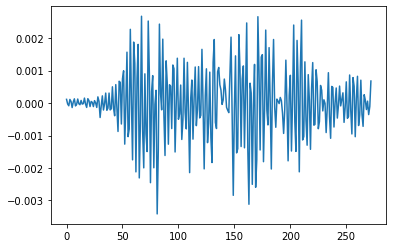

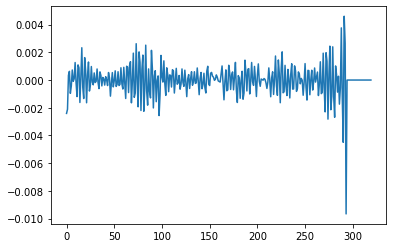

In [125]:
plt.plot(Signal)
plt.show()
plt.plot(sig)

In [ ]:
slice_sig = Sig[16:289]
plt.plot(Sig-slice_sig

In [55]:
window = np.hanning(len(window_list))
lib_fft_STFT = []
for i in range(0, len(sig)-(window_length-1), shift):
    print(i)
    globals()['F{}'.format(i)] = []
    window_list = np.zeros(len(sig))
    window_list[i:i+32] = sig[i:i+32]
    print(window_list)
    window_fft = fft(window_list)
    window_output = window*window_fft
    lib_fft_STFT.append(window_output)
lib_fft_STFT = np.array(lib_fft_STFT)
print(lib_fft_STFT.shape)
 

0
[-2.40724906e-03 -2.10987520e-03  3.40984087e-04  6.27512636e-04
 -9.60365578e-04 -4.23800288e-04  7.25175138e-04 -9.20794337e-05
  8.87432252e-05  1.26336876e-03 -2.21211652e-04 -1.19494775e-03
  1.09356153e-03  8.90683674e-04 -1.61895785e-03  2.08808415e-04
  2.33063707e-03 -5.20299771e-04 -1.33540540e-03  1.61938672e-03
  6.91259163e-04 -1.64030131e-03  3.52019590e-04  1.29934098e-03
 -7.92308769e-04 -3.56194039e-04  9.74035647e-04 -1.57305854e-04
 -3.43241496e-04  5.12627652e-04 -1.80236573e-04 -1.00035533e-04
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.000

In [60]:
window = np.hanning(len(window_list))
modif_STFT = []
for i in range(0, len(sig)-(window_length-1), shift):
    print(i)
    globals()['F{}'.format(i)] = []
    window_list = np.zeros(len(sig))
    window_list[i:i+32] = sig[i:i+32]
    print(window_list[:i+32])
    for k in range(0, len(window_list),1):
        F = 0
        for l, x in enumerate(window_list):
            value = (((2*np.pi)*k*l)/len(window_list))*1j
            F = F + ( x*np.exp(value) )
        globals()['F{}'.format(i)].append(F)
    globals()['F{}'.format(i)] = np.array(globals()['F{}'.format(i)])
    globals()['F{}'.format(i)] = window * globals()['F{}'.format(i)]
        
    modif_STFT.append(globals()['F{}'.format(i)])
    
modif_STFT = np.array(modif_STFT)
print(modif_STFT.shape)

0
[-2.40724906e-03 -2.10987520e-03  3.40984087e-04  6.27512636e-04
 -9.60365578e-04 -4.23800288e-04  7.25175138e-04 -9.20794337e-05
  8.87432252e-05  1.26336876e-03 -2.21211652e-04 -1.19494775e-03
  1.09356153e-03  8.90683674e-04 -1.61895785e-03  2.08808415e-04
  2.33063707e-03 -5.20299771e-04 -1.33540540e-03  1.61938672e-03
  6.91259163e-04 -1.64030131e-03  3.52019590e-04  1.29934098e-03
 -7.92308769e-04 -3.56194039e-04  9.74035647e-04 -1.57305854e-04
 -3.43241496e-04  5.12627652e-04 -1.80236573e-04 -1.00035533e-04]
16
[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  2.33063707e-03 -5.20299771e-04 -1.33540540e-03  1.61938672e-03
  6.91259163e-04 -1.64030131e-03  3.52019590e-04  1.29934098e-03
 -7.92308769e-04 -3.56194039e-04  9.74035647e-04 -1.57305854e-04
 -3.43241496e-04  5

112
[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.0

176
[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.0

224
[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.0

256
[ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
  0.00000000e+00  0.0

(19, 320)
